# Project: Train a Quadcopter How to Fly

Design an agent to fly a quadcopter, and then train it using a reinforcement learning algorithm of your choice! 

Try to apply the techniques you have learnt, but also feel free to come up with innovative ideas and test them.

## Instructions

Take a look at the files in the directory to better understand the structure of the project. 

- `task.py`: Define your task (environment) in this file.
- `agents/`: Folder containing reinforcement learning agents.
    - `policy_search.py`: A sample agent has been provided here.
    - `agent.py`: Develop your agent here.
- `physics_sim.py`: This file contains the simulator for the quadcopter.  **DO NOT MODIFY THIS FILE**.

For this project, you will define your own task in `task.py`.  Although we have provided a example task to get you started, you are encouraged to change it.  Later in this notebook, you will learn more about how to amend this file.

You will also design a reinforcement learning agent in `agent.py` to complete your chosen task.  

You are welcome to create any additional files to help you to organize your code.  For instance, you may find it useful to define a `model.py` file defining any needed neural network architectures.

## Controlling the Quadcopter

We provide a sample agent in the code cell below to show you how to use the sim to control the quadcopter.  This agent is even simpler than the sample agent that you'll examine (in `agents/policy_search.py`) later in this notebook!

The agent controls the quadcopter by setting the revolutions per second on each of its four rotors.  The provided agent in the `Basic_Agent` class below always selects a random action for each of the four rotors.  These four speeds are returned by the `act` method as a list of four floating-point numbers.  

For this project, the agent that you will implement in `agents/agent.py` will have a far more intelligent method for selecting actions!

In [20]:
import random

class Basic_Agent():
    def __init__(self, task):
        self.task = task
    
    def act(self):
        new_thrust = random.gauss(450., 25.)
        return [new_thrust + random.gauss(0., 1.) for x in range(4)]

Run the code cell below to have the agent select actions to control the quadcopter.  

Feel free to change the provided values of `runtime`, `init_pose`, `init_velocities`, and `init_angle_velocities` below to change the starting conditions of the quadcopter.

The `labels` list below annotates statistics that are saved while running the simulation.  All of this information is saved in a text file `data.txt` and stored in the dictionary `results`.  

In [21]:
%load_ext autoreload
%autoreload 2

import csv
import numpy as np
from task import Task

# Modify the values below to give the quadcopter a different starting position.
runtime = 5.                                     # time limit of the episode
init_pose = np.array([0., 0., 10., 0., 0., 0.])  # initial pose
init_velocities = np.array([0., 0., 0.])         # initial velocities
init_angle_velocities = np.array([0., 0., 0.])   # initial angle velocities
file_output = 'data.txt'                         # file name for saved results

# Setup
task = Task(init_pose, init_velocities, init_angle_velocities, runtime)
agent = Basic_Agent(task)
done = False
labels = ['time', 'x', 'y', 'z', 'phi', 'theta', 'psi', 'x_velocity',
          'y_velocity', 'z_velocity', 'phi_velocity', 'theta_velocity',
          'psi_velocity', 'rotor_speed1', 'rotor_speed2', 'rotor_speed3', 'rotor_speed4']
results = {x : [] for x in labels}

# Run the simulation, and save the results.
with open(file_output, 'w') as csvfile:
    writer = csv.writer(csvfile)
    writer.writerow(labels)
    while True:
        rotor_speeds = agent.act()
        _, _, done = task.step(rotor_speeds)
        to_write = [task.sim.time] + list(task.sim.pose) + list(task.sim.v) + list(task.sim.angular_v) + list(rotor_speeds)
        for ii in range(len(labels)):
            results[labels[ii]].append(to_write[ii])
        writer.writerow(to_write)
        if done:
            break

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


Run the code cell below to visualize how the position of the quadcopter evolved during the simulation.

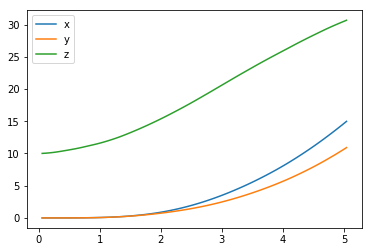

In [22]:
import matplotlib.pyplot as plt
%matplotlib inline

plt.plot(results['time'], results['x'], label='x')
plt.plot(results['time'], results['y'], label='y')
plt.plot(results['time'], results['z'], label='z')
plt.legend()
_ = plt.ylim()

The next code cell visualizes the velocity of the quadcopter.

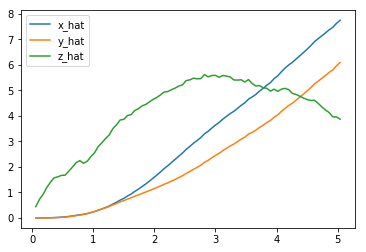

In [23]:
plt.plot(results['time'], results['x_velocity'], label='x_hat')
plt.plot(results['time'], results['y_velocity'], label='y_hat')
plt.plot(results['time'], results['z_velocity'], label='z_hat')
plt.legend()
_ = plt.ylim()

Next, you can plot the Euler angles (the rotation of the quadcopter over the $x$-, $y$-, and $z$-axes),

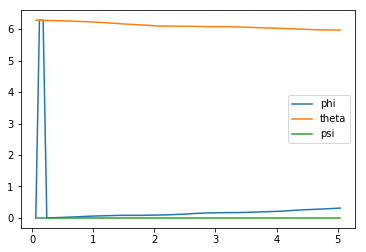

In [24]:
plt.plot(results['time'], results['phi'], label='phi')
plt.plot(results['time'], results['theta'], label='theta')
plt.plot(results['time'], results['psi'], label='psi')
plt.legend()
_ = plt.ylim()

before plotting the velocities (in radians per second) corresponding to each of the Euler angles.

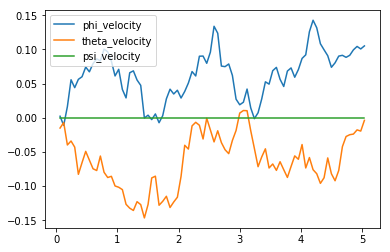

In [25]:
plt.plot(results['time'], results['phi_velocity'], label='phi_velocity')
plt.plot(results['time'], results['theta_velocity'], label='theta_velocity')
plt.plot(results['time'], results['psi_velocity'], label='psi_velocity')
plt.legend()
_ = plt.ylim()

Finally, you can use the code cell below to print the agent's choice of actions.  

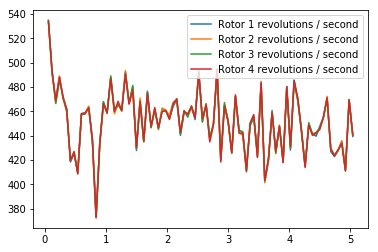

In [26]:
plt.plot(results['time'], results['rotor_speed1'], label='Rotor 1 revolutions / second')
plt.plot(results['time'], results['rotor_speed2'], label='Rotor 2 revolutions / second')
plt.plot(results['time'], results['rotor_speed3'], label='Rotor 3 revolutions / second')
plt.plot(results['time'], results['rotor_speed4'], label='Rotor 4 revolutions / second')
plt.legend()
_ = plt.ylim()

When specifying a task, you will derive the environment state from the simulator.  Run the code cell below to print the values of the following variables at the end of the simulation:
- `task.sim.pose` (the position of the quadcopter in ($x,y,z$) dimensions and the Euler angles),
- `task.sim.v` (the velocity of the quadcopter in ($x,y,z$) dimensions), and
- `task.sim.angular_v` (radians/second for each of the three Euler angles).

In [27]:
# the pose, velocity, and angular velocity of the quadcopter at the end of the episode
print(task.sim.pose)
print(task.sim.v)
print(task.sim.angular_v)

[ 14.98721015  10.91533795  30.68139349   0.31262832   5.96958992   0.        ]
[ 7.74309528  6.08905919  3.86741314]
[ 0.10513975 -0.00377723  0.        ]


In the sample task in `task.py`, we use the 6-dimensional pose of the quadcopter to construct the state of the environment at each timestep.  However, when amending the task for your purposes, you are welcome to expand the size of the state vector by including the velocity information.  You can use any combination of the pose, velocity, and angular velocity - feel free to tinker here, and construct the state to suit your task.

## The Task

A sample task has been provided for you in `task.py`.  Open this file in a new window now. 

The `__init__()` method is used to initialize several variables that are needed to specify the task.  
- The simulator is initialized as an instance of the `PhysicsSim` class (from `physics_sim.py`).  
- Inspired by the methodology in the original DDPG paper, we make use of action repeats.  For each timestep of the agent, we step the simulation `action_repeats` timesteps.  If you are not familiar with action repeats, please read the **Results** section in [the DDPG paper](https://arxiv.org/abs/1509.02971).
- We set the number of elements in the state vector.  For the sample task, we only work with the 6-dimensional pose information.  To set the size of the state (`state_size`), we must take action repeats into account.  
- The environment will always have a 4-dimensional action space, with one entry for each rotor (`action_size=4`). You can set the minimum (`action_low`) and maximum (`action_high`) values of each entry here.
- The sample task in this provided file is for the agent to reach a target position.  We specify that target position as a variable.

The `reset()` method resets the simulator.  The agent should call this method every time the episode ends.  You can see an example of this in the code cell below.

The `step()` method is perhaps the most important.  It accepts the agent's choice of action `rotor_speeds`, which is used to prepare the next state to pass on to the agent.  Then, the reward is computed from `get_reward()`.  The episode is considered done if the time limit has been exceeded, or the quadcopter has travelled outside of the bounds of the simulation.

In the next section, you will learn how to test the performance of an agent on this task.

## The Agent

The sample agent given in `agents/policy_search.py` uses a very simplistic linear policy to directly compute the action vector as a dot product of the state vector and a matrix of weights. Then, it randomly perturbs the parameters by adding some Gaussian noise, to produce a different policy. Based on the average reward obtained in each episode (`score`), it keeps track of the best set of parameters found so far, how the score is changing, and accordingly tweaks a scaling factor to widen or tighten the noise.

Run the code cell below to see how the agent performs on the sample task.

In [31]:
## TODO: Train your agent here.
num_episodes = 1000
target_pos = np.array([0., 0., 10.])
task = Task(target_pos=target_pos)
agent = PolicySearch_Agent(task) 

for i_episode in range(1, num_episodes+1):
    state = agent.reset_episode() # start a new episode
    while True:
        action = agent.act(state) 
        next_state, reward, done = task.step(action)
        agent.step(reward, done)
        state = next_state
        if done:
            print("\rEpisode = {:4d}, score = {:7.3f} (best = {:7.3f}), noise_scale = {}".format(
                i_episode, agent.score, agent.best_score, agent.noise_scale), end="")  # [debug]
            break
    sys.stdout.flush()


Episode = 1000, score =  -0.176 (best =   0.032), noise_scale = 3.25

This agent should perform very poorly on this task.  And that's where you come in!

## Define the Task, Design the Agent, and Train Your Agent!

Amend `task.py` to specify a task of your choosing.  If you're unsure what kind of task to specify, you may like to teach your quadcopter to takeoff, hover in place, land softly, or reach a target pose.  

After specifying your task, use the sample agent in `agents/policy_search.py` as a template to define your own agent in `agents/agent.py`.  You can borrow whatever you need from the sample agent, including ideas on how you might modularize your code (using helper methods like `act()`, `learn()`, `reset_episode()`, etc.).

Note that it is **highly unlikely** that the first agent and task that you specify will learn well.  You will likely have to tweak various hyperparameters and the reward function for your task until you arrive at reasonably good behavior.

As you develop your agent, it's important to keep an eye on how it's performing. Use the code above as inspiration to build in a mechanism to log/save the total rewards obtained in each episode to file.  If the episode rewards are gradually increasing, this is an indication that your agent is learning.

**ATTEMPT 1**

In [68]:
import sys
import pandas as pd
from agents.agent import DDPG
from task import Task

num_episodes = 500
init_pose = np.array([0., 0., 50., 0., 0., 0.])
init_vel = np.array([0., 0., 0.])
init_angle_velocities = np.array([0., 0., 0.])
target_pose = np.array([0., 0., 0., 0., 0., 0.])
target_vel = np.array([0., 0., 0.])
task = Task(init_pose=init_pose, init_vel=init_vel, init_angle_velocities=init_angle_velocities, target_pose=target_pose, target_vel=target_vel)
agent = DDPG(task)
avg_episode_rewards = []

'''
USED THIS REWARD FUNCTION:
reward = -.3*(abs(self.sim.pose[:3] - self.target_pose[:3])).sum() - .3*(abs(self.sim.v[:3] - self.target_vel)).sum()/( 1.*(abs(self.sim.pose[:3] - self.target_pose[:3])).sum() ) #velocity only counts when close to ground
Uses original neural networks in Actor and Critic. Adjust later. 
'''
for i_episode in range(1, num_episodes+1):
    print("")
    print("i_episode: " + str(i_episode))
    print("")
    print("")
    state = agent.reset_episode() # start a new episode
    time = 0
    total_episode_reward = 0
    count = 0
    while True:
        print("")
        print("time: " + str(time))
        print("sim time: " + str(task.sim.time))
        
        action = agent.act(state) 
        next_state, reward, done = task.step(action)
        print("reward: " + str(reward))
        
        total_episode_reward += reward
        count += 1
        
        agent.step(action, reward, next_state, done)
        state = next_state
        if done:
            #print("\rEpisode = {:4d}, score = {:7.3f} (best = {:7.3f}), noise_scale = {}".format(
            #    i_episode, agent.score, agent.best_score, agent.noise_scale), end="")  # [debug]
            break
        time += 1
    avg_episode_rewards.append(total_episode_reward/count)
    print("avg_episode_reward: " + str(total_episode_reward/count))
    sys.stdout.flush()
    



i_episode: 1



time: 0
sim time: 0.0
reward: -45.0080541637

time: 1
sim time: 0.06
reward: -45.00597074

time: 2
sim time: 0.12000000000000001
reward: -45.0162074897

time: 3
sim time: 0.18
reward: -44.9918520719

time: 4
sim time: 0.23999999999999996
reward: -44.9561052681

time: 5
sim time: 0.3
reward: -44.9089445806

time: 6
sim time: 0.36000000000000004
reward: -44.7625785895

time: 7
sim time: 0.4200000000000001
reward: -44.5622101435

time: 8
sim time: 0.48000000000000015
reward: -44.3540694292

time: 9
sim time: 0.5400000000000001
reward: -44.1055356131

time: 10
sim time: 0.6000000000000002
reward: -43.7592614923

time: 11
sim time: 0.6600000000000003
reward: -43.325077452

time: 12
sim time: 0.7200000000000003
reward: -42.8931437558

time: 13
sim time: 0.7800000000000004
reward: -42.3854697385

time: 14
sim time: 0.8400000000000004
reward: -41.781180274

time: 15
sim time: 0.9000000000000005
reward: -41.064587669

time: 16
sim time: 0.9600000000000005
reward: -40.3627883386


time: 46
sim time: 2.760000000000002
reward: -63.1616723815

time: 47
sim time: 2.820000000000002
reward: -62.924508008

time: 48
sim time: 2.880000000000002
reward: -62.6125255598

time: 49
sim time: 2.940000000000002
reward: -62.1717499263

time: 50
sim time: 3.000000000000002
reward: -61.6654742933

time: 51
sim time: 3.0600000000000023
reward: -61.2117614116

time: 52
sim time: 3.1200000000000023
reward: -60.7915477382

time: 53
sim time: 3.1800000000000024
reward: -60.3837184936

time: 54
sim time: 3.2400000000000024
reward: -60.0353956643

time: 55
sim time: 3.3000000000000025
reward: -59.7779001663

time: 56
sim time: 3.3600000000000025
reward: -59.6433717343

time: 57
sim time: 3.4200000000000026
reward: -59.631932261

time: 58
sim time: 3.4800000000000026
reward: -59.6978253847

time: 59
sim time: 3.5400000000000027
reward: -59.8442456974

time: 60
sim time: 3.6000000000000028
reward: -59.9894059218

time: 61
sim time: 3.660000000000003
reward: -60.0582561337

time: 62
sim ti


time: 39
sim time: 2.3400000000000016
reward: -28.4916469896

time: 40
sim time: 2.4000000000000017
reward: -27.5590937984

time: 41
sim time: 2.4600000000000017
reward: -26.4363837112

time: 42
sim time: 2.520000000000002
reward: -25.3504951251

time: 43
sim time: 2.580000000000002
reward: -24.3635109254

time: 44
sim time: 2.640000000000002
reward: -23.2050876783

time: 45
sim time: 2.700000000000002
reward: -21.9369598927

time: 46
sim time: 2.760000000000002
reward: -20.7163775416

time: 47
sim time: 2.820000000000002
reward: -19.3635419649

time: 48
sim time: 2.880000000000002
reward: -17.9572971957

time: 49
sim time: 2.940000000000002
reward: -16.5590733803

time: 50
sim time: 3.000000000000002
reward: -15.0499740096

time: 51
sim time: 3.0600000000000023
reward: -13.7415246525

time: 52
sim time: 3.1200000000000023
reward: -12.652346406

time: 53
sim time: 3.1800000000000024
reward: -11.646668618

time: 54
sim time: 3.2400000000000024
reward: -10.9849435809

time: 55
sim time:

time: 66
sim time: 3.960000000000003
reward: -44.2921158336

time: 67
sim time: 4.020000000000002
reward: -43.2422370922

time: 68
sim time: 4.080000000000001
reward: -42.1662609538

time: 69
sim time: 4.14
reward: -41.0453800698

time: 70
sim time: 4.199999999999998
reward: -39.8199916374

time: 71
sim time: 4.259999999999997
reward: -38.546132414

time: 72
sim time: 4.319999999999996
reward: -37.2520741167

time: 73
sim time: 4.379999999999995
reward: -35.8950286803

time: 74
sim time: 4.439999999999993
reward: -34.4407996318

time: 75
sim time: 4.499999999999992
reward: -32.9963119093

time: 76
sim time: 4.559999999999991
reward: -31.5134614181

time: 77
sim time: 4.6199999999999894
reward: -29.9499268119

time: 78
sim time: 4.679999999999988
reward: -28.4125665806

time: 79
sim time: 4.739999999999987
reward: -27.3063173363

time: 80
sim time: 4.799999999999986
reward: -26.2106870429

time: 81
sim time: 4.859999999999984
reward: -25.0651075313

time: 82
sim time: 4.919999999999983



time: 6
sim time: 0.36000000000000004
reward: -45.2135756679

time: 7
sim time: 0.4200000000000001
reward: -45.1330017118

time: 8
sim time: 0.48000000000000015
reward: -45.0265801673

time: 9
sim time: 0.5400000000000001
reward: -44.9023929586

time: 10
sim time: 0.6000000000000002
reward: -44.6724138837

time: 11
sim time: 0.6600000000000003
reward: -44.4425710947

time: 12
sim time: 0.7200000000000003
reward: -44.1508243712

time: 13
sim time: 0.7800000000000004
reward: -43.7766985804

time: 14
sim time: 0.8400000000000004
reward: -43.5330155096

time: 15
sim time: 0.9000000000000005
reward: -43.2792893665

time: 16
sim time: 0.9600000000000005
reward: -43.032183611

time: 17
sim time: 1.0200000000000005
reward: -42.7266631194

time: 18
sim time: 1.0800000000000005
reward: -42.3994593324

time: 19
sim time: 1.1400000000000006
reward: -42.0702529167

time: 20
sim time: 1.2000000000000006
reward: -41.7688228673

time: 21
sim time: 1.2600000000000007
reward: -41.3883260002

time: 22
s

reward: -41.2029420161

time: 22
sim time: 1.3200000000000007
reward: -40.8176490395

time: 23
sim time: 1.3800000000000008
reward: -40.4307712032

time: 24
sim time: 1.4400000000000008
reward: -40.008879041

time: 25
sim time: 1.5000000000000009
reward: -39.5142906827

time: 26
sim time: 1.560000000000001
reward: -38.9537483886

time: 27
sim time: 1.620000000000001
reward: -38.3722685978

time: 28
sim time: 1.680000000000001
reward: -37.7444055357

time: 29
sim time: 1.740000000000001
reward: -37.0518314959

time: 30
sim time: 1.8000000000000012
reward: -36.2908468105

time: 31
sim time: 1.8600000000000012
reward: -35.4698642403

time: 32
sim time: 1.9200000000000013
reward: -34.6416088036

time: 33
sim time: 1.9800000000000013
reward: -33.7862491502

time: 34
sim time: 2.0400000000000014
reward: -32.8307825524

time: 35
sim time: 2.1000000000000014
reward: -31.7962075992

time: 36
sim time: 2.1600000000000015
reward: -30.7782741448

time: 37
sim time: 2.2200000000000015
reward: -29.7

reward: -17.8052160672

time: 48
sim time: 2.880000000000002
reward: -16.52659289

time: 49
sim time: 2.940000000000002
reward: -15.2579637855

time: 50
sim time: 3.000000000000002
reward: -14.0278478055

time: 51
sim time: 3.0600000000000023
reward: -12.758444761

time: 52
sim time: 3.1200000000000023
reward: -11.6463510767

time: 53
sim time: 3.1800000000000024
reward: -11.0298052771

time: 54
sim time: 3.2400000000000024
reward: -10.849938535

time: 55
sim time: 3.3000000000000025
reward: -11.6390482843

time: 56
sim time: 3.3600000000000025
reward: -14.1109220445
avg_episode_reward: -32.6181792888

i_episode: 15



time: 0
sim time: 0.0
reward: -45.0068357012

time: 1
sim time: 0.06
reward: -45.0274330597

time: 2
sim time: 0.12000000000000001
reward: -45.0285949701

time: 3
sim time: 0.18
reward: -45.0351478415

time: 4
sim time: 0.23999999999999996
reward: -45.0230074243

time: 5
sim time: 0.3
reward: -44.9999121402

time: 6
sim time: 0.36000000000000004
reward: -44.9641053629

t


time: 7
sim time: 0.4200000000000001
reward: -45.5859590374

time: 8
sim time: 0.48000000000000015
reward: -45.5181558377

time: 9
sim time: 0.5400000000000001
reward: -45.3238599107

time: 10
sim time: 0.6000000000000002
reward: -45.2592401942

time: 11
sim time: 0.6600000000000003
reward: -45.2092065266

time: 12
sim time: 0.7200000000000003
reward: -44.9501788512

time: 13
sim time: 0.7800000000000004
reward: -44.6699981188

time: 14
sim time: 0.8400000000000004
reward: -44.5406637999

time: 15
sim time: 0.9000000000000005
reward: -44.4058142687

time: 16
sim time: 0.9600000000000005
reward: -44.2244103156

time: 17
sim time: 1.0200000000000005
reward: -44.1791792585

time: 18
sim time: 1.0800000000000005
reward: -43.9666312691

time: 19
sim time: 1.1400000000000006
reward: -43.4858896139

time: 20
sim time: 1.2000000000000006
reward: -42.9281523767

time: 21
sim time: 1.2600000000000007
reward: -42.3717460248

time: 22
sim time: 1.3200000000000007
reward: -41.9340219021

time: 23



time: 57
sim time: 3.4200000000000026
reward: -14.8231937176

time: 58
sim time: 3.4800000000000026
reward: -16.6279907018
avg_episode_reward: -32.9569720929

i_episode: 19



time: 0
sim time: 0.0
reward: -45.050887132

time: 1
sim time: 0.06
reward: -45.2071202958

time: 2
sim time: 0.12000000000000001
reward: -45.3461331436

time: 3
sim time: 0.18
reward: -45.3657156323

time: 4
sim time: 0.23999999999999996
reward: -45.4400529898

time: 5
sim time: 0.3
reward: -45.5955403732

time: 6
sim time: 0.36000000000000004
reward: -45.6862542681

time: 7
sim time: 0.4200000000000001
reward: -45.7661921964

time: 8
sim time: 0.48000000000000015
reward: -45.8107156283

time: 9
sim time: 0.5400000000000001
reward: -45.817655582

time: 10
sim time: 0.6000000000000002
reward: -45.8928388463

time: 11
sim time: 0.6600000000000003
reward: -45.9233099753

time: 12
sim time: 0.7200000000000003
reward: -45.7888310167

time: 13
sim time: 0.7800000000000004
reward: -45.6650409591

time: 14
sim time: 0.


time: 9
sim time: 0.5400000000000001
reward: -45.2882903752

time: 10
sim time: 0.6000000000000002
reward: -45.1918065785

time: 11
sim time: 0.6600000000000003
reward: -45.1478851219

time: 12
sim time: 0.7200000000000003
reward: -44.9031998756

time: 13
sim time: 0.7800000000000004
reward: -44.6013828022

time: 14
sim time: 0.8400000000000004
reward: -44.4430034344

time: 15
sim time: 0.9000000000000005
reward: -44.2230332019

time: 16
sim time: 0.9600000000000005
reward: -43.8110249024

time: 17
sim time: 1.0200000000000005
reward: -43.4412849562

time: 18
sim time: 1.0800000000000005
reward: -43.1852515639

time: 19
sim time: 1.1400000000000006
reward: -42.7681372351

time: 20
sim time: 1.2000000000000006
reward: -42.2300639343

time: 21
sim time: 1.2600000000000007
reward: -41.8078763026

time: 22
sim time: 1.3200000000000007
reward: -41.4053341106

time: 23
sim time: 1.3800000000000008
reward: -40.8025495264

time: 24
sim time: 1.4400000000000008
reward: -40.176125218

time: 25



time: 19
sim time: 1.1400000000000006
reward: -41.0772442207

time: 20
sim time: 1.2000000000000006
reward: -41.2486231816

time: 21
sim time: 1.2600000000000007
reward: -41.5378872175

time: 22
sim time: 1.3200000000000007
reward: -41.9052243647

time: 23
sim time: 1.3800000000000008
reward: -42.2955344853

time: 24
sim time: 1.4400000000000008
reward: -42.6906496519

time: 25
sim time: 1.5000000000000009
reward: -43.0029935841

time: 26
sim time: 1.560000000000001
reward: -43.2126086135

time: 27
sim time: 1.620000000000001
reward: -43.3295813936

time: 28
sim time: 1.680000000000001
reward: -43.2493208479

time: 29
sim time: 1.740000000000001
reward: -42.9642791205

time: 30
sim time: 1.8000000000000012
reward: -42.4850053538

time: 31
sim time: 1.8600000000000012
reward: -41.7749288531

time: 32
sim time: 1.9200000000000013
reward: -40.836261959

time: 33
sim time: 1.9800000000000013
reward: -39.6821204045

time: 34
sim time: 2.0400000000000014
reward: -39.5341895629

time: 35
sim


time: 37
sim time: 2.2200000000000015
reward: -101.886759681

time: 38
sim time: 2.2800000000000016
reward: -102.58505621

time: 39
sim time: 2.3400000000000016
reward: -103.336267436

time: 40
sim time: 2.4000000000000017
reward: -104.572756266

time: 41
sim time: 2.4600000000000017
reward: -107.72654485

time: 42
sim time: 2.520000000000002
reward: -127.832414604
avg_episode_reward: -74.8083235872

i_episode: 26



time: 0
sim time: 0.0
reward: -45.0222173954

time: 1
sim time: 0.06
reward: -45.0663644825

time: 2
sim time: 0.12000000000000001
reward: -45.2702226539

time: 3
sim time: 0.18
reward: -45.5741539627

time: 4
sim time: 0.23999999999999996
reward: -45.8582000061

time: 5
sim time: 0.3
reward: -46.0205542081

time: 6
sim time: 0.36000000000000004
reward: -45.9850028644

time: 7
sim time: 0.4200000000000001
reward: -45.7024928142

time: 8
sim time: 0.48000000000000015
reward: -45.1537811215

time: 9
sim time: 0.5400000000000001
reward: -44.3503243933

time: 10
sim time: 0.6

time: 50
sim time: 3.000000000000002
reward: -119.937441578

time: 51
sim time: 3.0600000000000023
reward: -122.01575584

time: 52
sim time: 3.1200000000000023
reward: -124.105190457

time: 53
sim time: 3.1800000000000024
reward: -126.20538966

time: 54
sim time: 3.2400000000000024
reward: -128.316072914

time: 55
sim time: 3.3000000000000025
reward: -130.43707391

time: 56
sim time: 3.3600000000000025
reward: -132.568282025

time: 57
sim time: 3.4200000000000026
reward: -134.70966494

time: 58
sim time: 3.4800000000000026
reward: -136.861268105

time: 59
sim time: 3.5400000000000027
reward: -139.023092966

time: 60
sim time: 3.6000000000000028
reward: -141.195212921

time: 61
sim time: 3.660000000000003
reward: -143.377773939

time: 62
sim time: 3.720000000000003
reward: -145.571007782

time: 63
sim time: 3.780000000000003
reward: -147.775208479

time: 64
sim time: 3.840000000000003
reward: -149.990684745

time: 65
sim time: 3.900000000000003
reward: -152.217783043

time: 66
sim time:


time: 54
sim time: 3.2400000000000024
reward: -13.8232187298

time: 55
sim time: 3.3000000000000025
reward: -13.0800856817

time: 56
sim time: 3.3600000000000025
reward: -12.2148312127

time: 57
sim time: 3.4200000000000026
reward: -11.343499237

time: 58
sim time: 3.4800000000000026
reward: -10.46448216

time: 59
sim time: 3.5400000000000027
reward: -10.2433757144

time: 60
sim time: 3.6000000000000028
reward: -10.0133317336
avg_episode_reward: -32.7984894221

i_episode: 30



time: 0
sim time: 0.0
reward: -45.0508739052

time: 1
sim time: 0.06
reward: -45.2070732563

time: 2
sim time: 0.12000000000000001
reward: -45.3328903659

time: 3
sim time: 0.18
reward: -45.4620013623

time: 4
sim time: 0.23999999999999996
reward: -45.5600900032

time: 5
sim time: 0.3
reward: -45.4952610843

time: 6
sim time: 0.36000000000000004
reward: -45.477872446

time: 7
sim time: 0.4200000000000001
reward: -45.5755896053

time: 8
sim time: 0.48000000000000015
reward: -45.5115695749

time: 9
sim time: 0.54


time: 10
sim time: 0.6000000000000002
reward: -45.2393706017

time: 11
sim time: 0.6600000000000003
reward: -45.1912588473

time: 12
sim time: 0.7200000000000003
reward: -44.9355693485

time: 13
sim time: 0.7800000000000004
reward: -44.6488458659

time: 14
sim time: 0.8400000000000004
reward: -44.506161265

time: 15
sim time: 0.9000000000000005
reward: -44.2747388957

time: 16
sim time: 0.9600000000000005
reward: -43.8586847726

time: 17
sim time: 1.0200000000000005
reward: -43.5132912809

time: 18
sim time: 1.0800000000000005
reward: -43.2603620661

time: 19
sim time: 1.1400000000000006
reward: -42.8309975805

time: 20
sim time: 1.2000000000000006
reward: -42.2993710777

time: 21
sim time: 1.2600000000000007
reward: -41.899481941

time: 22
sim time: 1.3200000000000007
reward: -41.4904163136

time: 23
sim time: 1.3800000000000008
reward: -40.8797630158

time: 24
sim time: 1.4400000000000008
reward: -40.2706887153

time: 25
sim time: 1.5000000000000009
reward: -39.7923295697

time: 26


time: 26
sim time: 1.560000000000001
reward: -39.214703048

time: 27
sim time: 1.620000000000001
reward: -38.4596759429

time: 28
sim time: 1.680000000000001
reward: -37.8050165291

time: 29
sim time: 1.740000000000001
reward: -37.201801335

time: 30
sim time: 1.8000000000000012
reward: -36.4094856342

time: 31
sim time: 1.8600000000000012
reward: -35.5608895203

time: 32
sim time: 1.9200000000000013
reward: -34.8458061544

time: 33
sim time: 1.9800000000000013
reward: -34.0764755636

time: 34
sim time: 2.0400000000000014
reward: -33.1213043747

time: 35
sim time: 2.1000000000000014
reward: -32.2128231319

time: 36
sim time: 2.1600000000000015
reward: -31.4045137479

time: 37
sim time: 2.2200000000000015
reward: -30.4493427343

time: 38
sim time: 2.2800000000000016
reward: -29.3785798934

time: 39
sim time: 2.3400000000000016
reward: -28.4267977571

time: 40
sim time: 2.4000000000000017
reward: -27.4845062927

time: 41
sim time: 2.4600000000000017
reward: -26.3529544421

time: 42
sim t


time: 44
sim time: 2.640000000000002
reward: -23.1906423941

time: 45
sim time: 2.700000000000002
reward: -21.9586999807

time: 46
sim time: 2.760000000000002
reward: -20.8086423638

time: 47
sim time: 2.820000000000002
reward: -19.6992833022

time: 48
sim time: 2.880000000000002
reward: -18.5467637916

time: 49
sim time: 2.940000000000002
reward: -17.370030172

time: 50
sim time: 3.000000000000002
reward: -16.3308445795

time: 51
sim time: 3.0600000000000023
reward: -15.2082844704

time: 52
sim time: 3.1200000000000023
reward: -14.0685154914

time: 53
sim time: 3.1800000000000024
reward: -12.996015971

time: 54
sim time: 3.2400000000000024
reward: -12.1067546752

time: 55
sim time: 3.3000000000000025
reward: -11.2521246914

time: 56
sim time: 3.3600000000000025
reward: -10.780828059

time: 57
sim time: 3.4200000000000026
reward: -10.98057789

time: 58
sim time: 3.4800000000000026
reward: -11.3299399238
avg_episode_reward: -33.2444804201

i_episode: 37



time: 0
sim time: 0.0
reward:


time: 57
sim time: 3.4200000000000026
reward: -61.4797650176

time: 58
sim time: 3.4800000000000026
reward: -61.163331586

time: 59
sim time: 3.5400000000000027
reward: -60.7020737722

time: 60
sim time: 3.6000000000000028
reward: -60.2902371277

time: 61
sim time: 3.660000000000003
reward: -59.9202385829

time: 62
sim time: 3.720000000000003
reward: -59.4274111505

time: 63
sim time: 3.780000000000003
reward: -58.8497048752

time: 64
sim time: 3.840000000000003
reward: -58.3569300299

time: 65
sim time: 3.900000000000003
reward: -57.8503704169

time: 66
sim time: 3.960000000000003
reward: -57.1864141702

time: 67
sim time: 4.020000000000002
reward: -56.5288159771

time: 68
sim time: 4.080000000000001
reward: -55.9414120983

time: 69
sim time: 4.14
reward: -55.2702622636

time: 70
sim time: 4.199999999999998
reward: -54.469122788

time: 71
sim time: 4.259999999999997
reward: -53.7441406786

time: 72
sim time: 4.319999999999996
reward: -53.0437662986

time: 73
sim time: 4.3799999999999

time: 25
sim time: 1.5000000000000009
reward: -50.5568186297

time: 26
sim time: 1.560000000000001
reward: -51.06643857

time: 27
sim time: 1.620000000000001
reward: -51.5260468858

time: 28
sim time: 1.680000000000001
reward: -52.0544394997

time: 29
sim time: 1.740000000000001
reward: -52.6236624391

time: 30
sim time: 1.8000000000000012
reward: -53.1832582741

time: 31
sim time: 1.8600000000000012
reward: -53.7246075953

time: 32
sim time: 1.9200000000000013
reward: -54.3387703402

time: 33
sim time: 1.9800000000000013
reward: -54.9812476101

time: 34
sim time: 2.0400000000000014
reward: -55.5820684804

time: 35
sim time: 2.1000000000000014
reward: -56.2157820267

time: 36
sim time: 2.1600000000000015
reward: -56.9025272605

time: 37
sim time: 2.2200000000000015
reward: -57.5997687744

time: 38
sim time: 2.2800000000000016
reward: -58.2548587409

time: 39
sim time: 2.3400000000000016
reward: -58.9739535884

time: 40
sim time: 2.4000000000000017
reward: -59.7271295528

time: 41
sim t


time: 79
sim time: 4.739999999999987
reward: -96.6834342458

time: 80
sim time: 4.799999999999986
reward: -97.7813972414

time: 81
sim time: 4.859999999999984
reward: -98.8519937732

time: 82
sim time: 4.919999999999983
reward: -99.9199428172

time: 83
sim time: 4.979999999999982
reward: -101.015006252
avg_episode_reward: -65.1525366252

i_episode: 42



time: 0
sim time: 0.0
reward: -45.0335868745

time: 1
sim time: 0.06
reward: -45.1310909988

time: 2
sim time: 0.12000000000000001
reward: -45.1906772564

time: 3
sim time: 0.18
reward: -45.2336027658

time: 4
sim time: 0.23999999999999996
reward: -45.2538753832

time: 5
sim time: 0.3
reward: -45.2222936258

time: 6
sim time: 0.36000000000000004
reward: -45.2673679043

time: 7
sim time: 0.4200000000000001
reward: -45.3728224832

time: 8
sim time: 0.48000000000000015
reward: -45.4919215627

time: 9
sim time: 0.5400000000000001
reward: -45.5651767536

time: 10
sim time: 0.6000000000000002
reward: -45.7249193738

time: 11
sim time: 0.660

time: 47
sim time: 2.820000000000002
reward: -39.2634463302

time: 48
sim time: 2.880000000000002
reward: -38.6072033591

time: 49
sim time: 2.940000000000002
reward: -37.9751479792

time: 50
sim time: 3.000000000000002
reward: -37.2862496826

time: 51
sim time: 3.0600000000000023
reward: -36.5508956259
avg_episode_reward: -44.502986896

i_episode: 44



time: 0
sim time: 0.0
reward: -45.0335336875

time: 1
sim time: 0.06
reward: -45.1296325177

time: 2
sim time: 0.12000000000000001
reward: -45.1869297783

time: 3
sim time: 0.18
reward: -45.2249795266

time: 4
sim time: 0.23999999999999996
reward: -45.2500805159

time: 5
sim time: 0.3
reward: -45.2310109403

time: 6
sim time: 0.36000000000000004
reward: -45.2759779606

time: 7
sim time: 0.4200000000000001
reward: -45.3828492423

time: 8
sim time: 0.48000000000000015
reward: -45.5054680237

time: 9
sim time: 0.5400000000000001
reward: -45.5823021605

time: 10
sim time: 0.6000000000000002
reward: -45.7441859085

time: 11
sim time: 0.6600


time: 45
sim time: 2.700000000000002
reward: -26.9366653825

time: 46
sim time: 2.760000000000002
reward: -25.6257602095

time: 47
sim time: 2.820000000000002
reward: -24.243271041

time: 48
sim time: 2.880000000000002
reward: -22.7993540765

time: 49
sim time: 2.940000000000002
reward: -21.402048045

time: 50
sim time: 3.000000000000002
reward: -20.0612713501

time: 51
sim time: 3.0600000000000023
reward: -18.5948677285

time: 52
sim time: 3.1200000000000023
reward: -17.171316207

time: 53
sim time: 3.1800000000000024
reward: -15.8635648358

time: 54
sim time: 3.2400000000000024
reward: -14.5816411095

time: 55
sim time: 3.3000000000000025
reward: -13.2455596846

time: 56
sim time: 3.3600000000000025
reward: -12.1598474954
avg_episode_reward: -37.9619571226

i_episode: 46



time: 0
sim time: 0.0
reward: -45.0335641569

time: 1
sim time: 0.06
reward: -45.1304606297

time: 2
sim time: 0.12000000000000001
reward: -45.1892771311

time: 3
sim time: 0.18
reward: -45.2306116725

time: 4
si


time: 40
sim time: 2.4000000000000017
reward: -59.7922325522

time: 41
sim time: 2.4600000000000017
reward: -60.5280552754

time: 42
sim time: 2.520000000000002
reward: -61.2604325497

time: 43
sim time: 2.580000000000002
reward: -62.0510764178

time: 44
sim time: 2.640000000000002
reward: -62.8645309025

time: 45
sim time: 2.700000000000002
reward: -63.6338392754

time: 46
sim time: 2.760000000000002
reward: -64.4416647437

time: 47
sim time: 2.820000000000002
reward: -65.2908380289

time: 48
sim time: 2.880000000000002
reward: -66.1398547788

time: 49
sim time: 2.940000000000002
reward: -66.9580600364

time: 50
sim time: 3.000000000000002
reward: -67.8304291991

time: 51
sim time: 3.0600000000000023
reward: -68.7315643614

time: 52
sim time: 3.1200000000000023
reward: -69.6025143987

time: 53
sim time: 3.1800000000000024
reward: -70.4803970819

time: 54
sim time: 3.2400000000000024
reward: -71.4043571093

time: 55
sim time: 3.3000000000000025
reward: -72.3438686827

time: 56
sim tim


time: 7
sim time: 0.4200000000000001
reward: -45.2849872856

time: 8
sim time: 0.48000000000000015
reward: -45.1965287465

time: 9
sim time: 0.5400000000000001
reward: -45.0236909075

time: 10
sim time: 0.6000000000000002
reward: -44.8562247254

time: 11
sim time: 0.6600000000000003
reward: -44.6895209491

time: 12
sim time: 0.7200000000000003
reward: -44.4347468721

time: 13
sim time: 0.7800000000000004
reward: -44.2643340916

time: 14
sim time: 0.8400000000000004
reward: -44.1018848074

time: 15
sim time: 0.9000000000000005
reward: -43.8783043255

time: 16
sim time: 0.9600000000000005
reward: -43.6750106733

time: 17
sim time: 1.0200000000000005
reward: -43.4044426996

time: 18
sim time: 1.0800000000000005
reward: -43.1239816492

time: 19
sim time: 1.1400000000000006
reward: -42.7998037044

time: 20
sim time: 1.2000000000000006
reward: -42.4557298016

time: 21
sim time: 1.2600000000000007
reward: -42.115427772

time: 22
sim time: 1.3200000000000007
reward: -41.757641112

time: 23
si


time: 82
sim time: 4.919999999999983
reward: -85.281195077

time: 83
sim time: 4.979999999999982
reward: -86.1781713458
avg_episode_reward: -58.967110245

i_episode: 51



time: 0
sim time: 0.0
reward: -45.033501723

time: 1
sim time: 0.06
reward: -45.1290913401

time: 2
sim time: 0.12000000000000001
reward: -45.1860746045

time: 3
sim time: 0.18
reward: -45.2238024346

time: 4
sim time: 0.23999999999999996
reward: -45.2499769255

time: 5
sim time: 0.3
reward: -45.2323112629

time: 6
sim time: 0.36000000000000004
reward: -45.2772259692

time: 7
sim time: 0.4200000000000001
reward: -45.3834776962

time: 8
sim time: 0.48000000000000015
reward: -45.5061223614

time: 9
sim time: 0.5400000000000001
reward: -45.5825437117

time: 10
sim time: 0.6000000000000002
reward: -45.7444431574

time: 11
sim time: 0.6600000000000003
reward: -45.949025885

time: 12
sim time: 0.7200000000000003
reward: -46.1318076379

time: 13
sim time: 0.7800000000000004
reward: -46.31736586

time: 14
sim time: 0.840000

reward: -150.66102092

time: 76
sim time: 4.559999999999991
reward: -151.82978695

time: 77
sim time: 4.6199999999999894
reward: -152.907436481

time: 78
sim time: 4.679999999999988
reward: -153.932681674

time: 79
sim time: 4.739999999999987
reward: -154.95211927

time: 80
sim time: 4.799999999999986
reward: -155.883772696

time: 81
sim time: 4.859999999999984
reward: -156.723405727

time: 82
sim time: 4.919999999999983
reward: -157.568805413

time: 83
sim time: 4.979999999999982
reward: -158.512401091
avg_episode_reward: -99.0848916857

i_episode: 53



time: 0
sim time: 0.0
reward: -45.0606126829

time: 1
sim time: 0.06
reward: -45.2485805195

time: 2
sim time: 0.12000000000000001
reward: -45.5589851631

time: 3
sim time: 0.18
reward: -45.9879066513

time: 4
sim time: 0.23999999999999996
reward: -46.5302376528

time: 5
sim time: 0.3
reward: -47.1798445326

time: 6
sim time: 0.36000000000000004
reward: -47.9297834586

time: 7
sim time: 0.4200000000000001
reward: -48.7725467845

time:


time: 44
sim time: 2.640000000000002
reward: -104.442987893

time: 45
sim time: 2.700000000000002
reward: -106.255637408

time: 46
sim time: 2.760000000000002
reward: -108.078548608

time: 47
sim time: 2.820000000000002
reward: -109.911591683

time: 48
sim time: 2.880000000000002
reward: -111.754809807

time: 49
sim time: 2.940000000000002
reward: -113.608347491

time: 50
sim time: 3.000000000000002
reward: -115.472426138

time: 51
sim time: 3.0600000000000023
reward: -117.347385922

time: 52
sim time: 3.1200000000000023
reward: -119.233707

time: 53
sim time: 3.1800000000000024
reward: -121.132012908

time: 54
sim time: 3.2400000000000024
reward: -123.04298684

time: 55
sim time: 3.3000000000000025
reward: -124.967328969

time: 56
sim time: 3.3600000000000025
reward: -126.905766371

time: 57
sim time: 3.4200000000000026
reward: -128.859126134

time: 58
sim time: 3.4800000000000026
reward: -130.828319368

time: 59
sim time: 3.5400000000000027
reward: -132.814306884

time: 60
sim time:

reward: -51.7697355479

time: 11
sim time: 0.6600000000000003
reward: -52.9001037611

time: 12
sim time: 0.7200000000000003
reward: -54.0841167712

time: 13
sim time: 0.7800000000000004
reward: -55.3157088853

time: 14
sim time: 0.8400000000000004
reward: -56.5880713504

time: 15
sim time: 0.9000000000000005
reward: -57.895550644

time: 16
sim time: 0.9600000000000005
reward: -59.2392162787

time: 17
sim time: 1.0200000000000005
reward: -60.6319597579

time: 18
sim time: 1.0800000000000005
reward: -62.0571208957

time: 19
sim time: 1.1400000000000006
reward: -63.5109535663

time: 20
sim time: 1.2000000000000006
reward: -64.9914289951

time: 21
sim time: 1.2600000000000007
reward: -66.4968143296

time: 22
sim time: 1.3200000000000007
reward: -68.0256286802

time: 23
sim time: 1.3800000000000008
reward: -69.5766639966

time: 24
sim time: 1.4400000000000008
reward: -71.148878174

time: 25
sim time: 1.5000000000000009
reward: -72.7413985651

time: 26
sim time: 1.560000000000001
reward: -74

avg_episode_reward: -35.6598453642

i_episode: 58



time: 0
sim time: 0.0
reward: -45.0508502704

time: 1
sim time: 0.06
reward: -45.2069432864

time: 2
sim time: 0.12000000000000001
reward: -45.3324910962

time: 3
sim time: 0.18
reward: -45.4612902083

time: 4
sim time: 0.23999999999999996
reward: -45.5590052371

time: 5
sim time: 0.3
reward: -45.4942537668

time: 6
sim time: 0.36000000000000004
reward: -45.4837613478

time: 7
sim time: 0.4200000000000001
reward: -45.5394063166

time: 8
sim time: 0.48000000000000015
reward: -45.5908349484

time: 9
sim time: 0.5400000000000001
reward: -45.7280214942

time: 10
sim time: 0.6000000000000002
reward: -45.6736859546

time: 11
sim time: 0.6600000000000003
reward: -45.3700494246

time: 12
sim time: 0.7200000000000003
reward: -44.9745132176

time: 13
sim time: 0.7800000000000004
reward: -44.5911094663

time: 14
sim time: 0.8400000000000004
reward: -44.2145742034

time: 15
sim time: 0.9000000000000005
reward: -43.7374371794

time: 16
sim time: 


time: 68
sim time: 4.080000000000001
reward: -125.450912782

time: 69
sim time: 4.14
reward: -125.962125083

time: 70
sim time: 4.199999999999998
reward: -126.514311556

time: 71
sim time: 4.259999999999997
reward: -126.918310434

time: 72
sim time: 4.319999999999996
reward: -127.260386887

time: 73
sim time: 4.379999999999995
reward: -127.688684155

time: 74
sim time: 4.439999999999993
reward: -128.084707531

time: 75
sim time: 4.499999999999992
reward: -128.329215241

time: 76
sim time: 4.559999999999991
reward: -128.578966577

time: 77
sim time: 4.6199999999999894
reward: -128.902755478

time: 78
sim time: 4.679999999999988
reward: -129.119460618

time: 79
sim time: 4.739999999999987
reward: -129.232242281

time: 80
sim time: 4.799999999999986
reward: -129.403773934

time: 81
sim time: 4.859999999999984
reward: -129.595597413

time: 82
sim time: 4.919999999999983
reward: -129.642389863

time: 83
sim time: 4.979999999999982
reward: -129.646697076
avg_episode_reward: -93.5993912295




time: 62
sim time: 3.720000000000003
reward: -42.1058147981

time: 63
sim time: 3.780000000000003
reward: -42.3206569867

time: 64
sim time: 3.840000000000003
reward: -42.5465962488

time: 65
sim time: 3.900000000000003
reward: -42.8502492536

time: 66
sim time: 3.960000000000003
reward: -43.1421048384

time: 67
sim time: 4.020000000000002
reward: -43.3944586612

time: 68
sim time: 4.080000000000001
reward: -43.6958227569

time: 69
sim time: 4.14
reward: -44.0527782185

time: 70
sim time: 4.199999999999998
reward: -44.3719803249

time: 71
sim time: 4.259999999999997
reward: -44.6753535986

time: 72
sim time: 4.319999999999996
reward: -45.0523565715

time: 73
sim time: 4.379999999999995
reward: -45.4471147235

time: 74
sim time: 4.439999999999993
reward: -45.7964003366

time: 75
sim time: 4.499999999999992
reward: -46.1654083597

time: 76
sim time: 4.559999999999991
reward: -46.6063373414

time: 77
sim time: 4.6199999999999894
reward: -47.0298354295

time: 78
sim time: 4.67999999999998


time: 30
sim time: 1.8000000000000012
reward: -48.3752082518

time: 31
sim time: 1.8600000000000012
reward: -47.5678311643

time: 32
sim time: 1.9200000000000013
reward: -46.7983767083

time: 33
sim time: 1.9800000000000013
reward: -46.1237765665

time: 34
sim time: 2.0400000000000014
reward: -45.5720526599

time: 35
sim time: 2.1000000000000014
reward: -45.1594014258

time: 36
sim time: 2.1600000000000015
reward: -44.8654733105

time: 37
sim time: 2.2200000000000015
reward: -44.6714703496

time: 38
sim time: 2.2800000000000016
reward: -44.4912342039

time: 39
sim time: 2.3400000000000016
reward: -44.2614263935

time: 40
sim time: 2.4000000000000017
reward: -43.9387115585

time: 41
sim time: 2.4600000000000017
reward: -43.4827408461

time: 42
sim time: 2.520000000000002
reward: -42.8555046898

time: 43
sim time: 2.580000000000002
reward: -42.0265014599

time: 44
sim time: 2.640000000000002
reward: -40.9786937664

time: 45
sim time: 2.700000000000002
reward: -39.7105362735

time: 46
si


time: 25
sim time: 1.5000000000000009
reward: -77.2139081786

time: 26
sim time: 1.560000000000001
reward: -78.9616072532

time: 27
sim time: 1.620000000000001
reward: -80.7309522322

time: 28
sim time: 1.680000000000001
reward: -82.4166569054

time: 29
sim time: 1.740000000000001
reward: -84.0197150643

time: 30
sim time: 1.8000000000000012
reward: -85.6546084369

time: 31
sim time: 1.8600000000000012
reward: -87.2885372172

time: 32
sim time: 1.9200000000000013
reward: -88.8070632188

time: 33
sim time: 1.9800000000000013
reward: -90.2792991663

time: 34
sim time: 2.0400000000000014
reward: -91.807977828

time: 35
sim time: 2.1000000000000014
reward: -93.2872744069

time: 36
sim time: 2.1600000000000015
reward: -94.641459398

time: 37
sim time: 2.2200000000000015
reward: -96.0047564808

time: 38
sim time: 2.2800000000000016
reward: -97.4183600378

time: 39
sim time: 2.3400000000000016
reward: -98.7267274797

time: 40
sim time: 2.4000000000000017
reward: -99.9351910246

time: 41
sim 


time: 76
sim time: 4.559999999999991
reward: -213.731204835

time: 77
sim time: 4.6199999999999894
reward: -220.115245523

time: 78
sim time: 4.679999999999988
reward: -226.29736967

time: 79
sim time: 4.739999999999987
reward: -232.363457532

time: 80
sim time: 4.799999999999986
reward: -238.438639233

time: 81
sim time: 4.859999999999984
reward: -244.310469199

time: 82
sim time: 4.919999999999983
reward: -250.29857956

time: 83
sim time: 4.979999999999982
reward: -255.98951974
avg_episode_reward: -113.627787039

i_episode: 67



time: 0
sim time: 0.0
reward: -45.0606357964

time: 1
sim time: 0.06
reward: -45.2486954782

time: 2
sim time: 0.12000000000000001
reward: -45.5509915458

time: 3
sim time: 0.18
reward: -45.8757655875

time: 4
sim time: 0.23999999999999996
reward: -46.1765046167

time: 5
sim time: 0.3
reward: -46.3592028491

time: 6
sim time: 0.36000000000000004
reward: -46.4514173598

time: 7
sim time: 0.4200000000000001
reward: -46.5153209537

time: 8
sim time: 0.48000000

reward: -84.1806743744

time: 71
sim time: 4.259999999999997
reward: -84.3591573753

time: 72
sim time: 4.319999999999996
reward: -84.5630531962

time: 73
sim time: 4.379999999999995
reward: -84.7060175638

time: 74
sim time: 4.439999999999993
reward: -84.807370612

time: 75
sim time: 4.499999999999992
reward: -84.9157450197

time: 76
sim time: 4.559999999999991
reward: -85.0308345408

time: 77
sim time: 4.6199999999999894
reward: -85.0768657014

time: 78
sim time: 4.679999999999988
reward: -85.0952671361

time: 79
sim time: 4.739999999999987
reward: -85.1380777476

time: 80
sim time: 4.799999999999986
reward: -85.1529729804

time: 81
sim time: 4.859999999999984
reward: -85.109585012

time: 82
sim time: 4.919999999999983
reward: -85.0530194711

time: 83
sim time: 4.979999999999982
reward: -85.0222441388
avg_episode_reward: -69.4186660999

i_episode: 69



time: 0
sim time: 0.0
reward: -45.0335274819

time: 1
sim time: 0.06
reward: -45.1294831641

time: 2
sim time: 0.12000000000000001
r


time: 19
sim time: 1.1400000000000006
reward: -53.4010110491

time: 20
sim time: 1.2000000000000006
reward: -54.1719978906

time: 21
sim time: 1.2600000000000007
reward: -54.9655759033

time: 22
sim time: 1.3200000000000007
reward: -55.7802727205

time: 23
sim time: 1.3800000000000008
reward: -56.6146740713

time: 24
sim time: 1.4400000000000008
reward: -57.4674075834

time: 25
sim time: 1.5000000000000009
reward: -58.3371528494

time: 26
sim time: 1.560000000000001
reward: -59.2226586004

time: 27
sim time: 1.620000000000001
reward: -60.1227739325

time: 28
sim time: 1.680000000000001
reward: -61.0364248946

time: 29
sim time: 1.740000000000001
reward: -61.9626236836

time: 30
sim time: 1.8000000000000012
reward: -62.9004773083

time: 31
sim time: 1.8600000000000012
reward: -63.8491965711

time: 32
sim time: 1.9200000000000013
reward: -64.8081606401

time: 33
sim time: 1.9800000000000013
reward: -65.7768626246

time: 34
sim time: 2.0400000000000014
reward: -66.7548479566

time: 35
si


time: 69
sim time: 4.14
reward: -31.0673715087

time: 70
sim time: 4.199999999999998
reward: -30.0663481762

time: 71
sim time: 4.259999999999997
reward: -29.0214370318

time: 72
sim time: 4.319999999999996
reward: -27.9362961459

time: 73
sim time: 4.379999999999995
reward: -26.8246186573

time: 74
sim time: 4.439999999999993
reward: -25.7018867997

time: 75
sim time: 4.499999999999992
reward: -24.5801297585

time: 76
sim time: 4.559999999999991
reward: -23.4676148705

time: 77
sim time: 4.6199999999999894
reward: -22.3452783363

time: 78
sim time: 4.679999999999988
reward: -21.1839375523

time: 79
sim time: 4.739999999999987
reward: -19.9803129633

time: 80
sim time: 4.799999999999986
reward: -18.7835446286

time: 81
sim time: 4.859999999999984
reward: -17.5959011454

time: 82
sim time: 4.919999999999983
reward: -16.4623658469

time: 83
sim time: 4.979999999999982
reward: -15.3965360764
avg_episode_reward: -43.3681011598

i_episode: 73



time: 0
sim time: 0.0
reward: -45.006808387



time: 15
sim time: 0.9000000000000005
reward: -43.0042543745

time: 16
sim time: 0.9600000000000005
reward: -42.6351915026

time: 17
sim time: 1.0200000000000005
reward: -42.233819678

time: 18
sim time: 1.0800000000000005
reward: -41.789831202

time: 19
sim time: 1.1400000000000006
reward: -41.3198820814

time: 20
sim time: 1.2000000000000006
reward: -40.8261739121

time: 21
sim time: 1.2600000000000007
reward: -40.2917026612

time: 22
sim time: 1.3200000000000007
reward: -39.7230251636

time: 23
sim time: 1.3800000000000008
reward: -39.1335402842

time: 24
sim time: 1.4400000000000008
reward: -38.524631754

time: 25
sim time: 1.5000000000000009
reward: -37.8816622012

time: 26
sim time: 1.560000000000001
reward: -37.2246819628

time: 27
sim time: 1.620000000000001
reward: -36.5589919907

time: 28
sim time: 1.680000000000001
reward: -35.8643627228

time: 29
sim time: 1.740000000000001
reward: -35.1438250347

time: 30
sim time: 1.8000000000000012
reward: -34.4050538619

time: 31
sim t


time: 42
sim time: 2.520000000000002
reward: -22.2060153652

time: 43
sim time: 2.580000000000002
reward: -21.0072409049

time: 44
sim time: 2.640000000000002
reward: -19.8089330228

time: 45
sim time: 2.700000000000002
reward: -18.6449343168

time: 46
sim time: 2.760000000000002
reward: -17.4105041211

time: 47
sim time: 2.820000000000002
reward: -16.2280396695

time: 48
sim time: 2.880000000000002
reward: -15.0905734337

time: 49
sim time: 2.940000000000002
reward: -13.9986776115

time: 50
sim time: 3.000000000000002
reward: -12.9604555786

time: 51
sim time: 3.0600000000000023
reward: -11.9663752736

time: 52
sim time: 3.1200000000000023
reward: -11.0121887635

time: 53
sim time: 3.1800000000000024
reward: -10.1249981153

time: 54
sim time: 3.2400000000000024
reward: -9.37418664257

time: 55
sim time: 3.3000000000000025
reward: -8.91243627659

time: 56
sim time: 3.3600000000000025
reward: -8.97690024823
avg_episode_reward: -32.0451715785

i_episode: 78



time: 0
sim time: 0.0
rewa


time: 9
sim time: 0.5400000000000001
reward: -44.5950856945

time: 10
sim time: 0.6000000000000002
reward: -44.4165905686

time: 11
sim time: 0.6600000000000003
reward: -44.1932924959

time: 12
sim time: 0.7200000000000003
reward: -43.9464981606

time: 13
sim time: 0.7800000000000004
reward: -43.67737285

time: 14
sim time: 0.8400000000000004
reward: -43.3652973089

time: 15
sim time: 0.9000000000000005
reward: -43.0170308139

time: 16
sim time: 0.9600000000000005
reward: -42.6492585989

time: 17
sim time: 1.0200000000000005
reward: -42.2489146722

time: 18
sim time: 1.0800000000000005
reward: -41.8060116907

time: 19
sim time: 1.1400000000000006
reward: -41.3373347691

time: 20
sim time: 1.2000000000000006
reward: -40.844691548

time: 21
sim time: 1.2600000000000007
reward: -40.3112144588

time: 22
sim time: 1.3200000000000007
reward: -39.7437757821

time: 23
sim time: 1.3800000000000008
reward: -39.1554745461

time: 24
sim time: 1.4400000000000008
reward: -38.5325291317

time: 25
si


time: 34
sim time: 2.0400000000000014
reward: -30.5245371948

time: 35
sim time: 2.1000000000000014
reward: -29.553527827

time: 36
sim time: 2.1600000000000015
reward: -28.5491176854

time: 37
sim time: 2.2200000000000015
reward: -27.5509551144

time: 38
sim time: 2.2800000000000016
reward: -26.5199749951

time: 39
sim time: 2.3400000000000016
reward: -25.4227648182

time: 40
sim time: 2.4000000000000017
reward: -24.3203408202

time: 41
sim time: 2.4600000000000017
reward: -23.2343232776

time: 42
sim time: 2.520000000000002
reward: -22.0915362115

time: 43
sim time: 2.580000000000002
reward: -20.8900684819

time: 44
sim time: 2.640000000000002
reward: -19.7269116445

time: 45
sim time: 2.700000000000002
reward: -18.5789131522

time: 46
sim time: 2.760000000000002
reward: -17.3450003239

time: 47
sim time: 2.820000000000002
reward: -16.0937393218

time: 48
sim time: 2.880000000000002
reward: -14.9569173534

time: 49
sim time: 2.940000000000002
reward: -13.8471128056

time: 50
sim tim


time: 3
sim time: 0.18
reward: -45.0339645971

time: 4
sim time: 0.23999999999999996
reward: -45.024047569

time: 5
sim time: 0.3
reward: -45.0035736272

time: 6
sim time: 0.36000000000000004
reward: -44.9580101377

time: 7
sim time: 0.4200000000000001
reward: -44.8653397048

time: 8
sim time: 0.48000000000000015
reward: -44.739699367

time: 9
sim time: 0.5400000000000001
reward: -44.5972533018

time: 10
sim time: 0.6000000000000002
reward: -44.4191330827

time: 11
sim time: 0.6600000000000003
reward: -44.1962628353

time: 12
sim time: 0.7200000000000003
reward: -43.9499999301

time: 13
sim time: 0.7800000000000004
reward: -43.6813102309

time: 14
sim time: 0.8400000000000004
reward: -43.3696051044

time: 15
sim time: 0.9000000000000005
reward: -43.0217837192

time: 16
sim time: 0.9600000000000005
reward: -42.6544574452

time: 17
sim time: 1.0200000000000005
reward: -42.2544741718

time: 18
sim time: 1.0800000000000005
reward: -41.8119459514

time: 19
sim time: 1.1400000000000006
rewa


time: 25
sim time: 1.5000000000000009
reward: -51.9517320557

time: 26
sim time: 1.560000000000001
reward: -52.3558248552

time: 27
sim time: 1.620000000000001
reward: -52.7936803354

time: 28
sim time: 1.680000000000001
reward: -53.1884990566

time: 29
sim time: 1.740000000000001
reward: -53.5751042118

time: 30
sim time: 1.8000000000000012
reward: -54.0207601778

time: 31
sim time: 1.8600000000000012
reward: -54.4830077319

time: 32
sim time: 1.9200000000000013
reward: -54.8812043389

time: 33
sim time: 1.9800000000000013
reward: -55.3197043767

time: 34
sim time: 2.0400000000000014
reward: -55.8025994437

time: 35
sim time: 2.1000000000000014
reward: -56.270837783

time: 36
sim time: 2.1600000000000015
reward: -56.6941766933

time: 37
sim time: 2.2200000000000015
reward: -57.1786055645

time: 38
sim time: 2.2800000000000016
reward: -57.6931676479

time: 39
sim time: 2.3400000000000016
reward: -58.1570290524

time: 40
sim time: 2.4000000000000017
reward: -58.6244041492

time: 41
sim


time: 75
sim time: 4.499999999999992
reward: -77.8127078318

time: 76
sim time: 4.559999999999991
reward: -78.4321766998

time: 77
sim time: 4.6199999999999894
reward: -79.1066007703

time: 78
sim time: 4.679999999999988
reward: -79.8109494063

time: 79
sim time: 4.739999999999987
reward: -80.4651748208

time: 80
sim time: 4.799999999999986
reward: -81.116333419

time: 81
sim time: 4.859999999999984
reward: -81.8213367048

time: 82
sim time: 4.919999999999983
reward: -82.5346699231

time: 83
sim time: 4.979999999999982
reward: -83.185507217
avg_episode_reward: -60.4182492613

i_episode: 89



time: 0
sim time: 0.0
reward: -45.0338995064

time: 1
sim time: 0.06
reward: -45.1321509863

time: 2
sim time: 0.12000000000000001
reward: -45.2123666359

time: 3
sim time: 0.18
reward: -45.3397700858

time: 4
sim time: 0.23999999999999996
reward: -45.5016649565

time: 5
sim time: 0.3
reward: -45.7154826653

time: 6
sim time: 0.36000000000000004
reward: -45.8885198873

time: 7
sim time: 0.4200000

time: 41
sim time: 2.4600000000000017
reward: -58.6939242985

time: 42
sim time: 2.520000000000002
reward: -59.2099489855

time: 43
sim time: 2.580000000000002
reward: -59.6630764694

time: 44
sim time: 2.640000000000002
reward: -60.1634241789

time: 45
sim time: 2.700000000000002
reward: -60.7037001945

time: 46
sim time: 2.760000000000002
reward: -61.2182596637

time: 47
sim time: 2.820000000000002
reward: -61.6989294458

time: 48
sim time: 2.880000000000002
reward: -62.2394651308

time: 49
sim time: 2.940000000000002
reward: -62.8054441062

time: 50
sim time: 3.000000000000002
reward: -63.3141965332

time: 51
sim time: 3.0600000000000023
reward: -63.8380917285

time: 52
sim time: 3.1200000000000023
reward: -64.4129679457

time: 53
sim time: 3.1800000000000024
reward: -64.9892108136

time: 54
sim time: 3.2400000000000024
reward: -65.5062332818

time: 55
sim time: 3.3000000000000025
reward: -66.0742122367

time: 56
sim time: 3.3600000000000025
reward: -66.6792172615

time: 57
sim time


time: 8
sim time: 0.48000000000000015
reward: -46.3485768529

time: 9
sim time: 0.5400000000000001
reward: -46.6201243121

time: 10
sim time: 0.6000000000000002
reward: -46.8303468234

time: 11
sim time: 0.6600000000000003
reward: -47.0653689083

time: 12
sim time: 0.7200000000000003
reward: -47.3517007175

time: 13
sim time: 0.7800000000000004
reward: -47.6379753916

time: 14
sim time: 0.8400000000000004
reward: -47.8641144086

time: 15
sim time: 0.9000000000000005
reward: -48.1511451675

time: 16
sim time: 0.9600000000000005
reward: -48.4731363915

time: 17
sim time: 1.0200000000000005
reward: -48.7571179118

time: 18
sim time: 1.0800000000000005
reward: -49.0237755236

time: 19
sim time: 1.1400000000000006
reward: -49.3525939606

time: 20
sim time: 1.2000000000000006
reward: -49.7005380653

time: 21
sim time: 1.2600000000000007
reward: -49.9837123363

time: 22
sim time: 1.3200000000000007
reward: -50.3025740069

time: 23
sim time: 1.3800000000000008
reward: -50.6673608316

time: 24


time: 59
sim time: 3.5400000000000027
reward: -70.953962387

time: 60
sim time: 3.6000000000000028
reward: -71.6799340097

time: 61
sim time: 3.660000000000003
reward: -72.3477674115

time: 62
sim time: 3.720000000000003
reward: -73.0369000638

time: 63
sim time: 3.780000000000003
reward: -73.7769207006

time: 64
sim time: 3.840000000000003
reward: -74.5147307262

time: 65
sim time: 3.900000000000003
reward: -75.1987962828

time: 66
sim time: 3.960000000000003
reward: -75.935038654

time: 67
sim time: 4.020000000000002
reward: -76.7095121214

time: 68
sim time: 4.080000000000001
reward: -77.4453177185

time: 69
sim time: 4.14
reward: -78.1655105021

time: 70
sim time: 4.199999999999998
reward: -78.9429548965

time: 71
sim time: 4.259999999999997
reward: -79.7403302172

time: 72
sim time: 4.319999999999996
reward: -80.4770476602

time: 73
sim time: 4.379999999999995
reward: -81.2429072084

time: 74
sim time: 4.439999999999993
reward: -82.0571110456

time: 75
sim time: 4.499999999999992


time: 26
sim time: 1.560000000000001
reward: -52.4279440881

time: 27
sim time: 1.620000000000001
reward: -52.8833862526

time: 28
sim time: 1.680000000000001
reward: -53.2970411129

time: 29
sim time: 1.740000000000001
reward: -53.7046888961

time: 30
sim time: 1.8000000000000012
reward: -54.1726412339

time: 31
sim time: 1.8600000000000012
reward: -54.6597445807

time: 32
sim time: 1.9200000000000013
reward: -55.0843788996

time: 33
sim time: 1.9800000000000013
reward: -55.5507822461

time: 34
sim time: 2.0400000000000014
reward: -56.0635946892

time: 35
sim time: 2.1000000000000014
reward: -56.5635158077

time: 36
sim time: 2.1600000000000015
reward: -57.0204871499

time: 37
sim time: 2.2200000000000015
reward: -57.5394750872

time: 38
sim time: 2.2800000000000016
reward: -58.0914842398

time: 39
sim time: 2.3400000000000016
reward: -58.5943627734

time: 40
sim time: 2.4000000000000017
reward: -59.1023137615

time: 41
sim time: 2.4600000000000017
reward: -59.6667593596

time: 42
si


time: 76
sim time: 4.559999999999991
reward: -77.0960193071

time: 77
sim time: 4.6199999999999894
reward: -77.7849413269

time: 78
sim time: 4.679999999999988
reward: -78.5119456188

time: 79
sim time: 4.739999999999987
reward: -79.1763083026

time: 80
sim time: 4.799999999999986
reward: -79.8509803449

time: 81
sim time: 4.859999999999984
reward: -80.580927222

time: 82
sim time: 4.919999999999983
reward: -81.3063038426

time: 83
sim time: 4.979999999999982
reward: -81.9814349678
avg_episode_reward: -59.5911752253

i_episode: 97



time: 0
sim time: 0.0
reward: -45.0338834293

time: 1
sim time: 0.06
reward: -45.1319723148

time: 2
sim time: 0.12000000000000001
reward: -45.2105929204

time: 3
sim time: 0.18
reward: -45.3376314216

time: 4
sim time: 0.23999999999999996
reward: -45.4961223145

time: 5
sim time: 0.3
reward: -45.7368519631

time: 6
sim time: 0.36000000000000004
reward: -45.9639771843

time: 7
sim time: 0.4200000000000001
reward: -46.1580401014

time: 8
sim time: 0.480000


time: 43
sim time: 2.580000000000002
reward: -58.7529351702

time: 44
sim time: 2.640000000000002
reward: -59.2522659358

time: 45
sim time: 2.700000000000002
reward: -59.8093412162

time: 46
sim time: 2.760000000000002
reward: -60.3180082476

time: 47
sim time: 2.820000000000002
reward: -60.817451862

time: 48
sim time: 2.880000000000002
reward: -61.3659481804

time: 49
sim time: 2.940000000000002
reward: -61.946401677

time: 50
sim time: 3.000000000000002
reward: -62.4641668436

time: 51
sim time: 3.0600000000000023
reward: -63.0043641006

time: 52
sim time: 3.1200000000000023
reward: -63.6028948256

time: 53
sim time: 3.1800000000000024
reward: -64.1854866261

time: 54
sim time: 3.2400000000000024
reward: -64.7290844842

time: 55
sim time: 3.3000000000000025
reward: -65.3124832183

time: 56
sim time: 3.3600000000000025
reward: -65.9484270609

time: 57
sim time: 3.4200000000000026
reward: -66.528891946

time: 58
sim time: 3.4800000000000026
reward: -67.1076704531

time: 59
sim time:


time: 10
sim time: 0.6000000000000002
reward: -46.9193264321

time: 11
sim time: 0.6600000000000003
reward: -47.170714729

time: 12
sim time: 0.7200000000000003
reward: -47.4758289429

time: 13
sim time: 0.7800000000000004
reward: -47.7848468764

time: 14
sim time: 0.8400000000000004
reward: -48.0340554503

time: 15
sim time: 0.9000000000000005
reward: -48.3439776746

time: 16
sim time: 0.9600000000000005
reward: -48.6922649105

time: 17
sim time: 1.0200000000000005
reward: -49.0066936178

time: 18
sim time: 1.0800000000000005
reward: -49.3022836507

time: 19
sim time: 1.1400000000000006
reward: -49.6617151696

time: 20
sim time: 1.2000000000000006
reward: -50.0446539593

time: 21
sim time: 1.2600000000000007
reward: -50.3654235491

time: 22
sim time: 1.3200000000000007
reward: -50.7200592116

time: 23
sim time: 1.3800000000000008
reward: -51.1241152444

time: 24
sim time: 1.4400000000000008
reward: -51.5238657219

time: 25
sim time: 1.5000000000000009
reward: -51.8713354379

time: 26

reward: -67.7952576324

time: 61
sim time: 3.660000000000003
reward: -68.3368014315

time: 62
sim time: 3.720000000000003
reward: -68.9000859892

time: 63
sim time: 3.780000000000003
reward: -69.5199680748

time: 64
sim time: 3.840000000000003
reward: -70.1114113575

time: 65
sim time: 3.900000000000003
reward: -70.6681350795

time: 66
sim time: 3.960000000000003
reward: -71.2631840663

time: 67
sim time: 4.020000000000002
reward: -71.903861131

time: 68
sim time: 4.080000000000001
reward: -72.4830369588

time: 69
sim time: 4.14
reward: -73.0629818427

time: 70
sim time: 4.199999999999998
reward: -73.6941249804

time: 71
sim time: 4.259999999999997
reward: -74.3326823193

time: 72
sim time: 4.319999999999996
reward: -74.913425165

time: 73
sim time: 4.379999999999995
reward: -75.5199199442

time: 74
sim time: 4.439999999999993
reward: -76.1820008972

time: 75
sim time: 4.499999999999992
reward: -76.804275573

time: 76
sim time: 4.559999999999991
reward: -77.4001599938

time: 77
sim tim


time: 27
sim time: 1.620000000000001
reward: -52.5605802442

time: 28
sim time: 1.680000000000001
reward: -52.9492682361

time: 29
sim time: 1.740000000000001
reward: -53.3306431635

time: 30
sim time: 1.8000000000000012
reward: -53.7715449659

time: 31
sim time: 1.8600000000000012
reward: -54.2298075993

time: 32
sim time: 1.9200000000000013
reward: -54.6244494036

time: 33
sim time: 1.9800000000000013
reward: -55.0599785809

time: 34
sim time: 2.0400000000000014
reward: -55.5405154483

time: 35
sim time: 2.1000000000000014
reward: -56.0071580517

time: 36
sim time: 2.1600000000000015
reward: -56.429360496

time: 37
sim time: 2.2200000000000015
reward: -56.9132256906

time: 38
sim time: 2.2800000000000016
reward: -57.4283726069

time: 39
sim time: 2.3400000000000016
reward: -57.893548956

time: 40
sim time: 2.4000000000000017
reward: -58.3625685065

time: 41
sim time: 2.4600000000000017
reward: -58.8871380417

time: 42
sim time: 2.520000000000002
reward: -59.422391828

time: 43
sim t


time: 77
sim time: 4.6199999999999894
reward: -77.2629083485

time: 78
sim time: 4.679999999999988
reward: -77.945858754

time: 79
sim time: 4.739999999999987
reward: -78.5653835954

time: 80
sim time: 4.799999999999986
reward: -79.1918226

time: 81
sim time: 4.859999999999984
reward: -79.8718988257

time: 82
sim time: 4.919999999999983
reward: -80.5483686037

time: 83
sim time: 4.979999999999982
reward: -81.1722640617
avg_episode_reward: -59.4577483667

i_episode: 105



time: 0
sim time: 0.0
reward: -45.0338910253

time: 1
sim time: 0.06
reward: -45.1319237163

time: 2
sim time: 0.12000000000000001
reward: -45.2109169901

time: 3
sim time: 0.18
reward: -45.3372501425

time: 4
sim time: 0.23999999999999996
reward: -45.4948409337

time: 5
sim time: 0.3
reward: -45.7034511378

time: 6
sim time: 0.36000000000000004
reward: -45.9052845575

time: 7
sim time: 0.4200000000000001
reward: -46.0820335412

time: 8
sim time: 0.48000000000000015
reward: -46.3248403879

time: 9
sim time: 0.5400000


time: 44
sim time: 2.640000000000002
reward: -59.6838919082

time: 45
sim time: 2.700000000000002
reward: -60.2036950344

time: 46
sim time: 2.760000000000002
reward: -60.6996091933

time: 47
sim time: 2.820000000000002
reward: -61.1591305328

time: 48
sim time: 2.880000000000002
reward: -61.6787887551

time: 49
sim time: 2.940000000000002
reward: -62.2245547585

time: 50
sim time: 3.000000000000002
reward: -62.7140259945

time: 51
sim time: 3.0600000000000023
reward: -63.2164459459

time: 52
sim time: 3.1200000000000023
reward: -63.7706117595

time: 53
sim time: 3.1800000000000024
reward: -64.327625582

time: 54
sim time: 3.2400000000000024
reward: -64.8245966618

time: 55
sim time: 3.3000000000000025
reward: -65.3718027606

time: 56
sim time: 3.3600000000000025
reward: -65.956801864

time: 57
sim time: 3.4200000000000026
reward: -66.5092720888

time: 58
sim time: 3.4800000000000026
reward: -67.0358575572

time: 59
sim time: 3.5400000000000027
reward: -67.6211493203

time: 60
sim tim


time: 11
sim time: 0.6600000000000003
reward: -47.1661783903

time: 12
sim time: 0.7200000000000003
reward: -47.4725579665

time: 13
sim time: 0.7800000000000004
reward: -47.7829736682

time: 14
sim time: 0.8400000000000004
reward: -48.0342926068

time: 15
sim time: 0.9000000000000005
reward: -48.3468498575

time: 16
sim time: 0.9600000000000005
reward: -48.6984020074

time: 17
sim time: 1.0200000000000005
reward: -49.0162952265

time: 18
sim time: 1.0800000000000005
reward: -49.3163348507

time: 19
sim time: 1.1400000000000006
reward: -49.6805974376

time: 20
sim time: 1.2000000000000006
reward: -50.0693750075

time: 21
sim time: 1.2600000000000007
reward: -50.3965452261

time: 22
sim time: 1.3200000000000007
reward: -50.7583171747

time: 23
sim time: 1.3800000000000008
reward: -51.1704183103

time: 24
sim time: 1.4400000000000008
reward: -51.5792626869

time: 25
sim time: 1.5000000000000009
reward: -51.9366864471

time: 26
sim time: 1.560000000000001
reward: -52.3569859458

time: 27


time: 61
sim time: 3.660000000000003
reward: -70.8084200728

time: 62
sim time: 3.720000000000003
reward: -71.4262583814

time: 63
sim time: 3.780000000000003
reward: -72.0921595857

time: 64
sim time: 3.840000000000003
reward: -72.7519018782

time: 65
sim time: 3.900000000000003
reward: -73.3573551555

time: 66
sim time: 3.960000000000003
reward: -74.015377154

time: 67
sim time: 4.020000000000002
reward: -74.7076829993

time: 68
sim time: 4.080000000000001
reward: -75.3580187852

time: 69
sim time: 4.14
reward: -75.9936954376

time: 70
sim time: 4.199999999999998
reward: -76.6852115139

time: 71
sim time: 4.259999999999997
reward: -77.3922426714

time: 72
sim time: 4.319999999999996
reward: -78.0366046447

time: 73
sim time: 4.379999999999995
reward: -78.7117722847

time: 74
sim time: 4.439999999999993
reward: -79.4317799361

time: 75
sim time: 4.499999999999992
reward: -80.1360289348

time: 76
sim time: 4.559999999999991
reward: -80.7932611836

time: 77
sim time: 4.6199999999999894


time: 28
sim time: 1.680000000000001
reward: -52.4456435334

time: 29
sim time: 1.740000000000001
reward: -52.7908180305

time: 30
sim time: 1.8000000000000012
reward: -53.1943847352

time: 31
sim time: 1.8600000000000012
reward: -53.6124411061

time: 32
sim time: 1.9200000000000013
reward: -53.965581099

time: 33
sim time: 1.9800000000000013
reward: -54.3609223204

time: 34
sim time: 2.0400000000000014
reward: -54.7990037487

time: 35
sim time: 2.1000000000000014
reward: -55.2197213325

time: 36
sim time: 2.1600000000000015
reward: -55.5967436217

time: 37
sim time: 2.2200000000000015
reward: -56.0353152271

time: 38
sim time: 2.2800000000000016
reward: -56.5021388411

time: 39
sim time: 2.3400000000000016
reward: -56.9160848765

time: 40
sim time: 2.4000000000000017
reward: -57.3359685674

time: 41
sim time: 2.4600000000000017
reward: -57.8098849597

time: 42
sim time: 2.520000000000002
reward: -58.2912068145

time: 43
sim time: 2.580000000000002
reward: -58.7093575118

time: 44
sim


time: 79
sim time: 4.739999999999987
reward: -82.8265381983

time: 80
sim time: 4.799999999999986
reward: -83.5327745019

time: 81
sim time: 4.859999999999984
reward: -84.292717908

time: 82
sim time: 4.919999999999983
reward: -85.0606990887

time: 83
sim time: 4.979999999999982
reward: -85.766912527
avg_episode_reward: -61.2752316475

i_episode: 113



time: 0
sim time: 0.0
reward: -45.0338800543

time: 1
sim time: 0.06
reward: -45.1316660662

time: 2
sim time: 0.12000000000000001
reward: -45.209554638

time: 3
sim time: 0.18
reward: -45.3351044601

time: 4
sim time: 0.23999999999999996
reward: -45.489818164

time: 5
sim time: 0.3
reward: -45.7045093149

time: 6
sim time: 0.36000000000000004
reward: -45.9147857952

time: 7
sim time: 0.4200000000000001
reward: -46.0944988547

time: 8
sim time: 0.48000000000000015
reward: -46.3404910913

time: 9
sim time: 0.5400000000000001
reward: -46.6111718812

time: 10
sim time: 0.6000000000000002
reward: -46.8208140557

time: 11
sim time: 0.660000


time: 45
sim time: 2.700000000000002
reward: -59.5581218389

time: 46
sim time: 2.760000000000002
reward: -60.0222727797

time: 47
sim time: 2.820000000000002
reward: -60.4556642778

time: 48
sim time: 2.880000000000002
reward: -60.9482854458

time: 49
sim time: 2.940000000000002
reward: -61.4618639377

time: 50
sim time: 3.000000000000002
reward: -61.9202952741

time: 51
sim time: 3.0600000000000023
reward: -62.3893874192

time: 52
sim time: 3.1200000000000023
reward: -62.9159843094

time: 53
sim time: 3.1800000000000024
reward: -63.4317453845

time: 54
sim time: 3.2400000000000024
reward: -63.8974457116

time: 55
sim time: 3.3000000000000025
reward: -64.4074737061

time: 56
sim time: 3.3600000000000025
reward: -64.9576508215

time: 57
sim time: 3.4200000000000026
reward: -65.467448979

time: 58
sim time: 3.4800000000000026
reward: -65.955637701

time: 59
sim time: 3.5400000000000027
reward: -66.5035712279

time: 60
sim time: 3.6000000000000028
reward: -67.0646064284

time: 61
sim ti


time: 12
sim time: 0.7200000000000003
reward: -47.3424831491

time: 13
sim time: 0.7800000000000004
reward: -47.6250175328

time: 14
sim time: 0.8400000000000004
reward: -47.8455104921

time: 15
sim time: 0.9000000000000005
reward: -48.1250803471

time: 16
sim time: 0.9600000000000005
reward: -48.4405473475

time: 17
sim time: 1.0200000000000005
reward: -48.7195106979

time: 18
sim time: 1.0800000000000005
reward: -48.977752073

time: 19
sim time: 1.1400000000000006
reward: -49.2987588696

time: 20
sim time: 1.2000000000000006
reward: -49.6382936276

time: 21
sim time: 1.2600000000000007
reward: -49.9161205958

time: 22
sim time: 1.3200000000000007
reward: -50.2229928543

time: 23
sim time: 1.3800000000000008
reward: -50.5798667846

time: 24
sim time: 1.4400000000000008
reward: -50.9260131182

time: 25
sim time: 1.5000000000000009
reward: -51.2216773908

time: 26
sim time: 1.560000000000001
reward: -51.574513879

time: 27
sim time: 1.620000000000001
reward: -51.961604768

time: 28
sim


time: 63
sim time: 3.780000000000003
reward: -69.2117826829

time: 64
sim time: 3.840000000000003
reward: -69.83081565

time: 65
sim time: 3.900000000000003
reward: -70.4163485757

time: 66
sim time: 3.960000000000003
reward: -71.0422434809

time: 67
sim time: 4.020000000000002
reward: -71.7147979308

time: 68
sim time: 4.080000000000001
reward: -72.3272281787

time: 69
sim time: 4.14
reward: -72.9415821548

time: 70
sim time: 4.199999999999998
reward: -73.6081260455

time: 71
sim time: 4.259999999999997
reward: -74.2841016374

time: 72
sim time: 4.319999999999996
reward: -74.9024693818

time: 73
sim time: 4.379999999999995
reward: -75.5478819463

time: 74
sim time: 4.439999999999993
reward: -76.2494930836

time: 75
sim time: 4.499999999999992
reward: -76.9136002031

time: 76
sim time: 4.559999999999991
reward: -77.5510200132

time: 77
sim time: 4.6199999999999894
reward: -78.2311138599

time: 78
sim time: 4.679999999999988
reward: -78.9499264154

time: 79
sim time: 4.739999999999987



time: 30
sim time: 1.8000000000000012
reward: -54.5881455554

time: 31
sim time: 1.8600000000000012
reward: -55.0962080078

time: 32
sim time: 1.9200000000000013
reward: -55.5421722543

time: 33
sim time: 1.9800000000000013
reward: -56.0278237669

time: 34
sim time: 2.0400000000000014
reward: -56.5609199114

time: 35
sim time: 2.1000000000000014
reward: -57.0834911111

time: 36
sim time: 2.1600000000000015
reward: -57.5614716068

time: 37
sim time: 2.2200000000000015
reward: -58.1010214404

time: 38
sim time: 2.2800000000000016
reward: -58.67517109

time: 39
sim time: 2.3400000000000016
reward: -59.2023859222

time: 40
sim time: 2.4000000000000017
reward: -59.731953434

time: 41
sim time: 2.4600000000000017
reward: -60.3189770008

time: 42
sim time: 2.520000000000002
reward: -60.9210177364

time: 43
sim time: 2.580000000000002
reward: -61.46211284

time: 44
sim time: 2.640000000000002
reward: -62.0483002509

time: 45
sim time: 2.700000000000002
reward: -62.6795132606

time: 46
sim tim


time: 81
sim time: 4.859999999999984
reward: -84.1647864495

time: 82
sim time: 4.919999999999983
reward: -84.9454417805

time: 83
sim time: 4.979999999999982
reward: -85.6642385957
avg_episode_reward: -61.1004614928

i_episode: 121



time: 0
sim time: 0.0
reward: -45.0338322165

time: 1
sim time: 0.06
reward: -45.131114702

time: 2
sim time: 0.12000000000000001
reward: -45.2075735201

time: 3
sim time: 0.18
reward: -45.3326008312

time: 4
sim time: 0.23999999999999996
reward: -45.5022754707

time: 5
sim time: 0.3
reward: -45.7575947959

time: 6
sim time: 0.36000000000000004
reward: -45.9912834019

time: 7
sim time: 0.4200000000000001
reward: -46.1929893147

time: 8
sim time: 0.48000000000000015
reward: -46.4625672038

time: 9
sim time: 0.5400000000000001
reward: -46.7616050948

time: 10
sim time: 0.6000000000000002
reward: -47.0031329115

time: 11
sim time: 0.6600000000000003
reward: -47.2669001329

time: 12
sim time: 0.7200000000000003
reward: -47.5855799739

time: 13
sim time: 0.7


time: 53
sim time: 3.1800000000000024
reward: -12.0788173172
avg_episode_reward: -33.2533605835

i_episode: 123



time: 0
sim time: 0.0
reward: -45.0068477577

time: 1
sim time: 0.06
reward: -45.0276225204

time: 2
sim time: 0.12000000000000001
reward: -45.0288832911

time: 3
sim time: 0.18
reward: -45.0357902041

time: 4
sim time: 0.23999999999999996
reward: -45.0245290797

time: 5
sim time: 0.3
reward: -45.0023427442

time: 6
sim time: 0.36000000000000004
reward: -44.9556124015

time: 7
sim time: 0.4200000000000001
reward: -44.8619196998

time: 8
sim time: 0.48000000000000015
reward: -44.7347478457

time: 9
sim time: 0.5400000000000001
reward: -44.5908165473

time: 10
sim time: 0.6000000000000002
reward: -44.4116577818

time: 11
sim time: 0.6600000000000003
reward: -44.187560737

time: 12
sim time: 0.7200000000000003
reward: -43.9397318015

time: 13
sim time: 0.7800000000000004
reward: -43.6697645212

time: 14
sim time: 0.8400000000000004
reward: -43.3569925718

time: 15
sim time: 

sim time: 1.4400000000000008
reward: -38.5277452002

time: 25
sim time: 1.5000000000000009
reward: -37.8640363892

time: 26
sim time: 1.560000000000001
reward: -37.1784848673

time: 27
sim time: 1.620000000000001
reward: -36.4673910964

time: 28
sim time: 1.680000000000001
reward: -35.7113067975

time: 29
sim time: 1.740000000000001
reward: -34.9254032369

time: 30
sim time: 1.8000000000000012
reward: -34.1257143205

time: 31
sim time: 1.8600000000000012
reward: -33.2874419848

time: 32
sim time: 1.9200000000000013
reward: -32.4026940963

time: 33
sim time: 1.9800000000000013
reward: -31.5057911411

time: 34
sim time: 2.0400000000000014
reward: -30.5914526463

time: 35
sim time: 2.1000000000000014
reward: -29.6221835297

time: 36
sim time: 2.1600000000000015
reward: -28.6200777368

time: 37
sim time: 2.2200000000000015
reward: -27.6239382169

time: 38
sim time: 2.2800000000000016
reward: -26.5943810909

time: 39
sim time: 2.3400000000000016
reward: -25.4990337084

time: 40
sim time: 2.


time: 46
sim time: 2.760000000000002
reward: -18.9337366847

time: 47
sim time: 2.820000000000002
reward: -17.7540357143

time: 48
sim time: 2.880000000000002
reward: -16.4965405115

time: 49
sim time: 2.940000000000002
reward: -15.2132009805

time: 50
sim time: 3.000000000000002
reward: -13.9509722008

time: 51
sim time: 3.0600000000000023
reward: -12.7887692228

time: 52
sim time: 3.1200000000000023
reward: -11.7465070904

time: 53
sim time: 3.1800000000000024
reward: -10.8010797329

time: 54
sim time: 3.2400000000000024
reward: -10.2343385864

time: 55
sim time: 3.3000000000000025
reward: -10.5212657118

time: 56
sim time: 3.3600000000000025
reward: -11.4725298068
avg_episode_reward: -32.3475229095

i_episode: 128



time: 0
sim time: 0.0
reward: -45.0068388265

time: 1
sim time: 0.06
reward: -45.027473928

time: 2
sim time: 0.12000000000000001
reward: -45.0283397597

time: 3
sim time: 0.18
reward: -45.0353271804

time: 4
sim time: 0.23999999999999996
reward: -45.0254023556

time: 


time: 11
sim time: 0.6600000000000003
reward: -44.1036272248

time: 12
sim time: 0.7200000000000003
reward: -43.852079498

time: 13
sim time: 0.7800000000000004
reward: -43.5281156747

time: 14
sim time: 0.8400000000000004
reward: -43.1348895965

time: 15
sim time: 0.9000000000000005
reward: -42.7711894397

time: 16
sim time: 0.9600000000000005
reward: -42.3874469207

time: 17
sim time: 1.0200000000000005
reward: -41.9436752856

time: 18
sim time: 1.0800000000000005
reward: -41.4641248622

time: 19
sim time: 1.1400000000000006
reward: -40.9751990364

time: 20
sim time: 1.2000000000000006
reward: -40.4613506211

time: 21
sim time: 1.2600000000000007
reward: -39.9022662414

time: 22
sim time: 1.3200000000000007
reward: -39.2558155367

time: 23
sim time: 1.3800000000000008
reward: -38.5936342257

time: 24
sim time: 1.4400000000000008
reward: -37.8832588511

time: 25
sim time: 1.5000000000000009
reward: -37.117116294

time: 26
sim time: 1.560000000000001
reward: -36.3279954169

time: 27
s


time: 33
sim time: 1.9800000000000013
reward: -31.3297320186

time: 34
sim time: 2.0400000000000014
reward: -30.4720368842

time: 35
sim time: 2.1000000000000014
reward: -29.5618908769

time: 36
sim time: 2.1600000000000015
reward: -28.6238961998

time: 37
sim time: 2.2200000000000015
reward: -27.7144782599

time: 38
sim time: 2.2800000000000016
reward: -26.7806637856

time: 39
sim time: 2.3400000000000016
reward: -25.8092155092

time: 40
sim time: 2.4000000000000017
reward: -24.8014499287

time: 41
sim time: 2.4600000000000017
reward: -23.7873267311

time: 42
sim time: 2.520000000000002
reward: -22.7605493388

time: 43
sim time: 2.580000000000002
reward: -21.6849242889

time: 44
sim time: 2.640000000000002
reward: -20.624906375

time: 45
sim time: 2.700000000000002
reward: -19.5362989289

time: 46
sim time: 2.760000000000002
reward: -18.3828449353

time: 47
sim time: 2.820000000000002
reward: -17.1779870052

time: 48
sim time: 2.880000000000002
reward: -16.0452479273

time: 49
sim ti


i_episode: 135



time: 0
sim time: 0.0
reward: -45.0068274232

time: 1
sim time: 0.06
reward: -45.0272967762

time: 2
sim time: 0.12000000000000001
reward: -45.0317074808

time: 3
sim time: 0.18
reward: -45.0653154359

time: 4
sim time: 0.23999999999999996
reward: -45.0792730075

time: 5
sim time: 0.3
reward: -45.0895374438

time: 6
sim time: 0.36000000000000004
reward: -45.0646883844

time: 7
sim time: 0.4200000000000001
reward: -44.9964681012

time: 8
sim time: 0.48000000000000015
reward: -44.9453967516

time: 9
sim time: 0.5400000000000001
reward: -44.8400079659

time: 10
sim time: 0.6000000000000002
reward: -44.6526007208

time: 11
sim time: 0.6600000000000003
reward: -44.4720895406

time: 12
sim time: 0.7200000000000003
reward: -44.2883329823

time: 13
sim time: 0.7800000000000004
reward: -44.0486253689

time: 14
sim time: 0.8400000000000004
reward: -43.7684232025

time: 15
sim time: 0.9000000000000005
reward: -43.4634915687

time: 16
sim time: 0.9600000000000005
reward: -43.140

reward: -41.2999640209

time: 22
sim time: 1.3200000000000007
reward: -40.8782532414

time: 23
sim time: 1.3800000000000008
reward: -40.4617931868

time: 24
sim time: 1.4400000000000008
reward: -39.99643977

time: 25
sim time: 1.5000000000000009
reward: -39.5040952804

time: 26
sim time: 1.560000000000001
reward: -38.979187695

time: 27
sim time: 1.620000000000001
reward: -38.4385308416

time: 28
sim time: 1.680000000000001
reward: -37.8650533524

time: 29
sim time: 1.740000000000001
reward: -37.1960234874

time: 30
sim time: 1.8000000000000012
reward: -36.4870133861

time: 31
sim time: 1.8600000000000012
reward: -35.7764160709

time: 32
sim time: 1.9200000000000013
reward: -34.9992162867

time: 33
sim time: 1.9800000000000013
reward: -34.1620786637

time: 34
sim time: 2.0400000000000014
reward: -33.3225677474

time: 35
sim time: 2.1000000000000014
reward: -32.4626628044

time: 36
sim time: 2.1600000000000015
reward: -31.5378236194

time: 37
sim time: 2.2200000000000015
reward: -30.591


time: 42
sim time: 2.520000000000002
reward: -22.1070569851

time: 43
sim time: 2.580000000000002
reward: -20.9059159931

time: 44
sim time: 2.640000000000002
reward: -19.7426903989

time: 45
sim time: 2.700000000000002
reward: -18.5950485158

time: 46
sim time: 2.760000000000002
reward: -17.3617154705

time: 47
sim time: 2.820000000000002
reward: -16.1105127411

time: 48
sim time: 2.880000000000002
reward: -14.973402249

time: 49
sim time: 2.940000000000002
reward: -13.8631245294

time: 50
sim time: 3.000000000000002
reward: -12.6641693024

time: 51
sim time: 3.0600000000000023
reward: -11.6660005845

time: 52
sim time: 3.1200000000000023
reward: -10.9635031081

time: 53
sim time: 3.1800000000000024
reward: -10.3859816368

time: 54
sim time: 3.2400000000000024
reward: -10.2066045014
avg_episode_reward: -32.8440819355

i_episode: 140



time: 0
sim time: 0.0
reward: -45.0068147304

time: 1
sim time: 0.06
reward: -45.0271025418

time: 2
sim time: 0.12000000000000001
reward: -45.0275728


time: 9
sim time: 0.5400000000000001
reward: -44.8181017797

time: 10
sim time: 0.6000000000000002
reward: -44.6479562778

time: 11
sim time: 0.6600000000000003
reward: -44.4516782239

time: 12
sim time: 0.7200000000000003
reward: -44.2389498078

time: 13
sim time: 0.7800000000000004
reward: -44.006775085

time: 14
sim time: 0.8400000000000004
reward: -43.7301086043

time: 15
sim time: 0.9000000000000005
reward: -43.4362449178

time: 16
sim time: 0.9600000000000005
reward: -43.1294849474

time: 17
sim time: 1.0200000000000005
reward: -42.747542908

time: 18
sim time: 1.0800000000000005
reward: -42.3243854679

time: 19
sim time: 1.1400000000000006
reward: -41.9169412115

time: 20
sim time: 1.2000000000000006
reward: -41.4745882761

time: 21
sim time: 1.2600000000000007
reward: -40.9588559526

time: 22
sim time: 1.3200000000000007
reward: -40.4290878905

time: 23
sim time: 1.3800000000000008
reward: -39.9151940458

time: 24
sim time: 1.4400000000000008
reward: -39.3939076051

time: 25
s


time: 29
sim time: 1.740000000000001
reward: -35.563672059

time: 30
sim time: 1.8000000000000012
reward: -34.8239112135

time: 31
sim time: 1.8600000000000012
reward: -34.049205061

time: 32
sim time: 1.9200000000000013
reward: -33.2323009186

time: 33
sim time: 1.9800000000000013
reward: -32.4150105521

time: 34
sim time: 2.0400000000000014
reward: -31.6066368282

time: 35
sim time: 2.1000000000000014
reward: -30.7206545829

time: 36
sim time: 2.1600000000000015
reward: -29.7446487878

time: 37
sim time: 2.2200000000000015
reward: -28.7710998568

time: 38
sim time: 2.2800000000000016
reward: -27.7704356658

time: 39
sim time: 2.3400000000000016
reward: -26.7082927444

time: 40
sim time: 2.4000000000000017
reward: -25.5996891463

time: 41
sim time: 2.4600000000000017
reward: -24.4695160739

time: 42
sim time: 2.520000000000002
reward: -23.3394668805

time: 43
sim time: 2.580000000000002
reward: -22.1591246866

time: 44
sim time: 2.640000000000002
reward: -20.9394757849

time: 45
sim 


time: 50
sim time: 3.000000000000002
reward: -15.443877787

time: 51
sim time: 3.0600000000000023
reward: -14.2333074935

time: 52
sim time: 3.1200000000000023
reward: -13.0335396995

time: 53
sim time: 3.1800000000000024
reward: -11.9354087792

time: 54
sim time: 3.2400000000000024
reward: -10.984839454

time: 55
sim time: 3.3000000000000025
reward: -10.5006639684
avg_episode_reward: -33.6772347458

i_episode: 147



time: 0
sim time: 0.0
reward: -45.006858934

time: 1
sim time: 0.06
reward: -45.0278093383

time: 2
sim time: 0.12000000000000001
reward: -45.0329564992

time: 3
sim time: 0.18
reward: -45.0668411843

time: 4
sim time: 0.23999999999999996
reward: -45.0786685127

time: 5
sim time: 0.3
reward: -45.1067529888

time: 6
sim time: 0.36000000000000004
reward: -45.1187362251

time: 7
sim time: 0.4200000000000001
reward: -45.1023220902

time: 8
sim time: 0.48000000000000015
reward: -45.1009575416

time: 9
sim time: 0.5400000000000001
reward: -45.047265213

time: 10
sim time: 0.60


time: 17
sim time: 1.0200000000000005
reward: -42.2311015698

time: 18
sim time: 1.0800000000000005
reward: -41.7869097503

time: 19
sim time: 1.1400000000000006
reward: -41.3167553187

time: 20
sim time: 1.2000000000000006
reward: -40.8227784473

time: 21
sim time: 1.2600000000000007
reward: -40.2880478079

time: 22
sim time: 1.3200000000000007
reward: -39.7191430953

time: 23
sim time: 1.3800000000000008
reward: -39.1294465393

time: 24
sim time: 1.4400000000000008
reward: -38.5053367762

time: 25
sim time: 1.5000000000000009
reward: -37.840625549

time: 26
sim time: 1.560000000000001
reward: -37.1540529259

time: 27
sim time: 1.620000000000001
reward: -36.4420477078

time: 28
sim time: 1.680000000000001
reward: -35.6850237676

time: 29
sim time: 1.740000000000001
reward: -34.898065828

time: 30
sim time: 1.8000000000000012
reward: -34.0974398778

time: 31
sim time: 1.8600000000000012
reward: -33.2583309794

time: 32
sim time: 1.9200000000000013
reward: -32.3725786391

time: 33
sim 


time: 40
sim time: 2.4000000000000017
reward: -26.281547171

time: 41
sim time: 2.4600000000000017
reward: -24.9960891665

time: 42
sim time: 2.520000000000002
reward: -23.6352925611

time: 43
sim time: 2.580000000000002
reward: -22.1906254862

time: 44
sim time: 2.640000000000002
reward: -20.7111416332

time: 45
sim time: 2.700000000000002
reward: -19.198866324

time: 46
sim time: 2.760000000000002
reward: -17.6750174412

time: 47
sim time: 2.820000000000002
reward: -16.1438483453

time: 48
sim time: 2.880000000000002
reward: -14.590625148

time: 49
sim time: 2.940000000000002
reward: -13.2127219861

time: 50
sim time: 3.000000000000002
reward: -12.2949943203

time: 51
sim time: 3.0600000000000023
reward: -11.9167724767
avg_episode_reward: -34.9561041127

i_episode: 152



time: 0
sim time: 0.0
reward: -45.0068671108

time: 1
sim time: 0.06
reward: -45.027939072

time: 2
sim time: 0.12000000000000001
reward: -45.0296800149

time: 3
sim time: 0.18
reward: -45.0367273905

time: 4
sim t


time: 7
sim time: 0.4200000000000001
reward: -44.978456261

time: 8
sim time: 0.48000000000000015
reward: -44.9206626348

time: 9
sim time: 0.5400000000000001
reward: -44.8217158787

time: 10
sim time: 0.6000000000000002
reward: -44.6488948993

time: 11
sim time: 0.6600000000000003
reward: -44.4533376207

time: 12
sim time: 0.7200000000000003
reward: -44.247200009

time: 13
sim time: 0.7800000000000004
reward: -44.0158711038

time: 14
sim time: 0.8400000000000004
reward: -43.7339629839

time: 15
sim time: 0.9000000000000005
reward: -43.4339653851

time: 16
sim time: 0.9600000000000005
reward: -43.1485193014

time: 17
sim time: 1.0200000000000005
reward: -42.8008343548

time: 18
sim time: 1.0800000000000005
reward: -42.4060046111

time: 19
sim time: 1.1400000000000006
reward: -42.0263702608

time: 20
sim time: 1.2000000000000006
reward: -41.6434613822

time: 21
sim time: 1.2600000000000007
reward: -41.1923672988

time: 22
sim time: 1.3200000000000007
reward: -40.6981359008

time: 23
si


time: 27
sim time: 1.620000000000001
reward: -37.5197026183

time: 28
sim time: 1.680000000000001
reward: -36.8558787034

time: 29
sim time: 1.740000000000001
reward: -36.1594781342

time: 30
sim time: 1.8000000000000012
reward: -35.4642150612

time: 31
sim time: 1.8600000000000012
reward: -34.7614428547

time: 32
sim time: 1.9200000000000013
reward: -33.97280866

time: 33
sim time: 1.9800000000000013
reward: -33.1883749473

time: 34
sim time: 2.0400000000000014
reward: -32.405271968

time: 35
sim time: 2.1000000000000014
reward: -31.560839558

time: 36
sim time: 2.1600000000000015
reward: -30.6582395349

time: 37
sim time: 2.2200000000000015
reward: -29.7676144236

time: 38
sim time: 2.2800000000000016
reward: -28.8569844811

time: 39
sim time: 2.3400000000000016
reward: -27.8691229144

time: 40
sim time: 2.4000000000000017
reward: -26.9073655249

time: 41
sim time: 2.4600000000000017
reward: -25.9847576728

time: 42
sim time: 2.520000000000002
reward: -25.0308600399

time: 43
sim ti


time: 50
sim time: 3.000000000000002
reward: -15.9841702664

time: 51
sim time: 3.0600000000000023
reward: -14.7972915975

time: 52
sim time: 3.1200000000000023
reward: -13.6545445535

time: 53
sim time: 3.1800000000000024
reward: -12.5547604678

time: 54
sim time: 3.2400000000000024
reward: -11.6080384399

time: 55
sim time: 3.3000000000000025
reward: -10.7625495963

time: 56
sim time: 3.3600000000000025
reward: -10.3957142218
avg_episode_reward: -32.9897821505

i_episode: 159



time: 0
sim time: 0.0
reward: -45.0068488305

time: 1
sim time: 0.06
reward: -45.0395536591

time: 2
sim time: 0.12000000000000001
reward: -45.0502091213

time: 3
sim time: 0.18
reward: -45.0745656329

time: 4
sim time: 0.23999999999999996
reward: -45.1004236931

time: 5
sim time: 0.3
reward: -45.1176450465

time: 6
sim time: 0.36000000000000004
reward: -45.061676039

time: 7
sim time: 0.4200000000000001
reward: -44.9672251178

time: 8
sim time: 0.48000000000000015
reward: -44.9006855697

time: 9
sim time: 0


time: 16
sim time: 0.9600000000000005
reward: -42.6783885114

time: 17
sim time: 1.0200000000000005
reward: -42.189409493

time: 18
sim time: 1.0800000000000005
reward: -41.6873950641

time: 19
sim time: 1.1400000000000006
reward: -41.1973236792

time: 20
sim time: 1.2000000000000006
reward: -40.6912901907

time: 21
sim time: 1.2600000000000007
reward: -40.1232179367

time: 22
sim time: 1.3200000000000007
reward: -39.5462642224

time: 23
sim time: 1.3800000000000008
reward: -38.9848214484

time: 24
sim time: 1.4400000000000008
reward: -38.3514131001

time: 25
sim time: 1.5000000000000009
reward: -37.6521609841

time: 26
sim time: 1.560000000000001
reward: -36.9340784535

time: 27
sim time: 1.620000000000001
reward: -36.1784643688

time: 28
sim time: 1.680000000000001
reward: -35.310514303

time: 29
sim time: 1.740000000000001
reward: -34.3862520507

time: 30
sim time: 1.8000000000000012
reward: -33.4682275201

time: 31
sim time: 1.8600000000000012
reward: -32.4719446052

time: 32
sim 


time: 44
sim time: 2.640000000000002
reward: -22.9873461177

time: 45
sim time: 2.700000000000002
reward: -21.9955019063

time: 46
sim time: 2.760000000000002
reward: -20.9391833989

time: 47
sim time: 2.820000000000002
reward: -19.8543705224

time: 48
sim time: 2.880000000000002
reward: -18.8183005367

time: 49
sim time: 2.940000000000002
reward: -17.7519220549

time: 50
sim time: 3.000000000000002
reward: -16.6898049582

time: 51
sim time: 3.0600000000000023
reward: -15.6869520967

time: 52
sim time: 3.1200000000000023
reward: -14.7393524902

time: 53
sim time: 3.1800000000000024
reward: -13.7451307576

time: 54
sim time: 3.2400000000000024
reward: -12.7317540515

time: 55
sim time: 3.3000000000000025
reward: -11.8300638693

time: 56
sim time: 3.3600000000000025
reward: -11.1358106427

time: 57
sim time: 3.4200000000000026
reward: -10.4032188239

time: 58
sim time: 3.4800000000000026
reward: -9.92569198608

time: 59
sim time: 3.5400000000000027
reward: -9.92777335485
avg_episode_rew


time: 5
sim time: 0.3
reward: -45.1177829576

time: 6
sim time: 0.36000000000000004
reward: -45.0630872282

time: 7
sim time: 0.4200000000000001
reward: -44.9705190922

time: 8
sim time: 0.48000000000000015
reward: -44.9039016687

time: 9
sim time: 0.5400000000000001
reward: -44.8036955117

time: 10
sim time: 0.6000000000000002
reward: -44.6511886102

time: 11
sim time: 0.6600000000000003
reward: -44.4551246597

time: 12
sim time: 0.7200000000000003
reward: -44.2354900268

time: 13
sim time: 0.7800000000000004
reward: -44.0004265769

time: 14
sim time: 0.8400000000000004
reward: -43.7273716975

time: 15
sim time: 0.9000000000000005
reward: -43.4415850044

time: 16
sim time: 0.9600000000000005
reward: -43.1371651074

time: 17
sim time: 1.0200000000000005
reward: -42.7511897978

time: 18
sim time: 1.0800000000000005
reward: -42.3204267808

time: 19
sim time: 1.1400000000000006
reward: -41.9148117874

time: 20
sim time: 1.2000000000000006
reward: -41.4834490143

time: 21
sim time: 1.2600


time: 28
sim time: 1.680000000000001
reward: -36.3693931118

time: 29
sim time: 1.740000000000001
reward: -35.6270728909

time: 30
sim time: 1.8000000000000012
reward: -34.8912617094

time: 31
sim time: 1.8600000000000012
reward: -34.1219488272

time: 32
sim time: 1.9200000000000013
reward: -33.3105176438

time: 33
sim time: 1.9800000000000013
reward: -32.5002814411

time: 34
sim time: 2.0400000000000014
reward: -31.703052876

time: 35
sim time: 2.1000000000000014
reward: -30.8385668617

time: 36
sim time: 2.1600000000000015
reward: -29.8881187428

time: 37
sim time: 2.2200000000000015
reward: -28.938125512

time: 38
sim time: 2.2800000000000016
reward: -27.9778121869

time: 39
sim time: 2.3400000000000016
reward: -26.9612207128

time: 40
sim time: 2.4000000000000017
reward: -25.9625353409

time: 41
sim time: 2.4600000000000017
reward: -24.9885460893

time: 42
sim time: 2.520000000000002
reward: -24.0091502085

time: 43
sim time: 2.580000000000002
reward: -22.9748579462

time: 44
sim 


time: 49
sim time: 2.940000000000002
reward: -17.760620705

time: 50
sim time: 3.000000000000002
reward: -16.5201645651

time: 51
sim time: 3.0600000000000023
reward: -15.3777227126

time: 52
sim time: 3.1200000000000023
reward: -14.3253791351

time: 53
sim time: 3.1800000000000024
reward: -13.262484475

time: 54
sim time: 3.2400000000000024
reward: -12.2008318257

time: 55
sim time: 3.3000000000000025
reward: -11.3079840644

time: 56
sim time: 3.3600000000000025
reward: -10.5678760531

time: 57
sim time: 3.4200000000000026
reward: -9.88921516839

time: 58
sim time: 3.4800000000000026
reward: -9.68283490105

time: 59
sim time: 3.5400000000000027
reward: -10.1590202867
avg_episode_reward: -32.5572695143

i_episode: 171



time: 0
sim time: 0.0
reward: -45.0068774573

time: 1
sim time: 0.06
reward: -45.0281153411

time: 2
sim time: 0.12000000000000001
reward: -45.0337822603

time: 3
sim time: 0.18
reward: -45.0681640901

time: 4
sim time: 0.23999999999999996
reward: -45.0836830325

time


time: 10
sim time: 0.6000000000000002
reward: -44.8250038646

time: 11
sim time: 0.6600000000000003
reward: -44.6566864945

time: 12
sim time: 0.7200000000000003
reward: -44.5083881753

time: 13
sim time: 0.7800000000000004
reward: -44.3419444426

time: 14
sim time: 0.8400000000000004
reward: -44.1028310349

time: 15
sim time: 0.9000000000000005
reward: -43.8218713021

time: 16
sim time: 0.9600000000000005
reward: -43.5390450164

time: 17
sim time: 1.0200000000000005
reward: -43.2292570251

time: 18
sim time: 1.0800000000000005
reward: -42.8750616959

time: 19
sim time: 1.1400000000000006
reward: -42.5084467561

time: 20
sim time: 1.2000000000000006
reward: -42.1088245347

time: 21
sim time: 1.2600000000000007
reward: -41.6370771535

time: 22
sim time: 1.3200000000000007
reward: -41.1295624432

time: 23
sim time: 1.3800000000000008
reward: -40.6133528345

time: 24
sim time: 1.4400000000000008
reward: -40.0707477826

time: 25
sim time: 1.5000000000000009
reward: -39.464776979

time: 26

reward: -32.2028278115

time: 33
sim time: 1.9800000000000013
reward: -31.3047609929

time: 34
sim time: 2.0400000000000014
reward: -30.4154986394

time: 35
sim time: 2.1000000000000014
reward: -29.4889551411

time: 36
sim time: 2.1600000000000015
reward: -28.5397072899

time: 37
sim time: 2.2200000000000015
reward: -27.6034939338

time: 38
sim time: 2.2800000000000016
reward: -26.6340223779

time: 39
sim time: 2.3400000000000016
reward: -25.6010440308

time: 40
sim time: 2.4000000000000017
reward: -24.5227812223

time: 41
sim time: 2.4600000000000017
reward: -23.4698811772

time: 42
sim time: 2.520000000000002
reward: -22.3447902049

time: 43
sim time: 2.580000000000002
reward: -21.1873977486

time: 44
sim time: 2.640000000000002
reward: -19.988115284

time: 45
sim time: 2.700000000000002
reward: -18.8028044728

time: 46
sim time: 2.760000000000002
reward: -17.5834552473

time: 47
sim time: 2.820000000000002
reward: -16.314526691

time: 48
sim time: 2.880000000000002
reward: -15.13558


time: 53
sim time: 3.1800000000000024
reward: -14.0804598325

time: 54
sim time: 3.2400000000000024
reward: -13.1275960852

time: 55
sim time: 3.3000000000000025
reward: -12.4295447016
avg_episode_reward: -34.1064401945

i_episode: 178



time: 0
sim time: 0.0
reward: -45.0068636953

time: 1
sim time: 0.06
reward: -45.0399598216

time: 2
sim time: 0.12000000000000001
reward: -45.0508976854

time: 3
sim time: 0.18
reward: -45.0758726056

time: 4
sim time: 0.23999999999999996
reward: -45.1032183169

time: 5
sim time: 0.3
reward: -45.1219072483

time: 6
sim time: 0.36000000000000004
reward: -45.0663592787

time: 7
sim time: 0.4200000000000001
reward: -44.971429128

time: 8
sim time: 0.48000000000000015
reward: -44.9093410026

time: 9
sim time: 0.5400000000000001
reward: -44.8090445934

time: 10
sim time: 0.6000000000000002
reward: -44.6491672257

time: 11
sim time: 0.6600000000000003
reward: -44.4523262072

time: 12
sim time: 0.7200000000000003
reward: -44.232049143

time: 13
sim time: 0


time: 20
sim time: 1.2000000000000006
reward: -40.8176403794

time: 21
sim time: 1.2600000000000007
reward: -40.2826785768

time: 22
sim time: 1.3200000000000007
reward: -39.7134193872

time: 23
sim time: 1.3800000000000008
reward: -39.12339091

time: 24
sim time: 1.4400000000000008
reward: -38.4990886918

time: 25
sim time: 1.5000000000000009
reward: -37.8340795988

time: 26
sim time: 1.560000000000001
reward: -37.1471092111

time: 27
sim time: 1.620000000000001
reward: -36.4348674876

time: 28
sim time: 1.680000000000001
reward: -35.677628449

time: 29
sim time: 1.740000000000001
reward: -34.8902929983

time: 30
sim time: 1.8000000000000012
reward: -34.0893734398

time: 31
sim time: 1.8600000000000012
reward: -33.2501232435

time: 32
sim time: 1.9200000000000013
reward: -32.3640502401

time: 33
sim time: 1.9800000000000013
reward: -31.4656625891

time: 34
sim time: 2.0400000000000014
reward: -30.5503195737

time: 35
sim time: 2.1000000000000014
reward: -29.580126802

time: 36
sim ti


time: 47
sim time: 2.820000000000002
reward: -19.3192378977

time: 48
sim time: 2.880000000000002
reward: -18.2601476969

time: 49
sim time: 2.940000000000002
reward: -17.1790989544

time: 50
sim time: 3.000000000000002
reward: -16.113770989

time: 51
sim time: 3.0600000000000023
reward: -15.1131252872

time: 52
sim time: 3.1200000000000023
reward: -14.1947208693

time: 53
sim time: 3.1800000000000024
reward: -13.2389413355

time: 54
sim time: 3.2400000000000024
reward: -12.2833844286

time: 55
sim time: 3.3000000000000025
reward: -11.4094850333

time: 56
sim time: 3.3600000000000025
reward: -10.6135348939

time: 57
sim time: 3.4200000000000026
reward: -10.3897432281
avg_episode_reward: -33.0065794352

i_episode: 183



time: 0
sim time: 0.0
reward: -45.0068645339

time: 1
sim time: 0.06
reward: -45.0400008116

time: 2
sim time: 0.12000000000000001
reward: -45.0509746321

time: 3
sim time: 0.18
reward: -45.0752691085

time: 4
sim time: 0.23999999999999996
reward: -45.099261624

time: 


time: 11
sim time: 0.6600000000000003
reward: -44.2263950269

time: 12
sim time: 0.7200000000000003
reward: -44.0606336844

time: 13
sim time: 0.7800000000000004
reward: -43.8163018097

time: 14
sim time: 0.8400000000000004
reward: -43.5263260891

time: 15
sim time: 0.9000000000000005
reward: -43.2481295731

time: 16
sim time: 0.9600000000000005
reward: -42.9468337498

time: 17
sim time: 1.0200000000000005
reward: -42.6001364995

time: 18
sim time: 1.0800000000000005
reward: -42.2143612823

time: 19
sim time: 1.1400000000000006
reward: -41.8032708648

time: 20
sim time: 1.2000000000000006
reward: -41.3784753564

time: 21
sim time: 1.2600000000000007
reward: -40.9304144528

time: 22
sim time: 1.3200000000000007
reward: -40.4404342882

time: 23
sim time: 1.3800000000000008
reward: -39.963490975

time: 24
sim time: 1.4400000000000008
reward: -39.4430451635

time: 25
sim time: 1.5000000000000009
reward: -38.8621698919

time: 26
sim time: 1.560000000000001
reward: -38.2683892076

time: 27



time: 31
sim time: 1.8600000000000012
reward: -34.1681934002

time: 32
sim time: 1.9200000000000013
reward: -33.3584261965

time: 33
sim time: 1.9800000000000013
reward: -32.5304274977

time: 34
sim time: 2.0400000000000014
reward: -31.6899244325

time: 35
sim time: 2.1000000000000014
reward: -30.8259242567

time: 36
sim time: 2.1600000000000015
reward: -29.8748984188

time: 37
sim time: 2.2200000000000015
reward: -28.920315876

time: 38
sim time: 2.2800000000000016
reward: -27.9480446292

time: 39
sim time: 2.3400000000000016
reward: -26.9181385651

time: 40
sim time: 2.4000000000000017
reward: -25.842841918

time: 41
sim time: 2.4600000000000017
reward: -24.7569841352

time: 42
sim time: 2.520000000000002
reward: -23.6590606411

time: 43
sim time: 2.580000000000002
reward: -22.5066106759

time: 44
sim time: 2.640000000000002
reward: -21.3237350523

time: 45
sim time: 2.700000000000002
reward: -20.1607878103

time: 46
sim time: 2.760000000000002
reward: -18.9155431662

time: 47
sim t


time: 52
sim time: 3.1200000000000023
reward: -11.7226882312
avg_episode_reward: -34.6265927109

i_episode: 190



time: 0
sim time: 0.0
reward: -45.0068442213

time: 1
sim time: 0.06
reward: -45.0395250644

time: 2
sim time: 0.12000000000000001
reward: -45.0501044196

time: 3
sim time: 0.18
reward: -45.0749362309

time: 4
sim time: 0.23999999999999996
reward: -45.0816874842

time: 5
sim time: 0.3
reward: -45.1056855791

time: 6
sim time: 0.36000000000000004
reward: -45.1180814601

time: 7
sim time: 0.4200000000000001
reward: -45.1018307347

time: 8
sim time: 0.48000000000000015
reward: -45.1111276746

time: 9
sim time: 0.5400000000000001
reward: -45.0684923958

time: 10
sim time: 0.6000000000000002
reward: -44.9486136028

time: 11
sim time: 0.6600000000000003
reward: -44.829024917

time: 12
sim time: 0.7200000000000003
reward: -44.7029418467

time: 13
sim time: 0.7800000000000004
reward: -44.5314590817

time: 14
sim time: 0.8400000000000004
reward: -44.3168465481

time: 15
sim time: 


time: 24
sim time: 1.4400000000000008
reward: -39.3641031754

time: 25
sim time: 1.5000000000000009
reward: -38.7715035504

time: 26
sim time: 1.560000000000001
reward: -38.1584200664

time: 27
sim time: 1.620000000000001
reward: -37.5319143305

time: 28
sim time: 1.680000000000001
reward: -36.8749936286

time: 29
sim time: 1.740000000000001
reward: -36.1831843995

time: 30
sim time: 1.8000000000000012
reward: -35.4739957195

time: 31
sim time: 1.8600000000000012
reward: -34.7159741473

time: 32
sim time: 1.9200000000000013
reward: -33.9155606486

time: 33
sim time: 1.9800000000000013
reward: -33.1322352217

time: 34
sim time: 2.0400000000000014
reward: -32.3148593994

time: 35
sim time: 2.1000000000000014
reward: -31.4045955915

time: 36
sim time: 2.1600000000000015
reward: -30.4350545625

time: 37
sim time: 2.2200000000000015
reward: -29.4534886381

time: 38
sim time: 2.2800000000000016
reward: -28.4738379637

time: 39
sim time: 2.3400000000000016
reward: -27.4726720831

time: 40
si


time: 47
sim time: 2.820000000000002
reward: -21.1109349569

time: 48
sim time: 2.880000000000002
reward: -20.0340664091

time: 49
sim time: 2.940000000000002
reward: -18.969842906

time: 50
sim time: 3.000000000000002
reward: -17.9141080625

time: 51
sim time: 3.0600000000000023
reward: -16.837438227

time: 52
sim time: 3.1200000000000023
reward: -15.8095719123

time: 53
sim time: 3.1800000000000024
reward: -14.7843949537

time: 54
sim time: 3.2400000000000024
reward: -13.7076488453

time: 55
sim time: 3.3000000000000025
reward: -12.7095136967

time: 56
sim time: 3.3600000000000025
reward: -11.7824772184

time: 57
sim time: 3.4200000000000026
reward: -10.8957631381
avg_episode_reward: -33.587741476

i_episode: 195



time: 0
sim time: 0.0
reward: -45.0068338227

time: 1
sim time: 0.06
reward: -45.0274011036

time: 2
sim time: 0.12000000000000001
reward: -45.0283369301

time: 3
sim time: 0.18
reward: -45.0351936575

time: 4
sim time: 0.23999999999999996
reward: -45.0243652752

time: 5


time: 11
sim time: 0.6600000000000003
reward: -44.213719813

time: 12
sim time: 0.7200000000000003
reward: -43.9698123339

time: 13
sim time: 0.7800000000000004
reward: -43.7032295133

time: 14
sim time: 0.8400000000000004
reward: -43.3934322218

time: 15
sim time: 0.9000000000000005
reward: -43.0478391487

time: 16
sim time: 0.9600000000000005
reward: -42.6828305405

time: 17
sim time: 1.0200000000000005
reward: -42.2848844591

time: 18
sim time: 1.0800000000000005
reward: -41.8444641311

time: 19
sim time: 1.1400000000000006
reward: -41.3785401425

time: 20
sim time: 1.2000000000000006
reward: -40.8884714143

time: 21
sim time: 1.2600000000000007
reward: -40.3574469021

time: 22
sim time: 1.3200000000000007
reward: -39.7926846042

time: 23
sim time: 1.3800000000000008
reward: -39.2070155276

time: 24
sim time: 1.4400000000000008
reward: -38.5864962217

time: 25
sim time: 1.5000000000000009
reward: -37.9257639632

time: 26
sim time: 1.560000000000001
reward: -37.2433862335

time: 27



time: 33
sim time: 1.9800000000000013
reward: -33.1002762164

time: 34
sim time: 2.0400000000000014
reward: -32.3170903284

time: 35
sim time: 2.1000000000000014
reward: -31.485262104

time: 36
sim time: 2.1600000000000015
reward: -30.6197746767

time: 37
sim time: 2.2200000000000015
reward: -29.7524014927

time: 38
sim time: 2.2800000000000016
reward: -28.8503109627

time: 39
sim time: 2.3400000000000016
reward: -27.8809721724

time: 40
sim time: 2.4000000000000017
reward: -26.8946988509

time: 41
sim time: 2.4600000000000017
reward: -25.9644148455

time: 42
sim time: 2.520000000000002
reward: -24.9964071592

time: 43
sim time: 2.580000000000002
reward: -23.9832669927

time: 44
sim time: 2.640000000000002
reward: -23.0242907434

time: 45
sim time: 2.700000000000002
reward: -22.0887420282

time: 46
sim time: 2.760000000000002
reward: -21.1021165248

time: 47
sim time: 2.820000000000002
reward: -20.0910978226

time: 48
sim time: 2.880000000000002
reward: -19.1152024882

time: 49
sim ti

avg_episode_reward: -32.8673251436

i_episode: 202



time: 0
sim time: 0.0
reward: -45.0068299929

time: 1
sim time: 0.06
reward: -45.0273318105

time: 2
sim time: 0.12000000000000001
reward: -45.0278757257

time: 3
sim time: 0.18
reward: -45.034989715

time: 4
sim time: 0.23999999999999996
reward: -45.0262619904

time: 5
sim time: 0.3
reward: -45.0071681334

time: 6
sim time: 0.36000000000000004
reward: -44.9628783225

time: 7
sim time: 0.4200000000000001
reward: -44.8714530173

time: 8
sim time: 0.48000000000000015
reward: -44.7471876299

time: 9
sim time: 0.5400000000000001
reward: -44.606120471

time: 10
sim time: 0.6000000000000002
reward: -44.4292332796

time: 11
sim time: 0.6600000000000003
reward: -44.2076388608

time: 12
sim time: 0.7200000000000003
reward: -43.962790101

time: 13
sim time: 0.7800000000000004
reward: -43.6954011577

time: 14
sim time: 0.8400000000000004
reward: -43.3848955824

time: 15
sim time: 0.9000000000000005
reward: -43.0384660362

time: 16
sim time: 0.

reward: -37.8997874477

time: 26
sim time: 1.560000000000001
reward: -37.2162585797

time: 27
sim time: 1.620000000000001
reward: -36.5067286942

time: 28
sim time: 1.680000000000001
reward: -35.7522040285

time: 29
sim time: 1.740000000000001
reward: -34.9684282217

time: 30
sim time: 1.8000000000000012
reward: -34.1704447904

time: 31
sim time: 1.8600000000000012
reward: -33.3331917471

time: 32
sim time: 1.9200000000000013
reward: -32.4503269273

time: 33
sim time: 1.9800000000000013
reward: -31.5558430168

time: 34
sim time: 2.0400000000000014
reward: -30.6425636381

time: 35
sim time: 2.1000000000000014
reward: -29.6739830815

time: 36
sim time: 2.1600000000000015
reward: -28.6742469201

time: 37
sim time: 2.2200000000000015
reward: -27.6801177295

time: 38
sim time: 2.2800000000000016
reward: -26.6506902616

time: 39
sim time: 2.3400000000000016
reward: -25.5564529945

time: 40
sim time: 2.4000000000000017
reward: -24.4593248996

time: 41
sim time: 2.4600000000000017
reward: -23.


time: 49
sim time: 2.940000000000002
reward: -13.8519027434

time: 50
sim time: 3.000000000000002
reward: -12.6484846805

time: 51
sim time: 3.0600000000000023
reward: -11.5791538739

time: 52
sim time: 3.1200000000000023
reward: -10.8858044845

time: 53
sim time: 3.1800000000000024
reward: -10.4934653701

time: 54
sim time: 3.2400000000000024
reward: -10.3934545347
avg_episode_reward: -32.8414190342

i_episode: 207



time: 0
sim time: 0.0
reward: -45.0068508171

time: 1
sim time: 0.06
reward: -45.0276727111

time: 2
sim time: 0.12000000000000001
reward: -45.0290222068

time: 3
sim time: 0.18
reward: -45.0360319481

time: 4
sim time: 0.23999999999999996
reward: -45.0249724097

time: 5
sim time: 0.3
reward: -45.0030115705

time: 6
sim time: 0.36000000000000004
reward: -44.9563888873

time: 7
sim time: 0.4200000000000001
reward: -44.8627751299

time: 8
sim time: 0.48000000000000015
reward: -44.735783213

time: 9
sim time: 0.5400000000000001
reward: -44.5920439524

time: 10
sim time: 0.

reward: -42.2330782547

time: 18
sim time: 1.0800000000000005
reward: -41.7890690339

time: 19
sim time: 1.1400000000000006
reward: -41.3190350674

time: 20
sim time: 1.2000000000000006
reward: -40.8252180134

time: 21
sim time: 1.2600000000000007
reward: -40.2906775542

time: 22
sim time: 1.3200000000000007
reward: -39.7219191752

time: 23
sim time: 1.3800000000000008
reward: -39.1323676397

time: 24
sim time: 1.4400000000000008
reward: -38.5084415071

time: 25
sim time: 1.5000000000000009
reward: -37.8438874661

time: 26
sim time: 1.560000000000001
reward: -37.1574287332

time: 27
sim time: 1.620000000000001
reward: -36.4455533104

time: 28
sim time: 1.680000000000001
reward: -35.688660134

time: 29
sim time: 1.740000000000001
reward: -34.9018215899

time: 30
sim time: 1.8000000000000012
reward: -34.1012950857

time: 31
sim time: 1.8600000000000012
reward: -33.2622520151

time: 32
sim time: 1.9200000000000013
reward: -32.3765955099

time: 33
sim time: 1.9800000000000013
reward: -31.4


time: 42
sim time: 2.520000000000002
reward: -22.148947433

time: 43
sim time: 2.580000000000002
reward: -20.9487664607

time: 44
sim time: 2.640000000000002
reward: -19.7867200897

time: 45
sim time: 2.700000000000002
reward: -18.638759461

time: 46
sim time: 2.760000000000002
reward: -17.4047848708

time: 47
sim time: 2.820000000000002
reward: -16.154050426

time: 48
sim time: 2.880000000000002
reward: -15.0163354511

time: 49
sim time: 2.940000000000002
reward: -13.9031214969

time: 50
sim time: 3.000000000000002
reward: -12.6974291852

time: 51
sim time: 3.0600000000000023
reward: -11.6219459261

time: 52
sim time: 3.1200000000000023
reward: -10.9152402869

time: 53
sim time: 3.1800000000000024
reward: -10.4980214745

time: 54
sim time: 3.2400000000000024
reward: -10.3852998642
avg_episode_reward: -32.8700642992

i_episode: 212



time: 0
sim time: 0.0
reward: -45.006824636

time: 1
sim time: 0.06
reward: -45.0272556632

time: 2
sim time: 0.12000000000000001
reward: -45.027949307



time: 11
sim time: 0.6600000000000003
reward: -44.1835982942

time: 12
sim time: 0.7200000000000003
reward: -43.9351777572

time: 13
sim time: 0.7800000000000004
reward: -43.6646758382

time: 14
sim time: 0.8400000000000004
reward: -43.3514284378

time: 15
sim time: 0.9000000000000005
reward: -43.0016480344

time: 16
sim time: 0.9600000000000005
reward: -42.6322893971

time: 17
sim time: 1.0200000000000005
reward: -42.2307009735

time: 18
sim time: 1.0800000000000005
reward: -41.7864680894

time: 19
sim time: 1.1400000000000006
reward: -41.3161828024

time: 20
sim time: 1.2000000000000006
reward: -40.8221431655

time: 21
sim time: 1.2600000000000007
reward: -40.2874055056

time: 22
sim time: 1.3200000000000007
reward: -39.7184112029

time: 23
sim time: 1.3800000000000008
reward: -39.1286242621

time: 24
sim time: 1.4400000000000008
reward: -38.5045159743

time: 25
sim time: 1.5000000000000009
reward: -37.8397501445

time: 26
sim time: 1.560000000000001
reward: -37.1530463812

time: 27


time: 36
sim time: 2.1600000000000015
reward: -28.6779878644

time: 37
sim time: 2.2200000000000015
reward: -27.6836557239

time: 38
sim time: 2.2800000000000016
reward: -26.6549337405

time: 39
sim time: 2.3400000000000016
reward: -25.5609742292

time: 40
sim time: 2.4000000000000017
reward: -24.4630915553

time: 41
sim time: 2.4600000000000017
reward: -23.3794580781

time: 42
sim time: 2.520000000000002
reward: -22.2375548169

time: 43
sim time: 2.580000000000002
reward: -21.0394790213

time: 44
sim time: 2.640000000000002
reward: -19.879957483

time: 45
sim time: 2.700000000000002
reward: -18.7316974668

time: 46
sim time: 2.760000000000002
reward: -17.4966836934

time: 47
sim time: 2.820000000000002
reward: -16.2473562128

time: 48
sim time: 2.880000000000002
reward: -15.1090315222

time: 49
sim time: 2.940000000000002
reward: -13.990192604

time: 50
sim time: 3.000000000000002
reward: -12.7789292351

time: 51
sim time: 3.0600000000000023
reward: -11.6976479588

time: 52
sim time:


time: 6
sim time: 0.36000000000000004
reward: -44.954815127

time: 7
sim time: 0.4200000000000001
reward: -44.8609111862

time: 8
sim time: 0.48000000000000015
reward: -44.7333043099

time: 9
sim time: 0.5400000000000001
reward: -44.5889448346

time: 10
sim time: 0.6000000000000002
reward: -44.4095663312

time: 11
sim time: 0.6600000000000003
reward: -44.1851848491

time: 12
sim time: 0.7200000000000003
reward: -43.9369205509

time: 13
sim time: 0.7800000000000004
reward: -43.6666379673

time: 14
sim time: 0.8400000000000004
reward: -43.3536430688

time: 15
sim time: 0.9000000000000005
reward: -43.0041103639

time: 16
sim time: 0.9600000000000005
reward: -42.635010866

time: 17
sim time: 1.0200000000000005
reward: -42.233681828

time: 18
sim time: 1.0800000000000005
reward: -41.7897086077

time: 19
sim time: 1.1400000000000006
reward: -41.3197107286

time: 20
sim time: 1.2000000000000006
reward: -40.8259687979

time: 21
sim time: 1.2600000000000007
reward: -40.2915068562

time: 22
sim


time: 31
sim time: 1.8600000000000012
reward: -33.2961160197

time: 32
sim time: 1.9200000000000013
reward: -32.4116902533

time: 33
sim time: 1.9800000000000013
reward: -31.5153968087

time: 34
sim time: 2.0400000000000014
reward: -30.6012034572

time: 35
sim time: 2.1000000000000014
reward: -29.6318818741

time: 36
sim time: 2.1600000000000015
reward: -28.6303336695

time: 37
sim time: 2.2200000000000015
reward: -27.6347218365

time: 38
sim time: 2.2800000000000016
reward: -26.60500383

time: 39
sim time: 2.3400000000000016
reward: -25.5097476175

time: 40
sim time: 2.4000000000000017
reward: -24.4104535478

time: 41
sim time: 2.4600000000000017
reward: -23.3259475492

time: 42
sim time: 2.520000000000002
reward: -22.1833018378

time: 43
sim time: 2.580000000000002
reward: -20.9840484485

time: 44
sim time: 2.640000000000002
reward: -19.823713022

time: 45
sim time: 2.700000000000002
reward: -18.6753507799

time: 46
sim time: 2.760000000000002
reward: -17.4400690641

time: 47
sim ti


i_episode: 224



time: 0
sim time: 0.0
reward: -45.0068293099

time: 1
sim time: 0.06
reward: -45.0273300381

time: 2
sim time: 0.12000000000000001
reward: -45.0281705926

time: 3
sim time: 0.18
reward: -45.034854607

time: 4
sim time: 0.23999999999999996
reward: -45.0238404489

time: 5
sim time: 0.3
reward: -45.0020396238

time: 6
sim time: 0.36000000000000004
reward: -44.95559189

time: 7
sim time: 0.4200000000000001
reward: -44.8621611011

time: 8
sim time: 0.48000000000000015
reward: -44.7353948679

time: 9
sim time: 0.5400000000000001
reward: -44.5918613784

time: 10
sim time: 0.6000000000000002
reward: -44.4129811087

time: 11
sim time: 0.6600000000000003
reward: -44.1892446581

time: 12
sim time: 0.7200000000000003
reward: -43.9418998939

time: 13
sim time: 0.7800000000000004
reward: -43.6723150124

time: 14
sim time: 0.8400000000000004
reward: -43.3598478955

time: 15
sim time: 0.9000000000000005
reward: -43.0111037406

time: 16
sim time: 0.9600000000000005
reward: -42.642832


time: 24
sim time: 1.4400000000000008
reward: -38.4965399085

time: 25
sim time: 1.5000000000000009
reward: -37.8314433928

time: 26
sim time: 1.560000000000001
reward: -37.1443055489

time: 27
sim time: 1.620000000000001
reward: -36.4320039889

time: 28
sim time: 1.680000000000001
reward: -35.6747624093

time: 29
sim time: 1.740000000000001
reward: -34.8872097402

time: 30
sim time: 1.8000000000000012
reward: -34.0861278957

time: 31
sim time: 1.8600000000000012
reward: -33.2469939625

time: 32
sim time: 1.9200000000000013
reward: -32.3607965286

time: 33
sim time: 1.9800000000000013
reward: -31.4619703408

time: 34
sim time: 2.0400000000000014
reward: -30.5466900731

time: 35
sim time: 2.1000000000000014
reward: -29.5768517015

time: 36
sim time: 2.1600000000000015
reward: -28.5728366712

time: 37
sim time: 2.2200000000000015
reward: -27.5749409481

time: 38
sim time: 2.2800000000000016
reward: -26.5452120311

time: 39
sim time: 2.3400000000000016
reward: -25.4490389088

time: 40
si


time: 48
sim time: 2.880000000000002
reward: -14.9799832829

time: 49
sim time: 2.940000000000002
reward: -13.8682625026

time: 50
sim time: 3.000000000000002
reward: -12.6643417658

time: 51
sim time: 3.0600000000000023
reward: -11.5933590751

time: 52
sim time: 3.1200000000000023
reward: -10.8964716626

time: 53
sim time: 3.1800000000000024
reward: -10.4971171149

time: 54
sim time: 3.2400000000000024
reward: -10.3879146792
avg_episode_reward: -32.8504126395

i_episode: 229



time: 0
sim time: 0.0
reward: -45.0068354972

time: 1
sim time: 0.06
reward: -45.0274215217

time: 2
sim time: 0.12000000000000001
reward: -45.0282358026

time: 3
sim time: 0.18
reward: -45.0350265489

time: 4
sim time: 0.23999999999999996
reward: -45.0245297135

time: 5
sim time: 0.3
reward: -45.0032672661

time: 6
sim time: 0.36000000000000004
reward: -44.9571590427

time: 7
sim time: 0.4200000000000001
reward: -44.864011764

time: 8
sim time: 0.48000000000000015
reward: -44.7376604296

time: 9
sim time: 0.5


time: 18
sim time: 1.0800000000000005
reward: -41.8363479438

time: 19
sim time: 1.1400000000000006
reward: -41.3697096024

time: 20
sim time: 1.2000000000000006
reward: -40.8790072259

time: 21
sim time: 1.2600000000000007
reward: -40.347381627

time: 22
sim time: 1.3200000000000007
reward: -39.7819062848

time: 23
sim time: 1.3800000000000008
reward: -39.1955570252

time: 24
sim time: 1.4400000000000008
reward: -38.5744567551

time: 25
sim time: 1.5000000000000009
reward: -37.9130620159

time: 26
sim time: 1.560000000000001
reward: -37.229996499

time: 27
sim time: 1.620000000000001
reward: -36.5210156335

time: 28
sim time: 1.680000000000001
reward: -35.7670290267

time: 29
sim time: 1.740000000000001
reward: -34.9836773478

time: 30
sim time: 1.8000000000000012
reward: -34.1862059577

time: 31
sim time: 1.8600000000000012
reward: -33.3496039267

time: 32
sim time: 1.9200000000000013
reward: -32.4671990069

time: 33
sim time: 1.9800000000000013
reward: -31.5730623136

time: 34
sim 


time: 42
sim time: 2.520000000000002
reward: -22.206265955

time: 43
sim time: 2.580000000000002
reward: -21.0074959189

time: 44
sim time: 2.640000000000002
reward: -19.8471076689

time: 45
sim time: 2.700000000000002
reward: -18.6991319512

time: 46
sim time: 2.760000000000002
reward: -17.4645966649

time: 47
sim time: 2.820000000000002
reward: -16.2149542056

time: 48
sim time: 2.880000000000002
reward: -15.0771490618

time: 49
sim time: 2.940000000000002
reward: -13.9603093036

time: 50
sim time: 3.000000000000002
reward: -12.7510061794

time: 51
sim time: 3.0600000000000023
reward: -11.6726357506

time: 52
sim time: 3.1200000000000023
reward: -10.9534651959

time: 53
sim time: 3.1800000000000024
reward: -10.5040101675

time: 54
sim time: 3.2400000000000024
reward: -10.3693672381
avg_episode_reward: -32.9016837625

i_episode: 234



time: 0
sim time: 0.0
reward: -45.0068595661

time: 1
sim time: 0.06
reward: -45.0278182119

time: 2
sim time: 0.12000000000000001
reward: -45.0294739


time: 11
sim time: 0.6600000000000003
reward: -44.1859124914

time: 12
sim time: 0.7200000000000003
reward: -43.9379391322

time: 13
sim time: 0.7800000000000004
reward: -43.6678571348

time: 14
sim time: 0.8400000000000004
reward: -43.3549983247

time: 15
sim time: 0.9000000000000005
reward: -43.0056688098

time: 16
sim time: 0.9600000000000005
reward: -42.6367891506

time: 17
sim time: 1.0200000000000005
reward: -42.2356189049

time: 18
sim time: 1.0800000000000005
reward: -41.7918318636

time: 19
sim time: 1.1400000000000006
reward: -41.3220576953

time: 20
sim time: 1.2000000000000006
reward: -40.8284709625

time: 21
sim time: 1.2600000000000007
reward: -40.2941370415

time: 22
sim time: 1.3200000000000007
reward: -39.725615262

time: 23
sim time: 1.3800000000000008
reward: -39.1362878957

time: 24
sim time: 1.4400000000000008
reward: -38.5125488404

time: 25
sim time: 1.5000000000000009
reward: -37.8482355347

time: 26
sim time: 1.560000000000001
reward: -37.1620761843

time: 27



time: 36
sim time: 2.1600000000000015
reward: -28.5985945133

time: 37
sim time: 2.2200000000000015
reward: -27.6019792942

time: 38
sim time: 2.2800000000000016
reward: -26.5720112929

time: 39
sim time: 2.3400000000000016
reward: -25.4761328895

time: 40
sim time: 2.4000000000000017
reward: -24.3755298161

time: 41
sim time: 2.4600000000000017
reward: -23.2905400782

time: 42
sim time: 2.520000000000002
reward: -22.1481104728

time: 43
sim time: 2.580000000000002
reward: -20.9480548614

time: 44
sim time: 2.640000000000002
reward: -19.7865827497

time: 45
sim time: 2.700000000000002
reward: -18.6385120076

time: 46
sim time: 2.760000000000002
reward: -17.4039598598

time: 47
sim time: 2.820000000000002
reward: -16.1537821843

time: 48
sim time: 2.880000000000002
reward: -15.016843979

time: 49
sim time: 2.940000000000002
reward: -13.9030729929

time: 50
sim time: 3.000000000000002
reward: -12.6970245867

time: 51
sim time: 3.0600000000000023
reward: -11.623411081

time: 52
sim time:

reward: -44.9678525857

time: 7
sim time: 0.4200000000000001
reward: -44.8778464278

time: 8
sim time: 0.48000000000000015
reward: -44.7556355642

time: 9
sim time: 0.5400000000000001
reward: -44.6165875647

time: 10
sim time: 0.6000000000000002
reward: -44.4411895071

time: 11
sim time: 0.6600000000000003
reward: -44.2213285064

time: 12
sim time: 0.7200000000000003
reward: -43.9786240441

time: 13
sim time: 0.7800000000000004
reward: -43.7130349704

time: 14
sim time: 0.8400000000000004
reward: -43.4040845514

time: 15
sim time: 0.9000000000000005
reward: -43.0595864079

time: 16
sim time: 0.9600000000000005
reward: -42.6956994758

time: 17
sim time: 1.0200000000000005
reward: -42.2986128071

time: 18
sim time: 1.0800000000000005
reward: -41.8591131805

time: 19
sim time: 1.1400000000000006
reward: -41.3943006063

time: 20
sim time: 1.2000000000000006
reward: -40.905179824

time: 21
sim time: 1.2600000000000007
reward: -40.3750137541

time: 22
sim time: 1.3200000000000007
reward: -39


time: 30
sim time: 1.8000000000000012
reward: -34.1618402444

time: 31
sim time: 1.8600000000000012
reward: -33.3242977263

time: 32
sim time: 1.9200000000000013
reward: -32.4409534555

time: 33
sim time: 1.9800000000000013
reward: -31.5459643102

time: 34
sim time: 2.0400000000000014
reward: -30.6324574777

time: 35
sim time: 2.1000000000000014
reward: -29.6636690487

time: 36
sim time: 2.1600000000000015
reward: -28.6634632866

time: 37
sim time: 2.2200000000000015
reward: -27.6690159406

time: 38
sim time: 2.2800000000000016
reward: -26.6395888567

time: 39
sim time: 2.3400000000000016
reward: -25.5451235673

time: 40
sim time: 2.4000000000000017
reward: -24.4474618211

time: 41
sim time: 2.4600000000000017
reward: -23.3635882703

time: 42
sim time: 2.520000000000002
reward: -22.2207806104

time: 43
sim time: 2.580000000000002
reward: -21.0226259425

time: 44
sim time: 2.640000000000002
reward: -19.8637362775

time: 45
sim time: 2.700000000000002
reward: -18.7151430541

time: 46
si


time: 54
sim time: 3.2400000000000024
reward: -10.3546866397
avg_episode_reward: -32.9436981356

i_episode: 246



time: 0
sim time: 0.0
reward: -45.0068280221

time: 1
sim time: 0.06
reward: -45.027305873

time: 2
sim time: 0.12000000000000001
reward: -45.0279856621

time: 3
sim time: 0.18
reward: -45.03478641

time: 4
sim time: 0.23999999999999996
reward: -45.0246275668

time: 5
sim time: 0.3
reward: -45.0038116594

time: 6
sim time: 0.36000000000000004
reward: -44.9580361532

time: 7
sim time: 0.4200000000000001
reward: -44.8651799931

time: 8
sim time: 0.48000000000000015
reward: -44.7392333067

time: 9
sim time: 0.5400000000000001
reward: -44.5965140604

time: 10
sim time: 0.6000000000000002
reward: -44.4182321399

time: 11
sim time: 0.6600000000000003
reward: -44.1951730574

time: 12
sim time: 0.7200000000000003
reward: -43.9486538275

time: 13
sim time: 0.7800000000000004
reward: -43.6797596944

time: 14
sim time: 0.8400000000000004
reward: -43.3678895482

time: 15
sim time: 0.


time: 23
sim time: 1.3800000000000008
reward: -39.1153671121

time: 24
sim time: 1.4400000000000008
reward: -38.4906410265

time: 25
sim time: 1.5000000000000009
reward: -37.825239139

time: 26
sim time: 1.560000000000001
reward: -37.1378892368

time: 27
sim time: 1.620000000000001
reward: -36.4252211757

time: 28
sim time: 1.680000000000001
reward: -35.6675489376

time: 29
sim time: 1.740000000000001
reward: -34.8797898126

time: 30
sim time: 1.8000000000000012
reward: -34.0784445687

time: 31
sim time: 1.8600000000000012
reward: -33.2387919019

time: 32
sim time: 1.9200000000000013
reward: -32.3522997106

time: 33
sim time: 1.9800000000000013
reward: -31.4534496579

time: 34
sim time: 2.0400000000000014
reward: -30.5377569065

time: 35
sim time: 2.1000000000000014
reward: -29.5673011073

time: 36
sim time: 2.1600000000000015
reward: -28.563220404

time: 37
sim time: 2.2200000000000015
reward: -27.565293271

time: 38
sim time: 2.2800000000000016
reward: -26.5349632328

time: 39
sim t


time: 48
sim time: 2.880000000000002
reward: -15.0632967916

time: 49
sim time: 2.940000000000002
reward: -13.9469226895

time: 50
sim time: 3.000000000000002
reward: -12.7381580472

time: 51
sim time: 3.0600000000000023
reward: -11.6594684691

time: 52
sim time: 3.1200000000000023
reward: -10.9418886438

time: 53
sim time: 3.1800000000000024
reward: -10.5001253047

time: 54
sim time: 3.2400000000000024
reward: -10.3788905108
avg_episode_reward: -32.8949523801

i_episode: 251



time: 0
sim time: 0.0
reward: -45.006833712

time: 1
sim time: 0.06
reward: -45.0274013632

time: 2
sim time: 0.12000000000000001
reward: -45.0283931734

time: 3
sim time: 0.18
reward: -45.035243688

time: 4
sim time: 0.23999999999999996
reward: -45.0243995522

time: 5
sim time: 0.3
reward: -45.002803857

time: 6
sim time: 0.36000000000000004
reward: -44.9565393556

time: 7
sim time: 0.4200000000000001
reward: -44.8632586274

time: 8
sim time: 0.48000000000000015
reward: -44.7366218021

time: 9
sim time: 0.540


time: 17
sim time: 1.0200000000000005
reward: -42.2648256009

time: 18
sim time: 1.0800000000000005
reward: -41.8229614487

time: 19
sim time: 1.1400000000000006
reward: -41.3553615309

time: 20
sim time: 1.2000000000000006
reward: -40.863782249

time: 21
sim time: 1.2600000000000007
reward: -40.3313323506

time: 22
sim time: 1.3200000000000007
reward: -39.7649293064

time: 23
sim time: 1.3800000000000008
reward: -39.1776814726

time: 24
sim time: 1.4400000000000008
reward: -38.5557556333

time: 25
sim time: 1.5000000000000009
reward: -37.8934428494

time: 26
sim time: 1.560000000000001
reward: -37.2094250469

time: 27
sim time: 1.620000000000001
reward: -36.4995641091

time: 28
sim time: 1.680000000000001
reward: -35.7446759612

time: 29
sim time: 1.740000000000001
reward: -34.9603791953

time: 30
sim time: 1.8000000000000012
reward: -34.1620332047

time: 31
sim time: 1.8600000000000012
reward: -33.3245729758

time: 32
sim time: 1.9200000000000013
reward: -32.4412243729

time: 33
sim

reward: -23.2825268255

time: 42
sim time: 2.520000000000002
reward: -22.1405781629

time: 43
sim time: 2.580000000000002
reward: -20.9401953185

time: 44
sim time: 2.640000000000002
reward: -19.7777857769

time: 45
sim time: 2.700000000000002
reward: -18.629940675

time: 46
sim time: 2.760000000000002
reward: -17.3962380278

time: 47
sim time: 2.820000000000002
reward: -16.1452990216

time: 48
sim time: 2.880000000000002
reward: -15.0075385299

time: 49
sim time: 2.940000000000002
reward: -13.8950613573

time: 50
sim time: 3.000000000000002
reward: -12.6900576323

time: 51
sim time: 3.0600000000000023
reward: -11.614679857

time: 52
sim time: 3.1200000000000023
reward: -10.9097490046

time: 53
sim time: 3.1800000000000024
reward: -10.4985326637

time: 54
sim time: 3.2400000000000024
reward: -10.3878022901
avg_episode_reward: -32.8649566815

i_episode: 256



time: 0
sim time: 0.0
reward: -45.0068457668

time: 1
sim time: 0.06
reward: -45.0275883318

time: 2
sim time: 0.120000000000000


time: 11
sim time: 0.6600000000000003
reward: -44.1818165143

time: 12
sim time: 0.7200000000000003
reward: -43.9333047856

time: 13
sim time: 0.7800000000000004
reward: -43.6626493577

time: 14
sim time: 0.8400000000000004
reward: -43.3492107891

time: 15
sim time: 0.9000000000000005
reward: -42.9993687151

time: 16
sim time: 0.9600000000000005
reward: -42.6299835953

time: 17
sim time: 1.0200000000000005
reward: -42.2282539849

time: 18
sim time: 1.0800000000000005
reward: -41.7839195684

time: 19
sim time: 1.1400000000000006
reward: -41.3136447707

time: 20
sim time: 1.2000000000000006
reward: -40.8195119582

time: 21
sim time: 1.2600000000000007
reward: -40.2846031919

time: 22
sim time: 1.3200000000000007
reward: -39.715575823

time: 23
sim time: 1.3800000000000008
reward: -39.1257310483

time: 24
sim time: 1.4400000000000008
reward: -38.5013873388

time: 25
sim time: 1.5000000000000009
reward: -37.8365296008

time: 26
sim time: 1.560000000000001
reward: -37.149892312

time: 27
s

time: 35
sim time: 2.1000000000000014
reward: -29.56690211

time: 36
sim time: 2.1600000000000015
reward: -28.5629719274

time: 37
sim time: 2.2200000000000015
reward: -27.5652288276

time: 38
sim time: 2.2800000000000016
reward: -26.5345708089

time: 39
sim time: 2.3400000000000016
reward: -25.4377763681

time: 40
sim time: 2.4000000000000017
reward: -24.3358564762

time: 41
sim time: 2.4600000000000017
reward: -23.2501572692

time: 42
sim time: 2.520000000000002
reward: -22.1075937058

time: 43
sim time: 2.580000000000002
reward: -20.906541629

time: 44
sim time: 2.640000000000002
reward: -19.7437470834

time: 45
sim time: 2.700000000000002
reward: -18.5958060048

time: 46
sim time: 2.760000000000002
reward: -17.3619572568

time: 47
sim time: 2.820000000000002
reward: -16.1108883542

time: 48
sim time: 2.880000000000002
reward: -14.9738428568

time: 49
sim time: 2.940000000000002
reward: -13.8631789663

time: 50
sim time: 3.000000000000002
reward: -12.660094574

time: 51
sim time: 3.


time: 4
sim time: 0.23999999999999996
reward: -45.0228923892

time: 5
sim time: 0.3
reward: -45.0005779869

time: 6
sim time: 0.36000000000000004
reward: -44.9537549366

time: 7
sim time: 0.4200000000000001
reward: -44.8599878978

time: 8
sim time: 0.48000000000000015
reward: -44.7327660673

time: 9
sim time: 0.5400000000000001
reward: -44.588770695

time: 10
sim time: 0.6000000000000002
reward: -44.4095152925

time: 11
sim time: 0.6600000000000003
reward: -44.1853506255

time: 12
sim time: 0.7200000000000003
reward: -43.9374855247

time: 13
sim time: 0.7800000000000004
reward: -43.6674318036

time: 14
sim time: 0.8400000000000004
reward: -43.354546321

time: 15
sim time: 0.9000000000000005
reward: -43.0052946016

time: 16
sim time: 0.9600000000000005
reward: -42.6364970772

time: 17
sim time: 1.0200000000000005
reward: -42.2352987824

time: 18
sim time: 1.0800000000000005
reward: -41.7915149648

time: 19
sim time: 1.1400000000000006
reward: -41.3218311184

time: 20
sim time: 1.200000

reward: -35.6833541441

time: 29
sim time: 1.740000000000001
reward: -34.8962154027

time: 30
sim time: 1.8000000000000012
reward: -34.0954203169

time: 31
sim time: 1.8600000000000012
reward: -33.2560998928

time: 32
sim time: 1.9200000000000013
reward: -32.3701468651

time: 33
sim time: 1.9800000000000013
reward: -31.4720547125

time: 34
sim time: 2.0400000000000014
reward: -30.5567159689

time: 35
sim time: 2.1000000000000014
reward: -29.5864190877

time: 36
sim time: 2.1600000000000015
reward: -28.583107229

time: 37
sim time: 2.2200000000000015
reward: -27.5859589577

time: 38
sim time: 2.2800000000000016
reward: -26.5557005011

time: 39
sim time: 2.3400000000000016
reward: -25.4593826786

time: 40
sim time: 2.4000000000000017
reward: -24.3580039715

time: 41
sim time: 2.4600000000000017
reward: -23.2727082481

time: 42
sim time: 2.520000000000002
reward: -22.1305197999

time: 43
sim time: 2.580000000000002
reward: -20.9298856881

time: 44
sim time: 2.640000000000002
reward: -19.7

reward: -10.8704841322

time: 53
sim time: 3.1800000000000024
reward: -10.4950963531

time: 54
sim time: 3.2400000000000024
reward: -10.4003895696
avg_episode_reward: -32.8282316286

i_episode: 268



time: 0
sim time: 0.0
reward: -45.0068332439

time: 1
sim time: 0.06
reward: -45.0273868285

time: 2
sim time: 0.12000000000000001
reward: -45.0281662274

time: 3
sim time: 0.18
reward: -45.0349707127

time: 4
sim time: 0.23999999999999996
reward: -45.0245967678

time: 5
sim time: 0.3
reward: -45.0035658434

time: 6
sim time: 0.36000000000000004
reward: -44.9577866766

time: 7
sim time: 0.4200000000000001
reward: -44.8650030242

time: 8
sim time: 0.48000000000000015
reward: -44.7389889394

time: 9
sim time: 0.5400000000000001
reward: -44.5961938224

time: 10
sim time: 0.6000000000000002
reward: -44.4179594349

time: 11
sim time: 0.6600000000000003
reward: -44.1948783512

time: 12
sim time: 0.7200000000000003
reward: -43.9482056932

time: 13
sim time: 0.7800000000000004
reward: -43.6792480

reward: -39.7333423007

time: 23
sim time: 1.3800000000000008
reward: -39.1444851278

time: 24
sim time: 1.4400000000000008
reward: -38.5210602174

time: 25
sim time: 1.5000000000000009
reward: -37.857174741

time: 26
sim time: 1.560000000000001
reward: -37.1715107294

time: 27
sim time: 1.620000000000001
reward: -36.4601639752

time: 28
sim time: 1.680000000000001
reward: -35.7038011347

time: 29
sim time: 1.740000000000001
reward: -34.9178119376

time: 30
sim time: 1.8000000000000012
reward: -34.1179550329

time: 31
sim time: 1.8600000000000012
reward: -33.2792941702

time: 32
sim time: 1.9200000000000013
reward: -32.3943412535

time: 33
sim time: 1.9800000000000013
reward: -31.4974054846

time: 34
sim time: 2.0400000000000014
reward: -30.5827698717

time: 35
sim time: 2.1000000000000014
reward: -29.6131023176

time: 36
sim time: 2.1600000000000015
reward: -28.6109207116

time: 37
sim time: 2.2200000000000015
reward: -27.6147133453

time: 38
sim time: 2.2800000000000016
reward: -26.5


time: 47
sim time: 2.820000000000002
reward: -16.1725743011

time: 48
sim time: 2.880000000000002
reward: -15.0347392222

time: 49
sim time: 2.940000000000002
reward: -13.9208159757

time: 50
sim time: 3.000000000000002
reward: -12.7142753245

time: 51
sim time: 3.0600000000000023
reward: -11.6371264324

time: 52
sim time: 3.1200000000000023
reward: -10.926485838

time: 53
sim time: 3.1800000000000024
reward: -10.5022591173

time: 54
sim time: 3.2400000000000024
reward: -10.3809232109
avg_episode_reward: -32.879558301

i_episode: 273



time: 0
sim time: 0.0
reward: -45.0068273023

time: 1
sim time: 0.06
reward: -45.0272970976

time: 2
sim time: 0.12000000000000001
reward: -45.0280323008

time: 3
sim time: 0.18
reward: -45.0348271468

time: 4
sim time: 0.23999999999999996
reward: -45.0243921608

time: 5
sim time: 0.3
reward: -45.0032575474

time: 6
sim time: 0.36000000000000004
reward: -44.9573008689

time: 7
sim time: 0.4200000000000001
reward: -44.8642878323

time: 8
sim time: 0.480


time: 16
sim time: 0.9600000000000005
reward: -42.6631385891

time: 17
sim time: 1.0200000000000005
reward: -42.2637807816

time: 18
sim time: 1.0800000000000005
reward: -41.8218798518

time: 19
sim time: 1.1400000000000006
reward: -41.3542985934

time: 20
sim time: 1.2000000000000006
reward: -40.862708713

time: 21
sim time: 1.2600000000000007
reward: -40.3302438462

time: 22
sim time: 1.3200000000000007
reward: -39.7638753174

time: 23
sim time: 1.3800000000000008
reward: -39.1766418754

time: 24
sim time: 1.4400000000000008
reward: -38.5547009585

time: 25
sim time: 1.5000000000000009
reward: -37.8923983699

time: 26
sim time: 1.560000000000001
reward: -37.2083900638

time: 27
sim time: 1.620000000000001
reward: -36.4985436648

time: 28
sim time: 1.680000000000001
reward: -35.7436917586

time: 29
sim time: 1.740000000000001
reward: -34.9593910206

time: 30
sim time: 1.8000000000000012
reward: -34.1610509619

time: 31
sim time: 1.8600000000000012
reward: -33.3237101305

time: 32
sim

reward: -22.1883821668

time: 43
sim time: 2.580000000000002
reward: -20.9893223701

time: 44
sim time: 2.640000000000002
reward: -19.8290999148

time: 45
sim time: 2.700000000000002
reward: -18.6807185494

time: 46
sim time: 2.760000000000002
reward: -17.4455311614

time: 47
sim time: 2.820000000000002
reward: -16.196006571

time: 48
sim time: 2.880000000000002
reward: -15.0586567627

time: 49
sim time: 2.940000000000002
reward: -13.9420497213

time: 50
sim time: 3.000000000000002
reward: -12.7332702719

time: 51
sim time: 3.0600000000000023
reward: -11.6566208374

time: 52
sim time: 3.1200000000000023
reward: -10.9412683874

time: 53
sim time: 3.1800000000000024
reward: -10.4999506352

time: 54
sim time: 3.2400000000000024
reward: -10.3749407515
avg_episode_reward: -32.8919771463

i_episode: 278



time: 0
sim time: 0.0
reward: -45.006839044

time: 1
sim time: 0.06
reward: -45.0274877349

time: 2
sim time: 0.12000000000000001
reward: -45.0286771855

time: 3
sim time: 0.18
reward: -45


time: 12
sim time: 0.7200000000000003
reward: -43.9313326864

time: 13
sim time: 0.7800000000000004
reward: -43.6605040023

time: 14
sim time: 0.8400000000000004
reward: -43.3469825295

time: 15
sim time: 0.9000000000000005
reward: -42.9968490708

time: 16
sim time: 0.9600000000000005
reward: -42.6271350142

time: 17
sim time: 1.0200000000000005
reward: -42.2253242783

time: 18
sim time: 1.0800000000000005
reward: -41.7808549315

time: 19
sim time: 1.1400000000000006
reward: -41.3102461896

time: 20
sim time: 1.2000000000000006
reward: -40.81595843

time: 21
sim time: 1.2600000000000007
reward: -40.281019887

time: 22
sim time: 1.3200000000000007
reward: -39.7117302142

time: 23
sim time: 1.3800000000000008
reward: -39.1216431284

time: 24
sim time: 1.4400000000000008
reward: -38.4972977432

time: 25
sim time: 1.5000000000000009
reward: -37.8322527558

time: 26
sim time: 1.560000000000001
reward: -37.1452243508

time: 27
sim time: 1.620000000000001
reward: -36.4328885325

time: 28
sim

time: 38
sim time: 2.2800000000000016
reward: -26.5734452589

time: 39
sim time: 2.3400000000000016
reward: -25.477434195

time: 40
sim time: 2.4000000000000017
reward: -24.3774516531

time: 41
sim time: 2.4600000000000017
reward: -23.2925212966

time: 42
sim time: 2.520000000000002
reward: -22.1494034442

time: 43
sim time: 2.580000000000002
reward: -20.9495713367

time: 44
sim time: 2.640000000000002
reward: -19.7890040052

time: 45
sim time: 2.700000000000002
reward: -18.6406364649

time: 46
sim time: 2.760000000000002
reward: -17.4051362371

time: 47
sim time: 2.820000000000002
reward: -16.1558109043

time: 48
sim time: 2.880000000000002
reward: -15.0198700393

time: 49
sim time: 2.940000000000002
reward: -13.9048920884

time: 50
sim time: 3.000000000000002
reward: -12.6980364711

time: 51
sim time: 3.0600000000000023
reward: -11.6271329012

time: 52
sim time: 3.1200000000000023
reward: -10.9232097745

time: 53
sim time: 3.1800000000000024
reward: -10.4997417124

time: 54
sim time:

reward: -44.9462462939

time: 7
sim time: 0.4200000000000001
reward: -44.849707087

time: 8
sim time: 0.48000000000000015
reward: -44.7189253445

time: 9
sim time: 0.5400000000000001
reward: -44.5713805949

time: 10
sim time: 0.6000000000000002
reward: -44.3893241332

time: 11
sim time: 0.6600000000000003
reward: -44.1621100758

time: 12
sim time: 0.7200000000000003
reward: -43.9106100269

time: 13
sim time: 0.7800000000000004
reward: -43.6373566882

time: 14
sim time: 0.8400000000000004
reward: -43.3216450076

time: 15
sim time: 0.9000000000000005
reward: -42.969075369

time: 16
sim time: 0.9600000000000005
reward: -42.5968375362

time: 17
sim time: 1.0200000000000005
reward: -42.1927013983

time: 18
sim time: 1.0800000000000005
reward: -41.7459200997

time: 19
sim time: 1.1400000000000006
reward: -41.2728967636

time: 20
sim time: 1.2000000000000006
reward: -40.7762600621

time: 21
sim time: 1.2600000000000007
reward: -40.2390235215

time: 22
sim time: 1.3200000000000007
reward: -39.


time: 30
sim time: 1.8000000000000012
reward: -34.1096896612

time: 31
sim time: 1.8600000000000012
reward: -33.2707960695

time: 32
sim time: 1.9200000000000013
reward: -32.3855246549

time: 33
sim time: 1.9800000000000013
reward: -31.4882543112

time: 34
sim time: 2.0400000000000014
reward: -30.5733918887

time: 35
sim time: 2.1000000000000014
reward: -29.6035002871

time: 36
sim time: 2.1600000000000015
reward: -28.6010077055

time: 37
sim time: 2.2200000000000015
reward: -27.6045381039

time: 38
sim time: 2.2800000000000016
reward: -26.5744351707

time: 39
sim time: 2.3400000000000016
reward: -25.4785628674

time: 40
sim time: 2.4000000000000017
reward: -24.3781529833

time: 41
sim time: 2.4600000000000017
reward: -23.2931873258

time: 42
sim time: 2.520000000000002
reward: -22.1507537718

time: 43
sim time: 2.580000000000002
reward: -20.9507476928

time: 44
sim time: 2.640000000000002
reward: -19.7891995978

time: 45
sim time: 2.700000000000002
reward: -18.6410944603

time: 46
si


time: 54
sim time: 3.2400000000000024
reward: -10.3796302736
avg_episode_reward: -32.8727257201

i_episode: 290



time: 0
sim time: 0.0
reward: -45.0068434427

time: 1
sim time: 0.06
reward: -45.0275564507

time: 2
sim time: 0.12000000000000001
reward: -45.0288213242

time: 3
sim time: 0.18
reward: -45.0355010154

time: 4
sim time: 0.23999999999999996
reward: -45.0234048078

time: 5
sim time: 0.3
reward: -45.0002569505

time: 6
sim time: 0.36000000000000004
reward: -44.9528325389

time: 7
sim time: 0.4200000000000001
reward: -44.858527902

time: 8
sim time: 0.48000000000000015
reward: -44.7305377714

time: 9
sim time: 0.5400000000000001
reward: -44.5857826182

time: 10
sim time: 0.6000000000000002
reward: -44.4059813151

time: 11
sim time: 0.6600000000000003
reward: -44.1812060997

time: 12
sim time: 0.7200000000000003
reward: -43.9325767321

time: 13
sim time: 0.7800000000000004
reward: -43.6618767087

time: 14
sim time: 0.8400000000000004
reward: -43.3484336542

time: 15
sim time: 


time: 23
sim time: 1.3800000000000008
reward: -39.162410942

time: 24
sim time: 1.4400000000000008
reward: -38.539849078

time: 25
sim time: 1.5000000000000009
reward: -37.8768467161

time: 26
sim time: 1.560000000000001
reward: -37.1921006238

time: 27
sim time: 1.620000000000001
reward: -36.4816461922

time: 28
sim time: 1.680000000000001
reward: -35.7261672079

time: 29
sim time: 1.740000000000001
reward: -34.9411182062

time: 30
sim time: 1.8000000000000012
reward: -34.1421417827

time: 31
sim time: 1.8600000000000012
reward: -33.3042623469

time: 32
sim time: 1.9200000000000013
reward: -32.4202556624

time: 33
sim time: 1.9800000000000013
reward: -31.5243838123

time: 34
sim time: 2.0400000000000014
reward: -30.6104908825

time: 35
sim time: 2.1000000000000014
reward: -29.6414608007

time: 36
sim time: 2.1600000000000015
reward: -28.6403728765

time: 37
sim time: 2.2200000000000015
reward: -27.6451562731

time: 38
sim time: 2.2800000000000016
reward: -26.6156642996

time: 39
sim 


time: 49
sim time: 2.940000000000002
reward: -13.9207633902

time: 50
sim time: 3.000000000000002
reward: -12.7144963347

time: 51
sim time: 3.0600000000000023
reward: -11.6375680472

time: 52
sim time: 3.1200000000000023
reward: -10.927487503

time: 53
sim time: 3.1800000000000024
reward: -10.5035825003

time: 54
sim time: 3.2400000000000024
reward: -10.3784566295
avg_episode_reward: -32.8796511255

i_episode: 295



time: 0
sim time: 0.0
reward: -45.0068404264

time: 1
sim time: 0.06
reward: -45.0275072603

time: 2
sim time: 0.12000000000000001
reward: -45.0286539658

time: 3
sim time: 0.18
reward: -45.0354895711

time: 4
sim time: 0.23999999999999996
reward: -45.0242353069

time: 5
sim time: 0.3
reward: -45.0020568585

time: 6
sim time: 0.36000000000000004
reward: -44.9552624071

time: 7
sim time: 0.4200000000000001
reward: -44.8615057484

time: 8
sim time: 0.48000000000000015
reward: -44.7343614084

time: 9
sim time: 0.5400000000000001
reward: -44.5904643598

time: 10
sim time: 0.


time: 18
sim time: 1.0800000000000005
reward: -41.7896176661

time: 19
sim time: 1.1400000000000006
reward: -41.3196530226

time: 20
sim time: 1.2000000000000006
reward: -40.8258931366

time: 21
sim time: 1.2600000000000007
reward: -40.291393855

time: 22
sim time: 1.3200000000000007
reward: -39.7226844542

time: 23
sim time: 1.3800000000000008
reward: -39.1331775538

time: 24
sim time: 1.4400000000000008
reward: -38.5092724474

time: 25
sim time: 1.5000000000000009
reward: -37.8447714506

time: 26
sim time: 1.560000000000001
reward: -37.1584028105

time: 27
sim time: 1.620000000000001
reward: -36.4465606947

time: 28
sim time: 1.680000000000001
reward: -35.6896921515

time: 29
sim time: 1.740000000000001
reward: -34.9029734653

time: 30
sim time: 1.8000000000000012
reward: -34.1025213855

time: 31
sim time: 1.8600000000000012
reward: -33.2634577965

time: 32
sim time: 1.9200000000000013
reward: -32.3779025686

time: 33
sim time: 1.9800000000000013
reward: -31.4802881368

time: 34
sim

time: 42
sim time: 2.520000000000002
reward: -22.1306024661

time: 43
sim time: 2.580000000000002
reward: -20.9301347828

time: 44
sim time: 2.640000000000002
reward: -19.7682758431

time: 45
sim time: 2.700000000000002
reward: -18.6201846716

time: 46
sim time: 2.760000000000002
reward: -17.3857061162

time: 47
sim time: 2.820000000000002
reward: -16.1352964769

time: 48
sim time: 2.880000000000002
reward: -14.9985106636

time: 49
sim time: 2.940000000000002
reward: -13.8857826128

time: 50
sim time: 3.000000000000002
reward: -12.6808066976

time: 51
sim time: 3.0600000000000023
reward: -11.6081947441

time: 52
sim time: 3.1200000000000023
reward: -10.906927162

time: 53
sim time: 3.1800000000000024
reward: -10.4986764319

time: 54
sim time: 3.2400000000000024
reward: -10.3842605528
avg_episode_reward: -32.8605313293

i_episode: 300



time: 0
sim time: 0.0
reward: -45.0068085326

time: 1
sim time: 0.06
reward: -45.0269999174

time: 2
sim time: 0.12000000000000001
reward: -45.02702825


time: 11
sim time: 0.6600000000000003
reward: -44.2018724

time: 12
sim time: 0.7200000000000003
reward: -43.9559780005

time: 13
sim time: 0.7800000000000004
reward: -43.6877470041

time: 14
sim time: 0.8400000000000004
reward: -43.376547236

time: 15
sim time: 0.9000000000000005
reward: -43.0291417015

time: 16
sim time: 0.9600000000000005
reward: -42.6622593087

time: 17
sim time: 1.0200000000000005
reward: -42.2628494581

time: 18
sim time: 1.0800000000000005
reward: -41.8208632997

time: 19
sim time: 1.1400000000000006
reward: -41.3530890327

time: 20
sim time: 1.2000000000000006
reward: -40.8613990638

time: 21
sim time: 1.2600000000000007
reward: -40.3288696969

time: 22
sim time: 1.3200000000000007
reward: -39.7623077561

time: 23
sim time: 1.3800000000000008
reward: -39.1749227118

time: 24
sim time: 1.4400000000000008
reward: -38.552966113

time: 25
sim time: 1.5000000000000009
reward: -37.8905523095

time: 26
sim time: 1.560000000000001
reward: -37.2063716655

time: 27
sim 


time: 36
sim time: 2.1600000000000015
reward: -28.671702353

time: 37
sim time: 2.2200000000000015
reward: -27.6774579499

time: 38
sim time: 2.2800000000000016
reward: -26.6482094217

time: 39
sim time: 2.3400000000000016
reward: -25.5539833473

time: 40
sim time: 2.4000000000000017
reward: -24.4566092826

time: 41
sim time: 2.4600000000000017
reward: -23.3728318821

time: 42
sim time: 2.520000000000002
reward: -22.2299195931

time: 43
sim time: 2.580000000000002
reward: -21.031980102

time: 44
sim time: 2.640000000000002
reward: -19.8734224237

time: 45
sim time: 2.700000000000002
reward: -18.7245409251

time: 46
sim time: 2.760000000000002
reward: -17.4881508737

time: 47
sim time: 2.820000000000002
reward: -16.2398481257

time: 48
sim time: 2.880000000000002
reward: -15.1027205784

time: 49
sim time: 2.940000000000002
reward: -13.9822748321

time: 50
sim time: 3.000000000000002
reward: -12.770217754

time: 51
sim time: 3.0600000000000023
reward: -11.692879332

time: 52
sim time: 3


time: 7
sim time: 0.4200000000000001
reward: -44.8672617296

time: 8
sim time: 0.48000000000000015
reward: -44.7420772777

time: 9
sim time: 0.5400000000000001
reward: -44.6000979612

time: 10
sim time: 0.6000000000000002
reward: -44.4224343255

time: 11
sim time: 0.6600000000000003
reward: -44.2000168469

time: 12
sim time: 0.7200000000000003
reward: -43.9542239788

time: 13
sim time: 0.7800000000000004
reward: -43.6860031109

time: 14
sim time: 0.8400000000000004
reward: -43.3747671203

time: 15
sim time: 0.9000000000000005
reward: -43.0274705463

time: 16
sim time: 0.9600000000000005
reward: -42.660701368

time: 17
sim time: 1.0200000000000005
reward: -42.2612772062

time: 18
sim time: 1.0800000000000005
reward: -41.8192986082

time: 19
sim time: 1.1400000000000006
reward: -41.3515794066

time: 20
sim time: 1.2000000000000006
reward: -40.8598854132

time: 21
sim time: 1.2600000000000007
reward: -40.3273529625

time: 22
sim time: 1.3200000000000007
reward: -39.7608283008

time: 23
s


time: 33
sim time: 1.9800000000000013
reward: -31.4891967759

time: 34
sim time: 2.0400000000000014
reward: -30.574268375

time: 35
sim time: 2.1000000000000014
reward: -29.6042252998

time: 36
sim time: 2.1600000000000015
reward: -28.601810667

time: 37
sim time: 2.2200000000000015
reward: -27.6054125291

time: 38
sim time: 2.2800000000000016
reward: -26.5750962527

time: 39
sim time: 2.3400000000000016
reward: -25.4791408288

time: 40
sim time: 2.4000000000000017
reward: -24.3790294673

time: 41
sim time: 2.4600000000000017
reward: -23.2939791422

time: 42
sim time: 2.520000000000002
reward: -22.1509673194

time: 43
sim time: 2.580000000000002
reward: -20.9510731534

time: 44
sim time: 2.640000000000002
reward: -19.7901160025

time: 45
sim time: 2.700000000000002
reward: -18.6416219063

time: 46
sim time: 2.760000000000002
reward: -17.4063277941

time: 47
sim time: 2.820000000000002
reward: -16.1565483183

time: 48
sim time: 2.880000000000002
reward: -15.0198321301

time: 49
sim tim


i_episode: 312



time: 0
sim time: 0.0
reward: -45.0068604567

time: 1
sim time: 0.06
reward: -45.0278300637

time: 2
sim time: 0.12000000000000001
reward: -45.0294477368

time: 3
sim time: 0.18
reward: -45.0362618984

time: 4
sim time: 0.23999999999999996
reward: -45.0238939194

time: 5
sim time: 0.3
reward: -45.0003769663

time: 6
sim time: 0.36000000000000004
reward: -44.9526988311

time: 7
sim time: 0.4200000000000001
reward: -44.8581740617

time: 8
sim time: 0.48000000000000015
reward: -44.7298259286

time: 9
sim time: 0.5400000000000001
reward: -44.5847126667

time: 10
sim time: 0.6000000000000002
reward: -44.4046903255

time: 11
sim time: 0.6600000000000003
reward: -44.1796542044

time: 12
sim time: 0.7200000000000003
reward: -43.930646548

time: 13
sim time: 0.7800000000000004
reward: -43.6596659715

time: 14
sim time: 0.8400000000000004
reward: -43.3460296995

time: 15
sim time: 0.9000000000000005
reward: -42.995757869

time: 16
sim time: 0.9600000000000005
reward: -42.62589


time: 24
sim time: 1.4400000000000008
reward: -38.4569128206

time: 25
sim time: 1.5000000000000009
reward: -37.7898130264

time: 26
sim time: 1.560000000000001
reward: -37.100580586

time: 27
sim time: 1.620000000000001
reward: -36.3864711665

time: 28
sim time: 1.680000000000001
reward: -35.6273839363

time: 29
sim time: 1.740000000000001
reward: -34.8377142714

time: 30
sim time: 1.8000000000000012
reward: -34.0347466064

time: 31
sim time: 1.8600000000000012
reward: -33.1939324039

time: 32
sim time: 1.9200000000000013
reward: -32.3057369459

time: 33
sim time: 1.9800000000000013
reward: -31.4049004672

time: 34
sim time: 2.0400000000000014
reward: -30.4879759592

time: 35
sim time: 2.1000000000000014
reward: -29.5164347674

time: 36
sim time: 2.1600000000000015
reward: -28.5105049989

time: 37
sim time: 2.2200000000000015
reward: -27.5109769442

time: 38
sim time: 2.2800000000000016
reward: -26.4797975645

time: 39
sim time: 2.3400000000000016
reward: -25.3819037683

time: 40
sim


time: 48
sim time: 2.880000000000002
reward: -15.0730535844

time: 49
sim time: 2.940000000000002
reward: -13.9580142179

time: 50
sim time: 3.000000000000002
reward: -12.7499541669

time: 51
sim time: 3.0600000000000023
reward: -11.6682682608

time: 52
sim time: 3.1200000000000023
reward: -10.948081656

time: 53
sim time: 3.1800000000000024
reward: -10.506405858

time: 54
sim time: 3.2400000000000024
reward: -10.3769509155
avg_episode_reward: -32.9003016496

i_episode: 317



time: 0
sim time: 0.0
reward: -45.0068530394

time: 1
sim time: 0.06
reward: -45.0277066433

time: 2
sim time: 0.12000000000000001
reward: -45.0290519779

time: 3
sim time: 0.18
reward: -45.0361099409

time: 4
sim time: 0.23999999999999996
reward: -45.0252175985

time: 5
sim time: 0.3
reward: -45.00349978

time: 6
sim time: 0.36000000000000004
reward: -44.9572239761

time: 7
sim time: 0.4200000000000001
reward: -44.8639739702

time: 8
sim time: 0.48000000000000015
reward: -44.7372875636

time: 9
sim time: 0.5400


time: 17
sim time: 1.0200000000000005
reward: -42.2568279733

time: 18
sim time: 1.0800000000000005
reward: -41.814424522

time: 19
sim time: 1.1400000000000006
reward: -41.3463148687

time: 20
sim time: 1.2000000000000006
reward: -40.8541930337

time: 21
sim time: 1.2600000000000007
reward: -40.3211927114

time: 22
sim time: 1.3200000000000007
reward: -39.7542677854

time: 23
sim time: 1.3800000000000008
reward: -39.166486963

time: 24
sim time: 1.4400000000000008
reward: -38.5440306009

time: 25
sim time: 1.5000000000000009
reward: -37.8812191722

time: 26
sim time: 1.560000000000001
reward: -37.1966996017

time: 27
sim time: 1.620000000000001
reward: -36.4863530444

time: 28
sim time: 1.680000000000001
reward: -35.7309947569

time: 29
sim time: 1.740000000000001
reward: -34.9461571558

time: 30
sim time: 1.8000000000000012
reward: -34.1473353915

time: 31
sim time: 1.8600000000000012
reward: -33.3095761685

time: 32
sim time: 1.9200000000000013
reward: -32.4257125045

time: 33
sim 


time: 41
sim time: 2.4600000000000017
reward: -23.2973506341

time: 42
sim time: 2.520000000000002
reward: -22.1547926809

time: 43
sim time: 2.580000000000002
reward: -20.9548917592

time: 44
sim time: 2.640000000000002
reward: -19.7936076862

time: 45
sim time: 2.700000000000002
reward: -18.6454449253

time: 46
sim time: 2.760000000000002
reward: -17.4108119419

time: 47
sim time: 2.820000000000002
reward: -16.1606522219

time: 48
sim time: 2.880000000000002
reward: -15.0234894053

time: 49
sim time: 2.940000000000002
reward: -13.9093839174

time: 50
sim time: 3.000000000000002
reward: -12.7029553711

time: 51
sim time: 3.0600000000000023
reward: -11.6281924054

time: 52
sim time: 3.1200000000000023
reward: -10.9208496351

time: 53
sim time: 3.1800000000000024
reward: -10.4995931311

time: 54
sim time: 3.2400000000000024
reward: -10.381077697
avg_episode_reward: -32.8738464146

i_episode: 322



time: 0
sim time: 0.0
reward: -45.0068618353

time: 1
sim time: 0.06
reward: -45.0278511


time: 11
sim time: 0.6600000000000003
reward: -44.1861866389

time: 12
sim time: 0.7200000000000003
reward: -43.9382978021

time: 13
sim time: 0.7800000000000004
reward: -43.6682435719

time: 14
sim time: 0.8400000000000004
reward: -43.3553657305

time: 15
sim time: 0.9000000000000005
reward: -43.0061101549

time: 16
sim time: 0.9600000000000005
reward: -42.6373063668

time: 17
sim time: 1.0200000000000005
reward: -42.2360911123

time: 18
sim time: 1.0800000000000005
reward: -41.7922883202

time: 19
sim time: 1.1400000000000006
reward: -41.3225968635

time: 20
sim time: 1.2000000000000006
reward: -40.8290472105

time: 21
sim time: 1.2600000000000007
reward: -40.2947291124

time: 22
sim time: 1.3200000000000007
reward: -39.7263161989

time: 23
sim time: 1.3800000000000008
reward: -39.1370810467

time: 24
sim time: 1.4400000000000008
reward: -38.5133596313

time: 25
sim time: 1.5000000000000009
reward: -37.8490961848

time: 26
sim time: 1.560000000000001
reward: -37.1629880473

time: 27


time: 36
sim time: 2.1600000000000015
reward: -28.6634720198

time: 37
sim time: 2.2200000000000015
reward: -27.6689088799

time: 38
sim time: 2.2800000000000016
reward: -26.6395704763

time: 39
sim time: 2.3400000000000016
reward: -25.5451201343

time: 40
sim time: 2.4000000000000017
reward: -24.4472795805

time: 41
sim time: 2.4600000000000017
reward: -23.3633782573

time: 42
sim time: 2.520000000000002
reward: -22.2206677222

time: 43
sim time: 2.580000000000002
reward: -21.0224825154

time: 44
sim time: 2.640000000000002
reward: -19.8635182595

time: 45
sim time: 2.700000000000002
reward: -18.7148501946

time: 46
sim time: 2.760000000000002
reward: -17.4788457568

time: 47
sim time: 2.820000000000002
reward: -16.2303279046

time: 48
sim time: 2.880000000000002
reward: -15.0932634141

time: 49
sim time: 2.940000000000002
reward: -13.973640954

time: 50
sim time: 3.000000000000002
reward: -12.762300473

time: 51
sim time: 3.0600000000000023
reward: -11.6857411968

time: 52
sim time:

sim time: 0.3
reward: -44.9999317192

time: 6
sim time: 0.36000000000000004
reward: -44.9519506798

time: 7
sim time: 0.4200000000000001
reward: -44.8571313868

time: 8
sim time: 0.48000000000000015
reward: -44.728445776

time: 9
sim time: 0.5400000000000001
reward: -44.5830061306

time: 10
sim time: 0.6000000000000002
reward: -44.402699767

time: 11
sim time: 0.6600000000000003
reward: -44.1773568756

time: 12
sim time: 0.7200000000000003
reward: -43.928005721

time: 13
sim time: 0.7800000000000004
reward: -43.6566943389

time: 14
sim time: 0.8400000000000004
reward: -43.3427479104

time: 15
sim time: 0.9000000000000005
reward: -42.9921482692

time: 16
sim time: 0.9600000000000005
reward: -42.6219532831

time: 17
sim time: 1.0200000000000005
reward: -42.2196781924

time: 18
sim time: 1.0800000000000005
reward: -41.7747368848

time: 19
sim time: 1.1400000000000006
reward: -41.3036443101

time: 20
sim time: 1.2000000000000006
reward: -40.8088696973

time: 21
sim time: 1.2600000000000007


time: 30
sim time: 1.8000000000000012
reward: -34.0830518766

time: 31
sim time: 1.8600000000000012
reward: -33.2432624317

time: 32
sim time: 1.9200000000000013
reward: -32.356951154

time: 33
sim time: 1.9800000000000013
reward: -31.4586404988

time: 34
sim time: 2.0400000000000014
reward: -30.5429231543

time: 35
sim time: 2.1000000000000014
reward: -29.5721532606

time: 36
sim time: 2.1600000000000015
reward: -28.5685967766

time: 37
sim time: 2.2200000000000015
reward: -27.5712194202

time: 38
sim time: 2.2800000000000016
reward: -26.5404885917

time: 39
sim time: 2.3400000000000016
reward: -25.4437732947

time: 40
sim time: 2.4000000000000017
reward: -24.3422593655

time: 41
sim time: 2.4600000000000017
reward: -23.2566621912

time: 42
sim time: 2.520000000000002
reward: -22.1139537255

time: 43
sim time: 2.580000000000002
reward: -20.9130462772

time: 44
sim time: 2.640000000000002
reward: -19.7504866758

time: 45
sim time: 2.700000000000002
reward: -18.6025135039

time: 46
sim


i_episode: 334



time: 0
sim time: 0.0
reward: -45.0068573653

time: 1
sim time: 0.06
reward: -45.0277886307

time: 2
sim time: 0.12000000000000001
reward: -45.0295960971

time: 3
sim time: 0.18
reward: -45.0361487708

time: 4
sim time: 0.23999999999999996
reward: -45.0224570485

time: 5
sim time: 0.3
reward: -44.9973481223

time: 6
sim time: 0.36000000000000004
reward: -44.9483052606

time: 7
sim time: 0.4200000000000001
reward: -44.8525037062

time: 8
sim time: 0.48000000000000015
reward: -44.7226695404

time: 9
sim time: 0.5400000000000001
reward: -44.5760764581

time: 10
sim time: 0.6000000000000002
reward: -44.3947866745

time: 11
sim time: 0.6600000000000003
reward: -44.1684043291

time: 12
sim time: 0.7200000000000003
reward: -43.9178664371

time: 13
sim time: 0.7800000000000004
reward: -43.6454965515

time: 14
sim time: 0.8400000000000004
reward: -43.3306013251

time: 15
sim time: 0.9000000000000005
reward: -42.9789128505

time: 16
sim time: 0.9600000000000005
reward: -42.607


time: 26
sim time: 1.560000000000001
reward: -37.1677277072

time: 27
sim time: 1.620000000000001
reward: -36.4563126954

time: 28
sim time: 1.680000000000001
reward: -35.6999038518

time: 29
sim time: 1.740000000000001
reward: -34.9135393547

time: 30
sim time: 1.8000000000000012
reward: -34.1134628583

time: 31
sim time: 1.8600000000000012
reward: -33.2749002291

time: 32
sim time: 1.9200000000000013
reward: -32.3897368707

time: 33
sim time: 1.9800000000000013
reward: -31.4923565232

time: 34
sim time: 2.0400000000000014
reward: -30.5777290696

time: 35
sim time: 2.1000000000000014
reward: -29.6082251769

time: 36
sim time: 2.1600000000000015
reward: -28.6056341932

time: 37
sim time: 2.2200000000000015
reward: -27.6090860085

time: 38
sim time: 2.2800000000000016
reward: -26.5794461645

time: 39
sim time: 2.3400000000000016
reward: -25.4838389586

time: 40
sim time: 2.4000000000000017
reward: -24.3831374101

time: 41
sim time: 2.4600000000000017
reward: -23.2983080607

time: 42
si


time: 50
sim time: 3.000000000000002
reward: -12.72794133

time: 51
sim time: 3.0600000000000023
reward: -11.6516566077

time: 52
sim time: 3.1200000000000023
reward: -10.9376576856

time: 53
sim time: 3.1800000000000024
reward: -10.4995747632

time: 54
sim time: 3.2400000000000024
reward: -10.3766718112
avg_episode_reward: -32.8881689849

i_episode: 339



time: 0
sim time: 0.0
reward: -45.0068968509

time: 1
sim time: 0.06
reward: -45.0284546601

time: 2
sim time: 0.12000000000000001
reward: -45.0311415366

time: 3
sim time: 0.18
reward: -45.0381263935

time: 4
sim time: 0.23999999999999996
reward: -45.0239859925

time: 5
sim time: 0.3
reward: -44.9981651205

time: 6
sim time: 0.36000000000000004
reward: -44.9486940895

time: 7
sim time: 0.4200000000000001
reward: -44.8525592516

time: 8
sim time: 0.48000000000000015
reward: -44.7221036283

time: 9
sim time: 0.5400000000000001
reward: -44.5748910703

time: 10
sim time: 0.6000000000000002
reward: -44.3932376228

time: 11
sim time: 0.


time: 19
sim time: 1.1400000000000006
reward: -41.3266433779

time: 20
sim time: 1.2000000000000006
reward: -40.8332765693

time: 21
sim time: 1.2600000000000007
reward: -40.2991097861

time: 22
sim time: 1.3200000000000007
reward: -39.7308868314

time: 23
sim time: 1.3800000000000008
reward: -39.1418416438

time: 24
sim time: 1.4400000000000008
reward: -38.5182467028

time: 25
sim time: 1.5000000000000009
reward: -37.8541601143

time: 26
sim time: 1.560000000000001
reward: -37.1682991535

time: 27
sim time: 1.620000000000001
reward: -36.4568095808

time: 28
sim time: 1.680000000000001
reward: -35.7002939225

time: 29
sim time: 1.740000000000001
reward: -34.9141050006

time: 30
sim time: 1.8000000000000012
reward: -34.1140939563

time: 31
sim time: 1.8600000000000012
reward: -33.2753010271

time: 32
sim time: 1.9200000000000013
reward: -32.3901990625

time: 33
sim time: 1.9800000000000013
reward: -31.4931504401

time: 34
sim time: 2.0400000000000014
reward: -30.5783801707

time: 35
si


time: 45
sim time: 2.700000000000002
reward: -18.7168517152

time: 46
sim time: 2.760000000000002
reward: -17.4821053544

time: 47
sim time: 2.820000000000002
reward: -16.2327607068

time: 48
sim time: 2.880000000000002
reward: -15.0947913481

time: 49
sim time: 2.940000000000002
reward: -13.9766900315

time: 50
sim time: 3.000000000000002
reward: -12.7662153736

time: 51
sim time: 3.0600000000000023
reward: -11.6866900445

time: 52
sim time: 3.1200000000000023
reward: -10.963375525

time: 53
sim time: 3.1800000000000024
reward: -10.504582177

time: 54
sim time: 3.2400000000000024
reward: -10.3679326867
avg_episode_reward: -32.9113008062

i_episode: 344



time: 0
sim time: 0.0
reward: -45.0068814905

time: 1
sim time: 0.06
reward: -45.0281918285

time: 2
sim time: 0.12000000000000001
reward: -45.0305825783

time: 3
sim time: 0.18
reward: -45.0373741847

time: 4
sim time: 0.23999999999999996
reward: -45.0232753856

time: 5
sim time: 0.3
reward: -44.9976390143

time: 6
sim time: 0.3600


time: 14
sim time: 0.8400000000000004
reward: -43.3712731322

time: 15
sim time: 0.9000000000000005
reward: -43.0234321826

time: 16
sim time: 0.9600000000000005
reward: -42.6560894561

time: 17
sim time: 1.0200000000000005
reward: -42.2561560778

time: 18
sim time: 1.0800000000000005
reward: -41.8136741363

time: 19
sim time: 1.1400000000000006
reward: -41.3454621858

time: 20
sim time: 1.2000000000000006
reward: -40.8532902453

time: 21
sim time: 1.2600000000000007
reward: -40.3202682213

time: 22
sim time: 1.3200000000000007
reward: -39.7533099239

time: 23
sim time: 1.3800000000000008
reward: -39.1655201178

time: 24
sim time: 1.4400000000000008
reward: -38.5430761048

time: 25
sim time: 1.5000000000000009
reward: -37.8802322353

time: 26
sim time: 1.560000000000001
reward: -37.1956557139

time: 27
sim time: 1.620000000000001
reward: -36.4852757874

time: 28
sim time: 1.680000000000001
reward: -35.7298687856

time: 29
sim time: 1.740000000000001
reward: -34.9449585394

time: 30
si

reward: -27.5640350871

time: 38
sim time: 2.2800000000000016
reward: -26.5331971718

time: 39
sim time: 2.3400000000000016
reward: -25.4363295978

time: 40
sim time: 2.4000000000000017
reward: -24.3347080001

time: 41
sim time: 2.4600000000000017
reward: -23.2490274283

time: 42
sim time: 2.520000000000002
reward: -22.1060835729

time: 43
sim time: 2.580000000000002
reward: -20.9051374736

time: 44
sim time: 2.640000000000002
reward: -19.7428488689

time: 45
sim time: 2.700000000000002
reward: -18.5947216116

time: 46
sim time: 2.760000000000002
reward: -17.3602699885

time: 47
sim time: 2.820000000000002
reward: -16.1097238065

time: 48
sim time: 2.880000000000002
reward: -14.9733374573

time: 49
sim time: 2.940000000000002
reward: -13.8617660423

time: 50
sim time: 3.000000000000002
reward: -12.6581039551

time: 51
sim time: 3.0600000000000023
reward: -11.5878121774

time: 52
sim time: 3.1200000000000023
reward: -10.8924285886

time: 53
sim time: 3.1800000000000024
reward: -10.49634

reward: -44.8632522047

time: 8
sim time: 0.48000000000000015
reward: -44.7363769958

time: 9
sim time: 0.5400000000000001
reward: -44.5927580539

time: 10
sim time: 0.6000000000000002
reward: -44.4139334994

time: 11
sim time: 0.6600000000000003
reward: -44.1902016893

time: 12
sim time: 0.7200000000000003
reward: -43.9427410068

time: 13
sim time: 0.7800000000000004
reward: -43.6730829253

time: 14
sim time: 0.8400000000000004
reward: -43.3605867457

time: 15
sim time: 0.9000000000000005
reward: -43.0116890983

time: 16
sim time: 0.9600000000000005
reward: -42.6432647707

time: 17
sim time: 1.0200000000000005
reward: -42.2424853173

time: 18
sim time: 1.0800000000000005
reward: -41.7990846605

time: 19
sim time: 1.1400000000000006
reward: -41.3297431652

time: 20
sim time: 1.2000000000000006
reward: -40.8365659569

time: 21
sim time: 1.2600000000000007
reward: -40.3026169078

time: 22
sim time: 1.3200000000000007
reward: -39.7345159648

time: 23
sim time: 1.3800000000000008
reward: -


time: 32
sim time: 1.9200000000000013
reward: -32.4069664297

time: 33
sim time: 1.9800000000000013
reward: -31.5107549415

time: 34
sim time: 2.0400000000000014
reward: -30.5963778723

time: 35
sim time: 2.1000000000000014
reward: -29.6268107798

time: 36
sim time: 2.1600000000000015
reward: -28.6253054529

time: 37
sim time: 2.2200000000000015
reward: -27.6296790188

time: 38
sim time: 2.2800000000000016
reward: -26.5997144587

time: 39
sim time: 2.3400000000000016
reward: -25.5043642566

time: 40
sim time: 2.4000000000000017
reward: -24.4051592509

time: 41
sim time: 2.4600000000000017
reward: -23.3205576286

time: 42
sim time: 2.520000000000002
reward: -22.1777649675

time: 43
sim time: 2.580000000000002
reward: -20.9785301724

time: 44
sim time: 2.640000000000002
reward: -19.8181382442

time: 45
sim time: 2.700000000000002
reward: -18.6696237287

time: 46
sim time: 2.760000000000002
reward: -17.4343201408

time: 47
sim time: 2.820000000000002
reward: -16.1846669687

time: 48
sim 


i_episode: 356



time: 0
sim time: 0.0
reward: -45.0068554485

time: 1
sim time: 0.06
reward: -45.0277565626

time: 2
sim time: 0.12000000000000001
reward: -45.0295221714

time: 3
sim time: 0.18
reward: -45.0358085256

time: 4
sim time: 0.23999999999999996
reward: -45.0213814262

time: 5
sim time: 0.3
reward: -44.9954144955

time: 6
sim time: 0.36000000000000004
reward: -44.9456775911

time: 7
sim time: 0.4200000000000001
reward: -44.8492220746

time: 8
sim time: 0.48000000000000015
reward: -44.7185737674

time: 9
sim time: 0.5400000000000001
reward: -44.5711573565

time: 10
sim time: 0.6000000000000002
reward: -44.3891671657

time: 11
sim time: 0.6600000000000003
reward: -44.1620383848

time: 12
sim time: 0.7200000000000003
reward: -43.9106635991

time: 13
sim time: 0.7800000000000004
reward: -43.6375192454

time: 14
sim time: 0.8400000000000004
reward: -43.3219131523

time: 15
sim time: 0.9000000000000005
reward: -42.9694579371

time: 16
sim time: 0.9600000000000005
reward: -42.597


time: 24
sim time: 1.4400000000000008
reward: -38.4886374558

time: 25
sim time: 1.5000000000000009
reward: -37.8231416417

time: 26
sim time: 1.560000000000001
reward: -37.135711723

time: 27
sim time: 1.620000000000001
reward: -36.423005234

time: 28
sim time: 1.680000000000001
reward: -35.6652987477

time: 29
sim time: 1.740000000000001
reward: -34.8775264926

time: 30
sim time: 1.8000000000000012
reward: -34.0761661015

time: 31
sim time: 1.8600000000000012
reward: -33.2364280041

time: 32
sim time: 1.9200000000000013
reward: -32.3498852322

time: 33
sim time: 1.9800000000000013
reward: -31.451084967

time: 34
sim time: 2.0400000000000014
reward: -30.5353325166

time: 35
sim time: 2.1000000000000014
reward: -29.5646983356

time: 36
sim time: 2.1600000000000015
reward: -28.5607028981

time: 37
sim time: 2.2200000000000015
reward: -27.5629018328

time: 38
sim time: 2.2800000000000016
reward: -26.5322770011

time: 39
sim time: 2.3400000000000016
reward: -25.435474508

time: 40
sim ti


time: 48
sim time: 2.880000000000002
reward: -15.1273275937

time: 49
sim time: 2.940000000000002
reward: -14.004212699

time: 50
sim time: 3.000000000000002
reward: -12.7901595323

time: 51
sim time: 3.0600000000000023
reward: -11.7137499907

time: 52
sim time: 3.1200000000000023
reward: -10.9852194672

time: 53
sim time: 3.1800000000000024
reward: -10.5009813365

time: 54
sim time: 3.2400000000000024
reward: -10.3580511679
avg_episode_reward: -32.9281613476

i_episode: 361



time: 0
sim time: 0.0
reward: -45.0068207138

time: 1
sim time: 0.06
reward: -45.027189532

time: 2
sim time: 0.12000000000000001
reward: -45.0275686303

time: 3
sim time: 0.18
reward: -45.0346554824

time: 4
sim time: 0.23999999999999996
reward: -45.0261540824

time: 5
sim time: 0.3
reward: -45.0073008741

time: 6
sim time: 0.36000000000000004
reward: -44.9630855836

time: 7
sim time: 0.4200000000000001
reward: -44.8717026303

time: 8
sim time: 0.48000000000000015
reward: -44.7476048808

time: 9
sim time: 0.54

reward: -42.6536472027

time: 17
sim time: 1.0200000000000005
reward: -42.2536541047

time: 18
sim time: 1.0800000000000005
reward: -41.8110853145

time: 19
sim time: 1.1400000000000006
reward: -41.3427186464

time: 20
sim time: 1.2000000000000006
reward: -40.8504026799

time: 21
sim time: 1.2600000000000007
reward: -40.3172600619

time: 22
sim time: 1.3200000000000007
reward: -39.7501016424

time: 23
sim time: 1.3800000000000008
reward: -39.1620923605

time: 24
sim time: 1.4400000000000008
reward: -38.539500645

time: 25
sim time: 1.5000000000000009
reward: -37.876461112

time: 26
sim time: 1.560000000000001
reward: -37.1916272566

time: 27
sim time: 1.620000000000001
reward: -36.4811077358

time: 28
sim time: 1.680000000000001
reward: -35.7256067225

time: 29
sim time: 1.740000000000001
reward: -34.94047125

time: 30
sim time: 1.8000000000000012
reward: -34.1414015691

time: 31
sim time: 1.8600000000000012
reward: -33.3035172008

time: 32
sim time: 1.9200000000000013
reward: -32.4194


time: 40
sim time: 2.4000000000000017
reward: -24.4167634327

time: 41
sim time: 2.4600000000000017
reward: -23.3323555683

time: 42
sim time: 2.520000000000002
reward: -22.1898449012

time: 43
sim time: 2.580000000000002
reward: -20.9908417376

time: 44
sim time: 2.640000000000002
reward: -19.8306002463

time: 45
sim time: 2.700000000000002
reward: -18.6821533784

time: 46
sim time: 2.760000000000002
reward: -17.4468948643

time: 47
sim time: 2.820000000000002
reward: -16.1974229707

time: 48
sim time: 2.880000000000002
reward: -15.0599861501

time: 49
sim time: 2.940000000000002
reward: -13.9429954504

time: 50
sim time: 3.000000000000002
reward: -12.7339267074

time: 51
sim time: 3.0600000000000023
reward: -11.6572760502

time: 52
sim time: 3.1200000000000023
reward: -10.9412126885

time: 53
sim time: 3.1800000000000024
reward: -10.4978377952

time: 54
sim time: 3.2400000000000024
reward: -10.3775476501
avg_episode_reward: -32.8925059458

i_episode: 366



time: 0
sim time: 0.0
rew


time: 9
sim time: 0.5400000000000001
reward: -44.5812295919

time: 10
sim time: 0.6000000000000002
reward: -44.4005874112

time: 11
sim time: 0.6600000000000003
reward: -44.1748959415

time: 12
sim time: 0.7200000000000003
reward: -43.9251745106

time: 13
sim time: 0.7800000000000004
reward: -43.6535531977

time: 14
sim time: 0.8400000000000004
reward: -43.3393418842

time: 15
sim time: 0.9000000000000005
reward: -42.9884214305

time: 16
sim time: 0.9600000000000005
reward: -42.6178875126

time: 17
sim time: 1.0200000000000005
reward: -42.2153342406

time: 18
sim time: 1.0800000000000005
reward: -41.7700927766

time: 19
sim time: 1.1400000000000006
reward: -41.2986311544

time: 20
sim time: 1.2000000000000006
reward: -40.8035348661

time: 21
sim time: 1.2600000000000007
reward: -40.2678246452

time: 22
sim time: 1.3200000000000007
reward: -39.6976932378

time: 23
sim time: 1.3800000000000008
reward: -39.1068046983

time: 24
sim time: 1.4400000000000008
reward: -38.4817740766

time: 25


time: 33
sim time: 1.9800000000000013
reward: -31.4670792624

time: 34
sim time: 2.0400000000000014
reward: -30.5516599362

time: 35
sim time: 2.1000000000000014
reward: -29.5813138324

time: 36
sim time: 2.1600000000000015
reward: -28.5779528161

time: 37
sim time: 2.2200000000000015
reward: -27.5806526559

time: 38
sim time: 2.2800000000000016
reward: -26.5502427176

time: 39
sim time: 2.3400000000000016
reward: -25.4538306928

time: 40
sim time: 2.4000000000000017
reward: -24.352253421

time: 41
sim time: 2.4600000000000017
reward: -23.2667813231

time: 42
sim time: 2.520000000000002
reward: -22.1246293593

time: 43
sim time: 2.580000000000002
reward: -20.9238363285

time: 44
sim time: 2.640000000000002
reward: -19.7608696886

time: 45
sim time: 2.700000000000002
reward: -18.6130161532

time: 46
sim time: 2.760000000000002
reward: -17.3796359623

time: 47
sim time: 2.820000000000002
reward: -16.1282236973

time: 48
sim time: 2.880000000000002
reward: -14.9901663119

time: 49
sim ti


time: 1
sim time: 0.06
reward: -45.0276110806

time: 2
sim time: 0.12000000000000001
reward: -45.0290216438

time: 3
sim time: 0.18
reward: -45.0357193716

time: 4
sim time: 0.23999999999999996
reward: -45.0233477845

time: 5
sim time: 0.3
reward: -44.9998535865

time: 6
sim time: 0.36000000000000004
reward: -44.9521158432

time: 7
sim time: 0.4200000000000001
reward: -44.8575073181

time: 8
sim time: 0.48000000000000015
reward: -44.7291494742

time: 9
sim time: 0.5400000000000001
reward: -44.5840193463

time: 10
sim time: 0.6000000000000002
reward: -44.4039002789

time: 11
sim time: 0.6600000000000003
reward: -44.1787751145

time: 12
sim time: 0.7200000000000003
reward: -43.9297336989

time: 13
sim time: 0.7800000000000004
reward: -43.6586851585

time: 14
sim time: 0.8400000000000004
reward: -43.3449552782

time: 15
sim time: 0.9000000000000005
reward: -42.9946390588

time: 16
sim time: 0.9600000000000005
reward: -42.6247306331

time: 17
sim time: 1.0200000000000005
reward: -42.22265

sim time: 1.5000000000000009
reward: -39.6046255274

time: 26
sim time: 1.560000000000001
reward: -39.0094107918

time: 27
sim time: 1.620000000000001
reward: -38.4029572626

time: 28
sim time: 1.680000000000001
reward: -37.7606563668

time: 29
sim time: 1.740000000000001
reward: -37.0774372771

time: 30
sim time: 1.8000000000000012
reward: -36.3738075835

time: 31
sim time: 1.8600000000000012
reward: -35.6372841926

time: 32
sim time: 1.9200000000000013
reward: -34.8556332408

time: 33
sim time: 1.9800000000000013
reward: -34.0559950639

time: 34
sim time: 2.0400000000000014
reward: -33.237844403

time: 35
sim time: 2.1000000000000014
reward: -32.3705054405

time: 36
sim time: 2.1600000000000015
reward: -31.4583794634

time: 37
sim time: 2.2200000000000015
reward: -30.5318104296

time: 38
sim time: 2.2800000000000016
reward: -29.5722452972

time: 39
sim time: 2.3400000000000016
reward: -28.5391377287

time: 40
sim time: 2.4000000000000017
reward: -27.4578727908

time: 41
sim time: 2.4


time: 51
sim time: 3.0600000000000023
reward: -11.7218129053

time: 52
sim time: 3.1200000000000023
reward: -10.9896199854

time: 53
sim time: 3.1800000000000024
reward: -10.5023417883

time: 54
sim time: 3.2400000000000024
reward: -10.3615402757
avg_episode_reward: -32.9344214817

i_episode: 378



time: 0
sim time: 0.0
reward: -45.0068394411

time: 1
sim time: 0.06
reward: -45.0274945161

time: 2
sim time: 0.12000000000000001
reward: -45.0287099483

time: 3
sim time: 0.18
reward: -45.0354367496

time: 4
sim time: 0.23999999999999996
reward: -45.0235844416

time: 5
sim time: 0.3
reward: -45.0007126955

time: 6
sim time: 0.36000000000000004
reward: -44.9533950127

time: 7
sim time: 0.4200000000000001
reward: -44.8591420667

time: 8
sim time: 0.48000000000000015
reward: -44.7313086417

time: 9
sim time: 0.5400000000000001
reward: -44.5867155047

time: 10
sim time: 0.6000000000000002
reward: -44.4069847326

time: 11
sim time: 0.6600000000000003
reward: -44.182299668

time: 12
sim time: 


time: 21
sim time: 1.2600000000000007
reward: -40.3055630807

time: 22
sim time: 1.3200000000000007
reward: -39.7376806625

time: 23
sim time: 1.3800000000000008
reward: -39.1489883599

time: 24
sim time: 1.4400000000000008
reward: -38.5257729698

time: 25
sim time: 1.5000000000000009
reward: -37.8620596677

time: 26
sim time: 1.560000000000001
reward: -37.1765448202

time: 27
sim time: 1.620000000000001
reward: -36.4653748716

time: 28
sim time: 1.680000000000001
reward: -35.709181091

time: 29
sim time: 1.740000000000001
reward: -34.9233556069

time: 30
sim time: 1.8000000000000012
reward: -34.1236839919

time: 31
sim time: 1.8600000000000012
reward: -33.2851863734

time: 32
sim time: 1.9200000000000013
reward: -32.4004531691

time: 33
sim time: 1.9800000000000013
reward: -31.5038100756

time: 34
sim time: 2.0400000000000014
reward: -30.5892858751

time: 35
sim time: 2.1000000000000014
reward: -29.6196293629

time: 36
sim time: 2.1600000000000015
reward: -28.6177411008

time: 37
sim


time: 46
sim time: 2.760000000000002
reward: -17.4422466686

time: 47
sim time: 2.820000000000002
reward: -16.1921650875

time: 48
sim time: 2.880000000000002
reward: -15.054399957

time: 49
sim time: 2.940000000000002
reward: -13.9389507712

time: 50
sim time: 3.000000000000002
reward: -12.7310089533

time: 51
sim time: 3.0600000000000023
reward: -11.6536057061

time: 52
sim time: 3.1200000000000023
reward: -10.9392000092

time: 53
sim time: 3.1800000000000024
reward: -10.5029099667

time: 54
sim time: 3.2400000000000024
reward: -10.3747170061
avg_episode_reward: -32.8903309578

i_episode: 383



time: 0
sim time: 0.0
reward: -45.0068743668

time: 1
sim time: 0.06
reward: -45.0280657162

time: 2
sim time: 0.12000000000000001
reward: -45.0301131841

time: 3
sim time: 0.18
reward: -45.0372620666

time: 4
sim time: 0.23999999999999996
reward: -45.0250737787

time: 5
sim time: 0.3
reward: -45.0017597807

time: 6
sim time: 0.36000000000000004
reward: -44.9542955468

time: 7
sim time: 0.42

reward: -43.0209571746

time: 16
sim time: 0.9600000000000005
reward: -42.6534789834

time: 17
sim time: 1.0200000000000005
reward: -42.2535170429

time: 18
sim time: 1.0800000000000005
reward: -41.8109599753

time: 19
sim time: 1.1400000000000006
reward: -41.342547392

time: 20
sim time: 1.2000000000000006
reward: -40.8502534335

time: 21
sim time: 1.2600000000000007
reward: -40.3171673163

time: 22
sim time: 1.3200000000000007
reward: -39.7499905194

time: 23
sim time: 1.3800000000000008
reward: -39.161972756

time: 24
sim time: 1.4400000000000008
reward: -38.5394359724

time: 25
sim time: 1.5000000000000009
reward: -37.8764172605

time: 26
sim time: 1.560000000000001
reward: -37.1915675895

time: 27
sim time: 1.620000000000001
reward: -36.4810664363

time: 28
sim time: 1.680000000000001
reward: -35.7255801358

time: 29
sim time: 1.740000000000001
reward: -34.9404112146

time: 30
sim time: 1.8000000000000012
reward: -34.141346909

time: 31
sim time: 1.8600000000000012
reward: -33.303

sim time: 2.4000000000000017
reward: -24.4614863003

time: 41
sim time: 2.4600000000000017
reward: -23.3779277207

time: 42
sim time: 2.520000000000002
reward: -22.2359922672

time: 43
sim time: 2.580000000000002
reward: -21.0379618643

time: 44
sim time: 2.640000000000002
reward: -19.8785523248

time: 45
sim time: 2.700000000000002
reward: -18.7304199746

time: 46
sim time: 2.760000000000002
reward: -17.4955115819

time: 47
sim time: 2.820000000000002
reward: -16.2462844595

time: 48
sim time: 2.880000000000002
reward: -15.1081451179

time: 49
sim time: 2.940000000000002
reward: -13.9894698156

time: 50
sim time: 3.000000000000002
reward: -12.7783554793

time: 51
sim time: 3.0600000000000023
reward: -11.6976395569

time: 52
sim time: 3.1200000000000023
reward: -10.9713575106

time: 53
sim time: 3.1800000000000024
reward: -10.5068193419

time: 54
sim time: 3.2400000000000024
reward: -10.3662207391
avg_episode_reward: -32.9184045261

i_episode: 388



time: 0
sim time: 0.0
reward: -45.0


time: 10
sim time: 0.6000000000000002
reward: -44.4202793648

time: 11
sim time: 0.6600000000000003
reward: -44.1974898285

time: 12
sim time: 0.7200000000000003
reward: -43.9512291059

time: 13
sim time: 0.7800000000000004
reward: -43.6826131153

time: 14
sim time: 0.8400000000000004
reward: -43.3710265124

time: 15
sim time: 0.9000000000000005
reward: -43.023265267

time: 16
sim time: 0.9600000000000005
reward: -42.6560182216

time: 17
sim time: 1.0200000000000005
reward: -42.256203496

time: 18
sim time: 1.0800000000000005
reward: -41.8138175844

time: 19
sim time: 1.1400000000000006
reward: -41.3456419077

time: 20
sim time: 1.2000000000000006
reward: -40.8535061646

time: 21
sim time: 1.2600000000000007
reward: -40.3205448692

time: 22
sim time: 1.3200000000000007
reward: -39.7535935018

time: 23
sim time: 1.3800000000000008
reward: -39.1657975673

time: 24
sim time: 1.4400000000000008
reward: -38.5434104556

time: 25
sim time: 1.5000000000000009
reward: -37.8805917104

time: 26



time: 34
sim time: 2.0400000000000014
reward: -32.0831268862

time: 35
sim time: 2.1000000000000014
reward: -31.1888770397

time: 36
sim time: 2.1600000000000015
reward: -30.2858369914

time: 37
sim time: 2.2200000000000015
reward: -29.367890691

time: 38
sim time: 2.2800000000000016
reward: -28.3916560492

time: 39
sim time: 2.3400000000000016
reward: -27.3834006302

time: 40
sim time: 2.4000000000000017
reward: -26.3862809366

time: 41
sim time: 2.4600000000000017
reward: -25.3567872561

time: 42
sim time: 2.520000000000002
reward: -24.2574568146

time: 43
sim time: 2.580000000000002
reward: -23.1580455229

time: 44
sim time: 2.640000000000002
reward: -22.0806985267

time: 45
sim time: 2.700000000000002
reward: -20.9450530886

time: 46
sim time: 2.760000000000002
reward: -19.750717136

time: 47
sim time: 2.820000000000002
reward: -18.605386802

time: 48
sim time: 2.880000000000002
reward: -17.4829527568

time: 49
sim time: 2.940000000000002
reward: -16.2732024129

time: 50
sim time:


time: 1
sim time: 0.06
reward: -45.0272727697

time: 2
sim time: 0.12000000000000001
reward: -45.0280684352

time: 3
sim time: 0.18
reward: -45.0344696883

time: 4
sim time: 0.23999999999999996
reward: -45.0227221094

time: 5
sim time: 0.3
reward: -45.0001041596

time: 6
sim time: 0.36000000000000004
reward: -44.9529736754

time: 7
sim time: 0.4200000000000001
reward: -44.8588900906

time: 8
sim time: 0.48000000000000015
reward: -44.7313553114

time: 9
sim time: 0.5400000000000001
reward: -44.5870557294

time: 10
sim time: 0.6000000000000002
reward: -44.4075159461

time: 11
sim time: 0.6600000000000003
reward: -44.1830900525

time: 12
sim time: 0.7200000000000003
reward: -43.9349586571

time: 13
sim time: 0.7800000000000004
reward: -43.6646397272

time: 14
sim time: 0.8400000000000004
reward: -43.3515020926

time: 15
sim time: 0.9000000000000005
reward: -43.0020000163

time: 16
sim time: 0.9600000000000005
reward: -42.6329538853

time: 17
sim time: 1.0200000000000005
reward: -42.23150


time: 25
sim time: 1.5000000000000009
reward: -37.8100647766

time: 26
sim time: 1.560000000000001
reward: -37.1220883376

time: 27
sim time: 1.620000000000001
reward: -36.4087644002

time: 28
sim time: 1.680000000000001
reward: -35.6504139759

time: 29
sim time: 1.740000000000001
reward: -34.8620917799

time: 30
sim time: 1.8000000000000012
reward: -34.0601880756

time: 31
sim time: 1.8600000000000012
reward: -33.2198185354

time: 32
sim time: 1.9200000000000013
reward: -32.3327344296

time: 33
sim time: 1.9800000000000013
reward: -31.4335317118

time: 34
sim time: 2.0400000000000014
reward: -30.5172264836

time: 35
sim time: 2.1000000000000014
reward: -29.545942362

time: 36
sim time: 2.1600000000000015
reward: -28.5415392865

time: 37
sim time: 2.2200000000000015
reward: -27.5433989207

time: 38
sim time: 2.2800000000000016
reward: -26.512176093

time: 39
sim time: 2.3400000000000016
reward: -25.414822106

time: 40
sim time: 2.4000000000000017
reward: -24.3126024743

time: 41
sim t

sim time: 2.880000000000002
reward: -15.0535255997

time: 49
sim time: 2.940000000000002
reward: -13.93606249

time: 50
sim time: 3.000000000000002
reward: -12.7268565917

time: 51
sim time: 3.0600000000000023
reward: -11.6522030537

time: 52
sim time: 3.1200000000000023
reward: -10.9384358885

time: 53
sim time: 3.1800000000000024
reward: -10.4959917729

time: 54
sim time: 3.2400000000000024
reward: -10.3753646405
avg_episode_reward: -32.8895442571

i_episode: 400



time: 0
sim time: 0.0
reward: -45.0068621988

time: 1
sim time: 0.06
reward: -45.027861711

time: 2
sim time: 0.12000000000000001
reward: -45.0295900105

time: 3
sim time: 0.18
reward: -45.0365108258

time: 4
sim time: 0.23999999999999996
reward: -45.0242236656

time: 5
sim time: 0.3
reward: -45.0007583321

time: 6
sim time: 0.36000000000000004
reward: -44.9530220862

time: 7
sim time: 0.4200000000000001
reward: -44.8583957739

time: 8
sim time: 0.48000000000000015
reward: -44.7300013976

time: 9
sim time: 0.5400000000000


time: 17
sim time: 1.0200000000000005
reward: -42.2473697374

time: 18
sim time: 1.0800000000000005
reward: -41.8043566202

time: 19
sim time: 1.1400000000000006
reward: -41.3354683042

time: 20
sim time: 1.2000000000000006
reward: -40.8426791877

time: 21
sim time: 1.2600000000000007
reward: -40.309090883

time: 22
sim time: 1.3200000000000007
reward: -39.7414608605

time: 23
sim time: 1.3800000000000008
reward: -39.1529990591

time: 24
sim time: 1.4400000000000008
reward: -38.5299743487

time: 25
sim time: 1.5000000000000009
reward: -37.8664636742

time: 26
sim time: 1.560000000000001
reward: -37.1811664535

time: 27
sim time: 1.620000000000001
reward: -36.4702458574

time: 28
sim time: 1.680000000000001
reward: -35.7143236979

time: 29
sim time: 1.740000000000001
reward: -34.9287260851

time: 30
sim time: 1.8000000000000012
reward: -34.1292952179

time: 31
sim time: 1.8600000000000012
reward: -33.2911150285

time: 32
sim time: 1.9200000000000013
reward: -32.4066067361

time: 33
sim


time: 41
sim time: 2.4600000000000017
reward: -23.3019964608

time: 42
sim time: 2.520000000000002
reward: -22.1592261969

time: 43
sim time: 2.580000000000002
reward: -20.9595322604

time: 44
sim time: 2.640000000000002
reward: -19.7986847375

time: 45
sim time: 2.700000000000002
reward: -18.6503969708

time: 46
sim time: 2.760000000000002
reward: -17.4154015201

time: 47
sim time: 2.820000000000002
reward: -16.1656193464

time: 48
sim time: 2.880000000000002
reward: -15.0287665066

time: 49
sim time: 2.940000000000002
reward: -13.9137669012

time: 50
sim time: 3.000000000000002
reward: -12.7066648181

time: 51
sim time: 3.0600000000000023
reward: -11.6330042031

time: 52
sim time: 3.1200000000000023
reward: -10.9251245846

time: 53
sim time: 3.1800000000000024
reward: -10.497773259

time: 54
sim time: 3.2400000000000024
reward: -10.3774192471
avg_episode_reward: -32.8758300981

i_episode: 405



time: 0
sim time: 0.0
reward: -45.0068154823

time: 1
sim time: 0.06
reward: -45.0271115

sim time: 0.6000000000000002
reward: -44.4086046937

time: 11
sim time: 0.6600000000000003
reward: -44.1840008944

time: 12
sim time: 0.7200000000000003
reward: -43.9356087543

time: 13
sim time: 0.7800000000000004
reward: -43.6650817663

time: 14
sim time: 0.8400000000000004
reward: -43.35177178

time: 15
sim time: 0.9000000000000005
reward: -43.0020363603

time: 16
sim time: 0.9600000000000005
reward: -42.6327607921

time: 17
sim time: 1.0200000000000005
reward: -42.2311675868

time: 18
sim time: 1.0800000000000005
reward: -41.7869741832

time: 19
sim time: 1.1400000000000006
reward: -41.3168433809

time: 20
sim time: 1.2000000000000006
reward: -40.8228747077

time: 21
sim time: 1.2600000000000007
reward: -40.2881434773

time: 22
sim time: 1.3200000000000007
reward: -39.7193125953

time: 23
sim time: 1.3800000000000008
reward: -39.1296859432

time: 24
sim time: 1.4400000000000008
reward: -38.5055621059

time: 25
sim time: 1.5000000000000009
reward: -37.8408998632

time: 26
sim time: 


time: 34
sim time: 2.0400000000000014
reward: -30.6172712524

time: 35
sim time: 2.1000000000000014
reward: -29.648385649

time: 36
sim time: 2.1600000000000015
reward: -28.6475209812

time: 37
sim time: 2.2200000000000015
reward: -27.6524637186

time: 38
sim time: 2.2800000000000016
reward: -26.6230175506

time: 39
sim time: 2.3400000000000016
reward: -25.5282692323

time: 40
sim time: 2.4000000000000017
reward: -24.42975288

time: 41
sim time: 2.4600000000000017
reward: -23.3455721678

time: 42
sim time: 2.520000000000002
reward: -22.2029539902

time: 43
sim time: 2.580000000000002
reward: -21.0042680746

time: 44
sim time: 2.640000000000002
reward: -19.8445573512

time: 45
sim time: 2.700000000000002
reward: -18.6960165201

time: 46
sim time: 2.760000000000002
reward: -17.4604168269

time: 47
sim time: 2.820000000000002
reward: -16.2113376854

time: 48
sim time: 2.880000000000002
reward: -15.0740660715

time: 49
sim time: 2.940000000000002
reward: -13.9558055483

time: 50
sim time:


time: 9
sim time: 0.5400000000000001
reward: -45.8770552644

time: 10
sim time: 0.6000000000000002
reward: -45.9998486676

time: 11
sim time: 0.6600000000000003
reward: -46.2006727258

time: 12
sim time: 0.7200000000000003
reward: -46.4860249461

time: 13
sim time: 0.7800000000000004
reward: -46.7691749347

time: 14
sim time: 0.8400000000000004
reward: -47.0247363594

time: 15
sim time: 0.9000000000000005
reward: -47.3393897567

time: 16
sim time: 0.9600000000000005
reward: -47.717205511

time: 17
sim time: 1.0200000000000005
reward: -48.0658879895

time: 18
sim time: 1.0800000000000005
reward: -48.4120782699

time: 19
sim time: 1.1400000000000006
reward: -48.8380415453

time: 20
sim time: 1.2000000000000006
reward: -49.2902638934

time: 21
sim time: 1.2600000000000007
reward: -49.7059212127

time: 22
sim time: 1.3200000000000007
reward: -50.1528784203

time: 23
sim time: 1.3800000000000008
reward: -50.6761779119

time: 24
sim time: 1.4400000000000008
reward: -51.1905779554

time: 25



time: 10
sim time: 0.6000000000000002
reward: -44.6191247788

time: 11
sim time: 0.6600000000000003
reward: -44.4376626745

time: 12
sim time: 0.7200000000000003
reward: -44.3011495643

time: 13
sim time: 0.7800000000000004
reward: -44.1128331442

time: 14
sim time: 0.8400000000000004
reward: -43.8235769748

time: 15
sim time: 0.9000000000000005
reward: -43.6224822154

time: 16
sim time: 0.9600000000000005
reward: -43.5191079176

time: 17
sim time: 1.0200000000000005
reward: -43.3693472908

time: 18
sim time: 1.0800000000000005
reward: -43.217145107

time: 19
sim time: 1.1400000000000006
reward: -43.1109859135

time: 20
sim time: 1.2000000000000006
reward: -43.0383045598

time: 21
sim time: 1.2600000000000007
reward: -42.8952071043

time: 22
sim time: 1.3200000000000007
reward: -42.7912904917

time: 23
sim time: 1.3800000000000008
reward: -42.7219343238

time: 24
sim time: 1.4400000000000008
reward: -42.6504361644

time: 25
sim time: 1.5000000000000009
reward: -42.5336951374

time: 26


time: 12
sim time: 0.7200000000000003
reward: -44.0079465505

time: 13
sim time: 0.7800000000000004
reward: -43.7078040471

time: 14
sim time: 0.8400000000000004
reward: -43.3102094717

time: 15
sim time: 0.9000000000000005
reward: -42.9149775193

time: 16
sim time: 0.9600000000000005
reward: -42.5217938732

time: 17
sim time: 1.0200000000000005
reward: -42.038353224

time: 18
sim time: 1.0800000000000005
reward: -41.4913018082

time: 19
sim time: 1.1400000000000006
reward: -40.9700582882

time: 20
sim time: 1.2000000000000006
reward: -40.4235801165

time: 21
sim time: 1.2600000000000007
reward: -39.7750896529

time: 22
sim time: 1.3200000000000007
reward: -39.1112277119

time: 23
sim time: 1.3800000000000008
reward: -38.4727802761

time: 24
sim time: 1.4400000000000008
reward: -37.7793630483

time: 25
sim time: 1.5000000000000009
reward: -36.9977510841

time: 26
sim time: 1.560000000000001
reward: -36.2437947797

time: 27
sim time: 1.620000000000001
reward: -35.4941764046

time: 28
s


time: 16
sim time: 0.9600000000000005
reward: -45.1049891007

time: 17
sim time: 1.0200000000000005
reward: -44.9614268198

time: 18
sim time: 1.0800000000000005
reward: -44.8197204382

time: 19
sim time: 1.1400000000000006
reward: -44.7010992023

time: 20
sim time: 1.2000000000000006
reward: -44.7390900446

time: 21
sim time: 1.2600000000000007
reward: -44.8628589108

time: 22
sim time: 1.3200000000000007
reward: -44.9984438597

time: 23
sim time: 1.3800000000000008
reward: -45.0994080494

time: 24
sim time: 1.4400000000000008
reward: -45.2466073935

time: 25
sim time: 1.5000000000000009
reward: -45.4687098967

time: 26
sim time: 1.560000000000001
reward: -45.6684276357

time: 27
sim time: 1.620000000000001
reward: -45.85365395

time: 28
sim time: 1.680000000000001
reward: -46.1135375706

time: 29
sim time: 1.740000000000001
reward: -46.4151822184

time: 30
sim time: 1.8000000000000012
reward: -46.6789156684

time: 31
sim time: 1.8600000000000012
reward: -46.9607226353

time: 32
sim 

sim time: 1.0800000000000005
reward: -43.915549138

time: 19
sim time: 1.1400000000000006
reward: -43.3576541835

time: 20
sim time: 1.2000000000000006
reward: -42.7493125548

time: 21
sim time: 1.2600000000000007
reward: -41.9943514691

time: 22
sim time: 1.3200000000000007
reward: -41.1874579813

time: 23
sim time: 1.3800000000000008
reward: -40.3743376353

time: 24
sim time: 1.4400000000000008
reward: -39.4688581559

time: 25
sim time: 1.5000000000000009
reward: -38.4392067126

time: 26
sim time: 1.560000000000001
reward: -37.3945639627

time: 27
sim time: 1.620000000000001
reward: -36.3435613283

time: 28
sim time: 1.680000000000001
reward: -35.1673819257

time: 29
sim time: 1.740000000000001
reward: -33.9149792539

time: 30
sim time: 1.8000000000000012
reward: -32.6774647636

time: 31
sim time: 1.8600000000000012
reward: -31.4150779238

time: 32
sim time: 1.9200000000000013
reward: -30.0135746417

time: 33
sim time: 1.9800000000000013
reward: -28.644503567

time: 34
sim time: 2.04


time: 30
sim time: 1.8000000000000012
reward: -54.6649342658

time: 31
sim time: 1.8600000000000012
reward: -55.3303295974

time: 32
sim time: 1.9200000000000013
reward: -55.9591496344

time: 33
sim time: 1.9800000000000013
reward: -56.6224440479

time: 34
sim time: 2.0400000000000014
reward: -57.3512671273

time: 35
sim time: 2.1000000000000014
reward: -58.0491371039

time: 36
sim time: 2.1600000000000015
reward: -58.6679974764

time: 37
sim time: 2.2200000000000015
reward: -59.3047614777

time: 38
sim time: 2.2800000000000016
reward: -59.8874427611

time: 39
sim time: 2.3400000000000016
reward: -60.2885651943

time: 40
sim time: 2.4000000000000017
reward: -60.5557720042

time: 41
sim time: 2.4600000000000017
reward: -60.8295741946

time: 42
sim time: 2.520000000000002
reward: -61.1148107203

time: 43
sim time: 2.580000000000002
reward: -61.3526856855

time: 44
sim time: 2.640000000000002
reward: -61.6228219659

time: 45
sim time: 2.700000000000002
reward: -61.8771002787

time: 46
si


time: 34
sim time: 2.0400000000000014
reward: -56.876157365

time: 35
sim time: 2.1000000000000014
reward: -57.2483957832

time: 36
sim time: 2.1600000000000015
reward: -57.4442208245

time: 37
sim time: 2.2200000000000015
reward: -57.6177492708

time: 38
sim time: 2.2800000000000016
reward: -57.8542072885

time: 39
sim time: 2.3400000000000016
reward: -58.0664917767

time: 40
sim time: 2.4000000000000017
reward: -58.2413664912

time: 41
sim time: 2.4600000000000017
reward: -58.4189802446

time: 42
sim time: 2.520000000000002
reward: -58.4948775401

time: 43
sim time: 2.580000000000002
reward: -58.4959513191

time: 44
sim time: 2.640000000000002
reward: -58.6071919036

time: 45
sim time: 2.700000000000002
reward: -58.7272541959

time: 46
sim time: 2.760000000000002
reward: -58.6460216341

time: 47
sim time: 2.820000000000002
reward: -58.5046897378

time: 48
sim time: 2.880000000000002
reward: -58.4910777405

time: 49
sim time: 2.940000000000002
reward: -58.4555200033

time: 50
sim tim


time: 18
sim time: 1.0800000000000005
reward: -48.397741026

time: 19
sim time: 1.1400000000000006
reward: -48.8223027573

time: 20
sim time: 1.2000000000000006
reward: -49.2734075628

time: 21
sim time: 1.2600000000000007
reward: -49.6878935255

time: 22
sim time: 1.3200000000000007
reward: -50.1333088872

time: 23
sim time: 1.3800000000000008
reward: -50.655159663

time: 24
sim time: 1.4400000000000008
reward: -51.1683847991

time: 25
sim time: 1.5000000000000009
reward: -51.6563184869

time: 26
sim time: 1.560000000000001
reward: -52.2055853097

time: 27
sim time: 1.620000000000001
reward: -52.8121667388

time: 28
sim time: 1.680000000000001
reward: -53.367529784

time: 29
sim time: 1.740000000000001
reward: -53.8494566053

time: 30
sim time: 1.8000000000000012
reward: -54.3377108891

time: 31
sim time: 1.8600000000000012
reward: -54.7185597751

time: 32
sim time: 1.9200000000000013
reward: -54.8998598164

time: 33
sim time: 1.9800000000000013
reward: -55.0106187804

time: 34
sim t


time: 80
sim time: 4.799999999999986
reward: -62.454550279

time: 81
sim time: 4.859999999999984
reward: -62.4980571156

time: 82
sim time: 4.919999999999983
reward: -62.5596664501

time: 83
sim time: 4.979999999999982
reward: -62.5770182402
avg_episode_reward: -57.0340650341

i_episode: 428



time: 0
sim time: 0.0
reward: -45.0338062162

time: 1
sim time: 0.06
reward: -45.1434118592

time: 2
sim time: 0.12000000000000001
reward: -45.2611026074

time: 3
sim time: 0.18
reward: -45.3906102474

time: 4
sim time: 0.23999999999999996
reward: -45.5366961964

time: 5
sim time: 0.3
reward: -45.6691419068

time: 6
sim time: 0.36000000000000004
reward: -45.747070084

time: 7
sim time: 0.4200000000000001
reward: -45.7658150427

time: 8
sim time: 0.48000000000000015
reward: -45.8293055544

time: 9
sim time: 0.5400000000000001
reward: -45.8749701074

time: 10
sim time: 0.6000000000000002
reward: -45.9932970962

time: 11
sim time: 0.6600000000000003
reward: -46.1934062894

time: 12
sim time: 0.720


time: 48
sim time: 2.880000000000002
reward: -63.7780818836

time: 49
sim time: 2.940000000000002
reward: -63.9935648567

time: 50
sim time: 3.000000000000002
reward: -64.1498975501

time: 51
sim time: 3.0600000000000023
reward: -64.2581790397

time: 52
sim time: 3.1200000000000023
reward: -64.3945908647

time: 53
sim time: 3.1800000000000024
reward: -64.5015436535

time: 54
sim time: 3.2400000000000024
reward: -64.529739843

time: 55
sim time: 3.3000000000000025
reward: -64.5495647253

time: 56
sim time: 3.3600000000000025
reward: -64.5802209668

time: 57
sim time: 3.4200000000000026
reward: -64.5626924874

time: 58
sim time: 3.4800000000000026
reward: -64.4703009117

time: 59
sim time: 3.5400000000000027
reward: -64.3985824285

time: 60
sim time: 3.6000000000000028
reward: -64.3158842797

time: 61
sim time: 3.660000000000003
reward: -64.1626001647

time: 62
sim time: 3.720000000000003
reward: -63.9648805857

time: 63
sim time: 3.780000000000003
reward: -63.7915138188

time: 64
sim t


time: 41
sim time: 2.4600000000000017
reward: -25.4704307583

time: 42
sim time: 2.520000000000002
reward: -24.5461749389

time: 43
sim time: 2.580000000000002
reward: -23.5299614759

time: 44
sim time: 2.640000000000002
reward: -22.5588774497

time: 45
sim time: 2.700000000000002
reward: -21.6156355845

time: 46
sim time: 2.760000000000002
reward: -20.6590987425

time: 47
sim time: 2.820000000000002
reward: -19.6280489557

time: 48
sim time: 2.880000000000002
reward: -18.6849604402

time: 49
sim time: 2.940000000000002
reward: -18.3553920867
avg_episode_reward: -36.8705362502

i_episode: 432



time: 0
sim time: 0.0
reward: -45.0337724805

time: 1
sim time: 0.06
reward: -45.1435878977

time: 2
sim time: 0.12000000000000001
reward: -45.2627571405

time: 3
sim time: 0.18
reward: -45.420264504

time: 4
sim time: 0.23999999999999996
reward: -45.6147343916

time: 5
sim time: 0.3
reward: -45.7988144912

time: 6
sim time: 0.36000000000000004
reward: -45.9843136449

time: 7
sim time: 0.42000


time: 51
sim time: 3.0600000000000023
reward: -11.9200022451

time: 52
sim time: 3.1200000000000023
reward: -11.2194029085

time: 53
sim time: 3.1800000000000024
reward: -10.9399413802
avg_episode_reward: -33.4955381445

i_episode: 434



time: 0
sim time: 0.0
reward: -45.0337840813

time: 1
sim time: 0.06
reward: -45.1412098706

time: 2
sim time: 0.12000000000000001
reward: -45.2584351127

time: 3
sim time: 0.18
reward: -45.3981028172

time: 4
sim time: 0.23999999999999996
reward: -45.553028943

time: 5
sim time: 0.3
reward: -45.7163213825

time: 6
sim time: 0.36000000000000004
reward: -45.837495131

time: 7
sim time: 0.4200000000000001
reward: -45.9126228689

time: 8
sim time: 0.48000000000000015
reward: -46.0152469525

time: 9
sim time: 0.5400000000000001
reward: -46.0663599506

time: 10
sim time: 0.6000000000000002
reward: -46.0394130263

time: 11
sim time: 0.6600000000000003
reward: -46.0064401335

time: 12
sim time: 0.7200000000000003
reward: -45.9612487213

time: 13
sim time: 0


time: 22
sim time: 1.3200000000000007
reward: -43.1169006267

time: 23
sim time: 1.3800000000000008
reward: -42.749784088

time: 24
sim time: 1.4400000000000008
reward: -42.3515933655

time: 25
sim time: 1.5000000000000009
reward: -41.8598547912

time: 26
sim time: 1.560000000000001
reward: -41.3347167491

time: 27
sim time: 1.620000000000001
reward: -40.8128599365

time: 28
sim time: 1.680000000000001
reward: -40.1661245404

time: 29
sim time: 1.740000000000001
reward: -39.4455078904

time: 30
sim time: 1.8000000000000012
reward: -38.7267072695

time: 31
sim time: 1.8600000000000012
reward: -37.9764164808

time: 32
sim time: 1.9200000000000013
reward: -37.1052086746

time: 33
sim time: 1.9800000000000013
reward: -36.1842090852

time: 34
sim time: 2.0400000000000014
reward: -35.2926465146

time: 35
sim time: 2.1000000000000014
reward: -34.3280351735

time: 36
sim time: 2.1600000000000015
reward: -33.2578996662

time: 37
sim time: 2.2200000000000015
reward: -32.1789596815

time: 38
sim

sim time: 1.740000000000001
reward: -38.273321514

time: 30
sim time: 1.8000000000000012
reward: -37.5202117082

time: 31
sim time: 1.8600000000000012
reward: -36.7486300126

time: 32
sim time: 1.9200000000000013
reward: -35.9064882815

time: 33
sim time: 1.9800000000000013
reward: -35.0513749398

time: 34
sim time: 2.0400000000000014
reward: -34.1951368209

time: 35
sim time: 2.1000000000000014
reward: -33.2738762717

time: 36
sim time: 2.1600000000000015
reward: -32.271615116

time: 37
sim time: 2.2200000000000015
reward: -31.2714964637

time: 38
sim time: 2.2800000000000016
reward: -30.2368197133

time: 39
sim time: 2.3400000000000016
reward: -29.1222763213

time: 40
sim time: 2.4000000000000017
reward: -28.0021529342

time: 41
sim time: 2.4600000000000017
reward: -26.8980302813

time: 42
sim time: 2.520000000000002
reward: -25.7801486161

time: 43
sim time: 2.580000000000002
reward: -24.5571641982

time: 44
sim time: 2.640000000000002
reward: -23.3030813854

time: 45
sim time: 2.70


time: 54
sim time: 3.2400000000000024
reward: -47.9673920232

time: 55
sim time: 3.3000000000000025
reward: -47.1560061951

time: 56
sim time: 3.3600000000000025
reward: -46.3304658812

time: 57
sim time: 3.4200000000000026
reward: -45.4386309056

time: 58
sim time: 3.4800000000000026
reward: -44.5200321378

time: 59
sim time: 3.5400000000000027
reward: -43.6119550482

time: 60
sim time: 3.6000000000000028
reward: -42.6255458969

time: 61
sim time: 3.660000000000003
reward: -41.5415605295

time: 62
sim time: 3.720000000000003
reward: -40.4301605755

time: 63
sim time: 3.780000000000003
reward: -39.2912724522

time: 64
sim time: 3.840000000000003
reward: -38.0846391659

time: 65
sim time: 3.900000000000003
reward: -36.8494201063

time: 66
sim time: 3.960000000000003
reward: -35.6619885471

time: 67
sim time: 4.020000000000002
reward: -34.5092326322

time: 68
sim time: 4.080000000000001
reward: -33.3151320494

time: 69
sim time: 4.14
reward: -33.2032974839
avg_episode_reward: -48.415022


time: 38
sim time: 2.2800000000000016
reward: -55.6856574595

time: 39
sim time: 2.3400000000000016
reward: -55.6595031657

time: 40
sim time: 2.4000000000000017
reward: -55.6882451559

time: 41
sim time: 2.4600000000000017
reward: -55.7782142953

time: 42
sim time: 2.520000000000002
reward: -55.7078814172

time: 43
sim time: 2.580000000000002
reward: -55.5212843233

time: 44
sim time: 2.640000000000002
reward: -55.4528222448

time: 45
sim time: 2.700000000000002
reward: -55.4294458547

time: 46
sim time: 2.760000000000002
reward: -55.2978279826

time: 47
sim time: 2.820000000000002
reward: -55.0511684742

time: 48
sim time: 2.880000000000002
reward: -54.8329379427

time: 49
sim time: 2.940000000000002
reward: -54.5958731701

time: 50
sim time: 3.000000000000002
reward: -54.2732587162

time: 51
sim time: 3.0600000000000023
reward: -54.0085790577

time: 52
sim time: 3.1200000000000023
reward: -53.8061464758

time: 53
sim time: 3.1800000000000024
reward: -53.6133246331

time: 54
sim tim


time: 13
sim time: 0.7800000000000004
reward: -46.7972899908

time: 14
sim time: 0.8400000000000004
reward: -47.0555112011

time: 15
sim time: 0.9000000000000005
reward: -47.3719367618

time: 16
sim time: 0.9600000000000005
reward: -47.7523629463

time: 17
sim time: 1.0200000000000005
reward: -48.1042454526

time: 18
sim time: 1.0800000000000005
reward: -48.4528265646

time: 19
sim time: 1.1400000000000006
reward: -48.880839715

time: 20
sim time: 1.2000000000000006
reward: -49.3362418671

time: 21
sim time: 1.2600000000000007
reward: -49.7551352328

time: 22
sim time: 1.3200000000000007
reward: -50.2044692205

time: 23
sim time: 1.3800000000000008
reward: -50.7304004854

time: 24
sim time: 1.4400000000000008
reward: -51.2483509743

time: 25
sim time: 1.5000000000000009
reward: -51.7368749245

time: 26
sim time: 1.560000000000001
reward: -52.2807753485

time: 27
sim time: 1.620000000000001
reward: -52.856846749

time: 28
sim time: 1.680000000000001
reward: -53.3509849497

time: 29
sim


time: 68
sim time: 4.080000000000001
reward: -38.1880460658

time: 69
sim time: 4.14
reward: -36.7498807129

time: 70
sim time: 4.199999999999998
reward: -35.3258467497

time: 71
sim time: 4.259999999999997
reward: -33.895995603

time: 72
sim time: 4.319999999999996
reward: -32.2937084295

time: 73
sim time: 4.379999999999995
reward: -31.5623938068
avg_episode_reward: -48.1035876916

i_episode: 446



time: 0
sim time: 0.0
reward: -45.0337866229

time: 1
sim time: 0.06
reward: -45.1437662756

time: 2
sim time: 0.12000000000000001
reward: -45.2637520578

time: 3
sim time: 0.18
reward: -45.3954556507

time: 4
sim time: 0.23999999999999996
reward: -45.5416957399

time: 5
sim time: 0.3
reward: -45.6771239128

time: 6
sim time: 0.36000000000000004
reward: -45.7581159321

time: 7
sim time: 0.4200000000000001
reward: -45.7793038604

time: 8
sim time: 0.48000000000000015
reward: -45.8435994298

time: 9
sim time: 0.5400000000000001
reward: -45.8926342875

time: 10
sim time: 0.6000000000000002



time: 58
sim time: 3.4800000000000026
reward: -47.9045658991

time: 59
sim time: 3.5400000000000027
reward: -47.7252158625

time: 60
sim time: 3.6000000000000028
reward: -47.5717060132

time: 61
sim time: 3.660000000000003
reward: -47.3135588182

time: 62
sim time: 3.720000000000003
reward: -47.0737393049

time: 63
sim time: 3.780000000000003
reward: -46.900131767

time: 64
sim time: 3.840000000000003
reward: -46.7015219981

time: 65
sim time: 3.900000000000003
reward: -46.3927791619

time: 66
sim time: 3.960000000000003
reward: -46.1515283746

time: 67
sim time: 4.020000000000002
reward: -45.9557729523

time: 68
sim time: 4.080000000000001
reward: -45.6649365056

time: 69
sim time: 4.14
reward: -45.3155541788

time: 70
sim time: 4.199999999999998
reward: -45.0505802107

time: 71
sim time: 4.259999999999997
reward: -45.7138987779
avg_episode_reward: -48.797425272

i_episode: 448



time: 0
sim time: 0.0
reward: -45.0337615836

time: 1
sim time: 0.06
reward: -45.1435736605

time: 2
sim


time: 51
sim time: 3.0600000000000023
reward: -21.1594905664
avg_episode_reward: -37.2951437283

i_episode: 450



time: 0
sim time: 0.0
reward: -45.0068769954

time: 1
sim time: 0.06
reward: -45.0276949311

time: 2
sim time: 0.12000000000000001
reward: -45.028830999

time: 3
sim time: 0.18
reward: -45.0358969284

time: 4
sim time: 0.23999999999999996
reward: -45.0256470168

time: 5
sim time: 0.3
reward: -45.0122882673

time: 6
sim time: 0.36000000000000004
reward: -44.9435568673

time: 7
sim time: 0.4200000000000001
reward: -44.8285505804

time: 8
sim time: 0.48000000000000015
reward: -44.7311530925

time: 9
sim time: 0.5400000000000001
reward: -44.6198415561

time: 10
sim time: 0.6000000000000002
reward: -44.4371357899

time: 11
sim time: 0.6600000000000003
reward: -44.1942714683

time: 12
sim time: 0.7200000000000003
reward: -43.9425674686

time: 13
sim time: 0.7800000000000004
reward: -43.6994728275

time: 14
sim time: 0.8400000000000004
reward: -43.3907415998

time: 15
sim time: 

time: 67
sim time: 4.020000000000002
reward: -43.1944506278

time: 68
sim time: 4.080000000000001
reward: -43.2629500774

time: 69
sim time: 4.14
reward: -43.2081349386

time: 70
sim time: 4.199999999999998
reward: -43.1897318469

time: 71
sim time: 4.259999999999997
reward: -43.1906866626

time: 72
sim time: 4.319999999999996
reward: -43.1502025672

time: 73
sim time: 4.379999999999995
reward: -43.1183834749

time: 74
sim time: 4.439999999999993
reward: -43.0485462073

time: 75
sim time: 4.499999999999992
reward: -42.8425340807

time: 76
sim time: 4.559999999999991
reward: -42.6532991885

time: 77
sim time: 4.6199999999999894
reward: -42.5966924066

time: 78
sim time: 4.679999999999988
reward: -42.4529151467

time: 79
sim time: 4.739999999999987
reward: -42.1070572785

time: 80
sim time: 4.799999999999986
reward: -41.7849785903

time: 81
sim time: 4.859999999999984
reward: -41.5751578192

time: 82
sim time: 4.919999999999983
reward: -41.330981446

time: 83
sim time: 4.979999999999982


reward: -49.5606710296

time: 56
sim time: 3.3600000000000025
reward: -49.2282427784

time: 57
sim time: 3.4200000000000026
reward: -48.8803670961

time: 58
sim time: 3.4800000000000026
reward: -48.4883509034

time: 59
sim time: 3.5400000000000027
reward: -48.1041813378

time: 60
sim time: 3.6000000000000028
reward: -47.7295598426

time: 61
sim time: 3.660000000000003
reward: -47.3225509037

time: 62
sim time: 3.720000000000003
reward: -46.8928902455

time: 63
sim time: 3.780000000000003
reward: -46.4591560449

time: 64
sim time: 3.840000000000003
reward: -46.0031173038

time: 65
sim time: 3.900000000000003
reward: -45.4989191928

time: 66
sim time: 3.960000000000003
reward: -44.957815612

time: 67
sim time: 4.020000000000002
reward: -44.4122952112

time: 68
sim time: 4.080000000000001
reward: -43.8338869609

time: 69
sim time: 4.14
reward: -43.1973283347

time: 70
sim time: 4.199999999999998
reward: -42.5556471251

time: 71
sim time: 4.259999999999997
reward: -41.9154127354

time: 72



time: 1
sim time: 0.06
reward: -45.1436614661

time: 2
sim time: 0.12000000000000001
reward: -45.2630140536

time: 3
sim time: 0.18
reward: -45.4017020127

time: 4
sim time: 0.23999999999999996
reward: -45.5433242857

time: 5
sim time: 0.3
reward: -45.6901781575

time: 6
sim time: 0.36000000000000004
reward: -45.7669521078

time: 7
sim time: 0.4200000000000001
reward: -45.7737843252

time: 8
sim time: 0.48000000000000015
reward: -45.8051486822

time: 9
sim time: 0.5400000000000001
reward: -45.8345584472

time: 10
sim time: 0.6000000000000002
reward: -45.7628324711

time: 11
sim time: 0.6600000000000003
reward: -45.6752752539

time: 12
sim time: 0.7200000000000003
reward: -45.6010272848

time: 13
sim time: 0.7800000000000004
reward: -45.4492423024

time: 14
sim time: 0.8400000000000004
reward: -45.218813336

time: 15
sim time: 0.9000000000000005
reward: -45.0304393499

time: 16
sim time: 0.9600000000000005
reward: -44.86393005

time: 17
sim time: 1.0200000000000005
reward: -44.63838280


time: 59
sim time: 3.5400000000000027
reward: -60.0286980531

time: 60
sim time: 3.6000000000000028
reward: -60.4459307206

time: 61
sim time: 3.660000000000003
reward: -60.8168747432

time: 62
sim time: 3.720000000000003
reward: -61.2046585064

time: 63
sim time: 3.780000000000003
reward: -61.6481397055

time: 64
sim time: 3.840000000000003
reward: -62.0905734287

time: 65
sim time: 3.900000000000003
reward: -62.4791437357

time: 66
sim time: 3.960000000000003
reward: -62.9290536391

time: 67
sim time: 4.020000000000002
reward: -63.4083070856

time: 68
sim time: 4.080000000000001
reward: -63.8624021209

time: 69
sim time: 4.14
reward: -64.2932224293

time: 70
sim time: 4.199999999999998
reward: -64.7938455799

time: 71
sim time: 4.259999999999997
reward: -65.3060255747

time: 72
sim time: 4.319999999999996
reward: -65.7682571554

time: 73
sim time: 4.379999999999995
reward: -66.2600209555

time: 74
sim time: 4.439999999999993
reward: -66.7999369101

time: 75
sim time: 4.4999999999999


time: 36
sim time: 2.1600000000000015
reward: -30.7187424458

time: 37
sim time: 2.2200000000000015
reward: -29.6686829889

time: 38
sim time: 2.2800000000000016
reward: -28.6004778985

time: 39
sim time: 2.3400000000000016
reward: -27.5013197836

time: 40
sim time: 2.4000000000000017
reward: -26.391468707

time: 41
sim time: 2.4600000000000017
reward: -25.3372281767

time: 42
sim time: 2.520000000000002
reward: -24.2880290027

time: 43
sim time: 2.580000000000002
reward: -23.156378169

time: 44
sim time: 2.640000000000002
reward: -21.9817858589

time: 45
sim time: 2.700000000000002
reward: -20.8628978251

time: 46
sim time: 2.760000000000002
reward: -19.7001135034

time: 47
sim time: 2.820000000000002
reward: -18.4568332033

time: 48
sim time: 2.880000000000002
reward: -17.2252661855

time: 49
sim time: 2.940000000000002
reward: -16.0621137311

time: 50
sim time: 3.000000000000002
reward: -14.8856956475

time: 51
sim time: 3.0600000000000023
reward: -13.6551019034

time: 52
sim time:


time: 11
sim time: 0.6600000000000003
reward: -45.6787916858

time: 12
sim time: 0.7200000000000003
reward: -45.6013495328

time: 13
sim time: 0.7800000000000004
reward: -45.5232701509

time: 14
sim time: 0.8400000000000004
reward: -45.4022790626

time: 15
sim time: 0.9000000000000005
reward: -45.3334760485

time: 16
sim time: 0.9600000000000005
reward: -45.3075518392

time: 17
sim time: 1.0200000000000005
reward: -45.2385942424

time: 18
sim time: 1.0800000000000005
reward: -45.1608973922

time: 19
sim time: 1.1400000000000006
reward: -45.12371271

time: 20
sim time: 1.2000000000000006
reward: -45.1212596633

time: 21
sim time: 1.2600000000000007
reward: -45.0515283071

time: 22
sim time: 1.3200000000000007
reward: -44.9533067971

time: 23
sim time: 1.3800000000000008
reward: -44.840019315

time: 24
sim time: 1.4400000000000008
reward: -44.6726502938

time: 25
sim time: 1.5000000000000009
reward: -44.4410740925

time: 26
sim time: 1.560000000000001
reward: -44.1928668702

time: 27
si


time: 30
sim time: 1.8000000000000012
reward: -34.3164709258

time: 31
sim time: 1.8600000000000012
reward: -33.2196556858

time: 32
sim time: 1.9200000000000013
reward: -32.0055367213

time: 33
sim time: 1.9800000000000013
reward: -30.779761469

time: 34
sim time: 2.0400000000000014
reward: -29.5692644045

time: 35
sim time: 2.1000000000000014
reward: -28.309194127

time: 36
sim time: 2.1600000000000015
reward: -26.9505191462

time: 37
sim time: 2.2200000000000015
reward: -25.6301164444

time: 38
sim time: 2.2800000000000016
reward: -24.3144843035

time: 39
sim time: 2.3400000000000016
reward: -22.9320936457

time: 40
sim time: 2.4000000000000017
reward: -21.5061358229

time: 41
sim time: 2.4600000000000017
reward: -20.1372846401

time: 42
sim time: 2.520000000000002
reward: -18.7853992667

time: 43
sim time: 2.580000000000002
reward: -17.3580847032

time: 44
sim time: 2.640000000000002
reward: -15.9948336127

time: 45
sim time: 2.700000000000002
reward: -14.6886699091

time: 46
sim 

time: 6
sim time: 0.36000000000000004
reward: -44.9573389314

time: 7
sim time: 0.4200000000000001
reward: -44.864621729

time: 8
sim time: 0.48000000000000015
reward: -44.7388024754

time: 9
sim time: 0.5400000000000001
reward: -44.596185758

time: 10
sim time: 0.6000000000000002
reward: -44.4179859685

time: 11
sim time: 0.6600000000000003
reward: -44.1950055856

time: 12
sim time: 0.7200000000000003
reward: -43.9485757476

time: 13
sim time: 0.7800000000000004
reward: -43.6797421998

time: 14
sim time: 0.8400000000000004
reward: -43.36791766

time: 15
sim time: 0.9000000000000005
reward: -43.0199596445

time: 16
sim time: 0.9600000000000005
reward: -42.6525063416

time: 17
sim time: 1.0200000000000005
reward: -42.2524319552

time: 18
sim time: 1.0800000000000005
reward: -41.8097946171

time: 19
sim time: 1.1400000000000006
reward: -41.3413959265

time: 20
sim time: 1.2000000000000006
reward: -40.8490190541

time: 21
sim time: 1.2600000000000007
reward: -40.3157999295

time: 22
sim t


time: 37
sim time: 2.2200000000000015
reward: -50.8010931931

time: 38
sim time: 2.2800000000000016
reward: -50.8327058408

time: 39
sim time: 2.3400000000000016
reward: -50.8265310019

time: 40
sim time: 2.4000000000000017
reward: -50.7941063141

time: 41
sim time: 2.4600000000000017
reward: -50.7516938146

time: 42
sim time: 2.520000000000002
reward: -50.6863300604

time: 43
sim time: 2.580000000000002
reward: -50.5728595242

time: 44
sim time: 2.640000000000002
reward: -50.4219468046

time: 45
sim time: 2.700000000000002
reward: -50.2580414933

time: 46
sim time: 2.760000000000002
reward: -50.0752686482

time: 47
sim time: 2.820000000000002
reward: -49.8416561346

time: 48
sim time: 2.880000000000002
reward: -49.5659477536

time: 49
sim time: 2.940000000000002
reward: -49.271913572

time: 50
sim time: 3.000000000000002
reward: -48.9341414462

time: 51
sim time: 3.0600000000000023
reward: -48.5555624307

time: 52
sim time: 3.1200000000000023
reward: -48.1599218022

time: 53
sim time


time: 32
sim time: 1.9200000000000013
reward: -32.4002180852

time: 33
sim time: 1.9800000000000013
reward: -31.5032316963

time: 34
sim time: 2.0400000000000014
reward: -30.589009246

time: 35
sim time: 2.1000000000000014
reward: -29.619940273

time: 36
sim time: 2.1600000000000015
reward: -28.6177528852

time: 37
sim time: 2.2200000000000015
reward: -27.6215653202

time: 38
sim time: 2.2800000000000016
reward: -26.5923039144

time: 39
sim time: 2.3400000000000016
reward: -25.4971053219

time: 40
sim time: 2.4000000000000017
reward: -24.3967881517

time: 41
sim time: 2.4600000000000017
reward: -23.3122525619

time: 42
sim time: 2.520000000000002
reward: -22.1706888288

time: 43
sim time: 2.580000000000002
reward: -20.9710514525

time: 44
sim time: 2.640000000000002
reward: -19.8094738911

time: 45
sim time: 2.700000000000002
reward: -18.6618259038

time: 46
sim time: 2.760000000000002
reward: -17.4281216921

time: 47
sim time: 2.820000000000002
reward: -16.1776731376

time: 48
sim ti


i_episode: 474



time: 0
sim time: 0.0
reward: -45.0068655387

time: 1
sim time: 0.06
reward: -45.027917815

time: 2
sim time: 0.12000000000000001
reward: -45.0297606989

time: 3
sim time: 0.18
reward: -45.0366047447

time: 4
sim time: 0.23999999999999996
reward: -45.0237964815

time: 5
sim time: 0.3
reward: -44.9997092025

time: 6
sim time: 0.36000000000000004
reward: -44.9515481397

time: 7
sim time: 0.4200000000000001
reward: -44.8565663549

time: 8
sim time: 0.48000000000000015
reward: -44.7276772734

time: 9
sim time: 0.5400000000000001
reward: -44.582036125

time: 10
sim time: 0.6000000000000002
reward: -44.401549849

time: 11
sim time: 0.6600000000000003
reward: -44.1760108903

time: 12
sim time: 0.7200000000000003
reward: -43.9264479555

time: 13
sim time: 0.7800000000000004
reward: -43.6549311612

time: 14
sim time: 0.8400000000000004
reward: -43.3407823491

time: 15
sim time: 0.9000000000000005
reward: -42.9900005031

time: 16
sim time: 0.9600000000000005
reward: -42.619624


time: 25
sim time: 1.5000000000000009
reward: -37.9079332019

time: 26
sim time: 1.560000000000001
reward: -37.2245990663

time: 27
sim time: 1.620000000000001
reward: -36.5153931506

time: 28
sim time: 1.680000000000001
reward: -35.7612170804

time: 29
sim time: 1.740000000000001
reward: -34.9776270202

time: 30
sim time: 1.8000000000000012
reward: -34.1799263632

time: 31
sim time: 1.8600000000000012
reward: -33.3431573594

time: 32
sim time: 1.9200000000000013
reward: -32.460551913

time: 33
sim time: 1.9800000000000013
reward: -31.5661730769

time: 34
sim time: 2.0400000000000014
reward: -30.6533443537

time: 35
sim time: 2.1000000000000014
reward: -29.6853421353

time: 36
sim time: 2.1600000000000015
reward: -28.6857985565

time: 37
sim time: 2.2200000000000015
reward: -27.6918885125

time: 38
sim time: 2.2800000000000016
reward: -26.6630539007

time: 39
sim time: 2.3400000000000016
reward: -25.5692512845

time: 40
sim time: 2.4000000000000017
reward: -24.4721639728

time: 41
sim


time: 49
sim time: 2.940000000000002
reward: -13.9014071787

time: 50
sim time: 3.000000000000002
reward: -12.6954536969

time: 51
sim time: 3.0600000000000023
reward: -11.6210177122

time: 52
sim time: 3.1200000000000023
reward: -10.9149973422

time: 53
sim time: 3.1800000000000024
reward: -10.4964225002

time: 54
sim time: 3.2400000000000024
reward: -10.3843955888
avg_episode_reward: -32.869319799

i_episode: 479



time: 0
sim time: 0.0
reward: -45.0068323918

time: 1
sim time: 0.06
reward: -45.02737318

time: 2
sim time: 0.12000000000000001
reward: -45.0281127629

time: 3
sim time: 0.18
reward: -45.0350150504

time: 4
sim time: 0.23999999999999996
reward: -45.0250101385

time: 5
sim time: 0.3
reward: -45.0043518121

time: 6
sim time: 0.36000000000000004
reward: -44.9587671369

time: 7
sim time: 0.4200000000000001
reward: -44.8661198988

time: 8
sim time: 0.48000000000000015
reward: -44.7403615411

time: 9
sim time: 0.5400000000000001
reward: -44.5978229926

time: 10
sim time: 0.60


time: 20
sim time: 1.2000000000000006
reward: -40.8228003243

time: 21
sim time: 1.2600000000000007
reward: -40.2881327366

time: 22
sim time: 1.3200000000000007
reward: -39.7193151642

time: 23
sim time: 1.3800000000000008
reward: -39.1296935075

time: 24
sim time: 1.4400000000000008
reward: -38.5056313144

time: 25
sim time: 1.5000000000000009
reward: -37.84101196

time: 26
sim time: 1.560000000000001
reward: -37.1545708149

time: 27
sim time: 1.620000000000001
reward: -36.4426261406

time: 28
sim time: 1.680000000000001
reward: -35.6856704904

time: 29
sim time: 1.740000000000001
reward: -34.8989226603

time: 30
sim time: 1.8000000000000012
reward: -34.0984391787

time: 31
sim time: 1.8600000000000012
reward: -33.2593289332

time: 32
sim time: 1.9200000000000013
reward: -32.3737279406

time: 33
sim time: 1.9800000000000013
reward: -31.476060531

time: 34
sim time: 2.0400000000000014
reward: -30.560974204

time: 35
sim time: 2.1000000000000014
reward: -29.5908809519

time: 36
sim ti


time: 16
sim time: 0.9600000000000005
reward: -42.6737732644

time: 17
sim time: 1.0200000000000005
reward: -42.2752619544

time: 18
sim time: 1.0800000000000005
reward: -41.8341973705

time: 19
sim time: 1.1400000000000006
reward: -41.367462184

time: 20
sim time: 1.2000000000000006
reward: -40.8767043272

time: 21
sim time: 1.2600000000000007
reward: -40.3450509547

time: 22
sim time: 1.3200000000000007
reward: -39.7795110987

time: 23
sim time: 1.3800000000000008
reward: -39.1931037273

time: 24
sim time: 1.4400000000000008
reward: -38.5719604797

time: 25
sim time: 1.5000000000000009
reward: -37.9104970197

time: 26
sim time: 1.560000000000001
reward: -37.2273313543

time: 27
sim time: 1.620000000000001
reward: -36.5182177214

time: 28
sim time: 1.680000000000001
reward: -35.7641187949

time: 29
sim time: 1.740000000000001
reward: -34.9807193185

time: 30
sim time: 1.8000000000000012
reward: -34.1831658417

time: 31
sim time: 1.8600000000000012
reward: -33.346440066

time: 32
sim 


time: 40
sim time: 2.4000000000000017
reward: -28.8803433761

time: 41
sim time: 2.4600000000000017
reward: -27.9731764951

time: 42
sim time: 2.520000000000002
reward: -27.0158493911

time: 43
sim time: 2.580000000000002
reward: -26.01184471

time: 44
sim time: 2.640000000000002
reward: -25.0142897713

time: 45
sim time: 2.700000000000002
reward: -24.0025088266

time: 46
sim time: 2.760000000000002
reward: -22.922592854

time: 47
sim time: 2.820000000000002
reward: -21.8171066918

time: 48
sim time: 2.880000000000002
reward: -20.7380302504

time: 49
sim time: 2.940000000000002
reward: -19.6317084582

time: 50
sim time: 3.000000000000002
reward: -18.4608894458

time: 51
sim time: 3.0600000000000023
reward: -17.2927022537

time: 52
sim time: 3.1200000000000023
reward: -16.1540123032

time: 53
sim time: 3.1800000000000024
reward: -15.0504859423

time: 54
sim time: 3.2400000000000024
reward: -14.027186599

time: 55
sim time: 3.3000000000000025
reward: -13.1125580382

time: 56
sim time: 3


time: 6
sim time: 0.36000000000000004
reward: -44.9534951917

time: 7
sim time: 0.4200000000000001
reward: -44.8595038516

time: 8
sim time: 0.48000000000000015
reward: -44.7319693464

time: 9
sim time: 0.5400000000000001
reward: -44.5876685083

time: 10
sim time: 0.6000000000000002
reward: -44.4082030217

time: 11
sim time: 0.6600000000000003
reward: -44.1838116289

time: 12
sim time: 0.7200000000000003
reward: -43.9356576124

time: 13
sim time: 0.7800000000000004
reward: -43.665367557

time: 14
sim time: 0.8400000000000004
reward: -43.3522895115

time: 15
sim time: 0.9000000000000005
reward: -43.0027866055

time: 16
sim time: 0.9600000000000005
reward: -42.6342698038

time: 17
sim time: 1.0200000000000005
reward: -42.2359846591

time: 18
sim time: 1.0800000000000005
reward: -41.7942099339

time: 19
sim time: 1.1400000000000006
reward: -41.3258678038

time: 20
sim time: 1.2000000000000006
reward: -40.833674257

time: 21
sim time: 1.2600000000000007
reward: -40.3019238133

time: 22
si


time: 33
sim time: 1.9800000000000013
reward: -34.613461622

time: 34
sim time: 2.0400000000000014
reward: -33.8948172547

time: 35
sim time: 2.1000000000000014
reward: -33.1581767694

time: 36
sim time: 2.1600000000000015
reward: -32.3653719894

time: 37
sim time: 2.2200000000000015
reward: -31.5544351511

time: 38
sim time: 2.2800000000000016
reward: -30.7264241267

time: 39
sim time: 2.3400000000000016
reward: -29.8622753065

time: 40
sim time: 2.4000000000000017
reward: -28.9745298829

time: 41
sim time: 2.4600000000000017
reward: -28.0694341481

time: 42
sim time: 2.520000000000002
reward: -27.1139271403

time: 43
sim time: 2.580000000000002
reward: -26.1125630351

time: 44
sim time: 2.640000000000002
reward: -25.1176435778

time: 45
sim time: 2.700000000000002
reward: -24.1073326607

time: 46
sim time: 2.760000000000002
reward: -23.0286330632

time: 47
sim time: 2.820000000000002
reward: -21.9252494961

time: 48
sim time: 2.880000000000002
reward: -20.8479828463

time: 49
sim ti


time: 1
sim time: 0.06
reward: -45.0224067628

time: 2
sim time: 0.12000000000000001
reward: -45.0193705821

time: 3
sim time: 0.18
reward: -44.9866177258

time: 4
sim time: 0.23999999999999996
reward: -44.9447849019

time: 5
sim time: 0.3
reward: -44.8820794399

time: 6
sim time: 0.36000000000000004
reward: -44.7951496432

time: 7
sim time: 0.4200000000000001
reward: -44.6977630262

time: 8
sim time: 0.48000000000000015
reward: -44.5821056711

time: 9
sim time: 0.5400000000000001
reward: -44.4291576804

time: 10
sim time: 0.6000000000000002
reward: -44.2241487059

time: 11
sim time: 0.6600000000000003
reward: -43.9958568098

time: 12
sim time: 0.7200000000000003
reward: -43.734688699

time: 13
sim time: 0.7800000000000004
reward: -43.396918104

time: 14
sim time: 0.8400000000000004
reward: -43.0157601565

time: 15
sim time: 0.9000000000000005
reward: -42.6149461439

time: 16
sim time: 0.9600000000000005
reward: -42.1850787357

time: 17
sim time: 1.0200000000000005
reward: -41.7126113


time: 26
sim time: 1.560000000000001
reward: -37.1358572222

time: 27
sim time: 1.620000000000001
reward: -36.4231942468

time: 28
sim time: 1.680000000000001
reward: -35.665559043

time: 29
sim time: 1.740000000000001
reward: -34.8777746749

time: 30
sim time: 1.8000000000000012
reward: -34.0764368335

time: 31
sim time: 1.8600000000000012
reward: -33.2368512572

time: 32
sim time: 1.9200000000000013
reward: -32.3503717013

time: 33
sim time: 1.9800000000000013
reward: -31.4515136909

time: 34
sim time: 2.0400000000000014
reward: -30.5358478183

time: 35
sim time: 2.1000000000000014
reward: -29.565387752

time: 36
sim time: 2.1600000000000015
reward: -28.5613585081

time: 37
sim time: 2.2200000000000015
reward: -27.563517349

time: 38
sim time: 2.2800000000000016
reward: -26.5329935863

time: 39
sim time: 2.3400000000000016
reward: -25.4363431938

time: 40
sim time: 2.4000000000000017
reward: -24.3343456951

time: 41
sim time: 2.4600000000000017
reward: -23.2488136247

time: 42
sim t


time: 51
sim time: 3.0600000000000023
reward: -11.638106084

time: 52
sim time: 3.1200000000000023
reward: -10.9270591712

time: 53
sim time: 3.1800000000000024
reward: -10.4993642954

time: 54
sim time: 3.2400000000000024
reward: -10.3812055873
avg_episode_reward: -32.8799762473

i_episode: 498



time: 0
sim time: 0.0
reward: -45.0068300394

time: 1
sim time: 0.06
reward: -45.0273475478

time: 2
sim time: 0.12000000000000001
reward: -45.0284198043

time: 3
sim time: 0.18
reward: -45.0347530525

time: 4
sim time: 0.23999999999999996
reward: -45.0218488335

time: 5
sim time: 0.3
reward: -44.9977325773

time: 6
sim time: 0.36000000000000004
reward: -44.9494412765

time: 7
sim time: 0.4200000000000001
reward: -44.8543081834

time: 8
sim time: 0.48000000000000015
reward: -44.7253875284

time: 9
sim time: 0.5400000000000001
reward: -44.5796997266

time: 10
sim time: 0.6000000000000002
reward: -44.3990844951

time: 11
sim time: 0.6600000000000003
reward: -44.1734756808

time: 12
sim time: 


time: 19
sim time: 1.1400000000000006
reward: -41.3271435673

time: 20
sim time: 1.2000000000000006
reward: -40.8338121588

time: 21
sim time: 1.2600000000000007
reward: -40.2996468929

time: 22
sim time: 1.3200000000000007
reward: -39.7315357559

time: 23
sim time: 1.3800000000000008
reward: -39.1425799591

time: 24
sim time: 1.4400000000000008
reward: -38.5189528275

time: 25
sim time: 1.5000000000000009
reward: -37.854901352

time: 26
sim time: 1.560000000000001
reward: -37.1691393254

time: 27
sim time: 1.620000000000001
reward: -36.4576259014

time: 28
sim time: 1.680000000000001
reward: -35.7010648037

time: 29
sim time: 1.740000000000001
reward: -34.9149960813

time: 30
sim time: 1.8000000000000012
reward: -34.1150331406

time: 31
sim time: 1.8600000000000012
reward: -33.2761110744

time: 32
sim time: 1.9200000000000013
reward: -32.3910475671

time: 33
sim time: 1.9800000000000013
reward: -31.4941799646

time: 34
sim time: 2.0400000000000014
reward: -30.5792962639

time: 35
sim

## Plot the Rewards

Once you are satisfied with your performance, plot the episode rewards, either from a single run, or averaged over multiple runs. 

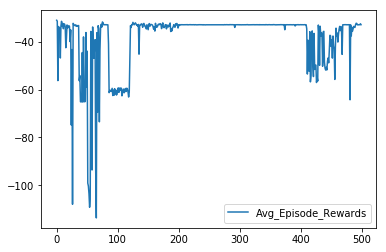

In [69]:
## TODO: Plot the rewards.
plt.plot(range(len(avg_episode_rewards)), avg_episode_rewards, label='Avg_Episode_Rewards')
plt.legend()
_ = plt.ylim()

**ATTEMPT 2**

In [72]:
import sys
import pandas as pd
from agents.agent import DDPG
from task import Task

num_episodes = 1000
init_pose = np.array([0., 0., 50., 0., 0., 0.])
init_vel = np.array([0., 0., 0.])
init_angle_velocities = np.array([0., 0., 0.])
target_pose = np.array([0., 0., 0., 0., 0., 0.])
target_vel = np.array([0., 0., 0.])
task = Task(init_pose=init_pose, init_vel=init_vel, init_angle_velocities=init_angle_velocities, target_pose=target_pose, target_vel=target_vel)
agent = DDPG(task)
avg_episode_rewards = []
file_output = 'data2.txt'

'''
Leave things the same as before, just record simulation and action history for plotting
'''
labels = ['time', 'x', 'y', 'z', 'phi', 'theta', 'psi', 'x_velocity',
          'y_velocity', 'z_velocity', 'phi_velocity', 'theta_velocity',
          'psi_velocity', 'rotor_speed1', 'rotor_speed2', 'rotor_speed3', 'rotor_speed4']
results = {x : [] for x in labels}

'''
USED THIS REWARD FUNCTION in task.py:
reward = -.3*(abs(self.sim.pose[:3] - self.target_pose[:3])).sum() - .3*(abs(self.sim.v[:3] - self.target_vel)).sum()/( 1.*(abs(self.sim.pose[:3] - self.target_pose[:3])).sum() ) #velocity only counts when close to ground
'''

for i_episode in range(1, num_episodes+1):
    print("")
    print("i_episode: " + str(i_episode))
    print("")
    print("")
    state = agent.reset_episode() # start a new episode
    time = 0
    total_episode_reward = 0
    count = 0
    
    with open(file_output, 'w') as csvfile:
        writer = csv.writer(csvfile)
        writer.writerow(labels)
    
        while True:
            print("")
            print("time: " + str(time))
            print("sim time: " + str(task.sim.time))
        
            action = agent.act(state) 
            next_state, reward, done = task.step(action)
            print("reward: " + str(reward))
        
            if i_episode == num_episodes: #only write last episode with trained model
                to_write = [task.sim.time] + list(task.sim.pose) + list(task.sim.v) + list(task.sim.angular_v) + list(rotor_speeds)
                for ii in range(len(labels)):
                    results[labels[ii]].append(to_write[ii])
                writer.writerow(to_write)
         
            total_episode_reward += reward
            count += 1
        
            agent.step(action, reward, next_state, done)
            state = next_state
            if done:
                break
            time += 1
    
    avg_episode_rewards.append(total_episode_reward/count)
    print("avg_episode_reward: " + str(total_episode_reward/count))
    sys.stdout.flush()

    
 
    


i_episode: 1



time: 0
sim time: 0.0
reward: -44.9988375278

time: 1
sim time: 0.06
reward: -44.9726435011

time: 2
sim time: 0.12000000000000001
reward: -44.9149215676

time: 3
sim time: 0.18
reward: -44.8255067816

time: 4
sim time: 0.23999999999999996
reward: -44.7041528071

time: 5
sim time: 0.3
reward: -44.5505205677

time: 6
sim time: 0.36000000000000004
reward: -44.364193374

time: 7
sim time: 0.4200000000000001
reward: -44.1446896657

time: 8
sim time: 0.48000000000000015
reward: -43.8914826535

time: 9
sim time: 0.5400000000000001
reward: -43.604024746

time: 10
sim time: 0.6000000000000002
reward: -43.2817774213

time: 11
sim time: 0.6600000000000003
reward: -42.9242429332

time: 12
sim time: 0.7200000000000003
reward: -42.5310064841

time: 13
sim time: 0.7800000000000004
reward: -42.101776307

time: 14
sim time: 0.8400000000000004
reward: -41.6364246361

time: 15
sim time: 0.9000000000000005
reward: -41.1350136567

time: 16
sim time: 0.9600000000000005
reward: -40.59780329


time: 38
sim time: 2.2800000000000016
reward: -20.7571112015

time: 39
sim time: 2.3400000000000016
reward: -20.058673909

time: 40
sim time: 2.4000000000000017
reward: -19.0723159545

time: 41
sim time: 2.4600000000000017
reward: -18.0779899986

time: 42
sim time: 2.520000000000002
reward: -17.1430906992

time: 43
sim time: 2.580000000000002
reward: -16.0702519254

time: 44
sim time: 2.640000000000002
reward: -14.7062428098

time: 45
sim time: 2.700000000000002
reward: -13.4890381051

time: 46
sim time: 2.760000000000002
reward: -12.8324190756
avg_episode_reward: -32.1731958265

i_episode: 4



time: 0
sim time: 0.0
reward: -45.0226633365

time: 1
sim time: 0.06
reward: -45.0754997011

time: 2
sim time: 0.12000000000000001
reward: -45.093741854

time: 3
sim time: 0.18
reward: -45.0832793262

time: 4
sim time: 0.23999999999999996
reward: -45.068321747

time: 5
sim time: 0.3
reward: -44.956745435

time: 6
sim time: 0.36000000000000004
reward: -44.7839003676

time: 7
sim time: 0.4200000


time: 82
sim time: 4.919999999999983
reward: -100.864411054

time: 83
sim time: 4.979999999999982
reward: -100.400712517
avg_episode_reward: -82.7432550422

i_episode: 6



time: 0
sim time: 0.0
reward: -45.0510582394

time: 1
sim time: 0.06
reward: -45.1906438713

time: 2
sim time: 0.12000000000000001
reward: -45.3040231187

time: 3
sim time: 0.18
reward: -45.4619337631

time: 4
sim time: 0.23999999999999996
reward: -45.6673807248

time: 5
sim time: 0.3
reward: -45.9182653524

time: 6
sim time: 0.36000000000000004
reward: -46.155798098

time: 7
sim time: 0.4200000000000001
reward: -46.3058316406

time: 8
sim time: 0.48000000000000015
reward: -46.4236335611

time: 9
sim time: 0.5400000000000001
reward: -46.5609139807

time: 10
sim time: 0.6000000000000002
reward: -46.6588060779

time: 11
sim time: 0.6600000000000003
reward: -46.676267024

time: 12
sim time: 0.7200000000000003
reward: -46.6849926602

time: 13
sim time: 0.7800000000000004
reward: -46.7053204439

time: 14
sim time: 0.840


time: 77
sim time: 4.6199999999999894
reward: -44.0760137824

time: 78
sim time: 4.679999999999988
reward: -42.2788556949

time: 79
sim time: 4.739999999999987
reward: -40.591730215

time: 80
sim time: 4.799999999999986
reward: -40.6072047386

time: 81
sim time: 4.859999999999984
reward: -41.011201814

time: 82
sim time: 4.919999999999983
reward: -41.3741444761

time: 83
sim time: 4.979999999999982
reward: -41.6329029612
avg_episode_reward: -51.9360583555

i_episode: 8



time: 0
sim time: 0.0
reward: -45.0511215195

time: 1
sim time: 0.06
reward: -45.1915374852

time: 2
sim time: 0.12000000000000001
reward: -45.306538143

time: 3
sim time: 0.18
reward: -45.4655485986

time: 4
sim time: 0.23999999999999996
reward: -45.6702285703

time: 5
sim time: 0.3
reward: -45.9163877523

time: 6
sim time: 0.36000000000000004
reward: -46.149675566

time: 7
sim time: 0.4200000000000001
reward: -46.2979688985

time: 8
sim time: 0.48000000000000015
reward: -46.4126740831

time: 9
sim time: 0.540000000

sim time: 0.36000000000000004
reward: -46.1474691037

time: 7
sim time: 0.4200000000000001
reward: -46.296244374

time: 8
sim time: 0.48000000000000015
reward: -46.4126340047

time: 9
sim time: 0.5400000000000001
reward: -46.54670003

time: 10
sim time: 0.6000000000000002
reward: -46.64336215

time: 11
sim time: 0.6600000000000003
reward: -46.6645932111

time: 12
sim time: 0.7200000000000003
reward: -46.6799176974

time: 13
sim time: 0.7800000000000004
reward: -46.7065508209

time: 14
sim time: 0.8400000000000004
reward: -46.6702551477

time: 15
sim time: 0.9000000000000005
reward: -46.5801225046

time: 16
sim time: 0.9600000000000005
reward: -46.509714853

time: 17
sim time: 1.0200000000000005
reward: -46.4275141633

time: 18
sim time: 1.0800000000000005
reward: -46.272454905

time: 19
sim time: 1.1400000000000006
reward: -46.0993718963

time: 20
sim time: 1.2000000000000006
reward: -45.9533977979

time: 21
sim time: 1.2600000000000007
reward: -45.7677181447

time: 22
sim time: 1.3200


time: 15
sim time: 0.9000000000000005
reward: -46.5630829346

time: 16
sim time: 0.9600000000000005
reward: -46.4801056671

time: 17
sim time: 1.0200000000000005
reward: -46.3808540254

time: 18
sim time: 1.0800000000000005
reward: -46.2032450523

time: 19
sim time: 1.1400000000000006
reward: -46.0011687539

time: 20
sim time: 1.2000000000000006
reward: -45.8184863311

time: 21
sim time: 1.2600000000000007
reward: -45.5865730544

time: 22
sim time: 1.3200000000000007
reward: -45.2852946525

time: 23
sim time: 1.3800000000000008
reward: -44.9904128592

time: 24
sim time: 1.4400000000000008
reward: -44.6965584434

time: 25
sim time: 1.5000000000000009
reward: -44.3308767723

time: 26
sim time: 1.560000000000001
reward: -43.9253666179

time: 27
sim time: 1.620000000000001
reward: -43.5419782144

time: 28
sim time: 1.680000000000001
reward: -43.1283601599

time: 29
sim time: 1.740000000000001
reward: -42.6423929012

time: 30
sim time: 1.8000000000000012
reward: -42.1533319451

time: 31
si


time: 29
sim time: 1.740000000000001
reward: -42.5316861911

time: 30
sim time: 1.8000000000000012
reward: -41.9812765959

time: 31
sim time: 1.8600000000000012
reward: -41.436345665

time: 32
sim time: 1.9200000000000013
reward: -40.821963963

time: 33
sim time: 1.9800000000000013
reward: -40.1476533165

time: 34
sim time: 2.0400000000000014
reward: -39.4831857728

time: 35
sim time: 2.1000000000000014
reward: -38.7946550125

time: 36
sim time: 2.1600000000000015
reward: -38.0233559655

time: 37
sim time: 2.2200000000000015
reward: -37.225680909

time: 38
sim time: 2.2800000000000016
reward: -36.4359479593

time: 39
sim time: 2.3400000000000016
reward: -35.5873799399

time: 40
sim time: 2.4000000000000017
reward: -34.6680752183

time: 41
sim time: 2.4600000000000017
reward: -33.7516018529

time: 42
sim time: 2.520000000000002
reward: -32.8201476431

time: 43
sim time: 2.580000000000002
reward: -31.8083298903

time: 44
sim time: 2.640000000000002
reward: -30.7604208957

time: 45
sim t


time: 45
sim time: 2.700000000000002
reward: -48.4564866291

time: 46
sim time: 2.760000000000002
reward: -48.7869378247

time: 47
sim time: 2.820000000000002
reward: -49.1523295694

time: 48
sim time: 2.880000000000002
reward: -49.4827324168

time: 49
sim time: 2.940000000000002
reward: -49.7979255097

time: 50
sim time: 3.000000000000002
reward: -50.166652422

time: 51
sim time: 3.0600000000000023
reward: -50.5425450555

time: 52
sim time: 3.1200000000000023
reward: -50.877126504

time: 53
sim time: 3.1800000000000024
reward: -51.2262657426

time: 54
sim time: 3.2400000000000024
reward: -51.6246911113

time: 55
sim time: 3.3000000000000025
reward: -52.0038721696

time: 56
sim time: 3.3600000000000025
reward: -52.3513888541

time: 57
sim time: 3.4200000000000026
reward: -52.7398058152

time: 58
sim time: 3.4800000000000026
reward: -53.1565332812

time: 59
sim time: 3.5400000000000027
reward: -53.5375020419

time: 60
sim time: 3.6000000000000028
reward: -53.9098804838

time: 61
sim ti


time: 47
sim time: 2.820000000000002
reward: -27.9831904507

time: 48
sim time: 2.880000000000002
reward: -26.5283963991

time: 49
sim time: 2.940000000000002
reward: -25.0167975262

time: 50
sim time: 3.000000000000002
reward: -23.394514405

time: 51
sim time: 3.0600000000000023
reward: -21.7478298916

time: 52
sim time: 3.1200000000000023
reward: -20.1518867811

time: 53
sim time: 3.1800000000000024
reward: -18.5297618349

time: 54
sim time: 3.2400000000000024
reward: -16.8417056871

time: 55
sim time: 3.3000000000000025
reward: -15.2715325642

time: 56
sim time: 3.3600000000000025
reward: -14.23826395
avg_episode_reward: -39.0268944593

i_episode: 19



time: 0
sim time: 0.0
reward: -45.0511484039

time: 1
sim time: 0.06
reward: -45.1923123995

time: 2
sim time: 0.12000000000000001
reward: -45.3089205139

time: 3
sim time: 0.18
reward: -45.4654546147

time: 4
sim time: 0.23999999999999996
reward: -45.6598382388

time: 5
sim time: 0.3
reward: -45.8886170988

time: 6
sim time: 0.3600


time: 13
sim time: 0.7800000000000004
reward: -45.7339264162

time: 14
sim time: 0.8400000000000004
reward: -45.402879338

time: 15
sim time: 0.9000000000000005
reward: -45.0583781984

time: 16
sim time: 0.9600000000000005
reward: -44.6672271627

time: 17
sim time: 1.0200000000000005
reward: -44.144848048

time: 18
sim time: 1.0800000000000005
reward: -43.4876936999

time: 19
sim time: 1.1400000000000006
reward: -43.028494945

time: 20
sim time: 1.2000000000000006
reward: -42.7726761307

time: 21
sim time: 1.2600000000000007
reward: -42.554174934

time: 22
sim time: 1.3200000000000007
reward: -42.2215383649

time: 23
sim time: 1.3800000000000008
reward: -41.8341556201

time: 24
sim time: 1.4400000000000008
reward: -41.4231079663

time: 25
sim time: 1.5000000000000009
reward: -41.0214037473

time: 26
sim time: 1.560000000000001
reward: -40.6367156146

time: 27
sim time: 1.620000000000001
reward: -40.2909795324

time: 28
sim time: 1.680000000000001
reward: -39.8196588133

time: 29
sim t


time: 32
sim time: 1.9200000000000013
reward: -38.5414424726

time: 33
sim time: 1.9800000000000013
reward: -38.1406840493

time: 34
sim time: 2.0400000000000014
reward: -37.7869613966

time: 35
sim time: 2.1000000000000014
reward: -37.4424641618

time: 36
sim time: 2.1600000000000015
reward: -37.0206787998

time: 37
sim time: 2.2200000000000015
reward: -36.5893858825

time: 38
sim time: 2.2800000000000016
reward: -36.2089268539

time: 39
sim time: 2.3400000000000016
reward: -35.804381639

time: 40
sim time: 2.4000000000000017
reward: -35.3228318799

time: 41
sim time: 2.4600000000000017
reward: -34.8755698784

time: 42
sim time: 2.520000000000002
reward: -34.4576619765

time: 43
sim time: 2.580000000000002
reward: -33.9871348202

time: 44
sim time: 2.640000000000002
reward: -33.4672830365

time: 45
sim time: 2.700000000000002
reward: -33.0053407446

time: 46
sim time: 2.760000000000002
reward: -32.5468609056

time: 47
sim time: 2.820000000000002
reward: -32.0092749579

time: 48
sim t

reward: -38.8555846979

time: 63
sim time: 3.780000000000003
reward: -39.1598210539

time: 64
sim time: 3.840000000000003
reward: -39.4231735007

time: 65
sim time: 3.900000000000003
reward: -39.7238928464

time: 66
sim time: 3.960000000000003
reward: -40.0881098032

time: 67
sim time: 4.020000000000002
reward: -40.4292231845

time: 68
sim time: 4.080000000000001
reward: -40.7500282211

time: 69
sim time: 4.14
reward: -41.1305544065

time: 70
sim time: 4.199999999999998
reward: -41.5478468117

time: 71
sim time: 4.259999999999997
reward: -41.9214330132

time: 72
sim time: 4.319999999999996
reward: -42.3072270321

time: 73
sim time: 4.379999999999995
reward: -42.7594375999

time: 74
sim time: 4.439999999999993
reward: -43.2098228341

time: 75
sim time: 4.499999999999992
reward: -43.6204737512

time: 76
sim time: 4.559999999999991
reward: -44.0745193072

time: 77
sim time: 4.6199999999999894
reward: -44.5800836376

time: 78
sim time: 4.679999999999988
reward: -45.0534271227

time: 79
sim


time: 29
sim time: 1.740000000000001
reward: -53.0008897795

time: 30
sim time: 1.8000000000000012
reward: -53.4142357652

time: 31
sim time: 1.8600000000000012
reward: -53.8432659454

time: 32
sim time: 1.9200000000000013
reward: -54.2076321696

time: 33
sim time: 1.9800000000000013
reward: -54.6124342867

time: 34
sim time: 2.0400000000000014
reward: -55.0609552471

time: 35
sim time: 2.1000000000000014
reward: -55.4942197523

time: 36
sim time: 2.1600000000000015
reward: -55.8821286276

time: 37
sim time: 2.2200000000000015
reward: -56.3313692818

time: 38
sim time: 2.2800000000000016
reward: -56.8101582007

time: 39
sim time: 2.3400000000000016
reward: -57.2379478144

time: 40
sim time: 2.4000000000000017
reward: -57.6690945824

time: 41
sim time: 2.4600000000000017
reward: -58.1551944958

time: 42
sim time: 2.520000000000002
reward: -58.6507595067

time: 43
sim time: 2.580000000000002
reward: -59.0830200444

time: 44
sim time: 2.640000000000002
reward: -59.5616691895

time: 45
si


time: 80
sim time: 4.799999999999986
reward: -89.1791327652

time: 81
sim time: 4.859999999999984
reward: -90.0629725596

time: 82
sim time: 4.919999999999983
reward: -90.9599726685

time: 83
sim time: 4.979999999999982
reward: -91.7958844066
avg_episode_reward: -63.5029625073

i_episode: 29



time: 0
sim time: 0.0
reward: -45.0339227134

time: 1
sim time: 0.06
reward: -45.1326234989

time: 2
sim time: 0.12000000000000001
reward: -45.2140684821

time: 3
sim time: 0.18
reward: -45.3422933474

time: 4
sim time: 0.23999999999999996
reward: -45.5041748771

time: 5
sim time: 0.3
reward: -45.7159030652

time: 6
sim time: 0.36000000000000004
reward: -45.8965832804

time: 7
sim time: 0.4200000000000001
reward: -46.0653094187

time: 8
sim time: 0.48000000000000015
reward: -46.3020447161

time: 9
sim time: 0.5400000000000001
reward: -46.560381765

time: 10
sim time: 0.6000000000000002
reward: -46.7588787565

time: 11
sim time: 0.6600000000000003
reward: -46.9748870915

time: 12
sim time: 0.720


time: 46
sim time: 2.760000000000002
reward: -63.1976630185

time: 47
sim time: 2.820000000000002
reward: -63.7556099713

time: 48
sim time: 2.880000000000002
reward: -64.3733372076

time: 49
sim time: 2.940000000000002
reward: -65.0201994103

time: 50
sim time: 3.000000000000002
reward: -65.6129673759

time: 51
sim time: 3.0600000000000023
reward: -66.2170353937

time: 52
sim time: 3.1200000000000023
reward: -66.8741093616

time: 53
sim time: 3.1800000000000024
reward: -67.5367131602

time: 54
sim time: 3.2400000000000024
reward: -68.1399691732

time: 55
sim time: 3.3000000000000025
reward: -68.7916354437

time: 56
sim time: 3.3600000000000025
reward: -69.4831248653

time: 57
sim time: 3.4200000000000026
reward: -70.1440947858

time: 58
sim time: 3.4800000000000026
reward: -70.7779940426

time: 59
sim time: 3.5400000000000027
reward: -71.469769009

time: 60
sim time: 3.6000000000000028
reward: -72.1852648251

time: 61
sim time: 3.660000000000003
reward: -72.8416687247

time: 62
sim t


time: 13
sim time: 0.7800000000000004
reward: -47.915683259

time: 14
sim time: 0.8400000000000004
reward: -48.1777532489

time: 15
sim time: 0.9000000000000005
reward: -48.4989698124

time: 16
sim time: 0.9600000000000005
reward: -48.8595404965

time: 17
sim time: 1.0200000000000005
reward: -49.1889778358

time: 18
sim time: 1.0800000000000005
reward: -49.495981652

time: 19
sim time: 1.1400000000000006
reward: -49.8672785428

time: 20
sim time: 1.2000000000000006
reward: -50.2633200638

time: 21
sim time: 1.2600000000000007
reward: -50.5982002643

time: 22
sim time: 1.3200000000000007
reward: -50.9636767132

time: 23
sim time: 1.3800000000000008
reward: -51.3796280704

time: 24
sim time: 1.4400000000000008
reward: -51.7937640716

time: 25
sim time: 1.5000000000000009
reward: -52.1536742833

time: 26
sim time: 1.560000000000001
reward: -52.5747731934

time: 27
sim time: 1.620000000000001
reward: -53.0324436878

time: 28
sim time: 1.680000000000001
reward: -53.4505284048

time: 29
sim


time: 63
sim time: 3.780000000000003
reward: -71.2338626407

time: 64
sim time: 3.840000000000003
reward: -71.8856977345

time: 65
sim time: 3.900000000000003
reward: -72.5023208036

time: 66
sim time: 3.960000000000003
reward: -73.1589309573

time: 67
sim time: 4.020000000000002
reward: -73.8622843901

time: 68
sim time: 4.080000000000001
reward: -74.5057534002

time: 69
sim time: 4.14
reward: -75.1499910493

time: 70
sim time: 4.199999999999998
reward: -75.8461058187

time: 71
sim time: 4.259999999999997
reward: -76.5519140146

time: 72
sim time: 4.319999999999996
reward: -77.1994027524

time: 73
sim time: 4.379999999999995
reward: -77.8735058094

time: 74
sim time: 4.439999999999993
reward: -78.6033430311

time: 75
sim time: 4.499999999999992
reward: -79.2957463787

time: 76
sim time: 4.559999999999991
reward: -79.9604316549

time: 77
sim time: 4.6199999999999894
reward: -80.667436338

time: 78
sim time: 4.679999999999988
reward: -81.4125897985

time: 79
sim time: 4.739999999999987


time: 30
sim time: 1.8000000000000012
reward: -53.5924894286

time: 31
sim time: 1.8600000000000012
reward: -54.03234724

time: 32
sim time: 1.9200000000000013
reward: -54.4078361068

time: 33
sim time: 1.9800000000000013
reward: -54.8241287715

time: 34
sim time: 2.0400000000000014
reward: -55.2844185898

time: 35
sim time: 2.1000000000000014
reward: -55.729326391

time: 36
sim time: 2.1600000000000015
reward: -56.1295510336

time: 37
sim time: 2.2200000000000015
reward: -56.591164938

time: 38
sim time: 2.2800000000000016
reward: -57.0821749005

time: 39
sim time: 2.3400000000000016
reward: -57.5216103131

time: 40
sim time: 2.4000000000000017
reward: -57.9653702207

time: 41
sim time: 2.4600000000000017
reward: -58.4635825543

time: 42
sim time: 2.520000000000002
reward: -58.9703133426

time: 43
sim time: 2.580000000000002
reward: -59.4137856913

time: 44
sim time: 2.640000000000002
reward: -59.9041104493

time: 45
sim time: 2.700000000000002
reward: -60.4341227424

time: 46
sim ti


time: 81
sim time: 4.859999999999984
reward: -84.8911870075

time: 82
sim time: 4.919999999999983
reward: -85.6467703971

time: 83
sim time: 4.979999999999982
reward: -86.3393860538
avg_episode_reward: -61.7451436029

i_episode: 37



time: 0
sim time: 0.0
reward: -45.0338677202

time: 1
sim time: 0.06
reward: -45.1315098576

time: 2
sim time: 0.12000000000000001
reward: -45.2089494671

time: 3
sim time: 0.18
reward: -45.3342666794

time: 4
sim time: 0.23999999999999996
reward: -45.4883314657

time: 5
sim time: 0.3
reward: -45.7054120535

time: 6
sim time: 0.36000000000000004
reward: -45.9148540051

time: 7
sim time: 0.4200000000000001
reward: -46.0947561034

time: 8
sim time: 0.48000000000000015
reward: -46.3409555882

time: 9
sim time: 0.5400000000000001
reward: -46.6118339593

time: 10
sim time: 0.6000000000000002
reward: -46.8214515937

time: 11
sim time: 0.6600000000000003
reward: -47.0560781976

time: 12
sim time: 0.7200000000000003
reward: -47.3422305648

time: 13
sim time: 0.7


time: 47
sim time: 2.820000000000002
reward: -60.5285487209

time: 48
sim time: 2.880000000000002
reward: -61.0765832293

time: 49
sim time: 2.940000000000002
reward: -61.6581787762

time: 50
sim time: 3.000000000000002
reward: -62.1768230039

time: 51
sim time: 3.0600000000000023
reward: -62.7168529244

time: 52
sim time: 3.1200000000000023
reward: -63.3149403423

time: 53
sim time: 3.1800000000000024
reward: -63.8988580684

time: 54
sim time: 3.2400000000000024
reward: -64.4421092679

time: 55
sim time: 3.3000000000000025
reward: -65.024201098

time: 56
sim time: 3.3600000000000025
reward: -65.6593752203

time: 57
sim time: 3.4200000000000026
reward: -66.2397039769

time: 58
sim time: 3.4800000000000026
reward: -66.8165086339

time: 59
sim time: 3.5400000000000027
reward: -67.444020111

time: 60
sim time: 3.6000000000000028
reward: -68.0928316996

time: 61
sim time: 3.660000000000003
reward: -68.6807363669

time: 62
sim time: 3.720000000000003
reward: -69.2934286411

time: 63
sim ti


time: 14
sim time: 0.8400000000000004
reward: -47.9443128818

time: 15
sim time: 0.9000000000000005
reward: -48.243250707

time: 16
sim time: 0.9600000000000005
reward: -48.5795991612

time: 17
sim time: 1.0200000000000005
reward: -48.8809332484

time: 18
sim time: 1.0800000000000005
reward: -49.1637578749

time: 19
sim time: 1.1400000000000006
reward: -49.5099739841

time: 20
sim time: 1.2000000000000006
reward: -49.8782943848

time: 21
sim time: 1.2600000000000007
reward: -50.1836018596

time: 22
sim time: 1.3200000000000007
reward: -50.5232298742

time: 23
sim time: 1.3800000000000008
reward: -50.9111376841

time: 24
sim time: 1.4400000000000008
reward: -51.2930143368

time: 25
sim time: 1.5000000000000009
reward: -51.6224763348

time: 26
sim time: 1.560000000000001
reward: -52.0141320212

time: 27
sim time: 1.620000000000001
reward: -52.439557446

time: 28
sim time: 1.680000000000001
reward: -52.8209976995

time: 29
sim time: 1.740000000000001
reward: -53.1965155434

time: 30
sim 


time: 65
sim time: 3.900000000000003
reward: -70.8633943544

time: 66
sim time: 3.960000000000003
reward: -71.4783641369

time: 67
sim time: 4.020000000000002
reward: -72.127623296

time: 68
sim time: 4.080000000000001
reward: -72.734002478

time: 69
sim time: 4.14
reward: -73.3288223495

time: 70
sim time: 4.199999999999998
reward: -73.980232955

time: 71
sim time: 4.259999999999997
reward: -74.6471255847

time: 72
sim time: 4.319999999999996
reward: -75.2516831971

time: 73
sim time: 4.379999999999995
reward: -75.8897158301

time: 74
sim time: 4.439999999999993
reward: -76.5729249721

time: 75
sim time: 4.499999999999992
reward: -77.239962452

time: 76
sim time: 4.559999999999991
reward: -77.8617246704

time: 77
sim time: 4.6199999999999894
reward: -78.5392811624

time: 78
sim time: 4.679999999999988
reward: -79.2472070507

time: 79
sim time: 4.739999999999987
reward: -79.9046846965

time: 80
sim time: 4.799999999999986
reward: -80.5610353577

time: 81
sim time: 4.859999999999984
re


time: 32
sim time: 1.9200000000000013
reward: -54.8390547471

time: 33
sim time: 1.9800000000000013
reward: -55.2854270158

time: 34
sim time: 2.0400000000000014
reward: -55.776506041

time: 35
sim time: 2.1000000000000014
reward: -56.2527197061

time: 36
sim time: 2.1600000000000015
reward: -56.6857967316

time: 37
sim time: 2.2200000000000015
reward: -57.1806264729

time: 38
sim time: 2.2800000000000016
reward: -57.7067155035

time: 39
sim time: 2.3400000000000016
reward: -58.1823389242

time: 40
sim time: 2.4000000000000017
reward: -58.6633233391

time: 41
sim time: 2.4600000000000017
reward: -59.1998420022

time: 42
sim time: 2.520000000000002
reward: -59.7470748391

time: 43
sim time: 2.580000000000002
reward: -60.2324603293

time: 44
sim time: 2.640000000000002
reward: -60.7650698924

time: 45
sim time: 2.700000000000002
reward: -61.3395157231

time: 46
sim time: 2.760000000000002
reward: -61.8901186308

time: 47
sim time: 2.820000000000002
reward: -62.4071678019

time: 48
sim t


time: 83
sim time: 4.979999999999982
reward: -80.0633829821
avg_episode_reward: -59.4573576851

i_episode: 45



time: 0
sim time: 0.0
reward: -45.0339277184

time: 1
sim time: 0.06
reward: -45.1324621651

time: 2
sim time: 0.12000000000000001
reward: -45.2120706977

time: 3
sim time: 0.18
reward: -45.3383745423

time: 4
sim time: 0.23999999999999996
reward: -45.4932741303

time: 5
sim time: 0.3
reward: -45.7092558855

time: 6
sim time: 0.36000000000000004
reward: -45.9263453147

time: 7
sim time: 0.4200000000000001
reward: -46.1112663504

time: 8
sim time: 0.48000000000000015
reward: -46.3631223373

time: 9
sim time: 0.5400000000000001
reward: -46.6413869974

time: 10
sim time: 0.6000000000000002
reward: -46.8600267579

time: 11
sim time: 0.6600000000000003
reward: -47.1011758314

time: 12
sim time: 0.7200000000000003
reward: -47.3952906197

time: 13
sim time: 0.7800000000000004
reward: -47.6922167155

time: 14
sim time: 0.8400000000000004
reward: -47.9284618315

time: 15
sim time: 0


time: 50
sim time: 3.000000000000002
reward: -64.9656552018

time: 51
sim time: 3.0600000000000023
reward: -65.5543922847

time: 52
sim time: 3.1200000000000023
reward: -66.1947672319

time: 53
sim time: 3.1800000000000024
reward: -66.8377664165

time: 54
sim time: 3.2400000000000024
reward: -67.4220352122

time: 55
sim time: 3.3000000000000025
reward: -68.0563589511

time: 56
sim time: 3.3600000000000025
reward: -68.7289968331

time: 57
sim time: 3.4200000000000026
reward: -69.3682770698

time: 58
sim time: 3.4800000000000026
reward: -69.9834418285

time: 59
sim time: 3.5400000000000027
reward: -70.6562854316

time: 60
sim time: 3.6000000000000028
reward: -71.3508795754

time: 61
sim time: 3.660000000000003
reward: -71.985072897

time: 62
sim time: 3.720000000000003
reward: -72.6422864774

time: 63
sim time: 3.780000000000003
reward: -73.3475048492

time: 64
sim time: 3.840000000000003
reward: -74.0461450827

time: 65
sim time: 3.900000000000003
reward: -74.6910914282

time: 66
sim t


time: 17
sim time: 1.0200000000000005
reward: -48.5938831491

time: 18
sim time: 1.0800000000000005
reward: -48.8349355601

time: 19
sim time: 1.1400000000000006
reward: -49.1384941641

time: 20
sim time: 1.2000000000000006
reward: -49.4545506061

time: 21
sim time: 1.2600000000000007
reward: -49.737046253

time: 22
sim time: 1.3200000000000007
reward: -50.0537252941

time: 23
sim time: 1.3800000000000008
reward: -50.4318651897

time: 24
sim time: 1.4400000000000008
reward: -50.7869543349

time: 25
sim time: 1.5000000000000009
reward: -51.1114043224

time: 26
sim time: 1.560000000000001
reward: -51.4798195361

time: 27
sim time: 1.620000000000001
reward: -51.9020741863

time: 28
sim time: 1.680000000000001
reward: -52.2638516001

time: 29
sim time: 1.740000000000001
reward: -52.634917886

time: 30
sim time: 1.8000000000000012
reward: -53.0605497563

time: 31
sim time: 1.8600000000000012
reward: -53.5021669259

time: 32
sim time: 1.9200000000000013
reward: -53.8872406747

time: 33
sim 


time: 68
sim time: 4.080000000000001
reward: -74.7065898884

time: 69
sim time: 4.14
reward: -75.3647015929

time: 70
sim time: 4.199999999999998
reward: -76.0792333468

time: 71
sim time: 4.259999999999997
reward: -76.8099629438

time: 72
sim time: 4.319999999999996
reward: -77.478538782

time: 73
sim time: 4.379999999999995
reward: -78.1793640886

time: 74
sim time: 4.439999999999993
reward: -78.9257021145

time: 75
sim time: 4.499999999999992
reward: -79.6562187038

time: 76
sim time: 4.559999999999991
reward: -80.3410594299

time: 77
sim time: 4.6199999999999894
reward: -81.0808262902

time: 78
sim time: 4.679999999999988
reward: -81.8515884639

time: 79
sim time: 4.739999999999987
reward: -82.5722246835

time: 80
sim time: 4.799999999999986
reward: -83.2906895499

time: 81
sim time: 4.859999999999984
reward: -84.0630095843

time: 82
sim time: 4.919999999999983
reward: -84.8440855363

time: 83
sim time: 4.979999999999982
reward: -85.5632136083
avg_episode_reward: -61.0149053387

i


time: 34
sim time: 2.0400000000000014
reward: -54.6997818882

time: 35
sim time: 2.1000000000000014
reward: -55.1061676037

time: 36
sim time: 2.1600000000000015
reward: -55.4724947829

time: 37
sim time: 2.2200000000000015
reward: -55.8971465163

time: 38
sim time: 2.2800000000000016
reward: -56.3492203425

time: 39
sim time: 2.3400000000000016
reward: -56.7490271849

time: 40
sim time: 2.4000000000000017
reward: -57.1502479307

time: 41
sim time: 2.4600000000000017
reward: -57.6110444098

time: 42
sim time: 2.520000000000002
reward: -58.0677019571

time: 43
sim time: 2.580000000000002
reward: -58.4720306669

time: 44
sim time: 2.640000000000002
reward: -58.9124388019

time: 45
sim time: 2.700000000000002
reward: -59.4000746859

time: 46
sim time: 2.760000000000002
reward: -59.8504635525

time: 47
sim time: 2.820000000000002
reward: -60.2724992577

time: 48
sim time: 2.880000000000002
reward: -60.7524633107

time: 49
sim time: 2.940000000000002
reward: -61.2499720872

time: 50
sim ti


i_episode: 53



time: 0
sim time: 0.0
reward: -45.0338959018

time: 1
sim time: 0.06
reward: -45.1323213886

time: 2
sim time: 0.12000000000000001
reward: -45.2128135174

time: 3
sim time: 0.18
reward: -45.3415927678

time: 4
sim time: 0.23999999999999996
reward: -45.5005049425

time: 5
sim time: 0.3
reward: -45.7213062881

time: 6
sim time: 0.36000000000000004
reward: -45.9399257129

time: 7
sim time: 0.4200000000000001
reward: -46.1239287988

time: 8
sim time: 0.48000000000000015
reward: -46.3743117972

time: 9
sim time: 0.5400000000000001
reward: -46.6497323567

time: 10
sim time: 0.6000000000000002
reward: -46.8652196146

time: 11
sim time: 0.6600000000000003
reward: -47.1011306899

time: 12
sim time: 0.7200000000000003
reward: -47.3896598112

time: 13
sim time: 0.7800000000000004
reward: -47.6807274575

time: 14
sim time: 0.8400000000000004
reward: -47.9099101599

time: 15
sim time: 0.9000000000000005
reward: -48.1984360682

time: 16
sim time: 0.9600000000000005
reward: -48.5235


time: 51
sim time: 3.0600000000000023
reward: -63.727900148

time: 52
sim time: 3.1200000000000023
reward: -64.3094396258

time: 53
sim time: 3.1800000000000024
reward: -64.8933826811

time: 54
sim time: 3.2400000000000024
reward: -65.4183337968

time: 55
sim time: 3.3000000000000025
reward: -65.994295293

time: 56
sim time: 3.3600000000000025
reward: -66.6082921186

time: 57
sim time: 3.4200000000000026
reward: -67.1889088468

time: 58
sim time: 3.4800000000000026
reward: -67.745613539

time: 59
sim time: 3.5400000000000027
reward: -68.3608667201

time: 60
sim time: 3.6000000000000028
reward: -68.9979721156

time: 61
sim time: 3.660000000000003
reward: -69.574636924

time: 62
sim time: 3.720000000000003
reward: -70.1753366599

time: 63
sim time: 3.780000000000003
reward: -70.8245679318

time: 64
sim time: 3.840000000000003
reward: -71.4675689783

time: 65
sim time: 3.900000000000003
reward: -72.0572278002

time: 66
sim time: 3.960000000000003
reward: -72.7006130439

time: 67
sim time


time: 18
sim time: 1.0800000000000005
reward: -49.1498487728

time: 19
sim time: 1.1400000000000006
reward: -49.4890617433

time: 20
sim time: 1.2000000000000006
reward: -49.849608631

time: 21
sim time: 1.2600000000000007
reward: -50.1467806594

time: 22
sim time: 1.3200000000000007
reward: -50.4759493636

time: 23
sim time: 1.3800000000000008
reward: -50.8529056574

time: 24
sim time: 1.4400000000000008
reward: -51.2238947689

time: 25
sim time: 1.5000000000000009
reward: -51.5404567374

time: 26
sim time: 1.560000000000001
reward: -51.9182943241

time: 27
sim time: 1.620000000000001
reward: -52.3291180892

time: 28
sim time: 1.680000000000001
reward: -52.6965241651

time: 29
sim time: 1.740000000000001
reward: -53.0551680242

time: 30
sim time: 1.8000000000000012
reward: -53.4727432038

time: 31
sim time: 1.8600000000000012
reward: -53.9062888656

time: 32
sim time: 1.9200000000000013
reward: -54.2752849072

time: 33
sim time: 1.9800000000000013
reward: -54.6843010248

time: 34
sim


time: 68
sim time: 4.080000000000001
reward: -74.3240965827

time: 69
sim time: 4.14
reward: -74.9369363174

time: 70
sim time: 4.199999999999998
reward: -75.6052862887

time: 71
sim time: 4.259999999999997
reward: -76.2881702849

time: 72
sim time: 4.319999999999996
reward: -76.9078744112

time: 73
sim time: 4.379999999999995
reward: -77.5585807297

time: 74
sim time: 4.439999999999993
reward: -78.2534080887

time: 75
sim time: 4.499999999999992
reward: -78.9318411709

time: 76
sim time: 4.559999999999991
reward: -79.5629639094

time: 77
sim time: 4.6199999999999894
reward: -80.2485202656

time: 78
sim time: 4.679999999999988
reward: -80.9636007291

time: 79
sim time: 4.739999999999987
reward: -81.6283434716

time: 80
sim time: 4.799999999999986
reward: -82.2894569596

time: 81
sim time: 4.859999999999984
reward: -83.0038933553

time: 82
sim time: 4.919999999999983
reward: -83.7260980029

time: 83
sim time: 4.979999999999982
reward: -84.3854727013
avg_episode_reward: -60.9542142526




time: 38
sim time: 2.2800000000000016
reward: -26.7488993524

time: 39
sim time: 2.3400000000000016
reward: -25.6888601822

time: 40
sim time: 2.4000000000000017
reward: -24.5884191211

time: 41
sim time: 2.4600000000000017
reward: -23.5047717321

time: 42
sim time: 2.520000000000002
reward: -22.404957083

time: 43
sim time: 2.580000000000002
reward: -21.2391877331

time: 44
sim time: 2.640000000000002
reward: -20.0631662754

time: 45
sim time: 2.700000000000002
reward: -18.9225790858

time: 46
sim time: 2.760000000000002
reward: -17.75157896

time: 47
sim time: 2.820000000000002
reward: -16.518903612

time: 48
sim time: 2.880000000000002
reward: -15.3302140295

time: 49
sim time: 2.940000000000002
reward: -14.2216590236

time: 50
sim time: 3.000000000000002
reward: -13.0986930836

time: 51
sim time: 3.0600000000000023
reward: -11.9665641532

time: 52
sim time: 3.1200000000000023
reward: -11.0503467334

time: 53
sim time: 3.1800000000000024
reward: -10.4995612846

time: 54
sim time: 3


time: 5
sim time: 0.3
reward: -45.0037113197

time: 6
sim time: 0.36000000000000004
reward: -44.9578831891

time: 7
sim time: 0.4200000000000001
reward: -44.8649038342

time: 8
sim time: 0.48000000000000015
reward: -44.7385899184

time: 9
sim time: 0.5400000000000001
reward: -44.5963145224

time: 10
sim time: 0.6000000000000002
reward: -44.41867935

time: 11
sim time: 0.6600000000000003
reward: -44.195290167

time: 12
sim time: 0.7200000000000003
reward: -43.9493430909

time: 13
sim time: 0.7800000000000004
reward: -43.6828180487

time: 14
sim time: 0.8400000000000004
reward: -43.3717753005

time: 15
sim time: 0.9000000000000005
reward: -43.0236545335

time: 16
sim time: 0.9600000000000005
reward: -42.6596394247

time: 17
sim time: 1.0200000000000005
reward: -42.2639841363

time: 18
sim time: 1.0800000000000005
reward: -41.8216150103

time: 19
sim time: 1.1400000000000006
reward: -41.3549648725

time: 20
sim time: 1.2000000000000006
reward: -40.8704605739

time: 21
sim time: 1.2600000


time: 78
sim time: 4.679999999999988
reward: -115.836896878

time: 79
sim time: 4.739999999999987
reward: -117.27224826

time: 80
sim time: 4.799999999999986
reward: -118.717539395

time: 81
sim time: 4.859999999999984
reward: -120.171979455

time: 82
sim time: 4.919999999999983
reward: -121.634711637

time: 83
sim time: 4.979999999999982
reward: -123.104793955
avg_episode_reward: -75.8990894939

i_episode: 64



time: 0
sim time: 0.0
reward: -45.0226883616

time: 1
sim time: 0.06
reward: -45.093264787

time: 2
sim time: 0.12000000000000001
reward: -45.2104941533

time: 3
sim time: 0.18
reward: -45.3737840859

time: 4
sim time: 0.23999999999999996
reward: -45.5823476994

time: 5
sim time: 0.3
reward: -45.8352009208

time: 6
sim time: 0.36000000000000004
reward: -46.1312228471

time: 7
sim time: 0.4200000000000001
reward: -46.4691414354

time: 8
sim time: 0.48000000000000015
reward: -46.8475710979

time: 9
sim time: 0.5400000000000001
reward: -47.2650409332

time: 10
sim time: 0.600000


time: 44
sim time: 2.640000000000002
reward: -75.4059804955

time: 45
sim time: 2.700000000000002
reward: -76.3807096024

time: 46
sim time: 2.760000000000002
reward: -77.3579629768

time: 47
sim time: 2.820000000000002
reward: -78.3373571214

time: 48
sim time: 2.880000000000002
reward: -79.3185521118

time: 49
sim time: 2.940000000000002
reward: -80.3012125125

time: 50
sim time: 3.000000000000002
reward: -81.2850087943

time: 51
sim time: 3.0600000000000023
reward: -82.2696182844

time: 52
sim time: 3.1200000000000023
reward: -83.2547150348

time: 53
sim time: 3.1800000000000024
reward: -84.2399838202

time: 54
sim time: 3.2400000000000024
reward: -85.2251047128

time: 55
sim time: 3.3000000000000025
reward: -86.2097702718

time: 56
sim time: 3.3600000000000025
reward: -87.1936950026

time: 57
sim time: 3.4200000000000026
reward: -88.1766046113

time: 58
sim time: 3.4800000000000026
reward: -89.1581948298

time: 59
sim time: 3.5400000000000027
reward: -90.1381615719

time: 60
sim t


time: 12
sim time: 0.7200000000000003
reward: -48.7209319787

time: 13
sim time: 0.7800000000000004
reward: -49.2760328351

time: 14
sim time: 0.8400000000000004
reward: -49.8622263389

time: 15
sim time: 0.9000000000000005
reward: -50.4779575447

time: 16
sim time: 0.9600000000000005
reward: -51.1216514338

time: 17
sim time: 1.0200000000000005
reward: -51.7917491911

time: 18
sim time: 1.0800000000000005
reward: -52.4867526161

time: 19
sim time: 1.1400000000000006
reward: -53.2051977473

time: 20
sim time: 1.2000000000000006
reward: -53.9456273375

time: 21
sim time: 1.2600000000000007
reward: -54.7066398694

time: 22
sim time: 1.3200000000000007
reward: -55.4869028488

time: 23
sim time: 1.3800000000000008
reward: -56.2851461425

time: 24
sim time: 1.4400000000000008
reward: -57.1001710865

time: 25
sim time: 1.5000000000000009
reward: -57.9308476913

time: 26
sim time: 1.560000000000001
reward: -58.7760930988

time: 27
sim time: 1.620000000000001
reward: -59.6348882579

time: 28



time: 62
sim time: 3.720000000000003
reward: -94.0196395849

time: 63
sim time: 3.780000000000003
reward: -95.0728228806

time: 64
sim time: 3.840000000000003
reward: -96.1304590899

time: 65
sim time: 3.900000000000003
reward: -97.1926963073

time: 66
sim time: 3.960000000000003
reward: -98.2597040785

time: 67
sim time: 4.020000000000002
reward: -99.3316226027

time: 68
sim time: 4.080000000000001
reward: -100.408585373

time: 69
sim time: 4.14
reward: -101.490740328

time: 70
sim time: 4.199999999999998
reward: -102.578203748

time: 71
sim time: 4.259999999999997
reward: -103.671082575

time: 72
sim time: 4.319999999999996
reward: -104.769520722

time: 73
sim time: 4.379999999999995
reward: -105.873599438

time: 74
sim time: 4.439999999999993
reward: -106.983360308

time: 75
sim time: 4.499999999999992
reward: -108.098849518

time: 76
sim time: 4.559999999999991
reward: -109.220118502

time: 77
sim time: 4.6199999999999894
reward: -110.347226277

time: 78
sim time: 4.67999999999998


time: 29
sim time: 1.740000000000001
reward: -61.1196896144

time: 30
sim time: 1.8000000000000012
reward: -61.9791719581

time: 31
sim time: 1.8600000000000012
reward: -62.8471486773

time: 32
sim time: 1.9200000000000013
reward: -63.7230603145

time: 33
sim time: 1.9800000000000013
reward: -64.606372069

time: 34
sim time: 2.0400000000000014
reward: -65.4965745471

time: 35
sim time: 2.1000000000000014
reward: -66.3931687128

time: 36
sim time: 2.1600000000000015
reward: -67.2956726719

time: 37
sim time: 2.2200000000000015
reward: -68.2036219893

time: 38
sim time: 2.2800000000000016
reward: -69.1166152594

time: 39
sim time: 2.3400000000000016
reward: -70.0342810219

time: 40
sim time: 2.4000000000000017
reward: -70.9562810529

time: 41
sim time: 2.4600000000000017
reward: -71.8823206716

time: 42
sim time: 2.520000000000002
reward: -72.812127315

time: 43
sim time: 2.580000000000002
reward: -73.7454308502

time: 44
sim time: 2.640000000000002
reward: -74.6819803145

time: 45
sim 


time: 79
sim time: 4.739999999999987
reward: -122.795253792

time: 80
sim time: 4.799999999999986
reward: -124.208794448

time: 81
sim time: 4.859999999999984
reward: -125.625107221

time: 82
sim time: 4.919999999999983
reward: -127.043722647

time: 83
sim time: 4.979999999999982
reward: -128.464194084
avg_episode_reward: -78.4990960251

i_episode: 72



time: 0
sim time: 0.0
reward: -45.0226626743

time: 1
sim time: 0.06
reward: -45.0931481267

time: 2
sim time: 0.12000000000000001
reward: -45.2102395649

time: 3
sim time: 0.18
reward: -45.3733293977

time: 4
sim time: 0.23999999999999996
reward: -45.581583032

time: 5
sim time: 0.3
reward: -45.83400621

time: 6
sim time: 0.36000000000000004
reward: -46.1294649909

time: 7
sim time: 0.4200000000000001
reward: -46.4666987157

time: 8
sim time: 0.48000000000000015
reward: -46.8443208225

time: 9
sim time: 0.5400000000000001
reward: -47.2608741707

time: 10
sim time: 0.6000000000000002
reward: -47.714852577

time: 11
sim time: 0.6600000


time: 47
sim time: 2.820000000000002
reward: -77.6125954939

time: 48
sim time: 2.880000000000002
reward: -78.5817564341

time: 49
sim time: 2.940000000000002
reward: -79.5538900657

time: 50
sim time: 3.000000000000002
reward: -80.5288088309

time: 51
sim time: 3.0600000000000023
reward: -81.5063874329

time: 52
sim time: 3.1200000000000023
reward: -82.4865586078

time: 53
sim time: 3.1800000000000024
reward: -83.4693019583

time: 54
sim time: 3.2400000000000024
reward: -84.4546352969

time: 55
sim time: 3.3000000000000025
reward: -85.4426064804

time: 56
sim time: 3.3600000000000025
reward: -86.4332391296

time: 57
sim time: 3.4200000000000026
reward: -87.4266498149

time: 58
sim time: 3.4800000000000026
reward: -88.4230086154

time: 59
sim time: 3.5400000000000027
reward: -89.4224799485

time: 60
sim time: 3.6000000000000028
reward: -90.4252554089

time: 61
sim time: 3.660000000000003
reward: -91.4315312943

time: 62
sim time: 3.720000000000003
reward: -92.4415344531

time: 63
sim 


time: 15
sim time: 0.9000000000000005
reward: -50.4616701086

time: 16
sim time: 0.9600000000000005
reward: -51.0970552657

time: 17
sim time: 1.0200000000000005
reward: -51.7564856015

time: 18
sim time: 1.0800000000000005
reward: -52.4382957608

time: 19
sim time: 1.1400000000000006
reward: -53.1407095865

time: 20
sim time: 1.2000000000000006
reward: -53.862361511

time: 21
sim time: 1.2600000000000007
reward: -54.6043050876

time: 22
sim time: 1.3200000000000007
reward: -55.3641207675

time: 23
sim time: 1.3800000000000008
reward: -56.1404606401

time: 24
sim time: 1.4400000000000008
reward: -56.9323286117

time: 25
sim time: 1.5000000000000009
reward: -57.738794073

time: 26
sim time: 1.560000000000001
reward: -58.5590163352

time: 27
sim time: 1.620000000000001
reward: -59.3922592665

time: 28
sim time: 1.680000000000001
reward: -60.2378572425

time: 29
sim time: 1.740000000000001
reward: -61.0952108467

time: 30
sim time: 1.8000000000000012
reward: -61.9637887195

time: 31
sim 


time: 65
sim time: 3.900000000000003
reward: -100.877944081

time: 66
sim time: 3.960000000000003
reward: -102.249433846

time: 67
sim time: 4.020000000000002
reward: -103.63390211

time: 68
sim time: 4.080000000000001
reward: -105.030813051

time: 69
sim time: 4.14
reward: -106.439542435

time: 70
sim time: 4.199999999999998
reward: -107.85946897

time: 71
sim time: 4.259999999999997
reward: -109.289917806

time: 72
sim time: 4.319999999999996
reward: -110.730156609

time: 73
sim time: 4.379999999999995
reward: -112.179451055

time: 74
sim time: 4.439999999999993
reward: -113.637043552

time: 75
sim time: 4.499999999999992
reward: -115.102165801

time: 76
sim time: 4.559999999999991
reward: -116.574023229

time: 77
sim time: 4.6199999999999894
reward: -118.051769804

time: 78
sim time: 4.679999999999988
reward: -119.534506132

time: 79
sim time: 4.739999999999987
reward: -121.021315931

time: 80
sim time: 4.799999999999986
reward: -122.511212729

time: 81
sim time: 4.859999999999984



time: 32
sim time: 1.9200000000000013
reward: -63.807697036

time: 33
sim time: 1.9800000000000013
reward: -64.7244181202

time: 34
sim time: 2.0400000000000014
reward: -65.6522465384

time: 35
sim time: 2.1000000000000014
reward: -66.5910972704

time: 36
sim time: 2.1600000000000015
reward: -67.5409493709

time: 37
sim time: 2.2200000000000015
reward: -68.5018527023

time: 38
sim time: 2.2800000000000016
reward: -69.4738991799

time: 39
sim time: 2.3400000000000016
reward: -70.4572056526

time: 40
sim time: 2.4000000000000017
reward: -71.451942806

time: 41
sim time: 2.4600000000000017
reward: -72.4583205377

time: 42
sim time: 2.520000000000002
reward: -73.4765924391

time: 43
sim time: 2.580000000000002
reward: -74.5070649073

time: 44
sim time: 2.640000000000002
reward: -75.5500683529

time: 45
sim time: 2.700000000000002
reward: -76.6059222907

time: 46
sim time: 2.760000000000002
reward: -77.6749457647

time: 47
sim time: 2.820000000000002
reward: -78.7574312767

time: 48
sim ti


time: 83
sim time: 4.979999999999982
reward: -120.252303818
avg_episode_reward: -75.8369971606

i_episode: 80



time: 0
sim time: 0.0
reward: -45.0226653314

time: 1
sim time: 0.06
reward: -45.0931649478

time: 2
sim time: 0.12000000000000001
reward: -45.2102821342

time: 3
sim time: 0.18
reward: -45.3735280472

time: 4
sim time: 0.23999999999999996
reward: -45.582350176

time: 5
sim time: 0.3
reward: -45.8360936694

time: 6
sim time: 0.36000000000000004
reward: -46.1339671718

time: 7
sim time: 0.4200000000000001
reward: -46.475137117

time: 8
sim time: 0.48000000000000015
reward: -46.8587644223

time: 9
sim time: 0.5400000000000001
reward: -47.2839236509

time: 10
sim time: 0.6000000000000002
reward: -47.7496219307

time: 11
sim time: 0.6600000000000003
reward: -48.2547952383

time: 12
sim time: 0.7200000000000003
reward: -48.7983588368

time: 13
sim time: 0.7800000000000004
reward: -49.3792681501

time: 14
sim time: 0.8400000000000004
reward: -49.9964738305

time: 15
sim time: 0.9

reward: -80.67802921

time: 50
sim time: 3.000000000000002
reward: -81.7743197745

time: 51
sim time: 3.0600000000000023
reward: -82.8837790749

time: 52
sim time: 3.1200000000000023
reward: -84.0065314979

time: 53
sim time: 3.1800000000000024
reward: -85.1426837009

time: 54
sim time: 3.2400000000000024
reward: -86.2923068157

time: 55
sim time: 3.3000000000000025
reward: -87.4554400131

time: 56
sim time: 3.3600000000000025
reward: -88.6321087594

time: 57
sim time: 3.4200000000000026
reward: -89.8223348222

time: 58
sim time: 3.4800000000000026
reward: -91.0261402085

time: 59
sim time: 3.5400000000000027
reward: -92.2435222078

time: 60
sim time: 3.6000000000000028
reward: -93.4744307476

time: 61
sim time: 3.660000000000003
reward: -94.7187685296

time: 62
sim time: 3.720000000000003
reward: -95.9764710445

time: 63
sim time: 3.780000000000003
reward: -97.2474098998

time: 64
sim time: 3.840000000000003
reward: -98.5313453002

time: 65
sim time: 3.900000000000003
reward: -99.8279


time: 16
sim time: 0.9600000000000005
reward: -51.137009248

time: 17
sim time: 1.0200000000000005
reward: -51.8102479207

time: 18
sim time: 1.0800000000000005
reward: -52.5092220169

time: 19
sim time: 1.1400000000000006
reward: -53.2327424111

time: 20
sim time: 1.2000000000000006
reward: -53.9797201291

time: 21
sim time: 1.2600000000000007
reward: -54.7491803255

time: 22
sim time: 1.3200000000000007
reward: -55.5403342039

time: 23
sim time: 1.3800000000000008
reward: -56.3525287394

time: 24
sim time: 1.4400000000000008
reward: -57.1851912073

time: 25
sim time: 1.5000000000000009
reward: -58.037857683

time: 26
sim time: 1.560000000000001
reward: -58.9101612677

time: 27
sim time: 1.620000000000001
reward: -59.801831991

time: 28
sim time: 1.680000000000001
reward: -60.7126996028

time: 29
sim time: 1.740000000000001
reward: -61.6426510324

time: 30
sim time: 1.8000000000000012
reward: -62.5915995938

time: 31
sim time: 1.8600000000000012
reward: -63.55944537

time: 32
sim tim


time: 66
sim time: 3.960000000000003
reward: -97.5251007433

time: 67
sim time: 4.020000000000002
reward: -98.5612414231

time: 68
sim time: 4.080000000000001
reward: -99.602679958

time: 69
sim time: 4.14
reward: -100.649685795

time: 70
sim time: 4.199999999999998
reward: -101.702523731

time: 71
sim time: 4.259999999999997
reward: -102.761483803

time: 72
sim time: 4.319999999999996
reward: -103.826875372

time: 73
sim time: 4.379999999999995
reward: -104.899046089

time: 74
sim time: 4.439999999999993
reward: -105.978369203

time: 75
sim time: 4.499999999999992
reward: -107.065223078

time: 76
sim time: 4.559999999999991
reward: -108.160041744

time: 77
sim time: 4.6199999999999894
reward: -109.263322576

time: 78
sim time: 4.679999999999988
reward: -110.375600213

time: 79
sim time: 4.739999999999987
reward: -111.497449986

time: 80
sim time: 4.799999999999986
reward: -112.629439323

time: 81
sim time: 4.859999999999984
reward: -113.772148909

time: 82
sim time: 4.919999999999983


time: 36
sim time: 2.1600000000000015
reward: -68.3270207152

time: 37
sim time: 2.2200000000000015
reward: -69.307859447

time: 38
sim time: 2.2800000000000016
reward: -70.2952497395

time: 39
sim time: 2.3400000000000016
reward: -71.2886361219

time: 40
sim time: 2.4000000000000017
reward: -72.2874917472

time: 41
sim time: 2.4600000000000017
reward: -73.2913086966

time: 42
sim time: 2.520000000000002
reward: -74.299579973

time: 43
sim time: 2.580000000000002
reward: -75.3118311954

time: 44
sim time: 2.640000000000002
reward: -76.3276049025

time: 45
sim time: 2.700000000000002
reward: -77.3464447338

time: 46
sim time: 2.760000000000002
reward: -78.3679115037

time: 47
sim time: 2.820000000000002
reward: -79.3915746248

time: 48
sim time: 2.880000000000002
reward: -80.4170310744

time: 49
sim time: 2.940000000000002
reward: -81.4438916345

time: 50
sim time: 3.000000000000002
reward: -82.4717936464

time: 51
sim time: 3.0600000000000023
reward: -83.5004138172

time: 52
sim time:


time: 2
sim time: 0.12000000000000001
reward: -45.0421011758

time: 3
sim time: 0.18
reward: -45.0266584902

time: 4
sim time: 0.23999999999999996
reward: -44.9888822133

time: 5
sim time: 0.3
reward: -44.864875691

time: 6
sim time: 0.36000000000000004
reward: -44.735848601

time: 7
sim time: 0.4200000000000001
reward: -44.6235444537

time: 8
sim time: 0.48000000000000015
reward: -44.4370301058

time: 9
sim time: 0.5400000000000001
reward: -44.1846731371

time: 10
sim time: 0.6000000000000002
reward: -43.9514485663

time: 11
sim time: 0.6600000000000003
reward: -43.7053634724

time: 12
sim time: 0.7200000000000003
reward: -43.3712941877

time: 13
sim time: 0.7800000000000004
reward: -43.0035042405

time: 14
sim time: 0.8400000000000004
reward: -42.6597467794

time: 15
sim time: 0.9000000000000005
reward: -42.2697075233

time: 16
sim time: 0.9600000000000005
reward: -41.7979502769

time: 17
sim time: 1.0200000000000005
reward: -41.3223932512

time: 18
sim time: 1.0800000000000005
rewa


time: 26
sim time: 1.560000000000001
reward: -35.7074488252

time: 27
sim time: 1.620000000000001
reward: -34.897902901

time: 28
sim time: 1.680000000000001
reward: -34.0725477847

time: 29
sim time: 1.740000000000001
reward: -33.2504614966

time: 30
sim time: 1.8000000000000012
reward: -32.3768160056

time: 31
sim time: 1.8600000000000012
reward: -31.4455732089

time: 32
sim time: 1.9200000000000013
reward: -30.5079091998

time: 33
sim time: 1.9800000000000013
reward: -29.5622383786

time: 34
sim time: 2.0400000000000014
reward: -28.5605811743

time: 35
sim time: 2.1000000000000014
reward: -27.5120712523

time: 36
sim time: 2.1600000000000015
reward: -26.4625175003

time: 37
sim time: 2.2200000000000015
reward: -25.401842028

time: 38
sim time: 2.2800000000000016
reward: -24.2863305171

time: 39
sim time: 2.3400000000000016
reward: -23.1273020036

time: 40
sim time: 2.4000000000000017
reward: -21.9746198658

time: 41
sim time: 2.4600000000000017
reward: -20.8169157036

time: 42
sim 


time: 50
sim time: 3.000000000000002
reward: -10.4063978235

time: 51
sim time: 3.0600000000000023
reward: -9.81712750073

time: 52
sim time: 3.1200000000000023
reward: -10.4300577808

time: 53
sim time: 3.1800000000000024
reward: -15.2771750617

time: 54
sim time: 3.2400000000000024
reward: -28.8452835439
avg_episode_reward: -31.9575288349

i_episode: 93



time: 0
sim time: 0.0
reward: -45.0069764576

time: 1
sim time: 0.06
reward: -45.0321354045

time: 2
sim time: 0.12000000000000001
reward: -45.0422014057

time: 3
sim time: 0.18
reward: -45.0268266024

time: 4
sim time: 0.23999999999999996
reward: -44.9885698575

time: 5
sim time: 0.3
reward: -44.8642732787

time: 6
sim time: 0.36000000000000004
reward: -44.7359343928

time: 7
sim time: 0.4200000000000001
reward: -44.6236458772

time: 8
sim time: 0.48000000000000015
reward: -44.4364291381

time: 9
sim time: 0.5400000000000001
reward: -44.1841694156

time: 10
sim time: 0.6000000000000002
reward: -43.9516195009

time: 11
sim time: 0


time: 19
sim time: 1.1400000000000006
reward: -40.3212479229

time: 20
sim time: 1.2000000000000006
reward: -39.7248928405

time: 21
sim time: 1.2600000000000007
reward: -39.1408997393

time: 22
sim time: 1.3200000000000007
reward: -38.5404171311

time: 23
sim time: 1.3800000000000008
reward: -37.8623934941

time: 24
sim time: 1.4400000000000008
reward: -37.1502391423

time: 25
sim time: 1.5000000000000009
reward: -36.4510778579

time: 26
sim time: 1.560000000000001
reward: -35.7130052583

time: 27
sim time: 1.620000000000001
reward: -34.9036682092

time: 28
sim time: 1.680000000000001
reward: -34.0785395384

time: 29
sim time: 1.740000000000001
reward: -33.2565684935

time: 30
sim time: 1.8000000000000012
reward: -32.3831204857

time: 31
sim time: 1.8600000000000012
reward: -31.4520993584

time: 32
sim time: 1.9200000000000013
reward: -30.5145256568

time: 33
sim time: 1.9800000000000013
reward: -29.5690152517

time: 34
sim time: 2.0400000000000014
reward: -28.5676874497

time: 35
si


time: 43
sim time: 2.580000000000002
reward: -18.342238563

time: 44
sim time: 2.640000000000002
reward: -17.1261297163

time: 45
sim time: 2.700000000000002
reward: -15.9266457963

time: 46
sim time: 2.760000000000002
reward: -14.6833539593

time: 47
sim time: 2.820000000000002
reward: -13.4244062977

time: 48
sim time: 2.880000000000002
reward: -12.304464569

time: 49
sim time: 2.940000000000002
reward: -11.3265369232

time: 50
sim time: 3.000000000000002
reward: -10.3980537536

time: 51
sim time: 3.0600000000000023
reward: -9.80907157745

time: 52
sim time: 3.1200000000000023
reward: -10.4365753575

time: 53
sim time: 3.1800000000000024
reward: -15.4258121439

time: 54
sim time: 3.2400000000000024
reward: -30.1301008014
avg_episode_reward: -31.9732777893

i_episode: 98



time: 0
sim time: 0.0
reward: -45.0069990336

time: 1
sim time: 0.06
reward: -45.0322522843

time: 2
sim time: 0.12000000000000001
reward: -45.0423733244

time: 3
sim time: 0.18
reward: -45.026898898

time: 4
sim 


time: 12
sim time: 0.7200000000000003
reward: -43.3718803521

time: 13
sim time: 0.7800000000000004
reward: -43.0046741567

time: 14
sim time: 0.8400000000000004
reward: -42.6613680903

time: 15
sim time: 0.9000000000000005
reward: -42.2709450637

time: 16
sim time: 0.9600000000000005
reward: -41.799155761

time: 17
sim time: 1.0200000000000005
reward: -41.3243155223

time: 18
sim time: 1.0800000000000005
reward: -40.8575834381

time: 19
sim time: 1.1400000000000006
reward: -40.3207515158

time: 20
sim time: 1.2000000000000006
reward: -39.7245646155

time: 21
sim time: 1.2600000000000007
reward: -39.1408178671

time: 22
sim time: 1.3200000000000007
reward: -38.5402544127

time: 23
sim time: 1.3800000000000008
reward: -37.8621517827

time: 24
sim time: 1.4400000000000008
reward: -37.1500768361

time: 25
sim time: 1.5000000000000009
reward: -36.4509567782

time: 26
sim time: 1.560000000000001
reward: -35.7128641378

time: 27
sim time: 1.620000000000001
reward: -34.9035367785

time: 28
s


time: 36
sim time: 2.1600000000000015
reward: -25.0172763612

time: 37
sim time: 2.2200000000000015
reward: -24.1711653651

time: 38
sim time: 2.2800000000000016
reward: -23.3378037636

time: 39
sim time: 2.3400000000000016
reward: -22.5197595957

time: 40
sim time: 2.4000000000000017
reward: -21.7186461614

time: 41
sim time: 2.4600000000000017
reward: -20.9350738546

time: 42
sim time: 2.520000000000002
reward: -20.1686678198

time: 43
sim time: 2.580000000000002
reward: -19.4181376586

time: 44
sim time: 2.640000000000002
reward: -18.6813850515

time: 45
sim time: 2.700000000000002
reward: -17.9556371941

time: 46
sim time: 2.760000000000002
reward: -17.2375970124

time: 47
sim time: 2.820000000000002
reward: -16.5236049619

time: 48
sim time: 2.880000000000002
reward: -15.8098115349

time: 49
sim time: 2.940000000000002
reward: -15.0923647876

time: 50
sim time: 3.000000000000002
reward: -14.3676239229

time: 51
sim time: 3.0600000000000023
reward: -13.6324201881

time: 52
sim tim


time: 34
sim time: 2.0400000000000014
reward: -17.4437446566

time: 35
sim time: 2.1000000000000014
reward: -39.8498519253

time: 36
sim time: 2.1600000000000015
reward: -37928.6773799
avg_episode_reward: -1060.87636446

i_episode: 106



time: 0
sim time: 0.0
reward: -44.9988249163

time: 1
sim time: 0.06
reward: -44.9723486049

time: 2
sim time: 0.12000000000000001
reward: -44.9140434142

time: 3
sim time: 0.18
reward: -44.8237490699

time: 4
sim time: 0.23999999999999996
reward: -44.7011936453

time: 5
sim time: 0.3
reward: -44.5459902661

time: 6
sim time: 0.36000000000000004
reward: -44.3576321414

time: 7
sim time: 0.4200000000000001
reward: -44.135485879

time: 8
sim time: 0.48000000000000015
reward: -43.8787827862

time: 9
sim time: 0.5400000000000001
reward: -43.5866080185

time: 10
sim time: 0.6000000000000002
reward: -43.2578871845

time: 11
sim time: 0.6600000000000003
reward: -42.8913700583

time: 12
sim time: 0.7200000000000003
reward: -42.4856107504

time: 13
sim time: 


time: 1
sim time: 0.06
reward: -45.1435048846

time: 2
sim time: 0.12000000000000001
reward: -45.2625954379

time: 3
sim time: 0.18
reward: -45.3936013603

time: 4
sim time: 0.23999999999999996
reward: -45.5394137884

time: 5
sim time: 0.3
reward: -45.67415421

time: 6
sim time: 0.36000000000000004
reward: -45.7546258904

time: 7
sim time: 0.4200000000000001
reward: -45.775481711

time: 8
sim time: 0.48000000000000015
reward: -45.8397156885

time: 9
sim time: 0.5400000000000001
reward: -45.8862691291

time: 10
sim time: 0.6000000000000002
reward: -46.0024345363

time: 11
sim time: 0.6600000000000003
reward: -46.2030501905

time: 12
sim time: 0.7200000000000003
reward: -46.4881320398

time: 13
sim time: 0.7800000000000004
reward: -46.7710595585

time: 14
sim time: 0.8400000000000004
reward: -47.026191531

time: 15
sim time: 0.9000000000000005
reward: -47.3402638564

time: 16
sim time: 0.9600000000000005
reward: -47.7175645386

time: 17
sim time: 1.0200000000000005
reward: -48.065694842


time: 52
sim time: 3.1200000000000023
reward: -37.3237767478

time: 53
sim time: 3.1800000000000024
reward: -37.3783761043

time: 54
sim time: 3.2400000000000024
reward: -37.2717764104

time: 55
sim time: 3.3000000000000025
reward: -37.1573864501

time: 56
sim time: 3.3600000000000025
reward: -37.0770995734

time: 57
sim time: 3.4200000000000026
reward: -37.0020839245

time: 58
sim time: 3.4800000000000026
reward: -36.81415886

time: 59
sim time: 3.5400000000000027
reward: -36.6281807598

time: 60
sim time: 3.6000000000000028
reward: -36.4959426668

time: 61
sim time: 3.660000000000003
reward: -36.3938580943

time: 62
sim time: 3.720000000000003
reward: -36.1984962668

time: 63
sim time: 3.780000000000003
reward: -36.0359623639

time: 64
sim time: 3.840000000000003
reward: -35.9569121913

time: 65
sim time: 3.900000000000003
reward: -35.8177478753

time: 66
sim time: 3.960000000000003
reward: -35.6372184207

time: 67
sim time: 4.020000000000002
reward: -35.5068846753

time: 68
sim tim


time: 39
sim time: 2.3400000000000016
reward: -96.7966720819

time: 40
sim time: 2.4000000000000017
reward: -98.5979252408

time: 41
sim time: 2.4600000000000017
reward: -100.413557502

time: 42
sim time: 2.520000000000002
reward: -102.243722391

time: 43
sim time: 2.580000000000002
reward: -104.088461251

time: 44
sim time: 2.640000000000002
reward: -105.947705562

time: 45
sim time: 2.700000000000002
reward: -107.821235549

time: 46
sim time: 2.760000000000002
reward: -109.708732237

time: 47
sim time: 2.820000000000002
reward: -111.609774958

time: 48
sim time: 2.880000000000002
reward: -113.523883213

time: 49
sim time: 2.940000000000002
reward: -115.450455498

time: 50
sim time: 3.000000000000002
reward: -117.388870089

time: 51
sim time: 3.0600000000000023
reward: -119.338556029

time: 52
sim time: 3.1200000000000023
reward: -121.298991156

time: 53
sim time: 3.1800000000000024
reward: -123.269750342

time: 54
sim time: 3.2400000000000024
reward: -125.250500466

time: 55
sim tim


time: 6
sim time: 0.36000000000000004
reward: -45.7864564535

time: 7
sim time: 0.4200000000000001
reward: -45.9820943129

time: 8
sim time: 0.48000000000000015
reward: -46.1081032771

time: 9
sim time: 0.5400000000000001
reward: -46.6658425505

time: 10
sim time: 0.6000000000000002
reward: -47.2304030658

time: 11
sim time: 0.6600000000000003
reward: -47.6850183266

time: 12
sim time: 0.7200000000000003
reward: -48.0316787665

time: 13
sim time: 0.7800000000000004
reward: -48.2012434

time: 14
sim time: 0.8400000000000004
reward: -48.2367630184

time: 15
sim time: 0.9000000000000005
reward: -48.1426430096

time: 16
sim time: 0.9600000000000005
reward: -48.005522552

time: 17
sim time: 1.0200000000000005
reward: -47.8375731926

time: 18
sim time: 1.0800000000000005
reward: -47.662680358

time: 19
sim time: 1.1400000000000006
reward: -47.44245731

time: 20
sim time: 1.2000000000000006
reward: -47.1411311513

time: 21
sim time: 1.2600000000000007
reward: -46.8651957922

time: 22
sim tim


time: 40
sim time: 2.4000000000000017
reward: -43.5237699986

time: 41
sim time: 2.4600000000000017
reward: -43.634217692

time: 42
sim time: 2.520000000000002
reward: -43.7193066902

time: 43
sim time: 2.580000000000002
reward: -43.7655808364

time: 44
sim time: 2.640000000000002
reward: -43.7407432634

time: 45
sim time: 2.700000000000002
reward: -43.6714145887

time: 46
sim time: 2.760000000000002
reward: -43.6062315043

time: 47
sim time: 2.820000000000002
reward: -43.4769107501

time: 48
sim time: 2.880000000000002
reward: -43.3297313375

time: 49
sim time: 2.940000000000002
reward: -43.1571473498

time: 50
sim time: 3.000000000000002
reward: -42.9011853248

time: 51
sim time: 3.0600000000000023
reward: -42.5818691058

time: 52
sim time: 3.1200000000000023
reward: -42.2131402059

time: 53
sim time: 3.1800000000000024
reward: -41.8342209099

time: 54
sim time: 3.2400000000000024
reward: -41.4385893214

time: 55
sim time: 3.3000000000000025
reward: -40.9809754947

time: 56
sim time

reward: -45.2072896837

time: 2
sim time: 0.12000000000000001
reward: -45.3333433605

time: 3
sim time: 0.18
reward: -45.4625692441

time: 4
sim time: 0.23999999999999996
reward: -45.5618997931

time: 5
sim time: 0.3
reward: -45.4978300279

time: 6
sim time: 0.36000000000000004
reward: -45.4781055659

time: 7
sim time: 0.4200000000000001
reward: -45.583812612

time: 8
sim time: 0.48000000000000015
reward: -45.5706730926

time: 9
sim time: 0.5400000000000001
reward: -45.3992587217

time: 10
sim time: 0.6000000000000002
reward: -45.3019968275

time: 11
sim time: 0.6600000000000003
reward: -45.2732154876

time: 12
sim time: 0.7200000000000003
reward: -45.1520714762

time: 13
sim time: 0.7800000000000004
reward: -44.9617961835

time: 14
sim time: 0.8400000000000004
reward: -44.7798132379

time: 15
sim time: 0.9000000000000005
reward: -44.5768894926

time: 16
sim time: 0.9600000000000005
reward: -44.315731398

time: 17
sim time: 1.0200000000000005
reward: -44.0840705668

time: 18
sim time: 


time: 77
sim time: 4.6199999999999894
reward: -20.9082563629

time: 78
sim time: 4.679999999999988
reward: -20.1969153847

time: 79
sim time: 4.739999999999987
reward: -19.9358927155
avg_episode_reward: -41.2132824306

i_episode: 121



time: 0
sim time: 0.0
reward: -45.0226883971

time: 1
sim time: 0.06
reward: -45.1209927427

time: 2
sim time: 0.12000000000000001
reward: -45.3202718757

time: 3
sim time: 0.18
reward: -45.5501285628

time: 4
sim time: 0.23999999999999996
reward: -45.771074704

time: 5
sim time: 0.3
reward: -45.9829231995

time: 6
sim time: 0.36000000000000004
reward: -46.1360457128

time: 7
sim time: 0.4200000000000001
reward: -46.2539972151

time: 8
sim time: 0.48000000000000015
reward: -46.4188033139

time: 9
sim time: 0.5400000000000001
reward: -46.5477879544

time: 10
sim time: 0.6000000000000002
reward: -46.6369040573

time: 11
sim time: 0.6600000000000003
reward: -46.7732859738

time: 12
sim time: 0.7200000000000003
reward: -46.9252609439

time: 13
sim time: 0.

sim time: 2.820000000000002
reward: -50.5907554744

time: 48
sim time: 2.880000000000002
reward: -50.7674293042

time: 49
sim time: 2.940000000000002
reward: -50.9314168271

time: 50
sim time: 3.000000000000002
reward: -51.0896860876

time: 51
sim time: 3.0600000000000023
reward: -51.2608987593

time: 52
sim time: 3.1200000000000023
reward: -51.3960114277

time: 53
sim time: 3.1800000000000024
reward: -51.4877045453

time: 54
sim time: 3.2400000000000024
reward: -51.564690535

time: 55
sim time: 3.3000000000000025
reward: -51.6781340797

time: 56
sim time: 3.3600000000000025
reward: -51.7729012839

time: 57
sim time: 3.4200000000000026
reward: -51.8688746851

time: 58
sim time: 3.4800000000000026
reward: -51.8850979149

time: 59
sim time: 3.5400000000000027
reward: -51.7972892162

time: 60
sim time: 3.6000000000000028
reward: -51.6929398412

time: 61
sim time: 3.660000000000003
reward: -51.5606924071

time: 62
sim time: 3.720000000000003
reward: -51.3282009573

time: 63
sim time: 3.780


time: 36
sim time: 2.1600000000000015
reward: -66.1891674325

time: 37
sim time: 2.2200000000000015
reward: -66.7947830865

time: 38
sim time: 2.2800000000000016
reward: -67.5840509232

time: 39
sim time: 2.3400000000000016
reward: -68.387279933

time: 40
sim time: 2.4000000000000017
reward: -69.2358747235

time: 41
sim time: 2.4600000000000017
reward: -70.1432984261

time: 42
sim time: 2.520000000000002
reward: -71.0406310105

time: 43
sim time: 2.580000000000002
reward: -71.9085211778

time: 44
sim time: 2.640000000000002
reward: -72.8381250511

time: 45
sim time: 2.700000000000002
reward: -73.8142059613

time: 46
sim time: 2.760000000000002
reward: -74.7440340844

time: 47
sim time: 2.820000000000002
reward: -75.6855820437

time: 48
sim time: 2.880000000000002
reward: -76.6901829029

time: 49
sim time: 2.940000000000002
reward: -77.7127489004

time: 50
sim time: 3.000000000000002
reward: -78.6822647276

time: 51
sim time: 3.0600000000000023
reward: -79.6963504272

time: 52
sim time


time: 17
sim time: 1.0200000000000005
reward: -52.3841552182

time: 18
sim time: 1.0800000000000005
reward: -52.9735481764

time: 19
sim time: 1.1400000000000006
reward: -53.5115221671

time: 20
sim time: 1.2000000000000006
reward: -54.09145452

time: 21
sim time: 1.2600000000000007
reward: -54.7226129621

time: 22
sim time: 1.3200000000000007
reward: -55.3553675368

time: 23
sim time: 1.3800000000000008
reward: -55.9516082112

time: 24
sim time: 1.4400000000000008
reward: -56.608392585

time: 25
sim time: 1.5000000000000009
reward: -57.3081862383

time: 26
sim time: 1.560000000000001
reward: -57.9725646284

time: 27
sim time: 1.620000000000001
reward: -58.6429217379

time: 28
sim time: 1.680000000000001
reward: -59.3705504511

time: 29
sim time: 1.740000000000001
reward: -60.1245229015

time: 30
sim time: 1.8000000000000012
reward: -60.8272984618

time: 31
sim time: 1.8600000000000012
reward: -61.5736981383

time: 32
sim time: 1.9200000000000013
reward: -62.3700619963

time: 33
sim t


time: 68
sim time: 4.080000000000001
reward: -75.2646263693

time: 69
sim time: 4.14
reward: -75.7667355327

time: 70
sim time: 4.199999999999998
reward: -76.3046153327

time: 71
sim time: 4.259999999999997
reward: -76.8436190025

time: 72
sim time: 4.319999999999996
reward: -77.3375165729

time: 73
sim time: 4.379999999999995
reward: -77.8779829215

time: 74
sim time: 4.439999999999993
reward: -78.4396766046

time: 75
sim time: 4.499999999999992
reward: -78.9773072518

time: 76
sim time: 4.559999999999991
reward: -79.4994575392

time: 77
sim time: 4.6199999999999894
reward: -80.0689304291

time: 78
sim time: 4.679999999999988
reward: -80.6502804103

time: 79
sim time: 4.739999999999987
reward: -81.1862305847

time: 80
sim time: 4.799999999999986
reward: -81.7480207986

time: 81
sim time: 4.859999999999984
reward: -82.3408308841

time: 82
sim time: 4.919999999999983
reward: -82.9294114428

time: 83
sim time: 4.979999999999982
reward: -83.4781820687
avg_episode_reward: -63.1802201904




time: 51
sim time: 3.0600000000000023
reward: -29.2879528244

time: 52
sim time: 3.1200000000000023
reward: -27.8163530394

time: 53
sim time: 3.1800000000000024
reward: -26.3298847169

time: 54
sim time: 3.2400000000000024
reward: -24.9290813593

time: 55
sim time: 3.3000000000000025
reward: -23.5424347464

time: 56
sim time: 3.3600000000000025
reward: -22.0936482246

time: 57
sim time: 3.4200000000000026
reward: -20.7812229377
avg_episode_reward: -43.6314182922

i_episode: 130



time: 0
sim time: 0.0
reward: -45.0229808079

time: 1
sim time: 0.06
reward: -45.0769960297

time: 2
sim time: 0.12000000000000001
reward: -45.099689389

time: 3
sim time: 0.18
reward: -45.106023801

time: 4
sim time: 0.23999999999999996
reward: -45.0214284901

time: 5
sim time: 0.3
reward: -44.9431880659

time: 6
sim time: 0.36000000000000004
reward: -45.1302947974

time: 7
sim time: 0.4200000000000001
reward: -45.5469408583

time: 8
sim time: 0.48000000000000015
reward: -46.1394804693

time: 9
sim time: 0


time: 43
sim time: 2.580000000000002
reward: -46.2949837711

time: 44
sim time: 2.640000000000002
reward: -46.0327886544

time: 45
sim time: 2.700000000000002
reward: -45.7055227288

time: 46
sim time: 2.760000000000002
reward: -45.357025745

time: 47
sim time: 2.820000000000002
reward: -45.0490370953

time: 48
sim time: 2.880000000000002
reward: -44.670927363

time: 49
sim time: 2.940000000000002
reward: -44.2622602433

time: 50
sim time: 3.000000000000002
reward: -43.8385006831

time: 51
sim time: 3.0600000000000023
reward: -43.4064229505

time: 52
sim time: 3.1200000000000023
reward: -42.91321966

time: 53
sim time: 3.1800000000000024
reward: -42.402276554

time: 54
sim time: 3.2400000000000024
reward: -41.8664791414

time: 55
sim time: 3.3000000000000025
reward: -41.229839295

time: 56
sim time: 3.3600000000000025
reward: -40.5042716384

time: 57
sim time: 3.4200000000000026
reward: -39.8069848028

time: 58
sim time: 3.4800000000000026
reward: -39.069106923

time: 59
sim time: 3.5


time: 45
sim time: 2.700000000000002
reward: -106.077368285

time: 46
sim time: 2.760000000000002
reward: -107.513411616

time: 47
sim time: 2.820000000000002
reward: -108.871982198

time: 48
sim time: 2.880000000000002
reward: -110.183896897

time: 49
sim time: 2.940000000000002
reward: -111.453646412

time: 50
sim time: 3.000000000000002
reward: -112.644234125

time: 51
sim time: 3.0600000000000023
reward: -113.808578082

time: 52
sim time: 3.1200000000000023
reward: -114.900461982

time: 53
sim time: 3.1800000000000024
reward: -115.89635289

time: 54
sim time: 3.2400000000000024
reward: -116.811640419

time: 55
sim time: 3.3000000000000025
reward: -117.769607227

time: 56
sim time: 3.3600000000000025
reward: -118.703601877

time: 57
sim time: 3.4200000000000026
reward: -119.590189477

time: 58
sim time: 3.4800000000000026
reward: -120.504424228

time: 59
sim time: 3.5400000000000027
reward: -121.429630176

time: 60
sim time: 3.6000000000000028
reward: -122.265491529

time: 61
sim t


time: 15
sim time: 0.9000000000000005
reward: -45.8692449995

time: 16
sim time: 0.9600000000000005
reward: -46.022078307

time: 17
sim time: 1.0200000000000005
reward: -46.2195256546

time: 18
sim time: 1.0800000000000005
reward: -46.4675692058

time: 19
sim time: 1.1400000000000006
reward: -46.7564515513

time: 20
sim time: 1.2000000000000006
reward: -47.0585232872

time: 21
sim time: 1.2600000000000007
reward: -47.4280162519

time: 22
sim time: 1.3200000000000007
reward: -47.676726626

time: 23
sim time: 1.3800000000000008
reward: -47.8200457806

time: 24
sim time: 1.4400000000000008
reward: -47.8992783551

time: 25
sim time: 1.5000000000000009
reward: -47.9275856291

time: 26
sim time: 1.560000000000001
reward: -47.9466738274

time: 27
sim time: 1.620000000000001
reward: -47.94732649

time: 28
sim time: 1.680000000000001
reward: -47.9909228886

time: 29
sim time: 1.740000000000001
reward: -47.9797773338

time: 30
sim time: 1.8000000000000012
reward: -47.914907365

time: 31
sim tim


time: 13
sim time: 0.7800000000000004
reward: -50.9029396609

time: 14
sim time: 0.8400000000000004
reward: -51.0675793594

time: 15
sim time: 0.9000000000000005
reward: -51.1627676595

time: 16
sim time: 0.9600000000000005
reward: -51.3034742644

time: 17
sim time: 1.0200000000000005
reward: -51.5702737069

time: 18
sim time: 1.0800000000000005
reward: -51.9410822589

time: 19
sim time: 1.1400000000000006
reward: -52.4106963752

time: 20
sim time: 1.2000000000000006
reward: -52.9314549438

time: 21
sim time: 1.2600000000000007
reward: -53.4626817051

time: 22
sim time: 1.3200000000000007
reward: -54.0395898155

time: 23
sim time: 1.3800000000000008
reward: -54.7443973928

time: 24
sim time: 1.4400000000000008
reward: -55.381831121

time: 25
sim time: 1.5000000000000009
reward: -55.8654137922

time: 26
sim time: 1.560000000000001
reward: -56.3030422103

time: 27
sim time: 1.620000000000001
reward: -56.7582368746

time: 28
sim time: 1.680000000000001
reward: -57.148719118

time: 29
sim


time: 71
sim time: 4.259999999999997
reward: -47.5590641909

time: 72
sim time: 4.319999999999996
reward: -46.8827892281

time: 73
sim time: 4.379999999999995
reward: -46.1791900776

time: 74
sim time: 4.439999999999993
reward: -45.5070836031

time: 75
sim time: 4.499999999999992
reward: -44.8631773293

time: 76
sim time: 4.559999999999991
reward: -44.1620616493

time: 77
sim time: 4.6199999999999894
reward: -43.4524231448

time: 78
sim time: 4.679999999999988
reward: -42.7889799771

time: 79
sim time: 4.739999999999987
reward: -42.1133654552

time: 80
sim time: 4.799999999999986
reward: -41.3848512764

time: 81
sim time: 4.859999999999984
reward: -40.6657806214

time: 82
sim time: 4.919999999999983
reward: -39.9953582993

time: 83
sim time: 4.979999999999982
reward: -39.2690669331
avg_episode_reward: -56.0013760539

i_episode: 139



time: 0
sim time: 0.0
reward: -45.0605450973

time: 1
sim time: 0.06
reward: -45.2483422338

time: 2
sim time: 0.12000000000000001
reward: -45.558517365


time: 37
sim time: 2.2200000000000015
reward: -96.2385393198

time: 38
sim time: 2.2800000000000016
reward: -98.3075732493

time: 39
sim time: 2.3400000000000016
reward: -100.436902162

time: 40
sim time: 2.4000000000000017
reward: -102.516413638

time: 41
sim time: 2.4600000000000017
reward: -104.580675605

time: 42
sim time: 2.520000000000002
reward: -106.562354261

time: 43
sim time: 2.580000000000002
reward: -108.542839681

time: 44
sim time: 2.640000000000002
reward: -110.574253012

time: 45
sim time: 2.700000000000002
reward: -112.530872338

time: 46
sim time: 2.760000000000002
reward: -114.419599831

time: 47
sim time: 2.820000000000002
reward: -116.356922656

time: 48
sim time: 2.880000000000002
reward: -118.29738102

time: 49
sim time: 2.940000000000002
reward: -120.138439894

time: 50
sim time: 3.000000000000002
reward: -121.966191067

time: 51
sim time: 3.0600000000000023
reward: -123.855235868

time: 52
sim time: 3.1200000000000023
reward: -125.685489075

time: 53
sim time


time: 3
sim time: 0.18
reward: -45.9890266285

time: 4
sim time: 0.23999999999999996
reward: -46.5330772821

time: 5
sim time: 0.3
reward: -47.1854987507

time: 6
sim time: 0.36000000000000004
reward: -47.9395191389

time: 7
sim time: 0.4200000000000001
reward: -48.7878819154

time: 8
sim time: 0.48000000000000015
reward: -49.723108975

time: 9
sim time: 0.5400000000000001
reward: -50.7376691212

time: 10
sim time: 0.6000000000000002
reward: -51.8242358978

time: 11
sim time: 0.6600000000000003
reward: -52.9757791629

time: 12
sim time: 0.7200000000000003
reward: -54.1856445638

time: 13
sim time: 0.7800000000000004
reward: -55.4476894526

time: 14
sim time: 0.8400000000000004
reward: -56.7563157786

time: 15
sim time: 0.9000000000000005
reward: -58.1064618343

time: 16
sim time: 0.9600000000000005
reward: -59.4935724395

time: 17
sim time: 1.0200000000000005
reward: -60.9135230831

time: 18
sim time: 1.0800000000000005
reward: -62.3626135294

time: 19
sim time: 1.1400000000000006
rew

time: 53
sim time: 3.1800000000000024
reward: -126.83234405

time: 54
sim time: 3.2400000000000024
reward: -128.834936866

time: 55
sim time: 3.3000000000000025
reward: -130.81799326

time: 56
sim time: 3.3600000000000025
reward: -132.841238057

time: 57
sim time: 3.4200000000000026
reward: -134.775165388

time: 58
sim time: 3.4800000000000026
reward: -136.638941402

time: 59
sim time: 3.5400000000000027
reward: -138.553411379

time: 60
sim time: 3.6000000000000028
reward: -140.456292246

time: 61
sim time: 3.660000000000003
reward: -142.245591602

time: 62
sim time: 3.720000000000003
reward: -144.019185301

time: 63
sim time: 3.780000000000003
reward: -145.842209002

time: 64
sim time: 3.840000000000003
reward: -147.590739327

time: 65
sim time: 3.900000000000003
reward: -149.239751449

time: 66
sim time: 3.960000000000003
reward: -150.920828038

time: 67
sim time: 4.020000000000002
reward: -152.6065405

time: 68
sim time: 4.080000000000001
reward: -154.173004653

time: 69
sim time: 4


time: 20
sim time: 1.2000000000000006
reward: -65.5062545642

time: 21
sim time: 1.2600000000000007
reward: -67.0796319097

time: 22
sim time: 1.3200000000000007
reward: -68.6814974436

time: 23
sim time: 1.3800000000000008
reward: -70.3110228211

time: 24
sim time: 1.4400000000000008
reward: -71.9660486738

time: 25
sim time: 1.5000000000000009
reward: -73.6173220629

time: 26
sim time: 1.560000000000001
reward: -75.2466388559

time: 27
sim time: 1.620000000000001
reward: -76.8922364378

time: 28
sim time: 1.680000000000001
reward: -78.5483509244

time: 29
sim time: 1.740000000000001
reward: -80.214858079

time: 30
sim time: 1.8000000000000012
reward: -81.8277222437

time: 31
sim time: 1.8600000000000012
reward: -83.4562794548

time: 32
sim time: 1.9200000000000013
reward: -85.129488376

time: 33
sim time: 1.9800000000000013
reward: -86.7747814465

time: 34
sim time: 2.0400000000000014
reward: -88.3789554701

time: 35
sim time: 2.1000000000000014
reward: -90.0378594161

time: 36
sim 


time: 72
sim time: 4.319999999999996
reward: -166.259581992

time: 73
sim time: 4.379999999999995
reward: -168.485706042

time: 74
sim time: 4.439999999999993
reward: -170.62236129

time: 75
sim time: 4.499999999999992
reward: -172.710164372

time: 76
sim time: 4.559999999999991
reward: -174.853732636

time: 77
sim time: 4.6199999999999894
reward: -176.972246097

time: 78
sim time: 4.679999999999988
reward: -178.99695383

time: 79
sim time: 4.739999999999987
reward: -181.029021597

time: 80
sim time: 4.799999999999986
reward: -183.111939884

time: 81
sim time: 4.859999999999984
reward: -185.111587665

time: 82
sim time: 4.919999999999983
reward: -187.053792296

time: 83
sim time: 4.979999999999982
reward: -189.048431004
avg_episode_reward: -105.830919019

i_episode: 147



time: 0
sim time: 0.0
reward: -45.0605933998

time: 1
sim time: 0.06
reward: -45.2485640779

time: 2
sim time: 0.12000000000000001
reward: -45.5591990285

time: 3
sim time: 0.18
reward: -45.9887522221

time: 4
sim t


time: 38
sim time: 2.2800000000000016
reward: -96.1006728723

time: 39
sim time: 2.3400000000000016
reward: -98.0205807877

time: 40
sim time: 2.4000000000000017
reward: -99.9569950833

time: 41
sim time: 2.4600000000000017
reward: -101.909502178

time: 42
sim time: 2.520000000000002
reward: -103.877744417

time: 43
sim time: 2.580000000000002
reward: -105.861552205

time: 44
sim time: 2.640000000000002
reward: -107.860947029

time: 45
sim time: 2.700000000000002
reward: -109.876025819

time: 46
sim time: 2.760000000000002
reward: -111.906857801

time: 47
sim time: 2.820000000000002
reward: -113.967200174

time: 48
sim time: 2.880000000000002
reward: -116.063762859

time: 49
sim time: 2.940000000000002
reward: -118.134257765

time: 50
sim time: 3.000000000000002
reward: -120.203003468

time: 51
sim time: 3.0600000000000023
reward: -122.266618243

time: 52
sim time: 3.1200000000000023
reward: -124.262919939

time: 53
sim time: 3.1800000000000024
reward: -126.29367418

time: 54
sim time


time: 27
sim time: 1.620000000000001
reward: -37.8582711635

time: 28
sim time: 1.680000000000001
reward: -37.0167181612

time: 29
sim time: 1.740000000000001
reward: -36.0301614403

time: 30
sim time: 1.8000000000000012
reward: -34.9970420867

time: 31
sim time: 1.8600000000000012
reward: -34.0643408558

time: 32
sim time: 1.9200000000000013
reward: -33.0956418559

time: 33
sim time: 1.9800000000000013
reward: -31.9865649624

time: 34
sim time: 2.0400000000000014
reward: -30.8925559941

time: 35
sim time: 2.1000000000000014
reward: -29.8751947692

time: 36
sim time: 2.1600000000000015
reward: -28.7766870798

time: 37
sim time: 2.2200000000000015
reward: -27.5710996496

time: 38
sim time: 2.2800000000000016
reward: -26.4254407813

time: 39
sim time: 2.3400000000000016
reward: -25.3147458132

time: 40
sim time: 2.4000000000000017
reward: -24.097896472

time: 41
sim time: 2.4600000000000017
reward: -22.8205756347

time: 42
sim time: 2.520000000000002
reward: -21.622530717

time: 43
sim 


time: 54
sim time: 3.2400000000000024
reward: -122.692943972

time: 55
sim time: 3.3000000000000025
reward: -124.710208174

time: 56
sim time: 3.3600000000000025
reward: -126.757257203

time: 57
sim time: 3.4200000000000026
reward: -128.814139867

time: 58
sim time: 3.4800000000000026
reward: -130.83435566

time: 59
sim time: 3.5400000000000027
reward: -132.838744436

time: 60
sim time: 3.6000000000000028
reward: -134.860842374

time: 61
sim time: 3.660000000000003
reward: -136.864929083

time: 62
sim time: 3.720000000000003
reward: -138.796388249

time: 63
sim time: 3.780000000000003
reward: -140.698706652

time: 64
sim time: 3.840000000000003
reward: -142.602350427

time: 65
sim time: 3.900000000000003
reward: -144.448497664

time: 66
sim time: 3.960000000000003
reward: -146.212409543

time: 67
sim time: 4.020000000000002
reward: -147.947436206

time: 68
sim time: 4.080000000000001
reward: -149.659300711

time: 69
sim time: 4.14
reward: -151.29729018

time: 70
sim time: 4.1999999999


time: 22
sim time: 1.3200000000000007
reward: -67.1800545649

time: 23
sim time: 1.3800000000000008
reward: -68.1333637583

time: 24
sim time: 1.4400000000000008
reward: -69.0862748562

time: 25
sim time: 1.5000000000000009
reward: -70.1112582559

time: 26
sim time: 1.560000000000001
reward: -71.0668250108

time: 27
sim time: 1.620000000000001
reward: -71.9216208229

time: 28
sim time: 1.680000000000001
reward: -72.8332879225

time: 29
sim time: 1.740000000000001
reward: -73.7784842936

time: 30
sim time: 1.8000000000000012
reward: -74.6136801733

time: 31
sim time: 1.8600000000000012
reward: -75.4024899284

time: 32
sim time: 1.9200000000000013
reward: -76.271134596

time: 33
sim time: 1.9800000000000013
reward: -77.1202749241

time: 34
sim time: 2.0400000000000014
reward: -77.850939423

time: 35
sim time: 2.1000000000000014
reward: -78.5988155344

time: 36
sim time: 2.1600000000000015
reward: -79.4096026362

time: 37
sim time: 2.2200000000000015
reward: -80.149839468

time: 38
sim t

avg_episode_reward: -101.164726883

i_episode: 156



time: 0
sim time: 0.0
reward: -45.0604113038

time: 1
sim time: 0.06
reward: -45.2482968941

time: 2
sim time: 0.12000000000000001
reward: -45.5648022454

time: 3
sim time: 0.18
reward: -46.0504558278

time: 4
sim time: 0.23999999999999996
reward: -46.7095259078

time: 5
sim time: 0.3
reward: -47.5257063885

time: 6
sim time: 0.36000000000000004
reward: -48.4802651454

time: 7
sim time: 0.4200000000000001
reward: -49.5527351681

time: 8
sim time: 0.48000000000000015
reward: -50.7221674317

time: 9
sim time: 0.5400000000000001
reward: -51.9683195583

time: 10
sim time: 0.6000000000000002
reward: -53.272438407

time: 11
sim time: 0.6600000000000003
reward: -54.6177791218

time: 12
sim time: 0.7200000000000003
reward: -55.9906159956

time: 13
sim time: 0.7800000000000004
reward: -57.3314304938

time: 14
sim time: 0.8400000000000004
reward: -58.6511297475

time: 15
sim time: 0.9000000000000005
reward: -59.9307371076

time: 16
sim time: 


time: 57
sim time: 3.4200000000000026
reward: -31.0309449759

time: 58
sim time: 3.4800000000000026
reward: -29.5329621939

time: 59
sim time: 3.5400000000000027
reward: -28.1882447595

time: 60
sim time: 3.6000000000000028
reward: -27.0156607841

time: 61
sim time: 3.660000000000003
reward: -26.545239678
avg_episode_reward: -50.5765983917

i_episode: 158



time: 0
sim time: 0.0
reward: -45.0605986528

time: 1
sim time: 0.06
reward: -45.2485744573

time: 2
sim time: 0.12000000000000001
reward: -45.5590806648

time: 3
sim time: 0.18
reward: -45.9880525588

time: 4
sim time: 0.23999999999999996
reward: -46.5301235787

time: 5
sim time: 0.3
reward: -47.1788852141

time: 6
sim time: 0.36000000000000004
reward: -47.9271095712

time: 7
sim time: 0.4200000000000001
reward: -48.767039091

time: 8
sim time: 0.48000000000000015
reward: -49.6909860793

time: 9
sim time: 0.5400000000000001
reward: -50.691144455

time: 10
sim time: 0.6000000000000002
reward: -51.7595724182

time: 11
sim time: 0.6


time: 45
sim time: 2.700000000000002
reward: -85.0067700209

time: 46
sim time: 2.760000000000002
reward: -87.1621731068

time: 47
sim time: 2.820000000000002
reward: -89.3463163513

time: 48
sim time: 2.880000000000002
reward: -91.5306468774

time: 49
sim time: 2.940000000000002
reward: -93.6879157256

time: 50
sim time: 3.000000000000002
reward: -95.7886176967

time: 51
sim time: 3.0600000000000023
reward: -97.8569332826

time: 52
sim time: 3.1200000000000023
reward: -99.9065311041

time: 53
sim time: 3.1800000000000024
reward: -101.905903519

time: 54
sim time: 3.2400000000000024
reward: -103.875311243

time: 55
sim time: 3.3000000000000025
reward: -105.762469249

time: 56
sim time: 3.3600000000000025
reward: -107.661463275

time: 57
sim time: 3.4200000000000026
reward: -109.571762148

time: 58
sim time: 3.4800000000000026
reward: -111.399983788

time: 59
sim time: 3.5400000000000027
reward: -113.16634084

time: 60
sim time: 3.6000000000000028
reward: -114.969117617

time: 61
sim t


time: 12
sim time: 0.7200000000000003
reward: -54.1296495557

time: 13
sim time: 0.7800000000000004
reward: -55.3741345657

time: 14
sim time: 0.8400000000000004
reward: -56.6620070771

time: 15
sim time: 0.9000000000000005
reward: -57.9879409146

time: 16
sim time: 0.9600000000000005
reward: -59.3471531391

time: 17
sim time: 1.0200000000000005
reward: -60.7353961136

time: 18
sim time: 1.0800000000000005
reward: -62.1489529836

time: 19
sim time: 1.1400000000000006
reward: -63.5845813646

time: 20
sim time: 1.2000000000000006
reward: -65.0394530068

time: 21
sim time: 1.2600000000000007
reward: -66.5111059107

time: 22
sim time: 1.3200000000000007
reward: -67.9973680362

time: 23
sim time: 1.3800000000000008
reward: -69.4963499072

time: 24
sim time: 1.4400000000000008
reward: -71.0064231476

time: 25
sim time: 1.5000000000000009
reward: -72.5261162488

time: 26
sim time: 1.560000000000001
reward: -74.0541165649

time: 27
sim time: 1.620000000000001
reward: -75.5893201516

time: 28



time: 63
sim time: 3.780000000000003
reward: -140.512922782

time: 64
sim time: 3.840000000000003
reward: -142.339778438

time: 65
sim time: 3.900000000000003
reward: -144.179540437

time: 66
sim time: 3.960000000000003
reward: -145.928774373

time: 67
sim time: 4.020000000000002
reward: -147.679225392

time: 68
sim time: 4.080000000000001
reward: -149.500933673

time: 69
sim time: 4.14
reward: -151.273352916

time: 70
sim time: 4.199999999999998
reward: -152.983353193

time: 71
sim time: 4.259999999999997
reward: -154.732375502

time: 72
sim time: 4.319999999999996
reward: -156.520162794

time: 73
sim time: 4.379999999999995
reward: -158.225678493

time: 74
sim time: 4.439999999999993
reward: -159.909469486

time: 75
sim time: 4.499999999999992
reward: -161.649650747

time: 76
sim time: 4.559999999999991
reward: -163.374021232

time: 77
sim time: 4.6199999999999894
reward: -165.021187954

time: 78
sim time: 4.679999999999988
reward: -166.683132572

time: 79
sim time: 4.73999999999998


time: 30
sim time: 1.8000000000000012
reward: -82.9330031373

time: 31
sim time: 1.8600000000000012
reward: -84.5938609516

time: 32
sim time: 1.9200000000000013
reward: -86.1551030312

time: 33
sim time: 1.9800000000000013
reward: -87.7139589581

time: 34
sim time: 2.0400000000000014
reward: -89.3412902797

time: 35
sim time: 2.1000000000000014
reward: -90.9116300056

time: 36
sim time: 2.1600000000000015
reward: -92.405360321

time: 37
sim time: 2.2200000000000015
reward: -93.9518849615

time: 38
sim time: 2.2800000000000016
reward: -95.5324183615

time: 39
sim time: 2.3400000000000016
reward: -97.0200331253

time: 40
sim time: 2.4000000000000017
reward: -98.4852325595

time: 41
sim time: 2.4600000000000017
reward: -100.029585138

time: 42
sim time: 2.520000000000002
reward: -101.549562129

time: 43
sim time: 2.580000000000002
reward: -102.979909584

time: 44
sim time: 2.640000000000002
reward: -104.448319474

time: 45
sim time: 2.700000000000002
reward: -105.980879861

time: 46
sim


time: 81
sim time: 4.859999999999984
reward: -177.189518191

time: 82
sim time: 4.919999999999983
reward: -179.353514042

time: 83
sim time: 4.979999999999982
reward: -181.52497957
avg_episode_reward: -103.341854281

i_episode: 166



time: 0
sim time: 0.0
reward: -45.0605423457

time: 1
sim time: 0.06
reward: -45.2483671749

time: 2
sim time: 0.12000000000000001
reward: -45.5587429174

time: 3
sim time: 0.18
reward: -45.9878699111

time: 4
sim time: 0.23999999999999996
reward: -46.53070799

time: 5
sim time: 0.3
reward: -47.1811632226

time: 6
sim time: 0.36000000000000004
reward: -47.9323007495

time: 7
sim time: 0.4200000000000001
reward: -48.776566864

time: 8
sim time: 0.48000000000000015
reward: -49.7060811843

time: 9
sim time: 0.5400000000000001
reward: -50.7128905296

time: 10
sim time: 0.6000000000000002
reward: -51.7892195991

time: 11
sim time: 0.6600000000000003
reward: -52.9276746659

time: 12
sim time: 0.7200000000000003
reward: -54.1213352896

time: 13
sim time: 0.7800


time: 48
sim time: 2.880000000000002
reward: -51.8503647696

time: 49
sim time: 2.940000000000002
reward: -51.5749552025

time: 50
sim time: 3.000000000000002
reward: -51.3076461293

time: 51
sim time: 3.0600000000000023
reward: -51.0918992025

time: 52
sim time: 3.1200000000000023
reward: -50.7620797964

time: 53
sim time: 3.1800000000000024
reward: -50.3251993252

time: 54
sim time: 3.2400000000000024
reward: -49.9357238433

time: 55
sim time: 3.3000000000000025
reward: -49.5465866281

time: 56
sim time: 3.3600000000000025
reward: -49.0095486544

time: 57
sim time: 3.4200000000000026
reward: -48.4190810813

time: 58
sim time: 3.4800000000000026
reward: -47.8834791173

time: 59
sim time: 3.5400000000000027
reward: -47.406690844

time: 60
sim time: 3.6000000000000028
reward: -46.8461989753

time: 61
sim time: 3.660000000000003
reward: -46.3010662913

time: 62
sim time: 3.720000000000003
reward: -45.8121515859

time: 63
sim time: 3.780000000000003
reward: -45.2529879873

time: 64
sim t


time: 29
sim time: 1.740000000000001
reward: -76.9033589348

time: 30
sim time: 1.8000000000000012
reward: -78.1758520444

time: 31
sim time: 1.8600000000000012
reward: -79.4560938483

time: 32
sim time: 1.9200000000000013
reward: -80.6245021479

time: 33
sim time: 1.9800000000000013
reward: -81.7865672252

time: 34
sim time: 2.0400000000000014
reward: -83.0322086133

time: 35
sim time: 2.1000000000000014
reward: -84.2208964435

time: 36
sim time: 2.1600000000000015
reward: -85.3200645012

time: 37
sim time: 2.2200000000000015
reward: -86.4787158051

time: 38
sim time: 2.2800000000000016
reward: -87.6883147338

time: 39
sim time: 2.3400000000000016
reward: -88.7968996095

time: 40
sim time: 2.4000000000000017
reward: -89.8763108505

time: 41
sim time: 2.4600000000000017
reward: -91.0514252592

time: 42
sim time: 2.520000000000002
reward: -92.2404624908

time: 43
sim time: 2.580000000000002
reward: -93.4151181059

time: 44
sim time: 2.640000000000002
reward: -94.620394314

time: 45
sim


time: 79
sim time: 4.739999999999987
reward: -166.689588454

time: 80
sim time: 4.799999999999986
reward: -167.868450185

time: 81
sim time: 4.859999999999984
reward: -169.007482641

time: 82
sim time: 4.919999999999983
reward: -170.120122754

time: 83
sim time: 4.979999999999982
reward: -171.201993189
avg_episode_reward: -103.606679087

i_episode: 171



time: 0
sim time: 0.0
reward: -45.0394669984

time: 1
sim time: 0.06
reward: -45.1031482929

time: 2
sim time: 0.12000000000000001
reward: -45.1084657095

time: 3
sim time: 0.18
reward: -45.1145885675

time: 4
sim time: 0.23999999999999996
reward: -45.0790177696

time: 5
sim time: 0.3
reward: -44.9527736269

time: 6
sim time: 0.36000000000000004
reward: -44.7285828186

time: 7
sim time: 0.4200000000000001
reward: -44.4813281296

time: 8
sim time: 0.48000000000000015
reward: -44.2370947028

time: 9
sim time: 0.5400000000000001
reward: -43.9308782966

time: 10
sim time: 0.6000000000000002
reward: -43.4780463038

time: 11
sim time: 0.66

sim time: 0.7200000000000003
reward: -54.2035935846

time: 13
sim time: 0.7800000000000004
reward: -55.4788383248

time: 14
sim time: 0.8400000000000004
reward: -56.8050852111

time: 15
sim time: 0.9000000000000005
reward: -58.1779209258

time: 16
sim time: 0.9600000000000005
reward: -59.5934987902

time: 17
sim time: 1.0200000000000005
reward: -61.0485628012

time: 18
sim time: 1.0800000000000005
reward: -62.5404459365

time: 19
sim time: 1.1400000000000006
reward: -64.0669466745

time: 20
sim time: 1.2000000000000006
reward: -65.6263626526

time: 21
sim time: 1.2600000000000007
reward: -67.2175193276

time: 22
sim time: 1.3200000000000007
reward: -68.8396622944

time: 23
sim time: 1.3800000000000008
reward: -70.4923281069

time: 24
sim time: 1.4400000000000008
reward: -72.1753477528

time: 25
sim time: 1.5000000000000009
reward: -73.8889802581

time: 26
sim time: 1.560000000000001
reward: -75.6337505807

time: 27
sim time: 1.620000000000001
reward: -77.3809606993

time: 28
sim time: 


time: 62
sim time: 3.720000000000003
reward: -145.088055503

time: 63
sim time: 3.780000000000003
reward: -147.625357409

time: 64
sim time: 3.840000000000003
reward: -150.25090164

time: 65
sim time: 3.900000000000003
reward: -152.971791482

time: 66
sim time: 3.960000000000003
reward: -155.795586702

time: 67
sim time: 4.020000000000002
reward: -158.730495773

time: 68
sim time: 4.080000000000001
reward: -161.785544496

time: 69
sim time: 4.14
reward: -164.970704463

time: 70
sim time: 4.199999999999998
reward: -168.297106178

time: 71
sim time: 4.259999999999997
reward: -171.777301635

time: 72
sim time: 4.319999999999996
reward: -175.425582529

time: 73
sim time: 4.379999999999995
reward: -179.258361932

time: 74
sim time: 4.439999999999993
reward: -183.294704606

time: 75
sim time: 4.499999999999992
reward: -187.564324181

time: 76
sim time: 4.559999999999991
reward: -192.09619347

time: 77
sim time: 4.6199999999999894
reward: -196.918355158

time: 78
sim time: 4.679999999999988



time: 30
sim time: 1.8000000000000012
reward: -80.8170942128

time: 31
sim time: 1.8600000000000012
reward: -82.3904129242

time: 32
sim time: 1.9200000000000013
reward: -83.9629513896

time: 33
sim time: 1.9800000000000013
reward: -85.5338057192

time: 34
sim time: 2.0400000000000014
reward: -87.1021774003

time: 35
sim time: 2.1000000000000014
reward: -88.6673967149

time: 36
sim time: 2.1600000000000015
reward: -90.2289270027

time: 37
sim time: 2.2200000000000015
reward: -91.7863138532

time: 38
sim time: 2.2800000000000016
reward: -93.3391338863

time: 39
sim time: 2.3400000000000016
reward: -94.9519225321

time: 40
sim time: 2.4000000000000017
reward: -96.7505919329

time: 41
sim time: 2.4600000000000017
reward: -98.5825466353

time: 42
sim time: 2.520000000000002
reward: -100.423302061

time: 43
sim time: 2.580000000000002
reward: -102.28800217

time: 44
sim time: 2.640000000000002
reward: -104.183161283

time: 45
sim time: 2.700000000000002
reward: -106.098901357

time: 46
sim


time: 80
sim time: 4.799999999999986
reward: -121.380828982

time: 81
sim time: 4.859999999999984
reward: -121.205413724

time: 82
sim time: 4.919999999999983
reward: -120.969800931

time: 83
sim time: 4.979999999999982
reward: -120.667874729
avg_episode_reward: -91.7525471267

i_episode: 178



time: 0
sim time: 0.0
reward: -45.0605974624

time: 1
sim time: 0.06
reward: -45.2485403852

time: 2
sim time: 0.12000000000000001
reward: -45.5589557704

time: 3
sim time: 0.18
reward: -45.9878133152

time: 4
sim time: 0.23999999999999996
reward: -46.529765481

time: 5
sim time: 0.3
reward: -47.1784641481

time: 6
sim time: 0.36000000000000004
reward: -47.9269355948

time: 7
sim time: 0.4200000000000001
reward: -48.7680942538

time: 8
sim time: 0.48000000000000015
reward: -49.6959289432

time: 9
sim time: 0.5400000000000001
reward: -50.7109646292

time: 10
sim time: 0.6000000000000002
reward: -51.8275326693

time: 11
sim time: 0.6600000000000003
reward: -53.072433255

time: 12
sim time: 0.720


time: 47
sim time: 2.820000000000002
reward: -56.5685390603

time: 48
sim time: 2.880000000000002
reward: -54.6811768071

time: 49
sim time: 2.940000000000002
reward: -52.6630178819

time: 50
sim time: 3.000000000000002
reward: -50.5112615268

time: 51
sim time: 3.0600000000000023
reward: -48.3083885481

time: 52
sim time: 3.1200000000000023
reward: -46.0595686313

time: 53
sim time: 3.1800000000000024
reward: -43.6992466817

time: 54
sim time: 3.2400000000000024
reward: -41.2628719805

time: 55
sim time: 3.3000000000000025
reward: -38.826320239

time: 56
sim time: 3.3600000000000025
reward: -36.3884162497

time: 57
sim time: 3.4200000000000026
reward: -33.8474493485

time: 58
sim time: 3.4800000000000026
reward: -31.3238562656

time: 59
sim time: 3.5400000000000027
reward: -28.8279666937

time: 60
sim time: 3.6000000000000028
reward: -26.3678603693

time: 61
sim time: 3.660000000000003
reward: -23.8511551066

time: 62
sim time: 3.720000000000003
reward: -21.4539921158

time: 63
sim t


time: 33
sim time: 1.9800000000000013
reward: -68.9833253866

time: 34
sim time: 2.0400000000000014
reward: -69.8243000151

time: 35
sim time: 2.1000000000000014
reward: -70.6937506562

time: 36
sim time: 2.1600000000000015
reward: -71.591523056

time: 37
sim time: 2.2200000000000015
reward: -72.469407652

time: 38
sim time: 2.2800000000000016
reward: -73.3297322953

time: 39
sim time: 2.3400000000000016
reward: -74.2331124577

time: 40
sim time: 2.4000000000000017
reward: -75.136191778

time: 41
sim time: 2.4600000000000017
reward: -76.0134280952

time: 42
sim time: 2.520000000000002
reward: -76.8945636943

time: 43
sim time: 2.580000000000002
reward: -77.8074990645

time: 44
sim time: 2.640000000000002
reward: -78.7035886674

time: 45
sim time: 2.700000000000002
reward: -79.5743721137

time: 46
sim time: 2.760000000000002
reward: -80.4718241372

time: 47
sim time: 2.820000000000002
reward: -81.37177245

time: 48
sim time: 2.880000000000002
reward: -82.2495874609

time: 49
sim time: 

reward: -46.5438259564

time: 5
sim time: 0.3
reward: -47.2120762481

time: 6
sim time: 0.36000000000000004
reward: -47.9948870696

time: 7
sim time: 0.4200000000000001
reward: -48.8878787587

time: 8
sim time: 0.48000000000000015
reward: -49.8733153432

time: 9
sim time: 0.5400000000000001
reward: -50.9219933262

time: 10
sim time: 0.6000000000000002
reward: -51.9209156417

time: 11
sim time: 0.6600000000000003
reward: -52.9591656661

time: 12
sim time: 0.7200000000000003
reward: -53.9729925992

time: 13
sim time: 0.7800000000000004
reward: -54.9199236518

time: 14
sim time: 0.8400000000000004
reward: -55.870452481

time: 15
sim time: 0.9000000000000005
reward: -56.7749801596

time: 16
sim time: 0.9600000000000005
reward: -57.6750461362

time: 17
sim time: 1.0200000000000005
reward: -58.531076114

time: 18
sim time: 1.0800000000000005
reward: -59.3198359813

time: 19
sim time: 1.1400000000000006
reward: -60.1284893415

time: 20
sim time: 1.2000000000000006
reward: -60.9037059592

time


time: 55
sim time: 3.3000000000000025
reward: -70.1086609891

time: 56
sim time: 3.3600000000000025
reward: -69.4053830834

time: 57
sim time: 3.4200000000000026
reward: -68.5796436678

time: 58
sim time: 3.4800000000000026
reward: -67.6482733006

time: 59
sim time: 3.5400000000000027
reward: -66.5696986325

time: 60
sim time: 3.6000000000000028
reward: -65.3853081421

time: 61
sim time: 3.660000000000003
reward: -64.0668634955

time: 62
sim time: 3.720000000000003
reward: -62.6158890998

time: 63
sim time: 3.780000000000003
reward: -61.0759644189

time: 64
sim time: 3.840000000000003
reward: -59.470484975

time: 65
sim time: 3.900000000000003
reward: -57.776715655

time: 66
sim time: 3.960000000000003
reward: -56.2913363775

time: 67
sim time: 4.020000000000002
reward: -55.4334669668

time: 68
sim time: 4.080000000000001
reward: -54.5274760785

time: 69
sim time: 4.14
reward: -53.543559642

time: 70
sim time: 4.199999999999998
reward: -52.4939987062

time: 71
sim time: 4.259999999999


time: 22
sim time: 1.3200000000000007
reward: -68.6469214679

time: 23
sim time: 1.3800000000000008
reward: -70.3206229054

time: 24
sim time: 1.4400000000000008
reward: -72.0207654196

time: 25
sim time: 1.5000000000000009
reward: -73.6540148736

time: 26
sim time: 1.560000000000001
reward: -75.2281886025

time: 27
sim time: 1.620000000000001
reward: -76.8715156908

time: 28
sim time: 1.680000000000001
reward: -78.5144185725

time: 29
sim time: 1.740000000000001
reward: -80.0587762976

time: 30
sim time: 1.8000000000000012
reward: -81.6072743882

time: 31
sim time: 1.8600000000000012
reward: -83.2323764355

time: 32
sim time: 1.9200000000000013
reward: -84.8028208624

time: 33
sim time: 1.9800000000000013
reward: -86.3045982692

time: 34
sim time: 2.0400000000000014
reward: -87.8683355981

time: 35
sim time: 2.1000000000000014
reward: -89.475832314

time: 36
sim time: 2.1600000000000015
reward: -91.0018606069

time: 37
sim time: 2.2200000000000015
reward: -92.5173791473

time: 38
sim


time: 73
sim time: 4.379999999999995
reward: -138.81134659

time: 74
sim time: 4.439999999999993
reward: -139.768908639

time: 75
sim time: 4.499999999999992
reward: -140.720126886

time: 76
sim time: 4.559999999999991
reward: -141.730660303

time: 77
sim time: 4.6199999999999894
reward: -142.71739155

time: 78
sim time: 4.679999999999988
reward: -143.655488286

time: 79
sim time: 4.739999999999987
reward: -144.622823091

time: 80
sim time: 4.799999999999986
reward: -145.654423366

time: 81
sim time: 4.859999999999984
reward: -146.63735847

time: 82
sim time: 4.919999999999983
reward: -147.565762112

time: 83
sim time: 4.979999999999982
reward: -148.563170105
avg_episode_reward: -95.7042956943

i_episode: 188



time: 0
sim time: 0.0
reward: -45.0605989741

time: 1
sim time: 0.06
reward: -45.2485828072

time: 2
sim time: 0.12000000000000001
reward: -45.5591761722

time: 3
sim time: 0.18
reward: -45.9885362212

time: 4
sim time: 0.23999999999999996
reward: -46.5315986661

time: 5
sim t


time: 39
sim time: 2.3400000000000016
reward: -82.4696702785

time: 40
sim time: 2.4000000000000017
reward: -83.376791907

time: 41
sim time: 2.4600000000000017
reward: -84.32366385

time: 42
sim time: 2.520000000000002
reward: -85.264965413

time: 43
sim time: 2.580000000000002
reward: -86.1522336982

time: 44
sim time: 2.640000000000002
reward: -87.0584436068

time: 45
sim time: 2.700000000000002
reward: -87.9955937648

time: 46
sim time: 2.760000000000002
reward: -88.9011213407

time: 47
sim time: 2.820000000000002
reward: -89.7697650086

time: 48
sim time: 2.880000000000002
reward: -90.6770584335

time: 49
sim time: 2.940000000000002
reward: -91.5970185219

time: 50
sim time: 3.000000000000002
reward: -92.4661724673

time: 51
sim time: 3.0600000000000023
reward: -93.3303062699

time: 52
sim time: 3.1200000000000023
reward: -94.2338809099

time: 53
sim time: 3.1800000000000024
reward: -95.1269285188

time: 54
sim time: 3.2400000000000024
reward: -95.9682323109

time: 55
sim time: 3


time: 39
sim time: 2.3400000000000016
reward: -21.901290518

time: 40
sim time: 2.4000000000000017
reward: -20.7999635224

time: 41
sim time: 2.4600000000000017
reward: -19.6150472946

time: 42
sim time: 2.520000000000002
reward: -18.3384350841

time: 43
sim time: 2.580000000000002
reward: -17.184243789

time: 44
sim time: 2.640000000000002
reward: -16.1197429549
avg_episode_reward: -35.1844940853

i_episode: 192



time: 0
sim time: 0.0
reward: -45.0508448677

time: 1
sim time: 0.06
reward: -45.2066632852

time: 2
sim time: 0.12000000000000001
reward: -45.3470571723

time: 3
sim time: 0.18
reward: -45.3703040311

time: 4
sim time: 0.23999999999999996
reward: -45.4633881804

time: 5
sim time: 0.3
reward: -45.5357232702

time: 6
sim time: 0.36000000000000004
reward: -45.5473048582

time: 7
sim time: 0.4200000000000001
reward: -45.5847725034

time: 8
sim time: 0.48000000000000015
reward: -45.6775190834

time: 9
sim time: 0.5400000000000001
reward: -45.6293882417

time: 10
sim time: 0.60


time: 69
sim time: 4.14
reward: -98.6814873566

time: 70
sim time: 4.199999999999998
reward: -98.6324282226

time: 71
sim time: 4.259999999999997
reward: -98.5793172247

time: 72
sim time: 4.319999999999996
reward: -98.503934874

time: 73
sim time: 4.379999999999995
reward: -98.3362661419

time: 74
sim time: 4.439999999999993
reward: -98.1049266346

time: 75
sim time: 4.499999999999992
reward: -97.8860330436

time: 76
sim time: 4.559999999999991
reward: -97.6166715644

time: 77
sim time: 4.6199999999999894
reward: -97.2479646863

time: 78
sim time: 4.679999999999988
reward: -96.8606037299

time: 79
sim time: 4.739999999999987
reward: -96.4730010064

time: 80
sim time: 4.799999999999986
reward: -96.0106062132

time: 81
sim time: 4.859999999999984
reward: -95.4645405696

time: 82
sim time: 4.919999999999983
reward: -94.9353467441

time: 83
sim time: 4.979999999999982
reward: -94.3794765988
avg_episode_reward: -80.1035129325

i_episode: 194



time: 0
sim time: 0.0
reward: -45.0190035154


time: 57
sim time: 3.4200000000000026
reward: -75.3380596817

time: 58
sim time: 3.4800000000000026
reward: -76.1748293414

time: 59
sim time: 3.5400000000000027
reward: -76.9755217236

time: 60
sim time: 3.6000000000000028
reward: -77.7351401712

time: 61
sim time: 3.660000000000003
reward: -78.4515574825

time: 62
sim time: 3.720000000000003
reward: -79.1246509945

time: 63
sim time: 3.780000000000003
reward: -79.7555504738

time: 64
sim time: 3.840000000000003
reward: -80.3460812466

time: 65
sim time: 3.900000000000003
reward: -80.8983529068

time: 66
sim time: 3.960000000000003
reward: -81.4144871534

time: 67
sim time: 4.020000000000002
reward: -81.8964064649

time: 68
sim time: 4.080000000000001
reward: -82.3457046048

time: 69
sim time: 4.14
reward: -82.7636055047

time: 70
sim time: 4.199999999999998
reward: -83.15089319

time: 71
sim time: 4.259999999999997
reward: -83.5078741447

time: 72
sim time: 4.319999999999996
reward: -83.834334984

time: 73
sim time: 4.37999999999999

avg_episode_reward: -36.4078840263

i_episode: 198



time: 0
sim time: 0.0
reward: -45.0605006562

time: 1
sim time: 0.06
reward: -45.2540251484

time: 2
sim time: 0.12000000000000001
reward: -45.6063092474

time: 3
sim time: 0.18
reward: -46.0947745767

time: 4
sim time: 0.23999999999999996
reward: -46.6917538629

time: 5
sim time: 0.3
reward: -47.3676740329

time: 6
sim time: 0.36000000000000004
reward: -48.0583330106

time: 7
sim time: 0.4200000000000001
reward: -48.7531262051

time: 8
sim time: 0.48000000000000015
reward: -49.4548730808

time: 9
sim time: 0.5400000000000001
reward: -50.1650594862

time: 10
sim time: 0.6000000000000002
reward: -50.8942306746

time: 11
sim time: 0.6600000000000003
reward: -51.564307843

time: 12
sim time: 0.7200000000000003
reward: -52.0934485075

time: 13
sim time: 0.7800000000000004
reward: -52.5188543696

time: 14
sim time: 0.8400000000000004
reward: -52.8870437131

time: 15
sim time: 0.9000000000000005
reward: -53.2418720863

time: 16
sim time: 


time: 30
sim time: 1.8000000000000012
reward: -81.8079710913

time: 31
sim time: 1.8600000000000012
reward: -83.682269252

time: 32
sim time: 1.9200000000000013
reward: -85.513943707

time: 33
sim time: 1.9800000000000013
reward: -87.362630586

time: 34
sim time: 2.0400000000000014
reward: -89.2708864081

time: 35
sim time: 2.1000000000000014
reward: -91.1709755056

time: 36
sim time: 2.1600000000000015
reward: -93.0766096552

time: 37
sim time: 2.2200000000000015
reward: -94.9137310631

time: 38
sim time: 2.2800000000000016
reward: -96.6909745976

time: 39
sim time: 2.3400000000000016
reward: -98.4630245925

time: 40
sim time: 2.4000000000000017
reward: -100.322205989

time: 41
sim time: 2.4600000000000017
reward: -102.266961071

time: 42
sim time: 2.520000000000002
reward: -104.242185743

time: 43
sim time: 2.580000000000002
reward: -106.213292798

time: 44
sim time: 2.640000000000002
reward: -108.168344657

time: 45
sim time: 2.700000000000002
reward: -110.095985988

time: 46
sim t


time: 80
sim time: 4.799999999999986
reward: -102.654561353

time: 81
sim time: 4.859999999999984
reward: -102.231083895

time: 82
sim time: 4.919999999999983
reward: -101.651375541

time: 83
sim time: 4.979999999999982
reward: -100.913721576
avg_episode_reward: -81.8775102801

i_episode: 202



time: 0
sim time: 0.0
reward: -45.0605864774

time: 1
sim time: 0.06
reward: -45.2485549095

time: 2
sim time: 0.12000000000000001
reward: -45.5591166493

time: 3
sim time: 0.18
reward: -45.9883629386

time: 4
sim time: 0.23999999999999996
reward: -46.5311996581

time: 5
sim time: 0.3
reward: -47.1815730909

time: 6
sim time: 0.36000000000000004
reward: -47.9327768238

time: 7
sim time: 0.4200000000000001
reward: -48.7776471435

time: 8
sim time: 0.48000000000000015
reward: -49.7088176806

time: 9
sim time: 0.5400000000000001
reward: -50.7190017846

time: 10
sim time: 0.6000000000000002
reward: -51.8011907585

time: 11
sim time: 0.6600000000000003
reward: -52.9487227059

time: 12
sim time: 0.7


time: 48
sim time: 2.880000000000002
reward: -110.526253807

time: 49
sim time: 2.940000000000002
reward: -111.936576461

time: 50
sim time: 3.000000000000002
reward: -113.391941247

time: 51
sim time: 3.0600000000000023
reward: -114.754815347

time: 52
sim time: 3.1200000000000023
reward: -116.030434606

time: 53
sim time: 3.1800000000000024
reward: -117.356778544

time: 54
sim time: 3.2400000000000024
reward: -118.676600007

time: 55
sim time: 3.3000000000000025
reward: -119.87040938

time: 56
sim time: 3.3600000000000025
reward: -121.036772457

time: 57
sim time: 3.4200000000000026
reward: -122.259960212

time: 58
sim time: 3.4800000000000026
reward: -123.414333637

time: 59
sim time: 3.5400000000000027
reward: -124.472226264

time: 60
sim time: 3.6000000000000028
reward: -125.472747918

time: 61
sim time: 3.660000000000003
reward: -126.457356049

time: 62
sim time: 3.720000000000003
reward: -127.356239413

time: 63
sim time: 3.780000000000003
reward: -128.166924718

time: 64
sim t


time: 16
sim time: 0.9600000000000005
reward: -48.0640182258

time: 17
sim time: 1.0200000000000005
reward: -48.2987820669

time: 18
sim time: 1.0800000000000005
reward: -48.5462680007

time: 19
sim time: 1.1400000000000006
reward: -48.7754230191

time: 20
sim time: 1.2000000000000006
reward: -48.9184670687

time: 21
sim time: 1.2600000000000007
reward: -48.9571512801

time: 22
sim time: 1.3200000000000007
reward: -48.9259617991

time: 23
sim time: 1.3800000000000008
reward: -48.8593004645

time: 24
sim time: 1.4400000000000008
reward: -48.7709792369

time: 25
sim time: 1.5000000000000009
reward: -48.6838188175

time: 26
sim time: 1.560000000000001
reward: -48.6339372418

time: 27
sim time: 1.620000000000001
reward: -48.6493645478

time: 28
sim time: 1.680000000000001
reward: -48.7322713836

time: 29
sim time: 1.740000000000001
reward: -48.8581866206

time: 30
sim time: 1.8000000000000012
reward: -48.9899171565

time: 31
sim time: 1.8600000000000012
reward: -49.0975145475

time: 32
si


time: 20
sim time: 1.2000000000000006
reward: -65.4813615525

time: 21
sim time: 1.2600000000000007
reward: -66.7907539993

time: 22
sim time: 1.3200000000000007
reward: -68.0459689197

time: 23
sim time: 1.3800000000000008
reward: -69.3026733634

time: 24
sim time: 1.4400000000000008
reward: -70.5197702176

time: 25
sim time: 1.5000000000000009
reward: -71.7264222647

time: 26
sim time: 1.560000000000001
reward: -72.9320224622

time: 27
sim time: 1.620000000000001
reward: -74.0460495356

time: 28
sim time: 1.680000000000001
reward: -75.2722999446

time: 29
sim time: 1.740000000000001
reward: -76.5366280416

time: 30
sim time: 1.8000000000000012
reward: -77.7277428227

time: 31
sim time: 1.8600000000000012
reward: -78.9559667431

time: 32
sim time: 1.9200000000000013
reward: -80.1803203048

time: 33
sim time: 1.9800000000000013
reward: -81.2942580405

time: 34
sim time: 2.0400000000000014
reward: -82.3720010236

time: 35
sim time: 2.1000000000000014
reward: -83.499994987

time: 36
sim


time: 70
sim time: 4.199999999999998
reward: -96.8356940014

time: 71
sim time: 4.259999999999997
reward: -97.3431312067

time: 72
sim time: 4.319999999999996
reward: -97.8483161897

time: 73
sim time: 4.379999999999995
reward: -98.3625571113

time: 74
sim time: 4.439999999999993
reward: -98.8985515639

time: 75
sim time: 4.499999999999992
reward: -99.4693089432

time: 76
sim time: 4.559999999999991
reward: -100.086829484

time: 77
sim time: 4.6199999999999894
reward: -100.760567659

time: 78
sim time: 4.679999999999988
reward: -101.49569088

time: 79
sim time: 4.739999999999987
reward: -102.29148471

time: 80
sim time: 4.799999999999986
reward: -103.139855796

time: 81
sim time: 4.859999999999984
reward: -104.023887212

time: 82
sim time: 4.919999999999983
reward: -104.91669972

time: 83
sim time: 4.979999999999982
reward: -105.780730856
avg_episode_reward: -75.3154258262

i_episode: 209



time: 0
sim time: 0.0
reward: -45.0605978247

time: 1
sim time: 0.06
reward: -45.2543257057

t


time: 68
sim time: 4.080000000000001
reward: -102.692694467

time: 69
sim time: 4.14
reward: -102.66697958

time: 70
sim time: 4.199999999999998
reward: -102.609143204

time: 71
sim time: 4.259999999999997
reward: -102.518622544

time: 72
sim time: 4.319999999999996
reward: -102.394818811

time: 73
sim time: 4.379999999999995
reward: -102.237161412

time: 74
sim time: 4.439999999999993
reward: -102.045187352

time: 75
sim time: 4.499999999999992
reward: -101.818635552

time: 76
sim time: 4.559999999999991
reward: -101.557544183

time: 77
sim time: 4.6199999999999894
reward: -101.262328532

time: 78
sim time: 4.679999999999988
reward: -100.933812307

time: 79
sim time: 4.739999999999987
reward: -100.573189255

time: 80
sim time: 4.799999999999986
reward: -100.18190373

time: 81
sim time: 4.859999999999984
reward: -99.7614551773

time: 82
sim time: 4.919999999999983
reward: -99.3131478556

time: 83
sim time: 4.979999999999982
reward: -98.8378188247
avg_episode_reward: -83.4680896482

i_


time: 34
sim time: 2.0400000000000014
reward: -87.7152883714

time: 35
sim time: 2.1000000000000014
reward: -89.3578276056

time: 36
sim time: 2.1600000000000015
reward: -90.9762285809

time: 37
sim time: 2.2200000000000015
reward: -92.5798464117

time: 38
sim time: 2.2800000000000016
reward: -94.1757679601

time: 39
sim time: 2.3400000000000016
reward: -95.7693578263

time: 40
sim time: 2.4000000000000017
reward: -97.3599338455

time: 41
sim time: 2.4600000000000017
reward: -98.9738351571

time: 42
sim time: 2.520000000000002
reward: -100.595272032

time: 43
sim time: 2.580000000000002
reward: -102.335378581

time: 44
sim time: 2.640000000000002
reward: -104.096324405

time: 45
sim time: 2.700000000000002
reward: -105.729558227

time: 46
sim time: 2.760000000000002
reward: -107.260959871

time: 47
sim time: 2.820000000000002
reward: -108.756964405

time: 48
sim time: 2.880000000000002
reward: -110.166711762

time: 49
sim time: 2.940000000000002
reward: -111.568567636

time: 50
sim ti


i_episode: 214



time: 0
sim time: 0.0
reward: -45.0606120608

time: 1
sim time: 0.06
reward: -45.2486476684

time: 2
sim time: 0.12000000000000001
reward: -45.5593113768

time: 3
sim time: 0.18
reward: -45.9886044068

time: 4
sim time: 0.23999999999999996
reward: -46.5313583696

time: 5
sim time: 0.3
reward: -47.1817067977

time: 6
sim time: 0.36000000000000004
reward: -47.9328166777

time: 7
sim time: 0.4200000000000001
reward: -48.7774737601

time: 8
sim time: 0.48000000000000015
reward: -49.7082754699

time: 9
sim time: 0.5400000000000001
reward: -50.7179377067

time: 10
sim time: 0.6000000000000002
reward: -51.7993544425

time: 11
sim time: 0.6600000000000003
reward: -52.9457418234

time: 12
sim time: 0.7200000000000003
reward: -54.1507017701

time: 13
sim time: 0.7800000000000004
reward: -55.4082777465

time: 14
sim time: 0.8400000000000004
reward: -56.7130818135

time: 15
sim time: 0.9000000000000005
reward: -58.0602622813

time: 16
sim time: 0.9600000000000005
reward: -59.445


time: 51
sim time: 3.0600000000000023
reward: -119.683520197

time: 52
sim time: 3.1200000000000023
reward: -121.629419518

time: 53
sim time: 3.1800000000000024
reward: -123.589787957

time: 54
sim time: 3.2400000000000024
reward: -125.565272447

time: 55
sim time: 3.3000000000000025
reward: -127.556576752

time: 56
sim time: 3.3600000000000025
reward: -129.564479322

time: 57
sim time: 3.4200000000000026
reward: -131.589842107

time: 58
sim time: 3.4800000000000026
reward: -133.633597926

time: 59
sim time: 3.5400000000000027
reward: -135.69670157

time: 60
sim time: 3.6000000000000028
reward: -137.78007355

time: 61
sim time: 3.660000000000003
reward: -139.884590211

time: 62
sim time: 3.720000000000003
reward: -142.01108288

time: 63
sim time: 3.780000000000003
reward: -144.160417297

time: 64
sim time: 3.840000000000003
reward: -146.333355106

time: 65
sim time: 3.900000000000003
reward: -148.530540534

time: 66
sim time: 3.960000000000003
reward: -150.752613798

time: 67
sim tim


time: 18
sim time: 1.0800000000000005
reward: -62.1238347873

time: 19
sim time: 1.1400000000000006
reward: -63.5747776385

time: 20
sim time: 1.2000000000000006
reward: -65.0489318141

time: 21
sim time: 1.2600000000000007
reward: -66.5440999612

time: 22
sim time: 1.3200000000000007
reward: -68.058470735

time: 23
sim time: 1.3800000000000008
reward: -69.590602482

time: 24
sim time: 1.4400000000000008
reward: -71.1393398673

time: 25
sim time: 1.5000000000000009
reward: -72.7036748049

time: 26
sim time: 1.560000000000001
reward: -74.2827757326

time: 27
sim time: 1.620000000000001
reward: -75.8759689048

time: 28
sim time: 1.680000000000001
reward: -77.4827288136

time: 29
sim time: 1.740000000000001
reward: -79.102685618

time: 30
sim time: 1.8000000000000012
reward: -80.7356027537

time: 31
sim time: 1.8600000000000012
reward: -82.3813631309

time: 32
sim time: 1.9200000000000013
reward: -84.0399530446

time: 33
sim time: 1.9800000000000013
reward: -85.7114387251

time: 34
sim t


time: 68
sim time: 4.080000000000001
reward: -147.565024436

time: 69
sim time: 4.14
reward: -149.562107405

time: 70
sim time: 4.199999999999998
reward: -151.573120363

time: 71
sim time: 4.259999999999997
reward: -153.598251486

time: 72
sim time: 4.319999999999996
reward: -155.637778486

time: 73
sim time: 4.379999999999995
reward: -157.691930899

time: 74
sim time: 4.439999999999993
reward: -159.761004342

time: 75
sim time: 4.499999999999992
reward: -161.845396656

time: 76
sim time: 4.559999999999991
reward: -163.945510144

time: 77
sim time: 4.6199999999999894
reward: -166.061731091

time: 78
sim time: 4.679999999999988
reward: -168.194492028

time: 79
sim time: 4.739999999999987
reward: -170.344247505

time: 80
sim time: 4.799999999999986
reward: -172.511433409

time: 81
sim time: 4.859999999999984
reward: -174.696400893

time: 82
sim time: 4.919999999999983
reward: -176.899390479

time: 83
sim time: 4.979999999999982
reward: -179.120565915
avg_episode_reward: -102.635127454




time: 35
sim time: 2.1000000000000014
reward: -87.7043355138

time: 36
sim time: 2.1600000000000015
reward: -89.3418047852

time: 37
sim time: 2.2200000000000015
reward: -90.9954988649

time: 38
sim time: 2.2800000000000016
reward: -92.6658953274

time: 39
sim time: 2.3400000000000016
reward: -94.353431316

time: 40
sim time: 2.4000000000000017
reward: -96.0586050305

time: 41
sim time: 2.4600000000000017
reward: -97.7820771408

time: 42
sim time: 2.520000000000002
reward: -99.5246162915

time: 43
sim time: 2.580000000000002
reward: -101.287071675

time: 44
sim time: 2.640000000000002
reward: -103.070518177

time: 45
sim time: 2.700000000000002
reward: -104.876194146

time: 46
sim time: 2.760000000000002
reward: -106.705311641

time: 47
sim time: 2.820000000000002
reward: -108.559068377

time: 48
sim time: 2.880000000000002
reward: -110.438649305

time: 49
sim time: 2.940000000000002
reward: -112.345242259

time: 50
sim time: 3.000000000000002
reward: -114.28002927

time: 51
sim time:


time: 1
sim time: 0.06
reward: -45.2487250779

time: 2
sim time: 0.12000000000000001
reward: -45.5594554851

time: 3
sim time: 0.18
reward: -45.9887754902

time: 4
sim time: 0.23999999999999996
reward: -46.531395934

time: 5
sim time: 0.3
reward: -47.1811206733

time: 6
sim time: 0.36000000000000004
reward: -47.9310867566

time: 7
sim time: 0.4200000000000001
reward: -48.7738598267

time: 8
sim time: 0.48000000000000015
reward: -49.7016869484

time: 9
sim time: 0.5400000000000001
reward: -50.7068088169

time: 10
sim time: 0.6000000000000002
reward: -51.7816134247

time: 11
sim time: 0.6600000000000003
reward: -52.9187550503

time: 12
sim time: 0.7200000000000003
reward: -54.1112710209

time: 13
sim time: 0.7800000000000004
reward: -55.3526324332

time: 14
sim time: 0.8400000000000004
reward: -56.6368286395

time: 15
sim time: 0.9000000000000005
reward: -57.9584705823

time: 16
sim time: 0.9600000000000005
reward: -59.3128048583

time: 17
sim time: 1.0200000000000005
reward: -60.695642


time: 53
sim time: 3.1800000000000024
reward: -117.123400389

time: 54
sim time: 3.2400000000000024
reward: -118.837040633

time: 55
sim time: 3.3000000000000025
reward: -120.570295558

time: 56
sim time: 3.3600000000000025
reward: -122.311169453

time: 57
sim time: 3.4200000000000026
reward: -124.059495982

time: 58
sim time: 3.4800000000000026
reward: -125.815074169

time: 59
sim time: 3.5400000000000027
reward: -127.577613074

time: 60
sim time: 3.6000000000000028
reward: -129.346789707

time: 61
sim time: 3.660000000000003
reward: -131.122326457

time: 62
sim time: 3.720000000000003
reward: -132.90394556

time: 63
sim time: 3.780000000000003
reward: -134.69134615

time: 64
sim time: 3.840000000000003
reward: -136.484326308

time: 65
sim time: 3.900000000000003
reward: -138.282778017

time: 66
sim time: 3.960000000000003
reward: -140.086627287

time: 67
sim time: 4.020000000000002
reward: -141.895858794

time: 68
sim time: 4.080000000000001
reward: -143.710528973

time: 69
sim time


time: 21
sim time: 1.2600000000000007
reward: -66.5655370068

time: 22
sim time: 1.3200000000000007
reward: -68.0921795014

time: 23
sim time: 1.3800000000000008
reward: -69.638340065

time: 24
sim time: 1.4400000000000008
reward: -71.2025065861

time: 25
sim time: 1.5000000000000009
reward: -72.7832815718

time: 26
sim time: 1.560000000000001
reward: -74.3794228579

time: 27
sim time: 1.620000000000001
reward: -75.9898606737

time: 28
sim time: 1.680000000000001
reward: -77.6135964764

time: 29
sim time: 1.740000000000001
reward: -79.249746381

time: 30
sim time: 1.8000000000000012
reward: -80.8975538675

time: 31
sim time: 1.8600000000000012
reward: -82.5562804993

time: 32
sim time: 1.9200000000000013
reward: -84.2251719028

time: 33
sim time: 1.9800000000000013
reward: -85.9034716323

time: 34
sim time: 2.0400000000000014
reward: -87.5904301168

time: 35
sim time: 2.1000000000000014
reward: -89.2852908314

time: 36
sim time: 2.1600000000000015
reward: -90.9872843766

time: 37
sim 


time: 71
sim time: 4.259999999999997
reward: -115.892755947

time: 72
sim time: 4.319999999999996
reward: -115.197773233

time: 73
sim time: 4.379999999999995
reward: -114.39095765

time: 74
sim time: 4.439999999999993
reward: -113.568563817

time: 75
sim time: 4.499999999999992
reward: -112.699326794

time: 76
sim time: 4.559999999999991
reward: -111.704249013

time: 77
sim time: 4.6199999999999894
reward: -110.631693096

time: 78
sim time: 4.679999999999988
reward: -109.56918879

time: 79
sim time: 4.739999999999987
reward: -108.431531437

time: 80
sim time: 4.799999999999986
reward: -107.17011843

time: 81
sim time: 4.859999999999984
reward: -105.88487626

time: 82
sim time: 4.919999999999983
reward: -104.604687056

time: 83
sim time: 4.979999999999982
reward: -103.225334353
avg_episode_reward: -90.4918890756

i_episode: 227



time: 0
sim time: 0.0
reward: -45.0606175473

time: 1
sim time: 0.06
reward: -45.2486495906

time: 2
sim time: 0.12000000000000001
reward: -45.5592767115

t


time: 37
sim time: 2.2200000000000015
reward: -93.1187353954

time: 38
sim time: 2.2800000000000016
reward: -95.7070511887

time: 39
sim time: 2.3400000000000016
reward: -98.3939263871

time: 40
sim time: 2.4000000000000017
reward: -101.166284514

time: 41
sim time: 2.4600000000000017
reward: -103.903507786

time: 42
sim time: 2.520000000000002
reward: -106.636712398

time: 43
sim time: 2.580000000000002
reward: -109.386556207

time: 44
sim time: 2.640000000000002
reward: -112.006733204

time: 45
sim time: 2.700000000000002
reward: -114.59962779

time: 46
sim time: 2.760000000000002
reward: -117.281108984

time: 47
sim time: 2.820000000000002
reward: -119.956640612

time: 48
sim time: 2.880000000000002
reward: -122.539361881

time: 49
sim time: 2.940000000000002
reward: -125.095552064

time: 50
sim time: 3.000000000000002
reward: -127.592404588

time: 51
sim time: 3.0600000000000023
reward: -130.031583051

time: 52
sim time: 3.1200000000000023
reward: -132.414751403

time: 53
sim time


time: 14
sim time: 0.8400000000000004
reward: -56.5950374846

time: 15
sim time: 0.9000000000000005
reward: -57.9012680389

time: 16
sim time: 0.9600000000000005
reward: -59.238243785

time: 17
sim time: 1.0200000000000005
reward: -60.601256869

time: 18
sim time: 1.0800000000000005
reward: -61.9861106773

time: 19
sim time: 1.1400000000000006
reward: -63.3893883118

time: 20
sim time: 1.2000000000000006
reward: -64.8086266942

time: 21
sim time: 1.2600000000000007
reward: -66.2692669115

time: 22
sim time: 1.3200000000000007
reward: -67.7627788861

time: 23
sim time: 1.3800000000000008
reward: -69.2782212613

time: 24
sim time: 1.4400000000000008
reward: -70.8155024945

time: 25
sim time: 1.5000000000000009
reward: -72.3748957436

time: 26
sim time: 1.560000000000001
reward: -73.9569316115

time: 27
sim time: 1.620000000000001
reward: -75.5623406503

time: 28
sim time: 1.680000000000001
reward: -77.1921948221

time: 29
sim time: 1.740000000000001
reward: -78.8477903939

time: 30
sim 


time: 9
sim time: 0.5400000000000001
reward: -50.9131965384

time: 10
sim time: 0.6000000000000002
reward: -52.0584589858

time: 11
sim time: 0.6600000000000003
reward: -53.2777186872

time: 12
sim time: 0.7200000000000003
reward: -54.5641441699

time: 13
sim time: 0.7800000000000004
reward: -55.9111849515

time: 14
sim time: 0.8400000000000004
reward: -57.312787527

time: 15
sim time: 0.9000000000000005
reward: -58.7634584194

time: 16
sim time: 0.9600000000000005
reward: -60.258192186

time: 17
sim time: 1.0200000000000005
reward: -61.792298679

time: 18
sim time: 1.0800000000000005
reward: -63.3622014022

time: 19
sim time: 1.1400000000000006
reward: -64.9409885707

time: 20
sim time: 1.2000000000000006
reward: -66.4878662501

time: 21
sim time: 1.2600000000000007
reward: -68.0110345196

time: 22
sim time: 1.3200000000000007
reward: -69.5426458813

time: 23
sim time: 1.3800000000000008
reward: -71.0390171875

time: 24
sim time: 1.4400000000000008
reward: -72.4457181686

time: 25
si


time: 60
sim time: 3.6000000000000028
reward: -56.3879039939

time: 61
sim time: 3.660000000000003
reward: -56.4212092732
avg_episode_reward: -48.7568564894

i_episode: 234



time: 0
sim time: 0.0
reward: -45.0508678338

time: 1
sim time: 0.06
reward: -45.206918384

time: 2
sim time: 0.12000000000000001
reward: -45.3323779595

time: 3
sim time: 0.18
reward: -45.4610914252

time: 4
sim time: 0.23999999999999996
reward: -45.5605723863

time: 5
sim time: 0.3
reward: -45.4979857302

time: 6
sim time: 0.36000000000000004
reward: -45.3780421704

time: 7
sim time: 0.4200000000000001
reward: -45.2332302074

time: 8
sim time: 0.48000000000000015
reward: -44.9589149668

time: 9
sim time: 0.5400000000000001
reward: -44.8220910488

time: 10
sim time: 0.6000000000000002
reward: -44.8883200007

time: 11
sim time: 0.6600000000000003
reward: -44.9044344213

time: 12
sim time: 0.7200000000000003
reward: -44.7250225243

time: 13
sim time: 0.7800000000000004
reward: -44.2908540721

time: 14
sim time: 0

reward: -43.9034535433

time: 12
sim time: 0.7200000000000003
reward: -43.3857211903

time: 13
sim time: 0.7800000000000004
reward: -43.5112997804

time: 14
sim time: 0.8400000000000004
reward: -43.8323795973

time: 15
sim time: 0.9000000000000005
reward: -44.1476301071

time: 16
sim time: 0.9600000000000005
reward: -44.3897447531

time: 17
sim time: 1.0200000000000005
reward: -44.5772065308

time: 18
sim time: 1.0800000000000005
reward: -44.6034047874

time: 19
sim time: 1.1400000000000006
reward: -44.4233043191

time: 20
sim time: 1.2000000000000006
reward: -44.6241074209

time: 21
sim time: 1.2600000000000007
reward: -45.3340781864

time: 22
sim time: 1.3200000000000007
reward: -46.0507845988

time: 23
sim time: 1.3800000000000008
reward: -46.7244817438

time: 24
sim time: 1.4400000000000008
reward: -47.3280876031

time: 25
sim time: 1.5000000000000009
reward: -47.8249154001

time: 26
sim time: 1.560000000000001
reward: -48.2098317201

time: 27
sim time: 1.620000000000001
reward: -4


time: 31
sim time: 1.8600000000000012
reward: -55.103577151

time: 32
sim time: 1.9200000000000013
reward: -55.720900545

time: 33
sim time: 1.9800000000000013
reward: -56.3746673756

time: 34
sim time: 2.0400000000000014
reward: -57.0935344601

time: 35
sim time: 2.1000000000000014
reward: -57.7972895283

time: 36
sim time: 2.1600000000000015
reward: -58.4790717063

time: 37
sim time: 2.2200000000000015
reward: -59.2225840862

time: 38
sim time: 2.2800000000000016
reward: -60.0050102452

time: 39
sim time: 2.3400000000000016
reward: -60.7530370239

time: 40
sim time: 2.4000000000000017
reward: -61.5083571627

time: 41
sim time: 2.4600000000000017
reward: -62.3312230673

time: 42
sim time: 2.520000000000002
reward: -63.1615900176

time: 43
sim time: 2.580000000000002
reward: -63.9558496249

time: 44
sim time: 2.640000000000002
reward: -64.7888251728

time: 45
sim time: 2.700000000000002
reward: -65.6753476477

time: 46
sim time: 2.760000000000002
reward: -66.5423902858

time: 47
sim t


time: 27
sim time: 1.620000000000001
reward: -34.8750241036

time: 28
sim time: 1.680000000000001
reward: -33.5705467873

time: 29
sim time: 1.740000000000001
reward: -32.6685320011

time: 30
sim time: 1.8000000000000012
reward: -32.7346069074

time: 31
sim time: 1.8600000000000012
reward: -32.892161776

time: 32
sim time: 1.9200000000000013
reward: -33.0592215439

time: 33
sim time: 1.9800000000000013
reward: -33.2120687219

time: 34
sim time: 2.0400000000000014
reward: -33.3266697353

time: 35
sim time: 2.1000000000000014
reward: -33.381509189

time: 36
sim time: 2.1600000000000015
reward: -33.4444304514

time: 37
sim time: 2.2200000000000015
reward: -33.4445055158

time: 38
sim time: 2.2800000000000016
reward: -33.3228956053

time: 39
sim time: 2.3400000000000016
reward: -33.0632585665

time: 40
sim time: 2.4000000000000017
reward: -32.6744792091

time: 41
sim time: 2.4600000000000017
reward: -32.2917919781

time: 42
sim time: 2.520000000000002
reward: -31.8828883983

time: 43
sim 


time: 35
sim time: 2.1000000000000014
reward: -34.7873364923

time: 36
sim time: 2.1600000000000015
reward: -34.2270154811

time: 37
sim time: 2.2200000000000015
reward: -33.5760511388

time: 38
sim time: 2.2800000000000016
reward: -32.78187467

time: 39
sim time: 2.3400000000000016
reward: -32.0814635008

time: 40
sim time: 2.4000000000000017
reward: -31.4504222841

time: 41
sim time: 2.4600000000000017
reward: -30.6747322925

time: 42
sim time: 2.520000000000002
reward: -29.8271645792

time: 43
sim time: 2.580000000000002
reward: -29.1131871293

time: 44
sim time: 2.640000000000002
reward: -28.3861776991

time: 45
sim time: 2.700000000000002
reward: -27.5300053862

time: 46
sim time: 2.760000000000002
reward: -26.595643548

time: 47
sim time: 2.820000000000002
reward: -25.6487288779

time: 48
sim time: 2.880000000000002
reward: -24.7283102469

time: 49
sim time: 2.940000000000002
reward: -23.747550376

time: 50
sim time: 3.000000000000002
reward: -22.6947064858

time: 51
sim time: 3


time: 2
sim time: 0.12000000000000001
reward: -45.3341007948

time: 3
sim time: 0.18
reward: -45.464808634

time: 4
sim time: 0.23999999999999996
reward: -45.5605105903

time: 5
sim time: 0.3
reward: -45.4950230847

time: 6
sim time: 0.36000000000000004
reward: -45.4863163626

time: 7
sim time: 0.4200000000000001
reward: -45.5872013787

time: 8
sim time: 0.48000000000000015
reward: -45.5212416659

time: 9
sim time: 0.5400000000000001
reward: -45.3302329809

time: 10
sim time: 0.6000000000000002
reward: -45.2702773503

time: 11
sim time: 0.6600000000000003
reward: -45.2260765936

time: 12
sim time: 0.7200000000000003
reward: -44.9748269437

time: 13
sim time: 0.7800000000000004
reward: -44.7033215713

time: 14
sim time: 0.8400000000000004
reward: -44.5777519542

time: 15
sim time: 0.9000000000000005
reward: -44.3567161835

time: 16
sim time: 0.9600000000000005
reward: -43.9544586829

time: 17
sim time: 1.0200000000000005
reward: -43.6332004777

time: 18
sim time: 1.0800000000000005
rew


time: 25
sim time: 1.5000000000000009
reward: -44.5142649287

time: 26
sim time: 1.560000000000001
reward: -44.5784422362

time: 27
sim time: 1.620000000000001
reward: -44.5469629455

time: 28
sim time: 1.680000000000001
reward: -44.6487049154

time: 29
sim time: 1.740000000000001
reward: -44.8479400876

time: 30
sim time: 1.8000000000000012
reward: -44.9664224867

time: 31
sim time: 1.8600000000000012
reward: -45.0691122319

time: 32
sim time: 1.9200000000000013
reward: -45.3370266518

time: 33
sim time: 1.9800000000000013
reward: -45.6232124758

time: 34
sim time: 2.0400000000000014
reward: -45.8262483997

time: 35
sim time: 2.1000000000000014
reward: -46.0076315787

time: 36
sim time: 2.1600000000000015
reward: -46.2041166198

time: 37
sim time: 2.2200000000000015
reward: -46.3218298645

time: 38
sim time: 2.2800000000000016
reward: -46.3255737162

time: 39
sim time: 2.3400000000000016
reward: -46.2925354012

time: 40
sim time: 2.4000000000000017
reward: -46.2341917964

time: 41
si


time: 38
sim time: 2.2800000000000016
reward: -60.1877939394

time: 39
sim time: 2.3400000000000016
reward: -60.9420955913

time: 40
sim time: 2.4000000000000017
reward: -61.7009996306

time: 41
sim time: 2.4600000000000017
reward: -62.5269233259

time: 42
sim time: 2.520000000000002
reward: -63.3624546913

time: 43
sim time: 2.580000000000002
reward: -64.1612371828

time: 44
sim time: 2.640000000000002
reward: -64.9961093808

time: 45
sim time: 2.700000000000002
reward: -65.8852162981

time: 46
sim time: 2.760000000000002
reward: -66.7568277479

time: 47
sim time: 2.820000000000002
reward: -67.6069085377

time: 48
sim time: 2.880000000000002
reward: -68.5134432656

time: 49
sim time: 2.940000000000002
reward: -69.4505526304

time: 50
sim time: 3.000000000000002
reward: -70.3520125823

time: 51
sim time: 3.0600000000000023
reward: -71.2612220398

time: 52
sim time: 3.1200000000000023
reward: -72.2284361599

time: 53
sim time: 3.1800000000000024
reward: -73.1990499582

time: 54
sim tim

reward: -45.6603848533

time: 6
sim time: 0.36000000000000004
reward: -45.7284766619

time: 7
sim time: 0.4200000000000001
reward: -45.7347441922

time: 8
sim time: 0.48000000000000015
reward: -45.7813017157

time: 9
sim time: 0.5400000000000001
reward: -45.8397018748

time: 10
sim time: 0.6000000000000002
reward: -45.99818049

time: 11
sim time: 0.6600000000000003
reward: -46.2013333259

time: 12
sim time: 0.7200000000000003
reward: -46.4889477851

time: 13
sim time: 0.7800000000000004
reward: -46.7727794369

time: 14
sim time: 0.8400000000000004
reward: -47.0305359565

time: 15
sim time: 0.9000000000000005
reward: -47.3495709366

time: 16
sim time: 0.9600000000000005
reward: -47.7302618592

time: 17
sim time: 1.0200000000000005
reward: -48.0809061334

time: 18
sim time: 1.0800000000000005
reward: -48.4317836103

time: 19
sim time: 1.1400000000000006
reward: -48.8633052561

time: 20
sim time: 1.2000000000000006
reward: -49.318565191

time: 21
sim time: 1.2600000000000007
reward: -49.7


time: 57
sim time: 3.4200000000000026
reward: -77.0785288213

time: 58
sim time: 3.4800000000000026
reward: -78.0546107778

time: 59
sim time: 3.5400000000000027
reward: -79.0827829007

time: 60
sim time: 3.6000000000000028
reward: -80.1334632

time: 61
sim time: 3.660000000000003
reward: -81.1466455285

time: 62
sim time: 3.720000000000003
reward: -82.1707259701

time: 63
sim time: 3.780000000000003
reward: -83.24443127

time: 64
sim time: 3.840000000000003
reward: -84.3162840141

time: 65
sim time: 3.900000000000003
reward: -85.3521106125

time: 66
sim time: 3.960000000000003
reward: -86.4243494406

time: 67
sim time: 4.020000000000002
reward: -87.5323636527

time: 68
sim time: 4.080000000000001
reward: -88.6145530476

time: 69
sim time: 4.14
reward: -89.6816167832

time: 70
sim time: 4.199999999999998
reward: -90.7956950132

time: 71
sim time: 4.259999999999997
reward: -91.9255080173

time: 72
sim time: 4.319999999999996
reward: -93.0159020166

time: 73
sim time: 4.379999999999995



time: 25
sim time: 1.5000000000000009
reward: -49.992857753

time: 26
sim time: 1.560000000000001
reward: -50.3633917831

time: 27
sim time: 1.620000000000001
reward: -50.7970771683

time: 28
sim time: 1.680000000000001
reward: -51.2007952455

time: 29
sim time: 1.740000000000001
reward: -51.5870831845

time: 30
sim time: 1.8000000000000012
reward: -52.0227223103

time: 31
sim time: 1.8600000000000012
reward: -52.5080520129

time: 32
sim time: 1.9200000000000013
reward: -52.9340115972

time: 33
sim time: 1.9800000000000013
reward: -53.3801045954

time: 34
sim time: 2.0400000000000014
reward: -53.8835602285

time: 35
sim time: 2.1000000000000014
reward: -54.3954205272

time: 36
sim time: 2.1600000000000015
reward: -54.860419833

time: 37
sim time: 2.2200000000000015
reward: -55.3652573866

time: 38
sim time: 2.2800000000000016
reward: -55.9301725667

time: 39
sim time: 2.3400000000000016
reward: -56.4563141973

time: 40
sim time: 2.4000000000000017
reward: -56.9734363481

time: 41
sim 


time: 75
sim time: 4.499999999999992
reward: -96.0005709606

time: 76
sim time: 4.559999999999991
reward: -97.1117920787

time: 77
sim time: 4.6199999999999894
reward: -98.2548374652

time: 78
sim time: 4.679999999999988
reward: -99.4329222939

time: 79
sim time: 4.739999999999987
reward: -100.575549778

time: 80
sim time: 4.799999999999986
reward: -101.715372532

time: 81
sim time: 4.859999999999984
reward: -102.889851886

time: 82
sim time: 4.919999999999983
reward: -104.08219534

time: 83
sim time: 4.979999999999982
reward: -105.229806603
avg_episode_reward: -66.9396616421

i_episode: 256



time: 0
sim time: 0.0
reward: -45.0338207597

time: 1
sim time: 0.06
reward: -45.14357866

time: 2
sim time: 0.12000000000000001
reward: -45.2626336721

time: 3
sim time: 0.18
reward: -45.3937326818

time: 4
sim time: 0.23999999999999996
reward: -45.5397517711

time: 5
sim time: 0.3
reward: -45.6711334545

time: 6
sim time: 0.36000000000000004
reward: -45.7401455334

time: 7
sim time: 0.4200000


time: 42
sim time: 2.520000000000002
reward: -63.5321437405

time: 43
sim time: 2.580000000000002
reward: -64.3358601003

time: 44
sim time: 2.640000000000002
reward: -65.1752528148

time: 45
sim time: 2.700000000000002
reward: -66.0684833177

time: 46
sim time: 2.760000000000002
reward: -66.9445316193

time: 47
sim time: 2.820000000000002
reward: -67.7987782207

time: 48
sim time: 2.880000000000002
reward: -68.7089888156

time: 49
sim time: 2.940000000000002
reward: -69.6494770357

time: 50
sim time: 3.000000000000002
reward: -70.5545251402

time: 51
sim time: 3.0600000000000023
reward: -71.4667584748

time: 52
sim time: 3.1200000000000023
reward: -72.4364788763

time: 53
sim time: 3.1800000000000024
reward: -73.4097383915

time: 54
sim time: 3.2400000000000024
reward: -74.3461227603

time: 55
sim time: 3.3000000000000025
reward: -75.3185036814

time: 56
sim time: 3.3600000000000025
reward: -76.3344383914

time: 57
sim time: 3.4200000000000026
reward: -77.3289307873

time: 58
sim tim


time: 11
sim time: 0.6600000000000003
reward: -46.2209899176

time: 12
sim time: 0.7200000000000003
reward: -46.5072858651

time: 13
sim time: 0.7800000000000004
reward: -46.7918597133

time: 14
sim time: 0.8400000000000004
reward: -47.0484987374

time: 15
sim time: 0.9000000000000005
reward: -47.3637241042

time: 16
sim time: 0.9600000000000005
reward: -47.7424100298

time: 17
sim time: 1.0200000000000005
reward: -48.0921813614

time: 18
sim time: 1.0800000000000005
reward: -48.4391830666

time: 19
sim time: 1.1400000000000006
reward: -48.8659397599

time: 20
sim time: 1.2000000000000006
reward: -49.3191938762

time: 21
sim time: 1.2600000000000007
reward: -49.7359487603

time: 22
sim time: 1.3200000000000007
reward: -50.1839841977

time: 23
sim time: 1.3800000000000008
reward: -50.7083954572

time: 24
sim time: 1.4400000000000008
reward: -51.2239582923

time: 25
sim time: 1.5000000000000009
reward: -51.7144839662

time: 26
sim time: 1.560000000000001
reward: -52.2665723041

time: 27


time: 61
sim time: 3.660000000000003
reward: -81.0676174962

time: 62
sim time: 3.720000000000003
reward: -81.9405382391

time: 63
sim time: 3.780000000000003
reward: -82.8044771716

time: 64
sim time: 3.840000000000003
reward: -83.6386262265

time: 65
sim time: 3.900000000000003
reward: -84.4234395396

time: 66
sim time: 3.960000000000003
reward: -85.1852344643

time: 67
sim time: 4.020000000000002
reward: -85.9412334211

time: 68
sim time: 4.080000000000001
reward: -86.6494871049

time: 69
sim time: 4.14
reward: -87.3131629559

time: 70
sim time: 4.199999999999998
reward: -87.9756462606

time: 71
sim time: 4.259999999999997
reward: -88.5980739319

time: 72
sim time: 4.319999999999996
reward: -89.161657229

time: 73
sim time: 4.379999999999995
reward: -89.7284221941

time: 74
sim time: 4.439999999999993
reward: -90.2745114955

time: 75
sim time: 4.499999999999992
reward: -90.7314596554

time: 76
sim time: 4.559999999999991
reward: -91.1153782111

time: 77
sim time: 4.6199999999999894


time: 31
sim time: 1.8600000000000012
reward: -55.3675352636

time: 32
sim time: 1.9200000000000013
reward: -55.9981144531

time: 33
sim time: 1.9800000000000013
reward: -56.6625093954

time: 34
sim time: 2.0400000000000014
reward: -57.392760932

time: 35
sim time: 2.1000000000000014
reward: -58.1103317015

time: 36
sim time: 2.1600000000000015
reward: -58.8042017577

time: 37
sim time: 2.2200000000000015
reward: -59.5578680615

time: 38
sim time: 2.2800000000000016
reward: -60.3521199931

time: 39
sim time: 2.3400000000000016
reward: -61.1132571374

time: 40
sim time: 2.4000000000000017
reward: -61.8787852578

time: 41
sim time: 2.4600000000000017
reward: -62.711149083

time: 42
sim time: 2.520000000000002
reward: -63.5533049354

time: 43
sim time: 2.580000000000002
reward: -64.358896762

time: 44
sim time: 2.640000000000002
reward: -65.2002416913

time: 45
sim time: 2.700000000000002
reward: -66.0954985095

time: 46
sim time: 2.760000000000002
reward: -66.9736047614

time: 47
sim ti


time: 81
sim time: 4.859999999999984
reward: -103.282055064

time: 82
sim time: 4.919999999999983
reward: -104.451816046

time: 83
sim time: 4.979999999999982
reward: -105.58152306
avg_episode_reward: -67.2156965102

i_episode: 264



time: 0
sim time: 0.0
reward: -45.0338278912

time: 1
sim time: 0.06
reward: -45.1438965669

time: 2
sim time: 0.12000000000000001
reward: -45.2642786691

time: 3
sim time: 0.18
reward: -45.3952620154

time: 4
sim time: 0.23999999999999996
reward: -45.5430312042

time: 5
sim time: 0.3
reward: -45.6791323018

time: 6
sim time: 0.36000000000000004
reward: -45.7656983175

time: 7
sim time: 0.4200000000000001
reward: -45.7956698055

time: 8
sim time: 0.48000000000000015
reward: -45.8739523897

time: 9
sim time: 0.5400000000000001
reward: -45.9356329233

time: 10
sim time: 0.6000000000000002
reward: -45.9774486525

time: 11
sim time: 0.6600000000000003
reward: -46.1606934483

time: 12
sim time: 0.7200000000000003
reward: -46.4383578296

time: 13
sim time: 0.7


time: 48
sim time: 2.880000000000002
reward: -68.3742347102

time: 49
sim time: 2.940000000000002
reward: -69.3091110813

time: 50
sim time: 3.000000000000002
reward: -70.2077568561

time: 51
sim time: 3.0600000000000023
reward: -71.115831823

time: 52
sim time: 3.1200000000000023
reward: -72.0812850216

time: 53
sim time: 3.1800000000000024
reward: -73.0487413704

time: 54
sim time: 3.2400000000000024
reward: -73.979681387

time: 55
sim time: 3.3000000000000025
reward: -74.9480732564

time: 56
sim time: 3.3600000000000025
reward: -75.9596297069

time: 57
sim time: 3.4200000000000026
reward: -76.9484754661

time: 58
sim time: 3.4800000000000026
reward: -77.9196017785

time: 59
sim time: 3.5400000000000027
reward: -78.9427011385

time: 60
sim time: 3.6000000000000028
reward: -79.9870288813

time: 61
sim time: 3.660000000000003
reward: -80.9932607228

time: 62
sim time: 3.720000000000003
reward: -82.011709992

time: 63
sim time: 3.780000000000003
reward: -83.0789192315

time: 64
sim tim


time: 15
sim time: 0.9000000000000005
reward: -47.3560886017

time: 16
sim time: 0.9600000000000005
reward: -47.7340578381

time: 17
sim time: 1.0200000000000005
reward: -48.0835733299

time: 18
sim time: 1.0800000000000005
reward: -48.4292704418

time: 19
sim time: 1.1400000000000006
reward: -48.8543082662

time: 20
sim time: 1.2000000000000006
reward: -49.3068618308

time: 21
sim time: 1.2600000000000007
reward: -49.7227201175

time: 22
sim time: 1.3200000000000007
reward: -50.1685666357

time: 23
sim time: 1.3800000000000008
reward: -50.6911144952

time: 24
sim time: 1.4400000000000008
reward: -51.2057453812

time: 25
sim time: 1.5000000000000009
reward: -51.6945224884

time: 26
sim time: 1.560000000000001
reward: -52.2439210528

time: 27
sim time: 1.620000000000001
reward: -52.8456443886

time: 28
sim time: 1.680000000000001
reward: -53.4163552025

time: 29
sim time: 1.740000000000001
reward: -53.9874845197

time: 30
sim time: 1.8000000000000012
reward: -54.6332983247

time: 31
si


time: 65
sim time: 3.900000000000003
reward: -85.347641603

time: 66
sim time: 3.960000000000003
reward: -86.4172980382

time: 67
sim time: 4.020000000000002
reward: -87.5215895523

time: 68
sim time: 4.080000000000001
reward: -88.5984550896

time: 69
sim time: 4.14
reward: -89.6620386481

time: 70
sim time: 4.199999999999998
reward: -90.7725834746

time: 71
sim time: 4.259999999999997
reward: -91.8975131216

time: 72
sim time: 4.319999999999996
reward: -92.9824155895

time: 73
sim time: 4.379999999999995
reward: -94.0832504189

time: 74
sim time: 4.439999999999993
reward: -95.2253136319

time: 75
sim time: 4.499999999999992
reward: -96.3587989185

time: 76
sim time: 4.559999999999991
reward: -97.4587117045

time: 77
sim time: 4.6199999999999894
reward: -98.5952674475

time: 78
sim time: 4.679999999999988
reward: -99.7600101218

time: 79
sim time: 4.739999999999987
reward: -100.893211904

time: 80
sim time: 4.799999999999986
reward: -102.017820675

time: 81
sim time: 4.859999999999984


time: 33
sim time: 1.9800000000000013
reward: -56.6752396987

time: 34
sim time: 2.0400000000000014
reward: -57.4050482117

time: 35
sim time: 2.1000000000000014
reward: -58.1201670983

time: 36
sim time: 2.1600000000000015
reward: -58.812832041

time: 37
sim time: 2.2200000000000015
reward: -59.5654571039

time: 38
sim time: 2.2800000000000016
reward: -60.3552024084

time: 39
sim time: 2.3400000000000016
reward: -61.1110409836

time: 40
sim time: 2.4000000000000017
reward: -61.8726995284

time: 41
sim time: 2.4600000000000017
reward: -62.6991653313

time: 42
sim time: 2.520000000000002
reward: -63.532446668

time: 43
sim time: 2.580000000000002
reward: -64.3293971861

time: 44
sim time: 2.640000000000002
reward: -65.1626525711

time: 45
sim time: 2.700000000000002
reward: -66.0462214421

time: 46
sim time: 2.760000000000002
reward: -66.9110344676

time: 47
sim time: 2.820000000000002
reward: -67.7548375869

time: 48
sim time: 2.880000000000002
reward: -68.6537075069

time: 49
sim tim


i_episode: 272



time: 0
sim time: 0.0
reward: -45.0337848105

time: 1
sim time: 0.06
reward: -45.1431113898

time: 2
sim time: 0.12000000000000001
reward: -45.259766303

time: 3
sim time: 0.18
reward: -45.3891520326

time: 4
sim time: 0.23999999999999996
reward: -45.5336865089

time: 5
sim time: 0.3
reward: -45.6644139527

time: 6
sim time: 0.36000000000000004
reward: -45.7363131374

time: 7
sim time: 0.4200000000000001
reward: -45.7470910896

time: 8
sim time: 0.48000000000000015
reward: -45.7992264088

time: 9
sim time: 0.5400000000000001
reward: -45.8513463281

time: 10
sim time: 0.6000000000000002
reward: -46.0049310244

time: 11
sim time: 0.6600000000000003
reward: -46.2078819368

time: 12
sim time: 0.7200000000000003
reward: -46.4952122404

time: 13
sim time: 0.7800000000000004
reward: -46.7793160551

time: 14
sim time: 0.8400000000000004
reward: -47.0366897456

time: 15
sim time: 0.9000000000000005
reward: -47.3543845925

time: 16
sim time: 0.9600000000000005
reward: -47.7343


time: 52
sim time: 3.1200000000000023
reward: -72.2852493489

time: 53
sim time: 3.1800000000000024
reward: -73.2485658119

time: 54
sim time: 3.2400000000000024
reward: -74.1758428253

time: 55
sim time: 3.3000000000000025
reward: -75.1407025633

time: 56
sim time: 3.3600000000000025
reward: -76.1460455019

time: 57
sim time: 3.4200000000000026
reward: -77.1279674619

time: 58
sim time: 3.4800000000000026
reward: -78.0929168478

time: 59
sim time: 3.5400000000000027
reward: -79.1087765032

time: 60
sim time: 3.6000000000000028
reward: -80.1431284879

time: 61
sim time: 3.660000000000003
reward: -81.1395534993

time: 62
sim time: 3.720000000000003
reward: -82.1485533081

time: 63
sim time: 3.780000000000003
reward: -83.2038016021

time: 64
sim time: 3.840000000000003
reward: -84.2545165958

time: 65
sim time: 3.900000000000003
reward: -85.2699529467

time: 66
sim time: 3.960000000000003
reward: -86.3220969664

time: 67
sim time: 4.020000000000002
reward: -87.4059591319

time: 68
sim t


time: 21
sim time: 1.2600000000000007
reward: -49.6894385438

time: 22
sim time: 1.3200000000000007
reward: -50.1308993628

time: 23
sim time: 1.3800000000000008
reward: -50.6494192364

time: 24
sim time: 1.4400000000000008
reward: -51.1605571058

time: 25
sim time: 1.5000000000000009
reward: -51.6451191644

time: 26
sim time: 1.560000000000001
reward: -52.1896184086

time: 27
sim time: 1.620000000000001
reward: -52.7872014023

time: 28
sim time: 1.680000000000001
reward: -53.3538957927

time: 29
sim time: 1.740000000000001
reward: -53.9200510979

time: 30
sim time: 1.8000000000000012
reward: -54.5609290068

time: 31
sim time: 1.8600000000000012
reward: -55.2206223476

time: 32
sim time: 1.9200000000000013
reward: -55.8432337241

time: 33
sim time: 1.9800000000000013
reward: -56.4983144543

time: 34
sim time: 2.0400000000000014
reward: -57.2199389748

time: 35
sim time: 2.1000000000000014
reward: -57.9294522375

time: 36
sim time: 2.1600000000000015
reward: -58.6138521453

time: 37
si


time: 71
sim time: 4.259999999999997
reward: -91.908833048

time: 72
sim time: 4.319999999999996
reward: -92.9782872033

time: 73
sim time: 4.379999999999995
reward: -94.0631932588

time: 74
sim time: 4.439999999999993
reward: -95.186891726

time: 75
sim time: 4.499999999999992
reward: -96.3014832087

time: 76
sim time: 4.559999999999991
reward: -97.3827554124

time: 77
sim time: 4.6199999999999894
reward: -98.499958776

time: 78
sim time: 4.679999999999988
reward: -99.6425688814

time: 79
sim time: 4.739999999999987
reward: -100.75425198

time: 80
sim time: 4.799999999999986
reward: -101.856967047

time: 81
sim time: 4.859999999999984
reward: -103.000048476

time: 82
sim time: 4.919999999999983
reward: -104.150566022

time: 83
sim time: 4.979999999999982
reward: -105.260621238
avg_episode_reward: -67.2309735321

i_episode: 277



time: 0
sim time: 0.0
reward: -45.033788788

time: 1
sim time: 0.06
reward: -45.1438294023

time: 2
sim time: 0.12000000000000001
reward: -45.2641434034

ti


time: 37
sim time: 2.2200000000000015
reward: -59.6330820643

time: 38
sim time: 2.2800000000000016
reward: -60.4280536777

time: 39
sim time: 2.3400000000000016
reward: -61.1891938919

time: 40
sim time: 2.4000000000000017
reward: -61.9559460207

time: 41
sim time: 2.4600000000000017
reward: -62.7887327101

time: 42
sim time: 2.520000000000002
reward: -63.6296840957

time: 43
sim time: 2.580000000000002
reward: -64.4340695963

time: 44
sim time: 2.640000000000002
reward: -65.2751321818

time: 45
sim time: 2.700000000000002
reward: -66.1684312993

time: 46
sim time: 2.760000000000002
reward: -67.0432926403

time: 47
sim time: 2.820000000000002
reward: -67.897314001

time: 48
sim time: 2.880000000000002
reward: -68.8073455834

time: 49
sim time: 2.940000000000002
reward: -69.7457432045

time: 50
sim time: 3.000000000000002
reward: -70.6480404839

time: 51
sim time: 3.0600000000000023
reward: -71.5588783207

time: 52
sim time: 3.1200000000000023
reward: -72.5258443961

time: 53
sim time


time: 3
sim time: 0.18
reward: -45.3958782124

time: 4
sim time: 0.23999999999999996
reward: -45.5430544939

time: 5
sim time: 0.3
reward: -45.6788553202

time: 6
sim time: 0.36000000000000004
reward: -45.7624196373

time: 7
sim time: 0.4200000000000001
reward: -45.7876381213

time: 8
sim time: 0.48000000000000015
reward: -45.8581147725

time: 9
sim time: 0.5400000000000001
reward: -45.9107272752

time: 10
sim time: 0.6000000000000002
reward: -45.9873023609

time: 11
sim time: 0.6600000000000003
reward: -46.1849835086

time: 12
sim time: 0.7200000000000003
reward: -46.466890295

time: 13
sim time: 0.7800000000000004
reward: -46.7464803797

time: 14
sim time: 0.8400000000000004
reward: -46.9979455334

time: 15
sim time: 0.9000000000000005
reward: -47.3079369924

time: 16
sim time: 0.9600000000000005
reward: -47.6810434042

time: 17
sim time: 1.0200000000000005
reward: -48.0248979822

time: 18
sim time: 1.0800000000000005
reward: -48.3657180509

time: 19
sim time: 1.1400000000000006
rew

reward: -73.4936514698

time: 54
sim time: 3.2400000000000024
reward: -74.42358242

time: 55
sim time: 3.3000000000000025
reward: -75.3890122136

time: 56
sim time: 3.3600000000000025
reward: -76.3953755912

time: 57
sim time: 3.4200000000000026
reward: -77.3799226181

time: 58
sim time: 3.4800000000000026
reward: -78.345375921

time: 59
sim time: 3.5400000000000027
reward: -79.3608565392

time: 60
sim time: 3.6000000000000028
reward: -80.3957773695

time: 61
sim time: 3.660000000000003
reward: -81.3933721909

time: 62
sim time: 3.720000000000003
reward: -82.4010503399

time: 63
sim time: 3.780000000000003
reward: -83.4549640618

time: 64
sim time: 3.840000000000003
reward: -84.5057214123

time: 65
sim time: 3.900000000000003
reward: -85.5202945801

time: 66
sim time: 3.960000000000003
reward: -86.5699521908

time: 67
sim time: 4.020000000000002
reward: -87.6517280427

time: 68
sim time: 4.080000000000001
reward: -88.7075940613

time: 69
sim time: 4.14
reward: -89.7479663825

time: 70



time: 21
sim time: 1.2600000000000007
reward: -49.760963505

time: 22
sim time: 1.3200000000000007
reward: -50.2100591886

time: 23
sim time: 1.3800000000000008
reward: -50.7358798355

time: 24
sim time: 1.4400000000000008
reward: -51.2534205382

time: 25
sim time: 1.5000000000000009
reward: -51.7457089016

time: 26
sim time: 1.560000000000001
reward: -52.2993844147

time: 27
sim time: 1.620000000000001
reward: -52.9047034918

time: 28
sim time: 1.680000000000001
reward: -53.4787392999

time: 29
sim time: 1.740000000000001
reward: -54.0546041798

time: 30
sim time: 1.8000000000000012
reward: -54.7055176351

time: 31
sim time: 1.8600000000000012
reward: -55.3731618238

time: 32
sim time: 1.9200000000000013
reward: -56.0046835077

time: 33
sim time: 1.9800000000000013
reward: -56.6716919199

time: 34
sim time: 2.0400000000000014
reward: -57.4036872056

time: 35
sim time: 2.1000000000000014
reward: -58.1216909689

time: 36
sim time: 2.1600000000000015
reward: -58.8173113352

time: 37
sim


time: 72
sim time: 4.319999999999996
reward: -51.6036427067

time: 73
sim time: 4.379999999999995
reward: -51.1417667395

time: 74
sim time: 4.439999999999993
reward: -50.6902917012

time: 75
sim time: 4.499999999999992
reward: -50.2008104254

time: 76
sim time: 4.559999999999991
reward: -49.6646718876

time: 77
sim time: 4.6199999999999894
reward: -49.146221461

time: 78
sim time: 4.679999999999988
reward: -49.6558323108
avg_episode_reward: -52.9900880148

i_episode: 285



time: 0
sim time: 0.0
reward: -45.0337853001

time: 1
sim time: 0.06
reward: -45.143606676

time: 2
sim time: 0.12000000000000001
reward: -45.2639625695

time: 3
sim time: 0.18
reward: -45.3961191467

time: 4
sim time: 0.23999999999999996
reward: -45.5411497841

time: 5
sim time: 0.3
reward: -45.6757150952

time: 6
sim time: 0.36000000000000004
reward: -45.7540169697

time: 7
sim time: 0.4200000000000001
reward: -45.7714165435

time: 8
sim time: 0.48000000000000015
reward: -45.8297751221

time: 9
sim time: 0.54000

time: 4
sim time: 0.23999999999999996
reward: -45.5484407989

time: 5
sim time: 0.3
reward: -45.6901347863

time: 6
sim time: 0.36000000000000004
reward: -45.7830568204

time: 7
sim time: 0.4200000000000001
reward: -45.8191733697

time: 8
sim time: 0.48000000000000015
reward: -45.9015626424

time: 9
sim time: 0.5400000000000001
reward: -45.971783743

time: 10
sim time: 0.6000000000000002
reward: -46.0181772704

time: 11
sim time: 0.6600000000000003
reward: -46.2027121632

time: 12
sim time: 0.7200000000000003
reward: -46.4834378104

time: 13
sim time: 0.7800000000000004
reward: -46.7635208368

time: 14
sim time: 0.8400000000000004
reward: -47.0139584605

time: 15
sim time: 0.9000000000000005
reward: -47.3207521875

time: 16
sim time: 0.9600000000000005
reward: -47.6918378057

time: 17
sim time: 1.0200000000000005
reward: -48.0342809615

time: 18
sim time: 1.0800000000000005
reward: -48.3713989777

time: 19
sim time: 1.1400000000000006
reward: -48.7871840811

time: 20
sim time: 1.200000


time: 55
sim time: 3.3000000000000025
reward: -74.9189343651

time: 56
sim time: 3.3600000000000025
reward: -75.9313858893

time: 57
sim time: 3.4200000000000026
reward: -76.922184108

time: 58
sim time: 3.4800000000000026
reward: -77.8938344376

time: 59
sim time: 3.5400000000000027
reward: -78.9176571559

time: 60
sim time: 3.6000000000000028
reward: -79.9648721299

time: 61
sim time: 3.660000000000003
reward: -80.9740288787

time: 62
sim time: 3.720000000000003
reward: -81.9939522323

time: 63
sim time: 3.780000000000003
reward: -83.0641230012

time: 64
sim time: 3.840000000000003
reward: -84.1327679925

time: 65
sim time: 3.900000000000003
reward: -85.1649113132

time: 66
sim time: 3.960000000000003
reward: -86.233608972

time: 67
sim time: 4.020000000000002
reward: -87.339307127

time: 68
sim time: 4.080000000000001
reward: -88.4188463561

time: 69
sim time: 4.14
reward: -89.4833063853

time: 70
sim time: 4.199999999999998
reward: -90.5953706776

time: 71
sim time: 4.259999999999


time: 22
sim time: 1.3200000000000007
reward: -50.1382045688

time: 23
sim time: 1.3800000000000008
reward: -50.6586149892

time: 24
sim time: 1.4400000000000008
reward: -51.1699743951

time: 25
sim time: 1.5000000000000009
reward: -51.6562208294

time: 26
sim time: 1.560000000000001
reward: -52.2042055901

time: 27
sim time: 1.620000000000001
reward: -52.8033789404

time: 28
sim time: 1.680000000000001
reward: -53.3708785413

time: 29
sim time: 1.740000000000001
reward: -53.9404847034

time: 30
sim time: 1.8000000000000012
reward: -54.585274667

time: 31
sim time: 1.8600000000000012
reward: -55.2464845327

time: 32
sim time: 1.9200000000000013
reward: -55.8714282618

time: 33
sim time: 1.9800000000000013
reward: -56.5320316969

time: 34
sim time: 2.0400000000000014
reward: -57.2578404607

time: 35
sim time: 2.1000000000000014
reward: -57.9694322324

time: 36
sim time: 2.1600000000000015
reward: -58.6585997123

time: 37
sim time: 2.2200000000000015
reward: -59.4087993647

time: 38
sim


time: 72
sim time: 4.319999999999996
reward: -92.8007123959

time: 73
sim time: 4.379999999999995
reward: -93.8819237389

time: 74
sim time: 4.439999999999993
reward: -95.0023851393

time: 75
sim time: 4.499999999999992
reward: -96.1140292291

time: 76
sim time: 4.559999999999991
reward: -97.1920735287

time: 77
sim time: 4.6199999999999894
reward: -98.3059597487

time: 78
sim time: 4.679999999999988
reward: -99.4461984644

time: 79
sim time: 4.739999999999987
reward: -100.555294719

time: 80
sim time: 4.799999999999986
reward: -101.655271334

time: 81
sim time: 4.859999999999984
reward: -102.795860228

time: 82
sim time: 4.919999999999983
reward: -103.944987075

time: 83
sim time: 4.979999999999982
reward: -105.053129502
avg_episode_reward: -67.1381128973

i_episode: 292



time: 0
sim time: 0.0
reward: -45.033790969

time: 1
sim time: 0.06
reward: -45.1436153256

time: 2
sim time: 0.12000000000000001
reward: -45.2626309533

time: 3
sim time: 0.18
reward: -45.3938761475

time: 4
sim 


time: 38
sim time: 2.2800000000000016
reward: -60.2867105323

time: 39
sim time: 2.3400000000000016
reward: -61.0457982067

time: 40
sim time: 2.4000000000000017
reward: -61.8101844005

time: 41
sim time: 2.4600000000000017
reward: -62.641435102

time: 42
sim time: 2.520000000000002
reward: -63.4816983076

time: 43
sim time: 2.580000000000002
reward: -64.2855144939

time: 44
sim time: 2.640000000000002
reward: -65.1258479516

time: 45
sim time: 2.700000000000002
reward: -66.0198680992

time: 46
sim time: 2.760000000000002
reward: -66.8961427935

time: 47
sim time: 2.820000000000002
reward: -67.7515256409

time: 48
sim time: 2.880000000000002
reward: -68.6635188773

time: 49
sim time: 2.940000000000002
reward: -69.6050446365

time: 50
sim time: 3.000000000000002
reward: -70.5110127926

time: 51
sim time: 3.0600000000000023
reward: -71.4255174523

time: 52
sim time: 3.1200000000000023
reward: -72.3975159435

time: 53
sim time: 3.1800000000000024
reward: -73.372031616

time: 54
sim time:


time: 4
sim time: 0.23999999999999996
reward: -45.5356663182

time: 5
sim time: 0.3
reward: -45.6658853943

time: 6
sim time: 0.36000000000000004
reward: -45.7386995595

time: 7
sim time: 0.4200000000000001
reward: -45.751074437

time: 8
sim time: 0.48000000000000015
reward: -45.8060925463

time: 9
sim time: 0.5400000000000001
reward: -45.8521572127

time: 10
sim time: 0.6000000000000002
reward: -45.9884664313

time: 11
sim time: 0.6600000000000003
reward: -46.1890265538

time: 12
sim time: 0.7200000000000003
reward: -46.4738500792

time: 13
sim time: 0.7800000000000004
reward: -46.7551494602

time: 14
sim time: 0.8400000000000004
reward: -47.0096742809

time: 15
sim time: 0.9000000000000005
reward: -47.3245257715

time: 16
sim time: 0.9600000000000005
reward: -47.7015367094

time: 17
sim time: 1.0200000000000005
reward: -48.0487796337

time: 18
sim time: 1.0800000000000005
reward: -48.3947878004

time: 19
sim time: 1.1400000000000006
reward: -48.82107466

time: 20
sim time: 1.2000000


time: 54
sim time: 3.2400000000000024
reward: -74.1597645079

time: 55
sim time: 3.3000000000000025
reward: -75.1296461571

time: 56
sim time: 3.3600000000000025
reward: -76.1437727003

time: 57
sim time: 3.4200000000000026
reward: -77.1359500373

time: 58
sim time: 3.4800000000000026
reward: -78.1095019279

time: 59
sim time: 3.5400000000000027
reward: -79.1349221965

time: 60
sim time: 3.6000000000000028
reward: -80.1826516181

time: 61
sim time: 3.660000000000003
reward: -81.1923094614

time: 62
sim time: 3.720000000000003
reward: -82.2133007961

time: 63
sim time: 3.780000000000003
reward: -83.2835877459

time: 64
sim time: 3.840000000000003
reward: -84.3516386981

time: 65
sim time: 3.900000000000003
reward: -85.38350926

time: 66
sim time: 3.960000000000003
reward: -86.4520714489

time: 67
sim time: 4.020000000000002
reward: -87.5563308284

time: 68
sim time: 4.080000000000001
reward: -88.6339644245

time: 69
sim time: 4.14
reward: -89.697109382

time: 70
sim time: 4.19999999999


time: 21
sim time: 1.2600000000000007
reward: -49.7628756146

time: 22
sim time: 1.3200000000000007
reward: -50.2148647868

time: 23
sim time: 1.3800000000000008
reward: -50.7429093043

time: 24
sim time: 1.4400000000000008
reward: -51.2619997885

time: 25
sim time: 1.5000000000000009
reward: -51.7564123491

time: 26
sim time: 1.560000000000001
reward: -52.3126242677

time: 27
sim time: 1.620000000000001
reward: -52.919679519

time: 28
sim time: 1.680000000000001
reward: -53.4952679751

time: 29
sim time: 1.740000000000001
reward: -54.0732175737

time: 30
sim time: 1.8000000000000012
reward: -54.7257928099

time: 31
sim time: 1.8600000000000012
reward: -55.3944805055

time: 32
sim time: 1.9200000000000013
reward: -56.0270419729

time: 33
sim time: 1.9800000000000013
reward: -56.694954468

time: 34
sim time: 2.0400000000000014
reward: -57.426908731

time: 35
sim time: 2.1000000000000014
reward: -58.1448529408

time: 36
sim time: 2.1600000000000015
reward: -58.8400417299

time: 37
sim t


time: 72
sim time: 4.319999999999996
reward: -93.2368227089

time: 73
sim time: 4.379999999999995
reward: -94.3336935573

time: 74
sim time: 4.439999999999993
reward: -95.4708533412

time: 75
sim time: 4.499999999999992
reward: -96.6001558191

time: 76
sim time: 4.559999999999991
reward: -97.6954139139

time: 77
sim time: 4.6199999999999894
reward: -98.8263396809

time: 78
sim time: 4.679999999999988
reward: -99.984413481

time: 79
sim time: 4.739999999999987
reward: -101.112013543

time: 80
sim time: 4.799999999999986
reward: -102.229817868

time: 81
sim time: 4.859999999999984
reward: -103.388697933

time: 82
sim time: 4.919999999999983
reward: -104.556318264

time: 83
sim time: 4.979999999999982
reward: -105.683343619
avg_episode_reward: -67.3318506395

i_episode: 300



time: 0
sim time: 0.0
reward: -45.0337963791

time: 1
sim time: 0.06
reward: -45.1441745339

time: 2
sim time: 0.12000000000000001
reward: -45.2672296405

time: 3
sim time: 0.18
reward: -45.4005483371

time: 4
sim 


time: 38
sim time: 2.2800000000000016
reward: -60.3519559775

time: 39
sim time: 2.3400000000000016
reward: -61.1123491634

time: 40
sim time: 2.4000000000000017
reward: -61.8786060794

time: 41
sim time: 2.4600000000000017
reward: -62.7114279403

time: 42
sim time: 2.520000000000002
reward: -63.5525276918

time: 43
sim time: 2.580000000000002
reward: -64.357434902

time: 44
sim time: 2.640000000000002
reward: -65.1993606122

time: 45
sim time: 2.700000000000002
reward: -66.0941124243

time: 46
sim time: 2.760000000000002
reward: -66.9706189693

time: 47
sim time: 2.820000000000002
reward: -67.8265592318

time: 48
sim time: 2.880000000000002
reward: -68.7390919412

time: 49
sim time: 2.940000000000002
reward: -69.6804895115

time: 50
sim time: 3.000000000000002
reward: -70.5861246711

time: 51
sim time: 3.0600000000000023
reward: -71.5004848444

time: 52
sim time: 3.1200000000000023
reward: -72.4718408407

time: 53
sim time: 3.1800000000000024
reward: -73.4453538846

time: 54
sim time

time: 5
sim time: 0.3
reward: -45.6671459178

time: 6
sim time: 0.36000000000000004
reward: -45.7421520948

time: 7
sim time: 0.4200000000000001
reward: -45.7573221506

time: 8
sim time: 0.48000000000000015
reward: -45.8163274476

time: 9
sim time: 0.5400000000000001
reward: -45.858737312

time: 10
sim time: 0.6000000000000002
reward: -45.9787910493

time: 11
sim time: 0.6600000000000003
reward: -46.178017215

time: 12
sim time: 0.7200000000000003
reward: -46.4613905842

time: 13
sim time: 0.7800000000000004
reward: -46.7410984947

time: 14
sim time: 0.8400000000000004
reward: -46.9937257312

time: 15
sim time: 0.9000000000000005
reward: -47.3063047688

time: 16
sim time: 0.9600000000000005
reward: -47.6809614173

time: 17
sim time: 1.0200000000000005
reward: -48.0257922383

time: 18
sim time: 1.0800000000000005
reward: -48.368671472

time: 19
sim time: 1.1400000000000006
reward: -48.7914777644

time: 20
sim time: 1.2000000000000006
reward: -49.2395925684

time: 21
sim time: 1.26000000


time: 56
sim time: 3.3600000000000025
reward: -76.0064467033

time: 57
sim time: 3.4200000000000026
reward: -77.0000360517

time: 58
sim time: 3.4800000000000026
reward: -77.9761694329

time: 59
sim time: 3.5400000000000027
reward: -79.0048912144

time: 60
sim time: 3.6000000000000028
reward: -80.0550596668

time: 61
sim time: 3.660000000000003
reward: -81.067469448

time: 62
sim time: 3.720000000000003
reward: -82.0924135388

time: 63
sim time: 3.780000000000003
reward: -83.1666130598

time: 64
sim time: 3.840000000000003
reward: -84.2376067452

time: 65
sim time: 3.900000000000003
reward: -85.2734487864

time: 66
sim time: 3.960000000000003
reward: -86.3469991582

time: 67
sim time: 4.020000000000002
reward: -87.4553445277

time: 68
sim time: 4.080000000000001
reward: -88.5367951103

time: 69
sim time: 4.14
reward: -89.6049750718

time: 70
sim time: 4.199999999999998
reward: -90.7205669478

time: 71
sim time: 4.259999999999997
reward: -91.8503726734

time: 72
sim time: 4.31999999999


time: 23
sim time: 1.3800000000000008
reward: -50.6923957318

time: 24
sim time: 1.4400000000000008
reward: -51.2077722596

time: 25
sim time: 1.5000000000000009
reward: -51.6980295911

time: 26
sim time: 1.560000000000001
reward: -52.2497531802

time: 27
sim time: 1.620000000000001
reward: -52.8527977493

time: 28
sim time: 1.680000000000001
reward: -53.4243911497

time: 29
sim time: 1.740000000000001
reward: -53.9975644755

time: 30
sim time: 1.8000000000000012
reward: -54.6454779932

time: 31
sim time: 1.8600000000000012
reward: -55.3103565773

time: 32
sim time: 1.9200000000000013
reward: -55.9387219581

time: 33
sim time: 1.9800000000000013
reward: -56.6015578784

time: 34
sim time: 2.0400000000000014
reward: -57.3294793877

time: 35
sim time: 2.1000000000000014
reward: -58.044069756

time: 36
sim time: 2.1600000000000015
reward: -58.7350675634

time: 37
sim time: 2.2200000000000015
reward: -59.4858554308

time: 38
sim time: 2.2800000000000016
reward: -60.2767220175

time: 39
sim


time: 74
sim time: 4.439999999999993
reward: -95.1258449492

time: 75
sim time: 4.499999999999992
reward: -96.2357444309

time: 76
sim time: 4.559999999999991
reward: -97.3131738165

time: 77
sim time: 4.6199999999999894
reward: -98.4270478296

time: 78
sim time: 4.679999999999988
reward: -99.5648563246

time: 79
sim time: 4.739999999999987
reward: -100.671083234

time: 80
sim time: 4.799999999999986
reward: -101.769600993

time: 81
sim time: 4.859999999999984
reward: -102.908063878

time: 82
sim time: 4.919999999999983
reward: -104.052585139

time: 83
sim time: 4.979999999999982
reward: -105.15681278
avg_episode_reward: -67.1959603835

i_episode: 308



time: 0
sim time: 0.0
reward: -45.0337517873

time: 1
sim time: 0.06
reward: -45.1436246374

time: 2
sim time: 0.12000000000000001
reward: -45.2648155935

time: 3
sim time: 0.18
reward: -45.397648652

time: 4
sim time: 0.23999999999999996
reward: -45.5419619576

time: 5
sim time: 0.3
reward: -45.6779144054

time: 6
sim time: 0.3600000


time: 40
sim time: 2.4000000000000017
reward: -61.6976982038

time: 41
sim time: 2.4600000000000017
reward: -62.5249981831

time: 42
sim time: 2.520000000000002
reward: -63.3618946488

time: 43
sim time: 2.580000000000002
reward: -64.1623390426

time: 44
sim time: 2.640000000000002
reward: -64.9993679099

time: 45
sim time: 2.700000000000002
reward: -65.8907285048

time: 46
sim time: 2.760000000000002
reward: -66.7643946935

time: 47
sim time: 2.820000000000002
reward: -67.6172245737

time: 48
sim time: 2.880000000000002
reward: -68.5271051153

time: 49
sim time: 2.940000000000002
reward: -69.4670740784

time: 50
sim time: 3.000000000000002
reward: -70.3714689705

time: 51
sim time: 3.0600000000000023
reward: -71.2846377679

time: 52
sim time: 3.1200000000000023
reward: -72.2558257581

time: 53
sim time: 3.1800000000000024
reward: -73.2295483152

time: 54
sim time: 3.2400000000000024
reward: -74.1672016759

time: 55
sim time: 3.3000000000000025
reward: -75.1424014591

time: 56
sim tim

time: 7
sim time: 0.4200000000000001
reward: -45.7949750224

time: 8
sim time: 0.48000000000000015
reward: -45.8631786354

time: 9
sim time: 0.5400000000000001
reward: -45.916275325

time: 10
sim time: 0.6000000000000002
reward: -46.0097422543

time: 11
sim time: 0.6600000000000003
reward: -46.2095207603

time: 12
sim time: 0.7200000000000003
reward: -46.4940485077

time: 13
sim time: 0.7800000000000004
reward: -46.7786382823

time: 14
sim time: 0.8400000000000004
reward: -47.0341993794

time: 15
sim time: 0.9000000000000005
reward: -47.3464536936

time: 16
sim time: 0.9600000000000005
reward: -47.7237125917

time: 17
sim time: 1.0200000000000005
reward: -48.0730411328

time: 18
sim time: 1.0800000000000005
reward: -48.417482328

time: 19
sim time: 1.1400000000000006
reward: -48.8408195339

time: 20
sim time: 1.2000000000000006
reward: -49.2929399951

time: 21
sim time: 1.2600000000000007
reward: -49.7083482001

time: 22
sim time: 1.3200000000000007
reward: -50.1526475481

time: 23
sim

time: 58
sim time: 3.4800000000000026
reward: -77.9875728638

time: 59
sim time: 3.5400000000000027
reward: -79.011821999

time: 60
sim time: 3.6000000000000028
reward: -80.0628858754

time: 61
sim time: 3.660000000000003
reward: -81.0747182166

time: 62
sim time: 3.720000000000003
reward: -82.0991220521

time: 63
sim time: 3.780000000000003
reward: -83.1700678548

time: 64
sim time: 3.840000000000003
reward: -84.2431137195

time: 65
sim time: 3.900000000000003
reward: -85.2794884453

time: 66
sim time: 3.960000000000003
reward: -86.3498669315

time: 67
sim time: 4.020000000000002
reward: -87.458975391

time: 68
sim time: 4.080000000000001
reward: -88.5420040211

time: 69
sim time: 4.14
reward: -89.611819486

time: 70
sim time: 4.199999999999998
reward: -90.7244712396

time: 71
sim time: 4.259999999999997
reward: -91.8579995906

time: 72
sim time: 4.319999999999996
reward: -92.9508206802

time: 73
sim time: 4.379999999999995
reward: -94.0580676187

time: 74
sim time: 4.439999999999993



time: 25
sim time: 1.5000000000000009
reward: -51.6234828586

time: 26
sim time: 1.560000000000001
reward: -52.171654529

time: 27
sim time: 1.620000000000001
reward: -52.7709198645

time: 28
sim time: 1.680000000000001
reward: -53.3384099646

time: 29
sim time: 1.740000000000001
reward: -53.9080599285

time: 30
sim time: 1.8000000000000012
reward: -54.5528759289

time: 31
sim time: 1.8600000000000012
reward: -55.2140335153

time: 32
sim time: 1.9200000000000013
reward: -55.8387522767

time: 33
sim time: 1.9800000000000013
reward: -56.4989824454

time: 34
sim time: 2.0400000000000014
reward: -57.224342177

time: 35
sim time: 2.1000000000000014
reward: -57.9354827732

time: 36
sim time: 2.1600000000000015
reward: -58.6239277641

time: 37
sim time: 2.2200000000000015
reward: -59.3731898709

time: 38
sim time: 2.2800000000000016
reward: -60.1617597332

time: 39
sim time: 2.3400000000000016
reward: -60.9163523047

time: 40
sim time: 2.4000000000000017
reward: -61.6769886329

time: 41
sim 


time: 76
sim time: 4.559999999999991
reward: -97.4193364825

time: 77
sim time: 4.6199999999999894
reward: -98.5335231038

time: 78
sim time: 4.679999999999988
reward: -99.6717358874

time: 79
sim time: 4.739999999999987
reward: -100.778926831

time: 80
sim time: 4.799999999999986
reward: -101.877527079

time: 81
sim time: 4.859999999999984
reward: -103.015978036

time: 82
sim time: 4.919999999999983
reward: -104.160601992

time: 83
sim time: 4.979999999999982
reward: -105.265112173
avg_episode_reward: -67.2503773639

i_episode: 316



time: 0
sim time: 0.0
reward: -45.0338131125

time: 1
sim time: 0.06
reward: -45.1436279172

time: 2
sim time: 0.12000000000000001
reward: -45.262742994

time: 3
sim time: 0.18
reward: -45.3936774858

time: 4
sim time: 0.23999999999999996
reward: -45.5402004589

time: 5
sim time: 0.3
reward: -45.6725800311

time: 6
sim time: 0.36000000000000004
reward: -45.7504710931

time: 7
sim time: 0.4200000000000001
reward: -45.7689497366

time: 8
sim time: 0.48000


time: 43
sim time: 2.580000000000002
reward: -64.2847884127

time: 44
sim time: 2.640000000000002
reward: -65.1224140419

time: 45
sim time: 2.700000000000002
reward: -66.0149627681

time: 46
sim time: 2.760000000000002
reward: -66.891028896

time: 47
sim time: 2.820000000000002
reward: -67.7443932084

time: 48
sim time: 2.880000000000002
reward: -68.6534833919

time: 49
sim time: 2.940000000000002
reward: -69.5941560515

time: 50
sim time: 3.000000000000002
reward: -70.4994269467

time: 51
sim time: 3.0600000000000023
reward: -71.4110338608

time: 52
sim time: 3.1200000000000023
reward: -72.3807111231

time: 53
sim time: 3.1800000000000024
reward: -73.3548557814

time: 54
sim time: 3.2400000000000024
reward: -74.2916981355

time: 55
sim time: 3.3000000000000025
reward: -75.2640357709

time: 56
sim time: 3.3600000000000025
reward: -76.281136725

time: 57
sim time: 3.4200000000000026
reward: -77.2773168831

time: 58
sim time: 3.4800000000000026
reward: -78.2536589587

time: 59
sim time


time: 10
sim time: 0.6000000000000002
reward: -46.0096213283

time: 11
sim time: 0.6600000000000003
reward: -46.2100850994

time: 12
sim time: 0.7200000000000003
reward: -46.494966207

time: 13
sim time: 0.7800000000000004
reward: -46.7781805397

time: 14
sim time: 0.8400000000000004
reward: -47.0330274465

time: 15
sim time: 0.9000000000000005
reward: -47.3459136692

time: 16
sim time: 0.9600000000000005
reward: -47.7225206253

time: 17
sim time: 1.0200000000000005
reward: -48.0702895442

time: 18
sim time: 1.0800000000000005
reward: -48.4144828458

time: 19
sim time: 1.1400000000000006
reward: -48.8380980644

time: 20
sim time: 1.2000000000000006
reward: -49.2886383018

time: 21
sim time: 1.2600000000000007
reward: -49.7024455644

time: 22
sim time: 1.3200000000000007
reward: -50.1467467126

time: 23
sim time: 1.3800000000000008
reward: -50.6676602624

time: 24
sim time: 1.4400000000000008
reward: -51.1800409885

time: 25
sim time: 1.5000000000000009
reward: -51.6669263933

time: 26


time: 61
sim time: 3.660000000000003
reward: -81.1297751985

time: 62
sim time: 3.720000000000003
reward: -82.1517064847

time: 63
sim time: 3.780000000000003
reward: -83.2225674657

time: 64
sim time: 3.840000000000003
reward: -84.2904890859

time: 65
sim time: 3.900000000000003
reward: -85.3228286105

time: 66
sim time: 3.960000000000003
reward: -86.3923649074

time: 67
sim time: 4.020000000000002
reward: -87.496769185

time: 68
sim time: 4.080000000000001
reward: -88.5743908017

time: 69
sim time: 4.14
reward: -89.6382711518

time: 70
sim time: 4.199999999999998
reward: -90.7491750463

time: 71
sim time: 4.259999999999997
reward: -91.8745659856

time: 72
sim time: 4.319999999999996
reward: -92.9604168188

time: 73
sim time: 4.379999999999995
reward: -94.06190735

time: 74
sim time: 4.439999999999993
reward: -95.2045260013

time: 75
sim time: 4.499999999999992
reward: -96.3387787027

time: 76
sim time: 4.559999999999991
reward: -97.4396683203

time: 77
sim time: 4.6199999999999894
r


time: 28
sim time: 1.680000000000001
reward: -53.4867334882

time: 29
sim time: 1.740000000000001
reward: -54.0629728813

time: 30
sim time: 1.8000000000000012
reward: -54.7138389397

time: 31
sim time: 1.8600000000000012
reward: -55.3816779972

time: 32
sim time: 1.9200000000000013
reward: -56.0130865531

time: 33
sim time: 1.9800000000000013
reward: -56.679120142

time: 34
sim time: 2.0400000000000014
reward: -57.4100306123

time: 35
sim time: 2.1000000000000014
reward: -58.1275135755

time: 36
sim time: 2.1600000000000015
reward: -58.8217119575

time: 37
sim time: 2.2200000000000015
reward: -59.5758340945

time: 38
sim time: 2.2800000000000016
reward: -60.3693582216

time: 39
sim time: 2.3400000000000016
reward: -61.1293542435

time: 40
sim time: 2.4000000000000017
reward: -61.8945214337

time: 41
sim time: 2.4600000000000017
reward: -62.7259690492

time: 42
sim time: 2.520000000000002
reward: -63.5660716217

time: 43
sim time: 2.580000000000002
reward: -64.3696883745

time: 44
sim


time: 78
sim time: 4.679999999999988
reward: -99.8694792043

time: 79
sim time: 4.739999999999987
reward: -101.004623352

time: 80
sim time: 4.799999999999986
reward: -102.128992895

time: 81
sim time: 4.859999999999984
reward: -103.295183283

time: 82
sim time: 4.919999999999983
reward: -104.471093072

time: 83
sim time: 4.979999999999982
reward: -105.606575023
avg_episode_reward: -67.2317241823

i_episode: 324



time: 0
sim time: 0.0
reward: -45.0337965583

time: 1
sim time: 0.06
reward: -45.1440339364

time: 2
sim time: 0.12000000000000001
reward: -45.2663553374

time: 3
sim time: 0.18
reward: -45.3998242973

time: 4
sim time: 0.23999999999999996
reward: -45.5459490195

time: 5
sim time: 0.3
reward: -45.6839945983

time: 6
sim time: 0.36000000000000004
reward: -45.7690568668

time: 7
sim time: 0.4200000000000001
reward: -45.7950034117

time: 8
sim time: 0.48000000000000015
reward: -45.8637046257

time: 9
sim time: 0.5400000000000001
reward: -45.9167506946

time: 10
sim time: 0.600


time: 44
sim time: 2.640000000000002
reward: -64.8728537046

time: 45
sim time: 2.700000000000002
reward: -65.7612184514

time: 46
sim time: 2.760000000000002
reward: -66.6307235907

time: 47
sim time: 2.820000000000002
reward: -67.4804141994

time: 48
sim time: 2.880000000000002
reward: -68.3876435714

time: 49
sim time: 2.940000000000002
reward: -69.3238932168

time: 50
sim time: 3.000000000000002
reward: -70.2240978644

time: 51
sim time: 3.0600000000000023
reward: -71.1343418174

time: 52
sim time: 3.1200000000000023
reward: -72.1024355336

time: 53
sim time: 3.1800000000000024
reward: -73.0721699162

time: 54
sim time: 3.2400000000000024
reward: -74.0059826541

time: 55
sim time: 3.3000000000000025
reward: -74.9780215623

time: 56
sim time: 3.3600000000000025
reward: -75.9931346886

time: 57
sim time: 3.4200000000000026
reward: -76.9852912041

time: 58
sim time: 3.4800000000000026
reward: -77.9604823154

time: 59
sim time: 3.5400000000000027
reward: -78.9881854852

time: 60
sim t


time: 11
sim time: 0.6600000000000003
reward: -46.2035117679

time: 12
sim time: 0.7200000000000003
reward: -46.4895495362

time: 13
sim time: 0.7800000000000004
reward: -46.7722224506

time: 14
sim time: 0.8400000000000004
reward: -47.0279338449

time: 15
sim time: 0.9000000000000005
reward: -47.3438873225

time: 16
sim time: 0.9600000000000005
reward: -47.7219501284

time: 17
sim time: 1.0200000000000005
reward: -48.0701811298

time: 18
sim time: 1.0800000000000005
reward: -48.4171428142

time: 19
sim time: 1.1400000000000006
reward: -48.8443623117

time: 20
sim time: 1.2000000000000006
reward: -49.2962776447

time: 21
sim time: 1.2600000000000007
reward: -49.7117100974

time: 22
sim time: 1.3200000000000007
reward: -50.1599212334

time: 23
sim time: 1.3800000000000008
reward: -50.6838675512

time: 24
sim time: 1.4400000000000008
reward: -51.1975939383

time: 25
sim time: 1.5000000000000009
reward: -51.6871251583

time: 26
sim time: 1.560000000000001
reward: -52.2393108562

time: 27


time: 61
sim time: 3.660000000000003
reward: -81.4026068727

time: 62
sim time: 3.720000000000003
reward: -82.4233233546

time: 63
sim time: 3.780000000000003
reward: -83.4907398237

time: 64
sim time: 3.840000000000003
reward: -84.5533097734

time: 65
sim time: 3.900000000000003
reward: -85.5811736936

time: 66
sim time: 3.960000000000003
reward: -86.64649174

time: 67
sim time: 4.020000000000002
reward: -87.7433871823

time: 68
sim time: 4.080000000000001
reward: -88.8126919861

time: 69
sim time: 4.14
reward: -89.8694870639

time: 70
sim time: 4.199999999999998
reward: -90.9719863733

time: 71
sim time: 4.259999999999997
reward: -92.0857591182

time: 72
sim time: 4.319999999999996
reward: -93.1603882537

time: 73
sim time: 4.379999999999995
reward: -94.2515495224

time: 74
sim time: 4.439999999999993
reward: -95.3807137457

time: 75
sim time: 4.499999999999992
reward: -96.4995368107

time: 76
sim time: 4.559999999999991
reward: -97.5860278086

time: 77
sim time: 4.6199999999999894



time: 29
sim time: 1.740000000000001
reward: -53.7618577336

time: 30
sim time: 1.8000000000000012
reward: -54.3988546219

time: 31
sim time: 1.8600000000000012
reward: -55.0520837031

time: 32
sim time: 1.9200000000000013
reward: -55.6686662286

time: 33
sim time: 1.9800000000000013
reward: -56.3206395302

time: 34
sim time: 2.0400000000000014
reward: -57.0380501574

time: 35
sim time: 2.1000000000000014
reward: -57.7411134749

time: 36
sim time: 2.1600000000000015
reward: -58.4213734039

time: 37
sim time: 2.2200000000000015
reward: -59.1625899106

time: 38
sim time: 2.2800000000000016
reward: -59.9434939532

time: 39
sim time: 2.3400000000000016
reward: -60.6903676655

time: 40
sim time: 2.4000000000000017
reward: -61.4433144468

time: 41
sim time: 2.4600000000000017
reward: -62.2637590175

time: 42
sim time: 2.520000000000002
reward: -63.0928106689

time: 43
sim time: 2.580000000000002
reward: -63.8854882118

time: 44
sim time: 2.640000000000002
reward: -64.7156969491

time: 45
si


time: 79
sim time: 4.739999999999987
reward: -100.776928285

time: 80
sim time: 4.799999999999986
reward: -101.873669756

time: 81
sim time: 4.859999999999984
reward: -103.010691301

time: 82
sim time: 4.919999999999983
reward: -104.156175168

time: 83
sim time: 4.979999999999982
reward: -105.261031295
avg_episode_reward: -67.3124092507

i_episode: 332



time: 0
sim time: 0.0
reward: -45.0337734118

time: 1
sim time: 0.06
reward: -45.1432377395

time: 2
sim time: 0.12000000000000001
reward: -45.2610465717

time: 3
sim time: 0.18
reward: -45.3915472688

time: 4
sim time: 0.23999999999999996
reward: -45.5371004222

time: 5
sim time: 0.3
reward: -45.6688425121

time: 6
sim time: 0.36000000000000004
reward: -45.7416832352

time: 7
sim time: 0.4200000000000001
reward: -45.753233807

time: 8
sim time: 0.48000000000000015
reward: -45.805833585

time: 9
sim time: 0.5400000000000001
reward: -45.8591433762

time: 10
sim time: 0.6000000000000002
reward: -46.013761109

time: 11
sim time: 0.66000


time: 45
sim time: 2.700000000000002
reward: -65.82193553

time: 46
sim time: 2.760000000000002
reward: -66.6928346958

time: 47
sim time: 2.820000000000002
reward: -67.5436130706

time: 48
sim time: 2.880000000000002
reward: -68.4514622274

time: 49
sim time: 2.940000000000002
reward: -69.3881462643

time: 50
sim time: 3.000000000000002
reward: -70.2888733751

time: 51
sim time: 3.0600000000000023
reward: -71.1991186476

time: 52
sim time: 3.1200000000000023
reward: -72.1667279903

time: 53
sim time: 3.1800000000000024
reward: -73.1360669067

time: 54
sim time: 3.2400000000000024
reward: -74.0693706449

time: 55
sim time: 3.3000000000000025
reward: -75.0405477826

time: 56
sim time: 3.3600000000000025
reward: -76.0541967733

time: 57
sim time: 3.4200000000000026
reward: -77.0449314781

time: 58
sim time: 3.4800000000000026
reward: -78.0185210982

time: 59
sim time: 3.5400000000000027
reward: -79.0439858266

time: 60
sim time: 3.6000000000000028
reward: -80.0896909804

time: 61
sim ti


time: 13
sim time: 0.7800000000000004
reward: -46.7863962088

time: 14
sim time: 0.8400000000000004
reward: -47.0447027325

time: 15
sim time: 0.9000000000000005
reward: -47.3620545373

time: 16
sim time: 0.9600000000000005
reward: -47.7429832279

time: 17
sim time: 1.0200000000000005
reward: -48.0951326079

time: 18
sim time: 1.0800000000000005
reward: -48.4450038908

time: 19
sim time: 1.1400000000000006
reward: -48.8745818331

time: 20
sim time: 1.2000000000000006
reward: -49.3308477674

time: 21
sim time: 1.2600000000000007
reward: -49.7507770022

time: 22
sim time: 1.3200000000000007
reward: -50.2020565562

time: 23
sim time: 1.3800000000000008
reward: -50.7295209813

time: 24
sim time: 1.4400000000000008
reward: -51.2485280363

time: 25
sim time: 1.5000000000000009
reward: -51.74248175

time: 26
sim time: 1.560000000000001
reward: -52.2976128736

time: 27
sim time: 1.620000000000001
reward: -52.9041337478

time: 28
sim time: 1.680000000000001
reward: -53.4795108224

time: 29
sim


time: 63
sim time: 3.780000000000003
reward: -83.2669253521

time: 64
sim time: 3.840000000000003
reward: -84.3327637043

time: 65
sim time: 3.900000000000003
reward: -85.3643867418

time: 66
sim time: 3.960000000000003
reward: -86.4344963187

time: 67
sim time: 4.020000000000002
reward: -87.5369255281

time: 68
sim time: 4.080000000000001
reward: -88.6112062441

time: 69
sim time: 4.14
reward: -89.6740263399

time: 70
sim time: 4.199999999999998
reward: -90.7834492233

time: 71
sim time: 4.259999999999997
reward: -91.9046228261

time: 72
sim time: 4.319999999999996
reward: -92.9864072411

time: 73
sim time: 4.379999999999995
reward: -94.0856569755

time: 74
sim time: 4.439999999999993
reward: -95.2241110642

time: 75
sim time: 4.499999999999992
reward: -96.3521413356

time: 76
sim time: 4.559999999999991
reward: -97.4481716899

time: 77
sim time: 4.6199999999999894
reward: -98.5814970881

time: 78
sim time: 4.679999999999988
reward: -99.7398750908

time: 79
sim time: 4.73999999999998

reward: -53.9062645497

time: 30
sim time: 1.8000000000000012
reward: -54.545206215

time: 31
sim time: 1.8600000000000012
reward: -55.2024593278

time: 32
sim time: 1.9200000000000013
reward: -55.8224383947

time: 33
sim time: 1.9800000000000013
reward: -56.4753343074

time: 34
sim time: 2.0400000000000014
reward: -57.1946563267

time: 35
sim time: 2.1000000000000014
reward: -57.9012741247

time: 36
sim time: 2.1600000000000015
reward: -58.5831663046

time: 37
sim time: 2.2200000000000015
reward: -59.3245136846

time: 38
sim time: 2.2800000000000016
reward: -60.1074643365

time: 39
sim time: 2.3400000000000016
reward: -60.856813617

time: 40
sim time: 2.4000000000000017
reward: -61.6098294101

time: 41
sim time: 2.4600000000000017
reward: -62.430363899

time: 42
sim time: 2.520000000000002
reward: -63.2612923382

time: 43
sim time: 2.580000000000002
reward: -64.0549701862

time: 44
sim time: 2.640000000000002
reward: -64.8843394917

time: 45
sim time: 2.700000000000002
reward: -65.768

sim time: 4.739999999999987
reward: -101.008319147

time: 80
sim time: 4.799999999999986
reward: -102.12465514

time: 81
sim time: 4.859999999999984
reward: -103.281908415

time: 82
sim time: 4.919999999999983
reward: -104.447243232

time: 83
sim time: 4.979999999999982
reward: -105.57217273
avg_episode_reward: -67.2699018783

i_episode: 340



time: 0
sim time: 0.0
reward: -45.033817605

time: 1
sim time: 0.06
reward: -45.1441333942

time: 2
sim time: 0.12000000000000001
reward: -45.2663161708

time: 3
sim time: 0.18
reward: -45.3985736346

time: 4
sim time: 0.23999999999999996
reward: -45.5452353812

time: 5
sim time: 0.3
reward: -45.6853626279

time: 6
sim time: 0.36000000000000004
reward: -45.7769791636

time: 7
sim time: 0.4200000000000001
reward: -45.8120844458

time: 8
sim time: 0.48000000000000015
reward: -45.8939363861

time: 9
sim time: 0.5400000000000001
reward: -45.9632289618

time: 10
sim time: 0.6000000000000002
reward: -45.9963729488

time: 11
sim time: 0.660000000000000


time: 45
sim time: 2.700000000000002
reward: -65.9787334767

time: 46
sim time: 2.760000000000002
reward: -66.8544643665

time: 47
sim time: 2.820000000000002
reward: -67.7073845712

time: 48
sim time: 2.880000000000002
reward: -68.6159517338

time: 49
sim time: 2.940000000000002
reward: -69.5561827334

time: 50
sim time: 3.000000000000002
reward: -70.4616470497

time: 51
sim time: 3.0600000000000023
reward: -71.3732695195

time: 52
sim time: 3.1200000000000023
reward: -72.3429011313

time: 53
sim time: 3.1800000000000024
reward: -73.3169375864

time: 54
sim time: 3.2400000000000024
reward: -74.2541604808

time: 55
sim time: 3.3000000000000025
reward: -75.2266845102

time: 56
sim time: 3.3600000000000025
reward: -76.2434236819

time: 57
sim time: 3.4200000000000026
reward: -77.2397046493

time: 58
sim time: 3.4800000000000026
reward: -78.216127809

time: 59
sim time: 3.5400000000000027
reward: -79.2437815279

time: 60
sim time: 3.6000000000000028
reward: -80.2940647306

time: 61
sim t


time: 12
sim time: 0.7200000000000003
reward: -46.5157679555

time: 13
sim time: 0.7800000000000004
reward: -46.8032415777

time: 14
sim time: 0.8400000000000004
reward: -47.0627737518

time: 15
sim time: 0.9000000000000005
reward: -47.3804635482

time: 16
sim time: 0.9600000000000005
reward: -47.7624379622

time: 17
sim time: 1.0200000000000005
reward: -48.116120117

time: 18
sim time: 1.0800000000000005
reward: -48.4665934867

time: 19
sim time: 1.1400000000000006
reward: -48.896479208

time: 20
sim time: 1.2000000000000006
reward: -49.3541157657

time: 21
sim time: 1.2600000000000007
reward: -49.7753515627

time: 22
sim time: 1.3200000000000007
reward: -50.2269636274

time: 23
sim time: 1.3800000000000008
reward: -50.7551865861

time: 24
sim time: 1.4400000000000008
reward: -51.2757292253

time: 25
sim time: 1.5000000000000009
reward: -51.7706604783

time: 26
sim time: 1.560000000000001
reward: -52.3262479453

time: 27
sim time: 1.620000000000001
reward: -52.9340607927

time: 28
si


time: 63
sim time: 3.780000000000003
reward: -83.3254669657

time: 64
sim time: 3.840000000000003
reward: -84.3882254723

time: 65
sim time: 3.900000000000003
reward: -85.416472742

time: 66
sim time: 3.960000000000003
reward: -86.4828347234

time: 67
sim time: 4.020000000000002
reward: -87.5815358568

time: 68
sim time: 4.080000000000001
reward: -88.6520685942

time: 69
sim time: 4.14
reward: -89.7107539678

time: 70
sim time: 4.199999999999998
reward: -90.8157073836

time: 71
sim time: 4.259999999999997
reward: -91.9327118566

time: 72
sim time: 4.319999999999996
reward: -93.0100357692

time: 73
sim time: 4.379999999999995
reward: -94.1044947872

time: 74
sim time: 4.439999999999993
reward: -95.2381620708

time: 75
sim time: 4.499999999999992
reward: -96.3616440647

time: 76
sim time: 4.559999999999991
reward: -97.4527605502

time: 77
sim time: 4.6199999999999894
reward: -98.5808710144

time: 78
sim time: 4.679999999999988
reward: -99.7345220444

time: 79
sim time: 4.739999999999987


time: 31
sim time: 1.8600000000000012
reward: -55.3670200394

time: 32
sim time: 1.9200000000000013
reward: -55.9982187203

time: 33
sim time: 1.9800000000000013
reward: -56.6670151495

time: 34
sim time: 2.0400000000000014
reward: -57.3988768576

time: 35
sim time: 2.1000000000000014
reward: -58.1149827104

time: 36
sim time: 2.1600000000000015
reward: -58.8100274116

time: 37
sim time: 2.2200000000000015
reward: -59.5664624008

time: 38
sim time: 2.2800000000000016
reward: -60.3594236484

time: 39
sim time: 2.3400000000000016
reward: -61.1179863278

time: 40
sim time: 2.4000000000000017
reward: -61.8845086687

time: 41
sim time: 2.4600000000000017
reward: -62.7166278276

time: 42
sim time: 2.520000000000002
reward: -63.5546557675

time: 43
sim time: 2.580000000000002
reward: -64.3569760525

time: 44
sim time: 2.640000000000002
reward: -65.1978444469

time: 45
sim time: 2.700000000000002
reward: -66.089252709

time: 46
sim time: 2.760000000000002
reward: -66.9607641

time: 47
sim tim


time: 82
sim time: 4.919999999999983
reward: -103.980426531

time: 83
sim time: 4.979999999999982
reward: -105.089981679
avg_episode_reward: -67.1138154845

i_episode: 348



time: 0
sim time: 0.0
reward: -45.0338109976

time: 1
sim time: 0.06
reward: -45.1435969106

time: 2
sim time: 0.12000000000000001
reward: -45.2630541856

time: 3
sim time: 0.18
reward: -45.3943166821

time: 4
sim time: 0.23999999999999996
reward: -45.5400515642

time: 5
sim time: 0.3
reward: -45.6733434453

time: 6
sim time: 0.36000000000000004
reward: -45.7518111254

time: 7
sim time: 0.4200000000000001
reward: -45.770471566

time: 8
sim time: 0.48000000000000015
reward: -45.8320181963

time: 9
sim time: 0.5400000000000001
reward: -45.8736776201

time: 10
sim time: 0.6000000000000002
reward: -45.9825930776

time: 11
sim time: 0.6600000000000003
reward: -46.1815226081

time: 12
sim time: 0.7200000000000003
reward: -46.4649266208

time: 13
sim time: 0.7800000000000004
reward: -46.7460207872

time: 14
sim time: 0.


time: 49
sim time: 2.940000000000002
reward: -69.3482431898

time: 50
sim time: 3.000000000000002
reward: -70.2486832592

time: 51
sim time: 3.0600000000000023
reward: -71.1561824467

time: 52
sim time: 3.1200000000000023
reward: -72.1223475582

time: 53
sim time: 3.1800000000000024
reward: -73.0926699166

time: 54
sim time: 3.2400000000000024
reward: -74.0259330453

time: 55
sim time: 3.3000000000000025
reward: -74.9953989698

time: 56
sim time: 3.3600000000000025
reward: -76.0099230219

time: 57
sim time: 3.4200000000000026
reward: -77.0031435606

time: 58
sim time: 3.4800000000000026
reward: -77.9771472917

time: 59
sim time: 3.5400000000000027
reward: -79.0031537286

time: 60
sim time: 3.6000000000000028
reward: -80.0522969948

time: 61
sim time: 3.660000000000003
reward: -81.063719826

time: 62
sim time: 3.720000000000003
reward: -82.085732644

time: 63
sim time: 3.780000000000003
reward: -83.157747357

time: 64
sim time: 3.840000000000003
reward: -84.2282905392

time: 65
sim tim


time: 17
sim time: 1.0200000000000005
reward: -48.0336602754

time: 18
sim time: 1.0800000000000005
reward: -48.37736304

time: 19
sim time: 1.1400000000000006
reward: -48.8009556326

time: 20
sim time: 1.2000000000000006
reward: -49.2506403172

time: 21
sim time: 1.2600000000000007
reward: -49.6637629048

time: 22
sim time: 1.3200000000000007
reward: -50.1085006754

time: 23
sim time: 1.3800000000000008
reward: -50.629570808

time: 24
sim time: 1.4400000000000008
reward: -51.1414072984

time: 25
sim time: 1.5000000000000009
reward: -51.6285370801

time: 26
sim time: 1.560000000000001
reward: -52.1777739713

time: 27
sim time: 1.620000000000001
reward: -52.777832334

time: 28
sim time: 1.680000000000001
reward: -53.3460910742

time: 29
sim time: 1.740000000000001
reward: -53.9168261435

time: 30
sim time: 1.8000000000000012
reward: -54.5626396312

time: 31
sim time: 1.8600000000000012
reward: -55.2245972075

time: 32
sim time: 1.9200000000000013
reward: -55.8502131493

time: 33
sim ti


time: 67
sim time: 4.020000000000002
reward: -87.6029283205

time: 68
sim time: 4.080000000000001
reward: -88.6814678725

time: 69
sim time: 4.14
reward: -89.7444519606

time: 70
sim time: 4.199999999999998
reward: -90.8540127594

time: 71
sim time: 4.259999999999997
reward: -91.979151462

time: 72
sim time: 4.319999999999996
reward: -93.0650340715

time: 73
sim time: 4.379999999999995
reward: -94.1646345036

time: 74
sim time: 4.439999999999993
reward: -95.3056394524

time: 75
sim time: 4.499999999999992
reward: -96.4398184424

time: 76
sim time: 4.559999999999991
reward: -97.5395100832

time: 77
sim time: 4.6199999999999894
reward: -98.6747921147

time: 78
sim time: 4.679999999999988
reward: -99.8384473

time: 79
sim time: 4.739999999999987
reward: -100.972300689

time: 80
sim time: 4.799999999999986
reward: -102.095396497

time: 81
sim time: 4.859999999999984
reward: -103.26034972

time: 82
sim time: 4.919999999999983
reward: -104.435317711

time: 83
sim time: 4.979999999999982
rew


time: 36
sim time: 2.1600000000000015
reward: -58.8377728276

time: 37
sim time: 2.2200000000000015
reward: -59.5921007247

time: 38
sim time: 2.2800000000000016
reward: -60.3873746217

time: 39
sim time: 2.3400000000000016
reward: -61.1498123728

time: 40
sim time: 2.4000000000000017
reward: -61.9160864029

time: 41
sim time: 2.4600000000000017
reward: -62.749048444

time: 42
sim time: 2.520000000000002
reward: -63.5921214911

time: 43
sim time: 2.580000000000002
reward: -64.3985588097

time: 44
sim time: 2.640000000000002
reward: -65.2402039428

time: 45
sim time: 2.700000000000002
reward: -66.1359152029

time: 46
sim time: 2.760000000000002
reward: -67.0148871379

time: 47
sim time: 2.820000000000002
reward: -67.8717764789

time: 48
sim time: 2.880000000000002
reward: -68.784539692

time: 49
sim time: 2.940000000000002
reward: -69.7277563047

time: 50
sim time: 3.000000000000002
reward: -70.6357745905

time: 51
sim time: 3.0600000000000023
reward: -71.5509305096

time: 52
sim time:


time: 2
sim time: 0.12000000000000001
reward: -45.2630897358

time: 3
sim time: 0.18
reward: -45.3948706727

time: 4
sim time: 0.23999999999999996
reward: -45.5416702652

time: 5
sim time: 0.3
reward: -45.6754850921

time: 6
sim time: 0.36000000000000004
reward: -45.75397109

time: 7
sim time: 0.4200000000000001
reward: -45.7724846445

time: 8
sim time: 0.48000000000000015
reward: -45.8343305272

time: 9
sim time: 0.5400000000000001
reward: -45.8814970463

time: 10
sim time: 0.6000000000000002
reward: -46.0050565574

time: 11
sim time: 0.6600000000000003
reward: -46.2058456395

time: 12
sim time: 0.7200000000000003
reward: -46.4909525927

time: 13
sim time: 0.7800000000000004
reward: -46.7735649744

time: 14
sim time: 0.8400000000000004
reward: -47.0283429956

time: 15
sim time: 0.9000000000000005
reward: -47.3419244869

time: 16
sim time: 0.9600000000000005
reward: -47.7185024349

time: 17
sim time: 1.0200000000000005
reward: -48.0658683362

time: 18
sim time: 1.0800000000000005
rewa


time: 54
sim time: 3.2400000000000024
reward: -74.2239197929

time: 55
sim time: 3.3000000000000025
reward: -75.1873592675

time: 56
sim time: 3.3600000000000025
reward: -76.1920508963

time: 57
sim time: 3.4200000000000026
reward: -77.1744524643

time: 58
sim time: 3.4800000000000026
reward: -78.1383389505

time: 59
sim time: 3.5400000000000027
reward: -79.1526652938

time: 60
sim time: 3.6000000000000028
reward: -80.186666665

time: 61
sim time: 3.660000000000003
reward: -81.1830489639

time: 62
sim time: 3.720000000000003
reward: -82.190358907

time: 63
sim time: 3.780000000000003
reward: -83.2441911229

time: 64
sim time: 3.840000000000003
reward: -84.2946840923

time: 65
sim time: 3.900000000000003
reward: -85.3091874312

time: 66
sim time: 3.960000000000003
reward: -86.359294649

time: 67
sim time: 4.020000000000002
reward: -87.4418908635

time: 68
sim time: 4.080000000000001
reward: -88.498219897

time: 69
sim time: 4.14
reward: -89.539484604

time: 70
sim time: 4.1999999999999


time: 21
sim time: 1.2600000000000007
reward: -49.7499670708

time: 22
sim time: 1.3200000000000007
reward: -50.1970799572

time: 23
sim time: 1.3800000000000008
reward: -50.7208411775

time: 24
sim time: 1.4400000000000008
reward: -51.2368460725

time: 25
sim time: 1.5000000000000009
reward: -51.7267788705

time: 26
sim time: 1.560000000000001
reward: -52.2770617615

time: 27
sim time: 1.620000000000001
reward: -52.8797596303

time: 28
sim time: 1.680000000000001
reward: -53.4515196872

time: 29
sim time: 1.740000000000001
reward: -54.0234153754

time: 30
sim time: 1.8000000000000012
reward: -54.6698877634

time: 31
sim time: 1.8600000000000012
reward: -55.3346946101

time: 32
sim time: 1.9200000000000013
reward: -55.962766843

time: 33
sim time: 1.9800000000000013
reward: -56.6240836013

time: 34
sim time: 2.0400000000000014
reward: -57.3512621466

time: 35
sim time: 2.1000000000000014
reward: -58.0660447834

time: 36
sim time: 2.1600000000000015
reward: -58.7565442799

time: 37
sim


time: 71
sim time: 4.259999999999997
reward: -92.0053888586

time: 72
sim time: 4.319999999999996
reward: -93.0921723181

time: 73
sim time: 4.379999999999995
reward: -94.1940192345

time: 74
sim time: 4.439999999999993
reward: -95.3370030988

time: 75
sim time: 4.499999999999992
reward: -96.4720643854

time: 76
sim time: 4.559999999999991
reward: -97.5732240658

time: 77
sim time: 4.6199999999999894
reward: -98.710607291

time: 78
sim time: 4.679999999999988
reward: -99.876133002

time: 79
sim time: 4.739999999999987
reward: -101.01092138

time: 80
sim time: 4.799999999999986
reward: -102.136144854

time: 81
sim time: 4.859999999999984
reward: -103.303239271

time: 82
sim time: 4.919999999999983
reward: -104.479799954

time: 83
sim time: 4.979999999999982
reward: -105.6154931
avg_episode_reward: -67.2281571029

i_episode: 361



time: 0
sim time: 0.0
reward: -45.0337855314

time: 1
sim time: 0.06
reward: -45.1436601741

time: 2
sim time: 0.12000000000000001
reward: -45.2635578643

ti


time: 38
sim time: 2.2800000000000016
reward: -60.2719653933

time: 39
sim time: 2.3400000000000016
reward: -61.0293871384

time: 40
sim time: 2.4000000000000017
reward: -61.7921237511

time: 41
sim time: 2.4600000000000017
reward: -62.6215082031

time: 42
sim time: 2.520000000000002
reward: -63.4597995888

time: 43
sim time: 2.580000000000002
reward: -64.261542282

time: 44
sim time: 2.640000000000002
reward: -65.0997307109

time: 45
sim time: 2.700000000000002
reward: -65.9913273443

time: 46
sim time: 2.760000000000002
reward: -66.865094036

time: 47
sim time: 2.820000000000002
reward: -67.7178468081

time: 48
sim time: 2.880000000000002
reward: -68.6270205851

time: 49
sim time: 2.940000000000002
reward: -69.5655851102

time: 50
sim time: 3.000000000000002
reward: -70.4685121103

time: 51
sim time: 3.0600000000000023
reward: -71.3797947457

time: 52
sim time: 3.1200000000000023
reward: -72.3482858034

time: 53
sim time: 3.1800000000000024
reward: -73.3193020991

time: 54
sim time:


time: 4
sim time: 0.23999999999999996
reward: -45.5445567236

time: 5
sim time: 0.3
reward: -45.6816525953

time: 6
sim time: 0.36000000000000004
reward: -45.7603412715

time: 7
sim time: 0.4200000000000001
reward: -45.7772181119

time: 8
sim time: 0.48000000000000015
reward: -45.8332224523

time: 9
sim time: 0.5400000000000001
reward: -45.8970216297

time: 10
sim time: 0.6000000000000002
reward: -46.0591484982

time: 11
sim time: 0.6600000000000003
reward: -46.2659053131

time: 12
sim time: 0.7200000000000003
reward: -46.5574089249

time: 13
sim time: 0.7800000000000004
reward: -46.8485300086

time: 14
sim time: 0.8400000000000004
reward: -47.1113521155

time: 15
sim time: 0.9000000000000005
reward: -47.4317981633

time: 16
sim time: 0.9600000000000005
reward: -47.8168772401

time: 17
sim time: 1.0200000000000005
reward: -48.1739135905

time: 18
sim time: 1.0800000000000005
reward: -48.5270530423

time: 19
sim time: 1.1400000000000006
reward: -48.9593214907

time: 20
sim time: 1.2000


time: 54
sim time: 3.2400000000000024
reward: -74.2644750851

time: 55
sim time: 3.3000000000000025
reward: -75.2311419159

time: 56
sim time: 3.3600000000000025
reward: -76.2436193875

time: 57
sim time: 3.4200000000000026
reward: -77.236022283

time: 58
sim time: 3.4800000000000026
reward: -78.2071100849

time: 59
sim time: 3.5400000000000027
reward: -79.2290560335

time: 60
sim time: 3.6000000000000028
reward: -80.2757815378

time: 61
sim time: 3.660000000000003
reward: -81.2848228622

time: 62
sim time: 3.720000000000003
reward: -82.3024160623

time: 63
sim time: 3.780000000000003
reward: -83.3700358016

time: 64
sim time: 3.840000000000003
reward: -84.437686058

time: 65
sim time: 3.900000000000003
reward: -85.4679097095

time: 66
sim time: 3.960000000000003
reward: -86.5330686417

time: 67
sim time: 4.020000000000002
reward: -87.6356685426

time: 68
sim time: 4.080000000000001
reward: -88.7133297673

time: 69
sim time: 4.14
reward: -89.7740742142

time: 70
sim time: 4.1999999999


time: 20
sim time: 1.2000000000000006
reward: -49.225209529

time: 21
sim time: 1.2600000000000007
reward: -49.6326561618

time: 22
sim time: 1.3200000000000007
reward: -50.0704374795

time: 23
sim time: 1.3800000000000008
reward: -50.584871074

time: 24
sim time: 1.4400000000000008
reward: -51.0904662352

time: 25
sim time: 1.5000000000000009
reward: -51.5703852291

time: 26
sim time: 1.560000000000001
reward: -52.1115285921

time: 27
sim time: 1.620000000000001
reward: -52.7044455887

time: 28
sim time: 1.680000000000001
reward: -53.2656825554

time: 29
sim time: 1.740000000000001
reward: -53.8280986229

time: 30
sim time: 1.8000000000000012
reward: -54.4657552262

time: 31
sim time: 1.8600000000000012
reward: -55.1204691025

time: 32
sim time: 1.9200000000000013
reward: -55.7384111966

time: 33
sim time: 1.9800000000000013
reward: -56.3909914246

time: 34
sim time: 2.0400000000000014
reward: -57.1095212702

time: 35
sim time: 2.1000000000000014
reward: -57.8142434697

time: 36
sim 


time: 70
sim time: 4.199999999999998
reward: -90.6899478868

time: 71
sim time: 4.259999999999997
reward: -91.8227488579

time: 72
sim time: 4.319999999999996
reward: -92.9160080049

time: 73
sim time: 4.379999999999995
reward: -94.0244858023

time: 74
sim time: 4.439999999999993
reward: -95.1750378485

time: 75
sim time: 4.499999999999992
reward: -96.3177253201

time: 76
sim time: 4.559999999999991
reward: -97.426654508

time: 77
sim time: 4.6199999999999894
reward: -98.5722651276

time: 78
sim time: 4.679999999999988
reward: -99.7467483693

time: 79
sim time: 4.739999999999987
reward: -100.890420615

time: 80
sim time: 4.799999999999986
reward: -102.024548153

time: 81
sim time: 4.859999999999984
reward: -103.201295338

time: 82
sim time: 4.919999999999983
reward: -104.387987773

time: 83
sim time: 4.979999999999982
reward: -105.533702099
avg_episode_reward: -67.1021558047

i_episode: 369



time: 0
sim time: 0.0
reward: -45.0337971005

time: 1
sim time: 0.06
reward: -45.1438412056



time: 36
sim time: 2.1600000000000015
reward: -58.6182169725

time: 37
sim time: 2.2200000000000015
reward: -59.3660910609

time: 38
sim time: 2.2800000000000016
reward: -60.1540846551

time: 39
sim time: 2.3400000000000016
reward: -60.9084992996

time: 40
sim time: 2.4000000000000017
reward: -61.6680956792

time: 41
sim time: 2.4600000000000017
reward: -62.4948417536

time: 42
sim time: 2.520000000000002
reward: -63.3308379384

time: 43
sim time: 2.580000000000002
reward: -64.130313965

time: 44
sim time: 2.640000000000002
reward: -64.9664444921

time: 45
sim time: 2.700000000000002
reward: -65.8566884822

time: 46
sim time: 2.760000000000002
reward: -66.7291097902

time: 47
sim time: 2.820000000000002
reward: -67.5806319601

time: 48
sim time: 2.880000000000002
reward: -68.489060326

time: 49
sim time: 2.940000000000002
reward: -69.4274332066

time: 50
sim time: 3.000000000000002
reward: -70.3300967917

time: 51
sim time: 3.0600000000000023
reward: -71.2414954027

time: 52
sim time:


time: 2
sim time: 0.12000000000000001
reward: -45.2653878964

time: 3
sim time: 0.18
reward: -45.3982013891

time: 4
sim time: 0.23999999999999996
reward: -45.5444276553

time: 5
sim time: 0.3
reward: -45.6819850846

time: 6
sim time: 0.36000000000000004
reward: -45.7658371331

time: 7
sim time: 0.4200000000000001
reward: -45.7901551795

time: 8
sim time: 0.48000000000000015
reward: -45.8572346721

time: 9
sim time: 0.5400000000000001
reward: -45.9076173642

time: 10
sim time: 0.6000000000000002
reward: -46.018770092

time: 11
sim time: 0.6600000000000003
reward: -46.2201387419

time: 12
sim time: 0.7200000000000003
reward: -46.5061650494

time: 13
sim time: 0.7800000000000004
reward: -46.7912164673

time: 14
sim time: 0.8400000000000004
reward: -47.0479188769

time: 15
sim time: 0.9000000000000005
reward: -47.3625894545

time: 16
sim time: 0.9600000000000005
reward: -47.7414018862

time: 17
sim time: 1.0200000000000005
reward: -48.0916375875

time: 18
sim time: 1.0800000000000005
rew


time: 54
sim time: 3.2400000000000024
reward: -74.2145156933

time: 55
sim time: 3.3000000000000025
reward: -75.1742242744

time: 56
sim time: 3.3600000000000025
reward: -76.1731207727

time: 57
sim time: 3.4200000000000026
reward: -77.1488070204

time: 58
sim time: 3.4800000000000026
reward: -78.106792569

time: 59
sim time: 3.5400000000000027
reward: -79.1149116203

time: 60
sim time: 3.6000000000000028
reward: -80.1405533627

time: 61
sim time: 3.660000000000003
reward: -81.1286765971

time: 62
sim time: 3.720000000000003
reward: -82.1282667844

time: 63
sim time: 3.780000000000003
reward: -83.1730813361

time: 64
sim time: 3.840000000000003
reward: -84.2130922257

time: 65
sim time: 3.900000000000003
reward: -85.2176165476

time: 66
sim time: 3.960000000000003
reward: -86.2579082253

time: 67
sim time: 4.020000000000002
reward: -87.3284974585

time: 68
sim time: 4.080000000000001
reward: -88.3722732958

time: 69
sim time: 4.14
reward: -89.4015677441

time: 70
sim time: 4.199999999


time: 22
sim time: 1.3200000000000007
reward: -50.2312600568

time: 23
sim time: 1.3800000000000008
reward: -50.7606029212

time: 24
sim time: 1.4400000000000008
reward: -51.2801432809

time: 25
sim time: 1.5000000000000009
reward: -51.7755332559

time: 26
sim time: 1.560000000000001
reward: -52.3333297799

time: 27
sim time: 1.620000000000001
reward: -52.9410653581

time: 28
sim time: 1.680000000000001
reward: -53.5169054481

time: 29
sim time: 1.740000000000001
reward: -54.0958953703

time: 30
sim time: 1.8000000000000012
reward: -54.7494366243

time: 31
sim time: 1.8600000000000012
reward: -55.4181716887

time: 32
sim time: 1.9200000000000013
reward: -56.0508731051

time: 33
sim time: 1.9800000000000013
reward: -56.7198256483

time: 34
sim time: 2.0400000000000014
reward: -57.4523746183

time: 35
sim time: 2.1000000000000014
reward: -58.1701405856

time: 36
sim time: 2.1600000000000015
reward: -58.8658804184

time: 37
sim time: 2.2200000000000015
reward: -59.6222279104

time: 38
si


time: 73
sim time: 4.379999999999995
reward: -94.2457780101

time: 74
sim time: 4.439999999999993
reward: -95.3879235427

time: 75
sim time: 4.499999999999992
reward: -96.5219182856

time: 76
sim time: 4.559999999999991
reward: -97.6221847355

time: 77
sim time: 4.6199999999999894
reward: -98.7586280389

time: 78
sim time: 4.679999999999988
reward: -99.9225001107

time: 79
sim time: 4.739999999999987
reward: -101.055660976

time: 80
sim time: 4.799999999999986
reward: -102.179426065

time: 81
sim time: 4.859999999999984
reward: -103.344717056

time: 82
sim time: 4.919999999999983
reward: -104.518891952

time: 83
sim time: 4.979999999999982
reward: -105.652375878
avg_episode_reward: -67.2532150058

i_episode: 377



time: 0
sim time: 0.0
reward: -45.0337944696

time: 1
sim time: 0.06
reward: -45.1436089163

time: 2
sim time: 0.12000000000000001
reward: -45.2632801314

time: 3
sim time: 0.18
reward: -45.3947964402

time: 4
sim time: 0.23999999999999996
reward: -45.5406514211

time: 5
si


time: 39
sim time: 2.3400000000000016
reward: -61.0869845601

time: 40
sim time: 2.4000000000000017
reward: -61.8496560712

time: 41
sim time: 2.4600000000000017
reward: -62.6780166463

time: 42
sim time: 2.520000000000002
reward: -63.5143488788

time: 43
sim time: 2.580000000000002
reward: -64.314160853

time: 44
sim time: 2.640000000000002
reward: -65.1504183003

time: 45
sim time: 2.700000000000002
reward: -66.0385838349

time: 46
sim time: 2.760000000000002
reward: -66.9084390998

time: 47
sim time: 2.820000000000002
reward: -67.7573628979

time: 48
sim time: 2.880000000000002
reward: -68.6621344852

time: 49
sim time: 2.940000000000002
reward: -69.5949681305

time: 50
sim time: 3.000000000000002
reward: -70.4919308741

time: 51
sim time: 3.0600000000000023
reward: -71.3973365071

time: 52
sim time: 3.1200000000000023
reward: -72.3586100711

time: 53
sim time: 3.1800000000000024
reward: -73.3214938147

time: 54
sim time: 3.2400000000000024
reward: -74.2478617745

time: 55
sim time


time: 5
sim time: 0.3
reward: -45.6834203924

time: 6
sim time: 0.36000000000000004
reward: -45.767923154

time: 7
sim time: 0.4200000000000001
reward: -45.793179788

time: 8
sim time: 0.48000000000000015
reward: -45.8608786509

time: 9
sim time: 0.5400000000000001
reward: -45.9128993987

time: 10
sim time: 0.6000000000000002
reward: -45.9996250337

time: 11
sim time: 0.6600000000000003
reward: -46.1982526267

time: 12
sim time: 0.7200000000000003
reward: -46.4816451335

time: 13
sim time: 0.7800000000000004
reward: -46.764722755

time: 14
sim time: 0.8400000000000004
reward: -47.0190237251

time: 15
sim time: 0.9000000000000005
reward: -47.3306125862

time: 16
sim time: 0.9600000000000005
reward: -47.7069685499

time: 17
sim time: 1.0200000000000005
reward: -48.0550778157

time: 18
sim time: 1.0800000000000005
reward: -48.3989989593

time: 19
sim time: 1.1400000000000006
reward: -48.8221775166

time: 20
sim time: 1.2000000000000006
reward: -49.2732643817

time: 21
sim time: 1.2600000


time: 55
sim time: 3.3000000000000025
reward: -75.2182084712

time: 56
sim time: 3.3600000000000025
reward: -76.2347932497

time: 57
sim time: 3.4200000000000026
reward: -77.2290377839

time: 58
sim time: 3.4800000000000026
reward: -78.2054249368

time: 59
sim time: 3.5400000000000027
reward: -79.2336254692

time: 60
sim time: 3.6000000000000028
reward: -80.2827641162

time: 61
sim time: 3.660000000000003
reward: -81.2941035657

time: 62
sim time: 3.720000000000003
reward: -82.3173888184

time: 63
sim time: 3.780000000000003
reward: -83.3889528788

time: 64
sim time: 3.840000000000003
reward: -84.4573744108

time: 65
sim time: 3.900000000000003
reward: -85.4902275999

time: 66
sim time: 3.960000000000003
reward: -86.5599638117

time: 67
sim time: 4.020000000000002
reward: -87.663787032

time: 68
sim time: 4.080000000000001
reward: -88.7408890297

time: 69
sim time: 4.14
reward: -89.8040768826

time: 70
sim time: 4.199999999999998
reward: -90.9137391339

time: 71
sim time: 4.2599999999

time: 23
sim time: 1.3800000000000008
reward: -50.6099345262

time: 24
sim time: 1.4400000000000008
reward: -51.1155014072

time: 25
sim time: 1.5000000000000009
reward: -51.5931349308

time: 26
sim time: 1.560000000000001
reward: -52.1290512436

time: 27
sim time: 1.620000000000001
reward: -52.7195641954

time: 28
sim time: 1.680000000000001
reward: -53.2798358623

time: 29
sim time: 1.740000000000001
reward: -53.8377139638

time: 30
sim time: 1.8000000000000012
reward: -54.4700027965

time: 31
sim time: 1.8600000000000012
reward: -55.1230605505

time: 32
sim time: 1.9200000000000013
reward: -55.7383651332

time: 33
sim time: 1.9800000000000013
reward: -56.3861509244

time: 34
sim time: 2.0400000000000014
reward: -57.0996096213

time: 35
sim time: 2.1000000000000014
reward: -57.803154138

time: 36
sim time: 2.1600000000000015
reward: -58.4818643296

time: 37
sim time: 2.2200000000000015
reward: -59.2156365025

time: 38
sim time: 2.2800000000000016
reward: -59.997022988

time: 39
sim t


time: 74
sim time: 4.439999999999993
reward: -95.098377664

time: 75
sim time: 4.499999999999992
reward: -96.2399497197

time: 76
sim time: 4.559999999999991
reward: -97.3482955821

time: 77
sim time: 4.6199999999999894
reward: -98.4935736932

time: 78
sim time: 4.679999999999988
reward: -99.6665900271

time: 79
sim time: 4.739999999999987
reward: -100.808891094

time: 80
sim time: 4.799999999999986
reward: -101.942268016

time: 81
sim time: 4.859999999999984
reward: -103.118027214

time: 82
sim time: 4.919999999999983
reward: -104.302513633

time: 83
sim time: 4.979999999999982
reward: -105.44665541
avg_episode_reward: -67.062341153

i_episode: 385



time: 0
sim time: 0.0
reward: -45.0337969586

time: 1
sim time: 0.06
reward: -45.1438483404

time: 2
sim time: 0.12000000000000001
reward: -45.2639115691

time: 3
sim time: 0.18
reward: -45.3958475484

time: 4
sim time: 0.23999999999999996
reward: -45.5431935808

time: 5
sim time: 0.3
reward: -45.6789797333

time: 6
sim time: 0.36000000


time: 41
sim time: 2.4600000000000017
reward: -62.67970096

time: 42
sim time: 2.520000000000002
reward: -63.5173863585

time: 43
sim time: 2.580000000000002
reward: -64.3187908685

time: 44
sim time: 2.640000000000002
reward: -65.1571274755

time: 45
sim time: 2.700000000000002
reward: -66.0473158809

time: 46
sim time: 2.760000000000002
reward: -66.9189449261

time: 47
sim time: 2.820000000000002
reward: -67.7700932016

time: 48
sim time: 2.880000000000002
reward: -68.6773885859

time: 49
sim time: 2.940000000000002
reward: -69.6123944329

time: 50
sim time: 3.000000000000002
reward: -70.5115708751

time: 51
sim time: 3.0600000000000023
reward: -71.4197716043

time: 52
sim time: 3.1200000000000023
reward: -72.3839164391

time: 53
sim time: 3.1800000000000024
reward: -73.3492214947

time: 54
sim time: 3.2400000000000024
reward: -74.2783921158

time: 55
sim time: 3.3000000000000025
reward: -75.244732278

time: 56
sim time: 3.3600000000000025
reward: -76.2518894746

time: 57
sim time: 


time: 9
sim time: 0.5400000000000001
reward: -45.9143223245

time: 10
sim time: 0.6000000000000002
reward: -46.0284435429

time: 11
sim time: 0.6600000000000003
reward: -46.2300175624

time: 12
sim time: 0.7200000000000003
reward: -46.5161201913

time: 13
sim time: 0.7800000000000004
reward: -46.8012558136

time: 14
sim time: 0.8400000000000004
reward: -47.0576310143

time: 15
sim time: 0.9000000000000005
reward: -47.3714501048

time: 16
sim time: 0.9600000000000005
reward: -47.7494078021

time: 17
sim time: 1.0200000000000005
reward: -48.0987764414

time: 18
sim time: 1.0800000000000005
reward: -48.4440252919

time: 19
sim time: 1.1400000000000006
reward: -48.8685309427

time: 20
sim time: 1.2000000000000006
reward: -49.3204817158

time: 21
sim time: 1.2600000000000007
reward: -49.735657199

time: 22
sim time: 1.3200000000000007
reward: -50.1807828533

time: 23
sim time: 1.3800000000000008
reward: -50.7026094401

time: 24
sim time: 1.4400000000000008
reward: -51.216275313

time: 25
s


time: 60
sim time: 3.6000000000000028
reward: -80.2981110172

time: 61
sim time: 3.660000000000003
reward: -81.3100604929

time: 62
sim time: 3.720000000000003
reward: -82.3326313161

time: 63
sim time: 3.780000000000003
reward: -83.4036144918

time: 64
sim time: 3.840000000000003
reward: -84.4723740683

time: 65
sim time: 3.900000000000003
reward: -85.505098315

time: 66
sim time: 3.960000000000003
reward: -86.5736642146

time: 67
sim time: 4.020000000000002
reward: -87.6767874639

time: 68
sim time: 4.080000000000001
reward: -88.7543037645

time: 69
sim time: 4.14
reward: -89.8163041982

time: 70
sim time: 4.199999999999998
reward: -90.9244863312

time: 71
sim time: 4.259999999999997
reward: -92.047607085

time: 72
sim time: 4.319999999999996
reward: -93.1316684536

time: 73
sim time: 4.379999999999995
reward: -94.2293266797

time: 74
sim time: 4.439999999999993
reward: -95.3676302493

time: 75
sim time: 4.499999999999992
reward: -96.4988604095

time: 76
sim time: 4.559999999999991



time: 28
sim time: 1.680000000000001
reward: -53.3024392162

time: 29
sim time: 1.740000000000001
reward: -53.863740249

time: 30
sim time: 1.8000000000000012
reward: -54.5001242901

time: 31
sim time: 1.8600000000000012
reward: -55.1543113143

time: 32
sim time: 1.9200000000000013
reward: -55.7717202409

time: 33
sim time: 1.9800000000000013
reward: -56.4232955271

time: 34
sim time: 2.0400000000000014
reward: -57.1412658843

time: 35
sim time: 2.1000000000000014
reward: -57.8458696527

time: 36
sim time: 2.1600000000000015
reward: -58.5274146683

time: 37
sim time: 2.2200000000000015
reward: -59.2689680441

time: 38
sim time: 2.2800000000000016
reward: -60.051694032

time: 39
sim time: 2.3400000000000016
reward: -60.8007642434

time: 40
sim time: 2.4000000000000017
reward: -61.5559291031

time: 41
sim time: 2.4600000000000017
reward: -62.3776251255

time: 42
sim time: 2.520000000000002
reward: -63.2093927785

time: 43
sim time: 2.580000000000002
reward: -64.0048311199

time: 44
sim 


time: 79
sim time: 4.739999999999987
reward: -101.001330807

time: 80
sim time: 4.799999999999986
reward: -102.128107519

time: 81
sim time: 4.859999999999984
reward: -103.296727088

time: 82
sim time: 4.919999999999983
reward: -104.474879412

time: 83
sim time: 4.979999999999982
reward: -105.612631936
avg_episode_reward: -67.2023059039

i_episode: 393



time: 0
sim time: 0.0
reward: -45.0337874058

time: 1
sim time: 0.06
reward: -45.1435016549

time: 2
sim time: 0.12000000000000001
reward: -45.2621517799

time: 3
sim time: 0.18
reward: -45.3928515174

time: 4
sim time: 0.23999999999999996
reward: -45.5382237999

time: 5
sim time: 0.3
reward: -45.6717216728

time: 6
sim time: 0.36000000000000004
reward: -45.7491339191

time: 7
sim time: 0.4200000000000001
reward: -45.7662722541

time: 8
sim time: 0.48000000000000015
reward: -45.8259078333

time: 9
sim time: 0.5400000000000001
reward: -45.8765140689

time: 10
sim time: 0.6000000000000002
reward: -46.0115709479

time: 11
sim time: 0.66


time: 46
sim time: 2.760000000000002
reward: -66.9505541905

time: 47
sim time: 2.820000000000002
reward: -67.8059181764

time: 48
sim time: 2.880000000000002
reward: -68.717190271

time: 49
sim time: 2.940000000000002
reward: -69.6593670735

time: 50
sim time: 3.000000000000002
reward: -70.5663557603

time: 51
sim time: 3.0600000000000023
reward: -71.4802371208

time: 52
sim time: 3.1200000000000023
reward: -72.4519355858

time: 53
sim time: 3.1800000000000024
reward: -73.4274695867

time: 54
sim time: 3.2400000000000024
reward: -74.3662641278

time: 55
sim time: 3.3000000000000025
reward: -75.3409864394

time: 56
sim time: 3.3600000000000025
reward: -76.3595933013

time: 57
sim time: 3.4200000000000026
reward: -77.357090117

time: 58
sim time: 3.4800000000000026
reward: -78.3353192801

time: 59
sim time: 3.5400000000000027
reward: -79.3649545384

time: 60
sim time: 3.6000000000000028
reward: -80.4167972291

time: 61
sim time: 3.660000000000003
reward: -81.4313492396

time: 62
sim ti


time: 13
sim time: 0.7800000000000004
reward: -46.7659249242

time: 14
sim time: 0.8400000000000004
reward: -47.0206425166

time: 15
sim time: 0.9000000000000005
reward: -47.3346848867

time: 16
sim time: 0.9600000000000005
reward: -47.7115227846

time: 17
sim time: 1.0200000000000005
reward: -48.0590283208

time: 18
sim time: 1.0800000000000005
reward: -48.4043997405

time: 19
sim time: 1.1400000000000006
reward: -48.8297217977

time: 20
sim time: 1.2000000000000006
reward: -49.2808243165

time: 21
sim time: 1.2600000000000007
reward: -49.6954702437

time: 22
sim time: 1.3200000000000007
reward: -50.1420858196

time: 23
sim time: 1.3800000000000008
reward: -50.6648771756

time: 24
sim time: 1.4400000000000008
reward: -51.1783116417

time: 25
sim time: 1.5000000000000009
reward: -51.6671697646

time: 26
sim time: 1.560000000000001
reward: -52.2180565726

time: 27
sim time: 1.620000000000001
reward: -52.8195906621

time: 28
sim time: 1.680000000000001
reward: -53.3893960437

time: 29
s


time: 63
sim time: 3.780000000000003
reward: -83.2957552747

time: 64
sim time: 3.840000000000003
reward: -84.3534519742

time: 65
sim time: 3.900000000000003
reward: -85.3761966447

time: 66
sim time: 3.960000000000003
reward: -86.4358102744

time: 67
sim time: 4.020000000000002
reward: -87.5268539188

time: 68
sim time: 4.080000000000001
reward: -88.5908271513

time: 69
sim time: 4.14
reward: -89.6414581458

time: 70
sim time: 4.199999999999998
reward: -90.737550364

time: 71
sim time: 4.259999999999997
reward: -91.8449645735

time: 72
sim time: 4.319999999999996
reward: -92.913447982

time: 73
sim time: 4.379999999999995
reward: -93.9975350079

time: 74
sim time: 4.439999999999993
reward: -95.119613818

time: 75
sim time: 4.499999999999992
reward: -96.2319435812

time: 76
sim time: 4.559999999999991
reward: -97.3112982861

time: 77
sim time: 4.6199999999999894
reward: -98.4264985592

time: 78
sim time: 4.679999999999988
reward: -99.5655104029

time: 79
sim time: 4.739999999999987
r


time: 31
sim time: 1.8600000000000012
reward: -55.2809025949

time: 32
sim time: 1.9200000000000013
reward: -55.9090203385

time: 33
sim time: 1.9800000000000013
reward: -56.5735502886

time: 34
sim time: 2.0400000000000014
reward: -57.3020570041

time: 35
sim time: 2.1000000000000014
reward: -58.0157132708

time: 36
sim time: 2.1600000000000015
reward: -58.7073453602

time: 37
sim time: 2.2200000000000015
reward: -59.4599166548

time: 38
sim time: 2.2800000000000016
reward: -60.2504944266

time: 39
sim time: 2.3400000000000016
reward: -61.006954076

time: 40
sim time: 2.4000000000000017
reward: -61.7701011961

time: 41
sim time: 2.4600000000000017
reward: -62.5993295416

time: 42
sim time: 2.520000000000002
reward: -63.4358523074

time: 43
sim time: 2.580000000000002
reward: -64.2362019649

time: 44
sim time: 2.640000000000002
reward: -65.074154099

time: 45
sim time: 2.700000000000002
reward: -65.9640299732

time: 46
sim time: 2.760000000000002
reward: -66.8349152791

time: 47
sim t


time: 82
sim time: 4.919999999999983
reward: -104.345697962

time: 83
sim time: 4.979999999999982
reward: -105.468793413
avg_episode_reward: -67.2542503859

i_episode: 401



time: 0
sim time: 0.0
reward: -45.0337888301

time: 1
sim time: 0.06
reward: -45.1434255479

time: 2
sim time: 0.12000000000000001
reward: -45.2614097995

time: 3
sim time: 0.18
reward: -45.3917453561

time: 4
sim time: 0.23999999999999996
reward: -45.5375310325

time: 5
sim time: 0.3
reward: -45.6699311465

time: 6
sim time: 0.36000000000000004
reward: -45.7454796713

time: 7
sim time: 0.4200000000000001
reward: -45.7607228849

time: 8
sim time: 0.48000000000000015
reward: -45.8186668775

time: 9
sim time: 0.5400000000000001
reward: -45.8689018346

time: 10
sim time: 0.6000000000000002
reward: -46.0077581115

time: 11
sim time: 0.6600000000000003
reward: -46.2099975033

time: 12
sim time: 0.7200000000000003
reward: -46.4965527767

time: 13
sim time: 0.7800000000000004
reward: -46.7801080196

time: 14
sim time: 0


time: 48
sim time: 2.880000000000002
reward: -68.359691951

time: 49
sim time: 2.940000000000002
reward: -69.2956012817

time: 50
sim time: 3.000000000000002
reward: -70.195469934

time: 51
sim time: 3.0600000000000023
reward: -71.1046690431

time: 52
sim time: 3.1200000000000023
reward: -72.0719512728

time: 53
sim time: 3.1800000000000024
reward: -73.0414926756

time: 54
sim time: 3.2400000000000024
reward: -73.9747431284

time: 55
sim time: 3.3000000000000025
reward: -74.9458283652

time: 56
sim time: 3.3600000000000025
reward: -75.9605135331

time: 57
sim time: 3.4200000000000026
reward: -76.9524690382

time: 58
sim time: 3.4800000000000026
reward: -77.9269833937

time: 59
sim time: 3.5400000000000027
reward: -78.9537879626

time: 60
sim time: 3.6000000000000028
reward: -80.0018953217

time: 61
sim time: 3.660000000000003
reward: -81.0119740673

time: 62
sim time: 3.720000000000003
reward: -82.0343435497

time: 63
sim time: 3.780000000000003
reward: -83.105900693

time: 64
sim tim

time: 15
sim time: 0.9000000000000005
reward: -47.3172123824

time: 16
sim time: 0.9600000000000005
reward: -47.6935973328

time: 17
sim time: 1.0200000000000005
reward: -48.0401566803

time: 18
sim time: 1.0800000000000005
reward: -48.385566316

time: 19
sim time: 1.1400000000000006
reward: -48.8113062309

time: 20
sim time: 1.2000000000000006
reward: -49.2619379831

time: 21
sim time: 1.2600000000000007
reward: -49.6761422301

time: 22
sim time: 1.3200000000000007
reward: -50.123165796

time: 23
sim time: 1.3800000000000008
reward: -50.6460335204

time: 24
sim time: 1.4400000000000008
reward: -51.1588067057

time: 25
sim time: 1.5000000000000009
reward: -51.6474145015

time: 26
sim time: 1.560000000000001
reward: -52.1987103528

time: 27
sim time: 1.620000000000001
reward: -52.7999827465

time: 28
sim time: 1.680000000000001
reward: -53.3691025606

time: 29
sim time: 1.740000000000001
reward: -53.941568974

time: 30
sim time: 1.8000000000000012
reward: -54.5891304028

time: 31
sim ti


time: 65
sim time: 3.900000000000003
reward: -85.2169491715

time: 66
sim time: 3.960000000000003
reward: -86.2873757902

time: 67
sim time: 4.020000000000002
reward: -87.3924582405

time: 68
sim time: 4.080000000000001
reward: -88.4703546406

time: 69
sim time: 4.14
reward: -89.5350778632

time: 70
sim time: 4.199999999999998
reward: -90.6469523196

time: 71
sim time: 4.259999999999997
reward: -91.772954441

time: 72
sim time: 4.319999999999996
reward: -92.8593392714

time: 73
sim time: 4.379999999999995
reward: -93.9618643399

time: 74
sim time: 4.439999999999993
reward: -95.1053622646

time: 75
sim time: 4.499999999999992
reward: -96.2400283044

time: 76
sim time: 4.559999999999991
reward: -97.3416821817

time: 77
sim time: 4.6199999999999894
reward: -98.4803562027

time: 78
sim time: 4.679999999999988
reward: -99.6462617616

time: 79
sim time: 4.739999999999987
reward: -100.780921982

time: 80
sim time: 4.799999999999986
reward: -101.907375977

time: 81
sim time: 4.859999999999984


time: 32
sim time: 1.9200000000000013
reward: -55.6445164817

time: 33
sim time: 1.9800000000000013
reward: -56.2896321261

time: 34
sim time: 2.0400000000000014
reward: -57.000848844

time: 35
sim time: 2.1000000000000014
reward: -57.6986144548

time: 36
sim time: 2.1600000000000015
reward: -58.3734549153

time: 37
sim time: 2.2200000000000015
reward: -59.1063456621

time: 38
sim time: 2.2800000000000016
reward: -59.8830452055

time: 39
sim time: 2.3400000000000016
reward: -60.6225130664

time: 40
sim time: 2.4000000000000017
reward: -61.3716685461

time: 41
sim time: 2.4600000000000017
reward: -62.1818509928

time: 42
sim time: 2.520000000000002
reward: -63.0080660286

time: 43
sim time: 2.580000000000002
reward: -63.793321125

time: 44
sim time: 2.640000000000002
reward: -64.6174933571

time: 45
sim time: 2.700000000000002
reward: -65.4950343962

time: 46
sim time: 2.760000000000002
reward: -66.3545066744

time: 47
sim time: 2.820000000000002
reward: -67.1972967716

time: 48
sim ti


time: 83
sim time: 4.979999999999982
reward: -105.414458573
avg_episode_reward: -67.0925307586

i_episode: 409



time: 0
sim time: 0.0
reward: -45.0337959859

time: 1
sim time: 0.06
reward: -45.1434243996

time: 2
sim time: 0.12000000000000001
reward: -45.2615656515

time: 3
sim time: 0.18
reward: -45.3922803541

time: 4
sim time: 0.23999999999999996
reward: -45.5377711239

time: 5
sim time: 0.3
reward: -45.6695140606

time: 6
sim time: 0.36000000000000004
reward: -45.7436407855

time: 7
sim time: 0.4200000000000001
reward: -45.7570574574

time: 8
sim time: 0.48000000000000015
reward: -45.8126154878

time: 9
sim time: 0.5400000000000001
reward: -45.8622828861

time: 10
sim time: 0.6000000000000002
reward: -46.0043476482

time: 11
sim time: 0.6600000000000003
reward: -46.2063641603

time: 12
sim time: 0.7200000000000003
reward: -46.4927351603

time: 13
sim time: 0.7800000000000004
reward: -46.7761743438

time: 14
sim time: 0.8400000000000004
reward: -47.0325228283

time: 15
sim time: 


time: 49
sim time: 2.940000000000002
reward: -69.6139872737

time: 50
sim time: 3.000000000000002
reward: -70.5163023529

time: 51
sim time: 3.0600000000000023
reward: -71.4273765171

time: 52
sim time: 3.1200000000000023
reward: -72.3953134349

time: 53
sim time: 3.1800000000000024
reward: -73.3652434524

time: 54
sim time: 3.2400000000000024
reward: -74.2989129339

time: 55
sim time: 3.3000000000000025
reward: -75.2697302021

time: 56
sim time: 3.3600000000000025
reward: -76.2826219346

time: 57
sim time: 3.4200000000000026
reward: -77.2729301438

time: 58
sim time: 3.4800000000000026
reward: -78.2455441251

time: 59
sim time: 3.5400000000000027
reward: -79.2694741518

time: 60
sim time: 3.6000000000000028
reward: -80.3134964311

time: 61
sim time: 3.660000000000003
reward: -81.3197731645

time: 62
sim time: 3.720000000000003
reward: -82.3379690552

time: 63
sim time: 3.780000000000003
reward: -83.4036499038

time: 64
sim time: 3.840000000000003
reward: -84.4658241695

time: 65
sim 


time: 17
sim time: 1.0200000000000005
reward: -47.9917232997

time: 18
sim time: 1.0800000000000005
reward: -48.3254534456

time: 19
sim time: 1.1400000000000006
reward: -48.7377468547

time: 20
sim time: 1.2000000000000006
reward: -49.1778638757

time: 21
sim time: 1.2600000000000007
reward: -49.580558762

time: 22
sim time: 1.3200000000000007
reward: -50.0115339577

time: 23
sim time: 1.3800000000000008
reward: -50.5194160694

time: 24
sim time: 1.4400000000000008
reward: -51.019481244

time: 25
sim time: 1.5000000000000009
reward: -51.4925519969

time: 26
sim time: 1.560000000000001
reward: -52.0253972578

time: 27
sim time: 1.620000000000001
reward: -52.6113064906

time: 28
sim time: 1.680000000000001
reward: -53.165919886

time: 29
sim time: 1.740000000000001
reward: -53.7197927918

time: 30
sim time: 1.8000000000000012
reward: -54.3485602338

time: 31
sim time: 1.8600000000000012
reward: -54.9958857979

time: 32
sim time: 1.9200000000000013
reward: -55.6058778704

time: 33
sim t


time: 67
sim time: 4.020000000000002
reward: -87.6913821789

time: 68
sim time: 4.080000000000001
reward: -88.7634305894

time: 69
sim time: 4.14
reward: -89.8231109992

time: 70
sim time: 4.199999999999998
reward: -90.9288920233

time: 71
sim time: 4.259999999999997
reward: -92.0467933437

time: 72
sim time: 4.319999999999996
reward: -93.1251428377

time: 73
sim time: 4.379999999999995
reward: -94.2200623816

time: 74
sim time: 4.439999999999993
reward: -95.3540231865

time: 75
sim time: 4.499999999999992
reward: -96.4781581317

time: 76
sim time: 4.559999999999991
reward: -97.5695043956

time: 77
sim time: 4.6199999999999894
reward: -98.6972905011

time: 78
sim time: 4.679999999999988
reward: -99.8506980303

time: 79
sim time: 4.739999999999987
reward: -100.972513159

time: 80
sim time: 4.799999999999986
reward: -102.086112723

time: 81
sim time: 4.859999999999984
reward: -103.240321384

time: 82
sim time: 4.919999999999983
reward: -104.402126511

time: 83
sim time: 4.97999999999998


time: 34
sim time: 2.0400000000000014
reward: -57.3142167813

time: 35
sim time: 2.1000000000000014
reward: -58.028492275

time: 36
sim time: 2.1600000000000015
reward: -58.7197789251

time: 37
sim time: 2.2200000000000015
reward: -59.4715105299

time: 38
sim time: 2.2800000000000016
reward: -60.2629162437

time: 39
sim time: 2.3400000000000016
reward: -61.0206523283

time: 40
sim time: 2.4000000000000017
reward: -61.7839509732

time: 41
sim time: 2.4600000000000017
reward: -62.6141200112

time: 42
sim time: 2.520000000000002
reward: -63.4529872106

time: 43
sim time: 2.580000000000002
reward: -64.2555403599

time: 44
sim time: 2.640000000000002
reward: -65.0951490644

time: 45
sim time: 2.700000000000002
reward: -65.9880695762

time: 46
sim time: 2.760000000000002
reward: -66.8627430489

time: 47
sim time: 2.820000000000002
reward: -67.7169592656

time: 48
sim time: 2.880000000000002
reward: -68.6280192694

time: 49
sim time: 2.940000000000002
reward: -69.568190972

time: 50
sim time


i_episode: 417



time: 0
sim time: 0.0
reward: -45.0337990151

time: 1
sim time: 0.06
reward: -45.1440829141

time: 2
sim time: 0.12000000000000001
reward: -45.2669529707

time: 3
sim time: 0.18
reward: -45.4004872355

time: 4
sim time: 0.23999999999999996
reward: -45.5464243873

time: 5
sim time: 0.3
reward: -45.6852917479

time: 6
sim time: 0.36000000000000004
reward: -45.772379474

time: 7
sim time: 0.4200000000000001
reward: -45.8010065669

time: 8
sim time: 0.48000000000000015
reward: -45.8731539144

time: 9
sim time: 0.5400000000000001
reward: -45.931134928

time: 10
sim time: 0.6000000000000002
reward: -45.9982509714

time: 11
sim time: 0.6600000000000003
reward: -46.1954147389

time: 12
sim time: 0.7200000000000003
reward: -46.4771419306

time: 13
sim time: 0.7800000000000004
reward: -46.7588772605

time: 14
sim time: 0.8400000000000004
reward: -47.0111582484

time: 15
sim time: 0.9000000000000005
reward: -47.3195901066

time: 16
sim time: 0.9600000000000005
reward: -47.69301


time: 52
sim time: 3.1200000000000023
reward: -72.3469760856

time: 53
sim time: 3.1800000000000024
reward: -73.3203343114

time: 54
sim time: 3.2400000000000024
reward: -74.2578114606

time: 55
sim time: 3.3000000000000025
reward: -75.2335792821

time: 56
sim time: 3.3600000000000025
reward: -76.2517597918

time: 57
sim time: 3.4200000000000026
reward: -77.2467057106

time: 58
sim time: 3.4800000000000026
reward: -78.2251464701

time: 59
sim time: 3.5400000000000027
reward: -79.2559306761

time: 60
sim time: 3.6000000000000028
reward: -80.3066220092

time: 61
sim time: 3.660000000000003
reward: -81.3193671144

time: 62
sim time: 3.720000000000003
reward: -82.3456444908

time: 63
sim time: 3.780000000000003
reward: -83.4200823752

time: 64
sim time: 3.840000000000003
reward: -84.4901991852

time: 65
sim time: 3.900000000000003
reward: -85.5255222993

time: 66
sim time: 3.960000000000003
reward: -86.5989059674

time: 67
sim time: 4.020000000000002
reward: -87.7058212065

time: 68
sim t

reward: -49.2828232483

time: 21
sim time: 1.2600000000000007
reward: -49.6970481177

time: 22
sim time: 1.3200000000000007
reward: -50.1420144255

time: 23
sim time: 1.3800000000000008
reward: -50.6634170535

time: 24
sim time: 1.4400000000000008
reward: -51.1761715487

time: 25
sim time: 1.5000000000000009
reward: -51.6634699803

time: 26
sim time: 1.560000000000001
reward: -52.2119758038

time: 27
sim time: 1.620000000000001
reward: -52.8121486832

time: 28
sim time: 1.680000000000001
reward: -53.3808945007

time: 29
sim time: 1.740000000000001
reward: -53.9509359045

time: 30
sim time: 1.8000000000000012
reward: -54.5958940579

time: 31
sim time: 1.8600000000000012
reward: -55.2579903484

time: 32
sim time: 1.9200000000000013
reward: -55.8835350238

time: 33
sim time: 1.9800000000000013
reward: -56.5436170128

time: 34
sim time: 2.0400000000000014
reward: -57.2691922276

time: 35
sim time: 2.1000000000000014
reward: -57.9813645708

time: 36
sim time: 2.1600000000000015
reward: -58.


time: 71
sim time: 4.259999999999997
reward: -91.6739456893

time: 72
sim time: 4.319999999999996
reward: -92.7653604353

time: 73
sim time: 4.379999999999995
reward: -93.8748992215

time: 74
sim time: 4.439999999999993
reward: -95.0245268068

time: 75
sim time: 4.499999999999992
reward: -96.167187324

time: 76
sim time: 4.559999999999991
reward: -97.2779699743

time: 77
sim time: 4.6199999999999894
reward: -98.423053315

time: 78
sim time: 4.679999999999988
reward: -99.5993760127

time: 79
sim time: 4.739999999999987
reward: -100.743045268

time: 80
sim time: 4.799999999999986
reward: -101.880862025

time: 81
sim time: 4.859999999999984
reward: -103.058820504

time: 82
sim time: 4.919999999999983
reward: -104.247744274

time: 83
sim time: 4.979999999999982
reward: -105.396186047
avg_episode_reward: -67.0300663064

i_episode: 422



time: 0
sim time: 0.0
reward: -45.0337928007

time: 1
sim time: 0.06
reward: -45.1433056585

time: 2
sim time: 0.12000000000000001
reward: -45.2611623399



time: 39
sim time: 2.3400000000000016
reward: -61.1336346867

time: 40
sim time: 2.4000000000000017
reward: -61.895772599

time: 41
sim time: 2.4600000000000017
reward: -62.7244253732

time: 42
sim time: 2.520000000000002
reward: -63.5656708469

time: 43
sim time: 2.580000000000002
reward: -64.36958479

time: 44
sim time: 2.640000000000002
reward: -65.2061401481

time: 45
sim time: 2.700000000000002
reward: -66.098131477

time: 46
sim time: 2.760000000000002
reward: -66.9753786217

time: 47
sim time: 2.820000000000002
reward: -67.8285369435

time: 48
sim time: 2.880000000000002
reward: -68.7363143927

time: 49
sim time: 2.940000000000002
reward: -69.6766918306

time: 50
sim time: 3.000000000000002
reward: -70.5827049888

time: 51
sim time: 3.0600000000000023
reward: -71.4931525738

time: 52
sim time: 3.1200000000000023
reward: -72.4614446258

time: 53
sim time: 3.1800000000000024
reward: -73.4353746338

time: 54
sim time: 3.2400000000000024
reward: -74.3719265348

time: 55
sim time: 3


time: 5
sim time: 0.3
reward: -45.6700223766

time: 6
sim time: 0.36000000000000004
reward: -45.7488597501

time: 7
sim time: 0.4200000000000001
reward: -45.7678234962

time: 8
sim time: 0.48000000000000015
reward: -45.8299232452

time: 9
sim time: 0.5400000000000001
reward: -45.8756134653

time: 10
sim time: 0.6000000000000002
reward: -45.9934049644

time: 11
sim time: 0.6600000000000003
reward: -46.1933880898

time: 12
sim time: 0.7200000000000003
reward: -46.4778942949

time: 13
sim time: 0.7800000000000004
reward: -46.760176997

time: 14
sim time: 0.8400000000000004
reward: -47.0147320524

time: 15
sim time: 0.9000000000000005
reward: -47.3282616304

time: 16
sim time: 0.9600000000000005
reward: -47.704978786

time: 17
sim time: 1.0200000000000005
reward: -48.0525158829

time: 18
sim time: 1.0800000000000005
reward: -48.3974973527

time: 19
sim time: 1.1400000000000006
reward: -48.8222941645

time: 20
sim time: 1.2000000000000006
reward: -49.2732602065

time: 21
sim time: 1.260000

sim time: 3.3000000000000025
reward: -75.1695240536

time: 56
sim time: 3.3600000000000025
reward: -76.182450059

time: 57
sim time: 3.4200000000000026
reward: -77.1721186947

time: 58
sim time: 3.4800000000000026
reward: -78.1449814359

time: 59
sim time: 3.5400000000000027
reward: -79.1695588856

time: 60
sim time: 3.6000000000000028
reward: -80.2137115715

time: 61
sim time: 3.660000000000003
reward: -81.2198233029

time: 62
sim time: 3.720000000000003
reward: -82.2389759074

time: 63
sim time: 3.780000000000003
reward: -83.3055810767

time: 64
sim time: 3.840000000000003
reward: -84.3679817555

time: 65
sim time: 3.900000000000003
reward: -85.3952121315

time: 66
sim time: 3.960000000000003
reward: -86.4597579046

time: 67
sim time: 4.020000000000002
reward: -87.5574281435

time: 68
sim time: 4.080000000000001
reward: -88.6276351127

time: 69
sim time: 4.14
reward: -89.684739993

time: 70
sim time: 4.199999999999998
reward: -90.7880510459

time: 71
sim time: 4.259999999999997
rewar


time: 23
sim time: 1.3800000000000008
reward: -50.6859446583

time: 24
sim time: 1.4400000000000008
reward: -51.2013331924

time: 25
sim time: 1.5000000000000009
reward: -51.6924280172

time: 26
sim time: 1.560000000000001
reward: -52.2459287078

time: 27
sim time: 1.620000000000001
reward: -52.8497999847

time: 28
sim time: 1.680000000000001
reward: -53.4218523449

time: 29
sim time: 1.740000000000001
reward: -53.997037301

time: 30
sim time: 1.8000000000000012
reward: -54.6471299343

time: 31
sim time: 1.8600000000000012
reward: -55.3126455945

time: 32
sim time: 1.9200000000000013
reward: -55.9421315699

time: 33
sim time: 1.9800000000000013
reward: -56.6078316456

time: 34
sim time: 2.0400000000000014
reward: -57.3376241853

time: 35
sim time: 2.1000000000000014
reward: -58.0528015948

time: 36
sim time: 2.1600000000000015
reward: -58.7459059874

time: 37
sim time: 2.2200000000000015
reward: -59.4998360466

time: 38
sim time: 2.2800000000000016
reward: -60.2918243492

time: 39
sim


time: 73
sim time: 4.379999999999995
reward: -94.1527087443

time: 74
sim time: 4.439999999999993
reward: -95.2785198416

time: 75
sim time: 4.499999999999992
reward: -96.3956346769

time: 76
sim time: 4.559999999999991
reward: -97.4790791014

time: 77
sim time: 4.6199999999999894
reward: -98.5982413786

time: 78
sim time: 4.679999999999988
reward: -99.7434985267

time: 79
sim time: 4.739999999999987
reward: -100.857871609

time: 80
sim time: 4.799999999999986
reward: -101.96289214

time: 81
sim time: 4.859999999999984
reward: -103.108366871

time: 82
sim time: 4.919999999999983
reward: -104.262099372

time: 83
sim time: 4.979999999999982
reward: -105.375050978
avg_episode_reward: -67.2711184508

i_episode: 430



time: 0
sim time: 0.0
reward: -45.0337755013

time: 1
sim time: 0.06
reward: -45.143728807

time: 2
sim time: 0.12000000000000001
reward: -45.2643782979

time: 3
sim time: 0.18
reward: -45.3966071491

time: 4
sim time: 0.23999999999999996
reward: -45.5417655168

time: 5
sim 


time: 41
sim time: 2.4600000000000017
reward: -62.6943716723

time: 42
sim time: 2.520000000000002
reward: -63.5325879556

time: 43
sim time: 2.580000000000002
reward: -64.3344839906

time: 44
sim time: 2.640000000000002
reward: -65.1731472327

time: 45
sim time: 2.700000000000002
reward: -66.0638137785

time: 46
sim time: 2.760000000000002
reward: -66.9360944705

time: 47
sim time: 2.820000000000002
reward: -67.7877752339

time: 48
sim time: 2.880000000000002
reward: -68.6956348238

time: 49
sim time: 2.940000000000002
reward: -69.6313876095

time: 50
sim time: 3.000000000000002
reward: -70.5313759387

time: 51
sim time: 3.0600000000000023
reward: -71.440330521

time: 52
sim time: 3.1200000000000023
reward: -72.4052356476

time: 53
sim time: 3.1800000000000024
reward: -73.3713117658

time: 54
sim time: 3.2400000000000024
reward: -74.3012304601

time: 55
sim time: 3.3000000000000025
reward: -75.2681877277

time: 56
sim time: 3.3600000000000025
reward: -76.2759385128

time: 57
sim time


time: 9
sim time: 0.5400000000000001
reward: -45.9147200678

time: 10
sim time: 0.6000000000000002
reward: -45.9965203578

time: 11
sim time: 0.6600000000000003
reward: -46.1946508881

time: 12
sim time: 0.7200000000000003
reward: -46.4772731629

time: 13
sim time: 0.7800000000000004
reward: -46.7585348882

time: 14
sim time: 0.8400000000000004
reward: -47.01119265

time: 15
sim time: 0.9000000000000005
reward: -47.3215743952

time: 16
sim time: 0.9600000000000005
reward: -47.6958007312

time: 17
sim time: 1.0200000000000005
reward: -48.0412107127

time: 18
sim time: 1.0800000000000005
reward: -48.3828526175

time: 19
sim time: 1.1400000000000006
reward: -48.8039559433

time: 20
sim time: 1.2000000000000006
reward: -49.252095338

time: 21
sim time: 1.2600000000000007
reward: -49.663469548

time: 22
sim time: 1.3200000000000007
reward: -50.1051832172

time: 23
sim time: 1.3800000000000008
reward: -50.6235435253

time: 24
sim time: 1.4400000000000008
reward: -51.1334172678

time: 25
sim

time: 60
sim time: 3.6000000000000028
reward: -79.6232908562

time: 61
sim time: 3.660000000000003
reward: -80.6294530647

time: 62
sim time: 3.720000000000003
reward: -81.6529807113

time: 63
sim time: 3.780000000000003
reward: -82.7217025207

time: 64
sim time: 3.840000000000003
reward: -83.7914088063

time: 65
sim time: 3.900000000000003
reward: -84.8254925915

time: 66
sim time: 3.960000000000003
reward: -85.8946908141

time: 67
sim time: 4.020000000000002
reward: -87.0027559541

time: 68
sim time: 4.080000000000001
reward: -88.0816482761

time: 69
sim time: 4.14
reward: -89.1516538829

time: 70
sim time: 4.199999999999998
reward: -90.2627331543

time: 71
sim time: 4.259999999999997
reward: -91.3950780802

time: 72
sim time: 4.319999999999996
reward: -92.4850543506

time: 73
sim time: 4.379999999999995
reward: -93.5925004964

time: 74
sim time: 4.439999999999993
reward: -94.7401942985

time: 75
sim time: 4.499999999999992
reward: -95.881757262

time: 76
sim time: 4.559999999999991



time: 27
sim time: 1.620000000000001
reward: -52.8385224495

time: 28
sim time: 1.680000000000001
reward: -53.409444169

time: 29
sim time: 1.740000000000001
reward: -53.9798425227

time: 30
sim time: 1.8000000000000012
reward: -54.6247299708

time: 31
sim time: 1.8600000000000012
reward: -55.2885443311

time: 32
sim time: 1.9200000000000013
reward: -55.9154297312

time: 33
sim time: 1.9800000000000013
reward: -56.5748541552

time: 34
sim time: 2.0400000000000014
reward: -57.3006553248

time: 35
sim time: 2.1000000000000014
reward: -58.0145167075

time: 36
sim time: 2.1600000000000015
reward: -58.7035854086

time: 37
sim time: 2.2200000000000015
reward: -59.4516813307

time: 38
sim time: 2.2800000000000016
reward: -60.2416326799

time: 39
sim time: 2.3400000000000016
reward: -60.9986570402

time: 40
sim time: 2.4000000000000017
reward: -61.7588586185

time: 41
sim time: 2.4600000000000017
reward: -62.5861859954

time: 42
sim time: 2.520000000000002
reward: -63.4243404683

time: 43
sim

sim time: 4.6199999999999894
reward: -98.5381049775

time: 78
sim time: 4.679999999999988
reward: -99.7081154601

time: 79
sim time: 4.739999999999987
reward: -100.846646602

time: 80
sim time: 4.799999999999986
reward: -101.976922547

time: 81
sim time: 4.859999999999984
reward: -103.149670978

time: 82
sim time: 4.919999999999983
reward: -104.331362921

time: 83
sim time: 4.979999999999982
reward: -105.472246262
avg_episode_reward: -67.1181944706

i_episode: 438



time: 0
sim time: 0.0
reward: -45.0337996699

time: 1
sim time: 0.06
reward: -45.14413183

time: 2
sim time: 0.12000000000000001
reward: -45.2672678049

time: 3
sim time: 0.18
reward: -45.4012468927

time: 4
sim time: 0.23999999999999996
reward: -45.5472400614

time: 5
sim time: 0.3
reward: -45.6856069399

time: 6
sim time: 0.36000000000000004
reward: -45.7710838663

time: 7
sim time: 0.4200000000000001
reward: -45.797449604

time: 8
sim time: 0.48000000000000015
reward: -45.8663175751

time: 9
sim time: 0.5400000000000001


time: 43
sim time: 2.580000000000002
reward: -64.1146009553

time: 44
sim time: 2.640000000000002
reward: -64.9523880084

time: 45
sim time: 2.700000000000002
reward: -65.8440971656

time: 46
sim time: 2.760000000000002
reward: -66.7180085384

time: 47
sim time: 2.820000000000002
reward: -67.5713532584

time: 48
sim time: 2.880000000000002
reward: -68.4817355393

time: 49
sim time: 2.940000000000002
reward: -69.4216913994

time: 50
sim time: 3.000000000000002
reward: -70.326152394

time: 51
sim time: 3.0600000000000023
reward: -71.2394652397

time: 52
sim time: 3.1200000000000023
reward: -72.2105509523

time: 53
sim time: 3.1800000000000024
reward: -73.1839903059

time: 54
sim time: 3.2400000000000024
reward: -74.1213362646

time: 55
sim time: 3.3000000000000025
reward: -75.0959913685

time: 56
sim time: 3.3600000000000025
reward: -76.1136326739

time: 57
sim time: 3.4200000000000026
reward: -77.1090369525

time: 58
sim time: 3.4800000000000026
reward: -78.0866427597

time: 59
sim tim


time: 24
sim time: 1.4400000000000008
reward: -50.8475532831

time: 25
sim time: 1.5000000000000009
reward: -51.1864450673

time: 26
sim time: 1.560000000000001
reward: -51.4929703947

time: 27
sim time: 1.620000000000001
reward: -51.7643702515

time: 28
sim time: 1.680000000000001
reward: -51.9989070589

time: 29
sim time: 1.740000000000001
reward: -52.2016702249

time: 30
sim time: 1.8000000000000012
reward: -52.3736926099

time: 31
sim time: 1.8600000000000012
reward: -52.5171970048

time: 32
sim time: 1.9200000000000013
reward: -52.6381416189

time: 33
sim time: 1.9800000000000013
reward: -52.7396510234

time: 34
sim time: 2.0400000000000014
reward: -52.8204039808

time: 35
sim time: 2.1000000000000014
reward: -52.8775093739

time: 36
sim time: 2.1600000000000015
reward: -52.9078324357

time: 37
sim time: 2.2200000000000015
reward: -52.9094728642

time: 38
sim time: 2.2800000000000016
reward: -52.8828233742

time: 39
sim time: 2.3400000000000016
reward: -52.8295289968

time: 40
si


i_episode: 444



time: 0
sim time: 0.0
reward: -44.9988249161

time: 1
sim time: 0.06
reward: -44.9723485988

time: 2
sim time: 0.12000000000000001
reward: -44.9140433995

time: 3
sim time: 0.18
reward: -44.8237490503

time: 4
sim time: 0.23999999999999996
reward: -44.7011936568

time: 5
sim time: 0.3
reward: -44.54599033

time: 6
sim time: 0.36000000000000004
reward: -44.3576322515

time: 7
sim time: 0.4200000000000001
reward: -44.1354860076

time: 8
sim time: 0.48000000000000015
reward: -43.87878289

time: 9
sim time: 0.5400000000000001
reward: -43.5866080274

time: 10
sim time: 0.6000000000000002
reward: -43.2578870214

time: 11
sim time: 0.6600000000000003
reward: -42.8913695914

time: 12
sim time: 0.7200000000000003
reward: -42.4856097918

time: 13
sim time: 0.7800000000000004
reward: -42.038942106

time: 14
sim time: 0.8400000000000004
reward: -41.5494525419

time: 15
sim time: 0.9000000000000005
reward: -41.014943773

time: 16
sim time: 0.9600000000000005
reward: -40.432892895

reward: -33.6016438302

time: 25
sim time: 1.5000000000000009
reward: -32.3875046122

time: 26
sim time: 1.560000000000001
reward: -31.0634816153

time: 27
sim time: 1.620000000000001
reward: -29.6162890883

time: 28
sim time: 1.680000000000001
reward: -28.0308920286

time: 29
sim time: 1.740000000000001
reward: -26.2914226761

time: 30
sim time: 1.8000000000000012
reward: -24.3845184613

time: 31
sim time: 1.8600000000000012
reward: -22.3101657453

time: 32
sim time: 1.9200000000000013
reward: -20.1186225583

time: 33
sim time: 1.9800000000000013
reward: -18.058938273

time: 34
sim time: 2.0400000000000014
reward: -17.4432870399

time: 35
sim time: 2.1000000000000014
reward: -39.8707174435

time: 36
sim time: 2.1600000000000015
reward: -68021.8461513
avg_episode_reward: -1874.20570118

i_episode: 448



time: 0
sim time: 0.0
reward: -44.9988249162

time: 1
sim time: 0.06
reward: -44.9723486014

time: 2
sim time: 0.12000000000000001
reward: -44.9140433977

time: 3
sim time: 0.18
reward


time: 10
sim time: 0.6000000000000002
reward: -43.2578881861

time: 11
sim time: 0.6600000000000003
reward: -42.8913712979

time: 12
sim time: 0.7200000000000003
reward: -42.4856123149

time: 13
sim time: 0.7800000000000004
reward: -42.0389458357

time: 14
sim time: 0.8400000000000004
reward: -41.5494580522

time: 15
sim time: 0.9000000000000005
reward: -41.0149518783

time: 16
sim time: 0.9600000000000005
reward: -40.4329046983

time: 17
sim time: 1.0200000000000005
reward: -39.8004171914

time: 18
sim time: 1.0800000000000005
reward: -39.1141509911

time: 19
sim time: 1.1400000000000006
reward: -38.3702527046

time: 20
sim time: 1.2000000000000006
reward: -37.5642609554

time: 21
sim time: 1.2600000000000007
reward: -36.6909927567

time: 22
sim time: 1.3200000000000007
reward: -35.7444048915

time: 23
sim time: 1.3800000000000008
reward: -34.717426109

time: 24
sim time: 1.4400000000000008
reward: -33.6017580229

time: 25
sim time: 1.5000000000000009
reward: -32.3876490512

time: 26


time: 34
sim time: 2.0400000000000014
reward: -17.4433814166

time: 35
sim time: 2.1000000000000014
reward: -38.5251936591

time: 36
sim time: 2.1600000000000015
reward: -235.736852146
avg_episode_reward: -42.1123836597

i_episode: 455



time: 0
sim time: 0.0
reward: -44.9988249159

time: 1
sim time: 0.06
reward: -44.9723485942

time: 2
sim time: 0.12000000000000001
reward: -44.9140433773

time: 3
sim time: 0.18
reward: -44.8237489914

time: 4
sim time: 0.23999999999999996
reward: -44.7011935323

time: 5
sim time: 0.3
reward: -44.5459901106

time: 6
sim time: 0.36000000000000004
reward: -44.3576319343

time: 7
sim time: 0.4200000000000001
reward: -44.1354855703

time: 8
sim time: 0.48000000000000015
reward: -43.8787823044

time: 9
sim time: 0.5400000000000001
reward: -43.58660728

time: 10
sim time: 0.6000000000000002
reward: -43.2578860897

time: 11
sim time: 0.6600000000000003
reward: -42.8913684525

time: 12
sim time: 0.7200000000000003
reward: -42.4856084358

time: 13
sim time: 0


time: 20
sim time: 1.2000000000000006
reward: -37.5642144259

time: 21
sim time: 1.2600000000000007
reward: -36.6909312323

time: 22
sim time: 1.3200000000000007
reward: -35.7443238482

time: 23
sim time: 1.3800000000000008
reward: -34.7173196723

time: 24
sim time: 1.4400000000000008
reward: -33.6016185749

time: 25
sim time: 1.5000000000000009
reward: -32.387466715

time: 26
sim time: 1.560000000000001
reward: -31.0634257659

time: 27
sim time: 1.620000000000001
reward: -29.6162080618

time: 28
sim time: 1.680000000000001
reward: -28.0307765829

time: 29
sim time: 1.740000000000001
reward: -26.2912603466

time: 30
sim time: 1.8000000000000012
reward: -24.3842923802

time: 31
sim time: 1.8600000000000012
reward: -22.3098546858

time: 32
sim time: 1.9200000000000013
reward: -20.1182086254

time: 33
sim time: 1.9800000000000013
reward: -18.0584146654

time: 34
sim time: 2.0400000000000014
reward: -17.4428566283

time: 35
sim time: 2.1000000000000014
reward: -39.8869818913

time: 36
sim


time: 6
sim time: 0.36000000000000004
reward: -44.3576319074

time: 7
sim time: 0.4200000000000001
reward: -44.1354855146

time: 8
sim time: 0.48000000000000015
reward: -43.8787822275

time: 9
sim time: 0.5400000000000001
reward: -43.5866071874

time: 10
sim time: 0.6000000000000002
reward: -43.2578859894

time: 11
sim time: 0.6600000000000003
reward: -42.8913683572

time: 12
sim time: 0.7200000000000003
reward: -42.485608334

time: 13
sim time: 0.7800000000000004
reward: -42.0389404012

time: 14
sim time: 0.8400000000000004
reward: -41.5494506045

time: 15
sim time: 0.9000000000000005
reward: -41.0149416339

time: 16
sim time: 0.9600000000000005
reward: -40.4328906241

time: 17
sim time: 1.0200000000000005
reward: -39.8003979216

time: 18
sim time: 1.0800000000000005
reward: -39.1141247508

time: 19
sim time: 1.1400000000000006
reward: -38.3702171577

time: 20
sim time: 1.2000000000000006
reward: -37.5642131111

time: 21
sim time: 1.2600000000000007
reward: -36.6909287543

time: 22
s

sim time: 1.8600000000000012
reward: -22.3098466302

time: 32
sim time: 1.9200000000000013
reward: -20.1181910803

time: 33
sim time: 1.9800000000000013
reward: -18.0583874947

time: 34
sim time: 2.0400000000000014
reward: -17.4428534709

time: 35
sim time: 2.1000000000000014
reward: -39.8878290497

time: 36
sim time: 2.1600000000000015
reward: -224409.335766
avg_episode_reward: -6100.89500335

i_episode: 466



time: 0
sim time: 0.0
reward: -44.9988249161

time: 1
sim time: 0.06
reward: -44.9723485994

time: 2
sim time: 0.12000000000000001
reward: -44.9140433871

time: 3
sim time: 0.18
reward: -44.8237490215

time: 4
sim time: 0.23999999999999996
reward: -44.7011936051

time: 5
sim time: 0.3
reward: -44.5459902578

time: 6
sim time: 0.36000000000000004
reward: -44.3576321792

time: 7
sim time: 0.4200000000000001
reward: -44.1354859396

time: 8
sim time: 0.48000000000000015
reward: -43.8787828182

time: 9
sim time: 0.5400000000000001
reward: -43.5866079538

time: 10
sim time: 0.6000000


time: 38
sim time: 2.2800000000000016
reward: -57.7622351815

time: 39
sim time: 2.3400000000000016
reward: -58.0295211389

time: 40
sim time: 2.4000000000000017
reward: -58.2773255273

time: 41
sim time: 2.4600000000000017
reward: -58.5018486516

time: 42
sim time: 2.520000000000002
reward: -58.6970120971

time: 43
sim time: 2.580000000000002
reward: -58.8686869702

time: 44
sim time: 2.640000000000002
reward: -59.0209630957

time: 45
sim time: 2.700000000000002
reward: -59.14286859

time: 46
sim time: 2.760000000000002
reward: -59.2201392552

time: 47
sim time: 2.820000000000002
reward: -59.251194237

time: 48
sim time: 2.880000000000002
reward: -59.2457922591

time: 49
sim time: 2.940000000000002
reward: -59.21332628

time: 50
sim time: 3.000000000000002
reward: -59.1560414255

time: 51
sim time: 3.0600000000000023
reward: -59.0708827846

time: 52
sim time: 3.1200000000000023
reward: -58.9542679147

time: 53
sim time: 3.1800000000000024
reward: -58.8046231462

time: 54
sim time: 3.

sim time: 1.4400000000000008
reward: -50.7620872157

time: 25
sim time: 1.5000000000000009
reward: -51.082716875

time: 26
sim time: 1.560000000000001
reward: -51.3506378192

time: 27
sim time: 1.620000000000001
reward: -51.5811408686

time: 28
sim time: 1.680000000000001
reward: -51.7679186525

time: 29
sim time: 1.740000000000001
reward: -51.8836500951

time: 30
sim time: 1.8000000000000012
reward: -51.9415419897

time: 31
sim time: 1.8600000000000012
reward: -51.9655599134

time: 32
sim time: 1.9200000000000013
reward: -51.9600714336

time: 33
sim time: 1.9800000000000013
reward: -51.9230916851

time: 34
sim time: 2.0400000000000014
reward: -51.8554838854

time: 35
sim time: 2.1000000000000014
reward: -51.7555056795

time: 36
sim time: 2.1600000000000015
reward: -51.6189226623

time: 37
sim time: 2.2200000000000015
reward: -51.4442863593

time: 38
sim time: 2.2800000000000016
reward: -51.2326601883

time: 39
sim time: 2.3400000000000016
reward: -50.9859437529

time: 40
sim time: 2.4


time: 17
sim time: 1.0200000000000005
reward: -48.0267230796

time: 18
sim time: 1.0800000000000005
reward: -48.3722938092

time: 19
sim time: 1.1400000000000006
reward: -48.7726991583

time: 20
sim time: 1.2000000000000006
reward: -49.1705234833

time: 21
sim time: 1.2600000000000007
reward: -49.5707483324

time: 22
sim time: 1.3200000000000007
reward: -49.9459748297

time: 23
sim time: 1.3800000000000008
reward: -50.2801770316

time: 24
sim time: 1.4400000000000008
reward: -50.5624109292

time: 25
sim time: 1.5000000000000009
reward: -50.8255281204

time: 26
sim time: 1.560000000000001
reward: -51.0918848509

time: 27
sim time: 1.620000000000001
reward: -51.352602733

time: 28
sim time: 1.680000000000001
reward: -51.6061297104

time: 29
sim time: 1.740000000000001
reward: -51.8579664018

time: 30
sim time: 1.8000000000000012
reward: -52.0866500712

time: 31
sim time: 1.8600000000000012
reward: -52.2778651625

time: 32
sim time: 1.9200000000000013
reward: -52.4340484939

time: 33
sim


time: 18
sim time: 1.0800000000000005
reward: -48.1026116734

time: 19
sim time: 1.1400000000000006
reward: -48.2347880981

time: 20
sim time: 1.2000000000000006
reward: -48.2974418096

time: 21
sim time: 1.2600000000000007
reward: -48.310958129

time: 22
sim time: 1.3200000000000007
reward: -48.3074202025

time: 23
sim time: 1.3800000000000008
reward: -48.2821524777

time: 24
sim time: 1.4400000000000008
reward: -48.2287018284

time: 25
sim time: 1.5000000000000009
reward: -48.1727527509

time: 26
sim time: 1.560000000000001
reward: -48.1310376833

time: 27
sim time: 1.620000000000001
reward: -48.1004167711

time: 28
sim time: 1.680000000000001
reward: -48.0602704596

time: 29
sim time: 1.740000000000001
reward: -47.9876564018

time: 30
sim time: 1.8000000000000012
reward: -47.8823172648

time: 31
sim time: 1.8600000000000012
reward: -47.7396893267

time: 32
sim time: 1.9200000000000013
reward: -47.5653921896

time: 33
sim time: 1.9800000000000013
reward: -47.3550447301

time: 34
sim


time: 18
sim time: 1.0800000000000005
reward: -48.2212540021

time: 19
sim time: 1.1400000000000006
reward: -48.514371419

time: 20
sim time: 1.2000000000000006
reward: -48.785936717

time: 21
sim time: 1.2600000000000007
reward: -49.0454857276

time: 22
sim time: 1.3200000000000007
reward: -49.3119355244

time: 23
sim time: 1.3800000000000008
reward: -49.5875854416

time: 24
sim time: 1.4400000000000008
reward: -49.8703781415

time: 25
sim time: 1.5000000000000009
reward: -50.1409117291

time: 26
sim time: 1.560000000000001
reward: -50.3837371668

time: 27
sim time: 1.620000000000001
reward: -50.6176472183

time: 28
sim time: 1.680000000000001
reward: -50.8474842563

time: 29
sim time: 1.740000000000001
reward: -51.054675937

time: 30
sim time: 1.8000000000000012
reward: -51.2356008289

time: 31
sim time: 1.8600000000000012
reward: -51.3896957741

time: 32
sim time: 1.9200000000000013
reward: -51.5156437829

time: 33
sim time: 1.9800000000000013
reward: -51.6186142137

time: 34
sim t


time: 26
sim time: 1.560000000000001
reward: -46.2738521372

time: 27
sim time: 1.620000000000001
reward: -45.8642086027

time: 28
sim time: 1.680000000000001
reward: -45.4162893166

time: 29
sim time: 1.740000000000001
reward: -44.962743769

time: 30
sim time: 1.8000000000000012
reward: -44.5006506325

time: 31
sim time: 1.8600000000000012
reward: -44.0218071684

time: 32
sim time: 1.9200000000000013
reward: -43.5356524459

time: 33
sim time: 1.9800000000000013
reward: -43.0668813787

time: 34
sim time: 2.0400000000000014
reward: -42.63252628

time: 35
sim time: 2.1000000000000014
reward: -42.2042938002

time: 36
sim time: 2.1600000000000015
reward: -41.7716610934

time: 37
sim time: 2.2200000000000015
reward: -41.3364334172

time: 38
sim time: 2.2800000000000016
reward: -40.9051319603

time: 39
sim time: 2.3400000000000016
reward: -40.4598530052

time: 40
sim time: 2.4000000000000017
reward: -39.9866582672

time: 41
sim time: 2.4600000000000017
reward: -39.5013383626

time: 42
sim t


time: 31
sim time: 1.8600000000000012
reward: -43.8321261327

time: 32
sim time: 1.9200000000000013
reward: -43.3143992107

time: 33
sim time: 1.9800000000000013
reward: -42.7343492475

time: 34
sim time: 2.0400000000000014
reward: -42.0732178929

time: 35
sim time: 2.1000000000000014
reward: -41.3370894479

time: 36
sim time: 2.1600000000000015
reward: -40.5571591113

time: 37
sim time: 2.2200000000000015
reward: -39.7269841151

time: 38
sim time: 2.2800000000000016
reward: -38.8248263354

time: 39
sim time: 2.3400000000000016
reward: -37.8847072311

time: 40
sim time: 2.4000000000000017
reward: -36.92946139

time: 41
sim time: 2.4600000000000017
reward: -35.9225510736

time: 42
sim time: 2.520000000000002
reward: -34.8650500163

time: 43
sim time: 2.580000000000002
reward: -33.8123079649

time: 44
sim time: 2.640000000000002
reward: -32.7413120983

time: 45
sim time: 2.700000000000002
reward: -31.6048477426

time: 46
sim time: 2.760000000000002
reward: -30.4396065396

time: 47
sim t

time: 46
sim time: 2.760000000000002
reward: -44.8468504658

time: 47
sim time: 2.820000000000002
reward: -44.4479152307

time: 48
sim time: 2.880000000000002
reward: -44.0368837419

time: 49
sim time: 2.940000000000002
reward: -43.6291625348

time: 50
sim time: 3.000000000000002
reward: -43.2033914932

time: 51
sim time: 3.0600000000000023
reward: -42.7473287865

time: 52
sim time: 3.1200000000000023
reward: -42.2868606022

time: 53
sim time: 3.1800000000000024
reward: -41.8052825217

time: 54
sim time: 3.2400000000000024
reward: -41.2750763275

time: 55
sim time: 3.3000000000000025
reward: -40.7305636341

time: 56
sim time: 3.3600000000000025
reward: -40.1798267201

time: 57
sim time: 3.4200000000000026
reward: -39.5832689844

time: 58
sim time: 3.4800000000000026
reward: -38.9382225044

time: 59
sim time: 3.5400000000000027
reward: -38.2894347928

time: 60
sim time: 3.6000000000000028
reward: -37.6157838961

time: 61
sim time: 3.660000000000003
reward: -36.8892490542

time: 62
sim t


time: 38
sim time: 2.2800000000000016
reward: -53.5398099976

time: 39
sim time: 2.3400000000000016
reward: -53.544906735

time: 40
sim time: 2.4000000000000017
reward: -53.4833145017

time: 41
sim time: 2.4600000000000017
reward: -53.3505496261

time: 42
sim time: 2.520000000000002
reward: -53.1501451064

time: 43
sim time: 2.580000000000002
reward: -52.8900039264

time: 44
sim time: 2.640000000000002
reward: -52.5706899441

time: 45
sim time: 2.700000000000002
reward: -52.1740957699

time: 46
sim time: 2.760000000000002
reward: -51.7007288237

time: 47
sim time: 2.820000000000002
reward: -51.1845767536

time: 48
sim time: 2.880000000000002
reward: -50.626178394

time: 49
sim time: 2.940000000000002
reward: -49.9956589175

time: 50
sim time: 3.000000000000002
reward: -49.3269053101

time: 51
sim time: 3.0600000000000023
reward: -48.6484075377

time: 52
sim time: 3.1200000000000023
reward: -47.9220689893

time: 53
sim time: 3.1800000000000024
reward: -47.139939423

time: 54
sim time: 


time: 33
sim time: 1.9800000000000013
reward: -50.5735604856

time: 34
sim time: 2.0400000000000014
reward: -50.3119349698

time: 35
sim time: 2.1000000000000014
reward: -49.9839118392

time: 36
sim time: 2.1600000000000015
reward: -49.6263447839

time: 37
sim time: 2.2200000000000015
reward: -49.2417631799

time: 38
sim time: 2.2800000000000016
reward: -48.8015172822

time: 39
sim time: 2.3400000000000016
reward: -48.3333060293

time: 40
sim time: 2.4000000000000017
reward: -47.8630491109

time: 41
sim time: 2.4600000000000017
reward: -47.3656144455

time: 42
sim time: 2.520000000000002
reward: -46.8275776196

time: 43
sim time: 2.580000000000002
reward: -46.2863511884

time: 44
sim time: 2.640000000000002
reward: -45.753258905

time: 45
sim time: 2.700000000000002
reward: -45.2129103237

time: 46
sim time: 2.760000000000002
reward: -44.6484364787

time: 47
sim time: 2.820000000000002
reward: -44.0933748264

time: 48
sim time: 2.880000000000002
reward: -43.5598124739

time: 49
sim ti

reward: -47.1470799091

time: 33
sim time: 1.9800000000000013
reward: -46.708954305

time: 34
sim time: 2.0400000000000014
reward: -46.2286477215

time: 35
sim time: 2.1000000000000014
reward: -45.7089682428

time: 36
sim time: 2.1600000000000015
reward: -45.1897789135

time: 37
sim time: 2.2200000000000015
reward: -44.6615160164

time: 38
sim time: 2.2800000000000016
reward: -44.1071061604

time: 39
sim time: 2.3400000000000016
reward: -43.5341102022

time: 40
sim time: 2.4000000000000017
reward: -42.9757925876

time: 41
sim time: 2.4600000000000017
reward: -42.4300767668

time: 42
sim time: 2.520000000000002
reward: -41.8744892229

time: 43
sim time: 2.580000000000002
reward: -41.3140564377

time: 44
sim time: 2.640000000000002
reward: -40.7693952586

time: 45
sim time: 2.700000000000002
reward: -40.2364639445

time: 46
sim time: 2.760000000000002
reward: -39.7031112307

time: 47
sim time: 2.820000000000002
reward: -39.1562199338

time: 48
sim time: 2.880000000000002
reward: -38.6018


time: 40
sim time: 2.4000000000000017
reward: -36.9415446827

time: 41
sim time: 2.4600000000000017
reward: -35.9338686344

time: 42
sim time: 2.520000000000002
reward: -34.8790396558

time: 43
sim time: 2.580000000000002
reward: -33.8276943455

time: 44
sim time: 2.640000000000002
reward: -32.7576337798

time: 45
sim time: 2.700000000000002
reward: -31.6229937165

time: 46
sim time: 2.760000000000002
reward: -30.4594878534

time: 47
sim time: 2.820000000000002
reward: -29.3098784097

time: 48
sim time: 2.880000000000002
reward: -28.11821491

time: 49
sim time: 2.940000000000002
reward: -26.8764343694

time: 50
sim time: 3.000000000000002
reward: -25.6048831008

time: 51
sim time: 3.0600000000000023
reward: -24.3463916412

time: 52
sim time: 3.1200000000000023
reward: -23.0532318766

time: 53
sim time: 3.1800000000000024
reward: -21.7362902255

time: 54
sim time: 3.2400000000000024
reward: -20.4021483379

time: 55
sim time: 3.3000000000000025
reward: -19.1028132092

time: 56
sim time:


time: 46
sim time: 2.760000000000002
reward: -42.2691077397

time: 47
sim time: 2.820000000000002
reward: -41.699763666

time: 48
sim time: 2.880000000000002
reward: -41.0857178174

time: 49
sim time: 2.940000000000002
reward: -40.4190400885

time: 50
sim time: 3.000000000000002
reward: -39.7022878745

time: 51
sim time: 3.0600000000000023
reward: -38.93064765

time: 52
sim time: 3.1200000000000023
reward: -38.08284436

time: 53
sim time: 3.1800000000000024
reward: -37.1616714472

time: 54
sim time: 3.2400000000000024
reward: -36.2158972097

time: 55
sim time: 3.3000000000000025
reward: -35.2152531144

time: 56
sim time: 3.3600000000000025
reward: -34.123155571

time: 57
sim time: 3.4200000000000026
reward: -32.9640864693

time: 58
sim time: 3.4800000000000026
reward: -31.7736920037

time: 59
sim time: 3.5400000000000027
reward: -30.5165345369

time: 60
sim time: 3.6000000000000028
reward: -29.1709706067

time: 61
sim time: 3.660000000000003
reward: -27.8161643264

time: 62
sim time: 


time: 42
sim time: 2.520000000000002
reward: -47.6967899647

time: 43
sim time: 2.580000000000002
reward: -47.181797955

time: 44
sim time: 2.640000000000002
reward: -46.6721436043

time: 45
sim time: 2.700000000000002
reward: -46.1558147611

time: 46
sim time: 2.760000000000002
reward: -45.617855729

time: 47
sim time: 2.820000000000002
reward: -45.0844116557

time: 48
sim time: 2.880000000000002
reward: -44.5726050891

time: 49
sim time: 2.940000000000002
reward: -44.0688197951

time: 50
sim time: 3.000000000000002
reward: -43.5589998859

time: 51
sim time: 3.0600000000000023
reward: -43.0499979571

time: 52
sim time: 3.1200000000000023
reward: -42.5510739509

time: 53
sim time: 3.1800000000000024
reward: -42.0588278718

time: 54
sim time: 3.2400000000000024
reward: -41.5538120869

time: 55
sim time: 3.3000000000000025
reward: -41.0249844044

time: 56
sim time: 3.3600000000000025
reward: -40.5030668827

time: 57
sim time: 3.4200000000000026
reward: -39.9660093654

time: 58
sim time:


time: 42
sim time: 2.520000000000002
reward: -38.8949278852

time: 43
sim time: 2.580000000000002
reward: -38.3355539442

time: 44
sim time: 2.640000000000002
reward: -37.7492501833

time: 45
sim time: 2.700000000000002
reward: -37.1448179451

time: 46
sim time: 2.760000000000002
reward: -36.5001405353

time: 47
sim time: 2.820000000000002
reward: -35.7996095397

time: 48
sim time: 2.880000000000002
reward: -35.073681368

time: 49
sim time: 2.940000000000002
reward: -34.3057362007

time: 50
sim time: 3.000000000000002
reward: -33.488733153

time: 51
sim time: 3.0600000000000023
reward: -32.6296296186

time: 52
sim time: 3.1200000000000023
reward: -31.7089623861

time: 53
sim time: 3.1800000000000024
reward: -30.7225429986

time: 54
sim time: 3.2400000000000024
reward: -29.689826316

time: 55
sim time: 3.3000000000000025
reward: -28.6106451685

time: 56
sim time: 3.3600000000000025
reward: -27.440086514

time: 57
sim time: 3.4200000000000026
reward: -26.2262441876

time: 58
sim time: 3


time: 47
sim time: 2.820000000000002
reward: -29.1034968551

time: 48
sim time: 2.880000000000002
reward: -27.852036832

time: 49
sim time: 2.940000000000002
reward: -26.517102287

time: 50
sim time: 3.000000000000002
reward: -25.164734505

time: 51
sim time: 3.0600000000000023
reward: -23.8088012089

time: 52
sim time: 3.1200000000000023
reward: -22.4033728117

time: 53
sim time: 3.1800000000000024
reward: -20.9390733229

time: 54
sim time: 3.2400000000000024
reward: -19.5309289658

time: 55
sim time: 3.3000000000000025
reward: -18.1486643741

time: 56
sim time: 3.3600000000000025
reward: -16.716124446

time: 57
sim time: 3.4200000000000026
reward: -15.2879357021

time: 58
sim time: 3.4800000000000026
reward: -14.0129272288

time: 59
sim time: 3.5400000000000027
reward: -12.9715140611
avg_episode_reward: -37.549788736

i_episode: 499



time: 0
sim time: 0.0
reward: -45.0337817062

time: 1
sim time: 0.06
reward: -45.14342729

time: 2
sim time: 0.12000000000000001
reward: -45.25110271

avg_episode_reward: -42.6683803856

i_episode: 501



time: 0
sim time: 0.0
reward: -45.0337940603

time: 1
sim time: 0.06
reward: -45.1438806574

time: 2
sim time: 0.12000000000000001
reward: -45.2646023931

time: 3
sim time: 0.18
reward: -45.3966442757

time: 4
sim time: 0.23999999999999996
reward: -45.5434053166

time: 5
sim time: 0.3
reward: -45.6800514654

time: 6
sim time: 0.36000000000000004
reward: -45.764352057

time: 7
sim time: 0.4200000000000001
reward: -45.7900665773

time: 8
sim time: 0.48000000000000015
reward: -45.8605566508

time: 9
sim time: 0.5400000000000001
reward: -45.9140195206

time: 10
sim time: 0.6000000000000002
reward: -45.9998427671

time: 11
sim time: 0.6600000000000003
reward: -46.1989324185

time: 12
sim time: 0.7200000000000003
reward: -46.4824417914

time: 13
sim time: 0.7800000000000004
reward: -46.7824661248

time: 14
sim time: 0.8400000000000004
reward: -47.0605758061

time: 15
sim time: 0.9000000000000005
reward: -47.3046856617

time: 16
sim time: 


time: 10
sim time: 0.6000000000000002
reward: -45.5493354843

time: 11
sim time: 0.6600000000000003
reward: -45.3728843267

time: 12
sim time: 0.7200000000000003
reward: -45.1356428387

time: 13
sim time: 0.7800000000000004
reward: -44.83175489

time: 14
sim time: 0.8400000000000004
reward: -44.4492181774

time: 15
sim time: 0.9000000000000005
reward: -44.0453281798

time: 16
sim time: 0.9600000000000005
reward: -43.5967653966

time: 17
sim time: 1.0200000000000005
reward: -43.1074312929

time: 18
sim time: 1.0800000000000005
reward: -42.597150546

time: 19
sim time: 1.1400000000000006
reward: -42.0767015469

time: 20
sim time: 1.2000000000000006
reward: -41.5626271896

time: 21
sim time: 1.2600000000000007
reward: -41.0603529526

time: 22
sim time: 1.3200000000000007
reward: -40.4865765966

time: 23
sim time: 1.3800000000000008
reward: -39.8043064169

time: 24
sim time: 1.4400000000000008
reward: -39.055124086

time: 25
sim time: 1.5000000000000009
reward: -38.3105970361

time: 26
si


time: 22
sim time: 1.3200000000000007
reward: -48.5190434259

time: 23
sim time: 1.3800000000000008
reward: -48.6927610912

time: 24
sim time: 1.4400000000000008
reward: -48.8681671465

time: 25
sim time: 1.5000000000000009
reward: -49.0149719568

time: 26
sim time: 1.560000000000001
reward: -49.1214785027

time: 27
sim time: 1.620000000000001
reward: -49.1994201722

time: 28
sim time: 1.680000000000001
reward: -49.2395032551

time: 29
sim time: 1.740000000000001
reward: -49.2136791712

time: 30
sim time: 1.8000000000000012
reward: -49.1188355826

time: 31
sim time: 1.8600000000000012
reward: -48.9660135261

time: 32
sim time: 1.9200000000000013
reward: -48.7576691924

time: 33
sim time: 1.9800000000000013
reward: -48.4862352418

time: 34
sim time: 2.0400000000000014
reward: -48.1388425016

time: 35
sim time: 2.1000000000000014
reward: -47.7155968984

time: 36
sim time: 2.1600000000000015
reward: -47.2449596126

time: 37
sim time: 2.2200000000000015
reward: -46.7282855524

time: 38
si

reward: -43.9966026494

time: 32
sim time: 1.9200000000000013
reward: -43.4764212724

time: 33
sim time: 1.9800000000000013
reward: -42.8957078755

time: 34
sim time: 2.0400000000000014
reward: -42.2347507857

time: 35
sim time: 2.1000000000000014
reward: -41.4987200113

time: 36
sim time: 2.1600000000000015
reward: -40.7200905897

time: 37
sim time: 2.2200000000000015
reward: -39.8939893372

time: 38
sim time: 2.2800000000000016
reward: -38.9969439054

time: 39
sim time: 2.3400000000000016
reward: -38.0636569513

time: 40
sim time: 2.4000000000000017
reward: -37.117162893

time: 41
sim time: 2.4600000000000017
reward: -36.11874719

time: 42
sim time: 2.520000000000002
reward: -35.0708539743

time: 43
sim time: 2.580000000000002
reward: -34.0267457178

time: 44
sim time: 2.640000000000002
reward: -32.9657946896

time: 45
sim time: 2.700000000000002
reward: -31.8398397349

time: 46
sim time: 2.760000000000002
reward: -30.6804550546

time: 47
sim time: 2.820000000000002
reward: -29.53638

reward: -52.9695617412

time: 35
sim time: 2.1000000000000014
reward: -53.153059904

time: 36
sim time: 2.1600000000000015
reward: -53.286837325

time: 37
sim time: 2.2200000000000015
reward: -53.3680183181

time: 38
sim time: 2.2800000000000016
reward: -53.4098637486

time: 39
sim time: 2.3400000000000016
reward: -53.4093010452

time: 40
sim time: 2.4000000000000017
reward: -53.3411921883

time: 41
sim time: 2.4600000000000017
reward: -53.2015879233

time: 42
sim time: 2.520000000000002
reward: -52.9950746993

time: 43
sim time: 2.580000000000002
reward: -52.7290931625

time: 44
sim time: 2.640000000000002
reward: -52.4029642737

time: 45
sim time: 2.700000000000002
reward: -51.9989044639

time: 46
sim time: 2.760000000000002
reward: -51.5192007423

time: 47
sim time: 2.820000000000002
reward: -50.9970154462

time: 48
sim time: 2.880000000000002
reward: -50.4302043621

time: 49
sim time: 2.940000000000002
reward: -49.7913624945

time: 50
sim time: 3.000000000000002
reward: -49.1151627


time: 26
sim time: 1.560000000000001
reward: -48.9723907524

time: 27
sim time: 1.620000000000001
reward: -48.7838243319

time: 28
sim time: 1.680000000000001
reward: -48.5506192397

time: 29
sim time: 1.740000000000001
reward: -48.3101911874

time: 30
sim time: 1.8000000000000012
reward: -48.0647397887

time: 31
sim time: 1.8600000000000012
reward: -47.8057420331

time: 32
sim time: 1.9200000000000013
reward: -47.5523678108

time: 33
sim time: 1.9800000000000013
reward: -47.3220512175

time: 34
sim time: 2.0400000000000014
reward: -47.1064344591

time: 35
sim time: 2.1000000000000014
reward: -46.8974587436

time: 36
sim time: 2.1600000000000015
reward: -46.6756220321

time: 37
sim time: 2.2200000000000015
reward: -46.4343017087

time: 38
sim time: 2.2800000000000016
reward: -46.1909303739

time: 39
sim time: 2.3400000000000016
reward: -45.9246801198

time: 40
sim time: 2.4000000000000017
reward: -45.6166789035

time: 41
sim time: 2.4600000000000017
reward: -45.2852607664

time: 42
si


time: 24
sim time: 1.4400000000000008
reward: -48.1403705217

time: 25
sim time: 1.5000000000000009
reward: -48.0976336875

time: 26
sim time: 1.560000000000001
reward: -48.0694203318

time: 27
sim time: 1.620000000000001
reward: -48.0523232779

time: 28
sim time: 1.680000000000001
reward: -48.0380447032

time: 29
sim time: 1.740000000000001
reward: -48.012015482

time: 30
sim time: 1.8000000000000012
reward: -47.9762007315

time: 31
sim time: 1.8600000000000012
reward: -47.9428447825

time: 32
sim time: 1.9200000000000013
reward: -47.8868691857

time: 33
sim time: 1.9800000000000013
reward: -47.7923276322

time: 34
sim time: 2.0400000000000014
reward: -47.675653684

time: 35
sim time: 2.1000000000000014
reward: -47.5303497166

time: 36
sim time: 2.1600000000000015
reward: -47.3270467441

time: 37
sim time: 2.2200000000000015
reward: -47.070179154

time: 38
sim time: 2.2800000000000016
reward: -46.7643006909

time: 39
sim time: 2.3400000000000016
reward: -46.4096247419

time: 40
sim t


time: 27
sim time: 1.620000000000001
reward: -48.0028652923

time: 28
sim time: 1.680000000000001
reward: -47.9675856929

time: 29
sim time: 1.740000000000001
reward: -47.9233102848

time: 30
sim time: 1.8000000000000012
reward: -47.8712268619

time: 31
sim time: 1.8600000000000012
reward: -47.8231165211

time: 32
sim time: 1.9200000000000013
reward: -47.755765726

time: 33
sim time: 1.9800000000000013
reward: -47.6512635291

time: 34
sim time: 2.0400000000000014
reward: -47.5264148835

time: 35
sim time: 2.1000000000000014
reward: -47.3755154123

time: 36
sim time: 2.1600000000000015
reward: -47.1687907034

time: 37
sim time: 2.2200000000000015
reward: -46.9113845845

time: 38
sim time: 2.2800000000000016
reward: -46.6079903074

time: 39
sim time: 2.3400000000000016
reward: -46.2575953175

time: 40
sim time: 2.4000000000000017
reward: -45.8418461357

time: 41
sim time: 2.4600000000000017
reward: -45.3529023816

time: 42
sim time: 2.520000000000002
reward: -44.7933615566

time: 43
sim


time: 35
sim time: 2.1000000000000014
reward: -33.3798296335

time: 36
sim time: 2.1600000000000015
reward: -32.5160817324

time: 37
sim time: 2.2200000000000015
reward: -31.5879714532

time: 38
sim time: 2.2800000000000016
reward: -30.5769489507

time: 39
sim time: 2.3400000000000016
reward: -29.5094136703

time: 40
sim time: 2.4000000000000017
reward: -28.4244482322

time: 41
sim time: 2.4600000000000017
reward: -27.2685901306

time: 42
sim time: 2.520000000000002
reward: -26.0323692844

time: 43
sim time: 2.580000000000002
reward: -24.759602716

time: 44
sim time: 2.640000000000002
reward: -23.4483850401

time: 45
sim time: 2.700000000000002
reward: -22.0594173452

time: 46
sim time: 2.760000000000002
reward: -20.6320593815

time: 47
sim time: 2.820000000000002
reward: -19.2245537433

time: 48
sim time: 2.880000000000002
reward: -17.8012240518

time: 49
sim time: 2.940000000000002
reward: -16.3211213469

time: 50
sim time: 3.000000000000002
reward: -14.9045279709

time: 51
sim time


time: 39
sim time: 2.3400000000000016
reward: -51.1364711575

time: 40
sim time: 2.4000000000000017
reward: -51.0658266498

time: 41
sim time: 2.4600000000000017
reward: -50.9747283476

time: 42
sim time: 2.520000000000002
reward: -50.8770642214

time: 43
sim time: 2.580000000000002
reward: -50.7405038302

time: 44
sim time: 2.640000000000002
reward: -50.5589423238

time: 45
sim time: 2.700000000000002
reward: -50.3519669423

time: 46
sim time: 2.760000000000002
reward: -50.1144682845

time: 47
sim time: 2.820000000000002
reward: -49.8164406276

time: 48
sim time: 2.880000000000002
reward: -49.4667448552

time: 49
sim time: 2.940000000000002
reward: -49.0654158803

time: 50
sim time: 3.000000000000002
reward: -48.6148537864

time: 51
sim time: 3.0600000000000023
reward: -48.1017579723

time: 52
sim time: 3.1200000000000023
reward: -47.5129416365

time: 53
sim time: 3.1800000000000024
reward: -46.8468334594

time: 54
sim time: 3.2400000000000024
reward: -46.1308942784

time: 55
sim tim


time: 29
sim time: 1.740000000000001
reward: -49.5242103458

time: 30
sim time: 1.8000000000000012
reward: -49.4599034599

time: 31
sim time: 1.8600000000000012
reward: -49.3443648225

time: 32
sim time: 1.9200000000000013
reward: -49.1684113522

time: 33
sim time: 1.9800000000000013
reward: -48.9382934758

time: 34
sim time: 2.0400000000000014
reward: -48.6369516489

time: 35
sim time: 2.1000000000000014
reward: -48.2611545

time: 36
sim time: 2.1600000000000015
reward: -47.8363692377

time: 37
sim time: 2.2200000000000015
reward: -47.364318142

time: 38
sim time: 2.2800000000000016
reward: -46.8250086653

time: 39
sim time: 2.3400000000000016
reward: -46.2437805034

time: 40
sim time: 2.4000000000000017
reward: -45.6527158939

time: 41
sim time: 2.4600000000000017
reward: -45.0272326694

time: 42
sim time: 2.520000000000002
reward: -44.3544758887

time: 43
sim time: 2.580000000000002
reward: -43.6629726807

time: 44
sim time: 2.640000000000002
reward: -42.9690030719

time: 45
sim ti


time: 26
sim time: 1.560000000000001
reward: -49.1710072909

time: 27
sim time: 1.620000000000001
reward: -48.9754234186

time: 28
sim time: 1.680000000000001
reward: -48.7250690925

time: 29
sim time: 1.740000000000001
reward: -48.4595994145

time: 30
sim time: 1.8000000000000012
reward: -48.1801980638

time: 31
sim time: 1.8600000000000012
reward: -47.8733684969

time: 32
sim time: 1.9200000000000013
reward: -47.5535904199

time: 33
sim time: 1.9800000000000013
reward: -47.2422944625

time: 34
sim time: 2.0400000000000014
reward: -46.955711153

time: 35
sim time: 2.1000000000000014
reward: -46.6865300774

time: 36
sim time: 2.1600000000000015
reward: -46.4138299345

time: 37
sim time: 2.2200000000000015
reward: -46.1374939387

time: 38
sim time: 2.2800000000000016
reward: -45.8668007578

time: 39
sim time: 2.3400000000000016
reward: -45.5850865552

time: 40
sim time: 2.4000000000000017
reward: -45.2712990073

time: 41
sim time: 2.4600000000000017
reward: -44.9383033664

time: 42
sim


time: 25
sim time: 1.5000000000000009
reward: -48.1269244602

time: 26
sim time: 1.560000000000001
reward: -48.0916634219

time: 27
sim time: 1.620000000000001
reward: -48.0678904031

time: 28
sim time: 1.680000000000001
reward: -48.0474531734

time: 29
sim time: 1.740000000000001
reward: -48.0164010465

time: 30
sim time: 1.8000000000000012
reward: -47.9753199397

time: 31
sim time: 1.8600000000000012
reward: -47.9373570872

time: 32
sim time: 1.9200000000000013
reward: -47.8784199963

time: 33
sim time: 1.9800000000000013
reward: -47.7810413397

time: 34
sim time: 2.0400000000000014
reward: -47.6624732602

time: 35
sim time: 2.1000000000000014
reward: -47.5173897338

time: 36
sim time: 2.1600000000000015
reward: -47.3153385866

time: 37
sim time: 2.2200000000000015
reward: -47.0617258662

time: 38
sim time: 2.2800000000000016
reward: -46.7606356707

time: 39
sim time: 2.3400000000000016
reward: -46.4125643584

time: 40
sim time: 2.4000000000000017
reward: -45.9995238091

time: 41
si


time: 27
sim time: 1.620000000000001
reward: -45.4497575519

time: 28
sim time: 1.680000000000001
reward: -45.0166288833

time: 29
sim time: 1.740000000000001
reward: -44.5845499651

time: 30
sim time: 1.8000000000000012
reward: -44.1587669786

time: 31
sim time: 1.8600000000000012
reward: -43.7412172529

time: 32
sim time: 1.9200000000000013
reward: -43.3422037083

time: 33
sim time: 1.9800000000000013
reward: -42.9493288094

time: 34
sim time: 2.0400000000000014
reward: -42.566304023

time: 35
sim time: 2.1000000000000014
reward: -42.1844676908

time: 36
sim time: 2.1600000000000015
reward: -41.7851990403

time: 37
sim time: 2.2200000000000015
reward: -41.3657197193

time: 38
sim time: 2.2800000000000016
reward: -40.9397240339

time: 39
sim time: 2.3400000000000016
reward: -40.4825566805

time: 40
sim time: 2.4000000000000017
reward: -39.9870099577

time: 41
sim time: 2.4600000000000017
reward: -39.4727331462

time: 42
sim time: 2.520000000000002
reward: -38.9306569077

time: 43
sim


time: 31
sim time: 1.8600000000000012
reward: -47.4376973561

time: 32
sim time: 1.9200000000000013
reward: -47.0104685799

time: 33
sim time: 1.9800000000000013
reward: -46.5689461218

time: 34
sim time: 2.0400000000000014
reward: -46.086243106

time: 35
sim time: 2.1000000000000014
reward: -45.5636771251

time: 36
sim time: 2.1600000000000015
reward: -45.0417640414

time: 37
sim time: 2.2200000000000015
reward: -44.511810628

time: 38
sim time: 2.2800000000000016
reward: -43.9570453173

time: 39
sim time: 2.3400000000000016
reward: -43.3830674045

time: 40
sim time: 2.4000000000000017
reward: -42.823725031

time: 41
sim time: 2.4600000000000017
reward: -42.2782353446

time: 42
sim time: 2.520000000000002
reward: -41.7244071257

time: 43
sim time: 2.580000000000002
reward: -41.1652100961

time: 44
sim time: 2.640000000000002
reward: -40.6208133788

time: 45
sim time: 2.700000000000002
reward: -40.0885586007

time: 46
sim time: 2.760000000000002
reward: -39.5565753934

time: 47
sim ti


time: 40
sim time: 2.4000000000000017
reward: -35.9971114527

time: 41
sim time: 2.4600000000000017
reward: -35.4265600572

time: 42
sim time: 2.520000000000002
reward: -34.8327469369

time: 43
sim time: 2.580000000000002
reward: -34.1917146102

time: 44
sim time: 2.640000000000002
reward: -33.5368017998

time: 45
sim time: 2.700000000000002
reward: -32.8732166751

time: 46
sim time: 2.760000000000002
reward: -32.1607422598

time: 47
sim time: 2.820000000000002
reward: -31.3982130508

time: 48
sim time: 2.880000000000002
reward: -30.6309116091

time: 49
sim time: 2.940000000000002
reward: -29.8338453067

time: 50
sim time: 3.000000000000002
reward: -28.9774501764

time: 51
sim time: 3.0600000000000023
reward: -28.0971195171

time: 52
sim time: 3.1200000000000023
reward: -27.1746939025

time: 53
sim time: 3.1800000000000024
reward: -26.2121878707

time: 54
sim time: 3.2400000000000024
reward: -25.1985604564

time: 55
sim time: 3.3000000000000025
reward: -24.1646056921

time: 56
sim tim


time: 52
sim time: 3.1200000000000023
reward: -46.8306217752

time: 53
sim time: 3.1800000000000024
reward: -46.3511877347

time: 54
sim time: 3.2400000000000024
reward: -45.8654713589

time: 55
sim time: 3.3000000000000025
reward: -45.3855796954

time: 56
sim time: 3.3600000000000025
reward: -44.913736771

time: 57
sim time: 3.4200000000000026
reward: -44.4435490897

time: 58
sim time: 3.4800000000000026
reward: -43.9542306186

time: 59
sim time: 3.5400000000000027
reward: -43.450383096

time: 60
sim time: 3.6000000000000028
reward: -42.9532332063

time: 61
sim time: 3.660000000000003
reward: -42.4412567946

time: 62
sim time: 3.720000000000003
reward: -41.8977006296

time: 63
sim time: 3.780000000000003
reward: -41.3613801783

time: 64
sim time: 3.840000000000003
reward: -40.8055147236

time: 65
sim time: 3.900000000000003
reward: -40.2102739441

time: 66
sim time: 3.960000000000003
reward: -39.6124625204

time: 67
sim time: 4.020000000000002
reward: -39.025500177

time: 68
sim time


time: 46
sim time: 2.760000000000002
reward: -46.4222203998

time: 47
sim time: 2.820000000000002
reward: -45.7867081383

time: 48
sim time: 2.880000000000002
reward: -45.135360287

time: 49
sim time: 2.940000000000002
reward: -44.4467873292

time: 50
sim time: 3.000000000000002
reward: -43.7407260794

time: 51
sim time: 3.0600000000000023
reward: -43.0517215894

time: 52
sim time: 3.1200000000000023
reward: -42.3692413559

time: 53
sim time: 3.1800000000000024
reward: -41.6599533807

time: 54
sim time: 3.2400000000000024
reward: -40.948606503

time: 55
sim time: 3.3000000000000025
reward: -40.264102439

time: 56
sim time: 3.3600000000000025
reward: -39.587812061

time: 57
sim time: 3.4200000000000026
reward: -38.897897723

time: 58
sim time: 3.4800000000000026
reward: -38.2030887518

time: 59
sim time: 3.5400000000000027
reward: -37.5183983295

time: 60
sim time: 3.6000000000000028
reward: -36.8411397916

time: 61
sim time: 3.660000000000003
reward: -36.1490082394

time: 62
sim time:


time: 45
sim time: 2.700000000000002
reward: -47.3708998283

time: 46
sim time: 2.760000000000002
reward: -46.7400411271

time: 47
sim time: 2.820000000000002
reward: -46.117588466

time: 48
sim time: 2.880000000000002
reward: -45.4823997773

time: 49
sim time: 2.940000000000002
reward: -44.8125977057

time: 50
sim time: 3.000000000000002
reward: -44.1190663884

time: 51
sim time: 3.0600000000000023
reward: -43.4431906715

time: 52
sim time: 3.1200000000000023
reward: -42.7781825413

time: 53
sim time: 3.1800000000000024
reward: -42.0895460547

time: 54
sim time: 3.2400000000000024
reward: -41.3938723725

time: 55
sim time: 3.3000000000000025
reward: -40.724089773

time: 56
sim time: 3.3600000000000025
reward: -40.0663410362

time: 57
sim time: 3.4200000000000026
reward: -39.3975585705

time: 58
sim time: 3.4800000000000026
reward: -38.719052504

time: 59
sim time: 3.5400000000000027
reward: -38.0473731637

time: 60
sim time: 3.6000000000000028
reward: -37.3853215886

time: 61
sim tim


time: 46
sim time: 2.760000000000002
reward: -46.7581148782

time: 47
sim time: 2.820000000000002
reward: -46.132611405

time: 48
sim time: 2.880000000000002
reward: -45.4929532439

time: 49
sim time: 2.940000000000002
reward: -44.8174312332

time: 50
sim time: 3.000000000000002
reward: -44.1193145776

time: 51
sim time: 3.0600000000000023
reward: -43.4383589053

time: 52
sim time: 3.1200000000000023
reward: -42.7663671926

time: 53
sim time: 3.1800000000000024
reward: -42.0692051082

time: 54
sim time: 3.2400000000000024
reward: -41.3661007721

time: 55
sim time: 3.3000000000000025
reward: -40.6894472354

time: 56
sim time: 3.3600000000000025
reward: -40.0239143106

time: 57
sim time: 3.4200000000000026
reward: -39.3459855471

time: 58
sim time: 3.4800000000000026
reward: -38.6604735967

time: 59
sim time: 3.5400000000000027
reward: -37.9837889645

time: 60
sim time: 3.6000000000000028
reward: -37.3159867939

time: 61
sim time: 3.660000000000003
reward: -36.6349584504

time: 62
sim t


time: 46
sim time: 2.760000000000002
reward: -46.663308226

time: 47
sim time: 2.820000000000002
reward: -46.0377902422

time: 48
sim time: 2.880000000000002
reward: -45.3992567553

time: 49
sim time: 2.940000000000002
reward: -44.7259372032

time: 50
sim time: 3.000000000000002
reward: -44.0313676708

time: 51
sim time: 3.0600000000000023
reward: -43.3546526659

time: 52
sim time: 3.1200000000000023
reward: -42.6877477595

time: 53
sim time: 3.1800000000000024
reward: -41.9965929149

time: 54
sim time: 3.2400000000000024
reward: -41.3001739928

time: 55
sim time: 3.3000000000000025
reward: -40.6296102813

time: 56
sim time: 3.3600000000000025
reward: -39.9695166754

time: 57
sim time: 3.4200000000000026
reward: -39.2978278135

time: 58
sim time: 3.4800000000000026
reward: -38.6176256321

time: 59
sim time: 3.5400000000000027
reward: -37.9445707753

time: 60
sim time: 3.6000000000000028
reward: -37.2803448881

time: 61
sim time: 3.660000000000003
reward: -36.6025495865

time: 62
sim t


time: 45
sim time: 2.700000000000002
reward: -42.8419325173

time: 46
sim time: 2.760000000000002
reward: -42.0156460291

time: 47
sim time: 2.820000000000002
reward: -41.1589944135

time: 48
sim time: 2.880000000000002
reward: -40.2466403661

time: 49
sim time: 2.940000000000002
reward: -39.2543752038

time: 50
sim time: 3.000000000000002
reward: -38.2303175229

time: 51
sim time: 3.0600000000000023
reward: -37.1918409776

time: 52
sim time: 3.1200000000000023
reward: -36.0992259138

time: 53
sim time: 3.1800000000000024
reward: -34.9479787711

time: 54
sim time: 3.2400000000000024
reward: -33.8130346044

time: 55
sim time: 3.3000000000000025
reward: -32.6662730085

time: 56
sim time: 3.3600000000000025
reward: -31.4488374129

time: 57
sim time: 3.4200000000000026
reward: -30.2018409768

time: 58
sim time: 3.4800000000000026
reward: -28.9817188432

time: 59
sim time: 3.5400000000000027
reward: -27.7186249686

time: 60
sim time: 3.6000000000000028
reward: -26.3861914139

time: 61
sim 


time: 47
sim time: 2.820000000000002
reward: -41.1711091385

time: 48
sim time: 2.880000000000002
reward: -40.2573568143

time: 49
sim time: 2.940000000000002
reward: -39.2642272423

time: 50
sim time: 3.000000000000002
reward: -38.2420351131

time: 51
sim time: 3.0600000000000023
reward: -37.2046852632

time: 52
sim time: 3.1200000000000023
reward: -36.1116574069

time: 53
sim time: 3.1800000000000024
reward: -34.9626100658

time: 54
sim time: 3.2400000000000024
reward: -33.8306921821

time: 55
sim time: 3.3000000000000025
reward: -32.6840459078

time: 56
sim time: 3.3600000000000025
reward: -31.466168265

time: 57
sim time: 3.4200000000000026
reward: -30.2219892957

time: 58
sim time: 3.4800000000000026
reward: -29.0039497959

time: 59
sim time: 3.5400000000000027
reward: -27.7383156512

time: 60
sim time: 3.6000000000000028
reward: -26.4056292337

time: 61
sim time: 3.660000000000003
reward: -25.0492112122

time: 62
sim time: 3.720000000000003
reward: -23.7189973473

time: 63
sim t


time: 54
sim time: 3.2400000000000024
reward: -20.9221321917

time: 55
sim time: 3.3000000000000025
reward: -19.6671066742

time: 56
sim time: 3.3600000000000025
reward: -18.4726888806

time: 57
sim time: 3.4200000000000026
reward: -17.264992011

time: 58
sim time: 3.4800000000000026
reward: -16.0720347548

time: 59
sim time: 3.5400000000000027
reward: -15.4723876674
avg_episode_reward: -38.6354095174

i_episode: 548



time: 0
sim time: 0.0
reward: -45.0338020047

time: 1
sim time: 0.06
reward: -45.1440448373

time: 2
sim time: 0.12000000000000001
reward: -45.2660287596

time: 3
sim time: 0.18
reward: -45.3986882538

time: 4
sim time: 0.23999999999999996
reward: -45.5452719469

time: 5
sim time: 0.3
reward: -45.6839057365

time: 6
sim time: 0.36000000000000004
reward: -45.771676155

time: 7
sim time: 0.4200000000000001
reward: -45.8016432811

time: 8
sim time: 0.48000000000000015
reward: -45.8568333911

time: 9
sim time: 0.5400000000000001
reward: -45.9083636094

time: 10
sim time: 0

reward: -45.8547443706

time: 8
sim time: 0.48000000000000015
reward: -45.9184907478

time: 9
sim time: 0.5400000000000001
reward: -45.9869539356

time: 10
sim time: 0.6000000000000002
reward: -45.983992144

time: 11
sim time: 0.6600000000000003
reward: -45.9044211868

time: 12
sim time: 0.7200000000000003
reward: -45.7973814601

time: 13
sim time: 0.7800000000000004
reward: -45.6305115656

time: 14
sim time: 0.8400000000000004
reward: -45.3749914303

time: 15
sim time: 0.9000000000000005
reward: -45.1003334604

time: 16
sim time: 0.9600000000000005
reward: -44.8578907999

time: 17
sim time: 1.0200000000000005
reward: -44.581899528

time: 18
sim time: 1.0800000000000005
reward: -44.2844577291

time: 19
sim time: 1.1400000000000006
reward: -44.0099248195

time: 20
sim time: 1.2000000000000006
reward: -43.7445419091

time: 21
sim time: 1.2600000000000007
reward: -43.4952152275

time: 22
sim time: 1.3200000000000007
reward: -43.2452315981

time: 23
sim time: 1.3800000000000008
reward: -42


time: 21
sim time: 1.2600000000000007
reward: -46.0565812321

time: 22
sim time: 1.3200000000000007
reward: -46.0268550013

time: 23
sim time: 1.3800000000000008
reward: -45.9816370716

time: 24
sim time: 1.4400000000000008
reward: -45.9180568164

time: 25
sim time: 1.5000000000000009
reward: -45.8074034707

time: 26
sim time: 1.560000000000001
reward: -45.6448920257

time: 27
sim time: 1.620000000000001
reward: -45.435699071

time: 28
sim time: 1.680000000000001
reward: -45.1796202389

time: 29
sim time: 1.740000000000001
reward: -44.856265828

time: 30
sim time: 1.8000000000000012
reward: -44.4579592732

time: 31
sim time: 1.8600000000000012
reward: -43.9911579139

time: 32
sim time: 1.9200000000000013
reward: -43.4676668145

time: 33
sim time: 1.9800000000000013
reward: -42.8835333842

time: 34
sim time: 2.0400000000000014
reward: -42.2189855794

time: 35
sim time: 2.1000000000000014
reward: -41.4806994133

time: 36
sim time: 2.1600000000000015
reward: -40.7010199182

time: 37
sim 


time: 36
sim time: 2.1600000000000015
reward: -46.3505195455

time: 37
sim time: 2.2200000000000015
reward: -46.0891435296

time: 38
sim time: 2.2800000000000016
reward: -45.8290388048

time: 39
sim time: 2.3400000000000016
reward: -45.5509004386

time: 40
sim time: 2.4000000000000017
reward: -45.2357177722

time: 41
sim time: 2.4600000000000017
reward: -44.8996457496

time: 42
sim time: 2.520000000000002
reward: -44.5430531303

time: 43
sim time: 2.580000000000002
reward: -44.1352330467

time: 44
sim time: 2.640000000000002
reward: -43.686651009

time: 45
sim time: 2.700000000000002
reward: -43.203993263

time: 46
sim time: 2.760000000000002
reward: -42.6827675763

time: 47
sim time: 2.820000000000002
reward: -42.1024235636

time: 48
sim time: 2.880000000000002
reward: -41.4690880318

time: 49
sim time: 2.940000000000002
reward: -40.7726813646

time: 50
sim time: 3.000000000000002
reward: -40.0233995308

time: 51
sim time: 3.0600000000000023
reward: -39.2178378676

time: 52
sim time:


time: 33
sim time: 1.9800000000000013
reward: -51.6415455311

time: 34
sim time: 2.0400000000000014
reward: -51.5335975513

time: 35
sim time: 2.1000000000000014
reward: -51.3546570763

time: 36
sim time: 2.1600000000000015
reward: -51.1239844686

time: 37
sim time: 2.2200000000000015
reward: -50.8435601913

time: 38
sim time: 2.2800000000000016
reward: -50.4880025108

time: 39
sim time: 2.3400000000000016
reward: -50.0778990971

time: 40
sim time: 2.4000000000000017
reward: -49.6459263853

time: 41
sim time: 2.4600000000000017
reward: -49.167467357

time: 42
sim time: 2.520000000000002
reward: -48.6335893464

time: 43
sim time: 2.580000000000002
reward: -48.088673639

time: 44
sim time: 2.640000000000002
reward: -47.5275469151

time: 45
sim time: 2.700000000000002
reward: -46.9180323507

time: 46
sim time: 2.760000000000002
reward: -46.2743245849

time: 47
sim time: 2.820000000000002
reward: -45.6390503788

time: 48
sim time: 2.880000000000002
reward: -44.9892380289

time: 49
sim tim

sim time: 1.9800000000000013
reward: -50.8869011801

time: 34
sim time: 2.0400000000000014
reward: -50.776199105

time: 35
sim time: 2.1000000000000014
reward: -50.6026596118

time: 36
sim time: 2.1600000000000015
reward: -50.3705395038

time: 37
sim time: 2.2200000000000015
reward: -50.0750278003

time: 38
sim time: 2.2800000000000016
reward: -49.6998330089

time: 39
sim time: 2.3400000000000016
reward: -49.258062568

time: 40
sim time: 2.4000000000000017
reward: -48.7803321836

time: 41
sim time: 2.4600000000000017
reward: -48.2501735852

time: 42
sim time: 2.520000000000002
reward: -47.6543118801

time: 43
sim time: 2.580000000000002
reward: -47.0327808871

time: 44
sim time: 2.640000000000002
reward: -46.3955708548

time: 45
sim time: 2.700000000000002
reward: -45.7007101538

time: 46
sim time: 2.760000000000002
reward: -44.9670807681

time: 47
sim time: 2.820000000000002
reward: -44.2368893105

time: 48
sim time: 2.880000000000002
reward: -43.4753960397

time: 49
sim time: 2.94000


time: 38
sim time: 2.2800000000000016
reward: -46.4814649884

time: 39
sim time: 2.3400000000000016
reward: -45.8523900502

time: 40
sim time: 2.4000000000000017
reward: -45.2040412921

time: 41
sim time: 2.4600000000000017
reward: -44.5094014733

time: 42
sim time: 2.520000000000002
reward: -43.7583285962

time: 43
sim time: 2.580000000000002
reward: -42.9990407429

time: 44
sim time: 2.640000000000002
reward: -42.2244070835

time: 45
sim time: 2.700000000000002
reward: -41.3933311012

time: 46
sim time: 2.760000000000002
reward: -40.5241473963

time: 47
sim time: 2.820000000000002
reward: -39.6645514735

time: 48
sim time: 2.880000000000002
reward: -38.7777299646

time: 49
sim time: 2.940000000000002
reward: -37.8420400285

time: 50
sim time: 3.000000000000002
reward: -36.8841208081

time: 51
sim time: 3.0600000000000023
reward: -35.9349688872

time: 52
sim time: 3.1200000000000023
reward: -34.9827122965

time: 53
sim time: 3.1800000000000024
reward: -33.9920194126

time: 54
sim tim


time: 46
sim time: 2.760000000000002
reward: -33.7037790132

time: 47
sim time: 2.820000000000002
reward: -32.9861507371

time: 48
sim time: 2.880000000000002
reward: -32.2689750964

time: 49
sim time: 2.940000000000002
reward: -31.5647635728

time: 50
sim time: 3.000000000000002
reward: -30.8458222077

time: 51
sim time: 3.0600000000000023
reward: -30.0927770245

time: 52
sim time: 3.1200000000000023
reward: -29.3605428786

time: 53
sim time: 3.1800000000000024
reward: -28.6194482944

time: 54
sim time: 3.2400000000000024
reward: -27.8386340445

time: 55
sim time: 3.3000000000000025
reward: -27.0512677414

time: 56
sim time: 3.3600000000000025
reward: -26.303617207

time: 57
sim time: 3.4200000000000026
reward: -25.4966803249

time: 58
sim time: 3.4800000000000026
reward: -24.6510240593

time: 59
sim time: 3.5400000000000027
reward: -23.8625698561

time: 60
sim time: 3.6000000000000028
reward: -24.0401867219
avg_episode_reward: -40.2174835735

i_episode: 563



time: 0
sim time: 0.0



time: 58
sim time: 3.4800000000000026
reward: -24.8404988457

time: 59
sim time: 3.5400000000000027
reward: -24.0481598618

time: 60
sim time: 3.6000000000000028
reward: -23.6748924364
avg_episode_reward: -40.4052397713

i_episode: 565



time: 0
sim time: 0.0
reward: -45.0338214639

time: 1
sim time: 0.06
reward: -45.1434753217

time: 2
sim time: 0.12000000000000001
reward: -45.2616419079

time: 3
sim time: 0.18
reward: -45.3910585831

time: 4
sim time: 0.23999999999999996
reward: -45.5375431996

time: 5
sim time: 0.3
reward: -45.669894724

time: 6
sim time: 0.36000000000000004
reward: -45.7494401119

time: 7
sim time: 0.4200000000000001
reward: -45.7706187438

time: 8
sim time: 0.48000000000000015
reward: -45.8379889266

time: 9
sim time: 0.5400000000000001
reward: -45.8971033546

time: 10
sim time: 0.6000000000000002
reward: -45.995351023

time: 11
sim time: 0.6600000000000003
reward: -46.1598733337

time: 12
sim time: 0.7200000000000003
reward: -46.3193183456

time: 13
sim time: 0


time: 9
sim time: 0.5400000000000001
reward: -45.7225518197

time: 10
sim time: 0.6000000000000002
reward: -45.6142931315

time: 11
sim time: 0.6600000000000003
reward: -45.4514024295

time: 12
sim time: 0.7200000000000003
reward: -45.225512999

time: 13
sim time: 0.7800000000000004
reward: -44.9323611887

time: 14
sim time: 0.8400000000000004
reward: -44.5574181315

time: 15
sim time: 0.9000000000000005
reward: -44.1212964238

time: 16
sim time: 0.9600000000000005
reward: -43.6749298472

time: 17
sim time: 1.0200000000000005
reward: -43.1670456279

time: 18
sim time: 1.0800000000000005
reward: -42.6018007392

time: 19
sim time: 1.1400000000000006
reward: -42.0326076485

time: 20
sim time: 1.2000000000000006
reward: -41.4774816345

time: 21
sim time: 1.2600000000000007
reward: -40.9007959173

time: 22
sim time: 1.3200000000000007
reward: -40.3591930997

time: 23
sim time: 1.3800000000000008
reward: -39.852474313

time: 24
sim time: 1.4400000000000008
reward: -39.3127036616

time: 25
s


time: 30
sim time: 1.8000000000000012
reward: -46.595007495

time: 31
sim time: 1.8600000000000012
reward: -46.6737388331

time: 32
sim time: 1.9200000000000013
reward: -46.8291693996

time: 33
sim time: 1.9800000000000013
reward: -46.985600219

time: 34
sim time: 2.0400000000000014
reward: -47.1025503252

time: 35
sim time: 2.1000000000000014
reward: -47.2190812344

time: 36
sim time: 2.1600000000000015
reward: -47.407155572

time: 37
sim time: 2.2200000000000015
reward: -47.5715536334

time: 38
sim time: 2.2800000000000016
reward: -47.6908882082

time: 39
sim time: 2.3400000000000016
reward: -47.8439429098

time: 40
sim time: 2.4000000000000017
reward: -48.0029135887

time: 41
sim time: 2.4600000000000017
reward: -48.1082136902

time: 42
sim time: 2.520000000000002
reward: -48.1538831623

time: 43
sim time: 2.580000000000002
reward: -48.1618402876

time: 44
sim time: 2.640000000000002
reward: -48.1280635071

time: 45
sim time: 2.700000000000002
reward: -48.0156221079

time: 46
sim t

reward: -45.8445840617

time: 9
sim time: 0.5400000000000001
reward: -45.8951172865

time: 10
sim time: 0.6000000000000002
reward: -46.0248617677

time: 11
sim time: 0.6600000000000003
reward: -46.2274917653

time: 12
sim time: 0.7200000000000003
reward: -46.5148113744

time: 13
sim time: 0.7800000000000004
reward: -46.8014278421

time: 14
sim time: 0.8400000000000004
reward: -47.0597459782

time: 15
sim time: 0.9000000000000005
reward: -47.375825875

time: 16
sim time: 0.9600000000000005
reward: -47.7563398636

time: 17
sim time: 1.0200000000000005
reward: -48.1085933896

time: 18
sim time: 1.0800000000000005
reward: -48.4571308051

time: 19
sim time: 1.1400000000000006
reward: -48.8850133404

time: 20
sim time: 1.2000000000000006
reward: -49.3408079898

time: 21
sim time: 1.2600000000000007
reward: -49.76064066

time: 22
sim time: 1.3200000000000007
reward: -50.1497740751

time: 23
sim time: 1.3800000000000008
reward: -50.5155811597

time: 24
sim time: 1.4400000000000008
reward: -50.

avg_episode_reward: -45.744870457

i_episode: 573



time: 0
sim time: 0.0
reward: -45.0337982686

time: 1
sim time: 0.06
reward: -45.1435706705

time: 2
sim time: 0.12000000000000001
reward: -45.2632015982

time: 3
sim time: 0.18
reward: -45.3947995847

time: 4
sim time: 0.23999999999999996
reward: -45.5404207457

time: 5
sim time: 0.3
reward: -45.6740376381

time: 6
sim time: 0.36000000000000004
reward: -45.7525619315

time: 7
sim time: 0.4200000000000001
reward: -45.7711014043

time: 8
sim time: 0.48000000000000015
reward: -45.8327251792

time: 9
sim time: 0.5400000000000001
reward: -45.8772720171

time: 10
sim time: 0.6000000000000002
reward: -45.9935230072

time: 11
sim time: 0.6600000000000003
reward: -46.1926950425

time: 12
sim time: 0.7200000000000003
reward: -46.4763016018

time: 13
sim time: 0.7800000000000004
reward: -46.7578801087

time: 14
sim time: 0.8400000000000004
reward: -47.0113804978

time: 15
sim time: 0.9000000000000005
reward: -47.3233151514

time: 16
sim time: 

reward: -26.9931074934

time: 64
sim time: 3.840000000000003
reward: -25.6140781995

time: 65
sim time: 3.900000000000003
reward: -24.2406811715

time: 66
sim time: 3.960000000000003
reward: -22.8702339383

time: 67
sim time: 4.020000000000002
reward: -21.433991219

time: 68
sim time: 4.080000000000001
reward: -20.8796067619
avg_episode_reward: -42.9796827593

i_episode: 575



time: 0
sim time: 0.0
reward: -45.0337614206

time: 1
sim time: 0.06
reward: -45.1431959271

time: 2
sim time: 0.12000000000000001
reward: -45.2612165119

time: 3
sim time: 0.18
reward: -45.3923845378

time: 4
sim time: 0.23999999999999996
reward: -45.5366162078

time: 5
sim time: 0.3
reward: -45.6669230869

time: 6
sim time: 0.36000000000000004
reward: -45.7338811419

time: 7
sim time: 0.4200000000000001
reward: -45.737434383

time: 8
sim time: 0.48000000000000015
reward: -45.7780455778

time: 9
sim time: 0.5400000000000001
reward: -45.8533251138

time: 10
sim time: 0.6000000000000002
reward: -46.0244468639

ti


time: 61
sim time: 3.660000000000003
reward: -36.2822966193

time: 62
sim time: 3.720000000000003
reward: -35.5486543455

time: 63
sim time: 3.780000000000003
reward: -34.7798669318

time: 64
sim time: 3.840000000000003
reward: -33.9916456189

time: 65
sim time: 3.900000000000003
reward: -33.1562989275

time: 66
sim time: 3.960000000000003
reward: -32.2957408527

time: 67
sim time: 4.020000000000002
reward: -31.5073679589
avg_episode_reward: -44.6749049482

i_episode: 577



time: 0
sim time: 0.0
reward: -45.0337969955

time: 1
sim time: 0.06
reward: -45.1435020185

time: 2
sim time: 0.12000000000000001
reward: -45.2626811893

time: 3
sim time: 0.18
reward: -45.3941511209

time: 4
sim time: 0.23999999999999996
reward: -45.5388234692

time: 5
sim time: 0.3
reward: -45.671429114

time: 6
sim time: 0.36000000000000004
reward: -45.7469104211

time: 7
sim time: 0.4200000000000001
reward: -45.7611558863

time: 8
sim time: 0.48000000000000015
reward: -45.8161000649

time: 9
sim time: 0.54000


time: 60
sim time: 3.6000000000000028
reward: -37.099816697

time: 61
sim time: 3.660000000000003
reward: -36.3884418639

time: 62
sim time: 3.720000000000003
reward: -35.6575821967

time: 63
sim time: 3.780000000000003
reward: -34.8929299824

time: 64
sim time: 3.840000000000003
reward: -34.1090350809

time: 65
sim time: 3.900000000000003
reward: -33.2775737546

time: 66
sim time: 3.960000000000003
reward: -32.4221317324

time: 67
sim time: 4.020000000000002
reward: -31.6063679493
avg_episode_reward: -44.7265547272

i_episode: 579



time: 0
sim time: 0.0
reward: -45.0338168607

time: 1
sim time: 0.06
reward: -45.1442422511

time: 2
sim time: 0.12000000000000001
reward: -45.2672184247

time: 3
sim time: 0.18
reward: -45.4005111796

time: 4
sim time: 0.23999999999999996
reward: -45.5476569757

time: 5
sim time: 0.3
reward: -45.6879485478

time: 6
sim time: 0.36000000000000004
reward: -45.7795081939

time: 7
sim time: 0.4200000000000001
reward: -45.8144423057

time: 8
sim time: 0.48000


time: 60
sim time: 3.6000000000000028
reward: -30.8832676349

time: 61
sim time: 3.660000000000003
reward: -30.0932426981

time: 62
sim time: 3.720000000000003
reward: -29.3135682697

time: 63
sim time: 3.780000000000003
reward: -28.8799133345
avg_episode_reward: -42.8060384793

i_episode: 581



time: 0
sim time: 0.0
reward: -45.0337696746

time: 1
sim time: 0.06
reward: -45.1438052289

time: 2
sim time: 0.12000000000000001
reward: -45.2653241861

time: 3
sim time: 0.18
reward: -45.3985775435

time: 4
sim time: 0.23999999999999996
reward: -45.545498298

time: 5
sim time: 0.3
reward: -45.6828291739

time: 6
sim time: 0.36000000000000004
reward: -45.765171823

time: 7
sim time: 0.4200000000000001
reward: -45.787296867

time: 8
sim time: 0.48000000000000015
reward: -45.8514634639

time: 9
sim time: 0.5400000000000001
reward: -45.9031834082

time: 10
sim time: 0.6000000000000002
reward: -46.0296574725

time: 11
sim time: 0.6600000000000003
reward: -46.2324093471

time: 12
sim time: 0.720


time: 1
sim time: 0.06
reward: -45.1435811956

time: 2
sim time: 0.12000000000000001
reward: -45.263574244

time: 3
sim time: 0.18
reward: -45.394949984

time: 4
sim time: 0.23999999999999996
reward: -45.5407425958

time: 5
sim time: 0.3
reward: -45.6763191202

time: 6
sim time: 0.36000000000000004
reward: -45.7583534987

time: 7
sim time: 0.4200000000000001
reward: -45.7811245257

time: 8
sim time: 0.48000000000000015
reward: -45.8474688389

time: 9
sim time: 0.5400000000000001
reward: -45.8960190013

time: 10
sim time: 0.6000000000000002
reward: -45.9967914766

time: 11
sim time: 0.6600000000000003
reward: -46.1963243466

time: 12
sim time: 0.7200000000000003
reward: -46.4804530709

time: 13
sim time: 0.7800000000000004
reward: -46.7811893515

time: 14
sim time: 0.8400000000000004
reward: -47.059790216

time: 15
sim time: 0.9000000000000005
reward: -47.3040137928

time: 16
sim time: 0.9600000000000005
reward: -47.5459190128

time: 17
sim time: 1.0200000000000005
reward: -47.79271539

time: 7
sim time: 0.4200000000000001
reward: -45.8056439015

time: 8
sim time: 0.48000000000000015
reward: -45.8791874181

time: 9
sim time: 0.5400000000000001
reward: -45.9391478696

time: 10
sim time: 0.6000000000000002
reward: -46.0244469464

time: 11
sim time: 0.6600000000000003
reward: -46.2243997323

time: 12
sim time: 0.7200000000000003
reward: -46.5088736553

time: 13
sim time: 0.7800000000000004
reward: -46.8118888607

time: 14
sim time: 0.8400000000000004
reward: -47.0931429945

time: 15
sim time: 0.9000000000000005
reward: -47.3396656112

time: 16
sim time: 0.9600000000000005
reward: -47.5837559397

time: 17
sim time: 1.0200000000000005
reward: -47.8328164745

time: 18
sim time: 1.0800000000000005
reward: -48.0741492525

time: 19
sim time: 1.1400000000000006
reward: -48.3036901425

time: 20
sim time: 1.2000000000000006
reward: -48.5329256853

time: 21
sim time: 1.2600000000000007
reward: -48.7381448218

time: 22
sim time: 1.3200000000000007
reward: -48.8875897906

time: 23
s


time: 12
sim time: 0.7200000000000003
reward: -46.4949060508

time: 13
sim time: 0.7800000000000004
reward: -46.7975740251

time: 14
sim time: 0.8400000000000004
reward: -47.077618693

time: 15
sim time: 0.9000000000000005
reward: -47.3224260428

time: 16
sim time: 0.9600000000000005
reward: -47.564927798

time: 17
sim time: 1.0200000000000005
reward: -47.812808829

time: 18
sim time: 1.0800000000000005
reward: -48.0528052065

time: 19
sim time: 1.1400000000000006
reward: -48.2803183173

time: 20
sim time: 1.2000000000000006
reward: -48.5072007021

time: 21
sim time: 1.2600000000000007
reward: -48.7096783194

time: 22
sim time: 1.3200000000000007
reward: -48.8561202992

time: 23
sim time: 1.3800000000000008
reward: -48.9502903076

time: 24
sim time: 1.4400000000000008
reward: -48.9985142511

time: 25
sim time: 1.5000000000000009
reward: -48.9855621132

time: 26
sim time: 1.560000000000001
reward: -48.9005700961

time: 27
sim time: 1.620000000000001
reward: -48.7391066328

time: 28
sim


time: 20
sim time: 1.2000000000000006
reward: -47.5052882628

time: 21
sim time: 1.2600000000000007
reward: -47.5334863473

time: 22
sim time: 1.3200000000000007
reward: -47.491749809

time: 23
sim time: 1.3800000000000008
reward: -47.3786483785

time: 24
sim time: 1.4400000000000008
reward: -47.2045444779

time: 25
sim time: 1.5000000000000009
reward: -46.97356253

time: 26
sim time: 1.560000000000001
reward: -46.6829028851

time: 27
sim time: 1.620000000000001
reward: -46.3158917063

time: 28
sim time: 1.680000000000001
reward: -45.8826406667

time: 29
sim time: 1.740000000000001
reward: -45.4156411703

time: 30
sim time: 1.8000000000000012
reward: -44.9037486209

time: 31
sim time: 1.8600000000000012
reward: -44.331763935

time: 32
sim time: 1.9200000000000013
reward: -43.7367300293

time: 33
sim time: 1.9800000000000013
reward: -43.1267371279

time: 34
sim time: 2.0400000000000014
reward: -42.4726722053

time: 35
sim time: 2.1000000000000014
reward: -41.7820413822

time: 36
sim ti


time: 32
sim time: 1.9200000000000013
reward: -43.4990661374

time: 33
sim time: 1.9800000000000013
reward: -42.8820150984

time: 34
sim time: 2.0400000000000014
reward: -42.2209485644

time: 35
sim time: 2.1000000000000014
reward: -41.526697941

time: 36
sim time: 2.1600000000000015
reward: -40.8391433945

time: 37
sim time: 2.2200000000000015
reward: -40.1415611569

time: 38
sim time: 2.2800000000000016
reward: -39.4162497059

time: 39
sim time: 2.3400000000000016
reward: -38.6740420255

time: 40
sim time: 2.4000000000000017
reward: -37.9503941407

time: 41
sim time: 2.4600000000000017
reward: -37.2410194704

time: 42
sim time: 2.520000000000002
reward: -36.5147724151

time: 43
sim time: 2.580000000000002
reward: -35.7830966046

time: 44
sim time: 2.640000000000002
reward: -35.0731638998

time: 45
sim time: 2.700000000000002
reward: -34.3755724547

time: 46
sim time: 2.760000000000002
reward: -33.6712208935

time: 47
sim time: 2.820000000000002
reward: -32.9515655418

time: 48
sim t


time: 47
sim time: 2.820000000000002
reward: -24.3300776031

time: 48
sim time: 2.880000000000002
reward: -23.2345269334

time: 49
sim time: 2.940000000000002
reward: -22.0442284976

time: 50
sim time: 3.000000000000002
reward: -20.8001372325

time: 51
sim time: 3.0600000000000023
reward: -19.546438142

time: 52
sim time: 3.1200000000000023
reward: -18.2327098622

time: 53
sim time: 3.1800000000000024
reward: -16.8229501949

time: 54
sim time: 3.2400000000000024
reward: -15.4597108661

time: 55
sim time: 3.3000000000000025
reward: -14.1933155292

time: 56
sim time: 3.3600000000000025
reward: -12.9539099006

time: 57
sim time: 3.4200000000000026
reward: -12.282440292
avg_episode_reward: -35.3200197497

i_episode: 594



time: 0
sim time: 0.0
reward: -45.0337772029

time: 1
sim time: 0.06
reward: -45.1435181535

time: 2
sim time: 0.12000000000000001
reward: -45.2622144579

time: 3
sim time: 0.18
reward: -45.3930930961

time: 4
sim time: 0.23999999999999996
reward: -45.5385620103

time: 


time: 52
sim time: 3.1200000000000023
reward: -47.995346023

time: 53
sim time: 3.1800000000000024
reward: -47.2189345156

time: 54
sim time: 3.2400000000000024
reward: -46.4439219916

time: 55
sim time: 3.3000000000000025
reward: -45.6531835462

time: 56
sim time: 3.3600000000000025
reward: -44.7973716524

time: 57
sim time: 3.4200000000000026
reward: -43.8985954406

time: 58
sim time: 3.4800000000000026
reward: -43.0096385155

time: 59
sim time: 3.5400000000000027
reward: -42.0826707204

time: 60
sim time: 3.6000000000000028
reward: -41.0923567

time: 61
sim time: 3.660000000000003
reward: -40.0756053628

time: 62
sim time: 3.720000000000003
reward: -39.0578203192

time: 63
sim time: 3.780000000000003
reward: -38.0229666981

time: 64
sim time: 3.840000000000003
reward: -36.9364477194

time: 65
sim time: 3.900000000000003
reward: -35.841261376

time: 66
sim time: 3.960000000000003
reward: -34.7670602509

time: 67
sim time: 4.020000000000002
reward: -33.7038284713

time: 68
sim time: 


time: 45
sim time: 2.700000000000002
reward: -52.200698914

time: 46
sim time: 2.760000000000002
reward: -51.7247512655

time: 47
sim time: 2.820000000000002
reward: -51.2082861445

time: 48
sim time: 2.880000000000002
reward: -50.6540908199

time: 49
sim time: 2.940000000000002
reward: -50.0290664529

time: 50
sim time: 3.000000000000002
reward: -49.3680907047

time: 51
sim time: 3.0600000000000023
reward: -48.7004148783

time: 52
sim time: 3.1200000000000023
reward: -47.9864585288

time: 53
sim time: 3.1800000000000024
reward: -47.2148974476

time: 54
sim time: 3.2400000000000024
reward: -46.444830836

time: 55
sim time: 3.3000000000000025
reward: -45.6601723199

time: 56
sim time: 3.3600000000000025
reward: -44.8106994117

time: 57
sim time: 3.4200000000000026
reward: -43.9146580354

time: 58
sim time: 3.4800000000000026
reward: -43.0287740718

time: 59
sim time: 3.5400000000000027
reward: -42.1063648108

time: 60
sim time: 3.6000000000000028
reward: -41.1218423504

time: 61
sim ti


time: 39
sim time: 2.3400000000000016
reward: -53.3742510146

time: 40
sim time: 2.4000000000000017
reward: -53.3057516875

time: 41
sim time: 2.4600000000000017
reward: -53.1660127578

time: 42
sim time: 2.520000000000002
reward: -52.9601811113

time: 43
sim time: 2.580000000000002
reward: -52.6950199849

time: 44
sim time: 2.640000000000002
reward: -52.3689950181

time: 45
sim time: 2.700000000000002
reward: -51.9649837525

time: 46
sim time: 2.760000000000002
reward: -51.4850043159

time: 47
sim time: 2.820000000000002
reward: -50.9613771953

time: 48
sim time: 2.880000000000002
reward: -50.3922833555

time: 49
sim time: 2.940000000000002
reward: -49.7507044535

time: 50
sim time: 3.000000000000002
reward: -49.0702221272

time: 51
sim time: 3.0600000000000023
reward: -48.3776092378

time: 52
sim time: 3.1200000000000023
reward: -47.6352253754

time: 53
sim time: 3.1800000000000024
reward: -46.8390399047

time: 54
sim time: 3.2400000000000024
reward: -46.0426396585

time: 55
sim tim


time: 33
sim time: 1.9800000000000013
reward: -53.8902416375

time: 34
sim time: 2.0400000000000014
reward: -53.9934915806

time: 35
sim time: 2.1000000000000014
reward: -54.0309318525

time: 36
sim time: 2.1600000000000015
reward: -54.0095253935

time: 37
sim time: 2.2200000000000015
reward: -53.9337560301

time: 38
sim time: 2.2800000000000016
reward: -53.7843663327

time: 39
sim time: 2.3400000000000016
reward: -53.5728192371

time: 40
sim time: 2.4000000000000017
reward: -53.3350349166

time: 41
sim time: 2.4600000000000017
reward: -53.0582721876

time: 42
sim time: 2.520000000000002
reward: -52.7220391498

time: 43
sim time: 2.580000000000002
reward: -52.3671496448

time: 44
sim time: 2.640000000000002
reward: -52.003128073

time: 45
sim time: 2.700000000000002
reward: -51.5981378117

time: 46
sim time: 2.760000000000002
reward: -51.1524539612

time: 47
sim time: 2.820000000000002
reward: -50.7121060858

time: 48
sim time: 2.880000000000002
reward: -50.2673602178

time: 49
sim ti


time: 26
sim time: 1.560000000000001
reward: -51.1202758254

time: 27
sim time: 1.620000000000001
reward: -51.374147283

time: 28
sim time: 1.680000000000001
reward: -51.6201040696

time: 29
sim time: 1.740000000000001
reward: -51.865772756

time: 30
sim time: 1.8000000000000012
reward: -52.1130581841

time: 31
sim time: 1.8600000000000012
reward: -52.3695701516

time: 32
sim time: 1.9200000000000013
reward: -52.6184377834

time: 33
sim time: 1.9800000000000013
reward: -52.8340209383

time: 34
sim time: 2.0400000000000014
reward: -53.0340140703

time: 35
sim time: 2.1000000000000014
reward: -53.2201595893

time: 36
sim time: 2.1600000000000015
reward: -53.3554747733

time: 37
sim time: 2.2200000000000015
reward: -53.4372337798

time: 38
sim time: 2.2800000000000016
reward: -53.4783971907

time: 39
sim time: 2.3400000000000016
reward: -53.4764289837

time: 40
sim time: 2.4000000000000017
reward: -53.4068842927

time: 41
sim time: 2.4600000000000017
reward: -53.2652909295

time: 42
sim 


time: 18
sim time: 1.0800000000000005
reward: -48.4098485156

time: 19
sim time: 1.1400000000000006
reward: -48.8094333871

time: 20
sim time: 1.2000000000000006
reward: -49.2079241357

time: 21
sim time: 1.2600000000000007
reward: -49.6064029053

time: 22
sim time: 1.3200000000000007
reward: -49.9767516974

time: 23
sim time: 1.3800000000000008
reward: -50.3040426595

time: 24
sim time: 1.4400000000000008
reward: -50.577313291

time: 25
sim time: 1.5000000000000009
reward: -50.8293024305

time: 26
sim time: 1.560000000000001
reward: -51.0830502582

time: 27
sim time: 1.620000000000001
reward: -51.3290987877

time: 28
sim time: 1.680000000000001
reward: -51.5664017426

time: 29
sim time: 1.740000000000001
reward: -51.8038998957

time: 30
sim time: 1.8000000000000012
reward: -52.0439438862

time: 31
sim time: 1.8600000000000012
reward: -52.2934221688

time: 32
sim time: 1.9200000000000013
reward: -52.5365277004

time: 33
sim time: 1.9800000000000013
reward: -52.7470972518

time: 34
sim


time: 10
sim time: 0.6000000000000002
reward: -45.9849292818

time: 11
sim time: 0.6600000000000003
reward: -46.1682061744

time: 12
sim time: 0.7200000000000003
reward: -46.4464204819

time: 13
sim time: 0.7800000000000004
reward: -46.7223036801

time: 14
sim time: 0.8400000000000004
reward: -46.9694596039

time: 15
sim time: 0.9000000000000005
reward: -47.2745484782

time: 16
sim time: 0.9600000000000005
reward: -47.6426674547

time: 17
sim time: 1.0200000000000005
reward: -47.9813534182

time: 18
sim time: 1.0800000000000005
reward: -48.3165937355

time: 19
sim time: 1.1400000000000006
reward: -48.7056370619

time: 20
sim time: 1.2000000000000006
reward: -49.0933083558

time: 21
sim time: 1.2600000000000007
reward: -49.4818388051

time: 22
sim time: 1.3200000000000007
reward: -49.8412573963

time: 23
sim time: 1.3800000000000008
reward: -50.154806322

time: 24
sim time: 1.4400000000000008
reward: -50.4138715918

time: 25
sim time: 1.5000000000000009
reward: -50.6525909745

time: 26


i_episode: 609



time: 0
sim time: 0.0
reward: -45.0337925715

time: 1
sim time: 0.06
reward: -45.1433879997

time: 2
sim time: 0.12000000000000001
reward: -45.2610465033

time: 3
sim time: 0.18
reward: -45.3913857059

time: 4
sim time: 0.23999999999999996
reward: -45.5376794368

time: 5
sim time: 0.3
reward: -45.6690352816

time: 6
sim time: 0.36000000000000004
reward: -45.7433066729

time: 7
sim time: 0.4200000000000001
reward: -45.7573807065

time: 8
sim time: 0.48000000000000015
reward: -45.8147137468

time: 9
sim time: 0.5400000000000001
reward: -45.8630332304

time: 10
sim time: 0.6000000000000002
reward: -46.0001547521

time: 11
sim time: 0.6600000000000003
reward: -46.2020212828

time: 12
sim time: 0.7200000000000003
reward: -46.4880759978

time: 13
sim time: 0.7800000000000004
reward: -46.7703913963

time: 14
sim time: 0.8400000000000004
reward: -47.0259781676

time: 15
sim time: 0.9000000000000005
reward: -47.3420406172

time: 16
sim time: 0.9600000000000005
reward: -47.719


time: 62
sim time: 3.720000000000003
reward: -48.950694826

time: 63
sim time: 3.780000000000003
reward: -48.2506340164

time: 64
sim time: 3.840000000000003
reward: -47.5176386287

time: 65
sim time: 3.900000000000003
reward: -46.7824910121

time: 66
sim time: 3.960000000000003
reward: -46.0765681321

time: 67
sim time: 4.020000000000002
reward: -45.377954404

time: 68
sim time: 4.080000000000001
reward: -44.6623591581

time: 69
sim time: 4.14
reward: -43.9514903504

time: 70
sim time: 4.199999999999998
reward: -43.2605095759

time: 71
sim time: 4.259999999999997
reward: -42.5741425616

time: 72
sim time: 4.319999999999996
reward: -41.8742154092

time: 73
sim time: 4.379999999999995
reward: -41.1583807831

time: 74
sim time: 4.439999999999993
reward: -40.5365020406
avg_episode_reward: -50.5223875656

i_episode: 611



time: 0
sim time: 0.0
reward: -45.0337654927

time: 1
sim time: 0.06
reward: -45.1430596799

time: 2
sim time: 0.12000000000000001
reward: -45.259566687

time: 3
sim ti


time: 52
sim time: 3.1200000000000023
reward: -47.8583952025

time: 53
sim time: 3.1800000000000024
reward: -47.0779044871

time: 54
sim time: 3.2400000000000024
reward: -46.2995479214

time: 55
sim time: 3.3000000000000025
reward: -45.5028565782

time: 56
sim time: 3.3600000000000025
reward: -44.6413812732

time: 57
sim time: 3.4200000000000026
reward: -43.7406376457

time: 58
sim time: 3.4800000000000026
reward: -42.8485408202

time: 59
sim time: 3.5400000000000027
reward: -41.9182117053

time: 60
sim time: 3.6000000000000028
reward: -40.9254756284

time: 61
sim time: 3.660000000000003
reward: -39.9105831416

time: 62
sim time: 3.720000000000003
reward: -38.8942059783

time: 63
sim time: 3.780000000000003
reward: -37.8618756111

time: 64
sim time: 3.840000000000003
reward: -36.7791990848

time: 65
sim time: 3.900000000000003
reward: -35.6911433935

time: 66
sim time: 3.960000000000003
reward: -34.6259652344

time: 67
sim time: 4.020000000000002
reward: -33.5696701502

time: 68
sim t


time: 46
sim time: 2.760000000000002
reward: -42.5515457558

time: 47
sim time: 2.820000000000002
reward: -41.9984341148

time: 48
sim time: 2.880000000000002
reward: -41.4054249934

time: 49
sim time: 2.940000000000002
reward: -40.7633696675

time: 50
sim time: 3.000000000000002
reward: -40.0734343945

time: 51
sim time: 3.0600000000000023
reward: -39.3297573645

time: 52
sim time: 3.1200000000000023
reward: -38.5147872848

time: 53
sim time: 3.1800000000000024
reward: -37.6246585642

time: 54
sim time: 3.2400000000000024
reward: -36.6952144992

time: 55
sim time: 3.3000000000000025
reward: -35.7293516722

time: 56
sim time: 3.3600000000000025
reward: -34.6731670462

time: 57
sim time: 3.4200000000000026
reward: -33.5447333829

time: 58
sim time: 3.4800000000000026
reward: -32.3823311612

time: 59
sim time: 3.5400000000000027
reward: -31.1550925063

time: 60
sim time: 3.6000000000000028
reward: -29.8354700243

time: 61
sim time: 3.660000000000003
reward: -28.4952959983

time: 62
sim 


time: 42
sim time: 2.520000000000002
reward: -45.8022352581

time: 43
sim time: 2.580000000000002
reward: -45.161213046

time: 44
sim time: 2.640000000000002
reward: -44.4661314664

time: 45
sim time: 2.700000000000002
reward: -43.6942391184

time: 46
sim time: 2.760000000000002
reward: -42.8715684202

time: 47
sim time: 2.820000000000002
reward: -42.0195785546

time: 48
sim time: 2.880000000000002
reward: -41.121739078

time: 49
sim time: 2.940000000000002
reward: -40.1521214969

time: 50
sim time: 3.000000000000002
reward: -39.1641603372

time: 51
sim time: 3.0600000000000023
reward: -38.1700967637

time: 52
sim time: 3.1200000000000023
reward: -37.1218396548

time: 53
sim time: 3.1800000000000024
reward: -36.0209138426

time: 54
sim time: 3.2400000000000024
reward: -34.9338109281

time: 55
sim time: 3.3000000000000025
reward: -33.8314889487

time: 56
sim time: 3.3600000000000025
reward: -32.6561014069

time: 57
sim time: 3.4200000000000026
reward: -31.4456813344

time: 58
sim time:

time: 45
sim time: 2.700000000000002
reward: -34.1678888608

time: 46
sim time: 2.760000000000002
reward: -33.4738115632

time: 47
sim time: 2.820000000000002
reward: -32.7611063989

time: 48
sim time: 2.880000000000002
reward: -32.047023467

time: 49
sim time: 2.940000000000002
reward: -31.3456993736

time: 50
sim time: 3.000000000000002
reward: -30.6274331457

time: 51
sim time: 3.0600000000000023
reward: -29.875256639

time: 52
sim time: 3.1200000000000023
reward: -29.1470668118

time: 53
sim time: 3.1800000000000024
reward: -28.4049246673

time: 54
sim time: 3.2400000000000024
reward: -27.6208336163

time: 55
sim time: 3.3000000000000025
reward: -26.8363918973

time: 56
sim time: 3.3600000000000025
reward: -26.0892353691

time: 57
sim time: 3.4200000000000026
reward: -25.2782701026

time: 58
sim time: 3.4800000000000026
reward: -24.4308345462

time: 59
sim time: 3.5400000000000027
reward: -23.6484649062
avg_episode_reward: -40.3260681559

i_episode: 619



time: 0
sim time: 0.0
rew


time: 59
sim time: 3.5400000000000027
reward: -14.6111675555
avg_episode_reward: -38.4582999629

i_episode: 621



time: 0
sim time: 0.0
reward: -45.0337945408

time: 1
sim time: 0.06
reward: -45.1432064298

time: 2
sim time: 0.12000000000000001
reward: -45.2602245625

time: 3
sim time: 0.18
reward: -45.390015101

time: 4
sim time: 0.23999999999999996
reward: -45.5356962389

time: 5
sim time: 0.3
reward: -45.6662594606

time: 6
sim time: 0.36000000000000004
reward: -45.7390421215

time: 7
sim time: 0.4200000000000001
reward: -45.7512817904

time: 8
sim time: 0.48000000000000015
reward: -45.8061152453

time: 9
sim time: 0.5400000000000001
reward: -45.8543527845

time: 10
sim time: 0.6000000000000002
reward: -45.9961259722

time: 11
sim time: 0.6600000000000003
reward: -46.1977439338

time: 12
sim time: 0.7200000000000003
reward: -46.4835970544

time: 13
sim time: 0.7800000000000004
reward: -46.7658090299

time: 14
sim time: 0.8400000000000004
reward: -47.0213024339

time: 15
sim time: 

reward: -47.0003976509

time: 63
sim time: 3.780000000000003
reward: -46.569846993

time: 64
sim time: 3.840000000000003
reward: -46.1208844499

time: 65
sim time: 3.900000000000003
reward: -45.6336702383

time: 66
sim time: 3.960000000000003
reward: -45.1403727168

time: 67
sim time: 4.020000000000002
reward: -44.6488069281

time: 68
sim time: 4.080000000000001
reward: -44.1045422102

time: 69
sim time: 4.14
reward: -43.5278860304

time: 70
sim time: 4.199999999999998
reward: -42.9684853534

time: 71
sim time: 4.259999999999997
reward: -42.3875537076

time: 72
sim time: 4.319999999999996
reward: -41.7408488739

time: 73
sim time: 4.379999999999995
reward: -41.0969972965

time: 74
sim time: 4.439999999999993
reward: -40.5754215797
avg_episode_reward: -49.1550329888

i_episode: 623



time: 0
sim time: 0.0
reward: -45.0338007332

time: 1
sim time: 0.06
reward: -45.1438751663

time: 2
sim time: 0.12000000000000001
reward: -45.2644631515

time: 3
sim time: 0.18
reward: -45.3972731704

tim


time: 50
sim time: 3.000000000000002
reward: -55.6228300566

time: 51
sim time: 3.0600000000000023
reward: -55.1992602521

time: 52
sim time: 3.1200000000000023
reward: -54.7297485613

time: 53
sim time: 3.1800000000000024
reward: -54.2053420598

time: 54
sim time: 3.2400000000000024
reward: -53.6755640078

time: 55
sim time: 3.3000000000000025
reward: -53.1291205336

time: 56
sim time: 3.3600000000000025
reward: -52.5291303358

time: 57
sim time: 3.4200000000000026
reward: -51.8911097578

time: 58
sim time: 3.4800000000000026
reward: -51.2607575462

time: 59
sim time: 3.5400000000000027
reward: -50.6078992946

time: 60
sim time: 3.6000000000000028
reward: -49.9102933409

time: 61
sim time: 3.660000000000003
reward: -49.193153413

time: 62
sim time: 3.720000000000003
reward: -48.489509655

time: 63
sim time: 3.780000000000003
reward: -47.7849408997

time: 64
sim time: 3.840000000000003
reward: -47.0477118817

time: 65
sim time: 3.900000000000003
reward: -46.3108293691

time: 66
sim ti


time: 34
sim time: 2.0400000000000014
reward: -54.7316043655

time: 35
sim time: 2.1000000000000014
reward: -55.060403577

time: 36
sim time: 2.1600000000000015
reward: -55.3494058048

time: 37
sim time: 2.2200000000000015
reward: -55.5901740592

time: 38
sim time: 2.2800000000000016
reward: -55.8023291337

time: 39
sim time: 2.3400000000000016
reward: -55.9798146975

time: 40
sim time: 2.4000000000000017
reward: -56.0907320563

time: 41
sim time: 2.4600000000000017
reward: -56.1338920834

time: 42
sim time: 2.520000000000002
reward: -56.1140281112

time: 43
sim time: 2.580000000000002
reward: -56.0332343662

time: 44
sim time: 2.640000000000002
reward: -55.8912582026

time: 45
sim time: 2.700000000000002
reward: -55.6746336561

time: 46
sim time: 2.760000000000002
reward: -55.3806692783

time: 47
sim time: 2.820000000000002
reward: -55.0409847577

time: 48
sim time: 2.880000000000002
reward: -54.6623405938

time: 49
sim time: 2.940000000000002
reward: -54.2137162612

time: 50
sim tim


time: 23
sim time: 1.3800000000000008
reward: -50.5017155305

time: 24
sim time: 1.4400000000000008
reward: -50.85866417

time: 25
sim time: 1.5000000000000009
reward: -51.1350728452

time: 26
sim time: 1.560000000000001
reward: -51.340228935

time: 27
sim time: 1.620000000000001
reward: -51.476093137

time: 28
sim time: 1.680000000000001
reward: -51.5580814834

time: 29
sim time: 1.740000000000001
reward: -51.5995489028

time: 30
sim time: 1.8000000000000012
reward: -51.6040166711

time: 31
sim time: 1.8600000000000012
reward: -51.5583081386

time: 32
sim time: 1.9200000000000013
reward: -51.485945989

time: 33
sim time: 1.9800000000000013
reward: -51.4187607411

time: 34
sim time: 2.0400000000000014
reward: -51.3651301997

time: 35
sim time: 2.1000000000000014
reward: -51.3120812597

time: 36
sim time: 2.1600000000000015
reward: -51.2597913633

time: 37
sim time: 2.2200000000000015
reward: -51.2120711083

time: 38
sim time: 2.2800000000000016
reward: -51.1755101955

time: 39
sim tim


time: 10
sim time: 0.6000000000000002
reward: -46.001774434

time: 11
sim time: 0.6600000000000003
reward: -46.2032127564

time: 12
sim time: 0.7200000000000003
reward: -46.4892895165

time: 13
sim time: 0.7800000000000004
reward: -46.7735005827

time: 14
sim time: 0.8400000000000004
reward: -47.0301221342

time: 15
sim time: 0.9000000000000005
reward: -47.3457499233

time: 16
sim time: 0.9600000000000005
reward: -47.7248922645

time: 17
sim time: 1.0200000000000005
reward: -48.0750970968

time: 18
sim time: 1.0800000000000005
reward: -48.4227410782

time: 19
sim time: 1.1400000000000006
reward: -48.8501270527

time: 20
sim time: 1.2000000000000006
reward: -49.3041142519

time: 21
sim time: 1.2600000000000007
reward: -49.7216155161

time: 22
sim time: 1.3200000000000007
reward: -50.1703043822

time: 23
sim time: 1.3800000000000008
reward: -50.6750616161

time: 24
sim time: 1.4400000000000008
reward: -51.1593918375

time: 25
sim time: 1.5000000000000009
reward: -51.6550966832

time: 26


time: 71
sim time: 4.259999999999997
reward: -44.4910534123
avg_episode_reward: -50.2469780402

i_episode: 632



time: 0
sim time: 0.0
reward: -45.033777108

time: 1
sim time: 0.06
reward: -45.1439815149

time: 2
sim time: 0.12000000000000001
reward: -45.2661933422

time: 3
sim time: 0.18
reward: -45.3987911313

time: 4
sim time: 0.23999999999999996
reward: -45.5451051716

time: 5
sim time: 0.3
reward: -45.6855194893

time: 6
sim time: 0.36000000000000004
reward: -45.7751970444

time: 7
sim time: 0.4200000000000001
reward: -45.8069001144

time: 8
sim time: 0.48000000000000015
reward: -45.8833244916

time: 9
sim time: 0.5400000000000001
reward: -45.9465063887

time: 10
sim time: 0.6000000000000002
reward: -46.0183025623

time: 11
sim time: 0.6600000000000003
reward: -46.2170846361

time: 12
sim time: 0.7200000000000003
reward: -46.5003367633

time: 13
sim time: 0.7800000000000004
reward: -46.783337912

time: 14
sim time: 0.8400000000000004
reward: -47.036817349

time: 15
sim time: 0.9


time: 57
sim time: 3.4200000000000026
reward: -43.7260790795

time: 58
sim time: 3.4800000000000026
reward: -42.786043902

time: 59
sim time: 3.5400000000000027
reward: -41.7850090774

time: 60
sim time: 3.6000000000000028
reward: -40.6982999083

time: 61
sim time: 3.660000000000003
reward: -39.5889226258

time: 62
sim time: 3.720000000000003
reward: -38.4692282924

time: 63
sim time: 3.780000000000003
reward: -37.2890981432

time: 64
sim time: 3.840000000000003
reward: -36.0489622486

time: 65
sim time: 3.900000000000003
reward: -34.8385767298

time: 66
sim time: 3.960000000000003
reward: -33.6196993628

time: 67
sim time: 4.020000000000002
reward: -32.3256522337

time: 68
sim time: 4.080000000000001
reward: -31.008698684

time: 69
sim time: 4.14
reward: -29.7342383919

time: 70
sim time: 4.199999999999998
reward: -28.4178319051

time: 71
sim time: 4.259999999999997
reward: -27.02834758
avg_episode_reward: -46.1136009613

i_episode: 634



time: 0
sim time: 0.0
reward: -45.0337852136


time: 46
sim time: 2.760000000000002
reward: -57.3189145145

time: 47
sim time: 2.820000000000002
reward: -57.075554437

time: 48
sim time: 2.880000000000002
reward: -56.7958101429

time: 49
sim time: 2.940000000000002
reward: -56.4461186398

time: 50
sim time: 3.000000000000002
reward: -56.0542780096

time: 51
sim time: 3.0600000000000023
reward: -55.6521927119

time: 52
sim time: 3.1200000000000023
reward: -55.2071600513

time: 53
sim time: 3.1800000000000024
reward: -54.7051684242

time: 54
sim time: 3.2400000000000024
reward: -54.1980349182

time: 55
sim time: 3.3000000000000025
reward: -53.6765236983

time: 56
sim time: 3.3600000000000025
reward: -53.1027223758

time: 57
sim time: 3.4200000000000026
reward: -52.4847736003

time: 58
sim time: 3.4800000000000026
reward: -51.8746012218

time: 59
sim time: 3.5400000000000027
reward: -51.2458707674

time: 60
sim time: 3.6000000000000028
reward: -50.5758067788

time: 61
sim time: 3.660000000000003
reward: -49.8804555054

time: 62
sim t


time: 30
sim time: 1.8000000000000012
reward: -54.0126235959

time: 31
sim time: 1.8600000000000012
reward: -54.45536835

time: 32
sim time: 1.9200000000000013
reward: -54.8980716342

time: 33
sim time: 1.9800000000000013
reward: -55.3210236376

time: 34
sim time: 2.0400000000000014
reward: -55.7307769779

time: 35
sim time: 2.1000000000000014
reward: -56.141331179

time: 36
sim time: 2.1600000000000015
reward: -56.5157031575

time: 37
sim time: 2.2200000000000015
reward: -56.8431889617

time: 38
sim time: 2.2800000000000016
reward: -57.1441016409

time: 39
sim time: 2.3400000000000016
reward: -57.4127457646

time: 40
sim time: 2.4000000000000017
reward: -57.6162354147

time: 41
sim time: 2.4600000000000017
reward: -57.7520927586

time: 42
sim time: 2.520000000000002
reward: -57.8268330477

time: 43
sim time: 2.580000000000002
reward: -57.8422349898

time: 44
sim time: 2.640000000000002
reward: -57.7993576551

time: 45
sim time: 2.700000000000002
reward: -57.6850678642

time: 46
sim t


time: 16
sim time: 0.9600000000000005
reward: -47.676408217

time: 17
sim time: 1.0200000000000005
reward: -48.0180499196

time: 18
sim time: 1.0800000000000005
reward: -48.3577815861

time: 19
sim time: 1.1400000000000006
reward: -48.7776065768

time: 20
sim time: 1.2000000000000006
reward: -49.2217999711

time: 21
sim time: 1.2600000000000007
reward: -49.6291882431

time: 22
sim time: 1.3200000000000007
reward: -50.0690270672

time: 23
sim time: 1.3800000000000008
reward: -50.565548672

time: 24
sim time: 1.4400000000000008
reward: -51.0419687071

time: 25
sim time: 1.5000000000000009
reward: -51.5292667374

time: 26
sim time: 1.560000000000001
reward: -52.007216029

time: 27
sim time: 1.620000000000001
reward: -52.4511024717

time: 28
sim time: 1.680000000000001
reward: -52.8650768634

time: 29
sim time: 1.740000000000001
reward: -53.2807617602

time: 30
sim time: 1.8000000000000012
reward: -53.7060060421

time: 31
sim time: 1.8600000000000012
reward: -54.1348343717

time: 32
sim t


time: 74
sim time: 4.439999999999993
reward: -32.188008811

time: 75
sim time: 4.499999999999992
reward: -31.6787700729
avg_episode_reward: -47.6635524561

i_episode: 641



time: 0
sim time: 0.0
reward: -45.0337871892

time: 1
sim time: 0.06
reward: -45.1433727767

time: 2
sim time: 0.12000000000000001
reward: -45.2614778027

time: 3
sim time: 0.18
reward: -45.3915667301

time: 4
sim time: 0.23999999999999996
reward: -45.5366683876

time: 5
sim time: 0.3
reward: -45.6697352856

time: 6
sim time: 0.36000000000000004
reward: -45.7466733301

time: 7
sim time: 0.4200000000000001
reward: -45.7634416196

time: 8
sim time: 0.48000000000000015
reward: -45.82306255

time: 9
sim time: 0.5400000000000001
reward: -45.8737663072

time: 10
sim time: 0.6000000000000002
reward: -46.0090156083

time: 11
sim time: 0.6600000000000003
reward: -46.2110518929

time: 12
sim time: 0.7200000000000003
reward: -46.4975233348

time: 13
sim time: 0.7800000000000004
reward: -46.781386986

time: 14
sim time: 0.840


time: 58
sim time: 3.4800000000000026
reward: -48.8842309488

time: 59
sim time: 3.5400000000000027
reward: -48.4977047321

time: 60
sim time: 3.6000000000000028
reward: -48.116125922

time: 61
sim time: 3.660000000000003
reward: -47.7198922255

time: 62
sim time: 3.720000000000003
reward: -47.2930575718

time: 63
sim time: 3.780000000000003
reward: -46.8670023131

time: 64
sim time: 3.840000000000003
reward: -46.4209072032

time: 65
sim time: 3.900000000000003
reward: -45.9339081348

time: 66
sim time: 3.960000000000003
reward: -45.4418264272

time: 67
sim time: 4.020000000000002
reward: -44.9514784959

time: 68
sim time: 4.080000000000001
reward: -44.4082348566

time: 69
sim time: 4.14
reward: -43.8310256167

time: 70
sim time: 4.199999999999998
reward: -43.2711741469

time: 71
sim time: 4.259999999999997
reward: -42.691125082

time: 72
sim time: 4.319999999999996
reward: -42.0470173868

time: 73
sim time: 4.379999999999995
reward: -41.4044738945

time: 74
sim time: 4.43999999999999


time: 45
sim time: 2.700000000000002
reward: -50.4193848748

time: 46
sim time: 2.760000000000002
reward: -50.1835329983

time: 47
sim time: 2.820000000000002
reward: -49.8866309959

time: 48
sim time: 2.880000000000002
reward: -49.537152116

time: 49
sim time: 2.940000000000002
reward: -49.1350740444

time: 50
sim time: 3.000000000000002
reward: -48.6827844696

time: 51
sim time: 3.0600000000000023
reward: -48.1676444642

time: 52
sim time: 3.1200000000000023
reward: -47.5756273028

time: 53
sim time: 3.1800000000000024
reward: -46.9059561089

time: 54
sim time: 3.2400000000000024
reward: -46.1889343361

time: 55
sim time: 3.3000000000000025
reward: -45.4269272139

time: 56
sim time: 3.3600000000000025
reward: -44.5763020095

time: 57
sim time: 3.4200000000000026
reward: -43.6582879303

time: 58
sim time: 3.4800000000000026
reward: -42.7063186912

time: 59
sim time: 3.5400000000000027
reward: -41.6939052247

time: 60
sim time: 3.6000000000000028
reward: -40.6000929933

time: 61
sim t


time: 34
sim time: 2.0400000000000014
reward: -51.5863519391

time: 35
sim time: 2.1000000000000014
reward: -51.542848662

time: 36
sim time: 2.1600000000000015
reward: -51.4997162673

time: 37
sim time: 2.2200000000000015
reward: -51.4602177167

time: 38
sim time: 2.2800000000000016
reward: -51.4316149259

time: 39
sim time: 2.3400000000000016
reward: -51.4012507188

time: 40
sim time: 2.4000000000000017
reward: -51.341482807

time: 41
sim time: 2.4600000000000017
reward: -51.2602010918

time: 42
sim time: 2.520000000000002
reward: -51.1716591897

time: 43
sim time: 2.580000000000002
reward: -51.0427879088

time: 44
sim time: 2.640000000000002
reward: -50.8683015816

time: 45
sim time: 2.700000000000002
reward: -50.6677345507

time: 46
sim time: 2.760000000000002
reward: -50.4366232242

time: 47
sim time: 2.820000000000002
reward: -50.1448006462

time: 48
sim time: 2.880000000000002
reward: -49.8003278612

time: 49
sim time: 2.940000000000002
reward: -49.4024482442

time: 50
sim time


time: 24
sim time: 1.4400000000000008
reward: -50.582079121

time: 25
sim time: 1.5000000000000009
reward: -50.8249878116

time: 26
sim time: 1.560000000000001
reward: -51.0686351814

time: 27
sim time: 1.620000000000001
reward: -51.3029586148

time: 28
sim time: 1.680000000000001
reward: -51.5277181313

time: 29
sim time: 1.740000000000001
reward: -51.7538416255

time: 30
sim time: 1.8000000000000012
reward: -51.9843249238

time: 31
sim time: 1.8600000000000012
reward: -52.2244703893

time: 32
sim time: 1.9200000000000013
reward: -52.458762099

time: 33
sim time: 1.9800000000000013
reward: -52.6620843085

time: 34
sim time: 2.0400000000000014
reward: -52.8511639021

time: 35
sim time: 2.1000000000000014
reward: -53.0285750597

time: 36
sim time: 2.1600000000000015
reward: -53.1576541583

time: 37
sim time: 2.2200000000000015
reward: -53.2352919567

time: 38
sim time: 2.2800000000000016
reward: -53.2751396627

time: 39
sim time: 2.3400000000000016
reward: -53.2727307649

time: 40
sim 


time: 14
sim time: 0.8400000000000004
reward: -47.0164897689

time: 15
sim time: 0.9000000000000005
reward: -47.3303292035

time: 16
sim time: 0.9600000000000005
reward: -47.7075456241

time: 17
sim time: 1.0200000000000005
reward: -48.0556595509

time: 18
sim time: 1.0800000000000005
reward: -48.4014252144

time: 19
sim time: 1.1400000000000006
reward: -48.8271967561

time: 20
sim time: 1.2000000000000006
reward: -49.2790248958

time: 21
sim time: 1.2600000000000007
reward: -49.6943513442

time: 22
sim time: 1.3200000000000007
reward: -50.1226962321

time: 23
sim time: 1.3800000000000008
reward: -50.5535946308

time: 24
sim time: 1.4400000000000008
reward: -50.9129689309

time: 25
sim time: 1.5000000000000009
reward: -51.1916371241

time: 26
sim time: 1.560000000000001
reward: -51.3989698815

time: 27
sim time: 1.620000000000001
reward: -51.5371896943

time: 28
sim time: 1.680000000000001
reward: -51.6214375436

time: 29
sim time: 1.740000000000001
reward: -51.6650933252

time: 30
si

time: 2
sim time: 0.12000000000000001
reward: -45.2619827538

time: 3
sim time: 0.18
reward: -45.3920986767

time: 4
sim time: 0.23999999999999996
reward: -45.5384785772

time: 5
sim time: 0.3
reward: -45.6695992178

time: 6
sim time: 0.36000000000000004
reward: -45.7466072162

time: 7
sim time: 0.4200000000000001
reward: -45.7645788204

time: 8
sim time: 0.48000000000000015
reward: -45.8278429883

time: 9
sim time: 0.5400000000000001
reward: -45.8698452124

time: 10
sim time: 0.6000000000000002
reward: -45.9641199541

time: 11
sim time: 0.6600000000000003
reward: -46.1611745775

time: 12
sim time: 0.7200000000000003
reward: -46.442345423

time: 13
sim time: 0.7800000000000004
reward: -46.7195686423

time: 14
sim time: 0.8400000000000004
reward: -46.9699298566

time: 15
sim time: 0.9000000000000005
reward: -47.2808283073

time: 16
sim time: 0.9600000000000005
reward: -47.6533812364

time: 17
sim time: 1.0200000000000005
reward: -47.9957683382

time: 18
sim time: 1.0800000000000005
rewa


time: 60
sim time: 3.6000000000000028
reward: -53.2190387911

time: 61
sim time: 3.660000000000003
reward: -52.4727849293

time: 62
sim time: 3.720000000000003
reward: -51.7184408816

time: 63
sim time: 3.780000000000003
reward: -50.9112742903

time: 64
sim time: 3.840000000000003
reward: -50.0506171892

time: 65
sim time: 3.900000000000003
reward: -49.2015397796

time: 66
sim time: 3.960000000000003
reward: -48.3332915627

time: 67
sim time: 4.020000000000002
reward: -47.3918969753

time: 68
sim time: 4.080000000000001
reward: -46.416156209

time: 69
sim time: 4.14
reward: -45.4508704323

time: 70
sim time: 4.199999999999998
reward: -44.4278383705

time: 71
sim time: 4.259999999999997
reward: -43.3358909926

time: 72
sim time: 4.319999999999996
reward: -42.2075713294

time: 73
sim time: 4.379999999999995
reward: -41.079235641

time: 74
sim time: 4.439999999999993
reward: -39.8831370546

time: 75
sim time: 4.499999999999992
reward: -38.6295011055

time: 76
sim time: 4.559999999999991



time: 41
sim time: 2.4600000000000017
reward: -51.1835204353

time: 42
sim time: 2.520000000000002
reward: -51.0934423733

time: 43
sim time: 2.580000000000002
reward: -50.9630114419

time: 44
sim time: 2.640000000000002
reward: -50.7871982208

time: 45
sim time: 2.700000000000002
reward: -50.5853951007

time: 46
sim time: 2.760000000000002
reward: -50.3527661942

time: 47
sim time: 2.820000000000002
reward: -50.0593087949

time: 48
sim time: 2.880000000000002
reward: -49.7132817204

time: 49
sim time: 2.940000000000002
reward: -49.3141796372

time: 50
sim time: 3.000000000000002
reward: -48.865084318

time: 51
sim time: 3.0600000000000023
reward: -48.3534831941

time: 52
sim time: 3.1200000000000023
reward: -47.7652002072

time: 53
sim time: 3.1800000000000024
reward: -47.0984648367

time: 54
sim time: 3.2400000000000024
reward: -46.3845304045

time: 55
sim time: 3.3000000000000025
reward: -45.6261744214

time: 56
sim time: 3.3600000000000025
reward: -44.779296199

time: 57
sim time:


time: 32
sim time: 1.9200000000000013
reward: -52.5991447201

time: 33
sim time: 1.9800000000000013
reward: -52.8128024696

time: 34
sim time: 2.0400000000000014
reward: -53.0106120493

time: 35
sim time: 2.1000000000000014
reward: -53.1954777164

time: 36
sim time: 2.1600000000000015
reward: -53.3304229665

time: 37
sim time: 2.2200000000000015
reward: -53.4121634624

time: 38
sim time: 2.2800000000000016
reward: -53.4538795009

time: 39
sim time: 2.3400000000000016
reward: -53.4532881937

time: 40
sim time: 2.4000000000000017
reward: -53.3854356768

time: 41
sim time: 2.4600000000000017
reward: -53.245923712

time: 42
sim time: 2.520000000000002
reward: -53.0387224852

time: 43
sim time: 2.580000000000002
reward: -52.7718307228

time: 44
sim time: 2.640000000000002
reward: -52.445605198

time: 45
sim time: 2.700000000000002
reward: -52.0418992365

time: 46
sim time: 2.760000000000002
reward: -51.5624521403

time: 47
sim time: 2.820000000000002
reward: -51.040965648

time: 48
sim tim


time: 25
sim time: 1.5000000000000009
reward: -50.5100134289

time: 26
sim time: 1.560000000000001
reward: -50.7868828193

time: 27
sim time: 1.620000000000001
reward: -51.0569477707

time: 28
sim time: 1.680000000000001
reward: -51.3060707804

time: 29
sim time: 1.740000000000001
reward: -51.4988340433

time: 30
sim time: 1.8000000000000012
reward: -51.6347162462

time: 31
sim time: 1.8600000000000012
reward: -51.7258756716

time: 32
sim time: 1.9200000000000013
reward: -51.7640061879

time: 33
sim time: 1.9800000000000013
reward: -51.7336394504

time: 34
sim time: 2.0400000000000014
reward: -51.6306132147

time: 35
sim time: 2.1000000000000014
reward: -51.4568007256

time: 36
sim time: 2.1600000000000015
reward: -51.2305689575

time: 37
sim time: 2.2200000000000015
reward: -50.9545646754

time: 38
sim time: 2.2800000000000016
reward: -50.6034648956

time: 39
sim time: 2.3400000000000016
reward: -50.1962419769

time: 40
sim time: 2.4000000000000017
reward: -49.7662408977

time: 41
si


time: 23
sim time: 1.3800000000000008
reward: -48.1839597939

time: 24
sim time: 1.4400000000000008
reward: -48.1313307168

time: 25
sim time: 1.5000000000000009
reward: -48.0775720467

time: 26
sim time: 1.560000000000001
reward: -48.0382371355

time: 27
sim time: 1.620000000000001
reward: -48.0097803171

time: 28
sim time: 1.680000000000001
reward: -47.9841571975

time: 29
sim time: 1.740000000000001
reward: -47.9482137676

time: 30
sim time: 1.8000000000000012
reward: -47.9033991355

time: 31
sim time: 1.8600000000000012
reward: -47.8618376576

time: 32
sim time: 1.9200000000000013
reward: -47.7995046409

time: 33
sim time: 1.9800000000000013
reward: -47.6992903466

time: 34
sim time: 2.0400000000000014
reward: -47.577844376

time: 35
sim time: 2.1000000000000014
reward: -47.4292283206

time: 36
sim time: 2.1600000000000015
reward: -47.2237715048

time: 37
sim time: 2.2200000000000015
reward: -46.9662065411

time: 38
sim time: 2.2800000000000016
reward: -46.6611042857

time: 39
sim


time: 25
sim time: 1.5000000000000009
reward: -43.6436671578

time: 26
sim time: 1.560000000000001
reward: -43.3169752966

time: 27
sim time: 1.620000000000001
reward: -43.0019465346

time: 28
sim time: 1.680000000000001
reward: -42.6867957828

time: 29
sim time: 1.740000000000001
reward: -42.3533620015

time: 30
sim time: 1.8000000000000012
reward: -42.0062995378

time: 31
sim time: 1.8600000000000012
reward: -41.649910222

time: 32
sim time: 1.9200000000000013
reward: -41.2595486051

time: 33
sim time: 1.9800000000000013
reward: -40.8341539857

time: 34
sim time: 2.0400000000000014
reward: -40.384694212

time: 35
sim time: 2.1000000000000014
reward: -39.8983538071

time: 36
sim time: 2.1600000000000015
reward: -39.3543957241

time: 37
sim time: 2.2200000000000015
reward: -38.7670824454

time: 38
sim time: 2.2800000000000016
reward: -38.1291685291

time: 39
sim time: 2.3400000000000016
reward: -37.441352171

time: 40
sim time: 2.4000000000000017
reward: -36.6961264677

time: 41
sim t


time: 14
sim time: 0.8400000000000004
reward: -46.4892493993

time: 15
sim time: 0.9000000000000005
reward: -46.4384225445

time: 16
sim time: 0.9600000000000005
reward: -46.322685821

time: 17
sim time: 1.0200000000000005
reward: -46.1505116775

time: 18
sim time: 1.0800000000000005
reward: -45.9297094569

time: 19
sim time: 1.1400000000000006
reward: -45.6633744266

time: 20
sim time: 1.2000000000000006
reward: -45.3421099106

time: 21
sim time: 1.2600000000000007
reward: -44.9901305379

time: 22
sim time: 1.3200000000000007
reward: -44.6364733267

time: 23
sim time: 1.3800000000000008
reward: -44.2761165467

time: 24
sim time: 1.4400000000000008
reward: -43.9234233477

time: 25
sim time: 1.5000000000000009
reward: -43.5807667047

time: 26
sim time: 1.560000000000001
reward: -43.2501806514

time: 27
sim time: 1.620000000000001
reward: -42.9312405967

time: 28
sim time: 1.680000000000001
reward: -42.612264843

time: 29
sim time: 1.740000000000001
reward: -42.2753609082

time: 30
sim 


time: 12
sim time: 0.7200000000000003
reward: -46.4936575407

time: 13
sim time: 0.7800000000000004
reward: -46.7779951339

time: 14
sim time: 0.8400000000000004
reward: -47.034587125

time: 15
sim time: 0.9000000000000005
reward: -47.3497999957

time: 16
sim time: 0.9600000000000005
reward: -47.7286616832

time: 17
sim time: 1.0200000000000005
reward: -48.0787990746

time: 18
sim time: 1.0800000000000005
reward: -48.4259608515

time: 19
sim time: 1.1400000000000006
reward: -48.8526217201

time: 20
sim time: 1.2000000000000006
reward: -49.3064361205

time: 21
sim time: 1.2600000000000007
reward: -49.7237180974

time: 22
sim time: 1.3200000000000007
reward: -50.1715783146

time: 23
sim time: 1.3800000000000008
reward: -50.6756045555

time: 24
sim time: 1.4400000000000008
reward: -51.1598989275

time: 25
sim time: 1.5000000000000009
reward: -51.6557002224

time: 26
sim time: 1.560000000000001
reward: -52.1433359088

time: 27
sim time: 1.620000000000001
reward: -52.5985450595

time: 28
s


time: 73
sim time: 4.379999999999995
reward: -40.326208474

time: 74
sim time: 4.439999999999993
reward: -39.6127769013

time: 75
sim time: 4.499999999999992
reward: -39.0330151452
avg_episode_reward: -49.9907474954

i_episode: 669



time: 0
sim time: 0.0
reward: -45.0337564177

time: 1
sim time: 0.06
reward: -45.1436656851

time: 2
sim time: 0.12000000000000001
reward: -45.2645881335

time: 3
sim time: 0.18
reward: -45.3967411332

time: 4
sim time: 0.23999999999999996
reward: -45.5414497175

time: 5
sim time: 0.3
reward: -45.6783145117

time: 6
sim time: 0.36000000000000004
reward: -45.7595702746

time: 7
sim time: 0.4200000000000001
reward: -45.780240841

time: 8
sim time: 0.48000000000000015
reward: -45.8423598329

time: 9
sim time: 0.5400000000000001
reward: -45.8992699731

time: 10
sim time: 0.6000000000000002
reward: -46.0388779966

time: 11
sim time: 0.6600000000000003
reward: -46.2423422876

time: 12
sim time: 0.7200000000000003
reward: -46.5305375803

time: 13
sim time: 0.78


time: 58
sim time: 3.4800000000000026
reward: -51.7580906981

time: 59
sim time: 3.5400000000000027
reward: -51.1348125366

time: 60
sim time: 3.6000000000000028
reward: -50.4721628778

time: 61
sim time: 3.660000000000003
reward: -49.7857869903

time: 62
sim time: 3.720000000000003
reward: -49.1167817712

time: 63
sim time: 3.780000000000003
reward: -48.4554401783

time: 64
sim time: 3.840000000000003
reward: -47.7677558142

time: 65
sim time: 3.900000000000003
reward: -47.076812571

time: 66
sim time: 3.960000000000003
reward: -46.4148743442

time: 67
sim time: 4.020000000000002
reward: -45.7626425698

time: 68
sim time: 4.080000000000001
reward: -45.0985582515

time: 69
sim time: 4.14
reward: -44.4315014054

time: 70
sim time: 4.199999999999998
reward: -43.7755508724

time: 71
sim time: 4.259999999999997
reward: -43.1262584808

time: 72
sim time: 4.319999999999996
reward: -42.4631910992

time: 73
sim time: 4.379999999999995
reward: -41.9271316324
avg_episode_reward: -50.7209991323



time: 46
sim time: 2.760000000000002
reward: -50.1987795439

time: 47
sim time: 2.820000000000002
reward: -49.9004859868

time: 48
sim time: 2.880000000000002
reward: -49.5487600659

time: 49
sim time: 2.940000000000002
reward: -49.1436084767

time: 50
sim time: 3.000000000000002
reward: -48.6877302799

time: 51
sim time: 3.0600000000000023
reward: -48.1688524679

time: 52
sim time: 3.1200000000000023
reward: -47.5725279413

time: 53
sim time: 3.1800000000000024
reward: -46.8981884704

time: 54
sim time: 3.2400000000000024
reward: -46.178784231

time: 55
sim time: 3.3000000000000025
reward: -45.412339433

time: 56
sim time: 3.3600000000000025
reward: -44.5573082136

time: 57
sim time: 3.4200000000000026
reward: -43.6357935876

time: 58
sim time: 3.4800000000000026
reward: -42.6811577367

time: 59
sim time: 3.5400000000000027
reward: -41.6664968774

time: 60
sim time: 3.6000000000000028
reward: -40.5712179006

time: 61
sim time: 3.660000000000003
reward: -39.464982776

time: 62
sim tim


time: 33
sim time: 1.9800000000000013
reward: -51.5354127742

time: 34
sim time: 2.0400000000000014
reward: -51.2918510298

time: 35
sim time: 2.1000000000000014
reward: -50.9949848123

time: 36
sim time: 2.1600000000000015
reward: -50.6835115201

time: 37
sim time: 2.2200000000000015
reward: -50.3699850336

time: 38
sim time: 2.2800000000000016
reward: -50.0403239239

time: 39
sim time: 2.3400000000000016
reward: -49.7034241365

time: 40
sim time: 2.4000000000000017
reward: -49.3896873483

time: 41
sim time: 2.4600000000000017
reward: -49.0954391905

time: 42
sim time: 2.520000000000002
reward: -48.8104013749

time: 43
sim time: 2.580000000000002
reward: -48.514495752

time: 44
sim time: 2.640000000000002
reward: -48.1936822579

time: 45
sim time: 2.700000000000002
reward: -47.8664847487

time: 46
sim time: 2.760000000000002
reward: -47.5192489799

time: 47
sim time: 2.820000000000002
reward: -47.1260602358

time: 48
sim time: 2.880000000000002
reward: -46.7055422701

time: 49
sim ti


time: 22
sim time: 1.3200000000000007
reward: -50.1126565605

time: 23
sim time: 1.3800000000000008
reward: -50.6309607568

time: 24
sim time: 1.4400000000000008
reward: -51.1402275841

time: 25
sim time: 1.5000000000000009
reward: -51.6241433371

time: 26
sim time: 1.560000000000001
reward: -52.1695575978

time: 27
sim time: 1.620000000000001
reward: -52.7634996403

time: 28
sim time: 1.680000000000001
reward: -53.3348888553

time: 29
sim time: 1.740000000000001
reward: -53.8956570707

time: 30
sim time: 1.8000000000000012
reward: -54.44779998

time: 31
sim time: 1.8600000000000012
reward: -54.9821626588

time: 32
sim time: 1.9200000000000013
reward: -55.5065864243

time: 33
sim time: 1.9800000000000013
reward: -56.0338192475

time: 34
sim time: 2.0400000000000014
reward: -56.5652532558

time: 35
sim time: 2.1000000000000014
reward: -57.1039992299

time: 36
sim time: 2.1600000000000015
reward: -57.6253170689

time: 37
sim time: 2.2200000000000015
reward: -58.1129691047

time: 38
sim 


time: 78
sim time: 4.679999999999988
reward: -44.6450857622
avg_episode_reward: -51.9901603923

i_episode: 678



time: 0
sim time: 0.0
reward: -45.0337753217

time: 1
sim time: 0.06
reward: -45.1437303532

time: 2
sim time: 0.12000000000000001
reward: -45.2640988747

time: 3
sim time: 0.18
reward: -45.3965631164

time: 4
sim time: 0.23999999999999996
reward: -45.5436880006

time: 5
sim time: 0.3
reward: -45.6793204056

time: 6
sim time: 0.36000000000000004
reward: -45.7593100819

time: 7
sim time: 0.4200000000000001
reward: -45.7790354165

time: 8
sim time: 0.48000000000000015
reward: -45.8412153375

time: 9
sim time: 0.5400000000000001
reward: -45.8932384799

time: 10
sim time: 0.6000000000000002
reward: -46.0265950815

time: 11
sim time: 0.6600000000000003
reward: -46.2300871414

time: 12
sim time: 0.7200000000000003
reward: -46.5180946996

time: 13
sim time: 0.7800000000000004
reward: -46.8040346016

time: 14
sim time: 0.8400000000000004
reward: -47.0622533728

time: 15
sim time: 


time: 61
sim time: 3.660000000000003
reward: -49.1863351225

time: 62
sim time: 3.720000000000003
reward: -48.4839975537

time: 63
sim time: 3.780000000000003
reward: -47.7813916124

time: 64
sim time: 3.840000000000003
reward: -47.0463922935

time: 65
sim time: 3.900000000000003
reward: -46.3113884863

time: 66
sim time: 3.960000000000003
reward: -45.6057192268

time: 67
sim time: 4.020000000000002
reward: -44.9059701348

time: 68
sim time: 4.080000000000001
reward: -44.1896795542

time: 69
sim time: 4.14
reward: -43.4785655715

time: 70
sim time: 4.199999999999998
reward: -42.7860687505

time: 71
sim time: 4.259999999999997
reward: -42.0976348186

time: 72
sim time: 4.319999999999996
reward: -41.3949270547

time: 73
sim time: 4.379999999999995
reward: -40.675698282

time: 74
sim time: 4.439999999999993
reward: -39.9668762417

time: 75
sim time: 4.499999999999992
reward: -40.0239468895
avg_episode_reward: -50.1354221893

i_episode: 680



time: 0
sim time: 0.0
reward: -45.0337714086



time: 49
sim time: 2.940000000000002
reward: -63.851403249

time: 50
sim time: 3.000000000000002
reward: -64.0607148165

time: 51
sim time: 3.0600000000000023
reward: -64.2050266435

time: 52
sim time: 3.1200000000000023
reward: -64.2787287464

time: 53
sim time: 3.1800000000000024
reward: -64.2775260942

time: 54
sim time: 3.2400000000000024
reward: -64.2113598438

time: 55
sim time: 3.3000000000000025
reward: -64.0958393473

time: 56
sim time: 3.3600000000000025
reward: -63.9107356818

time: 57
sim time: 3.4200000000000026
reward: -63.6555382242

time: 58
sim time: 3.4800000000000026
reward: -63.3691815868

time: 59
sim time: 3.5400000000000027
reward: -63.0552939204

time: 60
sim time: 3.6000000000000028
reward: -62.675488216

time: 61
sim time: 3.660000000000003
reward: -62.2667540596

time: 62
sim time: 3.720000000000003
reward: -61.8554334292

time: 63
sim time: 3.780000000000003
reward: -61.3987151008

time: 64
sim time: 3.840000000000003
reward: -60.8825343609

time: 65
sim ti


time: 23
sim time: 1.3800000000000008
reward: -50.6549514097

time: 24
sim time: 1.4400000000000008
reward: -51.16775877

time: 25
sim time: 1.5000000000000009
reward: -51.6554448135

time: 26
sim time: 1.560000000000001
reward: -52.2048763044

time: 27
sim time: 1.620000000000001
reward: -52.8025711626

time: 28
sim time: 1.680000000000001
reward: -53.3781148113

time: 29
sim time: 1.740000000000001
reward: -53.944098797

time: 30
sim time: 1.8000000000000012
reward: -54.501030164

time: 31
sim time: 1.8600000000000012
reward: -55.0390287774

time: 32
sim time: 1.9200000000000013
reward: -55.5660151758

time: 33
sim time: 1.9800000000000013
reward: -56.0962238091

time: 34
sim time: 2.0400000000000014
reward: -56.6311855672

time: 35
sim time: 2.1000000000000014
reward: -57.173950369

time: 36
sim time: 2.1600000000000015
reward: -57.7004175417

time: 37
sim time: 2.2200000000000015
reward: -58.1932665612

time: 38
sim time: 2.2800000000000016
reward: -58.6769513668

time: 39
sim tim

avg_episode_reward: -55.776516792

i_episode: 685



time: 0
sim time: 0.0
reward: -45.0337550178

time: 1
sim time: 0.06
reward: -45.1434151352

time: 2
sim time: 0.12000000000000001
reward: -45.2630906307

time: 3
sim time: 0.18
reward: -45.3943994788

time: 4
sim time: 0.23999999999999996
reward: -45.538049

time: 5
sim time: 0.3
reward: -45.6726645574

time: 6
sim time: 0.36000000000000004
reward: -45.7489106355

time: 7
sim time: 0.4200000000000001
reward: -45.7634390253

time: 8
sim time: 0.48000000000000015
reward: -45.8174158816

time: 9
sim time: 0.5400000000000001
reward: -45.8765042981

time: 10
sim time: 0.6000000000000002
reward: -46.0348927026

time: 11
sim time: 0.6600000000000003
reward: -46.2393483252

time: 12
sim time: 0.7200000000000003
reward: -46.5286224255

time: 13
sim time: 0.7800000000000004
reward: -46.8171698915

time: 14
sim time: 0.8400000000000004
reward: -47.0775988231

time: 15
sim time: 0.9000000000000005
reward: -47.3960321996

time: 16
sim time: 0.96


time: 50
sim time: 3.000000000000002
reward: -65.9472505379

time: 51
sim time: 3.0600000000000023
reward: -66.2073561412

time: 52
sim time: 3.1200000000000023
reward: -66.4732329292

time: 53
sim time: 3.1800000000000024
reward: -66.7477213183

time: 54
sim time: 3.2400000000000024
reward: -67.0247010044

time: 55
sim time: 3.3000000000000025
reward: -67.2880029748

time: 56
sim time: 3.3600000000000025
reward: -67.5513151438

time: 57
sim time: 3.4200000000000026
reward: -67.8188092397

time: 58
sim time: 3.4800000000000026
reward: -68.0519650442

time: 59
sim time: 3.5400000000000027
reward: -68.2457498853

time: 60
sim time: 3.6000000000000028
reward: -68.4343570213

time: 61
sim time: 3.660000000000003
reward: -68.5953031872

time: 62
sim time: 3.720000000000003
reward: -68.7016240568

time: 63
sim time: 3.780000000000003
reward: -68.7824231985

time: 64
sim time: 3.840000000000003
reward: -68.8462745741

time: 65
sim time: 3.900000000000003
reward: -68.863919385

time: 66
sim t


time: 17
sim time: 1.0200000000000005
reward: -48.0336973212

time: 18
sim time: 1.0800000000000005
reward: -48.3760311794

time: 19
sim time: 1.1400000000000006
reward: -48.7979188314

time: 20
sim time: 1.2000000000000006
reward: -49.2467467645

time: 21
sim time: 1.2600000000000007
reward: -49.6589035859

time: 22
sim time: 1.3200000000000007
reward: -50.1016915749

time: 23
sim time: 1.3800000000000008
reward: -50.6211715729

time: 24
sim time: 1.4400000000000008
reward: -51.1320833407

time: 25
sim time: 1.5000000000000009
reward: -51.6176262482

time: 26
sim time: 1.560000000000001
reward: -52.1645490222

time: 27
sim time: 1.620000000000001
reward: -52.7632214469

time: 28
sim time: 1.680000000000001
reward: -53.3304347397

time: 29
sim time: 1.740000000000001
reward: -53.8991143637

time: 30
sim time: 1.8000000000000012
reward: -54.5429207932

time: 31
sim time: 1.8600000000000012
reward: -55.2037664344

time: 32
sim time: 1.9200000000000013
reward: -55.8280891997

time: 33
si


time: 68
sim time: 4.080000000000001
reward: -71.5697101189

time: 69
sim time: 4.14
reward: -71.3888240399

time: 70
sim time: 4.199999999999998
reward: -71.2058236351

time: 71
sim time: 4.259999999999997
reward: -71.003468858

time: 72
sim time: 4.319999999999996
reward: -70.7867051619

time: 73
sim time: 4.379999999999995
reward: -70.5855285125

time: 74
sim time: 4.439999999999993
reward: -70.3950399745

time: 75
sim time: 4.499999999999992
reward: -70.204077141

time: 76
sim time: 4.559999999999991
reward: -70.0118710825

time: 77
sim time: 4.6199999999999894
reward: -69.813969651

time: 78
sim time: 4.679999999999988
reward: -69.6184292667

time: 79
sim time: 4.739999999999987
reward: -69.4312947421

time: 80
sim time: 4.799999999999986
reward: -69.2227248531

time: 81
sim time: 4.859999999999984
reward: -68.9842445092

time: 82
sim time: 4.919999999999983
reward: -68.7463027901

time: 83
sim time: 4.979999999999982
reward: -68.4945700503
avg_episode_reward: -60.4917174079

i_e


time: 35
sim time: 2.1000000000000014
reward: -57.885211321

time: 36
sim time: 2.1600000000000015
reward: -58.5688078866

time: 37
sim time: 2.2200000000000015
reward: -59.3125517766

time: 38
sim time: 2.2800000000000016
reward: -60.0971503499

time: 39
sim time: 2.3400000000000016
reward: -60.8480976122

time: 40
sim time: 2.4000000000000017
reward: -61.5874000312

time: 41
sim time: 2.4600000000000017
reward: -62.3157198756

time: 42
sim time: 2.520000000000002
reward: -62.9773492423

time: 43
sim time: 2.580000000000002
reward: -63.5595083301

time: 44
sim time: 2.640000000000002
reward: -64.0637650202

time: 45
sim time: 2.700000000000002
reward: -64.5095704353

time: 46
sim time: 2.760000000000002
reward: -64.8897491049

time: 47
sim time: 2.820000000000002
reward: -65.2171447358

time: 48
sim time: 2.880000000000002
reward: -65.5025166755

time: 49
sim time: 2.940000000000002
reward: -65.7335123373

time: 50
sim time: 3.000000000000002
reward: -65.9218489275

time: 51
sim time

reward: -45.033813336

time: 1
sim time: 0.06
reward: -45.1432292062

time: 2
sim time: 0.12000000000000001
reward: -45.259994042

time: 3
sim time: 0.18
reward: -45.3885340055

time: 4
sim time: 0.23999999999999996
reward: -45.5340744713

time: 5
sim time: 0.3
reward: -45.6640110627

time: 6
sim time: 0.36000000000000004
reward: -45.7383480029

time: 7
sim time: 0.4200000000000001
reward: -45.7532488237

time: 8
sim time: 0.48000000000000015
reward: -45.8126910042

time: 9
sim time: 0.5400000000000001
reward: -45.8554260581

time: 10
sim time: 0.6000000000000002
reward: -45.9763348818

time: 11
sim time: 0.6600000000000003
reward: -46.1755035667

time: 12
sim time: 0.7200000000000003
reward: -46.45868542

time: 13
sim time: 0.7800000000000004
reward: -46.7376514862

time: 14
sim time: 0.8400000000000004
reward: -46.9899886197

time: 15
sim time: 0.9000000000000005
reward: -47.3029871964

time: 16
sim time: 0.9600000000000005
reward: -47.677520879

time: 17
sim time: 1.0200000000000005

reward: -71.0526324155

time: 53
sim time: 3.1800000000000024
reward: -71.6603179553

time: 54
sim time: 3.2400000000000024
reward: -72.2240141599

time: 55
sim time: 3.3000000000000025
reward: -72.7673903326

time: 56
sim time: 3.3600000000000025
reward: -73.2796464747

time: 57
sim time: 3.4200000000000026
reward: -73.7565123461

time: 58
sim time: 3.4800000000000026
reward: -74.2298643878

time: 59
sim time: 3.5400000000000027
reward: -74.7068174069

time: 60
sim time: 3.6000000000000028
reward: -75.1904785312

time: 61
sim time: 3.660000000000003
reward: -75.6822719563

time: 62
sim time: 3.720000000000003
reward: -76.1571955535

time: 63
sim time: 3.780000000000003
reward: -76.6167273947

time: 64
sim time: 3.840000000000003
reward: -77.0829070397

time: 65
sim time: 3.900000000000003
reward: -77.5171086379

time: 66
sim time: 3.960000000000003
reward: -77.9013215401

time: 67
sim time: 4.020000000000002
reward: -78.2707539127

time: 68
sim time: 4.080000000000001
reward: -78.6251


time: 20
sim time: 1.2000000000000006
reward: -49.2763622701

time: 21
sim time: 1.2600000000000007
reward: -49.6916479655

time: 22
sim time: 1.3200000000000007
reward: -50.1390678586

time: 23
sim time: 1.3800000000000008
reward: -50.6624471178

time: 24
sim time: 1.4400000000000008
reward: -51.1763538651

time: 25
sim time: 1.5000000000000009
reward: -51.665727429

time: 26
sim time: 1.560000000000001
reward: -52.2171779321

time: 27
sim time: 1.620000000000001
reward: -52.8192178923

time: 28
sim time: 1.680000000000001
reward: -53.3895278595

time: 29
sim time: 1.740000000000001
reward: -53.9623438537

time: 30
sim time: 1.8000000000000012
reward: -54.6100241325

time: 31
sim time: 1.8600000000000012
reward: -55.2737958396

time: 32
sim time: 1.9200000000000013
reward: -55.901330777

time: 33
sim time: 1.9800000000000013
reward: -56.5644169032

time: 34
sim time: 2.0400000000000014
reward: -57.292170421

time: 35
sim time: 2.1000000000000014
reward: -58.005827958

time: 36
sim ti


time: 70
sim time: 4.199999999999998
reward: -73.7341632527

time: 71
sim time: 4.259999999999997
reward: -73.7974977238

time: 72
sim time: 4.319999999999996
reward: -73.8268680799

time: 73
sim time: 4.379999999999995
reward: -73.807794987

time: 74
sim time: 4.439999999999993
reward: -73.7728872248

time: 75
sim time: 4.499999999999992
reward: -73.7271816779

time: 76
sim time: 4.559999999999991
reward: -73.6358651941

time: 77
sim time: 4.6199999999999894
reward: -73.5053645023

time: 78
sim time: 4.679999999999988
reward: -73.3408539723

time: 79
sim time: 4.739999999999987
reward: -73.149538904

time: 80
sim time: 4.799999999999986
reward: -72.9011728981

time: 81
sim time: 4.859999999999984
reward: -72.5877243454

time: 82
sim time: 4.919999999999983
reward: -72.2083189248

time: 83
sim time: 4.979999999999982
reward: -71.7750441323
avg_episode_reward: -61.2117008438

i_episode: 698



time: 0
sim time: 0.0
reward: -45.0337709616

time: 1
sim time: 0.06
reward: -45.1432583779




time: 37
sim time: 2.2200000000000015
reward: -59.470263344

time: 38
sim time: 2.2800000000000016
reward: -60.2614634059

time: 39
sim time: 2.3400000000000016
reward: -61.0244044406

time: 40
sim time: 2.4000000000000017
reward: -61.7533604305

time: 41
sim time: 2.4600000000000017
reward: -62.45077478

time: 42
sim time: 2.520000000000002
reward: -63.1458537351

time: 43
sim time: 2.580000000000002
reward: -63.8259465817

time: 44
sim time: 2.640000000000002
reward: -64.4539664786

time: 45
sim time: 2.700000000000002
reward: -65.0473094252

time: 46
sim time: 2.760000000000002
reward: -65.617212633

time: 47
sim time: 2.820000000000002
reward: -66.126079618

time: 48
sim time: 2.880000000000002
reward: -66.5586976545

time: 49
sim time: 2.940000000000002
reward: -66.9240926922

time: 50
sim time: 3.000000000000002
reward: -67.2336937998

time: 51
sim time: 3.0600000000000023
reward: -67.4922045662

time: 52
sim time: 3.1200000000000023
reward: -67.6965211324

time: 53
sim time: 3.

sim time: 0.18
reward: -45.3971418312

time: 4
sim time: 0.23999999999999996
reward: -45.5432219213

time: 5
sim time: 0.3
reward: -45.6793682693

time: 6
sim time: 0.36000000000000004
reward: -45.7588603881

time: 7
sim time: 0.4200000000000001
reward: -45.7774335707

time: 8
sim time: 0.48000000000000015
reward: -45.836988315

time: 9
sim time: 0.5400000000000001
reward: -45.8928289242

time: 10
sim time: 0.6000000000000002
reward: -46.0378265868

time: 11
sim time: 0.6600000000000003
reward: -46.2424749422

time: 12
sim time: 0.7200000000000003
reward: -46.5318764568

time: 13
sim time: 0.7800000000000004
reward: -46.8200444038

time: 14
sim time: 0.8400000000000004
reward: -47.0802728197

time: 15
sim time: 0.9000000000000005
reward: -47.3989861164

time: 16
sim time: 0.9600000000000005
reward: -47.7815679599

time: 17
sim time: 1.0200000000000005
reward: -48.1354651407

time: 18
sim time: 1.0800000000000005
reward: -48.4865326859

time: 19
sim time: 1.1400000000000006
reward: -48.


time: 54
sim time: 3.2400000000000024
reward: -74.0122311618

time: 55
sim time: 3.3000000000000025
reward: -74.6875216669

time: 56
sim time: 3.3600000000000025
reward: -75.3302053335

time: 57
sim time: 3.4200000000000026
reward: -75.9611349767

time: 58
sim time: 3.4800000000000026
reward: -76.5373224969

time: 59
sim time: 3.5400000000000027
reward: -77.0455660794

time: 60
sim time: 3.6000000000000028
reward: -77.5083698855

time: 61
sim time: 3.660000000000003
reward: -77.9078199878

time: 62
sim time: 3.720000000000003
reward: -78.2466093144

time: 63
sim time: 3.780000000000003
reward: -78.5294153801

time: 64
sim time: 3.840000000000003
reward: -78.7479584947

time: 65
sim time: 3.900000000000003
reward: -78.9348278546

time: 66
sim time: 3.960000000000003
reward: -79.1107951108

time: 67
sim time: 4.020000000000002
reward: -79.2481086142

time: 68
sim time: 4.080000000000001
reward: -79.3492707039

time: 69
sim time: 4.14
reward: -79.4390801068

time: 70
sim time: 4.19999999


time: 22
sim time: 1.3200000000000007
reward: -50.1376912652

time: 23
sim time: 1.3800000000000008
reward: -50.6600491216

time: 24
sim time: 1.4400000000000008
reward: -51.1732127731

time: 25
sim time: 1.5000000000000009
reward: -51.6615427908

time: 26
sim time: 1.560000000000001
reward: -52.2118033206

time: 27
sim time: 1.620000000000001
reward: -52.8130429118

time: 28
sim time: 1.680000000000001
reward: -53.3825420004

time: 29
sim time: 1.740000000000001
reward: -53.9541430864

time: 30
sim time: 1.8000000000000012
reward: -54.6007155331

time: 31
sim time: 1.8600000000000012
reward: -55.2637035048

time: 32
sim time: 1.9200000000000013
reward: -55.8901846725

time: 33
sim time: 1.9800000000000013
reward: -56.551763904

time: 34
sim time: 2.0400000000000014
reward: -57.2784380417

time: 35
sim time: 2.1000000000000014
reward: -57.99120107

time: 36
sim time: 2.1600000000000015
reward: -58.6807207095

time: 37
sim time: 2.2200000000000015
reward: -59.4305319533

time: 38
sim t


time: 72
sim time: 4.319999999999996
reward: -77.0552901308

time: 73
sim time: 4.379999999999995
reward: -77.1217539337

time: 74
sim time: 4.439999999999993
reward: -77.1983909842

time: 75
sim time: 4.499999999999992
reward: -77.2885827905

time: 76
sim time: 4.559999999999991
reward: -77.3734729742

time: 77
sim time: 4.6199999999999894
reward: -77.4338157736

time: 78
sim time: 4.679999999999988
reward: -77.4960408699

time: 79
sim time: 4.739999999999987
reward: -77.5552574158

time: 80
sim time: 4.799999999999986
reward: -77.5784269531

time: 81
sim time: 4.859999999999984
reward: -77.5722071294

time: 82
sim time: 4.919999999999983
reward: -77.5599398714

time: 83
sim time: 4.979999999999982
reward: -77.5104650045
avg_episode_reward: -62.4294866641

i_episode: 706



time: 0
sim time: 0.0
reward: -45.0337844566

time: 1
sim time: 0.06
reward: -45.1432997439

time: 2
sim time: 0.12000000000000001
reward: -45.2615794147

time: 3
sim time: 0.18
reward: -45.3922145315

time: 4
sim


time: 39
sim time: 2.3400000000000016
reward: -61.031814121

time: 40
sim time: 2.4000000000000017
reward: -61.7386373975

time: 41
sim time: 2.4600000000000017
reward: -62.4021783686

time: 42
sim time: 2.520000000000002
reward: -63.0107737408

time: 43
sim time: 2.580000000000002
reward: -63.5512665689

time: 44
sim time: 2.640000000000002
reward: -64.0187930608

time: 45
sim time: 2.700000000000002
reward: -64.4189209599

time: 46
sim time: 2.760000000000002
reward: -64.7598095593

time: 47
sim time: 2.820000000000002
reward: -65.0657635056

time: 48
sim time: 2.880000000000002
reward: -65.3523388788

time: 49
sim time: 2.940000000000002
reward: -65.5981953744

time: 50
sim time: 3.000000000000002
reward: -65.811962594

time: 51
sim time: 3.0600000000000023
reward: -66.0301004758

time: 52
sim time: 3.1200000000000023
reward: -66.2491998935

time: 53
sim time: 3.1800000000000024
reward: -66.4712410075

time: 54
sim time: 3.2400000000000024
reward: -66.6960934903

time: 55
sim time:


time: 7
sim time: 0.4200000000000001
reward: -45.779081823

time: 8
sim time: 0.48000000000000015
reward: -45.8444144715

time: 9
sim time: 0.5400000000000001
reward: -45.890331901

time: 10
sim time: 0.6000000000000002
reward: -45.9931685346

time: 11
sim time: 0.6600000000000003
reward: -46.19272141

time: 12
sim time: 0.7200000000000003
reward: -46.4765515115

time: 13
sim time: 0.7800000000000004
reward: -46.7576344568

time: 14
sim time: 0.8400000000000004
reward: -47.0111735365

time: 15
sim time: 0.9000000000000005
reward: -47.3239896398

time: 16
sim time: 0.9600000000000005
reward: -47.699522229

time: 17
sim time: 1.0200000000000005
reward: -48.0456313388

time: 18
sim time: 1.0800000000000005
reward: -48.3895736503

time: 19
sim time: 1.1400000000000006
reward: -48.8134995846

time: 20
sim time: 1.2000000000000006
reward: -49.263093454

time: 21
sim time: 1.2600000000000007
reward: -49.6762265354

time: 22
sim time: 1.3200000000000007
reward: -50.1213922245

time: 23
sim ti


time: 58
sim time: 3.4800000000000026
reward: -72.2427486856

time: 59
sim time: 3.5400000000000027
reward: -72.3703063233

time: 60
sim time: 3.6000000000000028
reward: -72.429089486

time: 61
sim time: 3.660000000000003
reward: -72.4432395146

time: 62
sim time: 3.720000000000003
reward: -72.4488647291

time: 63
sim time: 3.780000000000003
reward: -72.4244295717

time: 64
sim time: 3.840000000000003
reward: -72.359093491

time: 65
sim time: 3.900000000000003
reward: -72.2763913714

time: 66
sim time: 3.960000000000003
reward: -72.1921946748

time: 67
sim time: 4.020000000000002
reward: -72.0944340878

time: 68
sim time: 4.080000000000001
reward: -71.9957783317

time: 69
sim time: 4.14
reward: -71.9029196585

time: 70
sim time: 4.199999999999998
reward: -71.8340915679

time: 71
sim time: 4.259999999999997
reward: -71.7804713455

time: 72
sim time: 4.319999999999996
reward: -71.7196243917

time: 73
sim time: 4.379999999999995
reward: -71.6280510289

time: 74
sim time: 4.43999999999999


time: 26
sim time: 1.560000000000001
reward: -52.2405427354

time: 27
sim time: 1.620000000000001
reward: -52.8418174454

time: 28
sim time: 1.680000000000001
reward: -53.4124731593

time: 29
sim time: 1.740000000000001
reward: -53.9833683137

time: 30
sim time: 1.8000000000000012
reward: -54.629179643

time: 31
sim time: 1.8600000000000012
reward: -55.2934476989

time: 32
sim time: 1.9200000000000013
reward: -55.9213119361

time: 33
sim time: 1.9800000000000013
reward: -56.5828927405

time: 34
sim time: 2.0400000000000014
reward: -57.3106091571

time: 35
sim time: 2.1000000000000014
reward: -58.0257735156

time: 36
sim time: 2.1600000000000015
reward: -58.7172672558

time: 37
sim time: 2.2200000000000015
reward: -59.4686326898

time: 38
sim time: 2.2800000000000016
reward: -60.2608937406

time: 39
sim time: 2.3400000000000016
reward: -61.0201862316

time: 40
sim time: 2.4000000000000017
reward: -61.7840102678

time: 41
sim time: 2.4600000000000017
reward: -62.6149709869

time: 42
sim


time: 77
sim time: 4.6199999999999894
reward: -62.0635908811

time: 78
sim time: 4.679999999999988
reward: -61.6202594589

time: 79
sim time: 4.739999999999987
reward: -61.1747633279

time: 80
sim time: 4.799999999999986
reward: -60.72490225

time: 81
sim time: 4.859999999999984
reward: -60.2866040355

time: 82
sim time: 4.919999999999983
reward: -59.8519103564

time: 83
sim time: 4.979999999999982
reward: -59.3791330081
avg_episode_reward: -58.2439190162

i_episode: 714



time: 0
sim time: 0.0
reward: -45.0337734707

time: 1
sim time: 0.06
reward: -45.1433840865

time: 2
sim time: 0.12000000000000001
reward: -45.2623796109

time: 3
sim time: 0.18
reward: -45.3940232378

time: 4
sim time: 0.23999999999999996
reward: -45.5386698988

time: 5
sim time: 0.3
reward: -45.6703409656

time: 6
sim time: 0.36000000000000004
reward: -45.7413095403

time: 7
sim time: 0.4200000000000001
reward: -45.7496553782

time: 8
sim time: 0.48000000000000015
reward: -45.7961174831

time: 9
sim time: 0.54000


time: 54
sim time: 3.2400000000000024
reward: -56.195614521

time: 55
sim time: 3.3000000000000025
reward: -55.9318938584

time: 56
sim time: 3.3600000000000025
reward: -55.6032707807

time: 57
sim time: 3.4200000000000026
reward: -55.2198952663

time: 58
sim time: 3.4800000000000026
reward: -54.7778548682

time: 59
sim time: 3.5400000000000027
reward: -54.2609126864

time: 60
sim time: 3.6000000000000028
reward: -53.6584315861

time: 61
sim time: 3.660000000000003
reward: -52.9936757565

time: 62
sim time: 3.720000000000003
reward: -52.2885675176

time: 63
sim time: 3.780000000000003
reward: -51.5150675479

time: 64
sim time: 3.840000000000003
reward: -50.6657952405

time: 65
sim time: 3.900000000000003
reward: -49.789212413

time: 66
sim time: 3.960000000000003
reward: -48.8744332546

time: 67
sim time: 4.020000000000002
reward: -47.8831794191

time: 68
sim time: 4.080000000000001
reward: -46.8646867341

time: 69
sim time: 4.14
reward: -45.8537560431

time: 70
sim time: 4.1999999999


time: 34
sim time: 2.0400000000000014
reward: -17.4429652713

time: 35
sim time: 2.1000000000000014
reward: -39.8834721413

time: 36
sim time: 2.1600000000000015
reward: -47768.4277022
avg_episode_reward: -1326.8163068

i_episode: 718



time: 0
sim time: 0.0
reward: -44.9988249158

time: 1
sim time: 0.06
reward: -44.972348593

time: 2
sim time: 0.12000000000000001
reward: -44.9140433677

time: 3
sim time: 0.18
reward: -44.8237489785

time: 4
sim time: 0.23999999999999996
reward: -44.7011935154

time: 5
sim time: 0.3
reward: -44.5459900884

time: 6
sim time: 0.36000000000000004
reward: -44.3576319021

time: 7
sim time: 0.4200000000000001
reward: -44.1354855246

time: 8
sim time: 0.48000000000000015
reward: -43.8787822347

time: 9
sim time: 0.5400000000000001
reward: -43.586607158

time: 10
sim time: 0.6000000000000002
reward: -43.2578858789

time: 11
sim time: 0.6600000000000003
reward: -42.8913681121

time: 12
sim time: 0.7200000000000003
reward: -42.4856079084

time: 13
sim time: 0.

time: 2
sim time: 0.12000000000000001
reward: -45.0419873827

time: 3
sim time: 0.18
reward: -45.0262562987

time: 4
sim time: 0.23999999999999996
reward: -44.9885495237

time: 5
sim time: 0.3
reward: -44.8644932816

time: 6
sim time: 0.36000000000000004
reward: -44.7348818567

time: 7
sim time: 0.4200000000000001
reward: -44.6223541281

time: 8
sim time: 0.48000000000000015
reward: -44.4360462974

time: 9
sim time: 0.5400000000000001
reward: -44.1834049284

time: 10
sim time: 0.6000000000000002
reward: -43.9495813252

time: 11
sim time: 0.6600000000000003
reward: -43.7034920529

time: 12
sim time: 0.7200000000000003
reward: -43.3694567976

time: 13
sim time: 0.7800000000000004
reward: -43.0011889007

time: 14
sim time: 0.8400000000000004
reward: -42.6570081776

time: 15
sim time: 0.9000000000000005
reward: -42.266932416

time: 16
sim time: 0.9600000000000005
reward: -41.7949831108

time: 17
sim time: 1.0200000000000005
reward: -41.3189326348

time: 18
sim time: 1.0800000000000005
rewa


time: 27
sim time: 1.620000000000001
reward: -34.9017910158

time: 28
sim time: 1.680000000000001
reward: -34.0771428542

time: 29
sim time: 1.740000000000001
reward: -33.2552470169

time: 30
sim time: 1.8000000000000012
reward: -32.3810956148

time: 31
sim time: 1.8600000000000012
reward: -31.4499152956

time: 32
sim time: 1.9200000000000013
reward: -30.512858188

time: 33
sim time: 1.9800000000000013
reward: -29.5672347565

time: 34
sim time: 2.0400000000000014
reward: -28.5652516351

time: 35
sim time: 2.1000000000000014
reward: -27.5168416904

time: 36
sim time: 2.1600000000000015
reward: -26.4677082075

time: 37
sim time: 2.2200000000000015
reward: -25.4070075694

time: 38
sim time: 2.2800000000000016
reward: -24.2866148039

time: 39
sim time: 2.3400000000000016
reward: -23.1923809698

time: 40
sim time: 2.4000000000000017
reward: -22.1098524851

time: 41
sim time: 2.4600000000000017
reward: -20.9842482135

time: 42
sim time: 2.520000000000002
reward: -19.8029595255

time: 43
sim


time: 51
sim time: 3.0600000000000023
reward: -10.1793698347

time: 52
sim time: 3.1200000000000023
reward: -10.2462577439

time: 53
sim time: 3.1800000000000024
reward: -11.2106212783

time: 54
sim time: 3.2400000000000024
reward: -15.5454389911
avg_episode_reward: -31.7456829942

i_episode: 726



time: 0
sim time: 0.0
reward: -45.0069674432

time: 1
sim time: 0.06
reward: -45.0320825754

time: 2
sim time: 0.12000000000000001
reward: -45.0421260426

time: 3
sim time: 0.18
reward: -45.0264552775

time: 4
sim time: 0.23999999999999996
reward: -44.9887780163

time: 5
sim time: 0.3
reward: -44.8647507688

time: 6
sim time: 0.36000000000000004
reward: -44.7355551521

time: 7
sim time: 0.4200000000000001
reward: -44.6231725888

time: 8
sim time: 0.48000000000000015
reward: -44.4367973072

time: 9
sim time: 0.5400000000000001
reward: -44.1843573208

time: 10
sim time: 0.6000000000000002
reward: -43.9509730811

time: 11
sim time: 0.6600000000000003
reward: -43.7050125152

time: 12
sim time:

reward: -39.745813811

time: 21
sim time: 1.2600000000000007
reward: -39.1683057973

time: 22
sim time: 1.3200000000000007
reward: -38.5851938953

time: 23
sim time: 1.3800000000000008
reward: -37.9126407463

time: 24
sim time: 1.4400000000000008
reward: -37.1591133478

time: 25
sim time: 1.5000000000000009
reward: -36.356770712

time: 26
sim time: 1.560000000000001
reward: -35.53625058

time: 27
sim time: 1.620000000000001
reward: -34.6810751665

time: 28
sim time: 1.680000000000001
reward: -33.7417097678

time: 29
sim time: 1.740000000000001
reward: -32.7724879957

time: 30
sim time: 1.8000000000000012
reward: -31.8550499611

time: 31
sim time: 1.8600000000000012
reward: -30.8284564903

time: 32
sim time: 1.9200000000000013
reward: -29.7029010996

time: 33
sim time: 1.9800000000000013
reward: -28.6650441061

time: 34
sim time: 2.0400000000000014
reward: -27.6680747448

time: 35
sim time: 2.1000000000000014
reward: -26.6304154158

time: 36
sim time: 2.1600000000000015
reward: -25.5556


time: 46
sim time: 2.760000000000002
reward: -15.1626758969

time: 47
sim time: 2.820000000000002
reward: -14.0741579616

time: 48
sim time: 2.880000000000002
reward: -13.0177077112

time: 49
sim time: 2.940000000000002
reward: -11.9794154537

time: 50
sim time: 3.000000000000002
reward: -11.2188788833

time: 51
sim time: 3.0600000000000023
reward: -10.9330608269

time: 52
sim time: 3.1200000000000023
reward: -11.7411102619

time: 53
sim time: 3.1800000000000024
reward: -14.5974644609
avg_episode_reward: -32.2828611547

i_episode: 731



time: 0
sim time: 0.0
reward: -45.006976206

time: 1
sim time: 0.06
reward: -45.0321367129

time: 2
sim time: 0.12000000000000001
reward: -45.0422110297

time: 3
sim time: 0.18
reward: -45.0268578239

time: 4
sim time: 0.23999999999999996
reward: -44.9886210227

time: 5
sim time: 0.3
reward: -44.8643294929

time: 6
sim time: 0.36000000000000004
reward: -44.7359519391

time: 7
sim time: 0.4200000000000001
reward: -44.6236546326

time: 8
sim time: 0.480


time: 16
sim time: 0.9600000000000005
reward: -41.8019050423

time: 17
sim time: 1.0200000000000005
reward: -41.3290587171

time: 18
sim time: 1.0800000000000005
reward: -40.862542967

time: 19
sim time: 1.1400000000000006
reward: -40.3240591047

time: 20
sim time: 1.2000000000000006
reward: -39.7285681738

time: 21
sim time: 1.2600000000000007
reward: -39.1468505818

time: 22
sim time: 1.3200000000000007
reward: -38.5455704402

time: 23
sim time: 1.3800000000000008
reward: -37.8661741187

time: 24
sim time: 1.4400000000000008
reward: -37.1556872771

time: 25
sim time: 1.5000000000000009
reward: -36.4580066731

time: 26
sim time: 1.560000000000001
reward: -35.7185812195

time: 27
sim time: 1.620000000000001
reward: -34.9088426227

time: 28
sim time: 1.680000000000001
reward: -34.0858541353

time: 29
sim time: 1.740000000000001
reward: -33.2645709776

time: 30
sim time: 1.8000000000000012
reward: -32.3894546589

time: 31
sim time: 1.8600000000000012
reward: -31.458597768

time: 32
sim 


time: 39
sim time: 2.3400000000000016
reward: -24.3866915087

time: 40
sim time: 2.4000000000000017
reward: -23.4060260217

time: 41
sim time: 2.4600000000000017
reward: -22.3599183631

time: 42
sim time: 2.520000000000002
reward: -21.268943703

time: 43
sim time: 2.580000000000002
reward: -20.1722989886

time: 44
sim time: 2.640000000000002
reward: -19.1285165463

time: 45
sim time: 2.700000000000002
reward: -18.1109036687

time: 46
sim time: 2.760000000000002
reward: -17.0233138233

time: 47
sim time: 2.820000000000002
reward: -15.9179519645

time: 48
sim time: 2.880000000000002
reward: -14.9130969384

time: 49
sim time: 2.940000000000002
reward: -13.8156747112

time: 50
sim time: 3.000000000000002
reward: -12.7297996862

time: 51
sim time: 3.0600000000000023
reward: -11.7755505336

time: 52
sim time: 3.1200000000000023
reward: -11.0679127898

time: 53
sim time: 3.1800000000000024
reward: -10.7087336293

time: 54
sim time: 3.2400000000000024
reward: -10.8896632937
avg_episode_reward


time: 9
sim time: 0.5400000000000001
reward: -44.1837443938

time: 10
sim time: 0.6000000000000002
reward: -43.9502368363

time: 11
sim time: 0.6600000000000003
reward: -43.7040817643

time: 12
sim time: 0.7200000000000003
reward: -43.369906967

time: 13
sim time: 0.7800000000000004
reward: -43.0019180718

time: 14
sim time: 0.8400000000000004
reward: -42.6580741039

time: 15
sim time: 0.9000000000000005
reward: -42.2678036593

time: 16
sim time: 0.9600000000000005
reward: -41.7958606303

time: 17
sim time: 1.0200000000000005
reward: -41.3203382094

time: 18
sim time: 1.0800000000000005
reward: -40.8533983479

time: 19
sim time: 1.1400000000000006
reward: -40.3164898146

time: 20
sim time: 1.2000000000000006
reward: -39.7198993216

time: 21
sim time: 1.2600000000000007
reward: -39.1358385618

time: 22
sim time: 1.3200000000000007
reward: -38.5350147256

time: 23
sim time: 1.3800000000000008
reward: -37.8564819588

time: 24
sim time: 1.4400000000000008
reward: -37.1441950421

time: 25



time: 34
sim time: 2.0400000000000014
reward: -28.5676259185

time: 35
sim time: 2.1000000000000014
reward: -27.5193176615

time: 36
sim time: 2.1600000000000015
reward: -26.4696436158

time: 37
sim time: 2.2200000000000015
reward: -25.4092908471

time: 38
sim time: 2.2800000000000016
reward: -24.2943280183

time: 39
sim time: 2.3400000000000016
reward: -23.1353741117

time: 40
sim time: 2.4000000000000017
reward: -21.9825536482

time: 41
sim time: 2.4600000000000017
reward: -20.8252788832

time: 42
sim time: 2.520000000000002
reward: -19.615993628

time: 43
sim time: 2.580000000000002
reward: -18.3695010351

time: 44
sim time: 2.640000000000002
reward: -17.1553806372

time: 45
sim time: 2.700000000000002
reward: -15.9556228069

time: 46
sim time: 2.760000000000002
reward: -14.7081806636

time: 47
sim time: 2.820000000000002
reward: -13.4517142592

time: 48
sim time: 2.880000000000002
reward: -12.3723457204

time: 49
sim time: 2.940000000000002
reward: -11.3489822033

time: 50
sim tim


time: 4
sim time: 0.23999999999999996
reward: -44.9895383994

time: 5
sim time: 0.3
reward: -44.8652652859

time: 6
sim time: 0.36000000000000004
reward: -44.7372084753

time: 7
sim time: 0.4200000000000001
reward: -44.6250926407

time: 8
sim time: 0.48000000000000015
reward: -44.43822338

time: 9
sim time: 0.5400000000000001
reward: -44.1859345318

time: 10
sim time: 0.6000000000000002
reward: -43.9536504776

time: 11
sim time: 0.6600000000000003
reward: -43.7075275396

time: 12
sim time: 0.7200000000000003
reward: -43.3731971424

time: 13
sim time: 0.7800000000000004
reward: -43.0060918851

time: 14
sim time: 0.8400000000000004
reward: -42.6627672867

time: 15
sim time: 0.9000000000000005
reward: -42.2725828602

time: 16
sim time: 0.9600000000000005
reward: -41.8009740857

time: 17
sim time: 1.0200000000000005
reward: -41.3260238378

time: 18
sim time: 1.0800000000000005
reward: -40.8594438965

time: 19
sim time: 1.1400000000000006
reward: -40.322942662

time: 20
sim time: 1.2000000


time: 27
sim time: 1.620000000000001
reward: -34.9015692057

time: 28
sim time: 1.680000000000001
reward: -34.0759445716

time: 29
sim time: 1.740000000000001
reward: -33.2538640545

time: 30
sim time: 1.8000000000000012
reward: -32.3807258399

time: 31
sim time: 1.8600000000000012
reward: -31.4496135283

time: 32
sim time: 1.9200000000000013
reward: -30.5115977338

time: 33
sim time: 1.9800000000000013
reward: -29.5659910526

time: 34
sim time: 2.0400000000000014
reward: -28.5648347161

time: 35
sim time: 2.1000000000000014
reward: -27.5163775849

time: 36
sim time: 2.1600000000000015
reward: -26.4664738015

time: 37
sim time: 2.2200000000000015
reward: -25.4060297686

time: 38
sim time: 2.2800000000000016
reward: -24.2910854841

time: 39
sim time: 2.3400000000000016
reward: -23.1318747609

time: 40
sim time: 2.4000000000000017
reward: -21.9786812118

time: 41
sim time: 2.4600000000000017
reward: -20.8214919319

time: 42
sim time: 2.520000000000002
reward: -19.6124240409

time: 43
si


time: 51
sim time: 3.0600000000000023
reward: -12.3658928114

time: 52
sim time: 3.1200000000000023
reward: -11.7865135

time: 53
sim time: 3.1800000000000024
reward: -11.3511695025

time: 54
sim time: 3.2400000000000024
reward: -10.9967215701

time: 55
sim time: 3.3000000000000025
reward: -10.9746725511
avg_episode_reward: -31.7125955521

i_episode: 748



time: 0
sim time: 0.0
reward: -45.0069177573

time: 1
sim time: 0.06
reward: -45.0317799812

time: 2
sim time: 0.12000000000000001
reward: -45.041575221

time: 3
sim time: 0.18
reward: -45.0254014617

time: 4
sim time: 0.23999999999999996
reward: -44.9881411756

time: 5
sim time: 0.3
reward: -44.8643730335

time: 6
sim time: 0.36000000000000004
reward: -44.733753464

time: 7
sim time: 0.4200000000000001
reward: -44.6210242804

time: 8
sim time: 0.48000000000000015
reward: -44.4352944737

time: 9
sim time: 0.5400000000000001
reward: -44.1825333591

time: 10
sim time: 0.6000000000000002
reward: -43.9478066154

time: 11
sim time: 0.66


time: 19
sim time: 1.1400000000000006
reward: -40.318797895

time: 20
sim time: 1.2000000000000006
reward: -39.7226051484

time: 21
sim time: 1.2600000000000007
reward: -39.1393016096

time: 22
sim time: 1.3200000000000007
reward: -38.5383497378

time: 23
sim time: 1.3800000000000008
reward: -37.8596463114

time: 24
sim time: 1.4400000000000008
reward: -37.1478897768

time: 25
sim time: 1.5000000000000009
reward: -36.4490718233

time: 26
sim time: 1.560000000000001
reward: -35.7103574601

time: 27
sim time: 1.620000000000001
reward: -34.900635296

time: 28
sim time: 1.680000000000001
reward: -34.0760441089

time: 29
sim time: 1.740000000000001
reward: -33.2541670475

time: 30
sim time: 1.8000000000000012
reward: -32.3799050998

time: 31
sim time: 1.8600000000000012
reward: -31.4594632764

time: 32
sim time: 1.9200000000000013
reward: -30.5955000505

time: 33
sim time: 1.9800000000000013
reward: -29.7223216989

time: 34
sim time: 2.0400000000000014
reward: -28.7860634217

time: 35
sim 


time: 43
sim time: 2.580000000000002
reward: -18.9153560306

time: 44
sim time: 2.640000000000002
reward: -17.8633855974

time: 45
sim time: 2.700000000000002
reward: -16.8629333515

time: 46
sim time: 2.760000000000002
reward: -15.8066930161

time: 47
sim time: 2.820000000000002
reward: -14.7288901846

time: 48
sim time: 2.880000000000002
reward: -13.7556199916

time: 49
sim time: 2.940000000000002
reward: -12.8199857815

time: 50
sim time: 3.000000000000002
reward: -11.8668035626

time: 51
sim time: 3.0600000000000023
reward: -11.051691721

time: 52
sim time: 3.1200000000000023
reward: -10.628479863

time: 53
sim time: 3.1800000000000024
reward: -10.6935962888

time: 54
sim time: 3.2400000000000024
reward: -11.6719594503

time: 55
sim time: 3.3000000000000025
reward: -12.9818733069
avg_episode_reward: -31.4367711894

i_episode: 753



time: 0
sim time: 0.0
reward: -45.0069819008

time: 1
sim time: 0.06
reward: -45.0321650632

time: 2
sim time: 0.12000000000000001
reward: -45.0422595


time: 11
sim time: 0.6600000000000003
reward: -43.7026458822

time: 12
sim time: 0.7200000000000003
reward: -43.3685414716

time: 13
sim time: 0.7800000000000004
reward: -43.0003753618

time: 14
sim time: 0.8400000000000004
reward: -42.6563089872

time: 15
sim time: 0.9000000000000005
reward: -42.2661322209

time: 16
sim time: 0.9600000000000005
reward: -41.7942207052

time: 17
sim time: 1.0200000000000005
reward: -41.3183127115

time: 18
sim time: 1.0800000000000005
reward: -40.8512274185

time: 19
sim time: 1.1400000000000006
reward: -40.3144719441

time: 20
sim time: 1.2000000000000006
reward: -39.7269321907

time: 21
sim time: 1.2600000000000007
reward: -39.2064478073

time: 22
sim time: 1.3200000000000007
reward: -38.6766600875

time: 23
sim time: 1.3800000000000008
reward: -38.0629606794

time: 24
sim time: 1.4400000000000008
reward: -37.4042318004

time: 25
sim time: 1.5000000000000009
reward: -36.7324816975

time: 26
sim time: 1.560000000000001
reward: -36.0140366289

time: 27


time: 35
sim time: 2.1000000000000014
reward: -57.7233066588

time: 36
sim time: 2.1600000000000015
reward: -58.3371876986

time: 37
sim time: 2.2200000000000015
reward: -58.9233399648

time: 38
sim time: 2.2800000000000016
reward: -59.4884708534

time: 39
sim time: 2.3400000000000016
reward: -60.0306382192

time: 40
sim time: 2.4000000000000017
reward: -60.5730797201

time: 41
sim time: 2.4600000000000017
reward: -61.1186026253

time: 42
sim time: 2.520000000000002
reward: -61.6638470103

time: 43
sim time: 2.580000000000002
reward: -62.2079472243

time: 44
sim time: 2.640000000000002
reward: -62.7334494566

time: 45
sim time: 2.700000000000002
reward: -63.2498381621

time: 46
sim time: 2.760000000000002
reward: -63.7669531653

time: 47
sim time: 2.820000000000002
reward: -64.242928974

time: 48
sim time: 2.880000000000002
reward: -64.6753372217

time: 49
sim time: 2.940000000000002
reward: -65.0868970354

time: 50
sim time: 3.000000000000002
reward: -65.4650516354

time: 51
sim time

sim time: 0.12000000000000001
reward: -45.2632501471

time: 3
sim time: 0.18
reward: -45.3956574964

time: 4
sim time: 0.23999999999999996
reward: -45.5423643867

time: 5
sim time: 0.3
reward: -45.6756157673

time: 6
sim time: 0.36000000000000004
reward: -45.7509402384

time: 7
sim time: 0.4200000000000001
reward: -45.765104777

time: 8
sim time: 0.48000000000000015
reward: -45.8204676004

time: 9
sim time: 0.5400000000000001
reward: -45.8711436105

time: 10
sim time: 0.6000000000000002
reward: -46.0156165427

time: 11
sim time: 0.6600000000000003
reward: -46.2183316044

time: 12
sim time: 0.7200000000000003
reward: -46.5055125727

time: 13
sim time: 0.7800000000000004
reward: -46.79041331

time: 14
sim time: 0.8400000000000004
reward: -47.0478128113

time: 15
sim time: 0.9000000000000005
reward: -47.3643549187

time: 16
sim time: 0.9600000000000005
reward: -47.7440776372

time: 17
sim time: 1.0200000000000005
reward: -48.0947408908

time: 18
sim time: 1.0800000000000005
reward: -48.44


time: 54
sim time: 3.2400000000000024
reward: -66.6282070274

time: 55
sim time: 3.3000000000000025
reward: -66.7321009891

time: 56
sim time: 3.3600000000000025
reward: -66.8394062059

time: 57
sim time: 3.4200000000000026
reward: -66.9667038054

time: 58
sim time: 3.4800000000000026
reward: -67.0937349849

time: 59
sim time: 3.5400000000000027
reward: -67.2151169133

time: 60
sim time: 3.6000000000000028
reward: -67.3467862486

time: 61
sim time: 3.660000000000003
reward: -67.465788801

time: 62
sim time: 3.720000000000003
reward: -67.5413796046

time: 63
sim time: 3.780000000000003
reward: -67.5938602703

time: 64
sim time: 3.840000000000003
reward: -67.6390020531

time: 65
sim time: 3.900000000000003
reward: -67.636990764

time: 66
sim time: 3.960000000000003
reward: -67.5910241942

time: 67
sim time: 4.020000000000002
reward: -67.5271488267

time: 68
sim time: 4.080000000000001
reward: -67.4400720775

time: 69
sim time: 4.14
reward: -67.2942886717

time: 70
sim time: 4.1999999999


time: 34
sim time: 2.0400000000000014
reward: -49.2624105712

time: 35
sim time: 2.1000000000000014
reward: -49.2184880301

time: 36
sim time: 2.1600000000000015
reward: -49.1409216554

time: 37
sim time: 2.2200000000000015
reward: -49.0282101265

time: 38
sim time: 2.2800000000000016
reward: -48.8944934278

time: 39
sim time: 2.3400000000000016
reward: -48.721171596

time: 40
sim time: 2.4000000000000017
reward: -48.4863906623

time: 41
sim time: 2.4600000000000017
reward: -48.1959375352

time: 42
sim time: 2.520000000000002
reward: -47.856132868

time: 43
sim time: 2.580000000000002
reward: -47.4601033464

time: 44
sim time: 2.640000000000002
reward: -46.9950311757

time: 45
sim time: 2.700000000000002
reward: -46.449273539

time: 46
sim time: 2.760000000000002
reward: -45.8315171684

time: 47
sim time: 2.820000000000002
reward: -45.1607547544

time: 48
sim time: 2.880000000000002
reward: -44.4248891168

time: 49
sim time: 2.940000000000002
reward: -43.62228029

time: 50
sim time: 3

sim time: 1.680000000000001
reward: -51.8363803064

time: 29
sim time: 1.740000000000001
reward: -51.9335387161

time: 30
sim time: 1.8000000000000012
reward: -51.9654924508

time: 31
sim time: 1.8600000000000012
reward: -51.9235823597

time: 32
sim time: 1.9200000000000013
reward: -51.8359176378

time: 33
sim time: 1.9800000000000013
reward: -51.7354218424

time: 34
sim time: 2.0400000000000014
reward: -51.6110348905

time: 35
sim time: 2.1000000000000014
reward: -51.4610452922

time: 36
sim time: 2.1600000000000015
reward: -51.307157607

time: 37
sim time: 2.2200000000000015
reward: -51.1637804864

time: 38
sim time: 2.2800000000000016
reward: -51.0336755637

time: 39
sim time: 2.3400000000000016
reward: -50.9217067729

time: 40
sim time: 2.4000000000000017
reward: -50.8013860111

time: 41
sim time: 2.4600000000000017
reward: -50.6727413125

time: 42
sim time: 2.520000000000002
reward: -50.5435924823

time: 43
sim time: 2.580000000000002
reward: -50.3826429148

time: 44
sim time: 2.6


time: 12
sim time: 0.7200000000000003
reward: -46.5261787058

time: 13
sim time: 0.7800000000000004
reward: -46.8124577727

time: 14
sim time: 0.8400000000000004
reward: -47.0707409061

time: 15
sim time: 0.9000000000000005
reward: -47.3875341737

time: 16
sim time: 0.9600000000000005
reward: -47.7678223091

time: 17
sim time: 1.0200000000000005
reward: -48.1191939535

time: 18
sim time: 1.0800000000000005
reward: -48.4674311371

time: 19
sim time: 1.1400000000000006
reward: -48.8951896263

time: 20
sim time: 1.2000000000000006
reward: -49.3496672044

time: 21
sim time: 1.2600000000000007
reward: -49.7742123546

time: 22
sim time: 1.3200000000000007
reward: -50.1703052042

time: 23
sim time: 1.3800000000000008
reward: -50.5203274538

time: 24
sim time: 1.4400000000000008
reward: -50.8059937036

time: 25
sim time: 1.5000000000000009
reward: -51.0465898153

time: 26
sim time: 1.560000000000001
reward: -51.261791281

time: 27
sim time: 1.620000000000001
reward: -51.4369019546

time: 28
s


time: 75
sim time: 4.499999999999992
reward: -31.9086895563

time: 76
sim time: 4.559999999999991
reward: -31.1519501531
avg_episode_reward: -48.4383288035

i_episode: 768



time: 0
sim time: 0.0
reward: -45.0337841619

time: 1
sim time: 0.06
reward: -45.1435672529

time: 2
sim time: 0.12000000000000001
reward: -45.2629309851

time: 3
sim time: 0.18
reward: -45.3942306014

time: 4
sim time: 0.23999999999999996
reward: -45.5400980788

time: 5
sim time: 0.3
reward: -45.6747787605

time: 6
sim time: 0.36000000000000004
reward: -45.7541507233

time: 7
sim time: 0.4200000000000001
reward: -45.773441654

time: 8
sim time: 0.48000000000000015
reward: -45.8356574189

time: 9
sim time: 0.5400000000000001
reward: -45.8862131706

time: 10
sim time: 0.6000000000000002
reward: -46.0152952945

time: 11
sim time: 0.6600000000000003
reward: -46.2173760764

time: 12
sim time: 0.7200000000000003
reward: -46.5039745843

time: 13
sim time: 0.7800000000000004
reward: -46.7884391106

time: 14
sim time: 0.


time: 62
sim time: 3.720000000000003
reward: -37.5296119332

time: 63
sim time: 3.780000000000003
reward: -36.3292094921

time: 64
sim time: 3.840000000000003
reward: -35.0678789903

time: 65
sim time: 3.900000000000003
reward: -33.8303142405

time: 66
sim time: 3.960000000000003
reward: -32.5766596452

time: 67
sim time: 4.020000000000002
reward: -31.2475114221

time: 68
sim time: 4.080000000000001
reward: -29.9060499889

time: 69
sim time: 4.14
reward: -28.6089264602

time: 70
sim time: 4.199999999999998
reward: -27.2736645379

time: 71
sim time: 4.259999999999997
reward: -25.8576231585

time: 72
sim time: 4.319999999999996
reward: -24.6544012346
avg_episode_reward: -45.227433315

i_episode: 770



time: 0
sim time: 0.0
reward: -45.0068807419

time: 1
sim time: 0.06
reward: -45.055183265

time: 2
sim time: 0.12000000000000001
reward: -45.1309200403

time: 3
sim time: 0.18
reward: -45.1886727595

time: 4
sim time: 0.23999999999999996
reward: -45.2992676671

time: 5
sim time: 0.3
rewa


time: 57
sim time: 3.4200000000000026
reward: -56.7756667107

time: 58
sim time: 3.4800000000000026
reward: -56.3269546606

time: 59
sim time: 3.5400000000000027
reward: -55.8199585198

time: 60
sim time: 3.6000000000000028
reward: -55.2276524569

time: 61
sim time: 3.660000000000003
reward: -54.5785933945

time: 62
sim time: 3.720000000000003
reward: -53.8900062552

time: 63
sim time: 3.780000000000003
reward: -53.1319606988

time: 64
sim time: 3.840000000000003
reward: -52.3075115611

time: 65
sim time: 3.900000000000003
reward: -51.476844341

time: 66
sim time: 3.960000000000003
reward: -50.6221100824

time: 67
sim time: 4.020000000000002
reward: -49.6997439019

time: 68
sim time: 4.080000000000001
reward: -48.7505888189

time: 69
sim time: 4.14
reward: -47.8155160946

time: 70
sim time: 4.199999999999998
reward: -46.8378884662

time: 71
sim time: 4.259999999999997
reward: -45.7918836099

time: 72
sim time: 4.319999999999996
reward: -44.7374632396

time: 73
sim time: 4.379999999999


time: 32
sim time: 1.9200000000000013
reward: -55.34758139

time: 33
sim time: 1.9800000000000013
reward: -55.7600217012

time: 34
sim time: 2.0400000000000014
reward: -56.1311268607

time: 35
sim time: 2.1000000000000014
reward: -56.440264121

time: 36
sim time: 2.1600000000000015
reward: -56.7177084539

time: 37
sim time: 2.2200000000000015
reward: -56.9817074984

time: 38
sim time: 2.2800000000000016
reward: -57.2154178284

time: 39
sim time: 2.3400000000000016
reward: -57.4260664311

time: 40
sim time: 2.4000000000000017
reward: -57.643557362

time: 41
sim time: 2.4600000000000017
reward: -57.8735631554

time: 42
sim time: 2.520000000000002
reward: -58.1145731495

time: 43
sim time: 2.580000000000002
reward: -58.3535229306

time: 44
sim time: 2.640000000000002
reward: -58.5673049624

time: 45
sim time: 2.700000000000002
reward: -58.7720389697

time: 46
sim time: 2.760000000000002
reward: -58.972094704

time: 47
sim time: 2.820000000000002
reward: -59.1278096233

time: 48
sim time:


time: 5
sim time: 0.3
reward: -45.6710657543

time: 6
sim time: 0.36000000000000004
reward: -45.7496431189

time: 7
sim time: 0.4200000000000001
reward: -45.768835644

time: 8
sim time: 0.48000000000000015
reward: -45.8321156812

time: 9
sim time: 0.5400000000000001
reward: -45.875448203

time: 10
sim time: 0.6000000000000002
reward: -45.9842309693

time: 11
sim time: 0.6600000000000003
reward: -46.182542056

time: 12
sim time: 0.7200000000000003
reward: -46.4650473963

time: 13
sim time: 0.7800000000000004
reward: -46.7450192814

time: 14
sim time: 0.8400000000000004
reward: -46.9970465

time: 15
sim time: 0.9000000000000005
reward: -47.30775402

time: 16
sim time: 0.9600000000000005
reward: -47.6815894306

time: 17
sim time: 1.0200000000000005
reward: -48.026214473

time: 18
sim time: 1.0800000000000005
reward: -48.3678046149

time: 19
sim time: 1.1400000000000006
reward: -48.7890877291

time: 20
sim time: 1.2000000000000006
reward: -49.2367928186

time: 21
sim time: 1.2600000000000


time: 55
sim time: 3.3000000000000025
reward: -58.8917648499

time: 56
sim time: 3.3600000000000025
reward: -58.5958878228

time: 57
sim time: 3.4200000000000026
reward: -58.2661984915

time: 58
sim time: 3.4800000000000026
reward: -57.9221210866

time: 59
sim time: 3.5400000000000027
reward: -57.5527484191

time: 60
sim time: 3.6000000000000028
reward: -57.1222193561

time: 61
sim time: 3.660000000000003
reward: -56.6740606161

time: 62
sim time: 3.720000000000003
reward: -56.2249258429

time: 63
sim time: 3.780000000000003
reward: -55.7483452446

time: 64
sim time: 3.840000000000003
reward: -55.2416280645

time: 65
sim time: 3.900000000000003
reward: -54.7305088021

time: 66
sim time: 3.960000000000003
reward: -54.2314685914

time: 67
sim time: 4.020000000000002
reward: -53.7393785944

time: 68
sim time: 4.080000000000001
reward: -53.2293870028

time: 69
sim time: 4.14
reward: -52.687280961

time: 70
sim time: 4.199999999999998
reward: -52.1429162354

time: 71
sim time: 4.2599999999


time: 27
sim time: 1.620000000000001
reward: -52.8046964641

time: 28
sim time: 1.680000000000001
reward: -53.3742413043

time: 29
sim time: 1.740000000000001
reward: -53.94547612

time: 30
sim time: 1.8000000000000012
reward: -54.568205702

time: 31
sim time: 1.8600000000000012
reward: -55.2011905205

time: 32
sim time: 1.9200000000000013
reward: -55.8536377534

time: 33
sim time: 1.9800000000000013
reward: -56.4683871791

time: 34
sim time: 2.0400000000000014
reward: -57.0351553976

time: 35
sim time: 2.1000000000000014
reward: -57.5528790596

time: 36
sim time: 2.1600000000000015
reward: -58.0633336145

time: 37
sim time: 2.2200000000000015
reward: -58.5508939234

time: 38
sim time: 2.2800000000000016
reward: -58.9786981829

time: 39
sim time: 2.3400000000000016
reward: -59.3646206443

time: 40
sim time: 2.4000000000000017
reward: -59.7249029651

time: 41
sim time: 2.4600000000000017
reward: -60.0231381712

time: 42
sim time: 2.520000000000002
reward: -60.2952378507

time: 43
sim t

avg_episode_reward: -53.486758035

i_episode: 780



time: 0
sim time: 0.0
reward: -45.0337740024

time: 1
sim time: 0.06
reward: -45.1438094887

time: 2
sim time: 0.12000000000000001
reward: -45.2650811934

time: 3
sim time: 0.18
reward: -45.3975201364

time: 4
sim time: 0.23999999999999996
reward: -45.5432604604

time: 5
sim time: 0.3
reward: -45.6801992445

time: 6
sim time: 0.36000000000000004
reward: -45.7628596996

time: 7
sim time: 0.4200000000000001
reward: -45.7856442343

time: 8
sim time: 0.48000000000000015
reward: -45.8507707541

time: 9
sim time: 0.5400000000000001
reward: -45.9008315471

time: 10
sim time: 0.6000000000000002
reward: -46.0205504312

time: 11
sim time: 0.6600000000000003
reward: -46.2219590017

time: 12
sim time: 0.7200000000000003
reward: -46.5080360239

time: 13
sim time: 0.7800000000000004
reward: -46.7933343572

time: 14
sim time: 0.8400000000000004
reward: -47.0499827155

time: 15
sim time: 0.9000000000000005
reward: -47.3640356532

time: 16
sim time: 


time: 54
sim time: 3.2400000000000024
reward: -48.2495949633

time: 55
sim time: 3.3000000000000025
reward: -47.4767973082

time: 56
sim time: 3.3600000000000025
reward: -46.6907152201

time: 57
sim time: 3.4200000000000026
reward: -45.8678357304

time: 58
sim time: 3.4800000000000026
reward: -45.0013849981

time: 59
sim time: 3.5400000000000027
reward: -44.0735165607

time: 60
sim time: 3.6000000000000028
reward: -43.0650325259

time: 61
sim time: 3.660000000000003
reward: -42.0086293237

time: 62
sim time: 3.720000000000003
reward: -40.9159017046

time: 63
sim time: 3.780000000000003
reward: -39.7469887913

time: 64
sim time: 3.840000000000003
reward: -38.5233179631

time: 65
sim time: 3.900000000000003
reward: -37.3236812737

time: 66
sim time: 3.960000000000003
reward: -36.1109105222

time: 67
sim time: 4.020000000000002
reward: -35.2218422618

time: 68
sim time: 4.080000000000001
reward: -34.5030025606

time: 69
sim time: 4.14
reward: -33.7991342634

time: 70
sim time: 4.19999999


time: 39
sim time: 2.3400000000000016
reward: -57.6175598133

time: 40
sim time: 2.4000000000000017
reward: -57.8839808027

time: 41
sim time: 2.4600000000000017
reward: -58.1583633395

time: 42
sim time: 2.520000000000002
reward: -58.444997813

time: 43
sim time: 2.580000000000002
reward: -58.723018942

time: 44
sim time: 2.640000000000002
reward: -58.9646154046

time: 45
sim time: 2.700000000000002
reward: -59.1922827668

time: 46
sim time: 2.760000000000002
reward: -59.4076767102

time: 47
sim time: 2.820000000000002
reward: -59.557100196

time: 48
sim time: 2.880000000000002
reward: -59.6134512464

time: 49
sim time: 2.940000000000002
reward: -59.6184245034

time: 50
sim time: 3.000000000000002
reward: -59.638924379

time: 51
sim time: 3.0600000000000023
reward: -59.6449278979

time: 52
sim time: 3.1200000000000023
reward: -59.62916909

time: 53
sim time: 3.1800000000000024
reward: -59.5837341352

time: 54
sim time: 3.2400000000000024
reward: -59.4840283081

time: 55
sim time: 3.3


time: 14
sim time: 0.8400000000000004
reward: -47.021427529

time: 15
sim time: 0.9000000000000005
reward: -47.3339407642

time: 16
sim time: 0.9600000000000005
reward: -47.7096628987

time: 17
sim time: 1.0200000000000005
reward: -48.05626361

time: 18
sim time: 1.0800000000000005
reward: -48.3853048229

time: 19
sim time: 1.1400000000000006
reward: -48.6998666901

time: 20
sim time: 1.2000000000000006
reward: -48.9520006942

time: 21
sim time: 1.2600000000000007
reward: -49.162917284

time: 22
sim time: 1.3200000000000007
reward: -49.3461032378

time: 23
sim time: 1.3800000000000008
reward: -49.4854417395

time: 24
sim time: 1.4400000000000008
reward: -49.5604137294

time: 25
sim time: 1.5000000000000009
reward: -49.5999624133

time: 26
sim time: 1.560000000000001
reward: -49.624113704

time: 27
sim time: 1.620000000000001
reward: -49.6187380138

time: 28
sim time: 1.680000000000001
reward: -49.5908953446

time: 29
sim time: 1.740000000000001
reward: -49.5707876239

time: 30
sim tim

reward: -48.5914543704

time: 16
sim time: 0.9600000000000005
reward: -49.0123253934

time: 17
sim time: 1.0200000000000005
reward: -49.4758609643

time: 18
sim time: 1.0800000000000005
reward: -49.9220697242

time: 19
sim time: 1.1400000000000006
reward: -50.3618468668

time: 20
sim time: 1.2000000000000006
reward: -50.8585679326

time: 21
sim time: 1.2600000000000007
reward: -51.3839969651

time: 22
sim time: 1.3200000000000007
reward: -51.9258799447

time: 23
sim time: 1.3800000000000008
reward: -52.5199409583

time: 24
sim time: 1.4400000000000008
reward: -53.1307033583

time: 25
sim time: 1.5000000000000009
reward: -53.7540037363

time: 26
sim time: 1.560000000000001
reward: -54.3449516798

time: 27
sim time: 1.620000000000001
reward: -54.8719161048

time: 28
sim time: 1.680000000000001
reward: -55.3493388532

time: 29
sim time: 1.740000000000001
reward: -55.8038310278

time: 30
sim time: 1.8000000000000012
reward: -56.190281537

time: 31
sim time: 1.8600000000000012
reward: -56.5


time: 29
sim time: 1.740000000000001
reward: -33.2471238633

time: 30
sim time: 1.8000000000000012
reward: -32.3740118354

time: 31
sim time: 1.8600000000000012
reward: -31.4425964787

time: 32
sim time: 1.9200000000000013
reward: -30.5040856286

time: 33
sim time: 1.9800000000000013
reward: -29.5582293417

time: 34
sim time: 2.0400000000000014
reward: -28.5569073602

time: 35
sim time: 2.1000000000000014
reward: -27.5081886096

time: 36
sim time: 2.1600000000000015
reward: -26.458016433

time: 37
sim time: 2.2200000000000015
reward: -25.3973074133

time: 38
sim time: 2.2800000000000016
reward: -24.2820974531

time: 39
sim time: 2.3400000000000016
reward: -23.1226778791

time: 40
sim time: 2.4000000000000017
reward: -21.9693038986

time: 41
sim time: 2.4600000000000017
reward: -20.8118587245

time: 42
sim time: 2.520000000000002
reward: -19.6026528352

time: 43
sim time: 2.580000000000002
reward: -18.3555549255

time: 44
sim time: 2.640000000000002
reward: -17.140797019

time: 45
sim 


time: 54
sim time: 3.2400000000000024
reward: -29.1802004091
avg_episode_reward: -31.9543003006

i_episode: 792



time: 0
sim time: 0.0
reward: -45.0070384528

time: 1
sim time: 0.06
reward: -45.0325280336

time: 2
sim time: 0.12000000000000001
reward: -45.0429441981

time: 3
sim time: 0.18
reward: -45.0284898481

time: 4
sim time: 0.23999999999999996
reward: -44.9894423029

time: 5
sim time: 0.3
reward: -44.8647760357

time: 6
sim time: 0.36000000000000004
reward: -44.7388316886

time: 7
sim time: 0.4200000000000001
reward: -44.6270393288

time: 8
sim time: 0.48000000000000015
reward: -44.4385642995

time: 9
sim time: 0.5400000000000001
reward: -44.1869712322

time: 10
sim time: 0.6000000000000002
reward: -43.9567366109

time: 11
sim time: 0.6600000000000003
reward: -43.7098609774

time: 12
sim time: 0.7200000000000003
reward: -43.3741693292

time: 13
sim time: 0.7800000000000004
reward: -43.0088210002

time: 14
sim time: 0.8400000000000004
reward: -42.6669431442

time: 15
sim time:

time: 23
sim time: 1.3800000000000008
reward: -37.8615644149

time: 24
sim time: 1.4400000000000008
reward: -37.1493373427

time: 25
sim time: 1.5000000000000009
reward: -36.4501565385

time: 26
sim time: 1.560000000000001
reward: -35.7120910342

time: 27
sim time: 1.620000000000001
reward: -34.9027215203

time: 28
sim time: 1.680000000000001
reward: -34.0776367643

time: 29
sim time: 1.740000000000001
reward: -33.2557481027

time: 30
sim time: 1.8000000000000012
reward: -32.3821430061

time: 31
sim time: 1.8600000000000012
reward: -31.4510273527

time: 32
sim time: 1.9200000000000013
reward: -30.5136300759

time: 33
sim time: 1.9800000000000013
reward: -29.5680855166

time: 34
sim time: 2.0400000000000014
reward: -28.5664079891

time: 35
sim time: 2.1000000000000014
reward: -27.5180170753

time: 36
sim time: 2.1600000000000015
reward: -26.4687197573

time: 37
sim time: 2.2200000000000015
reward: -25.4081319864

time: 38
sim time: 2.2800000000000016
reward: -24.2926663773

time: 39
sim

sim time: 2.760000000000002
reward: -14.7128079057

time: 47
sim time: 2.820000000000002
reward: -13.4577995896

time: 48
sim time: 2.880000000000002
reward: -12.3407846709

time: 49
sim time: 2.940000000000002
reward: -11.3568118251

time: 50
sim time: 3.000000000000002
reward: -10.411612287

time: 51
sim time: 3.0600000000000023
reward: -9.82244914439

time: 52
sim time: 3.1200000000000023
reward: -10.4573043993

time: 53
sim time: 3.1800000000000024
reward: -14.7379656493

time: 54
sim time: 3.2400000000000024
reward: -28.0067895425
avg_episode_reward: -31.9406417637

i_episode: 797



time: 0
sim time: 0.0
reward: -45.0070510115

time: 1
sim time: 0.06
reward: -45.0325754658

time: 2
sim time: 0.12000000000000001
reward: -45.042971652

time: 3
sim time: 0.18
reward: -45.028231996

time: 4
sim time: 0.23999999999999996
reward: -44.989732777

time: 5
sim time: 0.3
reward: -44.8652291879

time: 6
sim time: 0.36000000000000004
reward: -44.7385721303

time: 7
sim time: 0.420000000000000


time: 18
sim time: 1.0800000000000005
reward: -40.8570583807

time: 19
sim time: 1.1400000000000006
reward: -40.320337404

time: 20
sim time: 1.2000000000000006
reward: -39.723963827

time: 21
sim time: 1.2600000000000007
reward: -39.1400634634

time: 22
sim time: 1.3200000000000007
reward: -38.5394543967

time: 23
sim time: 1.3800000000000008
reward: -37.8612163234

time: 24
sim time: 1.4400000000000008
reward: -37.149090983

time: 25
sim time: 1.5000000000000009
reward: -36.44995537

time: 26
sim time: 1.560000000000001
reward: -35.7116449406

time: 27
sim time: 1.620000000000001
reward: -34.9021335378

time: 28
sim time: 1.680000000000001
reward: -34.0771360067

time: 29
sim time: 1.740000000000001
reward: -33.2552212381

time: 30
sim time: 1.8000000000000012
reward: -32.3814120461

time: 31
sim time: 1.8600000000000012
reward: -31.4502579579

time: 32
sim time: 1.9200000000000013
reward: -30.5129164315

time: 33
sim time: 1.9800000000000013
reward: -29.567306022

time: 34
sim time

reward: -19.6288988664

time: 43
sim time: 2.580000000000002
reward: -18.3874493169

time: 44
sim time: 2.640000000000002
reward: -17.1940862026

time: 45
sim time: 2.700000000000002
reward: -16.0032922512

time: 46
sim time: 2.760000000000002
reward: -14.7934374086

time: 47
sim time: 2.820000000000002
reward: -13.588330279

time: 48
sim time: 2.880000000000002
reward: -12.4762738759

time: 49
sim time: 2.940000000000002
reward: -11.5277344461

time: 50
sim time: 3.000000000000002
reward: -10.628839719

time: 51
sim time: 3.0600000000000023
reward: -10.0792502148

time: 52
sim time: 3.1200000000000023
reward: -10.4645601353

time: 53
sim time: 3.1800000000000024
reward: -13.9319622991

time: 54
sim time: 3.2400000000000024
reward: -39.5034428194
avg_episode_reward: -32.1450153995

i_episode: 802



time: 0
sim time: 0.0
reward: -45.0069602709

time: 1
sim time: 0.06
reward: -45.0320426388

time: 2
sim time: 0.12000000000000001
reward: -45.0420696565

time: 3
sim time: 0.18
reward: -45


time: 13
sim time: 0.7800000000000004
reward: -42.9972805215

time: 14
sim time: 0.8400000000000004
reward: -42.6522659604

time: 15
sim time: 0.9000000000000005
reward: -42.2625915524

time: 16
sim time: 0.9600000000000005
reward: -41.790776853

time: 17
sim time: 1.0200000000000005
reward: -41.3135949131

time: 18
sim time: 1.0800000000000005
reward: -40.8462321315

time: 19
sim time: 1.1400000000000006
reward: -40.3101807818

time: 20
sim time: 1.2000000000000006
reward: -39.7129577416

time: 21
sim time: 1.2600000000000007
reward: -39.1273516165

time: 22
sim time: 1.3200000000000007
reward: -38.5267538226

time: 23
sim time: 1.3800000000000008
reward: -37.8489819602

time: 24
sim time: 1.4400000000000008
reward: -37.1355645655

time: 25
sim time: 1.5000000000000009
reward: -36.4351723184

time: 26
sim time: 1.560000000000001
reward: -35.697310828

time: 27
sim time: 1.620000000000001
reward: -34.8877534045

time: 28
sim time: 1.680000000000001
reward: -34.0611676982

time: 29
sim


time: 37
sim time: 2.2200000000000015
reward: -25.4087973456

time: 38
sim time: 2.2800000000000016
reward: -24.2935246848

time: 39
sim time: 2.3400000000000016
reward: -23.1345194273

time: 40
sim time: 2.4000000000000017
reward: -21.9817730213

time: 41
sim time: 2.4600000000000017
reward: -20.8296914707

time: 42
sim time: 2.520000000000002
reward: -19.6452395528

time: 43
sim time: 2.580000000000002
reward: -18.4020690243

time: 44
sim time: 2.640000000000002
reward: -17.2078712963

time: 45
sim time: 2.700000000000002
reward: -16.0145606113

time: 46
sim time: 2.760000000000002
reward: -14.8022646783

time: 47
sim time: 2.820000000000002
reward: -13.5984213007

time: 48
sim time: 2.880000000000002
reward: -12.4912933833

time: 49
sim time: 2.940000000000002
reward: -11.5475161887

time: 50
sim time: 3.000000000000002
reward: -10.6436413618

time: 51
sim time: 3.0600000000000023
reward: -10.0785145964

time: 52
sim time: 3.1200000000000023
reward: -10.4411351643

time: 53
sim tim


time: 7
sim time: 0.4200000000000001
reward: -44.6248851958

time: 8
sim time: 0.48000000000000015
reward: -44.4370941727

time: 9
sim time: 0.5400000000000001
reward: -44.1851555556

time: 10
sim time: 0.6000000000000002
reward: -43.9535364255

time: 11
sim time: 0.6600000000000003
reward: -43.7069107688

time: 12
sim time: 0.7200000000000003
reward: -43.3718850741

time: 13
sim time: 0.7800000000000004
reward: -43.0053777341

time: 14
sim time: 0.8400000000000004
reward: -42.6626216986

time: 15
sim time: 0.9000000000000005
reward: -42.2714247843

time: 16
sim time: 0.9600000000000005
reward: -41.799430065

time: 17
sim time: 1.0200000000000005
reward: -41.3255135833

time: 18
sim time: 1.0800000000000005
reward: -40.8588075962

time: 19
sim time: 1.1400000000000006
reward: -40.3211093321

time: 20
sim time: 1.2000000000000006
reward: -39.7251631209

time: 21
sim time: 1.2600000000000007
reward: -39.1422871581

time: 22
sim time: 1.3200000000000007
reward: -38.5413543541

time: 23
s


time: 32
sim time: 1.9200000000000013
reward: -30.4982260363

time: 33
sim time: 1.9800000000000013
reward: -29.5522343372

time: 34
sim time: 2.0400000000000014
reward: -28.5510419089

time: 35
sim time: 2.1000000000000014
reward: -27.5021687684

time: 36
sim time: 2.1600000000000015
reward: -26.45165255

time: 37
sim time: 2.2200000000000015
reward: -25.3908138331

time: 38
sim time: 2.2800000000000016
reward: -24.2755650313

time: 39
sim time: 2.3400000000000016
reward: -23.1159852695

time: 40
sim time: 2.4000000000000017
reward: -21.9623334435

time: 41
sim time: 2.4600000000000017
reward: -20.8048019352

time: 42
sim time: 2.520000000000002
reward: -19.5959346637

time: 43
sim time: 2.580000000000002
reward: -18.3484142681

time: 44
sim time: 2.640000000000002
reward: -17.1332987298

time: 45
sim time: 2.700000000000002
reward: -15.9336413853

time: 46
sim time: 2.760000000000002
reward: -14.6885832444

time: 47
sim time: 2.820000000000002
reward: -13.4305718454

time: 48
sim ti


i_episode: 814



time: 0
sim time: 0.0
reward: -45.0068718173

time: 1
sim time: 0.06
reward: -45.0315257437

time: 2
sim time: 0.12000000000000001
reward: -45.0411762581

time: 3
sim time: 0.18
reward: -45.0248640078

time: 4
sim time: 0.23999999999999996
reward: -44.9870895661

time: 5
sim time: 0.3
reward: -44.8631810108

time: 6
sim time: 0.36000000000000004
reward: -44.7327041935

time: 7
sim time: 0.4200000000000001
reward: -44.6198737909

time: 8
sim time: 0.48000000000000015
reward: -44.4334099074

time: 9
sim time: 0.5400000000000001
reward: -44.1808281402

time: 10
sim time: 0.6000000000000002
reward: -43.946292152

time: 11
sim time: 0.6600000000000003
reward: -43.7000046761

time: 12
sim time: 0.7200000000000003
reward: -43.3659243759

time: 13
sim time: 0.7800000000000004
reward: -42.9973490912

time: 14
sim time: 0.8400000000000004
reward: -42.652807147

time: 15
sim time: 0.9000000000000005
reward: -42.2624681762

time: 16
sim time: 0.9600000000000005
reward: -41.79043


time: 25
sim time: 1.5000000000000009
reward: -36.4555856294

time: 26
sim time: 1.560000000000001
reward: -35.7171796422

time: 27
sim time: 1.620000000000001
reward: -34.9078107127

time: 28
sim time: 1.680000000000001
reward: -34.0834462579

time: 29
sim time: 1.740000000000001
reward: -33.2617903632

time: 30
sim time: 1.8000000000000012
reward: -32.3878984739

time: 31
sim time: 1.8600000000000012
reward: -31.4569877639

time: 32
sim time: 1.9200000000000013
reward: -30.5202074675

time: 33
sim time: 1.9800000000000013
reward: -29.5748564339

time: 34
sim time: 2.0400000000000014
reward: -28.5730453631

time: 35
sim time: 2.1000000000000014
reward: -27.5248745132

time: 36
sim time: 2.1600000000000015
reward: -26.4760605495

time: 37
sim time: 2.2200000000000015
reward: -25.4155580628

time: 38
sim time: 2.2800000000000016
reward: -24.299953188

time: 39
sim time: 2.3400000000000016
reward: -23.1414120398

time: 40
sim time: 2.4000000000000017
reward: -21.9895035405

time: 41
sim


time: 49
sim time: 2.940000000000002
reward: -11.3442769996

time: 50
sim time: 3.000000000000002
reward: -10.4061662115

time: 51
sim time: 3.0600000000000023
reward: -9.81632478119

time: 52
sim time: 3.1200000000000023
reward: -10.4275749183

time: 53
sim time: 3.1800000000000024
reward: -15.2650821724

time: 54
sim time: 3.2400000000000024
reward: -29.0601719491
avg_episode_reward: -31.9610432572

i_episode: 819



time: 0
sim time: 0.0
reward: -45.0069900978

time: 1
sim time: 0.06
reward: -45.0321955999

time: 2
sim time: 0.12000000000000001
reward: -45.0422689032

time: 3
sim time: 0.18
reward: -45.0266157759

time: 4
sim time: 0.23999999999999996
reward: -44.9891192565

time: 5
sim time: 0.3
reward: -44.8651136917

time: 6
sim time: 0.36000000000000004
reward: -44.7357124891

time: 7
sim time: 0.4200000000000001
reward: -44.6232988647

time: 8
sim time: 0.48000000000000015
reward: -44.4372407083

time: 9
sim time: 0.5400000000000001
reward: -44.1846020464

time: 10
sim time: 0


time: 18
sim time: 1.0800000000000005
reward: -40.8581703639

time: 19
sim time: 1.1400000000000006
reward: -40.3226857885

time: 20
sim time: 1.2000000000000006
reward: -39.726184065

time: 21
sim time: 1.2600000000000007
reward: -39.1412816281

time: 22
sim time: 1.3200000000000007
reward: -38.5413161866

time: 23
sim time: 1.3800000000000008
reward: -37.8641792297

time: 24
sim time: 1.4400000000000008
reward: -37.1514285409

time: 25
sim time: 1.5000000000000009
reward: -36.4517356293

time: 26
sim time: 1.560000000000001
reward: -35.7144990777

time: 27
sim time: 1.620000000000001
reward: -34.9055702949

time: 28
sim time: 1.680000000000001
reward: -34.0797598958

time: 29
sim time: 1.740000000000001
reward: -33.2577911734

time: 30
sim time: 1.8000000000000012
reward: -32.3851843993

time: 31
sim time: 1.8600000000000012
reward: -31.4542877002

time: 32
sim time: 1.9200000000000013
reward: -30.5161785745

time: 33
sim time: 1.9800000000000013
reward: -29.5707819849

time: 34
sim


time: 42
sim time: 2.520000000000002
reward: -19.5929595472

time: 43
sim time: 2.580000000000002
reward: -18.3451516933

time: 44
sim time: 2.640000000000002
reward: -17.1299931466

time: 45
sim time: 2.700000000000002
reward: -15.9303239728

time: 46
sim time: 2.760000000000002
reward: -14.6858153976

time: 47
sim time: 2.820000000000002
reward: -13.4274000743

time: 48
sim time: 2.880000000000002
reward: -12.308333269

time: 49
sim time: 2.940000000000002
reward: -11.3298122128

time: 50
sim time: 3.000000000000002
reward: -10.479950911

time: 51
sim time: 3.0600000000000023
reward: -10.0161327132

time: 52
sim time: 3.1200000000000023
reward: -10.6729052059

time: 53
sim time: 3.1800000000000024
reward: -14.8163571237

time: 54
sim time: 3.2400000000000024
reward: -25.658359215
avg_episode_reward: -31.8914811265

i_episode: 824



time: 0
sim time: 0.0
reward: -45.0068346637

time: 1
sim time: 0.06
reward: -45.0312847491

time: 2
sim time: 0.12000000000000001
reward: -45.040703091


time: 11
sim time: 0.6600000000000003
reward: -43.702563143

time: 12
sim time: 0.7200000000000003
reward: -43.3690675342

time: 13
sim time: 0.7800000000000004
reward: -43.0004493563

time: 14
sim time: 0.8400000000000004
reward: -42.6559529586

time: 15
sim time: 0.9000000000000005
reward: -42.2664738117

time: 16
sim time: 0.9600000000000005
reward: -41.7948208801

time: 17
sim time: 1.0200000000000005
reward: -41.3182107099

time: 18
sim time: 1.0800000000000005
reward: -40.8511196107

time: 19
sim time: 1.1400000000000006
reward: -40.3151846639

time: 20
sim time: 1.2000000000000006
reward: -39.7182769958

time: 21
sim time: 1.2600000000000007
reward: -39.1330807456

time: 22
sim time: 1.3200000000000007
reward: -38.5326955316

time: 23
sim time: 1.3800000000000008
reward: -37.8550173576

time: 24
sim time: 1.4400000000000008
reward: -37.1419439076

time: 25
sim time: 1.5000000000000009
reward: -36.4419962224

time: 26
sim time: 1.560000000000001
reward: -35.7042168304

time: 27



time: 35
sim time: 2.1000000000000014
reward: -27.5130328086

time: 36
sim time: 2.1600000000000015
reward: -26.4631034904

time: 37
sim time: 2.2200000000000015
reward: -25.4025390158

time: 38
sim time: 2.2800000000000016
reward: -24.2873984242

time: 39
sim time: 2.3400000000000016
reward: -23.1281682205

time: 40
sim time: 2.4000000000000017
reward: -21.9750322714

time: 41
sim time: 2.4600000000000017
reward: -20.8176260321

time: 42
sim time: 2.520000000000002
reward: -19.6084289159

time: 43
sim time: 2.580000000000002
reward: -18.3615158817

time: 44
sim time: 2.640000000000002
reward: -17.147029523

time: 45
sim time: 2.700000000000002
reward: -15.9472714033

time: 46
sim time: 2.760000000000002
reward: -14.7006524881

time: 47
sim time: 2.820000000000002
reward: -13.4435241298

time: 48
sim time: 2.880000000000002
reward: -12.3246409046

time: 49
sim time: 2.940000000000002
reward: -11.3437268769

time: 50
sim time: 3.000000000000002
reward: -10.4077806395

time: 51
sim time


time: 6
sim time: 0.36000000000000004
reward: -44.7331953771

time: 7
sim time: 0.4200000000000001
reward: -44.6203956481

time: 8
sim time: 0.48000000000000015
reward: -44.4345408652

time: 9
sim time: 0.5400000000000001
reward: -44.1817969628

time: 10
sim time: 0.6000000000000002
reward: -43.9470101719

time: 11
sim time: 0.6600000000000003
reward: -43.7010756623

time: 12
sim time: 0.7200000000000003
reward: -43.3674575441

time: 13
sim time: 0.7800000000000004
reward: -42.9986418337

time: 14
sim time: 0.8400000000000004
reward: -42.6539316003

time: 15
sim time: 0.9000000000000005
reward: -42.264187275

time: 16
sim time: 0.9600000000000005
reward: -41.7923527576

time: 17
sim time: 1.0200000000000005
reward: -41.315604179

time: 18
sim time: 1.0800000000000005
reward: -40.8483211268

time: 19
sim time: 1.1400000000000006
reward: -40.312080101

time: 20
sim time: 1.2000000000000006
reward: -39.7150169066

time: 21
sim time: 1.2600000000000007
reward: -39.1297792412

time: 22
sim


time: 30
sim time: 1.8000000000000012
reward: -32.3601392544

time: 31
sim time: 1.8600000000000012
reward: -31.4284192965

time: 32
sim time: 1.9200000000000013
reward: -30.4887827514

time: 33
sim time: 1.9800000000000013
reward: -29.5425370533

time: 34
sim time: 2.0400000000000014
reward: -28.5415324816

time: 35
sim time: 2.1000000000000014
reward: -27.492433965

time: 36
sim time: 2.1600000000000015
reward: -26.4412360261

time: 37
sim time: 2.2200000000000015
reward: -25.380305731

time: 38
sim time: 2.2800000000000016
reward: -24.2653675544

time: 39
sim time: 2.3400000000000016
reward: -23.1053391313

time: 40
sim time: 2.4000000000000017
reward: -21.950830683

time: 41
sim time: 2.4600000000000017
reward: -20.7935257348

time: 42
sim time: 2.520000000000002
reward: -19.5860823569

time: 43
sim time: 2.580000000000002
reward: -18.3373531044

time: 44
sim time: 2.640000000000002
reward: -17.1209252693

time: 45
sim time: 2.700000000000002
reward: -15.921580394

time: 46
sim ti


time: 54
sim time: 3.2400000000000024
reward: -29.1683601682
avg_episode_reward: -31.9619830365

i_episode: 836



time: 0
sim time: 0.0
reward: -45.006968589

time: 1
sim time: 0.06
reward: -45.0320872113

time: 2
sim time: 0.12000000000000001
reward: -45.0421264337

time: 3
sim time: 0.18
reward: -45.0264779895

time: 4
sim time: 0.23999999999999996
reward: -44.9886726848

time: 5
sim time: 0.3
reward: -44.8645824295

time: 6
sim time: 0.36000000000000004
reward: -44.7354694764

time: 7
sim time: 0.4200000000000001
reward: -44.6230753636

time: 8
sim time: 0.48000000000000015
reward: -44.4364713162

time: 9
sim time: 0.5400000000000001
reward: -44.1840125912

time: 10
sim time: 0.6000000000000002
reward: -43.9507739907

time: 11
sim time: 0.6600000000000003
reward: -43.7046302056

time: 12
sim time: 0.7200000000000003
reward: -43.3703599856

time: 13
sim time: 0.7800000000000004
reward: -43.0025906582

time: 14
sim time: 0.8400000000000004
reward: -42.6589183678

time: 15
sim time: 


time: 23
sim time: 1.3800000000000008
reward: -37.855003456

time: 24
sim time: 1.4400000000000008
reward: -37.1420900909

time: 25
sim time: 1.5000000000000009
reward: -36.4422811302

time: 26
sim time: 1.560000000000001
reward: -35.7041522986

time: 27
sim time: 1.620000000000001
reward: -34.8945015986

time: 28
sim time: 1.680000000000001
reward: -34.0687103517

time: 29
sim time: 1.740000000000001
reward: -33.246393908

time: 30
sim time: 1.8000000000000012
reward: -32.3727138122

time: 31
sim time: 1.8600000000000012
reward: -31.441235114

time: 32
sim time: 1.9200000000000013
reward: -30.5032198224

time: 33
sim time: 1.9800000000000013
reward: -29.5573315831

time: 34
sim time: 2.0400000000000014
reward: -28.5555358372

time: 35
sim time: 2.1000000000000014
reward: -27.506798812

time: 36
sim time: 2.1600000000000015
reward: -26.4569805879

time: 37
sim time: 2.2200000000000015
reward: -25.3961077165

time: 38
sim time: 2.2800000000000016
reward: -24.2804558671

time: 39
sim ti


time: 47
sim time: 2.820000000000002
reward: -13.4589677715

time: 48
sim time: 2.880000000000002
reward: -12.3416265053

time: 49
sim time: 2.940000000000002
reward: -11.3576941975

time: 50
sim time: 3.000000000000002
reward: -10.5036089617

time: 51
sim time: 3.0600000000000023
reward: -10.0478356577

time: 52
sim time: 3.1200000000000023
reward: -10.7015011499

time: 53
sim time: 3.1800000000000024
reward: -14.7903342034

time: 54
sim time: 3.2400000000000024
reward: -24.3298344778
avg_episode_reward: -31.8850459958

i_episode: 841



time: 0
sim time: 0.0
reward: -45.0071359681

time: 1
sim time: 0.06
reward: -45.0330596039

time: 2
sim time: 0.12000000000000001
reward: -45.0437693314

time: 3
sim time: 0.18
reward: -45.029830161

time: 4
sim time: 0.23999999999999996
reward: -44.9908024179

time: 5
sim time: 0.3
reward: -44.8660154658

time: 6
sim time: 0.36000000000000004
reward: -44.7410355099

time: 7
sim time: 0.4200000000000001
reward: -44.6295450093

time: 8
sim time: 0.48


time: 17
sim time: 1.0200000000000005
reward: -41.3187942934

time: 18
sim time: 1.0800000000000005
reward: -40.8516840603

time: 19
sim time: 1.1400000000000006
reward: -40.3162817532

time: 20
sim time: 1.2000000000000006
reward: -39.7192652345

time: 21
sim time: 1.2600000000000007
reward: -39.1335581951

time: 22
sim time: 1.3200000000000007
reward: -38.5333931013

time: 23
sim time: 1.3800000000000008
reward: -37.856161286

time: 24
sim time: 1.4400000000000008
reward: -37.14276225

time: 25
sim time: 1.5000000000000009
reward: -36.4424075459

time: 26
sim time: 1.560000000000001
reward: -35.705008881

time: 27
sim time: 1.620000000000001
reward: -34.8957920771

time: 28
sim time: 1.680000000000001
reward: -34.0692277671

time: 29
sim time: 1.740000000000001
reward: -33.2467267868

time: 30
sim time: 1.8000000000000012
reward: -32.3740166589

time: 31
sim time: 1.8600000000000012
reward: -31.4426874691

time: 32
sim time: 1.9200000000000013
reward: -30.5038224123

time: 33
sim ti


time: 41
sim time: 2.4600000000000017
reward: -20.8206764346

time: 42
sim time: 2.520000000000002
reward: -19.6112743497

time: 43
sim time: 2.580000000000002
reward: -18.3644692881

time: 44
sim time: 2.640000000000002
reward: -17.1504108186

time: 45
sim time: 2.700000000000002
reward: -15.9505897695

time: 46
sim time: 2.760000000000002
reward: -14.7034851995

time: 47
sim time: 2.820000000000002
reward: -13.4465999296

time: 48
sim time: 2.880000000000002
reward: -12.3278938043

time: 49
sim time: 2.940000000000002
reward: -11.3463946789

time: 50
sim time: 3.000000000000002
reward: -10.4087983656

time: 51
sim time: 3.0600000000000023
reward: -9.81736479223

time: 52
sim time: 3.1200000000000023
reward: -10.424650674

time: 53
sim time: 3.1800000000000024
reward: -15.2443690906

time: 54
sim time: 3.2400000000000024
reward: -28.8421260203
avg_episode_reward: -31.9582136224

i_episode: 846



time: 0
sim time: 0.0
reward: -45.0069629608

time: 1
sim time: 0.06
reward: -45.0320693


time: 10
sim time: 0.6000000000000002
reward: -43.9445580528

time: 11
sim time: 0.6600000000000003
reward: -43.6984736676

time: 12
sim time: 0.7200000000000003
reward: -43.3648832335

time: 13
sim time: 0.7800000000000004
reward: -42.9956893549

time: 14
sim time: 0.8400000000000004
reward: -42.6504784897

time: 15
sim time: 0.9000000000000005
reward: -42.2606560089

time: 16
sim time: 0.9600000000000005
reward: -41.7887441104

time: 17
sim time: 1.0200000000000005
reward: -41.3114313646

time: 18
sim time: 1.0800000000000005
reward: -40.8439330483

time: 19
sim time: 1.1400000000000006
reward: -40.3075809822

time: 20
sim time: 1.2000000000000006
reward: -39.7102392804

time: 21
sim time: 1.2600000000000007
reward: -39.1246921474

time: 22
sim time: 1.3200000000000007
reward: -38.5239115356

time: 23
sim time: 1.3800000000000008
reward: -37.8457509242

time: 24
sim time: 1.4400000000000008
reward: -37.1323298774

time: 25
sim time: 1.5000000000000009
reward: -36.4320426605

time: 2


time: 34
sim time: 2.0400000000000014
reward: -28.5711153084

time: 35
sim time: 2.1000000000000014
reward: -27.5229923032

time: 36
sim time: 2.1600000000000015
reward: -26.4746271375

time: 37
sim time: 2.2200000000000015
reward: -25.4139658662

time: 38
sim time: 2.2800000000000016
reward: -24.2979353437

time: 39
sim time: 2.3400000000000016
reward: -23.1396540029

time: 40
sim time: 2.4000000000000017
reward: -21.988281096

time: 41
sim time: 2.4600000000000017
reward: -20.8302423957

time: 42
sim time: 2.520000000000002
reward: -19.6195514787

time: 43
sim time: 2.580000000000002
reward: -18.3736252958

time: 44
sim time: 2.640000000000002
reward: -17.161726658

time: 45
sim time: 2.700000000000002
reward: -15.9611143672

time: 46
sim time: 2.760000000000002
reward: -14.7105091036

time: 47
sim time: 2.820000000000002
reward: -13.4555871414

time: 48
sim time: 2.880000000000002
reward: -12.3390327566

time: 49
sim time: 2.940000000000002
reward: -11.3551746912

time: 50
sim time


time: 2
sim time: 0.12000000000000001
reward: -45.0414586946

time: 3
sim time: 0.18
reward: -45.0249269175

time: 4
sim time: 0.23999999999999996
reward: -44.9879945417

time: 5
sim time: 0.3
reward: -44.8644236795

time: 6
sim time: 0.36000000000000004
reward: -44.733281853

time: 7
sim time: 0.4200000000000001
reward: -44.6204980949

time: 8
sim time: 0.48000000000000015
reward: -44.4351236297

time: 9
sim time: 0.5400000000000001
reward: -44.1822735142

time: 10
sim time: 0.6000000000000002
reward: -43.9471730656

time: 11
sim time: 0.6600000000000003
reward: -43.7014317836

time: 12
sim time: 0.7200000000000003
reward: -43.3680636654

time: 13
sim time: 0.7800000000000004
reward: -42.9990711297

time: 14
sim time: 0.8400000000000004
reward: -42.6542671932

time: 15
sim time: 0.9000000000000005
reward: -42.26477083

time: 16
sim time: 0.9600000000000005
reward: -41.7930125637

time: 17
sim time: 1.0200000000000005
reward: -41.3161818566

time: 18
sim time: 1.0800000000000005
rewar


time: 26
sim time: 1.560000000000001
reward: -35.7066729292

time: 27
sim time: 1.620000000000001
reward: -34.8970002194

time: 28
sim time: 1.680000000000001
reward: -34.0715880417

time: 29
sim time: 1.740000000000001
reward: -33.2494307149

time: 30
sim time: 1.8000000000000012
reward: -32.3755309701

time: 31
sim time: 1.8600000000000012
reward: -31.4441206141

time: 32
sim time: 1.9200000000000013
reward: -30.5064634114

time: 33
sim time: 1.9800000000000013
reward: -29.5606372875

time: 34
sim time: 2.0400000000000014
reward: -28.5586566968

time: 35
sim time: 2.1000000000000014
reward: -27.5100068003

time: 36
sim time: 2.1600000000000015
reward: -26.4605125417

time: 37
sim time: 2.2200000000000015
reward: -25.3996386666

time: 38
sim time: 2.2800000000000016
reward: -24.2838185611

time: 39
sim time: 2.3400000000000016
reward: -23.124745594

time: 40
sim time: 2.4000000000000017
reward: -21.9721574165

time: 41
sim time: 2.4600000000000017
reward: -20.814239544

time: 42
sim 


time: 50
sim time: 3.000000000000002
reward: -10.4078616899

time: 51
sim time: 3.0600000000000023
reward: -9.81533381315

time: 52
sim time: 3.1200000000000023
reward: -10.42543653

time: 53
sim time: 3.1800000000000024
reward: -15.0178958493

time: 54
sim time: 3.2400000000000024
reward: -27.6708972437
avg_episode_reward: -31.9299482616

i_episode: 858



time: 0
sim time: 0.0
reward: -45.0070067865

time: 1
sim time: 0.06
reward: -45.032311759

time: 2
sim time: 0.12000000000000001
reward: -45.0425140841

time: 3
sim time: 0.18
reward: -45.0272072318

time: 4
sim time: 0.23999999999999996
reward: -44.9893088939

time: 5
sim time: 0.3
reward: -44.8651211146

time: 6
sim time: 0.36000000000000004
reward: -44.7368742022

time: 7
sim time: 0.4200000000000001
reward: -44.6247466217

time: 8
sim time: 0.48000000000000015
reward: -44.4379513495

time: 9
sim time: 0.5400000000000001
reward: -44.1856522812

time: 10
sim time: 0.6000000000000002
reward: -43.9532529091

time: 11
sim time: 0.6


time: 19
sim time: 1.1400000000000006
reward: -40.3091789242

time: 20
sim time: 1.2000000000000006
reward: -39.7116928984

time: 21
sim time: 1.2600000000000007
reward: -39.1254242668

time: 22
sim time: 1.3200000000000007
reward: -38.5250499659

time: 23
sim time: 1.3800000000000008
reward: -37.8475451496

time: 24
sim time: 1.4400000000000008
reward: -37.1337062245

time: 25
sim time: 1.5000000000000009
reward: -36.433012828

time: 26
sim time: 1.560000000000001
reward: -35.6952895345

time: 27
sim time: 1.620000000000001
reward: -34.8857431057

time: 28
sim time: 1.680000000000001
reward: -34.0589018798

time: 29
sim time: 1.740000000000001
reward: -33.2361226041

time: 30
sim time: 1.8000000000000012
reward: -32.3630560069

time: 31
sim time: 1.8600000000000012
reward: -31.431413543

time: 32
sim time: 1.9200000000000013
reward: -30.4922476838

time: 33
sim time: 1.9800000000000013
reward: -29.5460858669

time: 34
sim time: 2.0400000000000014
reward: -28.544856068

time: 35
sim t


time: 43
sim time: 2.580000000000002
reward: -18.3740871082

time: 44
sim time: 2.640000000000002
reward: -17.1604128287

time: 45
sim time: 2.700000000000002
reward: -15.9605134758

time: 46
sim time: 2.760000000000002
reward: -14.7118701495

time: 47
sim time: 2.820000000000002
reward: -13.4560093137

time: 48
sim time: 2.880000000000002
reward: -12.337616997

time: 49
sim time: 2.940000000000002
reward: -11.3547856485

time: 50
sim time: 3.000000000000002
reward: -10.4146784404

time: 51
sim time: 3.0600000000000023
reward: -9.82203297149

time: 52
sim time: 3.1200000000000023
reward: -10.4217664591

time: 53
sim time: 3.1800000000000024
reward: -15.1832669866

time: 54
sim time: 3.2400000000000024
reward: -28.0668629422
avg_episode_reward: -31.9485278337

i_episode: 863



time: 0
sim time: 0.0
reward: -45.0070104413

time: 1
sim time: 0.06
reward: -45.0323252198

time: 2
sim time: 0.12000000000000001
reward: -45.0425233127

time: 3
sim time: 0.18
reward: -45.0270837409

time: 4
s


time: 12
sim time: 0.7200000000000003
reward: -43.3715456882

time: 13
sim time: 0.7800000000000004
reward: -43.0033097958

time: 14
sim time: 0.8400000000000004
reward: -42.6591101757

time: 15
sim time: 0.9000000000000005
reward: -42.2696615003

time: 16
sim time: 0.9600000000000005
reward: -41.7980877369

time: 17
sim time: 1.0200000000000005
reward: -41.3218754772

time: 18
sim time: 1.0800000000000005
reward: -40.8550005866

time: 19
sim time: 1.1400000000000006
reward: -40.3191710169

time: 20
sim time: 1.2000000000000006
reward: -39.7225099412

time: 21
sim time: 1.2600000000000007
reward: -39.1376359996

time: 22
sim time: 1.3200000000000007
reward: -38.5373933218

time: 23
sim time: 1.3800000000000008
reward: -37.8598314232

time: 24
sim time: 1.4400000000000008
reward: -37.1470459713

time: 25
sim time: 1.5000000000000009
reward: -36.447364914

time: 26
sim time: 1.560000000000001
reward: -35.7096769933

time: 27
sim time: 1.620000000000001
reward: -34.9004096691

time: 28
s


time: 37
sim time: 2.2200000000000015
reward: -25.4214992478

time: 38
sim time: 2.2800000000000016
reward: -24.3054706601

time: 39
sim time: 2.3400000000000016
reward: -23.1473377127

time: 40
sim time: 2.4000000000000017
reward: -21.9961859178

time: 41
sim time: 2.4600000000000017
reward: -20.8381296464

time: 42
sim time: 2.520000000000002
reward: -19.6271689316

time: 43
sim time: 2.580000000000002
reward: -18.3815159465

time: 44
sim time: 2.640000000000002
reward: -17.1699036992

time: 45
sim time: 2.700000000000002
reward: -15.9691818492

time: 46
sim time: 2.760000000000002
reward: -14.7176552634

time: 47
sim time: 2.820000000000002
reward: -13.4632777829

time: 48
sim time: 2.880000000000002
reward: -12.3466851711

time: 49
sim time: 2.940000000000002
reward: -11.3614162845

time: 50
sim time: 3.000000000000002
reward: -10.4132127385

time: 51
sim time: 3.0600000000000023
reward: -9.82470513755

time: 52
sim time: 3.1200000000000023
reward: -10.4214539627

time: 53
sim tim

sim time: 0.4200000000000001
reward: -44.6243892888

time: 8
sim time: 0.48000000000000015
reward: -44.4387269943

time: 9
sim time: 0.5400000000000001
reward: -44.186033396

time: 10
sim time: 0.6000000000000002
reward: -43.952488494

time: 11
sim time: 0.6600000000000003
reward: -43.7069882858

time: 12
sim time: 0.7200000000000003
reward: -43.3736004936

time: 13
sim time: 0.7800000000000004
reward: -43.0055126156

time: 14
sim time: 0.8400000000000004
reward: -42.6614275883

time: 15
sim time: 0.9000000000000005
reward: -42.2723741887

time: 16
sim time: 0.9600000000000005
reward: -41.8011139349

time: 17
sim time: 1.0200000000000005
reward: -41.3249603466

time: 18
sim time: 1.0800000000000005
reward: -40.858312811

time: 19
sim time: 1.1400000000000006
reward: -40.3229337338

time: 20
sim time: 1.2000000000000006
reward: -39.7264868239

time: 21
sim time: 1.2600000000000007
reward: -39.1416953964

time: 22
sim time: 1.3200000000000007
reward: -38.5418236323

time: 23
sim time: 1.


time: 31
sim time: 1.8600000000000012
reward: -31.4556006618

time: 32
sim time: 1.9200000000000013
reward: -30.5194354162

time: 33
sim time: 1.9800000000000013
reward: -29.5741265978

time: 34
sim time: 2.0400000000000014
reward: -28.5718296446

time: 35
sim time: 2.1000000000000014
reward: -27.5237631208

time: 36
sim time: 2.1600000000000015
reward: -26.4755285839

time: 37
sim time: 2.2200000000000015
reward: -25.4148857078

time: 38
sim time: 2.2800000000000016
reward: -24.298832662

time: 39
sim time: 2.3400000000000016
reward: -23.1406213458

time: 40
sim time: 2.4000000000000017
reward: -21.9893661174

time: 41
sim time: 2.4600000000000017
reward: -20.8312091182

time: 42
sim time: 2.520000000000002
reward: -19.6203012701

time: 43
sim time: 2.580000000000002
reward: -18.3745212541

time: 44
sim time: 2.640000000000002
reward: -17.1628841516

time: 45
sim time: 2.700000000000002
reward: -15.9620797079

time: 46
sim time: 2.760000000000002
reward: -14.7108756315

time: 47
sim 


i_episode: 875



time: 0
sim time: 0.0
reward: -45.0070195659

time: 1
sim time: 0.06
reward: -45.0323879752

time: 2
sim time: 0.12000000000000001
reward: -45.0426320025

time: 3
sim time: 0.18
reward: -45.0276993385

time: 4
sim time: 0.23999999999999996
reward: -44.9891782449

time: 5
sim time: 0.3
reward: -44.8647027592

time: 6
sim time: 0.36000000000000004
reward: -44.7375989937

time: 7
sim time: 0.4200000000000001
reward: -44.6256087835

time: 8
sim time: 0.48000000000000015
reward: -44.4378652089

time: 9
sim time: 0.5400000000000001
reward: -44.185912607

time: 10
sim time: 0.6000000000000002
reward: -43.9546158348

time: 11
sim time: 0.6600000000000003
reward: -43.7080611593

time: 12
sim time: 0.7200000000000003
reward: -43.3730227363

time: 13
sim time: 0.7800000000000004
reward: -43.0067115566

time: 14
sim time: 0.8400000000000004
reward: -42.6640992321

time: 15
sim time: 0.9000000000000005
reward: -42.2729738478

time: 16
sim time: 0.9600000000000005
reward: -41.8010


time: 25
sim time: 1.5000000000000009
reward: -36.4375346247

time: 26
sim time: 1.560000000000001
reward: -35.7003637183

time: 27
sim time: 1.620000000000001
reward: -34.8911870368

time: 28
sim time: 1.680000000000001
reward: -34.0640172066

time: 29
sim time: 1.740000000000001
reward: -33.2412738975

time: 30
sim time: 1.8000000000000012
reward: -32.3688370933

time: 31
sim time: 1.8600000000000012
reward: -31.4373690603

time: 32
sim time: 1.9200000000000013
reward: -30.4979529032

time: 33
sim time: 1.9800000000000013
reward: -29.5519675224

time: 34
sim time: 2.0400000000000014
reward: -28.5511864467

time: 35
sim time: 2.1000000000000014
reward: -27.5023118027

time: 36
sim time: 2.1600000000000015
reward: -26.4513864622

time: 37
sim time: 2.2200000000000015
reward: -25.3906332248

time: 38
sim time: 2.2800000000000016
reward: -24.2757458347

time: 39
sim time: 2.3400000000000016
reward: -23.1159966904

time: 40
sim time: 2.4000000000000017
reward: -21.9619018003

time: 41
si


time: 49
sim time: 2.940000000000002
reward: -11.335560544

time: 50
sim time: 3.000000000000002
reward: -10.4038446964

time: 51
sim time: 3.0600000000000023
reward: -9.81323037384

time: 52
sim time: 3.1200000000000023
reward: -10.4311441834

time: 53
sim time: 3.1800000000000024
reward: -15.3460117652

time: 54
sim time: 3.2400000000000024
reward: -29.7675402907
avg_episode_reward: -31.9708181844

i_episode: 880



time: 0
sim time: 0.0
reward: -45.0070225265

time: 1
sim time: 0.06
reward: -45.0324117014

time: 2
sim time: 0.12000000000000001
reward: -45.0427005912

time: 3
sim time: 0.18
reward: -45.0276783828

time: 4
sim time: 0.23999999999999996
reward: -44.9894500722

time: 5
sim time: 0.3
reward: -44.865102867

time: 6
sim time: 0.36000000000000004
reward: -44.7376081836

time: 7
sim time: 0.4200000000000001
reward: -44.6256416775

time: 8
sim time: 0.48000000000000015
reward: -44.4382685835

time: 9
sim time: 0.5400000000000001
reward: -44.1861565542

time: 10
sim time: 0.6


time: 21
sim time: 1.2600000000000007
reward: -39.1414657688

time: 22
sim time: 1.3200000000000007
reward: -38.5405550752

time: 23
sim time: 1.3800000000000008
reward: -37.8619891215

time: 24
sim time: 1.4400000000000008
reward: -37.1502505558

time: 25
sim time: 1.5000000000000009
reward: -36.451386971

time: 26
sim time: 1.560000000000001
reward: -35.7129400923

time: 27
sim time: 1.620000000000001
reward: -34.9035236806

time: 28
sim time: 1.680000000000001
reward: -34.0787943261

time: 29
sim time: 1.740000000000001
reward: -33.2569797459

time: 30
sim time: 1.8000000000000012
reward: -32.3832685095

time: 31
sim time: 1.8600000000000012
reward: -31.4522713763

time: 32
sim time: 1.9200000000000013
reward: -30.5150319415

time: 33
sim time: 1.9800000000000013
reward: -29.5695470869

time: 34
sim time: 2.0400000000000014
reward: -28.5679365914

time: 35
sim time: 2.1000000000000014
reward: -27.5196345042

time: 36
sim time: 2.1600000000000015
reward: -26.4704393121

time: 37
sim


time: 46
sim time: 2.760000000000002
reward: -14.7127354419

time: 47
sim time: 2.820000000000002
reward: -13.4586346577

time: 48
sim time: 2.880000000000002
reward: -12.3426208431

time: 49
sim time: 2.940000000000002
reward: -11.3578076519

time: 50
sim time: 3.000000000000002
reward: -10.4094972108

time: 51
sim time: 3.0600000000000023
reward: -9.8233355912

time: 52
sim time: 3.1200000000000023
reward: -10.426150969

time: 53
sim time: 3.1800000000000024
reward: -15.1398371324

time: 54
sim time: 3.2400000000000024
reward: -28.2178800766
avg_episode_reward: -31.951469195

i_episode: 885



time: 0
sim time: 0.0
reward: -45.0069783181

time: 1
sim time: 0.06
reward: -45.0321469218

time: 2
sim time: 0.12000000000000001
reward: -45.0422315724

time: 3
sim time: 0.18
reward: -45.0267482868

time: 4
sim time: 0.23999999999999996
reward: -44.9890786656

time: 5
sim time: 0.3
reward: -44.8650243776

time: 6
sim time: 0.36000000000000004
reward: -44.7358357409

time: 7
sim time: 0.4200


time: 15
sim time: 0.9000000000000005
reward: -42.2709220319

time: 16
sim time: 0.9600000000000005
reward: -41.7992107211

time: 17
sim time: 1.0200000000000005
reward: -41.3238203158

time: 18
sim time: 1.0800000000000005
reward: -40.8570532507

time: 19
sim time: 1.1400000000000006
reward: -40.3205965813

time: 20
sim time: 1.2000000000000006
reward: -39.7241979809

time: 21
sim time: 1.2600000000000007
reward: -39.1400553334

time: 22
sim time: 1.3200000000000007
reward: -38.539598516

time: 23
sim time: 1.3800000000000008
reward: -37.8616602595

time: 24
sim time: 1.4400000000000008
reward: -37.1493815267

time: 25
sim time: 1.5000000000000009
reward: -36.4501087579

time: 26
sim time: 1.560000000000001
reward: -35.7121355044

time: 27
sim time: 1.620000000000001
reward: -34.902829989

time: 28
sim time: 1.680000000000001
reward: -34.0775796678

time: 29
sim time: 1.740000000000001
reward: -33.255620251

time: 30
sim time: 1.8000000000000012
reward: -32.3822166084

time: 31
sim t


time: 39
sim time: 2.3400000000000016
reward: -23.140461265

time: 40
sim time: 2.4000000000000017
reward: -21.9889117142

time: 41
sim time: 2.4600000000000017
reward: -20.8309550187

time: 42
sim time: 2.520000000000002
reward: -19.6203295473

time: 43
sim time: 2.580000000000002
reward: -18.3743284975

time: 44
sim time: 2.640000000000002
reward: -17.1621425279

time: 45
sim time: 2.700000000000002
reward: -15.9616175796

time: 46
sim time: 2.760000000000002
reward: -14.7112087372

time: 47
sim time: 2.820000000000002
reward: -13.4562398932

time: 48
sim time: 2.880000000000002
reward: -12.3394147088

time: 49
sim time: 2.940000000000002
reward: -11.3556174505

time: 50
sim time: 3.000000000000002
reward: -10.4103872705

time: 51
sim time: 3.0600000000000023
reward: -9.82197700158

time: 52
sim time: 3.1200000000000023
reward: -10.4249290052

time: 53
sim time: 3.1800000000000024
reward: -15.1643623975

time: 54
sim time: 3.2400000000000024
reward: -28.6061968032
avg_episode_reward


time: 10
sim time: 0.6000000000000002
reward: -43.9566766754

time: 11
sim time: 0.6600000000000003
reward: -43.709908239

time: 12
sim time: 0.7200000000000003
reward: -43.3744360792

time: 13
sim time: 0.7800000000000004
reward: -43.0088747382

time: 14
sim time: 0.8400000000000004
reward: -42.6667996695

time: 15
sim time: 0.9000000000000005
reward: -42.2751396493

time: 16
sim time: 0.9600000000000005
reward: -41.8032008232

time: 17
sim time: 1.0200000000000005
reward: -41.3304088303

time: 18
sim time: 1.0800000000000005
reward: -40.8639723325

time: 19
sim time: 1.1400000000000006
reward: -40.3256944023

time: 20
sim time: 1.2000000000000006
reward: -39.7303026961

time: 21
sim time: 1.2600000000000007
reward: -39.1485234099

time: 22
sim time: 1.3200000000000007
reward: -38.5474112471

time: 23
sim time: 1.3800000000000008
reward: -37.8682611607

time: 24
sim time: 1.4400000000000008
reward: -37.1576964019

time: 25
sim time: 1.5000000000000009
reward: -36.4599332448

time: 26


time: 34
sim time: 2.0400000000000014
reward: -28.5648578217

time: 35
sim time: 2.1000000000000014
reward: -27.5164240027

time: 36
sim time: 2.1600000000000015
reward: -26.46692608

time: 37
sim time: 2.2200000000000015
reward: -25.406334961

time: 38
sim time: 2.2800000000000016
reward: -24.2909101527

time: 39
sim time: 2.3400000000000016
reward: -23.1319462672

time: 40
sim time: 2.4000000000000017
reward: -21.9793297664

time: 41
sim time: 2.4600000000000017
reward: -20.8216832693

time: 42
sim time: 2.520000000000002
reward: -19.6119690059

time: 43
sim time: 2.580000000000002
reward: -18.3654302074

time: 44
sim time: 2.640000000000002
reward: -17.1518467318

time: 45
sim time: 2.700000000000002
reward: -15.9517249888

time: 46
sim time: 2.760000000000002
reward: -14.7035860206

time: 47
sim time: 2.820000000000002
reward: -13.4474192249

time: 48
sim time: 2.880000000000002
reward: -12.3295322862

time: 49
sim time: 2.940000000000002
reward: -11.3474832696

time: 50
sim time:


time: 2
sim time: 0.12000000000000001
reward: -45.0421050292

time: 3
sim time: 0.18
reward: -45.0265525935

time: 4
sim time: 0.23999999999999996
reward: -44.9888033894

time: 5
sim time: 0.3
reward: -44.8647504718

time: 6
sim time: 0.36000000000000004
reward: -44.7353911783

time: 7
sim time: 0.4200000000000001
reward: -44.6229238418

time: 8
sim time: 0.48000000000000015
reward: -44.4366188632

time: 9
sim time: 0.5400000000000001
reward: -44.1840637712

time: 10
sim time: 0.6000000000000002
reward: -43.9503868508

time: 11
sim time: 0.6600000000000003
reward: -43.7044203115

time: 12
sim time: 0.7200000000000003
reward: -43.3705146344

time: 13
sim time: 0.7800000000000004
reward: -43.0023772252

time: 14
sim time: 0.8400000000000004
reward: -42.6583958244

time: 15
sim time: 0.9000000000000005
reward: -42.2685026767

time: 16
sim time: 0.9600000000000005
reward: -41.7966794177

time: 17
sim time: 1.0200000000000005
reward: -41.3208964313

time: 18
sim time: 1.0800000000000005
re


time: 26
sim time: 1.560000000000001
reward: -35.7004767311

time: 27
sim time: 1.620000000000001
reward: -34.890825906

time: 28
sim time: 1.680000000000001
reward: -34.0649628503

time: 29
sim time: 1.740000000000001
reward: -33.242537566

time: 30
sim time: 1.8000000000000012
reward: -32.368951977

time: 31
sim time: 1.8600000000000012
reward: -31.4374886397

time: 32
sim time: 1.9200000000000013
reward: -30.4992575405

time: 33
sim time: 1.9800000000000013
reward: -29.5533506313

time: 34
sim time: 2.0400000000000014
reward: -28.5517584428

time: 35
sim time: 2.1000000000000014
reward: -27.5029973229

time: 36
sim time: 2.1600000000000015
reward: -26.4529294945

time: 37
sim time: 2.2200000000000015
reward: -25.3920969283

time: 38
sim time: 2.2800000000000016
reward: -24.2766239674

time: 39
sim time: 2.3400000000000016
reward: -23.1172175438

time: 40
sim time: 2.4000000000000017
reward: -21.9639246807

time: 41
sim time: 2.4600000000000017
reward: -20.8063419382

time: 42
sim t


time: 50
sim time: 3.000000000000002
reward: -10.3984447662

time: 51
sim time: 3.0600000000000023
reward: -9.81165600001

time: 52
sim time: 3.1200000000000023
reward: -10.4377327536

time: 53
sim time: 3.1800000000000024
reward: -15.3807422235

time: 54
sim time: 3.2400000000000024
reward: -29.776558402
avg_episode_reward: -31.969017054

i_episode: 902



time: 0
sim time: 0.0
reward: -45.0069582653

time: 1
sim time: 0.06
reward: -45.0320032554

time: 2
sim time: 0.12000000000000001
reward: -45.041932398

time: 3
sim time: 0.18
reward: -45.0258153493

time: 4
sim time: 0.23999999999999996
reward: -44.9887403415

time: 5
sim time: 0.3
reward: -44.8649779155

time: 6
sim time: 0.36000000000000004
reward: -44.7346192649

time: 7
sim time: 0.4200000000000001
reward: -44.6220483943

time: 8
sim time: 0.48000000000000015
reward: -44.4364065132

time: 9
sim time: 0.5400000000000001
reward: -44.1836375243

time: 10
sim time: 0.6000000000000002
reward: -43.9493463027

time: 11
sim time: 0.6


time: 20
sim time: 1.2000000000000006
reward: -39.7173764881

time: 21
sim time: 1.2600000000000007
reward: -39.1325166316

time: 22
sim time: 1.3200000000000007
reward: -38.5318334162

time: 23
sim time: 1.3800000000000008
reward: -37.8537599299

time: 24
sim time: 1.4400000000000008
reward: -37.1408366055

time: 25
sim time: 1.5000000000000009
reward: -36.440940428

time: 26
sim time: 1.560000000000001
reward: -35.7027844655

time: 27
sim time: 1.620000000000001
reward: -34.8931192977

time: 28
sim time: 1.680000000000001
reward: -34.067174664

time: 29
sim time: 1.740000000000001
reward: -33.2447616645

time: 30
sim time: 1.8000000000000012
reward: -32.3712161367

time: 31
sim time: 1.8600000000000012
reward: -31.4397738679

time: 32
sim time: 1.9200000000000013
reward: -30.5014992285

time: 33
sim time: 1.9800000000000013
reward: -29.5555681844

time: 34
sim time: 2.0400000000000014
reward: -28.5540469747

time: 35
sim time: 2.1000000000000014
reward: -27.5052799585

time: 36
sim 


time: 44
sim time: 2.640000000000002
reward: -17.1522727557

time: 45
sim time: 2.700000000000002
reward: -15.9525655739

time: 46
sim time: 2.760000000000002
reward: -14.7055170611

time: 47
sim time: 2.820000000000002
reward: -13.4490153433

time: 48
sim time: 2.880000000000002
reward: -12.3301707545

time: 49
sim time: 2.940000000000002
reward: -11.3483167769

time: 50
sim time: 3.000000000000002
reward: -10.4107511712

time: 51
sim time: 3.0600000000000023
reward: -9.81891474346

time: 52
sim time: 3.1200000000000023
reward: -10.4237937454

time: 53
sim time: 3.1800000000000024
reward: -15.225255346

time: 54
sim time: 3.2400000000000024
reward: -28.5750659897
avg_episode_reward: -31.9537707808

i_episode: 907



time: 0
sim time: 0.0
reward: -45.0068772901

time: 1
sim time: 0.06
reward: -45.0315435598

time: 2
sim time: 0.12000000000000001
reward: -45.041206965

time: 3
sim time: 0.18
reward: -45.0242968545

time: 4
sim time: 0.23999999999999996
reward: -44.9878064027

time: 5
s


time: 13
sim time: 0.7800000000000004
reward: -43.0017438444

time: 14
sim time: 0.8400000000000004
reward: -42.658582301

time: 15
sim time: 0.9000000000000005
reward: -42.2673383359

time: 16
sim time: 0.9600000000000005
reward: -41.7952146277

time: 17
sim time: 1.0200000000000005
reward: -41.3207706479

time: 18
sim time: 1.0800000000000005
reward: -40.8538444943

time: 19
sim time: 1.1400000000000006
reward: -40.3159866094

time: 20
sim time: 1.2000000000000006
reward: -39.719711148

time: 21
sim time: 1.2600000000000007
reward: -39.136477674

time: 22
sim time: 1.3200000000000007
reward: -38.5352488808

time: 23
sim time: 1.3800000000000008
reward: -37.8561770752

time: 24
sim time: 1.4400000000000008
reward: -37.1443971362

time: 25
sim time: 1.5000000000000009
reward: -36.4455385837

time: 26
sim time: 1.560000000000001
reward: -35.7064808228

time: 27
sim time: 1.620000000000001
reward: -34.8965684321

time: 28
sim time: 1.680000000000001
reward: -34.0720303127

time: 29
sim 


time: 37
sim time: 2.2200000000000015
reward: -25.4041434484

time: 38
sim time: 2.2800000000000016
reward: -24.2886138867

time: 39
sim time: 2.3400000000000016
reward: -23.1296520413

time: 40
sim time: 2.4000000000000017
reward: -21.9770916654

time: 41
sim time: 2.4600000000000017
reward: -20.8193948649

time: 42
sim time: 2.520000000000002
reward: -19.6096963152

time: 43
sim time: 2.580000000000002
reward: -18.3630084923

time: 44
sim time: 2.640000000000002
reward: -17.1494468047

time: 45
sim time: 2.700000000000002
reward: -15.9493676323

time: 46
sim time: 2.760000000000002
reward: -14.7015584095

time: 47
sim time: 2.820000000000002
reward: -13.4451160883

time: 48
sim time: 2.880000000000002
reward: -12.3271742382

time: 49
sim time: 2.940000000000002
reward: -11.3454980578

time: 50
sim time: 3.000000000000002
reward: -10.4061091124

time: 51
sim time: 3.0600000000000023
reward: -9.81764754484

time: 52
sim time: 3.1200000000000023
reward: -10.4293319593

time: 53
sim tim


time: 7
sim time: 0.4200000000000001
reward: -44.6224599682

time: 8
sim time: 0.48000000000000015
reward: -44.4364592982

time: 9
sim time: 0.5400000000000001
reward: -44.1838478626

time: 10
sim time: 0.6000000000000002
reward: -43.9498046974

time: 11
sim time: 0.6600000000000003
reward: -43.70396389

time: 12
sim time: 0.7200000000000003
reward: -43.3703312673

time: 13
sim time: 0.7800000000000004
reward: -43.0018813149

time: 14
sim time: 0.8400000000000004
reward: -42.6575947252

time: 15
sim time: 0.9000000000000005
reward: -42.2680209096

time: 16
sim time: 0.9600000000000005
reward: -41.7962962947

time: 17
sim time: 1.0200000000000005
reward: -41.3199708116

time: 18
sim time: 1.0800000000000005
reward: -40.8529486277

time: 19
sim time: 1.1400000000000006
reward: -40.3169180775

time: 20
sim time: 1.2000000000000006
reward: -39.7201570833

time: 21
sim time: 1.2600000000000007
reward: -39.1352711327

time: 22
sim time: 1.3200000000000007
reward: -38.5349442341

time: 23
si


time: 31
sim time: 1.8600000000000012
reward: -31.4577688853

time: 32
sim time: 1.9200000000000013
reward: -30.5214149281

time: 33
sim time: 1.9800000000000013
reward: -29.5760953168

time: 34
sim time: 2.0400000000000014
reward: -28.5740254549

time: 35
sim time: 2.1000000000000014
reward: -27.5259493738

time: 36
sim time: 2.1600000000000015
reward: -26.4774631639

time: 37
sim time: 2.2200000000000015
reward: -25.416950989

time: 38
sim time: 2.2800000000000016
reward: -24.3012077924

time: 39
sim time: 2.3400000000000016
reward: -23.1427959803

time: 40
sim time: 2.4000000000000017
reward: -21.9911432772

time: 41
sim time: 2.4600000000000017
reward: -20.833351759

time: 42
sim time: 2.520000000000002
reward: -19.6228707942

time: 43
sim time: 2.580000000000002
reward: -18.3768820984

time: 44
sim time: 2.640000000000002
reward: -17.1644787702

time: 45
sim time: 2.700000000000002
reward: -15.9642249469

time: 46
sim time: 2.760000000000002
reward: -14.7140694189

time: 47
sim t

avg_episode_reward: -31.9647392923

i_episode: 919



time: 0
sim time: 0.0
reward: -45.0069808044

time: 1
sim time: 0.06
reward: -45.0321719175

time: 2
sim time: 0.12000000000000001
reward: -45.0422992539

time: 3
sim time: 0.18
reward: -45.0269657613

time: 4
sim time: 0.23999999999999996
reward: -44.9890604608

time: 5
sim time: 0.3
reward: -44.8649122696

time: 6
sim time: 0.36000000000000004
reward: -44.7361962596

time: 7
sim time: 0.4200000000000001
reward: -44.62390805

time: 8
sim time: 0.48000000000000015
reward: -44.4372462486

time: 9
sim time: 0.5400000000000001
reward: -44.1848590019

time: 10
sim time: 0.6000000000000002
reward: -43.9519139252

time: 11
sim time: 0.6600000000000003
reward: -43.7058199281

time: 12
sim time: 0.7200000000000003
reward: -43.3715855452

time: 13
sim time: 0.7800000000000004
reward: -43.0040254917

time: 14
sim time: 0.8400000000000004
reward: -42.6604813971

time: 15
sim time: 0.9000000000000005
reward: -42.2702077482

time: 16
sim time: 0


time: 25
sim time: 1.5000000000000009
reward: -36.4581210896

time: 26
sim time: 1.560000000000001
reward: -35.7193119267

time: 27
sim time: 1.620000000000001
reward: -34.9098025273

time: 28
sim time: 1.680000000000001
reward: -34.0861216903

time: 29
sim time: 1.740000000000001
reward: -33.26473107

time: 30
sim time: 1.8000000000000012
reward: -32.3903320932

time: 31
sim time: 1.8600000000000012
reward: -31.4595089426

time: 32
sim time: 1.9200000000000013
reward: -30.5235296475

time: 33
sim time: 1.9800000000000013
reward: -29.5783054592

time: 34
sim time: 2.0400000000000014
reward: -28.5760525076

time: 35
sim time: 2.1000000000000014
reward: -27.5281031023

time: 36
sim time: 2.1600000000000015
reward: -26.4800203152

time: 37
sim time: 2.2200000000000015
reward: -25.4194709344

time: 38
sim time: 2.2800000000000016
reward: -24.3034762823

time: 39
sim time: 2.3400000000000016
reward: -23.1453985721

time: 40
sim time: 2.4000000000000017
reward: -21.994303995

time: 41
sim t


time: 50
sim time: 3.000000000000002
reward: -10.4031073302

time: 51
sim time: 3.0600000000000023
reward: -9.81605504937

time: 52
sim time: 3.1200000000000023
reward: -10.4319134835

time: 53
sim time: 3.1800000000000024
reward: -15.2784909517

time: 54
sim time: 3.2400000000000024
reward: -29.2085366398
avg_episode_reward: -31.9630039356

i_episode: 924



time: 0
sim time: 0.0
reward: -45.0068818638

time: 1
sim time: 0.06
reward: -45.0315852284

time: 2
sim time: 0.12000000000000001
reward: -45.0412868632

time: 3
sim time: 0.18
reward: -45.024953898

time: 4
sim time: 0.23999999999999996
reward: -44.987580095

time: 5
sim time: 0.3
reward: -44.8638387357

time: 6
sim time: 0.36000000000000004
reward: -44.7329736562

time: 7
sim time: 0.4200000000000001
reward: -44.6201430632

time: 8
sim time: 0.48000000000000015
reward: -44.4342231653

time: 9
sim time: 0.5400000000000001
reward: -44.1814839252

time: 10
sim time: 0.6000000000000002
reward: -43.9465554596

time: 11
sim time: 0.


time: 21
sim time: 1.2600000000000007
reward: -39.1408977701

time: 22
sim time: 1.3200000000000007
reward: -38.5406012298

time: 23
sim time: 1.3800000000000008
reward: -37.8628486228

time: 24
sim time: 1.4400000000000008
reward: -37.1505831522

time: 25
sim time: 1.5000000000000009
reward: -36.4512888496

time: 26
sim time: 1.560000000000001
reward: -35.7134845975

time: 27
sim time: 1.620000000000001
reward: -34.904318942

time: 28
sim time: 1.680000000000001
reward: -34.0790182519

time: 29
sim time: 1.740000000000001
reward: -33.2571229725

time: 30
sim time: 1.8000000000000012
reward: -32.3839305254

time: 31
sim time: 1.8600000000000012
reward: -31.4529152534

time: 32
sim time: 1.9200000000000013
reward: -30.5153102023

time: 33
sim time: 1.9800000000000013
reward: -29.569885704

time: 34
sim time: 2.0400000000000014
reward: -28.5685741594

time: 35
sim time: 2.1000000000000014
reward: -27.5202749235

time: 36
sim time: 2.1600000000000015
reward: -26.4708479795

time: 37
sim 


time: 45
sim time: 2.700000000000002
reward: -15.9437522154

time: 46
sim time: 2.760000000000002
reward: -14.6955307005

time: 47
sim time: 2.820000000000002
reward: -13.4390325502

time: 48
sim time: 2.880000000000002
reward: -12.3220199379

time: 49
sim time: 2.940000000000002
reward: -11.340905196

time: 50
sim time: 3.000000000000002
reward: -10.4002548828

time: 51
sim time: 3.0600000000000023
reward: -9.81501309923

time: 52
sim time: 3.1200000000000023
reward: -10.4347674971

time: 53
sim time: 3.1800000000000024
reward: -15.2946999571

time: 54
sim time: 3.2400000000000024
reward: -29.4242712339
avg_episode_reward: -31.9663256708

i_episode: 929



time: 0
sim time: 0.0
reward: -45.0068961405

time: 1
sim time: 0.06
reward: -45.0316736316

time: 2
sim time: 0.12000000000000001
reward: -45.0414451193

time: 3
sim time: 0.18
reward: -45.0253400616

time: 4
sim time: 0.23999999999999996
reward: -44.9876112776

time: 5
sim time: 0.3
reward: -44.8636852433

time: 6
sim time: 0.360


time: 14
sim time: 0.8400000000000004
reward: -42.6638946801

time: 15
sim time: 0.9000000000000005
reward: -42.2726852113

time: 16
sim time: 0.9600000000000005
reward: -41.8007432986

time: 17
sim time: 1.0200000000000005
reward: -41.3269861103

time: 18
sim time: 1.0800000000000005
reward: -40.8603898527

time: 19
sim time: 1.1400000000000006
reward: -40.3227261297

time: 20
sim time: 1.2000000000000006
reward: -39.7269089609

time: 21
sim time: 1.2600000000000007
reward: -39.1441980574

time: 22
sim time: 1.3200000000000007
reward: -38.543305095

time: 23
sim time: 1.3800000000000008
reward: -37.8645572319

time: 24
sim time: 1.4400000000000008
reward: -37.1532510952

time: 25
sim time: 1.5000000000000009
reward: -36.4548348229

time: 26
sim time: 1.560000000000001
reward: -35.7160915064

time: 27
sim time: 1.620000000000001
reward: -34.9065431561

time: 28
sim time: 1.680000000000001
reward: -34.0824550049

time: 29
sim time: 1.740000000000001
reward: -33.2608618101

time: 30
sim


time: 38
sim time: 2.2800000000000016
reward: -24.2933617142

time: 39
sim time: 2.3400000000000016
reward: -23.1345542609

time: 40
sim time: 2.4000000000000017
reward: -21.9823034811

time: 41
sim time: 2.4600000000000017
reward: -20.8245480707

time: 42
sim time: 2.520000000000002
reward: -19.6143923511

time: 43
sim time: 2.580000000000002
reward: -18.3680554507

time: 44
sim time: 2.640000000000002
reward: -17.1549673219

time: 45
sim time: 2.700000000000002
reward: -15.9548347396

time: 46
sim time: 2.760000000000002
reward: -14.7057145035

time: 47
sim time: 2.820000000000002
reward: -13.4501529451

time: 48
sim time: 2.880000000000002
reward: -12.3327073952

time: 49
sim time: 2.940000000000002
reward: -11.3502590164

time: 50
sim time: 3.000000000000002
reward: -10.4091149941

time: 51
sim time: 3.0600000000000023
reward: -9.82064091673

time: 52
sim time: 3.1200000000000023
reward: -10.4291293233

time: 53
sim time: 3.1800000000000024
reward: -15.2216598636

time: 54
sim tim


time: 7
sim time: 0.4200000000000001
reward: -44.6211742955

time: 8
sim time: 0.48000000000000015
reward: -44.4343591124

time: 9
sim time: 0.5400000000000001
reward: -44.18197961

time: 10
sim time: 0.6000000000000002
reward: -43.9482664489

time: 11
sim time: 0.6600000000000003
reward: -43.7018750596

time: 12
sim time: 0.7200000000000003
reward: -43.3675252551

time: 13
sim time: 0.7800000000000004
reward: -42.9994323021

time: 14
sim time: 0.8400000000000004
reward: -42.6553966893

time: 15
sim time: 0.9000000000000005
reward: -42.2648183688

time: 16
sim time: 0.9600000000000005
reward: -41.7927486727

time: 17
sim time: 1.0200000000000005
reward: -41.3170059731

time: 18
sim time: 1.0800000000000005
reward: -40.8498270609

time: 19
sim time: 1.1400000000000006
reward: -40.3126077161

time: 20
sim time: 1.2000000000000006
reward: -39.7158287372

time: 21
sim time: 1.2600000000000007
reward: -39.131589432

time: 22
sim time: 1.3200000000000007
reward: -38.5305386389

time: 23
sim


time: 31
sim time: 1.8600000000000012
reward: -31.4470296772

time: 32
sim time: 1.9200000000000013
reward: -30.5098522457

time: 33
sim time: 1.9800000000000013
reward: -29.5642314058

time: 34
sim time: 2.0400000000000014
reward: -28.562343839

time: 35
sim time: 2.1000000000000014
reward: -27.5139203846

time: 36
sim time: 2.1600000000000015
reward: -26.4646937665

time: 37
sim time: 2.2200000000000015
reward: -25.4040088345

time: 38
sim time: 2.2800000000000016
reward: -24.2883406778

time: 39
sim time: 2.3400000000000016
reward: -23.1294658994

time: 40
sim time: 2.4000000000000017
reward: -21.9770924919

time: 41
sim time: 2.4600000000000017
reward: -20.8193817153

time: 42
sim time: 2.520000000000002
reward: -19.6095657244

time: 43
sim time: 2.580000000000002
reward: -18.3629744586

time: 44
sim time: 2.640000000000002
reward: -17.1496211261

time: 45
sim time: 2.700000000000002
reward: -15.9494069847

time: 46
sim time: 2.760000000000002
reward: -14.7012515417

time: 47
sim 

avg_episode_reward: -31.9678446783

i_episode: 941



time: 0
sim time: 0.0
reward: -45.0069016183

time: 1
sim time: 0.06
reward: -45.0316960711

time: 2
sim time: 0.12000000000000001
reward: -45.0414667295

time: 3
sim time: 0.18
reward: -45.025185209

time: 4
sim time: 0.23999999999999996
reward: -44.9879912203

time: 5
sim time: 0.3
reward: -44.8643004765

time: 6
sim time: 0.36000000000000004
reward: -44.7332798248

time: 7
sim time: 0.4200000000000001
reward: -44.6204308015

time: 8
sim time: 0.48000000000000015
reward: -44.4349003455

time: 9
sim time: 0.5400000000000001
reward: -44.1820424433

time: 10
sim time: 0.6000000000000002
reward: -43.9468742026

time: 11
sim time: 0.6600000000000003
reward: -43.7010790321

time: 12
sim time: 0.7200000000000003
reward: -43.3676839759

time: 13
sim time: 0.7800000000000004
reward: -42.9986005185

time: 14
sim time: 0.8400000000000004
reward: -42.6536632428

time: 15
sim time: 0.9000000000000005
reward: -42.2641783071

time: 16
sim time: 


time: 27
sim time: 1.620000000000001
reward: -34.9002705607

time: 28
sim time: 1.680000000000001
reward: -34.0753046853

time: 29
sim time: 1.740000000000001
reward: -33.2534147169

time: 30
sim time: 1.8000000000000012
reward: -32.3796190007

time: 31
sim time: 1.8600000000000012
reward: -31.4484656227

time: 32
sim time: 1.9200000000000013
reward: -30.5111842938

time: 33
sim time: 1.9800000000000013
reward: -29.5656126694

time: 34
sim time: 2.0400000000000014
reward: -28.5638347998

time: 35
sim time: 2.1000000000000014
reward: -27.5154317638

time: 36
sim time: 2.1600000000000015
reward: -26.4661600745

time: 37
sim time: 2.2200000000000015
reward: -25.4055172706

time: 38
sim time: 2.2800000000000016
reward: -24.2899414956

time: 39
sim time: 2.3400000000000016
reward: -23.1310175064

time: 40
sim time: 2.4000000000000017
reward: -21.9785291721

time: 41
sim time: 2.4600000000000017
reward: -20.8208335635

time: 42
sim time: 2.520000000000002
reward: -19.6111322804

time: 43
si


time: 51
sim time: 3.0600000000000023
reward: -9.81257334973

time: 52
sim time: 3.1200000000000023
reward: -10.4324240008

time: 53
sim time: 3.1800000000000024
reward: -15.349138946

time: 54
sim time: 3.2400000000000024
reward: -29.5267170813
avg_episode_reward: -31.966358622

i_episode: 946



time: 0
sim time: 0.0
reward: -45.0069143053

time: 1
sim time: 0.06
reward: -45.0317691569

time: 2
sim time: 0.12000000000000001
reward: -45.0415950826

time: 3
sim time: 0.18
reward: -45.0253123253

time: 4
sim time: 0.23999999999999996
reward: -44.9882545647

time: 5
sim time: 0.3
reward: -44.8646125716

time: 6
sim time: 0.36000000000000004
reward: -44.7337105557

time: 7
sim time: 0.4200000000000001
reward: -44.620950682

time: 8
sim time: 0.48000000000000015
reward: -44.4355872035

time: 9
sim time: 0.5400000000000001
reward: -44.1827775082

time: 10
sim time: 0.6000000000000002
reward: -43.9477212369

time: 11
sim time: 0.6600000000000003
reward: -43.7020885425

time: 12
sim time: 0.


time: 20
sim time: 1.2000000000000006
reward: -39.7226908527

time: 21
sim time: 1.2600000000000007
reward: -39.1384928237

time: 22
sim time: 1.3200000000000007
reward: -38.5379698013

time: 23
sim time: 1.3800000000000008
reward: -37.8599020941

time: 24
sim time: 1.4400000000000008
reward: -37.1475707574

time: 25
sim time: 1.5000000000000009
reward: -36.4483367043

time: 26
sim time: 1.560000000000001
reward: -35.7101856178

time: 27
sim time: 1.620000000000001
reward: -34.9006815161

time: 28
sim time: 1.680000000000001
reward: -34.0755875256

time: 29
sim time: 1.740000000000001
reward: -33.253681246

time: 30
sim time: 1.8000000000000012
reward: -32.3799101942

time: 31
sim time: 1.8600000000000012
reward: -31.4487426037

time: 32
sim time: 1.9200000000000013
reward: -30.5114773733

time: 33
sim time: 1.9800000000000013
reward: -29.565922494

time: 34
sim time: 2.0400000000000014
reward: -28.5641389192

time: 35
sim time: 2.1000000000000014
reward: -27.5157442719

time: 36
sim 


time: 45
sim time: 2.700000000000002
reward: -15.9519571698

time: 46
sim time: 2.760000000000002
reward: -14.7049166026

time: 47
sim time: 2.820000000000002
reward: -13.448328008

time: 48
sim time: 2.880000000000002
reward: -12.3293502663

time: 49
sim time: 2.940000000000002
reward: -11.3476545778

time: 50
sim time: 3.000000000000002
reward: -10.4106587455

time: 51
sim time: 3.0600000000000023
reward: -9.81886724002

time: 52
sim time: 3.1200000000000023
reward: -10.4251599258

time: 53
sim time: 3.1800000000000024
reward: -15.2394717545

time: 54
sim time: 3.2400000000000024
reward: -28.5520139785
avg_episode_reward: -31.9537203609

i_episode: 951



time: 0
sim time: 0.0
reward: -45.0068706793

time: 1
sim time: 0.06
reward: -45.0314887175

time: 2
sim time: 0.12000000000000001
reward: -45.0410467769

time: 3
sim time: 0.18
reward: -45.0242001307

time: 4
sim time: 0.23999999999999996
reward: -44.9875196058

time: 5
sim time: 0.3
reward: -44.8641251613

time: 6
sim time: 0.360


time: 15
sim time: 0.9000000000000005
reward: -42.2696694438

time: 16
sim time: 0.9600000000000005
reward: -41.7978531072

time: 17
sim time: 1.0200000000000005
reward: -41.3226562512

time: 18
sim time: 1.0800000000000005
reward: -40.8558691633

time: 19
sim time: 1.1400000000000006
reward: -40.3191080873

time: 20
sim time: 1.2000000000000006
reward: -39.7227373147

time: 21
sim time: 1.2600000000000007
reward: -39.1388576161

time: 22
sim time: 1.3200000000000007
reward: -38.538247991

time: 23
sim time: 1.3800000000000008
reward: -37.8599749857

time: 24
sim time: 1.4400000000000008
reward: -37.1478520027

time: 25
sim time: 1.5000000000000009
reward: -36.4487681865

time: 26
sim time: 1.560000000000001
reward: -35.7104245907

time: 27
sim time: 1.620000000000001
reward: -34.9008791082

time: 28
sim time: 1.680000000000001
reward: -34.0759508316

time: 29
sim time: 1.740000000000001
reward: -33.2540393268

time: 30
sim time: 1.8000000000000012
reward: -32.3801438022

time: 31
sim


time: 41
sim time: 2.4600000000000017
reward: -20.8050384822

time: 42
sim time: 2.520000000000002
reward: -19.5957245906

time: 43
sim time: 2.580000000000002
reward: -18.3483171318

time: 44
sim time: 2.640000000000002
reward: -17.1339721041

time: 45
sim time: 2.700000000000002
reward: -15.9339345797

time: 46
sim time: 2.760000000000002
reward: -14.6879021329

time: 47
sim time: 2.820000000000002
reward: -13.4302398672

time: 48
sim time: 2.880000000000002
reward: -12.3120610074

time: 49
sim time: 2.940000000000002
reward: -11.3326729134

time: 50
sim time: 3.000000000000002
reward: -10.3976723488

time: 51
sim time: 3.0600000000000023
reward: -9.81203635466

time: 52
sim time: 3.1200000000000023
reward: -10.4388784449

time: 53
sim time: 3.1800000000000024
reward: -15.3731946971

time: 54
sim time: 3.2400000000000024
reward: -29.7832529544
avg_episode_reward: -31.9695655663

i_episode: 956



time: 0
sim time: 0.0
reward: -45.0069100158

time: 1
sim time: 0.06
reward: -45.031736


time: 10
sim time: 0.6000000000000002
reward: -43.948575259

time: 11
sim time: 0.6600000000000003
reward: -43.7026756453

time: 12
sim time: 0.7200000000000003
reward: -43.3689977808

time: 13
sim time: 0.7800000000000004
reward: -43.0004349202

time: 14
sim time: 0.8400000000000004
reward: -42.6560628626

time: 15
sim time: 0.9000000000000005
reward: -42.2662880179

time: 16
sim time: 0.9600000000000005
reward: -41.7945017654

time: 17
sim time: 1.0200000000000005
reward: -41.318232745

time: 18
sim time: 1.0800000000000005
reward: -40.8511668983

time: 19
sim time: 1.1400000000000006
reward: -40.3147834141

time: 20
sim time: 1.2000000000000006
reward: -39.717990974

time: 21
sim time: 1.2600000000000007
reward: -39.1332447289

time: 22
sim time: 1.3200000000000007
reward: -38.5326361992

time: 23
sim time: 1.3800000000000008
reward: -37.854547925

time: 24
sim time: 1.4400000000000008
reward: -37.1417310769

time: 25
sim time: 1.5000000000000009
reward: -36.4420036343

time: 26
si

reward: -29.5811640789

time: 34
sim time: 2.0400000000000014
reward: -28.5791053676

time: 35
sim time: 2.1000000000000014
reward: -27.5311518517

time: 36
sim time: 2.1600000000000015
reward: -26.4828332834

time: 37
sim time: 2.2200000000000015
reward: -25.4224178159

time: 38
sim time: 2.2800000000000016
reward: -24.3067359928

time: 39
sim time: 2.3400000000000016
reward: -23.1484619112

time: 40
sim time: 2.4000000000000017
reward: -21.99699867

time: 41
sim time: 2.4600000000000017
reward: -20.8392241936

time: 42
sim time: 2.520000000000002
reward: -19.628594282

time: 43
sim time: 2.580000000000002
reward: -18.3828822866

time: 44
sim time: 2.640000000000002
reward: -17.1707230106

time: 45
sim time: 2.700000000000002
reward: -15.9702816547

time: 46
sim time: 2.760000000000002
reward: -14.7193692622

time: 47
sim time: 2.820000000000002
reward: -13.4647397404

time: 48
sim time: 2.880000000000002
reward: -12.3475433565

time: 49
sim time: 2.940000000000002
reward: -11.3626002


time: 2
sim time: 0.12000000000000001
reward: -45.0418635661

time: 3
sim time: 0.18
reward: -45.025590075

time: 4
sim time: 0.23999999999999996
reward: -44.9887772913

time: 5
sim time: 0.3
reward: -44.8651712737

time: 6
sim time: 0.36000000000000004
reward: -44.7342872716

time: 7
sim time: 0.4200000000000001
reward: -44.62158435

time: 8
sim time: 0.48000000000000015
reward: -44.436536089

time: 9
sim time: 0.5400000000000001
reward: -44.1836372203

time: 10
sim time: 0.6000000000000002
reward: -43.9485957605

time: 11
sim time: 0.6600000000000003
reward: -43.7031661079

time: 12
sim time: 0.7200000000000003
reward: -43.3701818186

time: 13
sim time: 0.7800000000000004
reward: -43.0010592707

time: 14
sim time: 0.8400000000000004
reward: -42.6562122573

time: 15
sim time: 0.9000000000000005
reward: -42.2673283547

time: 16
sim time: 0.9600000000000005
reward: -41.7958522723

time: 17
sim time: 1.0200000000000005
reward: -41.3188132122

time: 18
sim time: 1.0800000000000005
reward


time: 28
sim time: 1.680000000000001
reward: -34.0681401787

time: 29
sim time: 1.740000000000001
reward: -33.2454784848

time: 30
sim time: 1.8000000000000012
reward: -32.3734097676

time: 31
sim time: 1.8600000000000012
reward: -31.4421681757

time: 32
sim time: 1.9200000000000013
reward: -30.5025685028

time: 33
sim time: 1.9800000000000013
reward: -29.5566575273

time: 34
sim time: 2.0400000000000014
reward: -28.5563813927

time: 35
sim time: 2.1000000000000014
reward: -27.5076443249

time: 36
sim time: 2.1600000000000015
reward: -26.4564706449

time: 37
sim time: 2.2200000000000015
reward: -25.3959283013

time: 38
sim time: 2.2800000000000016
reward: -24.2815460135

time: 39
sim time: 2.3400000000000016
reward: -23.1217304597

time: 40
sim time: 2.4000000000000017
reward: -21.9672528974

time: 41
sim time: 2.4600000000000017
reward: -20.8103944343

time: 42
sim time: 2.520000000000002
reward: -19.6025403968

time: 43
sim time: 2.580000000000002
reward: -18.3547953919

time: 44
si


time: 52
sim time: 3.1200000000000023
reward: -10.4247919103

time: 53
sim time: 3.1800000000000024
reward: -15.2218523587

time: 54
sim time: 3.2400000000000024
reward: -28.4755458292
avg_episode_reward: -31.9534520508

i_episode: 968



time: 0
sim time: 0.0
reward: -45.0069161347

time: 1
sim time: 0.06
reward: -45.0317720836

time: 2
sim time: 0.12000000000000001
reward: -45.0415709885

time: 3
sim time: 0.18
reward: -45.0253353307

time: 4
sim time: 0.23999999999999996
reward: -44.9881621729

time: 5
sim time: 0.3
reward: -44.8644469432

time: 6
sim time: 0.36000000000000004
reward: -44.7336926791

time: 7
sim time: 0.4200000000000001
reward: -44.6209165812

time: 8
sim time: 0.48000000000000015
reward: -44.4353917697

time: 9
sim time: 0.5400000000000001
reward: -44.1825994927

time: 10
sim time: 0.6000000000000002
reward: -43.947611824

time: 11
sim time: 0.6600000000000003
reward: -43.7019046163

time: 12
sim time: 0.7200000000000003
reward: -43.3686732778

time: 13
sim time: 


time: 22
sim time: 1.3200000000000007
reward: -38.5262452375

time: 23
sim time: 1.3800000000000008
reward: -37.8490129099

time: 24
sim time: 1.4400000000000008
reward: -37.1351664253

time: 25
sim time: 1.5000000000000009
reward: -36.4343892998

time: 26
sim time: 1.560000000000001
reward: -35.6969541714

time: 27
sim time: 1.620000000000001
reward: -34.8875685649

time: 28
sim time: 1.680000000000001
reward: -34.0605551462

time: 29
sim time: 1.740000000000001
reward: -33.2378063685

time: 30
sim time: 1.8000000000000012
reward: -32.3650598996

time: 31
sim time: 1.8600000000000012
reward: -31.4335044546

time: 32
sim time: 1.9200000000000013
reward: -30.4942043245

time: 33
sim time: 1.9800000000000013
reward: -29.5481276452

time: 34
sim time: 2.0400000000000014
reward: -28.5471765303

time: 35
sim time: 2.1000000000000014
reward: -27.4982424581

time: 36
sim time: 2.1600000000000015
reward: -26.4472871373

time: 37
sim time: 2.2200000000000015
reward: -25.386478469

time: 38
sim


time: 46
sim time: 2.760000000000002
reward: -14.7060082289

time: 47
sim time: 2.820000000000002
reward: -13.4497804519

time: 48
sim time: 2.880000000000002
reward: -12.3317288743

time: 49
sim time: 2.940000000000002
reward: -11.3495727391

time: 50
sim time: 3.000000000000002
reward: -10.4097056912

time: 51
sim time: 3.0600000000000023
reward: -9.81925518496

time: 52
sim time: 3.1200000000000023
reward: -10.4257649577

time: 53
sim time: 3.1800000000000024
reward: -15.223887728

time: 54
sim time: 3.2400000000000024
reward: -28.5314029905
avg_episode_reward: -31.9542741871

i_episode: 973



time: 0
sim time: 0.0
reward: -45.0068521334

time: 1
sim time: 0.06
reward: -45.0314190245

time: 2
sim time: 0.12000000000000001
reward: -45.0410304527

time: 3
sim time: 0.18
reward: -45.0244951491

time: 4
sim time: 0.23999999999999996
reward: -44.9873627842

time: 5
sim time: 0.3
reward: -44.8638038497

time: 6
sim time: 0.36000000000000004
reward: -44.7320459679

time: 7
sim time: 0.42


time: 15
sim time: 0.9000000000000005
reward: -42.2642991815

time: 16
sim time: 0.9600000000000005
reward: -41.7926083106

time: 17
sim time: 1.0200000000000005
reward: -41.315509517

time: 18
sim time: 1.0800000000000005
reward: -40.8482464351

time: 19
sim time: 1.1400000000000006
reward: -40.3124673563

time: 20
sim time: 1.2000000000000006
reward: -39.7153822162

time: 21
sim time: 1.2600000000000007
reward: -39.1297777122

time: 22
sim time: 1.3200000000000007
reward: -38.5294099486

time: 23
sim time: 1.3800000000000008
reward: -37.8518865876

time: 24
sim time: 1.4400000000000008
reward: -37.1384971616

time: 25
sim time: 1.5000000000000009
reward: -36.4381764631

time: 26
sim time: 1.560000000000001
reward: -35.7005163564

time: 27
sim time: 1.620000000000001
reward: -34.8910762644

time: 28
sim time: 1.680000000000001
reward: -34.0646006699

time: 29
sim time: 1.740000000000001
reward: -33.2420975947

time: 30
sim time: 1.8000000000000012
reward: -32.3690188287

time: 31
sim


time: 39
sim time: 2.3400000000000016
reward: -23.1215338857

time: 40
sim time: 2.4000000000000017
reward: -21.9678383277

time: 41
sim time: 2.4600000000000017
reward: -20.8105104494

time: 42
sim time: 2.520000000000002
reward: -19.6015859021

time: 43
sim time: 2.580000000000002
reward: -18.3543396261

time: 44
sim time: 2.640000000000002
reward: -17.1390929035

time: 45
sim time: 2.700000000000002
reward: -15.9396028458

time: 46
sim time: 2.760000000000002
reward: -14.6940428757

time: 47
sim time: 2.820000000000002
reward: -13.4365820327

time: 48
sim time: 2.880000000000002
reward: -12.31721928

time: 49
sim time: 2.940000000000002
reward: -11.3373991335

time: 50
sim time: 3.000000000000002
reward: -10.4051718323

time: 51
sim time: 3.0600000000000023
reward: -9.81542509809

time: 52
sim time: 3.1200000000000023
reward: -10.4335889147

time: 53
sim time: 3.1800000000000024
reward: -15.3381377099

time: 54
sim time: 3.2400000000000024
reward: -29.003197798
avg_episode_reward: 


time: 9
sim time: 0.5400000000000001
reward: -44.1845114404

time: 10
sim time: 0.6000000000000002
reward: -43.9518438223

time: 11
sim time: 0.6600000000000003
reward: -43.705531002

time: 12
sim time: 0.7200000000000003
reward: -43.371037287

time: 13
sim time: 0.7800000000000004
reward: -43.0037686461

time: 14
sim time: 0.8400000000000004
reward: -42.6604154581

time: 15
sim time: 0.9000000000000005
reward: -42.2698438759

time: 16
sim time: 0.9600000000000005
reward: -41.7979476319

time: 17
sim time: 1.0200000000000005
reward: -41.3230659535

time: 18
sim time: 1.0800000000000005
reward: -40.8562530957

time: 19
sim time: 1.1400000000000006
reward: -40.3192320923

time: 20
sim time: 1.2000000000000006
reward: -39.7229157269

time: 21
sim time: 1.2600000000000007
reward: -39.1391863231

time: 22
sim time: 1.3200000000000007
reward: -38.5384739407

time: 23
sim time: 1.3800000000000008
reward: -37.8600752159

time: 24
sim time: 1.4400000000000008
reward: -37.1480225441

time: 25
s


time: 35
sim time: 2.1000000000000014
reward: -27.5139687895

time: 36
sim time: 2.1600000000000015
reward: -26.4641750852

time: 37
sim time: 2.2200000000000015
reward: -25.4035376345

time: 38
sim time: 2.2800000000000016
reward: -24.2882063894

time: 39
sim time: 2.3400000000000016
reward: -23.1290291464

time: 40
sim time: 2.4000000000000017
reward: -21.976055099

time: 41
sim time: 2.4600000000000017
reward: -20.8185402466

time: 42
sim time: 2.520000000000002
reward: -19.6091081769

time: 43
sim time: 2.580000000000002
reward: -18.3621912996

time: 44
sim time: 2.640000000000002
reward: -17.147926249

time: 45
sim time: 2.700000000000002
reward: -15.9480880791

time: 46
sim time: 2.760000000000002
reward: -14.7010606377

time: 47
sim time: 2.820000000000002
reward: -13.4439674334

time: 48
sim time: 2.880000000000002
reward: -12.3253183987

time: 49
sim time: 2.940000000000002
reward: -11.344466707

time: 50
sim time: 3.000000000000002
reward: -10.4081168675

time: 51
sim time: 


time: 3
sim time: 0.18
reward: -45.0259040651

time: 4
sim time: 0.23999999999999996
reward: -44.988726214

time: 5
sim time: 0.3
reward: -44.8649332311

time: 6
sim time: 0.36000000000000004
reward: -44.7346047126

time: 7
sim time: 0.4200000000000001
reward: -44.6219625832

time: 8
sim time: 0.48000000000000015
reward: -44.4363802751

time: 9
sim time: 0.5400000000000001
reward: -44.183601081

time: 10
sim time: 0.6000000000000002
reward: -43.9490370453

time: 11
sim time: 0.6600000000000003
reward: -43.7033684129

time: 12
sim time: 0.7200000000000003
reward: -43.3700344177

time: 13
sim time: 0.7800000000000004
reward: -43.0012456724

time: 14
sim time: 0.8400000000000004
reward: -42.6566848711

time: 15
sim time: 0.9000000000000005
reward: -42.2674519561

time: 16
sim time: 0.9600000000000005
reward: -41.7958315809

time: 17
sim time: 1.0200000000000005
reward: -41.3191664776

time: 18
sim time: 1.0800000000000005
reward: -40.8521791912

time: 19
sim time: 1.1400000000000006
rewa


time: 27
sim time: 1.620000000000001
reward: -34.896480426

time: 28
sim time: 1.680000000000001
reward: -34.0710656058

time: 29
sim time: 1.740000000000001
reward: -33.2489336348

time: 30
sim time: 1.8000000000000012
reward: -32.3752263345

time: 31
sim time: 1.8600000000000012
reward: -31.4438824541

time: 32
sim time: 1.9200000000000013
reward: -30.5061590342

time: 33
sim time: 1.9800000000000013
reward: -29.5604162436

time: 34
sim time: 2.0400000000000014
reward: -28.5586507281

time: 35
sim time: 2.1000000000000014
reward: -27.5100752771

time: 36
sim time: 2.1600000000000015
reward: -26.4605209519

time: 37
sim time: 2.2200000000000015
reward: -25.3997525577

time: 38
sim time: 2.2800000000000016
reward: -24.2841076752

time: 39
sim time: 2.3400000000000016
reward: -23.1250507872

time: 40
sim time: 2.4000000000000017
reward: -21.9723854173

time: 41
sim time: 2.4600000000000017
reward: -20.8145694547

time: 42
sim time: 2.520000000000002
reward: -19.6049356347

time: 43
sim

avg_episode_reward: -31.9584546264

i_episode: 990



time: 0
sim time: 0.0
reward: -45.006909407

time: 1
sim time: 0.06
reward: -45.0317321458

time: 2
sim time: 0.12000000000000001
reward: -45.0415043013

time: 3
sim time: 0.18
reward: -45.0251676718

time: 4
sim time: 0.23999999999999996
reward: -44.9882342527

time: 5
sim time: 0.3
reward: -44.8646423321

time: 6
sim time: 0.36000000000000004
reward: -44.7333584455

time: 7
sim time: 0.4200000000000001
reward: -44.6204753783

time: 8
sim time: 0.48000000000000015
reward: -44.4353069079

time: 9
sim time: 0.5400000000000001
reward: -44.1823573738

time: 10
sim time: 0.6000000000000002
reward: -43.9468717712

time: 11
sim time: 0.6600000000000003
reward: -43.7012449436

time: 12
sim time: 0.7200000000000003
reward: -43.36812612

time: 13
sim time: 0.7800000000000004
reward: -42.9987435944

time: 14
sim time: 0.8400000000000004
reward: -42.6535864309

time: 15
sim time: 0.9000000000000005
reward: -42.2644408221

time: 16
sim time: 0.


time: 24
sim time: 1.4400000000000008
reward: -37.1471104417

time: 25
sim time: 1.5000000000000009
reward: -36.4484922808

time: 26
sim time: 1.560000000000001
reward: -35.7095268776

time: 27
sim time: 1.620000000000001
reward: -34.8996441411

time: 28
sim time: 1.680000000000001
reward: -34.0754161576

time: 29
sim time: 1.740000000000001
reward: -33.2536320119

time: 30
sim time: 1.8000000000000012
reward: -32.3788774377

time: 31
sim time: 1.8600000000000012
reward: -31.4475925347

time: 32
sim time: 1.9200000000000013
reward: -30.5111243031

time: 33
sim time: 1.9800000000000013
reward: -29.5654570788

time: 34
sim time: 2.0400000000000014
reward: -28.5628304605

time: 35
sim time: 2.1000000000000014
reward: -27.5144358771

time: 36
sim time: 2.1600000000000015
reward: -26.4658238744

time: 37
sim time: 2.2200000000000015
reward: -25.404867498

time: 38
sim time: 2.2800000000000016
reward: -24.2885337841

time: 39
sim time: 2.3400000000000016
reward: -23.1299603591

time: 40
sim


time: 48
sim time: 2.880000000000002
reward: -12.3365940369

time: 49
sim time: 2.940000000000002
reward: -11.3538140692

time: 50
sim time: 3.000000000000002
reward: -10.4141698929

time: 51
sim time: 3.0600000000000023
reward: -9.82041769372

time: 52
sim time: 3.1200000000000023
reward: -10.4180019236

time: 53
sim time: 3.1800000000000024
reward: -15.1738648512

time: 54
sim time: 3.2400000000000024
reward: -28.3853251787
avg_episode_reward: -31.9529807155

i_episode: 995



time: 0
sim time: 0.0
reward: -45.0069698441

time: 1
sim time: 0.06
reward: -45.0321151979

time: 2
sim time: 0.12000000000000001
reward: -45.0422342763

time: 3
sim time: 0.18
reward: -45.0266921159

time: 4
sim time: 0.23999999999999996
reward: -44.9889655999

time: 5
sim time: 0.3
reward: -44.8649311149

time: 6
sim time: 0.36000000000000004
reward: -44.7360221387

time: 7
sim time: 0.4200000000000001
reward: -44.6237631081

time: 8
sim time: 0.48000000000000015
reward: -44.4371709471

time: 9
sim time: 0.


time: 17
sim time: 1.0200000000000005
reward: -41.3240836799

time: 18
sim time: 1.0800000000000005
reward: -40.8572789242

time: 19
sim time: 1.1400000000000006
reward: -40.3197243741

time: 20
sim time: 1.2000000000000006
reward: -39.7236096721

time: 21
sim time: 1.2600000000000007
reward: -39.1404023914

time: 22
sim time: 1.3200000000000007
reward: -38.5394654754

time: 23
sim time: 1.3800000000000008
reward: -37.8607592182

time: 24
sim time: 1.4400000000000008
reward: -37.1490607391

time: 25
sim time: 1.5000000000000009
reward: -36.4503112313

time: 26
sim time: 1.560000000000001
reward: -35.7116416587

time: 27
sim time: 1.620000000000001
reward: -34.9020414022

time: 28
sim time: 1.680000000000001
reward: -34.0775731501

time: 29
sim time: 1.740000000000001
reward: -33.2558208276

time: 30
sim time: 1.8000000000000012
reward: -32.3816610421

time: 31
sim time: 1.8600000000000012
reward: -31.4505568759

time: 32
sim time: 1.9200000000000013
reward: -30.5137419109

time: 33
si


time: 41
sim time: 2.4600000000000017
reward: -20.8060218286

time: 42
sim time: 2.520000000000002
reward: -19.5978917724

time: 43
sim time: 2.580000000000002
reward: -18.350162079

time: 44
sim time: 2.640000000000002
reward: -17.1340361578

time: 45
sim time: 2.700000000000002
reward: -15.9345980492

time: 46
sim time: 2.760000000000002
reward: -14.6905345798

time: 47
sim time: 2.820000000000002
reward: -13.4323745899

time: 48
sim time: 2.880000000000002
reward: -12.312268406

time: 49
sim time: 2.940000000000002
reward: -11.3330973601

time: 50
sim time: 3.000000000000002
reward: -10.4031566501

time: 51
sim time: 3.0600000000000023
reward: -9.81304080639

time: 52
sim time: 3.1200000000000023
reward: -10.4338949119

time: 53
sim time: 3.1800000000000024
reward: -15.3707591604

time: 54
sim time: 3.2400000000000024
reward: -29.4010906655
avg_episode_reward: -31.963565558

i_episode: 1000



time: 0
sim time: 0.0
reward: -45.0068663795

time: 1
sim time: 0.06
reward: -45.03149082

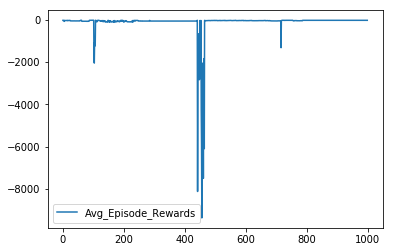

In [73]:
## TODO: Plot the rewards.
plt.plot(range(len(avg_episode_rewards)), avg_episode_rewards, label='Avg_Episode_Rewards')
plt.legend()
_ = plt.ylim()

Not monotonically increasing, but does have an interestingly symmetric structure. Examine on smaller scale. 

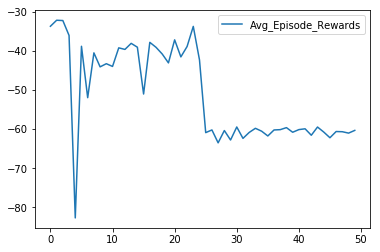

In [75]:
## TODO: Plot the rewards.
plt.plot(range(len(avg_episode_rewards[:50])), avg_episode_rewards[:50], label='Avg_Episode_Rewards')
plt.legend()
_ = plt.ylim()

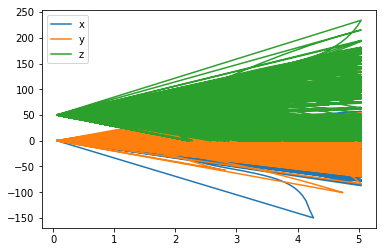

In [76]:
plt.plot(results['time'], results['x'], label='x')
plt.plot(results['time'], results['y'], label='y')
plt.plot(results['time'], results['z'], label='z')
plt.legend()
_ = plt.ylim()

**ATTEMPT 3**

In [80]:
"""
Decided to record and plot spatial trajectory of quadcopter over the last episode, when the networks have been 
trained. 
"""

import sys
import pandas as pd
from agents.agent import DDPG
from task import Task

num_episodes = 1000
init_pose = np.array([0., 0., 50., 0., 0., 0.])
init_vel = np.array([0., 0., 0.])
init_angle_velocities = np.array([0., 0., 0.])
target_pose = np.array([0., 0., 0., 0., 0., 0.])
target_vel = np.array([0., 0., 0.])
task = Task(init_pose=init_pose, init_vel=init_vel, init_angle_velocities=init_angle_velocities, target_pose=target_pose, target_vel=target_vel)
agent = DDPG(task)
avg_episode_rewards = []
file_output = 'data2.txt'

'''
Leave things the same as before, just record simulation and action history for plotting
'''
labels = ['time', 'x', 'y', 'z', 'phi', 'theta', 'psi', 'x_velocity',
          'y_velocity', 'z_velocity', 'phi_velocity', 'theta_velocity',
          'psi_velocity', 'rotor_speed1', 'rotor_speed2', 'rotor_speed3', 'rotor_speed4']
results = {x : [] for x in labels}

'''
USED THIS REWARD FUNCTION in task.py:
reward = -.3*(abs(self.sim.pose[:3] - self.target_pose[:3])).sum() - .3*(abs(self.sim.v[:3] - self.target_vel)).sum()/( 1.*(abs(self.sim.pose[:3] - self.target_pose[:3])).sum() ) #velocity only counts when close to ground
'''

for i_episode in range(1, num_episodes+1):
    print("")
    print("i_episode: " + str(i_episode))
    print("")
    print("")
    state = agent.reset_episode() # start a new episode
    time = 0
    total_episode_reward = 0
    count = 0
    
    with open(file_output, 'w') as csvfile:
        writer = csv.writer(csvfile)
        writer.writerow(labels)
    
        while True:
            print("")
            print("time: " + str(time))
            print("sim time: " + str(task.sim.time))
        
            action = agent.act(state) 
            next_state, reward, done = task.step(action)
            print("reward: " + str(reward))
        
            if i_episode == num_episodes: #only write last episode with fully trained actor and critic networks
                to_write = [task.sim.time] + list(task.sim.pose) + list(task.sim.v) + list(task.sim.angular_v) + list(rotor_speeds)
                for ii in range(len(labels)):
                    results[labels[ii]].append(to_write[ii])
                writer.writerow(to_write)
         
            total_episode_reward += reward
            count += 1
        
            agent.step(action, reward, next_state, done)
            state = next_state
            if done:
                break
            time += 1
    
    avg_episode_rewards.append(total_episode_reward/count)
    print("avg_episode_reward: " + str(total_episode_reward/count))
    sys.stdout.flush()



i_episode: 1



time: 0
sim time: 0.0
reward: -45.0139137914

time: 1
sim time: 0.06
reward: -45.068840717

time: 2
sim time: 0.12000000000000001
reward: -45.1401360922

time: 3
sim time: 0.18
reward: -45.2308203302

time: 4
sim time: 0.23999999999999996
reward: -45.3514232603

time: 5
sim time: 0.3
reward: -45.4963771936

time: 6
sim time: 0.36000000000000004
reward: -45.5762835862

time: 7
sim time: 0.4200000000000001
reward: -45.5548005537

time: 8
sim time: 0.48000000000000015
reward: -45.455668222

time: 9
sim time: 0.5400000000000001
reward: -45.2808065366

time: 10
sim time: 0.6000000000000002
reward: -45.0692330213

time: 11
sim time: 0.6600000000000003
reward: -44.8722635114

time: 12
sim time: 0.7200000000000003
reward: -44.6404813247

time: 13
sim time: 0.7800000000000004
reward: -44.376385638

time: 14
sim time: 0.8400000000000004
reward: -44.1276760859

time: 15
sim time: 0.9000000000000005
reward: -43.8459817339

time: 16
sim time: 0.9600000000000005
reward: -43.53241373


time: 25
sim time: 1.5000000000000009
reward: -43.8558031827

time: 26
sim time: 1.560000000000001
reward: -43.4046275129

time: 27
sim time: 1.620000000000001
reward: -42.9724845126

time: 28
sim time: 1.680000000000001
reward: -42.508618047

time: 29
sim time: 1.740000000000001
reward: -41.9704336116

time: 30
sim time: 1.8000000000000012
reward: -41.4251716131

time: 31
sim time: 1.8600000000000012
reward: -40.8917343337

time: 32
sim time: 1.9200000000000013
reward: -40.2981350641

time: 33
sim time: 1.9800000000000013
reward: -39.6528850653

time: 34
sim time: 2.0400000000000014
reward: -39.0256695542

time: 35
sim time: 2.1000000000000014
reward: -38.3839510733

time: 36
sim time: 2.1600000000000015
reward: -37.6732843625

time: 37
sim time: 2.2200000000000015
reward: -36.950455398

time: 38
sim time: 2.2800000000000016
reward: -36.2505864222

time: 39
sim time: 2.3400000000000016
reward: -35.5082734994

time: 40
sim time: 2.4000000000000017
reward: -34.7152181832

time: 41
sim 


time: 47
sim time: 2.820000000000002
reward: -23.3014665267

time: 48
sim time: 2.880000000000002
reward: -24.1333674

time: 49
sim time: 2.940000000000002
reward: -25.0761652833

time: 50
sim time: 3.000000000000002
reward: -26.1080672712

time: 51
sim time: 3.0600000000000023
reward: -27.2024842806

time: 52
sim time: 3.1200000000000023
reward: -28.3272379194

time: 53
sim time: 3.1800000000000024
reward: -29.4446737469

time: 54
sim time: 3.2400000000000024
reward: -30.5131840174

time: 55
sim time: 3.3000000000000025
reward: -31.4893740683

time: 56
sim time: 3.3600000000000025
reward: -32.375518548

time: 57
sim time: 3.4200000000000026
reward: -33.1834392828

time: 58
sim time: 3.4800000000000026
reward: -33.776324338

time: 59
sim time: 3.5400000000000027
reward: -34.1255912394

time: 60
sim time: 3.6000000000000028
reward: -34.2143459845

time: 61
sim time: 3.660000000000003
reward: -34.0353917919

time: 62
sim time: 3.720000000000003
reward: -33.5905912664

time: 63
sim time:


time: 27
sim time: 1.620000000000001
reward: -41.8559131819

time: 28
sim time: 1.680000000000001
reward: -42.1495794675

time: 29
sim time: 1.740000000000001
reward: -42.3527186445

time: 30
sim time: 1.8000000000000012
reward: -42.5721859351

time: 31
sim time: 1.8600000000000012
reward: -42.803535912

time: 32
sim time: 1.9200000000000013
reward: -42.9353051964

time: 33
sim time: 1.9800000000000013
reward: -43.0113752406

time: 34
sim time: 2.0400000000000014
reward: -43.1327158844

time: 35
sim time: 2.1000000000000014
reward: -43.2183362856

time: 36
sim time: 2.1600000000000015
reward: -43.1912751552

time: 37
sim time: 2.2200000000000015
reward: -43.1626727484

time: 38
sim time: 2.2800000000000016
reward: -43.1723668411

time: 39
sim time: 2.3400000000000016
reward: -43.0928623908

time: 40
sim time: 2.4000000000000017
reward: -42.9269613717

time: 41
sim time: 2.4600000000000017
reward: -42.8045673546

time: 42
sim time: 2.520000000000002
reward: -42.6775474163

time: 43
sim


time: 12
sim time: 0.7200000000000003
reward: -47.0045338911

time: 13
sim time: 0.7800000000000004
reward: -46.3601438773

time: 14
sim time: 0.8400000000000004
reward: -45.5190721389

time: 15
sim time: 0.9000000000000005
reward: -44.478972675

time: 16
sim time: 0.9600000000000005
reward: -43.2402371915

time: 17
sim time: 1.0200000000000005
reward: -41.8062007632

time: 18
sim time: 1.0800000000000005
reward: -40.2005783913

time: 19
sim time: 1.1400000000000006
reward: -38.4997702438

time: 20
sim time: 1.2000000000000006
reward: -36.6534910634

time: 21
sim time: 1.2600000000000007
reward: -34.6687896403

time: 22
sim time: 1.3200000000000007
reward: -32.5636562497

time: 23
sim time: 1.3800000000000008
reward: -30.358411615

time: 24
sim time: 1.4400000000000008
reward: -28.0756905995

time: 25
sim time: 1.5000000000000009
reward: -25.7406477851

time: 26
sim time: 1.560000000000001
reward: -23.3912607189

time: 27
sim time: 1.620000000000001
reward: -21.0624973892

time: 28
si


time: 9
sim time: 0.5400000000000001
reward: -50.7038723157

time: 10
sim time: 0.6000000000000002
reward: -51.7790548999

time: 11
sim time: 0.6600000000000003
reward: -52.9169000509

time: 12
sim time: 0.7200000000000003
reward: -54.1104563937

time: 13
sim time: 0.7800000000000004
reward: -55.353230424

time: 14
sim time: 0.8400000000000004
reward: -56.6392734451

time: 15
sim time: 0.9000000000000005
reward: -57.9631233255

time: 16
sim time: 0.9600000000000005
reward: -59.3197508079

time: 17
sim time: 1.0200000000000005
reward: -60.7046082067

time: 18
sim time: 1.0800000000000005
reward: -62.1136416189

time: 19
sim time: 1.1400000000000006
reward: -63.5432572293

time: 20
sim time: 1.2000000000000006
reward: -64.9902254646

time: 21
sim time: 1.2600000000000007
reward: -66.4516678288

time: 22
sim time: 1.3200000000000007
reward: -67.9250601864

time: 23
sim time: 1.3800000000000008
reward: -69.4081928231

time: 24
sim time: 1.4400000000000008
reward: -70.8991142013

time: 25



time: 62
sim time: 3.720000000000003
reward: -21.0339058989

time: 63
sim time: 3.780000000000003
reward: -19.4307146133

time: 64
sim time: 3.840000000000003
reward: -18.0281249663

time: 65
sim time: 3.900000000000003
reward: -16.8344896687

time: 66
sim time: 3.960000000000003
reward: -15.8534150592

time: 67
sim time: 4.020000000000002
reward: -15.6787072115

time: 68
sim time: 4.080000000000001
reward: -17.2453733133

time: 69
sim time: 4.14
reward: -19.1462177283

time: 70
sim time: 4.199999999999998
reward: -21.1687746214

time: 71
sim time: 4.259999999999997
reward: -23.276440101

time: 72
sim time: 4.319999999999996
reward: -25.4213733209

time: 73
sim time: 4.379999999999995
reward: -27.5857216811

time: 74
sim time: 4.439999999999993
reward: -29.7453462168

time: 75
sim time: 4.499999999999992
reward: -31.922188449

time: 76
sim time: 4.559999999999991
reward: -34.0857450758

time: 77
sim time: 4.6199999999999894
reward: -36.1907505159

time: 78
sim time: 4.679999999999988


reward: -83.4330311583

time: 33
sim time: 1.9800000000000013
reward: -84.9988596167

time: 34
sim time: 2.0400000000000014
reward: -86.6536074403

time: 35
sim time: 2.1000000000000014
reward: -88.3429467681

time: 36
sim time: 2.1600000000000015
reward: -90.0511051304

time: 37
sim time: 2.2200000000000015
reward: -91.7787159205

time: 38
sim time: 2.2800000000000016
reward: -93.5264355015

time: 39
sim time: 2.3400000000000016
reward: -95.2948841287

time: 40
sim time: 2.4000000000000017
reward: -97.0846985625

time: 41
sim time: 2.4600000000000017
reward: -98.8965728681

time: 42
sim time: 2.520000000000002
reward: -100.731094983

time: 43
sim time: 2.580000000000002
reward: -102.588745718

time: 44
sim time: 2.640000000000002
reward: -104.469889582

time: 45
sim time: 2.700000000000002
reward: -106.374786377

time: 46
sim time: 2.760000000000002
reward: -108.303543527

time: 47
sim time: 2.820000000000002
reward: -110.256108602

time: 48
sim time: 2.880000000000002
reward: -112.23


time: 83
sim time: 4.979999999999982
reward: -204.938519107
avg_episode_reward: -111.966302123

i_episode: 16



time: 0
sim time: 0.0
reward: -45.0605992331

time: 1
sim time: 0.06
reward: -45.2486013255

time: 2
sim time: 0.12000000000000001
reward: -45.559284788

time: 3
sim time: 0.18
reward: -45.9888201558

time: 4
sim time: 0.23999999999999996
reward: -46.5321319003

time: 5
sim time: 0.3
reward: -47.1831896671

time: 6
sim time: 0.36000000000000004
reward: -47.9352823542

time: 7
sim time: 0.4200000000000001
reward: -48.7811063687

time: 8
sim time: 0.48000000000000015
reward: -49.7129432864

time: 9
sim time: 0.5400000000000001
reward: -50.722893947

time: 10
sim time: 0.6000000000000002
reward: -51.8031294433

time: 11
sim time: 0.6600000000000003
reward: -52.946043461

time: 12
sim time: 0.7200000000000003
reward: -54.1444007512

time: 13
sim time: 0.7800000000000004
reward: -55.3914220546

time: 14
sim time: 0.8400000000000004
reward: -56.6807845866

time: 15
sim time: 0.90


time: 51
sim time: 3.0600000000000023
reward: -48.3512413685

time: 52
sim time: 3.1200000000000023
reward: -48.7267890535

time: 53
sim time: 3.1800000000000024
reward: -48.8212729496

time: 54
sim time: 3.2400000000000024
reward: -48.6510974449

time: 55
sim time: 3.3000000000000025
reward: -48.260930795

time: 56
sim time: 3.3600000000000025
reward: -47.600788024

time: 57
sim time: 3.4200000000000026
reward: -46.6986877206

time: 58
sim time: 3.4800000000000026
reward: -45.5801402989

time: 59
sim time: 3.5400000000000027
reward: -44.2570166246

time: 60
sim time: 3.6000000000000028
reward: -42.7579897476

time: 61
sim time: 3.660000000000003
reward: -41.1128103773

time: 62
sim time: 3.720000000000003
reward: -39.351502551

time: 63
sim time: 3.780000000000003
reward: -37.5039354046

time: 64
sim time: 3.840000000000003
reward: -35.5996429569

time: 65
sim time: 3.900000000000003
reward: -33.6677081258

time: 66
sim time: 3.960000000000003
reward: -31.7364688064

time: 67
sim tim


time: 32
sim time: 1.9200000000000013
reward: -83.5668496211

time: 33
sim time: 1.9800000000000013
reward: -85.1473513916

time: 34
sim time: 2.0400000000000014
reward: -86.7312379554

time: 35
sim time: 2.1000000000000014
reward: -88.3181837271

time: 36
sim time: 2.1600000000000015
reward: -89.9079753746

time: 37
sim time: 2.2200000000000015
reward: -91.5005034798

time: 38
sim time: 2.2800000000000016
reward: -93.0957668829

time: 39
sim time: 2.3400000000000016
reward: -94.6938409084

time: 40
sim time: 2.4000000000000017
reward: -96.2948783312

time: 41
sim time: 2.4600000000000017
reward: -97.8990635137

time: 42
sim time: 2.520000000000002
reward: -99.5066216068

time: 43
sim time: 2.580000000000002
reward: -101.117847049

time: 44
sim time: 2.640000000000002
reward: -102.733041284

time: 45
sim time: 2.700000000000002
reward: -104.352555314

time: 46
sim time: 2.760000000000002
reward: -105.976794929

time: 47
sim time: 2.820000000000002
reward: -107.60618998

time: 48
sim t


time: 82
sim time: 4.919999999999983
reward: -100.872712033

time: 83
sim time: 4.979999999999982
reward: -97.1190216428
avg_episode_reward: -89.1989011964

i_episode: 21



time: 0
sim time: 0.0
reward: -45.0509339536

time: 1
sim time: 0.06
reward: -45.2076852779

time: 2
sim time: 0.12000000000000001
reward: -45.3345373605

time: 3
sim time: 0.18
reward: -45.465109551

time: 4
sim time: 0.23999999999999996
reward: -45.5637162839

time: 5
sim time: 0.3
reward: -45.4986912523

time: 6
sim time: 0.36000000000000004
reward: -45.4854233101

time: 7
sim time: 0.4200000000000001
reward: -45.5848150735

time: 8
sim time: 0.48000000000000015
reward: -45.5196278192

time: 9
sim time: 0.5400000000000001
reward: -45.3198910008

time: 10
sim time: 0.6000000000000002
reward: -45.1080874512

time: 11
sim time: 0.6600000000000003
reward: -44.8217742185

time: 12
sim time: 0.7200000000000003
reward: -44.4555909096

time: 13
sim time: 0.7800000000000004
reward: -44.1688926661

time: 14
sim time: 0.8


time: 6
sim time: 0.36000000000000004
reward: -47.9323264537

time: 7
sim time: 0.4200000000000001
reward: -48.7770900488

time: 8
sim time: 0.48000000000000015
reward: -49.7085582442

time: 9
sim time: 0.5400000000000001
reward: -50.7196928006

time: 10
sim time: 0.6000000000000002
reward: -51.8036923722

time: 11
sim time: 0.6600000000000003
reward: -52.9541476967

time: 12
sim time: 0.7200000000000003
reward: -54.1651187132

time: 13
sim time: 0.7800000000000004
reward: -55.4311665308

time: 14
sim time: 0.8400000000000004
reward: -56.7473780555

time: 15
sim time: 0.9000000000000005
reward: -58.109341989

time: 16
sim time: 0.9600000000000005
reward: -59.5132292303

time: 17
sim time: 1.0200000000000005
reward: -60.955839489

time: 18
sim time: 1.0800000000000005
reward: -62.4345732625

time: 19
sim time: 1.1400000000000006
reward: -63.9473651192

time: 20
sim time: 1.2000000000000006
reward: -65.4926021675

time: 21
sim time: 1.2600000000000007
reward: -67.0691127078

time: 22
si


i_episode: 25



time: 0
sim time: 0.0
reward: -45.05107479

time: 1
sim time: 0.06
reward: -45.1908166327

time: 2
sim time: 0.12000000000000001
reward: -45.304629646

time: 3
sim time: 0.18
reward: -45.4618210981

time: 4
sim time: 0.23999999999999996
reward: -45.6644355993

time: 5
sim time: 0.3
reward: -45.9096669686

time: 6
sim time: 0.36000000000000004
reward: -46.1441047032

time: 7
sim time: 0.4200000000000001
reward: -46.2929369521

time: 8
sim time: 0.48000000000000015
reward: -46.4082472765

time: 9
sim time: 0.5400000000000001
reward: -46.5413327687

time: 10
sim time: 0.6000000000000002
reward: -46.635080561

time: 11
sim time: 0.6600000000000003
reward: -46.6504622066

time: 12
sim time: 0.7200000000000003
reward: -46.6576556012

time: 13
sim time: 0.7800000000000004
reward: -46.6718814831

time: 14
sim time: 0.8400000000000004
reward: -46.6184521994

time: 15
sim time: 0.9000000000000005
reward: -46.5079976769

time: 16
sim time: 0.9600000000000005
reward: -46.40927046


time: 22
sim time: 1.3200000000000007
reward: -45.0145166248

time: 23
sim time: 1.3800000000000008
reward: -44.6814905613

time: 24
sim time: 1.4400000000000008
reward: -44.3353563946

time: 25
sim time: 1.5000000000000009
reward: -43.9179388216

time: 26
sim time: 1.560000000000001
reward: -43.4692374812

time: 27
sim time: 1.620000000000001
reward: -43.0231991452

time: 28
sim time: 1.680000000000001
reward: -42.5332339576

time: 29
sim time: 1.740000000000001
reward: -41.9832382171

time: 30
sim time: 1.8000000000000012
reward: -41.4259905966

time: 31
sim time: 1.8600000000000012
reward: -40.8546079781

time: 32
sim time: 1.9200000000000013
reward: -40.2205147554

time: 33
sim time: 1.9800000000000013
reward: -39.5550663568

time: 34
sim time: 2.0400000000000014
reward: -38.8882366636

time: 35
sim time: 2.1000000000000014
reward: -38.178563315

time: 36
sim time: 2.1600000000000015
reward: -37.4151282281

time: 37
sim time: 2.2200000000000015
reward: -36.6480235842

time: 38
sim

sim time: 2.4600000000000017
reward: -33.1452535472

time: 42
sim time: 2.520000000000002
reward: -32.2363508209

time: 43
sim time: 2.580000000000002
reward: -31.2574205094

time: 44
sim time: 2.640000000000002
reward: -30.2638948087

time: 45
sim time: 2.700000000000002
reward: -29.282252551

time: 46
sim time: 2.760000000000002
reward: -28.2443946602

time: 47
sim time: 2.820000000000002
reward: -27.1594043792

time: 48
sim time: 2.880000000000002
reward: -26.1012812194

time: 49
sim time: 2.940000000000002
reward: -25.0254367372

time: 50
sim time: 3.000000000000002
reward: -23.8728105789

time: 51
sim time: 3.0600000000000023
reward: -22.7312965391

time: 52
sim time: 3.1200000000000023
reward: -21.6337290386

time: 53
sim time: 3.1800000000000024
reward: -20.4709476234

time: 54
sim time: 3.2400000000000024
reward: -19.2622907531

time: 55
sim time: 3.3000000000000025
reward: -18.1511460731

time: 56
sim time: 3.3600000000000025
reward: -17.1386813799
avg_episode_reward: -38.3460


time: 64
sim time: 3.840000000000003
reward: -93.7515423842

time: 65
sim time: 3.900000000000003
reward: -94.6384790511

time: 66
sim time: 3.960000000000003
reward: -95.5154178495

time: 67
sim time: 4.020000000000002
reward: -96.3812709714

time: 68
sim time: 4.080000000000001
reward: -97.2349261232

time: 69
sim time: 4.14
reward: -98.0752174765

time: 70
sim time: 4.199999999999998
reward: -98.9009418404

time: 71
sim time: 4.259999999999997
reward: -99.7108998553

time: 72
sim time: 4.319999999999996
reward: -100.503903267

time: 73
sim time: 4.379999999999995
reward: -101.278771459

time: 74
sim time: 4.439999999999993
reward: -102.107923086

time: 75
sim time: 4.499999999999992
reward: -103.202765556

time: 76
sim time: 4.559999999999991
reward: -104.337481196

time: 77
sim time: 4.6199999999999894
reward: -105.488539415

time: 78
sim time: 4.679999999999988
reward: -106.656043998

time: 79
sim time: 4.739999999999987
reward: -107.839967666

time: 80
sim time: 4.79999999999998

time: 31
sim time: 1.8600000000000012
reward: -62.7805273273

time: 32
sim time: 1.9200000000000013
reward: -63.6865502378

time: 33
sim time: 1.9800000000000013
reward: -64.6075129844

time: 34
sim time: 2.0400000000000014
reward: -65.5435043691

time: 35
sim time: 2.1000000000000014
reward: -66.494675419

time: 36
sim time: 2.1600000000000015
reward: -67.4612470199

time: 37
sim time: 2.2200000000000015
reward: -68.4434531655

time: 38
sim time: 2.2800000000000016
reward: -69.4415537747

time: 39
sim time: 2.3400000000000016
reward: -70.455898117

time: 40
sim time: 2.4000000000000017
reward: -71.4868510766

time: 41
sim time: 2.4600000000000017
reward: -72.5347612838

time: 42
sim time: 2.520000000000002
reward: -73.5999648192

time: 43
sim time: 2.580000000000002
reward: -74.682807299

time: 44
sim time: 2.640000000000002
reward: -75.7836106069

time: 45
sim time: 2.700000000000002
reward: -76.9026252947

time: 46
sim time: 2.760000000000002
reward: -78.040070481

time: 47
sim time


time: 82
sim time: 4.919999999999983
reward: -130.480542984

time: 83
sim time: 4.979999999999982
reward: -131.793097997
avg_episode_reward: -80.1447137778

i_episode: 35



time: 0
sim time: 0.0
reward: -45.0226771228

time: 1
sim time: 0.06
reward: -45.0932053456

time: 2
sim time: 0.12000000000000001
reward: -45.210377885

time: 3
sim time: 0.18
reward: -45.3736818875

time: 4
sim time: 0.23999999999999996
reward: -45.5824167362

time: 5
sim time: 0.3
reward: -45.8357035004

time: 6
sim time: 0.36000000000000004
reward: -46.132482393

time: 7
sim time: 0.4200000000000001
reward: -46.4715103053

time: 8
sim time: 0.48000000000000015
reward: -46.8513599761

time: 9
sim time: 0.5400000000000001
reward: -47.2704624541

time: 10
sim time: 0.6000000000000002
reward: -47.7271419011

time: 11
sim time: 0.6600000000000003
reward: -48.219680358

time: 12
sim time: 0.7200000000000003
reward: -48.7463321936

time: 13
sim time: 0.7800000000000004
reward: -49.3052692671

time: 14
sim time: 0.840


time: 49
sim time: 2.940000000000002
reward: -82.9842336235

time: 50
sim time: 3.000000000000002
reward: -84.2472536943

time: 51
sim time: 3.0600000000000023
reward: -85.5267353002

time: 52
sim time: 3.1200000000000023
reward: -86.8223137249

time: 53
sim time: 3.1800000000000024
reward: -88.1335542722

time: 54
sim time: 3.2400000000000024
reward: -89.4599769816

time: 55
sim time: 3.3000000000000025
reward: -90.8010083568

time: 56
sim time: 3.3600000000000025
reward: -92.1559516606

time: 57
sim time: 3.4200000000000026
reward: -93.524028768

time: 58
sim time: 3.4800000000000026
reward: -94.904357687

time: 59
sim time: 3.5400000000000027
reward: -96.2959220048

time: 60
sim time: 3.6000000000000028
reward: -97.6975464941

time: 61
sim time: 3.660000000000003
reward: -99.1079079961

time: 62
sim time: 3.720000000000003
reward: -100.525552829

time: 63
sim time: 3.780000000000003
reward: -101.948873783

time: 64
sim time: 3.840000000000003
reward: -103.376129809

time: 65
sim ti


time: 19
sim time: 1.1400000000000006
reward: -53.1415855677

time: 20
sim time: 1.2000000000000006
reward: -53.8673473054

time: 21
sim time: 1.2600000000000007
reward: -54.6170817055

time: 22
sim time: 1.3200000000000007
reward: -55.385805251

time: 23
sim time: 1.3800000000000008
reward: -56.1723712325

time: 24
sim time: 1.4400000000000008
reward: -56.9756940183

time: 25
sim time: 1.5000000000000009
reward: -57.7947370395

time: 26
sim time: 1.560000000000001
reward: -58.6285395474

time: 27
sim time: 1.620000000000001
reward: -59.4761967893

time: 28
sim time: 1.680000000000001
reward: -60.3368577294

time: 29
sim time: 1.740000000000001
reward: -61.2097171194

time: 30
sim time: 1.8000000000000012
reward: -62.0940508623

time: 31
sim time: 1.8600000000000012
reward: -62.9891931292

time: 32
sim time: 1.9200000000000013
reward: -63.8945499826

time: 33
sim time: 1.9800000000000013
reward: -64.8095808016

time: 34
sim time: 2.0400000000000014
reward: -65.7337533695

time: 35
sim


time: 71
sim time: 4.259999999999997
reward: -102.396929933

time: 72
sim time: 4.319999999999996
reward: -103.627679774

time: 73
sim time: 4.379999999999995
reward: -104.87220023

time: 74
sim time: 4.439999999999993
reward: -106.130639506

time: 75
sim time: 4.499999999999992
reward: -107.403093611

time: 76
sim time: 4.559999999999991
reward: -108.689650771

time: 77
sim time: 4.6199999999999894
reward: -109.990358678

time: 78
sim time: 4.679999999999988
reward: -111.305148948

time: 79
sim time: 4.739999999999987
reward: -112.63387568

time: 80
sim time: 4.799999999999986
reward: -113.976280524

time: 81
sim time: 4.859999999999984
reward: -115.331980094

time: 82
sim time: 4.919999999999983
reward: -116.700498532

time: 83
sim time: 4.979999999999982
reward: -118.081186198
avg_episode_reward: -74.7108568059

i_episode: 40



time: 0
sim time: 0.0
reward: -45.0226765029

time: 1
sim time: 0.06
reward: -45.0932025923

time: 2
sim time: 0.12000000000000001
reward: -45.2103485549



sim time: 2.2200000000000015
reward: -69.3931672905

time: 38
sim time: 2.2800000000000016
reward: -70.4164480864

time: 39
sim time: 2.3400000000000016
reward: -71.4516494055

time: 40
sim time: 2.4000000000000017
reward: -72.4986995309

time: 41
sim time: 2.4600000000000017
reward: -73.5575976715

time: 42
sim time: 2.520000000000002
reward: -74.6283998274

time: 43
sim time: 2.580000000000002
reward: -75.7111858307

time: 44
sim time: 2.640000000000002
reward: -76.8060401564

time: 45
sim time: 2.700000000000002
reward: -77.9130455882

time: 46
sim time: 2.760000000000002
reward: -79.0322578479

time: 47
sim time: 2.820000000000002
reward: -80.1637046996

time: 48
sim time: 2.880000000000002
reward: -81.3073782709

time: 49
sim time: 2.940000000000002
reward: -82.4632826313

time: 50
sim time: 3.000000000000002
reward: -83.631426558

time: 51
sim time: 3.0600000000000023
reward: -84.8117425269

time: 52
sim time: 3.1200000000000023
reward: -86.0041510689

time: 53
sim time: 3.180000


time: 6
sim time: 0.36000000000000004
reward: -46.1323246618

time: 7
sim time: 0.4200000000000001
reward: -46.4712934332

time: 8
sim time: 0.48000000000000015
reward: -46.8509977159

time: 9
sim time: 0.5400000000000001
reward: -47.2697962756

time: 10
sim time: 0.6000000000000002
reward: -47.7259156201

time: 11
sim time: 0.6600000000000003
reward: -48.2174445296

time: 12
sim time: 0.7200000000000003
reward: -48.7423781745

time: 13
sim time: 0.7800000000000004
reward: -49.2986722703

time: 14
sim time: 0.8400000000000004
reward: -49.8842139678

time: 15
sim time: 0.9000000000000005
reward: -50.496925596

time: 16
sim time: 0.9600000000000005
reward: -51.1347847798

time: 17
sim time: 1.0200000000000005
reward: -51.7957856858

time: 18
sim time: 1.0800000000000005
reward: -52.4782343851

time: 19
sim time: 1.1400000000000006
reward: -53.1806894807

time: 20
sim time: 1.2000000000000006
reward: -53.900810337

time: 21
sim time: 1.2600000000000007
reward: -54.6368438934

time: 22
si

avg_episode_reward: -32.5982782739

i_episode: 45



time: 0
sim time: 0.0
reward: -45.0068427507

time: 1
sim time: 0.06
reward: -45.0275355077

time: 2
sim time: 0.12000000000000001
reward: -45.0285367767

time: 3
sim time: 0.18
reward: -45.0356290088

time: 4
sim time: 0.23999999999999996
reward: -45.0256223535

time: 5
sim time: 0.3
reward: -45.0049276611

time: 6
sim time: 0.36000000000000004
reward: -44.959532438

time: 7
sim time: 0.4200000000000001
reward: -44.8669485473

time: 8
sim time: 0.48000000000000015
reward: -44.7411517353

time: 9
sim time: 0.5400000000000001
reward: -44.5993721816

time: 10
sim time: 0.6000000000000002
reward: -44.4221199959

time: 11
sim time: 0.6600000000000003
reward: -44.1991495195

time: 12
sim time: 0.7200000000000003
reward: -43.9536854092

time: 13
sim time: 0.7800000000000004
reward: -43.6876146489

time: 14
sim time: 0.8400000000000004
reward: -43.3770045415

time: 15
sim time: 0.9000000000000005
reward: -43.029317107

time: 16
sim time: 0.

reward: -40.3324336198

time: 22
sim time: 1.3200000000000007
reward: -39.7645040203

time: 23
sim time: 1.3800000000000008
reward: -39.1822621066

time: 24
sim time: 1.4400000000000008
reward: -38.5714518107

time: 25
sim time: 1.5000000000000009
reward: -37.9116223485

time: 26
sim time: 1.560000000000001
reward: -37.2273758661

time: 27
sim time: 1.620000000000001
reward: -36.5303780018

time: 28
sim time: 1.680000000000001
reward: -35.7896319395

time: 29
sim time: 1.740000000000001
reward: -35.0050728495

time: 30
sim time: 1.8000000000000012
reward: -34.2113032465

time: 31
sim time: 1.8600000000000012
reward: -33.3955957895

time: 32
sim time: 1.9200000000000013
reward: -32.5255351158

time: 33
sim time: 1.9800000000000013
reward: -31.6282845503

time: 34
sim time: 2.0400000000000014
reward: -30.7292524107

time: 35
sim time: 2.1000000000000014
reward: -29.7904630129

time: 36
sim time: 2.1600000000000015
reward: -28.7977910416

time: 37
sim time: 2.2200000000000015
reward: -27.

sim time: 2.580000000000002
reward: -17.3227357705

time: 44
sim time: 2.640000000000002
reward: -16.1262132958

time: 45
sim time: 2.700000000000002
reward: -15.1212336173

time: 46
sim time: 2.760000000000002
reward: -14.342635144

time: 47
sim time: 2.820000000000002
reward: -13.807369989

time: 48
sim time: 2.880000000000002
reward: -13.5074746484

time: 49
sim time: 2.940000000000002
reward: -13.5230144287
avg_episode_reward: -34.2942853455

i_episode: 50



time: 0
sim time: 0.0
reward: -44.9988249159

time: 1
sim time: 0.06
reward: -44.9723485957

time: 2
sim time: 0.12000000000000001
reward: -44.9140433859

time: 3
sim time: 0.18
reward: -44.8237490154

time: 4
sim time: 0.23999999999999996
reward: -44.7011935811

time: 5
sim time: 0.3
reward: -44.5459901902

time: 6
sim time: 0.36000000000000004
reward: -44.3576320393

time: 7
sim time: 0.4200000000000001
reward: -44.135485708

time: 8
sim time: 0.48000000000000015
reward: -43.8787824723

time: 9
sim time: 0.5400000000000001
r


time: 16
sim time: 0.9600000000000005
reward: -40.4328900453

time: 17
sim time: 1.0200000000000005
reward: -39.8003977278

time: 18
sim time: 1.0800000000000005
reward: -39.1141253289

time: 19
sim time: 1.1400000000000006
reward: -38.370219111

time: 20
sim time: 1.2000000000000006
reward: -37.5642173023

time: 21
sim time: 1.2600000000000007
reward: -36.6909364253

time: 22
sim time: 1.3200000000000007
reward: -35.7443326308

time: 23
sim time: 1.3800000000000008
reward: -34.7173338706

time: 24
sim time: 1.4400000000000008
reward: -33.6016407748

time: 25
sim time: 1.5000000000000009
reward: -32.3875005142

time: 26
sim time: 1.560000000000001
reward: -31.0634760965

time: 27
sim time: 1.620000000000001
reward: -29.6162816185

time: 28
sim time: 1.680000000000001
reward: -28.030881908

time: 29
sim time: 1.740000000000001
reward: -26.2914090096

time: 30
sim time: 1.8000000000000012
reward: -24.3845000657

time: 31
sim time: 1.8600000000000012
reward: -22.3101410739

time: 32
sim 


time: 1
sim time: 0.06
reward: -44.9723485912

time: 2
sim time: 0.12000000000000001
reward: -44.9140433696

time: 3
sim time: 0.18
reward: -44.8237489765

time: 4
sim time: 0.23999999999999996
reward: -44.7011934959

time: 5
sim time: 0.3
reward: -44.5459900488

time: 6
sim time: 0.36000000000000004
reward: -44.357631841

time: 7
sim time: 0.4200000000000001
reward: -44.1354854617

time: 8
sim time: 0.48000000000000015
reward: -43.8787821959

time: 9
sim time: 0.5400000000000001
reward: -43.5866071716

time: 10
sim time: 0.6000000000000002
reward: -43.2578859715

time: 11
sim time: 0.6600000000000003
reward: -42.8913683211

time: 12
sim time: 0.7200000000000003
reward: -42.4856083007

time: 13
sim time: 0.7800000000000004
reward: -42.0389404084

time: 14
sim time: 0.8400000000000004
reward: -41.5494507008

time: 15
sim time: 0.9000000000000005
reward: -41.0149418981

time: 16
sim time: 0.9600000000000005
reward: -40.4328911712

time: 17
sim time: 1.0200000000000005
reward: -39.800398


time: 25
sim time: 1.5000000000000009
reward: -32.3875184219

time: 26
sim time: 1.560000000000001
reward: -31.0634951158

time: 27
sim time: 1.620000000000001
reward: -29.6162999108

time: 28
sim time: 1.680000000000001
reward: -28.0319038273

time: 29
sim time: 1.740000000000001
reward: -26.3135664043

time: 30
sim time: 1.8000000000000012
reward: -24.6470537721

time: 31
sim time: 1.8600000000000012
reward: -23.0025768743

time: 32
sim time: 1.9200000000000013
reward: -21.3181401249

time: 33
sim time: 1.9800000000000013
reward: -19.5677637805

time: 34
sim time: 2.0400000000000014
reward: -17.7123262846

time: 35
sim time: 2.1000000000000014
reward: -16.0306153654

time: 36
sim time: 2.1600000000000015
reward: -14.6227022639

time: 37
sim time: 2.2200000000000015
reward: -13.2322875632

time: 38
sim time: 2.2800000000000016
reward: -11.9675239051

time: 39
sim time: 2.3400000000000016
reward: -11.9778048582

time: 40
sim time: 2.4000000000000017
reward: -16.0263019102

time: 41
si

sim time: 0.36000000000000004
reward: -44.9513574144

time: 7
sim time: 0.4200000000000001
reward: -44.8565095563

time: 8
sim time: 0.48000000000000015
reward: -44.7278375949

time: 9
sim time: 0.5400000000000001
reward: -44.5823894247

time: 10
sim time: 0.6000000000000002
reward: -44.4020237384

time: 11
sim time: 0.6600000000000003
reward: -44.1766419092

time: 12
sim time: 0.7200000000000003
reward: -43.9272909835

time: 13
sim time: 0.7800000000000004
reward: -43.6559758797

time: 14
sim time: 0.8400000000000004
reward: -43.3420076767

time: 15
sim time: 0.9000000000000005
reward: -42.9913848923

time: 16
sim time: 0.9600000000000005
reward: -42.6211584448

time: 17
sim time: 1.0200000000000005
reward: -42.2188208599

time: 18
sim time: 1.0800000000000005
reward: -41.7738286351

time: 19
sim time: 1.1400000000000006
reward: -41.3027117117

time: 20
sim time: 1.2000000000000006
reward: -40.807879671

time: 21
sim time: 1.2600000000000007
reward: -40.2723899093

time: 22
sim time: 


time: 30
sim time: 1.8000000000000012
reward: -34.1166012319

time: 31
sim time: 1.8600000000000012
reward: -33.2779424974

time: 32
sim time: 1.9200000000000013
reward: -32.3929721924

time: 33
sim time: 1.9800000000000013
reward: -31.4960015931

time: 34
sim time: 2.0400000000000014
reward: -30.5813289741

time: 35
sim time: 2.1000000000000014
reward: -29.6116201648

time: 36
sim time: 2.1600000000000015
reward: -28.6094291599

time: 37
sim time: 2.2200000000000015
reward: -27.6132020137

time: 38
sim time: 2.2800000000000016
reward: -26.583189526

time: 39
sim time: 2.3400000000000016
reward: -25.4875167692

time: 40
sim time: 2.4000000000000017
reward: -24.3874644189

time: 41
sim time: 2.4600000000000017
reward: -23.3026080832

time: 42
sim time: 2.520000000000002
reward: -22.1600364039

time: 43
sim time: 2.580000000000002
reward: -20.9603050009

time: 44
sim time: 2.640000000000002
reward: -19.7992463791

time: 45
sim time: 2.700000000000002
reward: -18.6509113785

time: 46
sim

avg_episode_reward: -32.9087605905

i_episode: 68



time: 0
sim time: 0.0
reward: -45.006843357

time: 1
sim time: 0.06
reward: -45.0275598519

time: 2
sim time: 0.12000000000000001
reward: -45.028964665

time: 3
sim time: 0.18
reward: -45.0355532289

time: 4
sim time: 0.23999999999999996
reward: -45.0228252394

time: 5
sim time: 0.3
reward: -44.9989333895

time: 6
sim time: 0.36000000000000004
reward: -44.950872837

time: 7
sim time: 0.4200000000000001
reward: -44.8559561739

time: 8
sim time: 0.48000000000000015
reward: -44.7272317558

time: 9
sim time: 0.5400000000000001
reward: -44.5817471369

time: 10
sim time: 0.6000000000000002
reward: -44.4013193864

time: 11
sim time: 0.6600000000000003
reward: -44.1758943254

time: 12
sim time: 0.7200000000000003
reward: -43.9265430585

time: 13
sim time: 0.7800000000000004
reward: -43.6551520566

time: 14
sim time: 0.8400000000000004
reward: -43.3410541527

time: 15
sim time: 0.9000000000000005
reward: -42.9904150562

time: 16
sim time: 0.9


time: 29
sim time: 1.740000000000001
reward: -61.7573859026

time: 30
sim time: 1.8000000000000012
reward: -62.6863690592

time: 31
sim time: 1.8600000000000012
reward: -63.6274894442

time: 32
sim time: 1.9200000000000013
reward: -64.5801264511

time: 33
sim time: 1.9800000000000013
reward: -65.543755058

time: 34
sim time: 2.0400000000000014
reward: -66.5179840665

time: 35
sim time: 2.1000000000000014
reward: -67.5024938182

time: 36
sim time: 2.1600000000000015
reward: -68.4970380262

time: 37
sim time: 2.2200000000000015
reward: -69.5014625298

time: 38
sim time: 2.2800000000000016
reward: -70.5156792388

time: 39
sim time: 2.3400000000000016
reward: -71.539652789

time: 40
sim time: 2.4000000000000017
reward: -72.5733641863

time: 41
sim time: 2.4600000000000017
reward: -73.6168317731

time: 42
sim time: 2.520000000000002
reward: -74.6701214198

time: 43
sim time: 2.580000000000002
reward: -75.7333447569

time: 44
sim time: 2.640000000000002
reward: -76.8066396173

time: 45
sim 


time: 80
sim time: 4.799999999999986
reward: -117.937600567

time: 81
sim time: 4.859999999999984
reward: -119.132933566

time: 82
sim time: 4.919999999999983
reward: -120.324976508

time: 83
sim time: 4.979999999999982
reward: -121.513036097
avg_episode_reward: -76.6505136449

i_episode: 72



time: 0
sim time: 0.0
reward: -45.0226839898

time: 1
sim time: 0.06
reward: -45.0932397815

time: 2
sim time: 0.12000000000000001
reward: -45.2104775783

time: 3
sim time: 0.18
reward: -45.3739388772

time: 4
sim time: 0.23999999999999996
reward: -45.5830095198

time: 5
sim time: 0.3
reward: -45.8368948494

time: 6
sim time: 0.36000000000000004
reward: -46.1346416341

time: 7
sim time: 0.4200000000000001
reward: -46.4751699734

time: 8
sim time: 0.48000000000000015
reward: -46.8572444916

time: 9
sim time: 0.5400000000000001
reward: -47.2795005111

time: 10
sim time: 0.6000000000000002
reward: -47.7404667131

time: 11
sim time: 0.6600000000000003
reward: -48.2385714225

time: 12
sim time: 0.72


time: 46
sim time: 2.760000000000002
reward: -76.5293201661

time: 47
sim time: 2.820000000000002
reward: -77.4516264128

time: 48
sim time: 2.880000000000002
reward: -78.3753107258

time: 49
sim time: 2.940000000000002
reward: -79.3002983042

time: 50
sim time: 3.000000000000002
reward: -80.2265678968

time: 51
sim time: 3.0600000000000023
reward: -81.1541366105

time: 52
sim time: 3.1200000000000023
reward: -82.0830389854

time: 53
sim time: 3.1800000000000024
reward: -83.0133344445

time: 54
sim time: 3.2400000000000024
reward: -83.9450576171

time: 55
sim time: 3.3000000000000025
reward: -84.878212544

time: 56
sim time: 3.3600000000000025
reward: -85.8127829122

time: 57
sim time: 3.4200000000000026
reward: -86.7487353319

time: 58
sim time: 3.4800000000000026
reward: -87.686032562

time: 59
sim time: 3.5400000000000027
reward: -88.6246207568

time: 60
sim time: 3.6000000000000028
reward: -89.5644309705

time: 61
sim time: 3.660000000000003
reward: -90.5053853714

time: 62
sim ti


time: 13
sim time: 0.7800000000000004
reward: -49.2771187181

time: 14
sim time: 0.8400000000000004
reward: -49.8653545947

time: 15
sim time: 0.9000000000000005
reward: -50.4843335372

time: 16
sim time: 0.9600000000000005
reward: -51.1328889255

time: 17
sim time: 1.0200000000000005
reward: -51.8098888671

time: 18
sim time: 1.0800000000000005
reward: -52.5142140984

time: 19
sim time: 1.1400000000000006
reward: -53.2448514681

time: 20
sim time: 1.2000000000000006
reward: -54.0009070459

time: 21
sim time: 1.2600000000000007
reward: -54.7815820809

time: 22
sim time: 1.3200000000000007
reward: -55.5861487674

time: 23
sim time: 1.3800000000000008
reward: -56.4140161037

time: 24
sim time: 1.4400000000000008
reward: -57.2647049106

time: 25
sim time: 1.5000000000000009
reward: -58.1377936979

time: 26
sim time: 1.560000000000001
reward: -59.0329414044

time: 27
sim time: 1.620000000000001
reward: -59.9499200822

time: 28
sim time: 1.680000000000001
reward: -60.8885703833

time: 29
s


time: 64
sim time: 3.840000000000003
reward: -100.956926677

time: 65
sim time: 3.900000000000003
reward: -102.261625864

time: 66
sim time: 3.960000000000003
reward: -103.575209512

time: 67
sim time: 4.020000000000002
reward: -104.897433342

time: 68
sim time: 4.080000000000001
reward: -106.228060243

time: 69
sim time: 4.14
reward: -107.5668685

time: 70
sim time: 4.199999999999998
reward: -108.913614949

time: 71
sim time: 4.259999999999997
reward: -110.267968888

time: 72
sim time: 4.319999999999996
reward: -111.629591509

time: 73
sim time: 4.379999999999995
reward: -112.99811698

time: 74
sim time: 4.439999999999993
reward: -114.373160256

time: 75
sim time: 4.499999999999992
reward: -115.754348318

time: 76
sim time: 4.559999999999991
reward: -117.141277639

time: 77
sim time: 4.6199999999999894
reward: -118.533566918

time: 78
sim time: 4.679999999999988
reward: -119.930813843

time: 79
sim time: 4.739999999999987
reward: -121.332531853

time: 80
sim time: 4.799999999999986
r


time: 31
sim time: 1.8600000000000012
reward: -64.0397875521

time: 32
sim time: 1.9200000000000013
reward: -65.0543943853

time: 33
sim time: 1.9800000000000013
reward: -66.087166509

time: 34
sim time: 2.0400000000000014
reward: -67.1379903243

time: 35
sim time: 2.1000000000000014
reward: -68.2067684807

time: 36
sim time: 2.1600000000000015
reward: -69.2933564095

time: 37
sim time: 2.2200000000000015
reward: -70.3975605397

time: 38
sim time: 2.2800000000000016
reward: -71.5192201078

time: 39
sim time: 2.3400000000000016
reward: -72.6581293552

time: 40
sim time: 2.4000000000000017
reward: -73.8139722571

time: 41
sim time: 2.4600000000000017
reward: -74.9864175795

time: 42
sim time: 2.520000000000002
reward: -76.1751054503

time: 43
sim time: 2.580000000000002
reward: -77.379627084

time: 44
sim time: 2.640000000000002
reward: -78.599531051

time: 45
sim time: 2.700000000000002
reward: -79.8342832541

time: 46
sim time: 2.760000000000002
reward: -81.0833114377

time: 47
sim ti


time: 82
sim time: 4.919999999999983
reward: -117.063526721

time: 83
sim time: 4.979999999999982
reward: -118.245406558
avg_episode_reward: -75.682959328

i_episode: 80



time: 0
sim time: 0.0
reward: -45.0226774366

time: 1
sim time: 0.06
reward: -45.093216514

time: 2
sim time: 0.12000000000000001
reward: -45.2104339206

time: 3
sim time: 0.18
reward: -45.3738364061

time: 4
sim time: 0.23999999999999996
reward: -45.5827578777

time: 5
sim time: 0.3
reward: -45.8363843389

time: 6
sim time: 0.36000000000000004
reward: -46.1337367405

time: 7
sim time: 0.4200000000000001
reward: -46.4737033161

time: 8
sim time: 0.48000000000000015
reward: -46.8550912354

time: 9
sim time: 0.5400000000000001
reward: -47.2765819734

time: 10
sim time: 0.6000000000000002
reward: -47.7366532706

time: 11
sim time: 0.6600000000000003
reward: -48.2336085812

time: 12
sim time: 0.7200000000000003
reward: -48.7657532746

time: 13
sim time: 0.7800000000000004
reward: -49.3314104557

time: 14
sim time: 0.84


time: 48
sim time: 2.880000000000002
reward: -80.3527188103

time: 49
sim time: 2.940000000000002
reward: -81.4329014674

time: 50
sim time: 3.000000000000002
reward: -82.5215276881

time: 51
sim time: 3.0600000000000023
reward: -83.6185412003

time: 52
sim time: 3.1200000000000023
reward: -84.7238776182

time: 53
sim time: 3.1800000000000024
reward: -85.837430312

time: 54
sim time: 3.2400000000000024
reward: -86.9590819649

time: 55
sim time: 3.3000000000000025
reward: -88.0887483116

time: 56
sim time: 3.3600000000000025
reward: -89.2264196102

time: 57
sim time: 3.4200000000000026
reward: -90.3720747539

time: 58
sim time: 3.4800000000000026
reward: -91.5256820966

time: 59
sim time: 3.5400000000000027
reward: -92.6872211044

time: 60
sim time: 3.6000000000000028
reward: -93.8566826243

time: 61
sim time: 3.660000000000003
reward: -95.034022854

time: 62
sim time: 3.720000000000003
reward: -96.2191816048

time: 63
sim time: 3.780000000000003
reward: -97.412114488

time: 64
sim tim


time: 15
sim time: 0.9000000000000005
reward: -50.4689553266

time: 16
sim time: 0.9600000000000005
reward: -51.1043535905

time: 17
sim time: 1.0200000000000005
reward: -51.7644103183

time: 18
sim time: 1.0800000000000005
reward: -52.4466386981

time: 19
sim time: 1.1400000000000006
reward: -53.1494769245

time: 20
sim time: 1.2000000000000006
reward: -53.8715382719

time: 21
sim time: 1.2600000000000007
reward: -54.6134527326

time: 22
sim time: 1.3200000000000007
reward: -55.3730811065

time: 23
sim time: 1.3800000000000008
reward: -56.1492185464

time: 24
sim time: 1.4400000000000008
reward: -56.940899337

time: 25
sim time: 1.5000000000000009
reward: -57.7472479395

time: 26
sim time: 1.560000000000001
reward: -58.5674467366

time: 27
sim time: 1.620000000000001
reward: -59.4007524836

time: 28
sim time: 1.680000000000001
reward: -60.2465218103

time: 29
sim time: 1.740000000000001
reward: -61.1041822732

time: 30
sim time: 1.8000000000000012
reward: -61.9732466195

time: 31
sim


time: 65
sim time: 3.900000000000003
reward: -102.010937397

time: 66
sim time: 3.960000000000003
reward: -103.33081891

time: 67
sim time: 4.020000000000002
reward: -104.660009305

time: 68
sim time: 4.080000000000001
reward: -105.998093738

time: 69
sim time: 4.14
reward: -107.34463386

time: 70
sim time: 4.199999999999998
reward: -108.699167671

time: 71
sim time: 4.259999999999997
reward: -110.06123693

time: 72
sim time: 4.319999999999996
reward: -111.430430936

time: 73
sim time: 4.379999999999995
reward: -112.806302392

time: 74
sim time: 4.439999999999993
reward: -114.188396075

time: 75
sim time: 4.499999999999992
reward: -115.576255769

time: 76
sim time: 4.559999999999991
reward: -116.969421428

time: 77
sim time: 4.6199999999999894
reward: -118.367377683

time: 78
sim time: 4.679999999999988
reward: -119.769586243

time: 79
sim time: 4.739999999999987
reward: -121.17553897

time: 80
sim time: 4.799999999999986
reward: -122.584727095

time: 81
sim time: 4.859999999999984
re


time: 32
sim time: 1.9200000000000013
reward: -64.5591777945

time: 33
sim time: 1.9800000000000013
reward: -65.5342117352

time: 34
sim time: 2.0400000000000014
reward: -66.5220260497

time: 35
sim time: 2.1000000000000014
reward: -67.5222793932

time: 36
sim time: 2.1600000000000015
reward: -68.5346535934

time: 37
sim time: 2.2200000000000015
reward: -69.5588402056

time: 38
sim time: 2.2800000000000016
reward: -70.5945213751

time: 39
sim time: 2.3400000000000016
reward: -71.6413750306

time: 40
sim time: 2.4000000000000017
reward: -72.6991108344

time: 41
sim time: 2.4600000000000017
reward: -73.7674722357

time: 42
sim time: 2.520000000000002
reward: -74.8462375152

time: 43
sim time: 2.580000000000002
reward: -75.9351893222

time: 44
sim time: 2.640000000000002
reward: -77.034114593

time: 45
sim time: 2.700000000000002
reward: -78.1428069084

time: 46
sim time: 2.760000000000002
reward: -79.261082516

time: 47
sim time: 2.820000000000002
reward: -80.3887669513

time: 48
sim ti


time: 83
sim time: 4.979999999999982
reward: -119.079038381
avg_episode_reward: -74.7547417784

i_episode: 88



time: 0
sim time: 0.0
reward: -45.0226658931

time: 1
sim time: 0.06
reward: -45.0931638871

time: 2
sim time: 0.12000000000000001
reward: -45.210292419

time: 3
sim time: 0.18
reward: -45.3735074783

time: 4
sim time: 0.23999999999999996
reward: -45.5820542363

time: 5
sim time: 0.3
reward: -45.834948816

time: 6
sim time: 0.36000000000000004
reward: -46.1309797164

time: 7
sim time: 0.4200000000000001
reward: -46.4687734202

time: 8
sim time: 0.48000000000000015
reward: -46.8468299838

time: 9
sim time: 0.5400000000000001
reward: -47.2635606994

time: 10
sim time: 0.6000000000000002
reward: -47.7173357957

time: 11
sim time: 0.6600000000000003
reward: -48.2065174873

time: 12
sim time: 0.7200000000000003
reward: -48.7295034451

time: 13
sim time: 0.7800000000000004
reward: -49.2847431206

time: 14
sim time: 0.8400000000000004
reward: -49.8707181477

time: 15
sim time: 0.9


time: 50
sim time: 3.000000000000002
reward: -80.0196590908

time: 51
sim time: 3.0600000000000023
reward: -80.8498174279

time: 52
sim time: 3.1200000000000023
reward: -81.7402477699

time: 53
sim time: 3.1800000000000024
reward: -82.7797955072

time: 54
sim time: 3.2400000000000024
reward: -83.830743896

time: 55
sim time: 3.3000000000000025
reward: -84.8910931673

time: 56
sim time: 3.3600000000000025
reward: -85.9607733338

time: 57
sim time: 3.4200000000000026
reward: -87.0397503893

time: 58
sim time: 3.4800000000000026
reward: -88.1279995754

time: 59
sim time: 3.5400000000000027
reward: -89.2255128707

time: 60
sim time: 3.6000000000000028
reward: -90.3323054507

time: 61
sim time: 3.660000000000003
reward: -91.4483927893

time: 62
sim time: 3.720000000000003
reward: -92.5737921138

time: 63
sim time: 3.780000000000003
reward: -93.7085027267

time: 64
sim time: 3.840000000000003
reward: -94.852540175

time: 65
sim time: 3.900000000000003
reward: -96.0059271191

time: 66
sim ti


time: 17
sim time: 1.0200000000000005
reward: -51.7785259208

time: 18
sim time: 1.0800000000000005
reward: -52.4689816003

time: 19
sim time: 1.1400000000000006
reward: -53.18263435

time: 20
sim time: 1.2000000000000006
reward: -53.9181680067

time: 21
sim time: 1.2600000000000007
reward: -54.6743063439

time: 22
sim time: 1.3200000000000007
reward: -55.4498676179

time: 23
sim time: 1.3800000000000008
reward: -56.2437504596

time: 24
sim time: 1.4400000000000008
reward: -57.0549312077

time: 25
sim time: 1.5000000000000009
reward: -57.8824366868

time: 26
sim time: 1.560000000000001
reward: -58.7253733553

time: 27
sim time: 1.620000000000001
reward: -59.5829226232

time: 28
sim time: 1.680000000000001
reward: -60.4542987247

time: 29
sim time: 1.740000000000001
reward: -61.3387428718

time: 30
sim time: 1.8000000000000012
reward: -62.2355328651

time: 31
sim time: 1.8600000000000012
reward: -63.143986813

time: 32
sim time: 1.9200000000000013
reward: -64.0634838902

time: 33
sim t

sim time: 4.080000000000001
reward: -109.075270512

time: 69
sim time: 4.14
reward: -110.50922481

time: 70
sim time: 4.199999999999998
reward: -111.94992434

time: 71
sim time: 4.259999999999997
reward: -113.396220794

time: 72
sim time: 4.319999999999996
reward: -114.846898869

time: 73
sim time: 4.379999999999995
reward: -116.300709027

time: 74
sim time: 4.439999999999993
reward: -117.756392648

time: 75
sim time: 4.499999999999992
reward: -119.212652051

time: 76
sim time: 4.559999999999991
reward: -120.668157188

time: 77
sim time: 4.6199999999999894
reward: -122.121599585

time: 78
sim time: 4.679999999999988
reward: -123.571671642

time: 79
sim time: 4.739999999999987
reward: -125.017068012

time: 80
sim time: 4.799999999999986
reward: -126.456528195

time: 81
sim time: 4.859999999999984
reward: -127.888845543

time: 82
sim time: 4.919999999999983
reward: -129.312853003

time: 83
sim time: 4.979999999999982
reward: -130.727395962
avg_episode_reward: -79.2496828674

i_episode: 9

reward: -65.4018986398

time: 35
sim time: 2.1000000000000014
reward: -66.2844772308

time: 36
sim time: 2.1600000000000015
reward: -67.1709400948

time: 37
sim time: 2.2200000000000015
reward: -68.0607869109

time: 38
sim time: 2.2800000000000016
reward: -68.9535879693

time: 39
sim time: 2.3400000000000016
reward: -69.8492214646

time: 40
sim time: 2.4000000000000017
reward: -70.747091626

time: 41
sim time: 2.4600000000000017
reward: -71.6467172837

time: 42
sim time: 2.520000000000002
reward: -72.5477610901

time: 43
sim time: 2.580000000000002
reward: -73.4499180389

time: 44
sim time: 2.640000000000002
reward: -74.3528951982

time: 45
sim time: 2.700000000000002
reward: -75.2564015633

time: 46
sim time: 2.760000000000002
reward: -76.160150201

time: 47
sim time: 2.820000000000002
reward: -77.0638665262

time: 48
sim time: 2.880000000000002
reward: -77.9672775531

time: 49
sim time: 2.940000000000002
reward: -78.8701290949

time: 50
sim time: 3.000000000000002
reward: -79.7816370


time: 2
sim time: 0.12000000000000001
reward: -45.2101531614

time: 3
sim time: 0.18
reward: -45.3732488986

time: 4
sim time: 0.23999999999999996
reward: -45.5817161111

time: 5
sim time: 0.3
reward: -45.834761782

time: 6
sim time: 0.36000000000000004
reward: -46.1314812252

time: 7
sim time: 0.4200000000000001
reward: -46.4708457603

time: 8
sim time: 0.48000000000000015
reward: -46.8517583357

time: 9
sim time: 0.5400000000000001
reward: -47.273040137

time: 10
sim time: 0.6000000000000002
reward: -47.7334528378

time: 11
sim time: 0.6600000000000003
reward: -48.2317034693

time: 12
sim time: 0.7200000000000003
reward: -48.7664208963

time: 13
sim time: 0.7800000000000004
reward: -49.3361963265

time: 14
sim time: 0.8400000000000004
reward: -49.9395550815

time: 15
sim time: 0.9000000000000005
reward: -50.5749665036

time: 16
sim time: 0.9600000000000005
reward: -51.2408783406

time: 17
sim time: 1.0200000000000005
reward: -51.9357294609

time: 18
sim time: 1.0800000000000005
rewa


time: 55
sim time: 3.3000000000000025
reward: -89.2336962996

time: 56
sim time: 3.3600000000000025
reward: -90.358695386

time: 57
sim time: 3.4200000000000026
reward: -91.4872929832

time: 58
sim time: 3.4800000000000026
reward: -92.6194088498

time: 59
sim time: 3.5400000000000027
reward: -93.7549408808

time: 60
sim time: 3.6000000000000028
reward: -94.893802239

time: 61
sim time: 3.660000000000003
reward: -96.035911819

time: 62
sim time: 3.720000000000003
reward: -97.1812162533

time: 63
sim time: 3.780000000000003
reward: -98.3297136708

time: 64
sim time: 3.840000000000003
reward: -99.4813604218

time: 65
sim time: 3.900000000000003
reward: -100.636114232

time: 66
sim time: 3.960000000000003
reward: -101.793928055

time: 67
sim time: 4.020000000000002
reward: -102.954759466

time: 68
sim time: 4.080000000000001
reward: -104.118561949

time: 69
sim time: 4.14
reward: -105.285265537

time: 70
sim time: 4.199999999999998
reward: -106.454831014

time: 71
sim time: 4.259999999999


time: 23
sim time: 1.3800000000000008
reward: -56.1950009344

time: 24
sim time: 1.4400000000000008
reward: -56.9976476919

time: 25
sim time: 1.5000000000000009
reward: -57.8155267958

time: 26
sim time: 1.560000000000001
reward: -58.6475192211

time: 27
sim time: 1.620000000000001
reward: -59.4925267803

time: 28
sim time: 1.680000000000001
reward: -60.3494611728

time: 29
sim time: 1.740000000000001
reward: -61.2172759967

time: 30
sim time: 1.8000000000000012
reward: -62.0949733763

time: 31
sim time: 1.8600000000000012
reward: -62.9815869199

time: 32
sim time: 1.9200000000000013
reward: -63.8761859161

time: 33
sim time: 1.9800000000000013
reward: -64.7778955082

time: 34
sim time: 2.0400000000000014
reward: -65.6858817498

time: 35
sim time: 2.1000000000000014
reward: -66.5993619912

time: 36
sim time: 2.1600000000000015
reward: -67.5175890346

time: 37
sim time: 2.2200000000000015
reward: -68.4398427271

time: 38
sim time: 2.2800000000000016
reward: -69.3654441682

time: 39
si


time: 76
sim time: 4.559999999999991
reward: -108.680570206

time: 77
sim time: 4.6199999999999894
reward: -109.918393035

time: 78
sim time: 4.679999999999988
reward: -111.165439207

time: 79
sim time: 4.739999999999987
reward: -112.421521389

time: 80
sim time: 4.799999999999986
reward: -113.686496471

time: 81
sim time: 4.859999999999984
reward: -114.960223759

time: 82
sim time: 4.919999999999983
reward: -116.242570127

time: 83
sim time: 4.979999999999982
reward: -117.533391049
avg_episode_reward: -74.7444579641

i_episode: 101



time: 0
sim time: 0.0
reward: -45.0226806584

time: 1
sim time: 0.06
reward: -45.0932171652

time: 2
sim time: 0.12000000000000001
reward: -45.2103525706

time: 3
sim time: 0.18
reward: -45.3734906056

time: 4
sim time: 0.23999999999999996
reward: -45.5818432329

time: 5
sim time: 0.3
reward: -45.8343827548

time: 6
sim time: 0.36000000000000004
reward: -46.1299154655

time: 7
sim time: 0.4200000000000001
reward: -46.4671345382

time: 8
sim time: 0.4800


time: 43
sim time: 2.580000000000002
reward: -76.6572618726

time: 44
sim time: 2.640000000000002
reward: -77.800746288

time: 45
sim time: 2.700000000000002
reward: -78.9566215512

time: 46
sim time: 2.760000000000002
reward: -80.1250122608

time: 47
sim time: 2.820000000000002
reward: -81.306090821

time: 48
sim time: 2.880000000000002
reward: -82.5000495417

time: 49
sim time: 2.940000000000002
reward: -83.7070510928

time: 50
sim time: 3.000000000000002
reward: -84.9272301867

time: 51
sim time: 3.0600000000000023
reward: -86.1607644129

time: 52
sim time: 3.1200000000000023
reward: -87.4078841304

time: 53
sim time: 3.1800000000000024
reward: -88.6688282239

time: 54
sim time: 3.2400000000000024
reward: -89.9438063396

time: 55
sim time: 3.3000000000000025
reward: -91.2330108675

time: 56
sim time: 3.3600000000000025
reward: -92.5366524538

time: 57
sim time: 3.4200000000000026
reward: -93.8549129641

time: 58
sim time: 3.4800000000000026
reward: -95.18790545

time: 59
sim time: 


time: 13
sim time: 0.7800000000000004
reward: -49.3449464849

time: 14
sim time: 0.8400000000000004
reward: -49.9469378514

time: 15
sim time: 0.9000000000000005
reward: -50.5794915294

time: 16
sim time: 0.9600000000000005
reward: -51.2407650444

time: 17
sim time: 1.0200000000000005
reward: -51.9289104222

time: 18
sim time: 1.0800000000000005
reward: -52.6421278597

time: 19
sim time: 1.1400000000000006
reward: -53.3786632765

time: 20
sim time: 1.2000000000000006
reward: -54.1367934366

time: 21
sim time: 1.2600000000000007
reward: -54.9148696744

time: 22
sim time: 1.3200000000000007
reward: -55.7113300746

time: 23
sim time: 1.3800000000000008
reward: -56.524691871

time: 24
sim time: 1.4400000000000008
reward: -57.3535863149

time: 25
sim time: 1.5000000000000009
reward: -58.1967360174

time: 26
sim time: 1.560000000000001
reward: -59.0529311807

time: 27
sim time: 1.620000000000001
reward: -59.9210552645

time: 28
sim time: 1.680000000000001
reward: -60.8000904922

time: 29
si


time: 64
sim time: 3.840000000000003
reward: -100.453767361

time: 65
sim time: 3.900000000000003
reward: -101.690277284

time: 66
sim time: 3.960000000000003
reward: -102.933043518

time: 67
sim time: 4.020000000000002
reward: -104.18217922

time: 68
sim time: 4.080000000000001
reward: -105.437840215

time: 69
sim time: 4.14
reward: -106.700209201

time: 70
sim time: 4.199999999999998
reward: -107.969447438

time: 71
sim time: 4.259999999999997
reward: -109.245732607

time: 72
sim time: 4.319999999999996
reward: -110.529323391

time: 73
sim time: 4.379999999999995
reward: -111.820537159

time: 74
sim time: 4.439999999999993
reward: -113.119679104

time: 75
sim time: 4.499999999999992
reward: -114.427051458

time: 76
sim time: 4.559999999999991
reward: -115.742991999

time: 77
sim time: 4.6199999999999894
reward: -117.067833436

time: 78
sim time: 4.679999999999988
reward: -118.401924132

time: 79
sim time: 4.739999999999987
reward: -119.745609367

time: 80
sim time: 4.799999999999986


time: 33
sim time: 1.9800000000000013
reward: -66.5953787992

time: 34
sim time: 2.0400000000000014
reward: -67.6810985431

time: 35
sim time: 2.1000000000000014
reward: -68.7837980759

time: 36
sim time: 2.1600000000000015
reward: -69.9031173732

time: 37
sim time: 2.2200000000000015
reward: -71.0387076471

time: 38
sim time: 2.2800000000000016
reward: -72.1902525699

time: 39
sim time: 2.3400000000000016
reward: -73.3574289228

time: 40
sim time: 2.4000000000000017
reward: -74.5398763805

time: 41
sim time: 2.4600000000000017
reward: -75.7372526367

time: 42
sim time: 2.520000000000002
reward: -76.9491728662

time: 43
sim time: 2.580000000000002
reward: -78.175178024

time: 44
sim time: 2.640000000000002
reward: -79.4148317903

time: 45
sim time: 2.700000000000002
reward: -80.6677339576

time: 46
sim time: 2.760000000000002
reward: -81.933485655

time: 47
sim time: 2.820000000000002
reward: -83.2117035767

time: 48
sim time: 2.880000000000002
reward: -84.5019660285

time: 49
sim tim


i_episode: 109



time: 0
sim time: 0.0
reward: -45.0226767636

time: 1
sim time: 0.06
reward: -45.0931892896

time: 2
sim time: 0.12000000000000001
reward: -45.2102838769

time: 3
sim time: 0.18
reward: -45.3733626086

time: 4
sim time: 0.23999999999999996
reward: -45.5815765089

time: 5
sim time: 0.3
reward: -45.8338846372

time: 6
sim time: 0.36000000000000004
reward: -46.1291010795

time: 7
sim time: 0.4200000000000001
reward: -46.4658938182

time: 8
sim time: 0.48000000000000015
reward: -46.8427804083

time: 9
sim time: 0.5400000000000001
reward: -47.2581511978

time: 10
sim time: 0.6000000000000002
reward: -47.7103021974

time: 11
sim time: 0.6600000000000003
reward: -48.1974408661

time: 12
sim time: 0.7200000000000003
reward: -48.7177099381

time: 13
sim time: 0.7800000000000004
reward: -49.2692136607

time: 14
sim time: 0.8400000000000004
reward: -49.8500618398

time: 15
sim time: 0.9000000000000005
reward: -50.4584690319

time: 16
sim time: 0.9600000000000005
reward: -51.092


time: 51
sim time: 3.0600000000000023
reward: -80.9869140756

time: 52
sim time: 3.1200000000000023
reward: -81.9530397272

time: 53
sim time: 3.1800000000000024
reward: -82.9243833466

time: 54
sim time: 3.2400000000000024
reward: -83.9012028637

time: 55
sim time: 3.3000000000000025
reward: -84.8838216064

time: 56
sim time: 3.3600000000000025
reward: -85.8726413202

time: 57
sim time: 3.4200000000000026
reward: -86.8680441849

time: 58
sim time: 3.4800000000000026
reward: -87.8704837826

time: 59
sim time: 3.5400000000000027
reward: -88.8804537787

time: 60
sim time: 3.6000000000000028
reward: -89.8984543166

time: 61
sim time: 3.660000000000003
reward: -90.9249474188

time: 62
sim time: 3.720000000000003
reward: -91.9603439907

time: 63
sim time: 3.780000000000003
reward: -93.005014489

time: 64
sim time: 3.840000000000003
reward: -94.0593083645

time: 65
sim time: 3.900000000000003
reward: -95.1235675592

time: 66
sim time: 3.960000000000003
reward: -96.1980623146

time: 67
sim t

time: 20
sim time: 1.2000000000000006
reward: -54.300181482

time: 21
sim time: 1.2600000000000007
reward: -55.1104249268

time: 22
sim time: 1.3200000000000007
reward: -55.9434213699

time: 23
sim time: 1.3800000000000008
reward: -56.7978354331

time: 24
sim time: 1.4400000000000008
reward: -57.6723557249

time: 25
sim time: 1.5000000000000009
reward: -58.5657248504

time: 26
sim time: 1.560000000000001
reward: -59.4767328213

time: 27
sim time: 1.620000000000001
reward: -60.4041903861

time: 28
sim time: 1.680000000000001
reward: -61.3469477064

time: 29
sim time: 1.740000000000001
reward: -62.303926556

time: 30
sim time: 1.8000000000000012
reward: -63.2741130597

time: 31
sim time: 1.8600000000000012
reward: -64.2565289932

time: 32
sim time: 1.9200000000000013
reward: -65.2502865253

time: 33
sim time: 1.9800000000000013
reward: -66.2545286453

time: 34
sim time: 2.0400000000000014
reward: -67.2684652027

time: 35
sim time: 2.1000000000000014
reward: -68.291382072

time: 36
sim ti


time: 74
sim time: 4.439999999999993
reward: -111.782779498

time: 75
sim time: 4.499999999999992
reward: -113.081835316

time: 76
sim time: 4.559999999999991
reward: -114.389974656

time: 77
sim time: 4.6199999999999894
reward: -115.706995819

time: 78
sim time: 4.679999999999988
reward: -117.032676817

time: 79
sim time: 4.739999999999987
reward: -118.366787655

time: 80
sim time: 4.799999999999986
reward: -119.709077995

time: 81
sim time: 4.859999999999984
reward: -121.059240583

time: 82
sim time: 4.919999999999983
reward: -122.416976402

time: 83
sim time: 4.979999999999982
reward: -123.781954707
avg_episode_reward: -77.1335910342

i_episode: 114



time: 0
sim time: 0.0
reward: -45.0226779154

time: 1
sim time: 0.06
reward: -45.0932264683

time: 2
sim time: 0.12000000000000001
reward: -45.2104413078

time: 3
sim time: 0.18
reward: -45.3737844062

time: 4
sim time: 0.23999999999999996
reward: -45.5825028191

time: 5
sim time: 0.3
reward: -45.8356542079

time: 6
sim time: 0.36000


time: 40
sim time: 2.4000000000000017
reward: -70.984454828

time: 41
sim time: 2.4600000000000017
reward: -71.8787447821

time: 42
sim time: 2.520000000000002
reward: -72.7729327797

time: 43
sim time: 2.580000000000002
reward: -73.6665792721

time: 44
sim time: 2.640000000000002
reward: -74.5592875954

time: 45
sim time: 2.700000000000002
reward: -75.4507199297

time: 46
sim time: 2.760000000000002
reward: -76.3405630454

time: 47
sim time: 2.820000000000002
reward: -77.2285143303

time: 48
sim time: 2.880000000000002
reward: -78.114304277

time: 49
sim time: 2.940000000000002
reward: -78.9976905722

time: 50
sim time: 3.000000000000002
reward: -79.8784330016

time: 51
sim time: 3.0600000000000023
reward: -80.7563008204

time: 52
sim time: 3.1200000000000023
reward: -81.6400262776

time: 53
sim time: 3.1800000000000024
reward: -82.5972002011

time: 54
sim time: 3.2400000000000024
reward: -83.5732988237

time: 55
sim time: 3.3000000000000025
reward: -84.5542212227

time: 56
sim time:


time: 8
sim time: 0.48000000000000015
reward: -46.8528434553

time: 9
sim time: 0.5400000000000001
reward: -47.2735526542

time: 10
sim time: 0.6000000000000002
reward: -47.7328255243

time: 11
sim time: 0.6600000000000003
reward: -48.2292099773

time: 12
sim time: 0.7200000000000003
reward: -48.7612311369

time: 13
sim time: 0.7800000000000004
reward: -49.3273847232

time: 14
sim time: 0.8400000000000004
reward: -49.9261265451

time: 15
sim time: 0.9000000000000005
reward: -50.5559161928

time: 16
sim time: 0.9600000000000005
reward: -51.2152290701

time: 17
sim time: 1.0200000000000005
reward: -51.9025486754

time: 18
sim time: 1.0800000000000005
reward: -52.6163366215

time: 19
sim time: 1.1400000000000006
reward: -53.3550559502

time: 20
sim time: 1.2000000000000006
reward: -54.117236967

time: 21
sim time: 1.2600000000000007
reward: -54.9014574324

time: 22
sim time: 1.3200000000000007
reward: -55.7063568254

time: 23
sim time: 1.3800000000000008
reward: -56.5306994267

time: 24



time: 58
sim time: 3.4800000000000026
reward: -99.335666337

time: 59
sim time: 3.5400000000000027
reward: -100.745703494

time: 60
sim time: 3.6000000000000028
reward: -102.155818376

time: 61
sim time: 3.660000000000003
reward: -103.564778108

time: 62
sim time: 3.720000000000003
reward: -104.971307435

time: 63
sim time: 3.780000000000003
reward: -106.374102865

time: 64
sim time: 3.840000000000003
reward: -107.771873526

time: 65
sim time: 3.900000000000003
reward: -109.163326723

time: 66
sim time: 3.960000000000003
reward: -110.547137981

time: 67
sim time: 4.020000000000002
reward: -111.921938664

time: 68
sim time: 4.080000000000001
reward: -113.286345888

time: 69
sim time: 4.14
reward: -114.638957676

time: 70
sim time: 4.199999999999998
reward: -115.978399033

time: 71
sim time: 4.259999999999997
reward: -117.303295032

time: 72
sim time: 4.319999999999996
reward: -118.612307937

time: 73
sim time: 4.379999999999995
reward: -119.904126273

time: 74
sim time: 4.4399999999999

time: 27
sim time: 1.620000000000001
reward: -60.4267039014

time: 28
sim time: 1.680000000000001
reward: -61.3887663704

time: 29
sim time: 1.740000000000001
reward: -62.3689430186

time: 30
sim time: 1.8000000000000012
reward: -63.3665967751

time: 31
sim time: 1.8600000000000012
reward: -64.3810933119

time: 32
sim time: 1.9200000000000013
reward: -65.4118253151

time: 33
sim time: 1.9800000000000013
reward: -66.45827176

time: 34
sim time: 2.0400000000000014
reward: -67.5199735951

time: 35
sim time: 2.1000000000000014
reward: -68.5964978113

time: 36
sim time: 2.1600000000000015
reward: -69.6874250055

time: 37
sim time: 2.2200000000000015
reward: -70.7923021568

time: 38
sim time: 2.2800000000000016
reward: -71.9107110734

time: 39
sim time: 2.3400000000000016
reward: -73.0423054451

time: 40
sim time: 2.4000000000000017
reward: -74.1867484268

time: 41
sim time: 2.4600000000000017
reward: -75.343728703

time: 42
sim time: 2.520000000000002
reward: -76.5129763399

time: 43
sim ti

reward: -120.709786771

time: 80
sim time: 4.799999999999986
reward: -122.01827566

time: 81
sim time: 4.859999999999984
reward: -123.327145284

time: 82
sim time: 4.919999999999983
reward: -124.635893114

time: 83
sim time: 4.979999999999982
reward: -125.944010113
avg_episode_reward: -78.1412600339

i_episode: 122



time: 0
sim time: 0.0
reward: -45.0226833618

time: 1
sim time: 0.06
reward: -45.0932324802

time: 2
sim time: 0.12000000000000001
reward: -45.2104436416

time: 3
sim time: 0.18
reward: -45.3737661086

time: 4
sim time: 0.23999999999999996
reward: -45.5824618721

time: 5
sim time: 0.3
reward: -45.8356414371

time: 6
sim time: 0.36000000000000004
reward: -46.1322541781

time: 7
sim time: 0.4200000000000001
reward: -46.4711472677

time: 8
sim time: 0.48000000000000015
reward: -46.8510892773

time: 9
sim time: 0.5400000000000001
reward: -47.2708163828

time: 10
sim time: 0.6000000000000002
reward: -47.7290115409

time: 11
sim time: 0.6600000000000003
reward: -48.2242834937




time: 47
sim time: 2.820000000000002
reward: -84.1064652956

time: 48
sim time: 2.880000000000002
reward: -85.4544371214

time: 49
sim time: 2.940000000000002
reward: -86.8148264731

time: 50
sim time: 3.000000000000002
reward: -88.1868719653

time: 51
sim time: 3.0600000000000023
reward: -89.5698218268

time: 52
sim time: 3.1200000000000023
reward: -90.9628386206

time: 53
sim time: 3.1800000000000024
reward: -92.3650045491

time: 54
sim time: 3.2400000000000024
reward: -93.7753808184

time: 55
sim time: 3.3000000000000025
reward: -95.1929811366

time: 56
sim time: 3.3600000000000025
reward: -96.6167637129

time: 57
sim time: 3.4200000000000026
reward: -98.0456653268

time: 58
sim time: 3.4800000000000026
reward: -99.4785844101

time: 59
sim time: 3.5400000000000027
reward: -100.91431809

time: 60
sim time: 3.6000000000000028
reward: -102.351605956

time: 61
sim time: 3.660000000000003
reward: -103.789134615

time: 62
sim time: 3.720000000000003
reward: -105.225603325

time: 63
sim t


time: 14
sim time: 0.8400000000000004
reward: -49.9514213763

time: 15
sim time: 0.9000000000000005
reward: -50.5879052388

time: 16
sim time: 0.9600000000000005
reward: -51.2550135747

time: 17
sim time: 1.0200000000000005
reward: -51.9512935668

time: 18
sim time: 1.0800000000000005
reward: -52.6753024062

time: 19
sim time: 1.1400000000000006
reward: -53.4256047552

time: 20
sim time: 1.2000000000000006
reward: -54.200766677

time: 21
sim time: 1.2600000000000007
reward: -54.9993485289

time: 22
sim time: 1.3200000000000007
reward: -55.8199243853

time: 23
sim time: 1.3800000000000008
reward: -56.6611072734

time: 24
sim time: 1.4400000000000008
reward: -57.5215793581

time: 25
sim time: 1.5000000000000009
reward: -58.4000452904

time: 26
sim time: 1.560000000000001
reward: -59.2952429882

time: 27
sim time: 1.620000000000001
reward: -60.2059605689

time: 28
sim time: 1.680000000000001
reward: -61.1310745061

time: 29
sim time: 1.740000000000001
reward: -62.0695037407

time: 30
sim


time: 67
sim time: 4.020000000000002
reward: -102.659632559

time: 68
sim time: 4.080000000000001
reward: -103.835250188

time: 69
sim time: 4.14
reward: -105.016328324

time: 70
sim time: 4.199999999999998
reward: -106.203028513

time: 71
sim time: 4.259999999999997
reward: -107.395516291

time: 72
sim time: 4.319999999999996
reward: -108.593951091

time: 73
sim time: 4.379999999999995
reward: -109.798539465

time: 74
sim time: 4.439999999999993
reward: -111.00954116

time: 75
sim time: 4.499999999999992
reward: -112.227202745

time: 76
sim time: 4.559999999999991
reward: -113.451788297

time: 77
sim time: 4.6199999999999894
reward: -114.683571094

time: 78
sim time: 4.679999999999988
reward: -115.922822563

time: 79
sim time: 4.739999999999987
reward: -117.169813568

time: 80
sim time: 4.799999999999986
reward: -118.424873199

time: 81
sim time: 4.859999999999984
reward: -119.688309748

time: 82
sim time: 4.919999999999983
reward: -120.960403546

time: 83
sim time: 4.979999999999982

time: 34
sim time: 2.0400000000000014
reward: -66.7352019895

time: 35
sim time: 2.1000000000000014
reward: -67.7639806726

time: 36
sim time: 2.1600000000000015
reward: -68.8061298814

time: 37
sim time: 2.2200000000000015
reward: -69.8611466086

time: 38
sim time: 2.2800000000000016
reward: -70.9285213743

time: 39
sim time: 2.3400000000000016
reward: -72.0077742575

time: 40
sim time: 2.4000000000000017
reward: -73.0984327252

time: 41
sim time: 2.4600000000000017
reward: -74.2000521017

time: 42
sim time: 2.520000000000002
reward: -75.3122442254

time: 43
sim time: 2.580000000000002
reward: -76.4346814682

time: 44
sim time: 2.640000000000002
reward: -77.5670822062

time: 45
sim time: 2.700000000000002
reward: -78.7091909027

time: 46
sim time: 2.760000000000002
reward: -79.8607871066

time: 47
sim time: 2.820000000000002
reward: -81.0216869757

time: 48
sim time: 2.880000000000002
reward: -82.1917138144

time: 49
sim time: 2.940000000000002
reward: -83.3706968607

time: 50
sim tim


i_episode: 130



time: 0
sim time: 0.0
reward: -45.0226963703

time: 1
sim time: 0.06
reward: -45.0932751022

time: 2
sim time: 0.12000000000000001
reward: -45.2105105158

time: 3
sim time: 0.18
reward: -45.3738704867

time: 4
sim time: 0.23999999999999996
reward: -45.5826209171

time: 5
sim time: 0.3
reward: -45.8358374964

time: 6
sim time: 0.36000000000000004
reward: -46.1324521962

time: 7
sim time: 0.4200000000000001
reward: -46.4712891766

time: 8
sim time: 0.48000000000000015
reward: -46.851069745

time: 9
sim time: 0.5400000000000001
reward: -47.2704084541

time: 10
sim time: 0.6000000000000002
reward: -47.7279009456

time: 11
sim time: 0.6600000000000003
reward: -48.2221487513

time: 12
sim time: 0.7200000000000003
reward: -48.7517595499

time: 13
sim time: 0.7800000000000004
reward: -49.3154166024

time: 14
sim time: 0.8400000000000004
reward: -49.9118764379

time: 15
sim time: 0.9000000000000005
reward: -50.5399121597

time: 16
sim time: 0.9600000000000005
reward: -51.1983

reward: -42.714089293

time: 51
sim time: 3.0600000000000023
reward: -42.3080440518

time: 52
sim time: 3.1200000000000023
reward: -41.8525746901

time: 53
sim time: 3.1800000000000024
reward: -41.4228533529

time: 54
sim time: 3.2400000000000024
reward: -41.0541830035

time: 55
sim time: 3.3000000000000025
reward: -40.6695621536

time: 56
sim time: 3.3600000000000025
reward: -40.2512037149

time: 57
sim time: 3.4200000000000026
reward: -39.9007228338

time: 58
sim time: 3.4800000000000026
reward: -39.5951121283

time: 59
sim time: 3.5400000000000027
reward: -39.2522205253

time: 60
sim time: 3.6000000000000028
reward: -38.9168860619

time: 61
sim time: 3.660000000000003
reward: -38.6689741546

time: 62
sim time: 3.720000000000003
reward: -38.4384220939

time: 63
sim time: 3.780000000000003
reward: -38.1632319922

time: 64
sim time: 3.840000000000003
reward: -37.9515317782

time: 65
sim time: 3.900000000000003
reward: -37.8215288695

time: 66
sim time: 3.960000000000003
reward: -37.679


time: 49
sim time: 2.940000000000002
reward: -33.9029909895

time: 50
sim time: 3.000000000000002
reward: -33.2631561775

time: 51
sim time: 3.0600000000000023
reward: -32.5807203722

time: 52
sim time: 3.1200000000000023
reward: -31.9369211111

time: 53
sim time: 3.1800000000000024
reward: -31.2771907517

time: 54
sim time: 3.2400000000000024
reward: -30.537546441

time: 55
sim time: 3.3000000000000025
reward: -29.7999694154

time: 56
sim time: 3.3600000000000025
reward: -29.0981028137

time: 57
sim time: 3.4200000000000026
reward: -28.3360369267

time: 58
sim time: 3.4800000000000026
reward: -27.5111985552

time: 59
sim time: 3.5400000000000027
reward: -27.5164709014
avg_episode_reward: -40.7873127964

i_episode: 134



time: 0
sim time: 0.0
reward: -45.0511203884

time: 1
sim time: 0.06
reward: -45.1917094149

time: 2
sim time: 0.12000000000000001
reward: -45.3070500758

time: 3
sim time: 0.18
reward: -45.465710544

time: 4
sim time: 0.23999999999999996
reward: -45.6687318688

time

avg_episode_reward: -38.8326464402

i_episode: 136



time: 0
sim time: 0.0
reward: -45.0511216936

time: 1
sim time: 0.06
reward: -45.1919082967

time: 2
sim time: 0.12000000000000001
reward: -45.3076841406

time: 3
sim time: 0.18
reward: -45.4649379534

time: 4
sim time: 0.23999999999999996
reward: -45.6631131987

time: 5
sim time: 0.3
reward: -45.8985369818

time: 6
sim time: 0.36000000000000004
reward: -46.1260319106

time: 7
sim time: 0.4200000000000001
reward: -46.273360617

time: 8
sim time: 0.48000000000000015
reward: -46.3840309214

time: 9
sim time: 0.5400000000000001
reward: -46.5129484378

time: 10
sim time: 0.6000000000000002
reward: -46.6069745193

time: 11
sim time: 0.6600000000000003
reward: -46.6255551058

time: 12
sim time: 0.7200000000000003
reward: -46.6368532763

time: 13
sim time: 0.7800000000000004
reward: -46.6605793746

time: 14
sim time: 0.8400000000000004
reward: -46.6222277399

time: 15
sim time: 0.9000000000000005
reward: -46.5272989131

time: 16
sim time: 


time: 13
sim time: 0.7800000000000004
reward: -46.6512374072

time: 14
sim time: 0.8400000000000004
reward: -46.5932139989

time: 15
sim time: 0.9000000000000005
reward: -46.480265294

time: 16
sim time: 0.9600000000000005
reward: -46.3839337401

time: 17
sim time: 1.0200000000000005
reward: -46.2719137403

time: 18
sim time: 1.0800000000000005
reward: -46.0824102119

time: 19
sim time: 1.1400000000000006
reward: -45.8693150697

time: 20
sim time: 1.2000000000000006
reward: -45.6778018336

time: 21
sim time: 1.2600000000000007
reward: -45.4408339824

time: 22
sim time: 1.3200000000000007
reward: -45.1382769582

time: 23
sim time: 1.3800000000000008
reward: -44.8465480359

time: 24
sim time: 1.4400000000000008
reward: -44.5617453395

time: 25
sim time: 1.5000000000000009
reward: -44.2125825385

time: 26
sim time: 1.560000000000001
reward: -43.8309198452

time: 27
sim time: 1.620000000000001
reward: -43.479879863

time: 28
sim time: 1.680000000000001
reward: -43.1092775801

time: 29
sim


time: 24
sim time: 1.4400000000000008
reward: -44.3583837505

time: 25
sim time: 1.5000000000000009
reward: -43.9701178466

time: 26
sim time: 1.560000000000001
reward: -43.5438851747

time: 27
sim time: 1.620000000000001
reward: -43.1419073348

time: 28
sim time: 1.680000000000001
reward: -42.7133373226

time: 29
sim time: 1.740000000000001
reward: -42.2159186588

time: 30
sim time: 1.8000000000000012
reward: -41.7180382919

time: 31
sim time: 1.8600000000000012
reward: -41.2383675778

time: 32
sim time: 1.9200000000000013
reward: -40.7052313377

time: 33
sim time: 1.9800000000000013
reward: -40.12607474

time: 34
sim time: 2.0400000000000014
reward: -39.5722702574

time: 35
sim time: 2.1000000000000014
reward: -39.010424109

time: 36
sim time: 2.1600000000000015
reward: -38.3835312198

time: 37
sim time: 2.2200000000000015
reward: -37.7471636314

time: 38
sim time: 2.2800000000000016
reward: -37.137637768

time: 39
sim time: 2.3400000000000016
reward: -36.4871697803

time: 40
sim ti


time: 41
sim time: 2.4600000000000017
reward: -36.6663759609

time: 42
sim time: 2.520000000000002
reward: -36.0226672155

time: 43
sim time: 2.580000000000002
reward: -35.3158336762

time: 44
sim time: 2.640000000000002
reward: -34.5868064556

time: 45
sim time: 2.700000000000002
reward: -33.8899144909

time: 46
sim time: 2.760000000000002
reward: -33.1610396412

time: 47
sim time: 2.820000000000002
reward: -32.3690688104

time: 48
sim time: 2.880000000000002
reward: -31.5953863792

time: 49
sim time: 2.940000000000002
reward: -30.8358878294

time: 50
sim time: 3.000000000000002
reward: -30.0170273906

time: 51
sim time: 3.0600000000000023
reward: -29.1591841082

time: 52
sim time: 3.1200000000000023
reward: -28.3407789436

time: 53
sim time: 3.1800000000000024
reward: -27.5017028667

time: 54
sim time: 3.2400000000000024
reward: -26.5929833225

time: 55
sim time: 3.3000000000000025
reward: -25.6899871647

time: 56
sim time: 3.3600000000000025
reward: -24.8168886559

time: 57
sim tim


time: 52
sim time: 3.1200000000000023
reward: -54.2868774992

time: 53
sim time: 3.1800000000000024
reward: -54.8360792

time: 54
sim time: 3.2400000000000024
reward: -55.3074190349

time: 55
sim time: 3.3000000000000025
reward: -55.7124178342

time: 56
sim time: 3.3600000000000025
reward: -56.1185820106

time: 57
sim time: 3.4200000000000026
reward: -56.4813610256

time: 58
sim time: 3.4800000000000026
reward: -56.7650986864

time: 59
sim time: 3.5400000000000027
reward: -57.0240892391

time: 60
sim time: 3.6000000000000028
reward: -57.2530894506

time: 61
sim time: 3.660000000000003
reward: -58.1170854611
avg_episode_reward: -48.6108651113

i_episode: 145



time: 0
sim time: 0.0
reward: -45.0510985185

time: 1
sim time: 0.06
reward: -45.1917236327

time: 2
sim time: 0.12000000000000001
reward: -45.3071879129

time: 3
sim time: 0.18
reward: -45.4660509672

time: 4
sim time: 0.23999999999999996
reward: -45.6691392783

time: 5
sim time: 0.3
reward: -45.9121277282

time: 6
sim time: 0.


time: 4
sim time: 0.23999999999999996
reward: -45.6648855242

time: 5
sim time: 0.3
reward: -45.9078078722

time: 6
sim time: 0.36000000000000004
reward: -46.1393975207

time: 7
sim time: 0.4200000000000001
reward: -46.2874958172

time: 8
sim time: 0.48000000000000015
reward: -46.4025921477

time: 9
sim time: 0.5400000000000001
reward: -46.5360351657

time: 10
sim time: 0.6000000000000002
reward: -46.6334936788

time: 11
sim time: 0.6600000000000003
reward: -46.6568856778

time: 12
sim time: 0.7200000000000003
reward: -46.6760376816

time: 13
sim time: 0.7800000000000004
reward: -46.7092801139

time: 14
sim time: 0.8400000000000004
reward: -46.683333012

time: 15
sim time: 0.9000000000000005
reward: -46.6075807386

time: 16
sim time: 0.9600000000000005
reward: -46.5562005408

time: 17
sim time: 1.0200000000000005
reward: -46.4985951834

time: 18
sim time: 1.0800000000000005
reward: -46.374776919

time: 19
sim time: 1.1400000000000006
reward: -46.2397638288

time: 20
sim time: 1.200000


time: 13
sim time: 0.7800000000000004
reward: -46.6181425483

time: 14
sim time: 0.8400000000000004
reward: -46.5621584782

time: 15
sim time: 0.9000000000000005
reward: -46.4480203502

time: 16
sim time: 0.9600000000000005
reward: -46.3495482962

time: 17
sim time: 1.0200000000000005
reward: -46.2371612914

time: 18
sim time: 1.0800000000000005
reward: -46.0482858943

time: 19
sim time: 1.1400000000000006
reward: -45.8355730853

time: 20
sim time: 1.2000000000000006
reward: -45.645624156

time: 21
sim time: 1.2600000000000007
reward: -45.4123536973

time: 22
sim time: 1.3200000000000007
reward: -45.1136215282

time: 23
sim time: 1.3800000000000008
reward: -44.8253115619

time: 24
sim time: 1.4400000000000008
reward: -44.545328278

time: 25
sim time: 1.5000000000000009
reward: -44.2016473675

time: 26
sim time: 1.560000000000001
reward: -43.8230532463

time: 27
sim time: 1.620000000000001
reward: -43.4732475623

time: 28
sim time: 1.680000000000001
reward: -43.103502491

time: 29
sim 


time: 27
sim time: 1.620000000000001
reward: -44.3702437974

time: 28
sim time: 1.680000000000001
reward: -44.1131283686

time: 29
sim time: 1.740000000000001
reward: -43.7995570378

time: 30
sim time: 1.8000000000000012
reward: -43.5009735745

time: 31
sim time: 1.8600000000000012
reward: -43.2376864678

time: 32
sim time: 1.9200000000000013
reward: -42.9362540332

time: 33
sim time: 1.9800000000000013
reward: -42.6001000501

time: 34
sim time: 2.0400000000000014
reward: -42.3081191499

time: 35
sim time: 2.1000000000000014
reward: -42.028166938

time: 36
sim time: 2.1600000000000015
reward: -41.6960605616

time: 37
sim time: 2.2200000000000015
reward: -41.3680049201

time: 38
sim time: 2.2800000000000016
reward: -41.0913357817

time: 39
sim time: 2.3400000000000016
reward: -40.7968377624

time: 40
sim time: 2.4000000000000017
reward: -40.4569236113

time: 41
sim time: 2.4600000000000017
reward: -40.1605540192

time: 42
sim time: 2.520000000000002
reward: -39.8989204851

time: 43
sim


time: 42
sim time: 2.520000000000002
reward: -33.1806571322

time: 43
sim time: 2.580000000000002
reward: -32.2452539279

time: 44
sim time: 2.640000000000002
reward: -31.2783361164

time: 45
sim time: 2.700000000000002
reward: -30.3258682337

time: 46
sim time: 2.760000000000002
reward: -29.327128726

time: 47
sim time: 2.820000000000002
reward: -28.2584660447

time: 48
sim time: 2.880000000000002
reward: -27.1970312621

time: 49
sim time: 2.940000000000002
reward: -26.133220363

time: 50
sim time: 3.000000000000002
reward: -24.9962075387

time: 51
sim time: 3.0600000000000023
reward: -23.8182662977

time: 52
sim time: 3.1200000000000023
reward: -22.6662912484

time: 53
sim time: 3.1800000000000024
reward: -21.4850595592

time: 54
sim time: 3.2400000000000024
reward: -20.234213402

time: 55
sim time: 3.3000000000000025
reward: -19.0023104312

time: 56
sim time: 3.3600000000000025
reward: -17.7957039634

time: 57
sim time: 3.4200000000000026
reward: -16.5563161349

time: 58
sim time: 


time: 58
sim time: 3.4800000000000026
reward: -21.963537723

time: 59
sim time: 3.5400000000000027
reward: -22.1858617613
avg_episode_reward: -38.8181343116

i_episode: 156



time: 0
sim time: 0.0
reward: -45.0511378293

time: 1
sim time: 0.06
reward: -45.1916271571

time: 2
sim time: 0.12000000000000001
reward: -45.3067353286

time: 3
sim time: 0.18
reward: -45.4656136932

time: 4
sim time: 0.23999999999999996
reward: -45.6694226436

time: 5
sim time: 0.3
reward: -45.9138632623

time: 6
sim time: 0.36000000000000004
reward: -46.146848471

time: 7
sim time: 0.4200000000000001
reward: -46.2962354404

time: 8
sim time: 0.48000000000000015
reward: -46.412116833

time: 9
sim time: 0.5400000000000001
reward: -46.5457252858

time: 10
sim time: 0.6000000000000002
reward: -46.6422888822

time: 11
sim time: 0.6600000000000003
reward: -46.6625610624

time: 12
sim time: 0.7200000000000003
reward: -46.6751823965

time: 13
sim time: 0.7800000000000004
reward: -46.6979335253

time: 14
sim time: 0.


time: 10
sim time: 0.6000000000000002
reward: -46.5988800441

time: 11
sim time: 0.6600000000000003
reward: -46.6091324301

time: 12
sim time: 0.7200000000000003
reward: -46.6098614022

time: 13
sim time: 0.7800000000000004
reward: -46.6201524036

time: 14
sim time: 0.8400000000000004
reward: -46.5654702222

time: 15
sim time: 0.9000000000000005
reward: -46.4521710187

time: 16
sim time: 0.9600000000000005
reward: -46.3540592778

time: 17
sim time: 1.0200000000000005
reward: -46.2416980649

time: 18
sim time: 1.0800000000000005
reward: -46.052359726

time: 19
sim time: 1.1400000000000006
reward: -45.8386381639

time: 20
sim time: 1.2000000000000006
reward: -45.6470117047

time: 21
sim time: 1.2600000000000007
reward: -45.4111573136

time: 22
sim time: 1.3200000000000007
reward: -45.1092156001

time: 23
sim time: 1.3800000000000008
reward: -44.8171849956

time: 24
sim time: 1.4400000000000008
reward: -44.532571931

time: 25
sim time: 1.5000000000000009
reward: -44.1832538183

time: 26


reward: -45.1524624633

time: 24
sim time: 1.4400000000000008
reward: -44.8608016725

time: 25
sim time: 1.5000000000000009
reward: -44.4930017814

time: 26
sim time: 1.560000000000001
reward: -44.0805259636

time: 27
sim time: 1.620000000000001
reward: -43.6844184873

time: 28
sim time: 1.680000000000001
reward: -43.2506394188

time: 29
sim time: 1.740000000000001
reward: -42.7362235111

time: 30
sim time: 1.8000000000000012
reward: -42.2087351674

time: 31
sim time: 1.8600000000000012
reward: -41.6856960649

time: 32
sim time: 1.9200000000000013
reward: -41.0911405149

time: 33
sim time: 1.9800000000000013
reward: -40.4352429421

time: 34
sim time: 2.0400000000000014
reward: -39.7861645225

time: 35
sim time: 2.1000000000000014
reward: -39.1107413675

time: 36
sim time: 2.1600000000000015
reward: -38.3540363001

time: 37
sim time: 2.2200000000000015
reward: -37.5707777631

time: 38
sim time: 2.2800000000000016
reward: -36.7923305993

time: 39
sim time: 2.3400000000000016
reward: -35.

reward: -43.1857805587

time: 42
sim time: 2.520000000000002
reward: -43.2095521158

time: 43
sim time: 2.580000000000002
reward: -43.2283030904

time: 44
sim time: 2.640000000000002
reward: -43.2440386509

time: 45
sim time: 2.700000000000002
reward: -43.334353465

time: 46
sim time: 2.760000000000002
reward: -43.4654324527

time: 47
sim time: 2.820000000000002
reward: -43.5747953936

time: 48
sim time: 2.880000000000002
reward: -43.7180968823

time: 49
sim time: 2.940000000000002
reward: -43.935149304

time: 50
sim time: 3.000000000000002
reward: -44.1743133528

time: 51
sim time: 3.0600000000000023
reward: -44.3879002588

time: 52
sim time: 3.1200000000000023
reward: -44.6661745138

time: 53
sim time: 3.1800000000000024
reward: -45.0065487853

time: 54
sim time: 3.2400000000000024
reward: -45.3389130648

time: 55
sim time: 3.3000000000000025
reward: -45.6669772455

time: 56
sim time: 3.3600000000000025
reward: -46.0708438017

time: 57
sim time: 3.4200000000000026
reward: -46.5165833


time: 49
sim time: 2.940000000000002
reward: -31.3741047459

time: 50
sim time: 3.000000000000002
reward: -30.8069557707

time: 51
sim time: 3.0600000000000023
reward: -30.2172375148

time: 52
sim time: 3.1200000000000023
reward: -29.6905412894

time: 53
sim time: 3.1800000000000024
reward: -29.1802065345

time: 54
sim time: 3.2400000000000024
reward: -28.6581017018

time: 55
sim time: 3.3000000000000025
reward: -28.1516798762

time: 56
sim time: 3.3600000000000025
reward: -27.6992504417

time: 57
sim time: 3.4200000000000026
reward: -27.2676897697

time: 58
sim time: 3.4800000000000026
reward: -26.8109613944

time: 59
sim time: 3.5400000000000027
reward: -26.4306553476
avg_episode_reward: -39.8026967679

i_episode: 165



time: 0
sim time: 0.0
reward: -45.0510613527

time: 1
sim time: 0.06
reward: -45.1908041138

time: 2
sim time: 0.12000000000000001
reward: -45.3049190279

time: 3
sim time: 0.18
reward: -45.4640166859

time: 4
sim time: 0.23999999999999996
reward: -45.6711005622

ti


time: 2
sim time: 0.12000000000000001
reward: -45.3040991306

time: 3
sim time: 0.18
reward: -45.4626312284

time: 4
sim time: 0.23999999999999996
reward: -45.668944732

time: 5
sim time: 0.3
reward: -45.9197651754

time: 6
sim time: 0.36000000000000004
reward: -46.1556027949

time: 7
sim time: 0.4200000000000001
reward: -46.306420771

time: 8
sim time: 0.48000000000000015
reward: -46.4274698688

time: 9
sim time: 0.5400000000000001
reward: -46.5670309593

time: 10
sim time: 0.6000000000000002
reward: -46.6695591878

time: 11
sim time: 0.6600000000000003
reward: -46.6980038499

time: 12
sim time: 0.7200000000000003
reward: -46.7223600029

time: 13
sim time: 0.7800000000000004
reward: -46.7590732147

time: 14
sim time: 0.8400000000000004
reward: -46.7339850284

time: 15
sim time: 0.9000000000000005
reward: -46.6572019456

time: 16
sim time: 0.9600000000000005
reward: -46.602400779

time: 17
sim time: 1.0200000000000005
reward: -46.5377161695

time: 18
sim time: 1.0800000000000005
rewar


time: 11
sim time: 0.6600000000000003
reward: -46.7498612976

time: 12
sim time: 0.7200000000000003
reward: -46.8037526216

time: 13
sim time: 0.7800000000000004
reward: -46.87899347

time: 14
sim time: 0.8400000000000004
reward: -46.9030294599

time: 15
sim time: 0.9000000000000005
reward: -46.8845360772

time: 16
sim time: 0.9600000000000005
reward: -46.8980127433

time: 17
sim time: 1.0200000000000005
reward: -46.9138670016

time: 18
sim time: 1.0800000000000005
reward: -46.8718777952

time: 19
sim time: 1.1400000000000006
reward: -46.8256296783

time: 20
sim time: 1.2000000000000006
reward: -46.8208671311

time: 21
sim time: 1.2600000000000007
reward: -46.7933945099

time: 22
sim time: 1.3200000000000007
reward: -46.7215596869

time: 23
sim time: 1.3800000000000008
reward: -46.6821811185

time: 24
sim time: 1.4400000000000008
reward: -46.6717201221

time: 25
sim time: 1.5000000000000009
reward: -46.6215781878

time: 26
sim time: 1.560000000000001
reward: -46.5590973325

time: 27
s

time: 12
sim time: 0.7200000000000003
reward: -46.6498103411

time: 13
sim time: 0.7800000000000004
reward: -46.6606968639

time: 14
sim time: 0.8400000000000004
reward: -46.6102814216

time: 15
sim time: 0.9000000000000005
reward: -46.5037381165

time: 16
sim time: 0.9600000000000005
reward: -46.4137188182

time: 17
sim time: 1.0200000000000005
reward: -46.3082496141

time: 18
sim time: 1.0800000000000005
reward: -46.1259089762

time: 19
sim time: 1.1400000000000006
reward: -45.9210436248

time: 20
sim time: 1.2000000000000006
reward: -45.7380208429

time: 21
sim time: 1.2600000000000007
reward: -45.5092003636

time: 22
sim time: 1.3200000000000007
reward: -45.2147822903

time: 23
sim time: 1.3800000000000008
reward: -44.9308186905

time: 24
sim time: 1.4400000000000008
reward: -44.6522954817

time: 25
sim time: 1.5000000000000009
reward: -44.307114149

time: 26
sim time: 1.560000000000001
reward: -43.926921036

time: 27
sim time: 1.620000000000001
reward: -43.5739771336

time: 28
sim


time: 23
sim time: 1.3800000000000008
reward: -45.443003491

time: 24
sim time: 1.4400000000000008
reward: -45.2488867836

time: 25
sim time: 1.5000000000000009
reward: -44.9959848511

time: 26
sim time: 1.560000000000001
reward: -44.713885649

time: 27
sim time: 1.620000000000001
reward: -44.4656686955

time: 28
sim time: 1.680000000000001
reward: -44.2005739042

time: 29
sim time: 1.740000000000001
reward: -43.874463044

time: 30
sim time: 1.8000000000000012
reward: -43.5562946724

time: 31
sim time: 1.8600000000000012
reward: -43.2648633177

time: 32
sim time: 1.9200000000000013
reward: -42.9296767476

time: 33
sim time: 1.9800000000000013
reward: -42.5547468895

time: 34
sim time: 2.0400000000000014
reward: -42.2144113756

time: 35
sim time: 2.1000000000000014
reward: -41.8753811152

time: 36
sim time: 2.1600000000000015
reward: -41.4804764499

time: 37
sim time: 2.2200000000000015
reward: -41.0833977062

time: 38
sim time: 2.2800000000000016
reward: -40.7226322309

time: 39
sim t


time: 37
sim time: 2.2200000000000015
reward: -39.0617316913

time: 38
sim time: 2.2800000000000016
reward: -38.6306063377

time: 39
sim time: 2.3400000000000016
reward: -38.1898225494

time: 40
sim time: 2.4000000000000017
reward: -37.7173222964

time: 41
sim time: 2.4600000000000017
reward: -37.292067376

time: 42
sim time: 2.520000000000002
reward: -36.8990823682

time: 43
sim time: 2.580000000000002
reward: -36.4912925794

time: 44
sim time: 2.640000000000002
reward: -36.0825117535

time: 45
sim time: 2.700000000000002
reward: -35.7378421388

time: 46
sim time: 2.760000000000002
reward: -35.4184423678

time: 47
sim time: 2.820000000000002
reward: -35.0793165077

time: 48
sim time: 2.880000000000002
reward: -34.7815793127

time: 49
sim time: 2.940000000000002
reward: -34.543500867

time: 50
sim time: 3.000000000000002
reward: -34.3301400498

time: 51
sim time: 3.0600000000000023
reward: -34.0983079728

time: 52
sim time: 3.1200000000000023
reward: -33.9396872939

time: 53
sim time:


time: 49
sim time: 2.940000000000002
reward: -27.7695373185

time: 50
sim time: 3.000000000000002
reward: -26.9241251074

time: 51
sim time: 3.0600000000000023
reward: -26.0548095757

time: 52
sim time: 3.1200000000000023
reward: -25.2403686792

time: 53
sim time: 3.1800000000000024
reward: -24.4229376367

time: 54
sim time: 3.2400000000000024
reward: -23.5841774829

time: 55
sim time: 3.3000000000000025
reward: -22.7678385284

time: 56
sim time: 3.3600000000000025
reward: -21.9885846991

time: 57
sim time: 3.4200000000000026
reward: -21.2233608611

time: 58
sim time: 3.4800000000000026
reward: -20.4474259094
avg_episode_reward: -38.587749092

i_episode: 178



time: 0
sim time: 0.0
reward: -45.051146991

time: 1
sim time: 0.06
reward: -45.1921563588

time: 2
sim time: 0.12000000000000001
reward: -45.3085449549

time: 3
sim time: 0.18
reward: -45.4657432805

time: 4
sim time: 0.23999999999999996
reward: -45.6628568679

time: 5
sim time: 0.3
reward: -45.8961918115

time: 6
sim time: 0.


time: 3
sim time: 0.18
reward: -45.4638861691

time: 4
sim time: 0.23999999999999996
reward: -45.6610746803

time: 5
sim time: 0.3
reward: -45.8949808221

time: 6
sim time: 0.36000000000000004
reward: -46.1212150596

time: 7
sim time: 0.4200000000000001
reward: -46.2675819792

time: 8
sim time: 0.48000000000000015
reward: -46.3773940894

time: 9
sim time: 0.5400000000000001
reward: -46.5060979944

time: 10
sim time: 0.6000000000000002
reward: -46.6013088614

time: 11
sim time: 0.6600000000000003
reward: -46.6231721667

time: 12
sim time: 0.7200000000000003
reward: -46.6406442325

time: 13
sim time: 0.7800000000000004
reward: -46.6742804112

time: 14
sim time: 0.8400000000000004
reward: -46.6509106991

time: 15
sim time: 0.9000000000000005
reward: -46.5774029202

time: 16
sim time: 0.9600000000000005
reward: -46.5286243216

time: 17
sim time: 1.0200000000000005
reward: -46.4763802017

time: 18
sim time: 1.0800000000000005
reward: -46.3595840705

time: 19
sim time: 1.1400000000000006
re


time: 9
sim time: 0.5400000000000001
reward: -46.5023780961

time: 10
sim time: 0.6000000000000002
reward: -46.5906850821

time: 11
sim time: 0.6600000000000003
reward: -46.60209214

time: 12
sim time: 0.7200000000000003
reward: -46.6046799752

time: 13
sim time: 0.7800000000000004
reward: -46.6185028575

time: 14
sim time: 0.8400000000000004
reward: -46.5693410772

time: 15
sim time: 0.9000000000000005
reward: -46.4629982514

time: 16
sim time: 0.9600000000000005
reward: -46.3736545979

time: 17
sim time: 1.0200000000000005
reward: -46.2726977708

time: 18
sim time: 1.0800000000000005
reward: -46.097383248

time: 19
sim time: 1.1400000000000006
reward: -45.9001177905

time: 20
sim time: 1.2000000000000006
reward: -45.7283873723

time: 21
sim time: 1.2600000000000007
reward: -45.5170028625

time: 22
sim time: 1.3200000000000007
reward: -45.2436150701

time: 23
sim time: 1.3800000000000008
reward: -44.9849153883

time: 24
sim time: 1.4400000000000008
reward: -44.7398566837

time: 25
si


time: 22
sim time: 1.3200000000000007
reward: -46.025332195

time: 23
sim time: 1.3800000000000008
reward: -45.8725827446

time: 24
sim time: 1.4400000000000008
reward: -45.7361346598

time: 25
sim time: 1.5000000000000009
reward: -45.5443615268

time: 26
sim time: 1.560000000000001
reward: -45.3272827378

time: 27
sim time: 1.620000000000001
reward: -45.1472249445

time: 28
sim time: 1.680000000000001
reward: -44.9519566675

time: 29
sim time: 1.740000000000001
reward: -44.6971901803

time: 30
sim time: 1.8000000000000012
reward: -44.4523777536

time: 31
sim time: 1.8600000000000012
reward: -44.2346933481

time: 32
sim time: 1.9200000000000013
reward: -43.9717436109

time: 33
sim time: 1.9800000000000013
reward: -43.6677420425

time: 34
sim time: 2.0400000000000014
reward: -43.3973382368

time: 35
sim time: 2.1000000000000014
reward: -43.1252780714

time: 36
sim time: 2.1600000000000015
reward: -42.7920597502

time: 37
sim time: 2.2200000000000015
reward: -42.4526661127

time: 38
sim


time: 36
sim time: 2.1600000000000015
reward: -39.7430823665

time: 37
sim time: 2.2200000000000015
reward: -39.0876583355

time: 38
sim time: 2.2800000000000016
reward: -38.4423585873

time: 39
sim time: 2.3400000000000016
reward: -37.7324103743

time: 40
sim time: 2.4000000000000017
reward: -36.9481546052

time: 41
sim time: 2.4600000000000017
reward: -36.1621967397

time: 42
sim time: 2.520000000000002
reward: -35.3594964502

time: 43
sim time: 2.580000000000002
reward: -34.4651424067

time: 44
sim time: 2.640000000000002
reward: -33.5265286428

time: 45
sim time: 2.700000000000002
reward: -32.5925476266

time: 46
sim time: 2.760000000000002
reward: -31.5991703713

time: 47
sim time: 2.820000000000002
reward: -30.5254533436

time: 48
sim time: 2.880000000000002
reward: -29.455573131

time: 49
sim time: 2.940000000000002
reward: -28.3717027147

time: 50
sim time: 3.000000000000002
reward: -27.2051707499

time: 51
sim time: 3.0600000000000023
reward: -25.981929887

time: 52
sim time:

reward: -27.2678879794

time: 51
sim time: 3.0600000000000023
reward: -26.4549424069

time: 52
sim time: 3.1200000000000023
reward: -25.6995813344

time: 53
sim time: 3.1800000000000024
reward: -24.9473488425

time: 54
sim time: 3.2400000000000024
reward: -24.1825576279

time: 55
sim time: 3.3000000000000025
reward: -23.43808612

time: 56
sim time: 3.3600000000000025
reward: -22.7371692703

time: 57
sim time: 3.4200000000000026
reward: -22.0624359198

time: 58
sim time: 3.4800000000000026
reward: -21.3726564617

time: 59
sim time: 3.5400000000000027
reward: -21.3504712527
avg_episode_reward: -38.3973976032

i_episode: 189



time: 0
sim time: 0.0
reward: -45.0511236751

time: 1
sim time: 0.06
reward: -45.1916776856

time: 2
sim time: 0.12000000000000001
reward: -45.306970222

time: 3
sim time: 0.18
reward: -45.4659860612

time: 4
sim time: 0.23999999999999996
reward: -45.6699436758

time: 5
sim time: 0.3
reward: -45.9144859535

time: 6
sim time: 0.36000000000000004
reward: -46.14730507


time: 3
sim time: 0.18
reward: -45.4647800806

time: 4
sim time: 0.23999999999999996
reward: -45.6704666409

time: 5
sim time: 0.3
reward: -45.9191028523

time: 6
sim time: 0.36000000000000004
reward: -46.1554649566

time: 7
sim time: 0.4200000000000001
reward: -46.308347157

time: 8
sim time: 0.48000000000000015
reward: -46.4307119736

time: 9
sim time: 0.5400000000000001
reward: -46.5725904772

time: 10
sim time: 0.6000000000000002
reward: -46.6791549141

time: 11
sim time: 0.6600000000000003
reward: -46.7130021586

time: 12
sim time: 0.7200000000000003
reward: -46.7442013407

time: 13
sim time: 0.7800000000000004
reward: -46.7901823451

time: 14
sim time: 0.8400000000000004
reward: -46.7770522243

time: 15
sim time: 0.9000000000000005
reward: -46.7141743089

time: 16
sim time: 0.9600000000000005
reward: -46.6752649433

time: 17
sim time: 1.0200000000000005
reward: -46.6284443196

time: 18
sim time: 1.0800000000000005
reward: -46.5124767929

time: 19
sim time: 1.1400000000000006
rew


time: 14
sim time: 0.8400000000000004
reward: -46.7110106786

time: 15
sim time: 0.9000000000000005
reward: -46.6124336396

time: 16
sim time: 0.9600000000000005
reward: -46.5300622617

time: 17
sim time: 1.0200000000000005
reward: -46.4295099367

time: 18
sim time: 1.0800000000000005
reward: -46.2507833386

time: 19
sim time: 1.1400000000000006
reward: -46.0501571447

time: 20
sim time: 1.2000000000000006
reward: -45.8702120695

time: 21
sim time: 1.2600000000000007
reward: -45.6420173553

time: 22
sim time: 1.3200000000000007
reward: -45.3478117635

time: 23
sim time: 1.3800000000000008
reward: -45.0639687251

time: 24
sim time: 1.4400000000000008
reward: -44.7833214038

time: 25
sim time: 1.5000000000000009
reward: -44.4337337109

time: 26
sim time: 1.560000000000001
reward: -44.0484716796

time: 27
sim time: 1.620000000000001
reward: -43.6884055681

time: 28
sim time: 1.680000000000001
reward: -43.2997691165

time: 29
sim time: 1.740000000000001
reward: -42.841111164

time: 30
sim


time: 23
sim time: 1.3800000000000008
reward: -45.5685848981

time: 24
sim time: 1.4400000000000008
reward: -45.4120043796

time: 25
sim time: 1.5000000000000009
reward: -45.2072610124

time: 26
sim time: 1.560000000000001
reward: -44.9843316967

time: 27
sim time: 1.620000000000001
reward: -44.8110091218

time: 28
sim time: 1.680000000000001
reward: -44.6395026584

time: 29
sim time: 1.740000000000001
reward: -44.4217277036

time: 30
sim time: 1.8000000000000012
reward: -44.22936406

time: 31
sim time: 1.8600000000000012
reward: -44.0903912924

time: 32
sim time: 1.9200000000000013
reward: -43.9326060329

time: 33
sim time: 1.9800000000000013
reward: -43.7506109247

time: 34
sim time: 2.0400000000000014
reward: -43.6323911296

time: 35
sim time: 2.1000000000000014
reward: -43.5566661154

time: 36
sim time: 2.1600000000000015
reward: -43.4495826584

time: 37
sim time: 2.2200000000000015
reward: -43.3602405516

time: 38
sim time: 2.2800000000000016
reward: -43.3583879023

time: 39
sim 


time: 37
sim time: 2.2200000000000015
reward: -38.132714587

time: 38
sim time: 2.2800000000000016
reward: -37.6436083267

time: 39
sim time: 2.3400000000000016
reward: -37.1367331899

time: 40
sim time: 2.4000000000000017
reward: -36.5872896514

time: 41
sim time: 2.4600000000000017
reward: -36.0795422274

time: 42
sim time: 2.520000000000002
reward: -35.6051907948

time: 43
sim time: 2.580000000000002
reward: -35.0953466969

time: 44
sim time: 2.640000000000002
reward: -34.5742706626

time: 45
sim time: 2.700000000000002
reward: -34.1191255217

time: 46
sim time: 2.760000000000002
reward: -33.6775646108

time: 47
sim time: 2.820000000000002
reward: -33.1922812651

time: 48
sim time: 2.880000000000002
reward: -32.7454872456

time: 49
sim time: 2.940000000000002
reward: -32.3686616542

time: 50
sim time: 3.000000000000002
reward: -31.9865798751

time: 51
sim time: 3.0600000000000023
reward: -31.5706958963

time: 52
sim time: 3.1200000000000023
reward: -31.2422962875

time: 53
sim time


time: 51
sim time: 3.0600000000000023
reward: -20.3294513913

time: 52
sim time: 3.1200000000000023
reward: -19.0826617987

time: 53
sim time: 3.1800000000000024
reward: -17.7918611225

time: 54
sim time: 3.2400000000000024
reward: -16.6225863188

time: 55
sim time: 3.3000000000000025
reward: -15.4246343747

time: 56
sim time: 3.3600000000000025
reward: -14.61604514
avg_episode_reward: -38.3117224046

i_episode: 200



time: 0
sim time: 0.0
reward: -45.0511463223

time: 1
sim time: 0.06
reward: -45.1920355902

time: 2
sim time: 0.12000000000000001
reward: -45.3083910678

time: 3
sim time: 0.18
reward: -45.4647343244

time: 4
sim time: 0.23999999999999996
reward: -45.6597657776

time: 5
sim time: 0.3
reward: -45.8901851287

time: 6
sim time: 0.36000000000000004
reward: -46.1150042551

time: 7
sim time: 0.4200000000000001
reward: -46.2613063069

time: 8
sim time: 0.48000000000000015
reward: -46.3701024141

time: 9
sim time: 0.5400000000000001
reward: -46.4981766602

time: 10
sim time: 0

sim time: 0.36000000000000004
reward: -46.1437357104

time: 7
sim time: 0.4200000000000001
reward: -46.291969235

time: 8
sim time: 0.48000000000000015
reward: -46.407274497

time: 9
sim time: 0.5400000000000001
reward: -46.5398497013

time: 10
sim time: 0.6000000000000002
reward: -46.6344567456

time: 11
sim time: 0.6600000000000003
reward: -46.6524936533

time: 12
sim time: 0.7200000000000003
reward: -46.6629653591

time: 13
sim time: 0.7800000000000004
reward: -46.6828952179

time: 14
sim time: 0.8400000000000004
reward: -46.6374946567

time: 15
sim time: 0.9000000000000005
reward: -46.5350341788

time: 16
sim time: 0.9600000000000005
reward: -46.4484444306

time: 17
sim time: 1.0200000000000005
reward: -46.3457352245

time: 18
sim time: 1.0800000000000005
reward: -46.1646220213

time: 19
sim time: 1.1400000000000006
reward: -45.9584615681

time: 20
sim time: 1.2000000000000006
reward: -45.771203428

time: 21
sim time: 1.2600000000000007
reward: -45.5342363902

time: 22
sim time: 1.


time: 22
sim time: 1.3200000000000007
reward: -45.5772951819

time: 23
sim time: 1.3800000000000008
reward: -45.3712290198

time: 24
sim time: 1.4400000000000008
reward: -45.183707166

time: 25
sim time: 1.5000000000000009
reward: -44.942778478

time: 26
sim time: 1.560000000000001
reward: -44.6773075575

time: 27
sim time: 1.620000000000001
reward: -44.4543094476

time: 28
sim time: 1.680000000000001
reward: -44.2256213017

time: 29
sim time: 1.740000000000001
reward: -43.9437166419

time: 30
sim time: 1.8000000000000012
reward: -43.6791125707

time: 31
sim time: 1.8600000000000012
reward: -43.4578269811

time: 32
sim time: 1.9200000000000013
reward: -43.2075896536

time: 33
sim time: 1.9800000000000013
reward: -42.9257062722

time: 34
sim time: 2.0400000000000014
reward: -42.6957280543

time: 35
sim time: 2.1000000000000014
reward: -42.4920195317

time: 36
sim time: 2.1600000000000015
reward: -42.2456004759

time: 37
sim time: 2.2200000000000015
reward: -42.0075303594

time: 38
sim 

sim time: 1.680000000000001
reward: -43.9913035168

time: 29
sim time: 1.740000000000001
reward: -43.6112446103

time: 30
sim time: 1.8000000000000012
reward: -43.2335333112

time: 31
sim time: 1.8600000000000012
reward: -42.8771786983

time: 32
sim time: 1.9200000000000013
reward: -42.469630344

time: 33
sim time: 1.9800000000000013
reward: -42.017048199

time: 34
sim time: 2.0400000000000014
reward: -41.5793229425

time: 35
sim time: 2.1000000000000014
reward: -41.1026360116

time: 36
sim time: 2.1600000000000015
reward: -40.5972662712

time: 37
sim time: 2.2200000000000015
reward: -40.0778817745

time: 38
sim time: 2.2800000000000016
reward: -39.5254324122

time: 39
sim time: 2.3400000000000016
reward: -38.9645889458

time: 40
sim time: 2.4000000000000017
reward: -38.3488356782

time: 41
sim time: 2.4600000000000017
reward: -37.688261292

time: 42
sim time: 2.520000000000002
reward: -37.0233496836

time: 43
sim time: 2.580000000000002
reward: -36.3116603778

time: 44
sim time: 2.640

reward: -40.2887536945

time: 45
sim time: 2.700000000000002
reward: -40.1956161252

time: 46
sim time: 2.760000000000002
reward: -40.145466973

time: 47
sim time: 2.820000000000002
reward: -40.0582231758

time: 48
sim time: 2.880000000000002
reward: -40.019598985

time: 49
sim time: 2.940000000000002
reward: -40.0858823683

time: 50
sim time: 3.000000000000002
reward: -40.1698832019

time: 51
sim time: 3.0600000000000023
reward: -40.2240693969

time: 52
sim time: 3.1200000000000023
reward: -40.3824851895

time: 53
sim time: 3.1800000000000024
reward: -40.6426759324

time: 54
sim time: 3.2400000000000024
reward: -40.8860648555

time: 55
sim time: 3.3000000000000025
reward: -41.1394700994

time: 56
sim time: 3.3600000000000025
reward: -41.5332567488

time: 57
sim time: 3.4200000000000026
reward: -42.0028110003

time: 58
sim time: 3.4800000000000026
reward: -42.420206034

time: 59
sim time: 3.5400000000000027
reward: -42.9020240352

time: 60
sim time: 3.6000000000000028
reward: -43.52599

time: 57
sim time: 3.4200000000000026
reward: -22.1023106225

time: 58
sim time: 3.4800000000000026
reward: -21.2084086474
avg_episode_reward: -39.3530350238

i_episode: 211



time: 0
sim time: 0.0
reward: -45.0511092417

time: 1
sim time: 0.06
reward: -45.1916143462

time: 2
sim time: 0.12000000000000001
reward: -45.3067652075

time: 3
sim time: 0.18
reward: -45.4646473231

time: 4
sim time: 0.23999999999999996
reward: -45.6655778534

time: 5
sim time: 0.3
reward: -45.9056251733

time: 6
sim time: 0.36000000000000004
reward: -46.1353264974

time: 7
sim time: 0.4200000000000001
reward: -46.2835133184

time: 8
sim time: 0.48000000000000015
reward: -46.3969209457

time: 9
sim time: 0.5400000000000001
reward: -46.5286055784

time: 10
sim time: 0.6000000000000002
reward: -46.6245494322

time: 11
sim time: 0.6600000000000003
reward: -46.6453789938

time: 12
sim time: 0.7200000000000003
reward: -46.6599850283

time: 13
sim time: 0.7800000000000004
reward: -46.6872241894

time: 14
sim time: 


time: 8
sim time: 0.48000000000000015
reward: -46.3828083611

time: 9
sim time: 0.5400000000000001
reward: -46.5099993601

time: 10
sim time: 0.6000000000000002
reward: -46.6010218702

time: 11
sim time: 0.6600000000000003
reward: -46.6151724998

time: 12
sim time: 0.7200000000000003
reward: -46.6311717481

time: 13
sim time: 0.7800000000000004
reward: -46.7030535642

time: 14
sim time: 0.8400000000000004
reward: -46.7936652403

time: 15
sim time: 0.9000000000000005
reward: -46.7957824389

time: 16
sim time: 0.9600000000000005
reward: -46.6496396661

time: 17
sim time: 1.0200000000000005
reward: -46.3691138174

time: 18
sim time: 1.0800000000000005
reward: -45.9709380115

time: 19
sim time: 1.1400000000000006
reward: -45.4788478307

time: 20
sim time: 1.2000000000000006
reward: -44.9188077838

time: 21
sim time: 1.2600000000000007
reward: -44.3138794733

time: 22
sim time: 1.3200000000000007
reward: -43.6723345109

time: 23
sim time: 1.3800000000000008
reward: -43.0044234477

time: 24


time: 41
sim time: 2.4600000000000017
reward: -34.4384283619

time: 42
sim time: 2.520000000000002
reward: -33.4272169391

time: 43
sim time: 2.580000000000002
reward: -32.3439719772

time: 44
sim time: 2.640000000000002
reward: -31.245588908

time: 45
sim time: 2.700000000000002
reward: -30.1292628216

time: 46
sim time: 2.760000000000002
reward: -28.9603625626

time: 47
sim time: 2.820000000000002
reward: -27.7923819258

time: 48
sim time: 2.880000000000002
reward: -26.6592504073

time: 49
sim time: 2.940000000000002
reward: -25.4888933977

time: 50
sim time: 3.000000000000002
reward: -24.2469989027

time: 51
sim time: 3.0600000000000023
reward: -23.0357314055

time: 52
sim time: 3.1200000000000023
reward: -21.9085964157

time: 53
sim time: 3.1800000000000024
reward: -20.7351741558

time: 54
sim time: 3.2400000000000024
reward: -19.6618875331
avg_episode_reward: -39.6377801862

i_episode: 216



time: 0
sim time: 0.0
reward: -45.0510871668

time: 1
sim time: 0.06
reward: -45.1912816


time: 10
sim time: 0.6000000000000002
reward: -46.6616856261

time: 11
sim time: 0.6600000000000003
reward: -46.6893148253

time: 12
sim time: 0.7200000000000003
reward: -46.7128211264

time: 13
sim time: 0.7800000000000004
reward: -46.7494343629

time: 14
sim time: 0.8400000000000004
reward: -46.7251101447

time: 15
sim time: 0.9000000000000005
reward: -46.6203777331

time: 16
sim time: 0.9600000000000005
reward: -46.4673365251

time: 17
sim time: 1.0200000000000005
reward: -46.3030646876

time: 18
sim time: 1.0800000000000005
reward: -46.118784268

time: 19
sim time: 1.1400000000000006
reward: -45.8735056832

time: 20
sim time: 1.2000000000000006
reward: -45.6222805284

time: 21
sim time: 1.2600000000000007
reward: -45.3054640864

time: 22
sim time: 1.3200000000000007
reward: -44.9350329436

time: 23
sim time: 1.3800000000000008
reward: -44.5581363027

time: 24
sim time: 1.4400000000000008
reward: -44.1781635761

time: 25
sim time: 1.5000000000000009
reward: -43.7373194708

time: 26


time: 30
sim time: 1.8000000000000012
reward: -41.9268019072

time: 31
sim time: 1.8600000000000012
reward: -41.253794323

time: 32
sim time: 1.9200000000000013
reward: -40.5942979235

time: 33
sim time: 1.9800000000000013
reward: -39.9887052071

time: 34
sim time: 2.0400000000000014
reward: -39.3678435566

time: 35
sim time: 2.1000000000000014
reward: -38.7172061525

time: 36
sim time: 2.1600000000000015
reward: -38.129404323

time: 37
sim time: 2.2200000000000015
reward: -37.5891944473

time: 38
sim time: 2.2800000000000016
reward: -36.9992187307

time: 39
sim time: 2.3400000000000016
reward: -36.4122605928

time: 40
sim time: 2.4000000000000017
reward: -35.8787958114

time: 41
sim time: 2.4600000000000017
reward: -35.304949469

time: 42
sim time: 2.520000000000002
reward: -34.6383435105

time: 43
sim time: 2.580000000000002
reward: -33.9472762005

time: 44
sim time: 2.640000000000002
reward: -33.2755315217

time: 45
sim time: 2.700000000000002
reward: -32.5645739077

time: 46
sim t

reward: -36.5417939758

time: 42
sim time: 2.520000000000002
reward: -35.7721999458

time: 43
sim time: 2.580000000000002
reward: -35.0009502027

time: 44
sim time: 2.640000000000002
reward: -34.178118287

time: 45
sim time: 2.700000000000002
reward: -33.3468911255

time: 46
sim time: 2.760000000000002
reward: -32.5410492794

time: 47
sim time: 2.820000000000002
reward: -31.7009849312

time: 48
sim time: 2.880000000000002
reward: -30.8179483647

time: 49
sim time: 2.940000000000002
reward: -29.9297140662

time: 50
sim time: 3.000000000000002
reward: -28.9919533823

time: 51
sim time: 3.0600000000000023
reward: -27.9909899683

time: 52
sim time: 3.1200000000000023
reward: -26.9932696549

time: 53
sim time: 3.1800000000000024
reward: -25.9985435352

time: 54
sim time: 3.2400000000000024
reward: -24.9308924519

time: 55
sim time: 3.3000000000000025
reward: -23.7668510966

time: 56
sim time: 3.3600000000000025
reward: -22.5363635051

time: 57
sim time: 3.4200000000000026
reward: -21.290833


i_episode: 225



time: 0
sim time: 0.0
reward: -45.0335371007

time: 1
sim time: 0.06
reward: -45.1298281745

time: 2
sim time: 0.12000000000000001
reward: -45.2058199481

time: 3
sim time: 0.18
reward: -45.202992044

time: 4
sim time: 0.23999999999999996
reward: -45.1851083593

time: 5
sim time: 0.3
reward: -45.2268919842

time: 6
sim time: 0.36000000000000004
reward: -45.2454359022

time: 7
sim time: 0.4200000000000001
reward: -45.2026095498

time: 8
sim time: 0.48000000000000015
reward: -45.0733510911

time: 9
sim time: 0.5400000000000001
reward: -44.8533329692

time: 10
sim time: 0.6000000000000002
reward: -44.4705831203

time: 11
sim time: 0.6600000000000003
reward: -43.9490365037

time: 12
sim time: 0.7200000000000003
reward: -43.7086404315

time: 13
sim time: 0.7800000000000004
reward: -43.6741875405

time: 14
sim time: 0.8400000000000004
reward: -43.5207644623

time: 15
sim time: 0.9000000000000005
reward: -43.2222018184

time: 16
sim time: 0.9600000000000005
reward: -42.8284


time: 21
sim time: 1.2600000000000007
reward: -45.604741826

time: 22
sim time: 1.3200000000000007
reward: -45.2890555259

time: 23
sim time: 1.3800000000000008
reward: -44.9727698668

time: 24
sim time: 1.4400000000000008
reward: -44.6222540712

time: 25
sim time: 1.5000000000000009
reward: -44.2290024879

time: 26
sim time: 1.560000000000001
reward: -43.8169331555

time: 27
sim time: 1.620000000000001
reward: -43.3747234113

time: 28
sim time: 1.680000000000001
reward: -42.8965317947

time: 29
sim time: 1.740000000000001
reward: -42.4138078299

time: 30
sim time: 1.8000000000000012
reward: -41.9104984908

time: 31
sim time: 1.8600000000000012
reward: -41.350950526

time: 32
sim time: 1.9200000000000013
reward: -40.7864409161

time: 33
sim time: 1.9800000000000013
reward: -40.2495405672

time: 34
sim time: 2.0400000000000014
reward: -39.6667754934

time: 35
sim time: 2.1000000000000014
reward: -39.0103339187

time: 36
sim time: 2.1600000000000015
reward: -38.3469241824

time: 37
sim 


time: 41
sim time: 2.4600000000000017
reward: -34.5489685234

time: 42
sim time: 2.520000000000002
reward: -33.6217546178

time: 43
sim time: 2.580000000000002
reward: -32.6343900026

time: 44
sim time: 2.640000000000002
reward: -31.6593932993

time: 45
sim time: 2.700000000000002
reward: -30.6988688669

time: 46
sim time: 2.760000000000002
reward: -29.6737432618

time: 47
sim time: 2.820000000000002
reward: -28.5823811671

time: 48
sim time: 2.880000000000002
reward: -27.5193076593

time: 49
sim time: 2.940000000000002
reward: -26.4845950087

time: 50
sim time: 3.000000000000002
reward: -25.4102975948

time: 51
sim time: 3.0600000000000023
reward: -24.3204202297

time: 52
sim time: 3.1200000000000023
reward: -23.2721522313

time: 53
sim time: 3.1800000000000024
reward: -22.2484189634

time: 54
sim time: 3.2400000000000024
reward: -21.2471612205

time: 55
sim time: 3.3000000000000025
reward: -20.3478089147
avg_episode_reward: -39.6194508599

i_episode: 230



time: 0
sim time: 0.0
rew


time: 3
sim time: 0.18
reward: -45.4667303827

time: 4
sim time: 0.23999999999999996
reward: -45.6650764497

time: 5
sim time: 0.3
reward: -45.9001606402

time: 6
sim time: 0.36000000000000004
reward: -46.1273592743

time: 7
sim time: 0.4200000000000001
reward: -46.2744037402

time: 8
sim time: 0.48000000000000015
reward: -46.3844124216

time: 9
sim time: 0.5400000000000001
reward: -46.5125233651

time: 10
sim time: 0.6000000000000002
reward: -46.6057984321

time: 11
sim time: 0.6600000000000003
reward: -46.623570277

time: 12
sim time: 0.7200000000000003
reward: -46.6342062931

time: 13
sim time: 0.7800000000000004
reward: -46.6581722862

time: 14
sim time: 0.8400000000000004
reward: -46.6216210241

time: 15
sim time: 0.9000000000000005
reward: -46.5303535095

time: 16
sim time: 0.9600000000000005
reward: -46.4460494061

time: 17
sim time: 1.0200000000000005
reward: -46.3183039852

time: 18
sim time: 1.0800000000000005
reward: -46.0971758402

time: 19
sim time: 1.1400000000000006
rew


time: 23
sim time: 1.3800000000000008
reward: -46.3791360052

time: 24
sim time: 1.4400000000000008
reward: -46.2771687704

time: 25
sim time: 1.5000000000000009
reward: -46.1361948864

time: 26
sim time: 1.560000000000001
reward: -45.9732817338

time: 27
sim time: 1.620000000000001
reward: -45.7758936261

time: 28
sim time: 1.680000000000001
reward: -45.5633958727

time: 29
sim time: 1.740000000000001
reward: -45.3616856389

time: 30
sim time: 1.8000000000000012
reward: -45.1144775837

time: 31
sim time: 1.8600000000000012
reward: -44.7946621862

time: 32
sim time: 1.9200000000000013
reward: -44.4697625014

time: 33
sim time: 1.9800000000000013
reward: -44.1466061849

time: 34
sim time: 2.0400000000000014
reward: -43.7660477393

time: 35
sim time: 2.1000000000000014
reward: -43.3409023459

time: 36
sim time: 2.1600000000000015
reward: -42.9109019876

time: 37
sim time: 2.2200000000000015
reward: -42.448538526

time: 38
sim time: 2.2800000000000016
reward: -41.9176224507

time: 39
sim


time: 45
sim time: 2.700000000000002
reward: -31.0643348748

time: 46
sim time: 2.760000000000002
reward: -29.9865278961

time: 47
sim time: 2.820000000000002
reward: -28.9002101724

time: 48
sim time: 2.880000000000002
reward: -27.7611019751

time: 49
sim time: 2.940000000000002
reward: -26.5095417172

time: 50
sim time: 3.000000000000002
reward: -25.2090306408

time: 51
sim time: 3.0600000000000023
reward: -23.9025455121

time: 52
sim time: 3.1200000000000023
reward: -22.5387165794

time: 53
sim time: 3.1800000000000024
reward: -21.1451222602

time: 54
sim time: 3.2400000000000024
reward: -19.7867149197

time: 55
sim time: 3.3000000000000025
reward: -18.4244067444

time: 56
sim time: 3.3600000000000025
reward: -17.0446842611

time: 57
sim time: 3.4200000000000026
reward: -15.7278692491

time: 58
sim time: 3.4800000000000026
reward: -14.5585334145

time: 59
sim time: 3.5400000000000027
reward: -14.4733749142
avg_episode_reward: -37.8115284799

i_episode: 237



time: 0
sim time: 0.0


reward: -45.4635812151

time: 4
sim time: 0.23999999999999996
reward: -45.6684248417

time: 5
sim time: 0.3
reward: -45.9163605659

time: 6
sim time: 0.36000000000000004
reward: -46.1525444675

time: 7
sim time: 0.4200000000000001
reward: -46.3062402952

time: 8
sim time: 0.48000000000000015
reward: -46.4311477575

time: 9
sim time: 0.5400000000000001
reward: -46.5781562628

time: 10
sim time: 0.6000000000000002
reward: -46.693307921

time: 11
sim time: 0.6600000000000003
reward: -46.740015948

time: 12
sim time: 0.7200000000000003
reward: -46.7889694191

time: 13
sim time: 0.7800000000000004
reward: -46.858416822

time: 14
sim time: 0.8400000000000004
reward: -46.8756082175

time: 15
sim time: 0.9000000000000005
reward: -46.8370610673

time: 16
sim time: 0.9600000000000005
reward: -46.815783184

time: 17
sim time: 1.0200000000000005
reward: -46.8089800748

time: 18
sim time: 1.0800000000000005
reward: -46.7830263176

time: 19
sim time: 1.1400000000000006
reward: -46.7296771799

time: 


time: 23
sim time: 1.3800000000000008
reward: -44.7897532214

time: 24
sim time: 1.4400000000000008
reward: -44.4467367026

time: 25
sim time: 1.5000000000000009
reward: -44.0496881956

time: 26
sim time: 1.560000000000001
reward: -43.5974526788

time: 27
sim time: 1.620000000000001
reward: -43.1377903529

time: 28
sim time: 1.680000000000001
reward: -42.6815848628

time: 29
sim time: 1.740000000000001
reward: -42.1776983747

time: 30
sim time: 1.8000000000000012
reward: -41.6109614882

time: 31
sim time: 1.8600000000000012
reward: -41.0361137387

time: 32
sim time: 1.9200000000000013
reward: -40.4735037786

time: 33
sim time: 1.9800000000000013
reward: -39.8708149883

time: 34
sim time: 2.0400000000000014
reward: -39.2209768164

time: 35
sim time: 2.1000000000000014
reward: -38.5628554415

time: 36
sim time: 2.1600000000000015
reward: -37.8728439754

time: 37
sim time: 2.2200000000000015
reward: -37.1305128097

time: 38
sim time: 2.2800000000000016
reward: -36.3611409452

time: 39
si


time: 43
sim time: 2.580000000000002
reward: -32.6425982517

time: 44
sim time: 2.640000000000002
reward: -31.5349787759

time: 45
sim time: 2.700000000000002
reward: -30.4075154168

time: 46
sim time: 2.760000000000002
reward: -29.2178034191

time: 47
sim time: 2.820000000000002
reward: -28.0046707373

time: 48
sim time: 2.880000000000002
reward: -26.8025751087

time: 49
sim time: 2.940000000000002
reward: -25.5585347717

time: 50
sim time: 3.000000000000002
reward: -24.2740622961

time: 51
sim time: 3.0600000000000023
reward: -23.0361398482

time: 52
sim time: 3.1200000000000023
reward: -21.8478876053

time: 53
sim time: 3.1800000000000024
reward: -20.6019177983

time: 54
sim time: 3.2400000000000024
reward: -19.2652168012

time: 55
sim time: 3.3000000000000025
reward: -18.6456541612
avg_episode_reward: -39.3200236838

i_episode: 244



time: 0
sim time: 0.0
reward: -45.0510676331

time: 1
sim time: 0.06
reward: -45.1906790713

time: 2
sim time: 0.12000000000000001
reward: -45.30429


time: 1
sim time: 0.06
reward: -45.1920634182

time: 2
sim time: 0.12000000000000001
reward: -45.3081084556

time: 3
sim time: 0.18
reward: -45.465297527

time: 4
sim time: 0.23999999999999996
reward: -45.6627643159

time: 5
sim time: 0.3
reward: -45.8965637693

time: 6
sim time: 0.36000000000000004
reward: -46.1216964096

time: 7
sim time: 0.4200000000000001
reward: -46.2654578867

time: 8
sim time: 0.48000000000000015
reward: -46.371094404

time: 9
sim time: 0.5400000000000001
reward: -46.4940660145

time: 10
sim time: 0.6000000000000002
reward: -46.5808004185

time: 11
sim time: 0.6600000000000003
reward: -46.590880782

time: 12
sim time: 0.7200000000000003
reward: -46.592914085

time: 13
sim time: 0.7800000000000004
reward: -46.6071986412

time: 14
sim time: 0.8400000000000004
reward: -46.5599389442

time: 15
sim time: 0.9000000000000005
reward: -46.4574478766

time: 16
sim time: 0.9600000000000005
reward: -46.3740146432

time: 17
sim time: 1.0200000000000005
reward: -46.280759782

reward: -46.6768080329

time: 18
sim time: 1.0800000000000005
reward: -46.588657106

time: 19
sim time: 1.1400000000000006
reward: -46.4773714959

time: 20
sim time: 1.2000000000000006
reward: -46.3871600413

time: 21
sim time: 1.2600000000000007
reward: -46.3427110754

time: 22
sim time: 1.3200000000000007
reward: -46.3413166408

time: 23
sim time: 1.3800000000000008
reward: -46.3402526581

time: 24
sim time: 1.4400000000000008
reward: -46.2841162461

time: 25
sim time: 1.5000000000000009
reward: -46.1894903963

time: 26
sim time: 1.560000000000001
reward: -46.0535478897

time: 27
sim time: 1.620000000000001
reward: -45.8394439557

time: 28
sim time: 1.680000000000001
reward: -45.6104743817

time: 29
sim time: 1.740000000000001
reward: -45.3938691404

time: 30
sim time: 1.8000000000000012
reward: -45.1360614502

time: 31
sim time: 1.8600000000000012
reward: -44.8429364341

time: 32
sim time: 1.9200000000000013
reward: -44.550529803

time: 33
sim time: 1.9800000000000013
reward: -44.25


time: 33
sim time: 1.9800000000000013
reward: -48.3499312448

time: 34
sim time: 2.0400000000000014
reward: -48.2153446534

time: 35
sim time: 2.1000000000000014
reward: -48.0606568374

time: 36
sim time: 2.1600000000000015
reward: -47.8820208278

time: 37
sim time: 2.2200000000000015
reward: -47.6451969097

time: 38
sim time: 2.2800000000000016
reward: -47.3858333771

time: 39
sim time: 2.3400000000000016
reward: -47.1499083153

time: 40
sim time: 2.4000000000000017
reward: -46.8788669621

time: 41
sim time: 2.4600000000000017
reward: -46.5319442867

time: 42
sim time: 2.520000000000002
reward: -46.1657767765

time: 43
sim time: 2.580000000000002
reward: -45.7978258074

time: 44
sim time: 2.640000000000002
reward: -45.3786158734

time: 45
sim time: 2.700000000000002
reward: -44.9052467242

time: 46
sim time: 2.760000000000002
reward: -44.4204489142

time: 47
sim time: 2.820000000000002
reward: -43.9155286108

time: 48
sim time: 2.880000000000002
reward: -43.336701206

time: 49
sim ti


time: 35
sim time: 2.1000000000000014
reward: -39.5112051755

time: 36
sim time: 2.1600000000000015
reward: -38.8587928593

time: 37
sim time: 2.2200000000000015
reward: -38.2012121175

time: 38
sim time: 2.2800000000000016
reward: -37.5044646297

time: 39
sim time: 2.3400000000000016
reward: -36.7403431988

time: 40
sim time: 2.4000000000000017
reward: -35.9319781646

time: 41
sim time: 2.4600000000000017
reward: -35.1123242685

time: 42
sim time: 2.520000000000002
reward: -34.2521102437

time: 43
sim time: 2.580000000000002
reward: -33.287425971

time: 44
sim time: 2.640000000000002
reward: -32.2435489038

time: 45
sim time: 2.700000000000002
reward: -31.1858549173

time: 46
sim time: 2.760000000000002
reward: -30.0879415007

time: 47
sim time: 2.820000000000002
reward: -28.9324391752

time: 48
sim time: 2.880000000000002
reward: -27.7772700043

time: 49
sim time: 2.940000000000002
reward: -26.6157063069

time: 50
sim time: 3.000000000000002
reward: -25.3932652846

time: 51
sim time


time: 55
sim time: 3.3000000000000025
reward: -23.8316810383

time: 56
sim time: 3.3600000000000025
reward: -22.4200857728

time: 57
sim time: 3.4200000000000026
reward: -21.4382837592
avg_episode_reward: -40.6861999983

i_episode: 255



time: 0
sim time: 0.0
reward: -45.051090472

time: 1
sim time: 0.06
reward: -45.191105867

time: 2
sim time: 0.12000000000000001
reward: -45.3053443705

time: 3
sim time: 0.18
reward: -45.4629215983

time: 4
sim time: 0.23999999999999996
reward: -45.6652421909

time: 5
sim time: 0.3
reward: -45.9084324235

time: 6
sim time: 0.36000000000000004
reward: -46.1411395395

time: 7
sim time: 0.4200000000000001
reward: -46.2919812134

time: 8
sim time: 0.48000000000000015
reward: -46.4106611244

time: 9
sim time: 0.5400000000000001
reward: -46.5491779655

time: 10
sim time: 0.6000000000000002
reward: -46.6532883684

time: 11
sim time: 0.6600000000000003
reward: -46.6845554049

time: 12
sim time: 0.7200000000000003
reward: -46.712384745

time: 13
sim time: 0.

sim time: 0.9000000000000005
reward: -46.517376644

time: 16
sim time: 0.9600000000000005
reward: -46.3424782316

time: 17
sim time: 1.0200000000000005
reward: -46.1653134907

time: 18
sim time: 1.0800000000000005
reward: -46.0123055962

time: 19
sim time: 1.1400000000000006
reward: -45.8292573486

time: 20
sim time: 1.2000000000000006
reward: -45.5869990047

time: 21
sim time: 1.2600000000000007
reward: -45.3094585264

time: 22
sim time: 1.3200000000000007
reward: -45.0454999189

time: 23
sim time: 1.3800000000000008
reward: -44.728791858

time: 24
sim time: 1.4400000000000008
reward: -44.3543064758

time: 25
sim time: 1.5000000000000009
reward: -43.9797188058

time: 26
sim time: 1.560000000000001
reward: -43.5902022312

time: 27
sim time: 1.620000000000001
reward: -43.1376820515

time: 28
sim time: 1.680000000000001
reward: -42.6557775527

time: 29
sim time: 1.740000000000001
reward: -42.1983631982

time: 30
sim time: 1.8000000000000012
reward: -41.7122599084

time: 31
sim time: 1.86


time: 37
sim time: 2.2200000000000015
reward: -46.2062644049

time: 38
sim time: 2.2800000000000016
reward: -45.9757352637

time: 39
sim time: 2.3400000000000016
reward: -45.7536725601

time: 40
sim time: 2.4000000000000017
reward: -45.4831127014

time: 41
sim time: 2.4600000000000017
reward: -45.16148409

time: 42
sim time: 2.520000000000002
reward: -44.8309141041

time: 43
sim time: 2.580000000000002
reward: -44.4734656203

time: 44
sim time: 2.640000000000002
reward: -44.0509961206

time: 45
sim time: 2.700000000000002
reward: -43.5719733716

time: 46
sim time: 2.760000000000002
reward: -43.068540767

time: 47
sim time: 2.820000000000002
reward: -42.5302050657

time: 48
sim time: 2.880000000000002
reward: -41.9039146153

time: 49
sim time: 2.940000000000002
reward: -41.1850555908

time: 50
sim time: 3.000000000000002
reward: -40.4337051591

time: 51
sim time: 3.0600000000000023
reward: -39.6541512036

time: 52
sim time: 3.1200000000000023
reward: -38.8018414317

time: 53
sim time: 


time: 52
sim time: 3.1200000000000023
reward: -26.8652492651

time: 53
sim time: 3.1800000000000024
reward: -25.9066615645

time: 54
sim time: 3.2400000000000024
reward: -24.9585004617

time: 55
sim time: 3.3000000000000025
reward: -23.9174730329

time: 56
sim time: 3.3600000000000025
reward: -22.8060641172

time: 57
sim time: 3.4200000000000026
reward: -21.701148675

time: 58
sim time: 3.4800000000000026
reward: -20.6264680363
avg_episode_reward: -39.506746476

i_episode: 262



time: 0
sim time: 0.0
reward: -45.0510878694

time: 1
sim time: 0.06
reward: -45.191392929

time: 2
sim time: 0.12000000000000001
reward: -45.3063495906

time: 3
sim time: 0.18
reward: -45.4635250503

time: 4
sim time: 0.23999999999999996
reward: -45.6631000726

time: 5
sim time: 0.3
reward: -45.9010468336

time: 6
sim time: 0.36000000000000004
reward: -46.1285637679

time: 7
sim time: 0.4200000000000001
reward: -46.2738364717

time: 8
sim time: 0.48000000000000015
reward: -46.3822265967

time: 9
sim time: 0.

sim time: 0.6600000000000003
reward: -46.6904038572

time: 12
sim time: 0.7200000000000003
reward: -46.7051831969

time: 13
sim time: 0.7800000000000004
reward: -46.727957995

time: 14
sim time: 0.8400000000000004
reward: -46.683221327

time: 15
sim time: 0.9000000000000005
reward: -46.5792016742

time: 16
sim time: 0.9600000000000005
reward: -46.4882056164

time: 17
sim time: 1.0200000000000005
reward: -46.3773585826

time: 18
sim time: 1.0800000000000005
reward: -46.1837959001

time: 19
sim time: 1.1400000000000006
reward: -45.9606111962

time: 20
sim time: 1.2000000000000006
reward: -45.7517435494

time: 21
sim time: 1.2600000000000007
reward: -45.4897130878

time: 22
sim time: 1.3200000000000007
reward: -45.1519573786

time: 23
sim time: 1.3800000000000008
reward: -44.812289419

time: 24
sim time: 1.4400000000000008
reward: -44.4652215247

time: 25
sim time: 1.5000000000000009
reward: -44.0364743695

time: 26
sim time: 1.560000000000001
reward: -43.5592078603

time: 27
sim time: 1.


time: 30
sim time: 1.8000000000000012
reward: -42.4309667182

time: 31
sim time: 1.8600000000000012
reward: -41.9413781393

time: 32
sim time: 1.9200000000000013
reward: -41.3977729543

time: 33
sim time: 1.9800000000000013
reward: -40.8369744031

time: 34
sim time: 2.0400000000000014
reward: -40.2646104667

time: 35
sim time: 2.1000000000000014
reward: -39.6470598827

time: 36
sim time: 2.1600000000000015
reward: -38.9995042949

time: 37
sim time: 2.2200000000000015
reward: -38.3451134829

time: 38
sim time: 2.2800000000000016
reward: -37.6502972325

time: 39
sim time: 2.3400000000000016
reward: -36.9387701447

time: 40
sim time: 2.4000000000000017
reward: -36.261924355

time: 41
sim time: 2.4600000000000017
reward: -35.5662123908

time: 42
sim time: 2.520000000000002
reward: -34.8066633812

time: 43
sim time: 2.580000000000002
reward: -34.0296802156

time: 44
sim time: 2.640000000000002
reward: -33.2316760998

time: 45
sim time: 2.700000000000002
reward: -32.3713922901

time: 46
sim


time: 45
sim time: 2.700000000000002
reward: -32.4202003803

time: 46
sim time: 2.760000000000002
reward: -31.43017737

time: 47
sim time: 2.820000000000002
reward: -30.3873598496

time: 48
sim time: 2.880000000000002
reward: -29.320291484

time: 49
sim time: 2.940000000000002
reward: -28.2357571253

time: 50
sim time: 3.000000000000002
reward: -27.0786973717

time: 51
sim time: 3.0600000000000023
reward: -25.9245616749

time: 52
sim time: 3.1200000000000023
reward: -24.8418946654

time: 53
sim time: 3.1800000000000024
reward: -23.6963500022

time: 54
sim time: 3.2400000000000024
reward: -22.4068776178

time: 55
sim time: 3.3000000000000025
reward: -21.1795129874

time: 56
sim time: 3.3600000000000025
reward: -20.0765020193

time: 57
sim time: 3.4200000000000026
reward: -19.4177928141
avg_episode_reward: -39.3441766897

i_episode: 269



time: 0
sim time: 0.0
reward: -45.0511549351

time: 1
sim time: 0.06
reward: -45.1926369517

time: 2
sim time: 0.12000000000000001
reward: -45.309974


time: 6
sim time: 0.36000000000000004
reward: -46.1078669226

time: 7
sim time: 0.4200000000000001
reward: -46.251514251

time: 8
sim time: 0.48000000000000015
reward: -46.3563787857

time: 9
sim time: 0.5400000000000001
reward: -46.4795238374

time: 10
sim time: 0.6000000000000002
reward: -46.5691023328

time: 11
sim time: 0.6600000000000003
reward: -46.5834137234

time: 12
sim time: 0.7200000000000003
reward: -46.5902700078

time: 13
sim time: 0.7800000000000004
reward: -46.6113540871

time: 14
sim time: 0.8400000000000004
reward: -46.573085054

time: 15
sim time: 0.9000000000000005
reward: -46.4802272519

time: 16
sim time: 0.9600000000000005
reward: -46.3943201819

time: 17
sim time: 1.0200000000000005
reward: -46.2660987549

time: 18
sim time: 1.0800000000000005
reward: -46.1015518125

time: 19
sim time: 1.1400000000000006
reward: -45.9352523287

time: 20
sim time: 1.2000000000000006
reward: -45.694340684

time: 21
sim time: 1.2600000000000007
reward: -45.433025993

time: 22
sim 


time: 22
sim time: 1.3200000000000007
reward: -43.2858385045

time: 23
sim time: 1.3800000000000008
reward: -42.7515329102

time: 24
sim time: 1.4400000000000008
reward: -42.1697098256

time: 25
sim time: 1.5000000000000009
reward: -41.562628427

time: 26
sim time: 1.560000000000001
reward: -40.9375148178

time: 27
sim time: 1.620000000000001
reward: -40.2758757606

time: 28
sim time: 1.680000000000001
reward: -39.6051525451

time: 29
sim time: 1.740000000000001
reward: -38.9322346077

time: 30
sim time: 1.8000000000000012
reward: -38.2018758484

time: 31
sim time: 1.8600000000000012
reward: -37.4301090845

time: 32
sim time: 1.9200000000000013
reward: -36.675872527

time: 33
sim time: 1.9800000000000013
reward: -35.904212351

time: 34
sim time: 2.0400000000000014
reward: -35.070282091

time: 35
sim time: 2.1000000000000014
reward: -34.2145083877

time: 36
sim time: 2.1600000000000015
reward: -33.3566268202

time: 37
sim time: 2.2200000000000015
reward: -32.4469308193

time: 38
sim ti

time: 34
sim time: 2.0400000000000014
reward: -42.9390698367

time: 35
sim time: 2.1000000000000014
reward: -42.3634232635

time: 36
sim time: 2.1600000000000015
reward: -41.7694456776

time: 37
sim time: 2.2200000000000015
reward: -41.1621915531

time: 38
sim time: 2.2800000000000016
reward: -40.4961913494

time: 39
sim time: 2.3400000000000016
reward: -39.79145128

time: 40
sim time: 2.4000000000000017
reward: -39.0869888677

time: 41
sim time: 2.4600000000000017
reward: -38.3515224977

time: 42
sim time: 2.520000000000002
reward: -37.5554950927

time: 43
sim time: 2.580000000000002
reward: -36.7398735564

time: 44
sim time: 2.640000000000002
reward: -35.9270555924

time: 45
sim time: 2.700000000000002
reward: -35.1055489051

time: 46
sim time: 2.760000000000002
reward: -34.3000760527

time: 47
sim time: 2.820000000000002
reward: -33.5105111278

time: 48
sim time: 2.880000000000002
reward: -32.684430148

time: 49
sim time: 2.940000000000002
reward: -31.8459831743

time: 50
sim time: 


time: 53
sim time: 3.1800000000000024
reward: -25.1765297339

time: 54
sim time: 3.2400000000000024
reward: -23.7865422333

time: 55
sim time: 3.3000000000000025
reward: -22.365871831

time: 56
sim time: 3.3600000000000025
reward: -20.9624407151

time: 57
sim time: 3.4200000000000026
reward: -20.4977622048
avg_episode_reward: -39.9874690898

i_episode: 278



time: 0
sim time: 0.0
reward: -45.0510745814

time: 1
sim time: 0.06
reward: -45.1909354348

time: 2
sim time: 0.12000000000000001
reward: -45.3049249232

time: 3
sim time: 0.18
reward: -45.462888995

time: 4
sim time: 0.23999999999999996
reward: -45.666916691

time: 5
sim time: 0.3
reward: -45.9135343308

time: 6
sim time: 0.36000000000000004
reward: -46.1509075744

time: 7
sim time: 0.4200000000000001
reward: -46.3073958375

time: 8
sim time: 0.48000000000000015
reward: -46.4351018388

time: 9
sim time: 0.5400000000000001
reward: -46.5858321721

time: 10
sim time: 0.6000000000000002
reward: -46.7060035161

time: 11
sim time: 0.


time: 14
sim time: 0.8400000000000004
reward: -46.5756384675

time: 15
sim time: 0.9000000000000005
reward: -46.4481602285

time: 16
sim time: 0.9600000000000005
reward: -46.3369509792

time: 17
sim time: 1.0200000000000005
reward: -46.2458308802

time: 18
sim time: 1.0800000000000005
reward: -46.1324243966

time: 19
sim time: 1.1400000000000006
reward: -45.9873820234

time: 20
sim time: 1.2000000000000006
reward: -45.7524265292

time: 21
sim time: 1.2600000000000007
reward: -45.5245703353

time: 22
sim time: 1.3200000000000007
reward: -45.2794074275

time: 23
sim time: 1.3800000000000008
reward: -44.9751837765

time: 24
sim time: 1.4400000000000008
reward: -44.6095158988

time: 25
sim time: 1.5000000000000009
reward: -44.26763129

time: 26
sim time: 1.560000000000001
reward: -43.9134244275

time: 27
sim time: 1.620000000000001
reward: -43.4812911038

time: 28
sim time: 1.680000000000001
reward: -42.9957125138

time: 29
sim time: 1.740000000000001
reward: -42.5224631684

time: 30
sim 

time: 33
sim time: 1.9800000000000013
reward: -41.5144486847

time: 34
sim time: 2.0400000000000014
reward: -40.9181281494

time: 35
sim time: 2.1000000000000014
reward: -40.3057387266

time: 36
sim time: 2.1600000000000015
reward: -39.6896493624

time: 37
sim time: 2.2200000000000015
reward: -39.0168785622

time: 38
sim time: 2.2800000000000016
reward: -38.2725707894

time: 39
sim time: 2.3400000000000016
reward: -37.5057205667

time: 40
sim time: 2.4000000000000017
reward: -36.7257522041

time: 41
sim time: 2.4600000000000017
reward: -35.8655121287

time: 42
sim time: 2.520000000000002
reward: -34.9047623987

time: 43
sim time: 2.580000000000002
reward: -33.9118793441

time: 44
sim time: 2.640000000000002
reward: -32.8985917121

time: 45
sim time: 2.700000000000002
reward: -31.8024073062

time: 46
sim time: 2.760000000000002
reward: -30.6413036518

time: 47
sim time: 2.820000000000002
reward: -29.4720035351

time: 48
sim time: 2.880000000000002
reward: -28.2647621442

time: 49
sim ti


time: 56
sim time: 3.3600000000000025
reward: -17.6282068208
avg_episode_reward: -39.2407633948

i_episode: 285



time: 0
sim time: 0.0
reward: -45.0510822408

time: 1
sim time: 0.06
reward: -45.1911118861

time: 2
sim time: 0.12000000000000001
reward: -45.3055431504

time: 3
sim time: 0.18
reward: -45.4633980439

time: 4
sim time: 0.23999999999999996
reward: -45.6661302469

time: 5
sim time: 0.3
reward: -45.9099850963

time: 6
sim time: 0.36000000000000004
reward: -46.1439477971

time: 7
sim time: 0.4200000000000001
reward: -46.2963499676

time: 8
sim time: 0.48000000000000015
reward: -46.4170171963

time: 9
sim time: 0.5400000000000001
reward: -46.5579266308

time: 10
sim time: 0.6000000000000002
reward: -46.6650144078

time: 11
sim time: 0.6600000000000003
reward: -46.699905221

time: 12
sim time: 0.7200000000000003
reward: -46.7316375414

time: 13
sim time: 0.7800000000000004
reward: -46.7949892671

time: 14
sim time: 0.8400000000000004
reward: -46.8424025336

time: 15
sim time: 

reward: -45.8820248464

time: 21
sim time: 1.2600000000000007
reward: -45.8798031917

time: 22
sim time: 1.3200000000000007
reward: -45.9411099434

time: 23
sim time: 1.3800000000000008
reward: -46.031932774

time: 24
sim time: 1.4400000000000008
reward: -46.1054577769

time: 25
sim time: 1.5000000000000009
reward: -46.1713362559

time: 26
sim time: 1.560000000000001
reward: -46.2044682408

time: 27
sim time: 1.620000000000001
reward: -46.1911499494

time: 28
sim time: 1.680000000000001
reward: -46.147462301

time: 29
sim time: 1.740000000000001
reward: -46.0754706594

time: 30
sim time: 1.8000000000000012
reward: -45.9719961886

time: 31
sim time: 1.8600000000000012
reward: -45.8759117497

time: 32
sim time: 1.9200000000000013
reward: -45.7740394315

time: 33
sim time: 1.9800000000000013
reward: -45.5969787693

time: 34
sim time: 2.0400000000000014
reward: -45.370952428

time: 35
sim time: 2.1000000000000014
reward: -45.1530288472

time: 36
sim time: 2.1600000000000015
reward: -44.905

sim time: 2.1600000000000015
reward: -37.5585278244

time: 37
sim time: 2.2200000000000015
reward: -36.7879436714

time: 38
sim time: 2.2800000000000016
reward: -35.9970562572

time: 39
sim time: 2.3400000000000016
reward: -35.1563096968

time: 40
sim time: 2.4000000000000017
reward: -34.266567994

time: 41
sim time: 2.4600000000000017
reward: -33.3355007655

time: 42
sim time: 2.520000000000002
reward: -32.3518622445

time: 43
sim time: 2.580000000000002
reward: -31.2660932325

time: 44
sim time: 2.640000000000002
reward: -30.1427776284

time: 45
sim time: 2.700000000000002
reward: -29.0118936714

time: 46
sim time: 2.760000000000002
reward: -27.841070815

time: 47
sim time: 2.820000000000002
reward: -26.6284804327

time: 48
sim time: 2.880000000000002
reward: -25.4059434902

time: 49
sim time: 2.940000000000002
reward: -24.1376006136

time: 50
sim time: 3.000000000000002
reward: -22.8607575202

time: 51
sim time: 3.0600000000000023
reward: -21.6449364669

time: 52
sim time: 3.1200000

time: 56
sim time: 3.3600000000000025
reward: -22.3558512889

time: 57
sim time: 3.4200000000000026
reward: -21.2397815157

time: 58
sim time: 3.4800000000000026
reward: -20.209033889
avg_episode_reward: -39.356720225

i_episode: 292



time: 0
sim time: 0.0
reward: -45.0511126306

time: 1
sim time: 0.06
reward: -45.1913297326

time: 2
sim time: 0.12000000000000001
reward: -45.3059509033

time: 3
sim time: 0.18
reward: -45.4645625327

time: 4
sim time: 0.23999999999999996
reward: -45.6688825472

time: 5
sim time: 0.3
reward: -45.914784139

time: 6
sim time: 0.36000000000000004
reward: -46.1474236652

time: 7
sim time: 0.4200000000000001
reward: -46.2950919952

time: 8
sim time: 0.48000000000000015
reward: -46.4095871873

time: 9
sim time: 0.5400000000000001
reward: -46.5404088402

time: 10
sim time: 0.6000000000000002
reward: -46.6317617325

time: 11
sim time: 0.6600000000000003
reward: -46.6385410638

time: 12
sim time: 0.7200000000000003
reward: -46.6349492602

time: 13
sim time: 0.7

reward: -47.1044445324

time: 17
sim time: 1.0200000000000005
reward: -47.1608401681

time: 18
sim time: 1.0800000000000005
reward: -47.2638468175

time: 19
sim time: 1.1400000000000006
reward: -47.3372298737

time: 20
sim time: 1.2000000000000006
reward: -47.3819868189

time: 21
sim time: 1.2600000000000007
reward: -47.3891272674

time: 22
sim time: 1.3200000000000007
reward: -47.369730498

time: 23
sim time: 1.3800000000000008
reward: -47.3210079391

time: 24
sim time: 1.4400000000000008
reward: -47.2421091889

time: 25
sim time: 1.5000000000000009
reward: -47.1637603714

time: 26
sim time: 1.560000000000001
reward: -47.0597572391

time: 27
sim time: 1.620000000000001
reward: -46.8784946702

time: 28
sim time: 1.680000000000001
reward: -46.6686289958

time: 29
sim time: 1.740000000000001
reward: -46.4752684708

time: 30
sim time: 1.8000000000000012
reward: -46.2419620542

time: 31
sim time: 1.8600000000000012
reward: -45.9433419462

time: 32
sim time: 1.9200000000000013
reward: -45.6


time: 38
sim time: 2.2800000000000016
reward: -36.1124367887

time: 39
sim time: 2.3400000000000016
reward: -35.290902978

time: 40
sim time: 2.4000000000000017
reward: -34.4086252806

time: 41
sim time: 2.4600000000000017
reward: -33.4799078131

time: 42
sim time: 2.520000000000002
reward: -32.51016952

time: 43
sim time: 2.580000000000002
reward: -31.4559564485

time: 44
sim time: 2.640000000000002
reward: -30.328126177

time: 45
sim time: 2.700000000000002
reward: -29.1695048487

time: 46
sim time: 2.760000000000002
reward: -27.9985427082

time: 47
sim time: 2.820000000000002
reward: -26.7718834931

time: 48
sim time: 2.880000000000002
reward: -25.5226892866

time: 49
sim time: 2.940000000000002
reward: -24.2525527086

time: 50
sim time: 3.000000000000002
reward: -22.9487748763

time: 51
sim time: 3.0600000000000023
reward: -21.6908754559

time: 52
sim time: 3.1200000000000023
reward: -20.4770229941

time: 53
sim time: 3.1800000000000024
reward: -19.1949653754

time: 54
sim time: 3


i_episode: 299



time: 0
sim time: 0.0
reward: -45.0510830919

time: 1
sim time: 0.06
reward: -45.1909992121

time: 2
sim time: 0.12000000000000001
reward: -45.3050141106

time: 3
sim time: 0.18
reward: -45.4631630837

time: 4
sim time: 0.23999999999999996
reward: -45.6675569764

time: 5
sim time: 0.3
reward: -45.9144062953

time: 6
sim time: 0.36000000000000004
reward: -46.1472718488

time: 7
sim time: 0.4200000000000001
reward: -46.2946388642

time: 8
sim time: 0.48000000000000015
reward: -46.4095515193

time: 9
sim time: 0.5400000000000001
reward: -46.5411757626

time: 10
sim time: 0.6000000000000002
reward: -46.6339765944

time: 11
sim time: 0.6600000000000003
reward: -46.6500642944

time: 12
sim time: 0.7200000000000003
reward: -46.6589582299

time: 13
sim time: 0.7800000000000004
reward: -46.6773629793

time: 14
sim time: 0.8400000000000004
reward: -46.6308990542

time: 15
sim time: 0.9000000000000005
reward: -46.5290148341

time: 16
sim time: 0.9600000000000005
reward: -46.437

sim time: 1.3200000000000007
reward: -44.3552594208

time: 23
sim time: 1.3800000000000008
reward: -43.9524626759

time: 24
sim time: 1.4400000000000008
reward: -43.5219462964

time: 25
sim time: 1.5000000000000009
reward: -43.1025325439

time: 26
sim time: 1.560000000000001
reward: -42.6554342799

time: 27
sim time: 1.620000000000001
reward: -42.1356948814

time: 28
sim time: 1.680000000000001
reward: -41.6039258491

time: 29
sim time: 1.740000000000001
reward: -41.093257487

time: 30
sim time: 1.8000000000000012
reward: -40.5309439997

time: 31
sim time: 1.8600000000000012
reward: -39.8998420327

time: 32
sim time: 1.9200000000000013
reward: -39.2618676556

time: 33
sim time: 1.9800000000000013
reward: -38.6116460256

time: 34
sim time: 2.0400000000000014
reward: -37.9025683629

time: 35
sim time: 2.1000000000000014
reward: -37.1561315382

time: 36
sim time: 2.1600000000000015
reward: -36.4091409932

time: 37
sim time: 2.2200000000000015
reward: -35.6262533913

time: 38
sim time: 2.2


time: 41
sim time: 2.4600000000000017
reward: -32.0026136177

time: 42
sim time: 2.520000000000002
reward: -30.9958964898

time: 43
sim time: 2.580000000000002
reward: -29.9481042706

time: 44
sim time: 2.640000000000002
reward: -28.9275127368

time: 45
sim time: 2.700000000000002
reward: -27.8987992238

time: 46
sim time: 2.760000000000002
reward: -26.7982153883

time: 47
sim time: 2.820000000000002
reward: -25.6777232355

time: 48
sim time: 2.880000000000002
reward: -24.600575631

time: 49
sim time: 2.940000000000002
reward: -23.5259413472

time: 50
sim time: 3.000000000000002
reward: -22.4248272881

time: 51
sim time: 3.0600000000000023
reward: -21.3514664152

time: 52
sim time: 3.1200000000000023
reward: -20.312058631

time: 53
sim time: 3.1800000000000024
reward: -19.2937637456

time: 54
sim time: 3.2400000000000024
reward: -18.3267238155

time: 55
sim time: 3.3000000000000025
reward: -17.7813524167
avg_episode_reward: -38.1688587661

i_episode: 304



time: 0
sim time: 0.0
rewar


time: 2
sim time: 0.12000000000000001
reward: -45.3069892968

time: 3
sim time: 0.18
reward: -45.4655467403

time: 4
sim time: 0.23999999999999996
reward: -45.6683254302

time: 5
sim time: 0.3
reward: -45.9112423502

time: 6
sim time: 0.36000000000000004
reward: -46.1433118877

time: 7
sim time: 0.4200000000000001
reward: -46.2926938284

time: 8
sim time: 0.48000000000000015
reward: -46.4077847315

time: 9
sim time: 0.5400000000000001
reward: -46.5402060037

time: 10
sim time: 0.6000000000000002
reward: -46.6350413561

time: 11
sim time: 0.6600000000000003
reward: -46.6528049402

time: 12
sim time: 0.7200000000000003
reward: -46.6620252468

time: 13
sim time: 0.7800000000000004
reward: -46.6802728737

time: 14
sim time: 0.8400000000000004
reward: -46.6324110889

time: 15
sim time: 0.9000000000000005
reward: -46.5256390119

time: 16
sim time: 0.9600000000000005
reward: -46.4329789382

time: 17
sim time: 1.0200000000000005
reward: -46.3231208433

time: 18
sim time: 1.0800000000000005
re


time: 22
sim time: 1.3200000000000007
reward: -45.5951975021

time: 23
sim time: 1.3800000000000008
reward: -45.3437358624

time: 24
sim time: 1.4400000000000008
reward: -45.1020049603

time: 25
sim time: 1.5000000000000009
reward: -44.8449734959

time: 26
sim time: 1.560000000000001
reward: -44.5620099233

time: 27
sim time: 1.620000000000001
reward: -44.254725462

time: 28
sim time: 1.680000000000001
reward: -43.9068284168

time: 29
sim time: 1.740000000000001
reward: -43.5342830945

time: 30
sim time: 1.8000000000000012
reward: -43.1442193948

time: 31
sim time: 1.8600000000000012
reward: -42.7004756716

time: 32
sim time: 1.9200000000000013
reward: -42.2329222803

time: 33
sim time: 1.9800000000000013
reward: -41.7936654946

time: 34
sim time: 2.0400000000000014
reward: -41.327014945

time: 35
sim time: 2.1000000000000014
reward: -40.7881498378

time: 36
sim time: 2.1600000000000015
reward: -40.2286870368

time: 37
sim time: 2.2200000000000015
reward: -39.6607681251

time: 38
sim 


time: 41
sim time: 2.4600000000000017
reward: -38.9337590876

time: 42
sim time: 2.520000000000002
reward: -38.1658693625

time: 43
sim time: 2.580000000000002
reward: -37.3418023986

time: 44
sim time: 2.640000000000002
reward: -36.5031387752

time: 45
sim time: 2.700000000000002
reward: -35.6037586812

time: 46
sim time: 2.760000000000002
reward: -34.6286272224

time: 47
sim time: 2.820000000000002
reward: -33.6385186875

time: 48
sim time: 2.880000000000002
reward: -32.6296828313

time: 49
sim time: 2.940000000000002
reward: -31.5601994298

time: 50
sim time: 3.000000000000002
reward: -30.4797244784

time: 51
sim time: 3.0600000000000023
reward: -29.4365597244

time: 52
sim time: 3.1200000000000023
reward: -28.3605904791

time: 53
sim time: 3.1800000000000024
reward: -27.1847548985

time: 54
sim time: 3.2400000000000024
reward: -26.0084058392

time: 55
sim time: 3.3000000000000025
reward: -24.9171613123

time: 56
sim time: 3.3600000000000025
reward: -23.8123185333
avg_episode_rewar


time: 2
sim time: 0.12000000000000001
reward: -45.3050841837

time: 3
sim time: 0.18
reward: -45.4629163171

time: 4
sim time: 0.23999999999999996
reward: -45.6660264728

time: 5
sim time: 0.3
reward: -45.9102422352

time: 6
sim time: 0.36000000000000004
reward: -46.1430483943

time: 7
sim time: 0.4200000000000001
reward: -46.2920532653

time: 8
sim time: 0.48000000000000015
reward: -46.4083894088

time: 9
sim time: 0.5400000000000001
reward: -46.5428768321

time: 10
sim time: 0.6000000000000002
reward: -46.6406908718

time: 11
sim time: 0.6600000000000003
reward: -46.6631286597

time: 12
sim time: 0.7200000000000003
reward: -46.6792373491

time: 13
sim time: 0.7800000000000004
reward: -46.7066135476

time: 14
sim time: 0.8400000000000004
reward: -46.6704112179

time: 15
sim time: 0.9000000000000005
reward: -46.5780767207

time: 16
sim time: 0.9600000000000005
reward: -46.5026997007

time: 17
sim time: 1.0200000000000005
reward: -46.4127846143

time: 18
sim time: 1.0800000000000005
re


time: 23
sim time: 1.3800000000000008
reward: -44.7109839639

time: 24
sim time: 1.4400000000000008
reward: -44.2798631384

time: 25
sim time: 1.5000000000000009
reward: -43.8081110804

time: 26
sim time: 1.560000000000001
reward: -43.3082444232

time: 27
sim time: 1.620000000000001
reward: -42.7761375814

time: 28
sim time: 1.680000000000001
reward: -42.2487951447

time: 29
sim time: 1.740000000000001
reward: -41.7048705869

time: 30
sim time: 1.8000000000000012
reward: -41.1119208215

time: 31
sim time: 1.8600000000000012
reward: -40.4930842725

time: 32
sim time: 1.9200000000000013
reward: -39.8610919098

time: 33
sim time: 1.9800000000000013
reward: -39.1939614106

time: 34
sim time: 2.0400000000000014
reward: -38.5139582863

time: 35
sim time: 2.1000000000000014
reward: -37.8441691987

time: 36
sim time: 2.1600000000000015
reward: -37.1326294036

time: 37
sim time: 2.2200000000000015
reward: -36.3739939943

time: 38
sim time: 2.2800000000000016
reward: -35.6371500549

time: 39
si


time: 42
sim time: 2.520000000000002
reward: -32.7215233048

time: 43
sim time: 2.580000000000002
reward: -31.7097500301

time: 44
sim time: 2.640000000000002
reward: -30.6835632731

time: 45
sim time: 2.700000000000002
reward: -29.5819421135

time: 46
sim time: 2.760000000000002
reward: -28.4211925052

time: 47
sim time: 2.820000000000002
reward: -27.2561384397

time: 48
sim time: 2.880000000000002
reward: -26.0544097876

time: 49
sim time: 2.940000000000002
reward: -24.8060840398

time: 50
sim time: 3.000000000000002
reward: -23.5808339292

time: 51
sim time: 3.0600000000000023
reward: -22.3883864304

time: 52
sim time: 3.1200000000000023
reward: -21.1450552238

time: 53
sim time: 3.1800000000000024
reward: -19.8140879317

time: 54
sim time: 3.2400000000000024
reward: -18.5419857402

time: 55
sim time: 3.3000000000000025
reward: -17.4047536221

time: 56
sim time: 3.3600000000000025
reward: -16.3974935817
avg_episode_reward: -38.3319435401

i_episode: 318



time: 0
sim time: 0.0
rew

time: 5
sim time: 0.3
reward: -45.9011336373

time: 6
sim time: 0.36000000000000004
reward: -46.1293797875

time: 7
sim time: 0.4200000000000001
reward: -46.2752429458

time: 8
sim time: 0.48000000000000015
reward: -46.3843061172

time: 9
sim time: 0.5400000000000001
reward: -46.5089690909

time: 10
sim time: 0.6000000000000002
reward: -46.5946612363

time: 11
sim time: 0.6600000000000003
reward: -46.6028972855

time: 12
sim time: 0.7200000000000003
reward: -46.60764091

time: 13
sim time: 0.7800000000000004
reward: -46.6241247837

time: 14
sim time: 0.8400000000000004
reward: -46.578087907

time: 15
sim time: 0.9000000000000005
reward: -46.4771795899

time: 16
sim time: 0.9600000000000005
reward: -46.3948546125

time: 17
sim time: 1.0200000000000005
reward: -46.3003407382

time: 18
sim time: 1.0800000000000005
reward: -46.1317832768

time: 19
sim time: 1.1400000000000006
reward: -45.9425427434

time: 20
sim time: 1.2000000000000006
reward: -45.777340866

time: 21
sim time: 1.260000000

reward: -45.2799233278

time: 24
sim time: 1.4400000000000008
reward: -44.9391547676

time: 25
sim time: 1.5000000000000009
reward: -44.5673582989

time: 26
sim time: 1.560000000000001
reward: -44.1588195708

time: 27
sim time: 1.620000000000001
reward: -43.7562712325

time: 28
sim time: 1.680000000000001
reward: -43.3082444378

time: 29
sim time: 1.740000000000001
reward: -42.7931842662

time: 30
sim time: 1.8000000000000012
reward: -42.265154593

time: 31
sim time: 1.8600000000000012
reward: -41.7656629005

time: 32
sim time: 1.9200000000000013
reward: -41.2483580089

time: 33
sim time: 1.9800000000000013
reward: -40.6714959963

time: 34
sim time: 2.0400000000000014
reward: -40.0695668658

time: 35
sim time: 2.1000000000000014
reward: -39.4537055948

time: 36
sim time: 2.1600000000000015
reward: -38.7893686165

time: 37
sim time: 2.2200000000000015
reward: -38.0853608052

time: 38
sim time: 2.2800000000000016
reward: -37.3684786366

time: 39
sim time: 2.3400000000000016
reward: -36.6


time: 43
sim time: 2.580000000000002
reward: -33.1326886225

time: 44
sim time: 2.640000000000002
reward: -32.1594687777

time: 45
sim time: 2.700000000000002
reward: -31.1131878979

time: 46
sim time: 2.760000000000002
reward: -29.9974769035

time: 47
sim time: 2.820000000000002
reward: -28.8732986338

time: 48
sim time: 2.880000000000002
reward: -27.7183483221

time: 49
sim time: 2.940000000000002
reward: -26.510885312

time: 50
sim time: 3.000000000000002
reward: -25.3157811613

time: 51
sim time: 3.0600000000000023
reward: -24.1529775565

time: 52
sim time: 3.1200000000000023
reward: -22.9425475759

time: 53
sim time: 3.1800000000000024
reward: -21.6434076134

time: 54
sim time: 3.2400000000000024
reward: -20.3840896313

time: 55
sim time: 3.3000000000000025
reward: -19.2383575197

time: 56
sim time: 3.3600000000000025
reward: -18.1315872227
avg_episode_reward: -39.0629878749

i_episode: 325



time: 0
sim time: 0.0
reward: -45.0511792022

time: 1
sim time: 0.06
reward: -45.192648


time: 7
sim time: 0.4200000000000001
reward: -46.2687747095

time: 8
sim time: 0.48000000000000015
reward: -46.3746434106

time: 9
sim time: 0.5400000000000001
reward: -46.4969800221

time: 10
sim time: 0.6000000000000002
reward: -46.5818967538

time: 11
sim time: 0.6600000000000003
reward: -46.5881401223

time: 12
sim time: 0.7200000000000003
reward: -46.5835140873

time: 13
sim time: 0.7800000000000004
reward: -46.5888988586

time: 14
sim time: 0.8400000000000004
reward: -46.5298460066

time: 15
sim time: 0.9000000000000005
reward: -46.4118527251

time: 16
sim time: 0.9600000000000005
reward: -46.3086439646

time: 17
sim time: 1.0200000000000005
reward: -46.1909623839

time: 18
sim time: 1.0800000000000005
reward: -45.9956335819

time: 19
sim time: 1.1400000000000006
reward: -45.7746672557

time: 20
sim time: 1.2000000000000006
reward: -45.574738016

time: 21
sim time: 1.2600000000000007
reward: -45.3294846192

time: 22
sim time: 1.3200000000000007
reward: -45.0098725928

time: 23
s


time: 29
sim time: 1.740000000000001
reward: -43.2350127028

time: 30
sim time: 1.8000000000000012
reward: -42.7813177958

time: 31
sim time: 1.8600000000000012
reward: -42.3103012758

time: 32
sim time: 1.9200000000000013
reward: -41.8678325649

time: 33
sim time: 1.9800000000000013
reward: -41.3977103261

time: 34
sim time: 2.0400000000000014
reward: -40.8503509196

time: 35
sim time: 2.1000000000000014
reward: -40.2804516622

time: 36
sim time: 2.1600000000000015
reward: -39.7061513511

time: 37
sim time: 2.2200000000000015
reward: -39.0802434104

time: 38
sim time: 2.2800000000000016
reward: -38.4014899544

time: 39
sim time: 2.3400000000000016
reward: -37.7101284843

time: 40
sim time: 2.4000000000000017
reward: -37.0026277047

time: 41
sim time: 2.4600000000000017
reward: -36.2191545196

time: 42
sim time: 2.520000000000002
reward: -35.3354246034

time: 43
sim time: 2.580000000000002
reward: -34.4119488496

time: 44
sim time: 2.640000000000002
reward: -33.4727088875

time: 45
si

sim time: 3.000000000000002
reward: -28.8488169927

time: 51
sim time: 3.0600000000000023
reward: -27.6964974938

time: 52
sim time: 3.1200000000000023
reward: -26.461725834

time: 53
sim time: 3.1800000000000024
reward: -25.1045046775

time: 54
sim time: 3.2400000000000024
reward: -23.706255397

time: 55
sim time: 3.3000000000000025
reward: -22.2984950334

time: 56
sim time: 3.3600000000000025
reward: -20.8329637496

time: 57
sim time: 3.4200000000000026
reward: -20.225305764
avg_episode_reward: -40.1308143794

i_episode: 332



time: 0
sim time: 0.0
reward: -45.0510713082

time: 1
sim time: 0.06
reward: -45.1908598489

time: 2
sim time: 0.12000000000000001
reward: -45.3048708249

time: 3
sim time: 0.18
reward: -45.462257469

time: 4
sim time: 0.23999999999999996
reward: -45.6644319383

time: 5
sim time: 0.3
reward: -45.9076352711

time: 6
sim time: 0.36000000000000004
reward: -46.1408200955

time: 7
sim time: 0.4200000000000001
reward: -46.2917631568

time: 8
sim time: 0.480000000000


time: 12
sim time: 0.7200000000000003
reward: -46.6698038826

time: 13
sim time: 0.7800000000000004
reward: -46.7073643884

time: 14
sim time: 0.8400000000000004
reward: -46.6884972322

time: 15
sim time: 0.9000000000000005
reward: -46.6191535133

time: 16
sim time: 0.9600000000000005
reward: -46.5809001305

time: 17
sim time: 1.0200000000000005
reward: -46.6099692836

time: 18
sim time: 1.0800000000000005
reward: -46.7029568507

time: 19
sim time: 1.1400000000000006
reward: -46.7866316396

time: 20
sim time: 1.2000000000000006
reward: -46.8314322315

time: 21
sim time: 1.2600000000000007
reward: -46.8234817716

time: 22
sim time: 1.3200000000000007
reward: -46.7976330284

time: 23
sim time: 1.3800000000000008
reward: -46.76863886

time: 24
sim time: 1.4400000000000008
reward: -46.6991013107

time: 25
sim time: 1.5000000000000009
reward: -46.5870737625

time: 26
sim time: 1.560000000000001
reward: -46.4538405445

time: 27
sim time: 1.620000000000001
reward: -46.2895566613

time: 28
si


time: 36
sim time: 2.1600000000000015
reward: -37.7534321873

time: 37
sim time: 2.2200000000000015
reward: -37.0233688978

time: 38
sim time: 2.2800000000000016
reward: -36.2107342738

time: 39
sim time: 2.3400000000000016
reward: -35.3450399944

time: 40
sim time: 2.4000000000000017
reward: -34.4703456576

time: 41
sim time: 2.4600000000000017
reward: -33.5450778918

time: 42
sim time: 2.520000000000002
reward: -32.5111218759

time: 43
sim time: 2.580000000000002
reward: -31.4167082892

time: 44
sim time: 2.640000000000002
reward: -30.3118614824

time: 45
sim time: 2.700000000000002
reward: -29.1531362251

time: 46
sim time: 2.760000000000002
reward: -27.940983601

time: 47
sim time: 2.820000000000002
reward: -26.7333954701

time: 48
sim time: 2.880000000000002
reward: -25.5054713582

time: 49
sim time: 2.940000000000002
reward: -24.2215569422

time: 50
sim time: 3.000000000000002
reward: -22.9469272499

time: 51
sim time: 3.0600000000000023
reward: -21.7317429924

time: 52
sim time


time: 3
sim time: 0.18
reward: -45.4650459191

time: 4
sim time: 0.23999999999999996
reward: -45.6587158868

time: 5
sim time: 0.3
reward: -45.8866956352

time: 6
sim time: 0.36000000000000004
reward: -46.1098993461

time: 7
sim time: 0.4200000000000001
reward: -46.254666239

time: 8
sim time: 0.48000000000000015
reward: -46.3600305251

time: 9
sim time: 0.5400000000000001
reward: -46.4829782759

time: 10
sim time: 0.6000000000000002
reward: -46.5713466966

time: 11
sim time: 0.6600000000000003
reward: -46.567493541

time: 12
sim time: 0.7200000000000003
reward: -46.4941611149

time: 13
sim time: 0.7800000000000004
reward: -46.4251399343

time: 14
sim time: 0.8400000000000004
reward: -46.3582483353

time: 15
sim time: 0.9000000000000005
reward: -46.2714534199

time: 16
sim time: 0.9600000000000005
reward: -46.1481718437

time: 17
sim time: 1.0200000000000005
reward: -45.9877342551

time: 18
sim time: 1.0800000000000005
reward: -45.8014836459

time: 19
sim time: 1.1400000000000006
rewa


time: 22
sim time: 1.3200000000000007
reward: -45.6555386799

time: 23
sim time: 1.3800000000000008
reward: -45.4934490123

time: 24
sim time: 1.4400000000000008
reward: -45.2721660385

time: 25
sim time: 1.5000000000000009
reward: -44.9846753057

time: 26
sim time: 1.560000000000001
reward: -44.6883183647

time: 27
sim time: 1.620000000000001
reward: -44.3949496073

time: 28
sim time: 1.680000000000001
reward: -44.0458532864

time: 29
sim time: 1.740000000000001
reward: -43.6183353417

time: 30
sim time: 1.8000000000000012
reward: -43.1663275501

time: 31
sim time: 1.8600000000000012
reward: -42.7051730179

time: 32
sim time: 1.9200000000000013
reward: -42.2000709077

time: 33
sim time: 1.9800000000000013
reward: -41.6632873768

time: 34
sim time: 2.0400000000000014
reward: -41.1184131286

time: 35
sim time: 2.1000000000000014
reward: -40.5398948696

time: 36
sim time: 2.1600000000000015
reward: -39.9176324591

time: 37
sim time: 2.2200000000000015
reward: -39.2840415841

time: 38
si


time: 37
sim time: 2.2200000000000015
reward: -37.9647227593

time: 38
sim time: 2.2800000000000016
reward: -37.1763915152

time: 39
sim time: 2.3400000000000016
reward: -36.3678408551

time: 40
sim time: 2.4000000000000017
reward: -35.5390220209

time: 41
sim time: 2.4600000000000017
reward: -34.6193559078

time: 42
sim time: 2.520000000000002
reward: -33.6055883947

time: 43
sim time: 2.580000000000002
reward: -32.5700198388

time: 44
sim time: 2.640000000000002
reward: -31.5066986697

time: 45
sim time: 2.700000000000002
reward: -30.3712574316

time: 46
sim time: 2.760000000000002
reward: -29.2076473851

time: 47
sim time: 2.820000000000002
reward: -28.0433328116

time: 48
sim time: 2.880000000000002
reward: -26.8287292444

time: 49
sim time: 2.940000000000002
reward: -25.5802942679

time: 50
sim time: 3.000000000000002
reward: -24.3737727463

time: 51
sim time: 3.0600000000000023
reward: -23.1861872121

time: 52
sim time: 3.1200000000000023
reward: -21.9214383837

time: 53
sim tim


i_episode: 346



time: 0
sim time: 0.0
reward: -45.0511889591

time: 1
sim time: 0.06
reward: -45.1928834405

time: 2
sim time: 0.12000000000000001
reward: -45.3104925164

time: 3
sim time: 0.18
reward: -45.4702330748

time: 4
sim time: 0.23999999999999996
reward: -45.67189305

time: 5
sim time: 0.3
reward: -45.9114168638

time: 6
sim time: 0.36000000000000004
reward: -46.1412609625

time: 7
sim time: 0.4200000000000001
reward: -46.2898491071

time: 8
sim time: 0.48000000000000015
reward: -46.4020876874

time: 9
sim time: 0.5400000000000001
reward: -46.5319870187

time: 10
sim time: 0.6000000000000002
reward: -46.625828815

time: 11
sim time: 0.6600000000000003
reward: -46.643577216

time: 12
sim time: 0.7200000000000003
reward: -46.6538688838

time: 13
sim time: 0.7800000000000004
reward: -46.6760001877

time: 14
sim time: 0.8400000000000004
reward: -46.6357671896

time: 15
sim time: 0.9000000000000005
reward: -46.5400874959

time: 16
sim time: 0.9600000000000005
reward: -46.4523842


time: 16
sim time: 0.9600000000000005
reward: -46.7733079787

time: 17
sim time: 1.0200000000000005
reward: -46.7091658127

time: 18
sim time: 1.0800000000000005
reward: -46.6152567813

time: 19
sim time: 1.1400000000000006
reward: -46.5230307166

time: 20
sim time: 1.2000000000000006
reward: -46.3843437289

time: 21
sim time: 1.2600000000000007
reward: -46.1908542588

time: 22
sim time: 1.3200000000000007
reward: -45.978127947

time: 23
sim time: 1.3800000000000008
reward: -45.7388630193

time: 24
sim time: 1.4400000000000008
reward: -45.4616917296

time: 25
sim time: 1.5000000000000009
reward: -45.16810869

time: 26
sim time: 1.560000000000001
reward: -44.8415699401

time: 27
sim time: 1.620000000000001
reward: -44.4607186988

time: 28
sim time: 1.680000000000001
reward: -44.0803270893

time: 29
sim time: 1.740000000000001
reward: -43.7187412369

time: 30
sim time: 1.8000000000000012
reward: -43.2966488017

time: 31
sim time: 1.8600000000000012
reward: -42.8045335627

time: 32
sim t


time: 35
sim time: 2.1000000000000014
reward: -40.5255445211

time: 36
sim time: 2.1600000000000015
reward: -39.9759701829

time: 37
sim time: 2.2200000000000015
reward: -39.3758402016

time: 38
sim time: 2.2800000000000016
reward: -38.7400026915

time: 39
sim time: 2.3400000000000016
reward: -38.086091776

time: 40
sim time: 2.4000000000000017
reward: -37.3846866766

time: 41
sim time: 2.4600000000000017
reward: -36.6359884621

time: 42
sim time: 2.520000000000002
reward: -35.8609596022

time: 43
sim time: 2.580000000000002
reward: -35.0091628897

time: 44
sim time: 2.640000000000002
reward: -34.0602586923

time: 45
sim time: 2.700000000000002
reward: -33.0923523266

time: 46
sim time: 2.760000000000002
reward: -32.1216878986

time: 47
sim time: 2.820000000000002
reward: -31.098279899

time: 48
sim time: 2.880000000000002
reward: -30.047018483

time: 49
sim time: 2.940000000000002
reward: -28.9793650072

time: 50
sim time: 3.000000000000002
reward: -27.8420223523

time: 51
sim time: 


time: 57
sim time: 3.4200000000000026
reward: -18.5868337691
avg_episode_reward: -39.4442738469

i_episode: 353



time: 0
sim time: 0.0
reward: -45.0510314183

time: 1
sim time: 0.06
reward: -45.1901419499

time: 2
sim time: 0.12000000000000001
reward: -45.302577195

time: 3
sim time: 0.18
reward: -45.4603407845

time: 4
sim time: 0.23999999999999996
reward: -45.666312399

time: 5
sim time: 0.3
reward: -45.9173203355

time: 6
sim time: 0.36000000000000004
reward: -46.1522687645

time: 7
sim time: 0.4200000000000001
reward: -46.3008437519

time: 8
sim time: 0.48000000000000015
reward: -46.4185887049

time: 9
sim time: 0.5400000000000001
reward: -46.552556988

time: 10
sim time: 0.6000000000000002
reward: -46.6462277268

time: 11
sim time: 0.6600000000000003
reward: -46.6618428239

time: 12
sim time: 0.7200000000000003
reward: -46.6685051413

time: 13
sim time: 0.7800000000000004
reward: -46.6815677284

time: 14
sim time: 0.8400000000000004
reward: -46.6257165804

time: 15
sim time: 0.


time: 18
sim time: 1.0800000000000005
reward: -46.4134983663

time: 19
sim time: 1.1400000000000006
reward: -46.2599931356

time: 20
sim time: 1.2000000000000006
reward: -46.1344827103

time: 21
sim time: 1.2600000000000007
reward: -45.9687519692

time: 22
sim time: 1.3200000000000007
reward: -45.7470382165

time: 23
sim time: 1.3800000000000008
reward: -45.5269587767

time: 24
sim time: 1.4400000000000008
reward: -45.284910307

time: 25
sim time: 1.5000000000000009
reward: -45.0135008791

time: 26
sim time: 1.560000000000001
reward: -44.725107068

time: 27
sim time: 1.620000000000001
reward: -44.4074623661

time: 28
sim time: 1.680000000000001
reward: -44.0847736651

time: 29
sim time: 1.740000000000001
reward: -43.7209894711

time: 30
sim time: 1.8000000000000012
reward: -43.297216158

time: 31
sim time: 1.8600000000000012
reward: -42.8716399045

time: 32
sim time: 1.9200000000000013
reward: -42.4703470341

time: 33
sim time: 1.9800000000000013
reward: -42.0386038834

time: 34
sim t


time: 36
sim time: 2.1600000000000015
reward: -39.2406427159

time: 37
sim time: 2.2200000000000015
reward: -38.5644424832

time: 38
sim time: 2.2800000000000016
reward: -37.8768291757

time: 39
sim time: 2.3400000000000016
reward: -37.1542995769

time: 40
sim time: 2.4000000000000017
reward: -36.3802181984

time: 41
sim time: 2.4600000000000017
reward: -35.5719840769

time: 42
sim time: 2.520000000000002
reward: -34.6971482158

time: 43
sim time: 2.580000000000002
reward: -33.7269825094

time: 44
sim time: 2.640000000000002
reward: -32.7245309575

time: 45
sim time: 2.700000000000002
reward: -31.7122008885

time: 46
sim time: 2.760000000000002
reward: -30.6240519327

time: 47
sim time: 2.820000000000002
reward: -29.4720714154

time: 48
sim time: 2.880000000000002
reward: -28.312162103

time: 49
sim time: 2.940000000000002
reward: -27.1226584173

time: 50
sim time: 3.000000000000002
reward: -25.9202439281

time: 51
sim time: 3.0600000000000023
reward: -24.7566605708

time: 52
sim time

avg_episode_reward: -38.9821083426

i_episode: 360



time: 0
sim time: 0.0
reward: -45.0511355377

time: 1
sim time: 0.06
reward: -45.1919399145

time: 2
sim time: 0.12000000000000001
reward: -45.3079259261

time: 3
sim time: 0.18
reward: -45.4656043857

time: 4
sim time: 0.23999999999999996
reward: -45.6647971354

time: 5
sim time: 0.3
reward: -45.9015957118

time: 6
sim time: 0.36000000000000004
reward: -46.129079412

time: 7
sim time: 0.4200000000000001
reward: -46.2753064161

time: 8
sim time: 0.48000000000000015
reward: -46.3845247388

time: 9
sim time: 0.5400000000000001
reward: -46.5106603505

time: 10
sim time: 0.6000000000000002
reward: -46.5999011342

time: 11
sim time: 0.6600000000000003
reward: -46.6115454833

time: 12
sim time: 0.7200000000000003
reward: -46.6135273824

time: 13
sim time: 0.7800000000000004
reward: -46.624920831

time: 14
sim time: 0.8400000000000004
reward: -46.5708870484

time: 15
sim time: 0.9000000000000005
reward: -46.4571882855

time: 16
sim time: 0

reward: -46.407169141

time: 17
sim time: 1.0200000000000005
reward: -46.2959587625

time: 18
sim time: 1.0800000000000005
reward: -46.1034500013

time: 19
sim time: 1.1400000000000006
reward: -45.8608641246

time: 20
sim time: 1.2000000000000006
reward: -45.5826291396

time: 21
sim time: 1.2600000000000007
reward: -45.2797864092

time: 22
sim time: 1.3200000000000007
reward: -44.9774189672

time: 23
sim time: 1.3800000000000008
reward: -44.695915298

time: 24
sim time: 1.4400000000000008
reward: -44.3414010159

time: 25
sim time: 1.5000000000000009
reward: -43.9472562159

time: 26
sim time: 1.560000000000001
reward: -43.5324917704

time: 27
sim time: 1.620000000000001
reward: -43.0671691493

time: 28
sim time: 1.680000000000001
reward: -42.5182639785

time: 29
sim time: 1.740000000000001
reward: -41.9658020014

time: 30
sim time: 1.8000000000000012
reward: -41.4354083707

time: 31
sim time: 1.8600000000000012
reward: -40.8704690011

time: 32
sim time: 1.9200000000000013
reward: -40.25


time: 33
sim time: 1.9800000000000013
reward: -41.0343231618

time: 34
sim time: 2.0400000000000014
reward: -40.471000344

time: 35
sim time: 2.1000000000000014
reward: -39.865356662

time: 36
sim time: 2.1600000000000015
reward: -39.248604259

time: 37
sim time: 2.2200000000000015
reward: -38.6007831459

time: 38
sim time: 2.2800000000000016
reward: -37.9019491519

time: 39
sim time: 2.3400000000000016
reward: -37.1749678525

time: 40
sim time: 2.4000000000000017
reward: -36.4095781476

time: 41
sim time: 2.4600000000000017
reward: -35.5773079709

time: 42
sim time: 2.520000000000002
reward: -34.7098544862

time: 43
sim time: 2.580000000000002
reward: -33.8131014743

time: 44
sim time: 2.640000000000002
reward: -32.8204627655

time: 45
sim time: 2.700000000000002
reward: -31.7472684433

time: 46
sim time: 2.760000000000002
reward: -30.6731134488

time: 47
sim time: 2.820000000000002
reward: -29.5802171327

time: 48
sim time: 2.880000000000002
reward: -28.4341808453

time: 49
sim time


time: 53
sim time: 3.1800000000000024
reward: -20.7683914601

time: 54
sim time: 3.2400000000000024
reward: -19.3329478472

time: 55
sim time: 3.3000000000000025
reward: -17.9309639232

time: 56
sim time: 3.3600000000000025
reward: -16.5847925118

time: 57
sim time: 3.4200000000000026
reward: -16.0216102933
avg_episode_reward: -38.2493967405

i_episode: 367



time: 0
sim time: 0.0
reward: -45.0510953264

time: 1
sim time: 0.06
reward: -45.1915807459

time: 2
sim time: 0.12000000000000001
reward: -45.3067802174

time: 3
sim time: 0.18
reward: -45.4645338245

time: 4
sim time: 0.23999999999999996
reward: -45.6651037775

time: 5
sim time: 0.3
reward: -45.9044649887

time: 6
sim time: 0.36000000000000004
reward: -46.1338181031

time: 7
sim time: 0.4200000000000001
reward: -46.2817156321

time: 8
sim time: 0.48000000000000015
reward: -46.3937615617

time: 9
sim time: 0.5400000000000001
reward: -46.5230848122

time: 10
sim time: 0.6000000000000002
reward: -46.6154115227

time: 11
sim time:


time: 12
sim time: 0.7200000000000003
reward: -46.6768198824

time: 13
sim time: 0.7800000000000004
reward: -46.71002979

time: 14
sim time: 0.8400000000000004
reward: -46.6824773633

time: 15
sim time: 0.9000000000000005
reward: -46.6017011614

time: 16
sim time: 0.9600000000000005
reward: -46.5412388706

time: 17
sim time: 1.0200000000000005
reward: -46.4701545108

time: 18
sim time: 1.0800000000000005
reward: -46.326286844

time: 19
sim time: 1.1400000000000006
reward: -46.1347611182

time: 20
sim time: 1.2000000000000006
reward: -45.8995366878

time: 21
sim time: 1.2600000000000007
reward: -45.6667033927

time: 22
sim time: 1.3200000000000007
reward: -45.3995732452

time: 23
sim time: 1.3800000000000008
reward: -45.0290544806

time: 24
sim time: 1.4400000000000008
reward: -44.6487393363

time: 25
sim time: 1.5000000000000009
reward: -44.2565679262

time: 26
sim time: 1.560000000000001
reward: -43.8121737451

time: 27
sim time: 1.620000000000001
reward: -43.3615516929

time: 28
sim


time: 35
sim time: 2.1000000000000014
reward: -44.0436019797

time: 36
sim time: 2.1600000000000015
reward: -43.6789028322

time: 37
sim time: 2.2200000000000015
reward: -43.2879606897

time: 38
sim time: 2.2800000000000016
reward: -42.8946028879

time: 39
sim time: 2.3400000000000016
reward: -42.4519571852

time: 40
sim time: 2.4000000000000017
reward: -41.9497879812

time: 41
sim time: 2.4600000000000017
reward: -41.4249416201

time: 42
sim time: 2.520000000000002
reward: -40.8864076399

time: 43
sim time: 2.580000000000002
reward: -40.283097846

time: 44
sim time: 2.640000000000002
reward: -39.5799383648

time: 45
sim time: 2.700000000000002
reward: -38.8278629955

time: 46
sim time: 2.760000000000002
reward: -38.0640346116

time: 47
sim time: 2.820000000000002
reward: -37.2460351546

time: 48
sim time: 2.880000000000002
reward: -36.3759616934

time: 49
sim time: 2.940000000000002
reward: -35.5087939397

time: 50
sim time: 3.000000000000002
reward: -34.6208064722

time: 51
sim time

time: 51
sim time: 3.0600000000000023
reward: -30.9472066457

time: 52
sim time: 3.1200000000000023
reward: -29.9959377824

time: 53
sim time: 3.1800000000000024
reward: -29.0620239025

time: 54
sim time: 3.2400000000000024
reward: -28.1406480609

time: 55
sim time: 3.3000000000000025
reward: -27.1513431504

time: 56
sim time: 3.3600000000000025
reward: -26.0973019718

time: 57
sim time: 3.4200000000000026
reward: -25.0770198209

time: 58
sim time: 3.4800000000000026
reward: -24.0860541846

time: 59
sim time: 3.5400000000000027
reward: -23.075320999

time: 60
sim time: 3.6000000000000028
reward: -22.0772722786

time: 61
sim time: 3.660000000000003
reward: -21.1852244241
avg_episode_reward: -39.5826554122

i_episode: 374



time: 0
sim time: 0.0
reward: -45.0511026638

time: 1
sim time: 0.06
reward: -45.1916476984

time: 2
sim time: 0.12000000000000001
reward: -45.3075006095

time: 3
sim time: 0.18
reward: -45.4643881913

time: 4
sim time: 0.23999999999999996
reward: -45.662048152

time


time: 2
sim time: 0.12000000000000001
reward: -45.3051466011

time: 3
sim time: 0.18
reward: -45.4628964

time: 4
sim time: 0.23999999999999996
reward: -45.6656568591

time: 5
sim time: 0.3
reward: -45.9090121779

time: 6
sim time: 0.36000000000000004
reward: -46.1401375456

time: 7
sim time: 0.4200000000000001
reward: -46.2866025916

time: 8
sim time: 0.48000000000000015
reward: -46.3997915152

time: 9
sim time: 0.5400000000000001
reward: -46.5298882191

time: 10
sim time: 0.6000000000000002
reward: -46.6218090911

time: 11
sim time: 0.6600000000000003
reward: -46.6368526305

time: 12
sim time: 0.7200000000000003
reward: -46.6440167629

time: 13
sim time: 0.7800000000000004
reward: -46.6605178649

time: 14
sim time: 0.8400000000000004
reward: -46.6116292614

time: 15
sim time: 0.9000000000000005
reward: -46.505570693

time: 16
sim time: 0.9600000000000005
reward: -46.4155155851

time: 17
sim time: 1.0200000000000005
reward: -46.3099553515

time: 18
sim time: 1.0800000000000005
reward


time: 21
sim time: 1.2600000000000007
reward: -46.9722346157

time: 22
sim time: 1.3200000000000007
reward: -46.9406863535

time: 23
sim time: 1.3800000000000008
reward: -46.9462897695

time: 24
sim time: 1.4400000000000008
reward: -46.9940004352

time: 25
sim time: 1.5000000000000009
reward: -47.0075940002

time: 26
sim time: 1.560000000000001
reward: -47.0166339975

time: 27
sim time: 1.620000000000001
reward: -46.9845034897

time: 28
sim time: 1.680000000000001
reward: -46.8210528301

time: 29
sim time: 1.740000000000001
reward: -46.5828451268

time: 30
sim time: 1.8000000000000012
reward: -46.3291087816

time: 31
sim time: 1.8600000000000012
reward: -45.9868732211

time: 32
sim time: 1.9200000000000013
reward: -45.5197098896

time: 33
sim time: 1.9800000000000013
reward: -45.0169910338

time: 34
sim time: 2.0400000000000014
reward: -44.4934676673

time: 35
sim time: 2.1000000000000014
reward: -43.860187805

time: 36
sim time: 2.1600000000000015
reward: -43.1286754687

time: 37
sim


time: 33
sim time: 1.9800000000000013
reward: -40.8614336724

time: 34
sim time: 2.0400000000000014
reward: -40.1592825989

time: 35
sim time: 2.1000000000000014
reward: -39.3717623907

time: 36
sim time: 2.1600000000000015
reward: -38.4838672228

time: 37
sim time: 2.2200000000000015
reward: -37.6012343524

time: 38
sim time: 2.2800000000000016
reward: -36.6953670662

time: 39
sim time: 2.3400000000000016
reward: -35.6904842376

time: 40
sim time: 2.4000000000000017
reward: -34.6252978401

time: 41
sim time: 2.4600000000000017
reward: -33.5837218995

time: 42
sim time: 2.520000000000002
reward: -32.4976170385

time: 43
sim time: 2.580000000000002
reward: -31.3106081909

time: 44
sim time: 2.640000000000002
reward: -30.1215494275

time: 45
sim time: 2.700000000000002
reward: -28.9404503163

time: 46
sim time: 2.760000000000002
reward: -27.700696218

time: 47
sim time: 2.820000000000002
reward: -26.3829821492

time: 48
sim time: 2.880000000000002
reward: -25.1058973291

time: 49
sim ti

reward: -46.5917329589

time: 40
sim time: 2.4000000000000017
reward: -46.8451693374

time: 41
sim time: 2.4600000000000017
reward: -47.075823471

time: 42
sim time: 2.520000000000002
reward: -47.3443134399

time: 43
sim time: 2.580000000000002
reward: -47.6821039596

time: 44
sim time: 2.640000000000002
reward: -47.9946756549

time: 45
sim time: 2.700000000000002
reward: -48.2969492038

time: 46
sim time: 2.760000000000002
reward: -48.6726036134

time: 47
sim time: 2.820000000000002
reward: -49.0770154935

time: 48
sim time: 2.880000000000002
reward: -49.452568591

time: 49
sim time: 2.940000000000002
reward: -49.8422496169

time: 50
sim time: 3.000000000000002
reward: -50.3132308437

time: 51
sim time: 3.0600000000000023
reward: -50.7775742637

time: 52
sim time: 3.1200000000000023
reward: -51.2199119933

time: 53
sim time: 3.1800000000000024
reward: -51.712749877

time: 54
sim time: 3.2400000000000024
reward: -52.2611327802

time: 55
sim time: 3.3000000000000025
reward: -52.78586177


time: 33
sim time: 1.9800000000000013
reward: -41.3299231301

time: 34
sim time: 2.0400000000000014
reward: -40.8423588127

time: 35
sim time: 2.1000000000000014
reward: -40.2345540585

time: 36
sim time: 2.1600000000000015
reward: -39.534712448

time: 37
sim time: 2.2200000000000015
reward: -38.8271767293

time: 38
sim time: 2.2800000000000016
reward: -38.0655289443

time: 39
sim time: 2.3400000000000016
reward: -37.1806606443

time: 40
sim time: 2.4000000000000017
reward: -36.247712117

time: 41
sim time: 2.4600000000000017
reward: -35.3144726076

time: 42
sim time: 2.520000000000002
reward: -34.3033607747

time: 43
sim time: 2.580000000000002
reward: -33.1872531047

time: 44
sim time: 2.640000000000002
reward: -32.0687843855

time: 45
sim time: 2.700000000000002
reward: -30.9368073308

time: 46
sim time: 2.760000000000002
reward: -29.7109706747

time: 47
sim time: 2.820000000000002
reward: -28.418955057

time: 48
sim time: 2.880000000000002
reward: -27.1525127678

time: 49
sim time


time: 56
sim time: 3.3600000000000025
reward: -34.117689701

time: 57
sim time: 3.4200000000000026
reward: -33.9540382639

time: 58
sim time: 3.4800000000000026
reward: -33.7872874691

time: 59
sim time: 3.5400000000000027
reward: -33.5662464349

time: 60
sim time: 3.6000000000000028
reward: -33.3890989193

time: 61
sim time: 3.660000000000003
reward: -33.2729198354

time: 62
sim time: 3.720000000000003
reward: -33.1189302952

time: 63
sim time: 3.780000000000003
reward: -32.932323923

time: 64
sim time: 3.840000000000003
reward: -32.8233968974

time: 65
sim time: 3.900000000000003
reward: -32.7353954134

time: 66
sim time: 3.960000000000003
reward: -32.5914786497

time: 67
sim time: 4.020000000000002
reward: -33.0683667035
avg_episode_reward: -40.5094627023

i_episode: 387



time: 0
sim time: 0.0
reward: -45.0511116764

time: 1
sim time: 0.06
reward: -45.1912115942

time: 2
sim time: 0.12000000000000001
reward: -45.3053153992

time: 3
sim time: 0.18
reward: -45.4648786153

time: 4
s


time: 5
sim time: 0.3
reward: -45.8936454514

time: 6
sim time: 0.36000000000000004
reward: -46.1174740952

time: 7
sim time: 0.4200000000000001
reward: -46.2606618932

time: 8
sim time: 0.48000000000000015
reward: -46.3646529819

time: 9
sim time: 0.5400000000000001
reward: -46.4850028182

time: 10
sim time: 0.6000000000000002
reward: -46.5685988314

time: 11
sim time: 0.6600000000000003
reward: -46.5736964658

time: 12
sim time: 0.7200000000000003
reward: -46.5675408869

time: 13
sim time: 0.7800000000000004
reward: -46.56994455

time: 14
sim time: 0.8400000000000004
reward: -46.5061821802

time: 15
sim time: 0.9000000000000005
reward: -46.3803593796

time: 16
sim time: 0.9600000000000005
reward: -46.2675954854

time: 17
sim time: 1.0200000000000005
reward: -46.1462465403

time: 18
sim time: 1.0800000000000005
reward: -45.9490102611

time: 19
sim time: 1.1400000000000006
reward: -45.7274818804

time: 20
sim time: 1.2000000000000006
reward: -45.5290308298

time: 21
sim time: 1.260000


time: 27
sim time: 1.620000000000001
reward: -43.7737081991

time: 28
sim time: 1.680000000000001
reward: -43.3537253413

time: 29
sim time: 1.740000000000001
reward: -42.8817831884

time: 30
sim time: 1.8000000000000012
reward: -42.3208096043

time: 31
sim time: 1.8600000000000012
reward: -41.7568998557

time: 32
sim time: 1.9200000000000013
reward: -41.1022007982

time: 33
sim time: 1.9800000000000013
reward: -40.3396179381

time: 34
sim time: 2.0400000000000014
reward: -39.5706028033

time: 35
sim time: 2.1000000000000014
reward: -38.7775636974

time: 36
sim time: 2.1600000000000015
reward: -37.8700080405

time: 37
sim time: 2.2200000000000015
reward: -36.9269574587

time: 38
sim time: 2.2800000000000016
reward: -35.9857784892

time: 39
sim time: 2.3400000000000016
reward: -34.9967540581

time: 40
sim time: 2.4000000000000017
reward: -33.8659004046

time: 41
sim time: 2.4600000000000017
reward: -32.7399670831

time: 42
sim time: 2.520000000000002
reward: -31.6226393982

time: 43
si


time: 44
sim time: 2.640000000000002
reward: -33.8489964216

time: 45
sim time: 2.700000000000002
reward: -32.7161930231

time: 46
sim time: 2.760000000000002
reward: -31.5064882955

time: 47
sim time: 2.820000000000002
reward: -30.2156904523

time: 48
sim time: 2.880000000000002
reward: -28.9600939419

time: 49
sim time: 2.940000000000002
reward: -27.6868144237

time: 50
sim time: 3.000000000000002
reward: -26.3259357152

time: 51
sim time: 3.0600000000000023
reward: -24.942278777

time: 52
sim time: 3.1200000000000023
reward: -23.5947125942

time: 53
sim time: 3.1800000000000024
reward: -22.2153260981

time: 54
sim time: 3.2400000000000024
reward: -20.8872391774
avg_episode_reward: -41.1061321735

i_episode: 394



time: 0
sim time: 0.0
reward: -45.051081572

time: 1
sim time: 0.06
reward: -45.1909718222

time: 2
sim time: 0.12000000000000001
reward: -45.3050086956

time: 3
sim time: 0.18
reward: -45.4627383302

time: 4
sim time: 0.23999999999999996
reward: -45.6659683169

time: 5
s


i_episode: 396



time: 0
sim time: 0.0
reward: -45.0511039426

time: 1
sim time: 0.06
reward: -45.1915713368

time: 2
sim time: 0.12000000000000001
reward: -45.3068286128

time: 3
sim time: 0.18
reward: -45.4648931634

time: 4
sim time: 0.23999999999999996
reward: -45.6662480358

time: 5
sim time: 0.3
reward: -45.9071246301

time: 6
sim time: 0.36000000000000004
reward: -46.1387870543

time: 7
sim time: 0.4200000000000001
reward: -46.2897855159

time: 8
sim time: 0.48000000000000015
reward: -46.4058918387

time: 9
sim time: 0.5400000000000001
reward: -46.5401502541

time: 10
sim time: 0.6000000000000002
reward: -46.6382137453

time: 11
sim time: 0.6600000000000003
reward: -46.6601720889

time: 12
sim time: 0.7200000000000003
reward: -46.6743546354

time: 13
sim time: 0.7800000000000004
reward: -46.6986785346

time: 14
sim time: 0.8400000000000004
reward: -46.6581377991

time: 15
sim time: 0.9000000000000005
reward: -46.5598561788

time: 16
sim time: 0.9600000000000005
reward: -46.477


time: 17
sim time: 1.0200000000000005
reward: -46.3182082742

time: 18
sim time: 1.0800000000000005
reward: -46.1302632816

time: 19
sim time: 1.1400000000000006
reward: -45.9144476432

time: 20
sim time: 1.2000000000000006
reward: -45.7165529867

time: 21
sim time: 1.2600000000000007
reward: -45.4691133631

time: 22
sim time: 1.3200000000000007
reward: -45.1501760122

time: 23
sim time: 1.3800000000000008
reward: -44.8358003154

time: 24
sim time: 1.4400000000000008
reward: -44.5887258479

time: 25
sim time: 1.5000000000000009
reward: -44.4288232461

time: 26
sim time: 1.560000000000001
reward: -44.3067069183

time: 27
sim time: 1.620000000000001
reward: -44.1995950503

time: 28
sim time: 1.680000000000001
reward: -44.032982707

time: 29
sim time: 1.740000000000001
reward: -43.8152112988

time: 30
sim time: 1.8000000000000012
reward: -43.5750986092

time: 31
sim time: 1.8600000000000012
reward: -43.2278775193

time: 32
sim time: 1.9200000000000013
reward: -42.7974001917

time: 33
sim


time: 36
sim time: 2.1600000000000015
reward: -41.1353841675

time: 37
sim time: 2.2200000000000015
reward: -40.619218097

time: 38
sim time: 2.2800000000000016
reward: -40.0099952721

time: 39
sim time: 2.3400000000000016
reward: -39.3867055562

time: 40
sim time: 2.4000000000000017
reward: -38.7505354765

time: 41
sim time: 2.4600000000000017
reward: -38.0520190238

time: 42
sim time: 2.520000000000002
reward: -37.2962964883

time: 43
sim time: 2.580000000000002
reward: -36.5229894152

time: 44
sim time: 2.640000000000002
reward: -35.7418351181

time: 45
sim time: 2.700000000000002
reward: -34.8905111193

time: 46
sim time: 2.760000000000002
reward: -34.0278698202

time: 47
sim time: 2.820000000000002
reward: -33.1656311736

time: 48
sim time: 2.880000000000002
reward: -32.2955649199

time: 49
sim time: 2.940000000000002
reward: -31.4022980948

time: 50
sim time: 3.000000000000002
reward: -30.5246642564

time: 51
sim time: 3.0600000000000023
reward: -29.6739907449

time: 52
sim time


time: 50
sim time: 3.000000000000002
reward: -30.1263838523

time: 51
sim time: 3.0600000000000023
reward: -29.1648128571

time: 52
sim time: 3.1200000000000023
reward: -28.1780459163

time: 53
sim time: 3.1800000000000024
reward: -27.1175636359

time: 54
sim time: 3.2400000000000024
reward: -26.0443090752

time: 55
sim time: 3.3000000000000025
reward: -25.0009351626

time: 56
sim time: 3.3600000000000025
reward: -23.9085380984

time: 57
sim time: 3.4200000000000026
reward: -22.783714171

time: 58
sim time: 3.4800000000000026
reward: -22.0397676573

time: 59
sim time: 3.5400000000000027
reward: -21.5462257188

time: 60
sim time: 3.6000000000000028
reward: -21.0347340844

time: 61
sim time: 3.660000000000003
reward: -20.5762439506

time: 62
sim time: 3.720000000000003
reward: -20.1174879319

time: 63
sim time: 3.780000000000003
reward: -19.6480890942
avg_episode_reward: -38.6828874168

i_episode: 403



time: 0
sim time: 0.0
reward: -45.0511003201

time: 1
sim time: 0.06
reward: -45.19


time: 1
sim time: 0.06
reward: -45.1913872855

time: 2
sim time: 0.12000000000000001
reward: -45.3058618345

time: 3
sim time: 0.18
reward: -45.4644456497

time: 4
sim time: 0.23999999999999996
reward: -45.6683929251

time: 5
sim time: 0.3
reward: -45.913426038

time: 6
sim time: 0.36000000000000004
reward: -46.1467787057

time: 7
sim time: 0.4200000000000001
reward: -46.2958287136

time: 8
sim time: 0.48000000000000015
reward: -46.4120011399

time: 9
sim time: 0.5400000000000001
reward: -46.5455031089

time: 10
sim time: 0.6000000000000002
reward: -46.641129809

time: 11
sim time: 0.6600000000000003
reward: -46.6601911719

time: 12
sim time: 0.7200000000000003
reward: -46.6716894346

time: 13
sim time: 0.7800000000000004
reward: -46.6927669751

time: 14
sim time: 0.8400000000000004
reward: -46.6487771076

time: 15
sim time: 0.9000000000000005
reward: -46.548172459

time: 16
sim time: 0.9600000000000005
reward: -46.4643171077

time: 17
sim time: 1.0200000000000005
reward: -46.36583952


time: 25
sim time: 1.5000000000000009
reward: -44.4949746499

time: 26
sim time: 1.560000000000001
reward: -44.0752768075

time: 27
sim time: 1.620000000000001
reward: -43.6690916381

time: 28
sim time: 1.680000000000001
reward: -43.2225037876

time: 29
sim time: 1.740000000000001
reward: -42.6921577497

time: 30
sim time: 1.8000000000000012
reward: -42.144469795

time: 31
sim time: 1.8600000000000012
reward: -41.6006655845

time: 32
sim time: 1.9200000000000013
reward: -40.9901084741

time: 33
sim time: 1.9800000000000013
reward: -40.316757656

time: 34
sim time: 2.0400000000000014
reward: -39.6660224747

time: 35
sim time: 2.1000000000000014
reward: -39.0067990482

time: 36
sim time: 2.1600000000000015
reward: -38.3073171632

time: 37
sim time: 2.2200000000000015
reward: -37.5584451878

time: 38
sim time: 2.2800000000000016
reward: -36.6969622229

time: 39
sim time: 2.3400000000000016
reward: -35.7623853443

time: 40
sim time: 2.4000000000000017
reward: -34.8150828039

time: 41
sim 


time: 28
sim time: 1.680000000000001
reward: -42.7428468395

time: 29
sim time: 1.740000000000001
reward: -42.1361193937

time: 30
sim time: 1.8000000000000012
reward: -41.5312525213

time: 31
sim time: 1.8600000000000012
reward: -40.9351842675

time: 32
sim time: 1.9200000000000013
reward: -40.2498128756

time: 33
sim time: 1.9800000000000013
reward: -39.5081622183

time: 34
sim time: 2.0400000000000014
reward: -38.8008048353

time: 35
sim time: 2.1000000000000014
reward: -38.0862934584

time: 36
sim time: 2.1600000000000015
reward: -37.2516469667

time: 37
sim time: 2.2200000000000015
reward: -36.4244154013

time: 38
sim time: 2.2800000000000016
reward: -35.6121234161

time: 39
sim time: 2.3400000000000016
reward: -34.738692779

time: 40
sim time: 2.4000000000000017
reward: -33.7742626956

time: 41
sim time: 2.4600000000000017
reward: -32.8465920012

time: 42
sim time: 2.520000000000002
reward: -31.9216878152

time: 43
sim time: 2.580000000000002
reward: -30.8822736276

time: 44
sim


time: 33
sim time: 1.9800000000000013
reward: -40.4881663133

time: 34
sim time: 2.0400000000000014
reward: -39.8053482762

time: 35
sim time: 2.1000000000000014
reward: -39.084532898

time: 36
sim time: 2.1600000000000015
reward: -38.2661990856

time: 37
sim time: 2.2200000000000015
reward: -37.4068861275

time: 38
sim time: 2.2800000000000016
reward: -36.5320683985

time: 39
sim time: 2.3400000000000016
reward: -35.585383626

time: 40
sim time: 2.4000000000000017
reward: -34.5441916536

time: 41
sim time: 2.4600000000000017
reward: -33.7229865064

time: 42
sim time: 2.520000000000002
reward: -33.0102527177

time: 43
sim time: 2.580000000000002
reward: -32.2201677751

time: 44
sim time: 2.640000000000002
reward: -31.4038167378

time: 45
sim time: 2.700000000000002
reward: -30.6339919247

time: 46
sim time: 2.760000000000002
reward: -29.8064722687

time: 47
sim time: 2.820000000000002
reward: -28.9349225055

time: 48
sim time: 2.880000000000002
reward: -28.0909257648

time: 49
sim tim

time: 53
sim time: 3.1800000000000024
reward: -29.8962831687

time: 54
sim time: 3.2400000000000024
reward: -28.4694109148

time: 55
sim time: 3.3000000000000025
reward: -27.0670732664

time: 56
sim time: 3.3600000000000025
reward: -25.6553665047

time: 57
sim time: 3.4200000000000026
reward: -24.2305980784

time: 58
sim time: 3.4800000000000026
reward: -22.8237208705
avg_episode_reward: -42.2165677831

i_episode: 414



time: 0
sim time: 0.0
reward: -45.0510908215

time: 1
sim time: 0.06
reward: -45.1910580193

time: 2
sim time: 0.12000000000000001
reward: -45.3052999978

time: 3
sim time: 0.18
reward: -45.4626471033

time: 4
sim time: 0.23999999999999996
reward: -45.664177257

time: 5
sim time: 0.3
reward: -45.9056867536

time: 6
sim time: 0.36000000000000004
reward: -46.1356792519

time: 7
sim time: 0.4200000000000001
reward: -46.2817680772

time: 8
sim time: 0.48000000000000015
reward: -46.3928884546

time: 9
sim time: 0.5400000000000001
reward: -46.5201813889

time: 10
sim time: 0


time: 13
sim time: 0.7800000000000004
reward: -46.6915123944

time: 14
sim time: 0.8400000000000004
reward: -46.6660185266

time: 15
sim time: 0.9000000000000005
reward: -46.5878682274

time: 16
sim time: 0.9600000000000005
reward: -46.531144442

time: 17
sim time: 1.0200000000000005
reward: -46.4666294079

time: 18
sim time: 1.0800000000000005
reward: -46.3315507354

time: 19
sim time: 1.1400000000000006
reward: -46.1781737538

time: 20
sim time: 1.2000000000000006
reward: -46.0530862198

time: 21
sim time: 1.2600000000000007
reward: -45.8901467733

time: 22
sim time: 1.3200000000000007
reward: -45.6665992904

time: 23
sim time: 1.3800000000000008
reward: -45.4588165139

time: 24
sim time: 1.4400000000000008
reward: -45.2641128026

time: 25
sim time: 1.5000000000000009
reward: -45.0103697024

time: 26
sim time: 1.560000000000001
reward: -44.7262994555

time: 27
sim time: 1.620000000000001
reward: -44.4677771584

time: 28
sim time: 1.680000000000001
reward: -44.1618918845

time: 29
si


time: 32
sim time: 1.9200000000000013
reward: -44.2065046506

time: 33
sim time: 1.9800000000000013
reward: -44.0561863765

time: 34
sim time: 2.0400000000000014
reward: -43.9120003038

time: 35
sim time: 2.1000000000000014
reward: -43.7722338157

time: 36
sim time: 2.1600000000000015
reward: -43.5457934465

time: 37
sim time: 2.2200000000000015
reward: -43.2970271315

time: 38
sim time: 2.2800000000000016
reward: -43.056236003

time: 39
sim time: 2.3400000000000016
reward: -42.7580928689

time: 40
sim time: 2.4000000000000017
reward: -42.3802834579

time: 41
sim time: 2.4600000000000017
reward: -42.0099468662

time: 42
sim time: 2.520000000000002
reward: -41.6232250737

time: 43
sim time: 2.580000000000002
reward: -41.1618560788

time: 44
sim time: 2.640000000000002
reward: -40.6456129273

time: 45
sim time: 2.700000000000002
reward: -40.1479494458

time: 46
sim time: 2.760000000000002
reward: -39.6102466138

time: 47
sim time: 2.820000000000002
reward: -38.986896847

time: 48
sim ti


time: 51
sim time: 3.0600000000000023
reward: -23.6892465699

time: 52
sim time: 3.1200000000000023
reward: -22.4626845339

time: 53
sim time: 3.1800000000000024
reward: -21.1888585835

time: 54
sim time: 3.2400000000000024
reward: -19.8993754088

time: 55
sim time: 3.3000000000000025
reward: -18.6004222297

time: 56
sim time: 3.3600000000000025
reward: -17.3042272662

time: 57
sim time: 3.4200000000000026
reward: -15.960296718

time: 58
sim time: 3.4800000000000026
reward: -14.6494364117

time: 59
sim time: 3.5400000000000027
reward: -14.0681538688
avg_episode_reward: -37.7120693621

i_episode: 421



time: 0
sim time: 0.0
reward: -45.0511234452

time: 1
sim time: 0.06
reward: -45.1916540318

time: 2
sim time: 0.12000000000000001
reward: -45.3069903574

time: 3
sim time: 0.18
reward: -45.46543566

time: 4
sim time: 0.23999999999999996
reward: -45.6673614669

time: 5
sim time: 0.3
reward: -45.9089224014

time: 6
sim time: 0.36000000000000004
reward: -46.1412897767

time: 7
sim time: 0


time: 10
sim time: 0.6000000000000002
reward: -46.6338795371

time: 11
sim time: 0.6600000000000003
reward: -46.6471664482

time: 12
sim time: 0.7200000000000003
reward: -46.6514319099

time: 13
sim time: 0.7800000000000004
reward: -46.6632297244

time: 14
sim time: 0.8400000000000004
reward: -46.6106040535

time: 15
sim time: 0.9000000000000005
reward: -46.5013126493

time: 16
sim time: 0.9600000000000005
reward: -46.4083972462

time: 17
sim time: 1.0200000000000005
reward: -46.2999888819

time: 18
sim time: 1.0800000000000005
reward: -46.114852521

time: 19
sim time: 1.1400000000000006
reward: -45.9074493514

time: 20
sim time: 1.2000000000000006
reward: -45.7221736188

time: 21
sim time: 1.2600000000000007
reward: -45.491262237

time: 22
sim time: 1.3200000000000007
reward: -45.1947054044

time: 23
sim time: 1.3800000000000008
reward: -44.9084083966

time: 24
sim time: 1.4400000000000008
reward: -44.6271505037

time: 25
sim time: 1.5000000000000009
reward: -44.2784676826

time: 26



time: 28
sim time: 1.680000000000001
reward: -43.0403530619

time: 29
sim time: 1.740000000000001
reward: -42.6047266747

time: 30
sim time: 1.8000000000000012
reward: -42.1765233448

time: 31
sim time: 1.8600000000000012
reward: -41.7730181499

time: 32
sim time: 1.9200000000000013
reward: -41.3257515203

time: 33
sim time: 1.9800000000000013
reward: -40.8412529664

time: 34
sim time: 2.0400000000000014
reward: -40.3761181218

time: 35
sim time: 2.1000000000000014
reward: -39.8729298209

time: 36
sim time: 2.1600000000000015
reward: -39.3428444559

time: 37
sim time: 2.2200000000000015
reward: -38.7853043751

time: 38
sim time: 2.2800000000000016
reward: -38.1699672964

time: 39
sim time: 2.3400000000000016
reward: -37.5476100517

time: 40
sim time: 2.4000000000000017
reward: -36.8279779116

time: 41
sim time: 2.4600000000000017
reward: -35.9931574005

time: 42
sim time: 2.520000000000002
reward: -35.1552136863

time: 43
sim time: 2.580000000000002
reward: -34.2874541674

time: 44
si

sim time: 2.640000000000002
reward: -32.3217192021

time: 45
sim time: 2.700000000000002
reward: -31.5243442234

time: 46
sim time: 2.760000000000002
reward: -30.6678793006

time: 47
sim time: 2.820000000000002
reward: -29.7713983444

time: 48
sim time: 2.880000000000002
reward: -28.9120108459

time: 49
sim time: 2.940000000000002
reward: -28.0674464031

time: 50
sim time: 3.000000000000002
reward: -27.1481605351

time: 51
sim time: 3.0600000000000023
reward: -26.2191521312

time: 52
sim time: 3.1200000000000023
reward: -25.3409103478

time: 53
sim time: 3.1800000000000024
reward: -24.4289020493

time: 54
sim time: 3.2400000000000024
reward: -23.4625825078

time: 55
sim time: 3.3000000000000025
reward: -22.513423204

time: 56
sim time: 3.3600000000000025
reward: -21.6033410987

time: 57
sim time: 3.4200000000000026
reward: -20.6287503777

time: 58
sim time: 3.4800000000000026
reward: -19.6412889284

time: 59
sim time: 3.5400000000000027
reward: -18.6848328615

time: 60
sim time: 3.6000

avg_episode_reward: -39.4613909314

i_episode: 430



time: 0
sim time: 0.0
reward: -45.0511242523

time: 1
sim time: 0.06
reward: -45.191870395

time: 2
sim time: 0.12000000000000001
reward: -45.3077154224

time: 3
sim time: 0.18
reward: -45.4656107503

time: 4
sim time: 0.23999999999999996
reward: -45.6657946953

time: 5
sim time: 0.3
reward: -45.9042565606

time: 6
sim time: 0.36000000000000004
reward: -46.1323737949

time: 7
sim time: 0.4200000000000001
reward: -46.2784061444

time: 8
sim time: 0.48000000000000015
reward: -46.3876433261

time: 9
sim time: 0.5400000000000001
reward: -46.5131546212

time: 10
sim time: 0.6000000000000002
reward: -46.6004764928

time: 11
sim time: 0.6600000000000003
reward: -46.6091721094

time: 12
sim time: 0.7200000000000003
reward: -46.6074395231

time: 13
sim time: 0.7800000000000004
reward: -46.6134631109

time: 14
sim time: 0.8400000000000004
reward: -46.5520816164

time: 15
sim time: 0.9000000000000005
reward: -46.4333810676

time: 16
sim time: 


time: 16
sim time: 0.9600000000000005
reward: -46.3869195614

time: 17
sim time: 1.0200000000000005
reward: -46.2672683676

time: 18
sim time: 1.0800000000000005
reward: -46.0673985947

time: 19
sim time: 1.1400000000000006
reward: -45.8407291378

time: 20
sim time: 1.2000000000000006
reward: -45.6317169337

time: 21
sim time: 1.2600000000000007
reward: -45.3722885364

time: 22
sim time: 1.3200000000000007
reward: -45.0415413667

time: 23
sim time: 1.3800000000000008
reward: -44.7145714331

time: 24
sim time: 1.4400000000000008
reward: -44.3869695981

time: 25
sim time: 1.5000000000000009
reward: -43.9857719865

time: 26
sim time: 1.560000000000001
reward: -43.5416273702

time: 27
sim time: 1.620000000000001
reward: -43.1161813046

time: 28
sim time: 1.680000000000001
reward: -42.6578739027

time: 29
sim time: 1.740000000000001
reward: -42.123875104

time: 30
sim time: 1.8000000000000012
reward: -41.5813038505

time: 31
sim time: 1.8600000000000012
reward: -41.0488160856

time: 32
sim

sim time: 1.8000000000000012
reward: -43.2848720773

time: 31
sim time: 1.8600000000000012
reward: -42.8395582868

time: 32
sim time: 1.9200000000000013
reward: -42.3856072026

time: 33
sim time: 1.9800000000000013
reward: -41.889818991

time: 34
sim time: 2.0400000000000014
reward: -41.3048606832

time: 35
sim time: 2.1000000000000014
reward: -40.702674819

time: 36
sim time: 2.1600000000000015
reward: -39.9992784491

time: 37
sim time: 2.2200000000000015
reward: -39.1652952482

time: 38
sim time: 2.2800000000000016
reward: -38.3106465594

time: 39
sim time: 2.3400000000000016
reward: -37.4240367932

time: 40
sim time: 2.4000000000000017
reward: -36.4079755065

time: 41
sim time: 2.4600000000000017
reward: -35.3079577808

time: 42
sim time: 2.520000000000002
reward: -34.233727604

time: 43
sim time: 2.580000000000002
reward: -33.0964052781

time: 44
sim time: 2.640000000000002
reward: -31.8298412727

time: 45
sim time: 2.700000000000002
reward: -30.5502810285

time: 46
sim time: 2.760


time: 44
sim time: 2.640000000000002
reward: -33.8192409137

time: 45
sim time: 2.700000000000002
reward: -32.95644237

time: 46
sim time: 2.760000000000002
reward: -32.0766744733

time: 47
sim time: 2.820000000000002
reward: -31.0797178559

time: 48
sim time: 2.880000000000002
reward: -30.1111512423

time: 49
sim time: 2.940000000000002
reward: -29.1587341249

time: 50
sim time: 3.000000000000002
reward: -28.1268656221

time: 51
sim time: 3.0600000000000023
reward: -27.0208929368

time: 52
sim time: 3.1200000000000023
reward: -25.9643560881

time: 53
sim time: 3.1800000000000024
reward: -24.9142677959

time: 54
sim time: 3.2400000000000024
reward: -23.7284300403

time: 55
sim time: 3.3000000000000025
reward: -22.5593760117

time: 56
sim time: 3.3600000000000025
reward: -21.4341696965

time: 57
sim time: 3.4200000000000026
reward: -20.2817812497

time: 58
sim time: 3.4800000000000026
reward: -19.0058395257

time: 59
sim time: 3.5400000000000027
reward: -17.8243286561

time: 60
sim tim


time: 57
sim time: 3.4200000000000026
reward: -24.4972210027

time: 58
sim time: 3.4800000000000026
reward: -23.7778851082
avg_episode_reward: -40.0429073628

i_episode: 439



time: 0
sim time: 0.0
reward: -45.0510910257

time: 1
sim time: 0.06
reward: -45.1911564759

time: 2
sim time: 0.12000000000000001
reward: -45.3055472059

time: 3
sim time: 0.18
reward: -45.4643572472

time: 4
sim time: 0.23999999999999996
reward: -45.6694553058

time: 5
sim time: 0.3
reward: -45.9170265635

time: 6
sim time: 0.36000000000000004
reward: -46.1522716648

time: 7
sim time: 0.4200000000000001
reward: -46.3031426004

time: 8
sim time: 0.48000000000000015
reward: -46.4225354373

time: 9
sim time: 0.5400000000000001
reward: -46.5603501876

time: 10
sim time: 0.6000000000000002
reward: -46.6617702918

time: 11
sim time: 0.6600000000000003
reward: -46.6889464731

time: 12
sim time: 0.7200000000000003
reward: -46.7116381183

time: 13
sim time: 0.7800000000000004
reward: -46.7473038207

time: 14
sim time:


time: 14
sim time: 0.8400000000000004
reward: -46.6030633926

time: 15
sim time: 0.9000000000000005
reward: -46.485267604

time: 16
sim time: 0.9600000000000005
reward: -46.3826958277

time: 17
sim time: 1.0200000000000005
reward: -46.2736428837

time: 18
sim time: 1.0800000000000005
reward: -46.0896086044

time: 19
sim time: 1.1400000000000006
reward: -45.8851240449

time: 20
sim time: 1.2000000000000006
reward: -45.7042998387

time: 21
sim time: 1.2600000000000007
reward: -45.4798069711

time: 22
sim time: 1.3200000000000007
reward: -45.1930043616

time: 23
sim time: 1.3800000000000008
reward: -44.9205249737

time: 24
sim time: 1.4400000000000008
reward: -44.6568627246

time: 25
sim time: 1.5000000000000009
reward: -44.331027849

time: 26
sim time: 1.560000000000001
reward: -43.9758401025

time: 27
sim time: 1.620000000000001
reward: -43.6536215725

time: 28
sim time: 1.680000000000001
reward: -43.3128717525

time: 29
sim time: 1.740000000000001
reward: -42.9118727655

time: 30
sim 


time: 28
sim time: 1.680000000000001
reward: -44.1595555102

time: 29
sim time: 1.740000000000001
reward: -43.8238511305

time: 30
sim time: 1.8000000000000012
reward: -43.4920147203

time: 31
sim time: 1.8600000000000012
reward: -43.1852791334

time: 32
sim time: 1.9200000000000013
reward: -42.8278093064

time: 33
sim time: 1.9800000000000013
reward: -42.4231394975

time: 34
sim time: 2.0400000000000014
reward: -42.0473374

time: 35
sim time: 2.1000000000000014
reward: -41.6670073114

time: 36
sim time: 2.1600000000000015
reward: -41.2185907854

time: 37
sim time: 2.2200000000000015
reward: -40.7586541938

time: 38
sim time: 2.2800000000000016
reward: -40.3455041849

time: 39
sim time: 2.3400000000000016
reward: -39.9854771745

time: 40
sim time: 2.4000000000000017
reward: -39.6660187574

time: 41
sim time: 2.4600000000000017
reward: -39.3426121775

time: 42
sim time: 2.520000000000002
reward: -38.9719406758

time: 43
sim time: 2.580000000000002
reward: -38.5078214419

time: 44
sim t

reward: -32.7298498882

time: 46
sim time: 2.760000000000002
reward: -31.5737219984

time: 47
sim time: 2.820000000000002
reward: -30.28168111

time: 48
sim time: 2.880000000000002
reward: -28.919798728

time: 49
sim time: 2.940000000000002
reward: -27.5846985666

time: 50
sim time: 3.000000000000002
reward: -26.2326825394

time: 51
sim time: 3.0600000000000023
reward: -24.728866132

time: 52
sim time: 3.1200000000000023
reward: -23.2288227231

time: 53
sim time: 3.1800000000000024
reward: -21.8129855893

time: 54
sim time: 3.2400000000000024
reward: -20.2958749305

time: 55
sim time: 3.3000000000000025
reward: -18.6925770438

time: 56
sim time: 3.3600000000000025
reward: -17.1912246465

time: 57
sim time: 3.4200000000000026
reward: -15.9743486836
avg_episode_reward: -39.4500570563

i_episode: 446



time: 0
sim time: 0.0
reward: -45.0510755538

time: 1
sim time: 0.06
reward: -45.1910903672

time: 2
sim time: 0.12000000000000001
reward: -45.3052934217

time: 3
sim time: 0.18
reward: -4


time: 2
sim time: 0.12000000000000001
reward: -45.306546742

time: 3
sim time: 0.18
reward: -45.4643251133

time: 4
sim time: 0.23999999999999996
reward: -45.6659585384

time: 5
sim time: 0.3
reward: -45.9074320948

time: 6
sim time: 0.36000000000000004
reward: -46.1377781494

time: 7
sim time: 0.4200000000000001
reward: -46.2850352586

time: 8
sim time: 0.48000000000000015
reward: -46.3969622087

time: 9
sim time: 0.5400000000000001
reward: -46.5250158553

time: 10
sim time: 0.6000000000000002
reward: -46.6138904727

time: 11
sim time: 0.6600000000000003
reward: -46.6238594286

time: 12
sim time: 0.7200000000000003
reward: -46.6231758475

time: 13
sim time: 0.7800000000000004
reward: -46.6293115975

time: 14
sim time: 0.8400000000000004
reward: -46.5772718467

time: 15
sim time: 0.9000000000000005
reward: -46.4720280251

time: 16
sim time: 0.9600000000000005
reward: -46.3856103199

time: 17
sim time: 1.0200000000000005
reward: -46.2878570473

time: 18
sim time: 1.0800000000000005
rew


time: 18
sim time: 1.0800000000000005
reward: -46.1334629909

time: 19
sim time: 1.1400000000000006
reward: -45.911171731

time: 20
sim time: 1.2000000000000006
reward: -45.70327997

time: 21
sim time: 1.2600000000000007
reward: -45.44086611

time: 22
sim time: 1.3200000000000007
reward: -45.1029325559

time: 23
sim time: 1.3800000000000008
reward: -44.765470325

time: 24
sim time: 1.4400000000000008
reward: -44.4221146335

time: 25
sim time: 1.5000000000000009
reward: -43.9988980901

time: 26
sim time: 1.560000000000001
reward: -43.5261038979

time: 27
sim time: 1.620000000000001
reward: -43.0646624829

time: 28
sim time: 1.680000000000001
reward: -42.5634000264

time: 29
sim time: 1.740000000000001
reward: -41.9844306667

time: 30
sim time: 1.8000000000000012
reward: -41.4529644832

time: 31
sim time: 1.8600000000000012
reward: -40.9509619128

time: 32
sim time: 1.9200000000000013
reward: -40.390137137

time: 33
sim time: 1.9800000000000013
reward: -39.7784244045

time: 34
sim time:


time: 33
sim time: 1.9800000000000013
reward: -41.0771132542

time: 34
sim time: 2.0400000000000014
reward: -40.4059760972

time: 35
sim time: 2.1000000000000014
reward: -39.6988438746

time: 36
sim time: 2.1600000000000015
reward: -38.8943989391

time: 37
sim time: 2.2200000000000015
reward: -38.0499522984

time: 38
sim time: 2.2800000000000016
reward: -37.1950338344

time: 39
sim time: 2.3400000000000016
reward: -36.2701589013

time: 40
sim time: 2.4000000000000017
reward: -35.2570526072

time: 41
sim time: 2.4600000000000017
reward: -34.2281165099

time: 42
sim time: 2.520000000000002
reward: -33.166219512

time: 43
sim time: 2.580000000000002
reward: -32.0159120248

time: 44
sim time: 2.640000000000002
reward: -30.8332527592

time: 45
sim time: 2.700000000000002
reward: -30.0594121145

time: 46
sim time: 2.760000000000002
reward: -29.4409983648

time: 47
sim time: 2.820000000000002
reward: -28.8024301684

time: 48
sim time: 2.880000000000002
reward: -28.1696209192

time: 49
sim ti

reward: -43.1409472974

time: 32
sim time: 1.9200000000000013
reward: -42.8375152251

time: 33
sim time: 1.9800000000000013
reward: -42.5025895197

time: 34
sim time: 2.0400000000000014
reward: -42.218368475

time: 35
sim time: 2.1000000000000014
reward: -41.958187406

time: 36
sim time: 2.1600000000000015
reward: -41.6561408487

time: 37
sim time: 2.2200000000000015
reward: -41.3653572071

time: 38
sim time: 2.2800000000000016
reward: -41.1432479817

time: 39
sim time: 2.3400000000000016
reward: -40.9267055272

time: 40
sim time: 2.4000000000000017
reward: -40.6751651733

time: 41
sim time: 2.4600000000000017
reward: -40.4690544431

time: 42
sim time: 2.520000000000002
reward: -40.2990599186

time: 43
sim time: 2.580000000000002
reward: -40.0902475193

time: 44
sim time: 2.640000000000002
reward: -39.8425465841

time: 45
sim time: 2.700000000000002
reward: -39.5445126255

time: 46
sim time: 2.760000000000002
reward: -39.1354556983

time: 47
sim time: 2.820000000000002
reward: -38.6445


time: 47
sim time: 2.820000000000002
reward: -29.6689778431

time: 48
sim time: 2.880000000000002
reward: -28.8478905619

time: 49
sim time: 2.940000000000002
reward: -28.0530170678

time: 50
sim time: 3.000000000000002
reward: -27.2143479652

time: 51
sim time: 3.0600000000000023
reward: -26.3439648538

time: 52
sim time: 3.1200000000000023
reward: -25.5284652551

time: 53
sim time: 3.1800000000000024
reward: -24.7112263848

time: 54
sim time: 3.2400000000000024
reward: -23.8407595676

time: 55
sim time: 3.3000000000000025
reward: -22.9870457429

time: 56
sim time: 3.3600000000000025
reward: -22.1842979646

time: 57
sim time: 3.4200000000000026
reward: -21.3551623937

time: 58
sim time: 3.4800000000000026
reward: -20.5766093122
avg_episode_reward: -38.6671807379

i_episode: 457



time: 0
sim time: 0.0
reward: -45.0511440831

time: 1
sim time: 0.06
reward: -45.1919746132

time: 2
sim time: 0.12000000000000001
reward: -45.3075698899

time: 3
sim time: 0.18
reward: -45.4657499631

time


time: 2
sim time: 0.12000000000000001
reward: -45.3058329349

time: 3
sim time: 0.18
reward: -45.4647133253

time: 4
sim time: 0.23999999999999996
reward: -45.6699107848

time: 5
sim time: 0.3
reward: -45.9175344157

time: 6
sim time: 0.36000000000000004
reward: -46.1519875933

time: 7
sim time: 0.4200000000000001
reward: -46.3018309456

time: 8
sim time: 0.48000000000000015
reward: -46.4197520052

time: 9
sim time: 0.5400000000000001
reward: -46.5553910856

time: 10
sim time: 0.6000000000000002
reward: -46.6533863998

time: 11
sim time: 0.6600000000000003
reward: -46.6756770361

time: 12
sim time: 0.7200000000000003
reward: -46.6915802644

time: 13
sim time: 0.7800000000000004
reward: -46.7178441494

time: 14
sim time: 0.8400000000000004
reward: -46.679854093

time: 15
sim time: 0.9000000000000005
reward: -46.5865135883

time: 16
sim time: 0.9600000000000005
reward: -46.5109445444

time: 17
sim time: 1.0200000000000005
reward: -46.4210974374

time: 18
sim time: 1.0800000000000005
rew


time: 16
sim time: 0.9600000000000005
reward: -46.4217522978

time: 17
sim time: 1.0200000000000005
reward: -46.3371658294

time: 18
sim time: 1.0800000000000005
reward: -46.1813072446

time: 19
sim time: 1.1400000000000006
reward: -46.0061202703

time: 20
sim time: 1.2000000000000006
reward: -45.8589611876

time: 21
sim time: 1.2600000000000007
reward: -45.6744960062

time: 22
sim time: 1.3200000000000007
reward: -45.4295625722

time: 23
sim time: 1.3800000000000008
reward: -45.2004166506

time: 24
sim time: 1.4400000000000008
reward: -44.9856924183

time: 25
sim time: 1.5000000000000009
reward: -44.7142969371

time: 26
sim time: 1.560000000000001
reward: -44.4145048363

time: 27
sim time: 1.620000000000001
reward: -44.1511731994

time: 28
sim time: 1.680000000000001
reward: -43.8771026838

time: 29
sim time: 1.740000000000001
reward: -43.5483531222

time: 30
sim time: 1.8000000000000012
reward: -43.205775165

time: 31
sim time: 1.8600000000000012
reward: -42.8431860478

time: 32
sim


time: 33
sim time: 1.9800000000000013
reward: -43.0508917761

time: 34
sim time: 2.0400000000000014
reward: -42.8090579411

time: 35
sim time: 2.1000000000000014
reward: -42.5843634124

time: 36
sim time: 2.1600000000000015
reward: -42.3094222405

time: 37
sim time: 2.2200000000000015
reward: -42.0211909274

time: 38
sim time: 2.2800000000000016
reward: -41.769304215

time: 39
sim time: 2.3400000000000016
reward: -41.4907023277

time: 40
sim time: 2.4000000000000017
reward: -41.1614000434

time: 41
sim time: 2.4600000000000017
reward: -40.751984005

time: 42
sim time: 2.520000000000002
reward: -40.2547770692

time: 43
sim time: 2.580000000000002
reward: -39.711488158

time: 44
sim time: 2.640000000000002
reward: -39.1377553695

time: 45
sim time: 2.700000000000002
reward: -38.4790180255

time: 46
sim time: 2.760000000000002
reward: -37.7552826407

time: 47
sim time: 2.820000000000002
reward: -37.0036467187

time: 48
sim time: 2.880000000000002
reward: -36.2436848029

time: 49
sim time


time: 50
sim time: 3.000000000000002
reward: -36.3607032664

time: 51
sim time: 3.0600000000000023
reward: -35.8185980632

time: 52
sim time: 3.1200000000000023
reward: -35.21163252

time: 53
sim time: 3.1800000000000024
reward: -34.5821148144

time: 54
sim time: 3.2400000000000024
reward: -33.9088528693

time: 55
sim time: 3.3000000000000025
reward: -33.2297814828

time: 56
sim time: 3.3600000000000025
reward: -32.4683894287

time: 57
sim time: 3.4200000000000026
reward: -31.6913214595

time: 58
sim time: 3.4800000000000026
reward: -30.8612557473

time: 59
sim time: 3.5400000000000027
reward: -30.0114770604

time: 60
sim time: 3.6000000000000028
reward: -29.6582267955
avg_episode_reward: -41.5091380721

i_episode: 466



time: 0
sim time: 0.0
reward: -45.0510796077

time: 1
sim time: 0.06
reward: -45.1908670112

time: 2
sim time: 0.12000000000000001
reward: -45.3044610053

time: 3
sim time: 0.18
reward: -45.4629188188

time: 4
sim time: 0.23999999999999996
reward: -45.6688625542

tim


time: 7
sim time: 0.4200000000000001
reward: -46.2880130402

time: 8
sim time: 0.48000000000000015
reward: -46.405977543

time: 9
sim time: 0.5400000000000001
reward: -46.5443015569

time: 10
sim time: 0.6000000000000002
reward: -46.6497872866

time: 11
sim time: 0.6600000000000003
reward: -46.683441098

time: 12
sim time: 0.7200000000000003
reward: -46.7146701087

time: 13
sim time: 0.7800000000000004
reward: -46.7631770733

time: 14
sim time: 0.8400000000000004
reward: -46.7558431131

time: 15
sim time: 0.9000000000000005
reward: -46.7005171945

time: 16
sim time: 0.9600000000000005
reward: -46.6720445058

time: 17
sim time: 1.0200000000000005
reward: -46.6415632551

time: 18
sim time: 1.0800000000000005
reward: -46.5484341041

time: 19
sim time: 1.1400000000000006
reward: -46.4463958532

time: 20
sim time: 1.2000000000000006
reward: -46.3820472896

time: 21
sim time: 1.2600000000000007
reward: -46.2913658327

time: 22
sim time: 1.3200000000000007
reward: -46.1530023

time: 23
sim t


time: 17
sim time: 1.0200000000000005
reward: -46.2808273187

time: 18
sim time: 1.0800000000000005
reward: -46.0986850076

time: 19
sim time: 1.1400000000000006
reward: -45.8911460536

time: 20
sim time: 1.2000000000000006
reward: -45.703867472

time: 21
sim time: 1.2600000000000007
reward: -45.4694835681

time: 22
sim time: 1.3200000000000007
reward: -45.1659778133

time: 23
sim time: 1.3800000000000008
reward: -44.8686962867

time: 24
sim time: 1.4400000000000008
reward: -44.5738956655

time: 25
sim time: 1.5000000000000009
reward: -44.2084812453

time: 26
sim time: 1.560000000000001
reward: -43.802665146

time: 27
sim time: 1.620000000000001
reward: -43.418804179

time: 28
sim time: 1.680000000000001
reward: -43.0054381549

time: 29
sim time: 1.740000000000001
reward: -42.5192133872

time: 30
sim time: 1.8000000000000012
reward: -42.0281501564

time: 31
sim time: 1.8600000000000012
reward: -41.5511264353

time: 32
sim time: 1.9200000000000013
reward: -41.0151795836

time: 33
sim t


time: 34
sim time: 2.0400000000000014
reward: -44.0698862195

time: 35
sim time: 2.1000000000000014
reward: -43.7753421635

time: 36
sim time: 2.1600000000000015
reward: -43.4960704235

time: 37
sim time: 2.2200000000000015
reward: -43.1766301906

time: 38
sim time: 2.2800000000000016
reward: -42.7935710542

time: 39
sim time: 2.3400000000000016
reward: -42.4109054277

time: 40
sim time: 2.4000000000000017
reward: -42.0141875662

time: 41
sim time: 2.4600000000000017
reward: -41.5636262767

time: 42
sim time: 2.520000000000002
reward: -41.0703205977

time: 43
sim time: 2.580000000000002
reward: -40.5892120268

time: 44
sim time: 2.640000000000002
reward: -40.060569864

time: 45
sim time: 2.700000000000002
reward: -39.47867204

time: 46
sim time: 2.760000000000002
reward: -38.8853553918

time: 47
sim time: 2.820000000000002
reward: -38.2784487997

time: 48
sim time: 2.880000000000002
reward: -37.6099392371

time: 49
sim time: 2.940000000000002
reward: -36.9041785429

time: 50
sim time:

sim time: 3.000000000000002
reward: -29.2213935896

time: 51
sim time: 3.0600000000000023
reward: -28.0687698027

time: 52
sim time: 3.1200000000000023
reward: -26.8635143329

time: 53
sim time: 3.1800000000000024
reward: -25.7094800926

time: 54
sim time: 3.2400000000000024
reward: -24.4797880335

time: 55
sim time: 3.3000000000000025
reward: -23.1404113069

time: 56
sim time: 3.3600000000000025
reward: -21.8304325677

time: 57
sim time: 3.4200000000000026
reward: -20.5844771815

time: 58
sim time: 3.4800000000000026
reward: -19.4969723967
avg_episode_reward: -39.4197087581

i_episode: 475



time: 0
sim time: 0.0
reward: -45.0511270143

time: 1
sim time: 0.06
reward: -45.1913773465

time: 2
sim time: 0.12000000000000001
reward: -45.3057697741

time: 3
sim time: 0.18
reward: -45.4643664212

time: 4
sim time: 0.23999999999999996
reward: -45.6685803332

time: 5
sim time: 0.3
reward: -45.9141516346

time: 6
sim time: 0.36000000000000004
reward: -46.1480185142

time: 7
sim time: 0.4200000

sim time: 0.5400000000000001
reward: -46.5173083075

time: 10
sim time: 0.6000000000000002
reward: -46.609524932

time: 11
sim time: 0.6600000000000003
reward: -46.6249580038

time: 12
sim time: 0.7200000000000003
reward: -46.6317243279

time: 13
sim time: 0.7800000000000004
reward: -46.6484189321

time: 14
sim time: 0.8400000000000004
reward: -46.5997746023

time: 15
sim time: 0.9000000000000005
reward: -46.4913807294

time: 16
sim time: 0.9600000000000005
reward: -46.3957285073

time: 17
sim time: 1.0200000000000005
reward: -46.2815060737

time: 18
sim time: 1.0800000000000005
reward: -46.0841378439

time: 19
sim time: 1.1400000000000006
reward: -45.8544224801

time: 20
sim time: 1.2000000000000006
reward: -45.6378153972

time: 21
sim time: 1.2600000000000007
reward: -45.3677890957

time: 22
sim time: 1.3200000000000007
reward: -45.0181321633

time: 23
sim time: 1.3800000000000008
reward: -44.6619416749

time: 24
sim time: 1.4400000000000008
reward: -44.2949918579

time: 25
sim time:

sim time: 1.4400000000000008
reward: -44.9192748792

time: 25
sim time: 1.5000000000000009
reward: -44.5799620796

time: 26
sim time: 1.560000000000001
reward: -44.2027905076

time: 27
sim time: 1.620000000000001
reward: -43.8482336465

time: 28
sim time: 1.680000000000001
reward: -43.4619116755

time: 29
sim time: 1.740000000000001
reward: -43.002785751

time: 30
sim time: 1.8000000000000012
reward: -42.5404442066

time: 31
sim time: 1.8600000000000012
reward: -42.0907252129

time: 32
sim time: 1.9200000000000013
reward: -41.5796144892

time: 33
sim time: 1.9800000000000013
reward: -41.0182597682

time: 34
sim time: 2.0400000000000014
reward: -40.4770952184

time: 35
sim time: 2.1000000000000014
reward: -39.9197613982

time: 36
sim time: 2.1600000000000015
reward: -39.2905755621

time: 37
sim time: 2.2200000000000015
reward: -38.648562464

time: 38
sim time: 2.2800000000000016
reward: -38.0276069535

time: 39
sim time: 2.3400000000000016
reward: -37.3585863568

time: 40
sim time: 2.40


time: 40
sim time: 2.4000000000000017
reward: -37.872043315

time: 41
sim time: 2.4600000000000017
reward: -37.0544251037

time: 42
sim time: 2.520000000000002
reward: -36.2337500344

time: 43
sim time: 2.580000000000002
reward: -35.3735158407

time: 44
sim time: 2.640000000000002
reward: -34.3893565486

time: 45
sim time: 2.700000000000002
reward: -33.3480489479

time: 46
sim time: 2.760000000000002
reward: -32.3240879833

time: 47
sim time: 2.820000000000002
reward: -31.2231795294

time: 48
sim time: 2.880000000000002
reward: -30.0089068257

time: 49
sim time: 2.940000000000002
reward: -28.8022186857

time: 50
sim time: 3.000000000000002
reward: -27.6001464462

time: 51
sim time: 3.0600000000000023
reward: -26.2892471939

time: 52
sim time: 3.1200000000000023
reward: -24.9118884796

time: 53
sim time: 3.1800000000000024
reward: -23.6082870608

time: 54
sim time: 3.2400000000000024
reward: -22.249326565

time: 55
sim time: 3.3000000000000025
reward: -20.7997800576

time: 56
sim time:


time: 32
sim time: 1.9200000000000013
reward: -54.5297765337

time: 33
sim time: 1.9800000000000013
reward: -55.1839815388

time: 34
sim time: 2.0400000000000014
reward: -55.7985604659

time: 35
sim time: 2.1000000000000014
reward: -56.44215497

time: 36
sim time: 2.1600000000000015
reward: -57.137671771

time: 37
sim time: 2.2200000000000015
reward: -57.8463393644

time: 38
sim time: 2.2800000000000016
reward: -58.5141233091

time: 39
sim time: 2.3400000000000016
reward: -59.240001054

time: 40
sim time: 2.4000000000000017
reward: -60.001419473

time: 41
sim time: 2.4600000000000017
reward: -60.7440226672

time: 42
sim time: 2.520000000000002
reward: -61.4811549067

time: 43
sim time: 2.580000000000002
reward: -62.2728807

time: 44
sim time: 2.640000000000002
reward: -63.0893827629

time: 45
sim time: 2.700000000000002
reward: -63.8637022996

time: 46
sim time: 2.760000000000002
reward: -64.6712417198

time: 47
sim time: 2.820000000000002
reward: -65.5194678041

time: 48
sim time: 2.


time: 83
sim time: 4.979999999999982
reward: -101.122357399
avg_episode_reward: -65.1970276894

i_episode: 485



time: 0
sim time: 0.0
reward: -45.0335431304

time: 1
sim time: 0.06
reward: -45.1299175176

time: 2
sim time: 0.12000000000000001
reward: -45.1871557916

time: 3
sim time: 0.18
reward: -45.2296206426

time: 4
sim time: 0.23999999999999996
reward: -45.2502397327

time: 5
sim time: 0.3
reward: -45.2215666569

time: 6
sim time: 0.36000000000000004
reward: -45.2682593951

time: 7
sim time: 0.4200000000000001
reward: -45.3737529704

time: 8
sim time: 0.48000000000000015
reward: -45.4912263177

time: 9
sim time: 0.5400000000000001
reward: -45.5649580204

time: 10
sim time: 0.6000000000000002
reward: -45.7257873893

time: 11
sim time: 0.6600000000000003
reward: -45.9259062714

time: 12
sim time: 0.7200000000000003
reward: -46.1008663716

time: 13
sim time: 0.7800000000000004
reward: -46.2828547719

time: 14
sim time: 0.8400000000000004
reward: -46.5422325901

time: 15
sim time: 


time: 51
sim time: 3.0600000000000023
reward: -68.950292198

time: 52
sim time: 3.1200000000000023
reward: -69.8222865875

time: 53
sim time: 3.1800000000000024
reward: -70.6970084795

time: 54
sim time: 3.2400000000000024
reward: -71.6153286865

time: 55
sim time: 3.3000000000000025
reward: -72.5512754878

time: 56
sim time: 3.3600000000000025
reward: -73.446727028

time: 57
sim time: 3.4200000000000026
reward: -74.373976284

time: 58
sim time: 3.4800000000000026
reward: -75.3350959116

time: 59
sim time: 3.5400000000000027
reward: -76.2890422152

time: 60
sim time: 3.6000000000000028
reward: -77.2200104538

time: 61
sim time: 3.660000000000003
reward: -78.1917836309

time: 62
sim time: 3.720000000000003
reward: -79.1882664007

time: 63
sim time: 3.780000000000003
reward: -80.1513864671

time: 64
sim time: 3.840000000000003
reward: -81.1242932905

time: 65
sim time: 3.900000000000003
reward: -82.1315040281

time: 66
sim time: 3.960000000000003
reward: -83.148705585

time: 67
sim time


time: 18
sim time: 1.0800000000000005
reward: -47.7298910692

time: 19
sim time: 1.1400000000000006
reward: -48.0847189826

time: 20
sim time: 1.2000000000000006
reward: -48.4071809636

time: 21
sim time: 1.2600000000000007
reward: -48.812105451

time: 22
sim time: 1.3200000000000007
reward: -49.2522625564

time: 23
sim time: 1.3800000000000008
reward: -49.6579752615

time: 24
sim time: 1.4400000000000008
reward: -50.0853962359

time: 25
sim time: 1.5000000000000009
reward: -50.578488784

time: 26
sim time: 1.560000000000001
reward: -51.092937134

time: 27
sim time: 1.620000000000001
reward: -51.5580238274

time: 28
sim time: 1.680000000000001
reward: -52.0900536733

time: 29
sim time: 1.740000000000001
reward: -52.6642684565

time: 30
sim time: 1.8000000000000012
reward: -53.2300995155

time: 31
sim time: 1.8600000000000012
reward: -53.7776871962

time: 32
sim time: 1.9200000000000013
reward: -54.3961618343

time: 33
sim time: 1.9800000000000013
reward: -55.0452800753

time: 34
sim t


time: 70
sim time: 4.199999999999998
reward: -87.2611520274

time: 71
sim time: 4.259999999999997
reward: -88.2830887519

time: 72
sim time: 4.319999999999996
reward: -89.3416525891

time: 73
sim time: 4.379999999999995
reward: -90.4195715435

time: 74
sim time: 4.439999999999993
reward: -91.4590717305

time: 75
sim time: 4.499999999999992
reward: -92.5153422205

time: 76
sim time: 4.559999999999991
reward: -93.6021616646

time: 77
sim time: 4.6199999999999894
reward: -94.6890994943

time: 78
sim time: 4.679999999999988
reward: -95.7443146058

time: 79
sim time: 4.739999999999987
reward: -96.8300556416

time: 80
sim time: 4.799999999999986
reward: -97.9408908052

time: 81
sim time: 4.859999999999984
reward: -99.0249316949

time: 82
sim time: 4.919999999999983
reward: -100.104696167

time: 83
sim time: 4.979999999999982
reward: -101.214788786
avg_episode_reward: -65.1960473078

i_episode: 490



time: 0
sim time: 0.0
reward: -45.0335369972

time: 1
sim time: 0.06
reward: -45.129742737


reward: -57.0050506109

time: 37
sim time: 2.2200000000000015
reward: -57.7091950638

time: 38
sim time: 2.2800000000000016
reward: -58.372250902

time: 39
sim time: 2.3400000000000016
reward: -59.0967627071

time: 40
sim time: 2.4000000000000017
reward: -59.8561139175

time: 41
sim time: 2.4600000000000017
reward: -60.5950440783

time: 42
sim time: 2.520000000000002
reward: -61.3301698074

time: 43
sim time: 2.580000000000002
reward: -62.1222023713

time: 44
sim time: 2.640000000000002
reward: -62.9377168965

time: 45
sim time: 2.700000000000002
reward: -63.7096573304

time: 46
sim time: 2.760000000000002
reward: -64.5187282937

time: 47
sim time: 2.820000000000002
reward: -65.3687739227

time: 48
sim time: 2.880000000000002
reward: -66.2281541141

time: 49
sim time: 2.940000000000002
reward: -67.0495457742

time: 50
sim time: 3.000000000000002
reward: -67.8444404542

time: 51
sim time: 3.0600000000000023
reward: -68.605635811

time: 52
sim time: 3.1200000000000023
reward: -69.3079805


time: 23
sim time: 1.3800000000000008
reward: -49.6337418978

time: 24
sim time: 1.4400000000000008
reward: -50.0577688007

time: 25
sim time: 1.5000000000000009
reward: -50.5476812708

time: 26
sim time: 1.560000000000001
reward: -51.0572363801

time: 27
sim time: 1.620000000000001
reward: -51.5175166088

time: 28
sim time: 1.680000000000001
reward: -52.0459640199

time: 29
sim time: 1.740000000000001
reward: -52.6157406652

time: 30
sim time: 1.8000000000000012
reward: -53.1756450175

time: 31
sim time: 1.8600000000000012
reward: -53.7179777215

time: 32
sim time: 1.9200000000000013
reward: -54.3326249716

time: 33
sim time: 1.9800000000000013
reward: -54.9760676096

time: 34
sim time: 2.0400000000000014
reward: -55.5779135469

time: 35
sim time: 2.1000000000000014
reward: -56.2128676433

time: 36
sim time: 2.1600000000000015
reward: -56.9009966063

time: 37
sim time: 2.2200000000000015
reward: -57.5991809745

time: 38
sim time: 2.2800000000000016
reward: -58.2564513844

time: 39
si


time: 76
sim time: 4.559999999999991
reward: -93.4664045038

time: 77
sim time: 4.6199999999999894
reward: -94.5398603341

time: 78
sim time: 4.679999999999988
reward: -95.5828711792

time: 79
sim time: 4.739999999999987
reward: -96.6529283145

time: 80
sim time: 4.799999999999986
reward: -97.7475386993

time: 81
sim time: 4.859999999999984
reward: -98.8159630998

time: 82
sim time: 4.919999999999983
reward: -99.8803343395

time: 83
sim time: 4.979999999999982
reward: -100.971474498
avg_episode_reward: -65.1572950708

i_episode: 495



time: 0
sim time: 0.0
reward: -45.0335535981

time: 1
sim time: 0.06
reward: -45.1301727686

time: 2
sim time: 0.12000000000000001
reward: -45.187959139

time: 3
sim time: 0.18
reward: -45.231180293

time: 4
sim time: 0.23999999999999996
reward: -45.2510001984

time: 5
sim time: 0.3
reward: -45.219401995

time: 6
sim time: 0.36000000000000004
reward: -45.2650671596

time: 7
sim time: 0.4200000000000001
reward: -45.3699539497

time: 8
sim time: 0.4800000


time: 44
sim time: 2.640000000000002
reward: -62.9058852311

time: 45
sim time: 2.700000000000002
reward: -63.6773488586

time: 46
sim time: 2.760000000000002
reward: -64.4870491279

time: 47
sim time: 2.820000000000002
reward: -65.337731051

time: 48
sim time: 2.880000000000002
reward: -66.1880095927

time: 49
sim time: 2.940000000000002
reward: -67.0083453833

time: 50
sim time: 3.000000000000002
reward: -67.8817963129

time: 51
sim time: 3.0600000000000023
reward: -68.7840312993

time: 52
sim time: 3.1200000000000023
reward: -69.6558019666

time: 53
sim time: 3.1800000000000024
reward: -70.5352719562

time: 54
sim time: 3.2400000000000024
reward: -71.4599149694

time: 55
sim time: 3.3000000000000025
reward: -72.3998333941

time: 56
sim time: 3.3600000000000025
reward: -73.2986395427

time: 57
sim time: 3.4200000000000026
reward: -74.2345387106

time: 58
sim time: 3.4800000000000026
reward: -75.2040021678

time: 59
sim time: 3.5400000000000027
reward: -76.1621489777

time: 60
sim ti


time: 11
sim time: 0.6600000000000003
reward: -45.9502380671

time: 12
sim time: 0.7200000000000003
reward: -46.1315558405

time: 13
sim time: 0.7800000000000004
reward: -46.3189645599

time: 14
sim time: 0.8400000000000004
reward: -46.5833439284

time: 15
sim time: 0.9000000000000005
reward: -46.8784052749

time: 16
sim time: 0.9600000000000005
reward: -47.1215015194

time: 17
sim time: 1.0200000000000005
reward: -47.4281066108

time: 18
sim time: 1.0800000000000005
reward: -47.7860934716

time: 19
sim time: 1.1400000000000006
reward: -48.1476253559

time: 20
sim time: 1.2000000000000006
reward: -48.4779838819

time: 21
sim time: 1.2600000000000007
reward: -48.8887158982

time: 22
sim time: 1.3200000000000007
reward: -49.3364134831

time: 23
sim time: 1.3800000000000008
reward: -49.749203963

time: 24
sim time: 1.4400000000000008
reward: -50.184865722

time: 25
sim time: 1.5000000000000009
reward: -50.6839964779

time: 26
sim time: 1.560000000000001
reward: -51.2052898886

time: 27
s


time: 61
sim time: 3.660000000000003
reward: -78.1028716796

time: 62
sim time: 3.720000000000003
reward: -79.1053271104

time: 63
sim time: 3.780000000000003
reward: -80.0713353839

time: 64
sim time: 3.840000000000003
reward: -81.0524470485

time: 65
sim time: 3.900000000000003
reward: -82.0687883083

time: 66
sim time: 3.960000000000003
reward: -83.0914496436

time: 67
sim time: 4.020000000000002
reward: -84.0785526754

time: 68
sim time: 4.080000000000001
reward: -85.0995493984

time: 69
sim time: 4.14
reward: -86.1483013602

time: 70
sim time: 4.199999999999998
reward: -87.1762613239

time: 71
sim time: 4.259999999999997
reward: -88.1945645789

time: 72
sim time: 4.319999999999996
reward: -89.2481892451

time: 73
sim time: 4.379999999999995
reward: -90.3198064862

time: 74
sim time: 4.439999999999993
reward: -91.3525229365

time: 75
sim time: 4.499999999999992
reward: -92.4039092458

time: 76
sim time: 4.559999999999991
reward: -93.4843792239

time: 77
sim time: 4.619999999999989


time: 29
sim time: 1.740000000000001
reward: -52.629586546

time: 30
sim time: 1.8000000000000012
reward: -53.1904552483

time: 31
sim time: 1.8600000000000012
reward: -53.7346394327

time: 32
sim time: 1.9200000000000013
reward: -54.3507766171

time: 33
sim time: 1.9800000000000013
reward: -54.995596483

time: 34
sim time: 2.0400000000000014
reward: -55.5983249955

time: 35
sim time: 2.1000000000000014
reward: -56.235299448

time: 36
sim time: 2.1600000000000015
reward: -56.9244511561

time: 37
sim time: 2.2200000000000015
reward: -57.6233824208

time: 38
sim time: 2.2800000000000016
reward: -58.2814839665

time: 39
sim time: 2.3400000000000016
reward: -59.0032234505

time: 40
sim time: 2.4000000000000017
reward: -59.7587991118

time: 41
sim time: 2.4600000000000017
reward: -60.4923326391

time: 42
sim time: 2.520000000000002
reward: -61.2232861002

time: 43
sim time: 2.580000000000002
reward: -62.0128978725

time: 44
sim time: 2.640000000000002
reward: -62.8246607315

time: 45
sim t


time: 80
sim time: 4.799999999999986
reward: -97.8471349119

time: 81
sim time: 4.859999999999984
reward: -98.9369298972

time: 82
sim time: 4.919999999999983
reward: -100.023077217

time: 83
sim time: 4.979999999999982
reward: -101.142260231
avg_episode_reward: -65.0835530197

i_episode: 503



time: 0
sim time: 0.0
reward: -45.033527923

time: 1
sim time: 0.06
reward: -45.1297965315

time: 2
sim time: 0.12000000000000001
reward: -45.187602585

time: 3
sim time: 0.18
reward: -45.229023571

time: 4
sim time: 0.23999999999999996
reward: -45.2515635201

time: 5
sim time: 0.3
reward: -45.2257399889

time: 6
sim time: 0.36000000000000004
reward: -45.2718545918

time: 7
sim time: 0.4200000000000001
reward: -45.3776883483

time: 8
sim time: 0.48000000000000015
reward: -45.4974744011

time: 9
sim time: 0.5400000000000001
reward: -45.5719084896

time: 10
sim time: 0.6000000000000002
reward: -45.7334267951

time: 11
sim time: 0.6600000000000003
reward: -45.9353400362

time: 12
sim time: 0.7200


time: 47
sim time: 2.820000000000002
reward: -65.4376825807

time: 48
sim time: 2.880000000000002
reward: -66.2883007985

time: 49
sim time: 2.940000000000002
reward: -67.1075000767

time: 50
sim time: 3.000000000000002
reward: -67.9762229771

time: 51
sim time: 3.0600000000000023
reward: -68.8748625619

time: 52
sim time: 3.1200000000000023
reward: -69.7459654455

time: 53
sim time: 3.1800000000000024
reward: -70.6208801106

time: 54
sim time: 3.2400000000000024
reward: -71.5391046787

time: 55
sim time: 3.3000000000000025
reward: -72.4750121949

time: 56
sim time: 3.3600000000000025
reward: -73.3703745769

time: 57
sim time: 3.4200000000000026
reward: -74.298045468

time: 58
sim time: 3.4800000000000026
reward: -75.2593995679

time: 59
sim time: 3.5400000000000027
reward: -76.2128764833

time: 60
sim time: 3.6000000000000028
reward: -77.1445425351

time: 61
sim time: 3.660000000000003
reward: -78.1163205958

time: 62
sim time: 3.720000000000003
reward: -79.1130382795

time: 63
sim t


time: 14
sim time: 0.8400000000000004
reward: -46.5744510056

time: 15
sim time: 0.9000000000000005
reward: -46.86673816

time: 16
sim time: 0.9600000000000005
reward: -47.1079876909

time: 17
sim time: 1.0200000000000005
reward: -47.4105005224

time: 18
sim time: 1.0800000000000005
reward: -47.7651741153

time: 19
sim time: 1.1400000000000006
reward: -48.1239537952

time: 20
sim time: 1.2000000000000006
reward: -48.4499619666

time: 21
sim time: 1.2600000000000007
reward: -48.8566578485

time: 22
sim time: 1.3200000000000007
reward: -49.2998896092

time: 23
sim time: 1.3800000000000008
reward: -49.7101664617

time: 24
sim time: 1.4400000000000008
reward: -50.1398065098

time: 25
sim time: 1.5000000000000009
reward: -50.6351070149

time: 26
sim time: 1.560000000000001
reward: -51.152834316

time: 27
sim time: 1.620000000000001
reward: -51.6219066947

time: 28
sim time: 1.680000000000001
reward: -52.1552504439

time: 29
sim time: 1.740000000000001
reward: -52.7316534936

time: 30
sim t


time: 64
sim time: 3.840000000000003
reward: -81.0734529922

time: 65
sim time: 3.900000000000003
reward: -82.0902891751

time: 66
sim time: 3.960000000000003
reward: -83.1131427944

time: 67
sim time: 4.020000000000002
reward: -84.1007055142

time: 68
sim time: 4.080000000000001
reward: -85.1222035274

time: 69
sim time: 4.14
reward: -86.1711812464

time: 70
sim time: 4.199999999999998
reward: -87.1988409638

time: 71
sim time: 4.259999999999997
reward: -88.2174559936

time: 72
sim time: 4.319999999999996
reward: -89.2713894287

time: 73
sim time: 4.379999999999995
reward: -90.3428327308

time: 74
sim time: 4.439999999999993
reward: -91.3752257453

time: 75
sim time: 4.499999999999992
reward: -92.4269487093

time: 76
sim time: 4.559999999999991
reward: -93.5076727983

time: 77
sim time: 4.6199999999999894
reward: -94.5858973874

time: 78
sim time: 4.679999999999988
reward: -95.6342868796

time: 79
sim time: 4.739999999999987
reward: -96.7141737447

time: 80
sim time: 4.79999999999998

reward: -53.3450278184

time: 31
sim time: 1.8600000000000012
reward: -53.8976800071

time: 32
sim time: 1.9200000000000013
reward: -54.5183857381

time: 33
sim time: 1.9800000000000013
reward: -55.1712901434

time: 34
sim time: 2.0400000000000014
reward: -55.7852861999

time: 35
sim time: 2.1000000000000014
reward: -56.4268758884

time: 36
sim time: 2.1600000000000015
reward: -57.1205040563

time: 37
sim time: 2.2200000000000015
reward: -57.8282291385

time: 38
sim time: 2.2800000000000016
reward: -58.4949917545

time: 39
sim time: 2.3400000000000016
reward: -59.2184534301

time: 40
sim time: 2.4000000000000017
reward: -59.9780160801

time: 41
sim time: 2.4600000000000017
reward: -60.7197895737

time: 42
sim time: 2.520000000000002
reward: -61.4550077316

time: 43
sim time: 2.580000000000002
reward: -62.2444321742

time: 44
sim time: 2.640000000000002
reward: -63.0592532816

time: 45
sim time: 2.700000000000002
reward: -63.8324155979

time: 46
sim time: 2.760000000000002
reward: -64.6

sim time: 4.859999999999984
reward: -98.8889831229

time: 82
sim time: 4.919999999999983
reward: -99.9785675312

time: 83
sim time: 4.979999999999982
reward: -101.101285191
avg_episode_reward: -65.0406490149

i_episode: 511



time: 0
sim time: 0.0
reward: -45.0335268207

time: 1
sim time: 0.06
reward: -45.1295597242

time: 2
sim time: 0.12000000000000001
reward: -45.1870104821

time: 3
sim time: 0.18
reward: -45.2261885528

time: 4
sim time: 0.23999999999999996
reward: -45.2510174337

time: 5
sim time: 0.3
reward: -45.2297802367

time: 6
sim time: 0.36000000000000004
reward: -45.274739855

time: 7
sim time: 0.4200000000000001
reward: -45.3810401076

time: 8
sim time: 0.48000000000000015
reward: -45.5033938058

time: 9
sim time: 0.5400000000000001
reward: -45.5793944525

time: 10
sim time: 0.6000000000000002
reward: -45.7412559558

time: 11
sim time: 0.6600000000000003
reward: -45.9453857566

time: 12
sim time: 0.7200000000000003
reward: -46.1278376027

time: 13
sim time: 0.78000000000


time: 47
sim time: 2.820000000000002
reward: -65.3044358161

time: 48
sim time: 2.880000000000002
reward: -66.1540771804

time: 49
sim time: 2.940000000000002
reward: -66.9715580945

time: 50
sim time: 3.000000000000002
reward: -67.8440242887

time: 51
sim time: 3.0600000000000023
reward: -68.7451595101

time: 52
sim time: 3.1200000000000023
reward: -69.6167538778

time: 53
sim time: 3.1800000000000024
reward: -70.4940044418

time: 54
sim time: 3.2400000000000024
reward: -71.4186905766

time: 55
sim time: 3.3000000000000025
reward: -72.3588510817

time: 56
sim time: 3.3600000000000025
reward: -73.2566584802

time: 57
sim time: 3.4200000000000026
reward: -74.191949732

time: 58
sim time: 3.4800000000000026
reward: -75.1617381666

time: 59
sim time: 3.5400000000000027
reward: -76.1217966653

time: 60
sim time: 3.6000000000000028
reward: -77.0592564159

time: 61
sim time: 3.660000000000003
reward: -78.0432185421

time: 62
sim time: 3.720000000000003
reward: -79.0509511309

time: 63
sim t


time: 14
sim time: 0.8400000000000004
reward: -46.570140897

time: 15
sim time: 0.9000000000000005
reward: -46.8634325831

time: 16
sim time: 0.9600000000000005
reward: -47.1057670445

time: 17
sim time: 1.0200000000000005
reward: -47.4085993605

time: 18
sim time: 1.0800000000000005
reward: -47.7640750954

time: 19
sim time: 1.1400000000000006
reward: -48.1245144555

time: 20
sim time: 1.2000000000000006
reward: -48.4516049589

time: 21
sim time: 1.2600000000000007
reward: -48.8590491246

time: 22
sim time: 1.3200000000000007
reward: -49.30333801

time: 23
sim time: 1.3800000000000008
reward: -49.7149640548

time: 24
sim time: 1.4400000000000008
reward: -50.1455326941

time: 25
sim time: 1.5000000000000009
reward: -50.6413963825

time: 26
sim time: 1.560000000000001
reward: -51.1600113484

time: 27
sim time: 1.620000000000001
reward: -51.629863267

time: 28
sim time: 1.680000000000001
reward: -52.1635931028

time: 29
sim time: 1.740000000000001
reward: -52.7401495999

time: 30
sim ti

sim time: 3.840000000000003
reward: -80.7840587664

time: 65
sim time: 3.900000000000003
reward: -81.8083138576

time: 66
sim time: 3.960000000000003
reward: -82.8375667111

time: 67
sim time: 4.020000000000002
reward: -83.8293247051

time: 68
sim time: 4.080000000000001
reward: -84.8598460906

time: 69
sim time: 4.14
reward: -85.9183896493

time: 70
sim time: 4.199999999999998
reward: -86.9549142889

time: 71
sim time: 4.259999999999997
reward: -87.9811477201

time: 72
sim time: 4.319999999999996
reward: -89.0479050295

time: 73
sim time: 4.379999999999995
reward: -90.1317357629

time: 74
sim time: 4.439999999999993
reward: -91.1750184419

time: 75
sim time: 4.499999999999992
reward: -92.2393817129

time: 76
sim time: 4.559999999999991
reward: -93.3359699017

time: 77
sim time: 4.6199999999999894
reward: -94.4294213398

time: 78
sim time: 4.679999999999988
reward: -95.4910987351

time: 79
sim time: 4.739999999999987
reward: -96.5887390009

time: 80
sim time: 4.799999999999986
reward: 


time: 33
sim time: 1.9800000000000013
reward: -54.9603814318

time: 34
sim time: 2.0400000000000014
reward: -55.5598912596

time: 35
sim time: 2.1000000000000014
reward: -56.1946864234

time: 36
sim time: 2.1600000000000015
reward: -56.8815285721

time: 37
sim time: 2.2200000000000015
reward: -57.5775708239

time: 38
sim time: 2.2800000000000016
reward: -58.2330675795

time: 39
sim time: 2.3400000000000016
reward: -58.9527730286

time: 40
sim time: 2.4000000000000017
reward: -59.7062656079

time: 41
sim time: 2.4600000000000017
reward: -60.4371077931

time: 42
sim time: 2.520000000000002
reward: -61.1662015972

time: 43
sim time: 2.580000000000002
reward: -61.9541646961

time: 44
sim time: 2.640000000000002
reward: -62.7639352255

time: 45
sim time: 2.700000000000002
reward: -63.52889303

time: 46
sim time: 2.760000000000002
reward: -64.3344345238

time: 47
sim time: 2.820000000000002
reward: -65.1812279773

time: 48
sim time: 2.880000000000002
reward: -66.0265339802

time: 49
sim tim


i_episode: 519



time: 0
sim time: 0.0
reward: -45.0334964393

time: 1
sim time: 0.06
reward: -45.1293029955

time: 2
sim time: 0.12000000000000001
reward: -45.1866120297

time: 3
sim time: 0.18
reward: -45.2282123749

time: 4
sim time: 0.23999999999999996
reward: -45.2509437283

time: 5
sim time: 0.3
reward: -45.2268687755

time: 6
sim time: 0.36000000000000004
reward: -45.2744848557

time: 7
sim time: 0.4200000000000001
reward: -45.3806367332

time: 8
sim time: 0.48000000000000015
reward: -45.4994473972

time: 9
sim time: 0.5400000000000001
reward: -45.5736601589

time: 10
sim time: 0.6000000000000002
reward: -45.7357337635

time: 11
sim time: 0.6600000000000003
reward: -45.9372750917

time: 12
sim time: 0.7200000000000003
reward: -46.1141000818

time: 13
sim time: 0.7800000000000004
reward: -46.2974323155

time: 14
sim time: 0.8400000000000004
reward: -46.5585999373

time: 15
sim time: 0.9000000000000005
reward: -46.847665356

time: 16
sim time: 0.9600000000000005
reward: -47.0844


time: 51
sim time: 3.0600000000000023
reward: -68.7467262188

time: 52
sim time: 3.1200000000000023
reward: -69.6181547449

time: 53
sim time: 3.1800000000000024
reward: -70.4976661807

time: 54
sim time: 3.2400000000000024
reward: -71.4224342299

time: 55
sim time: 3.3000000000000025
reward: -72.3626313603

time: 56
sim time: 3.3600000000000025
reward: -73.2613527695

time: 57
sim time: 3.4200000000000026
reward: -74.1974786109

time: 58
sim time: 3.4800000000000026
reward: -75.167276745

time: 59
sim time: 3.5400000000000027
reward: -76.126078108

time: 60
sim time: 3.6000000000000028
reward: -77.0651432192

time: 61
sim time: 3.660000000000003
reward: -78.047938888

time: 62
sim time: 3.720000000000003
reward: -79.0547041536

time: 63
sim time: 3.780000000000003
reward: -80.0248756899

time: 64
sim time: 3.840000000000003
reward: -81.0099322868

time: 65
sim time: 3.900000000000003
reward: -82.0305170489

time: 66
sim time: 3.960000000000003
reward: -83.0577277605

time: 67
sim tim


time: 17
sim time: 1.0200000000000005
reward: -47.3786174693

time: 18
sim time: 1.0800000000000005
reward: -47.7288800448

time: 19
sim time: 1.1400000000000006
reward: -48.0806865175

time: 20
sim time: 1.2000000000000006
reward: -48.4007508989

time: 21
sim time: 1.2600000000000007
reward: -48.8040874025

time: 22
sim time: 1.3200000000000007
reward: -49.2413362009

time: 23
sim time: 1.3800000000000008
reward: -49.643239523

time: 24
sim time: 1.4400000000000008
reward: -50.0679823353

time: 25
sim time: 1.5000000000000009
reward: -50.5581736162

time: 26
sim time: 1.560000000000001
reward: -51.0682074921

time: 27
sim time: 1.620000000000001
reward: -51.5286636137

time: 28
sim time: 1.680000000000001
reward: -52.0575214569

time: 29
sim time: 1.740000000000001
reward: -52.6275286314

time: 30
sim time: 1.8000000000000012
reward: -53.1878619688

time: 31
sim time: 1.8600000000000012
reward: -53.7304089364

time: 32
sim time: 1.9200000000000013
reward: -54.3452970466

time: 33
sim


time: 71
sim time: 4.259999999999997
reward: -88.2912302998

time: 72
sim time: 4.319999999999996
reward: -89.3493340446

time: 73
sim time: 4.379999999999995
reward: -90.4255944501

time: 74
sim time: 4.439999999999993
reward: -91.4627703699

time: 75
sim time: 4.499999999999992
reward: -92.5185023473

time: 76
sim time: 4.559999999999991
reward: -93.6044376128

time: 77
sim time: 4.6199999999999894
reward: -94.6890062619

time: 78
sim time: 4.679999999999988
reward: -95.7425141016

time: 79
sim time: 4.739999999999987
reward: -96.8278382273

time: 80
sim time: 4.799999999999986
reward: -97.9374307836

time: 81
sim time: 4.859999999999984
reward: -99.019082671

time: 82
sim time: 4.919999999999983
reward: -100.097958544

time: 83
sim time: 4.979999999999982
reward: -101.207507713
avg_episode_reward: -65.2002218325

i_episode: 524



time: 0
sim time: 0.0
reward: -45.0335526708

time: 1
sim time: 0.06
reward: -45.1301562073

time: 2
sim time: 0.12000000000000001
reward: -45.1882035283


time: 37
sim time: 2.2200000000000015
reward: -57.5547575941

time: 38
sim time: 2.2800000000000016
reward: -58.2104377061

time: 39
sim time: 2.3400000000000016
reward: -58.9297676921

time: 40
sim time: 2.4000000000000017
reward: -59.6839229712

time: 41
sim time: 2.4600000000000017
reward: -60.4172863775

time: 42
sim time: 2.520000000000002
reward: -61.1463999706

time: 43
sim time: 2.580000000000002
reward: -61.934932454

time: 44
sim time: 2.640000000000002
reward: -62.7466484682

time: 45
sim time: 2.700000000000002
reward: -63.5140493182

time: 46
sim time: 2.760000000000002
reward: -64.3198508423

time: 47
sim time: 2.820000000000002
reward: -65.1679679036

time: 48
sim time: 2.880000000000002
reward: -66.0163533508

time: 49
sim time: 2.940000000000002
reward: -66.833233587

time: 50
sim time: 3.000000000000002
reward: -67.7051902568

time: 51
sim time: 3.0600000000000023
reward: -68.6064015838

time: 52
sim time: 3.1200000000000023
reward: -69.477491316

time: 53
sim time: 


time: 3
sim time: 0.18
reward: -45.2291080229

time: 4
sim time: 0.23999999999999996
reward: -45.2521110099

time: 5
sim time: 0.3
reward: -45.2285469994

time: 6
sim time: 0.36000000000000004
reward: -45.2760471789

time: 7
sim time: 0.4200000000000001
reward: -45.3827689985

time: 8
sim time: 0.48000000000000015
reward: -45.5023244393

time: 9
sim time: 0.5400000000000001
reward: -45.5766341737

time: 10
sim time: 0.6000000000000002
reward: -45.7385025041

time: 11
sim time: 0.6600000000000003
reward: -45.9394740116

time: 12
sim time: 0.7200000000000003
reward: -46.1164159542

time: 13
sim time: 0.7800000000000004
reward: -46.2983828275

time: 14
sim time: 0.8400000000000004
reward: -46.5587115662

time: 15
sim time: 0.9000000000000005
reward: -46.8462266153

time: 16
sim time: 0.9600000000000005
reward: -47.0817288477

time: 17
sim time: 1.0200000000000005
reward: -47.3813387863

time: 18
sim time: 1.0800000000000005
reward: -47.7313796022

time: 19
sim time: 1.1400000000000006
re

reward: -71.6076343306

time: 55
sim time: 3.3000000000000025
reward: -72.5406213354

time: 56
sim time: 3.3600000000000025
reward: -73.4338905972

time: 57
sim time: 3.4200000000000026
reward: -74.3600918053

time: 58
sim time: 3.4800000000000026
reward: -75.3191996869

time: 59
sim time: 3.5400000000000027
reward: -76.2686985786

time: 60
sim time: 3.6000000000000028
reward: -77.1985380505

time: 61
sim time: 3.660000000000003
reward: -78.1681694338

time: 62
sim time: 3.720000000000003
reward: -79.1617838748

time: 63
sim time: 3.780000000000003
reward: -80.1204982461

time: 64
sim time: 3.840000000000003
reward: -81.0922517815

time: 65
sim time: 3.900000000000003
reward: -82.0968958922

time: 66
sim time: 3.960000000000003
reward: -83.1091430901

time: 67
sim time: 4.020000000000002
reward: -84.0870996648

time: 68
sim time: 4.080000000000001
reward: -85.0950434723

time: 69
sim time: 4.14
reward: -86.1305453831

time: 70
sim time: 4.199999999999998
reward: -87.1463785891

time: 7

reward: -48.877187221

time: 22
sim time: 1.3200000000000007
reward: -49.3222503479

time: 23
sim time: 1.3800000000000008
reward: -49.7343982777

time: 24
sim time: 1.4400000000000008
reward: -50.1659401682

time: 25
sim time: 1.5000000000000009
reward: -50.6630508846

time: 26
sim time: 1.560000000000001
reward: -51.1825329099

time: 27
sim time: 1.620000000000001
reward: -51.6527358009

time: 28
sim time: 1.680000000000001
reward: -52.1883319087

time: 29
sim time: 1.740000000000001
reward: -52.7661048418

time: 30
sim time: 1.8000000000000012
reward: -53.3363424412

time: 31
sim time: 1.8600000000000012
reward: -53.8873909994

time: 32
sim time: 1.9200000000000013
reward: -54.5089290532

time: 33
sim time: 1.9800000000000013
reward: -55.1604645469

time: 34
sim time: 2.0400000000000014
reward: -55.7719671359

time: 35
sim time: 2.1000000000000014
reward: -56.4136869997

time: 36
sim time: 2.1600000000000015
reward: -57.1079299275

time: 37
sim time: 2.2200000000000015
reward: -57.8

sim time: 4.319999999999996
reward: -89.293228844

time: 73
sim time: 4.379999999999995
reward: -90.3631043982

time: 74
sim time: 4.439999999999993
reward: -91.394687924

time: 75
sim time: 4.499999999999992
reward: -92.443826116

time: 76
sim time: 4.559999999999991
reward: -93.5216511257

time: 77
sim time: 4.6199999999999894
reward: -94.5983293532

time: 78
sim time: 4.679999999999988
reward: -95.6451344125

time: 79
sim time: 4.739999999999987
reward: -96.7216010263

time: 80
sim time: 4.799999999999986
reward: -97.821939392

time: 81
sim time: 4.859999999999984
reward: -98.8943814617

time: 82
sim time: 4.919999999999983
reward: -99.964791957

time: 83
sim time: 4.979999999999982
reward: -101.063689971
avg_episode_reward: -65.1807414883

i_episode: 532



time: 0
sim time: 0.0
reward: -45.0335538441

time: 1
sim time: 0.06
reward: -45.1305000874

time: 2
sim time: 0.12000000000000001
reward: -45.1894495861

time: 3
sim time: 0.18
reward: -45.2316341854

time: 4
sim time: 0.239999


time: 41
sim time: 2.4600000000000017
reward: -60.6785887078

time: 42
sim time: 2.520000000000002
reward: -61.4148598832

time: 43
sim time: 2.580000000000002
reward: -62.2070058071

time: 44
sim time: 2.640000000000002
reward: -63.022991098

time: 45
sim time: 2.700000000000002
reward: -63.7960848091

time: 46
sim time: 2.760000000000002
reward: -64.6052326813

time: 47
sim time: 2.820000000000002
reward: -65.4551025002

time: 48
sim time: 2.880000000000002
reward: -66.3053912177

time: 49
sim time: 2.940000000000002
reward: -67.125949734

time: 50
sim time: 3.000000000000002
reward: -67.9972768846

time: 51
sim time: 3.0600000000000023
reward: -68.8976202554

time: 52
sim time: 3.1200000000000023
reward: -69.768408117

time: 53
sim time: 3.1800000000000024
reward: -70.6459252859

time: 54
sim time: 3.2400000000000024
reward: -71.5667410091

time: 55
sim time: 3.3000000000000025
reward: -72.5033938922

time: 56
sim time: 3.3600000000000025
reward: -73.3996850085

time: 57
sim time: 


time: 8
sim time: 0.48000000000000015
reward: -45.5037227825

time: 9
sim time: 0.5400000000000001
reward: -45.5793131096

time: 10
sim time: 0.6000000000000002
reward: -45.7415444045

time: 11
sim time: 0.6600000000000003
reward: -45.944861134

time: 12
sim time: 0.7200000000000003
reward: -46.1250519511

time: 13
sim time: 0.7800000000000004
reward: -46.3097949127

time: 14
sim time: 0.8400000000000004
reward: -46.572604281

time: 15
sim time: 0.9000000000000005
reward: -46.8649513704

time: 16
sim time: 0.9600000000000005
reward: -47.1057179023

time: 17
sim time: 1.0200000000000005
reward: -47.4090878168

time: 18
sim time: 1.0800000000000005
reward: -47.7641662011

time: 19
sim time: 1.1400000000000006
reward: -48.1232941944

time: 20
sim time: 1.2000000000000006
reward: -48.449605871

time: 21
sim time: 1.2600000000000007
reward: -48.8573031168

time: 22
sim time: 1.3200000000000007
reward: -49.3015683902

time: 23
sim time: 1.3800000000000008
reward: -49.7122636311

time: 24
si

reward: -74.3014448733

time: 58
sim time: 3.4800000000000026
reward: -75.2683330387

time: 59
sim time: 3.5400000000000027
reward: -76.2269119967

time: 60
sim time: 3.6000000000000028
reward: -77.1624709496

time: 61
sim time: 3.660000000000003
reward: -78.1420271977

time: 62
sim time: 3.720000000000003
reward: -79.1457191609

time: 63
sim time: 3.780000000000003
reward: -80.1147040377

time: 64
sim time: 3.840000000000003
reward: -81.0953514337

time: 65
sim time: 3.900000000000003
reward: -82.112286825

time: 66
sim time: 3.960000000000003
reward: -83.1377762242

time: 67
sim time: 4.020000000000002
reward: -84.1259701686

time: 68
sim time: 4.080000000000001
reward: -85.1471315553

time: 69
sim time: 4.14
reward: -86.1968070695

time: 70
sim time: 4.199999999999998
reward: -87.2282403699

time: 71
sim time: 4.259999999999997
reward: -88.2467933425

time: 72
sim time: 4.319999999999996
reward: -89.3014819164

time: 73
sim time: 4.379999999999995
reward: -90.3752634581

time: 74
si

reward: -49.6852800827

time: 24
sim time: 1.4400000000000008
reward: -50.1138697947

time: 25
sim time: 1.5000000000000009
reward: -50.6079059585

time: 26
sim time: 1.560000000000001
reward: -51.1227340183

time: 27
sim time: 1.620000000000001
reward: -51.58851013

time: 28
sim time: 1.680000000000001
reward: -52.1212750633

time: 29
sim time: 1.740000000000001
reward: -52.6959423071

time: 30
sim time: 1.8000000000000012
reward: -53.261542705

time: 31
sim time: 1.8600000000000012
reward: -53.8092238587

time: 32
sim time: 1.9200000000000013
reward: -54.4281004337

time: 33
sim time: 1.9800000000000013
reward: -55.0770073268

time: 34
sim time: 2.0400000000000014
reward: -55.6850950061

time: 35
sim time: 2.1000000000000014
reward: -56.3247113282

time: 36
sim time: 2.1600000000000015
reward: -57.017404982

time: 37
sim time: 2.2200000000000015
reward: -57.7214305263

time: 38
sim time: 2.2800000000000016
reward: -58.3846565579

time: 39
sim time: 2.3400000000000016
reward: -59.1091


time: 74
sim time: 4.439999999999993
reward: -91.101568709

time: 75
sim time: 4.499999999999992
reward: -92.1688303598

time: 76
sim time: 4.559999999999991
reward: -93.2687404233

time: 77
sim time: 4.6199999999999894
reward: -94.367091301

time: 78
sim time: 4.679999999999988
reward: -95.4326350492

time: 79
sim time: 4.739999999999987
reward: -96.5333896323

time: 80
sim time: 4.799999999999986
reward: -97.6587651386

time: 81
sim time: 4.859999999999984
reward: -98.7556270375

time: 82
sim time: 4.919999999999983
reward: -99.848940602

time: 83
sim time: 4.979999999999982
reward: -100.976405538
avg_episode_reward: -64.9370833407

i_episode: 540



time: 0
sim time: 0.0
reward: -45.033539787

time: 1
sim time: 0.06
reward: -45.1297171027

time: 2
sim time: 0.12000000000000001
reward: -45.1874185533

time: 3
sim time: 0.18
reward: -45.2253306718

time: 4
sim time: 0.23999999999999996
reward: -45.2508392496

time: 5
sim time: 0.3
reward: -45.2309337692

time: 6
sim time: 0.360000000


i_episode: 542



time: 0
sim time: 0.0
reward: -45.0510936201

time: 1
sim time: 0.06
reward: -45.1911147598

time: 2
sim time: 0.12000000000000001
reward: -45.3055297294

time: 3
sim time: 0.18
reward: -45.4640548888

time: 4
sim time: 0.23999999999999996
reward: -45.6689912744

time: 5
sim time: 0.3
reward: -45.9167227422

time: 6
sim time: 0.36000000000000004
reward: -46.1502504807

time: 7
sim time: 0.4200000000000001
reward: -46.2986960053

time: 8
sim time: 0.48000000000000015
reward: -46.4155330611

time: 9
sim time: 0.5400000000000001
reward: -46.5499454644

time: 10
sim time: 0.6000000000000002
reward: -46.646343854

time: 11
sim time: 0.6600000000000003
reward: -46.6666917674

time: 12
sim time: 0.7200000000000003
reward: -46.6802560184

time: 13
sim time: 0.7800000000000004
reward: -46.7034505405

time: 14
sim time: 0.8400000000000004
reward: -46.6612679375

time: 15
sim time: 0.9000000000000005
reward: -46.5623415885

time: 16
sim time: 0.9600000000000005
reward: -46.4794


time: 15
sim time: 0.9000000000000005
reward: -46.6045398552

time: 16
sim time: 0.9600000000000005
reward: -46.5275537926

time: 17
sim time: 1.0200000000000005
reward: -46.4344732516

time: 18
sim time: 1.0800000000000005
reward: -46.2638128126

time: 19
sim time: 1.1400000000000006
reward: -46.0702150455

time: 20
sim time: 1.2000000000000006
reward: -45.897711118

time: 21
sim time: 1.2600000000000007
reward: -45.6780409639

time: 22
sim time: 1.3200000000000007
reward: -45.391700698

time: 23
sim time: 1.3800000000000008
reward: -45.1151941239

time: 24
sim time: 1.4400000000000008
reward: -44.8432849229

time: 25
sim time: 1.5000000000000009
reward: -44.5035947467

time: 26
sim time: 1.560000000000001
reward: -44.1283370949

time: 27
sim time: 1.620000000000001
reward: -43.780043218

time: 28
sim time: 1.680000000000001
reward: -43.4066415665

time: 29
sim time: 1.740000000000001
reward: -42.9656323184

time: 30
sim time: 1.8000000000000012
reward: -42.5268011144

time: 31
sim t


time: 29
sim time: 1.740000000000001
reward: -44.0397689316

time: 30
sim time: 1.8000000000000012
reward: -43.7597213626

time: 31
sim time: 1.8600000000000012
reward: -43.5137657213

time: 32
sim time: 1.9200000000000013
reward: -43.2349751537

time: 33
sim time: 1.9800000000000013
reward: -42.9238997627

time: 34
sim time: 2.0400000000000014
reward: -42.6566811258

time: 35
sim time: 2.1000000000000014
reward: -42.4036189199

time: 36
sim time: 2.1600000000000015
reward: -42.1093288453

time: 37
sim time: 2.2200000000000015
reward: -41.8228279636

time: 38
sim time: 2.2800000000000016
reward: -41.5871345275

time: 39
sim time: 2.3400000000000016
reward: -41.347716448

time: 40
sim time: 2.4000000000000017
reward: -41.0755247156

time: 41
sim time: 2.4600000000000017
reward: -40.8262784739

time: 42
sim time: 2.520000000000002
reward: -40.5699790324

time: 43
sim time: 2.580000000000002
reward: -40.2870298581

time: 44
sim time: 2.640000000000002
reward: -39.9539971871

time: 45
sim


time: 41
sim time: 2.4600000000000017
reward: -37.1829456249

time: 42
sim time: 2.520000000000002
reward: -36.7373019021

time: 43
sim time: 2.580000000000002
reward: -36.2437636801

time: 44
sim time: 2.640000000000002
reward: -35.7314417921

time: 45
sim time: 2.700000000000002
reward: -35.2716716449

time: 46
sim time: 2.760000000000002
reward: -34.8050619331

time: 47
sim time: 2.820000000000002
reward: -34.2824883782

time: 48
sim time: 2.880000000000002
reward: -33.7864768885

time: 49
sim time: 2.940000000000002
reward: -33.3339255295

time: 50
sim time: 3.000000000000002
reward: -32.8443482822

time: 51
sim time: 3.0600000000000023
reward: -32.3167539866

time: 52
sim time: 3.1200000000000023
reward: -31.8508482624

time: 53
sim time: 3.1800000000000024
reward: -31.4004870531

time: 54
sim time: 3.2400000000000024
reward: -30.8953559583

time: 55
sim time: 3.3000000000000025
reward: -30.3988474622

time: 56
sim time: 3.3600000000000025
reward: -29.9700769555

time: 57
sim tim


time: 55
sim time: 3.3000000000000025
reward: -25.483324066

time: 56
sim time: 3.3600000000000025
reward: -24.7536734777

time: 57
sim time: 3.4200000000000026
reward: -23.996899617

time: 58
sim time: 3.4800000000000026
reward: -23.1997672903

time: 59
sim time: 3.5400000000000027
reward: -23.0588360535
avg_episode_reward: -39.1873515821

i_episode: 551



time: 0
sim time: 0.0
reward: -45.0511311697

time: 1
sim time: 0.06
reward: -45.1919715786

time: 2
sim time: 0.12000000000000001
reward: -45.3080226074

time: 3
sim time: 0.18
reward: -45.4662697265

time: 4
sim time: 0.23999999999999996
reward: -45.6664689924

time: 5
sim time: 0.3
reward: -45.9048956392

time: 6
sim time: 0.36000000000000004
reward: -46.135357886

time: 7
sim time: 0.4200000000000001
reward: -46.2861279012

time: 8
sim time: 0.48000000000000015
reward: -46.4018092424

time: 9
sim time: 0.5400000000000001
reward: -46.5371603384

time: 10
sim time: 0.6000000000000002
reward: -46.6391580677

time: 11
sim time: 0.


time: 9
sim time: 0.5400000000000001
reward: -46.5519559421

time: 10
sim time: 0.6000000000000002
reward: -46.6534996327

time: 11
sim time: 0.6600000000000003
reward: -46.6819513676

time: 12
sim time: 0.7200000000000003
reward: -46.7074665554

time: 13
sim time: 0.7800000000000004
reward: -46.748297241

time: 14
sim time: 0.8400000000000004
reward: -46.7313118893

time: 15
sim time: 0.9000000000000005
reward: -46.6660752648

time: 16
sim time: 0.9600000000000005
reward: -46.6273544445

time: 17
sim time: 1.0200000000000005
reward: -46.585574333

time: 18
sim time: 1.0800000000000005
reward: -46.4812326905

time: 19
sim time: 1.1400000000000006
reward: -46.369299408

time: 20
sim time: 1.2000000000000006
reward: -46.2961719681

time: 21
sim time: 1.2600000000000007
reward: -46.1987169086

time: 22
sim time: 1.3200000000000007
reward: -46.0570511034

time: 23
sim time: 1.3800000000000008
reward: -45.9483058066

time: 24
sim time: 1.4400000000000008
reward: -45.8698391011

time: 25
si


time: 22
sim time: 1.3200000000000007
reward: -45.3998345954

time: 23
sim time: 1.3800000000000008
reward: -45.1388334994

time: 24
sim time: 1.4400000000000008
reward: -44.8844863437

time: 25
sim time: 1.5000000000000009
reward: -44.5639251242

time: 26
sim time: 1.560000000000001
reward: -44.2080609553

time: 27
sim time: 1.620000000000001
reward: -43.8802877464

time: 28
sim time: 1.680000000000001
reward: -43.5293234635

time: 29
sim time: 1.740000000000001
reward: -43.1118008151

time: 30
sim time: 1.8000000000000012
reward: -42.6977867897

time: 31
sim time: 1.8600000000000012
reward: -42.3069456826

time: 32
sim time: 1.9200000000000013
reward: -41.8667519372

time: 33
sim time: 1.9800000000000013
reward: -41.3842298885

time: 34
sim time: 2.0400000000000014
reward: -40.9346679675

time: 35
sim time: 2.1000000000000014
reward: -40.485234282

time: 36
sim time: 2.1600000000000015
reward: -39.9767847383

time: 37
sim time: 2.2200000000000015
reward: -39.4666529899

time: 38
sim

sim time: 2.1600000000000015
reward: -38.9632283134

time: 37
sim time: 2.2200000000000015
reward: -38.408633886

time: 38
sim time: 2.2800000000000016
reward: -37.8897821754

time: 39
sim time: 2.3400000000000016
reward: -37.3401456608

time: 40
sim time: 2.4000000000000017
reward: -36.7402649947

time: 41
sim time: 2.4600000000000017
reward: -36.1717239278

time: 42
sim time: 2.520000000000002
reward: -35.6202865133

time: 43
sim time: 2.580000000000002
reward: -35.0169440555

time: 44
sim time: 2.640000000000002
reward: -34.39566828

time: 45
sim time: 2.700000000000002
reward: -33.8219412195

time: 46
sim time: 2.760000000000002
reward: -33.2356783432

time: 47
sim time: 2.820000000000002
reward: -32.5933803024

time: 48
sim time: 2.880000000000002
reward: -31.9780700025

time: 49
sim time: 2.940000000000002
reward: -31.4006415546

time: 50
sim time: 3.000000000000002
reward: -30.784230578

time: 51
sim time: 3.0600000000000023
reward: -30.1309349339

time: 52
sim time: 3.120000000


time: 50
sim time: 3.000000000000002
reward: -48.8101972121

time: 51
sim time: 3.0600000000000023
reward: -48.619210318

time: 52
sim time: 3.1200000000000023
reward: -48.3521814617

time: 53
sim time: 3.1800000000000024
reward: -48.0176258131

time: 54
sim time: 3.2400000000000024
reward: -47.6271675102

time: 55
sim time: 3.3000000000000025
reward: -47.1768036393

time: 56
sim time: 3.3600000000000025
reward: -46.6478782844

time: 57
sim time: 3.4200000000000026
reward: -46.0801533984

time: 58
sim time: 3.4800000000000026
reward: -45.5049477558

time: 59
sim time: 3.5400000000000027
reward: -44.8748915868

time: 60
sim time: 3.6000000000000028
reward: -45.3126154057
avg_episode_reward: -47.0408543661

i_episode: 560



time: 0
sim time: 0.0
reward: -45.0511278539

time: 1
sim time: 0.06
reward: -45.1917409915

time: 2
sim time: 0.12000000000000001
reward: -45.307154339

time: 3
sim time: 0.18
reward: -45.4666609252

time: 4
sim time: 0.23999999999999996
reward: -45.6718540644

tim


i_episode: 562



time: 0
sim time: 0.0
reward: -45.0511436003

time: 1
sim time: 0.06
reward: -45.1924315622

time: 2
sim time: 0.12000000000000001
reward: -45.3092859667

time: 3
sim time: 0.18
reward: -45.467509397

time: 4
sim time: 0.23999999999999996
reward: -45.6660654569

time: 5
sim time: 0.3
reward: -45.9010078804

time: 6
sim time: 0.36000000000000004
reward: -46.1277871653

time: 7
sim time: 0.4200000000000001
reward: -46.2737247087

time: 8
sim time: 0.48000000000000015
reward: -46.3810890594

time: 9
sim time: 0.5400000000000001
reward: -46.5042431252

time: 10
sim time: 0.6000000000000002
reward: -46.5893288839

time: 11
sim time: 0.6600000000000003
reward: -46.5951479423

time: 12
sim time: 0.7200000000000003
reward: -46.5883252081

time: 13
sim time: 0.7800000000000004
reward: -46.5983923144

time: 14
sim time: 0.8400000000000004
reward: -46.5514283489

time: 15
sim time: 0.9000000000000005
reward: -46.4513812806

time: 16
sim time: 0.9600000000000005
reward: -46.3732

reward: -46.4971940522

time: 16
sim time: 0.9600000000000005
reward: -46.405324948

time: 17
sim time: 1.0200000000000005
reward: -46.2964232639

time: 18
sim time: 1.0800000000000005
reward: -46.1081381868

time: 19
sim time: 1.1400000000000006
reward: -45.8939031221

time: 20
sim time: 1.2000000000000006
reward: -45.6978421436

time: 21
sim time: 1.2600000000000007
reward: -45.4516602012

time: 22
sim time: 1.3200000000000007
reward: -45.1350622586

time: 23
sim time: 1.3800000000000008
reward: -44.8233932321

time: 24
sim time: 1.4400000000000008
reward: -44.5113789743

time: 25
sim time: 1.5000000000000009
reward: -44.1260376153

time: 26
sim time: 1.560000000000001
reward: -43.6987676945

time: 27
sim time: 1.620000000000001
reward: -43.2907388751

time: 28
sim time: 1.680000000000001
reward: -42.8491605904

time: 29
sim time: 1.740000000000001
reward: -42.3315431212

time: 30
sim time: 1.8000000000000012
reward: -41.8053268731

time: 31
sim time: 1.8600000000000012
reward: -41.2

time: 29
sim time: 1.740000000000001
reward: -41.7800497731

time: 30
sim time: 1.8000000000000012
reward: -41.2260028289

time: 31
sim time: 1.8600000000000012
reward: -40.6854512211

time: 32
sim time: 1.9200000000000013
reward: -40.0864667145

time: 33
sim time: 1.9800000000000013
reward: -39.4350165789

time: 34
sim time: 2.0400000000000014
reward: -38.8010272052

time: 35
sim time: 2.1000000000000014
reward: -38.1532826583

time: 36
sim time: 2.1600000000000015
reward: -37.4347448588

time: 37
sim time: 2.2200000000000015
reward: -36.6998269434

time: 38
sim time: 2.2800000000000016
reward: -35.9849600646

time: 39
sim time: 2.3400000000000016
reward: -35.2237713956

time: 40
sim time: 2.4000000000000017
reward: -34.4042978129

time: 41
sim time: 2.4600000000000017
reward: -33.6012814321

time: 42
sim time: 2.520000000000002
reward: -32.797798569

time: 43
sim time: 2.580000000000002
reward: -31.9287809428

time: 44
sim time: 2.640000000000002
reward: -31.036223471

time: 45
sim t

sim time: 2.580000000000002
reward: -32.7932731534

time: 44
sim time: 2.640000000000002
reward: -31.9352217555

time: 45
sim time: 2.700000000000002
reward: -31.1055525731

time: 46
sim time: 2.760000000000002
reward: -30.2417722114

time: 47
sim time: 2.820000000000002
reward: -29.3149728491

time: 48
sim time: 2.880000000000002
reward: -28.4066944285

time: 49
sim time: 2.940000000000002
reward: -27.5136407955

time: 50
sim time: 3.000000000000002
reward: -26.5622609036

time: 51
sim time: 3.0600000000000023
reward: -25.5766716144

time: 52
sim time: 3.1200000000000023
reward: -24.6352337171

time: 53
sim time: 3.1800000000000024
reward: -23.6805773634

time: 54
sim time: 3.2400000000000024
reward: -22.6649447946

time: 55
sim time: 3.3000000000000025
reward: -21.6660146551

time: 56
sim time: 3.3600000000000025
reward: -20.7090482534

time: 57
sim time: 3.4200000000000026
reward: -19.7172461108

time: 58
sim time: 3.4800000000000026
reward: -18.856170241
avg_episode_reward: -38.481


i_episode: 571



time: 0
sim time: 0.0
reward: -45.0511579088

time: 1
sim time: 0.06
reward: -45.1926594502

time: 2
sim time: 0.12000000000000001
reward: -45.3100570499

time: 3
sim time: 0.18
reward: -45.4682493048

time: 4
sim time: 0.23999999999999996
reward: -45.6659082373

time: 5
sim time: 0.3
reward: -45.8993544673

time: 6
sim time: 0.36000000000000004
reward: -46.1258826596

time: 7
sim time: 0.4200000000000001
reward: -46.2727980928

time: 8
sim time: 0.48000000000000015
reward: -46.3820202898

time: 9
sim time: 0.5400000000000001
reward: -46.5096148535

time: 10
sim time: 0.6000000000000002
reward: -46.6033549729

time: 11
sim time: 0.6600000000000003
reward: -46.6224860675

time: 12
sim time: 0.7200000000000003
reward: -46.6355565315

time: 13
sim time: 0.7800000000000004
reward: -46.6640119046

time: 14
sim time: 0.8400000000000004
reward: -46.6346681291

time: 15
sim time: 0.9000000000000005
reward: -46.5533798924

time: 16
sim time: 0.9600000000000005
reward: -46.495


time: 14
sim time: 0.8400000000000004
reward: -46.556094488

time: 15
sim time: 0.9000000000000005
reward: -46.8445672739

time: 16
sim time: 0.9600000000000005
reward: -47.08048628

time: 17
sim time: 1.0200000000000005
reward: -47.383322806

time: 18
sim time: 1.0800000000000005
reward: -47.7355815276

time: 19
sim time: 1.1400000000000006
reward: -48.0887814662

time: 20
sim time: 1.2000000000000006
reward: -48.4118160425

time: 21
sim time: 1.2600000000000007
reward: -48.8176397452

time: 22
sim time: 1.3200000000000007
reward: -49.2579120631

time: 23
sim time: 1.3800000000000008
reward: -49.6619455635

time: 24
sim time: 1.4400000000000008
reward: -50.0907413381

time: 25
sim time: 1.5000000000000009
reward: -50.5840074053

time: 26
sim time: 1.560000000000001
reward: -51.0971666947

time: 27
sim time: 1.620000000000001
reward: -51.5613449332

time: 28
sim time: 1.680000000000001
reward: -52.0942060112

time: 29
sim time: 1.740000000000001
reward: -52.6682054231

time: 30
sim ti


time: 64
sim time: 3.840000000000003
reward: -81.0784800165

time: 65
sim time: 3.900000000000003
reward: -82.0920988079

time: 66
sim time: 3.960000000000003
reward: -83.1132171117

time: 67
sim time: 4.020000000000002
reward: -84.099012561

time: 68
sim time: 4.080000000000001
reward: -85.1166761054

time: 69
sim time: 4.14
reward: -86.1622894058

time: 70
sim time: 4.199999999999998
reward: -87.1880308047

time: 71
sim time: 4.259999999999997
reward: -88.2035562146

time: 72
sim time: 4.319999999999996
reward: -89.2534483142

time: 73
sim time: 4.379999999999995
reward: -90.3212766418

time: 74
sim time: 4.439999999999993
reward: -91.3506509309

time: 75
sim time: 4.499999999999992
reward: -92.3983790868

time: 76
sim time: 4.559999999999991
reward: -93.4746322986

time: 77
sim time: 4.6199999999999894
reward: -94.5491991636

time: 78
sim time: 4.679999999999988
reward: -95.593700513

time: 79
sim time: 4.739999999999987
reward: -96.6688727601

time: 80
sim time: 4.799999999999986



time: 33
sim time: 1.9800000000000013
reward: -55.0383423743

time: 34
sim time: 2.0400000000000014
reward: -55.6455410789

time: 35
sim time: 2.1000000000000014
reward: -56.282438352

time: 36
sim time: 2.1600000000000015
reward: -56.9730929868

time: 37
sim time: 2.2200000000000015
reward: -57.6759154652

time: 38
sim time: 2.2800000000000016
reward: -58.3367128431

time: 39
sim time: 2.3400000000000016
reward: -59.0588348408

time: 40
sim time: 2.4000000000000017
reward: -59.8163748769

time: 41
sim time: 2.4600000000000017
reward: -60.5549117971

time: 42
sim time: 2.520000000000002
reward: -61.2872433282

time: 43
sim time: 2.580000000000002
reward: -62.0781071778

time: 44
sim time: 2.640000000000002
reward: -62.8928577055

time: 45
sim time: 2.700000000000002
reward: -63.664376952

time: 46
sim time: 2.760000000000002
reward: -64.4718150712

time: 47
sim time: 2.820000000000002
reward: -65.3215229604

time: 48
sim time: 2.880000000000002
reward: -66.1723553712

time: 49
sim tim


i_episode: 578



time: 0
sim time: 0.0
reward: -45.0510792139

time: 1
sim time: 0.06
reward: -45.1914114659

time: 2
sim time: 0.12000000000000001
reward: -45.3063942771

time: 3
sim time: 0.18
reward: -45.4647139421

time: 4
sim time: 0.23999999999999996
reward: -45.6673682307

time: 5
sim time: 0.3
reward: -45.9101511601

time: 6
sim time: 0.36000000000000004
reward: -46.1417617101

time: 7
sim time: 0.4200000000000001
reward: -46.2901868735

time: 8
sim time: 0.48000000000000015
reward: -46.4045287327

time: 9
sim time: 0.5400000000000001
reward: -46.5365410256

time: 10
sim time: 0.6000000000000002
reward: -46.6319252748

time: 11
sim time: 0.6600000000000003
reward: -46.6521243277

time: 12
sim time: 0.7200000000000003
reward: -46.6665887756

time: 13
sim time: 0.7800000000000004
reward: -46.6937936282

time: 14
sim time: 0.8400000000000004
reward: -46.6601317618

time: 15
sim time: 0.9000000000000005
reward: -46.5744334992

time: 16
sim time: 0.9600000000000005
reward: -46.511


time: 16
sim time: 0.9600000000000005
reward: -46.3429039403

time: 17
sim time: 1.0200000000000005
reward: -46.222031784

time: 18
sim time: 1.0800000000000005
reward: -46.0219561486

time: 19
sim time: 1.1400000000000006
reward: -45.7950411975

time: 20
sim time: 1.2000000000000006
reward: -45.5870753545

time: 21
sim time: 1.2600000000000007
reward: -45.3309262686

time: 22
sim time: 1.3200000000000007
reward: -45.0043235725

time: 23
sim time: 1.3800000000000008
reward: -44.6822234224

time: 24
sim time: 1.4400000000000008
reward: -44.3614952861

time: 25
sim time: 1.5000000000000009
reward: -43.9687397464

time: 26
sim time: 1.560000000000001
reward: -43.5329648464

time: 27
sim time: 1.620000000000001
reward: -43.116443781

time: 28
sim time: 1.680000000000001
reward: -42.6684241021

time: 29
sim time: 1.740000000000001
reward: -42.1446210387

time: 30
sim time: 1.8000000000000012
reward: -41.6113725965

time: 31
sim time: 1.8600000000000012
reward: -41.088587463

time: 32
sim t


time: 30
sim time: 1.8000000000000012
reward: -41.7111795832

time: 31
sim time: 1.8600000000000012
reward: -41.2237740962

time: 32
sim time: 1.9200000000000013
reward: -40.6792032289

time: 33
sim time: 1.9800000000000013
reward: -40.085785497

time: 34
sim time: 2.0400000000000014
reward: -39.5138213001

time: 35
sim time: 2.1000000000000014
reward: -38.9298984805

time: 36
sim time: 2.1600000000000015
reward: -38.278701937

time: 37
sim time: 2.2200000000000015
reward: -37.6165779693

time: 38
sim time: 2.2800000000000016
reward: -36.9784518604

time: 39
sim time: 2.3400000000000016
reward: -36.2989114665

time: 40
sim time: 2.4000000000000017
reward: -35.5663435376

time: 41
sim time: 2.4600000000000017
reward: -34.8574911174

time: 42
sim time: 2.520000000000002
reward: -34.1522902865

time: 43
sim time: 2.580000000000002
reward: -33.3905199586

time: 44
sim time: 2.640000000000002
reward: -32.6113846506

time: 45
sim time: 2.700000000000002
reward: -31.8669146179

time: 46
sim 


time: 42
sim time: 2.520000000000002
reward: -37.8393396218

time: 43
sim time: 2.580000000000002
reward: -37.3130436877

time: 44
sim time: 2.640000000000002
reward: -36.7660790186

time: 45
sim time: 2.700000000000002
reward: -36.2614072373

time: 46
sim time: 2.760000000000002
reward: -35.7337433441

time: 47
sim time: 2.820000000000002
reward: -35.1425601795

time: 48
sim time: 2.880000000000002
reward: -34.5723095151

time: 49
sim time: 2.940000000000002
reward: -34.0288930731

time: 50
sim time: 3.000000000000002
reward: -33.427829679

time: 51
sim time: 3.0600000000000023
reward: -32.7870332368

time: 52
sim time: 3.1200000000000023
reward: -32.1913260829

time: 53
sim time: 3.1800000000000024
reward: -31.5850561705

time: 54
sim time: 3.2400000000000024
reward: -30.9048915838

time: 55
sim time: 3.3000000000000025
reward: -30.2296900481

time: 56
sim time: 3.3600000000000025
reward: -29.5936730774

time: 57
sim time: 3.4200000000000026
reward: -28.9016204634

time: 58
sim time


time: 57
sim time: 3.4200000000000026
reward: -17.417955424

time: 58
sim time: 3.4800000000000026
reward: -16.3170987995
avg_episode_reward: -38.6933748353

i_episode: 587



time: 0
sim time: 0.0
reward: -45.0510625881

time: 1
sim time: 0.06
reward: -45.1904564161

time: 2
sim time: 0.12000000000000001
reward: -45.3031195356

time: 3
sim time: 0.18
reward: -45.462233138

time: 4
sim time: 0.23999999999999996
reward: -45.6716940498

time: 5
sim time: 0.3
reward: -45.9292143525

time: 6
sim time: 0.36000000000000004
reward: -46.1665508253

time: 7
sim time: 0.4200000000000001
reward: -46.3164215971

time: 8
sim time: 0.48000000000000015
reward: -46.4385062508

time: 9
sim time: 0.5400000000000001
reward: -46.5776901692

time: 10
sim time: 0.6000000000000002
reward: -46.6769191366

time: 11
sim time: 0.6600000000000003
reward: -46.6999855699

time: 12
sim time: 0.7200000000000003
reward: -46.7167663898

time: 13
sim time: 0.7800000000000004
reward: -46.7414100169

time: 14
sim time: 0


time: 13
sim time: 0.7800000000000004
reward: -46.7691418958

time: 14
sim time: 0.8400000000000004
reward: -46.7611584066

time: 15
sim time: 0.9000000000000005
reward: -46.7046782653

time: 16
sim time: 0.9600000000000005
reward: -46.6743548728

time: 17
sim time: 1.0200000000000005
reward: -46.6406937672

time: 18
sim time: 1.0800000000000005
reward: -46.541933351

time: 19
sim time: 1.1400000000000006
reward: -46.4316775813

time: 20
sim time: 1.2000000000000006
reward: -46.3567683244

time: 21
sim time: 1.2600000000000007
reward: -46.2508347154

time: 22
sim time: 1.3200000000000007
reward: -46.091090689

time: 23
sim time: 1.3800000000000008
reward: -45.9551946443

time: 24
sim time: 1.4400000000000008
reward: -45.8401904999

time: 25
sim time: 1.5000000000000009
reward: -45.6718461761

time: 26
sim time: 1.560000000000001
reward: -45.47866491

time: 27
sim time: 1.620000000000001
reward: -45.3272221216

time: 28
sim time: 1.680000000000001
reward: -45.1654624216

time: 29
sim t


time: 29
sim time: 1.740000000000001
reward: -44.9211778337

time: 30
sim time: 1.8000000000000012
reward: -44.7753552465

time: 31
sim time: 1.8600000000000012
reward: -44.686352172

time: 32
sim time: 1.9200000000000013
reward: -44.5805792611

time: 33
sim time: 1.9800000000000013
reward: -44.4521077723

time: 34
sim time: 2.0400000000000014
reward: -44.3900215415

time: 35
sim time: 2.1000000000000014
reward: -44.3721404183

time: 36
sim time: 2.1600000000000015
reward: -44.3226593583

time: 37
sim time: 2.2200000000000015
reward: -44.2916912716

time: 38
sim time: 2.2800000000000016
reward: -44.3483908321

time: 39
sim time: 2.3400000000000016
reward: -44.4278251752

time: 40
sim time: 2.4000000000000017
reward: -44.4763571468

time: 41
sim time: 2.4600000000000017
reward: -44.5937300088

time: 42
sim time: 2.520000000000002
reward: -44.8012501997

time: 43
sim time: 2.580000000000002
reward: -45.0056571151

time: 44
sim time: 2.640000000000002
reward: -45.1721007091

time: 45
sim


time: 42
sim time: 2.520000000000002
reward: -34.3712589918

time: 43
sim time: 2.580000000000002
reward: -33.4209072305

time: 44
sim time: 2.640000000000002
reward: -32.4335911707

time: 45
sim time: 2.700000000000002
reward: -31.4524934859

time: 46
sim time: 2.760000000000002
reward: -30.418599313

time: 47
sim time: 2.820000000000002
reward: -29.300256759

time: 48
sim time: 2.880000000000002
reward: -28.1822102501

time: 49
sim time: 2.940000000000002
reward: -27.0534395158

time: 50
sim time: 3.000000000000002
reward: -25.846692871

time: 51
sim time: 3.0600000000000023
reward: -24.5904344292

time: 52
sim time: 3.1200000000000023
reward: -23.355517624

time: 53
sim time: 3.1800000000000024
reward: -22.0850040378

time: 54
sim time: 3.2400000000000024
reward: -20.7402087066

time: 55
sim time: 3.3000000000000025
reward: -19.4132939877

time: 56
sim time: 3.3600000000000025
reward: -18.1069994594

time: 57
sim time: 3.4200000000000026
reward: -16.7715007126

time: 58
sim time: 3


time: 57
sim time: 3.4200000000000026
reward: -22.0107004464

time: 58
sim time: 3.4800000000000026
reward: -20.4271609034

time: 59
sim time: 3.5400000000000027
reward: -19.3728321708
avg_episode_reward: -40.9257830075

i_episode: 596



time: 0
sim time: 0.0
reward: -45.0511243193

time: 1
sim time: 0.06
reward: -45.1917332137

time: 2
sim time: 0.12000000000000001
reward: -45.3074107003

time: 3
sim time: 0.18
reward: -45.4637926103

time: 4
sim time: 0.23999999999999996
reward: -45.6599711698

time: 5
sim time: 0.3
reward: -45.8924518167

time: 6
sim time: 0.36000000000000004
reward: -46.118142811

time: 7
sim time: 0.4200000000000001
reward: -46.2641062356

time: 8
sim time: 0.48000000000000015
reward: -46.3721252601

time: 9
sim time: 0.5400000000000001
reward: -46.4976040445

time: 10
sim time: 0.6000000000000002
reward: -46.5875333844

time: 11
sim time: 0.6600000000000003
reward: -46.6005601273

time: 12
sim time: 0.7200000000000003
reward: -46.6043917969

time: 13
sim time: 


time: 13
sim time: 0.7800000000000004
reward: -46.6908331889

time: 14
sim time: 0.8400000000000004
reward: -46.6551113479

time: 15
sim time: 0.9000000000000005
reward: -46.5642718528

time: 16
sim time: 0.9600000000000005
reward: -46.4920026103

time: 17
sim time: 1.0200000000000005
reward: -46.4078563722

time: 18
sim time: 1.0800000000000005
reward: -46.2494110596

time: 19
sim time: 1.1400000000000006
reward: -46.0698497529

time: 20
sim time: 1.2000000000000006
reward: -45.9149655751

time: 21
sim time: 1.2600000000000007
reward: -45.71748403

time: 22
sim time: 1.3200000000000007
reward: -45.4554829308

time: 23
sim time: 1.3800000000000008
reward: -45.2050926025

time: 24
sim time: 1.4400000000000008
reward: -44.9625827358

time: 25
sim time: 1.5000000000000009
reward: -44.6544303797

time: 26
sim time: 1.560000000000001
reward: -44.3103013131

time: 27
sim time: 1.620000000000001
reward: -43.9937812735

time: 28
sim time: 1.680000000000001
reward: -43.6532456257

time: 29
sim


time: 30
sim time: 1.8000000000000012
reward: -42.6797417751

time: 31
sim time: 1.8600000000000012
reward: -42.2610012661

time: 32
sim time: 1.9200000000000013
reward: -41.7841264376

time: 33
sim time: 1.9800000000000013
reward: -41.2561040128

time: 34
sim time: 2.0400000000000014
reward: -40.7493663328

time: 35
sim time: 2.1000000000000014
reward: -40.2296560013

time: 36
sim time: 2.1600000000000015
reward: -39.6372296606

time: 37
sim time: 2.2200000000000015
reward: -39.0291005225

time: 38
sim time: 2.2800000000000016
reward: -38.4431459429

time: 39
sim time: 2.3400000000000016
reward: -37.8083360981

time: 40
sim time: 2.4000000000000017
reward: -37.1117593334

time: 41
sim time: 2.4600000000000017
reward: -36.4316573131

time: 42
sim time: 2.520000000000002
reward: -35.751253148

time: 43
sim time: 2.580000000000002
reward: -34.9997737061

time: 44
sim time: 2.640000000000002
reward: -34.2213190953

time: 45
sim time: 2.700000000000002
reward: -33.4718745296

time: 46
sim


time: 46
sim time: 2.760000000000002
reward: -34.5905424735

time: 47
sim time: 2.820000000000002
reward: -33.9628022023

time: 48
sim time: 2.880000000000002
reward: -33.328573895

time: 49
sim time: 2.940000000000002
reward: -32.686315719

time: 50
sim time: 3.000000000000002
reward: -32.0110351638

time: 51
sim time: 3.0600000000000023
reward: -31.2647616684

time: 52
sim time: 3.1200000000000023
reward: -30.4339926861

time: 53
sim time: 3.1800000000000024
reward: -29.6154150953

time: 54
sim time: 3.2400000000000024
reward: -28.7167087324

time: 55
sim time: 3.3000000000000025
reward: -27.6849114682

time: 56
sim time: 3.3600000000000025
reward: -26.6492504846

time: 57
sim time: 3.4200000000000026
reward: -25.6283317337

time: 58
sim time: 3.4800000000000026
reward: -24.4803117159

time: 59
sim time: 3.5400000000000027
reward: -24.1106427308
avg_episode_reward: -40.1636070241

i_episode: 603



time: 0
sim time: 0.0
reward: -45.0511043608

time: 1
sim time: 0.06
reward: -45.1915

avg_episode_reward: -40.6975915913

i_episode: 605



time: 0
sim time: 0.0
reward: -45.0511244744

time: 1
sim time: 0.06
reward: -45.1918969466

time: 2
sim time: 0.12000000000000001
reward: -45.3079197996

time: 3
sim time: 0.18
reward: -45.4649426953

time: 4
sim time: 0.23999999999999996
reward: -45.6622185042

time: 5
sim time: 0.3
reward: -45.8962844591

time: 6
sim time: 0.36000000000000004
reward: -46.1235302854

time: 7
sim time: 0.4200000000000001
reward: -46.2714082004

time: 8
sim time: 0.48000000000000015
reward: -46.3824028436

time: 9
sim time: 0.5400000000000001
reward: -46.5120083378

time: 10
sim time: 0.6000000000000002
reward: -46.6073359257

time: 11
sim time: 0.6600000000000003
reward: -46.6272993961

time: 12
sim time: 0.7200000000000003
reward: -46.6398792131

time: 13
sim time: 0.7800000000000004
reward: -46.6653753187

time: 14
sim time: 0.8400000000000004
reward: -46.6294956192

time: 15
sim time: 0.9000000000000005
reward: -46.537639155

time: 16
sim time: 


time: 19
sim time: 1.1400000000000006
reward: -45.9208533295

time: 20
sim time: 1.2000000000000006
reward: -45.7496358334

time: 21
sim time: 1.2600000000000007
reward: -45.5360963256

time: 22
sim time: 1.3200000000000007
reward: -45.2593657892

time: 23
sim time: 1.3800000000000008
reward: -44.9959438437

time: 24
sim time: 1.4400000000000008
reward: -44.742388459

time: 25
sim time: 1.5000000000000009
reward: -44.4279386901

time: 26
sim time: 1.560000000000001
reward: -44.0837650497

time: 27
sim time: 1.620000000000001
reward: -43.7730491322

time: 28
sim time: 1.680000000000001
reward: -43.4464693439

time: 29
sim time: 1.740000000000001
reward: -43.0619601681

time: 30
sim time: 1.8000000000000012
reward: -42.6886439827

time: 31
sim time: 1.8600000000000012
reward: -42.3444912527

time: 32
sim time: 1.9200000000000013
reward: -41.9621143244

time: 33
sim time: 1.9800000000000013
reward: -41.5458109915

time: 34
sim time: 2.0400000000000014
reward: -41.168641465

time: 35
sim 


time: 34
sim time: 2.0400000000000014
reward: -43.4071114176

time: 35
sim time: 2.1000000000000014
reward: -43.2817273725

time: 36
sim time: 2.1600000000000015
reward: -43.1201536575

time: 37
sim time: 2.2200000000000015
reward: -42.9717948049

time: 38
sim time: 2.2800000000000016
reward: -42.9031634319

time: 39
sim time: 2.3400000000000016
reward: -42.8510619943

time: 40
sim time: 2.4000000000000017
reward: -42.7649777033

time: 41
sim time: 2.4600000000000017
reward: -42.742122592

time: 42
sim time: 2.520000000000002
reward: -42.8011879128

time: 43
sim time: 2.580000000000002
reward: -42.8527783321

time: 44
sim time: 2.640000000000002
reward: -42.8971715591

time: 45
sim time: 2.700000000000002
reward: -43.0455918682

time: 46
sim time: 2.760000000000002
reward: -43.2618323624

time: 47
sim time: 2.820000000000002
reward: -43.447300888

time: 48
sim time: 2.880000000000002
reward: -43.6250870212

time: 49
sim time: 2.940000000000002
reward: -43.7792027906

time: 50
sim time


time: 49
sim time: 2.940000000000002
reward: -32.9721714056

time: 50
sim time: 3.000000000000002
reward: -32.0154032649

time: 51
sim time: 3.0600000000000023
reward: -30.9252887485

time: 52
sim time: 3.1200000000000023
reward: -29.8213662217

time: 53
sim time: 3.1800000000000024
reward: -28.726452854

time: 54
sim time: 3.2400000000000024
reward: -27.525442948

time: 55
sim time: 3.3000000000000025
reward: -26.2291511923

time: 56
sim time: 3.3600000000000025
reward: -24.9870319239

time: 57
sim time: 3.4200000000000026
reward: -23.7705866298

time: 58
sim time: 3.4800000000000026
reward: -22.3693153847

time: 59
sim time: 3.5400000000000027
reward: -21.3780534497
avg_episode_reward: -40.4433857352

i_episode: 612



time: 0
sim time: 0.0
reward: -45.0511165049

time: 1
sim time: 0.06
reward: -45.1912857434

time: 2
sim time: 0.12000000000000001
reward: -45.3056151575

time: 3
sim time: 0.18
reward: -45.464087302

time: 4
sim time: 0.23999999999999996
reward: -45.6685732535

time:


time: 2
sim time: 0.12000000000000001
reward: -45.3083015432

time: 3
sim time: 0.18
reward: -45.4662436676

time: 4
sim time: 0.23999999999999996
reward: -45.6655772642

time: 5
sim time: 0.3
reward: -45.9027963393

time: 6
sim time: 0.36000000000000004
reward: -46.132483407

time: 7
sim time: 0.4200000000000001
reward: -46.2831717943

time: 8
sim time: 0.48000000000000015
reward: -46.3995353918

time: 9
sim time: 0.5400000000000001
reward: -46.5371621244

time: 10
sim time: 0.6000000000000002
reward: -46.6439608564

time: 11
sim time: 0.6600000000000003
reward: -46.6806601297

time: 12
sim time: 0.7200000000000003
reward: -46.7167610358

time: 13
sim time: 0.7800000000000004
reward: -46.7736074308

time: 14
sim time: 0.8400000000000004
reward: -46.7789431687

time: 15
sim time: 0.9000000000000005
reward: -46.7397590923

time: 16
sim time: 0.9600000000000005
reward: -46.7319728592

time: 17
sim time: 1.0200000000000005
reward: -46.7289480827

time: 18
sim time: 1.0800000000000005
rew

sim time: 0.9600000000000005
reward: -46.5867888292

time: 17
sim time: 1.0200000000000005
reward: -46.5307883461

time: 18
sim time: 1.0800000000000005
reward: -46.407079191

time: 19
sim time: 1.1400000000000006
reward: -46.269838725

time: 20
sim time: 1.2000000000000006
reward: -46.165898772

time: 21
sim time: 1.2600000000000007
reward: -46.0294672166

time: 22
sim time: 1.3200000000000007
reward: -45.8389616815

time: 23
sim time: 1.3800000000000008
reward: -45.6723637306

time: 24
sim time: 1.4400000000000008
reward: -45.5272708666

time: 25
sim time: 1.5000000000000009
reward: -45.3311079044

time: 26
sim time: 1.560000000000001
reward: -45.1130469865

time: 27
sim time: 1.620000000000001
reward: -44.9400490389

time: 28
sim time: 1.680000000000001
reward: -44.7622929322

time: 29
sim time: 1.740000000000001
reward: -44.5314920164

time: 30
sim time: 1.8000000000000012
reward: -44.3191139874

time: 31
sim time: 1.8600000000000012
reward: -44.1502574894

time: 32
sim time: 1.920


time: 28
sim time: 1.680000000000001
reward: -43.1200535511

time: 29
sim time: 1.740000000000001
reward: -42.631290834

time: 30
sim time: 1.8000000000000012
reward: -42.1370976303

time: 31
sim time: 1.8600000000000012
reward: -41.6542461967

time: 32
sim time: 1.9200000000000013
reward: -41.1087089962

time: 33
sim time: 1.9800000000000013
reward: -40.5109323423

time: 34
sim time: 2.0400000000000014
reward: -39.9308521046

time: 35
sim time: 2.1000000000000014
reward: -39.332888023

time: 36
sim time: 2.1600000000000015
reward: -38.6606054482

time: 37
sim time: 2.2200000000000015
reward: -37.9718901407

time: 38
sim time: 2.2800000000000016
reward: -37.3009676418

time: 39
sim time: 2.3400000000000016
reward: -36.5777684791

time: 40
sim time: 2.4000000000000017
reward: -35.7938568144

time: 41
sim time: 2.4600000000000017
reward: -35.0242395689

time: 42
sim time: 2.520000000000002
reward: -34.2491974776

time: 43
sim time: 2.580000000000002
reward: -33.4014921448

time: 44
sim 


time: 43
sim time: 2.580000000000002
reward: -35.8879194082

time: 44
sim time: 2.640000000000002
reward: -35.4613119564

time: 45
sim time: 2.700000000000002
reward: -35.1181424477

time: 46
sim time: 2.760000000000002
reward: -34.8132092815

time: 47
sim time: 2.820000000000002
reward: -34.4730883969

time: 48
sim time: 2.880000000000002
reward: -34.1797081116

time: 49
sim time: 2.940000000000002
reward: -33.9871044538

time: 50
sim time: 3.000000000000002
reward: -33.8130670648

time: 51
sim time: 3.0600000000000023
reward: -33.6028578174

time: 52
sim time: 3.1200000000000023
reward: -33.4702562642

time: 53
sim time: 3.1800000000000024
reward: -33.3947950551

time: 54
sim time: 3.2400000000000024
reward: -33.2735546943

time: 55
sim time: 3.3000000000000025
reward: -33.1371841002

time: 56
sim time: 3.3600000000000025
reward: -33.0338513261

time: 57
sim time: 3.4200000000000026
reward: -32.8691100214

time: 58
sim time: 3.4800000000000026
reward: -32.703032474

time: 59
sim tim


time: 56
sim time: 3.3600000000000025
reward: -24.1817569012

time: 57
sim time: 3.4200000000000026
reward: -23.1659878197

time: 58
sim time: 3.4800000000000026
reward: -22.1404704308
avg_episode_reward: -39.7257798005

i_episode: 623



time: 0
sim time: 0.0
reward: -45.0510645313

time: 1
sim time: 0.06
reward: -45.1909707568

time: 2
sim time: 0.12000000000000001
reward: -45.3053742505

time: 3
sim time: 0.18
reward: -45.4624789611

time: 4
sim time: 0.23999999999999996
reward: -45.6631738426

time: 5
sim time: 0.3
reward: -45.9034235417

time: 6
sim time: 0.36000000000000004
reward: -46.1329498413

time: 7
sim time: 0.4200000000000001
reward: -46.2799229833

time: 8
sim time: 0.48000000000000015
reward: -46.3911951528

time: 9
sim time: 0.5400000000000001
reward: -46.5188219516

time: 10
sim time: 0.6000000000000002
reward: -46.6080801311

time: 11
sim time: 0.6600000000000003
reward: -46.6191260598

time: 12
sim time: 0.7200000000000003
reward: -46.6203425168

time: 13
sim time:

sim time: 0.7200000000000003
reward: -46.5567835318

time: 13
sim time: 0.7800000000000004
reward: -46.566688164

time: 14
sim time: 0.8400000000000004
reward: -46.5141902255

time: 15
sim time: 0.9000000000000005
reward: -46.4026479467

time: 16
sim time: 0.9600000000000005
reward: -46.3059806678

time: 17
sim time: 1.0200000000000005
reward: -46.1966083897

time: 18
sim time: 1.0800000000000005
reward: -46.0096935799

time: 19
sim time: 1.1400000000000006
reward: -45.7951373986

time: 20
sim time: 1.2000000000000006
reward: -45.6010160523

time: 21
sim time: 1.2600000000000007
reward: -45.3614036656

time: 22
sim time: 1.3200000000000007
reward: -45.051042178

time: 23
sim time: 1.3800000000000008
reward: -44.7446849778

time: 24
sim time: 1.4400000000000008
reward: -44.4419883832

time: 25
sim time: 1.5000000000000009
reward: -44.0687318265

time: 26
sim time: 1.560000000000001
reward: -43.6513483937

time: 27
sim time: 1.620000000000001
reward: -43.2538008596

time: 28
sim time: 1.


time: 27
sim time: 1.620000000000001
reward: -45.1631771079

time: 28
sim time: 1.680000000000001
reward: -44.9079824219

time: 29
sim time: 1.740000000000001
reward: -44.5474065538

time: 30
sim time: 1.8000000000000012
reward: -44.0825536938

time: 31
sim time: 1.8600000000000012
reward: -43.5350498141

time: 32
sim time: 1.9200000000000013
reward: -42.9297827645

time: 33
sim time: 1.9800000000000013
reward: -42.2939614197

time: 34
sim time: 2.0400000000000014
reward: -41.6160079845

time: 35
sim time: 2.1000000000000014
reward: -40.9180532502

time: 36
sim time: 2.1600000000000015
reward: -40.2492898713

time: 37
sim time: 2.2200000000000015
reward: -39.5908953976

time: 38
sim time: 2.2800000000000016
reward: -38.888824689

time: 39
sim time: 2.3400000000000016
reward: -38.1573823325

time: 40
sim time: 2.4000000000000017
reward: -37.4349211887

time: 41
sim time: 2.4600000000000017
reward: -36.6823267243

time: 42
sim time: 2.520000000000002
reward: -35.8724820598

time: 43
sim


time: 47
sim time: 2.820000000000002
reward: -38.6984057886

time: 48
sim time: 2.880000000000002
reward: -37.9614040276

time: 49
sim time: 2.940000000000002
reward: -37.1940016194

time: 50
sim time: 3.000000000000002
reward: -36.4037164882

time: 51
sim time: 3.0600000000000023
reward: -35.6123410377

time: 52
sim time: 3.1200000000000023
reward: -34.7472010209

time: 53
sim time: 3.1800000000000024
reward: -33.8208999641

time: 54
sim time: 3.2400000000000024
reward: -32.9490122205

time: 55
sim time: 3.3000000000000025
reward: -32.089417709

time: 56
sim time: 3.3600000000000025
reward: -31.1016366117

time: 57
sim time: 3.4200000000000026
reward: -30.073951026

time: 58
sim time: 3.4800000000000026
reward: -29.5444655606
avg_episode_reward: -42.7128798377

i_episode: 630



time: 0
sim time: 0.0
reward: -45.0511270307

time: 1
sim time: 0.06
reward: -45.1920376226

time: 2
sim time: 0.12000000000000001
reward: -45.3078537769

time: 3
sim time: 0.18
reward: -45.4667561491

time: 


time: 6
sim time: 0.36000000000000004
reward: -46.1518432667

time: 7
sim time: 0.4200000000000001
reward: -46.3015234388

time: 8
sim time: 0.48000000000000015
reward: -46.4206767126

time: 9
sim time: 0.5400000000000001
reward: -46.5584756821

time: 10
sim time: 0.6000000000000002
reward: -46.6600515448

time: 11
sim time: 0.6600000000000003
reward: -46.688592942

time: 12
sim time: 0.7200000000000003
reward: -46.7145260347

time: 13
sim time: 0.7800000000000004
reward: -46.7552058322

time: 14
sim time: 0.8400000000000004
reward: -46.7372421943

time: 15
sim time: 0.9000000000000005
reward: -46.6707558072

time: 16
sim time: 0.9600000000000005
reward: -46.6296863312

time: 17
sim time: 1.0200000000000005
reward: -46.582497937

time: 18
sim time: 1.0800000000000005
reward: -46.4686210767

time: 19
sim time: 1.1400000000000006
reward: -46.3430754484

time: 20
sim time: 1.2000000000000006
reward: -46.250967233

time: 21
sim time: 1.2600000000000007
reward: -46.125408092

time: 22
sim 

sim time: 1.1400000000000006
reward: -45.9499586328

time: 20
sim time: 1.2000000000000006
reward: -45.7548290055

time: 21
sim time: 1.2600000000000007
reward: -45.5101651981

time: 22
sim time: 1.3200000000000007
reward: -45.1959901822

time: 23
sim time: 1.3800000000000008
reward: -44.8880596815

time: 24
sim time: 1.4400000000000008
reward: -44.5811110869

time: 25
sim time: 1.5000000000000009
reward: -44.2022030016

time: 26
sim time: 1.560000000000001
reward: -43.7827723086

time: 27
sim time: 1.620000000000001
reward: -43.3840273849

time: 28
sim time: 1.680000000000001
reward: -42.9530755992

time: 29
sim time: 1.740000000000001
reward: -42.4472947224

time: 30
sim time: 1.8000000000000012
reward: -41.9342010881

time: 31
sim time: 1.8600000000000012
reward: -41.4308813797

time: 32
sim time: 1.9200000000000013
reward: -40.8627739415

time: 33
sim time: 1.9800000000000013
reward: -40.2391432608

time: 34
sim time: 2.0400000000000014
reward: -39.6283299471

time: 35
sim time: 2.


time: 36
sim time: 2.1600000000000015
reward: -40.9276113436

time: 37
sim time: 2.2200000000000015
reward: -40.4355242838

time: 38
sim time: 2.2800000000000016
reward: -39.9723920283

time: 39
sim time: 2.3400000000000016
reward: -39.4667600168

time: 40
sim time: 2.4000000000000017
reward: -38.9020988878

time: 41
sim time: 2.4600000000000017
reward: -38.3608006385

time: 42
sim time: 2.520000000000002
reward: -37.8281091548

time: 43
sim time: 2.580000000000002
reward: -37.2306784666

time: 44
sim time: 2.640000000000002
reward: -36.5811903958

time: 45
sim time: 2.700000000000002
reward: -35.9263219778

time: 46
sim time: 2.760000000000002
reward: -35.2630172399

time: 47
sim time: 2.820000000000002
reward: -34.5030818898

time: 48
sim time: 2.880000000000002
reward: -33.6307387068

time: 49
sim time: 2.940000000000002
reward: -32.6800514157

time: 50
sim time: 3.000000000000002
reward: -31.6916268709

time: 51
sim time: 3.0600000000000023
reward: -30.6955036248

time: 52
sim tim

sim time: 3.3600000000000025
reward: -34.4189730844

time: 57
sim time: 3.4200000000000026
reward: -33.5606893394

time: 58
sim time: 3.4800000000000026
reward: -32.9203691002
avg_episode_reward: -43.3770411484

i_episode: 639



time: 0
sim time: 0.0
reward: -45.0510762115

time: 1
sim time: 0.06
reward: -45.1909576727

time: 2
sim time: 0.12000000000000001
reward: -45.3049513104

time: 3
sim time: 0.18
reward: -45.4628019107

time: 4
sim time: 0.23999999999999996
reward: -45.6664734906

time: 5
sim time: 0.3
reward: -45.9121048562

time: 6
sim time: 0.36000000000000004
reward: -46.1447563377

time: 7
sim time: 0.4200000000000001
reward: -46.2929064874

time: 8
sim time: 0.48000000000000015
reward: -46.4089926849

time: 9
sim time: 0.5400000000000001
reward: -46.5429123845

time: 10
sim time: 0.6000000000000002
reward: -46.6393781834

time: 11
sim time: 0.6600000000000003
reward: -46.660191537

time: 12
sim time: 0.7200000000000003
reward: -46.6745570613

time: 13
sim time: 0.78000000

sim time: 0.7800000000000004
reward: -46.7217755352

time: 14
sim time: 0.8400000000000004
reward: -46.7001411916

time: 15
sim time: 0.9000000000000005
reward: -46.6268844743

time: 16
sim time: 0.9600000000000005
reward: -46.5761268626

time: 17
sim time: 1.0200000000000005
reward: -46.5180045979

time: 18
sim time: 1.0800000000000005
reward: -46.3903658696

time: 19
sim time: 1.1400000000000006
reward: -46.2461826441

time: 20
sim time: 1.2000000000000006
reward: -46.1317344857

time: 21
sim time: 1.2600000000000007
reward: -45.9809689195

time: 22
sim time: 1.3200000000000007
reward: -45.7717727417

time: 23
sim time: 1.3800000000000008
reward: -45.5806971024

time: 24
sim time: 1.4400000000000008
reward: -45.4046276092

time: 25
sim time: 1.5000000000000009
reward: -45.1720599317

time: 26
sim time: 1.560000000000001
reward: -44.9120046958

time: 27
sim time: 1.620000000000001
reward: -44.6927245317

time: 28
sim time: 1.680000000000001
reward: -44.4831713949

time: 29
sim time: 1


time: 30
sim time: 1.8000000000000012
reward: -43.4187980388

time: 31
sim time: 1.8600000000000012
reward: -43.0855604816

time: 32
sim time: 1.9200000000000013
reward: -42.7019641884

time: 33
sim time: 1.9800000000000013
reward: -42.2701577941

time: 34
sim time: 2.0400000000000014
reward: -41.8675217902

time: 35
sim time: 2.1000000000000014
reward: -41.4636112727

time: 36
sim time: 2.1600000000000015
reward: -40.9942410811

time: 37
sim time: 2.2200000000000015
reward: -40.5142256718

time: 38
sim time: 2.2800000000000016
reward: -40.0696017949

time: 39
sim time: 2.3400000000000016
reward: -39.590770857

time: 40
sim time: 2.4000000000000017
reward: -39.0545006248

time: 41
sim time: 2.4600000000000017
reward: -38.5450089601

time: 42
sim time: 2.520000000000002
reward: -38.0689050321

time: 43
sim time: 2.580000000000002
reward: -37.571997728

time: 44
sim time: 2.640000000000002
reward: -36.9767978059

time: 45
sim time: 2.700000000000002
reward: -36.3467571685

time: 46
sim 


time: 45
sim time: 2.700000000000002
reward: -32.7778449359

time: 46
sim time: 2.760000000000002
reward: -32.0615649994

time: 47
sim time: 2.820000000000002
reward: -31.324076078

time: 48
sim time: 2.880000000000002
reward: -30.5304953046

time: 49
sim time: 2.940000000000002
reward: -29.6984980936

time: 50
sim time: 3.000000000000002
reward: -28.8389750668

time: 51
sim time: 3.0600000000000023
reward: -27.9338321189

time: 52
sim time: 3.1200000000000023
reward: -27.0689742624

time: 53
sim time: 3.1800000000000024
reward: -26.2299693561

time: 54
sim time: 3.2400000000000024
reward: -25.3258906521

time: 55
sim time: 3.3000000000000025
reward: -24.3920523043

time: 56
sim time: 3.3600000000000025
reward: -23.4535185888

time: 57
sim time: 3.4200000000000026
reward: -22.5637512837

time: 58
sim time: 3.4800000000000026
reward: -22.1567495976
avg_episode_reward: -39.1853270095

i_episode: 646



time: 0
sim time: 0.0
reward: -45.051126111

time: 1
sim time: 0.06
reward: -45.19146


i_episode: 648



time: 0
sim time: 0.0
reward: -45.0511311001

time: 1
sim time: 0.06
reward: -45.1920904736

time: 2
sim time: 0.12000000000000001
reward: -45.3084602216

time: 3
sim time: 0.18
reward: -45.4654875153

time: 4
sim time: 0.23999999999999996
reward: -45.6621417434

time: 5
sim time: 0.3
reward: -45.8949656635

time: 6
sim time: 0.36000000000000004
reward: -46.1208394553

time: 7
sim time: 0.4200000000000001
reward: -46.2672485548

time: 8
sim time: 0.48000000000000015
reward: -46.376427385

time: 9
sim time: 0.5400000000000001
reward: -46.5042232843

time: 10
sim time: 0.6000000000000002
reward: -46.5981142537

time: 11
sim time: 0.6600000000000003
reward: -46.6169875582

time: 12
sim time: 0.7200000000000003
reward: -46.6288057902

time: 13
sim time: 0.7800000000000004
reward: -46.6541532914

time: 14
sim time: 0.8400000000000004
reward: -46.6189658384

time: 15
sim time: 0.9000000000000005
reward: -46.5284897427

time: 16
sim time: 0.9600000000000005
reward: -46.4568


time: 14
sim time: 0.8400000000000004
reward: -46.6658404634

time: 15
sim time: 0.9000000000000005
reward: -46.5868216331

time: 16
sim time: 0.9600000000000005
reward: -46.5301676546

time: 17
sim time: 1.0200000000000005
reward: -46.4673061169

time: 18
sim time: 1.0800000000000005
reward: -46.3359423948

time: 19
sim time: 1.1400000000000006
reward: -46.1890304411

time: 20
sim time: 1.2000000000000006
reward: -46.0746655808

time: 21
sim time: 1.2600000000000007
reward: -45.92790734

time: 22
sim time: 1.3200000000000007
reward: -45.7258263724

time: 23
sim time: 1.3800000000000008
reward: -45.5462786488

time: 24
sim time: 1.4400000000000008
reward: -45.3890286107

time: 25
sim time: 1.5000000000000009
reward: -45.1818640959

time: 26
sim time: 1.560000000000001
reward: -44.9524217632

time: 27
sim time: 1.620000000000001
reward: -44.7692177108

time: 28
sim time: 1.680000000000001
reward: -44.5850901039

time: 29
sim time: 1.740000000000001
reward: -44.3506439639

time: 30
sim 


time: 29
sim time: 1.740000000000001
reward: -42.1328919378

time: 30
sim time: 1.8000000000000012
reward: -41.6498081544

time: 31
sim time: 1.8600000000000012
reward: -41.186057816

time: 32
sim time: 1.9200000000000013
reward: -40.670792444

time: 33
sim time: 1.9800000000000013
reward: -40.1136259751

time: 34
sim time: 2.0400000000000014
reward: -39.586177562

time: 35
sim time: 2.1000000000000014
reward: -39.0549060443

time: 36
sim time: 2.1600000000000015
reward: -38.4653039421

time: 37
sim time: 2.2200000000000015
reward: -37.8753287721

time: 38
sim time: 2.2800000000000016
reward: -37.3229096816

time: 39
sim time: 2.3400000000000016
reward: -36.7450314378

time: 40
sim time: 2.4000000000000017
reward: -36.1250817796

time: 41
sim time: 2.4600000000000017
reward: -35.5466756229

time: 42
sim time: 2.520000000000002
reward: -34.9973558847

time: 43
sim time: 2.580000000000002
reward: -34.4131393322

time: 44
sim time: 2.640000000000002
reward: -33.8240248953

time: 45
sim t


time: 44
sim time: 2.640000000000002
reward: -37.7360439623

time: 45
sim time: 2.700000000000002
reward: -37.3810025598

time: 46
sim time: 2.760000000000002
reward: -37.0357805765

time: 47
sim time: 2.820000000000002
reward: -36.6419841017

time: 48
sim time: 2.880000000000002
reward: -36.262813655

time: 49
sim time: 2.940000000000002
reward: -35.8836884723

time: 50
sim time: 3.000000000000002
reward: -35.490328117

time: 51
sim time: 3.0600000000000023
reward: -35.1130383449

time: 52
sim time: 3.1200000000000023
reward: -34.6941351615

time: 53
sim time: 3.1800000000000024
reward: -34.2784576238

time: 54
sim time: 3.2400000000000024
reward: -33.8140460953

time: 55
sim time: 3.3000000000000025
reward: -33.2605094744

time: 56
sim time: 3.3600000000000025
reward: -32.7090981377

time: 57
sim time: 3.4200000000000026
reward: -32.1826955054

time: 58
sim time: 3.4800000000000026
reward: -31.6870067513

time: 59
sim time: 3.5400000000000027
reward: -31.2541605848
avg_episode_rewar


time: 59
sim time: 3.5400000000000027
reward: -21.6795264743
avg_episode_reward: -39.5006874817

i_episode: 657



time: 0
sim time: 0.0
reward: -45.0510944746

time: 1
sim time: 0.06
reward: -45.1912479848

time: 2
sim time: 0.12000000000000001
reward: -45.3056454553

time: 3
sim time: 0.18
reward: -45.4657758357

time: 4
sim time: 0.23999999999999996
reward: -45.6749484845

time: 5
sim time: 0.3
reward: -45.9304120316

time: 6
sim time: 0.36000000000000004
reward: -46.1697308089

time: 7
sim time: 0.4200000000000001
reward: -46.3241355522

time: 8
sim time: 0.48000000000000015
reward: -46.4502903661

time: 9
sim time: 0.5400000000000001
reward: -46.5955911613

time: 10
sim time: 0.6000000000000002
reward: -46.7041277373

time: 11
sim time: 0.6600000000000003
reward: -46.7394603994

time: 12
sim time: 0.7200000000000003
reward: -46.7720499892

time: 13
sim time: 0.7800000000000004
reward: -46.8179360161

time: 14
sim time: 0.8400000000000004
reward: -46.8031805141

time: 15
sim time:


time: 14
sim time: 0.8400000000000004
reward: -46.6314873828

time: 15
sim time: 0.9000000000000005
reward: -46.5319172491

time: 16
sim time: 0.9600000000000005
reward: -46.45007406

time: 17
sim time: 1.0200000000000005
reward: -46.3544425765

time: 18
sim time: 1.0800000000000005
reward: -46.1831949742

time: 19
sim time: 1.1400000000000006
reward: -45.9902148428

time: 20
sim time: 1.2000000000000006
reward: -45.8205307046

time: 21
sim time: 1.2600000000000007
reward: -45.6067523828

time: 22
sim time: 1.3200000000000007
reward: -45.3282467282

time: 23
sim time: 1.3800000000000008
reward: -45.0613130277

time: 24
sim time: 1.4400000000000008
reward: -44.8016020234

time: 25
sim time: 1.5000000000000009
reward: -44.4765409251

time: 26
sim time: 1.560000000000001
reward: -44.1169702103

time: 27
sim time: 1.620000000000001
reward: -43.7857092383

time: 28
sim time: 1.680000000000001
reward: -43.4308295614

time: 29
sim time: 1.740000000000001
reward: -43.0084160214

time: 30
sim 


time: 29
sim time: 1.740000000000001
reward: -44.6959583348

time: 30
sim time: 1.8000000000000012
reward: -44.5110601153

time: 31
sim time: 1.8600000000000012
reward: -44.3682754459

time: 32
sim time: 1.9200000000000013
reward: -44.2035031246

time: 33
sim time: 1.9800000000000013
reward: -44.0162603617

time: 34
sim time: 2.0400000000000014
reward: -43.8825793399

time: 35
sim time: 2.1000000000000014
reward: -43.7734257182

time: 36
sim time: 2.1600000000000015
reward: -43.621218713

time: 37
sim time: 2.2200000000000015
reward: -43.4101377299

time: 38
sim time: 2.2800000000000016
reward: -43.1706350784

time: 39
sim time: 2.3400000000000016
reward: -42.8998320061

time: 40
sim time: 2.4000000000000017
reward: -42.6237706036

time: 41
sim time: 2.4600000000000017
reward: -42.3415896934

time: 42
sim time: 2.520000000000002
reward: -42.0077170318

time: 43
sim time: 2.580000000000002
reward: -41.6516103708

time: 44
sim time: 2.640000000000002
reward: -41.2835221661

time: 45
sim

sim time: 2.520000000000002
reward: -41.4946271515

time: 43
sim time: 2.580000000000002
reward: -41.3025959302

time: 44
sim time: 2.640000000000002
reward: -41.0865185291

time: 45
sim time: 2.700000000000002
reward: -40.878247252

time: 46
sim time: 2.760000000000002
reward: -40.6528204387

time: 47
sim time: 2.820000000000002
reward: -40.4225737471

time: 48
sim time: 2.880000000000002
reward: -40.1496940847

time: 49
sim time: 2.940000000000002
reward: -39.8549168665

time: 50
sim time: 3.000000000000002
reward: -39.5421538494

time: 51
sim time: 3.0600000000000023
reward: -39.2452418596

time: 52
sim time: 3.1200000000000023
reward: -38.9645127035

time: 53
sim time: 3.1800000000000024
reward: -38.6414591125

time: 54
sim time: 3.2400000000000024
reward: -38.2891478175

time: 55
sim time: 3.3000000000000025
reward: -37.9241468292

time: 56
sim time: 3.3600000000000025
reward: -37.4792782776

time: 57
sim time: 3.4200000000000026
reward: -36.9771644349

time: 58
sim time: 3.480000


time: 61
sim time: 3.660000000000003
reward: -37.7289059797
avg_episode_reward: -43.3762915561

i_episode: 666



time: 0
sim time: 0.0
reward: -45.0511008138

time: 1
sim time: 0.06
reward: -45.1912554318

time: 2
sim time: 0.12000000000000001
reward: -45.3058357306

time: 3
sim time: 0.18
reward: -45.4642757407

time: 4
sim time: 0.23999999999999996
reward: -45.6685648295

time: 5
sim time: 0.3
reward: -45.9147769753

time: 6
sim time: 0.36000000000000004
reward: -46.1473007527

time: 7
sim time: 0.4200000000000001
reward: -46.2948236543

time: 8
sim time: 0.48000000000000015
reward: -46.409779236

time: 9
sim time: 0.5400000000000001
reward: -46.5416800063

time: 10
sim time: 0.6000000000000002
reward: -46.6350195479

time: 11
sim time: 0.6600000000000003
reward: -46.6516943472

time: 12
sim time: 0.7200000000000003
reward: -46.6609635657

time: 13
sim time: 0.7800000000000004
reward: -46.6793719361

time: 14
sim time: 0.8400000000000004
reward: -46.6320523826

time: 15
sim time: 0

reward: -46.5956047533

time: 15
sim time: 0.9000000000000005
reward: -46.4890590101

time: 16
sim time: 0.9600000000000005
reward: -46.3987743489

time: 17
sim time: 1.0200000000000005
reward: -46.2944734295

time: 18
sim time: 1.0800000000000005
reward: -46.1138334499

time: 19
sim time: 1.1400000000000006
reward: -45.9100739096

time: 20
sim time: 1.2000000000000006
reward: -45.7291817757

time: 21
sim time: 1.2600000000000007
reward: -45.5043845486

time: 22
sim time: 1.3200000000000007
reward: -45.2142467086

time: 23
sim time: 1.3800000000000008
reward: -44.9349592373

time: 24
sim time: 1.4400000000000008
reward: -44.6634445372

time: 25
sim time: 1.5000000000000009
reward: -44.3274707511

time: 26
sim time: 1.560000000000001
reward: -43.9572057323

time: 27
sim time: 1.620000000000001
reward: -43.6164769917

time: 28
sim time: 1.680000000000001
reward: -43.2553095559

time: 29
sim time: 1.740000000000001
reward: -42.8296019489

time: 30
sim time: 1.8000000000000012
reward: -42.

time: 29
sim time: 1.740000000000001
reward: -43.271141328

time: 30
sim time: 1.8000000000000012
reward: -42.910683803

time: 31
sim time: 1.8600000000000012
reward: -42.5766780689

time: 32
sim time: 1.9200000000000013
reward: -42.2003587961

time: 33
sim time: 1.9800000000000013
reward: -41.7885745799

time: 34
sim time: 2.0400000000000014
reward: -41.4139254224

time: 35
sim time: 2.1000000000000014
reward: -41.0420806191

time: 36
sim time: 2.1600000000000015
reward: -40.6195682903

time: 37
sim time: 2.2200000000000015
reward: -40.2014081872

time: 38
sim time: 2.2800000000000016
reward: -39.8227734593

time: 39
sim time: 2.3400000000000016
reward: -39.4240416747

time: 40
sim time: 2.4000000000000017
reward: -38.9614211299

time: 41
sim time: 2.4600000000000017
reward: -38.464121616

time: 42
sim time: 2.520000000000002
reward: -37.9630777472

time: 43
sim time: 2.580000000000002
reward: -37.4236302751

time: 44
sim time: 2.640000000000002
reward: -36.8757251831

time: 45
sim ti

time: 46
sim time: 2.760000000000002
reward: -29.5461806079

time: 47
sim time: 2.820000000000002
reward: -28.5473699618

time: 48
sim time: 2.880000000000002
reward: -27.5689786728

time: 49
sim time: 2.940000000000002
reward: -26.6051602766

time: 50
sim time: 3.000000000000002
reward: -25.5866603435

time: 51
sim time: 3.0600000000000023
reward: -24.5383722889

time: 52
sim time: 3.1200000000000023
reward: -23.5365304363

time: 53
sim time: 3.1800000000000024
reward: -22.5235744359

time: 54
sim time: 3.2400000000000024
reward: -21.4581598323

time: 55
sim time: 3.3000000000000025
reward: -20.4163427815

time: 56
sim time: 3.3600000000000025
reward: -19.4186885982

time: 57
sim time: 3.4200000000000026
reward: -18.397769174

time: 58
sim time: 3.4800000000000026
reward: -17.4529757981
avg_episode_reward: -38.279439991

i_episode: 673



time: 0
sim time: 0.0
reward: -45.0511412564

time: 1
sim time: 0.06
reward: -45.1921170177

time: 2
sim time: 0.12000000000000001
reward: -45.30817

reward: -45.1916791808

time: 2
sim time: 0.12000000000000001
reward: -45.30696249

time: 3
sim time: 0.18
reward: -45.4659858039

time: 4
sim time: 0.23999999999999996
reward: -45.6699793715

time: 5
sim time: 0.3
reward: -45.9146377927

time: 6
sim time: 0.36000000000000004
reward: -46.147677242

time: 7
sim time: 0.4200000000000001
reward: -46.2966995797

time: 8
sim time: 0.48000000000000015
reward: -46.4110446149

time: 9
sim time: 0.5400000000000001
reward: -46.540983904

time: 10
sim time: 0.6000000000000002
reward: -46.6310969368

time: 11
sim time: 0.6600000000000003
reward: -46.6419577241

time: 12
sim time: 0.7200000000000003
reward: -46.6415899453

time: 13
sim time: 0.7800000000000004
reward: -46.6588833132

time: 14
sim time: 0.8400000000000004
reward: -46.6170829555

time: 15
sim time: 0.9000000000000005
reward: -46.5216377945

time: 16
sim time: 0.9600000000000005
reward: -46.4462079647

time: 17
sim time: 1.0200000000000005
reward: -46.3598989626

time: 18
sim time: 1.


time: 18
sim time: 1.0800000000000005
reward: -46.6711017522

time: 19
sim time: 1.1400000000000006
reward: -46.565489877

time: 20
sim time: 1.2000000000000006
reward: -46.4923128104

time: 21
sim time: 1.2600000000000007
reward: -46.3832536748

time: 22
sim time: 1.3200000000000007
reward: -46.2185367943

time: 23
sim time: 1.3800000000000008
reward: -46.0763446151

time: 24
sim time: 1.4400000000000008
reward: -45.9510266594

time: 25
sim time: 1.5000000000000009
reward: -45.7692916553

time: 26
sim time: 1.560000000000001
reward: -45.5634970944

time: 27
sim time: 1.620000000000001
reward: -45.3993390821

time: 28
sim time: 1.680000000000001
reward: -45.2242943727

time: 29
sim time: 1.740000000000001
reward: -44.9925203573

time: 30
sim time: 1.8000000000000012
reward: -44.7777268256

time: 31
sim time: 1.8600000000000012
reward: -44.6024594985

time: 32
sim time: 1.9200000000000013
reward: -44.3918323456

time: 33
sim time: 1.9800000000000013
reward: -44.1488810393

time: 34
sim


time: 33
sim time: 1.9800000000000013
reward: -41.5522072187

time: 34
sim time: 2.0400000000000014
reward: -41.1243790166

time: 35
sim time: 2.1000000000000014
reward: -40.6959729347

time: 36
sim time: 2.1600000000000015
reward: -40.2066435986

time: 37
sim time: 2.2200000000000015
reward: -39.7133128102

time: 38
sim time: 2.2800000000000016
reward: -39.25900671

time: 39
sim time: 2.3400000000000016
reward: -38.7764852502

time: 40
sim time: 2.4000000000000017
reward: -38.2447112042

time: 41
sim time: 2.4600000000000017
reward: -37.7499050019

time: 42
sim time: 2.520000000000002
reward: -37.281538566

time: 43
sim time: 2.580000000000002
reward: -36.7684419398

time: 44
sim time: 2.640000000000002
reward: -36.2418498097

time: 45
sim time: 2.700000000000002
reward: -35.7770185798

time: 46
sim time: 2.760000000000002
reward: -35.3180604717

time: 47
sim time: 2.820000000000002
reward: -34.8110469837

time: 48
sim time: 2.880000000000002
reward: -34.3424334972

time: 49
sim time

time: 50
sim time: 3.000000000000002
reward: -33.0879229762

time: 51
sim time: 3.0600000000000023
reward: -32.4003025467

time: 52
sim time: 3.1200000000000023
reward: -31.6802588849

time: 53
sim time: 3.1800000000000024
reward: -30.9700908493

time: 54
sim time: 3.2400000000000024
reward: -30.2367267235

time: 55
sim time: 3.3000000000000025
reward: -29.4218632686

time: 56
sim time: 3.3600000000000025
reward: -28.5694624627

time: 57
sim time: 3.4200000000000026
reward: -27.7246185283

time: 58
sim time: 3.4800000000000026
reward: -26.8357376663

time: 59
sim time: 3.5400000000000027
reward: -26.0146596066
avg_episode_reward: -40.8173261065

i_episode: 682



time: 0
sim time: 0.0
reward: -45.0511222685

time: 1
sim time: 0.06
reward: -45.1919148594

time: 2
sim time: 0.12000000000000001
reward: -45.3075659656

time: 3
sim time: 0.18
reward: -45.4669313144

time: 4
sim time: 0.23999999999999996
reward: -45.6713213334

time: 5
sim time: 0.3
reward: -45.916304983

time: 6
sim time: 0

sim time: 0.23999999999999996
reward: -45.6656908211

time: 5
sim time: 0.3
reward: -45.9017075535

time: 6
sim time: 0.36000000000000004
reward: -46.1301131716

time: 7
sim time: 0.4200000000000001
reward: -46.2785838753

time: 8
sim time: 0.48000000000000015
reward: -46.3902004401

time: 9
sim time: 0.5400000000000001
reward: -46.5200275505

time: 10
sim time: 0.6000000000000002
reward: -46.615075656

time: 11
sim time: 0.6600000000000003
reward: -46.6345723298

time: 12
sim time: 0.7200000000000003
reward: -46.6465886836

time: 13
sim time: 0.7800000000000004
reward: -46.6710924344

time: 14
sim time: 0.8400000000000004
reward: -46.6336227877

time: 15
sim time: 0.9000000000000005
reward: -46.5395177738

time: 16
sim time: 0.9600000000000005
reward: -46.4625680829

time: 17
sim time: 1.0200000000000005
reward: -46.3735200311

time: 18
sim time: 1.0800000000000005
reward: -46.2086211759

time: 19
sim time: 1.1400000000000006
reward: -46.0194854126

time: 20
sim time: 1.20000000000000


time: 20
sim time: 1.2000000000000006
reward: -45.7096894695

time: 21
sim time: 1.2600000000000007
reward: -45.4714067375

time: 22
sim time: 1.3200000000000007
reward: -45.1645784971

time: 23
sim time: 1.3800000000000008
reward: -44.8646026464

time: 24
sim time: 1.4400000000000008
reward: -44.5661172832

time: 25
sim time: 1.5000000000000009
reward: -44.1964862837

time: 26
sim time: 1.560000000000001
reward: -43.7872130847

time: 27
sim time: 1.620000000000001
reward: -43.3995695244

time: 28
sim time: 1.680000000000001
reward: -42.9810483082

time: 29
sim time: 1.740000000000001
reward: -42.4896330896

time: 30
sim time: 1.8000000000000012
reward: -41.9936681017

time: 31
sim time: 1.8600000000000012
reward: -41.5104746954

time: 32
sim time: 1.9200000000000013
reward: -40.9670717824

time: 33
sim time: 1.9800000000000013
reward: -40.3732957879

time: 34
sim time: 2.0400000000000014
reward: -39.7991933821

time: 35
sim time: 2.1000000000000014
reward: -39.2098941558

time: 36
si

sim time: 2.1600000000000015
reward: -39.006901909

time: 37
sim time: 2.2200000000000015
reward: -38.4398962058

time: 38
sim time: 2.2800000000000016
reward: -37.9066101448

time: 39
sim time: 2.3400000000000016
reward: -37.345901465

time: 40
sim time: 2.4000000000000017
reward: -36.7418271658

time: 41
sim time: 2.4600000000000017
reward: -36.1721397595

time: 42
sim time: 2.520000000000002
reward: -35.6157001533

time: 43
sim time: 2.580000000000002
reward: -35.018720065

time: 44
sim time: 2.640000000000002
reward: -34.365851425

time: 45
sim time: 2.700000000000002
reward: -33.6585231401

time: 46
sim time: 2.760000000000002
reward: -32.9142659788

time: 47
sim time: 2.820000000000002
reward: -32.1148050362

time: 48
sim time: 2.880000000000002
reward: -31.2973995432

time: 49
sim time: 2.940000000000002
reward: -30.4463721939

time: 50
sim time: 3.000000000000002
reward: -29.5384907543

time: 51
sim time: 3.0600000000000023
reward: -28.6119764748

time: 52
sim time: 3.120000000


time: 54
sim time: 3.2400000000000024
reward: -27.6152693413

time: 55
sim time: 3.3000000000000025
reward: -26.6976736103

time: 56
sim time: 3.3600000000000025
reward: -25.6843946947

time: 57
sim time: 3.4200000000000026
reward: -24.6349399183

time: 58
sim time: 3.4800000000000026
reward: -24.342998275
avg_episode_reward: -40.698936965

i_episode: 691



time: 0
sim time: 0.0
reward: -45.0511021556

time: 1
sim time: 0.06
reward: -45.1913670823

time: 2
sim time: 0.12000000000000001
reward: -45.3062283559

time: 3
sim time: 0.18
reward: -45.465932138

time: 4
sim time: 0.23999999999999996
reward: -45.6731015219

time: 5
sim time: 0.3
reward: -45.9242858568

time: 6
sim time: 0.36000000000000004
reward: -46.1605489585

time: 7
sim time: 0.4200000000000001
reward: -46.3114660702

time: 8
sim time: 0.48000000000000015
reward: -46.4311301222

time: 9
sim time: 0.5400000000000001
reward: -46.567522714

time: 10
sim time: 0.6000000000000002
reward: -46.6642109343

time: 11
sim time: 0.6


time: 11
sim time: 0.6600000000000003
reward: -46.6734706132

time: 12
sim time: 0.7200000000000003
reward: -46.6839406575

time: 13
sim time: 0.7800000000000004
reward: -46.702947415

time: 14
sim time: 0.8400000000000004
reward: -46.6560453681

time: 15
sim time: 0.9000000000000005
reward: -46.553130783

time: 16
sim time: 0.9600000000000005
reward: -46.4676784944

time: 17
sim time: 1.0200000000000005
reward: -46.36776484

time: 18
sim time: 1.0800000000000005
reward: -46.192804228

time: 19
sim time: 1.1400000000000006
reward: -45.998094083

time: 20
sim time: 1.2000000000000006
reward: -45.8281393289

time: 21
sim time: 1.2600000000000007
reward: -45.6156514786

time: 22
sim time: 1.3200000000000007
reward: -45.3415807404

time: 23
sim time: 1.3800000000000008
reward: -45.0827184826

time: 24
sim time: 1.4400000000000008
reward: -44.8337200143

time: 25
sim time: 1.5000000000000009
reward: -44.5229981935

time: 26
sim time: 1.560000000000001
reward: -44.1827453568

time: 27
sim t


time: 25
sim time: 1.5000000000000009
reward: -45.1053327054

time: 26
sim time: 1.560000000000001
reward: -44.8705342759

time: 27
sim time: 1.620000000000001
reward: -44.6792435391

time: 28
sim time: 1.680000000000001
reward: -44.4833205629

time: 29
sim time: 1.740000000000001
reward: -44.2400683361

time: 30
sim time: 1.8000000000000012
reward: -44.0179290585

time: 31
sim time: 1.8600000000000012
reward: -43.834870364

time: 32
sim time: 1.9200000000000013
reward: -43.6259719724

time: 33
sim time: 1.9800000000000013
reward: -43.3588421267

time: 34
sim time: 2.0400000000000014
reward: -43.059924204

time: 35
sim time: 2.1000000000000014
reward: -42.7206597444

time: 36
sim time: 2.1600000000000015
reward: -42.338464235

time: 37
sim time: 2.2200000000000015
reward: -41.8982978595

time: 38
sim time: 2.2800000000000016
reward: -41.4280969445

time: 39
sim time: 2.3400000000000016
reward: -40.9497611938

time: 40
sim time: 2.4000000000000017
reward: -40.4237196848

time: 41
sim t


time: 42
sim time: 2.520000000000002
reward: -33.8685609554

time: 43
sim time: 2.580000000000002
reward: -33.0711018982

time: 44
sim time: 2.640000000000002
reward: -32.2594220438

time: 45
sim time: 2.700000000000002
reward: -31.4806064421

time: 46
sim time: 2.760000000000002
reward: -30.6740640509

time: 47
sim time: 2.820000000000002
reward: -29.8158013658

time: 48
sim time: 2.880000000000002
reward: -28.9861943269

time: 49
sim time: 2.940000000000002
reward: -28.1706124007

time: 50
sim time: 3.000000000000002
reward: -27.314247432

time: 51
sim time: 3.0600000000000023
reward: -26.3869265852

time: 52
sim time: 3.1200000000000023
reward: -25.4597273592

time: 53
sim time: 3.1800000000000024
reward: -24.5273393881

time: 54
sim time: 3.2400000000000024
reward: -23.494750577

time: 55
sim time: 3.3000000000000025
reward: -22.412184613

time: 56
sim time: 3.3600000000000025
reward: -21.2703659419

time: 57
sim time: 3.4200000000000026
reward: -20.1078278171

time: 58
sim time: 


time: 59
sim time: 3.5400000000000027
reward: -26.8678031369
avg_episode_reward: -39.6566205011

i_episode: 700



time: 0
sim time: 0.0
reward: -45.0511502597

time: 1
sim time: 0.06
reward: -45.1920484952

time: 2
sim time: 0.12000000000000001
reward: -45.3078465898

time: 3
sim time: 0.18
reward: -45.466357559

time: 4
sim time: 0.23999999999999996
reward: -45.6678016777

time: 5
sim time: 0.3
reward: -45.9080508102

time: 6
sim time: 0.36000000000000004
reward: -46.1378235372

time: 7
sim time: 0.4200000000000001
reward: -46.2857635443

time: 8
sim time: 0.48000000000000015
reward: -46.3979040325

time: 9
sim time: 0.5400000000000001
reward: -46.5273446363

time: 10
sim time: 0.6000000000000002
reward: -46.6200051644

time: 11
sim time: 0.6600000000000003
reward: -46.6363721214

time: 12
sim time: 0.7200000000000003
reward: -46.645486577

time: 13
sim time: 0.7800000000000004
reward: -46.6665772248

time: 14
sim time: 0.8400000000000004
reward: -46.625603516

time: 15
sim time: 0.


time: 14
sim time: 0.8400000000000004
reward: -46.6178986342

time: 15
sim time: 0.9000000000000005
reward: -46.521043555

time: 16
sim time: 0.9600000000000005
reward: -46.4411001202

time: 17
sim time: 1.0200000000000005
reward: -46.3478939175

time: 18
sim time: 1.0800000000000005
reward: -46.1783378418

time: 19
sim time: 1.1400000000000006
reward: -45.9848693193

time: 20
sim time: 1.2000000000000006
reward: -45.8135365751

time: 21
sim time: 1.2600000000000007
reward: -45.5971711685

time: 22
sim time: 1.3200000000000007
reward: -45.3133669378

time: 23
sim time: 1.3800000000000008
reward: -45.0376390418

time: 24
sim time: 1.4400000000000008
reward: -44.7664053373

time: 25
sim time: 1.5000000000000009
reward: -44.4257288141

time: 26
sim time: 1.560000000000001
reward: -44.0446446434

time: 27
sim time: 1.620000000000001
reward: -43.6856392242

time: 28
sim time: 1.680000000000001
reward: -43.2964534579

time: 29
sim time: 1.740000000000001
reward: -42.8316505454

time: 30
sim


time: 31
sim time: 1.8600000000000012
reward: -42.4251038249

time: 32
sim time: 1.9200000000000013
reward: -41.9997863784

time: 33
sim time: 1.9800000000000013
reward: -41.5267199937

time: 34
sim time: 2.0400000000000014
reward: -41.0791711822

time: 35
sim time: 2.1000000000000014
reward: -40.6223911339

time: 36
sim time: 2.1600000000000015
reward: -40.0955511172

time: 37
sim time: 2.2200000000000015
reward: -39.5551556198

time: 38
sim time: 2.2800000000000016
reward: -39.0395750198

time: 39
sim time: 2.3400000000000016
reward: -38.4766445045

time: 40
sim time: 2.4000000000000017
reward: -37.851787612

time: 41
sim time: 2.4600000000000017
reward: -37.2430840825

time: 42
sim time: 2.520000000000002
reward: -36.6335322849

time: 43
sim time: 2.580000000000002
reward: -35.9494327972

time: 44
sim time: 2.640000000000002
reward: -35.2343562071

time: 45
sim time: 2.700000000000002
reward: -34.5431293002

time: 46
sim time: 2.760000000000002
reward: -33.8090740945

time: 47
sim 

reward: -35.7496224626

time: 47
sim time: 2.820000000000002
reward: -35.0914744104

time: 48
sim time: 2.880000000000002
reward: -34.3827982865

time: 49
sim time: 2.940000000000002
reward: -33.6736859882

time: 50
sim time: 3.000000000000002
reward: -32.9710845506

time: 51
sim time: 3.0600000000000023
reward: -32.2064820875

time: 52
sim time: 3.1200000000000023
reward: -31.367164446

time: 53
sim time: 3.1800000000000024
reward: -30.4504535029

time: 54
sim time: 3.2400000000000024
reward: -29.4295710723

time: 55
sim time: 3.3000000000000025
reward: -28.3626978848

time: 56
sim time: 3.3600000000000025
reward: -27.2755153468

time: 57
sim time: 3.4200000000000026
reward: -26.1470676278

time: 58
sim time: 3.4800000000000026
reward: -25.2682887258
avg_episode_reward: -40.7888287989

i_episode: 707



time: 0
sim time: 0.0
reward: -45.0511461069

time: 1
sim time: 0.06
reward: -45.1920275225

time: 2
sim time: 0.12000000000000001
reward: -45.3082268511

time: 3
sim time: 0.18
reward

time: 5
sim time: 0.3
reward: -45.9146875201

time: 6
sim time: 0.36000000000000004
reward: -46.1511458641

time: 7
sim time: 0.4200000000000001
reward: -46.3065911722

time: 8
sim time: 0.48000000000000015
reward: -46.4317276878

time: 9
sim time: 0.5400000000000001
reward: -46.5783212518

time: 10
sim time: 0.6000000000000002
reward: -46.6922357985

time: 11
sim time: 0.6600000000000003
reward: -46.7354177827

time: 12
sim time: 0.7200000000000003
reward: -46.7776603983

time: 13
sim time: 0.7800000000000004
reward: -46.8375150391

time: 14
sim time: 0.8400000000000004
reward: -46.8415218848

time: 15
sim time: 0.9000000000000005
reward: -46.7984013038

time: 16
sim time: 0.9600000000000005
reward: -46.7830279744

time: 17
sim time: 1.0200000000000005
reward: -46.7656613618

time: 18
sim time: 1.0800000000000005
reward: -46.6854220128

time: 19
sim time: 1.1400000000000006
reward: -46.5970974289

time: 20
sim time: 1.2000000000000006
reward: -46.5481961589

time: 21
sim time: 1.26000


time: 21
sim time: 1.2600000000000007
reward: -45.5837098851

time: 22
sim time: 1.3200000000000007
reward: -45.2998859175

time: 23
sim time: 1.3800000000000008
reward: -45.0277956611

time: 24
sim time: 1.4400000000000008
reward: -44.7626993495

time: 25
sim time: 1.5000000000000009
reward: -44.4329913195

time: 26
sim time: 1.560000000000001
reward: -44.070250419

time: 27
sim time: 1.620000000000001
reward: -43.7367251624

time: 28
sim time: 1.680000000000001
reward: -43.3814568783

time: 29
sim time: 1.740000000000001
reward: -42.9627411322

time: 30
sim time: 1.8000000000000012
reward: -42.5500840405

time: 31
sim time: 1.8600000000000012
reward: -42.160944419

time: 32
sim time: 1.9200000000000013
reward: -41.7259095235

time: 33
sim time: 1.9800000000000013
reward: -41.2522894541

time: 34
sim time: 2.0400000000000014
reward: -40.8123706899

time: 35
sim time: 2.1000000000000014
reward: -40.3721330414

time: 36
sim time: 2.1600000000000015
reward: -39.8775165599

time: 37
sim 

sim time: 2.1000000000000014
reward: -41.6754583422

time: 36
sim time: 2.1600000000000015
reward: -41.3165747865

time: 37
sim time: 2.2200000000000015
reward: -40.9606136896

time: 38
sim time: 2.2800000000000016
reward: -40.6560887184

time: 39
sim time: 2.3400000000000016
reward: -40.3351517119

time: 40
sim time: 2.4000000000000017
reward: -39.9688513131

time: 41
sim time: 2.4600000000000017
reward: -39.646380004

time: 42
sim time: 2.520000000000002
reward: -39.3612523209

time: 43
sim time: 2.580000000000002
reward: -39.0361704374

time: 44
sim time: 2.640000000000002
reward: -38.6976299913

time: 45
sim time: 2.700000000000002
reward: -38.425170558

time: 46
sim time: 2.760000000000002
reward: -38.1605285154

time: 47
sim time: 2.820000000000002
reward: -37.845930984

time: 48
sim time: 2.880000000000002
reward: -37.5662398315

time: 49
sim time: 2.940000000000002
reward: -37.3562509757

time: 50
sim time: 3.000000000000002
reward: -37.1521527632

time: 51
sim time: 3.06000000

reward: -27.4839445373

time: 49
sim time: 2.940000000000002
reward: -26.7157893175

time: 50
sim time: 3.000000000000002
reward: -25.918110347

time: 51
sim time: 3.0600000000000023
reward: -25.0911380399

time: 52
sim time: 3.1200000000000023
reward: -24.3278925068

time: 53
sim time: 3.1800000000000024
reward: -23.5785954589

time: 54
sim time: 3.2400000000000024
reward: -22.7910184573

time: 55
sim time: 3.3000000000000025
reward: -22.0198202453

time: 56
sim time: 3.3600000000000025
reward: -21.3169832731

time: 57
sim time: 3.4200000000000026
reward: -20.6134490398

time: 58
sim time: 3.4800000000000026
reward: -19.9413158472
avg_episode_reward: -38.4485973919

i_episode: 716



time: 0
sim time: 0.0
reward: -45.0511348685

time: 1
sim time: 0.06
reward: -45.1923563659

time: 2
sim time: 0.12000000000000001
reward: -45.3091294678

time: 3
sim time: 0.18
reward: -45.4668136839

time: 4
sim time: 0.23999999999999996
reward: -45.6642996486

time: 5
sim time: 0.3
reward: -45.89788925

reward: -45.051089951

time: 1
sim time: 0.06
reward: -45.191196046

time: 2
sim time: 0.12000000000000001
reward: -45.3057434103

time: 3
sim time: 0.18
reward: -45.4637414332

time: 4
sim time: 0.23999999999999996
reward: -45.6666757905

time: 5
sim time: 0.3
reward: -45.9102052247

time: 6
sim time: 0.36000000000000004
reward: -46.1415011529

time: 7
sim time: 0.4200000000000001
reward: -46.2880367615

time: 8
sim time: 0.48000000000000015
reward: -46.4003299434

time: 9
sim time: 0.5400000000000001
reward: -46.5286465794

time: 10
sim time: 0.6000000000000002
reward: -46.6176810495

time: 11
sim time: 0.6600000000000003
reward: -46.6284895824

time: 12
sim time: 0.7200000000000003
reward: -46.6296204229

time: 13
sim time: 0.7800000000000004
reward: -46.6383506825

time: 14
sim time: 0.8400000000000004
reward: -46.581882709

time: 15
sim time: 0.9000000000000005
reward: -46.4667619343

time: 16
sim time: 0.9600000000000005
reward: -46.3650840015

time: 17
sim time: 1.02000000000000


time: 16
sim time: 0.9600000000000005
reward: -46.3451354769

time: 17
sim time: 1.0200000000000005
reward: -46.2236522889

time: 18
sim time: 1.0800000000000005
reward: -46.0209883294

time: 19
sim time: 1.1400000000000006
reward: -45.78872855

time: 20
sim time: 1.2000000000000006
reward: -45.5731234814

time: 21
sim time: 1.2600000000000007
reward: -45.3072268023

time: 22
sim time: 1.3200000000000007
reward: -44.9685131396

time: 23
sim time: 1.3800000000000008
reward: -44.6321131369

time: 24
sim time: 1.4400000000000008
reward: -44.2958069154

time: 25
sim time: 1.5000000000000009
reward: -43.8865522661

time: 26
sim time: 1.560000000000001
reward: -43.4337189363

time: 27
sim time: 1.620000000000001
reward: -43.0001654356

time: 28
sim time: 1.680000000000001
reward: -42.5359932446

time: 29
sim time: 1.740000000000001
reward: -41.9974723988

time: 30
sim time: 1.8000000000000012
reward: -41.4515322859

time: 31
sim time: 1.8600000000000012
reward: -40.9182895847

time: 32
sim 


time: 30
sim time: 1.8000000000000012
reward: -41.4819965713

time: 31
sim time: 1.8600000000000012
reward: -40.9414637535

time: 32
sim time: 1.9200000000000013
reward: -40.339478972

time: 33
sim time: 1.9800000000000013
reward: -39.6818484603

time: 34
sim time: 2.0400000000000014
reward: -39.0386604993

time: 35
sim time: 2.1000000000000014
reward: -38.3789979226

time: 36
sim time: 2.1600000000000015
reward: -37.6444144508

time: 37
sim time: 2.2200000000000015
reward: -36.8886738369

time: 38
sim time: 2.2800000000000016
reward: -36.1485891738

time: 39
sim time: 2.3400000000000016
reward: -35.3560243412

time: 40
sim time: 2.4000000000000017
reward: -34.4990585044

time: 41
sim time: 2.4600000000000017
reward: -33.6498884928

time: 42
sim time: 2.520000000000002
reward: -32.7934114287

time: 43
sim time: 2.580000000000002
reward: -31.8606859908

time: 44
sim time: 2.640000000000002
reward: -30.8952581867

time: 45
sim time: 2.700000000000002
reward: -29.9457977376

time: 46
sim

reward: -30.7804992135

time: 45
sim time: 2.700000000000002
reward: -29.7417879667

time: 46
sim time: 2.760000000000002
reward: -28.739221834

time: 47
sim time: 2.820000000000002
reward: -27.802676283

time: 48
sim time: 2.880000000000002
reward: -26.8942682038

time: 49
sim time: 2.940000000000002
reward: -25.9985798867

time: 50
sim time: 3.000000000000002
reward: -25.0633352442

time: 51
sim time: 3.0600000000000023
reward: -24.10510524

time: 52
sim time: 3.1200000000000023
reward: -23.1953371188

time: 53
sim time: 3.1800000000000024
reward: -22.2717366067

time: 54
sim time: 3.2400000000000024
reward: -21.3139163406

time: 55
sim time: 3.3000000000000025
reward: -20.3828243968

time: 56
sim time: 3.3600000000000025
reward: -19.4793003017

time: 57
sim time: 3.4200000000000026
reward: -18.5628622111

time: 58
sim time: 3.4800000000000026
reward: -17.6931544367
avg_episode_reward: -38.127152622

i_episode: 725



time: 0
sim time: 0.0
reward: -45.0510779571

time: 1
sim time: 0.


time: 58
sim time: 3.4800000000000026
reward: -21.1173466749
avg_episode_reward: -39.8230245255

i_episode: 727



time: 0
sim time: 0.0
reward: -45.0510753073

time: 1
sim time: 0.06
reward: -45.1906229013

time: 2
sim time: 0.12000000000000001
reward: -45.303754503

time: 3
sim time: 0.18
reward: -45.4630156394

time: 4
sim time: 0.23999999999999996
reward: -45.6722537429

time: 5
sim time: 0.3
reward: -45.9291461753

time: 6
sim time: 0.36000000000000004
reward: -46.1673928058

time: 7
sim time: 0.4200000000000001
reward: -46.3189107351

time: 8
sim time: 0.48000000000000015
reward: -46.4419344631

time: 9
sim time: 0.5400000000000001
reward: -46.5815467308

time: 10
sim time: 0.6000000000000002
reward: -46.6802733158

time: 11
sim time: 0.6600000000000003
reward: -46.7006650299

time: 12
sim time: 0.7200000000000003
reward: -46.7115976209

time: 13
sim time: 0.7800000000000004
reward: -46.727975215

time: 14
sim time: 0.8400000000000004
reward: -46.6735549474

time: 15
sim time: 0


time: 17
sim time: 1.0200000000000005
reward: -46.4173919161

time: 18
sim time: 1.0800000000000005
reward: -46.2558799292

time: 19
sim time: 1.1400000000000006
reward: -46.0699808677

time: 20
sim time: 1.2000000000000006
reward: -45.9052985439

time: 21
sim time: 1.2600000000000007
reward: -45.6939708264

time: 22
sim time: 1.3200000000000007
reward: -45.413426507

time: 23
sim time: 1.3800000000000008
reward: -45.1393259567

time: 24
sim time: 1.4400000000000008
reward: -44.8682477143

time: 25
sim time: 1.5000000000000009
reward: -44.526390989

time: 26
sim time: 1.560000000000001
reward: -44.1437158528

time: 27
sim time: 1.620000000000001
reward: -43.7835288723

time: 28
sim time: 1.680000000000001
reward: -43.3943457587

time: 29
sim time: 1.740000000000001
reward: -42.9316070448

time: 30
sim time: 1.8000000000000012
reward: -42.4635696776

time: 31
sim time: 1.8600000000000012
reward: -42.0102004671

time: 32
sim time: 1.9200000000000013
reward: -41.4969039614

time: 33
sim 


time: 31
sim time: 1.8600000000000012
reward: -42.4589021304

time: 32
sim time: 1.9200000000000013
reward: -42.0267705799

time: 33
sim time: 1.9800000000000013
reward: -41.5492991839

time: 34
sim time: 2.0400000000000014
reward: -41.0974501696

time: 35
sim time: 2.1000000000000014
reward: -40.6341439168

time: 36
sim time: 2.1600000000000015
reward: -40.1020158374

time: 37
sim time: 2.2200000000000015
reward: -39.5580153953

time: 38
sim time: 2.2800000000000016
reward: -39.0365293591

time: 39
sim time: 2.3400000000000016
reward: -38.4663750458

time: 40
sim time: 2.4000000000000017
reward: -37.8355188362

time: 41
sim time: 2.4600000000000017
reward: -37.2208637114

time: 42
sim time: 2.520000000000002
reward: -36.6022004131

time: 43
sim time: 2.580000000000002
reward: -35.9090816566

time: 44
sim time: 2.640000000000002
reward: -35.1858891428

time: 45
sim time: 2.700000000000002
reward: -34.4849729683

time: 46
sim time: 2.760000000000002
reward: -33.7729215005

time: 47
sim

time: 47
sim time: 2.820000000000002
reward: -30.9331821236

time: 48
sim time: 2.880000000000002
reward: -29.9572376903

time: 49
sim time: 2.940000000000002
reward: -28.9797740692

time: 50
sim time: 3.000000000000002
reward: -27.9143537216

time: 51
sim time: 3.0600000000000023
reward: -26.8039736029

time: 52
sim time: 3.1200000000000023
reward: -25.7056631791

time: 53
sim time: 3.1800000000000024
reward: -24.5744873177

time: 54
sim time: 3.2400000000000024
reward: -23.3588397038

time: 55
sim time: 3.3000000000000025
reward: -22.1400865928

time: 56
sim time: 3.3600000000000025
reward: -20.9412362798

time: 57
sim time: 3.4200000000000026
reward: -19.6964597601

time: 58
sim time: 3.4800000000000026
reward: -18.5086878069
avg_episode_reward: -39.1571612692

i_episode: 734



time: 0
sim time: 0.0
reward: -45.0511188798

time: 1
sim time: 0.06
reward: -45.1917393144

time: 2
sim time: 0.12000000000000001
reward: -45.3073184874

time: 3
sim time: 0.18
reward: -45.4652271126

time:

time: 4
sim time: 0.23999999999999996
reward: -45.6636274933

time: 5
sim time: 0.3
reward: -45.8970262686

time: 6
sim time: 0.36000000000000004
reward: -46.1231593592

time: 7
sim time: 0.4200000000000001
reward: -46.2690081894

time: 8
sim time: 0.48000000000000015
reward: -46.3765262062

time: 9
sim time: 0.5400000000000001
reward: -46.5012994324

time: 10
sim time: 0.6000000000000002
reward: -46.5906117388

time: 11
sim time: 0.6600000000000003
reward: -46.6032547634

time: 12
sim time: 0.7200000000000003
reward: -46.607019379

time: 13
sim time: 0.7800000000000004
reward: -46.6220530634

time: 14
sim time: 0.8400000000000004
reward: -46.5739894786

time: 15
sim time: 0.9000000000000005
reward: -46.4682051901

time: 16
sim time: 0.9600000000000005
reward: -46.3783851012

time: 17
sim time: 1.0200000000000005
reward: -46.2752358245

time: 18
sim time: 1.0800000000000005
reward: -46.0953942217

time: 19
sim time: 1.1400000000000006
reward: -45.8905679537

time: 20
sim time: 1.200000

time: 20
sim time: 1.2000000000000006
reward: -45.9729799903

time: 21
sim time: 1.2600000000000007
reward: -45.8130023106

time: 22
sim time: 1.3200000000000007
reward: -45.5967219671

time: 23
sim time: 1.3800000000000008
reward: -45.4019838308

time: 24
sim time: 1.4400000000000008
reward: -45.2283469495

time: 25
sim time: 1.5000000000000009
reward: -45.0041183268

time: 26
sim time: 1.560000000000001
reward: -44.7575988307

time: 27
sim time: 1.620000000000001
reward: -44.5571572103

time: 28
sim time: 1.680000000000001
reward: -44.3561280975

time: 29
sim time: 1.740000000000001
reward: -44.1059916176

time: 30
sim time: 1.8000000000000012
reward: -43.877529301

time: 31
sim time: 1.8600000000000012
reward: -43.6998833844

time: 32
sim time: 1.9200000000000013
reward: -43.5019975971

time: 33
sim time: 1.9800000000000013
reward: -43.2780006763

time: 34
sim time: 2.0400000000000014
reward: -43.1154994655

time: 35
sim time: 2.1000000000000014
reward: -42.9945240914

time: 36
sim 

reward: -43.3634991596

time: 34
sim time: 2.0400000000000014
reward: -43.1624537773

time: 35
sim time: 2.1000000000000014
reward: -42.9895489277

time: 36
sim time: 2.1600000000000015
reward: -42.7757843637

time: 37
sim time: 2.2200000000000015
reward: -42.5743364614

time: 38
sim time: 2.2800000000000016
reward: -42.4466320792

time: 39
sim time: 2.3400000000000016
reward: -42.3285376266

time: 40
sim time: 2.4000000000000017
reward: -42.1756583036

time: 41
sim time: 2.4600000000000017
reward: -42.0858493629

time: 42
sim time: 2.520000000000002
reward: -42.0740306943

time: 43
sim time: 2.580000000000002
reward: -42.0524563694

time: 44
sim time: 2.640000000000002
reward: -42.0248469207

time: 45
sim time: 2.700000000000002
reward: -42.1024844464

time: 46
sim time: 2.760000000000002
reward: -42.2493928017

time: 47
sim time: 2.820000000000002
reward: -42.3639654649

time: 48
sim time: 2.880000000000002
reward: -42.4895661346

time: 49
sim time: 2.940000000000002
reward: -42.6486


time: 46
sim time: 2.760000000000002
reward: -33.8590394956

time: 47
sim time: 2.820000000000002
reward: -33.1466983835

time: 48
sim time: 2.880000000000002
reward: -32.4650042522

time: 49
sim time: 2.940000000000002
reward: -31.8249530366

time: 50
sim time: 3.000000000000002
reward: -31.1520469614

time: 51
sim time: 3.0600000000000023
reward: -30.4459669925

time: 52
sim time: 3.1200000000000023
reward: -29.811235882

time: 53
sim time: 3.1800000000000024
reward: -29.2033559798

time: 54
sim time: 3.2400000000000024
reward: -28.5519764088

time: 55
sim time: 3.3000000000000025
reward: -27.9169960818

time: 56
sim time: 3.3600000000000025
reward: -27.3712742201

time: 57
sim time: 3.4200000000000026
reward: -26.8401017389

time: 58
sim time: 3.4800000000000026
reward: -26.2542724292

time: 59
sim time: 3.5400000000000027
reward: -26.1993009497
avg_episode_reward: -40.1827981387

i_episode: 743



time: 0
sim time: 0.0
reward: -45.0510582703

time: 1
sim time: 0.06
reward: -45.190

sim time: 3.5400000000000027
reward: -23.7586171922
avg_episode_reward: -39.4842262661

i_episode: 745



time: 0
sim time: 0.0
reward: -45.0510782213

time: 1
sim time: 0.06
reward: -45.1910435573

time: 2
sim time: 0.12000000000000001
reward: -45.3053649304

time: 3
sim time: 0.18
reward: -45.4624818029

time: 4
sim time: 0.23999999999999996
reward: -45.6635203355

time: 5
sim time: 0.3
reward: -45.9044474543

time: 6
sim time: 0.36000000000000004
reward: -46.1343131637

time: 7
sim time: 0.4200000000000001
reward: -46.28147064

time: 8
sim time: 0.48000000000000015
reward: -46.3944850121

time: 9
sim time: 0.5400000000000001
reward: -46.5253830465

time: 10
sim time: 0.6000000000000002
reward: -46.6198996847

time: 11
sim time: 0.6600000000000003
reward: -46.6392026067

time: 12
sim time: 0.7200000000000003
reward: -46.6525541727

time: 13
sim time: 0.7800000000000004
reward: -46.6786283518

time: 14
sim time: 0.8400000000000004
reward: -46.6434027999

time: 15
sim time: 0.900000000

reward: -46.6341241919

time: 15
sim time: 0.9000000000000005
reward: -46.5200846804

time: 16
sim time: 0.9600000000000005
reward: -46.4177842323

time: 17
sim time: 1.0200000000000005
reward: -46.2949125201

time: 18
sim time: 1.0800000000000005
reward: -46.087159363

time: 19
sim time: 1.1400000000000006
reward: -45.8467887858

time: 20
sim time: 1.2000000000000006
reward: -45.6296501756

time: 21
sim time: 1.2600000000000007
reward: -45.3950946418

time: 22
sim time: 1.3200000000000007
reward: -45.098823875

time: 23
sim time: 1.3800000000000008
reward: -44.8160216504

time: 24
sim time: 1.4400000000000008
reward: -44.5430040653

time: 25
sim time: 1.5000000000000009
reward: -44.2091986915

time: 26
sim time: 1.560000000000001
reward: -43.8454550822

time: 27
sim time: 1.620000000000001
reward: -43.5143364628

time: 28
sim time: 1.680000000000001
reward: -43.1664891012

time: 29
sim time: 1.740000000000001
reward: -42.7599159896

time: 30
sim time: 1.8000000000000012
reward: -42.36


time: 26
sim time: 1.560000000000001
reward: -44.0894643607

time: 27
sim time: 1.620000000000001
reward: -43.7122550012

time: 28
sim time: 1.680000000000001
reward: -43.3004346131

time: 29
sim time: 1.740000000000001
reward: -42.8106792484

time: 30
sim time: 1.8000000000000012
reward: -42.3107947423

time: 31
sim time: 1.8600000000000012
reward: -41.8184557475

time: 32
sim time: 1.9200000000000013
reward: -41.2578241009

time: 33
sim time: 1.9800000000000013
reward: -40.6383159528

time: 34
sim time: 2.0400000000000014
reward: -40.0287893292

time: 35
sim time: 2.1000000000000014
reward: -39.394101301

time: 36
sim time: 2.1600000000000015
reward: -38.6756481457

time: 37
sim time: 2.2200000000000015
reward: -37.9296087273

time: 38
sim time: 2.2800000000000016
reward: -37.1910188177

time: 39
sim time: 2.3400000000000016
reward: -36.3874064657

time: 40
sim time: 2.4000000000000017
reward: -35.5119728386

time: 41
sim time: 2.4600000000000017
reward: -34.6415768815

time: 42
sim


time: 37
sim time: 2.2200000000000015
reward: -36.9367826665

time: 38
sim time: 2.2800000000000016
reward: -36.1508743446

time: 39
sim time: 2.3400000000000016
reward: -35.3062886478

time: 40
sim time: 2.4000000000000017
reward: -34.3953304664

time: 41
sim time: 2.4600000000000017
reward: -33.4915981091

time: 42
sim time: 2.520000000000002
reward: -32.5764238977

time: 43
sim time: 2.580000000000002
reward: -31.5931115446

time: 44
sim time: 2.640000000000002
reward: -30.647500086

time: 45
sim time: 2.700000000000002
reward: -29.7356024542

time: 46
sim time: 2.760000000000002
reward: -28.7790908819

time: 47
sim time: 2.820000000000002
reward: -27.7551214853

time: 48
sim time: 2.880000000000002
reward: -26.739318755

time: 49
sim time: 2.940000000000002
reward: -25.7267890152

time: 50
sim time: 3.000000000000002
reward: -24.6406618359

time: 51
sim time: 3.0600000000000023
reward: -23.5195750228

time: 52
sim time: 3.1200000000000023
reward: -22.4231357389

time: 53
sim time:


time: 53
sim time: 3.1800000000000024
reward: -33.966249866

time: 54
sim time: 3.2400000000000024
reward: -33.8607305674

time: 55
sim time: 3.3000000000000025
reward: -33.7151672261

time: 56
sim time: 3.3600000000000025
reward: -33.5732962492

time: 57
sim time: 3.4200000000000026
reward: -33.3641191035

time: 58
sim time: 3.4800000000000026
reward: -33.1240327609

time: 59
sim time: 3.5400000000000027
reward: -32.8888490036

time: 60
sim time: 3.6000000000000028
reward: -32.6040476785

time: 61
sim time: 3.660000000000003
reward: -32.8602676501
avg_episode_reward: -41.1056818299

i_episode: 754



time: 0
sim time: 0.0
reward: -45.0511555191

time: 1
sim time: 0.06
reward: -45.1924963318

time: 2
sim time: 0.12000000000000001
reward: -45.3095514036

time: 3
sim time: 0.18
reward: -45.4667661347

time: 4
sim time: 0.23999999999999996
reward: -45.6622111802

time: 5
sim time: 0.3
reward: -45.8922387088

time: 6
sim time: 0.36000000000000004
reward: -46.1163061665

time: 7
sim time: 


time: 6
sim time: 0.36000000000000004
reward: -46.1207266064

time: 7
sim time: 0.4200000000000001
reward: -46.2668953197

time: 8
sim time: 0.48000000000000015
reward: -46.374509503

time: 9
sim time: 0.5400000000000001
reward: -46.4992549062

time: 10
sim time: 0.6000000000000002
reward: -46.5879400775

time: 11
sim time: 0.6600000000000003
reward: -46.5983970435

time: 12
sim time: 0.7200000000000003
reward: -46.5978832389

time: 13
sim time: 0.7800000000000004
reward: -46.6067556764

time: 14
sim time: 0.8400000000000004
reward: -46.5501675198

time: 15
sim time: 0.9000000000000005
reward: -46.4325206112

time: 16
sim time: 0.9600000000000005
reward: -46.3272764909

time: 17
sim time: 1.0200000000000005
reward: -46.2054178978

time: 18
sim time: 1.0800000000000005
reward: -46.0026278803

time: 19
sim time: 1.1400000000000006
reward: -45.7698152887

time: 20
sim time: 1.2000000000000006
reward: -45.5537418306

time: 21
sim time: 1.2600000000000007
reward: -45.2874506373

time: 22
s


time: 22
sim time: 1.3200000000000007
reward: -45.0138960654

time: 23
sim time: 1.3800000000000008
reward: -44.6826086864

time: 24
sim time: 1.4400000000000008
reward: -44.3502127903

time: 25
sim time: 1.5000000000000009
reward: -43.9434669036

time: 26
sim time: 1.560000000000001
reward: -43.4926093633

time: 27
sim time: 1.620000000000001
reward: -43.0596665416

time: 28
sim time: 1.680000000000001
reward: -42.5936061081

time: 29
sim time: 1.740000000000001
reward: -42.0517178455

time: 30
sim time: 1.8000000000000012
reward: -41.5015957649

time: 31
sim time: 1.8600000000000012
reward: -40.962528072

time: 32
sim time: 1.9200000000000013
reward: -40.3622009473

time: 33
sim time: 1.9800000000000013
reward: -39.7095746983

time: 34
sim time: 2.0400000000000014
reward: -39.0746046003

time: 35
sim time: 2.1000000000000014
reward: -38.4245277879

time: 36
sim time: 2.1600000000000015
reward: -37.7040046101

time: 37
sim time: 2.2200000000000015
reward: -36.9697069267

time: 38
sim


time: 35
sim time: 2.1000000000000014
reward: -38.8103309576

time: 36
sim time: 2.1600000000000015
reward: -38.1786817006

time: 37
sim time: 2.2200000000000015
reward: -37.5406982703

time: 38
sim time: 2.2800000000000016
reward: -36.9348899479

time: 39
sim time: 2.3400000000000016
reward: -36.2967392645

time: 40
sim time: 2.4000000000000017
reward: -35.6096033155

time: 41
sim time: 2.4600000000000017
reward: -34.9535065052

time: 42
sim time: 2.520000000000002
reward: -34.3135037376

time: 43
sim time: 2.580000000000002
reward: -33.6248406187

time: 44
sim time: 2.640000000000002
reward: -32.9215923933

time: 45
sim time: 2.700000000000002
reward: -32.2673726902

time: 46
sim time: 2.760000000000002
reward: -31.6050740474

time: 47
sim time: 2.820000000000002
reward: -30.8931000852

time: 48
sim time: 2.880000000000002
reward: -30.2141744104

time: 49
sim time: 2.940000000000002
reward: -29.5799533768

time: 50
sim time: 3.000000000000002
reward: -28.9209898312

time: 51
sim tim


time: 50
sim time: 3.000000000000002
reward: -32.6889447275

time: 51
sim time: 3.0600000000000023
reward: -31.9826211722

time: 52
sim time: 3.1200000000000023
reward: -31.3276123704

time: 53
sim time: 3.1800000000000024
reward: -30.670305597

time: 54
sim time: 3.2400000000000024
reward: -29.9458386769

time: 55
sim time: 3.3000000000000025
reward: -29.229879413

time: 56
sim time: 3.3600000000000025
reward: -28.5674067064

time: 57
sim time: 3.4200000000000026
reward: -27.8694925846

time: 58
sim time: 3.4800000000000026
reward: -27.1126096304

time: 59
sim time: 3.5400000000000027
reward: -27.0443171956
avg_episode_reward: -40.7112309152

i_episode: 763



time: 0
sim time: 0.0
reward: -45.0511155929

time: 1
sim time: 0.06
reward: -45.1920342326

time: 2
sim time: 0.12000000000000001
reward: -45.3083671597

time: 3
sim time: 0.18
reward: -45.4667764604

time: 4
sim time: 0.23999999999999996
reward: -45.6671791537

time: 5
sim time: 0.3
reward: -45.9056718115

time: 6
sim time: 0

reward: -45.9093803808

time: 6
sim time: 0.36000000000000004
reward: -46.141016036

time: 7
sim time: 0.4200000000000001
reward: -46.29207116

time: 8
sim time: 0.48000000000000015
reward: -46.407664883

time: 9
sim time: 0.5400000000000001
reward: -46.5415772528

time: 10
sim time: 0.6000000000000002
reward: -46.64003614

time: 11
sim time: 0.6600000000000003
reward: -46.6627627439

time: 12
sim time: 0.7200000000000003
reward: -46.678075676

time: 13
sim time: 0.7800000000000004
reward: -46.7049700618

time: 14
sim time: 0.8400000000000004
reward: -46.668527437

time: 15
sim time: 0.9000000000000005
reward: -46.5745569097

time: 16
sim time: 0.9600000000000005
reward: -46.4964510851

time: 17
sim time: 1.0200000000000005
reward: -46.4039891866

time: 18
sim time: 1.0800000000000005
reward: -46.2332053547

time: 19
sim time: 1.1400000000000006
reward: -46.0358120957

time: 20
sim time: 1.2000000000000006
reward: -45.8579918783

time: 21
sim time: 1.2600000000000007
reward: -45.631973


time: 21
sim time: 1.2600000000000007
reward: -45.3398549551

time: 22
sim time: 1.3200000000000007
reward: -45.0054676103

time: 23
sim time: 1.3800000000000008
reward: -44.6739392348

time: 24
sim time: 1.4400000000000008
reward: -44.3402970945

time: 25
sim time: 1.5000000000000009
reward: -43.9315288456

time: 26
sim time: 1.560000000000001
reward: -43.478821013

time: 27
sim time: 1.620000000000001
reward: -43.0436159498

time: 28
sim time: 1.680000000000001
reward: -42.5744392817

time: 29
sim time: 1.740000000000001
reward: -42.0294400926

time: 30
sim time: 1.8000000000000012
reward: -41.4764840864

time: 31
sim time: 1.8600000000000012
reward: -40.9343525092

time: 32
sim time: 1.9200000000000013
reward: -40.331029385

time: 33
sim time: 1.9800000000000013
reward: -39.676015442

time: 34
sim time: 2.0400000000000014
reward: -39.0392050702

time: 35
sim time: 2.1000000000000014
reward: -38.3879710278

time: 36
sim time: 2.1600000000000015
reward: -37.6675268469

time: 37
sim t


time: 37
sim time: 2.2200000000000015
reward: -44.2808787658

time: 38
sim time: 2.2800000000000016
reward: -44.3522563123

time: 39
sim time: 2.3400000000000016
reward: -44.4572856457

time: 40
sim time: 2.4000000000000017
reward: -44.5465861967

time: 41
sim time: 2.4600000000000017
reward: -44.6949910049

time: 42
sim time: 2.520000000000002
reward: -44.9190872817

time: 43
sim time: 2.580000000000002
reward: -45.1580711733

time: 44
sim time: 2.640000000000002
reward: -45.391132604

time: 45
sim time: 2.700000000000002
reward: -45.6998966621

time: 46
sim time: 2.760000000000002
reward: -46.0690735873

time: 47
sim time: 2.820000000000002
reward: -46.4202069268

time: 48
sim time: 2.880000000000002
reward: -46.783479447

time: 49
sim time: 2.940000000000002
reward: -47.21578316

time: 50
sim time: 3.000000000000002
reward: -47.6647429747

time: 51
sim time: 3.0600000000000023
reward: -48.0641836513

time: 52
sim time: 3.1200000000000023
reward: -48.434016913

time: 53
sim time: 3.

time: 38
sim time: 2.2800000000000016
reward: -44.1975851419

time: 39
sim time: 2.3400000000000016
reward: -44.1502861808

time: 40
sim time: 2.4000000000000017
reward: -44.0701187044

time: 41
sim time: 2.4600000000000017
reward: -44.0386413958

time: 42
sim time: 2.520000000000002
reward: -44.0491605929

time: 43
sim time: 2.580000000000002
reward: -44.0413484375

time: 44
sim time: 2.640000000000002
reward: -44.0260022357

time: 45
sim time: 2.700000000000002
reward: -44.0777965293

time: 46
sim time: 2.760000000000002
reward: -44.1554583358

time: 47
sim time: 2.820000000000002
reward: -44.2031449663

time: 48
sim time: 2.880000000000002
reward: -44.2835680795

time: 49
sim time: 2.940000000000002
reward: -44.4291618809

time: 50
sim time: 3.000000000000002
reward: -44.5851704773

time: 51
sim time: 3.0600000000000023
reward: -44.6820408923

time: 52
sim time: 3.1200000000000023
reward: -44.776274105

time: 53
sim time: 3.1800000000000024
reward: -44.8597279998

time: 54
sim time:


time: 44
sim time: 2.640000000000002
reward: -33.3506355459

time: 45
sim time: 2.700000000000002
reward: -32.6356148463

time: 46
sim time: 2.760000000000002
reward: -31.89139375

time: 47
sim time: 2.820000000000002
reward: -31.087410081

time: 48
sim time: 2.880000000000002
reward: -30.3032488131

time: 49
sim time: 2.940000000000002
reward: -29.5345578858

time: 50
sim time: 3.000000000000002
reward: -28.7140732239

time: 51
sim time: 3.0600000000000023
reward: -27.8578055245

time: 52
sim time: 3.1200000000000023
reward: -27.0454561537

time: 53
sim time: 3.1800000000000024
reward: -26.2171037017

time: 54
sim time: 3.2400000000000024
reward: -25.3324325036

time: 55
sim time: 3.3000000000000025
reward: -24.4581229486

time: 56
sim time: 3.3600000000000025
reward: -23.6164347652

time: 57
sim time: 3.4200000000000026
reward: -22.7372806081

time: 58
sim time: 3.4800000000000026
reward: -21.8259386796
avg_episode_reward: -39.2294884926

i_episode: 774



time: 0
sim time: 0.0
rewa


time: 58
sim time: 3.4800000000000026
reward: -38.5186203147

time: 59
sim time: 3.5400000000000027
reward: -38.7086581462

time: 60
sim time: 3.6000000000000028
reward: -38.9741200798

time: 61
sim time: 3.660000000000003
reward: -39.25781824

time: 62
sim time: 3.720000000000003
reward: -39.4676416751

time: 63
sim time: 3.780000000000003
reward: -39.970951437
avg_episode_reward: -42.4602214121

i_episode: 776



time: 0
sim time: 0.0
reward: -45.0510871731

time: 1
sim time: 0.06
reward: -45.1910721096

time: 2
sim time: 0.12000000000000001
reward: -45.3052820781

time: 3
sim time: 0.18
reward: -45.46388161

time: 4
sim time: 0.23999999999999996
reward: -45.6688777191

time: 5
sim time: 0.3
reward: -45.916443937

time: 6
sim time: 0.36000000000000004
reward: -46.1516466089

time: 7
sim time: 0.4200000000000001
reward: -46.3024346796

time: 8
sim time: 0.48000000000000015
reward: -46.4212824034

time: 9
sim time: 0.5400000000000001
reward: -46.5578139927

time: 10
sim time: 0.600000


time: 9
sim time: 0.5400000000000001
reward: -46.5519868166

time: 10
sim time: 0.6000000000000002
reward: -46.6492371634

time: 11
sim time: 0.6600000000000003
reward: -46.6711671421

time: 12
sim time: 0.7200000000000003
reward: -46.687755707

time: 13
sim time: 0.7800000000000004
reward: -46.7151514775

time: 14
sim time: 0.8400000000000004
reward: -46.6791362706

time: 15
sim time: 0.9000000000000005
reward: -46.589915799

time: 16
sim time: 0.9600000000000005
reward: -46.5210859015

time: 17
sim time: 1.0200000000000005
reward: -46.4408664823

time: 18
sim time: 1.0800000000000005
reward: -46.2889546383

time: 19
sim time: 1.1400000000000006
reward: -46.1205372078

time: 20
sim time: 1.2000000000000006
reward: -45.9801026105

time: 21
sim time: 1.2600000000000007
reward: -45.8007829644

time: 22
sim time: 1.3200000000000007
reward: -45.5630244332

time: 23
sim time: 1.3800000000000008
reward: -45.3434340164

time: 24
sim time: 1.4400000000000008
reward: -45.1368617435

time: 25
s


time: 21
sim time: 1.2600000000000007
reward: -45.4650711788

time: 22
sim time: 1.3200000000000007
reward: -45.1464113852

time: 23
sim time: 1.3800000000000008
reward: -44.8327119412

time: 24
sim time: 1.4400000000000008
reward: -44.5170259983

time: 25
sim time: 1.5000000000000009
reward: -44.12635032

time: 26
sim time: 1.560000000000001
reward: -43.6929355903

time: 27
sim time: 1.620000000000001
reward: -43.2769968573

time: 28
sim time: 1.680000000000001
reward: -42.8250587702

time: 29
sim time: 1.740000000000001
reward: -42.2959425174

time: 30
sim time: 1.8000000000000012
reward: -41.7574911346

time: 31
sim time: 1.8600000000000012
reward: -41.2263734134

time: 32
sim time: 1.9200000000000013
reward: -40.6288709777

time: 33
sim time: 1.9800000000000013
reward: -39.9761592414

time: 34
sim time: 2.0400000000000014
reward: -39.3364922166

time: 35
sim time: 2.1000000000000014
reward: -38.674879295

time: 36
sim time: 2.1600000000000015
reward: -37.936306042

time: 37
sim ti


time: 34
sim time: 2.0400000000000014
reward: -39.6521579156

time: 35
sim time: 2.1000000000000014
reward: -39.0961078459

time: 36
sim time: 2.1600000000000015
reward: -38.4804784845

time: 37
sim time: 2.2200000000000015
reward: -37.8612729407

time: 38
sim time: 2.2800000000000016
reward: -37.2793326345

time: 39
sim time: 2.3400000000000016
reward: -36.6716697879

time: 40
sim time: 2.4000000000000017
reward: -36.0191243085

time: 41
sim time: 2.4600000000000017
reward: -35.4049061399

time: 42
sim time: 2.520000000000002
reward: -34.8178213761

time: 43
sim time: 2.580000000000002
reward: -34.1926393703

time: 44
sim time: 2.640000000000002
reward: -33.5575469441

time: 45
sim time: 2.700000000000002
reward: -32.9848110893

time: 46
sim time: 2.760000000000002
reward: -32.4216264685

time: 47
sim time: 2.820000000000002
reward: -31.8159376362

time: 48
sim time: 2.880000000000002
reward: -31.2499575119

time: 49
sim time: 2.940000000000002
reward: -30.7488314547

time: 50
sim ti


time: 46
sim time: 2.760000000000002
reward: -37.3017410004

time: 47
sim time: 2.820000000000002
reward: -37.0227045286

time: 48
sim time: 2.880000000000002
reward: -36.7828527803

time: 49
sim time: 2.940000000000002
reward: -36.6007953003

time: 50
sim time: 3.000000000000002
reward: -36.4348371423

time: 51
sim time: 3.0600000000000023
reward: -36.247962185

time: 52
sim time: 3.1200000000000023
reward: -36.132040917

time: 53
sim time: 3.1800000000000024
reward: -36.0656365084

time: 54
sim time: 3.2400000000000024
reward: -35.9975407497

time: 55
sim time: 3.3000000000000025
reward: -35.9369168176

time: 56
sim time: 3.3600000000000025
reward: -35.9533681668

time: 57
sim time: 3.4200000000000026
reward: -36.0134845617

time: 58
sim time: 3.4800000000000026
reward: -36.0463254944

time: 59
sim time: 3.5400000000000027
reward: -36.1273849839

time: 60
sim time: 3.6000000000000028
reward: -36.2765268399

time: 61
sim time: 3.660000000000003
reward: -36.4484850118

time: 62
sim ti

reward: -49.3174031616

time: 58
sim time: 3.4800000000000026
reward: -49.6389118552

time: 59
sim time: 3.5400000000000027
reward: -49.9158588929

time: 60
sim time: 3.6000000000000028
reward: -50.1523309832

time: 61
sim time: 3.660000000000003
reward: -50.3515585423

time: 62
sim time: 3.720000000000003
reward: -50.5098437968

time: 63
sim time: 3.780000000000003
reward: -50.624445558

time: 64
sim time: 3.840000000000003
reward: -50.7043378064

time: 65
sim time: 3.900000000000003
reward: -50.7984897252
avg_episode_reward: -46.4677934922

i_episode: 787



time: 0
sim time: 0.0
reward: -45.0511165821

time: 1
sim time: 0.06
reward: -45.1915490582

time: 2
sim time: 0.12000000000000001
reward: -45.3067468086

time: 3
sim time: 0.18
reward: -45.464886923

time: 4
sim time: 0.23999999999999996
reward: -45.6669277561

time: 5
sim time: 0.3
reward: -45.9087882765

time: 6
sim time: 0.36000000000000004
reward: -46.1397141466

time: 7
sim time: 0.4200000000000001
reward: -46.2877079857

t


time: 2
sim time: 0.12000000000000001
reward: -45.309308913

time: 3
sim time: 0.18
reward: -45.4681214209

time: 4
sim time: 0.23999999999999996
reward: -45.6684702181

time: 5
sim time: 0.3
reward: -45.906242751

time: 6
sim time: 0.36000000000000004
reward: -46.1346102738

time: 7
sim time: 0.4200000000000001
reward: -46.2818006067

time: 8
sim time: 0.48000000000000015
reward: -46.3921926746

time: 9
sim time: 0.5400000000000001
reward: -46.5199050296

time: 10
sim time: 0.6000000000000002
reward: -46.6112316247

time: 11
sim time: 0.6600000000000003
reward: -46.6258260575

time: 12
sim time: 0.7200000000000003
reward: -46.6321176017

time: 13
sim time: 0.7800000000000004
reward: -46.649656732

time: 14
sim time: 0.8400000000000004
reward: -46.6042354167

time: 15
sim time: 0.9000000000000005
reward: -46.5023513475

time: 16
sim time: 0.9600000000000005
reward: -46.4181375262

time: 17
sim time: 1.0200000000000005
reward: -46.3222487601

time: 18
sim time: 1.0800000000000005
rewar


time: 12
sim time: 0.7200000000000003
reward: -46.6529788889

time: 13
sim time: 0.7800000000000004
reward: -46.6871256565

time: 14
sim time: 0.8400000000000004
reward: -46.6636330986

time: 15
sim time: 0.9000000000000005
reward: -46.5891138372

time: 16
sim time: 0.9600000000000005
reward: -46.5385894742

time: 17
sim time: 1.0200000000000005
reward: -46.4840937436

time: 18
sim time: 1.0800000000000005
reward: -46.3634335956

time: 19
sim time: 1.1400000000000006
reward: -46.2292951273

time: 20
sim time: 1.2000000000000006
reward: -46.1302276351

time: 21
sim time: 1.2600000000000007
reward: -46.0017366272

time: 22
sim time: 1.3200000000000007
reward: -45.8202033779

time: 23
sim time: 1.3800000000000008
reward: -45.663715402

time: 24
sim time: 1.4400000000000008
reward: -45.5329841727

time: 25
sim time: 1.5000000000000009
reward: -45.3557449086

time: 26
sim time: 1.560000000000001
reward: -45.1587448219

time: 27
sim time: 1.620000000000001
reward: -45.011998459

time: 28
si

sim time: 1.3200000000000007
reward: -46.0274853303

time: 23
sim time: 1.3800000000000008
reward: -45.8804255099

time: 24
sim time: 1.4400000000000008
reward: -45.7505453937

time: 25
sim time: 1.5000000000000009
reward: -45.5667260062

time: 26
sim time: 1.560000000000001
reward: -45.359001446

time: 27
sim time: 1.620000000000001
reward: -45.1904610271

time: 28
sim time: 1.680000000000001
reward: -45.010409844

time: 29
sim time: 1.740000000000001
reward: -44.7751936263

time: 30
sim time: 1.8000000000000012
reward: -44.5548183481

time: 31
sim time: 1.8600000000000012
reward: -44.3672256234

time: 32
sim time: 1.9200000000000013
reward: -44.1434360845

time: 33
sim time: 1.9800000000000013
reward: -43.886516337

time: 34
sim time: 2.0400000000000014
reward: -43.6723360723

time: 35
sim time: 2.1000000000000014
reward: -43.468046433

time: 36
sim time: 2.1600000000000015
reward: -43.2169849275

time: 37
sim time: 2.2200000000000015
reward: -42.9716457273

time: 38
sim time: 2.2800


time: 34
sim time: 2.0400000000000014
reward: -40.7727294411

time: 35
sim time: 2.1000000000000014
reward: -40.3748700124

time: 36
sim time: 2.1600000000000015
reward: -39.9306953846

time: 37
sim time: 2.2200000000000015
reward: -39.4905860604

time: 38
sim time: 2.2800000000000016
reward: -39.0937355456

time: 39
sim time: 2.3400000000000016
reward: -38.6841250115

time: 40
sim time: 2.4000000000000017
reward: -38.237884345

time: 41
sim time: 2.4600000000000017
reward: -37.8342428982

time: 42
sim time: 2.520000000000002
reward: -37.4589395695

time: 43
sim time: 2.580000000000002
reward: -37.0608380769

time: 44
sim time: 2.640000000000002
reward: -36.6549442773

time: 45
sim time: 2.700000000000002
reward: -36.3077757116

time: 46
sim time: 2.760000000000002
reward: -35.9742879028

time: 47
sim time: 2.820000000000002
reward: -35.6124739643

time: 48
sim time: 2.880000000000002
reward: -35.2850058877

time: 49
sim time: 2.940000000000002
reward: -35.0062361062

time: 50
sim tim


time: 46
sim time: 2.760000000000002
reward: -30.8286075153

time: 47
sim time: 2.820000000000002
reward: -29.941784982

time: 48
sim time: 2.880000000000002
reward: -29.0752331543

time: 49
sim time: 2.940000000000002
reward: -28.2232574317

time: 50
sim time: 3.000000000000002
reward: -27.3178396067

time: 51
sim time: 3.0600000000000023
reward: -26.3777234986

time: 52
sim time: 3.1200000000000023
reward: -25.480966713

time: 53
sim time: 3.1800000000000024
reward: -24.5674255316

time: 54
sim time: 3.2400000000000024
reward: -23.5968717262

time: 55
sim time: 3.3000000000000025
reward: -22.639562167

time: 56
sim time: 3.3600000000000025
reward: -21.7152814061

time: 57
sim time: 3.4200000000000026
reward: -20.7541287181

time: 58
sim time: 3.4800000000000026
reward: -19.8905428934
avg_episode_reward: -38.8237512445

i_episode: 798



time: 0
sim time: 0.0
reward: -45.051124186

time: 1
sim time: 0.06
reward: -45.1916826012

time: 2
sim time: 0.12000000000000001
reward: -45.307212

avg_episode_reward: -40.3248212046

i_episode: 800



time: 0
sim time: 0.0
reward: -45.0510817679

time: 1
sim time: 0.06
reward: -45.1908585288

time: 2
sim time: 0.12000000000000001
reward: -45.3044235165

time: 3
sim time: 0.18
reward: -45.4639451005

time: 4
sim time: 0.23999999999999996
reward: -45.6731494405

time: 5
sim time: 0.3
reward: -45.9296354864

time: 6
sim time: 0.36000000000000004
reward: -46.1672255709

time: 7
sim time: 0.4200000000000001
reward: -46.3178443548

time: 8
sim time: 0.48000000000000015
reward: -46.4401622643

time: 9
sim time: 0.5400000000000001
reward: -46.5799503307

time: 10
sim time: 0.6000000000000002
reward: -46.6805969443

time: 11
sim time: 0.6600000000000003
reward: -46.7057516077

time: 12
sim time: 0.7200000000000003
reward: -46.725526122

time: 13
sim time: 0.7800000000000004
reward: -46.7549105639

time: 14
sim time: 0.8400000000000004
reward: -46.7192513548

time: 15
sim time: 0.9000000000000005
reward: -46.6293784062

time: 16
sim time: 


time: 14
sim time: 0.8400000000000004
reward: -46.6272947193

time: 15
sim time: 0.9000000000000005
reward: -46.523211251

time: 16
sim time: 0.9600000000000005
reward: -46.4341497714

time: 17
sim time: 1.0200000000000005
reward: -46.3283778042

time: 18
sim time: 1.0800000000000005
reward: -46.1433430136

time: 19
sim time: 1.1400000000000006
reward: -45.9323871933

time: 20
sim time: 1.2000000000000006
reward: -45.7400365416

time: 21
sim time: 1.2600000000000007
reward: -45.498005526

time: 22
sim time: 1.3200000000000007
reward: -45.1854346317

time: 23
sim time: 1.3800000000000008
reward: -44.8776278249

time: 24
sim time: 1.4400000000000008
reward: -44.5694736488

time: 25
sim time: 1.5000000000000009
reward: -44.1876556463

time: 26
sim time: 1.560000000000001
reward: -43.7633270108

time: 27
sim time: 1.620000000000001
reward: -43.3577977619

time: 28
sim time: 1.680000000000001
reward: -42.9182458227

time: 29
sim time: 1.740000000000001
reward: -42.4020941891

time: 30
sim 


time: 28
sim time: 1.680000000000001
reward: -43.9767945788

time: 29
sim time: 1.740000000000001
reward: -43.6102415813

time: 30
sim time: 1.8000000000000012
reward: -43.2513639092

time: 31
sim time: 1.8600000000000012
reward: -42.9180612372

time: 32
sim time: 1.9200000000000013
reward: -42.5402304773

time: 33
sim time: 1.9800000000000013
reward: -42.1241037125

time: 34
sim time: 2.0400000000000014
reward: -41.7435629902

time: 35
sim time: 2.1000000000000014
reward: -41.3647715216

time: 36
sim time: 2.1600000000000015
reward: -40.9327343187

time: 37
sim time: 2.2200000000000015
reward: -40.5025580158

time: 38
sim time: 2.2800000000000016
reward: -40.1110874705

time: 39
sim time: 2.3400000000000016
reward: -39.6972924015

time: 40
sim time: 2.4000000000000017
reward: -39.2419849958

time: 41
sim time: 2.4600000000000017
reward: -38.8264339206

time: 42
sim time: 2.520000000000002
reward: -38.4327533259

time: 43
sim time: 2.580000000000002
reward: -38.0059957122

time: 44
si


time: 45
sim time: 2.700000000000002
reward: -42.183183056

time: 46
sim time: 2.760000000000002
reward: -42.1742427327

time: 47
sim time: 2.820000000000002
reward: -42.1353326859

time: 48
sim time: 2.880000000000002
reward: -42.1277798911

time: 49
sim time: 2.940000000000002
reward: -42.1820290034

time: 50
sim time: 3.000000000000002
reward: -42.2462971827

time: 51
sim time: 3.0600000000000023
reward: -42.2662685945

time: 52
sim time: 3.1200000000000023
reward: -42.3025029743

time: 53
sim time: 3.1800000000000024
reward: -42.331615209

time: 54
sim time: 3.2400000000000024
reward: -42.3005444651

time: 55
sim time: 3.3000000000000025
reward: -42.277725731

time: 56
sim time: 3.3600000000000025
reward: -42.2132278503

time: 57
sim time: 3.4200000000000026
reward: -42.0602023936

time: 58
sim time: 3.4800000000000026
reward: -41.9020386334

time: 59
sim time: 3.5400000000000027
reward: -41.7722001279

time: 60
sim time: 3.6000000000000028
reward: -41.6517599318

time: 61
sim tim


time: 54
sim time: 3.2400000000000024
reward: -31.2735763483

time: 55
sim time: 3.3000000000000025
reward: -30.8749976019

time: 56
sim time: 3.3600000000000025
reward: -30.5735200443

time: 57
sim time: 3.4200000000000026
reward: -30.293303092

time: 58
sim time: 3.4800000000000026
reward: -29.9605555075

time: 59
sim time: 3.5400000000000027
reward: -29.8400590423
avg_episode_reward: -40.6548153376

i_episode: 809



time: 0
sim time: 0.0
reward: -45.0510716858

time: 1
sim time: 0.06
reward: -45.1911502995

time: 2
sim time: 0.12000000000000001
reward: -45.3055820196

time: 3
sim time: 0.18
reward: -45.4636093064

time: 4
sim time: 0.23999999999999996
reward: -45.6666733889

time: 5
sim time: 0.3
reward: -45.9105758303

time: 6
sim time: 0.36000000000000004
reward: -46.1428522322

time: 7
sim time: 0.4200000000000001
reward: -46.2911436734

time: 8
sim time: 0.48000000000000015
reward: -46.4060820981

time: 9
sim time: 0.5400000000000001
reward: -46.5382269815

time: 10
sim time: 


time: 7
sim time: 0.4200000000000001
reward: -46.313324525

time: 8
sim time: 0.48000000000000015
reward: -46.4348752102

time: 9
sim time: 0.5400000000000001
reward: -46.5736889241

time: 10
sim time: 0.6000000000000002
reward: -46.6728075337

time: 11
sim time: 0.6600000000000003
reward: -46.6958498148

time: 12
sim time: 0.7200000000000003
reward: -46.7125135162

time: 13
sim time: 0.7800000000000004
reward: -46.7369412164

time: 14
sim time: 0.8400000000000004
reward: -46.6936226072

time: 15
sim time: 0.9000000000000005
reward: -46.5925947999

time: 16
sim time: 0.9600000000000005
reward: -46.5054598993

time: 17
sim time: 1.0200000000000005
reward: -46.3975050609

time: 18
sim time: 1.0800000000000005
reward: -46.2070172289

time: 19
sim time: 1.1400000000000006
reward: -45.9882412124

time: 20
sim time: 1.2000000000000006
reward: -45.7831440828

time: 21
sim time: 1.2600000000000007
reward: -45.5234264806

time: 22
sim time: 1.3200000000000007
reward: -45.1886030894

time: 23
s

reward: -46.461777132

time: 18
sim time: 1.0800000000000005
reward: -46.3119114529

time: 19
sim time: 1.1400000000000006
reward: -46.1419496269

time: 20
sim time: 1.2000000000000006
reward: -45.9986103391

time: 21
sim time: 1.2600000000000007
reward: -45.8153846854

time: 22
sim time: 1.3200000000000007
reward: -45.5700647257

time: 23
sim time: 1.3800000000000008
reward: -45.3394493433

time: 24
sim time: 1.4400000000000008
reward: -45.1208476393

time: 25
sim time: 1.5000000000000009
reward: -44.8410717096

time: 26
sim time: 1.560000000000001
reward: -44.5293221092

time: 27
sim time: 1.620000000000001
reward: -44.2504790474

time: 28
sim time: 1.680000000000001
reward: -43.9538329068

time: 29
sim time: 1.740000000000001
reward: -43.5930449556

time: 30
sim time: 1.8000000000000012
reward: -43.2373001747

time: 31
sim time: 1.8600000000000012
reward: -42.9079430191

time: 32
sim time: 1.9200000000000013
reward: -42.5303775003

time: 33
sim time: 1.9800000000000013
reward: -42.1

sim time: 1.9200000000000013
reward: -42.0945561742

time: 33
sim time: 1.9800000000000013
reward: -41.6551007514

time: 34
sim time: 2.0400000000000014
reward: -41.2525091814

time: 35
sim time: 2.1000000000000014
reward: -40.8585008289

time: 36
sim time: 2.1600000000000015
reward: -40.4104682434

time: 37
sim time: 2.2200000000000015
reward: -39.9620894584

time: 38
sim time: 2.2800000000000016
reward: -39.5633145251

time: 39
sim time: 2.3400000000000016
reward: -39.1499679546

time: 40
sim time: 2.4000000000000017
reward: -38.6921452544

time: 41
sim time: 2.4600000000000017
reward: -38.2787688902

time: 42
sim time: 2.520000000000002
reward: -37.9078481842

time: 43
sim time: 2.580000000000002
reward: -37.504628975

time: 44
sim time: 2.640000000000002
reward: -37.0886107606

time: 45
sim time: 2.700000000000002
reward: -36.7465605601

time: 46
sim time: 2.760000000000002
reward: -36.4279209587

time: 47
sim time: 2.820000000000002
reward: -36.0659335682

time: 48
sim time: 2.880


time: 46
sim time: 2.760000000000002
reward: -30.7278048641

time: 47
sim time: 2.820000000000002
reward: -29.6972563836

time: 48
sim time: 2.880000000000002
reward: -28.661543495

time: 49
sim time: 2.940000000000002
reward: -27.6259578978

time: 50
sim time: 3.000000000000002
reward: -26.5042879322

time: 51
sim time: 3.0600000000000023
reward: -25.3371299731

time: 52
sim time: 3.1200000000000023
reward: -24.1963612005

time: 53
sim time: 3.1800000000000024
reward: -23.0249363566

time: 54
sim time: 3.2400000000000024
reward: -21.7714926651

time: 55
sim time: 3.3000000000000025
reward: -20.5207005088

time: 56
sim time: 3.3600000000000025
reward: -19.2829477274

time: 57
sim time: 3.4200000000000026
reward: -18.0051205764

time: 58
sim time: 3.4800000000000026
reward: -17.0796734961
avg_episode_reward: -38.6081670834

i_episode: 818



time: 0
sim time: 0.0
reward: -45.0510482788

time: 1
sim time: 0.06
reward: -45.1907356485

time: 2
sim time: 0.12000000000000001
reward: -45.304

reward: -37.3313645963

time: 60
sim time: 3.6000000000000028
reward: -36.7521661379

time: 61
sim time: 3.660000000000003
reward: -36.118662872
avg_episode_reward: -43.5328635853

i_episode: 820



time: 0
sim time: 0.0
reward: -45.0511376588

time: 1
sim time: 0.06
reward: -45.191879321

time: 2
sim time: 0.12000000000000001
reward: -45.3075057791

time: 3
sim time: 0.18
reward: -45.4665813295

time: 4
sim time: 0.23999999999999996
reward: -45.6703395884

time: 5
sim time: 0.3
reward: -45.914770004

time: 6
sim time: 0.36000000000000004
reward: -46.1484695006

time: 7
sim time: 0.4200000000000001
reward: -46.2998477943

time: 8
sim time: 0.48000000000000015
reward: -46.418414464

time: 9
sim time: 0.5400000000000001
reward: -46.5559084107

time: 10
sim time: 0.6000000000000002
reward: -46.6577778876

time: 11
sim time: 0.6600000000000003
reward: -46.6853500343

time: 12
sim time: 0.7200000000000003
reward: -46.7079499675

time: 13
sim time: 0.7800000000000004
reward: -46.7436990712




time: 7
sim time: 0.4200000000000001
reward: -46.2642048722

time: 8
sim time: 0.48000000000000015
reward: -46.3729259218

time: 9
sim time: 0.5400000000000001
reward: -46.5001707562

time: 10
sim time: 0.6000000000000002
reward: -46.5935844348

time: 11
sim time: 0.6600000000000003
reward: -46.6121719883

time: 12
sim time: 0.7200000000000003
reward: -46.6240746968

time: 13
sim time: 0.7800000000000004
reward: -46.6501630841

time: 14
sim time: 0.8400000000000004
reward: -46.6166844463

time: 15
sim time: 0.9000000000000005
reward: -46.5290503918

time: 16
sim time: 0.9600000000000005
reward: -46.4618915873

time: 17
sim time: 1.0200000000000005
reward: -46.3872754303

time: 18
sim time: 1.0800000000000005
reward: -46.2418739372

time: 19
sim time: 1.1400000000000006
reward: -46.0773404644

time: 20
sim time: 1.2000000000000006
reward: -45.9417137285

time: 21
sim time: 1.2600000000000007
reward: -45.7694206874

time: 22
sim time: 1.3200000000000007
reward: -45.5364994613

time: 23



time: 20
sim time: 1.2000000000000006
reward: -45.5819469938

time: 21
sim time: 1.2600000000000007
reward: -45.3434762949

time: 22
sim time: 1.3200000000000007
reward: -45.0407199746

time: 23
sim time: 1.3800000000000008
reward: -44.7497464224

time: 24
sim time: 1.4400000000000008
reward: -44.4672267629

time: 25
sim time: 1.5000000000000009
reward: -44.1217900576

time: 26
sim time: 1.560000000000001
reward: -43.7434188234

time: 27
sim time: 1.620000000000001
reward: -43.3947876628

time: 28
sim time: 1.680000000000001
reward: -43.0260932548

time: 29
sim time: 1.740000000000001
reward: -42.5941360209

time: 30
sim time: 1.8000000000000012
reward: -42.1667932246

time: 31
sim time: 1.8600000000000012
reward: -41.7628712727

time: 32
sim time: 1.9200000000000013
reward: -41.3125475956

time: 33
sim time: 1.9800000000000013
reward: -40.8205997679

time: 34
sim time: 2.0400000000000014
reward: -40.3593287697

time: 35
sim time: 2.1000000000000014
reward: -39.8961622689

time: 36
si


time: 34
sim time: 2.0400000000000014
reward: -41.8972815703

time: 35
sim time: 2.1000000000000014
reward: -41.4972909957

time: 36
sim time: 2.1600000000000015
reward: -41.0309968409

time: 37
sim time: 2.2200000000000015
reward: -40.5533133709

time: 38
sim time: 2.2800000000000016
reward: -40.1025728987

time: 39
sim time: 2.3400000000000016
reward: -39.6085852861

time: 40
sim time: 2.4000000000000017
reward: -39.0538095327

time: 41
sim time: 2.4600000000000017
reward: -38.5167933975

time: 42
sim time: 2.520000000000002
reward: -37.980171345

time: 43
sim time: 2.580000000000002
reward: -37.370740013

time: 44
sim time: 2.640000000000002
reward: -36.7275226459

time: 45
sim time: 2.700000000000002
reward: -36.1088179242

time: 46
sim time: 2.760000000000002
reward: -35.4485452548

time: 47
sim time: 2.820000000000002
reward: -34.7074858739

time: 48
sim time: 2.880000000000002
reward: -33.9658414339

time: 49
sim time: 2.940000000000002
reward: -33.2327317453

time: 50
sim time


time: 52
sim time: 3.1200000000000023
reward: -31.746136769

time: 53
sim time: 3.1800000000000024
reward: -31.1084297308

time: 54
sim time: 3.2400000000000024
reward: -30.3982531447

time: 55
sim time: 3.3000000000000025
reward: -29.6874789267

time: 56
sim time: 3.3600000000000025
reward: -28.9997340877

time: 57
sim time: 3.4200000000000026
reward: -28.2475390698

time: 58
sim time: 3.4800000000000026
reward: -27.4302355318

time: 59
sim time: 3.5400000000000027
reward: -26.7034465245
avg_episode_reward: -40.6742211706

i_episode: 829



time: 0
sim time: 0.0
reward: -45.0511389761

time: 1
sim time: 0.06
reward: -45.1921072

time: 2
sim time: 0.12000000000000001
reward: -45.3083408704

time: 3
sim time: 0.18
reward: -45.4662758087

time: 4
sim time: 0.23999999999999996
reward: -45.665704263

time: 5
sim time: 0.3
reward: -45.9030140719

time: 6
sim time: 0.36000000000000004
reward: -46.1322201013

time: 7
sim time: 0.4200000000000001
reward: -46.2815856745

time: 8
sim time: 0.48


time: 6
sim time: 0.36000000000000004
reward: -46.1439738138

time: 7
sim time: 0.4200000000000001
reward: -46.2930781018

time: 8
sim time: 0.48000000000000015
reward: -46.4107715433

time: 9
sim time: 0.5400000000000001
reward: -46.5475104038

time: 10
sim time: 0.6000000000000002
reward: -46.6485707728

time: 11
sim time: 0.6600000000000003
reward: -46.6761188353

time: 12
sim time: 0.7200000000000003
reward: -46.6998814227

time: 13
sim time: 0.7800000000000004
reward: -46.7373372191

time: 14
sim time: 0.8400000000000004
reward: -46.7143464961

time: 15
sim time: 0.9000000000000005
reward: -46.6397109355

time: 16
sim time: 0.9600000000000005
reward: -46.5869542024

time: 17
sim time: 1.0200000000000005
reward: -46.5245553328

time: 18
sim time: 1.0800000000000005
reward: -46.3913278655

time: 19
sim time: 1.1400000000000006
reward: -46.2416114709

time: 20
sim time: 1.2000000000000006
reward: -46.1199443565

time: 21
sim time: 1.2600000000000007
reward: -45.9590555611

time: 22



time: 18
sim time: 1.0800000000000005
reward: -46.4398417207

time: 19
sim time: 1.1400000000000006
reward: -46.3080538505

time: 20
sim time: 1.2000000000000006
reward: -46.2094709051

time: 21
sim time: 1.2600000000000007
reward: -46.0779657783

time: 22
sim time: 1.3200000000000007
reward: -45.8918145847

time: 23
sim time: 1.3800000000000008
reward: -45.729179108

time: 24
sim time: 1.4400000000000008
reward: -45.5882408506

time: 25
sim time: 1.5000000000000009
reward: -45.3969316141

time: 26
sim time: 1.560000000000001
reward: -45.1847779841

time: 27
sim time: 1.620000000000001
reward: -45.0204426213

time: 28
sim time: 1.680000000000001
reward: -44.8565180966

time: 29
sim time: 1.740000000000001
reward: -44.6445979354

time: 30
sim time: 1.8000000000000012
reward: -44.4570158831

time: 31
sim time: 1.8600000000000012
reward: -44.3236663269

time: 32
sim time: 1.9200000000000013
reward: -44.1727577165

time: 33
sim time: 1.9800000000000013
reward: -43.9978436198

time: 34
sim


time: 25
sim time: 1.5000000000000009
reward: -44.7671333334

time: 26
sim time: 1.560000000000001
reward: -44.4015640798

time: 27
sim time: 1.620000000000001
reward: -44.0568302539

time: 28
sim time: 1.680000000000001
reward: -43.6779956497

time: 29
sim time: 1.740000000000001
reward: -43.2225981583

time: 30
sim time: 1.8000000000000012
reward: -42.7593874479

time: 31
sim time: 1.8600000000000012
reward: -42.3044590832

time: 32
sim time: 1.9200000000000013
reward: -41.7812710994

time: 33
sim time: 1.9800000000000013
reward: -41.2003342077

time: 34
sim time: 2.0400000000000014
reward: -40.6309714103

time: 35
sim time: 2.1000000000000014
reward: -40.0363404073

time: 36
sim time: 2.1600000000000015
reward: -39.3582126756

time: 37
sim time: 2.2200000000000015
reward: -38.6549029972

time: 38
sim time: 2.2800000000000016
reward: -37.9612056017

time: 39
sim time: 2.3400000000000016
reward: -37.2038084028

time: 40
sim time: 2.4000000000000017
reward: -36.376293655

time: 41
sim


time: 40
sim time: 2.4000000000000017
reward: -37.2315685403

time: 41
sim time: 2.4600000000000017
reward: -36.6028565428

time: 42
sim time: 2.520000000000002
reward: -35.9791510323

time: 43
sim time: 2.580000000000002
reward: -35.297086544

time: 44
sim time: 2.640000000000002
reward: -34.5952840504

time: 45
sim time: 2.700000000000002
reward: -33.9294866559

time: 46
sim time: 2.760000000000002
reward: -33.2387622977

time: 47
sim time: 2.820000000000002
reward: -32.4918234486

time: 48
sim time: 2.880000000000002
reward: -31.7688637214

time: 49
sim time: 2.940000000000002
reward: -31.0650036824

time: 50
sim time: 3.000000000000002
reward: -30.3173303124

time: 51
sim time: 3.0600000000000023
reward: -29.5363088865

time: 52
sim time: 3.1200000000000023
reward: -28.803803142

time: 53
sim time: 3.1800000000000024
reward: -28.0598487648

time: 54
sim time: 3.2400000000000024
reward: -27.2670425409

time: 55
sim time: 3.3000000000000025
reward: -26.4855766864

time: 56
sim time:

sim time: 3.2400000000000024
reward: -44.9830616387

time: 55
sim time: 3.3000000000000025
reward: -45.514264567

time: 56
sim time: 3.3600000000000025
reward: -46.1722755604

time: 57
sim time: 3.4200000000000026
reward: -46.908778432

time: 58
sim time: 3.4800000000000026
reward: -47.5822094713

time: 59
sim time: 3.5400000000000027
reward: -48.2834257919

time: 60
sim time: 3.6000000000000028
reward: -49.107518275

time: 61
sim time: 3.660000000000003
reward: -49.9386121241

time: 62
sim time: 3.720000000000003
reward: -51.295396142
avg_episode_reward: -44.7040102025

i_episode: 840



time: 0
sim time: 0.0
reward: -45.0510841111

time: 1
sim time: 0.06
reward: -45.190927984

time: 2
sim time: 0.12000000000000001
reward: -45.3050052311

time: 3
sim time: 0.18
reward: -45.4631756644

time: 4
sim time: 0.23999999999999996
reward: -45.6676418705

time: 5
sim time: 0.3
reward: -45.914596556

time: 6
sim time: 0.36000000000000004
reward: -46.1483329993

time: 7
sim time: 0.42000000000000

sim time: 0.12000000000000001
reward: -45.3100946567

time: 3
sim time: 0.18
reward: -45.4669943106

time: 4
sim time: 0.23999999999999996
reward: -45.6612192569

time: 5
sim time: 0.3
reward: -45.8893743557

time: 6
sim time: 0.36000000000000004
reward: -46.1126043218

time: 7
sim time: 0.4200000000000001
reward: -46.2575142055

time: 8
sim time: 0.48000000000000015
reward: -46.3636094836

time: 9
sim time: 0.5400000000000001
reward: -46.48860787

time: 10
sim time: 0.6000000000000002
reward: -46.5810943688

time: 11
sim time: 0.6600000000000003
reward: -46.5993550864

time: 12
sim time: 0.7200000000000003
reward: -46.6113486764

time: 13
sim time: 0.7800000000000004
reward: -46.6393831901

time: 14
sim time: 0.8400000000000004
reward: -46.6104963178

time: 15
sim time: 0.9000000000000005
reward: -46.5295963635

time: 16
sim time: 0.9600000000000005
reward: -46.4717520259

time: 17
sim time: 1.0200000000000005
reward: -46.4101192682

time: 18
sim time: 1.0800000000000005
reward: -46.2

reward: -46.7422870537

time: 15
sim time: 0.9000000000000005
reward: -46.670842124

time: 16
sim time: 0.9600000000000005
reward: -46.6221934646

time: 17
sim time: 1.0200000000000005
reward: -46.5646374159

time: 18
sim time: 1.0800000000000005
reward: -46.4371143605

time: 19
sim time: 1.1400000000000006
reward: -46.2939568787

time: 20
sim time: 1.2000000000000006
reward: -46.1793189904

time: 21
sim time: 1.2600000000000007
reward: -46.0254719115

time: 22
sim time: 1.3200000000000007
reward: -45.8120141719

time: 23
sim time: 1.3800000000000008
reward: -45.6151643773

time: 24
sim time: 1.4400000000000008
reward: -45.4287695599

time: 25
sim time: 1.5000000000000009
reward: -45.1804239379

time: 26
sim time: 1.560000000000001
reward: -44.9013253326

time: 27
sim time: 1.620000000000001
reward: -44.6533051848

time: 28
sim time: 1.680000000000001
reward: -44.3831179402

time: 29
sim time: 1.740000000000001
reward: -44.0474757485

time: 30
sim time: 1.8000000000000012
reward: -43.7


time: 29
sim time: 1.740000000000001
reward: -44.1633530712

time: 30
sim time: 1.8000000000000012
reward: -43.882567422

time: 31
sim time: 1.8600000000000012
reward: -43.636339006

time: 32
sim time: 1.9200000000000013
reward: -43.3505583086

time: 33
sim time: 1.9800000000000013
reward: -43.0276339232

time: 34
sim time: 2.0400000000000014
reward: -42.7482111834

time: 35
sim time: 2.1000000000000014
reward: -42.4818539453

time: 36
sim time: 2.1600000000000015
reward: -42.1631801233

time: 37
sim time: 2.2200000000000015
reward: -41.8481926518

time: 38
sim time: 2.2800000000000016
reward: -41.5876732113

time: 39
sim time: 2.3400000000000016
reward: -41.3135653582

time: 40
sim time: 2.4000000000000017
reward: -40.9953710339

time: 41
sim time: 2.4600000000000017
reward: -40.7251028941

time: 42
sim time: 2.520000000000002
reward: -40.4998406937

time: 43
sim time: 2.580000000000002
reward: -40.2405272753

time: 44
sim time: 2.640000000000002
reward: -39.9711133211

time: 45
sim 


time: 41
sim time: 2.4600000000000017
reward: -42.5321884716

time: 42
sim time: 2.520000000000002
reward: -42.33336421

time: 43
sim time: 2.580000000000002
reward: -42.0944826365

time: 44
sim time: 2.640000000000002
reward: -41.8425839148

time: 45
sim time: 2.700000000000002
reward: -41.6425134711

time: 46
sim time: 2.760000000000002
reward: -41.439956867

time: 47
sim time: 2.820000000000002
reward: -41.1924256058

time: 48
sim time: 2.880000000000002
reward: -40.9748256028

time: 49
sim time: 2.940000000000002
reward: -40.7976111503

time: 50
sim time: 3.000000000000002
reward: -40.6014358734

time: 51
sim time: 3.0600000000000023
reward: -40.3758790786

time: 52
sim time: 3.1200000000000023
reward: -40.2100076907

time: 53
sim time: 3.1800000000000024
reward: -40.065292985

time: 54
sim time: 3.2400000000000024
reward: -39.8899912544

time: 55
sim time: 3.3000000000000025
reward: -39.7235193229

time: 56
sim time: 3.3600000000000025
reward: -39.6188504696

time: 57
sim time: 3


time: 52
sim time: 3.1200000000000023
reward: -35.8245525024

time: 53
sim time: 3.1800000000000024
reward: -35.7153079656

time: 54
sim time: 3.2400000000000024
reward: -35.6039337201

time: 55
sim time: 3.3000000000000025
reward: -35.5008361943

time: 56
sim time: 3.3600000000000025
reward: -35.4741600662

time: 57
sim time: 3.4200000000000026
reward: -35.4898303614

time: 58
sim time: 3.4800000000000026
reward: -35.4786969756

time: 59
sim time: 3.5400000000000027
reward: -35.5174766354

time: 60
sim time: 3.6000000000000028
reward: -35.6221743384

time: 61
sim time: 3.660000000000003
reward: -35.7494107209

time: 62
sim time: 3.720000000000003
reward: -36.2409038591
avg_episode_reward: -41.7474605981

i_episode: 851



time: 0
sim time: 0.0
reward: -45.0510798123

time: 1
sim time: 0.06
reward: -45.1909700181

time: 2
sim time: 0.12000000000000001
reward: -45.3050461948

time: 3
sim time: 0.18
reward: -45.4628608845

time: 4
sim time: 0.23999999999999996
reward: -45.6659250346

ti


time: 1
sim time: 0.06
reward: -45.1917497794

time: 2
sim time: 0.12000000000000001
reward: -45.30731728

time: 3
sim time: 0.18
reward: -45.4657251912

time: 4
sim time: 0.23999999999999996
reward: -45.6675374766

time: 5
sim time: 0.3
reward: -45.9086271474

time: 6
sim time: 0.36000000000000004
reward: -46.1390178774

time: 7
sim time: 0.4200000000000001
reward: -46.2869427739

time: 8
sim time: 0.48000000000000015
reward: -46.39918672

time: 9
sim time: 0.5400000000000001
reward: -46.5282602002

time: 10
sim time: 0.6000000000000002
reward: -46.6198796034

time: 11
sim time: 0.6600000000000003
reward: -46.6346860734

time: 12
sim time: 0.7200000000000003
reward: -46.6415464544

time: 13
sim time: 0.7800000000000004
reward: -46.6587533976

time: 14
sim time: 0.8400000000000004
reward: -46.6118384438

time: 15
sim time: 0.9000000000000005
reward: -46.508429713

time: 16
sim time: 0.9600000000000005
reward: -46.4221356868

time: 17
sim time: 1.0200000000000005
reward: -46.3222638905


time: 13
sim time: 0.7800000000000004
reward: -46.69710435

time: 14
sim time: 0.8400000000000004
reward: -46.6719747035

time: 15
sim time: 0.9000000000000005
reward: -46.5932207756

time: 16
sim time: 0.9600000000000005
reward: -46.5353706349

time: 17
sim time: 1.0200000000000005
reward: -46.470075502

time: 18
sim time: 1.0800000000000005
reward: -46.3340684057

time: 19
sim time: 1.1400000000000006
reward: -46.1794223465

time: 20
sim time: 1.2000000000000006
reward: -46.054170215

time: 21
sim time: 1.2600000000000007
reward: -45.8926706884

time: 22
sim time: 1.3200000000000007
reward: -45.6712416891

time: 23
sim time: 1.3800000000000008
reward: -45.4673625365

time: 24
sim time: 1.4400000000000008
reward: -45.2807989933

time: 25
sim time: 1.5000000000000009
reward: -45.0388028178

time: 26
sim time: 1.560000000000001
reward: -44.7694448503

time: 27
sim time: 1.620000000000001
reward: -44.5409416058

time: 28
sim time: 1.680000000000001
reward: -44.3060082035

time: 29
sim t


time: 27
sim time: 1.620000000000001
reward: -43.681300244

time: 28
sim time: 1.680000000000001
reward: -43.3268673647

time: 29
sim time: 1.740000000000001
reward: -42.9089954898

time: 30
sim time: 1.8000000000000012
reward: -42.4964718065

time: 31
sim time: 1.8600000000000012
reward: -42.1060028878

time: 32
sim time: 1.9200000000000013
reward: -41.6667634087

time: 33
sim time: 1.9800000000000013
reward: -41.1859237084

time: 34
sim time: 2.0400000000000014
reward: -40.7350258656

time: 35
sim time: 2.1000000000000014
reward: -40.279129489

time: 36
sim time: 2.1600000000000015
reward: -39.7630252047

time: 37
sim time: 2.2200000000000015
reward: -39.2425684391

time: 38
sim time: 2.2800000000000016
reward: -38.7524708575

time: 39
sim time: 2.3400000000000016
reward: -38.2278499286

time: 40
sim time: 2.4000000000000017
reward: -37.6539932055

time: 41
sim time: 2.4600000000000017
reward: -37.109380023

time: 42
sim time: 2.520000000000002
reward: -36.5727844946

time: 43
sim t


time: 45
sim time: 2.700000000000002
reward: -31.399996191

time: 46
sim time: 2.760000000000002
reward: -30.4091509744

time: 47
sim time: 2.820000000000002
reward: -29.3439516887

time: 48
sim time: 2.880000000000002
reward: -28.2845044562

time: 49
sim time: 2.940000000000002
reward: -27.2298903826

time: 50
sim time: 3.000000000000002
reward: -26.1011471328

time: 51
sim time: 3.0600000000000023
reward: -24.9293591391

time: 52
sim time: 3.1200000000000023
reward: -23.7843418856

time: 53
sim time: 3.1800000000000024
reward: -22.6112430886

time: 54
sim time: 3.2400000000000024
reward: -21.3648913899

time: 55
sim time: 3.3000000000000025
reward: -20.1331479591

time: 56
sim time: 3.3600000000000025
reward: -18.9257736925

time: 57
sim time: 3.4200000000000026
reward: -17.6787784705

time: 58
sim time: 3.4800000000000026
reward: -16.5219098418
avg_episode_reward: -38.622615347

i_episode: 860



time: 0
sim time: 0.0
reward: -45.0510671373

time: 1
sim time: 0.06
reward: -45.19096


i_episode: 862



time: 0
sim time: 0.0
reward: -45.0334955349

time: 1
sim time: 0.06
reward: -45.1287842133

time: 2
sim time: 0.12000000000000001
reward: -45.18507274

time: 3
sim time: 0.18
reward: -45.2230241566

time: 4
sim time: 0.23999999999999996
reward: -45.2488867359

time: 5
sim time: 0.3
reward: -45.2312523396

time: 6
sim time: 0.36000000000000004
reward: -45.2764807156

time: 7
sim time: 0.4200000000000001
reward: -45.3825388348

time: 8
sim time: 0.48000000000000015
reward: -45.5046071676

time: 9
sim time: 0.5400000000000001
reward: -45.5810657351

time: 10
sim time: 0.6000000000000002
reward: -45.7430341444

time: 11
sim time: 0.6600000000000003
reward: -45.9480447024

time: 12
sim time: 0.7200000000000003
reward: -46.1306618113

time: 13
sim time: 0.7800000000000004
reward: -46.3171387343

time: 14
sim time: 0.8400000000000004
reward: -46.5810097982

time: 15
sim time: 0.9000000000000005
reward: -46.8766816011

time: 16
sim time: 0.9600000000000005
reward: -47.12101

sim time: 3.6000000000000028
reward: -43.9694548432

time: 61
sim time: 3.660000000000003
reward: -43.3440729645

time: 62
sim time: 3.720000000000003
reward: -42.6817194279

time: 63
sim time: 3.780000000000003
reward: -41.9735267919

time: 64
sim time: 3.840000000000003
reward: -41.2554297201

time: 65
sim time: 3.900000000000003
reward: -40.5166099033

time: 66
sim time: 3.960000000000003
reward: -39.7323621091

time: 67
sim time: 4.020000000000002
reward: -38.9293281311

time: 68
sim time: 4.080000000000001
reward: -38.1273442894

time: 69
sim time: 4.14
reward: -37.3123198878

time: 70
sim time: 4.199999999999998
reward: -36.4614321029

time: 71
sim time: 4.259999999999997
reward: -35.5851573472

time: 72
sim time: 4.319999999999996
reward: -34.7216034564

time: 73
sim time: 4.379999999999995
reward: -33.8406801442

time: 74
sim time: 4.439999999999993
reward: -32.8943639281
avg_episode_reward: -46.8225705498

i_episode: 864



time: 0
sim time: 0.0
reward: -45.033537327

time: 1


sim time: 2.760000000000002
reward: -53.1075491186

time: 47
sim time: 2.820000000000002
reward: -52.9407546016

time: 48
sim time: 2.880000000000002
reward: -52.7490420463

time: 49
sim time: 2.940000000000002
reward: -52.5437999115

time: 50
sim time: 3.000000000000002
reward: -52.2891813906

time: 51
sim time: 3.0600000000000023
reward: -51.9807380697

time: 52
sim time: 3.1200000000000023
reward: -51.6595581103

time: 53
sim time: 3.1800000000000024
reward: -51.3130370693

time: 54
sim time: 3.2400000000000024
reward: -50.895898527

time: 55
sim time: 3.3000000000000025
reward: -50.4259764797

time: 56
sim time: 3.3600000000000025
reward: -49.9511454796

time: 57
sim time: 3.4200000000000026
reward: -49.4525273574

time: 58
sim time: 3.4800000000000026
reward: -48.8889480409

time: 59
sim time: 3.5400000000000027
reward: -48.303066635

time: 60
sim time: 3.6000000000000028
reward: -47.7403300178

time: 61
sim time: 3.660000000000003
reward: -47.1529722403

time: 62
sim time: 3.7200

sim time: 1.8000000000000012
reward: -50.4257100532

time: 31
sim time: 1.8600000000000012
reward: -50.4486937495

time: 32
sim time: 1.9200000000000013
reward: -50.4754796073

time: 33
sim time: 1.9800000000000013
reward: -50.4942563023

time: 34
sim time: 2.0400000000000014
reward: -50.433392592

time: 35
sim time: 2.1000000000000014
reward: -50.328394392

time: 36
sim time: 2.1600000000000015
reward: -50.1960829543

time: 37
sim time: 2.2200000000000015
reward: -50.0182027095

time: 38
sim time: 2.2800000000000016
reward: -49.7680850388

time: 39
sim time: 2.3400000000000016
reward: -49.4598248309

time: 40
sim time: 2.4000000000000017
reward: -49.0953595073

time: 41
sim time: 2.4600000000000017
reward: -48.7166136917

time: 42
sim time: 2.520000000000002
reward: -48.2548125475

time: 43
sim time: 2.580000000000002
reward: -47.7450595932

time: 44
sim time: 2.640000000000002
reward: -47.2988713412

time: 45
sim time: 2.700000000000002
reward: -46.9056338082

time: 46
sim time: 2.76

reward: -48.2925807595

time: 23
sim time: 1.3800000000000008
reward: -48.4261207151

time: 24
sim time: 1.4400000000000008
reward: -48.5140755413

time: 25
sim time: 1.5000000000000009
reward: -48.5109623102

time: 26
sim time: 1.560000000000001
reward: -48.4861109798

time: 27
sim time: 1.620000000000001
reward: -48.4346336847

time: 28
sim time: 1.680000000000001
reward: -48.3064835796

time: 29
sim time: 1.740000000000001
reward: -48.1404913965

time: 30
sim time: 1.8000000000000012
reward: -47.9344898245

time: 31
sim time: 1.8600000000000012
reward: -47.6810564182

time: 32
sim time: 1.9200000000000013
reward: -47.3930365114

time: 33
sim time: 1.9800000000000013
reward: -47.0566520984

time: 34
sim time: 2.0400000000000014
reward: -46.6687367671

time: 35
sim time: 2.1000000000000014
reward: -46.2372799637

time: 36
sim time: 2.1600000000000015
reward: -45.7969479855

time: 37
sim time: 2.2200000000000015
reward: -45.3845828258

time: 38
sim time: 2.2800000000000016
reward: -44.


time: 25
sim time: 1.5000000000000009
reward: -44.7056473483

time: 26
sim time: 1.560000000000001
reward: -44.4123867796

time: 27
sim time: 1.620000000000001
reward: -44.0584939975

time: 28
sim time: 1.680000000000001
reward: -43.6776432091

time: 29
sim time: 1.740000000000001
reward: -43.3134028514

time: 30
sim time: 1.8000000000000012
reward: -42.901930861

time: 31
sim time: 1.8600000000000012
reward: -42.4424135494

time: 32
sim time: 1.9200000000000013
reward: -41.9941487781

time: 33
sim time: 1.9800000000000013
reward: -41.5154117519

time: 34
sim time: 2.0400000000000014
reward: -40.9698901465

time: 35
sim time: 2.1000000000000014
reward: -40.4134981732

time: 36
sim time: 2.1600000000000015
reward: -39.8502957796

time: 37
sim time: 2.2200000000000015
reward: -39.2284204752

time: 38
sim time: 2.2800000000000016
reward: -38.5704089097

time: 39
sim time: 2.3400000000000016
reward: -37.9242942169

time: 40
sim time: 2.4000000000000017
reward: -37.2501709604

time: 41
sim


time: 44
sim time: 2.640000000000002
reward: -17.5224549764

time: 45
sim time: 2.700000000000002
reward: -16.301822313

time: 46
sim time: 2.760000000000002
reward: -15.143717345

time: 47
sim time: 2.820000000000002
reward: -13.9188934091

time: 48
sim time: 2.880000000000002
reward: -12.6904595305

time: 49
sim time: 2.940000000000002
reward: -11.6424632572

time: 50
sim time: 3.000000000000002
reward: -10.7783368604

time: 51
sim time: 3.0600000000000023
reward: -9.95889488692

time: 52
sim time: 3.1200000000000023
reward: -9.7717726745

time: 53
sim time: 3.1800000000000024
reward: -11.6693670445

time: 54
sim time: 3.2400000000000024
reward: -22.2716253729
avg_episode_reward: -31.8889746561

i_episode: 874



time: 0
sim time: 0.0
reward: -45.0069609425

time: 1
sim time: 0.06
reward: -45.0320669626

time: 2
sim time: 0.12000000000000001
reward: -45.0421417622

time: 3
sim time: 0.18
reward: -45.0266080972

time: 4
sim time: 0.23999999999999996
reward: -44.9886066022

time: 5
si

sim time: 0.7800000000000004
reward: -43.0082884181

time: 14
sim time: 0.8400000000000004
reward: -42.6669634309

time: 15
sim time: 0.9000000000000005
reward: -42.276016231

time: 16
sim time: 0.9600000000000005
reward: -41.8074675672

time: 17
sim time: 1.0200000000000005
reward: -41.3401751848

time: 18
sim time: 1.0800000000000005
reward: -40.8754598274

time: 19
sim time: 1.1400000000000006
reward: -40.336828203

time: 20
sim time: 1.2000000000000006
reward: -39.7499244936

time: 21
sim time: 1.2600000000000007
reward: -39.1782804816

time: 22
sim time: 1.3200000000000007
reward: -38.5762137746

time: 23
sim time: 1.3800000000000008
reward: -37.8990300005

time: 24
sim time: 1.4400000000000008
reward: -37.2062228957

time: 25
sim time: 1.5000000000000009
reward: -36.5185996371

time: 26
sim time: 1.560000000000001
reward: -35.7738140158

time: 27
sim time: 1.620000000000001
reward: -34.9755845205

time: 28
sim time: 1.680000000000001
reward: -34.1802851013

time: 29
sim time: 1.7

time: 37
sim time: 2.2200000000000015
reward: -25.6164313842

time: 38
sim time: 2.2800000000000016
reward: -24.5248210876

time: 39
sim time: 2.3400000000000016
reward: -23.4339032791

time: 40
sim time: 2.4000000000000017
reward: -22.2819434835

time: 41
sim time: 2.4600000000000017
reward: -21.0970024952

time: 42
sim time: 2.520000000000002
reward: -19.9428098915

time: 43
sim time: 2.580000000000002
reward: -18.7649524085

time: 44
sim time: 2.640000000000002
reward: -17.5141369135

time: 45
sim time: 2.700000000000002
reward: -16.2925684717

time: 46
sim time: 2.760000000000002
reward: -15.1340636156

time: 47
sim time: 2.820000000000002
reward: -13.911706062

time: 48
sim time: 2.880000000000002
reward: -12.6837715967

time: 49
sim time: 2.940000000000002
reward: -11.6323496621

time: 50
sim time: 3.000000000000002
reward: -10.7715924202

time: 51
sim time: 3.0600000000000023
reward: -9.95625752933

time: 52
sim time: 3.1200000000000023
reward: -9.77213829391

time: 53
sim time:


time: 6
sim time: 0.36000000000000004
reward: -44.7356754053

time: 7
sim time: 0.4200000000000001
reward: -44.6233573606

time: 8
sim time: 0.48000000000000015
reward: -44.4368995587

time: 9
sim time: 0.5400000000000001
reward: -44.1858621769

time: 10
sim time: 0.6000000000000002
reward: -43.9542584152

time: 11
sim time: 0.6600000000000003
reward: -43.7081358786

time: 12
sim time: 0.7200000000000003
reward: -43.3742701742

time: 13
sim time: 0.7800000000000004
reward: -43.0108576255

time: 14
sim time: 0.8400000000000004
reward: -42.6702671844

time: 15
sim time: 0.9000000000000005
reward: -42.2785882667

time: 16
sim time: 0.9600000000000005
reward: -41.8099968908

time: 17
sim time: 1.0200000000000005
reward: -41.3438259028

time: 18
sim time: 1.0800000000000005
reward: -40.8791039168

time: 19
sim time: 1.1400000000000006
reward: -40.3397815699

time: 20
sim time: 1.2000000000000006
reward: -39.7534377027

time: 21
sim time: 1.2600000000000007
reward: -39.1826028648

time: 22



time: 29
sim time: 1.740000000000001
reward: -46.6224742081

time: 30
sim time: 1.8000000000000012
reward: -46.2029134748

time: 31
sim time: 1.8600000000000012
reward: -45.7066011015

time: 32
sim time: 1.9200000000000013
reward: -45.1394172868

time: 33
sim time: 1.9800000000000013
reward: -44.6710858013

time: 34
sim time: 2.0400000000000014
reward: -44.2048749151

time: 35
sim time: 2.1000000000000014
reward: -43.6631945035

time: 36
sim time: 2.1600000000000015
reward: -42.9868265484

time: 37
sim time: 2.2200000000000015
reward: -42.1992531743

time: 38
sim time: 2.2800000000000016
reward: -41.3108954078

time: 39
sim time: 2.3400000000000016
reward: -40.3318759193

time: 40
sim time: 2.4000000000000017
reward: -39.2710488656

time: 41
sim time: 2.4600000000000017
reward: -38.4529691283

time: 42
sim time: 2.520000000000002
reward: -37.7731987916

time: 43
sim time: 2.580000000000002
reward: -37.0498102005

time: 44
sim time: 2.640000000000002
reward: -36.2789226809

time: 45
si


time: 33
sim time: 1.9800000000000013
reward: -42.9227666302

time: 34
sim time: 2.0400000000000014
reward: -42.4580634388

time: 35
sim time: 2.1000000000000014
reward: -41.9143132429

time: 36
sim time: 2.1600000000000015
reward: -41.3626895723

time: 37
sim time: 2.2200000000000015
reward: -40.7718105872

time: 38
sim time: 2.2800000000000016
reward: -40.0981170362

time: 39
sim time: 2.3400000000000016
reward: -39.3654863436

time: 40
sim time: 2.4000000000000017
reward: -38.5924921955

time: 41
sim time: 2.4600000000000017
reward: -37.7852816671

time: 42
sim time: 2.520000000000002
reward: -36.9284018407

time: 43
sim time: 2.580000000000002
reward: -36.0221738119

time: 44
sim time: 2.640000000000002
reward: -35.1172628775

time: 45
sim time: 2.700000000000002
reward: -34.1906839054

time: 46
sim time: 2.760000000000002
reward: -33.190585485

time: 47
sim time: 2.820000000000002
reward: -32.172644357

time: 48
sim time: 2.880000000000002
reward: -31.1610998101

time: 49
sim tim


time: 51
sim time: 3.0600000000000023
reward: -9.95511661046

time: 52
sim time: 3.1200000000000023
reward: -9.77255171957

time: 53
sim time: 3.1800000000000024
reward: -11.6821055055

time: 54
sim time: 3.2400000000000024
reward: -22.5985469431
avg_episode_reward: -31.8904125288

i_episode: 888



time: 0
sim time: 0.0
reward: -45.0068615084

time: 1
sim time: 0.06
reward: -45.0314506447

time: 2
sim time: 0.12000000000000001
reward: -45.0410060981

time: 3
sim time: 0.18
reward: -45.0242710516

time: 4
sim time: 0.23999999999999996
reward: -44.9873934678

time: 5
sim time: 0.3
reward: -44.8641257359

time: 6
sim time: 0.36000000000000004
reward: -44.7324079147

time: 7
sim time: 0.4200000000000001
reward: -44.6193928023

time: 8
sim time: 0.48000000000000015
reward: -44.434053898

time: 9
sim time: 0.5400000000000001
reward: -44.1824528356

time: 10
sim time: 0.6000000000000002
reward: -43.9483012139

time: 11
sim time: 0.6600000000000003
reward: -43.7024300335

time: 12
sim time: 

sim time: 1.2000000000000006
reward: -39.7545664017

time: 21
sim time: 1.2600000000000007
reward: -39.1839938576

time: 22
sim time: 1.3200000000000007
reward: -38.581539964

time: 23
sim time: 1.3800000000000008
reward: -37.9043194555

time: 24
sim time: 1.4400000000000008
reward: -37.2125122653

time: 25
sim time: 1.5000000000000009
reward: -36.525274263

time: 26
sim time: 1.560000000000001
reward: -35.7802411578

time: 27
sim time: 1.620000000000001
reward: -34.9825686568

time: 28
sim time: 1.680000000000001
reward: -34.1880786696

time: 29
sim time: 1.740000000000001
reward: -33.3701466939

time: 30
sim time: 1.8000000000000012
reward: -32.4886749549

time: 31
sim time: 1.8600000000000012
reward: -31.5863636238

time: 32
sim time: 1.9200000000000013
reward: -30.6829303348

time: 33
sim time: 1.9800000000000013
reward: -29.7290879614

time: 34
sim time: 2.0400000000000014
reward: -28.7296165744

time: 35
sim time: 2.1000000000000014
reward: -27.7310811583

time: 36
sim time: 2.16


time: 46
sim time: 2.760000000000002
reward: -19.1545116955

time: 47
sim time: 2.820000000000002
reward: -18.0307200155

time: 48
sim time: 2.880000000000002
reward: -16.8504673229

time: 49
sim time: 2.940000000000002
reward: -15.739680252

time: 50
sim time: 3.000000000000002
reward: -14.6691914084

time: 51
sim time: 3.0600000000000023
reward: -13.5003036279

time: 52
sim time: 3.1200000000000023
reward: -12.3765863023

time: 53
sim time: 3.1800000000000024
reward: -11.4992680824

time: 54
sim time: 3.2400000000000024
reward: -10.7487055874

time: 55
sim time: 3.3000000000000025
reward: -10.0934389052

time: 56
sim time: 3.3600000000000025
reward: -10.3154015872

time: 57
sim time: 3.4200000000000026
reward: -12.3143891328
avg_episode_reward: -32.446274638

i_episode: 893



time: 0
sim time: 0.0
reward: -45.0226630755

time: 1
sim time: 0.06
reward: -45.0931689966

time: 2
sim time: 0.12000000000000001
reward: -45.2103348419

time: 3
sim time: 0.18
reward: -45.3736606088

time: 4

reward: -52.6203648226

time: 41
sim time: 2.4600000000000017
reward: -52.7196646732

time: 42
sim time: 2.520000000000002
reward: -52.7738124894

time: 43
sim time: 2.580000000000002
reward: -52.7275967264

time: 44
sim time: 2.640000000000002
reward: -52.6170115306

time: 45
sim time: 2.700000000000002
reward: -52.4466039387

time: 46
sim time: 2.760000000000002
reward: -52.2124948925

time: 47
sim time: 2.820000000000002
reward: -51.9394107617

time: 48
sim time: 2.880000000000002
reward: -51.5563994644

time: 49
sim time: 2.940000000000002
reward: -51.0991299605

time: 50
sim time: 3.000000000000002
reward: -50.6409963397

time: 51
sim time: 3.0600000000000023
reward: -50.2432153603

time: 52
sim time: 3.1200000000000023
reward: -49.8768713149

time: 53
sim time: 3.1800000000000024
reward: -49.439587854

time: 54
sim time: 3.2400000000000024
reward: -48.9362911211

time: 55
sim time: 3.3000000000000025
reward: -48.4476204713

time: 56
sim time: 3.3600000000000025
reward: -47.978393


time: 6
sim time: 0.36000000000000004
reward: -44.3576320178

time: 7
sim time: 0.4200000000000001
reward: -44.1354857113

time: 8
sim time: 0.48000000000000015
reward: -43.8787825362

time: 9
sim time: 0.5400000000000001
reward: -43.5866076409

time: 10
sim time: 0.6000000000000002
reward: -43.2578866475

time: 11
sim time: 0.6600000000000003
reward: -42.8913693018

time: 12
sim time: 0.7200000000000003
reward: -42.4856097144

time: 13
sim time: 0.7800000000000004
reward: -42.0389424077

time: 14
sim time: 0.8400000000000004
reward: -41.5494534604

time: 15
sim time: 0.9000000000000005
reward: -41.0149456495

time: 16
sim time: 0.9600000000000005
reward: -40.432896239

time: 17
sim time: 1.0200000000000005
reward: -39.800405692

time: 18
sim time: 1.0800000000000005
reward: -39.1141353947

time: 19
sim time: 1.1400000000000006
reward: -38.3702316055

time: 20
sim time: 1.2000000000000006
reward: -37.5642325516

time: 21
sim time: 1.2600000000000007
reward: -36.6909547223

time: 22
si


time: 29
sim time: 1.740000000000001
reward: -26.2913571691

time: 30
sim time: 1.8000000000000012
reward: -24.3844291641

time: 31
sim time: 1.8600000000000012
reward: -22.3100445846

time: 32
sim time: 1.9200000000000013
reward: -20.1184598722

time: 33
sim time: 1.9800000000000013
reward: -18.0587296756

time: 34
sim time: 2.0400000000000014
reward: -17.4431122274

time: 35
sim time: 2.1000000000000014
reward: -39.8773499669

time: 36
sim time: 2.1600000000000015
reward: -94891.7000117
avg_episode_reward: -2600.41812053

i_episode: 901



time: 0
sim time: 0.0
reward: -44.9988249157

time: 1
sim time: 0.06
reward: -44.9723485909

time: 2
sim time: 0.12000000000000001
reward: -44.9140433599

time: 3
sim time: 0.18
reward: -44.8237489548

time: 4
sim time: 0.23999999999999996
reward: -44.7011934549

time: 5
sim time: 0.3
reward: -44.5459899752

time: 6
sim time: 0.36000000000000004
reward: -44.3576317204

time: 7
sim time: 0.4200000000000001
reward: -44.1354852648

time: 8
sim time: 

sim time: 0.8400000000000004
reward: -41.549450953

time: 15
sim time: 0.9000000000000005
reward: -41.0149421189

time: 16
sim time: 0.9600000000000005
reward: -40.4328913441

time: 17
sim time: 1.0200000000000005
reward: -39.8003990116

time: 18
sim time: 1.0800000000000005
reward: -39.1141263998

time: 19
sim time: 1.1400000000000006
reward: -38.3702196398

time: 20
sim time: 1.2000000000000006
reward: -37.5642167768

time: 21
sim time: 1.2600000000000007
reward: -36.6909340652

time: 22
sim time: 1.3200000000000007
reward: -35.7443272661

time: 23
sim time: 1.3800000000000008
reward: -34.7173238355

time: 24
sim time: 1.4400000000000008
reward: -33.60162375

time: 25
sim time: 1.5000000000000009
reward: -32.3874733101

time: 26
sim time: 1.560000000000001
reward: -31.0634343392

time: 27
sim time: 1.620000000000001
reward: -29.6162193322

time: 28
sim time: 1.680000000000001
reward: -28.030790906

time: 29
sim time: 1.740000000000001
reward: -26.2912780183

time: 30
sim time: 1.8000


i_episode: 908



time: 0
sim time: 0.0
reward: -44.9988249162

time: 1
sim time: 0.06
reward: -44.9723486024

time: 2
sim time: 0.12000000000000001
reward: -44.9140433857

time: 3
sim time: 0.18
reward: -44.8237490015

time: 4
sim time: 0.23999999999999996
reward: -44.7011935297

time: 5
sim time: 0.3
reward: -44.5459900796

time: 6
sim time: 0.36000000000000004
reward: -44.3576318662

time: 7
sim time: 0.4200000000000001
reward: -44.1354854669

time: 8
sim time: 0.48000000000000015
reward: -43.8787821596

time: 9
sim time: 0.5400000000000001
reward: -43.5866070751

time: 10
sim time: 0.6000000000000002
reward: -43.2578858009

time: 11
sim time: 0.6600000000000003
reward: -42.8913680553

time: 12
sim time: 0.7200000000000003
reward: -42.4856079008

time: 13
sim time: 0.7800000000000004
reward: -42.0389398369

time: 14
sim time: 0.8400000000000004
reward: -41.5494498939

time: 15
sim time: 0.9000000000000005
reward: -41.0149407829

time: 16
sim time: 0.9600000000000005
reward: -40.432


time: 24
sim time: 1.4400000000000008
reward: -33.6016083007

time: 25
sim time: 1.5000000000000009
reward: -32.3874537416

time: 26
sim time: 1.560000000000001
reward: -31.0634096993

time: 27
sim time: 1.620000000000001
reward: -29.6161884662

time: 28
sim time: 1.680000000000001
reward: -28.0307524385

time: 29
sim time: 1.740000000000001
reward: -26.2912303707

time: 30
sim time: 1.8000000000000012
reward: -24.3842550451

time: 31
sim time: 1.8600000000000012
reward: -22.3098070532

time: 32
sim time: 1.9200000000000013
reward: -20.1181399122

time: 33
sim time: 1.9800000000000013
reward: -18.0583192374

time: 34
sim time: 2.0400000000000014
reward: -17.4427702692

time: 35
sim time: 2.1000000000000014
reward: -39.8903724912

time: 36
sim time: 2.1600000000000015
reward: -416240.544315
avg_episode_reward: -11285.5223206

i_episode: 912



time: 0
sim time: 0.0
reward: -44.998824916

time: 1
sim time: 0.06
reward: -44.9723485968

time: 2
sim time: 0.12000000000000001
reward: -44.91


time: 13
sim time: 0.7800000000000004
reward: -42.038940265

time: 14
sim time: 0.8400000000000004
reward: -41.5494504976

time: 15
sim time: 0.9000000000000005
reward: -41.0149416297

time: 16
sim time: 0.9600000000000005
reward: -40.4328908424

time: 17
sim time: 1.0200000000000005
reward: -39.8003985381

time: 18
sim time: 1.0800000000000005
reward: -39.1141260163

time: 19
sim time: 1.1400000000000006
reward: -38.3702194393

time: 20
sim time: 1.2000000000000006
reward: -37.5642168856

time: 21
sim time: 1.2600000000000007
reward: -36.690934671

time: 22
sim time: 1.3200000000000007
reward: -35.7443286552

time: 23
sim time: 1.3800000000000008
reward: -34.7173264122

time: 24
sim time: 1.4400000000000008
reward: -33.6016280817

time: 25
sim time: 1.5000000000000009
reward: -32.3874801719

time: 26
sim time: 1.560000000000001
reward: -31.0634448084

time: 27
sim time: 1.620000000000001
reward: -29.6162349028

time: 28
sim time: 1.680000000000001
reward: -28.0308136738

time: 29
sim


i_episode: 919



time: 0
sim time: 0.0
reward: -44.998824916

time: 1
sim time: 0.06
reward: -44.9723485965

time: 2
sim time: 0.12000000000000001
reward: -44.9140433818

time: 3
sim time: 0.18
reward: -44.8237490007

time: 4
sim time: 0.23999999999999996
reward: -44.7011935288

time: 5
sim time: 0.3
reward: -44.5459900899

time: 6
sim time: 0.36000000000000004
reward: -44.3576318836

time: 7
sim time: 0.4200000000000001
reward: -44.1354854818

time: 8
sim time: 0.48000000000000015
reward: -43.8787821701

time: 9
sim time: 0.5400000000000001
reward: -43.5866070822

time: 10
sim time: 0.6000000000000002
reward: -43.2578858221

time: 11
sim time: 0.6600000000000003
reward: -42.8913681095

time: 12
sim time: 0.7200000000000003
reward: -42.485607983

time: 13
sim time: 0.7800000000000004
reward: -42.0389399151

time: 14
sim time: 0.8400000000000004
reward: -41.5494499312

time: 15
sim time: 0.9000000000000005
reward: -41.0149407193

time: 16
sim time: 0.9600000000000005
reward: -40.43288


time: 27
sim time: 1.620000000000001
reward: -29.6161618915

time: 28
sim time: 1.680000000000001
reward: -28.0307189244

time: 29
sim time: 1.740000000000001
reward: -26.2911879431

time: 30
sim time: 1.8000000000000012
reward: -24.3842010529

time: 31
sim time: 1.8600000000000012
reward: -22.3097380411

time: 32
sim time: 1.9200000000000013
reward: -20.1180519189

time: 33
sim time: 1.9800000000000013
reward: -18.0582114341

time: 34
sim time: 2.0400000000000014
reward: -17.4426858455

time: 35
sim time: 2.1000000000000014
reward: -39.8937177601

time: 36
sim time: 2.1600000000000015
reward: -2846597.73815
avg_episode_reward: -76970.8519578

i_episode: 923



time: 0
sim time: 0.0
reward: -44.9988249158

time: 1
sim time: 0.06
reward: -44.9723485923

time: 2
sim time: 0.12000000000000001
reward: -44.9140433666

time: 3
sim time: 0.18
reward: -44.8237489779

time: 4
sim time: 0.23999999999999996
reward: -44.7011935032

time: 5
sim time: 0.3
reward: -44.5459900688

time: 6
sim time: 0

time: 13
sim time: 0.7800000000000004
reward: -42.0389393473

time: 14
sim time: 0.8400000000000004
reward: -41.5494492448

time: 15
sim time: 0.9000000000000005
reward: -41.0149399007

time: 16
sim time: 0.9600000000000005
reward: -40.4328884282

time: 17
sim time: 1.0200000000000005
reward: -39.8003951402

time: 18
sim time: 1.0800000000000005
reward: -39.114121245

time: 19
sim time: 1.1400000000000006
reward: -38.370212749

time: 20
sim time: 1.2000000000000006
reward: -37.5642075723

time: 21
sim time: 1.2600000000000007
reward: -36.6909218117

time: 22
sim time: 1.3200000000000007
reward: -35.7443110431

time: 23
sim time: 1.3800000000000008
reward: -34.7173026087

time: 24
sim time: 1.4400000000000008
reward: -33.6015967922

time: 25
sim time: 1.5000000000000009
reward: -32.3874393034

time: 26
sim time: 1.560000000000001
reward: -31.0633915783

time: 27
sim time: 1.620000000000001
reward: -29.6161656986

time: 28
sim time: 1.680000000000001
reward: -28.0307237734

time: 29
sim 


time: 36
sim time: 2.1600000000000015
reward: -255969.413864
avg_episode_reward: -6953.87008758

i_episode: 930



time: 0
sim time: 0.0
reward: -44.998824917

time: 1
sim time: 0.06
reward: -44.972348619

time: 2
sim time: 0.12000000000000001
reward: -44.9140434295

time: 3
sim time: 0.18
reward: -44.8237490818

time: 4
sim time: 0.23999999999999996
reward: -44.7011936613

time: 5
sim time: 0.3
reward: -44.5459903041

time: 6
sim time: 0.36000000000000004
reward: -44.3576322134

time: 7
sim time: 0.4200000000000001
reward: -44.1354859746

time: 8
sim time: 0.48000000000000015
reward: -43.8787828721

time: 9
sim time: 0.5400000000000001
reward: -43.586608057

time: 10
sim time: 0.6000000000000002
reward: -43.2578871489

time: 11
sim time: 0.6600000000000003
reward: -42.8913699142

time: 12
sim time: 0.7200000000000003
reward: -42.4856104593

time: 13
sim time: 0.7800000000000004
reward: -42.0389433329

time: 14
sim time: 0.8400000000000004
reward: -41.5494546643

time: 15
sim time: 0.


time: 23
sim time: 1.3800000000000008
reward: -34.7173406047

time: 24
sim time: 1.4400000000000008
reward: -33.6016465045

time: 25
sim time: 1.5000000000000009
reward: -32.3875040381

time: 26
sim time: 1.560000000000001
reward: -31.0634756555

time: 27
sim time: 1.620000000000001
reward: -29.6162746723

time: 28
sim time: 1.680000000000001
reward: -28.0308648082

time: 29
sim time: 1.740000000000001
reward: -26.2913764826

time: 30
sim time: 1.8000000000000012
reward: -24.3844446254

time: 31
sim time: 1.8600000000000012
reward: -22.3100527928

time: 32
sim time: 1.9200000000000013
reward: -20.1184553709

time: 33
sim time: 1.9800000000000013
reward: -18.0587087018

time: 34
sim time: 2.0400000000000014
reward: -17.443082045

time: 35
sim time: 2.1000000000000014
reward: -39.8781590566

time: 36
sim time: 2.1600000000000015
reward: -100348.069188
avg_episode_reward: -2747.88758336

i_episode: 934



time: 0
sim time: 0.0
reward: -44.9988249162

time: 1
sim time: 0.06
reward: -44.97

reward: -43.5866070773

time: 10
sim time: 0.6000000000000002
reward: -43.257885808

time: 11
sim time: 0.6600000000000003
reward: -42.8913680558

time: 12
sim time: 0.7200000000000003
reward: -42.4856078821

time: 13
sim time: 0.7800000000000004
reward: -42.0389397722

time: 14
sim time: 0.8400000000000004
reward: -41.5494497677

time: 15
sim time: 0.9000000000000005
reward: -41.0149405674

time: 16
sim time: 0.9600000000000005
reward: -40.4328893394

time: 17
sim time: 1.0200000000000005
reward: -39.8003964794

time: 18
sim time: 1.0800000000000005
reward: -39.1141232389

time: 19
sim time: 1.1400000000000006
reward: -38.3702157416

time: 20
sim time: 1.2000000000000006
reward: -37.5642120266

time: 21
sim time: 1.2600000000000007
reward: -36.690928357

time: 22
sim time: 1.3200000000000007
reward: -35.7443205397

time: 23
sim time: 1.3800000000000008
reward: -34.7173160689

time: 24
sim time: 1.4400000000000008
reward: -33.601615002

time: 25
sim time: 1.5000000000000009
reward: -32

time: 32
sim time: 1.9200000000000013
reward: -20.1186974144

time: 33
sim time: 1.9800000000000013
reward: -18.058972094

time: 34
sim time: 2.0400000000000014
reward: -17.4432089176

time: 35
sim time: 2.1000000000000014
reward: -39.8708933359

time: 36
sim time: 2.1600000000000015
reward: -74829.1128623
avg_episode_reward: -2058.18590448

i_episode: 941



time: 0
sim time: 0.0
reward: -44.998824916

time: 1
sim time: 0.06
reward: -44.9723485975

time: 2
sim time: 0.12000000000000001
reward: -44.9140433749

time: 3
sim time: 0.18
reward: -44.823748986

time: 4
sim time: 0.23999999999999996
reward: -44.7011935037

time: 5
sim time: 0.3
reward: -44.5459900418

time: 6
sim time: 0.36000000000000004
reward: -44.3576318045

time: 7
sim time: 0.4200000000000001
reward: -44.1354853749

time: 8
sim time: 0.48000000000000015
reward: -43.8787820376

time: 9
sim time: 0.5400000000000001
reward: -43.5866069244

time: 10
sim time: 0.6000000000000002
reward: -43.2578856234

time: 11
sim time: 0.6


time: 19
sim time: 1.1400000000000006
reward: -38.3702250997

time: 20
sim time: 1.2000000000000006
reward: -37.5642242354

time: 21
sim time: 1.2600000000000007
reward: -36.6909442884

time: 22
sim time: 1.3200000000000007
reward: -35.7443413122

time: 23
sim time: 1.3800000000000008
reward: -34.7173431325

time: 24
sim time: 1.4400000000000008
reward: -33.6016502092

time: 25
sim time: 1.5000000000000009
reward: -32.3875094647

time: 26
sim time: 1.560000000000001
reward: -31.0634835575

time: 27
sim time: 1.620000000000001
reward: -29.6162860965

time: 28
sim time: 1.680000000000001
reward: -28.0308812233

time: 29
sim time: 1.740000000000001
reward: -26.2914000054

time: 30
sim time: 1.8000000000000012
reward: -24.3844781894

time: 31
sim time: 1.8600000000000012
reward: -22.310099743

time: 32
sim time: 1.9200000000000013
reward: -20.1185195987

time: 33
sim time: 1.9800000000000013
reward: -18.0587864764

time: 34
sim time: 2.0400000000000014
reward: -17.4431227766

time: 35
sim


time: 5
sim time: 0.3
reward: -44.5459900839

time: 6
sim time: 0.36000000000000004
reward: -44.3576318988

time: 7
sim time: 0.4200000000000001
reward: -44.135485527

time: 8
sim time: 0.48000000000000015
reward: -43.878782255

time: 9
sim time: 0.5400000000000001
reward: -43.5866072108

time: 10
sim time: 0.6000000000000002
reward: -43.257885986

time: 11
sim time: 0.6600000000000003
reward: -42.8913683057

time: 12
sim time: 0.7200000000000003
reward: -42.4856082354

time: 13
sim time: 0.7800000000000004
reward: -42.0389402771

time: 14
sim time: 0.8400000000000004
reward: -41.5494504988

time: 15
sim time: 0.9000000000000005
reward: -41.0149416269

time: 16
sim time: 0.9600000000000005
reward: -40.4328908521

time: 17
sim time: 1.0200000000000005
reward: -39.800398598

time: 18
sim time: 1.0800000000000005
reward: -39.1141261841

time: 19
sim time: 1.1400000000000006
reward: -38.3702197688

time: 20
sim time: 1.2000000000000006
reward: -37.5642174162

time: 21
sim time: 1.26000000


time: 28
sim time: 1.680000000000001
reward: -28.0307321835

time: 29
sim time: 1.740000000000001
reward: -26.2912029365

time: 30
sim time: 1.8000000000000012
reward: -24.3842174572

time: 31
sim time: 1.8600000000000012
reward: -22.3097578193

time: 32
sim time: 1.9200000000000013
reward: -20.1180790895

time: 33
sim time: 1.9800000000000013
reward: -18.0582459298

time: 34
sim time: 2.0400000000000014
reward: -17.4427093037

time: 35
sim time: 2.1000000000000014
reward: -39.8924804946

time: 36
sim time: 2.1600000000000015
reward: -1064549.65028
avg_episode_reward: -28807.3900958

i_episode: 952



time: 0
sim time: 0.0
reward: -44.9988249158

time: 1
sim time: 0.06
reward: -44.972348594

time: 2
sim time: 0.12000000000000001
reward: -44.9140433726

time: 3
sim time: 0.18
reward: -44.8237489801

time: 4
sim time: 0.23999999999999996
reward: -44.7011934985

time: 5
sim time: 0.3
reward: -44.5459900423

time: 6
sim time: 0.36000000000000004
reward: -44.3576318242

time: 7
sim time: 0


time: 14
sim time: 0.8400000000000004
reward: -41.5494488736

time: 15
sim time: 0.9000000000000005
reward: -41.0149394166

time: 16
sim time: 0.9600000000000005
reward: -40.4328878333

time: 17
sim time: 1.0200000000000005
reward: -39.8003944891

time: 18
sim time: 1.0800000000000005
reward: -39.1141206941

time: 19
sim time: 1.1400000000000006
reward: -38.3702125186

time: 20
sim time: 1.2000000000000006
reward: -37.5642079507

time: 21
sim time: 1.2600000000000007
reward: -36.6909232045

time: 22
sim time: 1.3200000000000007
reward: -35.7443140223

time: 23
sim time: 1.3800000000000008
reward: -34.7173078396

time: 24
sim time: 1.4400000000000008
reward: -33.6016046201

time: 25
sim time: 1.5000000000000009
reward: -32.3874506461

time: 26
sim time: 1.560000000000001
reward: -31.063407734

time: 27
sim time: 1.620000000000001
reward: -29.6161883873

time: 28
sim time: 1.680000000000001
reward: -28.0307552586

time: 29
sim time: 1.740000000000001
reward: -26.291237427

time: 30
sim 


i_episode: 959



time: 0
sim time: 0.0
reward: -44.998824916

time: 1
sim time: 0.06
reward: -44.972348596

time: 2
sim time: 0.12000000000000001
reward: -44.9140433744

time: 3
sim time: 0.18
reward: -44.8237489814

time: 4
sim time: 0.23999999999999996
reward: -44.701193493

time: 5
sim time: 0.3
reward: -44.545990032

time: 6
sim time: 0.36000000000000004
reward: -44.3576317973

time: 7
sim time: 0.4200000000000001
reward: -44.1354853695

time: 8
sim time: 0.48000000000000015
reward: -43.878782043

time: 9
sim time: 0.5400000000000001
reward: -43.5866069574

time: 10
sim time: 0.6000000000000002
reward: -43.257885698

time: 11
sim time: 0.6600000000000003
reward: -42.8913679803

time: 12
sim time: 0.7200000000000003
reward: -42.4856078711

time: 13
sim time: 0.7800000000000004
reward: -42.0389398719

time: 14
sim time: 0.8400000000000004
reward: -41.549450047

time: 15
sim time: 0.9000000000000005
reward: -41.0149411209

time: 16
sim time: 0.9600000000000005
reward: -40.4328902714


time: 23
sim time: 1.3800000000000008
reward: -34.7173407686

time: 24
sim time: 1.4400000000000008
reward: -33.6016458479

time: 25
sim time: 1.5000000000000009
reward: -32.3875019741

time: 26
sim time: 1.560000000000001
reward: -31.0634714156

time: 27
sim time: 1.620000000000001
reward: -29.6162672225

time: 28
sim time: 1.680000000000001
reward: -28.0308526782

time: 29
sim time: 1.740000000000001
reward: -26.2913577865

time: 30
sim time: 1.8000000000000012
reward: -24.384418523

time: 31
sim time: 1.8600000000000012
reward: -22.3100170818

time: 32
sim time: 1.9200000000000013
reward: -20.1184066034

time: 33
sim time: 1.9800000000000013
reward: -18.058639976

time: 34
sim time: 2.0400000000000014
reward: -17.4430042462

time: 35
sim time: 2.1000000000000014
reward: -39.8805895607

time: 36
sim time: 2.1600000000000015
reward: -122509.746376
avg_episode_reward: -3346.85188933

i_episode: 963



time: 0
sim time: 0.0
reward: -44.9988249165

time: 1
sim time: 0.06
reward: -44.972


time: 11
sim time: 0.6600000000000003
reward: -42.8913685362

time: 12
sim time: 0.7200000000000003
reward: -42.4856086184

time: 13
sim time: 0.7800000000000004
reward: -42.0389408977

time: 14
sim time: 0.8400000000000004
reward: -41.5494514144

time: 15
sim time: 0.9000000000000005
reward: -41.0149428859

time: 16
sim time: 0.9600000000000005
reward: -40.4328924864

time: 17
sim time: 1.0200000000000005
reward: -39.8004006154

time: 18
sim time: 1.0800000000000005
reward: -39.1141285631

time: 19
sim time: 1.1400000000000006
reward: -38.3702225699

time: 20
sim time: 1.2000000000000006
reward: -37.5642208016

time: 21
sim time: 1.2600000000000007
reward: -36.6909395052

time: 22
sim time: 1.3200000000000007
reward: -35.7443353991

time: 23
sim time: 1.3800000000000008
reward: -34.7173381197

time: 24
sim time: 1.4400000000000008
reward: -33.6016471565

time: 25
sim time: 1.5000000000000009
reward: -32.3875097801

time: 26
sim time: 1.560000000000001
reward: -31.0634891608

time: 27


time: 34
sim time: 2.0400000000000014
reward: -17.4430034867

time: 35
sim time: 2.1000000000000014
reward: -39.8806644111

time: 36
sim time: 2.1600000000000015
reward: -121888.245745
avg_episode_reward: -3330.05456156

i_episode: 970



time: 0
sim time: 0.0
reward: -44.9988249162

time: 1
sim time: 0.06
reward: -44.9723486012

time: 2
sim time: 0.12000000000000001
reward: -44.9140433815

time: 3
sim time: 0.18
reward: -44.8237489912

time: 4
sim time: 0.23999999999999996
reward: -44.7011935181

time: 5
sim time: 0.3
reward: -44.5459900686

time: 6
sim time: 0.36000000000000004
reward: -44.3576318433

time: 7
sim time: 0.4200000000000001
reward: -44.13548542

time: 8
sim time: 0.48000000000000015
reward: -43.8787820908

time: 9
sim time: 0.5400000000000001
reward: -43.5866069942

time: 10
sim time: 0.6000000000000002
reward: -43.2578857333

time: 11
sim time: 0.6600000000000003
reward: -42.8913680567

time: 12
sim time: 0.7200000000000003
reward: -42.4856080266

time: 13
sim time: 0


time: 20
sim time: 1.2000000000000006
reward: -37.5642087511

time: 21
sim time: 1.2600000000000007
reward: -36.6909236937

time: 22
sim time: 1.3200000000000007
reward: -35.7443139763

time: 23
sim time: 1.3800000000000008
reward: -34.7173069348

time: 24
sim time: 1.4400000000000008
reward: -33.6016024304

time: 25
sim time: 1.5000000000000009
reward: -32.3874466712

time: 26
sim time: 1.560000000000001
reward: -31.0634012607

time: 27
sim time: 1.620000000000001
reward: -29.616178536

time: 28
sim time: 1.680000000000001
reward: -28.030741105

time: 29
sim time: 1.740000000000001
reward: -26.2912181646

time: 30
sim time: 1.8000000000000012
reward: -24.384243266

time: 31
sim time: 1.8600000000000012
reward: -22.309798239

time: 32
sim time: 1.9200000000000013
reward: -20.1181385353

time: 33
sim time: 1.9800000000000013
reward: -18.0583324768

time: 34
sim time: 2.0400000000000014
reward: -17.4428024333

time: 35
sim time: 2.1000000000000014
reward: -39.8893830791

time: 36
sim ti


time: 6
sim time: 0.36000000000000004
reward: -44.3576318054

time: 7
sim time: 0.4200000000000001
reward: -44.1354854089

time: 8
sim time: 0.48000000000000015
reward: -43.8787821203

time: 9
sim time: 0.5400000000000001
reward: -43.5866070649

time: 10
sim time: 0.6000000000000002
reward: -43.2578858336

time: 11
sim time: 0.6600000000000003
reward: -42.8913681537

time: 12
sim time: 0.7200000000000003
reward: -42.4856080954

time: 13
sim time: 0.7800000000000004
reward: -42.0389401608

time: 14
sim time: 0.8400000000000004
reward: -41.5494504091

time: 15
sim time: 0.9000000000000005
reward: -41.0149415643

time: 16
sim time: 0.9600000000000005
reward: -40.4328908008

time: 17
sim time: 1.0200000000000005
reward: -39.8003985177

time: 18
sim time: 1.0800000000000005
reward: -39.1141260062

time: 19
sim time: 1.1400000000000006
reward: -38.3702194385

time: 20
sim time: 1.2000000000000006
reward: -37.5642169174

time: 21
sim time: 1.2600000000000007
reward: -36.690934736

time: 22
s


time: 30
sim time: 1.8000000000000012
reward: -24.3843229633

time: 31
sim time: 1.8600000000000012
reward: -22.3099067945

time: 32
sim time: 1.9200000000000013
reward: -20.1182835561

time: 33
sim time: 1.9800000000000013
reward: -18.0585159291

time: 34
sim time: 2.0400000000000014
reward: -17.4429524212

time: 35
sim time: 2.1000000000000014
reward: -39.8838087606

time: 36
sim time: 2.1600000000000015
reward: -150231.469518
avg_episode_reward: -4096.08771163

i_episode: 981



time: 0
sim time: 0.0
reward: -44.998824916

time: 1
sim time: 0.06
reward: -44.9723485984

time: 2
sim time: 0.12000000000000001
reward: -44.9140433863

time: 3
sim time: 0.18
reward: -44.8237490093

time: 4
sim time: 0.23999999999999996
reward: -44.701193542

time: 5
sim time: 0.3
reward: -44.5459900976

time: 6
sim time: 0.36000000000000004
reward: -44.3576318781

time: 7
sim time: 0.4200000000000001
reward: -44.1354854645

time: 8
sim time: 0.48000000000000015
reward: -43.8787821427

time: 9
sim time: 0


time: 17
sim time: 1.0200000000000005
reward: -39.800396265

time: 18
sim time: 1.0800000000000005
reward: -39.1141230447

time: 19
sim time: 1.1400000000000006
reward: -38.370215584

time: 20
sim time: 1.2000000000000006
reward: -37.5642118953

time: 21
sim time: 1.2600000000000007
reward: -36.6909282215

time: 22
sim time: 1.3200000000000007
reward: -35.7443203124

time: 23
sim time: 1.3800000000000008
reward: -34.7173155983

time: 24
sim time: 1.4400000000000008
reward: -33.6016140109

time: 25
sim time: 1.5000000000000009
reward: -32.3874617505

time: 26
sim time: 1.560000000000001
reward: -31.0634204842

time: 27
sim time: 1.620000000000001
reward: -29.6162024424

time: 28
sim time: 1.680000000000001
reward: -28.0307698684

time: 29
sim time: 1.740000000000001
reward: -26.2912514529

time: 30
sim time: 1.8000000000000012
reward: -24.3842803158

time: 31
sim time: 1.8600000000000012
reward: -22.3098362632

time: 32
sim time: 1.9200000000000013
reward: -20.1181728101

time: 33
sim 


time: 2
sim time: 0.12000000000000001
reward: -44.9140433682

time: 3
sim time: 0.18
reward: -44.8237489668

time: 4
sim time: 0.23999999999999996
reward: -44.7011934706

time: 5
sim time: 0.3
reward: -44.5459899941

time: 6
sim time: 0.36000000000000004
reward: -44.357631745

time: 7
sim time: 0.4200000000000001
reward: -44.1354852978

time: 8
sim time: 0.48000000000000015
reward: -43.8787819417

time: 9
sim time: 0.5400000000000001
reward: -43.5866067962

time: 10
sim time: 0.6000000000000002
reward: -43.257885439

time: 11
sim time: 0.6600000000000003
reward: -42.89136758

time: 12
sim time: 0.7200000000000003
reward: -42.4856072621

time: 13
sim time: 0.7800000000000004
reward: -42.0389389522

time: 14
sim time: 0.8400000000000004
reward: -41.5494486648

time: 15
sim time: 0.9000000000000005
reward: -41.0149390959

time: 16
sim time: 0.9600000000000005
reward: -40.4328873569

time: 17
sim time: 1.0200000000000005
reward: -39.8003937706

time: 18
sim time: 1.0800000000000005
reward


time: 27
sim time: 1.620000000000001
reward: -29.6161999155

time: 28
sim time: 1.680000000000001
reward: -28.0307705854

time: 29
sim time: 1.740000000000001
reward: -26.2912580552

time: 30
sim time: 1.8000000000000012
reward: -24.3842958892

time: 31
sim time: 1.8600000000000012
reward: -22.3098653909

time: 32
sim time: 1.9200000000000013
reward: -20.1182201343

time: 33
sim time: 1.9800000000000013
reward: -18.058421158

time: 34
sim time: 2.0400000000000014
reward: -17.4428454478

time: 35
sim time: 2.1000000000000014
reward: -39.8870073079

time: 36
sim time: 2.1600000000000015
reward: -235770.106461
avg_episode_reward: -6407.94283969

i_episode: 992



time: 0
sim time: 0.0
reward: -44.9988249158

time: 1
sim time: 0.06
reward: -44.9723485922

time: 2
sim time: 0.12000000000000001
reward: -44.9140433737

time: 3
sim time: 0.18
reward: -44.8237490006

time: 4
sim time: 0.23999999999999996
reward: -44.7011935499

time: 5
sim time: 0.3
reward: -44.5459901281

time: 6
sim time: 0.


time: 14
sim time: 0.8400000000000004
reward: -41.5494495557

time: 15
sim time: 0.9000000000000005
reward: -41.014940144

time: 16
sim time: 0.9600000000000005
reward: -40.4328886102

time: 17
sim time: 1.0200000000000005
reward: -39.8003953041

time: 18
sim time: 1.0800000000000005
reward: -39.1141214664

time: 19
sim time: 1.1400000000000006
reward: -38.3702131889

time: 20
sim time: 1.2000000000000006
reward: -37.5642084989

time: 21
sim time: 1.2600000000000007
reward: -36.6909236769

time: 22
sim time: 1.3200000000000007
reward: -35.7443145519

time: 23
sim time: 1.3800000000000008
reward: -34.7173086954

time: 24
sim time: 1.4400000000000008
reward: -33.6016062725

time: 25
sim time: 1.5000000000000009
reward: -32.387453856

time: 26
sim time: 1.560000000000001
reward: -31.0634136755

time: 27
sim time: 1.620000000000001
reward: -29.616198809

time: 28
sim time: 1.680000000000001
reward: -28.0307727408

time: 29
sim time: 1.740000000000001
reward: -26.2912657453

time: 30
sim t

avg_episode_reward: -1586.13082695

i_episode: 999



time: 0
sim time: 0.0
reward: -44.998824916

time: 1
sim time: 0.06
reward: -44.9723485979

time: 2
sim time: 0.12000000000000001
reward: -44.9140433744

time: 3
sim time: 0.18
reward: -44.8237489734

time: 4
sim time: 0.23999999999999996
reward: -44.7011934787

time: 5
sim time: 0.3
reward: -44.5459900078

time: 6
sim time: 0.36000000000000004
reward: -44.3576317623

time: 7
sim time: 0.4200000000000001
reward: -44.135485316

time: 8
sim time: 0.48000000000000015
reward: -43.8787819562

time: 9
sim time: 0.5400000000000001
reward: -43.5866068108

time: 10
sim time: 0.6000000000000002
reward: -43.2578854603

time: 11
sim time: 0.6600000000000003
reward: -42.8913676161

time: 12
sim time: 0.7200000000000003
reward: -42.4856073287

time: 13
sim time: 0.7800000000000004
reward: -42.0389390729

time: 14
sim time: 0.8400000000000004
reward: -41.5494488736

time: 15
sim time: 0.9000000000000005
reward: -41.0149394179

time: 16
sim time: 0

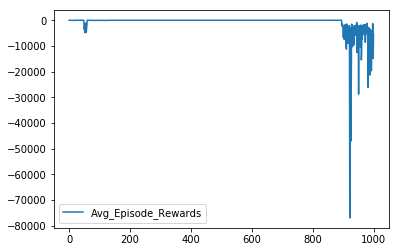

In [86]:
## TODO: Plot the rewards.
plt.plot(range(len(avg_episode_rewards)), avg_episode_rewards, label='Avg_Episode_Rewards')
plt.legend()
_ = plt.ylim()



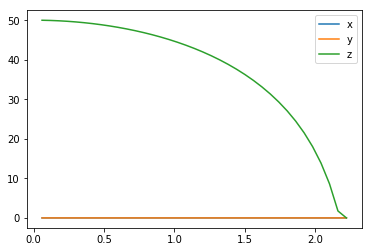

In [84]:
##Plot last-episode trajectory
plt.plot(results['time'], results['x'], label='x')
plt.plot(results['time'], results['y'], label='y')
plt.plot(results['time'], results['z'], label='z')
plt.legend()
_ = plt.ylim()

Rewards seem to decrease with training from rewards vs. episodes plot, which would suggest that the code was failing. But from plot of z, and x,y with time, the algo seems to be doing what it was designed to do. Why does the reward plot show decreasing reward with training if the code is working?

Thought: maybe the velocity-dependent part of the reward function is causing the reward to decrease. 

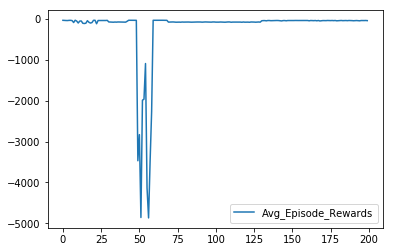

In [88]:
plt.plot(range(len(avg_episode_rewards[:200])), avg_episode_rewards[:200], label='Avg_Episode_Rewards')
plt.legend()
_ = plt.ylim()


**ATTEMPT 4**

In [101]:
"""
Changed reward function in task.py to regulate denominator for small x. Also, use best score reward. 
"""

import sys
import pandas as pd
from agents.agent import DDPG
from task import Task

num_episodes = 500
init_pose = np.array([0., 0., 50., 0., 0., 0.])
init_vel = np.array([0., 0., 0.])
init_angle_velocities = np.array([0., 0., 0.])
target_pose = np.array([0., 0., 0., 0., 0., 0.])
target_vel = np.array([0., 0., 0.])
task = Task(init_pose=init_pose, init_vel=init_vel, init_angle_velocities=init_angle_velocities, target_pose=target_pose, target_vel=target_vel)
agent = DDPG(task)
avg_episode_rewards = []
file_output = 'data2.txt'

'''
Leave things the same as before, just record simulation and action history for plotting
'''
labels = ['time', 'x', 'y', 'z', 'phi', 'theta', 'psi', 'x_velocity',
          'y_velocity', 'z_velocity', 'phi_velocity', 'theta_velocity',
          'psi_velocity', 'rotor_speed1', 'rotor_speed2', 'rotor_speed3', 'rotor_speed4']
results = {x : [] for x in labels}

'''
USED THIS REWARD FUNCTION in task.py:
reward = - .3*(abs(self.sim.pose[:3] - self.target_pose[:3])).sum() - .3*(abs(self.sim.v[:3] - self.target_vel)).sum()/(.001 + 1.*(abs(self.sim.pose[:3] - self.target_pose[:3])).sum() ) #velocity only counts when close to ground
'''

with open(file_output, 'w') as csvfile:
    writer = csv.writer(csvfile)
    writer.writerow(labels)

    for i_episode in range(1, num_episodes+1):
        print("")
        print("i_episode: " + str(i_episode))
        print("")
        print("")
        state = agent.reset_episode() # start a new episode
        time = 0
        total_episode_reward = 0
        count = 0
    

    
        while True:
            print("")
            print("time: " + str(time))
            print("sim time: " + str(task.sim.time))
        
            action = agent.act(state) 
            next_state, reward, done = task.step(action)
            print("reward: " + str(reward))
        
            if i_episode == num_episodes: #only write last episode with fully trained actor and critic networks
                to_write = [task.sim.time] + list(task.sim.pose) + list(task.sim.v) + list(task.sim.angular_v) + list(rotor_speeds)
                for ii in range(len(labels)):
                    results[labels[ii]].append(to_write[ii])
                writer.writerow(to_write)
         
            total_episode_reward += reward
            count += 1
        
            agent.step(action, reward, next_state, done)
            state = next_state
            if done:
                break
            time += 1
    
        avg_episode_rewards.append(total_episode_reward/count)
        print("avg_episode_reward: " + str(total_episode_reward/count))
        sys.stdout.flush()



i_episode: 1



time: 0
sim time: 0.0
reward: -45.0117237894

time: 1
sim time: 0.06
reward: -45.0039897808

time: 2
sim time: 0.12000000000000001
reward: -44.9574595003

time: 3
sim time: 0.18
reward: -44.971650564

time: 4
sim time: 0.23999999999999996
reward: -45.0710880828

time: 5
sim time: 0.3
reward: -45.2058659167

time: 6
sim time: 0.36000000000000004
reward: -45.2804914436

time: 7
sim time: 0.4200000000000001
reward: -45.2065584539

time: 8
sim time: 0.48000000000000015
reward: -45.0054310366

time: 9
sim time: 0.5400000000000001
reward: -44.686526402

time: 10
sim time: 0.6000000000000002
reward: -44.2922293439

time: 11
sim time: 0.6600000000000003
reward: -43.9149746468

time: 12
sim time: 0.7200000000000003
reward: -43.6141395916

time: 13
sim time: 0.7800000000000004
reward: -43.2613402665

time: 14
sim time: 0.8400000000000004
reward: -42.7755881763

time: 15
sim time: 0.9000000000000005
reward: -42.2187966235

time: 16
sim time: 0.9600000000000005
reward: -41.6123469

time: 34
sim time: 2.0400000000000014
reward: -28.1935825672

time: 35
sim time: 2.1000000000000014
reward: -27.3533733574

time: 36
sim time: 2.1600000000000015
reward: -26.4886824213

time: 37
sim time: 2.2200000000000015
reward: -25.5920112017

time: 38
sim time: 2.2800000000000016
reward: -24.6548735972

time: 39
sim time: 2.3400000000000016
reward: -23.6678139556

time: 40
sim time: 2.4000000000000017
reward: -22.7701038805

time: 41
sim time: 2.4600000000000017
reward: -21.9329819059

time: 42
sim time: 2.520000000000002
reward: -21.0777485672

time: 43
sim time: 2.580000000000002
reward: -20.194389235

time: 44
sim time: 2.640000000000002
reward: -19.2719058169

time: 45
sim time: 2.700000000000002
reward: -18.2995760024

time: 46
sim time: 2.760000000000002
reward: -17.2714156763

time: 47
sim time: 2.820000000000002
reward: -16.195500488

time: 48
sim time: 2.880000000000002
reward: -15.1206012517

time: 49
sim time: 2.940000000000002
reward: -14.2305629747

time: 50
sim time:


time: 5
sim time: 0.3
reward: -44.8624246704

time: 6
sim time: 0.36000000000000004
reward: -44.7099732836

time: 7
sim time: 0.4200000000000001
reward: -44.5217067616

time: 8
sim time: 0.48000000000000015
reward: -44.3652081414

time: 9
sim time: 0.5400000000000001
reward: -44.2346646341

time: 10
sim time: 0.6000000000000002
reward: -44.1479178729

time: 11
sim time: 0.6600000000000003
reward: -44.0683239376

time: 12
sim time: 0.7200000000000003
reward: -44.007669139

time: 13
sim time: 0.7800000000000004
reward: -43.98442449

time: 14
sim time: 0.8400000000000004
reward: -43.9363392009

time: 15
sim time: 0.9000000000000005
reward: -43.9132207149

time: 16
sim time: 0.9600000000000005
reward: -43.9395445337

time: 17
sim time: 1.0200000000000005
reward: -43.9824971984

time: 18
sim time: 1.0800000000000005
reward: -43.9806593836

time: 19
sim time: 1.1400000000000006
reward: -44.0396235699

time: 20
sim time: 1.2000000000000006
reward: -44.1402679393

time: 21
sim time: 1.2600000

avg_episode_reward: -33.7625913245

i_episode: 8



time: 0
sim time: 0.0
reward: -45.0508681318

time: 1
sim time: 0.06
reward: -45.2073166241

time: 2
sim time: 0.12000000000000001
reward: -45.3337371249

time: 3
sim time: 0.18
reward: -45.4639319622

time: 4
sim time: 0.23999999999999996
reward: -45.5611166641

time: 5
sim time: 0.3
reward: -45.4955293691

time: 6
sim time: 0.36000000000000004
reward: -45.4828098872

time: 7
sim time: 0.4200000000000001
reward: -45.5816157323

time: 8
sim time: 0.48000000000000015
reward: -45.5147249855

time: 9
sim time: 0.5400000000000001
reward: -45.3198120407

time: 10
sim time: 0.6000000000000002
reward: -45.2531384518

time: 11
sim time: 0.6600000000000003
reward: -45.2034444274

time: 12
sim time: 0.7200000000000003
reward: -44.9453044361

time: 13
sim time: 0.7800000000000004
reward: -44.6633897682

time: 14
sim time: 0.8400000000000004
reward: -44.5252940646

time: 15
sim time: 0.9000000000000005
reward: -44.2894158576

time: 16
sim time: 0


time: 20
sim time: 1.2000000000000006
reward: -42.3076454519

time: 21
sim time: 1.2600000000000007
reward: -41.9085671114

time: 22
sim time: 1.3200000000000007
reward: -41.4999037732

time: 23
sim time: 1.3800000000000008
reward: -40.8895540669

time: 24
sim time: 1.4400000000000008
reward: -40.2813456593

time: 25
sim time: 1.5000000000000009
reward: -39.803141554

time: 26
sim time: 1.560000000000001
reward: -39.2066323164

time: 27
sim time: 1.620000000000001
reward: -38.4525058238

time: 28
sim time: 1.680000000000001
reward: -37.7920701524

time: 29
sim time: 1.740000000000001
reward: -37.1895157636

time: 30
sim time: 1.8000000000000012
reward: -36.4012953064

time: 31
sim time: 1.8600000000000012
reward: -35.5502642861

time: 32
sim time: 1.9200000000000013
reward: -34.8312154242

time: 33
sim time: 1.9800000000000013
reward: -34.0649742717

time: 34
sim time: 2.0400000000000014
reward: -33.1131019737

time: 35
sim time: 2.1000000000000014
reward: -32.1996211542

time: 36
sim


time: 38
sim time: 2.2800000000000016
reward: -29.3599291253

time: 39
sim time: 2.3400000000000016
reward: -28.4049355459

time: 40
sim time: 2.4000000000000017
reward: -27.4642321218

time: 41
sim time: 2.4600000000000017
reward: -26.3349626595

time: 42
sim time: 2.520000000000002
reward: -25.1973801717

time: 43
sim time: 2.580000000000002
reward: -24.1912619934

time: 44
sim time: 2.640000000000002
reward: -23.0914959378

time: 45
sim time: 2.700000000000002
reward: -21.8314357819

time: 46
sim time: 2.760000000000002
reward: -20.6763135098

time: 47
sim time: 2.820000000000002
reward: -19.5966757882

time: 48
sim time: 2.880000000000002
reward: -18.338427243

time: 49
sim time: 2.940000000000002
reward: -17.0384914949

time: 50
sim time: 3.000000000000002
reward: -15.9297366646

time: 51
sim time: 3.0600000000000023
reward: -14.7857853101

time: 52
sim time: 3.1200000000000023
reward: -13.4639252445

time: 53
sim time: 3.1800000000000024
reward: -12.3275933802

time: 54
sim time


time: 53
sim time: 3.1800000000000024
reward: -12.3259695839

time: 54
sim time: 3.2400000000000024
reward: -11.4930615931

time: 55
sim time: 3.3000000000000025
reward: -10.6760507936

time: 56
sim time: 3.3600000000000025
reward: -9.96026968422

time: 57
sim time: 3.4200000000000026
reward: -10.0429050446

time: 58
sim time: 3.4800000000000026
reward: -10.8059379567
avg_episode_reward: -33.1214896661

i_episode: 15



time: 0
sim time: 0.0
reward: -45.0508616144

time: 1
sim time: 0.06
reward: -45.2070370639

time: 2
sim time: 0.12000000000000001
reward: -45.3328427282

time: 3
sim time: 0.18
reward: -45.4617492621

time: 4
sim time: 0.23999999999999996
reward: -45.5619485777

time: 5
sim time: 0.3
reward: -45.4979804107

time: 6
sim time: 0.36000000000000004
reward: -45.4773517781

time: 7
sim time: 0.4200000000000001
reward: -45.5747448212

time: 8
sim time: 0.48000000000000015
reward: -45.5143194909

time: 9
sim time: 0.5400000000000001
reward: -45.3169187392

time: 10
sim time: 


time: 14
sim time: 0.8400000000000004
reward: -44.5080769759

time: 15
sim time: 0.9000000000000005
reward: -44.2771412311

time: 16
sim time: 0.9600000000000005
reward: -43.8611714833

time: 17
sim time: 1.0200000000000005
reward: -43.5153664562

time: 18
sim time: 1.0800000000000005
reward: -43.2637211664

time: 19
sim time: 1.1400000000000006
reward: -42.8322224326

time: 20
sim time: 1.2000000000000006
reward: -42.2994581286

time: 21
sim time: 1.2600000000000007
reward: -41.9036201038

time: 22
sim time: 1.3200000000000007
reward: -41.494909693

time: 23
sim time: 1.3800000000000008
reward: -40.8786241621

time: 24
sim time: 1.4400000000000008
reward: -40.2735058158

time: 25
sim time: 1.5000000000000009
reward: -39.798956824

time: 26
sim time: 1.560000000000001
reward: -39.200998058

time: 27
sim time: 1.620000000000001
reward: -38.4435781434

time: 28
sim time: 1.680000000000001
reward: -37.7899771373

time: 29
sim time: 1.740000000000001
reward: -37.1888198695

time: 30
sim t

sim time: 1.8000000000000012
reward: -36.4185604783

time: 31
sim time: 1.8600000000000012
reward: -35.5722326377

time: 32
sim time: 1.9200000000000013
reward: -34.8625204945

time: 33
sim time: 1.9800000000000013
reward: -34.0932114983

time: 34
sim time: 2.0400000000000014
reward: -33.1376431423

time: 35
sim time: 2.1000000000000014
reward: -32.2370811469

time: 36
sim time: 2.1600000000000015
reward: -31.4333907784

time: 37
sim time: 2.2200000000000015
reward: -30.4776978783

time: 38
sim time: 2.2800000000000016
reward: -29.4129670245

time: 39
sim time: 2.3400000000000016
reward: -28.4705646792

time: 40
sim time: 2.4000000000000017
reward: -27.5316176945

time: 41
sim time: 2.4600000000000017
reward: -26.4042512877

time: 42
sim time: 2.520000000000002
reward: -25.2786297148

time: 43
sim time: 2.580000000000002
reward: -24.2821430611

time: 44
sim time: 2.640000000000002
reward: -23.1830695324

time: 45
sim time: 2.700000000000002
reward: -21.9335236634

time: 46
sim time: 2.


time: 46
sim time: 2.760000000000002
reward: -35.5822500963

time: 47
sim time: 2.820000000000002
reward: -35.3477995213

time: 48
sim time: 2.880000000000002
reward: -35.0724643897

time: 49
sim time: 2.940000000000002
reward: -34.7443430867

time: 50
sim time: 3.000000000000002
reward: -34.3233475684

time: 51
sim time: 3.0600000000000023
reward: -33.8403740445

time: 52
sim time: 3.1200000000000023
reward: -33.3259601903

time: 53
sim time: 3.1800000000000024
reward: -32.7457033822

time: 54
sim time: 3.2400000000000024
reward: -32.0641979076

time: 55
sim time: 3.3000000000000025
reward: -31.3752680966

time: 56
sim time: 3.3600000000000025
reward: -30.6527011747

time: 57
sim time: 3.4200000000000026
reward: -29.8310851191

time: 58
sim time: 3.4800000000000026
reward: -28.9524945883

time: 59
sim time: 3.5400000000000027
reward: -28.1379643128
avg_episode_reward: -37.3705045507

i_episode: 22



time: 0
sim time: 0.0
reward: -45.0606097457

time: 1
sim time: 0.06
reward: -45.248

reward: -89.2054351612

time: 38
sim time: 2.2800000000000016
reward: -90.3357621302

time: 39
sim time: 2.3400000000000016
reward: -91.3446448999

time: 40
sim time: 2.4000000000000017
reward: -92.215508442

time: 41
sim time: 2.4600000000000017
reward: -93.1617773166

time: 42
sim time: 2.520000000000002
reward: -94.4072734699

time: 43
sim time: 2.580000000000002
reward: -95.7965199658

time: 44
sim time: 2.640000000000002
reward: -97.3429250502

time: 45
sim time: 2.700000000000002
reward: -99.0466698385

time: 46
sim time: 2.760000000000002
reward: -100.902549495

time: 47
sim time: 2.820000000000002
reward: -102.899984851

time: 48
sim time: 2.880000000000002
reward: -105.021251987

time: 49
sim time: 2.940000000000002
reward: -107.24270549

time: 50
sim time: 3.000000000000002
reward: -109.538722791

time: 51
sim time: 3.0600000000000023
reward: -111.886314917

time: 52
sim time: 3.1200000000000023
reward: -114.268584746

time: 53
sim time: 3.1800000000000024
reward: -116.676331


time: 5
sim time: 0.3
reward: -45.2247772394

time: 6
sim time: 0.36000000000000004
reward: -45.2679756532

time: 7
sim time: 0.4200000000000001
reward: -45.3737912325

time: 8
sim time: 0.48000000000000015
reward: -45.4957893187

time: 9
sim time: 0.5400000000000001
reward: -45.5728293271

time: 10
sim time: 0.6000000000000002
reward: -45.6668946288

time: 11
sim time: 0.6600000000000003
reward: -45.6935892522

time: 12
sim time: 0.7200000000000003
reward: -45.7139344229

time: 13
sim time: 0.7800000000000004
reward: -45.7914064852

time: 14
sim time: 0.8400000000000004
reward: -45.8969962808

time: 15
sim time: 0.9000000000000005
reward: -45.9757937312

time: 16
sim time: 0.9600000000000005
reward: -45.8451705723

time: 17
sim time: 1.0200000000000005
reward: -45.6053673977

time: 18
sim time: 1.0800000000000005
reward: -45.3794158648

time: 19
sim time: 1.1400000000000006
reward: -45.4721658354

time: 20
sim time: 1.2000000000000006
reward: -45.5138651833

time: 21
sim time: 1.2600


time: 8
sim time: 0.48000000000000015
reward: -45.5153325592

time: 9
sim time: 0.5400000000000001
reward: -45.3210682023

time: 10
sim time: 0.6000000000000002
reward: -45.2342915002

time: 11
sim time: 0.6600000000000003
reward: -45.183732314

time: 12
sim time: 0.7200000000000003
reward: -44.9465719944

time: 13
sim time: 0.7800000000000004
reward: -44.6570467572

time: 14
sim time: 0.8400000000000004
reward: -44.489231037

time: 15
sim time: 0.9000000000000005
reward: -44.270312257

time: 16
sim time: 0.9600000000000005
reward: -43.8692977924

time: 17
sim time: 1.0200000000000005
reward: -43.5074093184

time: 18
sim time: 1.0800000000000005
reward: -43.2328435883

time: 19
sim time: 1.1400000000000006
reward: -42.8193182548

time: 20
sim time: 1.2000000000000006
reward: -42.2902440207

time: 21
sim time: 1.2600000000000007
reward: -41.8810198614

time: 22
sim time: 1.3200000000000007
reward: -41.4640393011

time: 23
sim time: 1.3800000000000008
reward: -40.8343302511

time: 24
si

reward: -33.170766824

time: 35
sim time: 2.1000000000000014
reward: -32.2857227474

time: 36
sim time: 2.1600000000000015
reward: -31.4917013333

time: 37
sim time: 2.2200000000000015
reward: -30.5377300017

time: 38
sim time: 2.2800000000000016
reward: -29.4879717654

time: 39
sim time: 2.3400000000000016
reward: -28.5682983513

time: 40
sim time: 2.4000000000000017
reward: -27.6411532849

time: 41
sim time: 2.4600000000000017
reward: -26.5267942547

time: 42
sim time: 2.520000000000002
reward: -25.431251664

time: 43
sim time: 2.580000000000002
reward: -24.464573853

time: 44
sim time: 2.640000000000002
reward: -23.385925462

time: 45
sim time: 2.700000000000002
reward: -22.1710867044

time: 46
sim time: 2.760000000000002
reward: -21.0773787329

time: 47
sim time: 2.820000000000002
reward: -20.0446084637

time: 48
sim time: 2.880000000000002
reward: -18.8364140019

time: 49
sim time: 2.940000000000002
reward: -17.6165554716

time: 50
sim time: 3.000000000000002
reward: -16.583710339


time: 54
sim time: 3.2400000000000024
reward: -11.6159799121

time: 55
sim time: 3.3000000000000025
reward: -10.7106833799

time: 56
sim time: 3.3600000000000025
reward: -9.97110268654

time: 57
sim time: 3.4200000000000026
reward: -10.4463650066

time: 58
sim time: 3.4800000000000026
reward: -11.1663014161
avg_episode_reward: -33.1570528378

i_episode: 32



time: 0
sim time: 0.0
reward: -45.0508277254

time: 1
sim time: 0.06
reward: -45.2062985907

time: 2
sim time: 0.12000000000000001
reward: -45.3306518139

time: 3
sim time: 0.18
reward: -45.457655032

time: 4
sim time: 0.23999999999999996
reward: -45.5564570772

time: 5
sim time: 0.3
reward: -45.4931050793

time: 6
sim time: 0.36000000000000004
reward: -45.4680058209

time: 7
sim time: 0.4200000000000001
reward: -45.5639185599

time: 8
sim time: 0.48000000000000015
reward: -45.5035274551

time: 9
sim time: 0.5400000000000001
reward: -45.3057209296

time: 10
sim time: 0.6000000000000002
reward: -45.2262307727

time: 11
sim time: 0


time: 14
sim time: 0.8400000000000004
reward: -44.5383809131

time: 15
sim time: 0.9000000000000005
reward: -44.3019345092

time: 16
sim time: 0.9600000000000005
reward: -43.8860641977

time: 17
sim time: 1.0200000000000005
reward: -43.5509749012

time: 18
sim time: 1.0800000000000005
reward: -43.3006628923

time: 19
sim time: 1.1400000000000006
reward: -42.8630074853

time: 20
sim time: 1.2000000000000006
reward: -42.3353053417

time: 21
sim time: 1.2600000000000007
reward: -41.9332041004

time: 22
sim time: 1.3200000000000007
reward: -41.5212047365

time: 23
sim time: 1.3800000000000008
reward: -41.0121712934

time: 24
sim time: 1.4400000000000008
reward: -40.367038564

time: 25
sim time: 1.5000000000000009
reward: -39.7236924838

time: 26
sim time: 1.560000000000001
reward: -39.1217149579

time: 27
sim time: 1.620000000000001
reward: -38.4758963615

time: 28
sim time: 1.680000000000001
reward: -37.7534195061

time: 29
sim time: 1.740000000000001
reward: -37.0321508316

time: 30
sim


time: 34
sim time: 2.0400000000000014
reward: -33.1219397034

time: 35
sim time: 2.1000000000000014
reward: -32.2089125814

time: 36
sim time: 2.1600000000000015
reward: -31.4014877435

time: 37
sim time: 2.2200000000000015
reward: -30.4639686485

time: 38
sim time: 2.2800000000000016
reward: -29.3960813913

time: 39
sim time: 2.3400000000000016
reward: -28.4428425306

time: 40
sim time: 2.4000000000000017
reward: -27.5175081656

time: 41
sim time: 2.4600000000000017
reward: -26.4028257857

time: 42
sim time: 2.520000000000002
reward: -25.2683735616

time: 43
sim time: 2.580000000000002
reward: -24.275582445

time: 44
sim time: 2.640000000000002
reward: -23.1967233353

time: 45
sim time: 2.700000000000002
reward: -21.9500328677

time: 46
sim time: 2.760000000000002
reward: -20.8037011083

time: 47
sim time: 2.820000000000002
reward: -19.745006802

time: 48
sim time: 2.880000000000002
reward: -18.5071991329

time: 49
sim time: 2.940000000000002
reward: -17.2185758018

time: 50
sim time


time: 49
sim time: 2.940000000000002
reward: -17.2681075254

time: 50
sim time: 3.000000000000002
reward: -16.1820660821

time: 51
sim time: 3.0600000000000023
reward: -15.0812196544

time: 52
sim time: 3.1200000000000023
reward: -13.7809803971

time: 53
sim time: 3.1800000000000024
reward: -12.6455366296

time: 54
sim time: 3.2400000000000024
reward: -11.8117573497

time: 55
sim time: 3.3000000000000025
reward: -10.8879542648

time: 56
sim time: 3.3600000000000025
reward: -10.0810771662

time: 57
sim time: 3.4200000000000026
reward: -10.347860614

time: 58
sim time: 3.4800000000000026
reward: -10.9156868348
avg_episode_reward: -33.2048579128

i_episode: 39



time: 0
sim time: 0.0
reward: -45.0508851529

time: 1
sim time: 0.06
reward: -45.2073696152

time: 2
sim time: 0.12000000000000001
reward: -45.3338748365

time: 3
sim time: 0.18
reward: -45.4639291163

time: 4
sim time: 0.23999999999999996
reward: -45.5610860494

time: 5
sim time: 0.3
reward: -45.4954093579

time: 6
sim time: 0.

reward: -45.4967317325

time: 6
sim time: 0.36000000000000004
reward: -45.4787202034

time: 7
sim time: 0.4200000000000001
reward: -45.5766196877

time: 8
sim time: 0.48000000000000015
reward: -45.5137428701

time: 9
sim time: 0.5400000000000001
reward: -45.3173257633

time: 10
sim time: 0.6000000000000002
reward: -45.2450438427

time: 11
sim time: 0.6600000000000003
reward: -45.1974200583

time: 12
sim time: 0.7200000000000003
reward: -44.9424118492

time: 13
sim time: 0.7800000000000004
reward: -44.6564891453

time: 14
sim time: 0.8400000000000004
reward: -44.5150210757

time: 15
sim time: 0.9000000000000005
reward: -44.2835768913

time: 16
sim time: 0.9600000000000005
reward: -43.8671975298

time: 17
sim time: 1.0200000000000005
reward: -43.5233082927

time: 18
sim time: 1.0800000000000005
reward: -43.271485321

time: 19
sim time: 1.1400000000000006
reward: -42.840859067

time: 20
sim time: 1.2000000000000006
reward: -42.3087685344

time: 21
sim time: 1.2600000000000007
reward: -41.


time: 22
sim time: 1.3200000000000007
reward: -41.5153721952

time: 23
sim time: 1.3800000000000008
reward: -40.9007718347

time: 24
sim time: 1.4400000000000008
reward: -40.2989652427

time: 25
sim time: 1.5000000000000009
reward: -39.8241430712

time: 26
sim time: 1.560000000000001
reward: -39.2221668716

time: 27
sim time: 1.620000000000001
reward: -38.4675250206

time: 28
sim time: 1.680000000000001
reward: -37.8155458168

time: 29
sim time: 1.740000000000001
reward: -37.2121990499

time: 30
sim time: 1.8000000000000012
reward: -36.4179642116

time: 31
sim time: 1.8600000000000012
reward: -35.5706150472

time: 32
sim time: 1.9200000000000013
reward: -34.8582345742

time: 33
sim time: 1.9800000000000013
reward: -34.087395542

time: 34
sim time: 2.0400000000000014
reward: -33.1326454305

time: 35
sim time: 2.1000000000000014
reward: -32.2254566696

time: 36
sim time: 2.1600000000000015
reward: -31.4163735747

time: 37
sim time: 2.2200000000000015
reward: -30.4675833713

time: 38
sim


time: 38
sim time: 2.2800000000000016
reward: -29.5032682641

time: 39
sim time: 2.3400000000000016
reward: -28.5806319082

time: 40
sim time: 2.4000000000000017
reward: -27.6536005098

time: 41
sim time: 2.4600000000000017
reward: -26.5392022901

time: 42
sim time: 2.520000000000002
reward: -25.436746626

time: 43
sim time: 2.580000000000002
reward: -24.4614531714

time: 44
sim time: 2.640000000000002
reward: -23.3780572197

time: 45
sim time: 2.700000000000002
reward: -22.1522530834

time: 46
sim time: 2.760000000000002
reward: -21.037808113

time: 47
sim time: 2.820000000000002
reward: -19.9840416575

time: 48
sim time: 2.880000000000002
reward: -18.7541119758

time: 49
sim time: 2.940000000000002
reward: -17.4995174595

time: 50
sim time: 3.000000000000002
reward: -16.423728446

time: 51
sim time: 3.0600000000000023
reward: -15.2999563424

time: 52
sim time: 3.1200000000000023
reward: -14.0125734558

time: 53
sim time: 3.1800000000000024
reward: -12.9015350059

time: 54
sim time: 

reward: -10.719804331
avg_episode_reward: -33.6757512772

i_episode: 48



time: 0
sim time: 0.0
reward: -45.0509155703

time: 1
sim time: 0.06
reward: -45.2073820615

time: 2
sim time: 0.12000000000000001
reward: -45.3338504002

time: 3
sim time: 0.18
reward: -45.463590229

time: 4
sim time: 0.23999999999999996
reward: -45.5637345396

time: 5
sim time: 0.3
reward: -45.4991447361

time: 6
sim time: 0.36000000000000004
reward: -45.4820169997

time: 7
sim time: 0.4200000000000001
reward: -45.5803039967

time: 8
sim time: 0.48000000000000015
reward: -45.5179773215

time: 9
sim time: 0.5400000000000001
reward: -45.3212178959

time: 10
sim time: 0.6000000000000002
reward: -45.2496472739

time: 11
sim time: 0.6600000000000003
reward: -45.2025281901

time: 12
sim time: 0.7200000000000003
reward: -44.9476545741

time: 13
sim time: 0.7800000000000004
reward: -44.6619035156

time: 14
sim time: 0.8400000000000004
reward: -44.5205689481

time: 15
sim time: 0.9000000000000005
reward: -44.2900907468


time: 19
sim time: 1.1400000000000006
reward: -42.8506802666

time: 20
sim time: 1.2000000000000006
reward: -42.3228459272

time: 21
sim time: 1.2600000000000007
reward: -41.9372655602

time: 22
sim time: 1.3200000000000007
reward: -41.5234775043

time: 23
sim time: 1.3800000000000008
reward: -40.9008431028

time: 24
sim time: 1.4400000000000008
reward: -40.309606817

time: 25
sim time: 1.5000000000000009
reward: -39.8414029192

time: 26
sim time: 1.560000000000001
reward: -39.234537363

time: 27
sim time: 1.620000000000001
reward: -38.4779718972

time: 28
sim time: 1.680000000000001
reward: -37.8450920919

time: 29
sim time: 1.740000000000001
reward: -37.2435962721

time: 30
sim time: 1.8000000000000012
reward: -36.4436724434

time: 31
sim time: 1.8600000000000012
reward: -35.6135509435

time: 32
sim time: 1.9200000000000013
reward: -34.922369284

time: 33
sim time: 1.9800000000000013
reward: -34.1477088953

time: 34
sim time: 2.0400000000000014
reward: -33.1996434029

time: 35
sim t

sim time: 2.3400000000000016
reward: -28.4207077395

time: 40
sim time: 2.4000000000000017
reward: -27.5090913874

time: 41
sim time: 2.4600000000000017
reward: -26.412027753

time: 42
sim time: 2.520000000000002
reward: -25.2768734423

time: 43
sim time: 2.580000000000002
reward: -24.2940724537

time: 44
sim time: 2.640000000000002
reward: -23.2542150064

time: 45
sim time: 2.700000000000002
reward: -22.0321360209

time: 46
sim time: 2.760000000000002
reward: -20.8903316968

time: 47
sim time: 2.820000000000002
reward: -19.8861534748

time: 48
sim time: 2.880000000000002
reward: -18.7210258212

time: 49
sim time: 2.940000000000002
reward: -17.4622037238

time: 50
sim time: 3.000000000000002
reward: -16.405466654

time: 51
sim time: 3.0600000000000023
reward: -15.4019923968

time: 52
sim time: 3.1200000000000023
reward: -14.1826796411

time: 53
sim time: 3.1800000000000024
reward: -13.0532555088

time: 54
sim time: 3.2400000000000024
reward: -12.2670996002

time: 55
sim time: 3.3000000


time: 55
sim time: 3.3000000000000025
reward: -10.8556668695

time: 56
sim time: 3.3600000000000025
reward: -10.0569179241

time: 57
sim time: 3.4200000000000026
reward: -10.3552146515

time: 58
sim time: 3.4800000000000026
reward: -10.9275104363
avg_episode_reward: -33.2112432758

i_episode: 55



time: 0
sim time: 0.0
reward: -45.0508587324

time: 1
sim time: 0.06
reward: -45.207200656

time: 2
sim time: 0.12000000000000001
reward: -45.3332617113

time: 3
sim time: 0.18
reward: -45.4626955363

time: 4
sim time: 0.23999999999999996
reward: -45.5602464669

time: 5
sim time: 0.3
reward: -45.4951268077

time: 6
sim time: 0.36000000000000004
reward: -45.4795071651

time: 7
sim time: 0.4200000000000001
reward: -45.5776519413

time: 8
sim time: 0.48000000000000015
reward: -45.512609445

time: 9
sim time: 0.5400000000000001
reward: -45.3168516403

time: 10
sim time: 0.6000000000000002
reward: -45.2468721757

time: 11
sim time: 0.6600000000000003
reward: -45.1981614779

time: 12
sim time: 0.


time: 12
sim time: 0.7200000000000003
reward: -44.9488253982

time: 13
sim time: 0.7800000000000004
reward: -44.6693806705

time: 14
sim time: 0.8400000000000004
reward: -44.5330442252

time: 15
sim time: 0.9000000000000005
reward: -44.2957061666

time: 16
sim time: 0.9600000000000005
reward: -43.8785665811

time: 17
sim time: 1.0200000000000005
reward: -43.5435418501

time: 18
sim time: 1.0800000000000005
reward: -43.2911334449

time: 19
sim time: 1.1400000000000006
reward: -42.8563794663

time: 20
sim time: 1.2000000000000006
reward: -42.3291715126

time: 21
sim time: 1.2600000000000007
reward: -41.9379698045

time: 22
sim time: 1.3200000000000007
reward: -41.5248280095

time: 23
sim time: 1.3800000000000008
reward: -40.9106494936

time: 24
sim time: 1.4400000000000008
reward: -40.3104150849

time: 25
sim time: 1.5000000000000009
reward: -39.8357015888

time: 26
sim time: 1.560000000000001
reward: -39.2319852738

time: 27
sim time: 1.620000000000001
reward: -38.4778853781

time: 28


sim time: 1.740000000000001
reward: -37.195035441

time: 30
sim time: 1.8000000000000012
reward: -36.4009395575

time: 31
sim time: 1.8600000000000012
reward: -35.5550570194

time: 32
sim time: 1.9200000000000013
reward: -34.8464414706

time: 33
sim time: 1.9800000000000013
reward: -34.077208392

time: 34
sim time: 2.0400000000000014
reward: -33.1216078991

time: 35
sim time: 2.1000000000000014
reward: -32.2240162614

time: 36
sim time: 2.1600000000000015
reward: -31.422511047

time: 37
sim time: 2.2200000000000015
reward: -30.4665275536

time: 38
sim time: 2.2800000000000016
reward: -29.4057206619

time: 39
sim time: 2.3400000000000016
reward: -28.4688409333

time: 40
sim time: 2.4000000000000017
reward: -27.5328367412

time: 41
sim time: 2.4600000000000017
reward: -26.408767979

time: 42
sim time: 2.520000000000002
reward: -25.2909677013

time: 43
sim time: 2.580000000000002
reward: -24.3021244212

time: 44
sim time: 2.640000000000002
reward: -23.2082182756

time: 45
sim time: 2.7000


time: 47
sim time: 2.820000000000002
reward: -19.701243347

time: 48
sim time: 2.880000000000002
reward: -18.4593323727

time: 49
sim time: 2.940000000000002
reward: -17.1867189167

time: 50
sim time: 3.000000000000002
reward: -16.0977301043

time: 51
sim time: 3.0600000000000023
reward: -14.9744578851

time: 52
sim time: 3.1200000000000023
reward: -13.69096611

time: 53
sim time: 3.1800000000000024
reward: -12.5831330613

time: 54
sim time: 3.2400000000000024
reward: -11.7418715861

time: 55
sim time: 3.3000000000000025
reward: -10.8507666997

time: 56
sim time: 3.3600000000000025
reward: -10.1874763989

time: 57
sim time: 3.4200000000000026
reward: -10.6065863511
avg_episode_reward: -33.5619456013

i_episode: 62



time: 0
sim time: 0.0
reward: -45.0508992328

time: 1
sim time: 0.06
reward: -45.2072175988

time: 2
sim time: 0.12000000000000001
reward: -45.3334073028

time: 3
sim time: 0.18
reward: -45.4628749502

time: 4
sim time: 0.23999999999999996
reward: -45.5623400257

time: 5



time: 3
sim time: 0.18
reward: -45.463931662

time: 4
sim time: 0.23999999999999996
reward: -45.5606505049

time: 5
sim time: 0.3
reward: -45.4948546589

time: 6
sim time: 0.36000000000000004
reward: -45.4828918746

time: 7
sim time: 0.4200000000000001
reward: -45.5815615546

time: 8
sim time: 0.48000000000000015
reward: -45.5139833245

time: 9
sim time: 0.5400000000000001
reward: -45.3194886211

time: 10
sim time: 0.6000000000000002
reward: -45.253258151

time: 11
sim time: 0.6600000000000003
reward: -45.2027638642

time: 12
sim time: 0.7200000000000003
reward: -44.9442688997

time: 13
sim time: 0.7800000000000004
reward: -44.6633682211

time: 14
sim time: 0.8400000000000004
reward: -44.5256322234

time: 15
sim time: 0.9000000000000005
reward: -44.2886561335

time: 16
sim time: 0.9600000000000005
reward: -43.8721977988

time: 17
sim time: 1.0200000000000005
reward: -43.5358095505

time: 18
sim time: 1.0800000000000005
reward: -43.2829710245

time: 19
sim time: 1.1400000000000006
rewa


time: 20
sim time: 1.2000000000000006
reward: -42.3168880765

time: 21
sim time: 1.2600000000000007
reward: -41.9239563616

time: 22
sim time: 1.3200000000000007
reward: -41.5149182331

time: 23
sim time: 1.3800000000000008
reward: -40.8972931363

time: 24
sim time: 1.4400000000000008
reward: -40.2967159998

time: 25
sim time: 1.5000000000000009
reward: -39.8256004073

time: 26
sim time: 1.560000000000001
reward: -39.2263032724

time: 27
sim time: 1.620000000000001
reward: -38.4678516185

time: 28
sim time: 1.680000000000001
reward: -37.8252891665

time: 29
sim time: 1.740000000000001
reward: -37.2263693505

time: 30
sim time: 1.8000000000000012
reward: -36.4327218623

time: 31
sim time: 1.8600000000000012
reward: -35.5946355712

time: 32
sim time: 1.9200000000000013
reward: -34.8970375228

time: 33
sim time: 1.9800000000000013
reward: -34.1295791426

time: 34
sim time: 2.0400000000000014
reward: -33.1812426621

time: 35
sim time: 2.1000000000000014
reward: -32.3012624094

time: 36
si


time: 38
sim time: 2.2800000000000016
reward: -29.432374228

time: 39
sim time: 2.3400000000000016
reward: -28.4939975246

time: 40
sim time: 2.4000000000000017
reward: -27.5465467481

time: 41
sim time: 2.4600000000000017
reward: -26.4098603249

time: 42
sim time: 2.520000000000002
reward: -25.2869390327

time: 43
sim time: 2.580000000000002
reward: -24.2885756737

time: 44
sim time: 2.640000000000002
reward: -23.1746689401

time: 45
sim time: 2.700000000000002
reward: -21.9196749821

time: 46
sim time: 2.760000000000002
reward: -20.7810153632

time: 47
sim time: 2.820000000000002
reward: -19.6943715201

time: 48
sim time: 2.880000000000002
reward: -18.4236153701

time: 49
sim time: 2.940000000000002
reward: -17.1388455511

time: 50
sim time: 3.000000000000002
reward: -16.0382389411

time: 51
sim time: 3.0600000000000023
reward: -14.87467091

time: 52
sim time: 3.1200000000000023
reward: -13.5501041711

time: 53
sim time: 3.1800000000000024
reward: -12.4306061962

time: 54
sim time: 


time: 54
sim time: 3.2400000000000024
reward: -11.5263111893

time: 55
sim time: 3.3000000000000025
reward: -10.6258435015

time: 56
sim time: 3.3600000000000025
reward: -9.92664022301

time: 57
sim time: 3.4200000000000026
reward: -10.5177253823

time: 58
sim time: 3.4800000000000026
reward: -11.3513040734
avg_episode_reward: -33.1395200528

i_episode: 71



time: 0
sim time: 0.0
reward: -45.0508876766

time: 1
sim time: 0.06
reward: -45.2074293474

time: 2
sim time: 0.12000000000000001
reward: -45.3338948753

time: 3
sim time: 0.18
reward: -45.4640762051

time: 4
sim time: 0.23999999999999996
reward: -45.5620515738

time: 5
sim time: 0.3
reward: -45.496818779

time: 6
sim time: 0.36000000000000004
reward: -45.4821046262

time: 7
sim time: 0.4200000000000001
reward: -45.5805339857

time: 8
sim time: 0.48000000000000015
reward: -45.5150658319

time: 9
sim time: 0.5400000000000001
reward: -45.3194111072

time: 10
sim time: 0.6000000000000002
reward: -45.2501460157

time: 11
sim time: 0

reward: -44.6624345002

time: 14
sim time: 0.8400000000000004
reward: -44.5229345208

time: 15
sim time: 0.9000000000000005
reward: -44.2895953984

time: 16
sim time: 0.9600000000000005
reward: -43.8726220376

time: 17
sim time: 1.0200000000000005
reward: -43.5331454709

time: 18
sim time: 1.0800000000000005
reward: -43.2813432233

time: 19
sim time: 1.1400000000000006
reward: -42.8484642292

time: 20
sim time: 1.2000000000000006
reward: -42.3180837439

time: 21
sim time: 1.2600000000000007
reward: -41.9242296472

time: 22
sim time: 1.3200000000000007
reward: -41.5135554429

time: 23
sim time: 1.3800000000000008
reward: -40.8992009959

time: 24
sim time: 1.4400000000000008
reward: -40.2953030259

time: 25
sim time: 1.5000000000000009
reward: -39.819169173

time: 26
sim time: 1.560000000000001
reward: -39.2194929095

time: 27
sim time: 1.620000000000001
reward: -38.4645771524

time: 28
sim time: 1.680000000000001
reward: -37.8091052303

time: 29
sim time: 1.740000000000001
reward: -37.2


time: 31
sim time: 1.8600000000000012
reward: -35.7301117615

time: 32
sim time: 1.9200000000000013
reward: -35.105835156

time: 33
sim time: 1.9800000000000013
reward: -34.456169477

time: 34
sim time: 2.0400000000000014
reward: -33.7020231981

time: 35
sim time: 2.1000000000000014
reward: -32.89869488

time: 36
sim time: 2.1600000000000015
reward: -32.1186072044

time: 37
sim time: 2.2200000000000015
reward: -31.2728257269

time: 38
sim time: 2.2800000000000016
reward: -30.3595785178

time: 39
sim time: 2.3400000000000016
reward: -29.5263981045

time: 40
sim time: 2.4000000000000017
reward: -28.7148771716

time: 41
sim time: 2.4600000000000017
reward: -27.8359615073

time: 42
sim time: 2.520000000000002
reward: -26.8892906558

time: 43
sim time: 2.580000000000002
reward: -26.0328398718

time: 44
sim time: 2.640000000000002
reward: -25.0921012751

time: 45
sim time: 2.700000000000002
reward: -24.0264954496

time: 46
sim time: 2.760000000000002
reward: -22.9714922234

time: 47
sim tim

time: 40
sim time: 2.4000000000000017
reward: -24.6477994627

time: 41
sim time: 2.4600000000000017
reward: -23.5655793403

time: 42
sim time: 2.520000000000002
reward: -22.4664413269

time: 43
sim time: 2.580000000000002
reward: -21.3014336944

time: 44
sim time: 2.640000000000002
reward: -20.1266834451

time: 45
sim time: 2.700000000000002
reward: -18.9867068722

time: 46
sim time: 2.760000000000002
reward: -17.8154308559

time: 47
sim time: 2.820000000000002
reward: -16.5827302293

time: 48
sim time: 2.880000000000002
reward: -15.3938170084

time: 49
sim time: 2.940000000000002
reward: -14.2829297871

time: 50
sim time: 3.000000000000002
reward: -13.1555639845

time: 51
sim time: 3.0600000000000023
reward: -12.0185491032

time: 52
sim time: 3.1200000000000023
reward: -11.0926842401

time: 53
sim time: 3.1800000000000024
reward: -10.517376142

time: 54
sim time: 3.2400000000000024
reward: -10.3305792792

time: 55
sim time: 3.3000000000000025
reward: -10.3469832199
avg_episode_reward:


time: 5
sim time: 0.3
reward: -45.8347763205

time: 6
sim time: 0.36000000000000004
reward: -46.1307307348

time: 7
sim time: 0.4200000000000001
reward: -46.468420416

time: 8
sim time: 0.48000000000000015
reward: -46.8462799932

time: 9
sim time: 0.5400000000000001
reward: -47.2625648363

time: 10
sim time: 0.6000000000000002
reward: -47.7153438709

time: 11
sim time: 0.6600000000000003
reward: -48.2010662853

time: 12
sim time: 0.7200000000000003
reward: -48.7009401384

time: 13
sim time: 0.7800000000000004
reward: -49.2025510103

time: 14
sim time: 0.8400000000000004
reward: -49.6660195021

time: 15
sim time: 0.9000000000000005
reward: -50.1327370364

time: 16
sim time: 0.9600000000000005
reward: -50.6067887755

time: 17
sim time: 1.0200000000000005
reward: -51.04762244

time: 18
sim time: 1.0800000000000005
reward: -51.4208293173

time: 19
sim time: 1.1400000000000006
reward: -51.7678214373

time: 20
sim time: 1.2000000000000006
reward: -52.121415046

time: 21
sim time: 1.26000000


time: 2
sim time: 0.12000000000000001
reward: -45.0279434675

time: 3
sim time: 0.18
reward: -45.0346799528

time: 4
sim time: 0.23999999999999996
reward: -45.0242283328

time: 5
sim time: 0.3
reward: -45.0030605342

time: 6
sim time: 0.36000000000000004
reward: -44.9572376516

time: 7
sim time: 0.4200000000000001
reward: -44.8642342819

time: 8
sim time: 0.48000000000000015
reward: -44.7379828711

time: 9
sim time: 0.5400000000000001
reward: -44.5957716249

time: 10
sim time: 0.6000000000000002
reward: -44.4181334603

time: 11
sim time: 0.6600000000000003
reward: -44.1947633157

time: 12
sim time: 0.7200000000000003
reward: -43.9488812474

time: 13
sim time: 0.7800000000000004
reward: -43.6823958043

time: 14
sim time: 0.8400000000000004
reward: -43.3713693221

time: 15
sim time: 0.9000000000000005
reward: -43.0232555086

time: 16
sim time: 0.9600000000000005
reward: -42.6592287136

time: 17
sim time: 1.0200000000000005
reward: -42.2635485356

time: 18
sim time: 1.0800000000000005
re

reward: -37.908513272

time: 26
sim time: 1.560000000000001
reward: -37.2241258173

time: 27
sim time: 1.620000000000001
reward: -36.5270011902

time: 28
sim time: 1.680000000000001
reward: -35.7861443235

time: 29
sim time: 1.740000000000001
reward: -35.0014604647

time: 30
sim time: 1.8000000000000012
reward: -34.2075664284

time: 31
sim time: 1.8600000000000012
reward: -33.3916825921

time: 32
sim time: 1.9200000000000013
reward: -32.521444706

time: 33
sim time: 1.9800000000000013
reward: -31.6241254798

time: 34
sim time: 2.0400000000000014
reward: -30.7249906858

time: 35
sim time: 2.1000000000000014
reward: -29.785962093

time: 36
sim time: 2.1600000000000015
reward: -28.7931123398

time: 37
sim time: 2.2200000000000015
reward: -27.7963725154

time: 38
sim time: 2.2800000000000016
reward: -26.794793124

time: 39
sim time: 2.3400000000000016
reward: -25.7354833147

time: 40
sim time: 2.4000000000000017
reward: -24.6363199222

time: 41
sim time: 2.4600000000000017
reward: -23.5538

reward: -17.5102364007

time: 48
sim time: 2.880000000000002
reward: -16.5184804516

time: 49
sim time: 2.940000000000002
reward: -15.555687115

time: 50
sim time: 3.000000000000002
reward: -14.6467778502

time: 51
sim time: 3.0600000000000023
reward: -13.6438913493

time: 52
sim time: 3.1200000000000023
reward: -12.6954393966

time: 53
sim time: 3.1800000000000024
reward: -11.870973476

time: 54
sim time: 3.2400000000000024
reward: -11.1715700637

time: 55
sim time: 3.3000000000000025
reward: -10.7291437171
avg_episode_reward: -32.8066212052

i_episode: 87



time: 0
sim time: 0.0
reward: -45.033515916

time: 1
sim time: 0.06
reward: -45.1297566562

time: 2
sim time: 0.12000000000000001
reward: -45.1875435834

time: 3
sim time: 0.18
reward: -45.2300311881

time: 4
sim time: 0.23999999999999996
reward: -45.2517940077

time: 5
sim time: 0.3
reward: -45.2254004987

time: 6
sim time: 0.36000000000000004
reward: -45.2730577505

time: 7
sim time: 0.4200000000000001
reward: -45.3791534188

t

sim time: 0.3
reward: -45.0006548146

time: 6
sim time: 0.36000000000000004
reward: -44.9538508684

time: 7
sim time: 0.4200000000000001
reward: -44.8599194541

time: 8
sim time: 0.48000000000000015
reward: -44.7325240367

time: 9
sim time: 0.5400000000000001
reward: -44.5891697002

time: 10
sim time: 0.6000000000000002
reward: -44.410565261

time: 11
sim time: 0.6600000000000003
reward: -44.1861569263

time: 12
sim time: 0.7200000000000003
reward: -43.9391046863

time: 13
sim time: 0.7800000000000004
reward: -43.6715563556

time: 14
sim time: 0.8400000000000004
reward: -43.3595488889

time: 15
sim time: 0.9000000000000005
reward: -43.0103562729

time: 16
sim time: 0.9600000000000005
reward: -42.645236829

time: 17
sim time: 1.0200000000000005
reward: -42.2485678499

time: 18
sim time: 1.0800000000000005
reward: -41.8051624506

time: 19
sim time: 1.1400000000000006
reward: -41.3374054117

time: 20
sim time: 1.2000000000000006
reward: -40.8518561406

time: 21
sim time: 1.260000000000000

reward: -35.7703550045

time: 29
sim time: 1.740000000000001
reward: -34.9850550899

time: 30
sim time: 1.8000000000000012
reward: -34.1905845081

time: 31
sim time: 1.8600000000000012
reward: -33.374026834

time: 32
sim time: 1.9200000000000013
reward: -32.5031048414

time: 33
sim time: 1.9800000000000013
reward: -31.6052273162

time: 34
sim time: 2.0400000000000014
reward: -30.7054895502

time: 35
sim time: 2.1000000000000014
reward: -29.7656959239

time: 36
sim time: 2.1600000000000015
reward: -28.7722144363

time: 37
sim time: 2.2200000000000015
reward: -27.7750424538

time: 38
sim time: 2.2800000000000016
reward: -26.7728149878

time: 39
sim time: 2.3400000000000016
reward: -25.712708739

time: 40
sim time: 2.4000000000000017
reward: -24.6131072569

time: 41
sim time: 2.4600000000000017
reward: -23.5302691652

time: 42
sim time: 2.520000000000002
reward: -22.4301191564

time: 43
sim time: 2.580000000000002
reward: -21.2641205256

time: 44
sim time: 2.640000000000002
reward: -20.08


time: 38
sim time: 2.2800000000000016
reward: -70.6263078355

time: 39
sim time: 2.3400000000000016
reward: -71.7086090208

time: 40
sim time: 2.4000000000000017
reward: -72.8059585054

time: 41
sim time: 2.4600000000000017
reward: -73.9182126122

time: 42
sim time: 2.520000000000002
reward: -75.0452841396

time: 43
sim time: 2.580000000000002
reward: -76.1870982176

time: 44
sim time: 2.640000000000002
reward: -77.3436176302

time: 45
sim time: 2.700000000000002
reward: -78.5147987368

time: 46
sim time: 2.760000000000002
reward: -79.6805346712

time: 47
sim time: 2.820000000000002
reward: -80.8048017162

time: 48
sim time: 2.880000000000002
reward: -81.8973788454

time: 49
sim time: 2.940000000000002
reward: -82.9802575147

time: 50
sim time: 3.000000000000002
reward: -84.0731641929

time: 51
sim time: 3.0600000000000023
reward: -85.1448521877

time: 52
sim time: 3.1200000000000023
reward: -86.1615729275

time: 53
sim time: 3.1800000000000024
reward: -87.1336354348

time: 54
sim tim

reward: -45.5520651082

time: 5
sim time: 0.3
reward: -45.7477309241

time: 6
sim time: 0.36000000000000004
reward: -45.9146243162

time: 7
sim time: 0.4200000000000001
reward: -46.0918722923

time: 8
sim time: 0.48000000000000015
reward: -46.2040381787

time: 9
sim time: 0.5400000000000001
reward: -46.2635915908

time: 10
sim time: 0.6000000000000002
reward: -46.3322677638

time: 11
sim time: 0.6600000000000003
reward: -46.5005295637

time: 12
sim time: 0.7200000000000003
reward: -46.6194716049

time: 13
sim time: 0.7800000000000004
reward: -46.6570349748

time: 14
sim time: 0.8400000000000004
reward: -46.6483997418

time: 15
sim time: 0.9000000000000005
reward: -46.5517441276

time: 16
sim time: 0.9600000000000005
reward: -46.3441881808

time: 17
sim time: 1.0200000000000005
reward: -46.0039568398

time: 18
sim time: 1.0800000000000005
reward: -45.5313266543

time: 19
sim time: 1.1400000000000006
reward: -44.9496956422

time: 20
sim time: 1.2000000000000006
reward: -44.247114325

tim


time: 75
sim time: 4.499999999999992
reward: -69.8330756857

time: 76
sim time: 4.559999999999991
reward: -69.2606077155

time: 77
sim time: 4.6199999999999894
reward: -68.6614616186

time: 78
sim time: 4.679999999999988
reward: -68.0519978891

time: 79
sim time: 4.739999999999987
reward: -67.3980810327

time: 80
sim time: 4.799999999999986
reward: -66.697240672

time: 81
sim time: 4.859999999999984
reward: -65.9854242902

time: 82
sim time: 4.919999999999983
reward: -65.2504363455

time: 83
sim time: 4.979999999999982
reward: -64.4603596766
avg_episode_reward: -63.805996732

i_episode: 97



time: 0
sim time: 0.0
reward: -45.006848382

time: 1
sim time: 0.06
reward: -45.0276446042

time: 2
sim time: 0.12000000000000001
reward: -45.0291150227

time: 3
sim time: 0.18
reward: -45.0357128946

time: 4
sim time: 0.23999999999999996
reward: -45.0229587074

time: 5
sim time: 0.3
reward: -44.9990346076

time: 6
sim time: 0.36000000000000004
reward: -44.951142636

time: 7
sim time: 0.420000000

reward: -43.0231359455

time: 16
sim time: 0.9600000000000005
reward: -42.6590077303

time: 17
sim time: 1.0200000000000005
reward: -42.2633584026

time: 18
sim time: 1.0800000000000005
reward: -41.82094653

time: 19
sim time: 1.1400000000000006
reward: -41.354120015

time: 20
sim time: 1.2000000000000006
reward: -40.8695462755

time: 21
sim time: 1.2600000000000007
reward: -40.3415354381

time: 22
sim time: 1.3200000000000007
reward: -39.7741601236

time: 23
sim time: 1.3800000000000008
reward: -39.1924783453

time: 24
sim time: 1.4400000000000008
reward: -38.5821198475

time: 25
sim time: 1.5000000000000009
reward: -37.9227378981

time: 26
sim time: 1.560000000000001
reward: -37.2390127776

time: 27
sim time: 1.620000000000001
reward: -36.5424525551

time: 28
sim time: 1.680000000000001
reward: -35.8020333192

time: 29
sim time: 1.740000000000001
reward: -35.0179836538

time: 30
sim time: 1.8000000000000012
reward: -34.2247956042

time: 31
sim time: 1.8600000000000012
reward: -33.409


time: 11
sim time: 0.6600000000000003
reward: -44.1863411921

time: 12
sim time: 0.7200000000000003
reward: -43.9389337173

time: 13
sim time: 0.7800000000000004
reward: -43.6712541102

time: 14
sim time: 0.8400000000000004
reward: -43.3592590024

time: 15
sim time: 0.9000000000000005
reward: -43.0098020335

time: 16
sim time: 0.9600000000000005
reward: -42.6443793194

time: 17
sim time: 1.0200000000000005
reward: -42.2476983115

time: 18
sim time: 1.0800000000000005
reward: -41.8041725933

time: 19
sim time: 1.1400000000000006
reward: -41.3360208961

time: 20
sim time: 1.2000000000000006
reward: -40.8503199989

time: 21
sim time: 1.2600000000000007
reward: -40.321339497

time: 22
sim time: 1.3200000000000007
reward: -39.7527461267

time: 23
sim time: 1.3800000000000008
reward: -39.1698007361

time: 24
sim time: 1.4400000000000008
reward: -38.5584649452

time: 25
sim time: 1.5000000000000009
reward: -37.8980689802

time: 26
sim time: 1.560000000000001
reward: -37.2130929877

time: 27



time: 33
sim time: 1.9800000000000013
reward: -64.8065472315

time: 34
sim time: 2.0400000000000014
reward: -65.6785783324

time: 35
sim time: 2.1000000000000014
reward: -66.5504239864

time: 36
sim time: 2.1600000000000015
reward: -67.4506731048

time: 37
sim time: 2.2200000000000015
reward: -68.375896658

time: 38
sim time: 2.2800000000000016
reward: -69.3408544023

time: 39
sim time: 2.3400000000000016
reward: -70.3527152964

time: 40
sim time: 2.4000000000000017
reward: -71.4073190525

time: 41
sim time: 2.4600000000000017
reward: -72.4831336078

time: 42
sim time: 2.520000000000002
reward: -73.5468559147

time: 43
sim time: 2.580000000000002
reward: -74.5644997176

time: 44
sim time: 2.640000000000002
reward: -75.5082065789

time: 45
sim time: 2.700000000000002
reward: -76.3569536311

time: 46
sim time: 2.760000000000002
reward: -77.0948754172

time: 47
sim time: 2.820000000000002
reward: -77.7100547268

time: 48
sim time: 2.880000000000002
reward: -78.1906811659

time: 49
sim ti


time: 26
sim time: 1.560000000000001
reward: -48.2422709491

time: 27
sim time: 1.620000000000001
reward: -48.2628184937

time: 28
sim time: 1.680000000000001
reward: -48.2226586499

time: 29
sim time: 1.740000000000001
reward: -48.1519466494

time: 30
sim time: 1.8000000000000012
reward: -48.0672955729

time: 31
sim time: 1.8600000000000012
reward: -47.945061976

time: 32
sim time: 1.9200000000000013
reward: -47.7761747766

time: 33
sim time: 1.9800000000000013
reward: -47.5867120674

time: 34
sim time: 2.0400000000000014
reward: -47.3768027384

time: 35
sim time: 2.1000000000000014
reward: -47.1203706352

time: 36
sim time: 2.1600000000000015
reward: -46.826957932

time: 37
sim time: 2.2200000000000015
reward: -46.5191906611

time: 38
sim time: 2.2800000000000016
reward: -46.1790380361

time: 39
sim time: 2.3400000000000016
reward: -45.7907005805

time: 40
sim time: 2.4000000000000017
reward: -45.3787332234

time: 41
sim time: 2.4600000000000017
reward: -44.9496896431

time: 42
sim 

reward: -45.9513669882

time: 82
sim time: 4.919999999999983
reward: -44.8563679704

time: 83
sim time: 4.979999999999982
reward: -43.7376027612
avg_episode_reward: -56.2538392068

i_episode: 107



time: 0
sim time: 0.0
reward: -45.0226680129

time: 1
sim time: 0.06
reward: -45.0932157619

time: 2
sim time: 0.12000000000000001
reward: -45.2104972708

time: 3
sim time: 0.18
reward: -45.3740319655

time: 4
sim time: 0.23999999999999996
reward: -45.5831741655

time: 5
sim time: 0.3
reward: -45.8371487935

time: 6
sim time: 0.36000000000000004
reward: -46.135047387

time: 7
sim time: 0.4200000000000001
reward: -46.4758378604

time: 8
sim time: 0.48000000000000015
reward: -46.8583890841

time: 9
sim time: 0.5400000000000001
reward: -47.2814812894

time: 10
sim time: 0.6000000000000002
reward: -47.7438543145

time: 11
sim time: 0.6600000000000003
reward: -48.2442334021

time: 12
sim time: 0.7200000000000003
reward: -48.7813225309

time: 13
sim time: 0.7800000000000004
reward: -49.3537979326

reward: -23.764764813

time: 48
sim time: 2.880000000000002
reward: -22.6301339701

time: 49
sim time: 2.940000000000002
reward: -21.4931183535

time: 50
sim time: 3.000000000000002
reward: -20.2920909405

time: 51
sim time: 3.0600000000000023
reward: -19.0666980676

time: 52
sim time: 3.1200000000000023
reward: -17.8844795978

time: 53
sim time: 3.1800000000000024
reward: -16.6955515812

time: 54
sim time: 3.2400000000000024
reward: -15.4455271169

time: 55
sim time: 3.3000000000000025
reward: -14.2293118791

time: 56
sim time: 3.3600000000000025
reward: -13.1264388862

time: 57
sim time: 3.4200000000000026
reward: -12.0654777697

time: 58
sim time: 3.4800000000000026
reward: -11.0164711588

time: 59
sim time: 3.5400000000000027
reward: -10.2647743708

time: 60
sim time: 3.6000000000000028
reward: -10.226312317

time: 61
sim time: 3.660000000000003
reward: -11.5833872102

time: 62
sim time: 3.720000000000003
reward: -12.7619204138
avg_episode_reward: -33.9102680857

i_episode: 109





reward: -55.4051007071

time: 38
sim time: 2.2800000000000016
reward: -55.3116260232

time: 39
sim time: 2.3400000000000016
reward: -55.1325339061

time: 40
sim time: 2.4000000000000017
reward: -54.9419670416

time: 41
sim time: 2.4600000000000017
reward: -54.7664825371

time: 42
sim time: 2.520000000000002
reward: -54.5247027337

time: 43
sim time: 2.580000000000002
reward: -54.2167911233

time: 44
sim time: 2.640000000000002
reward: -53.9219484739

time: 45
sim time: 2.700000000000002
reward: -53.6150712689

time: 46
sim time: 2.760000000000002
reward: -53.2268746045

time: 47
sim time: 2.820000000000002
reward: -52.8045723892

time: 48
sim time: 2.880000000000002
reward: -52.3995671352

time: 49
sim time: 2.940000000000002
reward: -51.9501369904

time: 50
sim time: 3.000000000000002
reward: -51.4219012855

time: 51
sim time: 3.0600000000000023
reward: -50.8718180209

time: 52
sim time: 3.1200000000000023
reward: -50.2800243893

time: 53
sim time: 3.1800000000000024
reward: -49.63539

reward: -39.4288649026

time: 24
sim time: 1.4400000000000008
reward: -38.8082155023

time: 25
sim time: 1.5000000000000009
reward: -38.14863477

time: 26
sim time: 1.560000000000001
reward: -37.4748926563

time: 27
sim time: 1.620000000000001
reward: -36.7721633012

time: 28
sim time: 1.680000000000001
reward: -36.020916952

time: 29
sim time: 1.740000000000001
reward: -35.2462785247

time: 30
sim time: 1.8000000000000012
reward: -34.4588872232

time: 31
sim time: 1.8600000000000012
reward: -33.6273031134

time: 32
sim time: 1.9200000000000013
reward: -32.7526747817

time: 33
sim time: 1.9800000000000013
reward: -31.8704016868

time: 34
sim time: 2.0400000000000014
reward: -30.9664189549

time: 35
sim time: 2.1000000000000014
reward: -30.0076536936

time: 36
sim time: 2.1600000000000015
reward: -29.0228434642

time: 37
sim time: 2.2200000000000015
reward: -28.038436305

time: 38
sim time: 2.2800000000000016
reward: -27.0150083454

time: 39
sim time: 2.3400000000000016
reward: -25.9376

reward: -49.8620364757

time: 18
sim time: 1.0800000000000005
reward: -49.9221101256

time: 19
sim time: 1.1400000000000006
reward: -49.8826169806

time: 20
sim time: 1.2000000000000006
reward: -49.7459602975

time: 21
sim time: 1.2600000000000007
reward: -49.5550084725

time: 22
sim time: 1.3200000000000007
reward: -49.3366504571

time: 23
sim time: 1.3800000000000008
reward: -49.0564208661

time: 24
sim time: 1.4400000000000008
reward: -48.7754307252

time: 25
sim time: 1.5000000000000009
reward: -48.5001832376

time: 26
sim time: 1.560000000000001
reward: -48.2411887814

time: 27
sim time: 1.620000000000001
reward: -47.9174016002

time: 28
sim time: 1.680000000000001
reward: -47.5262663092

time: 29
sim time: 1.740000000000001
reward: -47.1468722363

time: 30
sim time: 1.8000000000000012
reward: -46.7570697245

time: 31
sim time: 1.8600000000000012
reward: -46.2872625891

time: 32
sim time: 1.9200000000000013
reward: -45.7820880254

time: 33
sim time: 1.9800000000000013
reward: -45.

reward: -37.8926329366

time: 26
sim time: 1.560000000000001
reward: -37.2074083083

time: 27
sim time: 1.620000000000001
reward: -36.5095595587

time: 28
sim time: 1.680000000000001
reward: -35.7681283912

time: 29
sim time: 1.740000000000001
reward: -34.982737022

time: 30
sim time: 1.8000000000000012
reward: -34.1880706827

time: 31
sim time: 1.8600000000000012
reward: -33.371647426

time: 32
sim time: 1.9200000000000013
reward: -32.5008524888

time: 33
sim time: 1.9800000000000013
reward: -31.6026418453

time: 34
sim time: 2.0400000000000014
reward: -30.7027687894

time: 35
sim time: 2.1000000000000014
reward: -29.7633926389

time: 36
sim time: 2.1600000000000015
reward: -28.7699757299

time: 37
sim time: 2.2200000000000015
reward: -27.7724190439

time: 38
sim time: 2.2800000000000016
reward: -26.7703495375

time: 39
sim time: 2.3400000000000016
reward: -25.7107454094

time: 40
sim time: 2.4000000000000017
reward: -24.6110141916

time: 41
sim time: 2.4600000000000017
reward: -23.52


time: 47
sim time: 2.820000000000002
reward: -16.5223130343

time: 48
sim time: 2.880000000000002
reward: -15.334511495

time: 49
sim time: 2.940000000000002
reward: -14.2254360715

time: 50
sim time: 3.000000000000002
reward: -13.1000711662

time: 51
sim time: 3.0600000000000023
reward: -11.9673750643

time: 52
sim time: 3.1200000000000023
reward: -11.0513540152

time: 53
sim time: 3.1800000000000024
reward: -10.4952282337

time: 54
sim time: 3.2400000000000024
reward: -10.3470888966

time: 55
sim time: 3.3000000000000025
reward: -10.3488019102
avg_episode_reward: -32.5627955726

i_episode: 119



time: 0
sim time: 0.0
reward: -45.0068647053

time: 1
sim time: 0.06
reward: -45.0279099372

time: 2
sim time: 0.12000000000000001
reward: -45.0297337414

time: 3
sim time: 0.18
reward: -45.0364623515

time: 4
sim time: 0.23999999999999996
reward: -45.0234894074

time: 5
sim time: 0.3
reward: -44.9992887405

time: 6
sim time: 0.36000000000000004
reward: -44.9512435249

time: 7
sim time: 0.4

reward: -43.6631513364

time: 14
sim time: 0.8400000000000004
reward: -43.3504103917

time: 15
sim time: 0.9000000000000005
reward: -43.0000706305

time: 16
sim time: 0.9600000000000005
reward: -42.633756554

time: 17
sim time: 1.0200000000000005
reward: -42.2363686809

time: 18
sim time: 1.0800000000000005
reward: -41.7921078281

time: 19
sim time: 1.1400000000000006
reward: -41.3230757025

time: 20
sim time: 1.2000000000000006
reward: -40.8365499208

time: 21
sim time: 1.2600000000000007
reward: -40.3068326277

time: 22
sim time: 1.3200000000000007
reward: -39.737402724

time: 23
sim time: 1.3800000000000008
reward: -39.1536084623

time: 24
sim time: 1.4400000000000008
reward: -38.5415871149

time: 25
sim time: 1.5000000000000009
reward: -37.8804632128

time: 26
sim time: 1.560000000000001
reward: -37.1945899627

time: 27
sim time: 1.620000000000001
reward: -36.4961611124

time: 28
sim time: 1.680000000000001
reward: -35.7542221543

time: 29
sim time: 1.740000000000001
reward: -34.96

reward: -27.7958904098

time: 38
sim time: 2.2800000000000016
reward: -26.7941197762

time: 39
sim time: 2.3400000000000016
reward: -25.7340937562

time: 40
sim time: 2.4000000000000017
reward: -24.635482347

time: 41
sim time: 2.4600000000000017
reward: -23.5536697627

time: 42
sim time: 2.520000000000002
reward: -22.4533565475

time: 43
sim time: 2.580000000000002
reward: -21.2872888203

time: 44
sim time: 2.640000000000002
reward: -20.1135950149

time: 45
sim time: 2.700000000000002
reward: -18.9741138411

time: 46
sim time: 2.760000000000002
reward: -17.8011821575

time: 47
sim time: 2.820000000000002
reward: -16.5678650789

time: 48
sim time: 2.880000000000002
reward: -15.380724341

time: 49
sim time: 2.940000000000002
reward: -14.2700604806

time: 50
sim time: 3.000000000000002
reward: -13.1406499789

time: 51
sim time: 3.0600000000000023
reward: -12.0051541595

time: 52
sim time: 3.1200000000000023
reward: -11.0844035067

time: 53
sim time: 3.1800000000000024
reward: -10.5118105

reward: -92.9685082948

time: 60
sim time: 3.6000000000000028
reward: -93.6579171754

time: 61
sim time: 3.660000000000003
reward: -94.4135206329

time: 62
sim time: 3.720000000000003
reward: -95.0716580862

time: 63
sim time: 3.780000000000003
reward: -95.6221882098

time: 64
sim time: 3.840000000000003
reward: -96.2310958394

time: 65
sim time: 3.900000000000003
reward: -96.8575445891

time: 66
sim time: 3.960000000000003
reward: -97.3501540642

time: 67
sim time: 4.020000000000002
reward: -97.7980145427

time: 68
sim time: 4.080000000000001
reward: -98.3221764797

time: 69
sim time: 4.14
reward: -98.7951110889

time: 70
sim time: 4.199999999999998
reward: -99.139334022

time: 71
sim time: 4.259999999999997
reward: -99.5057377155

time: 72
sim time: 4.319999999999996
reward: -99.9213760374

time: 73
sim time: 4.379999999999995
reward: -100.228333262

time: 74
sim time: 4.439999999999993
reward: -100.467665772

time: 75
sim time: 4.499999999999992
reward: -100.745272123

time: 76
sim 

reward: -10.5145915813

time: 54
sim time: 3.2400000000000024
reward: -10.330424952

time: 55
sim time: 3.3000000000000025
reward: -10.3545855512
avg_episode_reward: -32.5937650969

i_episode: 128



time: 0
sim time: 0.0
reward: -45.0068544514

time: 1
sim time: 0.06
reward: -45.027733127

time: 2
sim time: 0.12000000000000001
reward: -45.0290327314

time: 3
sim time: 0.18
reward: -45.0361780021

time: 4
sim time: 0.23999999999999996
reward: -45.0255899267

time: 5
sim time: 0.3
reward: -45.0041485552

time: 6
sim time: 0.36000000000000004
reward: -44.9582824418

time: 7
sim time: 0.4200000000000001
reward: -44.8653029147

time: 8
sim time: 0.48000000000000015
reward: -44.7388861036

time: 9
sim time: 0.5400000000000001
reward: -44.5965218615

time: 10
sim time: 0.6000000000000002
reward: -44.418896086

time: 11
sim time: 0.6600000000000003
reward: -44.1954634038

time: 12
sim time: 0.7200000000000003
reward: -43.9493988229

time: 13
sim time: 0.7800000000000004
reward: -43.6828582804


time: 19
sim time: 1.1400000000000006
reward: -42.8226665779

time: 20
sim time: 1.2000000000000006
reward: -42.411493299

time: 21
sim time: 1.2600000000000007
reward: -41.9806264288

time: 22
sim time: 1.3200000000000007
reward: -41.5051299541

time: 23
sim time: 1.3800000000000008
reward: -40.9926745705

time: 24
sim time: 1.4400000000000008
reward: -40.4656114472

time: 25
sim time: 1.5000000000000009
reward: -39.9068406049

time: 26
sim time: 1.560000000000001
reward: -39.300354225

time: 27
sim time: 1.620000000000001
reward: -38.6715913265

time: 28
sim time: 1.680000000000001
reward: -38.0269787687

time: 29
sim time: 1.740000000000001
reward: -37.3368985607

time: 30
sim time: 1.8000000000000012
reward: -36.6069210418

time: 31
sim time: 1.8600000000000012
reward: -35.8669359508

time: 32
sim time: 1.9200000000000013
reward: -35.0995418896

time: 33
sim time: 1.9800000000000013
reward: -34.2795437081

time: 34
sim time: 2.0400000000000014
reward: -33.4371504386

time: 35
sim 

reward: -51.3019489586

time: 21
sim time: 1.2600000000000007
reward: -51.519490708

time: 22
sim time: 1.3200000000000007
reward: -51.6658535991

time: 23
sim time: 1.3800000000000008
reward: -51.7719228605

time: 24
sim time: 1.4400000000000008
reward: -51.8886577582

time: 25
sim time: 1.5000000000000009
reward: -51.9695671364

time: 26
sim time: 1.560000000000001
reward: -52.0036681507

time: 27
sim time: 1.620000000000001
reward: -52.0147648726

time: 28
sim time: 1.680000000000001
reward: -52.0124617577

time: 29
sim time: 1.740000000000001
reward: -51.9735000579

time: 30
sim time: 1.8000000000000012
reward: -51.8860552879

time: 31
sim time: 1.8600000000000012
reward: -51.7774345221

time: 32
sim time: 1.9200000000000013
reward: -51.6503063083

time: 33
sim time: 1.9800000000000013
reward: -51.4765422129

time: 34
sim time: 2.0400000000000014
reward: -51.2633877241

time: 35
sim time: 2.1000000000000014
reward: -51.0363261249

time: 36
sim time: 2.1600000000000015
reward: -50.7


time: 16
sim time: 0.9600000000000005
reward: -42.634553954

time: 17
sim time: 1.0200000000000005
reward: -42.2372477837

time: 18
sim time: 1.0800000000000005
reward: -41.793068719

time: 19
sim time: 1.1400000000000006
reward: -41.3240928648

time: 20
sim time: 1.2000000000000006
reward: -40.8376571561

time: 21
sim time: 1.2600000000000007
reward: -40.3080721449

time: 22
sim time: 1.3200000000000007
reward: -39.7387062639

time: 23
sim time: 1.3800000000000008
reward: -39.1549373264

time: 24
sim time: 1.4400000000000008
reward: -38.5429902259

time: 25
sim time: 1.5000000000000009
reward: -37.8819458542

time: 26
sim time: 1.560000000000001
reward: -37.1961265349

time: 27
sim time: 1.620000000000001
reward: -36.4977553883

time: 28
sim time: 1.680000000000001
reward: -35.7558964039

time: 29
sim time: 1.740000000000001
reward: -34.9699906167

time: 30
sim time: 1.8000000000000012
reward: -34.1747888646

time: 31
sim time: 1.8600000000000012
reward: -33.3578372331

time: 32
sim 


time: 40
sim time: 2.4000000000000017
reward: -24.6134416243

time: 41
sim time: 2.4600000000000017
reward: -23.5303656254

time: 42
sim time: 2.520000000000002
reward: -22.4306890627

time: 43
sim time: 2.580000000000002
reward: -21.2651112868

time: 44
sim time: 2.640000000000002
reward: -20.0897276737

time: 45
sim time: 2.700000000000002
reward: -18.9493860149

time: 46
sim time: 2.760000000000002
reward: -17.777907061

time: 47
sim time: 2.820000000000002
reward: -16.5450506398

time: 48
sim time: 2.880000000000002
reward: -15.3565209756

time: 49
sim time: 2.940000000000002
reward: -14.2466830936

time: 50
sim time: 3.000000000000002
reward: -13.1207986471

time: 51
sim time: 3.0600000000000023
reward: -11.9864492565

time: 52
sim time: 3.1200000000000023
reward: -11.0665605626

time: 53
sim time: 3.1800000000000024
reward: -10.5034278149

time: 54
sim time: 3.2400000000000024
reward: -10.3412588903

time: 55
sim time: 3.3000000000000025
reward: -10.3467251549
avg_episode_reward

sim time: 0.3
reward: -45.0006337959

time: 6
sim time: 0.36000000000000004
reward: -44.953891778

time: 7
sim time: 0.4200000000000001
reward: -44.8600201577

time: 8
sim time: 0.48000000000000015
reward: -44.7326870093

time: 9
sim time: 0.5400000000000001
reward: -44.5893879628

time: 10
sim time: 0.6000000000000002
reward: -44.4108266114

time: 11
sim time: 0.6600000000000003
reward: -44.1864837899

time: 12
sim time: 0.7200000000000003
reward: -43.9395188402

time: 13
sim time: 0.7800000000000004
reward: -43.6720523613

time: 14
sim time: 0.8400000000000004
reward: -43.3601179478

time: 15
sim time: 0.9000000000000005
reward: -43.0110134726

time: 16
sim time: 0.9600000000000005
reward: -42.6459885894

time: 17
sim time: 1.0200000000000005
reward: -42.2493987099

time: 18
sim time: 1.0800000000000005
reward: -41.8060811422

time: 19
sim time: 1.1400000000000006
reward: -41.3384317884

time: 20
sim time: 1.2000000000000006
reward: -40.8529566511

time: 21
sim time: 1.26000000000000


time: 27
sim time: 1.620000000000001
reward: -36.5495728306

time: 28
sim time: 1.680000000000001
reward: -35.8091206835

time: 29
sim time: 1.740000000000001
reward: -35.0255129644

time: 30
sim time: 1.8000000000000012
reward: -34.2329692748

time: 31
sim time: 1.8600000000000012
reward: -33.4175611929

time: 32
sim time: 1.9200000000000013
reward: -32.5477999464

time: 33
sim time: 1.9800000000000013
reward: -31.6520226599

time: 34
sim time: 2.0400000000000014
reward: -30.7540280618

time: 35
sim time: 2.1000000000000014
reward: -29.8150288199

time: 36
sim time: 2.1600000000000015
reward: -28.8229940441

time: 37
sim time: 2.2200000000000015
reward: -27.8280132776

time: 38
sim time: 2.2800000000000016
reward: -26.8269256104

time: 39
sim time: 2.3400000000000016
reward: -25.7674147398

time: 40
sim time: 2.4000000000000017
reward: -24.6698924258

time: 41
sim time: 2.4600000000000017
reward: -23.5891026457

time: 42
sim time: 2.520000000000002
reward: -22.4889998018

time: 43
si


time: 52
sim time: 3.1200000000000023
reward: -11.1014060054

time: 53
sim time: 3.1800000000000024
reward: -10.5214503

time: 54
sim time: 3.2400000000000024
reward: -10.3209887152

time: 55
sim time: 3.3000000000000025
reward: -10.3496227518
avg_episode_reward: -32.6001107349

i_episode: 144



time: 0
sim time: 0.0
reward: -45.0223874227

time: 1
sim time: 0.06
reward: -45.0845687725

time: 2
sim time: 0.12000000000000001
reward: -45.1500757588

time: 3
sim time: 0.18
reward: -45.1777993561

time: 4
sim time: 0.23999999999999996
reward: -45.1710049184

time: 5
sim time: 0.3
reward: -45.1556785244

time: 6
sim time: 0.36000000000000004
reward: -45.0869042939

time: 7
sim time: 0.4200000000000001
reward: -44.9467347372

time: 8
sim time: 0.48000000000000015
reward: -44.8079450813

time: 9
sim time: 0.5400000000000001
reward: -44.7044856127

time: 10
sim time: 0.6000000000000002
reward: -44.5795406003

time: 11
sim time: 0.6600000000000003
reward: -44.3639297345

time: 12
sim time: 0.

sim time: 1.0800000000000005
reward: -41.8118164424

time: 19
sim time: 1.1400000000000006
reward: -41.3443684785

time: 20
sim time: 1.2000000000000006
reward: -40.85921154

time: 21
sim time: 1.2600000000000007
reward: -40.3306446145

time: 22
sim time: 1.3200000000000007
reward: -39.7626666071

time: 23
sim time: 1.3800000000000008
reward: -39.1803792773

time: 24
sim time: 1.4400000000000008
reward: -38.5694627173

time: 25
sim time: 1.5000000000000009
reward: -37.9095340039

time: 26
sim time: 1.560000000000001
reward: -37.2252745773

time: 27
sim time: 1.620000000000001
reward: -36.5281742602

time: 28
sim time: 1.680000000000001
reward: -35.7871984649

time: 29
sim time: 1.740000000000001
reward: -35.0026350676

time: 30
sim time: 1.8000000000000012
reward: -34.2089495025

time: 31
sim time: 1.8600000000000012
reward: -33.3929349704

time: 32
sim time: 1.9200000000000013
reward: -32.5225562022

time: 33
sim time: 1.9800000000000013
reward: -31.6255046009

time: 34
sim time: 2.04


time: 41
sim time: 2.4600000000000017
reward: -31.257983158

time: 42
sim time: 2.520000000000002
reward: -30.359502079

time: 43
sim time: 2.580000000000002
reward: -29.3963842096

time: 44
sim time: 2.640000000000002
reward: -28.3660626298

time: 45
sim time: 2.700000000000002
reward: -27.3154450246

time: 46
sim time: 2.760000000000002
reward: -26.2123233703

time: 47
sim time: 2.820000000000002
reward: -25.0287477592

time: 48
sim time: 2.880000000000002
reward: -23.7793252927

time: 49
sim time: 2.940000000000002
reward: -22.6732847137

time: 50
sim time: 3.000000000000002
reward: -21.7277688526

time: 51
sim time: 3.0600000000000023
reward: -20.761092613

time: 52
sim time: 3.1200000000000023
reward: -19.7979958144

time: 53
sim time: 3.1800000000000024
reward: -18.8621815246

time: 54
sim time: 3.2400000000000024
reward: -17.8731748032

time: 55
sim time: 3.3000000000000025
reward: -16.8999402557

time: 56
sim time: 3.3600000000000025
reward: -15.9247666633

time: 57
sim time: 


i_episode: 151



time: 0
sim time: 0.0
reward: -45.0068487116

time: 1
sim time: 0.06
reward: -45.0276480587

time: 2
sim time: 0.12000000000000001
reward: -45.0290646345

time: 3
sim time: 0.18
reward: -45.035787574

time: 4
sim time: 0.23999999999999996
reward: -45.0236113129

time: 5
sim time: 0.3
reward: -45.0003571679

time: 6
sim time: 0.36000000000000004
reward: -44.9529256942

time: 7
sim time: 0.4200000000000001
reward: -44.8584461491

time: 8
sim time: 0.48000000000000015
reward: -44.730269682

time: 9
sim time: 0.5400000000000001
reward: -44.5861606377

time: 10
sim time: 0.6000000000000002
reward: -44.4070607375

time: 11
sim time: 0.6600000000000003
reward: -44.1820443732

time: 12
sim time: 0.7200000000000003
reward: -43.9341563992

time: 13
sim time: 0.7800000000000004
reward: -43.666004522

time: 14
sim time: 0.8400000000000004
reward: -43.3535612682

time: 15
sim time: 0.9000000000000005
reward: -43.003602221

time: 16
sim time: 0.9600000000000005
reward: -42.6376530

reward: -38.5542448221

time: 25
sim time: 1.5000000000000009
reward: -37.8936930514

time: 26
sim time: 1.560000000000001
reward: -37.2083840272

time: 27
sim time: 1.620000000000001
reward: -36.5104955015

time: 28
sim time: 1.680000000000001
reward: -35.7691087879

time: 29
sim time: 1.740000000000001
reward: -34.9836309176

time: 30
sim time: 1.8000000000000012
reward: -34.1888209091

time: 31
sim time: 1.8600000000000012
reward: -33.3724174376

time: 32
sim time: 1.9200000000000013
reward: -32.501671439

time: 33
sim time: 1.9800000000000013
reward: -31.6033669293

time: 34
sim time: 2.0400000000000014
reward: -30.7034280901

time: 35
sim time: 2.1000000000000014
reward: -29.7641201506

time: 36
sim time: 2.1600000000000015
reward: -28.770686901

time: 37
sim time: 2.2200000000000015
reward: -27.7729568656

time: 38
sim time: 2.2800000000000016
reward: -26.7708508867

time: 39
sim time: 2.3400000000000016
reward: -25.7113012816

time: 40
sim time: 2.4000000000000017
reward: -24.61

reward: -17.797225622

time: 47
sim time: 2.820000000000002
reward: -16.5639652945

time: 48
sim time: 2.880000000000002
reward: -15.3765758781

time: 49
sim time: 2.940000000000002
reward: -14.2662205573

time: 50
sim time: 3.000000000000002
reward: -13.1377256322

time: 51
sim time: 3.0600000000000023
reward: -12.0023510129

time: 52
sim time: 3.1200000000000023
reward: -11.0814594668

time: 53
sim time: 3.1800000000000024
reward: -10.5109934278

time: 54
sim time: 3.2400000000000024
reward: -10.3305079736

time: 55
sim time: 3.3000000000000025
reward: -10.3487245966
avg_episode_reward: -32.5854959113

i_episode: 156



time: 0
sim time: 0.0
reward: -45.0068503007

time: 1
sim time: 0.06
reward: -45.027673481

time: 2
sim time: 0.12000000000000001
reward: -45.0291009646

time: 3
sim time: 0.18
reward: -45.0360263252

time: 4
sim time: 0.23999999999999996
reward: -45.0244433507

time: 5
sim time: 0.3
reward: -45.0018967903

time: 6
sim time: 0.36000000000000004
reward: -44.9550763752



time: 12
sim time: 0.7200000000000003
reward: -43.9235259087

time: 13
sim time: 0.7800000000000004
reward: -43.6541957091

time: 14
sim time: 0.8400000000000004
reward: -43.3407641874

time: 15
sim time: 0.9000000000000005
reward: -42.9895362197

time: 16
sim time: 0.9600000000000005
reward: -42.6222694264

time: 17
sim time: 1.0200000000000005
reward: -42.2241278168

time: 18
sim time: 1.0800000000000005
reward: -41.7790688456

time: 19
sim time: 1.1400000000000006
reward: -41.3090396628

time: 20
sim time: 1.2000000000000006
reward: -40.8216670565

time: 21
sim time: 1.2600000000000007
reward: -40.2912611999

time: 22
sim time: 1.3200000000000007
reward: -39.7208834713

time: 23
sim time: 1.3800000000000008
reward: -39.136065373

time: 24
sim time: 1.4400000000000008
reward: -38.5233271498

time: 25
sim time: 1.5000000000000009
reward: -37.8614747227

time: 26
sim time: 1.560000000000001
reward: -37.1746200107

time: 27
sim time: 1.620000000000001
reward: -36.475342875

time: 28
si


time: 38
sim time: 2.2800000000000016
reward: -26.8421141574

time: 39
sim time: 2.3400000000000016
reward: -25.782625701

time: 40
sim time: 2.4000000000000017
reward: -24.6854474301

time: 41
sim time: 2.4600000000000017
reward: -23.6049584837

time: 42
sim time: 2.520000000000002
reward: -22.5048428431

time: 43
sim time: 2.580000000000002
reward: -21.3391061052

time: 44
sim time: 2.640000000000002
reward: -20.1667451657

time: 45
sim time: 2.700000000000002
reward: -19.0278920367

time: 46
sim time: 2.760000000000002
reward: -17.8543401992

time: 47
sim time: 2.820000000000002
reward: -16.620873481

time: 48
sim time: 2.880000000000002
reward: -15.433905083

time: 49
sim time: 2.940000000000002
reward: -14.3214757293

time: 50
sim time: 3.000000000000002
reward: -13.188387085

time: 51
sim time: 3.0600000000000023
reward: -12.0493865471

time: 52
sim time: 3.1200000000000023
reward: -11.1219385674

time: 53
sim time: 3.1800000000000024
reward: -10.5314996628

time: 54
sim time: 3

reward: -45.0248224509

time: 5
sim time: 0.3
reward: -45.0051792551

time: 6
sim time: 0.36000000000000004
reward: -44.9605403996

time: 7
sim time: 0.4200000000000001
reward: -44.868630849

time: 8
sim time: 0.48000000000000015
reward: -44.7438154284

time: 9
sim time: 0.5400000000000001
reward: -44.602995633

time: 10
sim time: 0.6000000000000002
reward: -44.4263978816

time: 11
sim time: 0.6600000000000003
reward: -44.2042215901

time: 12
sim time: 0.7200000000000003
reward: -43.9598217008

time: 13
sim time: 0.7800000000000004
reward: -43.6945489992

time: 14
sim time: 0.8400000000000004
reward: -43.3845525312

time: 15
sim time: 0.9000000000000005
reward: -43.0378338834

time: 16
sim time: 0.9600000000000005
reward: -42.675263589

time: 17
sim time: 1.0200000000000005
reward: -42.2806509134

time: 18
sim time: 1.0800000000000005
reward: -41.8394079107

time: 19
sim time: 1.1400000000000006
reward: -41.3742062556

time: 20
sim time: 1.2000000000000006
reward: -40.8909195777

time:

reward: -35.7844509871

time: 29
sim time: 1.740000000000001
reward: -34.999774729

time: 30
sim time: 1.8000000000000012
reward: -34.206010795

time: 31
sim time: 1.8600000000000012
reward: -33.3898967468

time: 32
sim time: 1.9200000000000013
reward: -32.5194053904

time: 33
sim time: 1.9800000000000013
reward: -31.6222869315

time: 34
sim time: 2.0400000000000014
reward: -30.7232294642

time: 35
sim time: 2.1000000000000014
reward: -29.7838252072

time: 36
sim time: 2.1600000000000015
reward: -28.7909104983

time: 37
sim time: 2.2200000000000015
reward: -27.794551131

time: 38
sim time: 2.2800000000000016
reward: -26.7928594846

time: 39
sim time: 2.3400000000000016
reward: -25.7331243534

time: 40
sim time: 2.4000000000000017
reward: -24.6342975429

time: 41
sim time: 2.4600000000000017
reward: -23.5522409874

time: 42
sim time: 2.520000000000002
reward: -22.4523219216

time: 43
sim time: 2.580000000000002
reward: -21.2865689308

time: 44
sim time: 2.640000000000002
reward: -20.112


time: 51
sim time: 3.0600000000000023
reward: -11.9932323431

time: 52
sim time: 3.1200000000000023
reward: -11.0707968857

time: 53
sim time: 3.1800000000000024
reward: -10.5043158669

time: 54
sim time: 3.2400000000000024
reward: -10.33741776

time: 55
sim time: 3.3000000000000025
reward: -10.3541388096
avg_episode_reward: -32.5803043959

i_episode: 168



time: 0
sim time: 0.0
reward: -45.006859215

time: 1
sim time: 0.06
reward: -45.0278133994

time: 2
sim time: 0.12000000000000001
reward: -45.0197170039

time: 3
sim time: 0.18
reward: -45.0321455089

time: 4
sim time: 0.23999999999999996
reward: -45.0523575946

time: 5
sim time: 0.3
reward: -45.0952901538

time: 6
sim time: 0.36000000000000004
reward: -45.1546770165

time: 7
sim time: 0.4200000000000001
reward: -45.1985873136

time: 8
sim time: 0.48000000000000015
reward: -45.1968489949

time: 9
sim time: 0.5400000000000001
reward: -45.1548455659

time: 10
sim time: 0.6000000000000002
reward: -45.0956422401

time: 11
sim time: 0.


time: 16
sim time: 0.9600000000000005
reward: -42.6733336542

time: 17
sim time: 1.0200000000000005
reward: -42.2785232002

time: 18
sim time: 1.0800000000000005
reward: -41.8370910658

time: 19
sim time: 1.1400000000000006
reward: -41.3716984243

time: 20
sim time: 1.2000000000000006
reward: -40.8882155435

time: 21
sim time: 1.2600000000000007
reward: -40.3609554007

time: 22
sim time: 1.3200000000000007
reward: -39.7948449776

time: 23
sim time: 1.3800000000000008
reward: -39.2145435776

time: 24
sim time: 1.4400000000000008
reward: -38.6049236258

time: 25
sim time: 1.5000000000000009
reward: -37.9464186684

time: 26
sim time: 1.560000000000001
reward: -37.2642161903

time: 27
sim time: 1.620000000000001
reward: -36.5687750444

time: 28
sim time: 1.680000000000001
reward: -35.8289385931

time: 29
sim time: 1.740000000000001
reward: -35.0461356386

time: 30
sim time: 1.8000000000000012
reward: -34.2544419435

time: 31
sim time: 1.8600000000000012
reward: -33.4396313157

time: 32
si


time: 35
sim time: 2.1000000000000014
reward: -29.7964877436

time: 36
sim time: 2.1600000000000015
reward: -28.8040111036

time: 37
sim time: 2.2200000000000015
reward: -27.807507322

time: 38
sim time: 2.2800000000000016
reward: -26.8062289466

time: 39
sim time: 2.3400000000000016
reward: -25.7472759334

time: 40
sim time: 2.4000000000000017
reward: -24.6484295979

time: 41
sim time: 2.4600000000000017
reward: -23.5662261398

time: 42
sim time: 2.520000000000002
reward: -22.4670599554

time: 43
sim time: 2.580000000000002
reward: -21.3020065676

time: 44
sim time: 2.640000000000002
reward: -20.1273942655

time: 45
sim time: 2.700000000000002
reward: -18.9875484787

time: 46
sim time: 2.760000000000002
reward: -17.816161825

time: 47
sim time: 2.820000000000002
reward: -16.5833707716

time: 48
sim time: 2.880000000000002
reward: -15.3946800405

time: 49
sim time: 2.940000000000002
reward: -14.2840569444

time: 50
sim time: 3.000000000000002
reward: -13.1567814806

time: 51
sim time:


time: 30
sim time: 1.8000000000000012
reward: -62.6390884926

time: 31
sim time: 1.8600000000000012
reward: -63.5172082193

time: 32
sim time: 1.9200000000000013
reward: -64.3718902554

time: 33
sim time: 1.9800000000000013
reward: -65.1764122675

time: 34
sim time: 2.0400000000000014
reward: -65.9275671225

time: 35
sim time: 2.1000000000000014
reward: -66.6095980007

time: 36
sim time: 2.1600000000000015
reward: -67.2619104676

time: 37
sim time: 2.2200000000000015
reward: -67.9163049422

time: 38
sim time: 2.2800000000000016
reward: -68.530428835

time: 39
sim time: 2.3400000000000016
reward: -69.0802488505

time: 40
sim time: 2.4000000000000017
reward: -69.6146546959

time: 41
sim time: 2.4600000000000017
reward: -70.1465183204

time: 42
sim time: 2.520000000000002
reward: -70.6218783669

time: 43
sim time: 2.580000000000002
reward: -71.0420572452

time: 44
sim time: 2.640000000000002
reward: -71.4619843412

time: 45
sim time: 2.700000000000002
reward: -71.8654514656

time: 46
sim


time: 17
sim time: 1.0200000000000005
reward: -47.1151073018

time: 18
sim time: 1.0800000000000005
reward: -47.2154736922

time: 19
sim time: 1.1400000000000006
reward: -47.2869811145

time: 20
sim time: 1.2000000000000006
reward: -47.3048324697

time: 21
sim time: 1.2600000000000007
reward: -47.2723797713

time: 22
sim time: 1.3200000000000007
reward: -47.1920858271

time: 23
sim time: 1.3800000000000008
reward: -47.0611156384

time: 24
sim time: 1.4400000000000008
reward: -46.9084727727

time: 25
sim time: 1.5000000000000009
reward: -46.7383872535

time: 26
sim time: 1.560000000000001
reward: -46.5223604262

time: 27
sim time: 1.620000000000001
reward: -46.2661686635

time: 28
sim time: 1.680000000000001
reward: -45.9966254361

time: 29
sim time: 1.740000000000001
reward: -45.6979136314

time: 30
sim time: 1.8000000000000012
reward: -45.3486053652

time: 31
sim time: 1.8600000000000012
reward: -44.9736303238

time: 32
sim time: 1.9200000000000013
reward: -44.585455801

time: 33
sim


i_episode: 178



time: 0
sim time: 0.0
reward: -45.0226674706

time: 1
sim time: 0.06
reward: -45.0931719631

time: 2
sim time: 0.12000000000000001
reward: -45.2102702306

time: 3
sim time: 0.18
reward: -45.3733614346

time: 4
sim time: 0.23999999999999996
reward: -45.5816435829

time: 5
sim time: 0.3
reward: -45.8341261455

time: 6
sim time: 0.36000000000000004
reward: -46.1296561585

time: 7
sim time: 0.4200000000000001
reward: -46.466890612

time: 8
sim time: 0.48000000000000015
reward: -46.8443099124

time: 9
sim time: 0.5400000000000001
reward: -47.2602654637

time: 10
sim time: 0.6000000000000002
reward: -47.7130060696

time: 11
sim time: 0.6600000000000003
reward: -48.2006624442

time: 12
sim time: 0.7200000000000003
reward: -48.7213948366

time: 13
sim time: 0.7800000000000004
reward: -49.2733396869

time: 14
sim time: 0.8400000000000004
reward: -49.8545743916

time: 15
sim time: 0.9000000000000005
reward: -50.4638164092

time: 16
sim time: 0.9600000000000005
reward: -51.0999


time: 51
sim time: 3.0600000000000023
reward: -65.2927168187

time: 52
sim time: 3.1200000000000023
reward: -65.0446601987

time: 53
sim time: 3.1800000000000024
reward: -64.8920967858

time: 54
sim time: 3.2400000000000024
reward: -64.7849211689

time: 55
sim time: 3.3000000000000025
reward: -64.4967311797

time: 56
sim time: 3.3600000000000025
reward: -64.1476084196

time: 57
sim time: 3.4200000000000026
reward: -63.9246430675

time: 58
sim time: 3.4800000000000026
reward: -63.6498438296

time: 59
sim time: 3.5400000000000027
reward: -63.1941915612

time: 60
sim time: 3.6000000000000028
reward: -62.7750335015

time: 61
sim time: 3.660000000000003
reward: -62.4492599371

time: 62
sim time: 3.720000000000003
reward: -61.9872678549

time: 63
sim time: 3.780000000000003
reward: -61.404661088

time: 64
sim time: 3.840000000000003
reward: -60.922255059

time: 65
sim time: 3.900000000000003
reward: -60.4545282762

time: 66
sim time: 3.960000000000003
reward: -59.8119893487

time: 67
sim ti


time: 45
sim time: 2.700000000000002
reward: -42.7811440672

time: 46
sim time: 2.760000000000002
reward: -42.2101503481

time: 47
sim time: 2.820000000000002
reward: -41.6056187513

time: 48
sim time: 2.880000000000002
reward: -40.9501980998

time: 49
sim time: 2.940000000000002
reward: -40.2760390615

time: 50
sim time: 3.000000000000002
reward: -39.5887540814

time: 51
sim time: 3.0600000000000023
reward: -38.85199059

time: 52
sim time: 3.1200000000000023
reward: -38.0741960084

time: 53
sim time: 3.1800000000000024
reward: -37.2916519515

time: 54
sim time: 3.2400000000000024
reward: -36.4819552023

time: 55
sim time: 3.3000000000000025
reward: -35.6146981299

time: 56
sim time: 3.3600000000000025
reward: -34.7270979638

time: 57
sim time: 3.4200000000000026
reward: -33.8382247273

time: 58
sim time: 3.4800000000000026
reward: -32.9014932121

time: 59
sim time: 3.5400000000000027
reward: -31.9123066015

time: 60
sim time: 3.6000000000000028
reward: -30.9260229653

time: 61
sim ti


time: 46
sim time: 2.760000000000002
reward: -77.9139215212

time: 47
sim time: 2.820000000000002
reward: -78.8792458705

time: 48
sim time: 2.880000000000002
reward: -79.7891581149

time: 49
sim time: 2.940000000000002
reward: -80.5543844894

time: 50
sim time: 3.000000000000002
reward: -81.3788160851

time: 51
sim time: 3.0600000000000023
reward: -82.2453408663

time: 52
sim time: 3.1200000000000023
reward: -82.9811002938

time: 53
sim time: 3.1800000000000024
reward: -83.6193043171

time: 54
sim time: 3.2400000000000024
reward: -84.3615471122

time: 55
sim time: 3.3000000000000025
reward: -85.0828595915

time: 56
sim time: 3.3600000000000025
reward: -85.6408160183

time: 57
sim time: 3.4200000000000026
reward: -86.1883980671

time: 58
sim time: 3.4800000000000026
reward: -86.830649741

time: 59
sim time: 3.5400000000000027
reward: -87.3876395849

time: 60
sim time: 3.6000000000000028
reward: -87.7869907587

time: 61
sim time: 3.660000000000003
reward: -88.2616341676

time: 62
sim t


time: 14
sim time: 0.8400000000000004
reward: -43.3925224849

time: 15
sim time: 0.9000000000000005
reward: -43.046557806

time: 16
sim time: 0.9600000000000005
reward: -42.6847619285

time: 17
sim time: 1.0200000000000005
reward: -42.2907920506

time: 18
sim time: 1.0800000000000005
reward: -41.8502375939

time: 19
sim time: 1.1400000000000006
reward: -41.3858506949

time: 20
sim time: 1.2000000000000006
reward: -40.9033050418

time: 21
sim time: 1.2600000000000007
reward: -40.3769267081

time: 22
sim time: 1.3200000000000007
reward: -39.8118414924

time: 23
sim time: 1.3800000000000008
reward: -39.2325761255

time: 24
sim time: 1.4400000000000008
reward: -38.6238431514

time: 25
sim time: 1.5000000000000009
reward: -37.966257789

time: 26
sim time: 1.560000000000001
reward: -37.2850820966

time: 27
sim time: 1.620000000000001
reward: -36.5905730114

time: 28
sim time: 1.680000000000001
reward: -35.8515865162

time: 29
sim time: 1.740000000000001
reward: -35.06977581

time: 30
sim ti


time: 40
sim time: 2.4000000000000017
reward: -24.6321780645

time: 41
sim time: 2.4600000000000017
reward: -23.5494789942

time: 42
sim time: 2.520000000000002
reward: -22.4502102788

time: 43
sim time: 2.580000000000002
reward: -21.2850889664

time: 44
sim time: 2.640000000000002
reward: -20.1097996962

time: 45
sim time: 2.700000000000002
reward: -18.9694275032

time: 46
sim time: 2.760000000000002
reward: -17.7983093934

time: 47
sim time: 2.820000000000002
reward: -16.5655995545

time: 48
sim time: 2.880000000000002
reward: -15.3762528333

time: 49
sim time: 2.940000000000002
reward: -14.2656648266

time: 50
sim time: 3.000000000000002
reward: -13.1397030372

time: 51
sim time: 3.0600000000000023
reward: -12.0033243136

time: 52
sim time: 3.1200000000000023
reward: -11.0779737838

time: 53
sim time: 3.1800000000000024
reward: -10.5074175225

time: 54
sim time: 3.2400000000000024
reward: -10.3339400811

time: 55
sim time: 3.3000000000000025
reward: -10.3571389919
avg_episode_rewar


time: 2
sim time: 0.12000000000000001
reward: -45.0290922479

time: 3
sim time: 0.18
reward: -45.0359274883

time: 4
sim time: 0.23999999999999996
reward: -45.0239731883

time: 5
sim time: 0.3
reward: -45.0009668901

time: 6
sim time: 0.36000000000000004
reward: -44.9538823199

time: 7
sim time: 0.4200000000000001
reward: -44.8597574055

time: 8
sim time: 0.48000000000000015
reward: -44.7318515449

time: 9
sim time: 0.5400000000000001
reward: -44.5879967031

time: 10
sim time: 0.6000000000000002
reward: -44.4091606579

time: 11
sim time: 0.6600000000000003
reward: -44.1844351697

time: 12
sim time: 0.7200000000000003
reward: -43.9368839188

time: 13
sim time: 0.7800000000000004
reward: -43.6690065679

time: 14
sim time: 0.8400000000000004
reward: -43.3567815575

time: 15
sim time: 0.9000000000000005
reward: -43.0071663955

time: 16
sim time: 0.9600000000000005
reward: -42.6415959597

time: 17
sim time: 1.0200000000000005
reward: -42.2446799369

time: 18
sim time: 1.0800000000000005
re


time: 80
sim time: 4.799999999999986
reward: -17.5678638189

time: 81
sim time: 4.859999999999984
reward: -16.1716941511

time: 82
sim time: 4.919999999999983
reward: -14.8763949337

time: 83
sim time: 4.979999999999982
reward: -13.6895547211
avg_episode_reward: -43.5980234696

i_episode: 192



time: 0
sim time: 0.0
reward: -45.0068560576

time: 1
sim time: 0.06
reward: -45.0277629679

time: 2
sim time: 0.12000000000000001
reward: -45.0292144667

time: 3
sim time: 0.18
reward: -45.0362396578

time: 4
sim time: 0.23999999999999996
reward: -45.0248740391

time: 5
sim time: 0.3
reward: -45.002510509

time: 6
sim time: 0.36000000000000004
reward: -44.955901428

time: 7
sim time: 0.4200000000000001
reward: -44.8622213494

time: 8
sim time: 0.48000000000000015
reward: -44.7349054128

time: 9
sim time: 0.5400000000000001
reward: -44.5916338961

time: 10
sim time: 0.6000000000000002
reward: -44.4132730273

time: 11
sim time: 0.6600000000000003
reward: -44.1890369422

time: 12
sim time: 0.720


time: 17
sim time: 1.0200000000000005
reward: -51.9963281182

time: 18
sim time: 1.0800000000000005
reward: -52.7183685002

time: 19
sim time: 1.1400000000000006
reward: -53.4632338005

time: 20
sim time: 1.2000000000000006
reward: -54.2290816222

time: 21
sim time: 1.2600000000000007
reward: -55.014178549

time: 22
sim time: 1.3200000000000007
reward: -55.8168331905

time: 23
sim time: 1.3800000000000008
reward: -56.6354326875

time: 24
sim time: 1.4400000000000008
reward: -57.4684692524

time: 25
sim time: 1.5000000000000009
reward: -58.3116373402

time: 26
sim time: 1.560000000000001
reward: -59.1567334344

time: 27
sim time: 1.620000000000001
reward: -60.0017921552

time: 28
sim time: 1.680000000000001
reward: -60.845525346

time: 29
sim time: 1.740000000000001
reward: -61.6754624241

time: 30
sim time: 1.8000000000000012
reward: -62.4384535085

time: 31
sim time: 1.8600000000000012
reward: -63.1503810552

time: 32
sim time: 1.9200000000000013
reward: -63.8258006852

time: 33
sim 


time: 68
sim time: 4.080000000000001
reward: -24.7645503403

time: 69
sim time: 4.14
reward: -23.5458095945

time: 70
sim time: 4.199999999999998
reward: -22.3130237084

time: 71
sim time: 4.259999999999997
reward: -21.0062740623

time: 72
sim time: 4.319999999999996
reward: -19.710363362

time: 73
sim time: 4.379999999999995
reward: -18.4462137212

time: 74
sim time: 4.439999999999993
reward: -17.1360311578

time: 75
sim time: 4.499999999999992
reward: -15.7834869962

time: 76
sim time: 4.559999999999991
reward: -14.5061241464

time: 77
sim time: 4.6199999999999894
reward: -13.319300612

time: 78
sim time: 4.679999999999988
reward: -12.0823705633

time: 79
sim time: 4.739999999999987
reward: -10.9710728576

time: 80
sim time: 4.799999999999986
reward: -10.2799141977

time: 81
sim time: 4.859999999999984
reward: -10.3014239776

time: 82
sim time: 4.919999999999983
reward: -11.8565016538

time: 83
sim time: 4.979999999999982
reward: -22.711230833
avg_episode_reward: -39.698428738

i_ep




time: 0
sim time: 0.0
reward: -45.0226564925

time: 1
sim time: 0.06
reward: -45.0931280925

time: 2
sim time: 0.12000000000000001
reward: -45.2101732812

time: 3
sim time: 0.18
reward: -45.385512142

time: 4
sim time: 0.23999999999999996
reward: -45.5866553088

time: 5
sim time: 0.3
reward: -45.7777125752

time: 6
sim time: 0.36000000000000004
reward: -45.9524803866

time: 7
sim time: 0.4200000000000001
reward: -46.100188164

time: 8
sim time: 0.48000000000000015
reward: -46.1198105326

time: 9
sim time: 0.5400000000000001
reward: -46.2642803869

time: 10
sim time: 0.6000000000000002
reward: -46.4246840027

time: 11
sim time: 0.6600000000000003
reward: -46.3768466809

time: 12
sim time: 0.7200000000000003
reward: -46.3019454048

time: 13
sim time: 0.7800000000000004
reward: -46.3708932603

time: 14
sim time: 0.8400000000000004
reward: -46.3471743772

time: 15
sim time: 0.9000000000000005
reward: -46.1380227198

time: 16
sim time: 0.9600000000000005
reward: -46.0051985165

time: 17



time: 12
sim time: 0.7200000000000003
reward: -46.6409101572

time: 13
sim time: 0.7800000000000004
reward: -46.6813038794

time: 14
sim time: 0.8400000000000004
reward: -46.6868747852

time: 15
sim time: 0.9000000000000005
reward: -46.645391405

time: 16
sim time: 0.9600000000000005
reward: -46.580291909

time: 17
sim time: 1.0200000000000005
reward: -46.4961653374

time: 18
sim time: 1.0800000000000005
reward: -46.3679668027

time: 19
sim time: 1.1400000000000006
reward: -46.1998594108

time: 20
sim time: 1.2000000000000006
reward: -46.0155008583

time: 21
sim time: 1.2600000000000007
reward: -45.8023537699

time: 22
sim time: 1.3200000000000007
reward: -45.5413563592

time: 23
sim time: 1.3800000000000008
reward: -45.2522307561

time: 24
sim time: 1.4400000000000008
reward: -44.9467818774

time: 25
sim time: 1.5000000000000009
reward: -44.600806138

time: 26
sim time: 1.560000000000001
reward: -44.2119988939

time: 27
sim time: 1.620000000000001
reward: -43.8056285149

time: 28
sim


time: 21
sim time: 1.2600000000000007
reward: -54.6950108599

time: 22
sim time: 1.3200000000000007
reward: -55.457985057

time: 23
sim time: 1.3800000000000008
reward: -56.2359230399

time: 24
sim time: 1.4400000000000008
reward: -57.0276139685

time: 25
sim time: 1.5000000000000009
reward: -57.8319496688

time: 26
sim time: 1.560000000000001
reward: -58.6479367813

time: 27
sim time: 1.620000000000001
reward: -59.47466493

time: 28
sim time: 1.680000000000001
reward: -60.3112820564

time: 29
sim time: 1.740000000000001
reward: -61.1570282616

time: 30
sim time: 1.8000000000000012
reward: -62.0112048724

time: 31
sim time: 1.8600000000000012
reward: -62.8731667047

time: 32
sim time: 1.9200000000000013
reward: -63.7423389752

time: 33
sim time: 1.9800000000000013
reward: -64.6182586517

time: 34
sim time: 2.0400000000000014
reward: -65.5005653717

time: 35
sim time: 2.1000000000000014
reward: -66.3890047366

time: 36
sim time: 2.1600000000000015
reward: -67.2833652476

time: 37
sim t

reward: -92.0808634733

time: 72
sim time: 4.319999999999996
reward: -92.1154080636

time: 73
sim time: 4.379999999999995
reward: -92.2449082233

time: 74
sim time: 4.439999999999993
reward: -92.3305256369

time: 75
sim time: 4.499999999999992
reward: -92.2671122338

time: 76
sim time: 4.559999999999991
reward: -92.2350634204

time: 77
sim time: 4.6199999999999894
reward: -92.27095528

time: 78
sim time: 4.679999999999988
reward: -92.1915943046

time: 79
sim time: 4.739999999999987
reward: -92.0198734667

time: 80
sim time: 4.799999999999986
reward: -91.936946815

time: 81
sim time: 4.859999999999984
reward: -91.8504196317

time: 82
sim time: 4.919999999999983
reward: -91.6225130892

time: 83
sim time: 4.979999999999982
reward: -91.3925739817
avg_episode_reward: -71.6257968074

i_episode: 204



time: 0
sim time: 0.0
reward: -45.022653479

time: 1
sim time: 0.06
reward: -45.093053428

time: 2
sim time: 0.12000000000000001
reward: -45.1937928756

time: 3
sim time: 0.18
reward: -45.29383


i_episode: 206



time: 0
sim time: 0.0
reward: -45.022676682

time: 1
sim time: 0.06
reward: -45.0774225427

time: 2
sim time: 0.12000000000000001
reward: -45.1396284558

time: 3
sim time: 0.18
reward: -45.1724163938

time: 4
sim time: 0.23999999999999996
reward: -45.2162376702

time: 5
sim time: 0.3
reward: -45.2505580466

time: 6
sim time: 0.36000000000000004
reward: -45.2736483895

time: 7
sim time: 0.4200000000000001
reward: -45.2728289823

time: 8
sim time: 0.48000000000000015
reward: -45.2249590924

time: 9
sim time: 0.5400000000000001
reward: -45.1428980306

time: 10
sim time: 0.6000000000000002
reward: -45.044961443

time: 11
sim time: 0.6600000000000003
reward: -44.9125052595

time: 12
sim time: 0.7200000000000003
reward: -44.7337246589

time: 13
sim time: 0.7800000000000004
reward: -44.5315025

time: 14
sim time: 0.8400000000000004
reward: -44.3095293214

time: 15
sim time: 0.9000000000000005
reward: -44.0435963149

time: 16
sim time: 0.9600000000000005
reward: -43.73925287

sim time: 1.2600000000000007
reward: -40.3581769769

time: 22
sim time: 1.3200000000000007
reward: -39.7916831898

time: 23
sim time: 1.3800000000000008
reward: -39.2108940353

time: 24
sim time: 1.4400000000000008
reward: -38.6013125281

time: 25
sim time: 1.5000000000000009
reward: -37.9427439603

time: 26
sim time: 1.560000000000001
reward: -37.259940054

time: 27
sim time: 1.620000000000001
reward: -36.5642306127

time: 28
sim time: 1.680000000000001
reward: -35.8246130942

time: 29
sim time: 1.740000000000001
reward: -35.0414974084

time: 30
sim time: 1.8000000000000012
reward: -34.2492389266

time: 31
sim time: 1.8600000000000012
reward: -33.4345826245

time: 32
sim time: 1.9200000000000013
reward: -32.565607478

time: 33
sim time: 1.9800000000000013
reward: -31.669990041

time: 34
sim time: 2.0400000000000014
reward: -30.7723382118

time: 35
sim time: 2.1000000000000014
reward: -29.8343554293

time: 36
sim time: 2.1600000000000015
reward: -28.8428941117

time: 37
sim time: 2.220


time: 47
sim time: 2.820000000000002
reward: -16.5717083523

time: 48
sim time: 2.880000000000002
reward: -15.38273614

time: 49
sim time: 2.940000000000002
reward: -14.2722137912

time: 50
sim time: 3.000000000000002
reward: -13.1456982294

time: 51
sim time: 3.0600000000000023
reward: -12.0090062712

time: 52
sim time: 3.1200000000000023
reward: -11.0834907196

time: 53
sim time: 3.1800000000000024
reward: -10.5116833851

time: 54
sim time: 3.2400000000000024
reward: -10.3346384167

time: 55
sim time: 3.3000000000000025
reward: -10.3502858941
avg_episode_reward: -32.5888425119

i_episode: 211



time: 0
sim time: 0.0
reward: -45.0068374789

time: 1
sim time: 0.06
reward: -45.0274670757

time: 2
sim time: 0.12000000000000001
reward: -45.0285714394

time: 3
sim time: 0.18
reward: -45.0352944746

time: 4
sim time: 0.23999999999999996
reward: -45.0237936237

time: 5
sim time: 0.3
reward: -45.001391913

time: 6
sim time: 0.36000000000000004
reward: -44.9546527315

time: 7
sim time: 0.420


time: 14
sim time: 0.8400000000000004
reward: -43.3617101079

time: 15
sim time: 0.9000000000000005
reward: -43.0126203414

time: 16
sim time: 0.9600000000000005
reward: -42.6475810156

time: 17
sim time: 1.0200000000000005
reward: -42.2511612827

time: 18
sim time: 1.0800000000000005
reward: -41.8079545185

time: 19
sim time: 1.1400000000000006
reward: -41.3401875163

time: 20
sim time: 1.2000000000000006
reward: -40.854779953

time: 21
sim time: 1.2600000000000007
reward: -40.3260621721

time: 22
sim time: 1.3200000000000007
reward: -39.7577649877

time: 23
sim time: 1.3800000000000008
reward: -39.1750968856

time: 24
sim time: 1.4400000000000008
reward: -38.5640645343

time: 25
sim time: 1.5000000000000009
reward: -37.903985673

time: 26
sim time: 1.560000000000001
reward: -37.2192516692

time: 27
sim time: 1.620000000000001
reward: -36.5218712998

time: 28
sim time: 1.680000000000001
reward: -35.7809590093

time: 29
sim time: 1.740000000000001
reward: -34.9960605118

time: 30
sim 


time: 38
sim time: 2.2800000000000016
reward: -26.8574881823

time: 39
sim time: 2.3400000000000016
reward: -25.7984897592

time: 40
sim time: 2.4000000000000017
reward: -24.70171959

time: 41
sim time: 2.4600000000000017
reward: -23.6215748558

time: 42
sim time: 2.520000000000002
reward: -22.5218048894

time: 43
sim time: 2.580000000000002
reward: -21.3564390688

time: 44
sim time: 2.640000000000002
reward: -20.1844758844

time: 45
sim time: 2.700000000000002
reward: -19.0458351143

time: 46
sim time: 2.760000000000002
reward: -17.8722038856

time: 47
sim time: 2.820000000000002
reward: -16.6388296664

time: 48
sim time: 2.880000000000002
reward: -15.4521231186

time: 49
sim time: 2.940000000000002
reward: -14.339202701

time: 50
sim time: 3.000000000000002
reward: -13.204805613

time: 51
sim time: 3.0600000000000023
reward: -12.0649606949

time: 52
sim time: 3.1200000000000023
reward: -11.1359438853

time: 53
sim time: 3.1800000000000024
reward: -10.5394177581

time: 54
sim time: 3


time: 34
sim time: 2.0400000000000014
reward: -30.7146492896

time: 35
sim time: 2.1000000000000014
reward: -29.7751273302

time: 36
sim time: 2.1600000000000015
reward: -28.7819369018

time: 37
sim time: 2.2200000000000015
reward: -27.7850571548

time: 38
sim time: 2.2800000000000016
reward: -26.7831552375

time: 39
sim time: 2.3400000000000016
reward: -25.7234089434

time: 40
sim time: 2.4000000000000017
reward: -24.6240380159

time: 41
sim time: 2.4600000000000017
reward: -23.541402249

time: 42
sim time: 2.520000000000002
reward: -22.4416404558

time: 43
sim time: 2.580000000000002
reward: -21.2760189086

time: 44
sim time: 2.640000000000002
reward: -20.1010448241

time: 45
sim time: 2.700000000000002
reward: -18.960882888

time: 46
sim time: 2.760000000000002
reward: -17.7891555311

time: 47
sim time: 2.820000000000002
reward: -16.5561995438

time: 48
sim time: 2.880000000000002
reward: -15.3676601479

time: 49
sim time: 2.940000000000002
reward: -14.2573916771

time: 50
sim time

reward: -10.5063118247

time: 54
sim time: 3.2400000000000024
reward: -10.3408421863

time: 55
sim time: 3.3000000000000025
reward: -10.3467521648
avg_episode_reward: -32.5791854982

i_episode: 220



time: 0
sim time: 0.0
reward: -45.0068354914

time: 1
sim time: 0.06
reward: -45.0274318415

time: 2
sim time: 0.12000000000000001
reward: -45.0283732062

time: 3
sim time: 0.18
reward: -45.0351728259

time: 4
sim time: 0.23999999999999996
reward: -45.0243609954

time: 5
sim time: 0.3
reward: -45.002797417

time: 6
sim time: 0.36000000000000004
reward: -44.9567433579

time: 7
sim time: 0.4200000000000001
reward: -44.8635448318

time: 8
sim time: 0.48000000000000015
reward: -44.7369814108

time: 9
sim time: 0.5400000000000001
reward: -44.5944622639

time: 10
sim time: 0.6000000000000002
reward: -44.4166239002

time: 11
sim time: 0.6600000000000003
reward: -44.1930247021

time: 12
sim time: 0.7200000000000003
reward: -43.946825711

time: 13
sim time: 0.7800000000000004
reward: -43.680081159


time: 20
sim time: 1.2000000000000006
reward: -40.8745212779

time: 21
sim time: 1.2600000000000007
reward: -40.3465960367

time: 22
sim time: 1.3200000000000007
reward: -39.7795809501

time: 23
sim time: 1.3800000000000008
reward: -39.1983338054

time: 24
sim time: 1.4400000000000008
reward: -38.5880649174

time: 25
sim time: 1.5000000000000009
reward: -37.9288387133

time: 26
sim time: 1.560000000000001
reward: -37.2456426469

time: 27
sim time: 1.620000000000001
reward: -36.5493857717

time: 28
sim time: 1.680000000000001
reward: -35.8089383057

time: 29
sim time: 1.740000000000001
reward: -35.0252886935

time: 30
sim time: 1.8000000000000012
reward: -34.2326879835

time: 31
sim time: 1.8600000000000012
reward: -33.4172833858

time: 32
sim time: 1.9200000000000013
reward: -32.5475133263

time: 33
sim time: 1.9800000000000013
reward: -31.6516374884

time: 34
sim time: 2.0400000000000014
reward: -30.7535890204

time: 35
sim time: 2.1000000000000014
reward: -29.8146142255

time: 36
si


time: 39
sim time: 2.3400000000000016
reward: -27.031717192

time: 40
sim time: 2.4000000000000017
reward: -25.9731049134

time: 41
sim time: 2.4600000000000017
reward: -24.9358975401

time: 42
sim time: 2.520000000000002
reward: -23.8923515566

time: 43
sim time: 2.580000000000002
reward: -22.7740709744

time: 44
sim time: 2.640000000000002
reward: -21.635122294

time: 45
sim time: 2.700000000000002
reward: -20.5415138588

time: 46
sim time: 2.760000000000002
reward: -19.4212479655

time: 47
sim time: 2.820000000000002
reward: -18.2196938213

time: 48
sim time: 2.880000000000002
reward: -17.0537809661

time: 49
sim time: 2.940000000000002
reward: -15.9731752858

time: 50
sim time: 3.000000000000002
reward: -14.8560361091

time: 51
sim time: 3.0600000000000023
reward: -13.681024491

time: 52
sim time: 3.1200000000000023
reward: -12.7642967879
avg_episode_reward: -34.5652818028

i_episode: 225



time: 0
sim time: 0.0
reward: -45.0068366787

time: 1
sim time: 0.06
reward: -45.027447309

reward: -44.867294587

time: 8
sim time: 0.48000000000000015
reward: -44.7416761693

time: 9
sim time: 0.5400000000000001
reward: -44.6000838691

time: 10
sim time: 0.6000000000000002
reward: -44.4229896759

time: 11
sim time: 0.6600000000000003
reward: -44.2001955482

time: 12
sim time: 0.7200000000000003
reward: -43.9549706195

time: 13
sim time: 0.7800000000000004
reward: -43.6890474695

time: 14
sim time: 0.8400000000000004
reward: -43.3785080426

time: 15
sim time: 0.9000000000000005
reward: -43.0310386786

time: 16
sim time: 0.9600000000000005
reward: -42.6676993427

time: 17
sim time: 1.0200000000000005
reward: -42.2725186791

time: 18
sim time: 1.0800000000000005
reward: -41.8306668878

time: 19
sim time: 1.1400000000000006
reward: -41.3647274029

time: 20
sim time: 1.2000000000000006
reward: -40.8807568958

time: 21
sim time: 1.2600000000000007
reward: -40.353069659

time: 22
sim time: 1.3200000000000007
reward: -39.7865033506

time: 23
sim time: 1.3800000000000008
reward: -39


time: 28
sim time: 1.680000000000001
reward: -39.1686318249

time: 29
sim time: 1.740000000000001
reward: -38.5446094916

time: 30
sim time: 1.8000000000000012
reward: -37.8782881096

time: 31
sim time: 1.8600000000000012
reward: -37.1669068286

time: 32
sim time: 1.9200000000000013
reward: -36.4443383866

time: 33
sim time: 1.9800000000000013
reward: -35.7005557868

time: 34
sim time: 2.0400000000000014
reward: -34.9032289071

time: 35
sim time: 2.1000000000000014
reward: -34.076685172

time: 36
sim time: 2.1600000000000015
reward: -33.246644698

time: 37
sim time: 2.2200000000000015
reward: -32.3776937571

time: 38
sim time: 2.2800000000000016
reward: -31.4549409999

time: 39
sim time: 2.3400000000000016
reward: -30.5251253353

time: 40
sim time: 2.4000000000000017
reward: -29.5882476576

time: 41
sim time: 2.4600000000000017
reward: -28.5942467767

time: 42
sim time: 2.520000000000002
reward: -27.55991067

time: 43
sim time: 2.580000000000002
reward: -26.5371371427

time: 44
sim ti

sim time: 2.760000000000002
reward: -17.7800354612

time: 47
sim time: 2.820000000000002
reward: -16.547179286

time: 48
sim time: 2.880000000000002
reward: -15.3588454298

time: 49
sim time: 2.940000000000002
reward: -14.2490683837

time: 50
sim time: 3.000000000000002
reward: -13.1230666537

time: 51
sim time: 3.0600000000000023
reward: -11.9886446366

time: 52
sim time: 3.1200000000000023
reward: -11.0685690989

time: 53
sim time: 3.1800000000000024
reward: -10.5046516439

time: 54
sim time: 3.2400000000000024
reward: -10.3405805049

time: 55
sim time: 3.3000000000000025
reward: -10.3457579993
avg_episode_reward: -32.5759315072

i_episode: 232



time: 0
sim time: 0.0
reward: -45.0068549244

time: 1
sim time: 0.06
reward: -45.0277527956

time: 2
sim time: 0.12000000000000001
reward: -45.0294320882

time: 3
sim time: 0.18
reward: -45.0360947815

time: 4
sim time: 0.23999999999999996
reward: -45.0230237159

time: 5
sim time: 0.3
reward: -44.9986661451

time: 6
sim time: 0.360000000000


time: 14
sim time: 0.8400000000000004
reward: -43.3847100918

time: 15
sim time: 0.9000000000000005
reward: -43.0380491061

time: 16
sim time: 0.9600000000000005
reward: -42.6755458757

time: 17
sim time: 1.0200000000000005
reward: -42.2808398591

time: 18
sim time: 1.0800000000000005
reward: -41.8395726661

time: 19
sim time: 1.1400000000000006
reward: -41.3745564571

time: 20
sim time: 1.2000000000000006
reward: -40.8912825561

time: 21
sim time: 1.2600000000000007
reward: -40.3640744125

time: 22
sim time: 1.3200000000000007
reward: -39.7983429237

time: 23
sim time: 1.3800000000000008
reward: -39.2184879878

time: 24
sim time: 1.4400000000000008
reward: -38.6088950916

time: 25
sim time: 1.5000000000000009
reward: -37.9504879234

time: 26
sim time: 1.560000000000001
reward: -37.2687939486

time: 27
sim time: 1.620000000000001
reward: -36.5736025953

time: 28
sim time: 1.680000000000001
reward: -35.8336646497

time: 29
sim time: 1.740000000000001
reward: -35.0512177389

time: 30
si

sim time: 2.0400000000000014
reward: -30.7350905866

time: 35
sim time: 2.1000000000000014
reward: -29.795470589

time: 36
sim time: 2.1600000000000015
reward: -28.8028054701

time: 37
sim time: 2.2200000000000015
reward: -27.8072399129

time: 38
sim time: 2.2800000000000016
reward: -26.8056052743

time: 39
sim time: 2.3400000000000016
reward: -25.7455143647

time: 40
sim time: 2.4000000000000017
reward: -24.6472985831

time: 41
sim time: 2.4600000000000017
reward: -23.5658982044

time: 42
sim time: 2.520000000000002
reward: -22.4654877908

time: 43
sim time: 2.580000000000002
reward: -21.299360664

time: 44
sim time: 2.640000000000002
reward: -20.1261092101

time: 45
sim time: 2.700000000000002
reward: -18.9868461639

time: 46
sim time: 2.760000000000002
reward: -17.813617872

time: 47
sim time: 2.820000000000002
reward: -16.5802083203

time: 48
sim time: 2.880000000000002
reward: -15.393276996

time: 49
sim time: 2.940000000000002
reward: -14.2821997696

time: 50
sim time: 3.00000000


time: 56
sim time: 3.3600000000000025
reward: -53.0781797313
avg_episode_reward: -32.3490177907

i_episode: 239



time: 0
sim time: 0.0
reward: -45.0068456273

time: 1
sim time: 0.06
reward: -45.0275991295

time: 2
sim time: 0.12000000000000001
reward: -45.028957057

time: 3
sim time: 0.18
reward: -45.0357036565

time: 4
sim time: 0.23999999999999996
reward: -45.023578089

time: 5
sim time: 0.3
reward: -45.0003657409

time: 6
sim time: 0.36000000000000004
reward: -44.9530536317

time: 7
sim time: 0.4200000000000001
reward: -44.8587116446

time: 8
sim time: 0.48000000000000015
reward: -44.7306118842

time: 9
sim time: 0.5400000000000001
reward: -44.5865613828

time: 10
sim time: 0.6000000000000002
reward: -44.4075408687

time: 11
sim time: 0.6600000000000003
reward: -44.1826132893

time: 12
sim time: 0.7200000000000003
reward: -43.9348270689

time: 13
sim time: 0.7800000000000004
reward: -43.6667551802

time: 14
sim time: 0.8400000000000004
reward: -43.3543784575

time: 15
sim time: 0


time: 23
sim time: 1.3800000000000008
reward: -39.1974132173

time: 24
sim time: 1.4400000000000008
reward: -38.5872435566

time: 25
sim time: 1.5000000000000009
reward: -37.9281180903

time: 26
sim time: 1.560000000000001
reward: -37.2449967232

time: 27
sim time: 1.620000000000001
reward: -36.5488277359

time: 28
sim time: 1.680000000000001
reward: -35.8085184713

time: 29
sim time: 1.740000000000001
reward: -35.0249445894

time: 30
sim time: 1.8000000000000012
reward: -34.2323738808

time: 31
sim time: 1.8600000000000012
reward: -33.4171086452

time: 32
sim time: 1.9200000000000013
reward: -32.5474819986

time: 33
sim time: 1.9800000000000013
reward: -31.6515588459

time: 34
sim time: 2.0400000000000014
reward: -30.7535181711

time: 35
sim time: 2.1000000000000014
reward: -29.8147736278

time: 36
sim time: 2.1600000000000015
reward: -28.8227519923

time: 37
sim time: 2.2200000000000015
reward: -27.8274809689

time: 38
sim time: 2.2800000000000016
reward: -26.8264544901

time: 39
si


time: 47
sim time: 2.820000000000002
reward: -16.6163534034

time: 48
sim time: 2.880000000000002
reward: -15.428746491

time: 49
sim time: 2.940000000000002
reward: -14.3167471788

time: 50
sim time: 3.000000000000002
reward: -13.1854160041

time: 51
sim time: 3.0600000000000023
reward: -12.0462452964

time: 52
sim time: 3.1200000000000023
reward: -11.1174231127

time: 53
sim time: 3.1800000000000024
reward: -10.5294136464

time: 54
sim time: 3.2400000000000024
reward: -10.3132293749

time: 55
sim time: 3.3000000000000025
reward: -10.3547298599
avg_episode_reward: -32.6122617752

i_episode: 244



time: 0
sim time: 0.0
reward: -45.0068182782

time: 1
sim time: 0.06
reward: -45.0271565462

time: 2
sim time: 0.12000000000000001
reward: -45.02747251

time: 3
sim time: 0.18
reward: -45.034309605

time: 4
sim time: 0.23999999999999996
reward: -45.0251532851

time: 5
sim time: 0.3
reward: -45.005528693

time: 6
sim time: 0.36000000000000004
reward: -44.9608467827

time: 7
sim time: 0.42000


time: 13
sim time: 0.7800000000000004
reward: -43.6858843217

time: 14
sim time: 0.8400000000000004
reward: -43.3750862197

time: 15
sim time: 0.9000000000000005
reward: -43.0272977953

time: 16
sim time: 0.9600000000000005
reward: -42.6636267982

time: 17
sim time: 1.0200000000000005
reward: -42.2681839193

time: 18
sim time: 1.0800000000000005
reward: -41.8260437447

time: 19
sim time: 1.1400000000000006
reward: -41.3597374985

time: 20
sim time: 1.2000000000000006
reward: -40.8754881126

time: 21
sim time: 1.2600000000000007
reward: -40.3475959017

time: 22
sim time: 1.3200000000000007
reward: -39.7806437855

time: 23
sim time: 1.3800000000000008
reward: -39.1994635626

time: 24
sim time: 1.4400000000000008
reward: -38.5891848528

time: 25
sim time: 1.5000000000000009
reward: -37.9299703195

time: 26
sim time: 1.560000000000001
reward: -37.2468840927

time: 27
sim time: 1.620000000000001
reward: -36.5506949821

time: 28
sim time: 1.680000000000001
reward: -35.8102421

time: 29
sim 

sim time: 2.1000000000000014
reward: -29.8042619306

time: 36
sim time: 2.1600000000000015
reward: -28.8118650358

time: 37
sim time: 2.2200000000000015
reward: -27.8161616373

time: 38
sim time: 2.2800000000000016
reward: -26.8148025126

time: 39
sim time: 2.3400000000000016
reward: -25.7552639162

time: 40
sim time: 2.4000000000000017
reward: -24.657074238

time: 41
sim time: 2.4600000000000017
reward: -23.5755940828

time: 42
sim time: 2.520000000000002
reward: -22.4756064181

time: 43
sim time: 2.580000000000002
reward: -21.3098833272

time: 44
sim time: 2.640000000000002
reward: -20.1364901882

time: 45
sim time: 2.700000000000002
reward: -18.9971674608

time: 46
sim time: 2.760000000000002
reward: -17.8242967897

time: 47
sim time: 2.820000000000002
reward: -16.5910543226

time: 48
sim time: 2.880000000000002
reward: -15.4037938125

time: 49
sim time: 2.940000000000002
reward: -14.2924310034

time: 50
sim time: 3.000000000000002
reward: -13.1617922275

time: 51
sim time: 3.060000


i_episode: 251



time: 0
sim time: 0.0
reward: -45.0068363479

time: 1
sim time: 0.06
reward: -45.0274486462

time: 2
sim time: 0.12000000000000001
reward: -45.0285124729

time: 3
sim time: 0.18
reward: -45.0352076775

time: 4
sim time: 0.23999999999999996
reward: -45.0235539873

time: 5
sim time: 0.3
reward: -45.0009584496

time: 6
sim time: 0.36000000000000004
reward: -44.9542074146

time: 7
sim time: 0.4200000000000001
reward: -44.8604150634

time: 8
sim time: 0.48000000000000015
reward: -44.7329487622

time: 9
sim time: 0.5400000000000001
reward: -44.5895201528

time: 10
sim time: 0.6000000000000002
reward: -44.4110222351

time: 11
sim time: 0.6600000000000003
reward: -44.1866443556

time: 12
sim time: 0.7200000000000003
reward: -43.9394728243

time: 13
sim time: 0.7800000000000004
reward: -43.6719803273

time: 14
sim time: 0.8400000000000004
reward: -43.3601539222

time: 15
sim time: 0.9000000000000005
reward: -43.010930447

time: 16
sim time: 0.9600000000000005
reward: -42.6457


time: 24
sim time: 1.4400000000000008
reward: -38.5802791559

time: 25
sim time: 1.5000000000000009
reward: -37.9207774045

time: 26
sim time: 1.560000000000001
reward: -37.2370355205

time: 27
sim time: 1.620000000000001
reward: -36.5404350231

time: 28
sim time: 1.680000000000001
reward: -35.7999178358

time: 29
sim time: 1.740000000000001
reward: -35.0158130528

time: 30
sim time: 1.8000000000000012
reward: -34.2225852568

time: 31
sim time: 1.8600000000000012
reward: -33.4070507903

time: 32
sim time: 1.9200000000000013
reward: -32.5371584412

time: 33
sim time: 1.9800000000000013
reward: -31.6405350283

time: 34
sim time: 2.0400000000000014
reward: -30.7419756124

time: 35
sim time: 2.1000000000000014
reward: -29.8031848154

time: 36
sim time: 2.1600000000000015
reward: -28.8108162979

time: 37
sim time: 2.2200000000000015
reward: -27.8148413344

time: 38
sim time: 2.2800000000000016
reward: -26.8135862079

time: 39
sim time: 2.3400000000000016
reward: -25.7543709749

time: 40
si


time: 46
sim time: 2.760000000000002
reward: -17.8210223255

time: 47
sim time: 2.820000000000002
reward: -16.5876895716

time: 48
sim time: 2.880000000000002
reward: -15.4002871244

time: 49
sim time: 2.940000000000002
reward: -14.2888919912

time: 50
sim time: 3.000000000000002
reward: -13.1584173021

time: 51
sim time: 3.0600000000000023
reward: -12.0214232628

time: 52
sim time: 3.1200000000000023
reward: -11.0975365666

time: 53
sim time: 3.1800000000000024
reward: -10.5182294728

time: 54
sim time: 3.2400000000000024
reward: -10.3186313945

time: 55
sim time: 3.3000000000000025
reward: -10.3563381873
avg_episode_reward: -32.5972793534

i_episode: 256



time: 0
sim time: 0.0
reward: -45.0068692673

time: 1
sim time: 0.06
reward: -45.0279738046

time: 2
sim time: 0.12000000000000001
reward: -45.0295262601

time: 3
sim time: 0.18
reward: -45.0370666137

time: 4
sim time: 0.23999999999999996
reward: -45.0273624318

time: 5
sim time: 0.3
reward: -45.0070231009

time: 6
sim time: 0.3


time: 15
sim time: 0.9000000000000005
reward: -43.0377094115

time: 16
sim time: 0.9600000000000005
reward: -42.6750318066

time: 17
sim time: 1.0200000000000005
reward: -42.2804253349

time: 18
sim time: 1.0800000000000005
reward: -41.8391617593

time: 19
sim time: 1.1400000000000006
reward: -41.3738637079

time: 20
sim time: 1.2000000000000006
reward: -40.8905364946

time: 21
sim time: 1.2600000000000007
reward: -40.3634927967

time: 22
sim time: 1.3200000000000007
reward: -39.7975737719

time: 23
sim time: 1.3800000000000008
reward: -39.2174644844

time: 24
sim time: 1.4400000000000008
reward: -38.608098464

time: 25
sim time: 1.5000000000000009
reward: -37.9498251558

time: 26
sim time: 1.560000000000001
reward: -37.2677957747

time: 27
sim time: 1.620000000000001
reward: -36.5725580519

time: 28
sim time: 1.680000000000001
reward: -35.8329639517

time: 29
sim time: 1.740000000000001
reward: -35.0503911197

time: 30
sim time: 1.8000000000000012
reward: -34.2589101243

time: 31
sim


time: 37
sim time: 2.2200000000000015
reward: -27.7590333379

time: 38
sim time: 2.2800000000000016
reward: -26.7564893584

time: 39
sim time: 2.3400000000000016
reward: -25.6961368167

time: 40
sim time: 2.4000000000000017
reward: -24.5962339061

time: 41
sim time: 2.4600000000000017
reward: -23.5131289801

time: 42
sim time: 2.520000000000002
reward: -22.41269048

time: 43
sim time: 2.580000000000002
reward: -21.2464088259

time: 44
sim time: 2.640000000000002
reward: -20.0713431088

time: 45
sim time: 2.700000000000002
reward: -18.931129462

time: 46
sim time: 2.760000000000002
reward: -17.7588734725

time: 47
sim time: 2.820000000000002
reward: -16.5256635602

time: 48
sim time: 2.880000000000002
reward: -15.337839136

time: 49
sim time: 2.940000000000002
reward: -14.2285119611

time: 50
sim time: 3.000000000000002
reward: -13.10271639

time: 51
sim time: 3.0600000000000023
reward: -11.9696462177

time: 52
sim time: 3.1200000000000023
reward: -11.0529080239

time: 53
sim time: 3.1

reward: -45.0364561237

time: 4
sim time: 0.23999999999999996
reward: -45.0249771106

time: 5
sim time: 0.3
reward: -45.0025158198

time: 6
sim time: 0.36000000000000004
reward: -44.9558074939

time: 7
sim time: 0.4200000000000001
reward: -44.8620273634

time: 8
sim time: 0.48000000000000015
reward: -44.7346267892

time: 9
sim time: 0.5400000000000001
reward: -44.5912921714

time: 10
sim time: 0.6000000000000002
reward: -44.412898267

time: 11
sim time: 0.6600000000000003
reward: -44.1886233688

time: 12
sim time: 0.7200000000000003
reward: -43.9415473386

time: 13
sim time: 0.7800000000000004
reward: -43.6741587068

time: 14
sim time: 0.8400000000000004
reward: -43.3624321926

time: 15
sim time: 0.9000000000000005
reward: -43.013288309

time: 16
sim time: 0.9600000000000005
reward: -42.6481862717

time: 17
sim time: 1.0200000000000005
reward: -42.2518027316

time: 18
sim time: 1.0800000000000005
reward: -41.8085944421

time: 19
sim time: 1.1400000000000006
reward: -41.3407845246

time

sim time: 1.5000000000000009
reward: -38.4710369233

time: 26
sim time: 1.560000000000001
reward: -37.8219498204

time: 27
sim time: 1.620000000000001
reward: -37.1243352971

time: 28
sim time: 1.680000000000001
reward: -36.4076087416

time: 29
sim time: 1.740000000000001
reward: -35.6761080688

time: 30
sim time: 1.8000000000000012
reward: -34.8965320819

time: 31
sim time: 1.8600000000000012
reward: -34.0776392238

time: 32
sim time: 1.9200000000000013
reward: -33.2528560667

time: 33
sim time: 1.9800000000000013
reward: -32.4006433547

time: 34
sim time: 2.0400000000000014
reward: -31.4930901803

time: 35
sim time: 2.1000000000000014
reward: -30.5658975746

time: 36
sim time: 2.1600000000000015
reward: -29.6365745254

time: 37
sim time: 2.2200000000000015
reward: -28.6607675114

time: 38
sim time: 2.2800000000000016
reward: -27.6345899482

time: 39
sim time: 2.3400000000000016
reward: -26.6117750992

time: 40
sim time: 2.4000000000000017
reward: -25.580207353

time: 41
sim time: 2.4


time: 47
sim time: 2.820000000000002
reward: -16.5490183217

time: 48
sim time: 2.880000000000002
reward: -15.361481431

time: 49
sim time: 2.940000000000002
reward: -14.2514694929

time: 50
sim time: 3.000000000000002
reward: -13.1237868101

time: 51
sim time: 3.0600000000000023
reward: -11.9894998117

time: 52
sim time: 3.1200000000000023
reward: -11.0710053352

time: 53
sim time: 3.1800000000000024
reward: -10.5058217407

time: 54
sim time: 3.2400000000000024
reward: -10.3361672434

time: 55
sim time: 3.3000000000000025
reward: -10.3466651754
avg_episode_reward: -32.5776232439

i_episode: 268



time: 0
sim time: 0.0
reward: -45.006857026

time: 1
sim time: 0.06
reward: -45.0277846475

time: 2
sim time: 0.12000000000000001
reward: -45.0294296792

time: 3
sim time: 0.18
reward: -45.0363067165

time: 4
sim time: 0.23999999999999996
reward: -45.0240319171

time: 5
sim time: 0.3
reward: -45.0006049866

time: 6
sim time: 0.36000000000000004
reward: -44.9530948222

time: 7
sim time: 0.42

time: 14
sim time: 0.8400000000000004
reward: -43.359240151

time: 15
sim time: 0.9000000000000005
reward: -43.010017975

time: 16
sim time: 0.9600000000000005
reward: -42.6448675865

time: 17
sim time: 1.0200000000000005
reward: -42.248213408

time: 18
sim time: 1.0800000000000005
reward: -41.8048149241

time: 19
sim time: 1.1400000000000006
reward: -41.3370348972

time: 20
sim time: 1.2000000000000006
reward: -40.8514996319

time: 21
sim time: 1.2600000000000007
reward: -40.3224985647

time: 22
sim time: 1.3200000000000007
reward: -39.7542282002

time: 23
sim time: 1.3800000000000008
reward: -39.1716934302

time: 24
sim time: 1.4400000000000008
reward: -38.5603697481

time: 25
sim time: 1.5000000000000009
reward: -37.900068863

time: 26
sim time: 1.560000000000001
reward: -37.2156383223

time: 27
sim time: 1.620000000000001
reward: -36.5182589884

time: 28
sim time: 1.680000000000001
reward: -35.776823052

time: 29
sim time: 1.740000000000001
reward: -34.9919952961

time: 30
sim time


time: 37
sim time: 2.2200000000000015
reward: -27.8374626858

time: 38
sim time: 2.2800000000000016
reward: -26.8365816225

time: 39
sim time: 2.3400000000000016
reward: -25.7773260414

time: 40
sim time: 2.4000000000000017
reward: -24.6798504128

time: 41
sim time: 2.4600000000000017
reward: -23.5990727721

time: 42
sim time: 2.520000000000002
reward: -22.4993254971

time: 43
sim time: 2.580000000000002
reward: -21.3338521459

time: 44
sim time: 2.640000000000002
reward: -20.1609481429

time: 45
sim time: 2.700000000000002
reward: -19.0218993776

time: 46
sim time: 2.760000000000002
reward: -17.8490122551

time: 47
sim time: 2.820000000000002
reward: -16.6157129431

time: 48
sim time: 2.880000000000002
reward: -15.4281937623

time: 49
sim time: 2.940000000000002
reward: -14.3162320739

time: 50
sim time: 3.000000000000002
reward: -13.1847309757

time: 51
sim time: 3.0600000000000023
reward: -12.0458293386

time: 52
sim time: 3.1200000000000023
reward: -11.1178902984

time: 53
sim tim


time: 55
sim time: 3.3000000000000025
reward: -10.3366201812
avg_episode_reward: -32.6810333079

i_episode: 275



time: 0
sim time: 0.0
reward: -45.0068601745

time: 1
sim time: 0.06
reward: -45.0278377751

time: 2
sim time: 0.12000000000000001
reward: -45.0296268172

time: 3
sim time: 0.18
reward: -45.0362419692

time: 4
sim time: 0.23999999999999996
reward: -45.0229102345

time: 5
sim time: 0.3
reward: -44.9982871433

time: 6
sim time: 0.36000000000000004
reward: -44.9498813261

time: 7
sim time: 0.4200000000000001
reward: -44.8545505395

time: 8
sim time: 0.48000000000000015
reward: -44.7251722089

time: 9
sim time: 0.5400000000000001
reward: -44.5798687268

time: 10
sim time: 0.6000000000000002
reward: -44.3998950295

time: 11
sim time: 0.6600000000000003
reward: -44.1739143898

time: 12
sim time: 0.7200000000000003
reward: -43.9248409564

time: 13
sim time: 0.7800000000000004
reward: -43.6556800965

time: 14
sim time: 0.8400000000000004
reward: -43.3423622834

time: 15
sim time:


time: 22
sim time: 1.3200000000000007
reward: -39.7470193575

time: 23
sim time: 1.3800000000000008
reward: -39.1637214071

time: 24
sim time: 1.4400000000000008
reward: -38.5521756201

time: 25
sim time: 1.5000000000000009
reward: -37.8915387825

time: 26
sim time: 1.560000000000001
reward: -37.2062104414

time: 27
sim time: 1.620000000000001
reward: -36.5082897379

time: 28
sim time: 1.680000000000001
reward: -35.766806072

time: 29
sim time: 1.740000000000001
reward: -34.98134555

time: 30
sim time: 1.8000000000000012
reward: -34.1866278295

time: 31
sim time: 1.8600000000000012
reward: -33.370107741

time: 32
sim time: 1.9200000000000013
reward: -32.4992157425

time: 33
sim time: 1.9800000000000013
reward: -31.6010636242

time: 34
sim time: 2.0400000000000014
reward: -30.7012283714

time: 35
sim time: 2.1000000000000014
reward: -29.7617296952

time: 36
sim time: 2.1600000000000015
reward: -28.7682573762

time: 37
sim time: 2.2200000000000015
reward: -27.7707742098

time: 38
sim ti


time: 45
sim time: 2.700000000000002
reward: -18.9792525954

time: 46
sim time: 2.760000000000002
reward: -17.8069556101

time: 47
sim time: 2.820000000000002
reward: -16.5738243261

time: 48
sim time: 2.880000000000002
reward: -15.3859461011

time: 49
sim time: 2.940000000000002
reward: -14.2751984562

time: 50
sim time: 3.000000000000002
reward: -13.1465694671

time: 51
sim time: 3.0600000000000023
reward: -12.0104560732

time: 52
sim time: 3.1200000000000023
reward: -11.0878059195

time: 53
sim time: 3.1800000000000024
reward: -10.5143330829

time: 54
sim time: 3.2400000000000024
reward: -10.3281524066

time: 55
sim time: 3.3000000000000025
reward: -10.3482023674
avg_episode_reward: -32.5905473159

i_episode: 280



time: 0
sim time: 0.0
reward: -45.0068168526

time: 1
sim time: 0.06
reward: -45.0271342827

time: 2
sim time: 0.12000000000000001
reward: -45.0274050032

time: 3
sim time: 0.18
reward: -45.0342596835

time: 4
sim time: 0.23999999999999996
reward: -45.0252892207

time: 


time: 12
sim time: 0.7200000000000003
reward: -43.9453030678

time: 13
sim time: 0.7800000000000004
reward: -43.6782933324

time: 14
sim time: 0.8400000000000004
reward: -43.3669227639

time: 15
sim time: 0.9000000000000005
reward: -43.0181545399

time: 16
sim time: 0.9600000000000005
reward: -42.6534372125

time: 17
sim time: 1.0200000000000005
reward: -42.2574027544

time: 18
sim time: 1.0800000000000005
reward: -41.8145573517

time: 19
sim time: 1.1400000000000006
reward: -41.3471553404

time: 20
sim time: 1.2000000000000006
reward: -40.8621314576

time: 21
sim time: 1.2600000000000007
reward: -40.333764225

time: 22
sim time: 1.3200000000000007
reward: -39.7659079476

time: 23
sim time: 1.3800000000000008
reward: -39.1837296548

time: 24
sim time: 1.4400000000000008
reward: -38.5730087764

time: 25
sim time: 1.5000000000000009
reward: -37.913253817

time: 26
sim time: 1.560000000000001
reward: -37.2290723246

time: 27
sim time: 1.620000000000001
reward: -36.5321095427

time: 28
si


time: 33
sim time: 1.9800000000000013
reward: -31.7026412711

time: 34
sim time: 2.0400000000000014
reward: -30.8061778411

time: 35
sim time: 2.1000000000000014
reward: -29.8683734815

time: 36
sim time: 2.1600000000000015
reward: -28.8778015008

time: 37
sim time: 2.2200000000000015
reward: -27.8843885134

time: 38
sim time: 2.2800000000000016
reward: -26.8844849768

time: 39
sim time: 2.3400000000000016
reward: -25.8260979864

time: 40
sim time: 2.4000000000000017
reward: -24.7300052922

time: 41
sim time: 2.4600000000000017
reward: -23.6504403254

time: 42
sim time: 2.520000000000002
reward: -22.5512229627

time: 43
sim time: 2.580000000000002
reward: -21.3864394334

time: 44
sim time: 2.640000000000002
reward: -20.2148488982

time: 45
sim time: 2.700000000000002
reward: -19.076397732

time: 46
sim time: 2.760000000000002
reward: -17.9030488763

time: 47
sim time: 2.820000000000002
reward: -16.6698737137

time: 48
sim time: 2.880000000000002
reward: -15.482764168

time: 49
sim tim


i_episode: 287



time: 0
sim time: 0.0
reward: -45.0068442348

time: 1
sim time: 0.06
reward: -45.0275718252

time: 2
sim time: 0.12000000000000001
reward: -45.0287337486

time: 3
sim time: 0.18
reward: -45.0357037035

time: 4
sim time: 0.23999999999999996
reward: -45.0248890401

time: 5
sim time: 0.3
reward: -45.0032771525

time: 6
sim time: 0.36000000000000004
reward: -44.9572324777

time: 7
sim time: 0.4200000000000001
reward: -44.8640568347

time: 8
sim time: 0.48000000000000015
reward: -44.7374389274

time: 9
sim time: 0.5400000000000001
reward: -44.5948590665

time: 10
sim time: 0.6000000000000002
reward: -44.4169913401

time: 11
sim time: 0.6600000000000003
reward: -44.1933241895

time: 12
sim time: 0.7200000000000003
reward: -43.9470536631

time: 13
sim time: 0.7800000000000004
reward: -43.6802779759

time: 14
sim time: 0.8400000000000004
reward: -43.3690153222

time: 15
sim time: 0.9000000000000005
reward: -43.0206359668

time: 16
sim time: 0.9600000000000005
reward: -42.656


time: 23
sim time: 1.3800000000000008
reward: -39.1789538459

time: 24
sim time: 1.4400000000000008
reward: -38.5678622053

time: 25
sim time: 1.5000000000000009
reward: -37.9078064943

time: 26
sim time: 1.560000000000001
reward: -37.2236913911

time: 27
sim time: 1.620000000000001
reward: -36.5265783789

time: 28
sim time: 1.680000000000001
reward: -35.785355385

time: 29
sim time: 1.740000000000001
reward: -35.0008005765

time: 30
sim time: 1.8000000000000012
reward: -34.2072446319

time: 31
sim time: 1.8600000000000012
reward: -33.3910143598

time: 32
sim time: 1.9200000000000013
reward: -32.5204146285

time: 33
sim time: 1.9800000000000013
reward: -31.6235601024

time: 34
sim time: 2.0400000000000014
reward: -30.724598613

time: 35
sim time: 2.1000000000000014
reward: -29.7848797175

time: 36
sim time: 2.1600000000000015
reward: -28.7919378108

time: 37
sim time: 2.2200000000000015
reward: -27.7958601735

time: 38
sim time: 2.2800000000000016
reward: -26.7940072301

time: 39
sim 


time: 47
sim time: 2.820000000000002
reward: -16.5601416296

time: 48
sim time: 2.880000000000002
reward: -15.3723283231

time: 49
sim time: 2.940000000000002
reward: -14.2619608499

time: 50
sim time: 3.000000000000002
reward: -13.1340568048

time: 51
sim time: 3.0600000000000023
reward: -11.9986902913

time: 52
sim time: 3.1200000000000023
reward: -11.0775010841

time: 53
sim time: 3.1800000000000024
reward: -10.50844496

time: 54
sim time: 3.2400000000000024
reward: -10.3323757956

time: 55
sim time: 3.3000000000000025
reward: -10.3517251787
avg_episode_reward: -32.5832574559

i_episode: 292



time: 0
sim time: 0.0
reward: -45.0068274587

time: 1
sim time: 0.06
reward: -45.0273035445

time: 2
sim time: 0.12000000000000001
reward: -45.027995818

time: 3
sim time: 0.18
reward: -45.0347079973

time: 4
sim time: 0.23999999999999996
reward: -45.0242355281

time: 5
sim time: 0.3
reward: -45.0030838174

time: 6
sim time: 0.36000000000000004
reward: -44.9572532288

time: 7
sim time: 0.420


time: 14
sim time: 0.8400000000000004
reward: -43.3612094851

time: 15
sim time: 0.9000000000000005
reward: -43.011852564

time: 16
sim time: 0.9600000000000005
reward: -42.6465309859

time: 17
sim time: 1.0200000000000005
reward: -42.2499692865

time: 18
sim time: 1.0800000000000005
reward: -41.8065772927

time: 19
sim time: 1.1400000000000006
reward: -41.3385721964

time: 20
sim time: 1.2000000000000006
reward: -40.8529741257

time: 21
sim time: 1.2600000000000007
reward: -40.3240603892

time: 22
sim time: 1.3200000000000007
reward: -39.7555736399

time: 23
sim time: 1.3800000000000008
reward: -39.1727612991

time: 24
sim time: 1.4400000000000008
reward: -38.5615397774

time: 25
sim time: 1.5000000000000009
reward: -37.9012362223

time: 26
sim time: 1.560000000000001
reward: -37.2163546824

time: 27
sim time: 1.620000000000001
reward: -36.5188348005

time: 28
sim time: 1.680000000000001
reward: -35.7776823366

time: 29
sim time: 1.740000000000001
reward: -34.9925652071

time: 30
sim


time: 36
sim time: 2.1600000000000015
reward: -28.8394125047

time: 37
sim time: 2.2200000000000015
reward: -27.8444242778

time: 38
sim time: 2.2800000000000016
reward: -26.8438329095

time: 39
sim time: 2.3400000000000016
reward: -25.7851556419

time: 40
sim time: 2.4000000000000017
reward: -24.6876295371

time: 41
sim time: 2.4600000000000017
reward: -23.6067190764

time: 42
sim time: 2.520000000000002
reward: -22.507577412

time: 43
sim time: 2.580000000000002
reward: -21.3426815936

time: 44
sim time: 2.640000000000002
reward: -20.1695041445

time: 45
sim time: 2.700000000000002
reward: -19.030345378

time: 46
sim time: 2.760000000000002
reward: -17.858063172

time: 47
sim time: 2.820000000000002
reward: -16.6250656365

time: 48
sim time: 2.880000000000002
reward: -15.4370798267

time: 49
sim time: 2.940000000000002
reward: -14.3248790032

time: 50
sim time: 3.000000000000002
reward: -13.1935632157

time: 51
sim time: 3.0600000000000023
reward: -12.0540319835

time: 52
sim time: 

reward: -45.0288693788

time: 3
sim time: 0.18
reward: -45.0355229829

time: 4
sim time: 0.23999999999999996
reward: -45.0232333679

time: 5
sim time: 0.3
reward: -44.9998342157

time: 6
sim time: 0.36000000000000004
reward: -44.9523718642

time: 7
sim time: 0.4200000000000001
reward: -44.857917752

time: 8
sim time: 0.48000000000000015
reward: -44.729697163

time: 9
sim time: 0.5400000000000001
reward: -44.585537614

time: 10
sim time: 0.6000000000000002
reward: -44.4064427052

time: 11
sim time: 0.6600000000000003
reward: -44.1814037459

time: 12
sim time: 0.7200000000000003
reward: -43.9334478682

time: 13
sim time: 0.7800000000000004
reward: -43.6652339569

time: 14
sim time: 0.8400000000000004
reward: -43.3527382078

time: 15
sim time: 0.9000000000000005
reward: -43.0027482024

time: 16
sim time: 0.9600000000000005
reward: -42.6367845989

time: 17
sim time: 1.0200000000000005
reward: -42.2396309549

time: 18
sim time: 1.0800000000000005
reward: -41.7956605781

time: 19
sim time: 1


time: 26
sim time: 1.560000000000001
reward: -49.9751496232

time: 27
sim time: 1.620000000000001
reward: -49.7906108629

time: 28
sim time: 1.680000000000001
reward: -49.6888975665

time: 29
sim time: 1.740000000000001
reward: -49.6028446758

time: 30
sim time: 1.8000000000000012
reward: -49.3377973298

time: 31
sim time: 1.8600000000000012
reward: -49.0653682871

time: 32
sim time: 1.9200000000000013
reward: -48.9112257704

time: 33
sim time: 1.9800000000000013
reward: -48.6374519319

time: 34
sim time: 2.0400000000000014
reward: -48.2251515299

time: 35
sim time: 2.1000000000000014
reward: -47.9262633113

time: 36
sim time: 2.1600000000000015
reward: -47.6619780816

time: 37
sim time: 2.2200000000000015
reward: -47.2007864077

time: 38
sim time: 2.2800000000000016
reward: -46.7198021622

time: 39
sim time: 2.3400000000000016
reward: -46.3745043237

time: 40
sim time: 2.4000000000000017
reward: -45.9287772071

time: 41
sim time: 2.4600000000000017
reward: -45.3087064691

time: 42
si


time: 43
sim time: 2.580000000000002
reward: -21.3053650461

time: 44
sim time: 2.640000000000002
reward: -20.1316777302

time: 45
sim time: 2.700000000000002
reward: -18.992344693

time: 46
sim time: 2.760000000000002
reward: -17.8201665229

time: 47
sim time: 2.820000000000002
reward: -16.5871649695

time: 48
sim time: 2.880000000000002
reward: -15.3994310773

time: 49
sim time: 2.940000000000002
reward: -14.2885739836

time: 50
sim time: 3.000000000000002
reward: -13.1595144704

time: 51
sim time: 3.0600000000000023
reward: -12.0225582022

time: 52
sim time: 3.1200000000000023
reward: -11.0981018344

time: 53
sim time: 3.1800000000000024
reward: -10.5208486981

time: 54
sim time: 3.2400000000000024
reward: -10.3267167838

time: 55
sim time: 3.3000000000000025
reward: -10.3428473905
avg_episode_reward: -32.5967971624

i_episode: 304



time: 0
sim time: 0.0
reward: -45.006848584

time: 1
sim time: 0.06
reward: -45.027645124

time: 2
sim time: 0.12000000000000001
reward: -45.02904040


time: 12
sim time: 0.7200000000000003
reward: -43.9551463906

time: 13
sim time: 0.7800000000000004
reward: -43.6891874117

time: 14
sim time: 0.8400000000000004
reward: -43.3786091729

time: 15
sim time: 0.9000000000000005
reward: -43.0311331308

time: 16
sim time: 0.9600000000000005
reward: -42.6677948276

time: 17
sim time: 1.0200000000000005
reward: -42.2725729459

time: 18
sim time: 1.0800000000000005
reward: -41.8306955611

time: 19
sim time: 1.1400000000000006
reward: -41.3647947949

time: 20
sim time: 1.2000000000000006
reward: -40.8808887157

time: 21
sim time: 1.2600000000000007
reward: -40.3532486811

time: 22
sim time: 1.3200000000000007
reward: -39.7866996972

time: 23
sim time: 1.3800000000000008
reward: -39.2059732117

time: 24
sim time: 1.4400000000000008
reward: -38.5959825878

time: 25
sim time: 1.5000000000000009
reward: -37.9370580453

time: 26
sim time: 1.560000000000001
reward: -37.2543952491

time: 27
sim time: 1.620000000000001
reward: -36.5585519642

time: 28


reward: -31.5940325691

time: 34
sim time: 2.0400000000000014
reward: -30.6940667321

time: 35
sim time: 2.1000000000000014
reward: -29.7538494621

time: 36
sim time: 2.1600000000000015
reward: -28.7600601956

time: 37
sim time: 2.2200000000000015
reward: -27.7627490218

time: 38
sim time: 2.2800000000000016
reward: -26.7602784111

time: 39
sim time: 2.3400000000000016
reward: -25.6998842998

time: 40
sim time: 2.4000000000000017
reward: -24.6001415482

time: 41
sim time: 2.4600000000000017
reward: -23.517186738

time: 42
sim time: 2.520000000000002
reward: -22.4168472974

time: 43
sim time: 2.580000000000002
reward: -21.250684465

time: 44
sim time: 2.640000000000002
reward: -20.0754967894

time: 45
sim time: 2.700000000000002
reward: -18.9351554589

time: 46
sim time: 2.760000000000002
reward: -17.7632037175

time: 47
sim time: 2.820000000000002
reward: -16.5301084012

time: 48
sim time: 2.880000000000002
reward: -15.341685126

time: 49
sim time: 2.940000000000002
reward: -14.2320306

avg_episode_reward: -32.6329477868

i_episode: 311



time: 0
sim time: 0.0
reward: -45.0068782308

time: 1
sim time: 0.06
reward: -45.028139623

time: 2
sim time: 0.12000000000000001
reward: -45.0303541837

time: 3
sim time: 0.18
reward: -45.037305902

time: 4
sim time: 0.23999999999999996
reward: -45.0240017355

time: 5
sim time: 0.3
reward: -44.9992532738

time: 6
sim time: 0.36000000000000004
reward: -44.9507985026

time: 7
sim time: 0.4200000000000001
reward: -44.8554511063

time: 8
sim time: 0.48000000000000015
reward: -44.725959038

time: 9
sim time: 0.5400000000000001
reward: -44.5805508267

time: 10
sim time: 0.6000000000000002
reward: -44.4005703081

time: 11
sim time: 0.6600000000000003
reward: -44.1745205231

time: 12
sim time: 0.7200000000000003
reward: -43.9252657756

time: 13
sim time: 0.7800000000000004
reward: -43.6560316722

time: 14
sim time: 0.8400000000000004
reward: -43.3427257097

time: 15
sim time: 0.9000000000000005
reward: -42.991539612

time: 16
sim time: 0.9


time: 24
sim time: 1.4400000000000008
reward: -38.5884980422

time: 25
sim time: 1.5000000000000009
reward: -37.9293491695

time: 26
sim time: 1.560000000000001
reward: -37.2462438347

time: 27
sim time: 1.620000000000001
reward: -36.5500460009

time: 28
sim time: 1.680000000000001
reward: -35.8096825961

time: 29
sim time: 1.740000000000001
reward: -35.026020452

time: 30
sim time: 1.8000000000000012
reward: -34.2333117058

time: 31
sim time: 1.8600000000000012
reward: -33.4179709554

time: 32
sim time: 1.9200000000000013
reward: -32.5483037768

time: 33
sim time: 1.9800000000000013
reward: -31.6522358394

time: 34
sim time: 2.0400000000000014
reward: -30.7540694241

time: 35
sim time: 2.1000000000000014
reward: -29.8153897205

time: 36
sim time: 2.1600000000000015
reward: -28.8233857587

time: 37
sim time: 2.2200000000000015
reward: -27.8279701346

time: 38
sim time: 2.2800000000000016
reward: -26.8269378089

time: 39
sim time: 2.3400000000000016
reward: -25.7678305174

time: 40
sim


time: 47
sim time: 2.820000000000002
reward: -16.6043126557

time: 48
sim time: 2.880000000000002
reward: -15.4161321345

time: 49
sim time: 2.940000000000002
reward: -14.3045467191

time: 50
sim time: 3.000000000000002
reward: -13.1747287163

time: 51
sim time: 3.0600000000000023
reward: -12.0363821627

time: 52
sim time: 3.1200000000000023
reward: -11.1088035987

time: 53
sim time: 3.1800000000000024
reward: -10.5256424959

time: 54
sim time: 3.2400000000000024
reward: -10.3202776808

time: 55
sim time: 3.3000000000000025
reward: -10.3488331122
avg_episode_reward: -32.6065414535

i_episode: 316



time: 0
sim time: 0.0
reward: -45.0068182217

time: 1
sim time: 0.06
reward: -45.0271592934

time: 2
sim time: 0.12000000000000001
reward: -45.0276162201

time: 3
sim time: 0.18
reward: -45.0342037749

time: 4
sim time: 0.23999999999999996
reward: -45.0238366411

time: 5
sim time: 0.3
reward: -45.0028292334

time: 6
sim time: 0.36000000000000004
reward: -44.9571267371

time: 7
sim time: 0.

reward: -43.9298714531

time: 13
sim time: 0.7800000000000004
reward: -43.6612081278

time: 14
sim time: 0.8400000000000004
reward: -43.3483398773

time: 15
sim time: 0.9000000000000005
reward: -42.9977935899

time: 16
sim time: 0.9600000000000005
reward: -42.6312358671

time: 17
sim time: 1.0200000000000005
reward: -42.2336730552

time: 18
sim time: 1.0800000000000005
reward: -41.7892339141

time: 19
sim time: 1.1400000000000006
reward: -41.3199559088

time: 20
sim time: 1.2000000000000006
reward: -40.8332597472

time: 21
sim time: 1.2600000000000007
reward: -40.3034442217

time: 22
sim time: 1.3200000000000007
reward: -39.7338136275

time: 23
sim time: 1.3800000000000008
reward: -39.1497819156

time: 24
sim time: 1.4400000000000008
reward: -38.5376019643

time: 25
sim time: 1.5000000000000009
reward: -37.8763145824

time: 26
sim time: 1.560000000000001
reward: -37.190239357

time: 27
sim time: 1.620000000000001
reward: -36.491596742

time: 28
sim time: 1.680000000000001
reward: -35.7


time: 37
sim time: 2.2200000000000015
reward: -27.7220239057

time: 38
sim time: 2.2800000000000016
reward: -26.7188483193

time: 39
sim time: 2.3400000000000016
reward: -25.6582579734

time: 40
sim time: 2.4000000000000017
reward: -24.5570981369

time: 41
sim time: 2.4600000000000017
reward: -23.4728063014

time: 42
sim time: 2.520000000000002
reward: -22.3725144348

time: 43
sim time: 2.580000000000002
reward: -21.2062538433

time: 44
sim time: 2.640000000000002
reward: -20.0298634288

time: 45
sim time: 2.700000000000002
reward: -18.8890829979

time: 46
sim time: 2.760000000000002
reward: -17.7178643362

time: 47
sim time: 2.820000000000002
reward: -16.4849966722

time: 48
sim time: 2.880000000000002
reward: -15.2966273845

time: 49
sim time: 2.940000000000002
reward: -14.1889470043

time: 50
sim time: 3.000000000000002
reward: -13.0671784337

time: 51
sim time: 3.0600000000000023
reward: -11.9368700189

time: 52
sim time: 3.1200000000000023
reward: -11.0247533793

time: 53
sim tim


time: 2
sim time: 0.12000000000000001
reward: -45.0299058114

time: 3
sim time: 0.18
reward: -45.0366170129

time: 4
sim time: 0.23999999999999996
reward: -45.0231142729

time: 5
sim time: 0.3
reward: -44.9982727741

time: 6
sim time: 0.36000000000000004
reward: -44.9497911403

time: 7
sim time: 0.4200000000000001
reward: -44.8544406077

time: 8
sim time: 0.48000000000000015
reward: -44.7249338595

time: 9
sim time: 0.5400000000000001
reward: -44.5794928558

time: 10
sim time: 0.6000000000000002
reward: -44.3994825866

time: 11
sim time: 0.6600000000000003
reward: -44.1734276012

time: 12
sim time: 0.7200000000000003
reward: -43.924198489

time: 13
sim time: 0.7800000000000004
reward: -43.654974251

time: 14
sim time: 0.8400000000000004
reward: -43.3416525074

time: 15
sim time: 0.9000000000000005
reward: -42.9905153744

time: 16
sim time: 0.9600000000000005
reward: -42.6233393217

time: 17
sim time: 1.0200000000000005
reward: -42.2252832661

time: 18
sim time: 1.0800000000000005
rewa


time: 25
sim time: 1.5000000000000009
reward: -37.9232832686

time: 26
sim time: 1.560000000000001
reward: -37.2397251493

time: 27
sim time: 1.620000000000001
reward: -36.5432240184

time: 28
sim time: 1.680000000000001
reward: -35.8027208596

time: 29
sim time: 1.740000000000001
reward: -35.0187390262

time: 30
sim time: 1.8000000000000012
reward: -34.225668621

time: 31
sim time: 1.8600000000000012
reward: -33.4101924763

time: 32
sim time: 1.9200000000000013
reward: -32.5403763904

time: 33
sim time: 1.9800000000000013
reward: -31.6439364612

time: 34
sim time: 2.0400000000000014
reward: -30.7455364958

time: 35
sim time: 2.1000000000000014
reward: -29.8068761463

time: 36
sim time: 2.1600000000000015
reward: -28.8146469836

time: 37
sim time: 2.2200000000000015
reward: -27.8187746691

time: 38
sim time: 2.2800000000000016
reward: -26.8176372031

time: 39
sim time: 2.3400000000000016
reward: -25.7585691309

time: 40
sim time: 2.4000000000000017
reward: -24.660205253

time: 41
sim 

reward: -16.5981661786

time: 48
sim time: 2.880000000000002
reward: -15.4099940999

time: 49
sim time: 2.940000000000002
reward: -14.298758788

time: 50
sim time: 3.000000000000002
reward: -13.169627408

time: 51
sim time: 3.0600000000000023
reward: -12.0315622616

time: 52
sim time: 3.1200000000000023
reward: -11.1042801731

time: 53
sim time: 3.1800000000000024
reward: -10.5234365238

time: 54
sim time: 3.2400000000000024
reward: -10.3240165663

time: 55
sim time: 3.3000000000000025
reward: -10.3478670515
avg_episode_reward: -32.6027756656

i_episode: 328



time: 0
sim time: 0.0
reward: -45.0068436808

time: 1
sim time: 0.06
reward: -45.0275642522

time: 2
sim time: 0.12000000000000001
reward: -45.028775171

time: 3
sim time: 0.18
reward: -45.0355014809

time: 4
sim time: 0.23999999999999996
reward: -45.0237121276

time: 5
sim time: 0.3
reward: -45.0008870129

time: 6
sim time: 0.36000000000000004
reward: -44.9538010152

time: 7
sim time: 0.4200000000000001
reward: -44.8596413308




time: 14
sim time: 0.8400000000000004
reward: -43.3752005943

time: 15
sim time: 0.9000000000000005
reward: -43.0275353016

time: 16
sim time: 0.9600000000000005
reward: -42.6639824941

time: 17
sim time: 1.0200000000000005
reward: -42.2686235406

time: 18
sim time: 1.0800000000000005
reward: -41.8265889908

time: 19
sim time: 1.1400000000000006
reward: -41.3604171051

time: 20
sim time: 1.2000000000000006
reward: -40.8762857039

time: 21
sim time: 1.2600000000000007
reward: -40.3485109987

time: 22
sim time: 1.3200000000000007
reward: -39.7817375608

time: 23
sim time: 1.3800000000000008
reward: -39.2007405605

time: 24
sim time: 1.4400000000000008
reward: -38.5906322241

time: 25
sim time: 1.5000000000000009
reward: -37.9316019035

time: 26
sim time: 1.560000000000001
reward: -37.2486856002

time: 27
sim time: 1.620000000000001
reward: -36.5526680086

time: 28
sim time: 1.680000000000001
reward: -35.8124265842

time: 29
sim time: 1.740000000000001
reward: -35.0289768752

time: 30
si


time: 36
sim time: 2.1600000000000015
reward: -28.7859772679

time: 37
sim time: 2.2200000000000015
reward: -27.7891571409

time: 38
sim time: 2.2800000000000016
reward: -26.7873610764

time: 39
sim time: 2.3400000000000016
reward: -25.7277351902

time: 40
sim time: 2.4000000000000017
reward: -24.6285687316

time: 41
sim time: 2.4600000000000017
reward: -23.5461362306

time: 42
sim time: 2.520000000000002
reward: -22.4463517971

time: 43
sim time: 2.580000000000002
reward: -21.2807193216

time: 44
sim time: 2.640000000000002
reward: -20.1061450755

time: 45
sim time: 2.700000000000002
reward: -18.9662688347

time: 46
sim time: 2.760000000000002
reward: -17.7943325367

time: 47
sim time: 2.820000000000002
reward: -16.5613243946

time: 48
sim time: 2.880000000000002
reward: -15.3732282627

time: 49
sim time: 2.940000000000002
reward: -14.263082413

time: 50
sim time: 3.000000000000002
reward: -13.1359887654

time: 51
sim time: 3.0600000000000023
reward: -12.0005089266

time: 52
sim time

time: 2
sim time: 0.12000000000000001
reward: -45.0285873396

time: 3
sim time: 0.18
reward: -45.0352610821

time: 4
sim time: 0.23999999999999996
reward: -45.0236281417

time: 5
sim time: 0.3
reward: -45.00104408

time: 6
sim time: 0.36000000000000004
reward: -44.9542100512

time: 7
sim time: 0.4200000000000001
reward: -44.8603021492

time: 8
sim time: 0.48000000000000015
reward: -44.7327875734

time: 9
sim time: 0.5400000000000001
reward: -44.5893263321

time: 10
sim time: 0.6000000000000002
reward: -44.4107612204

time: 11
sim time: 0.6600000000000003
reward: -44.1863520713

time: 12
sim time: 0.7200000000000003
reward: -43.9391971245

time: 13
sim time: 0.7800000000000004
reward: -43.6716716292

time: 14
sim time: 0.8400000000000004
reward: -43.3597736701

time: 15
sim time: 0.9000000000000005
reward: -43.0105386326

time: 16
sim time: 0.9600000000000005
reward: -42.6453585347

time: 17
sim time: 1.0200000000000005
reward: -42.2488258676

time: 18
sim time: 1.0800000000000005
rewar


time: 24
sim time: 1.4400000000000008
reward: -38.5887304461

time: 25
sim time: 1.5000000000000009
reward: -37.9295433266

time: 26
sim time: 1.560000000000001
reward: -37.2463807247

time: 27
sim time: 1.620000000000001
reward: -36.5501669516

time: 28
sim time: 1.680000000000001
reward: -35.8098077236

time: 29
sim time: 1.740000000000001
reward: -35.0261867577

time: 30
sim time: 1.8000000000000012
reward: -34.2335675663

time: 31
sim time: 1.8600000000000012
reward: -33.418278728

time: 32
sim time: 1.9200000000000013
reward: -32.548628359

time: 33
sim time: 1.9800000000000013
reward: -31.6526229665

time: 34
sim time: 2.0400000000000014
reward: -30.7545649139

time: 35
sim time: 2.1000000000000014
reward: -29.8159682909

time: 36
sim time: 2.1600000000000015
reward: -28.823973234

time: 37
sim time: 2.2200000000000015
reward: -27.8285668021

time: 38
sim time: 2.2800000000000016
reward: -26.8276394919

time: 39
sim time: 2.3400000000000016
reward: -25.7686392494

time: 40
sim t


time: 46
sim time: 2.760000000000002
reward: -17.8727975152

time: 47
sim time: 2.820000000000002
reward: -16.6398200664

time: 48
sim time: 2.880000000000002
reward: -15.4513500725

time: 49
sim time: 2.940000000000002
reward: -14.3385226533

time: 50
sim time: 3.000000000000002
reward: -13.2067578443

time: 51
sim time: 3.0600000000000023
reward: -12.065758908

time: 52
sim time: 3.1200000000000023
reward: -11.1324861395

time: 53
sim time: 3.1800000000000024
reward: -10.5371608362

time: 54
sim time: 3.2400000000000024
reward: -10.3078948891

time: 55
sim time: 3.3000000000000025
reward: -10.3588381012
avg_episode_reward: -32.6250360992

i_episode: 340



time: 0
sim time: 0.0
reward: -45.0068509714

time: 1
sim time: 0.06
reward: -45.0276843714

time: 2
sim time: 0.12000000000000001
reward: -45.0291366835

time: 3
sim time: 0.18
reward: -45.0359874047

time: 4
sim time: 0.23999999999999996
reward: -45.0240347505

time: 5
sim time: 0.3
reward: -45.0010379134

time: 6
sim time: 0.36


time: 12
sim time: 0.7200000000000003
reward: -43.9577053644

time: 13
sim time: 0.7800000000000004
reward: -43.6920745716

time: 14
sim time: 0.8400000000000004
reward: -43.3818763531

time: 15
sim time: 0.9000000000000005
reward: -43.0346339677

time: 16
sim time: 0.9600000000000005
reward: -42.6715052689

time: 17
sim time: 1.0200000000000005
reward: -42.27672865

time: 18
sim time: 1.0800000000000005
reward: -41.8352108051

time: 19
sim time: 1.1400000000000006
reward: -41.369383323

time: 20
sim time: 1.2000000000000006
reward: -40.885746348

time: 21
sim time: 1.2600000000000007
reward: -40.3586075725

time: 22
sim time: 1.3200000000000007
reward: -39.7922131022

time: 23
sim time: 1.3800000000000008
reward: -39.2115308844

time: 24
sim time: 1.4400000000000008
reward: -38.6020557727

time: 25
sim time: 1.5000000000000009
reward: -37.9436097362

time: 26
sim time: 1.560000000000001
reward: -37.2609521327

time: 27
sim time: 1.620000000000001
reward: -36.5653568133

time: 28
sim 


time: 34
sim time: 2.0400000000000014
reward: -30.7231540377

time: 35
sim time: 2.1000000000000014
reward: -29.783810633

time: 36
sim time: 2.1600000000000015
reward: -28.7908665174

time: 37
sim time: 2.2200000000000015
reward: -27.7943731773

time: 38
sim time: 2.2800000000000016
reward: -26.7927029875

time: 39
sim time: 2.3400000000000016
reward: -25.7330929495

time: 40
sim time: 2.4000000000000017
reward: -24.634196997

time: 41
sim time: 2.4600000000000017
reward: -23.5520475401

time: 42
sim time: 2.520000000000002
reward: -22.4522910078

time: 43
sim time: 2.580000000000002
reward: -21.2866902262

time: 44
sim time: 2.640000000000002
reward: -20.1122849292

time: 45
sim time: 2.700000000000002
reward: -18.9725075488

time: 46
sim time: 2.760000000000002
reward: -17.8005846664

time: 47
sim time: 2.820000000000002
reward: -16.567557169

time: 48
sim time: 2.880000000000002
reward: -15.3793305205

time: 49
sim time: 2.940000000000002
reward: -14.269006339

time: 50
sim time: 

avg_episode_reward: -32.603232454

i_episode: 347



time: 0
sim time: 0.0
reward: -45.0068511905

time: 1
sim time: 0.06
reward: -45.0276886953

time: 2
sim time: 0.12000000000000001
reward: -45.0291489638

time: 3
sim time: 0.18
reward: -45.0361896721

time: 4
sim time: 0.23999999999999996
reward: -45.024775957

time: 5
sim time: 0.3
reward: -45.0023908605

time: 6
sim time: 0.36000000000000004
reward: -44.9557707539

time: 7
sim time: 0.4200000000000001
reward: -44.8620900172

time: 8
sim time: 0.48000000000000015
reward: -44.7347719916

time: 9
sim time: 0.5400000000000001
reward: -44.5915063456

time: 10
sim time: 0.6000000000000002
reward: -44.4131699364

time: 11
sim time: 0.6600000000000003
reward: -44.1889502128

time: 12
sim time: 0.7200000000000003
reward: -43.9419425242

time: 13
sim time: 0.7800000000000004
reward: -43.6746190188

time: 14
sim time: 0.8400000000000004
reward: -43.3629467719

time: 15
sim time: 0.9000000000000005
reward: -43.013870195

time: 16
sim time: 0.


time: 22
sim time: 1.3200000000000007
reward: -42.4863643945

time: 23
sim time: 1.3800000000000008
reward: -42.0625973081

time: 24
sim time: 1.4400000000000008
reward: -41.6220019355

time: 25
sim time: 1.5000000000000009
reward: -41.0739259218

time: 26
sim time: 1.560000000000001
reward: -40.5689966928

time: 27
sim time: 1.620000000000001
reward: -40.0981218483

time: 28
sim time: 1.680000000000001
reward: -39.4864407721

time: 29
sim time: 1.740000000000001
reward: -38.8779957661

time: 30
sim time: 1.8000000000000012
reward: -38.3745041279

time: 31
sim time: 1.8600000000000012
reward: -37.75246865

time: 32
sim time: 1.9200000000000013
reward: -37.0101883208

time: 33
sim time: 1.9800000000000013
reward: -36.3820867195

time: 34
sim time: 2.0400000000000014
reward: -35.7494270363

time: 35
sim time: 2.1000000000000014
reward: -34.9281494025

time: 36
sim time: 2.1600000000000015
reward: -34.1248713932

time: 37
sim time: 2.2200000000000015
reward: -33.4386323295

time: 38
sim 


time: 45
sim time: 2.700000000000002
reward: -23.4512262719

time: 46
sim time: 2.760000000000002
reward: -22.1544111833

time: 47
sim time: 2.820000000000002
reward: -20.9198157278

time: 48
sim time: 2.880000000000002
reward: -19.700752658

time: 49
sim time: 2.940000000000002
reward: -18.4096373007

time: 50
sim time: 3.000000000000002
reward: -17.1227354084

time: 51
sim time: 3.0600000000000023
reward: -15.9286113581

time: 52
sim time: 3.1200000000000023
reward: -14.7836902026

time: 53
sim time: 3.1800000000000024
reward: -13.6739457986
avg_episode_reward: -36.2685971792

i_episode: 352



time: 0
sim time: 0.0
reward: -45.0226682369

time: 1
sim time: 0.06
reward: -45.1213714713

time: 2
sim time: 0.12000000000000001
reward: -45.3248399033

time: 3
sim time: 0.18
reward: -45.4989478482

time: 4
sim time: 0.23999999999999996
reward: -45.6770116915

time: 5
sim time: 0.3
reward: -45.7914586322

time: 6
sim time: 0.36000000000000004
reward: -45.7732247694

time: 7
sim time: 0.420


time: 9
sim time: 0.5400000000000001
reward: -44.5873803404

time: 10
sim time: 0.6000000000000002
reward: -44.408499452

time: 11
sim time: 0.6600000000000003
reward: -44.1837640855

time: 12
sim time: 0.7200000000000003
reward: -43.9363033993

time: 13
sim time: 0.7800000000000004
reward: -43.6684180286

time: 14
sim time: 0.8400000000000004
reward: -43.3561091863

time: 15
sim time: 0.9000000000000005
reward: -43.0065978724

time: 16
sim time: 0.9600000000000005
reward: -42.6411664892

time: 17
sim time: 1.0200000000000005
reward: -42.2441726148

time: 18
sim time: 1.0800000000000005
reward: -41.800449006

time: 19
sim time: 1.1400000000000006
reward: -41.332418599

time: 20
sim time: 1.2000000000000006
reward: -40.846565614

time: 21
sim time: 1.2600000000000007
reward: -40.3171552684

time: 22
sim time: 1.3200000000000007
reward: -39.7485437095

time: 23
sim time: 1.3800000000000008
reward: -39.1656935564

time: 24
sim time: 1.4400000000000008
reward: -38.5539106322

time: 25
sim


time: 31
sim time: 1.8600000000000012
reward: -33.3966627038

time: 32
sim time: 1.9200000000000013
reward: -32.5262531354

time: 33
sim time: 1.9800000000000013
reward: -31.6295901909

time: 34
sim time: 2.0400000000000014
reward: -30.7308381165

time: 35
sim time: 2.1000000000000014
reward: -29.7913004673

time: 36
sim time: 2.1600000000000015
reward: -28.798542327

time: 37
sim time: 2.2200000000000015
reward: -27.8026919985

time: 38
sim time: 2.2800000000000016
reward: -26.8009941388

time: 39
sim time: 2.3400000000000016
reward: -25.7409712907

time: 40
sim time: 2.4000000000000017
reward: -24.642646725

time: 41
sim time: 2.4600000000000017
reward: -23.5611288227

time: 42
sim time: 2.520000000000002
reward: -22.4607421965

time: 43
sim time: 2.580000000000002
reward: -21.2946018251

time: 44
sim time: 2.640000000000002
reward: -20.1211763172

time: 45
sim time: 2.700000000000002
reward: -18.9818598399

time: 46
sim time: 2.760000000000002
reward: -17.8087718693

time: 47
sim t


time: 54
sim time: 3.2400000000000024
reward: -10.3436657896

time: 55
sim time: 3.3000000000000025
reward: -10.3440765247
avg_episode_reward: -32.5742574423

i_episode: 359



time: 0
sim time: 0.0
reward: -45.0068576998

time: 1
sim time: 0.06
reward: -45.0277969183

time: 2
sim time: 0.12000000000000001
reward: -45.0295062322

time: 3
sim time: 0.18
reward: -45.0362263425

time: 4
sim time: 0.23999999999999996
reward: -45.0232855142

time: 5
sim time: 0.3
reward: -44.9990738234

time: 6
sim time: 0.36000000000000004
reward: -44.9509823331

time: 7
sim time: 0.4200000000000001
reward: -44.855946319

time: 8
sim time: 0.48000000000000015
reward: -44.7269421745

time: 9
sim time: 0.5400000000000001
reward: -44.5820034136

time: 10
sim time: 0.6000000000000002
reward: -44.4023298956

time: 11
sim time: 0.6600000000000003
reward: -44.1766454645

time: 12
sim time: 0.7200000000000003
reward: -43.927890608

time: 13
sim time: 0.7800000000000004
reward: -43.6590539613

time: 14
sim time: 0


time: 22
sim time: 1.3200000000000007
reward: -39.773710823

time: 23
sim time: 1.3800000000000008
reward: -39.1920854854

time: 24
sim time: 1.4400000000000008
reward: -38.5815272894

time: 25
sim time: 1.5000000000000009
reward: -37.9219800595

time: 26
sim time: 1.560000000000001
reward: -37.2383821078

time: 27
sim time: 1.620000000000001
reward: -36.54183319

time: 28
sim time: 1.680000000000001
reward: -35.8012063786

time: 29
sim time: 1.740000000000001
reward: -35.0171846101

time: 30
sim time: 1.8000000000000012
reward: -34.2241546642

time: 31
sim time: 1.8600000000000012
reward: -33.4085533477

time: 32
sim time: 1.9200000000000013
reward: -32.538569597

time: 33
sim time: 1.9800000000000013
reward: -31.6422196317

time: 34
sim time: 2.0400000000000014
reward: -30.7438173048

time: 35
sim time: 2.1000000000000014
reward: -29.8047787053

time: 36
sim time: 2.1600000000000015
reward: -28.8124269547

time: 37
sim time: 2.2200000000000015
reward: -27.8168450572

time: 38
sim ti


time: 45
sim time: 2.700000000000002
reward: -18.9113013099

time: 46
sim time: 2.760000000000002
reward: -17.7387560734

time: 47
sim time: 2.820000000000002
reward: -16.5054263989

time: 48
sim time: 2.880000000000002
reward: -15.3180369715

time: 49
sim time: 2.940000000000002
reward: -14.2091832574

time: 50
sim time: 3.000000000000002
reward: -13.0837192249

time: 51
sim time: 3.0600000000000023
reward: -11.9524437103

time: 52
sim time: 3.1200000000000023
reward: -11.0399396444

time: 53
sim time: 3.1800000000000024
reward: -10.4882446594

time: 54
sim time: 3.2400000000000024
reward: -10.3473314278

time: 55
sim time: 3.3000000000000025
reward: -10.3532800314
avg_episode_reward: -32.554188596

i_episode: 364



time: 0
sim time: 0.0
reward: -45.0068418225

time: 1
sim time: 0.06
reward: -45.0275332672

time: 2
sim time: 0.12000000000000001
reward: -45.0286199618

time: 3
sim time: 0.18
reward: -45.0357206928

time: 4
sim time: 0.23999999999999996
reward: -45.0254383377

time: 5


time: 12
sim time: 0.7200000000000003
reward: -43.9343244355

time: 13
sim time: 0.7800000000000004
reward: -43.6661848111

time: 14
sim time: 0.8400000000000004
reward: -43.3537771347

time: 15
sim time: 0.9000000000000005
reward: -43.003805061

time: 16
sim time: 0.9600000000000005
reward: -42.6378461948

time: 17
sim time: 1.0200000000000005
reward: -42.2407861458

time: 18
sim time: 1.0800000000000005
reward: -41.7968653363

time: 19
sim time: 1.1400000000000006
reward: -41.3281623637

time: 20
sim time: 1.2000000000000006
reward: -40.8419815554

time: 21
sim time: 1.2600000000000007
reward: -40.3126581258

time: 22
sim time: 1.3200000000000007
reward: -39.7435597

time: 23
sim time: 1.3800000000000008
reward: -39.1600420373

time: 24
sim time: 1.4400000000000008
reward: -38.548402645

time: 25
sim time: 1.5000000000000009
reward: -37.8876638834

time: 26
sim time: 1.560000000000001
reward: -37.20201747

time: 27
sim time: 1.620000000000001
reward: -36.5038678596

time: 28
sim tim


time: 34
sim time: 2.0400000000000014
reward: -30.7002096661

time: 35
sim time: 2.1000000000000014
reward: -29.7605681117

time: 36
sim time: 2.1600000000000015
reward: -28.7670335757

time: 37
sim time: 2.2200000000000015
reward: -27.7695855417

time: 38
sim time: 2.2800000000000016
reward: -26.7673867942

time: 39
sim time: 2.3400000000000016
reward: -25.7074963129

time: 40
sim time: 2.4000000000000017
reward: -24.6077738054

time: 41
sim time: 2.4600000000000017
reward: -23.5248032123

time: 42
sim time: 2.520000000000002
reward: -22.424881095

time: 43
sim time: 2.580000000000002
reward: -21.2590802823

time: 44
sim time: 2.640000000000002
reward: -20.0839097395

time: 45
sim time: 2.700000000000002
reward: -18.9436822815

time: 46
sim time: 2.760000000000002
reward: -17.7719037263

time: 47
sim time: 2.820000000000002
reward: -16.5389038532

time: 48
sim time: 2.880000000000002
reward: -15.3506186531

time: 49
sim time: 2.940000000000002
reward: -14.2409826751

time: 50
sim tim


i_episode: 371



time: 0
sim time: 0.0
reward: -45.0068394924

time: 1
sim time: 0.06
reward: -45.0274962705

time: 2
sim time: 0.12000000000000001
reward: -45.0285487999

time: 3
sim time: 0.18
reward: -45.0354829446

time: 4
sim time: 0.23999999999999996
reward: -45.0247708855

time: 5
sim time: 0.3
reward: -45.0032547472

time: 6
sim time: 0.36000000000000004
reward: -44.9571950966

time: 7
sim time: 0.4200000000000001
reward: -44.8639781347

time: 8
sim time: 0.48000000000000015
reward: -44.7373863895

time: 9
sim time: 0.5400000000000001
reward: -44.5948302373

time: 10
sim time: 0.6000000000000002
reward: -44.4169579548

time: 11
sim time: 0.6600000000000003
reward: -44.1933274446

time: 12
sim time: 0.7200000000000003
reward: -43.9471150376

time: 13
sim time: 0.7800000000000004
reward: -43.6803801724

time: 14
sim time: 0.8400000000000004
reward: -43.3691524071

time: 15
sim time: 0.9000000000000005
reward: -43.0207398221

time: 16
sim time: 0.9600000000000005
reward: -42.656


time: 22
sim time: 1.3200000000000007
reward: -39.7934307838

time: 23
sim time: 1.3800000000000008
reward: -39.2128681614

time: 24
sim time: 1.4400000000000008
reward: -38.6033227282

time: 25
sim time: 1.5000000000000009
reward: -37.9448405055

time: 26
sim time: 1.560000000000001
reward: -37.2623063193

time: 27
sim time: 1.620000000000001
reward: -36.5667066044

time: 28
sim time: 1.680000000000001
reward: -35.8270047589

time: 29
sim time: 1.740000000000001
reward: -35.0440131138

time: 30
sim time: 1.8000000000000012
reward: -34.2519533362

time: 31
sim time: 1.8600000000000012
reward: -33.4371957867

time: 32
sim time: 1.9200000000000013
reward: -32.5681137028

time: 33
sim time: 1.9800000000000013
reward: -31.6727092737

time: 34
sim time: 2.0400000000000014
reward: -30.7751437547

time: 35
sim time: 2.1000000000000014
reward: -29.8369094943

time: 36
sim time: 2.1600000000000015
reward: -28.8454396588

time: 37
sim time: 2.2200000000000015
reward: -27.8506660212

time: 38
si


time: 44
sim time: 2.640000000000002
reward: -20.0881579639

time: 45
sim time: 2.700000000000002
reward: -18.9477805479

time: 46
sim time: 2.760000000000002
reward: -17.7761481257

time: 47
sim time: 2.820000000000002
reward: -16.5431946106

time: 48
sim time: 2.880000000000002
reward: -15.3544871443

time: 49
sim time: 2.940000000000002
reward: -14.2445522445

time: 50
sim time: 3.000000000000002
reward: -13.1188898242

time: 51
sim time: 3.0600000000000023
reward: -11.9841844615

time: 52
sim time: 3.1200000000000023
reward: -11.0631406493

time: 53
sim time: 3.1800000000000024
reward: -10.4999642355

time: 54
sim time: 3.2400000000000024
reward: -10.3403488699

time: 55
sim time: 3.3000000000000025
reward: -10.3558298454
avg_episode_reward: -32.5739382362

i_episode: 376



time: 0
sim time: 0.0
reward: -45.0068507956

time: 1
sim time: 0.06
reward: -45.0276828685

time: 2
sim time: 0.12000000000000001
reward: -45.0291885963

time: 3
sim time: 0.18
reward: -45.0358254198

time: 4


time: 11
sim time: 0.6600000000000003
reward: -44.1793995053

time: 12
sim time: 0.7200000000000003
reward: -43.9309008254

time: 13
sim time: 0.7800000000000004
reward: -43.6622654845

time: 14
sim time: 0.8400000000000004
reward: -43.3494274055

time: 15
sim time: 0.9000000000000005
reward: -42.9989549231

time: 16
sim time: 0.9600000000000005
reward: -42.6324905703

time: 17
sim time: 1.0200000000000005
reward: -42.2349571044

time: 18
sim time: 1.0800000000000005
reward: -41.79055401

time: 19
sim time: 1.1400000000000006
reward: -41.3213984975

time: 20
sim time: 1.2000000000000006
reward: -40.8347684249

time: 21
sim time: 1.2600000000000007
reward: -40.3049477717

time: 22
sim time: 1.3200000000000007
reward: -39.7354550569

time: 23
sim time: 1.3800000000000008
reward: -39.151609384

time: 24
sim time: 1.4400000000000008
reward: -38.5394558045

time: 25
sim time: 1.5000000000000009
reward: -37.8782032085

time: 26
sim time: 1.560000000000001
reward: -37.1923091554

time: 27
si


time: 34
sim time: 2.0400000000000014
reward: -30.6537018959

time: 35
sim time: 2.1000000000000014
reward: -29.7137513017

time: 36
sim time: 2.1600000000000015
reward: -28.7189983968

time: 37
sim time: 2.2200000000000015
reward: -27.719056999

time: 38
sim time: 2.2800000000000016
reward: -26.7158271765

time: 39
sim time: 2.3400000000000016
reward: -25.6558375009

time: 40
sim time: 2.4000000000000017
reward: -24.5540104893

time: 41
sim time: 2.4600000000000017
reward: -23.4687824788

time: 42
sim time: 2.520000000000002
reward: -22.3691640498

time: 43
sim time: 2.580000000000002
reward: -21.2035893915

time: 44
sim time: 2.640000000000002
reward: -20.0258099187

time: 45
sim time: 2.700000000000002
reward: -18.884109662

time: 46
sim time: 2.760000000000002
reward: -17.7141251291

time: 47
sim time: 2.820000000000002
reward: -16.4817635829

time: 48
sim time: 2.880000000000002
reward: -15.2916838163

time: 49
sim time: 2.940000000000002
reward: -14.183769169

time: 50
sim time:


i_episode: 383



time: 0
sim time: 0.0
reward: -45.0068273034

time: 1
sim time: 0.06
reward: -45.0273026606

time: 2
sim time: 0.12000000000000001
reward: -45.0279976143

time: 3
sim time: 0.18
reward: -45.0350517048

time: 4
sim time: 0.23999999999999996
reward: -45.0256226086

time: 5
sim time: 0.3
reward: -45.0056784206

time: 6
sim time: 0.36000000000000004
reward: -44.9608051755

time: 7
sim time: 0.4200000000000001
reward: -44.868702134

time: 8
sim time: 0.48000000000000015
reward: -44.743606837

time: 9
sim time: 0.5400000000000001
reward: -44.6025219952

time: 10
sim time: 0.6000000000000002
reward: -44.4257998454

time: 11
sim time: 0.6600000000000003
reward: -44.2034218953

time: 12
sim time: 0.7200000000000003
reward: -43.9586772672

time: 13
sim time: 0.7800000000000004
reward: -43.6932444014

time: 14
sim time: 0.8400000000000004
reward: -43.3832035739

time: 15
sim time: 0.9000000000000005
reward: -43.0362029752

time: 16
sim time: 0.9600000000000005
reward: -42.67331


time: 23
sim time: 1.3800000000000008
reward: -39.1727579707

time: 24
sim time: 1.4400000000000008
reward: -38.5614175369

time: 25
sim time: 1.5000000000000009
reward: -37.9010590653

time: 26
sim time: 1.560000000000001
reward: -37.2164074398

time: 27
sim time: 1.620000000000001
reward: -36.5189310695

time: 28
sim time: 1.680000000000001
reward: -35.7775689136

time: 29
sim time: 1.740000000000001
reward: -34.9925678715

time: 30
sim time: 1.8000000000000012
reward: -34.1984652977

time: 31
sim time: 1.8600000000000012
reward: -33.3821718943

time: 32
sim time: 1.9200000000000013
reward: -32.5114884374

time: 33
sim time: 1.9800000000000013
reward: -31.6139399654

time: 34
sim time: 2.0400000000000014
reward: -30.7145576343

time: 35
sim time: 2.1000000000000014
reward: -29.7751048558

time: 36
sim time: 2.1600000000000015
reward: -28.7819306059

time: 37
sim time: 2.2200000000000015
reward: -27.7850470088

time: 38
sim time: 2.2800000000000016
reward: -26.7831551747

time: 39
si


time: 46
sim time: 2.760000000000002
reward: -17.7512871473

time: 47
sim time: 2.820000000000002
reward: -16.5184737883

time: 48
sim time: 2.880000000000002
reward: -15.3295618955

time: 49
sim time: 2.940000000000002
reward: -14.2205146397

time: 50
sim time: 3.000000000000002
reward: -13.096868618

time: 51
sim time: 3.0600000000000023
reward: -11.9639793884

time: 52
sim time: 3.1200000000000023
reward: -11.0462604076

time: 53
sim time: 3.1800000000000024
reward: -10.4920646722

time: 54
sim time: 3.2400000000000024
reward: -10.3520305175

time: 55
sim time: 3.3000000000000025
reward: -10.3506152658
avg_episode_reward: -32.560830092

i_episode: 388



time: 0
sim time: 0.0
reward: -45.0068565153

time: 1
sim time: 0.06
reward: -45.0277746829

time: 2
sim time: 0.12000000000000001
reward: -45.0353603871

time: 3
sim time: 0.18
reward: -45.0111922986

time: 4
sim time: 0.23999999999999996
reward: -44.9523126993

time: 5
sim time: 0.3
reward: -44.9730010041

time: 6
sim time: 0.360


time: 12
sim time: 0.7200000000000003
reward: -45.7977331969

time: 13
sim time: 0.7800000000000004
reward: -45.8036804468

time: 14
sim time: 0.8400000000000004
reward: -45.7215698512

time: 15
sim time: 0.9000000000000005
reward: -45.54326295

time: 16
sim time: 0.9600000000000005
reward: -45.3653658266

time: 17
sim time: 1.0200000000000005
reward: -45.1967676026

time: 18
sim time: 1.0800000000000005
reward: -44.9761361486

time: 19
sim time: 1.1400000000000006
reward: -44.7350924958

time: 20
sim time: 1.2000000000000006
reward: -44.466723611

time: 21
sim time: 1.2600000000000007
reward: -44.1038760327

time: 22
sim time: 1.3200000000000007
reward: -43.7719641433

time: 23
sim time: 1.3800000000000008
reward: -43.4906945865

time: 24
sim time: 1.4400000000000008
reward: -43.1011624499

time: 25
sim time: 1.5000000000000009
reward: -42.5733118959

time: 26
sim time: 1.560000000000001
reward: -42.1890831823

time: 27
sim time: 1.620000000000001
reward: -41.8250597988

time: 28
sim


time: 31
sim time: 1.8600000000000012
reward: -35.5552371574

time: 32
sim time: 1.9200000000000013
reward: -34.8355193986

time: 33
sim time: 1.9800000000000013
reward: -34.069114388

time: 34
sim time: 2.0400000000000014
reward: -33.115834616

time: 35
sim time: 2.1000000000000014
reward: -32.2031580741

time: 36
sim time: 2.1600000000000015
reward: -31.393770748

time: 37
sim time: 2.2200000000000015
reward: -30.4428142016

time: 38
sim time: 2.2800000000000016
reward: -29.3707247245

time: 39
sim time: 2.3400000000000016
reward: -28.4141476273

time: 40
sim time: 2.4000000000000017
reward: -27.4747674726

time: 41
sim time: 2.4600000000000017
reward: -26.3478752583

time: 42
sim time: 2.520000000000002
reward: -25.2086058779

time: 43
sim time: 2.580000000000002
reward: -24.2011539613

time: 44
sim time: 2.640000000000002
reward: -23.1086690084

time: 45
sim time: 2.700000000000002
reward: -21.8493296911

time: 46
sim time: 2.760000000000002
reward: -20.6912682088

time: 47
sim ti


time: 50
sim time: 3.000000000000002
reward: -13.0501970834

time: 51
sim time: 3.0600000000000023
reward: -11.9207815974

time: 52
sim time: 3.1200000000000023
reward: -11.0091267357

time: 53
sim time: 3.1800000000000024
reward: -10.4736611225

time: 54
sim time: 3.2400000000000024
reward: -10.3625401435
avg_episode_reward: -32.9365232209

i_episode: 395



time: 0
sim time: 0.0
reward: -45.0068361293

time: 1
sim time: 0.06
reward: -45.0274412381

time: 2
sim time: 0.12000000000000001
reward: -45.0283852491

time: 3
sim time: 0.18
reward: -45.0351031588

time: 4
sim time: 0.23999999999999996
reward: -45.0240046153

time: 5
sim time: 0.3
reward: -45.0021050009

time: 6
sim time: 0.36000000000000004
reward: -44.9558229868

time: 7
sim time: 0.4200000000000001
reward: -44.862425386

time: 8
sim time: 0.48000000000000015
reward: -44.7355515848

time: 9
sim time: 0.5400000000000001
reward: -44.5927073913

time: 10
sim time: 0.6000000000000002
reward: -44.4146200917

time: 11
sim time: 0


time: 18
sim time: 1.0800000000000005
reward: -45.9916483554

time: 19
sim time: 1.1400000000000006
reward: -45.8146899483

time: 20
sim time: 1.2000000000000006
reward: -45.533108096

time: 21
sim time: 1.2600000000000007
reward: -45.3021049671

time: 22
sim time: 1.3200000000000007
reward: -45.1404051458

time: 23
sim time: 1.3800000000000008
reward: -44.8313968758

time: 24
sim time: 1.4400000000000008
reward: -44.404644792

time: 25
sim time: 1.5000000000000009
reward: -44.0976156078

time: 26
sim time: 1.560000000000001
reward: -43.8259574905

time: 27
sim time: 1.620000000000001
reward: -43.3575955433

time: 28
sim time: 1.680000000000001
reward: -42.8249526447

time: 29
sim time: 1.740000000000001
reward: -42.4263661133

time: 30
sim time: 1.8000000000000012
reward: -41.9982449495

time: 31
sim time: 1.8600000000000012
reward: -41.3786022511

time: 32
sim time: 1.9200000000000013
reward: -40.7554270902

time: 33
sim time: 1.9800000000000013
reward: -40.2490646099

time: 34
sim 


time: 41
sim time: 2.4600000000000017
reward: -23.016784652

time: 42
sim time: 2.520000000000002
reward: -21.8856197148

time: 43
sim time: 2.580000000000002
reward: -20.6973452641

time: 44
sim time: 2.640000000000002
reward: -19.5189767142

time: 45
sim time: 2.700000000000002
reward: -18.3614269033

time: 46
sim time: 2.760000000000002
reward: -17.1562743878

time: 47
sim time: 2.820000000000002
reward: -15.9114541622

time: 48
sim time: 2.880000000000002
reward: -14.7251431535

time: 49
sim time: 2.940000000000002
reward: -13.5938306571

time: 50
sim time: 3.000000000000002
reward: -12.4415881986

time: 51
sim time: 3.0600000000000023
reward: -11.3353027188

time: 52
sim time: 3.1200000000000023
reward: -10.4804003214

time: 53
sim time: 3.1800000000000024
reward: -10.0042287695

time: 54
sim time: 3.2400000000000024
reward: -10.0980252191

time: 55
sim time: 3.3000000000000025
reward: -12.3031339406

time: 56
sim time: 3.3600000000000025
reward: -23.1117202991
avg_episode_reward


time: 3
sim time: 0.18
reward: -45.0348611063

time: 4
sim time: 0.23999999999999996
reward: -45.0239831554

time: 5
sim time: 0.3
reward: -45.0023188604

time: 6
sim time: 0.36000000000000004
reward: -44.9561854054

time: 7
sim time: 0.4200000000000001
reward: -44.8629294474

time: 8
sim time: 0.48000000000000015
reward: -44.7362971229

time: 9
sim time: 0.5400000000000001
reward: -44.5937017847

time: 10
sim time: 0.6000000000000002
reward: -44.4157938098

time: 11
sim time: 0.6600000000000003
reward: -44.1921162358

time: 12
sim time: 0.7200000000000003
reward: -43.9458492103

time: 13
sim time: 0.7800000000000004
reward: -43.679050096

time: 14
sim time: 0.8400000000000004
reward: -43.3677576022

time: 15
sim time: 0.9000000000000005
reward: -43.0193015641

time: 16
sim time: 0.9600000000000005
reward: -42.6549189691

time: 17
sim time: 1.0200000000000005
reward: -42.258950822

time: 18
sim time: 1.0800000000000005
reward: -41.8162485994

time: 19
sim time: 1.1400000000000006
rewa


time: 25
sim time: 1.5000000000000009
reward: -37.9287265238

time: 26
sim time: 1.560000000000001
reward: -37.2456206133

time: 27
sim time: 1.620000000000001
reward: -36.5494554585

time: 28
sim time: 1.680000000000001
reward: -35.8091385752

time: 29
sim time: 1.740000000000001
reward: -35.0255476664

time: 30
sim time: 1.8000000000000012
reward: -34.2329290631

time: 31
sim time: 1.8600000000000012
reward: -33.417617985

time: 32
sim time: 1.9200000000000013
reward: -32.547967163

time: 33
sim time: 1.9800000000000013
reward: -31.6519902163

time: 34
sim time: 2.0400000000000014
reward: -30.7539068324

time: 35
sim time: 2.1000000000000014
reward: -29.8152113731

time: 36
sim time: 2.1600000000000015
reward: -28.823176533

time: 37
sim time: 2.2200000000000015
reward: -27.8277836374

time: 38
sim time: 2.2800000000000016
reward: -26.826798077

time: 39
sim time: 2.3400000000000016
reward: -25.7677027969

time: 40
sim time: 2.4000000000000017
reward: -24.669728791

time: 41
sim tim


time: 42
sim time: 2.520000000000002
reward: -32.7258010135

time: 43
sim time: 2.580000000000002
reward: -31.5372302909

time: 44
sim time: 2.640000000000002
reward: -30.3311331329

time: 45
sim time: 2.700000000000002
reward: -29.1443657362

time: 46
sim time: 2.760000000000002
reward: -27.8245427297

time: 47
sim time: 2.820000000000002
reward: -26.502234465

time: 48
sim time: 2.880000000000002
reward: -25.236561135

time: 49
sim time: 2.940000000000002
reward: -23.8982624213

time: 50
sim time: 3.000000000000002
reward: -22.5187779516

time: 51
sim time: 3.0600000000000023
reward: -21.2279839

time: 52
sim time: 3.1200000000000023
reward: -19.9541482778

time: 53
sim time: 3.1800000000000024
reward: -18.6102565678

time: 54
sim time: 3.2400000000000024
reward: -17.3128293704

time: 55
sim time: 3.3000000000000025
reward: -16.9279549005
avg_episode_reward: -38.6883524408

i_episode: 407



time: 0
sim time: 0.0
reward: -45.0068630674

time: 1
sim time: 0.06
reward: -45.0278833539



time: 8
sim time: 0.48000000000000015
reward: -44.7379434861

time: 9
sim time: 0.5400000000000001
reward: -44.5957340406

time: 10
sim time: 0.6000000000000002
reward: -44.4181510479

time: 11
sim time: 0.6600000000000003
reward: -44.194834995

time: 12
sim time: 0.7200000000000003
reward: -43.9489805091

time: 13
sim time: 0.7800000000000004
reward: -43.6825638445

time: 14
sim time: 0.8400000000000004
reward: -43.3716420108

time: 15
sim time: 0.9000000000000005
reward: -43.0236147044

time: 16
sim time: 0.9600000000000005
reward: -42.6596860198

time: 17
sim time: 1.0200000000000005
reward: -42.2641724119

time: 18
sim time: 1.0800000000000005
reward: -41.8219139333

time: 19
sim time: 1.1400000000000006
reward: -41.3552973869

time: 20
sim time: 1.2000000000000006
reward: -40.8708730755

time: 21
sim time: 1.2600000000000007
reward: -40.3429691535

time: 22
sim time: 1.3200000000000007
reward: -39.7757865047

time: 23
sim time: 1.3800000000000008
reward: -39.1943080659

time: 24



time: 29
sim time: 1.740000000000001
reward: -39.2031859451

time: 30
sim time: 1.8000000000000012
reward: -38.495427307

time: 31
sim time: 1.8600000000000012
reward: -37.7153677584

time: 32
sim time: 1.9200000000000013
reward: -36.9297944151

time: 33
sim time: 1.9800000000000013
reward: -36.115597207

time: 34
sim time: 2.0400000000000014
reward: -35.2470304953

time: 35
sim time: 2.1000000000000014
reward: -34.3200470885

time: 36
sim time: 2.1600000000000015
reward: -33.3911077855

time: 37
sim time: 2.2200000000000015
reward: -32.4714114323

time: 38
sim time: 2.2800000000000016
reward: -31.4759399934

time: 39
sim time: 2.3400000000000016
reward: -30.4247903609

time: 40
sim time: 2.4000000000000017
reward: -29.3993874481

time: 41
sim time: 2.4600000000000017
reward: -28.3610118176

time: 42
sim time: 2.520000000000002
reward: -27.249507167

time: 43
sim time: 2.580000000000002
reward: -26.1079217418

time: 44
sim time: 2.640000000000002
reward: -24.9553298765

time: 45
sim t


time: 52
sim time: 3.1200000000000023
reward: -11.0757459564

time: 53
sim time: 3.1800000000000024
reward: -10.5077089625

time: 54
sim time: 3.2400000000000024
reward: -10.3343861391

time: 55
sim time: 3.3000000000000025
reward: -10.350228742
avg_episode_reward: -32.5817216417

i_episode: 414



time: 0
sim time: 0.0
reward: -45.006854172

time: 1
sim time: 0.06
reward: -45.0277363507

time: 2
sim time: 0.12000000000000001
reward: -45.0292541966

time: 3
sim time: 0.18
reward: -45.0362266954

time: 4
sim time: 0.23999999999999996
reward: -45.0244309943

time: 5
sim time: 0.3
reward: -45.0015789876

time: 6
sim time: 0.36000000000000004
reward: -44.9546555454

time: 7
sim time: 0.4200000000000001
reward: -44.8606997854

time: 8
sim time: 0.48000000000000015
reward: -44.7329603283

time: 9
sim time: 0.5400000000000001
reward: -44.58926711

time: 10
sim time: 0.6000000000000002
reward: -44.4106045839

time: 11
sim time: 0.6600000000000003
reward: -44.18606827

time: 12
sim time: 0.720


time: 17
sim time: 1.0200000000000005
reward: -45.9231671929

time: 18
sim time: 1.0800000000000005
reward: -45.6783851994

time: 19
sim time: 1.1400000000000006
reward: -45.4889911991

time: 20
sim time: 1.2000000000000006
reward: -45.3321152888

time: 21
sim time: 1.2600000000000007
reward: -45.0710063907

time: 22
sim time: 1.3200000000000007
reward: -44.7467885004

time: 23
sim time: 1.3800000000000008
reward: -44.4142705151

time: 24
sim time: 1.4400000000000008
reward: -44.079615463

time: 25
sim time: 1.5000000000000009
reward: -43.7132282062

time: 26
sim time: 1.560000000000001
reward: -43.2594681599

time: 27
sim time: 1.620000000000001
reward: -42.7822527188

time: 28
sim time: 1.680000000000001
reward: -42.3507114415

time: 29
sim time: 1.740000000000001
reward: -41.8465420415

time: 30
sim time: 1.8000000000000012
reward: -41.238158898

time: 31
sim time: 1.8600000000000012
reward: -40.6631409412

time: 32
sim time: 1.9200000000000013
reward: -40.1269532987

time: 33
sim 


time: 34
sim time: 2.0400000000000014
reward: -30.7202849289

time: 35
sim time: 2.1000000000000014
reward: -29.7807344138

time: 36
sim time: 2.1600000000000015
reward: -28.7876699095

time: 37
sim time: 2.2200000000000015
reward: -27.791122373

time: 38
sim time: 2.2800000000000016
reward: -26.7892550359

time: 39
sim time: 2.3400000000000016
reward: -25.7293653217

time: 40
sim time: 2.4000000000000017
reward: -24.6303199293

time: 41
sim time: 2.4600000000000017
reward: -23.548052919

time: 42
sim time: 2.520000000000002
reward: -22.4480685472

time: 43
sim time: 2.580000000000002
reward: -21.2822593998

time: 44
sim time: 2.640000000000002
reward: -20.1078404433

time: 45
sim time: 2.700000000000002
reward: -18.9679829786

time: 46
sim time: 2.760000000000002
reward: -17.7957433924

time: 47
sim time: 2.820000000000002
reward: -16.5626141592

time: 48
sim time: 2.880000000000002
reward: -15.3746688437

time: 49
sim time: 2.940000000000002
reward: -14.2642042608

time: 50
sim time


i_episode: 421



time: 0
sim time: 0.0
reward: -45.0068214368

time: 1
sim time: 0.06
reward: -45.0272053958

time: 2
sim time: 0.12000000000000001
reward: -45.0275620078

time: 3
sim time: 0.18
reward: -45.0347147996

time: 4
sim time: 0.23999999999999996
reward: -45.0264868386

time: 5
sim time: 0.3
reward: -45.008047784

time: 6
sim time: 0.36000000000000004
reward: -44.9645474226

time: 7
sim time: 0.4200000000000001
reward: -44.8737642903

time: 8
sim time: 0.48000000000000015
reward: -44.7501874329

time: 9
sim time: 0.5400000000000001
reward: -44.6105975268

time: 10
sim time: 0.6000000000000002
reward: -44.435127542

time: 11
sim time: 0.6600000000000003
reward: -44.2141106376

time: 12
sim time: 0.7200000000000003
reward: -43.9709450626

time: 13
sim time: 0.7800000000000004
reward: -43.7068394111

time: 14
sim time: 0.8400000000000004
reward: -43.3979557666

time: 15
sim time: 0.9000000000000005
reward: -43.0524110741

time: 16
sim time: 0.9600000000000005
reward: -42.69101


time: 21
sim time: 1.2600000000000007
reward: -40.3841982248

time: 22
sim time: 1.3200000000000007
reward: -39.8193760629

time: 23
sim time: 1.3800000000000008
reward: -39.24037986

time: 24
sim time: 1.4400000000000008
reward: -38.6319122285

time: 25
sim time: 1.5000000000000009
reward: -37.9745851751

time: 26
sim time: 1.560000000000001
reward: -37.2936558136

time: 27
sim time: 1.620000000000001
reward: -36.5994373192

time: 28
sim time: 1.680000000000001
reward: -35.8607882315

time: 29
sim time: 1.740000000000001
reward: -35.0791960179

time: 30
sim time: 1.8000000000000012
reward: -34.2886724952

time: 31
sim time: 1.8600000000000012
reward: -33.4750195047

time: 32
sim time: 1.9200000000000013
reward: -32.6070488366

time: 33
sim time: 1.9800000000000013
reward: -31.7132304559

time: 34
sim time: 2.0400000000000014
reward: -30.8170342089

time: 35
sim time: 2.1000000000000014
reward: -29.8796832229

time: 36
sim time: 2.1600000000000015
reward: -28.889442208

time: 37
sim t


time: 44
sim time: 2.640000000000002
reward: -20.0556968926

time: 45
sim time: 2.700000000000002
reward: -18.9147281614

time: 46
sim time: 2.760000000000002
reward: -17.7437628483

time: 47
sim time: 2.820000000000002
reward: -16.5109489087

time: 48
sim time: 2.880000000000002
reward: -15.3216788682

time: 49
sim time: 2.940000000000002
reward: -14.2128772616

time: 50
sim time: 3.000000000000002
reward: -13.0901788709

time: 51
sim time: 3.0600000000000023
reward: -11.9577870738

time: 52
sim time: 3.1200000000000023
reward: -11.0408716822

time: 53
sim time: 3.1800000000000024
reward: -10.4902143388

time: 54
sim time: 3.2400000000000024
reward: -10.3537984331
avg_episode_reward: -32.9613552478

i_episode: 426



time: 0
sim time: 0.0
reward: -45.0226614088

time: 1
sim time: 0.06
reward: -45.0931517255

time: 2
sim time: 0.12000000000000001
reward: -45.2384185952

time: 3
sim time: 0.18
reward: -45.4880662062

time: 4
sim time: 0.23999999999999996
reward: -45.7087187753

time: 5


time: 4
sim time: 0.23999999999999996
reward: -45.0538492013

time: 5
sim time: 0.3
reward: -45.0456778577

time: 6
sim time: 0.36000000000000004
reward: -45.0033939089

time: 7
sim time: 0.4200000000000001
reward: -44.9480455499

time: 8
sim time: 0.48000000000000015
reward: -44.864087108

time: 9
sim time: 0.5400000000000001
reward: -44.7325947657

time: 10
sim time: 0.6000000000000002
reward: -44.5718282372

time: 11
sim time: 0.6600000000000003
reward: -44.3943117386

time: 12
sim time: 0.7200000000000003
reward: -44.1776243393

time: 13
sim time: 0.7800000000000004
reward: -43.9175211211

time: 14
sim time: 0.8400000000000004
reward: -43.6380056682

time: 15
sim time: 0.9000000000000005
reward: -43.3344414124

time: 16
sim time: 0.9600000000000005
reward: -42.9845628578

time: 17
sim time: 1.0200000000000005
reward: -42.6019966731

time: 18
sim time: 1.0800000000000005
reward: -42.2038612565

time: 19
sim time: 1.1400000000000006
reward: -41.7695482309

time: 20
sim time: 1.20000


time: 26
sim time: 1.560000000000001
reward: -37.2122095203

time: 27
sim time: 1.620000000000001
reward: -36.5146063669

time: 28
sim time: 1.680000000000001
reward: -35.7733075149

time: 29
sim time: 1.740000000000001
reward: -34.9881633027

time: 30
sim time: 1.8000000000000012
reward: -34.1937975839

time: 31
sim time: 1.8600000000000012
reward: -33.3774421111

time: 32
sim time: 1.9200000000000013
reward: -32.5067211027

time: 33
sim time: 1.9800000000000013
reward: -31.6089160807

time: 34
sim time: 2.0400000000000014
reward: -30.7093300049

time: 35
sim time: 2.1000000000000014
reward: -29.7698876781

time: 36
sim time: 2.1600000000000015
reward: -28.7766201166

time: 37
sim time: 2.2200000000000015
reward: -27.7794869373

time: 38
sim time: 2.2800000000000016
reward: -26.777527208

time: 39
sim time: 2.3400000000000016
reward: -25.7178210091

time: 40
sim time: 2.4000000000000017
reward: -24.6182793084

time: 41
sim time: 2.4600000000000017
reward: -23.5354768247

time: 42
sim


time: 48
sim time: 2.880000000000002
reward: -15.3447056385

time: 49
sim time: 2.940000000000002
reward: -14.2352818754

time: 50
sim time: 3.000000000000002
reward: -13.1114487959

time: 51
sim time: 3.0600000000000023
reward: -11.9774327521

time: 52
sim time: 3.1200000000000023
reward: -11.0568279347

time: 53
sim time: 3.1800000000000024
reward: -10.4977244022

time: 54
sim time: 3.2400000000000024
reward: -10.3483353911

time: 55
sim time: 3.3000000000000025
reward: -10.3491506905
avg_episode_reward: -32.5687367737

i_episode: 433



time: 0
sim time: 0.0
reward: -45.0068316854

time: 1
sim time: 0.06
reward: -45.0273755209

time: 2
sim time: 0.12000000000000001
reward: -45.0283517046

time: 3
sim time: 0.18
reward: -45.0349457918

time: 4
sim time: 0.23999999999999996
reward: -45.0233329233

time: 5
sim time: 0.3
reward: -45.0008295731

time: 6
sim time: 0.36000000000000004
reward: -44.9539712385

time: 7
sim time: 0.4200000000000001
reward: -44.8600093564

time: 8
sim time: 0.


time: 14
sim time: 0.8400000000000004
reward: -43.3658521104

time: 15
sim time: 0.9000000000000005
reward: -43.0172639886

time: 16
sim time: 0.9600000000000005
reward: -42.6527632827

time: 17
sim time: 1.0200000000000005
reward: -42.2566238664

time: 18
sim time: 1.0800000000000005
reward: -41.8137606109

time: 19
sim time: 1.1400000000000006
reward: -41.3466288307

time: 20
sim time: 1.2000000000000006
reward: -40.8616468509

time: 21
sim time: 1.2600000000000007
reward: -40.3331225371

time: 22
sim time: 1.3200000000000007
reward: -39.7654383832

time: 23
sim time: 1.3800000000000008
reward: -39.1835054827

time: 24
sim time: 1.4400000000000008
reward: -38.5726666757

time: 25
sim time: 1.5000000000000009
reward: -37.9128674827

time: 26
sim time: 1.560000000000001
reward: -37.2289984337

time: 27
sim time: 1.620000000000001
reward: -36.5321356581

time: 28
sim time: 1.680000000000001
reward: -35.7911973794

time: 29
sim time: 1.740000000000001
reward: -35.0069014196

time: 30
si


time: 36
sim time: 2.1600000000000015
reward: -28.80348018

time: 37
sim time: 2.2200000000000015
reward: -27.80698617

time: 38
sim time: 2.2800000000000016
reward: -26.8056669823

time: 39
sim time: 2.3400000000000016
reward: -25.7466387277

time: 40
sim time: 2.4000000000000017
reward: -24.6477632408

time: 41
sim time: 2.4600000000000017
reward: -23.5655293343

time: 42
sim time: 2.520000000000002
reward: -22.4662603898

time: 43
sim time: 2.580000000000002
reward: -21.3011323862

time: 44
sim time: 2.640000000000002
reward: -20.1265882726

time: 45
sim time: 2.700000000000002
reward: -18.9867373574

time: 46
sim time: 2.760000000000002
reward: -17.8151505367

time: 47
sim time: 2.820000000000002
reward: -16.5823154464

time: 48
sim time: 2.880000000000002
reward: -15.393811287

time: 49
sim time: 2.940000000000002
reward: -14.2830021811

time: 50
sim time: 3.000000000000002
reward: -13.1551396367

time: 51
sim time: 3.0600000000000023
reward: -12.0183679495

time: 52
sim time: 3.


time: 3
sim time: 0.18
reward: -45.0355816797

time: 4
sim time: 0.23999999999999996
reward: -45.0235948107

time: 5
sim time: 0.3
reward: -45.0005950798

time: 6
sim time: 0.36000000000000004
reward: -44.9534288448

time: 7
sim time: 0.4200000000000001
reward: -44.8592158098

time: 8
sim time: 0.48000000000000015
reward: -44.7312911138

time: 9
sim time: 0.5400000000000001
reward: -44.5874177418

time: 10
sim time: 0.6000000000000002
reward: -44.4085321375

time: 11
sim time: 0.6600000000000003
reward: -44.1837473266

time: 12
sim time: 0.7200000000000003
reward: -43.9361247369

time: 13
sim time: 0.7800000000000004
reward: -43.6682111825

time: 14
sim time: 0.8400000000000004
reward: -43.3559784382

time: 15
sim time: 0.9000000000000005
reward: -43.0062908438

time: 16
sim time: 0.9600000000000005
reward: -42.6406324112

time: 17
sim time: 1.0200000000000005
reward: -42.2437177723

time: 18
sim time: 1.0800000000000005
reward: -41.7999770222

time: 19
sim time: 1.1400000000000006
re


time: 25
sim time: 1.5000000000000009
reward: -37.9007803184

time: 26
sim time: 1.560000000000001
reward: -37.215901944

time: 27
sim time: 1.620000000000001
reward: -36.5184288817

time: 28
sim time: 1.680000000000001
reward: -35.7774395312

time: 29
sim time: 1.740000000000001
reward: -34.9924465039

time: 30
sim time: 1.8000000000000012
reward: -34.1981505521

time: 31
sim time: 1.8600000000000012
reward: -33.3821198956

time: 32
sim time: 1.9200000000000013
reward: -32.5117388598

time: 33
sim time: 1.9800000000000013
reward: -31.6139716279

time: 34
sim time: 2.0400000000000014
reward: -30.7144827986

time: 35
sim time: 2.1000000000000014
reward: -29.7753773858

time: 36
sim time: 2.1600000000000015
reward: -28.7823272054

time: 37
sim time: 2.2200000000000015
reward: -27.7852397494

time: 38
sim time: 2.2800000000000016
reward: -26.7834483801

time: 39
sim time: 2.3400000000000016
reward: -25.7239934174

time: 40
sim time: 2.4000000000000017
reward: -24.6246517485

time: 41
sim


time: 47
sim time: 2.820000000000002
reward: -25.4968433479

time: 48
sim time: 2.880000000000002
reward: -24.1465562217

time: 49
sim time: 2.940000000000002
reward: -22.7505435382

time: 50
sim time: 3.000000000000002
reward: -21.2475352279

time: 51
sim time: 3.0600000000000023
reward: -19.7246190758

time: 52
sim time: 3.1200000000000023
reward: -18.1734030462

time: 53
sim time: 3.1800000000000024
reward: -16.5327819801

time: 54
sim time: 3.2400000000000024
reward: -14.9206065852

time: 55
sim time: 3.3000000000000025
reward: -13.6045957696

time: 56
sim time: 3.3600000000000025
reward: -12.6848135312

time: 57
sim time: 3.4200000000000026
reward: -13.0048712327

time: 58
sim time: 3.4800000000000026
reward: -14.3282642933
avg_episode_reward: -36.4688612145

i_episode: 445



time: 0
sim time: 0.0
reward: -45.0068483453

time: 1
sim time: 0.06
reward: -45.0276443851

time: 2
sim time: 0.12000000000000001
reward: -45.0291287753

time: 3
sim time: 0.18
reward: -45.0356818001

time


time: 11
sim time: 0.6600000000000003
reward: -44.1707907407

time: 12
sim time: 0.7200000000000003
reward: -43.9210559509

time: 13
sim time: 0.7800000000000004
reward: -43.6513361818

time: 14
sim time: 0.8400000000000004
reward: -43.337541693

time: 15
sim time: 0.9000000000000005
reward: -42.9859309484

time: 16
sim time: 0.9600000000000005
reward: -42.6182897707

time: 17
sim time: 1.0200000000000005
reward: -42.2198199612

time: 18
sim time: 1.0800000000000005
reward: -41.7744304637

time: 19
sim time: 1.1400000000000006
reward: -41.3040460443

time: 20
sim time: 1.2000000000000006
reward: -40.8163195264

time: 21
sim time: 1.2600000000000007
reward: -40.2855633512

time: 22
sim time: 1.3200000000000007
reward: -39.7148360212

time: 23
sim time: 1.3800000000000008
reward: -39.1296749455

time: 24
sim time: 1.4400000000000008
reward: -38.5165575826

time: 25
sim time: 1.5000000000000009
reward: -37.8542911773

time: 26
sim time: 1.560000000000001
reward: -37.1670412115

time: 27



time: 36
sim time: 2.1600000000000015
reward: -35.0092460992

time: 37
sim time: 2.2200000000000015
reward: -34.3285978974

time: 38
sim time: 2.2800000000000016
reward: -33.4555383294

time: 39
sim time: 2.3400000000000016
reward: -32.5829560212

time: 40
sim time: 2.4000000000000017
reward: -31.8461474761

time: 41
sim time: 2.4600000000000017
reward: -30.9844316238

time: 42
sim time: 2.520000000000002
reward: -29.9561896836

time: 43
sim time: 2.580000000000002
reward: -29.0260295397

time: 44
sim time: 2.640000000000002
reward: -28.1038462862

time: 45
sim time: 2.700000000000002
reward: -26.9502862799

time: 46
sim time: 2.760000000000002
reward: -25.7317571401

time: 47
sim time: 2.820000000000002
reward: -24.5717868034

time: 48
sim time: 2.880000000000002
reward: -23.2457746072

time: 49
sim time: 2.940000000000002
reward: -21.7367535626

time: 50
sim time: 3.000000000000002
reward: -20.2332404732

time: 51
sim time: 3.0600000000000023
reward: -18.7025999391

time: 52
sim tim


time: 54
sim time: 3.2400000000000024
reward: -11.4887898892

time: 55
sim time: 3.3000000000000025
reward: -10.5540632119

time: 56
sim time: 3.3600000000000025
reward: -9.86884573298

time: 57
sim time: 3.4200000000000026
reward: -10.5600419197

time: 58
sim time: 3.4800000000000026
reward: -11.2718440439
avg_episode_reward: -33.1576015326

i_episode: 452



time: 0
sim time: 0.0
reward: -45.0508621182

time: 1
sim time: 0.06
reward: -45.2068772215

time: 2
sim time: 0.12000000000000001
reward: -45.3322920289

time: 3
sim time: 0.18
reward: -45.4607187353

time: 4
sim time: 0.23999999999999996
reward: -45.5590814048

time: 5
sim time: 0.3
reward: -45.4947402909

time: 6
sim time: 0.36000000000000004
reward: -45.4754419895

time: 7
sim time: 0.4200000000000001
reward: -45.5730215261

time: 8
sim time: 0.48000000000000015
reward: -45.5098511021

time: 9
sim time: 0.5400000000000001
reward: -45.3134316481

time: 10
sim time: 0.6000000000000002
reward: -45.2405777025

time: 11
sim time:


time: 17
sim time: 1.0200000000000005
reward: -44.4486564268

time: 18
sim time: 1.0800000000000005
reward: -44.114604882

time: 19
sim time: 1.1400000000000006
reward: -43.7945335092

time: 20
sim time: 1.2000000000000006
reward: -43.5023376525

time: 21
sim time: 1.2600000000000007
reward: -43.0994321939

time: 22
sim time: 1.3200000000000007
reward: -42.639611904

time: 23
sim time: 1.3800000000000008
reward: -42.2281820452

time: 24
sim time: 1.4400000000000008
reward: -41.7926256096

time: 25
sim time: 1.5000000000000009
reward: -41.2508116332

time: 26
sim time: 1.560000000000001
reward: -40.745389709

time: 27
sim time: 1.620000000000001
reward: -40.2801496172

time: 28
sim time: 1.680000000000001
reward: -39.677785708

time: 29
sim time: 1.740000000000001
reward: -39.0793458629

time: 30
sim time: 1.8000000000000012
reward: -38.5800457056

time: 31
sim time: 1.8600000000000012
reward: -37.9750475138

time: 32
sim time: 1.9200000000000013
reward: -37.2491629586

time: 33
sim ti


time: 38
sim time: 2.2800000000000016
reward: -35.3032352815

time: 39
sim time: 2.3400000000000016
reward: -34.4349473557

time: 40
sim time: 2.4000000000000017
reward: -33.6863567537

time: 41
sim time: 2.4600000000000017
reward: -32.8899213265

time: 42
sim time: 2.520000000000002
reward: -31.9038213107

time: 43
sim time: 2.580000000000002
reward: -30.9458679947

time: 44
sim time: 2.640000000000002
reward: -30.0534031946

time: 45
sim time: 2.700000000000002
reward: -29.0387770751

time: 46
sim time: 2.760000000000002
reward: -27.8952255712

time: 47
sim time: 2.820000000000002
reward: -26.7910707097

time: 48
sim time: 2.880000000000002
reward: -25.6443414038

time: 49
sim time: 2.940000000000002
reward: -24.3488064205

time: 50
sim time: 3.000000000000002
reward: -22.9991313428

time: 51
sim time: 3.0600000000000023
reward: -21.6377387347

time: 52
sim time: 3.1200000000000023
reward: -20.1562640726

time: 53
sim time: 3.1800000000000024
reward: -18.6048165333

time: 54
sim tim


time: 57
sim time: 3.4200000000000026
reward: -10.4992711328

time: 58
sim time: 3.4800000000000026
reward: -10.9919135386
avg_episode_reward: -33.2052392395

i_episode: 459



time: 0
sim time: 0.0
reward: -45.0508377053

time: 1
sim time: 0.06
reward: -45.2061913066

time: 2
sim time: 0.12000000000000001
reward: -45.3302256997

time: 3
sim time: 0.18
reward: -45.4564154908

time: 4
sim time: 0.23999999999999996
reward: -45.5574075451

time: 5
sim time: 0.3
reward: -45.4955155345

time: 6
sim time: 0.36000000000000004
reward: -45.4665003091

time: 7
sim time: 0.4200000000000001
reward: -45.5619012219

time: 8
sim time: 0.48000000000000015
reward: -45.505743597

time: 9
sim time: 0.5400000000000001
reward: -45.3070523611

time: 10
sim time: 0.6000000000000002
reward: -45.2241380597

time: 11
sim time: 0.6600000000000003
reward: -45.1790880885

time: 12
sim time: 0.7200000000000003
reward: -44.9288408453

time: 13
sim time: 0.7800000000000004
reward: -44.6355463526

time: 14
sim time: 


time: 14
sim time: 0.8400000000000004
reward: -45.8992152809

time: 15
sim time: 0.9000000000000005
reward: -45.8215872108

time: 16
sim time: 0.9600000000000005
reward: -45.7520453078

time: 17
sim time: 1.0200000000000005
reward: -45.6088496073

time: 18
sim time: 1.0800000000000005
reward: -45.4343759339

time: 19
sim time: 1.1400000000000006
reward: -45.2330413878

time: 20
sim time: 1.2000000000000006
reward: -44.96606234

time: 21
sim time: 1.2600000000000007
reward: -44.7323761732

time: 22
sim time: 1.3200000000000007
reward: -44.503756413

time: 23
sim time: 1.3800000000000008
reward: -44.1603538157

time: 24
sim time: 1.4400000000000008
reward: -43.7346448112

time: 25
sim time: 1.5000000000000009
reward: -43.4509792808

time: 26
sim time: 1.560000000000001
reward: -43.1341950957

time: 27
sim time: 1.620000000000001
reward: -42.6231004761

time: 28
sim time: 1.680000000000001
reward: -42.1107969686

time: 29
sim time: 1.740000000000001
reward: -41.7393832468

time: 30
sim t


time: 34
sim time: 2.0400000000000014
reward: -33.1032270213

time: 35
sim time: 2.1000000000000014
reward: -32.189397689

time: 36
sim time: 2.1600000000000015
reward: -31.3787616303

time: 37
sim time: 2.2200000000000015
reward: -30.4339786907

time: 38
sim time: 2.2800000000000016
reward: -29.3629181463

time: 39
sim time: 2.3400000000000016
reward: -28.4053349929

time: 40
sim time: 2.4000000000000017
reward: -27.4724495253

time: 41
sim time: 2.4600000000000017
reward: -26.3524305183

time: 42
sim time: 2.520000000000002
reward: -25.211937299

time: 43
sim time: 2.580000000000002
reward: -24.2113953908

time: 44
sim time: 2.640000000000002
reward: -23.1334822531

time: 45
sim time: 2.700000000000002
reward: -21.8826823533

time: 46
sim time: 2.760000000000002
reward: -20.7258544466

time: 47
sim time: 2.820000000000002
reward: -19.6778635998

time: 48
sim time: 2.880000000000002
reward: -18.4565647025

time: 49
sim time: 2.940000000000002
reward: -17.1645800944

time: 50
sim time


time: 52
sim time: 3.1200000000000023
reward: -13.4956645707

time: 53
sim time: 3.1800000000000024
reward: -12.359972152

time: 54
sim time: 3.2400000000000024
reward: -11.510827502

time: 55
sim time: 3.3000000000000025
reward: -10.5793008739

time: 56
sim time: 3.3600000000000025
reward: -9.88431771301

time: 57
sim time: 3.4200000000000026
reward: -10.5401897129

time: 58
sim time: 3.4800000000000026
reward: -11.300301207
avg_episode_reward: -33.1566172216

i_episode: 466



time: 0
sim time: 0.0
reward: -45.0508938983

time: 1
sim time: 0.06
reward: -45.2078413034

time: 2
sim time: 0.12000000000000001
reward: -45.335445328

time: 3
sim time: 0.18
reward: -45.4671303386

time: 4
sim time: 0.23999999999999996
reward: -45.5644342608

time: 5
sim time: 0.3
reward: -45.4979725929

time: 6
sim time: 0.36000000000000004
reward: -45.4900799182

time: 7
sim time: 0.4200000000000001
reward: -45.5899986954

time: 8
sim time: 0.48000000000000015
reward: -45.5213674405

time: 9
sim time: 0.5


time: 10
sim time: 0.6000000000000002
reward: -45.2441082576

time: 11
sim time: 0.6600000000000003
reward: -45.1962032576

time: 12
sim time: 0.7200000000000003
reward: -44.9410918691

time: 13
sim time: 0.7800000000000004
reward: -44.6553259129

time: 14
sim time: 0.8400000000000004
reward: -44.513749266

time: 15
sim time: 0.9000000000000005
reward: -44.2819393412

time: 16
sim time: 0.9600000000000005
reward: -43.865868406

time: 17
sim time: 1.0200000000000005
reward: -43.5222987362

time: 18
sim time: 1.0800000000000005
reward: -43.2697472129

time: 19
sim time: 1.1400000000000006
reward: -42.8390142581

time: 20
sim time: 1.2000000000000006
reward: -42.3081255854

time: 21
sim time: 1.2600000000000007
reward: -41.9099543362

time: 22
sim time: 1.3200000000000007
reward: -41.4998926515

time: 23
sim time: 1.3800000000000008
reward: -40.8879189448

time: 24
sim time: 1.4400000000000008
reward: -40.2810037207

time: 25
sim time: 1.5000000000000009
reward: -39.8028850805

time: 26



time: 26
sim time: 1.560000000000001
reward: -39.2011677147

time: 27
sim time: 1.620000000000001
reward: -38.446154439

time: 28
sim time: 1.680000000000001
reward: -37.7917351321

time: 29
sim time: 1.740000000000001
reward: -37.1888137615

time: 30
sim time: 1.8000000000000012
reward: -36.3930933615

time: 31
sim time: 1.8600000000000012
reward: -35.5469822183

time: 32
sim time: 1.9200000000000013
reward: -34.8372601997

time: 33
sim time: 1.9800000000000013
reward: -34.0668087026

time: 34
sim time: 2.0400000000000014
reward: -33.1087929552

time: 35
sim time: 2.1000000000000014
reward: -32.2110426867

time: 36
sim time: 2.1600000000000015
reward: -31.4081811147

time: 37
sim time: 2.2200000000000015
reward: -30.4503608162

time: 38
sim time: 2.2800000000000016
reward: -29.388833617

time: 39
sim time: 2.3400000000000016
reward: -28.4550728469

time: 40
sim time: 2.4000000000000017
reward: -27.5177434316

time: 41
sim time: 2.4600000000000017
reward: -26.3933476686

time: 42
sim 


time: 43
sim time: 2.580000000000002
reward: -25.5878393027

time: 44
sim time: 2.640000000000002
reward: -24.7920738889

time: 45
sim time: 2.700000000000002
reward: -23.8101279324

time: 46
sim time: 2.760000000000002
reward: -22.8326496071

time: 47
sim time: 2.820000000000002
reward: -22.0618920179

time: 48
sim time: 2.880000000000002
reward: -21.2217825078

time: 49
sim time: 2.940000000000002
reward: -20.2159984808

time: 50
sim time: 3.000000000000002
reward: -19.3339750253

time: 51
sim time: 3.0600000000000023
reward: -18.614218625

time: 52
sim time: 3.1200000000000023
reward: -17.7222573223

time: 53
sim time: 3.1800000000000024
reward: -16.7391641149

time: 54
sim time: 3.2400000000000024
reward: -15.9939380271

time: 55
sim time: 3.3000000000000025
reward: -15.2750881426

time: 56
sim time: 3.3600000000000025
reward: -14.3391593766

time: 57
sim time: 3.4200000000000026
reward: -13.4682473651

time: 58
sim time: 3.4800000000000026
reward: -12.8562836132

time: 59
sim tim


time: 55
sim time: 3.3000000000000025
reward: -11.2471351453

time: 56
sim time: 3.3600000000000025
reward: -10.6416331452

time: 57
sim time: 3.4200000000000026
reward: -10.9403720818
avg_episode_reward: -33.6243712245

i_episode: 475



time: 0
sim time: 0.0
reward: -45.0508925484

time: 1
sim time: 0.06
reward: -45.2073277575

time: 2
sim time: 0.12000000000000001
reward: -45.3337837841

time: 3
sim time: 0.18
reward: -45.4636223788

time: 4
sim time: 0.23999999999999996
reward: -45.5622879743

time: 5
sim time: 0.3
reward: -45.4971458146

time: 6
sim time: 0.36000000000000004
reward: -45.4821274588

time: 7
sim time: 0.4200000000000001
reward: -45.5804911026

time: 8
sim time: 0.48000000000000015
reward: -45.5156953141

time: 9
sim time: 0.5400000000000001
reward: -45.3197473302

time: 10
sim time: 0.6000000000000002
reward: -45.2502783027

time: 11
sim time: 0.6600000000000003
reward: -45.2018564018

time: 12
sim time: 0.7200000000000003
reward: -44.9455434765

time: 13
sim time:


time: 13
sim time: 0.7800000000000004
reward: -43.6791562185

time: 14
sim time: 0.8400000000000004
reward: -43.3678270139

time: 15
sim time: 0.9000000000000005
reward: -43.0191016921

time: 16
sim time: 0.9600000000000005
reward: -42.6544227475

time: 17
sim time: 1.0200000000000005
reward: -42.2584184202

time: 18
sim time: 1.0800000000000005
reward: -41.8155779786

time: 19
sim time: 1.1400000000000006
reward: -41.3481388176

time: 20
sim time: 1.2000000000000006
reward: -40.8630904854

time: 21
sim time: 1.2600000000000007
reward: -40.3347361061

time: 22
sim time: 1.3200000000000007
reward: -39.7668174823

time: 23
sim time: 1.3800000000000008
reward: -39.1845502423

time: 24
sim time: 1.4400000000000008
reward: -38.5738783254

time: 25
sim time: 1.5000000000000009
reward: -37.9141462215

time: 26
sim time: 1.560000000000001
reward: -37.2298226594

time: 27
sim time: 1.620000000000001
reward: -36.5328429561

time: 28
sim time: 1.680000000000001
reward: -35.792256987

time: 29
si


time: 37
sim time: 2.2200000000000015
reward: -27.8734145877

time: 38
sim time: 2.2800000000000016
reward: -26.8733381871

time: 39
sim time: 2.3400000000000016
reward: -25.8148269962

time: 40
sim time: 2.4000000000000017
reward: -24.7183871798

time: 41
sim time: 2.4600000000000017
reward: -23.6385120198

time: 42
sim time: 2.520000000000002
reward: -22.5391586102

time: 43
sim time: 2.580000000000002
reward: -21.3741916189

time: 44
sim time: 2.640000000000002
reward: -20.2023623722

time: 45
sim time: 2.700000000000002
reward: -19.0638468927

time: 46
sim time: 2.760000000000002
reward: -17.890522081

time: 47
sim time: 2.820000000000002
reward: -16.65727312

time: 48
sim time: 2.880000000000002
reward: -15.470227346

time: 49
sim time: 2.940000000000002
reward: -14.3569120837

time: 50
sim time: 3.000000000000002
reward: -13.2221715859

time: 51
sim time: 3.0600000000000023
reward: -12.0809555211

time: 52
sim time: 3.1200000000000023
reward: -11.1488415751

time: 53
sim time: 3


time: 3
sim time: 0.18
reward: -45.0352256224

time: 4
sim time: 0.23999999999999996
reward: -45.0237886275

time: 5
sim time: 0.3
reward: -45.0014175337

time: 6
sim time: 0.36000000000000004
reward: -44.9547651552

time: 7
sim time: 0.4200000000000001
reward: -44.8610370826

time: 8
sim time: 0.48000000000000015
reward: -44.7337237141

time: 9
sim time: 0.5400000000000001
reward: -44.5904655471

time: 10
sim time: 0.6000000000000002
reward: -44.4120840681

time: 11
sim time: 0.6600000000000003
reward: -44.1878485811

time: 12
sim time: 0.7200000000000003
reward: -43.940858205

time: 13
sim time: 0.7800000000000004
reward: -43.6734612133

time: 14
sim time: 0.8400000000000004
reward: -43.3616737324

time: 15
sim time: 0.9000000000000005
reward: -43.0125541864

time: 16
sim time: 0.9600000000000005
reward: -42.6474927748

time: 17
sim time: 1.0200000000000005
reward: -42.2510652407

time: 18
sim time: 1.0800000000000005
reward: -41.8078437937

time: 19
sim time: 1.1400000000000006
rew


time: 25
sim time: 1.5000000000000009
reward: -37.8575705986

time: 26
sim time: 1.560000000000001
reward: -37.1707046125

time: 27
sim time: 1.620000000000001
reward: -36.4713072708

time: 28
sim time: 1.680000000000001
reward: -35.7284297409

time: 29
sim time: 1.740000000000001
reward: -34.9414489862

time: 30
sim time: 1.8000000000000012
reward: -34.1451684395

time: 31
sim time: 1.8600000000000012
reward: -33.327264504

time: 32
sim time: 1.9200000000000013
reward: -32.4549878477

time: 33
sim time: 1.9800000000000013
reward: -31.5552269091

time: 34
sim time: 2.0400000000000014
reward: -30.6538829178

time: 35
sim time: 2.1000000000000014
reward: -29.7131022709

time: 36
sim time: 2.1600000000000015
reward: -28.7181855564

time: 37
sim time: 2.2200000000000015
reward: -27.7190957917

time: 38
sim time: 2.2800000000000016
reward: -26.7156886586

time: 39
sim time: 2.3400000000000016
reward: -25.6547974404

time: 40
sim time: 2.4000000000000017
reward: -24.5534657285

time: 41
sim


time: 49
sim time: 2.940000000000002
reward: -14.3058552593

time: 50
sim time: 3.000000000000002
reward: -13.1744231804

time: 51
sim time: 3.0600000000000023
reward: -12.0366172399

time: 52
sim time: 3.1200000000000023
reward: -11.1113194864

time: 53
sim time: 3.1800000000000024
reward: -10.5272645691

time: 54
sim time: 3.2400000000000024
reward: -10.3162052202

time: 55
sim time: 3.3000000000000025
reward: -10.3467206905
avg_episode_reward: -32.6066225918

i_episode: 487



time: 0
sim time: 0.0
reward: -45.0068233946

time: 1
sim time: 0.06
reward: -45.0272405369

time: 2
sim time: 0.12000000000000001
reward: -45.0278609088

time: 3
sim time: 0.18
reward: -45.0344185672

time: 4
sim time: 0.23999999999999996
reward: -45.0235939299

time: 5
sim time: 0.3
reward: -45.0019895076

time: 6
sim time: 0.36000000000000004
reward: -44.9557182539

time: 7
sim time: 0.4200000000000001
reward: -44.8622648239

time: 8
sim time: 0.48000000000000015
reward: -44.7355738487

time: 9
sim time: 0


time: 16
sim time: 0.9600000000000005
reward: -42.6446591774

time: 17
sim time: 1.0200000000000005
reward: -42.2479259454

time: 18
sim time: 1.0800000000000005
reward: -41.8044207696

time: 19
sim time: 1.1400000000000006
reward: -41.3365000236

time: 20
sim time: 1.2000000000000006
reward: -40.8508260204

time: 21
sim time: 1.2600000000000007
reward: -40.3217023165

time: 22
sim time: 1.3200000000000007
reward: -39.753286691

time: 23
sim time: 1.3800000000000008
reward: -39.1706004339

time: 24
sim time: 1.4400000000000008
reward: -38.5591610646

time: 25
sim time: 1.5000000000000009
reward: -37.8987227443

time: 26
sim time: 1.560000000000001
reward: -37.2140751843

time: 27
sim time: 1.620000000000001
reward: -36.5165291514

time: 28
sim time: 1.680000000000001
reward: -35.7750025765

time: 29
sim time: 1.740000000000001
reward: -34.9899780085

time: 30
sim time: 1.8000000000000012
reward: -34.1958949821

time: 31
sim time: 1.8600000000000012
reward: -33.3793719195

time: 32
sim


time: 38
sim time: 2.2800000000000016
reward: -32.6175237053

time: 39
sim time: 2.3400000000000016
reward: -31.6793190465

time: 40
sim time: 2.4000000000000017
reward: -30.8503544496

time: 41
sim time: 2.4600000000000017
reward: -30.0691870666

time: 42
sim time: 2.520000000000002
reward: -29.0979424525

time: 43
sim time: 2.580000000000002
reward: -28.1014171791

time: 44
sim time: 2.640000000000002
reward: -27.2554808357

time: 45
sim time: 2.700000000000002
reward: -26.3076901253

time: 46
sim time: 2.760000000000002
reward: -25.1697332805

time: 47
sim time: 2.820000000000002
reward: -24.1262111456

time: 48
sim time: 2.880000000000002
reward: -23.1218562697

time: 49
sim time: 2.940000000000002
reward: -21.8742137277

time: 50
sim time: 3.000000000000002
reward: -20.5531078497

time: 51
sim time: 3.0600000000000023
reward: -19.3412794722

time: 52
sim time: 3.1200000000000023
reward: -17.9731880352

time: 53
sim time: 3.1800000000000024
reward: -16.4233387825

time: 54
sim tim


time: 5
sim time: 0.3
reward: -44.9988845713

time: 6
sim time: 0.36000000000000004
reward: -44.9502207956

time: 7
sim time: 0.4200000000000001
reward: -44.8546756915

time: 8
sim time: 0.48000000000000015
reward: -44.7249065629

time: 9
sim time: 0.5400000000000001
reward: -44.5792156309

time: 10
sim time: 0.6000000000000002
reward: -44.3990079006

time: 11
sim time: 0.6600000000000003
reward: -44.1727195517

time: 12
sim time: 0.7200000000000003
reward: -43.9232177565

time: 13
sim time: 0.7800000000000004
reward: -43.6537342317

time: 14
sim time: 0.8400000000000004
reward: -43.3401634967

time: 15
sim time: 0.9000000000000005
reward: -42.9887803561

time: 16
sim time: 0.9600000000000005
reward: -42.6213693899

time: 17
sim time: 1.0200000000000005
reward: -42.2230880521

time: 18
sim time: 1.0800000000000005
reward: -41.7778978345

time: 19
sim time: 1.1400000000000006
reward: -41.3077844255

time: 20
sim time: 1.2000000000000006
reward: -40.8203205168

time: 21
sim time: 1.2600


time: 28
sim time: 1.680000000000001
reward: -35.8338462473

time: 29
sim time: 1.740000000000001
reward: -35.0512930944

time: 30
sim time: 1.8000000000000012
reward: -34.2598734615

time: 31
sim time: 1.8600000000000012
reward: -33.4451777962

time: 32
sim time: 1.9200000000000013
reward: -32.5761476803

time: 33
sim time: 1.9800000000000013
reward: -31.6815297171

time: 34
sim time: 2.0400000000000014
reward: -30.7845173071

time: 35
sim time: 2.1000000000000014
reward: -29.8461044415

time: 36
sim time: 2.1600000000000015
reward: -28.8549006927

time: 37
sim time: 2.2200000000000015
reward: -27.8609660497

time: 38
sim time: 2.2800000000000016
reward: -26.8605711743

time: 39
sim time: 2.3400000000000016
reward: -25.8016025901

time: 40
sim time: 2.4000000000000017
reward: -24.7049260098

time: 41
sim time: 2.4600000000000017
reward: -23.6249029922

time: 42
sim time: 2.520000000000002
reward: -22.5252713195

time: 43
sim time: 2.580000000000002
reward: -21.3600093458

time: 44
si


time: 52
sim time: 3.1200000000000023
reward: -11.0808277745

time: 53
sim time: 3.1800000000000024
reward: -10.5099175503

time: 54
sim time: 3.2400000000000024
reward: -10.3317779592

time: 55
sim time: 3.3000000000000025
reward: -10.352648533
avg_episode_reward: -32.5859921044

i_episode: 499



time: 0
sim time: 0.0
reward: -45.006846727

time: 1
sim time: 0.06
reward: -45.0276139144

time: 2
sim time: 0.12000000000000001
reward: -45.0289058887

time: 3
sim time: 0.18
reward: -45.0357794828

time: 4
sim time: 0.23999999999999996
reward: -45.0243557264

time: 5
sim time: 0.3
reward: -45.0019537919

time: 6
sim time: 0.36000000000000004
reward: -44.9551491481

time: 7
sim time: 0.4200000000000001
reward: -44.8612428839

time: 8
sim time: 0.48000000000000015
reward: -44.7338318686

time: 9
sim time: 0.5400000000000001
reward: -44.5904716925

time: 10
sim time: 0.6000000000000002
reward: -44.4119341506

time: 11
sim time: 0.6600000000000003
reward: -44.1875370269

time: 12
sim time: 0

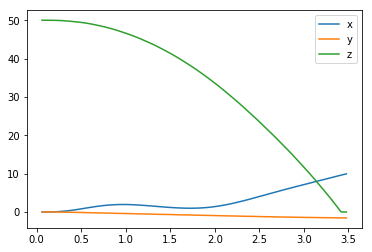

In [102]:
##Plot last-episode trajectory
plt.plot(results['time'], results['x'], label='x')
plt.plot(results['time'], results['y'], label='y')
plt.plot(results['time'], results['z'], label='z')
plt.legend()
_ = plt.ylim()

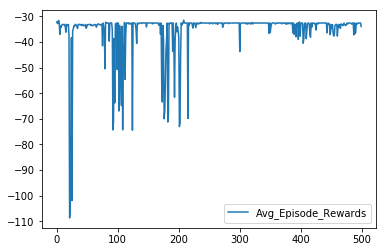

In [103]:
plt.plot(range(len(avg_episode_rewards)), avg_episode_rewards, label='Avg_Episode_Rewards')
plt.legend()
_ = plt.ylim()


**ATTEMPT 5**

In [108]:
'''
Change networks in actor and critic  
'''



import sys
import pandas as pd
from agents.agent import DDPG
from task import Task

num_episodes = 500
init_pose = np.array([0., 0., 50., 0., 0., 0.])
init_vel = np.array([0., 0., 0.])
init_angle_velocities = np.array([0., 0., 0.])
target_pose = np.array([0., 0., 0., 0., 0., 0.])
target_vel = np.array([0., 0., 0.])
task = Task(init_pose=init_pose, init_vel=init_vel, init_angle_velocities=init_angle_velocities, target_pose=target_pose, target_vel=target_vel)
agent = DDPG(task)
avg_episode_rewards = []
file_output = 'data2.txt'

'''
Leave things the same as before, just record simulation and action history for plotting
'''
labels = ['time', 'x', 'y', 'z', 'phi', 'theta', 'psi', 'x_velocity',
          'y_velocity', 'z_velocity', 'phi_velocity', 'theta_velocity',
          'psi_velocity', 'rotor_speed1', 'rotor_speed2', 'rotor_speed3', 'rotor_speed4']
results = {x : [] for x in labels}

'''
USED THIS REWARD FUNCTION in task.py:
alpha = .3, beta = .3, gamma = 1.

reward = - alpha*(abs(self.sim.pose[:3] - self.target_pose[:3])).sum() - beta*(abs(self.sim.v[:3] - self.target_vel)).sum()/(1 + gamma*(abs(self.sim.pose[:3] - self.target_pose[:3])).sum() ) #velocity only counts when close to ground
'''

for i_episode in range(1, num_episodes+1):
    print("")
    print("i_episode: " + str(i_episode))
    print("")
    print("")
    state = agent.reset_episode() # start a new episode
    time = 0
    total_episode_reward = 0
    count = 0
    
    with open(file_output, 'w') as csvfile:
        writer = csv.writer(csvfile)
        writer.writerow(labels)
    
        while True:
            print("")
            print("time: " + str(time))
            print("sim time: " + str(task.sim.time))
        
            action = agent.act(state) 
            next_state, reward, done = task.step(action)
            print("reward: " + str(reward))
        
            if i_episode == num_episodes: #only write last episode with fully trained actor and critic networks
                to_write = [task.sim.time] + list(task.sim.pose) + list(task.sim.v) + list(task.sim.angular_v) + list(rotor_speeds)
                for ii in range(len(labels)):
                    results[labels[ii]].append(to_write[ii])
                writer.writerow(to_write)
         
            total_episode_reward += reward
            count += 1
        
            agent.step(action, reward, next_state, done)
            state = next_state
            if done:
                break
            time += 1
    
    avg_episode_rewards.append(total_episode_reward/count)
    print("avg_episode_reward: " + str(total_episode_reward/count))
    sys.stdout.flush()



i_episode: 1



time: 0
sim time: 0.0
reward: -45.0334530514

time: 1
sim time: 0.06
reward: -45.1392297808

time: 2
sim time: 0.12000000000000001
reward: -45.2417690899

time: 3
sim time: 0.18
reward: -45.3580367179

time: 4
sim time: 0.23999999999999996
reward: -45.4964357114

time: 5
sim time: 0.3
reward: -45.596081494

time: 6
sim time: 0.36000000000000004
reward: -45.6217217367

time: 7
sim time: 0.4200000000000001
reward: -45.5833104421

time: 8
sim time: 0.48000000000000015
reward: -45.582034671

time: 9
sim time: 0.5400000000000001
reward: -45.6857636943

time: 10
sim time: 0.6000000000000002
reward: -45.836528169

time: 11
sim time: 0.6600000000000003
reward: -46.025229358

time: 12
sim time: 0.7200000000000003
reward: -46.2940683315

time: 13
sim time: 0.7800000000000004
reward: -46.5503780194

time: 14
sim time: 0.8400000000000004
reward: -46.785965834

time: 15
sim time: 0.9000000000000005
reward: -47.0890130801

time: 16
sim time: 0.9600000000000005
reward: -47.4457174662


time: 52
sim time: 3.1200000000000023
reward: -72.5478437633

time: 53
sim time: 3.1800000000000024
reward: -73.5228861955

time: 54
sim time: 3.2400000000000024
reward: -74.4608910897

time: 55
sim time: 3.3000000000000025
reward: -75.4348472168

time: 56
sim time: 3.3600000000000025
reward: -76.452533552

time: 57
sim time: 3.4200000000000026
reward: -77.4488578097

time: 58
sim time: 3.4800000000000026
reward: -78.4259248246

time: 59
sim time: 3.5400000000000027
reward: -79.4541130958

time: 60
sim time: 3.6000000000000028
reward: -80.5048030559

time: 61
sim time: 3.660000000000003
reward: -81.517789448

time: 62
sim time: 3.720000000000003
reward: -82.5409663875

time: 63
sim time: 3.780000000000003
reward: -83.6129369172

time: 64
sim time: 3.840000000000003
reward: -84.6835297878

time: 65
sim time: 3.900000000000003
reward: -85.7174697224

time: 66
sim time: 3.960000000000003
reward: -86.786958524

time: 67
sim time: 4.020000000000002
reward: -87.8921642204

time: 68
sim time


time: 22
sim time: 1.3200000000000007
reward: -50.1754678613

time: 23
sim time: 1.3800000000000008
reward: -50.6991053944

time: 24
sim time: 1.4400000000000008
reward: -51.2151460993

time: 25
sim time: 1.5000000000000009
reward: -51.7055791051

time: 26
sim time: 1.560000000000001
reward: -52.2568539568

time: 27
sim time: 1.620000000000001
reward: -52.8600574912

time: 28
sim time: 1.680000000000001
reward: -53.432450544

time: 29
sim time: 1.740000000000001
reward: -54.0057188193

time: 30
sim time: 1.8000000000000012
reward: -54.6534068132

time: 31
sim time: 1.8600000000000012
reward: -55.3190715809

time: 32
sim time: 1.9200000000000013
reward: -55.9481505661

time: 33
sim time: 1.9800000000000013
reward: -56.6110526727

time: 34
sim time: 2.0400000000000014
reward: -57.3394079782

time: 35
sim time: 2.1000000000000014
reward: -58.0553344617

time: 36
sim time: 2.1600000000000015
reward: -58.7472424457

time: 37
sim time: 2.2200000000000015
reward: -59.4986359042

time: 38
sim


time: 72
sim time: 4.319999999999996
reward: -93.016970456

time: 73
sim time: 4.379999999999995
reward: -94.1210230524

time: 74
sim time: 4.439999999999993
reward: -95.2666375609

time: 75
sim time: 4.499999999999992
reward: -96.4041255556

time: 76
sim time: 4.559999999999991
reward: -97.5080926686

time: 77
sim time: 4.6199999999999894
reward: -98.6487983859

time: 78
sim time: 4.679999999999988
reward: -99.8177676324

time: 79
sim time: 4.739999999999987
reward: -100.95566145

time: 80
sim time: 4.799999999999986
reward: -102.08479302

time: 81
sim time: 4.859999999999984
reward: -103.256177841

time: 82
sim time: 4.919999999999983
reward: -104.436795657

time: 83
sim time: 4.979999999999982
reward: -105.576613895
avg_episode_reward: -67.1882553216

i_episode: 6



time: 0
sim time: 0.0
reward: -45.0334699688

time: 1
sim time: 0.06
reward: -45.1426923162

time: 2
sim time: 0.12000000000000001
reward: -45.2613535767

time: 3
sim time: 0.18
reward: -45.3921435337

time: 4
sim time


time: 40
sim time: 2.4000000000000017
reward: -61.7644746997

time: 41
sim time: 2.4600000000000017
reward: -62.5930186382

time: 42
sim time: 2.520000000000002
reward: -63.4307096524

time: 43
sim time: 2.580000000000002
reward: -64.231764217

time: 44
sim time: 2.640000000000002
reward: -65.0692068059

time: 45
sim time: 2.700000000000002
reward: -65.9597381562

time: 46
sim time: 2.760000000000002
reward: -66.8325416246

time: 47
sim time: 2.820000000000002
reward: -67.6842762165

time: 48
sim time: 2.880000000000002
reward: -68.5922056703

time: 49
sim time: 2.940000000000002
reward: -69.5294272263

time: 50
sim time: 3.000000000000002
reward: -70.4308849764

time: 51
sim time: 3.0600000000000023
reward: -71.3407175399

time: 52
sim time: 3.1200000000000023
reward: -72.3073596995

time: 53
sim time: 3.1800000000000024
reward: -73.2766223128

time: 54
sim time: 3.2400000000000024
reward: -74.2092312419

time: 55
sim time: 3.3000000000000025
reward: -75.1785245246

time: 56
sim time


time: 7
sim time: 0.4200000000000001
reward: -45.7448498944

time: 8
sim time: 0.48000000000000015
reward: -45.7943953073

time: 9
sim time: 0.5400000000000001
reward: -45.8473661528

time: 10
sim time: 0.6000000000000002
reward: -46.0021461825

time: 11
sim time: 0.6600000000000003
reward: -46.2047415137

time: 12
sim time: 0.7200000000000003
reward: -46.4912277827

time: 13
sim time: 0.7800000000000004
reward: -46.7751325184

time: 14
sim time: 0.8400000000000004
reward: -47.0321568691

time: 15
sim time: 0.9000000000000005
reward: -47.349242007

time: 16
sim time: 0.9600000000000005
reward: -47.7285258963

time: 17
sim time: 1.0200000000000005
reward: -48.0787178452

time: 18
sim time: 1.0800000000000005
reward: -48.4276425194

time: 19
sim time: 1.1400000000000006
reward: -48.8564028267

time: 20
sim time: 1.2000000000000006
reward: -49.3106566102

time: 21
sim time: 1.2600000000000007
reward: -49.728729195

time: 22
sim time: 1.3200000000000007
reward: -50.179468917

time: 23
sim


time: 57
sim time: 3.4200000000000026
reward: -77.367638002

time: 58
sim time: 3.4800000000000026
reward: -78.3371109993

time: 59
sim time: 3.5400000000000027
reward: -79.3571030773

time: 60
sim time: 3.6000000000000028
reward: -80.3973654686

time: 61
sim time: 3.660000000000003
reward: -81.3999858813

time: 62
sim time: 3.720000000000003
reward: -82.4135033803

time: 63
sim time: 3.780000000000003
reward: -83.4739349606

time: 64
sim time: 3.840000000000003
reward: -84.5315450531

time: 65
sim time: 3.900000000000003
reward: -85.5530132067

time: 66
sim time: 3.960000000000003
reward: -86.6100989704

time: 67
sim time: 4.020000000000002
reward: -87.7004504545

time: 68
sim time: 4.080000000000001
reward: -88.764708935

time: 69
sim time: 4.14
reward: -89.8137780568

time: 70
sim time: 4.199999999999998
reward: -90.9081444752

time: 71
sim time: 4.259999999999997
reward: -92.0166818212

time: 72
sim time: 4.319999999999996
reward: -93.0858615622

time: 73
sim time: 4.3799999999999


time: 26
sim time: 1.560000000000001
reward: -52.13983615

time: 27
sim time: 1.620000000000001
reward: -52.733660969

time: 28
sim time: 1.680000000000001
reward: -53.2965975049

time: 29
sim time: 1.740000000000001
reward: -53.8592966817

time: 30
sim time: 1.8000000000000012
reward: -54.4966196059

time: 31
sim time: 1.8600000000000012
reward: -55.1525641362

time: 32
sim time: 1.9200000000000013
reward: -55.7716069787

time: 33
sim time: 1.9800000000000013
reward: -56.4241478131

time: 34
sim time: 2.0400000000000014
reward: -57.1430054378

time: 35
sim time: 2.1000000000000014
reward: -57.8493160425

time: 36
sim time: 2.1600000000000015
reward: -58.5316067528

time: 37
sim time: 2.2200000000000015
reward: -59.2738834675

time: 38
sim time: 2.2800000000000016
reward: -60.057509939

time: 39
sim time: 2.3400000000000016
reward: -60.8077570851

time: 40
sim time: 2.4000000000000017
reward: -61.5623810875

time: 41
sim time: 2.4600000000000017
reward: -62.3844956726

time: 42
sim ti


time: 76
sim time: 4.559999999999991
reward: -97.575799151

time: 77
sim time: 4.6199999999999894
reward: -98.7052401996

time: 78
sim time: 4.679999999999988
reward: -99.8607175524

time: 79
sim time: 4.739999999999987
reward: -100.985121823

time: 80
sim time: 4.799999999999986
reward: -102.101000591

time: 81
sim time: 4.859999999999984
reward: -103.257699758

time: 82
sim time: 4.919999999999983
reward: -104.422058789

time: 83
sim time: 4.979999999999982
reward: -105.545966602
avg_episode_reward: -67.2664913914

i_episode: 14



time: 0
sim time: 0.0
reward: -45.0334422559

time: 1
sim time: 0.06
reward: -45.1426657148

time: 2
sim time: 0.12000000000000001
reward: -45.2621040903

time: 3
sim time: 0.18
reward: -45.3933451535

time: 4
sim time: 0.23999999999999996
reward: -45.5378616447

time: 5
sim time: 0.3
reward: -45.6716569812

time: 6
sim time: 0.36000000000000004
reward: -45.7474394204

time: 7
sim time: 0.4200000000000001
reward: -45.7612497971

time: 8
sim time: 0.480000


time: 42
sim time: 2.520000000000002
reward: -63.3761795406

time: 43
sim time: 2.580000000000002
reward: -64.1773890497

time: 44
sim time: 2.640000000000002
reward: -65.0162338057

time: 45
sim time: 2.700000000000002
reward: -65.9083874569

time: 46
sim time: 2.760000000000002
reward: -66.7821510299

time: 47
sim time: 2.820000000000002
reward: -67.6359334179

time: 48
sim time: 2.880000000000002
reward: -68.5469100628

time: 49
sim time: 2.940000000000002
reward: -69.486878987

time: 50
sim time: 3.000000000000002
reward: -70.3910173812

time: 51
sim time: 3.0600000000000023
reward: -71.304944213

time: 52
sim time: 3.1200000000000023
reward: -72.276296173

time: 53
sim time: 3.1800000000000024
reward: -73.2495079276

time: 54
sim time: 3.2400000000000024
reward: -74.1867496046

time: 55
sim time: 3.3000000000000025
reward: -75.1619841942

time: 56
sim time: 3.3600000000000025
reward: -76.1799792363

time: 57
sim time: 3.4200000000000026
reward: -77.1752171277

time: 58
sim time: 


time: 11
sim time: 0.6600000000000003
reward: -46.2103709008

time: 12
sim time: 0.7200000000000003
reward: -46.4952672822

time: 13
sim time: 0.7800000000000004
reward: -46.7792677435

time: 14
sim time: 0.8400000000000004
reward: -47.0348007071

time: 15
sim time: 0.9000000000000005
reward: -47.3481906711

time: 16
sim time: 0.9600000000000005
reward: -47.7252634198

time: 17
sim time: 1.0200000000000005
reward: -48.0740118929

time: 18
sim time: 1.0800000000000005
reward: -48.4187637997

time: 19
sim time: 1.1400000000000006
reward: -48.8424524372

time: 20
sim time: 1.2000000000000006
reward: -49.2936920231

time: 21
sim time: 1.2600000000000007
reward: -49.708193939

time: 22
sim time: 1.3200000000000007
reward: -50.1526819812

time: 23
sim time: 1.3800000000000008
reward: -50.6735749023

time: 24
sim time: 1.4400000000000008
reward: -51.1867579459

time: 25
sim time: 1.5000000000000009
reward: -51.6740282318

time: 26
sim time: 1.560000000000001
reward: -52.2221235122

time: 27



time: 61
sim time: 3.660000000000003
reward: -81.0254629536

time: 62
sim time: 3.720000000000003
reward: -82.0463452312

time: 63
sim time: 3.780000000000003
reward: -83.1158198144

time: 64
sim time: 3.840000000000003
reward: -84.1823665402

time: 65
sim time: 3.900000000000003
reward: -85.2133979373

time: 66
sim time: 3.960000000000003
reward: -86.2814490926

time: 67
sim time: 4.020000000000002
reward: -87.3840285463

time: 68
sim time: 4.080000000000001
reward: -88.4599809807

time: 69
sim time: 4.14
reward: -89.5219207713

time: 70
sim time: 4.199999999999998
reward: -90.6305017169

time: 71
sim time: 4.259999999999997
reward: -91.7536770563

time: 72
sim time: 4.319999999999996
reward: -92.8373030388

time: 73
sim time: 4.379999999999995
reward: -93.936064936

time: 74
sim time: 4.439999999999993
reward: -95.0756782241

time: 75
sim time: 4.499999999999992
reward: -96.207341778

time: 76
sim time: 4.559999999999991
reward: -97.3052815493

time: 77
sim time: 4.6199999999999894



time: 29
sim time: 1.740000000000001
reward: -53.939704061

time: 30
sim time: 1.8000000000000012
reward: -54.5853572716

time: 31
sim time: 1.8600000000000012
reward: -55.2476362736

time: 32
sim time: 1.9200000000000013
reward: -55.8737193077

time: 33
sim time: 1.9800000000000013
reward: -56.53558842

time: 34
sim time: 2.0400000000000014
reward: -57.2623025457

time: 35
sim time: 2.1000000000000014
reward: -57.9750182035

time: 36
sim time: 2.1600000000000015
reward: -58.6652977444

time: 37
sim time: 2.2200000000000015
reward: -59.416462866

time: 38
sim time: 2.2800000000000016
reward: -60.2068504991

time: 39
sim time: 2.3400000000000016
reward: -60.9634955048

time: 40
sim time: 2.4000000000000017
reward: -61.7264825772

time: 41
sim time: 2.4600000000000017
reward: -62.5562214127

time: 42
sim time: 2.520000000000002
reward: -63.3943505362

time: 43
sim time: 2.580000000000002
reward: -64.1962662208

time: 44
sim time: 2.640000000000002
reward: -65.0358086451

time: 45
sim ti


time: 79
sim time: 4.739999999999987
reward: -100.591798672

time: 80
sim time: 4.799999999999986
reward: -101.683295717

time: 81
sim time: 4.859999999999984
reward: -102.813930519

time: 82
sim time: 4.919999999999983
reward: -103.948926367

time: 83
sim time: 4.979999999999982
reward: -105.044254635
avg_episode_reward: -67.186464758

i_episode: 22



time: 0
sim time: 0.0
reward: -45.0334728072

time: 1
sim time: 0.06
reward: -45.1431185594

time: 2
sim time: 0.12000000000000001
reward: -45.2641560021

time: 3
sim time: 0.18
reward: -45.3957346202

time: 4
sim time: 0.23999999999999996
reward: -45.5412022851

time: 5
sim time: 0.3
reward: -45.6781989852

time: 6
sim time: 0.36000000000000004
reward: -45.7631355813

time: 7
sim time: 0.4200000000000001
reward: -45.7889473271

time: 8
sim time: 0.48000000000000015
reward: -45.8582203166

time: 9
sim time: 0.5400000000000001
reward: -45.9116935915

time: 10
sim time: 0.6000000000000002
reward: -45.9950096813

time: 11
sim time: 0.6600

reward: -66.5873357571

time: 47
sim time: 2.820000000000002
reward: -67.4354611026

time: 48
sim time: 2.880000000000002
reward: -68.3405316931

time: 49
sim time: 2.940000000000002
reward: -69.276419904

time: 50
sim time: 3.000000000000002
reward: -70.1764697561

time: 51
sim time: 3.0600000000000023
reward: -71.084721

time: 52
sim time: 3.1200000000000023
reward: -72.0513324968

time: 53
sim time: 3.1800000000000024
reward: -73.0214643675

time: 54
sim time: 3.2400000000000024
reward: -73.9547796123

time: 55
sim time: 3.3000000000000025
reward: -74.9250641674

time: 56
sim time: 3.3600000000000025
reward: -75.9399818212

time: 57
sim time: 3.4200000000000026
reward: -76.933001594

time: 58
sim time: 3.4800000000000026
reward: -77.9075379864

time: 59
sim time: 3.5400000000000027
reward: -78.9342803813

time: 60
sim time: 3.6000000000000028
reward: -79.9837916299

time: 61
sim time: 3.660000000000003
reward: -80.9953282152

time: 62
sim time: 3.720000000000003
reward: -82.01829709


time: 16
sim time: 0.9600000000000005
reward: -47.6892984719

time: 17
sim time: 1.0200000000000005
reward: -48.0362252592

time: 18
sim time: 1.0800000000000005
reward: -48.3815604531

time: 19
sim time: 1.1400000000000006
reward: -48.8067614003

time: 20
sim time: 1.2000000000000006
reward: -49.257499327

time: 21
sim time: 1.2600000000000007
reward: -49.6719272995

time: 22
sim time: 1.3200000000000007
reward: -50.1189939164

time: 23
sim time: 1.3800000000000008
reward: -50.6417403918

time: 24
sim time: 1.4400000000000008
reward: -51.1550279143

time: 25
sim time: 1.5000000000000009
reward: -51.6441086653

time: 26
sim time: 1.560000000000001
reward: -52.1958121512

time: 27
sim time: 1.620000000000001
reward: -52.7974760183

time: 28
sim time: 1.680000000000001
reward: -53.3672985235

time: 29
sim time: 1.740000000000001
reward: -53.9404432002

time: 30
sim time: 1.8000000000000012
reward: -54.5882767464

time: 31
sim time: 1.8600000000000012
reward: -55.2515650791

time: 32
sim


time: 69
sim time: 4.14
reward: -89.7552276178

time: 70
sim time: 4.199999999999998
reward: -90.8593570438

time: 71
sim time: 4.259999999999997
reward: -91.9769953864

time: 72
sim time: 4.319999999999996
reward: -93.0556285309

time: 73
sim time: 4.379999999999995
reward: -94.1489214978

time: 74
sim time: 4.439999999999993
reward: -95.2818920577

time: 75
sim time: 4.499999999999992
reward: -96.4067248437

time: 76
sim time: 4.559999999999991
reward: -97.4979058837

time: 77
sim time: 4.6199999999999894
reward: -98.6248598251

time: 78
sim time: 4.679999999999988
reward: -99.7778657802

time: 79
sim time: 4.739999999999987
reward: -100.900602407

time: 80
sim time: 4.799999999999986
reward: -102.01356999

time: 81
sim time: 4.859999999999984
reward: -103.167209624

time: 82
sim time: 4.919999999999983
reward: -104.328872179

time: 83
sim time: 4.979999999999982
reward: -105.450286781
avg_episode_reward: -67.2357366394

i_episode: 27



time: 0
sim time: 0.0
reward: -45.0334578077



time: 36
sim time: 2.1600000000000015
reward: -58.7038601397

time: 37
sim time: 2.2200000000000015
reward: -59.4557564547

time: 38
sim time: 2.2800000000000016
reward: -60.2475416557

time: 39
sim time: 2.3400000000000016
reward: -61.0061452884

time: 40
sim time: 2.4000000000000017
reward: -61.7699871302

time: 41
sim time: 2.4600000000000017
reward: -62.6003613975

time: 42
sim time: 2.520000000000002
reward: -63.4398214505

time: 43
sim time: 2.580000000000002
reward: -64.2430778399

time: 44
sim time: 2.640000000000002
reward: -65.0831561417

time: 45
sim time: 2.700000000000002
reward: -65.9761866757

time: 46
sim time: 2.760000000000002
reward: -66.8513496946

time: 47
sim time: 2.820000000000002
reward: -67.7060187752

time: 48
sim time: 2.880000000000002
reward: -68.61725948

time: 49
sim time: 2.940000000000002
reward: -69.5572141703

time: 50
sim time: 3.000000000000002
reward: -70.4615791923

time: 51
sim time: 3.0600000000000023
reward: -71.3749574069

time: 52
sim time:

reward: -45.2624921741

time: 3
sim time: 0.18
reward: -45.3934490226

time: 4
sim time: 0.23999999999999996
reward: -45.5397999226

time: 5
sim time: 0.3
reward: -45.6749484639

time: 6
sim time: 0.36000000000000004
reward: -45.7569986743

time: 7
sim time: 0.4200000000000001
reward: -45.779607834

time: 8
sim time: 0.48000000000000015
reward: -45.8464602152

time: 9
sim time: 0.5400000000000001
reward: -45.8950431209

time: 10
sim time: 0.6000000000000002
reward: -46.0019020366

time: 11
sim time: 0.6600000000000003
reward: -46.2017708198

time: 12
sim time: 0.7200000000000003
reward: -46.4855564907

time: 13
sim time: 0.7800000000000004
reward: -46.7676285883

time: 14
sim time: 0.8400000000000004
reward: -47.021455468

time: 15
sim time: 0.9000000000000005
reward: -47.333617994

time: 16
sim time: 0.9600000000000005
reward: -47.7087946457

time: 17
sim time: 1.0200000000000005
reward: -48.0552137333

time: 18
sim time: 1.0800000000000005
reward: -48.3983348976

time: 19
sim time: 1


time: 53
sim time: 3.1800000000000024
reward: -73.5231967555

time: 54
sim time: 3.2400000000000024
reward: -74.457239102

time: 55
sim time: 3.3000000000000025
reward: -75.4261172542

time: 56
sim time: 3.3600000000000025
reward: -76.4379154557

time: 57
sim time: 3.4200000000000026
reward: -77.4291005232

time: 58
sim time: 3.4800000000000026
reward: -78.4001999494

time: 59
sim time: 3.5400000000000027
reward: -79.4215498191

time: 60
sim time: 3.6000000000000028
reward: -80.4646545895

time: 61
sim time: 3.660000000000003
reward: -81.4706189819

time: 62
sim time: 3.720000000000003
reward: -82.4860545009

time: 63
sim time: 3.780000000000003
reward: -83.5489890308

time: 64
sim time: 3.840000000000003
reward: -84.6101682955

time: 65
sim time: 3.900000000000003
reward: -85.634916541

time: 66
sim time: 3.960000000000003
reward: -86.6947033421

time: 67
sim time: 4.020000000000002
reward: -87.7882373847

time: 68
sim time: 4.080000000000001
reward: -88.856475806

time: 69
sim time:


time: 23
sim time: 1.3800000000000008
reward: -50.687750444

time: 24
sim time: 1.4400000000000008
reward: -51.203092455

time: 25
sim time: 1.5000000000000009
reward: -51.6941910855

time: 26
sim time: 1.560000000000001
reward: -52.2477155818

time: 27
sim time: 1.620000000000001
reward: -52.8511871604

time: 28
sim time: 1.680000000000001
reward: -53.4229068864

time: 29
sim time: 1.740000000000001
reward: -53.9978423678

time: 30
sim time: 1.8000000000000012
reward: -54.6474505318

time: 31
sim time: 1.8600000000000012
reward: -55.31264673

time: 32
sim time: 1.9200000000000013
reward: -55.9417558798

time: 33
sim time: 1.9800000000000013
reward: -56.6072423423

time: 34
sim time: 2.0400000000000014
reward: -57.3367076663

time: 35
sim time: 2.1000000000000014
reward: -58.051692352

time: 36
sim time: 2.1600000000000015
reward: -58.7445312856

time: 37
sim time: 2.2200000000000015
reward: -59.4981770941

time: 38
sim time: 2.2800000000000016
reward: -60.2901045802

time: 39
sim tim


time: 76
sim time: 4.559999999999991
reward: -97.5297538661

time: 77
sim time: 4.6199999999999894
reward: -98.6628100681

time: 78
sim time: 4.679999999999988
reward: -99.8220032673

time: 79
sim time: 4.739999999999987
reward: -100.950493053

time: 80
sim time: 4.799999999999986
reward: -102.06988936

time: 81
sim time: 4.859999999999984
reward: -103.23013383

time: 82
sim time: 4.919999999999983
reward: -104.398268543

time: 83
sim time: 4.979999999999982
reward: -105.526031098
avg_episode_reward: -67.202397129

i_episode: 35



time: 0
sim time: 0.0
reward: -45.0334753976

time: 1
sim time: 0.06
reward: -45.1428634427

time: 2
sim time: 0.12000000000000001
reward: -45.2622576417

time: 3
sim time: 0.18
reward: -45.3933729305

time: 4
sim time: 0.23999999999999996
reward: -45.5393142679

time: 5
sim time: 0.3
reward: -45.6731537229

time: 6
sim time: 0.36000000000000004
reward: -45.7523144454

time: 7
sim time: 0.4200000000000001
reward: -45.7711616383

time: 8
sim time: 0.48000000


time: 42
sim time: 2.520000000000002
reward: -63.1798403105

time: 43
sim time: 2.580000000000002
reward: -63.9766301837

time: 44
sim time: 2.640000000000002
reward: -64.8126843938

time: 45
sim time: 2.700000000000002
reward: -65.7008093433

time: 46
sim time: 2.760000000000002
reward: -66.5691584653

time: 47
sim time: 2.820000000000002
reward: -67.4188967557

time: 48
sim time: 2.880000000000002
reward: -68.3263662837

time: 49
sim time: 2.940000000000002
reward: -69.261383295

time: 50
sim time: 3.000000000000002
reward: -70.1600437358

time: 51
sim time: 3.0600000000000023
reward: -71.070002072

time: 52
sim time: 3.1200000000000023
reward: -72.0370000635

time: 53
sim time: 3.1800000000000024
reward: -73.0046599964

time: 54
sim time: 3.2400000000000024
reward: -73.9367443472

time: 55
sim time: 3.3000000000000025
reward: -74.9078417696

time: 56
sim time: 3.3600000000000025
reward: -75.9206869822

time: 57
sim time: 3.4200000000000026
reward: -76.909633765

time: 58
sim time: 


time: 10
sim time: 0.6000000000000002
reward: -46.0233362763

time: 11
sim time: 0.6600000000000003
reward: -46.2259058035

time: 12
sim time: 0.7200000000000003
reward: -46.5127435559

time: 13
sim time: 0.7800000000000004
reward: -46.7991872702

time: 14
sim time: 0.8400000000000004
reward: -47.0571408501

time: 15
sim time: 0.9000000000000005
reward: -47.3727705839

time: 16
sim time: 0.9600000000000005
reward: -47.7524292368

time: 17
sim time: 1.0200000000000005
reward: -48.1040776867

time: 18
sim time: 1.0800000000000005
reward: -48.4517368236

time: 19
sim time: 1.1400000000000006
reward: -48.8783660304

time: 20
sim time: 1.2000000000000006
reward: -49.3329435135

time: 21
sim time: 1.2600000000000007
reward: -49.7509192762

time: 22
sim time: 1.3200000000000007
reward: -50.1987272621

time: 23
sim time: 1.3800000000000008
reward: -50.722958267

time: 24
sim time: 1.4400000000000008
reward: -51.2398757938

time: 25
sim time: 1.5000000000000009
reward: -51.7306696461

time: 26


time: 60
sim time: 3.6000000000000028
reward: -80.1657013709

time: 61
sim time: 3.660000000000003
reward: -81.1708882596

time: 62
sim time: 3.720000000000003
reward: -82.1875110651

time: 63
sim time: 3.780000000000003
reward: -83.2521872471

time: 64
sim time: 3.840000000000003
reward: -84.3142510962

time: 65
sim time: 3.900000000000003
reward: -85.3402593481

time: 66
sim time: 3.960000000000003
reward: -86.4026031212

time: 67
sim time: 4.020000000000002
reward: -87.4993563844

time: 68
sim time: 4.080000000000001
reward: -88.5695341179

time: 69
sim time: 4.14
reward: -89.6251898174

time: 70
sim time: 4.199999999999998
reward: -90.7269403891

time: 71
sim time: 4.259999999999997
reward: -91.8435251116

time: 72
sim time: 4.319999999999996
reward: -92.9203091693

time: 73
sim time: 4.379999999999995
reward: -94.0118184418

time: 74
sim time: 4.439999999999993
reward: -95.1438841087

time: 75
sim time: 4.499999999999992
reward: -96.2682455267

time: 76
sim time: 4.55999999999999


time: 28
sim time: 1.680000000000001
reward: -53.5357130308

time: 29
sim time: 1.740000000000001
reward: -54.1141516618

time: 30
sim time: 1.8000000000000012
reward: -54.7668993673

time: 31
sim time: 1.8600000000000012
reward: -55.4373485573

time: 32
sim time: 1.9200000000000013
reward: -56.0713615729

time: 33
sim time: 1.9800000000000013
reward: -56.7394162837

time: 34
sim time: 2.0400000000000014
reward: -57.4723353756

time: 35
sim time: 2.1000000000000014
reward: -58.1926006783

time: 36
sim time: 2.1600000000000015
reward: -58.8890445348

time: 37
sim time: 2.2200000000000015
reward: -59.6448907304

time: 38
sim time: 2.2800000000000016
reward: -60.4408898955

time: 39
sim time: 2.3400000000000016
reward: -61.2037691231

time: 40
sim time: 2.4000000000000017
reward: -61.9707687593

time: 41
sim time: 2.4600000000000017
reward: -62.8037639038

time: 42
sim time: 2.520000000000002
reward: -63.6466042467

time: 43
sim time: 2.580000000000002
reward: -64.4526286297

time: 44
si


time: 78
sim time: 4.679999999999988
reward: -99.6974443645

time: 79
sim time: 4.739999999999987
reward: -100.819846012

time: 80
sim time: 4.799999999999986
reward: -101.931293223

time: 81
sim time: 4.859999999999984
reward: -103.083802715

time: 82
sim time: 4.919999999999983
reward: -104.246298514

time: 83
sim time: 4.979999999999982
reward: -105.367961386
avg_episode_reward: -67.2117649879

i_episode: 43



time: 0
sim time: 0.0
reward: -45.0334724546

time: 1
sim time: 0.06
reward: -45.1426263244

time: 2
sim time: 0.12000000000000001
reward: -45.2601500324

time: 3
sim time: 0.18
reward: -45.3893919789

time: 4
sim time: 0.23999999999999996
reward: -45.5338523561

time: 5
sim time: 0.3
reward: -45.6648649065

time: 6
sim time: 0.36000000000000004
reward: -45.7389858728

time: 7
sim time: 0.4200000000000001
reward: -45.7523180249

time: 8
sim time: 0.48000000000000015
reward: -45.8079409232

time: 9
sim time: 0.5400000000000001
reward: -45.8570542787

time: 10
sim time: 0.6000


time: 46
sim time: 2.760000000000002
reward: -66.716129132

time: 47
sim time: 2.820000000000002
reward: -67.5671850525

time: 48
sim time: 2.880000000000002
reward: -68.4751813792

time: 49
sim time: 2.940000000000002
reward: -69.4118051962

time: 50
sim time: 3.000000000000002
reward: -70.3125456878

time: 51
sim time: 3.0600000000000023
reward: -71.223137984

time: 52
sim time: 3.1200000000000023
reward: -72.1907480064

time: 53
sim time: 3.1800000000000024
reward: -73.1599242487

time: 54
sim time: 3.2400000000000024
reward: -74.093180932

time: 55
sim time: 3.3000000000000025
reward: -75.0644535871

time: 56
sim time: 3.3600000000000025
reward: -76.0778542351

time: 57
sim time: 3.4200000000000026
reward: -77.0682821644

time: 58
sim time: 3.4800000000000026
reward: -78.0417822521

time: 59
sim time: 3.5400000000000027
reward: -79.0670773513

time: 60
sim time: 3.6000000000000028
reward: -80.1124179238

time: 61
sim time: 3.660000000000003
reward: -81.1198616171

time: 62
sim tim


time: 14
sim time: 0.8400000000000004
reward: -47.0364486598

time: 15
sim time: 0.9000000000000005
reward: -47.3504199631

time: 16
sim time: 0.9600000000000005
reward: -47.7279871473

time: 17
sim time: 1.0200000000000005
reward: -48.0772875949

time: 18
sim time: 1.0800000000000005
reward: -48.4230401246

time: 19
sim time: 1.1400000000000006
reward: -48.8478475524

time: 20
sim time: 1.2000000000000006
reward: -49.3000704286

time: 21
sim time: 1.2600000000000007
reward: -49.7157173566

time: 22
sim time: 1.3200000000000007
reward: -50.1615790444

time: 23
sim time: 1.3800000000000008
reward: -50.6837421023

time: 24
sim time: 1.4400000000000008
reward: -51.1983183003

time: 25
sim time: 1.5000000000000009
reward: -51.6871315582

time: 26
sim time: 1.560000000000001
reward: -52.2365994788

time: 27
sim time: 1.620000000000001
reward: -52.8380953671

time: 28
sim time: 1.680000000000001
reward: -53.4088037964

time: 29
sim time: 1.740000000000001
reward: -53.9801911378

time: 30
si


time: 64
sim time: 3.840000000000003
reward: -84.1020444233

time: 65
sim time: 3.900000000000003
reward: -85.1264293639

time: 66
sim time: 3.960000000000003
reward: -86.1901803454

time: 67
sim time: 4.020000000000002
reward: -87.2858087434

time: 68
sim time: 4.080000000000001
reward: -88.3519257708

time: 69
sim time: 4.14
reward: -89.4083735792

time: 70
sim time: 4.199999999999998
reward: -90.5113140092

time: 71
sim time: 4.259999999999997
reward: -91.6252653746

time: 72
sim time: 4.319999999999996
reward: -92.6993001957

time: 73
sim time: 4.379999999999995
reward: -93.7928610771

time: 74
sim time: 4.439999999999993
reward: -94.9252063629

time: 75
sim time: 4.499999999999992
reward: -96.0454773519

time: 76
sim time: 4.559999999999991
reward: -97.1351439973

time: 77
sim time: 4.6199999999999894
reward: -98.2630463495

time: 78
sim time: 4.679999999999988
reward: -99.4152833067

time: 79
sim time: 4.739999999999987
reward: -100.534125332

time: 80
sim time: 4.79999999999998


time: 33
sim time: 1.9800000000000013
reward: -56.446753436

time: 34
sim time: 2.0400000000000014
reward: -57.1678441886

time: 35
sim time: 2.1000000000000014
reward: -57.8763205257

time: 36
sim time: 2.1600000000000015
reward: -58.5611077364

time: 37
sim time: 2.2200000000000015
reward: -59.3059450699

time: 38
sim time: 2.2800000000000016
reward: -60.0917887132

time: 39
sim time: 2.3400000000000016
reward: -60.8444833394

time: 40
sim time: 2.4000000000000017
reward: -61.6019059203

time: 41
sim time: 2.4600000000000017
reward: -62.4266575339

time: 42
sim time: 2.520000000000002
reward: -63.2614838554

time: 43
sim time: 2.580000000000002
reward: -64.0597442567

time: 44
sim time: 2.640000000000002
reward: -64.8942574198

time: 45
sim time: 2.700000000000002
reward: -65.783375821

time: 46
sim time: 2.760000000000002
reward: -66.6553223416

time: 47
sim time: 2.820000000000002
reward: -67.5058563285

time: 48
sim time: 2.880000000000002
reward: -68.4130374556

time: 49
sim tim


i_episode: 51



time: 0
sim time: 0.0
reward: -45.0334738759

time: 1
sim time: 0.06
reward: -45.143456671

time: 2
sim time: 0.12000000000000001
reward: -45.2656884414

time: 3
sim time: 0.18
reward: -45.398372872

time: 4
sim time: 0.23999999999999996
reward: -45.5452991145

time: 5
sim time: 0.3
reward: -45.6839661896

time: 6
sim time: 0.36000000000000004
reward: -45.7720720538

time: 7
sim time: 0.4200000000000001
reward: -45.8019479407

time: 8
sim time: 0.48000000000000015
reward: -45.8766308536

time: 9
sim time: 0.5400000000000001
reward: -45.9366251998

time: 10
sim time: 0.6000000000000002
reward: -45.9977691185

time: 11
sim time: 0.6600000000000003
reward: -46.1942616437

time: 12
sim time: 0.7200000000000003
reward: -46.4753915811

time: 13
sim time: 0.7800000000000004
reward: -46.7561249802

time: 14
sim time: 0.8400000000000004
reward: -47.0077207581

time: 15
sim time: 0.9000000000000005
reward: -47.3163306769

time: 16
sim time: 0.9600000000000005
reward: -47.688974


time: 51
sim time: 3.0600000000000023
reward: -71.1449489092

time: 52
sim time: 3.1200000000000023
reward: -72.1117067665

time: 53
sim time: 3.1800000000000024
reward: -73.0817396148

time: 54
sim time: 3.2400000000000024
reward: -74.0149725054

time: 55
sim time: 3.3000000000000025
reward: -74.9849891106

time: 56
sim time: 3.3600000000000025
reward: -75.998963397

time: 57
sim time: 3.4200000000000026
reward: -76.9910507284

time: 58
sim time: 3.4800000000000026
reward: -77.9646012306

time: 59
sim time: 3.5400000000000027
reward: -78.9899933968

time: 60
sim time: 3.6000000000000028
reward: -80.0377692884

time: 61
sim time: 3.660000000000003
reward: -81.0476450211

time: 62
sim time: 3.720000000000003
reward: -82.068879675

time: 63
sim time: 3.780000000000003
reward: -83.1393254845

time: 64
sim time: 3.840000000000003
reward: -84.207638563

time: 65
sim time: 3.900000000000003
reward: -85.2398768015

time: 66
sim time: 3.960000000000003
reward: -86.3087849997

time: 67
sim tim


time: 18
sim time: 1.0800000000000005
reward: -48.4415062539

time: 19
sim time: 1.1400000000000006
reward: -48.8725441332

time: 20
sim time: 1.2000000000000006
reward: -49.327537059

time: 21
sim time: 1.2600000000000007
reward: -49.7465090245

time: 22
sim time: 1.3200000000000007
reward: -50.1997235674

time: 23
sim time: 1.3800000000000008
reward: -50.7275162719

time: 24
sim time: 1.4400000000000008
reward: -51.2448402271

time: 25
sim time: 1.5000000000000009
reward: -51.7387935892

time: 26
sim time: 1.560000000000001
reward: -52.2958212159

time: 27
sim time: 1.620000000000001
reward: -52.9012911643

time: 28
sim time: 1.680000000000001
reward: -53.4745509904

time: 29
sim time: 1.740000000000001
reward: -54.0520995504

time: 30
sim time: 1.8000000000000012
reward: -54.7036796232

time: 31
sim time: 1.8600000000000012
reward: -55.3693620963

time: 32
sim time: 1.9200000000000013
reward: -55.9991024946

time: 33
sim time: 1.9800000000000013
reward: -56.6659212076

time: 34
sim


time: 68
sim time: 4.080000000000001
reward: -88.6871716193

time: 69
sim time: 4.14
reward: -89.7421537615

time: 70
sim time: 4.199999999999998
reward: -90.8428814572

time: 71
sim time: 4.259999999999997
reward: -91.9560738778

time: 72
sim time: 4.319999999999996
reward: -93.0300860945

time: 73
sim time: 4.379999999999995
reward: -94.119800349

time: 74
sim time: 4.439999999999993
reward: -95.2482778257

time: 75
sim time: 4.499999999999992
reward: -96.3674834387

time: 76
sim time: 4.559999999999991
reward: -97.4537015963

time: 77
sim time: 4.6199999999999894
reward: -98.5761189344

time: 78
sim time: 4.679999999999988
reward: -99.7234807899

time: 79
sim time: 4.739999999999987
reward: -100.839905922

time: 80
sim time: 4.799999999999986
reward: -101.947872692

time: 81
sim time: 4.859999999999984
reward: -103.096064844

time: 82
sim time: 4.919999999999983
reward: -104.25086525

time: 83
sim time: 4.979999999999982
reward: -105.365546307
avg_episode_reward: -67.2295661641

i_


time: 35
sim time: 2.1000000000000014
reward: -58.0306112931

time: 36
sim time: 2.1600000000000015
reward: -58.7219033513

time: 37
sim time: 2.2200000000000015
reward: -59.4732459887

time: 38
sim time: 2.2800000000000016
reward: -60.2645088193

time: 39
sim time: 2.3400000000000016
reward: -61.0223546172

time: 40
sim time: 2.4000000000000017
reward: -61.7852742783

time: 41
sim time: 2.4600000000000017
reward: -62.6146256898

time: 42
sim time: 2.520000000000002
reward: -63.4532338509

time: 43
sim time: 2.580000000000002
reward: -64.2553284871

time: 44
sim time: 2.640000000000002
reward: -65.0939328462

time: 45
sim time: 2.700000000000002
reward: -65.9858229427

time: 46
sim time: 2.760000000000002
reward: -66.8600663931

time: 47
sim time: 2.820000000000002
reward: -67.7133442419

time: 48
sim time: 2.880000000000002
reward: -68.6230163804

time: 49
sim time: 2.940000000000002
reward: -69.562161869

time: 50
sim time: 3.000000000000002
reward: -70.4656817337

time: 51
sim time


time: 3
sim time: 0.18
reward: -45.396775815

time: 4
sim time: 0.23999999999999996
reward: -45.5426585028

time: 5
sim time: 0.3
reward: -45.6780202522

time: 6
sim time: 0.36000000000000004
reward: -45.757815206

time: 7
sim time: 0.4200000000000001
reward: -45.7765528163

time: 8
sim time: 0.48000000000000015
reward: -45.8363343759

time: 9
sim time: 0.5400000000000001
reward: -45.885560844

time: 10
sim time: 0.6000000000000002
reward: -46.0149054593

time: 11
sim time: 0.6600000000000003
reward: -46.2167753232

time: 12
sim time: 0.7200000000000003
reward: -46.5028975696

time: 13
sim time: 0.7800000000000004
reward: -46.7884374671

time: 14
sim time: 0.8400000000000004
reward: -47.0456762505

time: 15
sim time: 0.9000000000000005
reward: -47.360951878

time: 16
sim time: 0.9600000000000005
reward: -47.7401780957

time: 17
sim time: 1.0200000000000005
reward: -48.091290663

time: 18
sim time: 1.0800000000000005
reward: -48.4390171755

time: 19
sim time: 1.1400000000000006
reward:


time: 54
sim time: 3.2400000000000024
reward: -74.4035123119

time: 55
sim time: 3.3000000000000025
reward: -75.3749839413

time: 56
sim time: 3.3600000000000025
reward: -76.3886036846

time: 57
sim time: 3.4200000000000026
reward: -77.380780053

time: 58
sim time: 3.4800000000000026
reward: -78.3543012046

time: 59
sim time: 3.5400000000000027
reward: -79.3785427575

time: 60
sim time: 3.6000000000000028
reward: -80.422930062

time: 61
sim time: 3.660000000000003
reward: -81.4302150579

time: 62
sim time: 3.720000000000003
reward: -82.4483784175

time: 63
sim time: 3.780000000000003
reward: -83.5135203614

time: 64
sim time: 3.840000000000003
reward: -84.5754796694

time: 65
sim time: 3.900000000000003
reward: -85.6017867947

time: 66
sim time: 3.960000000000003
reward: -86.6639325673

time: 67
sim time: 4.020000000000002
reward: -87.7586136287

time: 68
sim time: 4.080000000000001
reward: -88.8273777095

time: 69
sim time: 4.14
reward: -89.8812491162

time: 70
sim time: 4.1999999999


time: 22
sim time: 1.3200000000000007
reward: -50.2103582087

time: 23
sim time: 1.3800000000000008
reward: -50.7345866135

time: 24
sim time: 1.4400000000000008
reward: -51.2523600933

time: 25
sim time: 1.5000000000000009
reward: -51.7436938141

time: 26
sim time: 1.560000000000001
reward: -52.2947512951

time: 27
sim time: 1.620000000000001
reward: -52.8988722085

time: 28
sim time: 1.680000000000001
reward: -53.4728417069

time: 29
sim time: 1.740000000000001
reward: -54.0464081691

time: 30
sim time: 1.8000000000000012
reward: -54.6942061682

time: 31
sim time: 1.8600000000000012
reward: -55.3612047389

time: 32
sim time: 1.9200000000000013
reward: -55.9917103697

time: 33
sim time: 1.9800000000000013
reward: -56.6552312855

time: 34
sim time: 2.0400000000000014
reward: -57.384698889

time: 35
sim time: 2.1000000000000014
reward: -58.1024730244

time: 36
sim time: 2.1600000000000015
reward: -58.7960367188

time: 37
sim time: 2.2200000000000015
reward: -59.5488105717

time: 38
sim


time: 72
sim time: 4.319999999999996
reward: -92.9689236011

time: 73
sim time: 4.379999999999995
reward: -94.0746775493

time: 74
sim time: 4.439999999999993
reward: -95.2207062577

time: 75
sim time: 4.499999999999992
reward: -96.3568553608

time: 76
sim time: 4.559999999999991
reward: -97.4608907685

time: 77
sim time: 4.6199999999999894
reward: -98.6024367421

time: 78
sim time: 4.679999999999988
reward: -99.7700358549

time: 79
sim time: 4.739999999999987
reward: -100.905733686

time: 80
sim time: 4.799999999999986
reward: -102.034556062

time: 81
sim time: 4.859999999999984
reward: -103.204940284

time: 82
sim time: 4.919999999999983
reward: -104.382353803

time: 83
sim time: 4.979999999999982
reward: -105.519373579
avg_episode_reward: -67.131815052

i_episode: 64



time: 0
sim time: 0.0
reward: -45.0334664214

time: 1
sim time: 0.06
reward: -45.1425683501

time: 2
sim time: 0.12000000000000001
reward: -45.2604324417

time: 3
sim time: 0.18
reward: -45.3908487528

time: 4
sim t


time: 38
sim time: 2.2800000000000016
reward: -60.3401892423

time: 39
sim time: 2.3400000000000016
reward: -61.0997197799

time: 40
sim time: 2.4000000000000017
reward: -61.8648134651

time: 41
sim time: 2.4600000000000017
reward: -62.6963335714

time: 42
sim time: 2.520000000000002
reward: -63.5366539049

time: 43
sim time: 2.580000000000002
reward: -64.3406079521

time: 44
sim time: 2.640000000000002
reward: -65.1815163831

time: 45
sim time: 2.700000000000002
reward: -66.0753065395

time: 46
sim time: 2.760000000000002
reward: -66.9509957576

time: 47
sim time: 2.820000000000002
reward: -67.8061627963

time: 48
sim time: 2.880000000000002
reward: -68.7179069104

time: 49
sim time: 2.940000000000002
reward: -69.658497372

time: 50
sim time: 3.000000000000002
reward: -70.563280121

time: 51
sim time: 3.0600000000000023
reward: -71.4773163061

time: 52
sim time: 3.1200000000000023
reward: -72.4481895562

time: 53
sim time: 3.1800000000000024
reward: -73.4210110678

time: 54
sim time:

reward: -45.669779673

time: 6
sim time: 0.36000000000000004
reward: -45.7432275975

time: 7
sim time: 0.4200000000000001
reward: -45.7545044899

time: 8
sim time: 0.48000000000000015
reward: -45.8052259902

time: 9
sim time: 0.5400000000000001
reward: -45.8528058265

time: 10
sim time: 0.6000000000000002
reward: -45.9976523475

time: 11
sim time: 0.6600000000000003
reward: -46.199061529

time: 12
sim time: 0.7200000000000003
reward: -46.4847829338

time: 13
sim time: 0.7800000000000004
reward: -46.7692159426

time: 14
sim time: 0.8400000000000004
reward: -47.0260805688

time: 15
sim time: 0.9000000000000005
reward: -47.3419767005

time: 16
sim time: 0.9600000000000005
reward: -47.7211923245

time: 17
sim time: 1.0200000000000005
reward: -48.0719284969

time: 18
sim time: 1.0800000000000005
reward: -48.4201933412

time: 19
sim time: 1.1400000000000006
reward: -48.8479951705

time: 20
sim time: 1.2000000000000006
reward: -49.302601726

time: 21
sim time: 1.2600000000000007
reward: -49.7


time: 57
sim time: 3.4200000000000026
reward: -77.2958814341

time: 58
sim time: 3.4800000000000026
reward: -78.2563392931

time: 59
sim time: 3.5400000000000027
reward: -79.2668561295

time: 60
sim time: 3.6000000000000028
reward: -80.2960049549

time: 61
sim time: 3.660000000000003
reward: -81.28755093

time: 62
sim time: 3.720000000000003
reward: -82.2904960917

time: 63
sim time: 3.780000000000003
reward: -83.3389683826

time: 64
sim time: 3.840000000000003
reward: -84.3832900135

time: 65
sim time: 3.900000000000003
reward: -85.3919354593

time: 66
sim time: 3.960000000000003
reward: -86.4364434469

time: 67
sim time: 4.020000000000002
reward: -87.5122249232

time: 68
sim time: 4.080000000000001
reward: -88.5612507516

time: 69
sim time: 4.14
reward: -89.5959784127

time: 70
sim time: 4.199999999999998
reward: -90.6753567853

time: 71
sim time: 4.259999999999997
reward: -91.7667476986

time: 72
sim time: 4.319999999999996
reward: -92.8188607166

time: 73
sim time: 4.3799999999999


time: 24
sim time: 1.4400000000000008
reward: -48.4075330822

time: 25
sim time: 1.5000000000000009
reward: -48.0572975778

time: 26
sim time: 1.560000000000001
reward: -47.5809706921

time: 27
sim time: 1.620000000000001
reward: -46.9539618131

time: 28
sim time: 1.680000000000001
reward: -46.1978664446

time: 29
sim time: 1.740000000000001
reward: -45.3589168405

time: 30
sim time: 1.8000000000000012
reward: -44.4931025664

time: 31
sim time: 1.8600000000000012
reward: -43.6143398035

time: 32
sim time: 1.9200000000000013
reward: -42.7404953767

time: 33
sim time: 1.9800000000000013
reward: -41.9008807072

time: 34
sim time: 2.0400000000000014
reward: -41.1189871984

time: 35
sim time: 2.1000000000000014
reward: -40.4008137671

time: 36
sim time: 2.1600000000000015
reward: -39.7322324718

time: 37
sim time: 2.2200000000000015
reward: -39.0872657354

time: 38
sim time: 2.2800000000000016
reward: -38.4396659095

time: 39
sim time: 2.3400000000000016
reward: -37.7699693839

time: 40
si


time: 19
sim time: 1.1400000000000006
reward: -53.1517367328

time: 20
sim time: 1.2000000000000006
reward: -53.5875652183

time: 21
sim time: 1.2600000000000007
reward: -53.9422835167

time: 22
sim time: 1.3200000000000007
reward: -54.1615036103

time: 23
sim time: 1.3800000000000008
reward: -54.2353222448

time: 24
sim time: 1.4400000000000008
reward: -54.1617239414

time: 25
sim time: 1.5000000000000009
reward: -53.943790503

time: 26
sim time: 1.560000000000001
reward: -53.5891206222

time: 27
sim time: 1.620000000000001
reward: -53.1097897764

time: 28
sim time: 1.680000000000001
reward: -52.549669284

time: 29
sim time: 1.740000000000001
reward: -51.9080505539

time: 30
sim time: 1.8000000000000012
reward: -51.1886121685

time: 31
sim time: 1.8600000000000012
reward: -50.4090205712

time: 32
sim time: 1.9200000000000013
reward: -49.5869853497

time: 33
sim time: 1.9800000000000013
reward: -48.739620542

time: 34
sim time: 2.0400000000000014
reward: -47.882969642

time: 35
sim ti

reward: -51.9016272064

time: 18
sim time: 1.0800000000000005
reward: -52.6253715049

time: 19
sim time: 1.1400000000000006
reward: -53.3777677599

time: 20
sim time: 1.2000000000000006
reward: -54.1579695201

time: 21
sim time: 1.2600000000000007
reward: -54.9651846112

time: 22
sim time: 1.3200000000000007
reward: -55.7986701068

time: 23
sim time: 1.3800000000000008
reward: -56.6577395306

time: 24
sim time: 1.4400000000000008
reward: -57.5417856016

time: 25
sim time: 1.5000000000000009
reward: -58.4502228959

time: 26
sim time: 1.560000000000001
reward: -59.382497374

time: 27
sim time: 1.620000000000001
reward: -60.3381159783

time: 28
sim time: 1.680000000000001
reward: -61.3166173803

time: 29
sim time: 1.740000000000001
reward: -62.3174827809

time: 30
sim time: 1.8000000000000012
reward: -63.340145217

time: 31
sim time: 1.8600000000000012
reward: -64.3840099973

time: 32
sim time: 1.9200000000000013
reward: -65.4484810165

time: 33
sim time: 1.9800000000000013
reward: -66.53


time: 15
sim time: 0.9000000000000005
reward: -42.5540941077

time: 16
sim time: 0.9600000000000005
reward: -42.1778438426

time: 17
sim time: 1.0200000000000005
reward: -41.7439874667

time: 18
sim time: 1.0800000000000005
reward: -41.2612023744

time: 19
sim time: 1.1400000000000006
reward: -40.7807386532

time: 20
sim time: 1.2000000000000006
reward: -40.2495998316

time: 21
sim time: 1.2600000000000007
reward: -39.6402214284

time: 22
sim time: 1.3200000000000007
reward: -39.0230794349

time: 23
sim time: 1.3800000000000008
reward: -38.3725955733

time: 24
sim time: 1.4400000000000008
reward: -37.6452541509

time: 25
sim time: 1.5000000000000009
reward: -36.9031256902

time: 26
sim time: 1.560000000000001
reward: -36.1526376745

time: 27
sim time: 1.620000000000001
reward: -35.3437090775

time: 28
sim time: 1.680000000000001
reward: -34.498199563

time: 29
sim time: 1.740000000000001
reward: -33.649987687

time: 30
sim time: 1.8000000000000012
reward: -32.7600604387

time: 31
sim 


time: 39
sim time: 2.3400000000000016
reward: -23.6031775739

time: 40
sim time: 2.4000000000000017
reward: -22.5815241593

time: 41
sim time: 2.4600000000000017
reward: -21.5768978066

time: 42
sim time: 2.520000000000002
reward: -20.6251279464

time: 43
sim time: 2.580000000000002
reward: -19.64339895

time: 44
sim time: 2.640000000000002
reward: -18.6305595039

time: 45
sim time: 2.700000000000002
reward: -17.6714059477

time: 46
sim time: 2.760000000000002
reward: -16.7597588227

time: 47
sim time: 2.820000000000002
reward: -15.8021314907

time: 48
sim time: 2.880000000000002
reward: -14.8439111456

time: 49
sim time: 2.940000000000002
reward: -13.9842863494

time: 50
sim time: 3.000000000000002
reward: -13.1474631426

time: 51
sim time: 3.0600000000000023
reward: -12.2671065277

time: 52
sim time: 3.1200000000000023
reward: -11.4366771101

time: 53
sim time: 3.1800000000000024
reward: -10.7584550656

time: 54
sim time: 3.2400000000000024
reward: -10.0713889001

time: 55
sim time:


time: 2
sim time: 0.12000000000000001
reward: -45.0628856896

time: 3
sim time: 0.18
reward: -45.0518054091

time: 4
sim time: 0.23999999999999996
reward: -45.0481870343

time: 5
sim time: 0.3
reward: -44.9900534457

time: 6
sim time: 0.36000000000000004
reward: -44.8564531964

time: 7
sim time: 0.4200000000000001
reward: -44.7674192592

time: 8
sim time: 0.48000000000000015
reward: -44.7254780576

time: 9
sim time: 0.5400000000000001
reward: -44.6492479088

time: 10
sim time: 0.6000000000000002
reward: -44.5653461585

time: 11
sim time: 0.6600000000000003
reward: -44.561557829

time: 12
sim time: 0.7200000000000003
reward: -44.5597888352

time: 13
sim time: 0.7800000000000004
reward: -44.5325962319

time: 14
sim time: 0.8400000000000004
reward: -44.5223464722

time: 15
sim time: 0.9000000000000005
reward: -44.5901628579

time: 16
sim time: 0.9600000000000005
reward: -44.6298030805

time: 17
sim time: 1.0200000000000005
reward: -44.6517692974

time: 18
sim time: 1.0800000000000005
rew


time: 53
sim time: 3.1800000000000024
reward: -54.5255823153

time: 54
sim time: 3.2400000000000024
reward: -54.9495717359

time: 55
sim time: 3.3000000000000025
reward: -55.4055221317

time: 56
sim time: 3.3600000000000025
reward: -55.8428554817

time: 57
sim time: 3.4200000000000026
reward: -56.2801254085

time: 58
sim time: 3.4800000000000026
reward: -56.7220354561

time: 59
sim time: 3.5400000000000027
reward: -57.1926018179

time: 60
sim time: 3.6000000000000028
reward: -57.6355221732

time: 61
sim time: 3.660000000000003
reward: -58.0811765219

time: 62
sim time: 3.720000000000003
reward: -58.5441663328

time: 63
sim time: 3.780000000000003
reward: -59.011277798

time: 64
sim time: 3.840000000000003
reward: -59.4679642606

time: 65
sim time: 3.900000000000003
reward: -59.9160940195

time: 66
sim time: 3.960000000000003
reward: -60.3966817168

time: 67
sim time: 4.020000000000002
reward: -60.8565769535

time: 68
sim time: 4.080000000000001
reward: -61.316909584

time: 69
sim time


time: 42
sim time: 2.520000000000002
reward: -35.1759004429

time: 43
sim time: 2.580000000000002
reward: -34.3089592619

time: 44
sim time: 2.640000000000002
reward: -33.3316431191

time: 45
sim time: 2.700000000000002
reward: -32.4126524429

time: 46
sim time: 2.760000000000002
reward: -31.5312310678

time: 47
sim time: 2.820000000000002
reward: -30.5801559771

time: 48
sim time: 2.880000000000002
reward: -29.6027911938

time: 49
sim time: 2.940000000000002
reward: -28.6215013841

time: 50
sim time: 3.000000000000002
reward: -27.5574203254

time: 51
sim time: 3.0600000000000023
reward: -26.4589541982

time: 52
sim time: 3.1200000000000023
reward: -25.4036153281

time: 53
sim time: 3.1800000000000024
reward: -24.2521519595

time: 54
sim time: 3.2400000000000024
reward: -22.9736889583

time: 55
sim time: 3.3000000000000025
reward: -21.7508366353

time: 56
sim time: 3.3600000000000025
reward: -21.2583471073
avg_episode_reward: -39.7365395176

i_episode: 85



time: 0
sim time: 0.0
rewa

sim time: 0.06
reward: -45.1298376265

time: 2
sim time: 0.12000000000000001
reward: -45.2025215324

time: 3
sim time: 0.18
reward: -45.2798414865

time: 4
sim time: 0.23999999999999996
reward: -45.4299982414

time: 5
sim time: 0.3
reward: -45.5551228442

time: 6
sim time: 0.36000000000000004
reward: -45.6961651475

time: 7
sim time: 0.4200000000000001
reward: -45.8328975247

time: 8
sim time: 0.48000000000000015
reward: -45.9125659943

time: 9
sim time: 0.5400000000000001
reward: -45.9647890169

time: 10
sim time: 0.6000000000000002
reward: -46.0449103645

time: 11
sim time: 0.6600000000000003
reward: -46.0915581202

time: 12
sim time: 0.7200000000000003
reward: -46.0922454767

time: 13
sim time: 0.7800000000000004
reward: -46.0954163077

time: 14
sim time: 0.8400000000000004
reward: -45.9872259396

time: 15
sim time: 0.9000000000000005
reward: -45.8606010323

time: 16
sim time: 0.9600000000000005
reward: -45.7053786405

time: 17
sim time: 1.0200000000000005
reward: -45.5534352429

ti


time: 20
sim time: 1.2000000000000006
reward: -42.6769382604

time: 21
sim time: 1.2600000000000007
reward: -42.1753351205

time: 22
sim time: 1.3200000000000007
reward: -41.70865597

time: 23
sim time: 1.3800000000000008
reward: -41.1769567668

time: 24
sim time: 1.4400000000000008
reward: -40.6166651468

time: 25
sim time: 1.5000000000000009
reward: -39.9931993311

time: 26
sim time: 1.560000000000001
reward: -39.279521355

time: 27
sim time: 1.620000000000001
reward: -38.534574608

time: 28
sim time: 1.680000000000001
reward: -37.7095647109

time: 29
sim time: 1.740000000000001
reward: -36.8394972015

time: 30
sim time: 1.8000000000000012
reward: -35.9858584424

time: 31
sim time: 1.8600000000000012
reward: -35.1448690918

time: 32
sim time: 1.9200000000000013
reward: -34.314492833

time: 33
sim time: 1.9800000000000013
reward: -33.4365812373

time: 34
sim time: 2.0400000000000014
reward: -32.5923695015

time: 35
sim time: 2.1000000000000014
reward: -31.7645151677

time: 36
sim tim


time: 39
sim time: 2.3400000000000016
reward: -27.4263445866

time: 40
sim time: 2.4000000000000017
reward: -26.7311574568

time: 41
sim time: 2.4600000000000017
reward: -26.1222961122

time: 42
sim time: 2.520000000000002
reward: -25.4772034864

time: 43
sim time: 2.580000000000002
reward: -24.6115670932

time: 44
sim time: 2.640000000000002
reward: -23.6679444466

time: 45
sim time: 2.700000000000002
reward: -22.8561024241

time: 46
sim time: 2.760000000000002
reward: -22.0733591735

time: 47
sim time: 2.820000000000002
reward: -21.1361384543

time: 48
sim time: 2.880000000000002
reward: -20.1303835642

time: 49
sim time: 2.940000000000002
reward: -19.2561027837

time: 50
sim time: 3.000000000000002
reward: -18.4101170869

time: 51
sim time: 3.0600000000000023
reward: -17.3877191774

time: 52
sim time: 3.1200000000000023
reward: -16.4291179533

time: 53
sim time: 3.1800000000000024
reward: -15.6594038591

time: 54
sim time: 3.2400000000000024
reward: -14.7717337755

time: 55
sim tim


time: 15
sim time: 0.9000000000000005
reward: -47.7901279023

time: 16
sim time: 0.9600000000000005
reward: -48.1361508196

time: 17
sim time: 1.0200000000000005
reward: -48.4624613436

time: 18
sim time: 1.0800000000000005
reward: -48.8559291826

time: 19
sim time: 1.1400000000000006
reward: -49.3016692757

time: 20
sim time: 1.2000000000000006
reward: -49.7165723297

time: 21
sim time: 1.2600000000000007
reward: -50.1404799287

time: 22
sim time: 1.3200000000000007
reward: -50.6446591658

time: 23
sim time: 1.3800000000000008
reward: -51.163422447

time: 24
sim time: 1.4400000000000008
reward: -51.66254077

time: 25
sim time: 1.5000000000000009
reward: -52.1835778305

time: 26
sim time: 1.560000000000001
reward: -52.6617998739

time: 27
sim time: 1.620000000000001
reward: -53.1154678887

time: 28
sim time: 1.680000000000001
reward: -53.5107102611

time: 29
sim time: 1.740000000000001
reward: -53.9099870687

time: 30
sim time: 1.8000000000000012
reward: -54.3012075775

time: 31
sim t


time: 20
sim time: 1.2000000000000006
reward: -40.8452037457

time: 21
sim time: 1.2600000000000007
reward: -40.3673685923

time: 22
sim time: 1.3200000000000007
reward: -39.8060014825

time: 23
sim time: 1.3800000000000008
reward: -39.1572472333

time: 24
sim time: 1.4400000000000008
reward: -38.5436525258

time: 25
sim time: 1.5000000000000009
reward: -37.9707316059

time: 26
sim time: 1.560000000000001
reward: -37.3502074136

time: 27
sim time: 1.620000000000001
reward: -36.6457366802

time: 28
sim time: 1.680000000000001
reward: -35.9311360211

time: 29
sim time: 1.740000000000001
reward: -35.2220426998

time: 30
sim time: 1.8000000000000012
reward: -34.5169317596

time: 31
sim time: 1.8600000000000012
reward: -33.8394092745

time: 32
sim time: 1.9200000000000013
reward: -33.1628149643

time: 33
sim time: 1.9800000000000013
reward: -32.4282786098

time: 34
sim time: 2.0400000000000014
reward: -31.6743021123

time: 35
sim time: 2.1000000000000014
reward: -30.9130355057

time: 36
si

sim time: 2.640000000000002
reward: -20.1953814286

time: 45
sim time: 2.700000000000002
reward: -18.7616498579

time: 46
sim time: 2.760000000000002
reward: -17.4207059212

time: 47
sim time: 2.820000000000002
reward: -16.0781160066

time: 48
sim time: 2.880000000000002
reward: -14.5991460495

time: 49
sim time: 2.940000000000002
reward: -13.2261494098

time: 50
sim time: 3.000000000000002
reward: -12.0347436452

time: 51
sim time: 3.0600000000000023
reward: -10.9066704146

time: 52
sim time: 3.1200000000000023
reward: -10.1038427799
avg_episode_reward: -34.8401949167

i_episode: 99



time: 0
sim time: 0.0
reward: -45.0331696231

time: 1
sim time: 0.06
reward: -45.1177535069

time: 2
sim time: 0.12000000000000001
reward: -45.161002247

time: 3
sim time: 0.18
reward: -45.2077730665

time: 4
sim time: 0.23999999999999996
reward: -45.2333505165

time: 5
sim time: 0.3
reward: -45.2264998541

time: 6
sim time: 0.36000000000000004
reward: -45.1831059057

time: 7
sim time: 0.420000000000000


time: 68
sim time: 4.080000000000001
reward: -11.3288147588

time: 69
sim time: 4.14
reward: -10.7692815654

time: 70
sim time: 4.199999999999998
reward: -10.1670363305

time: 71
sim time: 4.259999999999997
reward: -10.1315729227
avg_episode_reward: -34.9053838513

i_episode: 101



time: 0
sim time: 0.0
reward: -45.0331598288

time: 1
sim time: 0.06
reward: -45.128681752

time: 2
sim time: 0.12000000000000001
reward: -45.1966552002

time: 3
sim time: 0.18
reward: -45.2121154129

time: 4
sim time: 0.23999999999999996
reward: -45.1717473404

time: 5
sim time: 0.3
reward: -45.1106138236

time: 6
sim time: 0.36000000000000004
reward: -45.1084910174

time: 7
sim time: 0.4200000000000001
reward: -45.1596245429

time: 8
sim time: 0.48000000000000015
reward: -45.1787530056

time: 9
sim time: 0.5400000000000001
reward: -45.1251598271

time: 10
sim time: 0.6000000000000002
reward: -45.0316356758

time: 11
sim time: 0.6600000000000003
reward: -44.8630007237

time: 12
sim time: 0.720000000000000


time: 16
sim time: 0.9600000000000005
reward: -42.4363934957

time: 17
sim time: 1.0200000000000005
reward: -41.9623376969

time: 18
sim time: 1.0800000000000005
reward: -41.3949099151

time: 19
sim time: 1.1400000000000006
reward: -40.7674208951

time: 20
sim time: 1.2000000000000006
reward: -40.1094189232

time: 21
sim time: 1.2600000000000007
reward: -39.4023117435

time: 22
sim time: 1.3200000000000007
reward: -38.6295500628

time: 23
sim time: 1.3800000000000008
reward: -37.8508289867

time: 24
sim time: 1.4400000000000008
reward: -37.0091532549

time: 25
sim time: 1.5000000000000009
reward: -36.0673449788

time: 26
sim time: 1.560000000000001
reward: -35.0941240107

time: 27
sim time: 1.620000000000001
reward: -34.0852965175

time: 28
sim time: 1.680000000000001
reward: -33.0049703971

time: 29
sim time: 1.740000000000001
reward: -31.9629055743

time: 30
sim time: 1.8000000000000012
reward: -30.9397433824

time: 31
sim time: 1.8600000000000012
reward: -29.9851439439

time: 32
si

reward: -38.5014711205

time: 34
sim time: 2.0400000000000014
reward: -38.2492982441

time: 35
sim time: 2.1000000000000014
reward: -38.0338134106

time: 36
sim time: 2.1600000000000015
reward: -37.8381759604

time: 37
sim time: 2.2200000000000015
reward: -37.6039320729

time: 38
sim time: 2.2800000000000016
reward: -37.4294441068

time: 39
sim time: 2.3400000000000016
reward: -37.2768242471

time: 40
sim time: 2.4000000000000017
reward: -37.117312435

time: 41
sim time: 2.4600000000000017
reward: -36.9595579932

time: 42
sim time: 2.520000000000002
reward: -36.8402070152

time: 43
sim time: 2.580000000000002
reward: -36.7433327754

time: 44
sim time: 2.640000000000002
reward: -36.6187680671

time: 45
sim time: 2.700000000000002
reward: -36.5295348808

time: 46
sim time: 2.760000000000002
reward: -36.4480429655

time: 47
sim time: 2.820000000000002
reward: -36.3908236981

time: 48
sim time: 2.880000000000002
reward: -36.3116467509

time: 49
sim time: 2.940000000000002
reward: -36.26291


time: 49
sim time: 2.940000000000002
reward: -29.2122355759

time: 50
sim time: 3.000000000000002
reward: -29.151151669

time: 51
sim time: 3.0600000000000023
reward: -29.0306599374

time: 52
sim time: 3.1200000000000023
reward: -28.9185374237

time: 53
sim time: 3.1800000000000024
reward: -28.8982800574

time: 54
sim time: 3.2400000000000024
reward: -28.877614994

time: 55
sim time: 3.3000000000000025
reward: -28.807894985

time: 56
sim time: 3.3600000000000025
reward: -28.7820651575

time: 57
sim time: 3.4200000000000026
reward: -28.840716259

time: 58
sim time: 3.4800000000000026
reward: -28.8535357951

time: 59
sim time: 3.5400000000000027
reward: -28.8457339877

time: 60
sim time: 3.6000000000000028
reward: -28.9142482543

time: 61
sim time: 3.660000000000003
reward: -29.0262298072

time: 62
sim time: 3.720000000000003
reward: -29.0770233233

time: 63
sim time: 3.780000000000003
reward: -29.142909782

time: 64
sim time: 3.840000000000003
reward: -29.3002437214

time: 65
sim time:


time: 42
sim time: 2.520000000000002
reward: -40.1137317286

time: 43
sim time: 2.580000000000002
reward: -39.3071597487

time: 44
sim time: 2.640000000000002
reward: -38.4668403332

time: 45
sim time: 2.700000000000002
reward: -37.5898500629

time: 46
sim time: 2.760000000000002
reward: -36.6916073428

time: 47
sim time: 2.820000000000002
reward: -35.7891776014

time: 48
sim time: 2.880000000000002
reward: -34.8634007179

time: 49
sim time: 2.940000000000002
reward: -33.941886097

time: 50
sim time: 3.000000000000002
reward: -33.009318634

time: 51
sim time: 3.0600000000000023
reward: -32.0667135437

time: 52
sim time: 3.1200000000000023
reward: -31.1433156825

time: 53
sim time: 3.1800000000000024
reward: -30.2497504615

time: 54
sim time: 3.2400000000000024
reward: -29.3431271577

time: 55
sim time: 3.3000000000000025
reward: -28.4141184108

time: 56
sim time: 3.3600000000000025
reward: -27.5198763863

time: 57
sim time: 3.4200000000000026
reward: -26.6680479868

time: 58
sim time:


time: 59
sim time: 3.5400000000000027
reward: -16.8155976417
avg_episode_reward: -35.2884391586

i_episode: 112



time: 0
sim time: 0.0
reward: -45.0332280696

time: 1
sim time: 0.06
reward: -45.1294443143

time: 2
sim time: 0.12000000000000001
reward: -45.1827484223

time: 3
sim time: 0.18
reward: -45.2273933926

time: 4
sim time: 0.23999999999999996
reward: -45.2583963874

time: 5
sim time: 0.3
reward: -45.2320757734

time: 6
sim time: 0.36000000000000004
reward: -45.1388627435

time: 7
sim time: 0.4200000000000001
reward: -45.0045879728

time: 8
sim time: 0.48000000000000015
reward: -44.8316188637

time: 9
sim time: 0.5400000000000001
reward: -44.6053976048

time: 10
sim time: 0.6000000000000002
reward: -44.3237640112

time: 11
sim time: 0.6600000000000003
reward: -44.0144246286

time: 12
sim time: 0.7200000000000003
reward: -43.6834373011

time: 13
sim time: 0.7800000000000004
reward: -43.3010940151

time: 14
sim time: 0.8400000000000004
reward: -42.930934983

time: 15
sim time: 


time: 20
sim time: 1.2000000000000006
reward: -40.4147657031

time: 21
sim time: 1.2600000000000007
reward: -39.9534592014

time: 22
sim time: 1.3200000000000007
reward: -39.459894893

time: 23
sim time: 1.3800000000000008
reward: -38.9105799991

time: 24
sim time: 1.4400000000000008
reward: -38.3321282705

time: 25
sim time: 1.5000000000000009
reward: -37.7353779018

time: 26
sim time: 1.560000000000001
reward: -37.1326671636

time: 27
sim time: 1.620000000000001
reward: -36.5359441991

time: 28
sim time: 1.680000000000001
reward: -35.9751002478

time: 29
sim time: 1.740000000000001
reward: -35.4314339226

time: 30
sim time: 1.8000000000000012
reward: -34.8748579195

time: 31
sim time: 1.8600000000000012
reward: -34.2702971669

time: 32
sim time: 1.9200000000000013
reward: -33.6099683507

time: 33
sim time: 1.9800000000000013
reward: -32.9038893064

time: 34
sim time: 2.0400000000000014
reward: -32.1711205263

time: 35
sim time: 2.1000000000000014
reward: -31.4460903386

time: 36
sim


time: 44
sim time: 2.640000000000002
reward: -13.6617648604

time: 45
sim time: 2.700000000000002
reward: -12.5184898309

time: 46
sim time: 2.760000000000002
reward: -11.3673554317

time: 47
sim time: 2.820000000000002
reward: -10.4855279724

time: 48
sim time: 2.880000000000002
reward: -9.9643042027

time: 49
sim time: 2.940000000000002
reward: -9.74229476192
avg_episode_reward: -31.9142133316

i_episode: 117



time: 0
sim time: 0.0
reward: -45.0068630768

time: 1
sim time: 0.06
reward: -45.0490819609

time: 2
sim time: 0.12000000000000001
reward: -45.0928360147

time: 3
sim time: 0.18
reward: -45.1055351926

time: 4
sim time: 0.23999999999999996
reward: -45.0572121972

time: 5
sim time: 0.3
reward: -44.9996851899

time: 6
sim time: 0.36000000000000004
reward: -44.9556592344

time: 7
sim time: 0.4200000000000001
reward: -44.8632539871

time: 8
sim time: 0.48000000000000015
reward: -44.7344351017

time: 9
sim time: 0.5400000000000001
reward: -44.5770833782

time: 10
sim time: 0.6000


time: 15
sim time: 0.9000000000000005
reward: -43.501201892

time: 16
sim time: 0.9600000000000005
reward: -43.1533943005

time: 17
sim time: 1.0200000000000005
reward: -42.7887858549

time: 18
sim time: 1.0800000000000005
reward: -42.4050063837

time: 19
sim time: 1.1400000000000006
reward: -41.9674623799

time: 20
sim time: 1.2000000000000006
reward: -41.464414816

time: 21
sim time: 1.2600000000000007
reward: -40.9726643106

time: 22
sim time: 1.3200000000000007
reward: -40.4662635982

time: 23
sim time: 1.3800000000000008
reward: -39.8551714634

time: 24
sim time: 1.4400000000000008
reward: -39.3974423758

time: 25
sim time: 1.5000000000000009
reward: -39.1270502422

time: 26
sim time: 1.560000000000001
reward: -38.8608749386

time: 27
sim time: 1.620000000000001
reward: -38.5523726961

time: 28
sim time: 1.680000000000001
reward: -38.2080866728

time: 29
sim time: 1.740000000000001
reward: -37.8265967654

time: 30
sim time: 1.8000000000000012
reward: -37.4211314726

time: 31
sim 

sim time: 1.8600000000000012
reward: -34.6997720487

time: 32
sim time: 1.9200000000000013
reward: -33.9591798394

time: 33
sim time: 1.9800000000000013
reward: -33.1908717854

time: 34
sim time: 2.0400000000000014
reward: -32.3840666573

time: 35
sim time: 2.1000000000000014
reward: -31.548139914

time: 36
sim time: 2.1600000000000015
reward: -30.6729729475

time: 37
sim time: 2.2200000000000015
reward: -29.7369681606

time: 38
sim time: 2.2800000000000016
reward: -28.7764410211

time: 39
sim time: 2.3400000000000016
reward: -27.7765286766

time: 40
sim time: 2.4000000000000017
reward: -26.7354677479

time: 41
sim time: 2.4600000000000017
reward: -25.6429061832

time: 42
sim time: 2.520000000000002
reward: -24.5060172278

time: 43
sim time: 2.580000000000002
reward: -23.3374337256

time: 44
sim time: 2.640000000000002
reward: -22.1489141036

time: 45
sim time: 2.700000000000002
reward: -20.9759931247

time: 46
sim time: 2.760000000000002
reward: -19.8094673309

time: 47
sim time: 2.82

sim time: 0.12000000000000001
reward: -45.0390008062

time: 3
sim time: 0.18
reward: -44.9761306887

time: 4
sim time: 0.23999999999999996
reward: -44.8796286137

time: 5
sim time: 0.3
reward: -44.7631617452

time: 6
sim time: 0.36000000000000004
reward: -44.6625849831

time: 7
sim time: 0.4200000000000001
reward: -44.5412261284

time: 8
sim time: 0.48000000000000015
reward: -44.3563986631

time: 9
sim time: 0.5400000000000001
reward: -44.1256186305

time: 10
sim time: 0.6000000000000002
reward: -43.8940211152

time: 11
sim time: 0.6600000000000003
reward: -43.6722866016

time: 12
sim time: 0.7200000000000003
reward: -43.4020524537

time: 13
sim time: 0.7800000000000004
reward: -43.1148631012

time: 14
sim time: 0.8400000000000004
reward: -42.7956069619

time: 15
sim time: 0.9000000000000005
reward: -42.4226607694

time: 16
sim time: 0.9600000000000005
reward: -42.0665701409

time: 17
sim time: 1.0200000000000005
reward: -41.7183214513

time: 18
sim time: 1.0800000000000005
reward: -41


time: 27
sim time: 1.620000000000001
reward: -47.6569132502

time: 28
sim time: 1.680000000000001
reward: -47.4708922121

time: 29
sim time: 1.740000000000001
reward: -47.2852980191

time: 30
sim time: 1.8000000000000012
reward: -47.1271125406

time: 31
sim time: 1.8600000000000012
reward: -46.9277157829

time: 32
sim time: 1.9200000000000013
reward: -46.6731484087

time: 33
sim time: 1.9800000000000013
reward: -46.4368457081

time: 34
sim time: 2.0400000000000014
reward: -46.128704274

time: 35
sim time: 2.1000000000000014
reward: -45.7688927103

time: 36
sim time: 2.1600000000000015
reward: -45.4368357528

time: 37
sim time: 2.2200000000000015
reward: -45.1060874814

time: 38
sim time: 2.2800000000000016
reward: -44.7642815232

time: 39
sim time: 2.3400000000000016
reward: -44.3734306966

time: 40
sim time: 2.4000000000000017
reward: -43.9730408311

time: 41
sim time: 2.4600000000000017
reward: -43.4837125319

time: 42
sim time: 2.520000000000002
reward: -42.9393978206

time: 43
sim

reward: -38.9513436395

time: 24
sim time: 1.4400000000000008
reward: -38.0489538157

time: 25
sim time: 1.5000000000000009
reward: -37.1720456829

time: 26
sim time: 1.560000000000001
reward: -36.3308660847

time: 27
sim time: 1.620000000000001
reward: -35.4947724872

time: 28
sim time: 1.680000000000001
reward: -35.0181606355

time: 29
sim time: 1.740000000000001
reward: -35.0092416932

time: 30
sim time: 1.8000000000000012
reward: -35.0624352077

time: 31
sim time: 1.8600000000000012
reward: -35.1787325416

time: 32
sim time: 1.9200000000000013
reward: -35.3497673497

time: 33
sim time: 1.9800000000000013
reward: -35.5609375106

time: 34
sim time: 2.0400000000000014
reward: -35.8005182622

time: 35
sim time: 2.1000000000000014
reward: -36.0359036366

time: 36
sim time: 2.1600000000000015
reward: -36.2348161662

time: 37
sim time: 2.2200000000000015
reward: -36.3863975437

time: 38
sim time: 2.2800000000000016
reward: -36.5232449322

time: 39
sim time: 2.3400000000000016
reward: -36.


time: 39
sim time: 2.3400000000000016
reward: -23.436791063

time: 40
sim time: 2.4000000000000017
reward: -22.2768166853

time: 41
sim time: 2.4600000000000017
reward: -21.0003953768

time: 42
sim time: 2.520000000000002
reward: -19.7757869117

time: 43
sim time: 2.580000000000002
reward: -18.5524957172

time: 44
sim time: 2.640000000000002
reward: -17.2620479533

time: 45
sim time: 2.700000000000002
reward: -15.9926286416

time: 46
sim time: 2.760000000000002
reward: -14.7828854094

time: 47
sim time: 2.820000000000002
reward: -13.731705388

time: 48
sim time: 2.880000000000002
reward: -12.7439482607

time: 49
sim time: 2.940000000000002
reward: -11.8490038591

time: 50
sim time: 3.000000000000002
reward: -11.0089744219

time: 51
sim time: 3.0600000000000023
reward: -10.2944921667

time: 52
sim time: 3.1200000000000023
reward: -9.59559190017

time: 53
sim time: 3.1800000000000024
reward: -9.39921903687

time: 54
sim time: 3.2400000000000024
reward: -9.78222561914

time: 55
sim time:


time: 51
sim time: 3.0600000000000023
reward: -56.0598903624

time: 52
sim time: 3.1200000000000023
reward: -55.5563620131

time: 53
sim time: 3.1800000000000024
reward: -55.1159842619

time: 54
sim time: 3.2400000000000024
reward: -54.7315566053

time: 55
sim time: 3.3000000000000025
reward: -54.4102545273

time: 56
sim time: 3.3600000000000025
reward: -54.1560482695

time: 57
sim time: 3.4200000000000026
reward: -53.8920303873

time: 58
sim time: 3.4800000000000026
reward: -53.5750412636

time: 59
sim time: 3.5400000000000027
reward: -53.2575130038

time: 60
sim time: 3.6000000000000028
reward: -52.9663254769

time: 61
sim time: 3.660000000000003
reward: -52.6437822594

time: 62
sim time: 3.720000000000003
reward: -52.3050896435

time: 63
sim time: 3.780000000000003
reward: -52.1931885615

time: 64
sim time: 3.840000000000003
reward: -52.1301894986

time: 65
sim time: 3.900000000000003
reward: -52.0212924687

time: 66
sim time: 3.960000000000003
reward: -51.9763219731

time: 67
sim 


time: 19
sim time: 1.1400000000000006
reward: -48.8266942423

time: 20
sim time: 1.2000000000000006
reward: -48.3989073878

time: 21
sim time: 1.2600000000000007
reward: -47.8814356391

time: 22
sim time: 1.3200000000000007
reward: -47.3504560035

time: 23
sim time: 1.3800000000000008
reward: -47.3009239094

time: 24
sim time: 1.4400000000000008
reward: -47.4316778112

time: 25
sim time: 1.5000000000000009
reward: -47.6231018393

time: 26
sim time: 1.560000000000001
reward: -47.8643230512

time: 27
sim time: 1.620000000000001
reward: -48.1420040556

time: 28
sim time: 1.680000000000001
reward: -48.4412922359

time: 29
sim time: 1.740000000000001
reward: -48.7465020581

time: 30
sim time: 1.8000000000000012
reward: -49.0492363507

time: 31
sim time: 1.8600000000000012
reward: -49.3307260156

time: 32
sim time: 1.9200000000000013
reward: -49.5647027714

time: 33
sim time: 1.9800000000000013
reward: -49.7351536719

time: 34
sim time: 2.0400000000000014
reward: -49.8267848114

time: 35
si


time: 70
sim time: 4.199999999999998
reward: -115.017441263

time: 71
sim time: 4.259999999999997
reward: -116.312766706

time: 72
sim time: 4.319999999999996
reward: -117.586101651

time: 73
sim time: 4.379999999999995
reward: -118.835908984

time: 74
sim time: 4.439999999999993
reward: -120.060731382

time: 75
sim time: 4.499999999999992
reward: -121.259208348

time: 76
sim time: 4.559999999999991
reward: -122.434185135

time: 77
sim time: 4.6199999999999894
reward: -123.585117024

time: 78
sim time: 4.679999999999988
reward: -124.705937312

time: 79
sim time: 4.739999999999987
reward: -125.795658691

time: 80
sim time: 4.799999999999986
reward: -126.853395263

time: 81
sim time: 4.859999999999984
reward: -127.878353061

time: 82
sim time: 4.919999999999983
reward: -128.869844436

time: 83
sim time: 4.979999999999982
reward: -129.827284502
avg_episode_reward: -80.4107728927

i_episode: 136



time: 0
sim time: 0.0
reward: -45.0224860791

time: 1
sim time: 0.06
reward: -45.0927585012


time: 37
sim time: 2.2200000000000015
reward: -68.6199725177

time: 38
sim time: 2.2800000000000016
reward: -69.5595097371

time: 39
sim time: 2.3400000000000016
reward: -70.5040827874

time: 40
sim time: 2.4000000000000017
reward: -71.4533030544

time: 41
sim time: 2.4600000000000017
reward: -72.4068362478

time: 42
sim time: 2.520000000000002
reward: -73.3643944406

time: 43
sim time: 2.580000000000002
reward: -74.3257138363

time: 44
sim time: 2.640000000000002
reward: -75.2905801284

time: 45
sim time: 2.700000000000002
reward: -76.2588213184

time: 46
sim time: 2.760000000000002
reward: -77.2303199594

time: 47
sim time: 2.820000000000002
reward: -78.2049706481

time: 48
sim time: 2.880000000000002
reward: -79.1826658268

time: 49
sim time: 2.940000000000002
reward: -80.1633142838

time: 50
sim time: 3.000000000000002
reward: -81.146825996

time: 51
sim time: 3.0600000000000023
reward: -82.1331541473

time: 52
sim time: 3.1200000000000023
reward: -83.1222743254

time: 53
sim time

sim time: 0.23999999999999996
reward: -45.5814614756

time: 5
sim time: 0.3
reward: -45.8348986698

time: 6
sim time: 0.36000000000000004
reward: -46.1320579391

time: 7
sim time: 0.4200000000000001
reward: -46.4718176118

time: 8
sim time: 0.48000000000000015
reward: -46.8529643097

time: 9
sim time: 0.5400000000000001
reward: -47.2741825351

time: 10
sim time: 0.6000000000000002
reward: -47.7341124488

time: 11
sim time: 0.6600000000000003
reward: -48.2313630482

time: 12
sim time: 0.7200000000000003
reward: -48.7644824258

time: 13
sim time: 0.7800000000000004
reward: -49.3319873717

time: 14
sim time: 0.8400000000000004
reward: -49.9323902541

time: 15
sim time: 0.9000000000000005
reward: -50.5641740691

time: 16
sim time: 0.9600000000000005
reward: -51.225820795

time: 17
sim time: 1.0200000000000005
reward: -51.915781124

time: 18
sim time: 1.0800000000000005
reward: -52.6325258614

time: 19
sim time: 1.1400000000000006
reward: -53.3745703807

time: 20
sim time: 1.200000000000000


time: 54
sim time: 3.2400000000000024
reward: -83.9185800789

time: 55
sim time: 3.3000000000000025
reward: -84.9257696477

time: 56
sim time: 3.3600000000000025
reward: -85.9390960691

time: 57
sim time: 3.4200000000000026
reward: -86.9584775134

time: 58
sim time: 3.4800000000000026
reward: -87.9838127549

time: 59
sim time: 3.5400000000000027
reward: -89.0149902731

time: 60
sim time: 3.6000000000000028
reward: -90.0518923992

time: 61
sim time: 3.660000000000003
reward: -91.0943975721

time: 62
sim time: 3.720000000000003
reward: -92.1423809857

time: 63
sim time: 3.780000000000003
reward: -93.1957087475

time: 64
sim time: 3.840000000000003
reward: -94.2542443657

time: 65
sim time: 3.900000000000003
reward: -95.3178641567

time: 66
sim time: 3.960000000000003
reward: -96.3864713057

time: 67
sim time: 4.020000000000002
reward: -97.4599886504

time: 68
sim time: 4.080000000000001
reward: -98.5383511921

time: 69
sim time: 4.14
reward: -99.6215127556

time: 70
sim time: 4.19999999


time: 22
sim time: 1.3200000000000007
reward: -49.1588390018

time: 23
sim time: 1.3800000000000008
reward: -49.3704438548

time: 24
sim time: 1.4400000000000008
reward: -49.4825736459

time: 25
sim time: 1.5000000000000009
reward: -49.5827491387

time: 26
sim time: 1.560000000000001
reward: -49.5694346511

time: 27
sim time: 1.620000000000001
reward: -49.4345306212

time: 28
sim time: 1.680000000000001
reward: -49.2240257358

time: 29
sim time: 1.740000000000001
reward: -48.9991531093

time: 30
sim time: 1.8000000000000012
reward: -48.6268303495

time: 31
sim time: 1.8600000000000012
reward: -48.1530625318

time: 32
sim time: 1.9200000000000013
reward: -47.6505743155

time: 33
sim time: 1.9800000000000013
reward: -47.0866647454

time: 34
sim time: 2.0400000000000014
reward: -46.3840562561

time: 35
sim time: 2.1000000000000014
reward: -45.6017705022

time: 36
sim time: 2.1600000000000015
reward: -44.8265728567

time: 37
sim time: 2.2200000000000015
reward: -43.9367754201

time: 38
si


time: 36
sim time: 2.1600000000000015
reward: -39.0215110593

time: 37
sim time: 2.2200000000000015
reward: -38.0916920782

time: 38
sim time: 2.2800000000000016
reward: -37.0351327037

time: 39
sim time: 2.3400000000000016
reward: -35.8950842997

time: 40
sim time: 2.4000000000000017
reward: -34.7554513813

time: 41
sim time: 2.4600000000000017
reward: -33.5427126168

time: 42
sim time: 2.520000000000002
reward: -32.2587594541

time: 43
sim time: 2.580000000000002
reward: -31.0184246957

time: 44
sim time: 2.640000000000002
reward: -29.7204268106

time: 45
sim time: 2.700000000000002
reward: -28.3562403104

time: 46
sim time: 2.760000000000002
reward: -27.0075307681

time: 47
sim time: 2.820000000000002
reward: -25.7321842922

time: 48
sim time: 2.880000000000002
reward: -24.3010483519

time: 49
sim time: 2.940000000000002
reward: -22.847963115

time: 50
sim time: 3.000000000000002
reward: -21.2976060317

time: 51
sim time: 3.0600000000000023
reward: -19.6674835253

time: 52
sim time


time: 30
sim time: 1.8000000000000012
reward: -36.4047481813

time: 31
sim time: 1.8600000000000012
reward: -35.5607786625

time: 32
sim time: 1.9200000000000013
reward: -34.8531114097

time: 33
sim time: 1.9800000000000013
reward: -34.0808716833

time: 34
sim time: 2.0400000000000014
reward: -33.1232371299

time: 35
sim time: 2.1000000000000014
reward: -32.2320904529

time: 36
sim time: 2.1600000000000015
reward: -31.4307327752

time: 37
sim time: 2.2200000000000015
reward: -30.4713125164

time: 38
sim time: 2.2800000000000016
reward: -29.4164207982

time: 39
sim time: 2.3400000000000016
reward: -28.4921681014

time: 40
sim time: 2.4000000000000017
reward: -27.5574962488

time: 41
sim time: 2.4600000000000017
reward: -26.4379063583

time: 42
sim time: 2.520000000000002
reward: -25.341405004

time: 43
sim time: 2.580000000000002
reward: -24.3723489827

time: 44
sim time: 2.640000000000002
reward: -23.2881862144

time: 45
sim time: 2.700000000000002
reward: -22.0735421389

time: 46
sim

reward: -34.1669685921

time: 46
sim time: 2.760000000000002
reward: -33.5167658923

time: 47
sim time: 2.820000000000002
reward: -32.8477171787

time: 48
sim time: 2.880000000000002
reward: -32.2074673959

time: 49
sim time: 2.940000000000002
reward: -31.5448967805

time: 50
sim time: 3.000000000000002
reward: -30.7906236407

time: 51
sim time: 3.0600000000000023
reward: -30.0851001378

time: 52
sim time: 3.1200000000000023
reward: -29.4406652189

time: 53
sim time: 3.1800000000000024
reward: -28.7355774119

time: 54
sim time: 3.2400000000000024
reward: -27.9480628316

time: 55
sim time: 3.3000000000000025
reward: -27.1213024842

time: 56
sim time: 3.3600000000000025
reward: -26.3615434507

time: 57
sim time: 3.4200000000000026
reward: -25.55630371

time: 58
sim time: 3.4800000000000026
reward: -24.817249009

time: 59
sim time: 3.5400000000000027
reward: -24.0784498651

time: 60
sim time: 3.6000000000000028
reward: -23.2363555228

time: 61
sim time: 3.660000000000003
reward: -22.31016


time: 56
sim time: 3.3600000000000025
reward: -10.1811425386

time: 57
sim time: 3.4200000000000026
reward: -9.93169765024
avg_episode_reward: -33.4837039114

i_episode: 151



time: 0
sim time: 0.0
reward: -45.0224649534

time: 1
sim time: 0.06
reward: -45.0926687267

time: 2
sim time: 0.12000000000000001
reward: -45.2095196545

time: 3
sim time: 0.18
reward: -45.3724897941

time: 4
sim time: 0.23999999999999996
reward: -45.5808392968

time: 5
sim time: 0.3
reward: -45.8336820415

time: 6
sim time: 0.36000000000000004
reward: -46.1299251574

time: 7
sim time: 0.4200000000000001
reward: -46.4959571268

time: 8
sim time: 0.48000000000000015
reward: -46.9594863389

time: 9
sim time: 0.5400000000000001
reward: -47.4572116292

time: 10
sim time: 0.6000000000000002
reward: -47.9161240279

time: 11
sim time: 0.6600000000000003
reward: -48.3015801107

time: 12
sim time: 0.7200000000000003
reward: -48.6472465536

time: 13
sim time: 0.7800000000000004
reward: -48.8918987781

time: 14
sim time:

sim time: 0.12000000000000001
reward: -45.327194298

time: 3
sim time: 0.18
reward: -45.4518677011

time: 4
sim time: 0.23999999999999996
reward: -45.5492346027

time: 5
sim time: 0.3
reward: -45.4876634397

time: 6
sim time: 0.36000000000000004
reward: -45.4558769974

time: 7
sim time: 0.4200000000000001
reward: -45.5485863646

time: 8
sim time: 0.48000000000000015
reward: -45.4900539783

time: 9
sim time: 0.5400000000000001
reward: -45.2920965404

time: 10
sim time: 0.6000000000000002
reward: -45.2052258574

time: 11
sim time: 0.6600000000000003
reward: -45.1573135633

time: 12
sim time: 0.7200000000000003
reward: -44.9063177976

time: 13
sim time: 0.7800000000000004
reward: -44.6115408514

time: 14
sim time: 0.8400000000000004
reward: -44.4588399738

time: 15
sim time: 0.9000000000000005
reward: -44.231515586

time: 16
sim time: 0.9600000000000005
reward: -43.8173900022

time: 17
sim time: 1.0200000000000005
reward: -43.458013303

time: 18
sim time: 1.0800000000000005
reward: -43.20


time: 21
sim time: 1.2600000000000007
reward: -48.7425820096

time: 22
sim time: 1.3200000000000007
reward: -48.6354866468

time: 23
sim time: 1.3800000000000008
reward: -48.6701101447

time: 24
sim time: 1.4400000000000008
reward: -48.7080405851

time: 25
sim time: 1.5000000000000009
reward: -48.6963887439

time: 26
sim time: 1.560000000000001
reward: -48.800479654

time: 27
sim time: 1.620000000000001
reward: -48.9665044896

time: 28
sim time: 1.680000000000001
reward: -49.0410295388

time: 29
sim time: 1.740000000000001
reward: -49.0986425186

time: 30
sim time: 1.8000000000000012
reward: -49.2208196718

time: 31
sim time: 1.8600000000000012
reward: -49.338489276

time: 32
sim time: 1.9200000000000013
reward: -49.3706100654

time: 33
sim time: 1.9800000000000013
reward: -49.3005550107

time: 34
sim time: 2.0400000000000014
reward: -49.230212265

time: 35
sim time: 2.1000000000000014
reward: -49.0396169119

time: 36
sim time: 2.1600000000000015
reward: -48.733587538

time: 37
sim ti

sim time: 1.8000000000000012
reward: -36.5011104796

time: 31
sim time: 1.8600000000000012
reward: -35.7904895277

time: 32
sim time: 1.9200000000000013
reward: -35.2577981915

time: 33
sim time: 1.9800000000000013
reward: -34.7846006602

time: 34
sim time: 2.0400000000000014
reward: -34.2933997339

time: 35
sim time: 2.1000000000000014
reward: -33.7679729337

time: 36
sim time: 2.1600000000000015
reward: -33.3336235093

time: 37
sim time: 2.2200000000000015
reward: -32.8651406045

time: 38
sim time: 2.2800000000000016
reward: -32.2804028573

time: 39
sim time: 2.3400000000000016
reward: -31.6664587462

time: 40
sim time: 2.4000000000000017
reward: -31.1380351921

time: 41
sim time: 2.4600000000000017
reward: -30.4903824863

time: 42
sim time: 2.520000000000002
reward: -29.6880348492

time: 43
sim time: 2.580000000000002
reward: -28.9527307795

time: 44
sim time: 2.640000000000002
reward: -28.3175282089

time: 45
sim time: 2.700000000000002
reward: -27.5667640591

time: 46
sim time: 2.


time: 48
sim time: 2.880000000000002
reward: -18.3952243486

time: 49
sim time: 2.940000000000002
reward: -17.1345195698

time: 50
sim time: 3.000000000000002
reward: -15.9373726295

time: 51
sim time: 3.0600000000000023
reward: -14.6977173547

time: 52
sim time: 3.1200000000000023
reward: -13.4652351347

time: 53
sim time: 3.1800000000000024
reward: -12.5240157186

time: 54
sim time: 3.2400000000000024
reward: -11.6740802621

time: 55
sim time: 3.3000000000000025
reward: -10.6063389516

time: 56
sim time: 3.3600000000000025
reward: -9.74414189713
avg_episode_reward: -33.8110675831

i_episode: 160



time: 0
sim time: 0.0
reward: -45.0264359232

time: 1
sim time: 0.06
reward: -45.1080188313

time: 2
sim time: 0.12000000000000001
reward: -45.1845552354

time: 3
sim time: 0.18
reward: -45.2670391113

time: 4
sim time: 0.23999999999999996
reward: -45.2942819347

time: 5
sim time: 0.3
reward: -45.1932504276

time: 6
sim time: 0.36000000000000004
reward: -45.0921156547

time: 7
sim time: 0


time: 11
sim time: 0.6600000000000003
reward: -44.3772950498

time: 12
sim time: 0.7200000000000003
reward: -44.0373516477

time: 13
sim time: 0.7800000000000004
reward: -43.677656148

time: 14
sim time: 0.8400000000000004
reward: -43.3706270404

time: 15
sim time: 0.9000000000000005
reward: -43.0799783999

time: 16
sim time: 0.9600000000000005
reward: -42.7469836195

time: 17
sim time: 1.0200000000000005
reward: -42.332951985

time: 18
sim time: 1.0800000000000005
reward: -41.9001428911

time: 19
sim time: 1.1400000000000006
reward: -41.4321834396

time: 20
sim time: 1.2000000000000006
reward: -40.8715954694

time: 21
sim time: 1.2600000000000007
reward: -40.3236506209

time: 22
sim time: 1.3200000000000007
reward: -39.864478232

time: 23
sim time: 1.3800000000000008
reward: -39.3802737039

time: 24
sim time: 1.4400000000000008
reward: -38.8180025788

time: 25
sim time: 1.5000000000000009
reward: -38.345722833

time: 26
sim time: 1.560000000000001
reward: -37.8304378557

time: 27
sim


time: 33
sim time: 1.9800000000000013
reward: -37.8565763304

time: 34
sim time: 2.0400000000000014
reward: -37.2534419427

time: 35
sim time: 2.1000000000000014
reward: -36.515711744

time: 36
sim time: 2.1600000000000015
reward: -35.7908920566

time: 37
sim time: 2.2200000000000015
reward: -35.0539618481

time: 38
sim time: 2.2800000000000016
reward: -34.2951148255

time: 39
sim time: 2.3400000000000016
reward: -33.5115493089

time: 40
sim time: 2.4000000000000017
reward: -32.7101542187

time: 41
sim time: 2.4600000000000017
reward: -31.8218355333

time: 42
sim time: 2.520000000000002
reward: -30.9884297563

time: 43
sim time: 2.580000000000002
reward: -30.2539453658

time: 44
sim time: 2.640000000000002
reward: -29.4199112445

time: 45
sim time: 2.700000000000002
reward: -28.4626845316

time: 46
sim time: 2.760000000000002
reward: -27.5315045619

time: 47
sim time: 2.820000000000002
reward: -26.6934495772

time: 48
sim time: 2.880000000000002
reward: -25.7157319757

time: 49
sim ti


time: 36
sim time: 2.1600000000000015
reward: -31.5957811654

time: 37
sim time: 2.2200000000000015
reward: -30.6696843915

time: 38
sim time: 2.2800000000000016
reward: -29.7058957269

time: 39
sim time: 2.3400000000000016
reward: -28.7395430682

time: 40
sim time: 2.4000000000000017
reward: -27.7511507347

time: 41
sim time: 2.4600000000000017
reward: -26.7132599981

time: 42
sim time: 2.520000000000002
reward: -25.7616821309

time: 43
sim time: 2.580000000000002
reward: -24.8886639437

time: 44
sim time: 2.640000000000002
reward: -23.8890960881

time: 45
sim time: 2.700000000000002
reward: -22.837132817

time: 46
sim time: 2.760000000000002
reward: -21.8940273136

time: 47
sim time: 2.820000000000002
reward: -21.0282734538

time: 48
sim time: 2.880000000000002
reward: -19.9665745777

time: 49
sim time: 2.940000000000002
reward: -18.8700949383

time: 50
sim time: 3.000000000000002
reward: -17.9066361528

time: 51
sim time: 3.0600000000000023
reward: -16.9229284767

time: 52
sim time


time: 33
sim time: 1.9800000000000013
reward: -30.3982590614

time: 34
sim time: 2.0400000000000014
reward: -29.5046064036

time: 35
sim time: 2.1000000000000014
reward: -28.6744875488

time: 36
sim time: 2.1600000000000015
reward: -27.7305237953

time: 37
sim time: 2.2200000000000015
reward: -26.7299978872

time: 38
sim time: 2.2800000000000016
reward: -25.7785849774

time: 39
sim time: 2.3400000000000016
reward: -24.7868003069

time: 40
sim time: 2.4000000000000017
reward: -23.7356895915

time: 41
sim time: 2.4600000000000017
reward: -22.6946146049

time: 42
sim time: 2.520000000000002
reward: -21.6316829687

time: 43
sim time: 2.580000000000002
reward: -20.5154045446

time: 44
sim time: 2.640000000000002
reward: -19.4105375046

time: 45
sim time: 2.700000000000002
reward: -18.2714197262

time: 46
sim time: 2.760000000000002
reward: -17.0575682335

time: 47
sim time: 2.820000000000002
reward: -15.7848417516

time: 48
sim time: 2.880000000000002
reward: -14.6456555978

time: 49
sim t


time: 12
sim time: 0.7200000000000003
reward: -44.8388205077

time: 13
sim time: 0.7800000000000004
reward: -44.5797736246

time: 14
sim time: 0.8400000000000004
reward: -44.4011858725

time: 15
sim time: 0.9000000000000005
reward: -44.1550420362

time: 16
sim time: 0.9600000000000005
reward: -43.7664687094

time: 17
sim time: 1.0200000000000005
reward: -43.3846037615

time: 18
sim time: 1.0800000000000005
reward: -43.0467172973

time: 19
sim time: 1.1400000000000006
reward: -42.6430813801

time: 20
sim time: 1.2000000000000006
reward: -42.1365836929

time: 21
sim time: 1.2600000000000007
reward: -41.6526319792

time: 22
sim time: 1.3200000000000007
reward: -41.1740398479

time: 23
sim time: 1.3800000000000008
reward: -40.5634094055

time: 24
sim time: 1.4400000000000008
reward: -39.9143600651

time: 25
sim time: 1.5000000000000009
reward: -39.3346078084

time: 26
sim time: 1.560000000000001
reward: -38.7222207887

time: 27
sim time: 1.620000000000001
reward: -37.9692770752

time: 28



time: 39
sim time: 2.3400000000000016
reward: -32.2648647323

time: 40
sim time: 2.4000000000000017
reward: -31.2987787886

time: 41
sim time: 2.4600000000000017
reward: -30.2654812413

time: 42
sim time: 2.520000000000002
reward: -29.0915970452

time: 43
sim time: 2.580000000000002
reward: -27.8396270207

time: 44
sim time: 2.640000000000002
reward: -26.6227462946

time: 45
sim time: 2.700000000000002
reward: -25.3325697999

time: 46
sim time: 2.760000000000002
reward: -23.8883651751

time: 47
sim time: 2.820000000000002
reward: -22.4250969887

time: 48
sim time: 2.880000000000002
reward: -20.9848231778

time: 49
sim time: 2.940000000000002
reward: -19.6489587291

time: 50
sim time: 3.000000000000002
reward: -18.3465739157

time: 51
sim time: 3.0600000000000023
reward: -17.0044473747

time: 52
sim time: 3.1200000000000023
reward: -15.6901840314

time: 53
sim time: 3.1800000000000024
reward: -14.798228864

time: 54
sim time: 3.2400000000000024
reward: -13.9140892734

time: 55
sim time


time: 35
sim time: 2.1000000000000014
reward: -37.6056590838

time: 36
sim time: 2.1600000000000015
reward: -37.1671264271

time: 37
sim time: 2.2200000000000015
reward: -36.6324719154

time: 38
sim time: 2.2800000000000016
reward: -35.97505096

time: 39
sim time: 2.3400000000000016
reward: -35.3354359785

time: 40
sim time: 2.4000000000000017
reward: -34.8065237716

time: 41
sim time: 2.4600000000000017
reward: -34.1721407043

time: 42
sim time: 2.520000000000002
reward: -33.3232116423

time: 43
sim time: 2.580000000000002
reward: -32.495637549

time: 44
sim time: 2.640000000000002
reward: -31.7755536339

time: 45
sim time: 2.700000000000002
reward: -31.0955973033

time: 46
sim time: 2.760000000000002
reward: -30.2717542908

time: 47
sim time: 2.820000000000002
reward: -29.3496741257

time: 48
sim time: 2.880000000000002
reward: -28.5085239176

time: 49
sim time: 2.940000000000002
reward: -27.7017569979

time: 50
sim time: 3.000000000000002
reward: -26.7308360248

time: 51
sim time: 


time: 29
sim time: 1.740000000000001
reward: -39.1537483151

time: 30
sim time: 1.8000000000000012
reward: -38.6568142302

time: 31
sim time: 1.8600000000000012
reward: -37.9797129074

time: 32
sim time: 1.9200000000000013
reward: -37.2806637408

time: 33
sim time: 1.9800000000000013
reward: -36.686369355

time: 34
sim time: 2.0400000000000014
reward: -36.0513466466

time: 35
sim time: 2.1000000000000014
reward: -35.2678371341

time: 36
sim time: 2.1600000000000015
reward: -34.5082841454

time: 37
sim time: 2.2200000000000015
reward: -33.7580060002

time: 38
sim time: 2.2800000000000016
reward: -32.9462945862

time: 39
sim time: 2.3400000000000016
reward: -32.0762436176

time: 40
sim time: 2.4000000000000017
reward: -31.2321607254

time: 41
sim time: 2.4600000000000017
reward: -30.3718308213

time: 42
sim time: 2.520000000000002
reward: -29.525043701

time: 43
sim time: 2.580000000000002
reward: -28.723408173

time: 44
sim time: 2.640000000000002
reward: -27.8494032923

time: 45
sim t


time: 8
sim time: 0.48000000000000015
reward: -45.3835134848

time: 9
sim time: 0.5400000000000001
reward: -45.4247642506

time: 10
sim time: 0.6000000000000002
reward: -45.5311028362

time: 11
sim time: 0.6600000000000003
reward: -45.6952974545

time: 12
sim time: 0.7200000000000003
reward: -45.8268579988

time: 13
sim time: 0.7800000000000004
reward: -45.9668711112

time: 14
sim time: 0.8400000000000004
reward: -46.1924376742

time: 15
sim time: 0.9000000000000005
reward: -46.4330367512

time: 16
sim time: 0.9600000000000005
reward: -46.642889523

time: 17
sim time: 1.0200000000000005
reward: -46.8946256597

time: 18
sim time: 1.0800000000000005
reward: -47.2224019257

time: 19
sim time: 1.1400000000000006
reward: -47.530967214

time: 20
sim time: 1.2000000000000006
reward: -47.8278477299

time: 21
sim time: 1.2600000000000007
reward: -48.1947528568

time: 22
sim time: 1.3200000000000007
reward: -48.6040218632

time: 23
sim time: 1.3800000000000008
reward: -48.981522554

time: 24
si


time: 18
sim time: 1.0800000000000005
reward: -42.0830856308

time: 19
sim time: 1.1400000000000006
reward: -41.5838702073

time: 20
sim time: 1.2000000000000006
reward: -40.9848059061

time: 21
sim time: 1.2600000000000007
reward: -40.3561150133

time: 22
sim time: 1.3200000000000007
reward: -39.706067969

time: 23
sim time: 1.3800000000000008
reward: -38.9720931878

time: 24
sim time: 1.4400000000000008
reward: -38.1994079468

time: 25
sim time: 1.5000000000000009
reward: -37.4724259357

time: 26
sim time: 1.560000000000001
reward: -36.7151838434

time: 27
sim time: 1.620000000000001
reward: -35.853097813

time: 28
sim time: 1.680000000000001
reward: -34.854162516

time: 29
sim time: 1.740000000000001
reward: -33.9484852084

time: 30
sim time: 1.8000000000000012
reward: -33.0040370584

time: 31
sim time: 1.8600000000000012
reward: -31.9607723609

time: 32
sim time: 1.9200000000000013
reward: -30.9075194218

time: 33
sim time: 1.9800000000000013
reward: -29.8654175917

time: 34
sim t


time: 2
sim time: 0.12000000000000001
reward: -45.3306445577

time: 3
sim time: 0.18
reward: -45.4581147683

time: 4
sim time: 0.23999999999999996
reward: -45.5582189025

time: 5
sim time: 0.3
reward: -45.4958233067

time: 6
sim time: 0.36000000000000004
reward: -45.4717696008

time: 7
sim time: 0.4200000000000001
reward: -45.5674328815

time: 8
sim time: 0.48000000000000015
reward: -45.5080816326

time: 9
sim time: 0.5400000000000001
reward: -45.311030607

time: 10
sim time: 0.6000000000000002
reward: -45.232440542

time: 11
sim time: 0.6600000000000003
reward: -45.1854271652

time: 12
sim time: 0.7200000000000003
reward: -44.9334280595

time: 13
sim time: 0.7800000000000004
reward: -44.643873177

time: 14
sim time: 0.8400000000000004
reward: -44.4984473195

time: 15
sim time: 0.9000000000000005
reward: -44.269242722

time: 16
sim time: 0.9600000000000005
reward: -43.8544767811

time: 17
sim time: 1.0200000000000005
reward: -43.5007250426

time: 18
sim time: 1.0800000000000005
reward


time: 18
sim time: 1.0800000000000005
reward: -43.2746932617

time: 19
sim time: 1.1400000000000006
reward: -42.8847055088

time: 20
sim time: 1.2000000000000006
reward: -42.3816693038

time: 21
sim time: 1.2600000000000007
reward: -41.9966975122

time: 22
sim time: 1.3200000000000007
reward: -41.6079794329

time: 23
sim time: 1.3800000000000008
reward: -41.0217842188

time: 24
sim time: 1.4400000000000008
reward: -40.4435856586

time: 25
sim time: 1.5000000000000009
reward: -39.9903596767

time: 26
sim time: 1.560000000000001
reward: -39.4036218839

time: 27
sim time: 1.620000000000001
reward: -38.6777469558

time: 28
sim time: 1.680000000000001
reward: -38.0624779226

time: 29
sim time: 1.740000000000001
reward: -37.480703591

time: 30
sim time: 1.8000000000000012
reward: -36.7026870761

time: 31
sim time: 1.8600000000000012
reward: -35.9036475404

time: 32
sim time: 1.9200000000000013
reward: -35.2408262782

time: 33
sim time: 1.9800000000000013
reward: -34.4866119105

time: 34
sim


time: 39
sim time: 2.3400000000000016
reward: -27.1036424175

time: 40
sim time: 2.4000000000000017
reward: -25.9486454956

time: 41
sim time: 2.4600000000000017
reward: -24.6751633034

time: 42
sim time: 2.520000000000002
reward: -23.3577102795

time: 43
sim time: 2.580000000000002
reward: -21.9363574818

time: 44
sim time: 2.640000000000002
reward: -20.4960271743

time: 45
sim time: 2.700000000000002
reward: -19.1128063831

time: 46
sim time: 2.760000000000002
reward: -17.5753762524

time: 47
sim time: 2.820000000000002
reward: -16.0264659652

time: 48
sim time: 2.880000000000002
reward: -14.4961283321

time: 49
sim time: 2.940000000000002
reward: -13.0850260004

time: 50
sim time: 3.000000000000002
reward: -11.8545005169

time: 51
sim time: 3.0600000000000023
reward: -10.892697869

time: 52
sim time: 3.1200000000000023
reward: -10.5606336573
avg_episode_reward: -34.2705884801

i_episode: 190



time: 0
sim time: 0.0
reward: -45.0503738309

time: 1
sim time: 0.06
reward: -45.2057588


time: 1
sim time: 0.06
reward: -45.1294279777

time: 2
sim time: 0.12000000000000001
reward: -45.1877212291

time: 3
sim time: 0.18
reward: -45.2402634097

time: 4
sim time: 0.23999999999999996
reward: -45.2693871195

time: 5
sim time: 0.3
reward: -45.2119702463

time: 6
sim time: 0.36000000000000004
reward: -45.2537777717

time: 7
sim time: 0.4200000000000001
reward: -45.3652991629

time: 8
sim time: 0.48000000000000015
reward: -45.4679751497

time: 9
sim time: 0.5400000000000001
reward: -45.4792295775

time: 10
sim time: 0.6000000000000002
reward: -45.468620836

time: 11
sim time: 0.6600000000000003
reward: -45.4379208245

time: 12
sim time: 0.7200000000000003
reward: -45.2898028316

time: 13
sim time: 0.7800000000000004
reward: -45.0566356714

time: 14
sim time: 0.8400000000000004
reward: -44.8182277524

time: 15
sim time: 0.9000000000000005
reward: -44.5177267303

time: 16
sim time: 0.9600000000000005
reward: -44.3803360823

time: 17
sim time: 1.0200000000000005
reward: -44.354816


time: 76
sim time: 4.559999999999991
reward: -12.4605873944

time: 77
sim time: 4.6199999999999894
reward: -11.5004069626

time: 78
sim time: 4.679999999999988
reward: -10.5250662966

time: 79
sim time: 4.739999999999987
reward: -10.0571435767
avg_episode_reward: -39.8482654996

i_episode: 194



time: 0
sim time: 0.0
reward: -45.0503872495

time: 1
sim time: 0.06
reward: -45.205717596

time: 2
sim time: 0.12000000000000001
reward: -45.3311253981

time: 3
sim time: 0.18
reward: -45.4589302582

time: 4
sim time: 0.23999999999999996
reward: -45.5597941383

time: 5
sim time: 0.3
reward: -45.4973068486

time: 6
sim time: 0.36000000000000004
reward: -45.4739286292

time: 7
sim time: 0.4200000000000001
reward: -45.5699711003

time: 8
sim time: 0.48000000000000015
reward: -45.5113467573

time: 9
sim time: 0.5400000000000001
reward: -45.3141311215

time: 10
sim time: 0.6000000000000002
reward: -45.235814641

time: 11
sim time: 0.6600000000000003
reward: -45.1894415569

time: 12
sim time: 0.72

sim time: 0.7200000000000003
reward: -45.1476407317

time: 13
sim time: 0.7800000000000004
reward: -44.8560183311

time: 14
sim time: 0.8400000000000004
reward: -44.7072944369

time: 15
sim time: 0.9000000000000005
reward: -44.5268489108

time: 16
sim time: 0.9600000000000005
reward: -44.1422241204

time: 17
sim time: 1.0200000000000005
reward: -43.7807439365

time: 18
sim time: 1.0800000000000005
reward: -43.5434244636

time: 19
sim time: 1.1400000000000006
reward: -43.169315738

time: 20
sim time: 1.2000000000000006
reward: -42.6456627462

time: 21
sim time: 1.2600000000000007
reward: -42.2319157082

time: 22
sim time: 1.3200000000000007
reward: -41.8610418144

time: 23
sim time: 1.3800000000000008
reward: -41.292283545

time: 24
sim time: 1.4400000000000008
reward: -40.6758979908

time: 25
sim time: 1.5000000000000009
reward: -40.1994643924

time: 26
sim time: 1.560000000000001
reward: -39.6539125528

time: 27
sim time: 1.620000000000001
reward: -38.9193512902

time: 28
sim time: 1.


time: 36
sim time: 2.1600000000000015
reward: -36.9256606435

time: 37
sim time: 2.2200000000000015
reward: -36.3612824214

time: 38
sim time: 2.2800000000000016
reward: -35.6068745046

time: 39
sim time: 2.3400000000000016
reward: -34.8235633958

time: 40
sim time: 2.4000000000000017
reward: -34.1848789237

time: 41
sim time: 2.4600000000000017
reward: -33.4447513948

time: 42
sim time: 2.520000000000002
reward: -32.5222769141

time: 43
sim time: 2.580000000000002
reward: -31.6750961533

time: 44
sim time: 2.640000000000002
reward: -30.8494523269

time: 45
sim time: 2.700000000000002
reward: -29.816551769

time: 46
sim time: 2.760000000000002
reward: -28.6983570846

time: 47
sim time: 2.820000000000002
reward: -27.615643923

time: 48
sim time: 2.880000000000002
reward: -26.4139815283

time: 49
sim time: 2.940000000000002
reward: -25.064746111

time: 50
sim time: 3.000000000000002
reward: -23.6845539219

time: 51
sim time: 3.0600000000000023
reward: -22.2691298657

time: 52
sim time: 


time: 66
sim time: 3.960000000000003
reward: -50.8892261354

time: 67
sim time: 4.020000000000002
reward: -50.1131234568

time: 68
sim time: 4.080000000000001
reward: -49.2144232647

time: 69
sim time: 4.14
reward: -48.1922460593

time: 70
sim time: 4.199999999999998
reward: -47.0458039083

time: 71
sim time: 4.259999999999997
reward: -46.4080372443

time: 72
sim time: 4.319999999999996
reward: -46.1537686392

time: 73
sim time: 4.379999999999995
reward: -45.8610471923

time: 74
sim time: 4.439999999999993
reward: -45.5222805751

time: 75
sim time: 4.499999999999992
reward: -45.1327163519

time: 76
sim time: 4.559999999999991
reward: -44.7201788032

time: 77
sim time: 4.6199999999999894
reward: -44.2719798286

time: 78
sim time: 4.679999999999988
reward: -43.7725264003

time: 79
sim time: 4.739999999999987
reward: -43.2258191302

time: 80
sim time: 4.799999999999986
reward: -42.6369884731

time: 81
sim time: 4.859999999999984
reward: -42.0114527615

time: 82
sim time: 4.91999999999998


time: 38
sim time: 2.2800000000000016
reward: -52.1505008818

time: 39
sim time: 2.3400000000000016
reward: -51.7701305917

time: 40
sim time: 2.4000000000000017
reward: -51.356662362

time: 41
sim time: 2.4600000000000017
reward: -50.9759446289

time: 42
sim time: 2.520000000000002
reward: -50.6885789429

time: 43
sim time: 2.580000000000002
reward: -50.4518993315

time: 44
sim time: 2.640000000000002
reward: -50.2217719435

time: 45
sim time: 2.700000000000002
reward: -49.9636966249

time: 46
sim time: 2.760000000000002
reward: -49.6626643894

time: 47
sim time: 2.820000000000002
reward: -49.3121476125

time: 48
sim time: 2.880000000000002
reward: -48.898902851

time: 49
sim time: 2.940000000000002
reward: -48.400152901

time: 50
sim time: 3.000000000000002
reward: -47.7914615527

time: 51
sim time: 3.0600000000000023
reward: -47.0551864714

time: 52
sim time: 3.1200000000000023
reward: -46.1857718925

time: 53
sim time: 3.1800000000000024
reward: -45.2147536033

time: 54
sim time: 


time: 23
sim time: 1.3800000000000008
reward: -44.3269056619

time: 24
sim time: 1.4400000000000008
reward: -43.9110156603

time: 25
sim time: 1.5000000000000009
reward: -43.4953714236

time: 26
sim time: 1.560000000000001
reward: -43.1455792432

time: 27
sim time: 1.620000000000001
reward: -42.7127864604

time: 28
sim time: 1.680000000000001
reward: -42.1144653392

time: 29
sim time: 1.740000000000001
reward: -41.6500452715

time: 30
sim time: 1.8000000000000012
reward: -41.193550288

time: 31
sim time: 1.8600000000000012
reward: -40.6710677188

time: 32
sim time: 1.9200000000000013
reward: -40.0970089538

time: 33
sim time: 1.9800000000000013
reward: -39.4906344298

time: 34
sim time: 2.0400000000000014
reward: -38.8767834519

time: 35
sim time: 2.1000000000000014
reward: -38.2515854462

time: 36
sim time: 2.1600000000000015
reward: -37.5552377785

time: 37
sim time: 2.2200000000000015
reward: -36.7832430827

time: 38
sim time: 2.2800000000000016
reward: -36.1612716346

time: 39
sim


time: 47
sim time: 2.820000000000002
reward: -9.57470914177

time: 48
sim time: 2.880000000000002
reward: -9.47441620041
avg_episode_reward: -32.895926713

i_episode: 207



time: 0
sim time: 0.0
reward: -45.0332006336

time: 1
sim time: 0.06
reward: -45.1291291751

time: 2
sim time: 0.12000000000000001
reward: -45.18733382

time: 3
sim time: 0.18
reward: -45.2282533984

time: 4
sim time: 0.23999999999999996
reward: -45.2512186865

time: 5
sim time: 0.3
reward: -45.2281901163

time: 6
sim time: 0.36000000000000004
reward: -45.2756526272

time: 7
sim time: 0.4200000000000001
reward: -45.382328726

time: 8
sim time: 0.48000000000000015
reward: -45.5021333255

time: 9
sim time: 0.5400000000000001
reward: -45.5768965518

time: 10
sim time: 0.6000000000000002
reward: -45.7387589081

time: 11
sim time: 0.6600000000000003
reward: -45.9402459273

time: 12
sim time: 0.7200000000000003
reward: -46.1178794731

time: 13
sim time: 0.7800000000000004
reward: -46.3005324964

time: 14
sim time: 0.840


time: 59
sim time: 3.5400000000000027
reward: -49.2431963955

time: 60
sim time: 3.6000000000000028
reward: -48.7186046327

time: 61
sim time: 3.660000000000003
reward: -48.1340147032

time: 62
sim time: 3.720000000000003
reward: -47.4703932314

time: 63
sim time: 3.780000000000003
reward: -46.7130882163

time: 64
sim time: 3.840000000000003
reward: -45.8595427411

time: 65
sim time: 3.900000000000003
reward: -44.8540349839

time: 66
sim time: 3.960000000000003
reward: -43.6859938054

time: 67
sim time: 4.020000000000002
reward: -42.3660959687

time: 68
sim time: 4.080000000000001
reward: -40.9154179181

time: 69
sim time: 4.14
reward: -39.3546430871

time: 70
sim time: 4.199999999999998
reward: -37.6975058652

time: 71
sim time: 4.259999999999997
reward: -35.9500795711

time: 72
sim time: 4.319999999999996
reward: -34.5043490688

time: 73
sim time: 4.379999999999995
reward: -33.4195370954
avg_episode_reward: -48.7690665444

i_episode: 209



time: 0
sim time: 0.0
reward: -45.0332084



time: 53
sim time: 3.1800000000000024
reward: -25.1701234018

time: 54
sim time: 3.2400000000000024
reward: -23.8274052704

time: 55
sim time: 3.3000000000000025
reward: -22.429919031

time: 56
sim time: 3.3600000000000025
reward: -20.8809033864

time: 57
sim time: 3.4200000000000026
reward: -19.2400154535

time: 58
sim time: 3.4800000000000026
reward: -17.5241403077

time: 59
sim time: 3.5400000000000027
reward: -15.7093208476

time: 60
sim time: 3.6000000000000028
reward: -14.1727903543
avg_episode_reward: -38.7491377679

i_episode: 211



time: 0
sim time: 0.0
reward: -45.0503979375

time: 1
sim time: 0.06
reward: -45.2055637865

time: 2
sim time: 0.12000000000000001
reward: -45.3305973029

time: 3
sim time: 0.18
reward: -45.4579465228

time: 4
sim time: 0.23999999999999996
reward: -45.5568477738

time: 5
sim time: 0.3
reward: -45.4936793186

time: 6
sim time: 0.36000000000000004
reward: -45.4703815321

time: 7
sim time: 0.4200000000000001
reward: -45.5655662873

time: 8
sim time: 


time: 14
sim time: 0.8400000000000004
reward: -44.8791768963

time: 15
sim time: 0.9000000000000005
reward: -44.6997651288

time: 16
sim time: 0.9600000000000005
reward: -44.4346298125

time: 17
sim time: 1.0200000000000005
reward: -44.1695075847

time: 18
sim time: 1.0800000000000005
reward: -43.9244573313

time: 19
sim time: 1.1400000000000006
reward: -43.6124055228

time: 20
sim time: 1.2000000000000006
reward: -43.2358288896

time: 21
sim time: 1.2600000000000007
reward: -42.8865570671

time: 22
sim time: 1.3200000000000007
reward: -42.5242822881

time: 23
sim time: 1.3800000000000008
reward: -42.0791217555

time: 24
sim time: 1.4400000000000008
reward: -41.5797855183

time: 25
sim time: 1.5000000000000009
reward: -41.0640859971

time: 26
sim time: 1.560000000000001
reward: -40.5204699157

time: 27
sim time: 1.620000000000001
reward: -39.9267191416

time: 28
sim time: 1.680000000000001
reward: -39.3502396637

time: 29
sim time: 1.740000000000001
reward: -38.7984983148

time: 30
si


time: 13
sim time: 0.7800000000000004
reward: -46.3074357583

time: 14
sim time: 0.8400000000000004
reward: -46.569750154

time: 15
sim time: 0.9000000000000005
reward: -46.8623473143

time: 16
sim time: 0.9600000000000005
reward: -47.0952205035

time: 17
sim time: 1.0200000000000005
reward: -47.3399857851

time: 18
sim time: 1.0800000000000005
reward: -47.6537424214

time: 19
sim time: 1.1400000000000006
reward: -47.8955314435

time: 20
sim time: 1.2000000000000006
reward: -48.0435830825

time: 21
sim time: 1.2600000000000007
reward: -48.1315112702

time: 22
sim time: 1.3200000000000007
reward: -48.2371120823

time: 23
sim time: 1.3800000000000008
reward: -48.3139199865

time: 24
sim time: 1.4400000000000008
reward: -48.2451557892

time: 25
sim time: 1.5000000000000009
reward: -48.1751823878

time: 26
sim time: 1.560000000000001
reward: -48.184286793

time: 27
sim time: 1.620000000000001
reward: -48.0998159815

time: 28
sim time: 1.680000000000001
reward: -47.9046306941

time: 29
sim


time: 24
sim time: 1.4400000000000008
reward: -40.2985885417

time: 25
sim time: 1.5000000000000009
reward: -39.8236706897

time: 26
sim time: 1.560000000000001
reward: -39.2184194933

time: 27
sim time: 1.620000000000001
reward: -38.4635611764

time: 28
sim time: 1.680000000000001
reward: -37.8158110886

time: 29
sim time: 1.740000000000001
reward: -37.2104455646

time: 30
sim time: 1.8000000000000012
reward: -36.4129524623

time: 31
sim time: 1.8600000000000012
reward: -35.5698074951

time: 32
sim time: 1.9200000000000013
reward: -34.8609291907

time: 33
sim time: 1.9800000000000013
reward: -34.086718162

time: 34
sim time: 2.0400000000000014
reward: -33.128397457

time: 35
sim time: 2.1000000000000014
reward: -32.233154588

time: 36
sim time: 2.1600000000000015
reward: -31.4274624808

time: 37
sim time: 2.2200000000000015
reward: -30.4660942249

time: 38
sim time: 2.2800000000000016
reward: -29.4040494598

time: 39
sim time: 2.3400000000000016
reward: -28.4695625365

time: 40
sim t

reward: -27.4909508925

time: 41
sim time: 2.4600000000000017
reward: -26.3776451121

time: 42
sim time: 2.520000000000002
reward: -25.2347488766

time: 43
sim time: 2.580000000000002
reward: -24.2460250401

time: 44
sim time: 2.640000000000002
reward: -23.2605854042

time: 45
sim time: 2.700000000000002
reward: -22.1392188561

time: 46
sim time: 2.760000000000002
reward: -21.0827651585

time: 47
sim time: 2.820000000000002
reward: -20.1802993721

time: 48
sim time: 2.880000000000002
reward: -19.238465763

time: 49
sim time: 2.940000000000002
reward: -18.2546321571

time: 50
sim time: 3.000000000000002
reward: -17.3972952397

time: 51
sim time: 3.0600000000000023
reward: -16.5156528048

time: 52
sim time: 3.1200000000000023
reward: -15.5881020326

time: 53
sim time: 3.1800000000000024
reward: -14.6508126348

time: 54
sim time: 3.2400000000000024
reward: -13.7603900726

time: 55
sim time: 3.3000000000000025
reward: -12.8273521072

time: 56
sim time: 3.3600000000000025
reward: -11.855009


time: 57
sim time: 3.4200000000000026
reward: -9.40991099286

time: 58
sim time: 3.4800000000000026
reward: -9.47647033198
avg_episode_reward: -33.1720799818

i_episode: 222



time: 0
sim time: 0.0
reward: -45.050419778

time: 1
sim time: 0.06
reward: -45.2063621397

time: 2
sim time: 0.12000000000000001
reward: -45.3331112033

time: 3
sim time: 0.18
reward: -45.4628792728

time: 4
sim time: 0.23999999999999996
reward: -45.5617554581

time: 5
sim time: 0.3
reward: -45.4972261206

time: 6
sim time: 0.36000000000000004
reward: -45.4814793991

time: 7
sim time: 0.4200000000000001
reward: -45.5786706953

time: 8
sim time: 0.48000000000000015
reward: -45.5145912847

time: 9
sim time: 0.5400000000000001
reward: -45.3190525153

time: 10
sim time: 0.6000000000000002
reward: -45.2482189316

time: 11
sim time: 0.6600000000000003
reward: -45.1990195816

time: 12
sim time: 0.7200000000000003
reward: -44.9432197331

time: 13
sim time: 0.7800000000000004
reward: -44.6591227451

time: 14
sim time: 


time: 12
sim time: 0.7200000000000003
reward: -44.9526328699

time: 13
sim time: 0.7800000000000004
reward: -44.672114065

time: 14
sim time: 0.8400000000000004
reward: -44.5342545117

time: 15
sim time: 0.9000000000000005
reward: -44.2990445886

time: 16
sim time: 0.9600000000000005
reward: -43.8832184577

time: 17
sim time: 1.0200000000000005
reward: -43.5461171082

time: 18
sim time: 1.0800000000000005
reward: -43.2938622219

time: 19
sim time: 1.1400000000000006
reward: -42.860706014

time: 20
sim time: 1.2000000000000006
reward: -42.3324006905

time: 21
sim time: 1.2600000000000007
reward: -41.9391648919

time: 22
sim time: 1.3200000000000007
reward: -41.5276823214

time: 23
sim time: 1.3800000000000008
reward: -40.9143242815

time: 24
sim time: 1.4400000000000008
reward: -40.3125801516

time: 25
sim time: 1.5000000000000009
reward: -39.8366232544

time: 26
sim time: 1.560000000000001
reward: -39.2358858683

time: 27
sim time: 1.620000000000001
reward: -38.482630472

time: 28
sim


time: 29
sim time: 1.740000000000001
reward: -37.9026910493

time: 30
sim time: 1.8000000000000012
reward: -37.0596753201

time: 31
sim time: 1.8600000000000012
reward: -36.1914898226

time: 32
sim time: 1.9200000000000013
reward: -35.3063295908

time: 33
sim time: 1.9800000000000013
reward: -34.3873698211

time: 34
sim time: 2.0400000000000014
reward: -33.4111725091

time: 35
sim time: 2.1000000000000014
reward: -32.4111823392

time: 36
sim time: 2.1600000000000015
reward: -31.4764900836

time: 37
sim time: 2.2200000000000015
reward: -30.438317432

time: 38
sim time: 2.2800000000000016
reward: -29.3726524094

time: 39
sim time: 2.3400000000000016
reward: -28.2864369364

time: 40
sim time: 2.4000000000000017
reward: -27.1137768518

time: 41
sim time: 2.4600000000000017
reward: -25.852405473

time: 42
sim time: 2.520000000000002
reward: -24.6154352503

time: 43
sim time: 2.580000000000002
reward: -23.3580051021

time: 44
sim time: 2.640000000000002
reward: -21.9612535095

time: 45
sim 


time: 55
sim time: 3.3000000000000025
reward: -13.6059183942

time: 56
sim time: 3.3600000000000025
reward: -12.3308381587

time: 57
sim time: 3.4200000000000026
reward: -11.3308431395

time: 58
sim time: 3.4800000000000026
reward: -10.5056827168

time: 59
sim time: 3.5400000000000027
reward: -9.55620361692

time: 60
sim time: 3.6000000000000028
reward: -8.80874190334
avg_episode_reward: -33.3884374528

i_episode: 229



time: 0
sim time: 0.0
reward: -45.0503930379

time: 1
sim time: 0.06
reward: -45.2060061061

time: 2
sim time: 0.12000000000000001
reward: -45.3318564733

time: 3
sim time: 0.18
reward: -45.4607257468

time: 4
sim time: 0.23999999999999996
reward: -45.5578801204

time: 5
sim time: 0.3
reward: -45.4935598079

time: 6
sim time: 0.36000000000000004
reward: -45.4753629966

time: 7
sim time: 0.4200000000000001
reward: -45.5716637275

time: 8
sim time: 0.48000000000000015
reward: -45.5068726461

time: 9
sim time: 0.5400000000000001
reward: -45.3111688304

time: 10
sim time:


time: 69
sim time: 4.14
reward: -97.9538682655

time: 70
sim time: 4.199999999999998
reward: -99.0116755634

time: 71
sim time: 4.259999999999997
reward: -100.080918245

time: 72
sim time: 4.319999999999996
reward: -101.161952133

time: 73
sim time: 4.379999999999995
reward: -102.255009237

time: 74
sim time: 4.439999999999993
reward: -103.360242698

time: 75
sim time: 4.499999999999992
reward: -104.477772511

time: 76
sim time: 4.559999999999991
reward: -105.607649187

time: 77
sim time: 4.6199999999999894
reward: -106.749858091

time: 78
sim time: 4.679999999999988
reward: -107.904329044

time: 79
sim time: 4.739999999999987
reward: -109.070929613

time: 80
sim time: 4.799999999999986
reward: -110.249457452

time: 81
sim time: 4.859999999999984
reward: -111.439655592

time: 82
sim time: 4.919999999999983
reward: -112.641248421

time: 83
sim time: 4.979999999999982
reward: -113.853940569
avg_episode_reward: -73.9122987094

i_episode: 231



time: 0
sim time: 0.0
reward: -45.022462513


time: 36
sim time: 2.1600000000000015
reward: -39.4063304263

time: 37
sim time: 2.2200000000000015
reward: -38.8489365563

time: 38
sim time: 2.2800000000000016
reward: -38.2475269193

time: 39
sim time: 2.3400000000000016
reward: -37.640847137

time: 40
sim time: 2.4000000000000017
reward: -37.0405341819

time: 41
sim time: 2.4600000000000017
reward: -36.3675147942

time: 42
sim time: 2.520000000000002
reward: -35.6569104665

time: 43
sim time: 2.580000000000002
reward: -34.9069911278

time: 44
sim time: 2.640000000000002
reward: -34.1269185861

time: 45
sim time: 2.700000000000002
reward: -33.3309566746

time: 46
sim time: 2.760000000000002
reward: -32.5395815982

time: 47
sim time: 2.820000000000002
reward: -31.7032395547

time: 48
sim time: 2.880000000000002
reward: -30.8174539525

time: 49
sim time: 2.940000000000002
reward: -29.8911381153

time: 50
sim time: 3.000000000000002
reward: -28.9445984959

time: 51
sim time: 3.0600000000000023
reward: -28.0015088893

time: 52
sim time


time: 17
sim time: 1.0200000000000005
reward: -44.9561604189

time: 18
sim time: 1.0800000000000005
reward: -44.690822391

time: 19
sim time: 1.1400000000000006
reward: -44.3909013209

time: 20
sim time: 1.2000000000000006
reward: -44.0556918728

time: 21
sim time: 1.2600000000000007
reward: -43.6844084566

time: 22
sim time: 1.3200000000000007
reward: -43.2761826297

time: 23
sim time: 1.3800000000000008
reward: -42.8300598685

time: 24
sim time: 1.4400000000000008
reward: -42.3449955277

time: 25
sim time: 1.5000000000000009
reward: -41.8198501771

time: 26
sim time: 1.560000000000001
reward: -41.2533843408

time: 27
sim time: 1.620000000000001
reward: -40.6442528303

time: 28
sim time: 1.680000000000001
reward: -39.9909989467

time: 29
sim time: 1.740000000000001
reward: -39.2920490393

time: 30
sim time: 1.8000000000000012
reward: -38.5457083323

time: 31
sim time: 1.8600000000000012
reward: -37.7501592411

time: 32
sim time: 1.9200000000000013
reward: -36.9034647546

time: 33
sim


time: 64
sim time: 3.840000000000003
reward: -28.635842564
avg_episode_reward: -40.4627750653

i_episode: 237



time: 0
sim time: 0.0
reward: -45.0224508447

time: 1
sim time: 0.06
reward: -45.0550540861

time: 2
sim time: 0.12000000000000001
reward: -45.0594836797

time: 3
sim time: 0.18
reward: -45.0469687412

time: 4
sim time: 0.23999999999999996
reward: -45.0036592245

time: 5
sim time: 0.3
reward: -44.928446849

time: 6
sim time: 0.36000000000000004
reward: -44.8211115145

time: 7
sim time: 0.4200000000000001
reward: -44.6813192862

time: 8
sim time: 0.48000000000000015
reward: -44.508626412

time: 9
sim time: 0.5400000000000001
reward: -44.3024605634

time: 10
sim time: 0.6000000000000002
reward: -44.0621177133

time: 11
sim time: 0.6600000000000003
reward: -43.7867557286

time: 12
sim time: 0.7200000000000003
reward: -43.4753804902

time: 13
sim time: 0.7800000000000004
reward: -43.1268311633

time: 14
sim time: 0.8400000000000004
reward: -42.7397622912

time: 15
sim time: 0.9

sim time: 2.1600000000000015
reward: -38.00552716

time: 37
sim time: 2.2200000000000015
reward: -37.0151742032

time: 38
sim time: 2.2800000000000016
reward: -35.9417577475

time: 39
sim time: 2.3400000000000016
reward: -34.7765382591

time: 40
sim time: 2.4000000000000017
reward: -33.5091990592

time: 41
sim time: 2.4600000000000017
reward: -32.1275800372

time: 42
sim time: 2.520000000000002
reward: -30.6174806152

time: 43
sim time: 2.580000000000002
reward: -28.962763832

time: 44
sim time: 2.640000000000002
reward: -27.1464284353

time: 45
sim time: 2.700000000000002
reward: -25.1546506004

time: 46
sim time: 2.760000000000002
reward: -22.9903748754

time: 47
sim time: 2.820000000000002
reward: -20.7215832457

time: 48
sim time: 2.880000000000002
reward: -18.3158914732

time: 49
sim time: 2.940000000000002
reward: -17.0688833573

time: 50
sim time: 3.000000000000002
reward: -16.4604064789

time: 51
sim time: 3.0600000000000023
reward: -21.0867520862
avg_episode_reward: -39.626155


time: 34
sim time: 2.0400000000000014
reward: -21.1272428403

time: 35
sim time: 2.1000000000000014
reward: -18.8482608582

time: 36
sim time: 2.1600000000000015
reward: -16.9139817154

time: 37
sim time: 2.2200000000000015
reward: -16.9775205241

time: 38
sim time: 2.2800000000000016
reward: -42.0900698087
avg_episode_reward: -37.1049593995

i_episode: 242



time: 0
sim time: 0.0
reward: -45.0224582327

time: 1
sim time: 0.06
reward: -45.0550767018

time: 2
sim time: 0.12000000000000001
reward: -45.0595143975

time: 3
sim time: 0.18
reward: -45.0470109638

time: 4
sim time: 0.23999999999999996
reward: -45.0037165103

time: 5
sim time: 0.3
reward: -44.9285196785

time: 6
sim time: 0.36000000000000004
reward: -44.8212004432

time: 7
sim time: 0.4200000000000001
reward: -44.6814254214

time: 8
sim time: 0.48000000000000015
reward: -44.5087442456

time: 9
sim time: 0.5400000000000001
reward: -44.3025830229

time: 10
sim time: 0.6000000000000002
reward: -44.0622363669

time: 11
sim time:


time: 14
sim time: 0.8400000000000004
reward: -42.7398601411

time: 15
sim time: 0.9000000000000005
reward: -42.3126635963

time: 16
sim time: 0.9600000000000005
reward: -41.8435834734

time: 17
sim time: 1.0200000000000005
reward: -41.3305632504

time: 18
sim time: 1.0800000000000005
reward: -40.7712420019

time: 19
sim time: 1.1400000000000006
reward: -40.1629074753

time: 20
sim time: 1.2000000000000006
reward: -39.5024389434

time: 21
sim time: 1.2600000000000007
reward: -38.78623746

time: 22
sim time: 1.3200000000000007
reward: -38.0101404532

time: 23
sim time: 1.3800000000000008
reward: -37.1693168074

time: 24
sim time: 1.4400000000000008
reward: -36.2581379849

time: 25
sim time: 1.5000000000000009
reward: -35.2700200821

time: 26
sim time: 1.560000000000001
reward: -34.1972320052

time: 27
sim time: 1.620000000000001
reward: -33.0306674852

time: 28
sim time: 1.680000000000001
reward: -31.7595873486

time: 29
sim time: 1.740000000000001
reward: -30.3713630413

time: 30
sim 


time: 59
sim time: 3.5400000000000027
reward: -92.3167441271

time: 60
sim time: 3.6000000000000028
reward: -93.0927314048

time: 61
sim time: 3.660000000000003
reward: -93.8470363114

time: 62
sim time: 3.720000000000003
reward: -94.5792482601

time: 63
sim time: 3.780000000000003
reward: -95.2869507023

time: 64
sim time: 3.840000000000003
reward: -95.965415281

time: 65
sim time: 3.900000000000003
reward: -96.6088733124

time: 66
sim time: 3.960000000000003
reward: -97.2123204036

time: 67
sim time: 4.020000000000002
reward: -97.7728320042

time: 68
sim time: 4.080000000000001
reward: -98.2899182306

time: 69
sim time: 4.14
reward: -98.7650208511

time: 70
sim time: 4.199999999999998
reward: -99.2005668269

time: 71
sim time: 4.259999999999997
reward: -99.5990170545

time: 72
sim time: 4.319999999999996
reward: -99.9622018317

time: 73
sim time: 4.379999999999995
reward: -100.295664695

time: 74
sim time: 4.439999999999993
reward: -100.599610304

time: 75
sim time: 4.49999999999999

reward: -51.2678928044

time: 32
sim time: 1.9200000000000013
reward: -51.3149862416

time: 33
sim time: 1.9800000000000013
reward: -51.3291592786

time: 34
sim time: 2.0400000000000014
reward: -51.3053538584

time: 35
sim time: 2.1000000000000014
reward: -51.2410037288

time: 36
sim time: 2.1600000000000015
reward: -51.1360791674

time: 37
sim time: 2.2200000000000015
reward: -50.9926415137

time: 38
sim time: 2.2800000000000016
reward: -50.8140964384

time: 39
sim time: 2.3400000000000016
reward: -50.6043364994

time: 40
sim time: 2.4000000000000017
reward: -50.3669267248

time: 41
sim time: 2.4600000000000017
reward: -50.1044345528

time: 42
sim time: 2.520000000000002
reward: -49.8179542339

time: 43
sim time: 2.580000000000002
reward: -49.5068348846

time: 44
sim time: 2.640000000000002
reward: -49.1685936086

time: 45
sim time: 2.700000000000002
reward: -48.7989798487

time: 46
sim time: 2.760000000000002
reward: -48.3921516517

time: 47
sim time: 2.820000000000002
reward: -47.94


time: 22
sim time: 1.3200000000000007
reward: -48.0591261155

time: 23
sim time: 1.3800000000000008
reward: -47.9201313277

time: 24
sim time: 1.4400000000000008
reward: -47.7482747006

time: 25
sim time: 1.5000000000000009
reward: -47.543008471

time: 26
sim time: 1.560000000000001
reward: -47.3036618573

time: 27
sim time: 1.620000000000001
reward: -47.0294325616

time: 28
sim time: 1.680000000000001
reward: -46.7193760933

time: 29
sim time: 1.740000000000001
reward: -46.3723926283

time: 30
sim time: 1.8000000000000012
reward: -45.9872109302

time: 31
sim time: 1.8600000000000012
reward: -45.5623688279

time: 32
sim time: 1.9200000000000013
reward: -45.0961895782

time: 33
sim time: 1.9800000000000013
reward: -44.5867532216

time: 34
sim time: 2.0400000000000014
reward: -44.0318618479

time: 35
sim time: 2.1000000000000014
reward: -43.4289974175

time: 36
sim time: 2.1600000000000015
reward: -42.7752702946

time: 37
sim time: 2.2200000000000015
reward: -42.0673561703

time: 38
sim


time: 20
sim time: 1.2000000000000006
reward: -39.5050495604

time: 21
sim time: 1.2600000000000007
reward: -38.789313681

time: 22
sim time: 1.3200000000000007
reward: -38.013785817

time: 23
sim time: 1.3800000000000008
reward: -37.1736586998

time: 24
sim time: 1.4400000000000008
reward: -36.2633331086

time: 25
sim time: 1.5000000000000009
reward: -35.2762613639

time: 26
sim time: 1.560000000000001
reward: -34.2047574645

time: 27
sim time: 1.620000000000001
reward: -33.0397716788

time: 28
sim time: 1.680000000000001
reward: -31.7706362683

time: 29
sim time: 1.740000000000001
reward: -30.3848136175

time: 30
sim time: 1.8000000000000012
reward: -28.8677444021

time: 31
sim time: 1.8600000000000012
reward: -27.2030751735

time: 32
sim time: 1.9200000000000013
reward: -25.3740639218

time: 33
sim time: 1.9800000000000013
reward: -23.3685746865

time: 34
sim time: 2.0400000000000014
reward: -21.1957269803

time: 35
sim time: 2.1000000000000014
reward: -18.9461082338

time: 36
sim 


time: 75
sim time: 4.499999999999992
reward: -46.0884909721

time: 76
sim time: 4.559999999999991
reward: -45.2430988827

time: 77
sim time: 4.6199999999999894
reward: -44.3211703315

time: 78
sim time: 4.679999999999988
reward: -43.3051553731

time: 79
sim time: 4.739999999999987
reward: -42.1953285937

time: 80
sim time: 4.799999999999986
reward: -41.0149093281

time: 81
sim time: 4.859999999999984
reward: -39.7996796608

time: 82
sim time: 4.919999999999983
reward: -38.5814748051

time: 83
sim time: 4.979999999999982
reward: -37.3780786281
avg_episode_reward: -53.5524937072

i_episode: 257



time: 0
sim time: 0.0
reward: -45.0504232283

time: 1
sim time: 0.06
reward: -45.1535834791

time: 2
sim time: 0.12000000000000001
reward: -45.2228467673

time: 3
sim time: 0.18
reward: -45.2747947971

time: 4
sim time: 0.23999999999999996
reward: -45.3003439296

time: 5
sim time: 0.3
reward: -45.2940852837

time: 6
sim time: 0.36000000000000004
reward: -45.2560898127

time: 7
sim time: 0.4200

avg_episode_reward: -30.9295599625

i_episode: 259



time: 0
sim time: 0.0
reward: -45.0504306171

time: 1
sim time: 0.06
reward: -45.2067434292

time: 2
sim time: 0.12000000000000001
reward: -45.3341712404

time: 3
sim time: 0.18
reward: -45.4652967911

time: 4
sim time: 0.23999999999999996
reward: -45.5618135269

time: 5
sim time: 0.3
reward: -45.4961266798

time: 6
sim time: 0.36000000000000004
reward: -45.4861772732

time: 7
sim time: 0.4200000000000001
reward: -45.5842246846

time: 8
sim time: 0.48000000000000015
reward: -45.5700600212

time: 9
sim time: 0.5400000000000001
reward: -45.5014997302

time: 10
sim time: 0.6000000000000002
reward: -45.4013933078

time: 11
sim time: 0.6600000000000003
reward: -45.2699745348

time: 12
sim time: 0.7200000000000003
reward: -45.1035002784

time: 13
sim time: 0.7800000000000004
reward: -44.903649139

time: 14
sim time: 0.8400000000000004
reward: -44.677263189

time: 15
sim time: 0.9000000000000005
reward: -44.42246586

time: 16
sim time: 0.9


time: 23
sim time: 1.3800000000000008
reward: -39.9739685779

time: 24
sim time: 1.4400000000000008
reward: -39.2842516944

time: 25
sim time: 1.5000000000000009
reward: -38.6822703344

time: 26
sim time: 1.560000000000001
reward: -38.1151988636

time: 27
sim time: 1.620000000000001
reward: -37.3616531261

time: 28
sim time: 1.680000000000001
reward: -36.5721421404

time: 29
sim time: 1.740000000000001
reward: -35.9084942345

time: 30
sim time: 1.8000000000000012
reward: -35.1612169516

time: 31
sim time: 1.8600000000000012
reward: -34.2671227079

time: 32
sim time: 1.9200000000000013
reward: -33.3802954655

time: 33
sim time: 1.9800000000000013
reward: -32.4578580569

time: 34
sim time: 2.0400000000000014
reward: -31.504559948

time: 35
sim time: 2.1000000000000014
reward: -30.5085953824

time: 36
sim time: 2.1600000000000015
reward: -29.5188336479

time: 37
sim time: 2.2200000000000015
reward: -28.5278659551

time: 38
sim time: 2.2800000000000016
reward: -27.4874970755

time: 39
sim

reward: -26.4167331499

time: 45
sim time: 2.700000000000002
reward: -25.5435764808

time: 46
sim time: 2.760000000000002
reward: -24.5593469217

time: 47
sim time: 2.820000000000002
reward: -23.4553462223

time: 48
sim time: 2.880000000000002
reward: -22.3805555396

time: 49
sim time: 2.940000000000002
reward: -21.236738623

time: 50
sim time: 3.000000000000002
reward: -20.0426958902

time: 51
sim time: 3.0600000000000023
reward: -18.8392032898

time: 52
sim time: 3.1200000000000023
reward: -17.6771196828

time: 53
sim time: 3.1800000000000024
reward: -16.5105674464

time: 54
sim time: 3.2400000000000024
reward: -15.2498003492

time: 55
sim time: 3.3000000000000025
reward: -14.098116353

time: 56
sim time: 3.3600000000000025
reward: -13.0092282735

time: 57
sim time: 3.4200000000000026
reward: -11.9263542744

time: 58
sim time: 3.4800000000000026
reward: -10.9905141245

time: 59
sim time: 3.5400000000000027
reward: -10.3191545268
avg_episode_reward: -33.9177509538

i_episode: 264



t


time: 1
sim time: 0.06
reward: -45.1535543124

time: 2
sim time: 0.12000000000000001
reward: -45.2227774595

time: 3
sim time: 0.18
reward: -45.2746551754

time: 4
sim time: 0.23999999999999996
reward: -45.3001955443

time: 5
sim time: 0.3
reward: -45.2939291457

time: 6
sim time: 0.36000000000000004
reward: -45.2559246434

time: 7
sim time: 0.4200000000000001
reward: -45.186501145

time: 8
sim time: 0.48000000000000015
reward: -45.0862969177

time: 9
sim time: 0.5400000000000001
reward: -44.9558492667

time: 10
sim time: 0.6000000000000002
reward: -44.7949058169

time: 11
sim time: 0.6600000000000003
reward: -44.6020452019

time: 12
sim time: 0.7200000000000003
reward: -44.3750028237

time: 13
sim time: 0.7800000000000004
reward: -44.1113831851

time: 14
sim time: 0.8400000000000004
reward: -43.8095575561

time: 15
sim time: 0.9000000000000005
reward: -43.4691832829

time: 16
sim time: 0.9600000000000005
reward: -43.0910713131

time: 17
sim time: 1.0200000000000005
reward: -42.676510


time: 7
sim time: 0.4200000000000001
reward: -45.5775944041

time: 8
sim time: 0.48000000000000015
reward: -45.5143572557

time: 9
sim time: 0.5400000000000001
reward: -45.3184750996

time: 10
sim time: 0.6000000000000002
reward: -45.2464912479

time: 11
sim time: 0.6600000000000003
reward: -45.207409242

time: 12
sim time: 0.7200000000000003
reward: -45.1224827923

time: 13
sim time: 0.7800000000000004
reward: -45.0059047934

time: 14
sim time: 0.8400000000000004
reward: -44.8602659918

time: 15
sim time: 0.9000000000000005
reward: -44.6829145164

time: 16
sim time: 0.9600000000000005
reward: -44.5050180139

time: 17
sim time: 1.0200000000000005
reward: -44.3195832992

time: 18
sim time: 1.0800000000000005
reward: -44.1421176825

time: 19
sim time: 1.1400000000000006
reward: -43.8938699443

time: 20
sim time: 1.2000000000000006
reward: -43.5670554601

time: 21
sim time: 1.2600000000000007
reward: -43.3641897835

time: 22
sim time: 1.3200000000000007
reward: -43.1034310694

time: 23
s


time: 21
sim time: 1.2600000000000007
reward: -40.6467575599

time: 22
sim time: 1.3200000000000007
reward: -40.0341654219

time: 23
sim time: 1.3800000000000008
reward: -39.3724945401

time: 24
sim time: 1.4400000000000008
reward: -38.6605026669

time: 25
sim time: 1.5000000000000009
reward: -37.8997912108

time: 26
sim time: 1.560000000000001
reward: -37.1011231203

time: 27
sim time: 1.620000000000001
reward: -36.2747854391

time: 28
sim time: 1.680000000000001
reward: -35.4202418439

time: 29
sim time: 1.740000000000001
reward: -34.5465759485

time: 30
sim time: 1.8000000000000012
reward: -33.6626966252

time: 31
sim time: 1.8600000000000012
reward: -32.7766505497

time: 32
sim time: 1.9200000000000013
reward: -31.8948396278

time: 33
sim time: 1.9800000000000013
reward: -31.0225144786

time: 34
sim time: 2.0400000000000014
reward: -30.1626678622

time: 35
sim time: 2.1000000000000014
reward: -29.3141258504

time: 36
sim time: 2.1600000000000015
reward: -28.4752712757

time: 37
si

sim time: 1.5000000000000009
reward: -37.9056882554

time: 26
sim time: 1.560000000000001
reward: -37.104332923

time: 27
sim time: 1.620000000000001
reward: -36.2749019236

time: 28
sim time: 1.680000000000001
reward: -35.415504123

time: 29
sim time: 1.740000000000001
reward: -34.535109373

time: 30
sim time: 1.8000000000000012
reward: -33.6428000705

time: 31
sim time: 1.8600000000000012
reward: -32.7469693461

time: 32
sim time: 1.9200000000000013
reward: -31.854507928

time: 33
sim time: 1.9800000000000013
reward: -30.9707228204

time: 34
sim time: 2.0400000000000014
reward: -30.1000086262

time: 35
sim time: 2.1000000000000014
reward: -29.2415645855

time: 36
sim time: 2.1600000000000015
reward: -28.3939664287

time: 37
sim time: 2.2200000000000015
reward: -27.5546167256

time: 38
sim time: 2.2800000000000016
reward: -26.7200512769

time: 39
sim time: 2.3400000000000016
reward: -25.8877771483

time: 40
sim time: 2.4000000000000017
reward: -25.0567270575

time: 41
sim time: 2.4600


time: 31
sim time: 1.8600000000000012
reward: -35.0413598047

time: 32
sim time: 1.9200000000000013
reward: -34.351205012

time: 33
sim time: 1.9800000000000013
reward: -33.6457632501

time: 34
sim time: 2.0400000000000014
reward: -32.9224982965

time: 35
sim time: 2.1000000000000014
reward: -32.1801963865

time: 36
sim time: 2.1600000000000015
reward: -31.4190953994

time: 37
sim time: 2.2200000000000015
reward: -30.6408007288

time: 38
sim time: 2.2800000000000016
reward: -29.8480361921

time: 39
sim time: 2.3400000000000016
reward: -29.0442831431

time: 40
sim time: 2.4000000000000017
reward: -28.2333574745

time: 41
sim time: 2.4600000000000017
reward: -27.4189658876

time: 42
sim time: 2.520000000000002
reward: -26.6042729206

time: 43
sim time: 2.580000000000002
reward: -25.7915005995

time: 44
sim time: 2.640000000000002
reward: -24.9815745136

time: 45
sim time: 2.700000000000002
reward: -24.1738243152

time: 46
sim time: 2.760000000000002
reward: -23.3509471982

time: 47
sim 


time: 39
sim time: 2.3400000000000016
reward: -28.5521157668

time: 40
sim time: 2.4000000000000017
reward: -27.6645162838

time: 41
sim time: 2.4600000000000017
reward: -26.5971185386

time: 42
sim time: 2.520000000000002
reward: -25.4808774106

time: 43
sim time: 2.580000000000002
reward: -24.5163765941

time: 44
sim time: 2.640000000000002
reward: -23.5074909329

time: 45
sim time: 2.700000000000002
reward: -22.314848945

time: 46
sim time: 2.760000000000002
reward: -21.1934704385

time: 47
sim time: 2.820000000000002
reward: -20.2067481301

time: 48
sim time: 2.880000000000002
reward: -19.0672425024

time: 49
sim time: 2.940000000000002
reward: -17.8270173661

time: 50
sim time: 3.000000000000002
reward: -16.7727601721

time: 51
sim time: 3.0600000000000023
reward: -15.7569887976

time: 52
sim time: 3.1200000000000023
reward: -14.5296221612

time: 53
sim time: 3.1800000000000024
reward: -13.3778776197

time: 54
sim time: 3.2400000000000024
reward: -12.5032023216

time: 55
sim time


time: 56
sim time: 3.3600000000000025
reward: -16.3814319381

time: 57
sim time: 3.4200000000000026
reward: -15.4790295511

time: 58
sim time: 3.4800000000000026
reward: -14.5446447975

time: 59
sim time: 3.5400000000000027
reward: -13.4559489219
avg_episode_reward: -36.3907465714

i_episode: 279



time: 0
sim time: 0.0
reward: -45.0504028566

time: 1
sim time: 0.06
reward: -45.2061048241

time: 2
sim time: 0.12000000000000001
reward: -45.3321248933

time: 3
sim time: 0.18
reward: -45.4609737007

time: 4
sim time: 0.23999999999999996
reward: -45.5595173859

time: 5
sim time: 0.3
reward: -45.4955960822

time: 6
sim time: 0.36000000000000004
reward: -45.4766217485

time: 7
sim time: 0.4200000000000001
reward: -45.5729819748

time: 8
sim time: 0.48000000000000015
reward: -45.5100201749

time: 9
sim time: 0.5400000000000001
reward: -45.3139620608

time: 10
sim time: 0.6000000000000002
reward: -45.2401135366

time: 11
sim time: 0.6600000000000003
reward: -45.2003536253

time: 12
sim time:

reward: -45.2450421541

time: 11
sim time: 0.6600000000000003
reward: -45.1951731335

time: 12
sim time: 0.7200000000000003
reward: -44.9391529881

time: 13
sim time: 0.7800000000000004
reward: -44.6553113936

time: 14
sim time: 0.8400000000000004
reward: -44.5135247625

time: 15
sim time: 0.9000000000000005
reward: -44.2795281217

time: 16
sim time: 0.9600000000000005
reward: -43.8640078181

time: 17
sim time: 1.0200000000000005
reward: -43.5223610663

time: 18
sim time: 1.0800000000000005
reward: -43.2685325197

time: 19
sim time: 1.1400000000000006
reward: -42.8368072237

time: 20
sim time: 1.2000000000000006
reward: -42.3076497889

time: 21
sim time: 1.2600000000000007
reward: -41.9108599486

time: 22
sim time: 1.3200000000000007
reward: -41.498707949

time: 23
sim time: 1.3800000000000008
reward: -40.887672167

time: 24
sim time: 1.4400000000000008
reward: -40.2824607667

time: 25
sim time: 1.5000000000000009
reward: -39.8041968667

time: 26
sim time: 1.560000000000001
reward: -39


time: 22
sim time: 1.3200000000000007
reward: -40.0442472217

time: 23
sim time: 1.3800000000000008
reward: -39.3848215248

time: 24
sim time: 1.4400000000000008
reward: -38.6748382129

time: 25
sim time: 1.5000000000000009
reward: -37.9152679362

time: 26
sim time: 1.560000000000001
reward: -37.1151075517

time: 27
sim time: 1.620000000000001
reward: -36.2866342951

time: 28
sim time: 1.680000000000001
reward: -35.4279474375

time: 29
sim time: 1.740000000000001
reward: -34.5482115274

time: 30
sim time: 1.8000000000000012
reward: -33.6560825895

time: 31
sim time: 1.8600000000000012
reward: -32.7597808445

time: 32
sim time: 1.9200000000000013
reward: -31.8660704467

time: 33
sim time: 1.9800000000000013
reward: -30.9826944285

time: 34
sim time: 2.0400000000000014
reward: -30.1179991298

time: 35
sim time: 2.1000000000000014
reward: -29.2663730489

time: 36
sim time: 2.1600000000000015
reward: -28.4261803193

time: 37
sim time: 2.2200000000000015
reward: -27.5947314754

time: 38
si

reward: -35.3349761901

time: 32
sim time: 1.9200000000000013
reward: -34.5521668048

time: 33
sim time: 1.9800000000000013
reward: -33.6929677116

time: 34
sim time: 2.0400000000000014
reward: -32.7705290407

time: 35
sim time: 2.1000000000000014
reward: -31.7942642823

time: 36
sim time: 2.1600000000000015
reward: -30.8082591013

time: 37
sim time: 2.2200000000000015
reward: -29.7678217156

time: 38
sim time: 2.2800000000000016
reward: -28.7392876545

time: 39
sim time: 2.3400000000000016
reward: -27.6572925323

time: 40
sim time: 2.4000000000000017
reward: -26.4538881654

time: 41
sim time: 2.4600000000000017
reward: -25.2064224513

time: 42
sim time: 2.520000000000002
reward: -23.990188634

time: 43
sim time: 2.580000000000002
reward: -22.7154278109

time: 44
sim time: 2.640000000000002
reward: -21.3691463206

time: 45
sim time: 2.700000000000002
reward: -20.0450467601

time: 46
sim time: 2.760000000000002
reward: -18.7442561158

time: 47
sim time: 2.820000000000002
reward: -17.403


time: 50
sim time: 3.000000000000002
reward: -16.1712216949

time: 51
sim time: 3.0600000000000023
reward: -15.2839169302

time: 52
sim time: 3.1200000000000023
reward: -14.4142233515

time: 53
sim time: 3.1800000000000024
reward: -13.5688593004

time: 54
sim time: 3.2400000000000024
reward: -12.7555738141

time: 55
sim time: 3.3000000000000025
reward: -11.9838295966

time: 56
sim time: 3.3600000000000025
reward: -11.2657888462

time: 57
sim time: 3.4200000000000026
reward: -10.5732042492

time: 58
sim time: 3.4800000000000026
reward: -9.8869768629

time: 59
sim time: 3.5400000000000027
reward: -9.23506820806

time: 60
sim time: 3.6000000000000028
reward: -8.76115698992

time: 61
sim time: 3.660000000000003
reward: -8.43598501169

time: 62
sim time: 3.720000000000003
reward: -8.85963229707

time: 63
sim time: 3.780000000000003
reward: -9.271322268
avg_episode_reward: -30.2495631595

i_episode: 288



time: 0
sim time: 0.0
reward: -45.0503873778

time: 1
sim time: 0.06
reward: -45.1536

sim time: 3.3600000000000025
reward: -10.2789476226

time: 57
sim time: 3.4200000000000026
reward: -9.56374833955

time: 58
sim time: 3.4800000000000026
reward: -9.46765746704

time: 59
sim time: 3.5400000000000027
reward: -9.41141430625
avg_episode_reward: -32.8499232389

i_episode: 290



time: 0
sim time: 0.0
reward: -45.0504255836

time: 1
sim time: 0.06
reward: -45.2064472008

time: 2
sim time: 0.12000000000000001
reward: -45.3331234462

time: 3
sim time: 0.18
reward: -45.4632227115

time: 4
sim time: 0.23999999999999996
reward: -45.5595455779

time: 5
sim time: 0.3
reward: -45.4944839947

time: 6
sim time: 0.36000000000000004
reward: -45.4817385926

time: 7
sim time: 0.4200000000000001
reward: -45.5793954657

time: 8
sim time: 0.48000000000000015
reward: -45.5118769353

time: 9
sim time: 0.5400000000000001
reward: -45.31775353

time: 10
sim time: 0.6000000000000002
reward: -45.250398842

time: 11
sim time: 0.6600000000000003
reward: -45.1995528626

time: 12
sim time: 0.7200000000


time: 12
sim time: 0.7200000000000003
reward: -44.376274559

time: 13
sim time: 0.7800000000000004
reward: -44.1134374667

time: 14
sim time: 0.8400000000000004
reward: -43.8123635806

time: 15
sim time: 0.9000000000000005
reward: -43.4724878203

time: 16
sim time: 0.9600000000000005
reward: -43.0944730761

time: 17
sim time: 1.0200000000000005
reward: -42.6796096089

time: 18
sim time: 1.0800000000000005
reward: -42.2288880847

time: 19
sim time: 1.1400000000000006
reward: -41.7421232735

time: 20
sim time: 1.2000000000000006
reward: -41.2174851388

time: 21
sim time: 1.2600000000000007
reward: -40.6516491192

time: 22
sim time: 1.3200000000000007
reward: -40.0405643199

time: 23
sim time: 1.3800000000000008
reward: -39.3806324323

time: 24
sim time: 1.4400000000000008
reward: -38.6699615957

time: 25
sim time: 1.5000000000000009
reward: -37.9093465726

time: 26
sim time: 1.560000000000001
reward: -37.1072631166

time: 27
sim time: 1.620000000000001
reward: -36.2766865573

time: 28
s


time: 19
sim time: 1.1400000000000006
reward: -42.8521763453

time: 20
sim time: 1.2000000000000006
reward: -42.3233421787

time: 21
sim time: 1.2600000000000007
reward: -41.9275518097

time: 22
sim time: 1.3200000000000007
reward: -41.5164269613

time: 23
sim time: 1.3800000000000008
reward: -40.9090306622

time: 24
sim time: 1.4400000000000008
reward: -40.3026961608

time: 25
sim time: 1.5000000000000009
reward: -39.8202197687

time: 26
sim time: 1.560000000000001
reward: -39.2326033699

time: 27
sim time: 1.620000000000001
reward: -38.4896724654

time: 28
sim time: 1.680000000000001
reward: -37.8252635927

time: 29
sim time: 1.740000000000001
reward: -37.2265808323

time: 30
sim time: 1.8000000000000012
reward: -36.4732954246

time: 31
sim time: 1.8600000000000012
reward: -35.6323125327

time: 32
sim time: 1.9200000000000013
reward: -34.9131879952

time: 33
sim time: 1.9800000000000013
reward: -34.1944909911

time: 34
sim time: 2.0400000000000014
reward: -33.2912763421

time: 35
si


time: 37
sim time: 2.2200000000000015
reward: -30.5057253795

time: 38
sim time: 2.2800000000000016
reward: -29.445762732

time: 39
sim time: 2.3400000000000016
reward: -28.4988323153

time: 40
sim time: 2.4000000000000017
reward: -27.5899826885

time: 41
sim time: 2.4600000000000017
reward: -26.4949724204

time: 42
sim time: 2.520000000000002
reward: -25.3715945857

time: 43
sim time: 2.580000000000002
reward: -24.3990390923

time: 44
sim time: 2.640000000000002
reward: -23.3605040922

time: 45
sim time: 2.700000000000002
reward: -22.1459188327

time: 46
sim time: 2.760000000000002
reward: -21.0201844614

time: 47
sim time: 2.820000000000002
reward: -20.0200357645

time: 48
sim time: 2.880000000000002
reward: -18.8566914851

time: 49
sim time: 2.940000000000002
reward: -17.6070767811

time: 50
sim time: 3.000000000000002
reward: -16.557037368

time: 51
sim time: 3.0600000000000023
reward: -15.5464846465

time: 52
sim time: 3.1200000000000023
reward: -14.3226818497

time: 53
sim time:


time: 51
sim time: 3.0600000000000023
reward: -15.4250726967

time: 52
sim time: 3.1200000000000023
reward: -14.5613568458

time: 53
sim time: 3.1800000000000024
reward: -13.7230649699

time: 54
sim time: 3.2400000000000024
reward: -12.9177134776

time: 55
sim time: 3.3000000000000025
reward: -12.1545334575

time: 56
sim time: 3.3600000000000025
reward: -11.4458433198

time: 57
sim time: 3.4200000000000026
reward: -10.8096488442

time: 58
sim time: 3.4800000000000026
reward: -10.2747550279

time: 59
sim time: 3.5400000000000027
reward: -9.81115664327

time: 60
sim time: 3.6000000000000028
reward: -9.30302319748

time: 61
sim time: 3.660000000000003
reward: -9.11030665624

time: 62
sim time: 3.720000000000003
reward: -9.19105310299
avg_episode_reward: -30.6779461401

i_episode: 299



time: 0
sim time: 0.0
reward: -45.0503923162

time: 1
sim time: 0.06
reward: -45.2061227936

time: 2
sim time: 0.12000000000000001
reward: -45.3315630084

time: 3
sim time: 0.18
reward: -45.4065829273

ti


time: 11
sim time: 0.6600000000000003
reward: -45.0152818433

time: 12
sim time: 0.7200000000000003
reward: -44.8257796115

time: 13
sim time: 0.7800000000000004
reward: -44.6008724945

time: 14
sim time: 0.8400000000000004
reward: -44.3406013248

time: 15
sim time: 0.9000000000000005
reward: -44.0459417854

time: 16
sim time: 0.9600000000000005
reward: -43.717546323

time: 17
sim time: 1.0200000000000005
reward: -43.354671044

time: 18
sim time: 1.0800000000000005
reward: -42.9550440107

time: 19
sim time: 1.1400000000000006
reward: -42.5158081802

time: 20
sim time: 1.2000000000000006
reward: -42.0350695377

time: 21
sim time: 1.2600000000000007
reward: -41.5133071223

time: 22
sim time: 1.3200000000000007
reward: -40.9540269524

time: 23
sim time: 1.3800000000000008
reward: -40.3634648011

time: 24
sim time: 1.4400000000000008
reward: -39.7494564632

time: 25
sim time: 1.5000000000000009
reward: -39.1196736299

time: 26
sim time: 1.560000000000001
reward: -38.4804655049

time: 27
s


time: 22
sim time: 1.3200000000000007
reward: -40.0373010786

time: 23
sim time: 1.3800000000000008
reward: -39.376129758

time: 24
sim time: 1.4400000000000008
reward: -38.6644716557

time: 25
sim time: 1.5000000000000009
reward: -37.9036733332

time: 26
sim time: 1.560000000000001
reward: -37.1036487469

time: 27
sim time: 1.620000000000001
reward: -36.2759422855

time: 28
sim time: 1.680000000000001
reward: -35.4192229261

time: 29
sim time: 1.740000000000001
reward: -34.5425525007

time: 30
sim time: 1.8000000000000012
reward: -33.6549816675

time: 31
sim time: 1.8600000000000012
reward: -32.7647379717

time: 32
sim time: 1.9200000000000013
reward: -31.8784601336

time: 33
sim time: 1.9800000000000013
reward: -31.0010756471

time: 34
sim time: 2.0400000000000014
reward: -30.1356745717

time: 35
sim time: 2.1000000000000014
reward: -29.2818698616

time: 36
sim time: 2.1600000000000015
reward: -28.4381882023

time: 37
sim time: 2.2200000000000015
reward: -27.6018964731

time: 38
sim


time: 29
sim time: 1.740000000000001
reward: -38.273232725

time: 30
sim time: 1.8000000000000012
reward: -37.7071124475

time: 31
sim time: 1.8600000000000012
reward: -37.0844148381

time: 32
sim time: 1.9200000000000013
reward: -36.4521715168

time: 33
sim time: 1.9800000000000013
reward: -35.8120919411

time: 34
sim time: 2.0400000000000014
reward: -35.1612064972

time: 35
sim time: 2.1000000000000014
reward: -34.4458230639

time: 36
sim time: 2.1600000000000015
reward: -33.6667153218

time: 37
sim time: 2.2200000000000015
reward: -32.9047912203

time: 38
sim time: 2.2800000000000016
reward: -32.2007925404

time: 39
sim time: 2.3400000000000016
reward: -31.363772694

time: 40
sim time: 2.4000000000000017
reward: -30.4266432363

time: 41
sim time: 2.4600000000000017
reward: -29.5293266241

time: 42
sim time: 2.520000000000002
reward: -28.6280889243

time: 43
sim time: 2.580000000000002
reward: -27.6687464679

time: 44
sim time: 2.640000000000002
reward: -26.6946100677

time: 45
sim 


time: 42
sim time: 2.520000000000002
reward: -23.1956498723

time: 43
sim time: 2.580000000000002
reward: -22.3397268052

time: 44
sim time: 2.640000000000002
reward: -21.4721439933

time: 45
sim time: 2.700000000000002
reward: -20.5932303312

time: 46
sim time: 2.760000000000002
reward: -19.7053728551

time: 47
sim time: 2.820000000000002
reward: -18.811705303

time: 48
sim time: 2.880000000000002
reward: -17.9120577363

time: 49
sim time: 2.940000000000002
reward: -17.0094255368

time: 50
sim time: 3.000000000000002
reward: -16.11361461

time: 51
sim time: 3.0600000000000023
reward: -15.2292905904

time: 52
sim time: 3.1200000000000023
reward: -14.3614169121

time: 53
sim time: 3.1800000000000024
reward: -13.5166691573

time: 54
sim time: 3.2400000000000024
reward: -12.702709226

time: 55
sim time: 3.3000000000000025
reward: -11.9287851133

time: 56
sim time: 3.3600000000000025
reward: -11.2068631352

time: 57
sim time: 3.4200000000000026
reward: -10.5537506606

time: 58
sim time: 3


time: 50
sim time: 3.000000000000002
reward: -16.2993265253

time: 51
sim time: 3.0600000000000023
reward: -15.419858023

time: 52
sim time: 3.1200000000000023
reward: -14.5586372555

time: 53
sim time: 3.1800000000000024
reward: -13.7221172176

time: 54
sim time: 3.2400000000000024
reward: -12.9176691641

time: 55
sim time: 3.3000000000000025
reward: -12.1542417819

time: 56
sim time: 3.3600000000000025
reward: -11.4436067449

time: 57
sim time: 3.4200000000000026
reward: -10.802712167

time: 58
sim time: 3.4800000000000026
reward: -10.2582807131

time: 59
sim time: 3.5400000000000027
reward: -9.7408573818

time: 60
sim time: 3.6000000000000028
reward: -9.41698205814

time: 61
sim time: 3.660000000000003
reward: -9.29231774757

time: 62
sim time: 3.720000000000003
reward: -9.13754361921

time: 63
sim time: 3.780000000000003
reward: -9.42625287907
avg_episode_reward: -30.3368908602

i_episode: 310



time: 0
sim time: 0.0
reward: -45.0503677554

time: 1
sim time: 0.06
reward: -45.1536


time: 56
sim time: 3.3600000000000025
reward: -11.3086277139

time: 57
sim time: 3.4200000000000026
reward: -10.6674004421

time: 58
sim time: 3.4800000000000026
reward: -10.0943072277

time: 59
sim time: 3.5400000000000027
reward: -9.72682754475

time: 60
sim time: 3.6000000000000028
reward: -9.37093852252

time: 61
sim time: 3.660000000000003
reward: -9.14309419376

time: 62
sim time: 3.720000000000003
reward: -9.57895889375
avg_episode_reward: -30.6454630815

i_episode: 312



time: 0
sim time: 0.0
reward: -45.0503823406

time: 1
sim time: 0.06
reward: -45.2062273394

time: 2
sim time: 0.12000000000000001
reward: -45.3441567342

time: 3
sim time: 0.18
reward: -45.4903359096

time: 4
sim time: 0.23999999999999996
reward: -45.6266599777

time: 5
sim time: 0.3
reward: -45.7151214702

time: 6
sim time: 0.36000000000000004
reward: -45.7817615494

time: 7
sim time: 0.4200000000000001
reward: -45.8165366976

time: 8
sim time: 0.48000000000000015
reward: -45.8198269116

time: 9
sim time: 0

reward: -45.2065429548

time: 2
sim time: 0.12000000000000001
reward: -45.3334929787

time: 3
sim time: 0.18
reward: -45.4637963423

time: 4
sim time: 0.23999999999999996
reward: -45.5913767673

time: 5
sim time: 0.3
reward: -45.6994437849

time: 6
sim time: 0.36000000000000004
reward: -45.7764357987

time: 7
sim time: 0.4200000000000001
reward: -45.8208962339

time: 8
sim time: 0.48000000000000015
reward: -45.833653053

time: 9
sim time: 0.5400000000000001
reward: -45.8151830388

time: 10
sim time: 0.6000000000000002
reward: -45.7670164389

time: 11
sim time: 0.6600000000000003
reward: -45.6881274183

time: 12
sim time: 0.7200000000000003
reward: -45.5756307313

time: 13
sim time: 0.7800000000000004
reward: -45.4284813246

time: 14
sim time: 0.8400000000000004
reward: -45.2478066444

time: 15
sim time: 0.9000000000000005
reward: -45.034382414

time: 16
sim time: 0.9600000000000005
reward: -44.786715679

time: 17
sim time: 1.0200000000000005
reward: -44.5016364407

time: 18
sim time: 1


time: 11
sim time: 0.6600000000000003
reward: -44.6021967127

time: 12
sim time: 0.7200000000000003
reward: -44.3749694649

time: 13
sim time: 0.7800000000000004
reward: -44.1110730854

time: 14
sim time: 0.8400000000000004
reward: -43.8089410101

time: 15
sim time: 0.9000000000000005
reward: -43.4682904039

time: 16
sim time: 0.9600000000000005
reward: -43.0899692704

time: 17
sim time: 1.0200000000000005
reward: -42.6752560689

time: 18
sim time: 1.0800000000000005
reward: -42.2249092649

time: 19
sim time: 1.1400000000000006
reward: -41.7383604694

time: 20
sim time: 1.2000000000000006
reward: -41.2133891704

time: 21
sim time: 1.2600000000000007
reward: -40.6464436255

time: 22
sim time: 1.3200000000000007
reward: -40.0335476853

time: 23
sim time: 1.3800000000000008
reward: -39.3715374247

time: 24
sim time: 1.4400000000000008
reward: -38.6592704458

time: 25
sim time: 1.5000000000000009
reward: -37.8984715998

time: 26
sim time: 1.560000000000001
reward: -37.1002264509

time: 27


time: 21
sim time: 1.2600000000000007
reward: -40.6465393103

time: 22
sim time: 1.3200000000000007
reward: -40.0336575886

time: 23
sim time: 1.3800000000000008
reward: -39.3716609789

time: 24
sim time: 1.4400000000000008
reward: -38.659377714

time: 25
sim time: 1.5000000000000009
reward: -37.8984993084

time: 26
sim time: 1.560000000000001
reward: -37.0999948286

time: 27
sim time: 1.620000000000001
reward: -36.273957305

time: 28
sim time: 1.680000000000001
reward: -35.4200056551

time: 29
sim time: 1.740000000000001
reward: -34.5471938374

time: 30
sim time: 1.8000000000000012
reward: -33.6645083614

time: 31
sim time: 1.8600000000000012
reward: -32.7799800415

time: 32
sim time: 1.9200000000000013
reward: -31.899971308

time: 33
sim time: 1.9800000000000013
reward: -31.0289182899

time: 34
sim time: 2.0400000000000014
reward: -30.1690069326

time: 35
sim time: 2.1000000000000014
reward: -29.3201195384

time: 36
sim time: 2.1600000000000015
reward: -28.4806156681

time: 37
sim t

reward: -37.7828520534

time: 29
sim time: 1.740000000000001
reward: -37.1778354321

time: 30
sim time: 1.8000000000000012
reward: -36.3843398673

time: 31
sim time: 1.8600000000000012
reward: -35.5349733238

time: 32
sim time: 1.9200000000000013
reward: -34.8182350956

time: 33
sim time: 1.9800000000000013
reward: -34.0464525521

time: 34
sim time: 2.0400000000000014
reward: -33.0893838384

time: 35
sim time: 2.1000000000000014
reward: -32.1803330434

time: 36
sim time: 2.1600000000000015
reward: -31.3694989171

time: 37
sim time: 2.2200000000000015
reward: -30.4106140399

time: 38
sim time: 2.2800000000000016
reward: -29.3382635047

time: 39
sim time: 2.3400000000000016
reward: -28.3847069703

time: 40
sim time: 2.4000000000000017
reward: -27.4378022021

time: 41
sim time: 2.4600000000000017
reward: -26.3025375823

time: 42
sim time: 2.520000000000002
reward: -25.1650718795

time: 43
sim time: 2.580000000000002
reward: -24.155068707

time: 44
sim time: 2.640000000000002
reward: -23.0


time: 40
sim time: 2.4000000000000017
reward: -25.0240356632

time: 41
sim time: 2.4600000000000017
reward: -24.1827541159

time: 42
sim time: 2.520000000000002
reward: -23.3305612797

time: 43
sim time: 2.580000000000002
reward: -22.46599734

time: 44
sim time: 2.640000000000002
reward: -21.5887982852

time: 45
sim time: 2.700000000000002
reward: -20.6998689438

time: 46
sim time: 2.760000000000002
reward: -19.8011953753

time: 47
sim time: 2.820000000000002
reward: -18.8957195301

time: 48
sim time: 2.880000000000002
reward: -17.9871982343

time: 49
sim time: 2.940000000000002
reward: -17.0800678078

time: 50
sim time: 3.000000000000002
reward: -16.1793358249

time: 51
sim time: 3.0600000000000023
reward: -15.2905240463

time: 52
sim time: 3.1200000000000023
reward: -14.4196941663

time: 53
sim time: 3.1800000000000024
reward: -13.5736037759

time: 54
sim time: 3.2400000000000024
reward: -12.7600716327

time: 55
sim time: 3.3000000000000025
reward: -11.9886954877

time: 56
sim time:


time: 48
sim time: 2.880000000000002
reward: -23.1287369855

time: 49
sim time: 2.940000000000002
reward: -21.9812192101

time: 50
sim time: 3.000000000000002
reward: -20.6726519225

time: 51
sim time: 3.0600000000000023
reward: -19.4780423153

time: 52
sim time: 3.1200000000000023
reward: -18.4860008177

time: 53
sim time: 3.1800000000000024
reward: -17.3759921874

time: 54
sim time: 3.2400000000000024
reward: -16.1124807203

time: 55
sim time: 3.3000000000000025
reward: -15.040698211

time: 56
sim time: 3.3600000000000025
reward: -14.0823079961

time: 57
sim time: 3.4200000000000026
reward: -12.9660848072

time: 58
sim time: 3.4800000000000026
reward: -11.9023440145

time: 59
sim time: 3.5400000000000027
reward: -11.009696428

time: 60
sim time: 3.6000000000000028
reward: -10.0695419337
avg_episode_reward: -34.59516542

i_episode: 325



time: 0
sim time: 0.0
reward: -45.0503980869

time: 1
sim time: 0.06
reward: -45.2062933091

time: 2
sim time: 0.12000000000000001
reward: -45.3327


time: 7
sim time: 0.4200000000000001
reward: -45.1872288052

time: 8
sim time: 0.48000000000000015
reward: -45.0871250376

time: 9
sim time: 0.5400000000000001
reward: -44.9567755072

time: 10
sim time: 0.6000000000000002
reward: -44.7960618735

time: 11
sim time: 0.6600000000000003
reward: -44.6036994496

time: 12
sim time: 0.7200000000000003
reward: -44.3774283029

time: 13
sim time: 0.7800000000000004
reward: -44.1147552794

time: 14
sim time: 0.8400000000000004
reward: -43.813838114

time: 15
sim time: 0.9000000000000005
reward: -43.4740843606

time: 16
sim time: 0.9600000000000005
reward: -43.0961373445

time: 17
sim time: 1.0200000000000005
reward: -42.6812846148

time: 18
sim time: 1.0800000000000005
reward: -42.2305334041

time: 19
sim time: 1.1400000000000006
reward: -41.7437288902

time: 20
sim time: 1.2000000000000006
reward: -41.2190735316

time: 21
sim time: 1.2600000000000007
reward: -40.6532633296

time: 22
sim time: 1.3200000000000007
reward: -40.0422447455

time: 23
s


time: 19
sim time: 1.1400000000000006
reward: -41.7425539827

time: 20
sim time: 1.2000000000000006
reward: -41.2181593819

time: 21
sim time: 1.2600000000000007
reward: -40.652598704

time: 22
sim time: 1.3200000000000007
reward: -40.0418240744

time: 23
sim time: 1.3800000000000008
reward: -39.3822410708

time: 24
sim time: 1.4400000000000008
reward: -38.6719578809

time: 25
sim time: 1.5000000000000009
reward: -37.9117601143

time: 26
sim time: 1.560000000000001
reward: -37.1101503342

time: 27
sim time: 1.620000000000001
reward: -36.279966341

time: 28
sim time: 1.680000000000001
reward: -35.4191739295

time: 29
sim time: 1.740000000000001
reward: -34.536680617

time: 30
sim time: 1.8000000000000012
reward: -33.641428756

time: 31
sim time: 1.8600000000000012
reward: -32.7418406949

time: 32
sim time: 1.9200000000000013
reward: -31.8449221341

time: 33
sim time: 1.9800000000000013
reward: -30.9567133284

time: 34
sim time: 2.0400000000000014
reward: -30.0844883178

time: 35
sim ti


time: 27
sim time: 1.620000000000001
reward: -39.3760038443

time: 28
sim time: 1.680000000000001
reward: -38.7000689507

time: 29
sim time: 1.740000000000001
reward: -38.0338314631

time: 30
sim time: 1.8000000000000012
reward: -37.1882337291

time: 31
sim time: 1.8600000000000012
reward: -36.3954250244

time: 32
sim time: 1.9200000000000013
reward: -35.6891027622

time: 33
sim time: 1.9800000000000013
reward: -34.88834244

time: 34
sim time: 2.0400000000000014
reward: -33.9811874325

time: 35
sim time: 2.1000000000000014
reward: -33.1111680935

time: 36
sim time: 2.1600000000000015
reward: -32.3155386561

time: 37
sim time: 2.2200000000000015
reward: -31.364687865

time: 38
sim time: 2.2800000000000016
reward: -30.2994476476

time: 39
sim time: 2.3400000000000016
reward: -29.2837561209

time: 40
sim time: 2.4000000000000017
reward: -28.2807146064

time: 41
sim time: 2.4600000000000017
reward: -27.226821882

time: 42
sim time: 2.520000000000002
reward: -26.1517623274

time: 43
sim ti


time: 43
sim time: 2.580000000000002
reward: -22.4450669051

time: 44
sim time: 2.640000000000002
reward: -21.5694404508

time: 45
sim time: 2.700000000000002
reward: -20.6821266508

time: 46
sim time: 2.760000000000002
reward: -19.7850291435

time: 47
sim time: 2.820000000000002
reward: -18.8811078701

time: 48
sim time: 2.880000000000002
reward: -17.9738045914

time: 49
sim time: 2.940000000000002
reward: -17.0677767767

time: 50
sim time: 3.000000000000002
reward: -16.1679184112

time: 51
sim time: 3.0600000000000023
reward: -15.279734707

time: 52
sim time: 3.1200000000000023
reward: -14.4092761806

time: 53
sim time: 3.1800000000000024
reward: -13.5632871475

time: 54
sim time: 3.2400000000000024
reward: -12.7495588731

time: 55
sim time: 3.3000000000000025
reward: -11.9776267624

time: 56
sim time: 3.3600000000000025
reward: -11.2600784254

time: 57
sim time: 3.4200000000000026
reward: -10.6150164334

time: 58
sim time: 3.4800000000000026
reward: -10.0708622396

time: 59
sim tim


time: 51
sim time: 3.0600000000000023
reward: -15.2022987474

time: 52
sim time: 3.1200000000000023
reward: -14.3098707214

time: 53
sim time: 3.1800000000000024
reward: -13.4140682047

time: 54
sim time: 3.2400000000000024
reward: -12.5318748622

time: 55
sim time: 3.3000000000000025
reward: -11.6964720446

time: 56
sim time: 3.3600000000000025
reward: -10.94951983

time: 57
sim time: 3.4200000000000026
reward: -10.539138211

time: 58
sim time: 3.4800000000000026
reward: -11.1423944959
avg_episode_reward: -33.0547135356

i_episode: 336



time: 0
sim time: 0.0
reward: -45.0504095035

time: 1
sim time: 0.06
reward: -45.1536456273

time: 2
sim time: 0.12000000000000001
reward: -45.2228606842

time: 3
sim time: 0.18
reward: -45.2746343823

time: 4
sim time: 0.23999999999999996
reward: -45.3002648462

time: 5
sim time: 0.3
reward: -45.2940906952

time: 6
sim time: 0.36000000000000004
reward: -45.2561745622

time: 7
sim time: 0.4200000000000001
reward: -45.1868201995

time: 8
sim time: 0.

avg_episode_reward: -30.7647914445

i_episode: 338



time: 0
sim time: 0.0
reward: -45.0504082418

time: 1
sim time: 0.06
reward: -45.2060538375

time: 2
sim time: 0.12000000000000001
reward: -45.3135307782

time: 3
sim time: 0.18
reward: -45.3872995332

time: 4
sim time: 0.23999999999999996
reward: -45.4363939276

time: 5
sim time: 0.3
reward: -45.4670598449

time: 6
sim time: 0.36000000000000004
reward: -45.4659841507

time: 7
sim time: 0.4200000000000001
reward: -45.4331907574

time: 8
sim time: 0.48000000000000015
reward: -45.3688620198

time: 9
sim time: 0.5400000000000001
reward: -45.2736423723

time: 10
sim time: 0.6000000000000002
reward: -45.1478101874

time: 11
sim time: 0.6600000000000003
reward: -44.9903127598

time: 12
sim time: 0.7200000000000003
reward: -44.7990975027

time: 13
sim time: 0.7800000000000004
reward: -44.5724616504

time: 14
sim time: 0.8400000000000004
reward: -44.3100660218

time: 15
sim time: 0.9000000000000005
reward: -44.0127703687

time: 16
sim time:


time: 11
sim time: 0.6600000000000003
reward: -45.493197054

time: 12
sim time: 0.7200000000000003
reward: -45.4023893297

time: 13
sim time: 0.7800000000000004
reward: -45.2789050223

time: 14
sim time: 0.8400000000000004
reward: -45.1210785393

time: 15
sim time: 0.9000000000000005
reward: -44.930367965

time: 16
sim time: 0.9600000000000005
reward: -44.7110582961

time: 17
sim time: 1.0200000000000005
reward: -44.4657266147

time: 18
sim time: 1.0800000000000005
reward: -44.1936364096

time: 19
sim time: 1.1400000000000006
reward: -43.8929210426

time: 20
sim time: 1.2000000000000006
reward: -43.5632968323

time: 21
sim time: 1.2600000000000007
reward: -43.2068415262

time: 22
sim time: 1.3200000000000007
reward: -42.8266641356

time: 23
sim time: 1.3800000000000008
reward: -42.4246555489

time: 24
sim time: 1.4400000000000008
reward: -41.9996252615

time: 25
sim time: 1.5000000000000009
reward: -41.5465847265

time: 26
sim time: 1.560000000000001
reward: -41.0575343344

time: 27
s


time: 23
sim time: 1.3800000000000008
reward: -39.3824572706

time: 24
sim time: 1.4400000000000008
reward: -38.6721054851

time: 25
sim time: 1.5000000000000009
reward: -37.9115566916

time: 26
sim time: 1.560000000000001
reward: -37.1088178846

time: 27
sim time: 1.620000000000001
reward: -36.2772551984

time: 28
sim time: 1.680000000000001
reward: -35.4147554585

time: 29
sim time: 1.740000000000001
reward: -34.529918006

time: 30
sim time: 1.8000000000000012
reward: -33.6319169166

time: 31
sim time: 1.8600000000000012
reward: -32.7293492964

time: 32
sim time: 1.9200000000000013
reward: -31.8294272305

time: 33
sim time: 1.9800000000000013
reward: -30.9376629973

time: 34
sim time: 2.0400000000000014
reward: -30.0593708269

time: 35
sim time: 2.1000000000000014
reward: -29.1941418754

time: 36
sim time: 2.1600000000000015
reward: -28.3405497109

time: 37
sim time: 2.2200000000000015
reward: -27.4961963668

time: 38
sim time: 2.2800000000000016
reward: -26.6577237949

time: 39
sim


time: 31
sim time: 1.8600000000000012
reward: -35.5752255746

time: 32
sim time: 1.9200000000000013
reward: -34.8014544711

time: 33
sim time: 1.9800000000000013
reward: -34.0107832152

time: 34
sim time: 2.0400000000000014
reward: -33.179987531

time: 35
sim time: 2.1000000000000014
reward: -32.3337350246

time: 36
sim time: 2.1600000000000015
reward: -31.4954447926

time: 37
sim time: 2.2200000000000015
reward: -30.5933093467

time: 38
sim time: 2.2800000000000016
reward: -29.6251814528

time: 39
sim time: 2.3400000000000016
reward: -28.5983481968

time: 40
sim time: 2.4000000000000017
reward: -27.4812178235

time: 41
sim time: 2.4600000000000017
reward: -26.3266841939

time: 42
sim time: 2.520000000000002
reward: -25.1599169449

time: 43
sim time: 2.580000000000002
reward: -23.9296289873

time: 44
sim time: 2.640000000000002
reward: -22.6514120109

time: 45
sim time: 2.700000000000002
reward: -21.4424979864

time: 46
sim time: 2.760000000000002
reward: -20.1314665092

time: 47
sim 


time: 43
sim time: 2.580000000000002
reward: -22.4542751673

time: 44
sim time: 2.640000000000002
reward: -21.5869244859

time: 45
sim time: 2.700000000000002
reward: -20.7083159053

time: 46
sim time: 2.760000000000002
reward: -19.8202921856

time: 47
sim time: 2.820000000000002
reward: -18.9266030795

time: 48
sim time: 2.880000000000002
reward: -18.0281736277

time: 49
sim time: 2.940000000000002
reward: -17.1309423174

time: 50
sim time: 3.000000000000002
reward: -16.2403928695

time: 51
sim time: 3.0600000000000023
reward: -15.361324396

time: 52
sim time: 3.1200000000000023
reward: -14.4996132559

time: 53
sim time: 3.1800000000000024
reward: -13.6617432413

time: 54
sim time: 3.2400000000000024
reward: -12.8551016138

time: 55
sim time: 3.3000000000000025
reward: -12.0885815173

time: 56
sim time: 3.3600000000000025
reward: -11.3737232233

time: 57
sim time: 3.4200000000000026
reward: -10.72686252

time: 58
sim time: 3.4800000000000026
reward: -10.1732952057

time: 59
sim time:


time: 51
sim time: 3.0600000000000023
reward: -15.1947143112

time: 52
sim time: 3.1200000000000023
reward: -14.3190662291

time: 53
sim time: 3.1800000000000024
reward: -13.4676352102

time: 54
sim time: 3.2400000000000024
reward: -12.6484421542

time: 55
sim time: 3.3000000000000025
reward: -11.871341196

time: 56
sim time: 3.3600000000000025
reward: -11.1493556513

time: 57
sim time: 3.4200000000000026
reward: -10.5011882422

time: 58
sim time: 3.4800000000000026
reward: -9.95611181929

time: 59
sim time: 3.5400000000000027
reward: -9.56410803544

time: 60
sim time: 3.6000000000000028
reward: -9.41886570831

time: 61
sim time: 3.660000000000003
reward: -9.71708729661

time: 62
sim time: 3.720000000000003
reward: -10.6190015903
avg_episode_reward: -30.6213525753

i_episode: 349



time: 0
sim time: 0.0
reward: -45.050409702

time: 1
sim time: 0.06
reward: -45.1535962931

time: 2
sim time: 0.12000000000000001
reward: -45.2228226839

time: 3
sim time: 0.18
reward: -45.2746692517

time


i_episode: 351



time: 0
sim time: 0.0
reward: -45.0504300832

time: 1
sim time: 0.06
reward: -45.2063800509

time: 2
sim time: 0.12000000000000001
reward: -45.3333596358

time: 3
sim time: 0.18
reward: -45.4634404873

time: 4
sim time: 0.23999999999999996
reward: -45.5623213549

time: 5
sim time: 0.3
reward: -45.4973120102

time: 6
sim time: 0.36000000000000004
reward: -45.4691801978

time: 7
sim time: 0.4200000000000001
reward: -45.5195113941

time: 8
sim time: 0.48000000000000015
reward: -45.4613401287

time: 9
sim time: 0.5400000000000001
reward: -45.349363565

time: 10
sim time: 0.6000000000000002
reward: -45.2049719567

time: 11
sim time: 0.6600000000000003
reward: -45.0282787543

time: 12
sim time: 0.7200000000000003
reward: -44.8244277779

time: 13
sim time: 0.7800000000000004
reward: -44.602029185

time: 14
sim time: 0.8400000000000004
reward: -44.3470700172

time: 15
sim time: 0.9000000000000005
reward: -44.0482884721

time: 16
sim time: 0.9600000000000005
reward: -43.70828


time: 16
sim time: 0.9600000000000005
reward: -43.0901651754

time: 17
sim time: 1.0200000000000005
reward: -42.6755187136

time: 18
sim time: 1.0800000000000005
reward: -42.2252488683

time: 19
sim time: 1.1400000000000006
reward: -41.7388185163

time: 20
sim time: 1.2000000000000006
reward: -41.2140384525

time: 21
sim time: 1.2600000000000007
reward: -40.6473744353

time: 22
sim time: 1.3200000000000007
reward: -40.0348419957

time: 23
sim time: 1.3800000000000008
reward: -39.3732368698

time: 24
sim time: 1.4400000000000008
reward: -38.6613460209

time: 25
sim time: 1.5000000000000009
reward: -37.9008026248

time: 26
sim time: 1.560000000000001
reward: -37.1024816464

time: 27
sim time: 1.620000000000001
reward: -36.2764682377

time: 28
sim time: 1.680000000000001
reward: -35.4223490727

time: 29
sim time: 1.740000000000001
reward: -34.5492191335

time: 30
sim time: 1.8000000000000012
reward: -33.6659191402

time: 31
sim time: 1.8600000000000012
reward: -32.78045412

time: 32
sim 


time: 29
sim time: 1.740000000000001
reward: -37.1836611782

time: 30
sim time: 1.8000000000000012
reward: -36.3894558927

time: 31
sim time: 1.8600000000000012
reward: -35.5420664303

time: 32
sim time: 1.9200000000000013
reward: -34.8264808701

time: 33
sim time: 1.9800000000000013
reward: -34.0530362899

time: 34
sim time: 2.0400000000000014
reward: -33.096067765

time: 35
sim time: 2.1000000000000014
reward: -32.1899002798

time: 36
sim time: 2.1600000000000015
reward: -31.3795836743

time: 37
sim time: 2.2200000000000015
reward: -30.4186992435

time: 38
sim time: 2.2800000000000016
reward: -29.347516889

time: 39
sim time: 2.3400000000000016
reward: -28.3973802268

time: 40
sim time: 2.4000000000000017
reward: -27.4496250199

time: 41
sim time: 2.4600000000000017
reward: -26.3122507855

time: 42
sim time: 2.520000000000002
reward: -25.1778484879

time: 43
sim time: 2.580000000000002
reward: -24.1696225959

time: 44
sim time: 2.640000000000002
reward: -23.0573767414

time: 45
sim 


time: 47
sim time: 2.820000000000002
reward: -18.6194708071

time: 48
sim time: 2.880000000000002
reward: -17.5002913609

time: 49
sim time: 2.940000000000002
reward: -16.347609012

time: 50
sim time: 3.000000000000002
reward: -15.3321211768

time: 51
sim time: 3.0600000000000023
reward: -14.2214034533

time: 52
sim time: 3.1200000000000023
reward: -13.1039597764

time: 53
sim time: 3.1800000000000024
reward: -12.0901422001

time: 54
sim time: 3.2400000000000024
reward: -11.2936039486

time: 55
sim time: 3.3000000000000025
reward: -10.4602809019

time: 56
sim time: 3.3600000000000025
reward: -9.92926084972

time: 57
sim time: 3.4200000000000026
reward: -10.1340293606
avg_episode_reward: -32.8349182606

i_episode: 358



time: 0
sim time: 0.0
reward: -45.0503823666

time: 1
sim time: 0.06
reward: -45.1711467185

time: 2
sim time: 0.12000000000000001
reward: -45.2590510031

time: 3
sim time: 0.18
reward: -45.3305811092

time: 4
sim time: 0.23999999999999996
reward: -45.3865575557

time:


time: 5
sim time: 0.3
reward: -45.4974287929

time: 6
sim time: 0.36000000000000004
reward: -45.4868604706

time: 7
sim time: 0.4200000000000001
reward: -45.5855812416

time: 8
sim time: 0.48000000000000015
reward: -45.5185853431

time: 9
sim time: 0.5400000000000001
reward: -45.3247668594

time: 10
sim time: 0.6000000000000002
reward: -45.2597330154

time: 11
sim time: 0.6600000000000003
reward: -45.2093781272

time: 12
sim time: 0.7200000000000003
reward: -44.9522552657

time: 13
sim time: 0.7800000000000004
reward: -44.6724187951

time: 14
sim time: 0.8400000000000004
reward: -44.5299947417

time: 15
sim time: 0.9000000000000005
reward: -44.325648488

time: 16
sim time: 0.9600000000000005
reward: -43.9555021892

time: 17
sim time: 1.0200000000000005
reward: -43.6268982251

time: 18
sim time: 1.0800000000000005
reward: -43.3936745045

time: 19
sim time: 1.1400000000000006
reward: -42.9964939607

time: 20
sim time: 1.2000000000000006
reward: -42.4988502542

time: 21
sim time: 1.26000


time: 34
sim time: 2.0400000000000014
reward: -31.9989426189

time: 35
sim time: 2.1000000000000014
reward: -31.0832332866

time: 36
sim time: 2.1600000000000015
reward: -30.1465579212

time: 37
sim time: 2.2200000000000015
reward: -29.1541394761

time: 38
sim time: 2.2800000000000016
reward: -28.1408144045

time: 39
sim time: 2.3400000000000016
reward: -27.1238627754

time: 40
sim time: 2.4000000000000017
reward: -26.0547534869

time: 41
sim time: 2.4600000000000017
reward: -24.9458704526

time: 42
sim time: 2.520000000000002
reward: -23.8473324407

time: 43
sim time: 2.580000000000002
reward: -22.7227589701

time: 44
sim time: 2.640000000000002
reward: -21.5320750948

time: 45
sim time: 2.700000000000002
reward: -20.3438448843

time: 46
sim time: 2.760000000000002
reward: -19.1886889755

time: 47
sim time: 2.820000000000002
reward: -18.0446363939

time: 48
sim time: 2.880000000000002
reward: -16.8255881534

time: 49
sim time: 2.940000000000002
reward: -15.5901883921

time: 50
sim ti


time: 54
sim time: 3.2400000000000024
reward: -9.89671740335

time: 55
sim time: 3.3000000000000025
reward: -9.33818273899

time: 56
sim time: 3.3600000000000025
reward: -9.14895953907
avg_episode_reward: -33.0211493316

i_episode: 365



time: 0
sim time: 0.0
reward: -45.0503943787

time: 1
sim time: 0.06
reward: -45.2059902936

time: 2
sim time: 0.12000000000000001
reward: -45.3318418918

time: 3
sim time: 0.18
reward: -45.4605985893

time: 4
sim time: 0.23999999999999996
reward: -45.5576617583

time: 5
sim time: 0.3
reward: -45.4934061005

time: 6
sim time: 0.36000000000000004
reward: -45.4770049149

time: 7
sim time: 0.4200000000000001
reward: -45.573795836

time: 8
sim time: 0.48000000000000015
reward: -45.5081912762

time: 9
sim time: 0.5400000000000001
reward: -45.3132991031

time: 10
sim time: 0.6000000000000002
reward: -45.2421274163

time: 11
sim time: 0.6600000000000003
reward: -45.1919751937

time: 12
sim time: 0.7200000000000003
reward: -44.9352018451

time: 13
sim time: 


time: 16
sim time: 0.9600000000000005
reward: -43.3784518476

time: 17
sim time: 1.0200000000000005
reward: -43.0057945349

time: 18
sim time: 1.0800000000000005
reward: -42.6390777064

time: 19
sim time: 1.1400000000000006
reward: -42.1993054437

time: 20
sim time: 1.2000000000000006
reward: -41.706623374

time: 21
sim time: 1.2600000000000007
reward: -41.2295208748

time: 22
sim time: 1.3200000000000007
reward: -40.7264982092

time: 23
sim time: 1.3800000000000008
reward: -40.1458075105

time: 24
sim time: 1.4400000000000008
reward: -39.5449449014

time: 25
sim time: 1.5000000000000009
reward: -38.9530154803

time: 26
sim time: 1.560000000000001
reward: -38.3066841838

time: 27
sim time: 1.620000000000001
reward: -37.6008328555

time: 28
sim time: 1.680000000000001
reward: -36.8961040686

time: 29
sim time: 1.740000000000001
reward: -36.1750514138

time: 30
sim time: 1.8000000000000012
reward: -35.3888500045

time: 31
sim time: 1.8600000000000012
reward: -34.5733937546

time: 32
sim


time: 36
sim time: 2.1600000000000015
reward: -30.1561977294

time: 37
sim time: 2.2200000000000015
reward: -29.1634374997

time: 38
sim time: 2.2800000000000016
reward: -28.1509141795

time: 39
sim time: 2.3400000000000016
reward: -27.1343369233

time: 40
sim time: 2.4000000000000017
reward: -26.0647685929

time: 41
sim time: 2.4600000000000017
reward: -24.956086537

time: 42
sim time: 2.520000000000002
reward: -23.8582313979

time: 43
sim time: 2.580000000000002
reward: -22.7606525116

time: 44
sim time: 2.640000000000002
reward: -21.5851538064

time: 45
sim time: 2.700000000000002
reward: -20.323972426

time: 46
sim time: 2.760000000000002
reward: -19.1124433649

time: 47
sim time: 2.820000000000002
reward: -17.9123893017

time: 48
sim time: 2.880000000000002
reward: -16.6149918803

time: 49
sim time: 2.940000000000002
reward: -15.3256131886

time: 50
sim time: 3.000000000000002
reward: -14.1419635251

time: 51
sim time: 3.0600000000000023
reward: -12.9079585322

time: 52
sim time:


time: 54
sim time: 3.2400000000000024
reward: -11.8537897613

time: 55
sim time: 3.3000000000000025
reward: -10.8658270033

time: 56
sim time: 3.3600000000000025
reward: -9.85035789106

time: 57
sim time: 3.4200000000000026
reward: -9.44740551113

time: 58
sim time: 3.4800000000000026
reward: -9.63403153528
avg_episode_reward: -33.1476250542

i_episode: 372



time: 0
sim time: 0.0
reward: -45.0503877323

time: 1
sim time: 0.06
reward: -45.1711243792

time: 2
sim time: 0.12000000000000001
reward: -45.2589754626

time: 3
sim time: 0.18
reward: -45.3303147354

time: 4
sim time: 0.23999999999999996
reward: -45.3870274409

time: 5
sim time: 0.3
reward: -45.3610808622

time: 6
sim time: 0.36000000000000004
reward: -45.3303104676

time: 7
sim time: 0.4200000000000001
reward: -45.3160011998

time: 8
sim time: 0.48000000000000015
reward: -45.228144791

time: 9
sim time: 0.5400000000000001
reward: -45.0740135413

time: 10
sim time: 0.6000000000000002
reward: -44.9402181094

time: 11
sim time: 


time: 14
sim time: 0.8400000000000004
reward: -44.0293375968

time: 15
sim time: 0.9000000000000005
reward: -43.7163175404

time: 16
sim time: 0.9600000000000005
reward: -43.3250930017

time: 17
sim time: 1.0200000000000005
reward: -42.9362256372

time: 18
sim time: 1.0800000000000005
reward: -42.5499715338

time: 19
sim time: 1.1400000000000006
reward: -42.0888108649

time: 20
sim time: 1.2000000000000006
reward: -41.5787065461

time: 21
sim time: 1.2600000000000007
reward: -41.0848091663

time: 22
sim time: 1.3200000000000007
reward: -40.5608831763

time: 23
sim time: 1.3800000000000008
reward: -39.9602763515

time: 24
sim time: 1.4400000000000008
reward: -39.3433837168

time: 25
sim time: 1.5000000000000009
reward: -38.7329176341

time: 26
sim time: 1.560000000000001
reward: -38.0654709645

time: 27
sim time: 1.620000000000001
reward: -37.3421607475

time: 28
sim time: 1.680000000000001
reward: -36.6214249676

time: 29
sim time: 1.740000000000001
reward: -35.8802587241

time: 30
si


time: 32
sim time: 1.9200000000000013
reward: -33.7788273162

time: 33
sim time: 1.9800000000000013
reward: -32.9189647737

time: 34
sim time: 2.0400000000000014
reward: -32.0085176229

time: 35
sim time: 2.1000000000000014
reward: -31.0941230163

time: 36
sim time: 2.1600000000000015
reward: -30.1567394254

time: 37
sim time: 2.2200000000000015
reward: -29.1636615892

time: 38
sim time: 2.2800000000000016
reward: -28.1515856703

time: 39
sim time: 2.3400000000000016
reward: -27.1350697427

time: 40
sim time: 2.4000000000000017
reward: -26.0650187488

time: 41
sim time: 2.4600000000000017
reward: -24.9565850437

time: 42
sim time: 2.520000000000002
reward: -23.8591238988

time: 43
sim time: 2.580000000000002
reward: -22.7599611681

time: 44
sim time: 2.640000000000002
reward: -21.6197781244

time: 45
sim time: 2.700000000000002
reward: -20.379648565

time: 46
sim time: 2.760000000000002
reward: -19.2002240544

time: 47
sim time: 2.820000000000002
reward: -18.0489182485

time: 48
sim t


time: 50
sim time: 3.000000000000002
reward: -18.0799446628

time: 51
sim time: 3.0600000000000023
reward: -17.26570964

time: 52
sim time: 3.1200000000000023
reward: -16.2474702481

time: 53
sim time: 3.1800000000000024
reward: -15.1913689756

time: 54
sim time: 3.2400000000000024
reward: -14.4225721249

time: 55
sim time: 3.3000000000000025
reward: -13.6501358115

time: 56
sim time: 3.3600000000000025
reward: -12.6466892274

time: 57
sim time: 3.4200000000000026
reward: -11.7818492554

time: 58
sim time: 3.4800000000000026
reward: -11.2618087078

time: 59
sim time: 3.5400000000000027
reward: -10.5477937756

time: 60
sim time: 3.6000000000000028
reward: -9.98573659557
avg_episode_reward: -32.9406073446

i_episode: 379



time: 0
sim time: 0.0
reward: -45.0503908135

time: 1
sim time: 0.06
reward: -45.2059048857

time: 2
sim time: 0.12000000000000001
reward: -45.3313731264

time: 3
sim time: 0.18
reward: -45.459564376

time: 4
sim time: 0.23999999999999996
reward: -45.5568282154

time


time: 7
sim time: 0.4200000000000001
reward: -45.3151632594

time: 8
sim time: 0.48000000000000015
reward: -45.2277313269

time: 9
sim time: 0.5400000000000001
reward: -45.0734205317

time: 10
sim time: 0.6000000000000002
reward: -44.9389984052

time: 11
sim time: 0.6600000000000003
reward: -44.7915026245

time: 12
sim time: 0.7200000000000003
reward: -44.5557385323

time: 13
sim time: 0.7800000000000004
reward: -44.2884405237

time: 14
sim time: 0.8400000000000004
reward: -44.0449392045

time: 15
sim time: 0.9000000000000005
reward: -43.7523563782

time: 16
sim time: 0.9600000000000005
reward: -43.3803342985

time: 17
sim time: 1.0200000000000005
reward: -43.0093193954

time: 18
sim time: 1.0800000000000005
reward: -42.6427003667

time: 19
sim time: 1.1400000000000006
reward: -42.2017697874

time: 20
sim time: 1.2000000000000006
reward: -41.7097729388

time: 21
sim time: 1.2600000000000007
reward: -41.2340263666

time: 22
sim time: 1.3200000000000007
reward: -40.7303884171

time: 23



time: 25
sim time: 1.5000000000000009
reward: -38.9646258495

time: 26
sim time: 1.560000000000001
reward: -38.3160474387

time: 27
sim time: 1.620000000000001
reward: -37.6110498496

time: 28
sim time: 1.680000000000001
reward: -36.9092130711

time: 29
sim time: 1.740000000000001
reward: -36.1874145505

time: 30
sim time: 1.8000000000000012
reward: -35.3998730177

time: 31
sim time: 1.8600000000000012
reward: -34.5865455892

time: 32
sim time: 1.9200000000000013
reward: -33.7739393956

time: 33
sim time: 1.9800000000000013
reward: -32.9145036595

time: 34
sim time: 2.0400000000000014
reward: -32.0040533935

time: 35
sim time: 2.1000000000000014
reward: -31.0891483445

time: 36
sim time: 2.1600000000000015
reward: -30.1520715458

time: 37
sim time: 2.2200000000000015
reward: -29.1595388915

time: 38
sim time: 2.2800000000000016
reward: -28.1472141568

time: 39
sim time: 2.3400000000000016
reward: -27.1304564746

time: 40
sim time: 2.4000000000000017
reward: -26.0609660243

time: 41
si


time: 44
sim time: 2.640000000000002
reward: -22.8998787696

time: 45
sim time: 2.700000000000002
reward: -21.7960583684

time: 46
sim time: 2.760000000000002
reward: -20.6406087282

time: 47
sim time: 2.820000000000002
reward: -19.5985908538

time: 48
sim time: 2.880000000000002
reward: -18.4776445118

time: 49
sim time: 2.940000000000002
reward: -17.3378766008

time: 50
sim time: 3.000000000000002
reward: -16.3753879349

time: 51
sim time: 3.0600000000000023
reward: -15.4036739677

time: 52
sim time: 3.1200000000000023
reward: -14.3136741444

time: 53
sim time: 3.1800000000000024
reward: -13.345269149

time: 54
sim time: 3.2400000000000024
reward: -12.5630975388

time: 55
sim time: 3.3000000000000025
reward: -11.7497880628

time: 56
sim time: 3.3600000000000025
reward: -10.8631270983

time: 57
sim time: 3.4200000000000026
reward: -10.2968566911

time: 58
sim time: 3.4800000000000026
reward: -10.0118023295

time: 59
sim time: 3.5400000000000027
reward: -9.73915895969
avg_episode_rewa


time: 1
sim time: 0.06
reward: -45.205742922

time: 2
sim time: 0.12000000000000001
reward: -45.331045969

time: 3
sim time: 0.18
reward: -45.4588966873

time: 4
sim time: 0.23999999999999996
reward: -45.5593708898

time: 5
sim time: 0.3
reward: -45.4970433101

time: 6
sim time: 0.36000000000000004
reward: -45.4727676395

time: 7
sim time: 0.4200000000000001
reward: -45.5684572829

time: 8
sim time: 0.48000000000000015
reward: -45.5098351186

time: 9
sim time: 0.5400000000000001
reward: -45.3125708641

time: 10
sim time: 0.6000000000000002
reward: -45.2338865439

time: 11
sim time: 0.6600000000000003
reward: -45.1871276751

time: 12
sim time: 0.7200000000000003
reward: -44.9355148575

time: 13
sim time: 0.7800000000000004
reward: -44.6457445548

time: 14
sim time: 0.8400000000000004
reward: -44.4998574452

time: 15
sim time: 0.9000000000000005
reward: -44.2713207924

time: 16
sim time: 0.9600000000000005
reward: -43.8570426277

time: 17
sim time: 1.0200000000000005
reward: -43.5068183


time: 17
sim time: 1.0200000000000005
reward: -43.010604494

time: 18
sim time: 1.0800000000000005
reward: -42.6439345433

time: 19
sim time: 1.1400000000000006
reward: -42.201931054

time: 20
sim time: 1.2000000000000006
reward: -41.7104558661

time: 21
sim time: 1.2600000000000007
reward: -41.2356849772

time: 22
sim time: 1.3200000000000007
reward: -40.7312380683

time: 23
sim time: 1.3800000000000008
reward: -40.1493262616

time: 24
sim time: 1.4400000000000008
reward: -39.5507927151

time: 25
sim time: 1.5000000000000009
reward: -38.9597067814

time: 26
sim time: 1.560000000000001
reward: -38.3113161968

time: 27
sim time: 1.620000000000001
reward: -37.6060056592

time: 28
sim time: 1.680000000000001
reward: -36.9036729829

time: 29
sim time: 1.740000000000001
reward: -36.1818182658

time: 30
sim time: 1.8000000000000012
reward: -35.3941612583

time: 31
sim time: 1.8600000000000012
reward: -34.5803624689

time: 32
sim time: 1.9200000000000013
reward: -33.7674661015

time: 33
sim 


time: 33
sim time: 1.9800000000000013
reward: -33.7422509108

time: 34
sim time: 2.0400000000000014
reward: -32.8546233573

time: 35
sim time: 2.1000000000000014
reward: -31.9622814833

time: 36
sim time: 2.1600000000000015
reward: -31.0498218531

time: 37
sim time: 2.2200000000000015
reward: -30.0811905901

time: 38
sim time: 2.2800000000000016
reward: -29.0897237518

time: 39
sim time: 2.3400000000000016
reward: -28.0941855594

time: 40
sim time: 2.4000000000000017
reward: -27.0489691316

time: 41
sim time: 2.4600000000000017
reward: -25.9628159653

time: 42
sim time: 2.520000000000002
reward: -24.882224706

time: 43
sim time: 2.580000000000002
reward: -23.7752269666

time: 44
sim time: 2.640000000000002
reward: -22.6071473567

time: 45
sim time: 2.700000000000002
reward: -21.4370301321

time: 46
sim time: 2.760000000000002
reward: -20.2922792488

time: 47
sim time: 2.820000000000002
reward: -19.1582199034

time: 48
sim time: 2.880000000000002
reward: -17.9372908619

time: 49
sim ti


time: 52
sim time: 3.1200000000000023
reward: -11.7479021728

time: 53
sim time: 3.1800000000000024
reward: -10.6141634414

time: 54
sim time: 3.2400000000000024
reward: -9.8496622236

time: 55
sim time: 3.3000000000000025
reward: -9.38791638998

time: 56
sim time: 3.3600000000000025
reward: -10.1380420099
avg_episode_reward: -33.0488566518

i_episode: 395



time: 0
sim time: 0.0
reward: -45.0504024295

time: 1
sim time: 0.06
reward: -45.2060517758

time: 2
sim time: 0.12000000000000001
reward: -45.332083724

time: 3
sim time: 0.18
reward: -45.4608451179

time: 4
sim time: 0.23999999999999996
reward: -45.5592624803

time: 5
sim time: 0.3
reward: -45.495277423

time: 6
sim time: 0.36000000000000004
reward: -45.4776476522

time: 7
sim time: 0.4200000000000001
reward: -45.5745683655

time: 8
sim time: 0.48000000000000015
reward: -45.5112626273

time: 9
sim time: 0.5400000000000001
reward: -45.3158354939

time: 10
sim time: 0.6000000000000002
reward: -45.2434574154

time: 11
sim time: 0.


time: 11
sim time: 0.6600000000000003
reward: -44.7920157998

time: 12
sim time: 0.7200000000000003
reward: -44.5553192424

time: 13
sim time: 0.7800000000000004
reward: -44.289144471

time: 14
sim time: 0.8400000000000004
reward: -44.0464573083

time: 15
sim time: 0.9000000000000005
reward: -43.7526415371

time: 16
sim time: 0.9600000000000005
reward: -43.3803652662

time: 17
sim time: 1.0200000000000005
reward: -43.0108900215

time: 18
sim time: 1.0800000000000005
reward: -42.6441962396

time: 19
sim time: 1.1400000000000006
reward: -42.2018582154

time: 20
sim time: 1.2000000000000006
reward: -41.7105835922

time: 21
sim time: 1.2600000000000007
reward: -41.2361275779

time: 22
sim time: 1.3200000000000007
reward: -40.7314413942

time: 23
sim time: 1.3800000000000008
reward: -40.1494156525

time: 24
sim time: 1.4400000000000008
reward: -39.5512361442

time: 25
sim time: 1.5000000000000009
reward: -38.960280107

time: 26
sim time: 1.560000000000001
reward: -38.3116793229

time: 27
s


time: 29
sim time: 1.740000000000001
reward: -36.2019410865

time: 30
sim time: 1.8000000000000012
reward: -35.4139684495

time: 31
sim time: 1.8600000000000012
reward: -34.6020562756

time: 32
sim time: 1.9200000000000013
reward: -33.7902706731

time: 33
sim time: 1.9800000000000013
reward: -32.9302142898

time: 34
sim time: 2.0400000000000014
reward: -32.0203907438

time: 35
sim time: 2.1000000000000014
reward: -31.1068945899

time: 36
sim time: 2.1600000000000015
reward: -30.1693867597

time: 37
sim time: 2.2200000000000015
reward: -29.1764361565

time: 38
sim time: 2.2800000000000016
reward: -28.1655588379

time: 39
sim time: 2.3400000000000016
reward: -27.1494277301

time: 40
sim time: 2.4000000000000017
reward: -26.0790697792

time: 41
sim time: 2.4600000000000017
reward: -24.9716264577

time: 42
sim time: 2.520000000000002
reward: -23.8750487199

time: 43
sim time: 2.580000000000002
reward: -22.7484838029

time: 44
sim time: 2.640000000000002
reward: -21.5578171848

time: 45
si


time: 46
sim time: 2.760000000000002
reward: -20.3181712113

time: 47
sim time: 2.820000000000002
reward: -19.285170118

time: 48
sim time: 2.880000000000002
reward: -18.1814758908

time: 49
sim time: 2.940000000000002
reward: -17.0895475559

time: 50
sim time: 3.000000000000002
reward: -16.0969954645

time: 51
sim time: 3.0600000000000023
reward: -15.0869811557

time: 52
sim time: 3.1200000000000023
reward: -13.9851795418

time: 53
sim time: 3.1800000000000024
reward: -12.9105386822

time: 54
sim time: 3.2400000000000024
reward: -11.9650329003

time: 55
sim time: 3.3000000000000025
reward: -10.8976114221

time: 56
sim time: 3.3600000000000025
reward: -10.0031706921

time: 57
sim time: 3.4200000000000026
reward: -9.8054300405

time: 58
sim time: 3.4800000000000026
reward: -9.85883691528
avg_episode_reward: -32.9995547378

i_episode: 402



time: 0
sim time: 0.0
reward: -45.0504345615

time: 1
sim time: 0.06
reward: -45.2064465404

time: 2
sim time: 0.12000000000000001
reward: -45.3332


time: 7
sim time: 0.4200000000000001
reward: -45.3169276632

time: 8
sim time: 0.48000000000000015
reward: -45.2288849245

time: 9
sim time: 0.5400000000000001
reward: -45.0749512345

time: 10
sim time: 0.6000000000000002
reward: -44.9415544017

time: 11
sim time: 0.6600000000000003
reward: -44.7938434634

time: 12
sim time: 0.7200000000000003
reward: -44.5576455691

time: 13
sim time: 0.7800000000000004
reward: -44.2912640702

time: 14
sim time: 0.8400000000000004
reward: -44.0484478208

time: 15
sim time: 0.9000000000000005
reward: -43.7552984961

time: 16
sim time: 0.9600000000000005
reward: -43.3832888048

time: 17
sim time: 1.0200000000000005
reward: -43.0132950828

time: 18
sim time: 1.0800000000000005
reward: -42.646811686

time: 19
sim time: 1.1400000000000006
reward: -42.2053115256

time: 20
sim time: 1.2000000000000006
reward: -41.7137545236

time: 21
sim time: 1.2600000000000007
reward: -41.2388145311

time: 22
sim time: 1.3200000000000007
reward: -40.7348547241

time: 23
s

sim time: 1.4400000000000008
reward: -39.5636859174

time: 25
sim time: 1.5000000000000009
reward: -38.973221673

time: 26
sim time: 1.560000000000001
reward: -38.3242796535

time: 27
sim time: 1.620000000000001
reward: -37.6198079209

time: 28
sim time: 1.680000000000001
reward: -36.9189377064

time: 29
sim time: 1.740000000000001
reward: -36.1971220575

time: 30
sim time: 1.8000000000000012
reward: -35.4093884073

time: 31
sim time: 1.8600000000000012
reward: -34.5968349376

time: 32
sim time: 1.9200000000000013
reward: -33.784807008

time: 33
sim time: 1.9800000000000013
reward: -32.9251354101

time: 34
sim time: 2.0400000000000014
reward: -32.0150672111

time: 35
sim time: 2.1000000000000014
reward: -31.1010440642

time: 36
sim time: 2.1600000000000015
reward: -30.1638598573

time: 37
sim time: 2.2200000000000015
reward: -29.1711142327

time: 38
sim time: 2.2800000000000016
reward: -28.1595944796

time: 39
sim time: 2.3400000000000016
reward: -27.1433373052

time: 40
sim time: 2.40


time: 42
sim time: 2.520000000000002
reward: -23.8635939398

time: 43
sim time: 2.580000000000002
reward: -22.7632230419

time: 44
sim time: 2.640000000000002
reward: -21.6225938658

time: 45
sim time: 2.700000000000002
reward: -20.4103457154

time: 46
sim time: 2.760000000000002
reward: -19.2409632859

time: 47
sim time: 2.820000000000002
reward: -18.0521509626

time: 48
sim time: 2.880000000000002
reward: -16.8304673684

time: 49
sim time: 2.940000000000002
reward: -15.5475280477

time: 50
sim time: 3.000000000000002
reward: -14.3751468662

time: 51
sim time: 3.0600000000000023
reward: -13.1897978717

time: 52
sim time: 3.1200000000000023
reward: -11.9330587445

time: 53
sim time: 3.1800000000000024
reward: -10.8639003426

time: 54
sim time: 3.2400000000000024
reward: -10.095198067

time: 55
sim time: 3.3000000000000025
reward: -9.53782406795

time: 56
sim time: 3.3600000000000025
reward: -9.30641496732
avg_episode_reward: -33.06565516

i_episode: 409



time: 0
sim time: 0.0
reward

sim time: 0.12000000000000001
reward: -45.259293695

time: 3
sim time: 0.18
reward: -45.3311915383

time: 4
sim time: 0.23999999999999996
reward: -45.3885125028

time: 5
sim time: 0.3
reward: -45.362780374

time: 6
sim time: 0.36000000000000004
reward: -45.3320878584

time: 7
sim time: 0.4200000000000001
reward: -45.3179090087

time: 8
sim time: 0.48000000000000015
reward: -45.2304300788

time: 9
sim time: 0.5400000000000001
reward: -45.0764448747

time: 10
sim time: 0.6000000000000002
reward: -44.9424724822

time: 11
sim time: 0.6600000000000003
reward: -44.7951675591

time: 12
sim time: 0.7200000000000003
reward: -44.5595434364

time: 13
sim time: 0.7800000000000004
reward: -44.2926268783

time: 14
sim time: 0.8400000000000004
reward: -44.0494939901

time: 15
sim time: 0.9000000000000005
reward: -43.7570492647

time: 16
sim time: 0.9600000000000005
reward: -43.3852193188

time: 17
sim time: 1.0200000000000005
reward: -43.0146278011

time: 18
sim time: 1.0800000000000005
reward: -42.6


time: 22
sim time: 1.3200000000000007
reward: -42.3499686561

time: 23
sim time: 1.3800000000000008
reward: -41.8585311104

time: 24
sim time: 1.4400000000000008
reward: -41.3486377444

time: 25
sim time: 1.5000000000000009
reward: -40.8498870904

time: 26
sim time: 1.560000000000001
reward: -40.2942053964

time: 27
sim time: 1.620000000000001
reward: -39.6767307003

time: 28
sim time: 1.680000000000001
reward: -39.0630336452

time: 29
sim time: 1.740000000000001
reward: -38.4344573848

time: 30
sim time: 1.8000000000000012
reward: -37.7371010389

time: 31
sim time: 1.8600000000000012
reward: -37.0087359723

time: 32
sim time: 1.9200000000000013
reward: -36.2850261983

time: 33
sim time: 1.9800000000000013
reward: -35.5179529566

time: 34
sim time: 2.0400000000000014
reward: -34.6933007945

time: 35
sim time: 2.1000000000000014
reward: -33.8612902802

time: 36
sim time: 2.1600000000000015
reward: -33.0138800209

time: 37
sim time: 2.2200000000000015
reward: -32.1102483867

time: 38
si


time: 39
sim time: 2.3400000000000016
reward: -27.1397577481

time: 40
sim time: 2.4000000000000017
reward: -26.0693781429

time: 41
sim time: 2.4600000000000017
reward: -24.9618370611

time: 42
sim time: 2.520000000000002
reward: -23.8652469104

time: 43
sim time: 2.580000000000002
reward: -22.7811129364

time: 44
sim time: 2.640000000000002
reward: -21.6598414082

time: 45
sim time: 2.700000000000002
reward: -20.4253779157

time: 46
sim time: 2.760000000000002
reward: -19.203630153

time: 47
sim time: 2.820000000000002
reward: -18.0050828162

time: 48
sim time: 2.880000000000002
reward: -16.7380804624

time: 49
sim time: 2.940000000000002
reward: -15.4400942029

time: 50
sim time: 3.000000000000002
reward: -14.1557330429

time: 51
sim time: 3.0600000000000023
reward: -12.9507611019

time: 52
sim time: 3.1200000000000023
reward: -11.7521939137

time: 53
sim time: 3.1800000000000024
reward: -10.7322090507

time: 54
sim time: 3.2400000000000024
reward: -10.0414412213

time: 55
sim time


time: 57
sim time: 3.4200000000000026
reward: -9.39201382535

time: 58
sim time: 3.4800000000000026
reward: -9.47630983172
avg_episode_reward: -33.0965099126

i_episode: 418



time: 0
sim time: 0.0
reward: -45.050437119

time: 1
sim time: 0.06
reward: -45.2066070913

time: 2
sim time: 0.12000000000000001
reward: -45.3338485553

time: 3
sim time: 0.18
reward: -45.4643291231

time: 4
sim time: 0.23999999999999996
reward: -45.5831224054

time: 5
sim time: 0.3
reward: -45.6346070174

time: 6
sim time: 0.36000000000000004
reward: -45.6831450712

time: 7
sim time: 0.4200000000000001
reward: -45.7464914628

time: 8
sim time: 0.48000000000000015
reward: -45.7349194091

time: 9
sim time: 0.5400000000000001
reward: -45.6587972313

time: 10
sim time: 0.6000000000000002
reward: -45.6037101973

time: 11
sim time: 0.6600000000000003
reward: -45.5329308424

time: 12
sim time: 0.7200000000000003
reward: -45.3734894996

time: 13
sim time: 0.7800000000000004
reward: -45.1849260662

time: 14
sim time: 


time: 16
sim time: 0.9600000000000005
reward: -43.8818232488

time: 17
sim time: 1.0200000000000005
reward: -43.5500093204

time: 18
sim time: 1.0800000000000005
reward: -43.2975953579

time: 19
sim time: 1.1400000000000006
reward: -42.8594559398

time: 20
sim time: 1.2000000000000006
reward: -42.3336926734

time: 21
sim time: 1.2600000000000007
reward: -41.9461488873

time: 22
sim time: 1.3200000000000007
reward: -41.5305778214

time: 23
sim time: 1.3800000000000008
reward: -40.9164215278

time: 24
sim time: 1.4400000000000008
reward: -40.3181635848

time: 25
sim time: 1.5000000000000009
reward: -39.8430568121

time: 26
sim time: 1.560000000000001
reward: -39.2410713335

time: 27
sim time: 1.620000000000001
reward: -38.4927308237

time: 28
sim time: 1.680000000000001
reward: -37.836163245

time: 29
sim time: 1.740000000000001
reward: -37.232109711

time: 30
sim time: 1.8000000000000012
reward: -36.4586939607

time: 31
sim time: 1.8600000000000012
reward: -35.6165668207

time: 32
sim 


time: 33
sim time: 1.9800000000000013
reward: -34.1711059689

time: 34
sim time: 2.0400000000000014
reward: -33.2560201149

time: 35
sim time: 2.1000000000000014
reward: -32.3542726506

time: 36
sim time: 2.1600000000000015
reward: -31.5836030575

time: 37
sim time: 2.2200000000000015
reward: -30.7066797591

time: 38
sim time: 2.2800000000000016
reward: -29.6833786568

time: 39
sim time: 2.3400000000000016
reward: -28.7661112744

time: 40
sim time: 2.4000000000000017
reward: -27.9255998362

time: 41
sim time: 2.4600000000000017
reward: -26.9109310523

time: 42
sim time: 2.520000000000002
reward: -25.8398990406

time: 43
sim time: 2.580000000000002
reward: -24.9372273921

time: 44
sim time: 2.640000000000002
reward: -24.0177258138

time: 45
sim time: 2.700000000000002
reward: -22.91033447

time: 46
sim time: 2.760000000000002
reward: -21.8616973297

time: 47
sim time: 2.820000000000002
reward: -20.9904249932

time: 48
sim time: 2.880000000000002
reward: -19.9954277388

time: 49
sim tim


time: 50
sim time: 3.000000000000002
reward: -17.4054172139

time: 51
sim time: 3.0600000000000023
reward: -16.5050735582

time: 52
sim time: 3.1200000000000023
reward: -15.3871724777

time: 53
sim time: 3.1800000000000024
reward: -14.2953678747

time: 54
sim time: 3.2400000000000024
reward: -13.4990236681

time: 55
sim time: 3.3000000000000025
reward: -12.638662958

time: 56
sim time: 3.3600000000000025
reward: -11.5815618259

time: 57
sim time: 3.4200000000000026
reward: -10.8024948997

time: 58
sim time: 3.4800000000000026
reward: -10.3783203419

time: 59
sim time: 3.5400000000000027
reward: -10.0255624284
avg_episode_reward: -33.1093720604

i_episode: 425



time: 0
sim time: 0.0
reward: -45.0504108764

time: 1
sim time: 0.06
reward: -45.1712320305

time: 2
sim time: 0.12000000000000001
reward: -45.2592300451

time: 3
sim time: 0.18
reward: -45.3308682711

time: 4
sim time: 0.23999999999999996
reward: -45.3874041644

time: 5
sim time: 0.3
reward: -45.3613714183

time: 6
sim time: 

sim time: 0.3
reward: -45.4945129724

time: 6
sim time: 0.36000000000000004
reward: -45.4454584296

time: 7
sim time: 0.4200000000000001
reward: -45.4313378565

time: 8
sim time: 0.48000000000000015
reward: -45.3429537186

time: 9
sim time: 0.5400000000000001
reward: -45.191323069

time: 10
sim time: 0.6000000000000002
reward: -45.0551729807

time: 11
sim time: 0.6600000000000003
reward: -44.9076227956

time: 12
sim time: 0.7200000000000003
reward: -44.6723838463

time: 13
sim time: 0.7800000000000004
reward: -44.4049288628

time: 14
sim time: 0.8400000000000004
reward: -44.1612493598

time: 15
sim time: 0.9000000000000005
reward: -43.8680555556

time: 16
sim time: 0.9600000000000005
reward: -43.4975045766

time: 17
sim time: 1.0200000000000005
reward: -43.1245468968

time: 18
sim time: 1.0800000000000005
reward: -42.7587386128

time: 19
sim time: 1.1400000000000006
reward: -42.316993582

time: 20
sim time: 1.2000000000000006
reward: -41.8255654635

time: 21
sim time: 1.260000000000000


time: 22
sim time: 1.3200000000000007
reward: -41.5134556262

time: 23
sim time: 1.3800000000000008
reward: -40.8997807643

time: 24
sim time: 1.4400000000000008
reward: -40.2972265685

time: 25
sim time: 1.5000000000000009
reward: -39.8209653125

time: 26
sim time: 1.560000000000001
reward: -39.2191613909

time: 27
sim time: 1.620000000000001
reward: -38.4655034552

time: 28
sim time: 1.680000000000001
reward: -37.8116046218

time: 29
sim time: 1.740000000000001
reward: -37.207168916

time: 30
sim time: 1.8000000000000012
reward: -36.4146050746

time: 31
sim time: 1.8600000000000012
reward: -35.5671205688

time: 32
sim time: 1.9200000000000013
reward: -34.8512139414

time: 33
sim time: 1.9800000000000013
reward: -34.0811497133

time: 34
sim time: 2.0400000000000014
reward: -33.1295710825

time: 35
sim time: 2.1000000000000014
reward: -32.2209486412

time: 36
sim time: 2.1600000000000015
reward: -31.409271378

time: 37
sim time: 2.2200000000000015
reward: -30.4643186266

time: 38
sim 


time: 39
sim time: 2.3400000000000016
reward: -30.5512670983

time: 40
sim time: 2.4000000000000017
reward: -29.529474442

time: 41
sim time: 2.4600000000000017
reward: -28.3055420028

time: 42
sim time: 2.520000000000002
reward: -27.1111539595

time: 43
sim time: 2.580000000000002
reward: -26.0266611182

time: 44
sim time: 2.640000000000002
reward: -24.8352740954

time: 45
sim time: 2.700000000000002
reward: -23.53508648

time: 46
sim time: 2.760000000000002
reward: -22.3249410756

time: 47
sim time: 2.820000000000002
reward: -21.1183964675

time: 48
sim time: 2.880000000000002
reward: -19.7655789078

time: 49
sim time: 2.940000000000002
reward: -18.433745737

time: 50
sim time: 3.000000000000002
reward: -17.2829564894

time: 51
sim time: 3.0600000000000023
reward: -16.1168726566

time: 52
sim time: 3.1200000000000023
reward: -14.8023748951

time: 53
sim time: 3.1800000000000024
reward: -13.5874822413

time: 54
sim time: 3.2400000000000024
reward: -13.0227203542
avg_episode_reward: -


time: 3
sim time: 0.18
reward: -45.4602661686

time: 4
sim time: 0.23999999999999996
reward: -45.5588766304

time: 5
sim time: 0.3
reward: -45.4951961193

time: 6
sim time: 0.36000000000000004
reward: -45.4751068447

time: 7
sim time: 0.4200000000000001
reward: -45.5711717164

time: 8
sim time: 0.48000000000000015
reward: -45.5377960404

time: 9
sim time: 0.5400000000000001
reward: -45.4199776618

time: 10
sim time: 0.6000000000000002
reward: -45.3209717075

time: 11
sim time: 0.6600000000000003
reward: -45.193467848

time: 12
sim time: 0.7200000000000003
reward: -44.9754564563

time: 13
sim time: 0.7800000000000004
reward: -44.7414171528

time: 14
sim time: 0.8400000000000004
reward: -44.6396211972

time: 15
sim time: 0.9000000000000005
reward: -44.4967614119

time: 16
sim time: 0.9600000000000005
reward: -44.1599612527

time: 17
sim time: 1.0200000000000005
reward: -43.822833097

time: 18
sim time: 1.0800000000000005
reward: -43.5847472545

time: 19
sim time: 1.1400000000000006
rewa


time: 23
sim time: 1.3800000000000008
reward: -40.1522560524

time: 24
sim time: 1.4400000000000008
reward: -39.5541920591

time: 25
sim time: 1.5000000000000009
reward: -38.9632216204

time: 26
sim time: 1.560000000000001
reward: -38.3145115922

time: 27
sim time: 1.620000000000001
reward: -37.6094290421

time: 28
sim time: 1.680000000000001
reward: -36.9076274646

time: 29
sim time: 1.740000000000001
reward: -36.1857056617

time: 30
sim time: 1.8000000000000012
reward: -35.3978846017

time: 31
sim time: 1.8600000000000012
reward: -34.5846055887

time: 32
sim time: 1.9200000000000013
reward: -33.7720560267

time: 33
sim time: 1.9800000000000013
reward: -32.9122430753

time: 34
sim time: 2.0400000000000014
reward: -32.0016006429

time: 35
sim time: 2.1000000000000014
reward: -31.0868706338

time: 36
sim time: 2.1600000000000015
reward: -30.14944414

time: 37
sim time: 2.2200000000000015
reward: -29.1563488015

time: 38
sim time: 2.2800000000000016
reward: -28.1441161813

time: 39
sim 


time: 41
sim time: 2.4600000000000017
reward: -28.6254166053

time: 42
sim time: 2.520000000000002
reward: -27.5575258108

time: 43
sim time: 2.580000000000002
reward: -26.5244232777

time: 44
sim time: 2.640000000000002
reward: -25.3923222838

time: 45
sim time: 2.700000000000002
reward: -24.1752775566

time: 46
sim time: 2.760000000000002
reward: -22.987815599

time: 47
sim time: 2.820000000000002
reward: -21.8030218137

time: 48
sim time: 2.880000000000002
reward: -20.5078915227

time: 49
sim time: 2.940000000000002
reward: -19.2074197936

time: 50
sim time: 3.000000000000002
reward: -18.0324901919

time: 51
sim time: 3.0600000000000023
reward: -16.8008297777

time: 52
sim time: 3.1200000000000023
reward: -15.399636667

time: 53
sim time: 3.1800000000000024
reward: -14.1216692186

time: 54
sim time: 3.2400000000000024
reward: -13.0502429474

time: 55
sim time: 3.3000000000000025
reward: -11.9384260828

time: 56
sim time: 3.3600000000000025
reward: -10.9081187655

time: 57
sim time:


time: 58
sim time: 3.4800000000000026
reward: -9.98061728894
avg_episode_reward: -33.3815365534

i_episode: 441



time: 0
sim time: 0.0
reward: -45.0504171874

time: 1
sim time: 0.06
reward: -45.2062438737

time: 2
sim time: 0.12000000000000001
reward: -45.3325291894

time: 3
sim time: 0.18
reward: -45.4617315275

time: 4
sim time: 0.23999999999999996
reward: -45.5595374172

time: 5
sim time: 0.3
reward: -45.4951555378

time: 6
sim time: 0.36000000000000004
reward: -45.4785315687

time: 7
sim time: 0.4200000000000001
reward: -45.575640545

time: 8
sim time: 0.48000000000000015
reward: -45.5113931214

time: 9
sim time: 0.5400000000000001
reward: -45.3158953747

time: 10
sim time: 0.6000000000000002
reward: -45.2443640879

time: 11
sim time: 0.6600000000000003
reward: -45.195229588

time: 12
sim time: 0.7200000000000003
reward: -44.9398058184

time: 13
sim time: 0.7800000000000004
reward: -44.6549646488

time: 14
sim time: 0.8400000000000004
reward: -44.5132706097

time: 15
sim time: 0

reward: -42.6470487955

time: 19
sim time: 1.1400000000000006
reward: -42.2056240507

time: 20
sim time: 1.2000000000000006
reward: -41.7141401793

time: 21
sim time: 1.2600000000000007
reward: -41.2392544276

time: 22
sim time: 1.3200000000000007
reward: -40.7353418027

time: 23
sim time: 1.3800000000000008
reward: -40.1538455537

time: 24
sim time: 1.4400000000000008
reward: -39.555175048

time: 25
sim time: 1.5000000000000009
reward: -38.9642186746

time: 26
sim time: 1.560000000000001
reward: -38.3165418371

time: 27
sim time: 1.620000000000001
reward: -37.6113999704

time: 28
sim time: 1.680000000000001
reward: -36.9090372032

time: 29
sim time: 1.740000000000001
reward: -36.18775175

time: 30
sim time: 1.8000000000000012
reward: -35.4007440875

time: 31
sim time: 1.8600000000000012
reward: -34.5871853269

time: 32
sim time: 1.9200000000000013
reward: -33.77453652

time: 33
sim time: 1.9800000000000013
reward: -32.9155615223

time: 34
sim time: 2.0400000000000014
reward: -32.00527


time: 38
sim time: 2.2800000000000016
reward: -28.1587230264

time: 39
sim time: 2.3400000000000016
reward: -27.1424725329

time: 40
sim time: 2.4000000000000017
reward: -26.072189531

time: 41
sim time: 2.4600000000000017
reward: -24.9647666277

time: 42
sim time: 2.520000000000002
reward: -23.8680234599

time: 43
sim time: 2.580000000000002
reward: -22.7422738696

time: 44
sim time: 2.640000000000002
reward: -21.5369928186

time: 45
sim time: 2.700000000000002
reward: -20.2594543935

time: 46
sim time: 2.760000000000002
reward: -18.991042475

time: 47
sim time: 2.820000000000002
reward: -17.8237690296

time: 48
sim time: 2.880000000000002
reward: -16.5340160011

time: 49
sim time: 2.940000000000002
reward: -15.2185328889

time: 50
sim time: 3.000000000000002
reward: -14.0253063422

time: 51
sim time: 3.0600000000000023
reward: -12.9102379986

time: 52
sim time: 3.1200000000000023
reward: -11.7672214985

time: 53
sim time: 3.1800000000000024
reward: -10.7732616634

time: 54
sim time:


time: 56
sim time: 3.3600000000000025
reward: -9.41643920806

time: 57
sim time: 3.4200000000000026
reward: -9.91592724411
avg_episode_reward: -32.6289315054

i_episode: 448



time: 0
sim time: 0.0
reward: -45.0504147937

time: 1
sim time: 0.06
reward: -45.1712648566

time: 2
sim time: 0.12000000000000001
reward: -45.2595004037

time: 3
sim time: 0.18
reward: -45.3318605082

time: 4
sim time: 0.23999999999999996
reward: -45.3882835707

time: 5
sim time: 0.3
reward: -45.3621032927

time: 6
sim time: 0.36000000000000004
reward: -45.3332923705

time: 7
sim time: 0.4200000000000001
reward: -45.3194155333

time: 8
sim time: 0.48000000000000015
reward: -45.2302506582

time: 9
sim time: 0.5400000000000001
reward: -45.0768825153

time: 10
sim time: 0.6000000000000002
reward: -44.9449049384

time: 11
sim time: 0.6600000000000003
reward: -44.7967935902

time: 12
sim time: 0.7200000000000003
reward: -44.5598521523

time: 13
sim time: 0.7800000000000004
reward: -44.2946696424

time: 14
sim time:


time: 16
sim time: 0.9600000000000005
reward: -43.4755686304

time: 17
sim time: 1.0200000000000005
reward: -43.1117430171

time: 18
sim time: 1.0800000000000005
reward: -42.8333747966

time: 19
sim time: 1.1400000000000006
reward: -42.3772609098

time: 20
sim time: 1.2000000000000006
reward: -41.8230658578

time: 21
sim time: 1.2600000000000007
reward: -41.4032480902

time: 22
sim time: 1.3200000000000007
reward: -40.9667795591

time: 23
sim time: 1.3800000000000008
reward: -40.3295733978

time: 24
sim time: 1.4400000000000008
reward: -39.7031066531

time: 25
sim time: 1.5000000000000009
reward: -39.2002883886

time: 26
sim time: 1.560000000000001
reward: -38.5751822494

time: 27
sim time: 1.620000000000001
reward: -37.7975936746

time: 28
sim time: 1.680000000000001
reward: -37.1190065633

time: 29
sim time: 1.740000000000001
reward: -36.4892682293

time: 30
sim time: 1.8000000000000012
reward: -35.7152834631

time: 31
sim time: 1.8600000000000012
reward: -34.9035862821

time: 32
si


time: 36
sim time: 2.1600000000000015
reward: -30.1560172863

time: 37
sim time: 2.2200000000000015
reward: -29.1629438343

time: 38
sim time: 2.2800000000000016
reward: -28.1507330861

time: 39
sim time: 2.3400000000000016
reward: -27.1341886469

time: 40
sim time: 2.4000000000000017
reward: -26.0641313924

time: 41
sim time: 2.4600000000000017
reward: -24.9556911078

time: 42
sim time: 2.520000000000002
reward: -23.8582056036

time: 43
sim time: 2.580000000000002
reward: -22.75744354

time: 44
sim time: 2.640000000000002
reward: -21.5829304284

time: 45
sim time: 2.700000000000002
reward: -20.3522224874

time: 46
sim time: 2.760000000000002
reward: -19.1678677592

time: 47
sim time: 2.820000000000002
reward: -18.0116476965

time: 48
sim time: 2.880000000000002
reward: -16.7727692306

time: 49
sim time: 2.940000000000002
reward: -15.5244119588

time: 50
sim time: 3.000000000000002
reward: -14.4196616623

time: 51
sim time: 3.0600000000000023
reward: -13.3084266787

time: 52
sim time:

reward: -21.8064167661

time: 55
sim time: 3.3000000000000025
reward: -20.5007416494

time: 56
sim time: 3.3600000000000025
reward: -19.1189899483

time: 57
sim time: 3.4200000000000026
reward: -17.8008498644

time: 58
sim time: 3.4800000000000026
reward: -16.5876130779

time: 59
sim time: 3.5400000000000027
reward: -15.5129809912
avg_episode_reward: -36.9820003305

i_episode: 455



time: 0
sim time: 0.0
reward: -45.0504073792

time: 1
sim time: 0.06
reward: -45.2060154409

time: 2
sim time: 0.12000000000000001
reward: -45.3322634272

time: 3
sim time: 0.18
reward: -45.4610945489

time: 4
sim time: 0.23999999999999996
reward: -45.5622844287

time: 5
sim time: 0.3
reward: -45.4989691816

time: 6
sim time: 0.36000000000000004
reward: -45.4786258567

time: 7
sim time: 0.4200000000000001
reward: -45.575353321

time: 8
sim time: 0.48000000000000015
reward: -45.5155475227

time: 9
sim time: 0.5400000000000001
reward: -45.3186375489

time: 10
sim time: 0.6000000000000002
reward: -45.24399280


time: 11
sim time: 0.6600000000000003
reward: -45.3171218392

time: 12
sim time: 0.7200000000000003
reward: -45.230525758

time: 13
sim time: 0.7800000000000004
reward: -45.0757304906

time: 14
sim time: 0.8400000000000004
reward: -44.9736541096

time: 15
sim time: 0.9000000000000005
reward: -44.8628732272

time: 16
sim time: 0.9600000000000005
reward: -44.6417772672

time: 17
sim time: 1.0200000000000005
reward: -44.4587008848

time: 18
sim time: 1.0800000000000005
reward: -44.353344479

time: 19
sim time: 1.1400000000000006
reward: -44.1705343326

time: 20
sim time: 1.2000000000000006
reward: -43.9182711876

time: 21
sim time: 1.2600000000000007
reward: -43.7619628087

time: 22
sim time: 1.3200000000000007
reward: -43.5412198813

time: 23
sim time: 1.3800000000000008
reward: -43.1592908705

time: 24
sim time: 1.4400000000000008
reward: -42.7684375906

time: 25
sim time: 1.5000000000000009
reward: -42.399673302

time: 26
sim time: 1.560000000000001
reward: -41.9518610289

time: 27
si


time: 29
sim time: 1.740000000000001
reward: -37.1875518252

time: 30
sim time: 1.8000000000000012
reward: -36.4058336521

time: 31
sim time: 1.8600000000000012
reward: -35.5576179563

time: 32
sim time: 1.9200000000000013
reward: -34.8341023089

time: 33
sim time: 1.9800000000000013
reward: -34.0763206056

time: 34
sim time: 2.0400000000000014
reward: -33.1329513555

time: 35
sim time: 2.1000000000000014
reward: -32.2227983081

time: 36
sim time: 2.1600000000000015
reward: -31.4190532523

time: 37
sim time: 2.2200000000000015
reward: -30.4961165954

time: 38
sim time: 2.2800000000000016
reward: -29.4362504866

time: 39
sim time: 2.3400000000000016
reward: -28.489442138

time: 40
sim time: 2.4000000000000017
reward: -27.5961172275

time: 41
sim time: 2.4600000000000017
reward: -26.5216268923

time: 42
sim time: 2.520000000000002
reward: -25.4043007312

time: 43
sim time: 2.580000000000002
reward: -24.4515643948

time: 44
sim time: 2.640000000000002
reward: -23.4636864416

time: 45
sim


time: 51
sim time: 3.0600000000000023
reward: -21.8921386778

time: 52
sim time: 3.1200000000000023
reward: -20.6644155461

time: 53
sim time: 3.1800000000000024
reward: -19.515522889

time: 54
sim time: 3.2400000000000024
reward: -18.4442523487

time: 55
sim time: 3.3000000000000025
reward: -18.0490238934
avg_episode_reward: -37.5605262231

i_episode: 462



time: 0
sim time: 0.0
reward: -45.0503980367

time: 1
sim time: 0.06
reward: -45.2059745822

time: 2
sim time: 0.12000000000000001
reward: -45.3319392046

time: 3
sim time: 0.18
reward: -45.4606102895

time: 4
sim time: 0.23999999999999996
reward: -45.560003093

time: 5
sim time: 0.3
reward: -45.4962312786

time: 6
sim time: 0.36000000000000004
reward: -45.4761286654

time: 7
sim time: 0.4200000000000001
reward: -45.5725648199

time: 8
sim time: 0.48000000000000015
reward: -45.5112201631

time: 9
sim time: 0.5400000000000001
reward: -45.314584184

time: 10
sim time: 0.6000000000000002
reward: -45.2389867248

time: 11
sim time: 0.


time: 12
sim time: 0.7200000000000003
reward: -44.921493937

time: 13
sim time: 0.7800000000000004
reward: -44.7566091067

time: 14
sim time: 0.8400000000000004
reward: -44.6932363598

time: 15
sim time: 0.9000000000000005
reward: -44.5641378049

time: 16
sim time: 0.9600000000000005
reward: -44.3585523923

time: 17
sim time: 1.0200000000000005
reward: -44.0734549708

time: 18
sim time: 1.0800000000000005
reward: -43.8328877086

time: 19
sim time: 1.1400000000000006
reward: -43.6245024238

time: 20
sim time: 1.2000000000000006
reward: -43.3539562655

time: 21
sim time: 1.2600000000000007
reward: -43.0945270565

time: 22
sim time: 1.3200000000000007
reward: -42.7586767433

time: 23
sim time: 1.3800000000000008
reward: -42.2919274811

time: 24
sim time: 1.4400000000000008
reward: -41.7768412256

time: 25
sim time: 1.5000000000000009
reward: -41.270298629

time: 26
sim time: 1.560000000000001
reward: -40.7173732153

time: 27
sim time: 1.620000000000001
reward: -40.0705834659

time: 28
si


time: 33
sim time: 1.9800000000000013
reward: -32.9147259327

time: 34
sim time: 2.0400000000000014
reward: -32.0042357755

time: 35
sim time: 2.1000000000000014
reward: -31.0892317801

time: 36
sim time: 2.1600000000000015
reward: -30.1523345348

time: 37
sim time: 2.2200000000000015
reward: -29.159888512

time: 38
sim time: 2.2800000000000016
reward: -28.1474312765

time: 39
sim time: 2.3400000000000016
reward: -27.1307518224

time: 40
sim time: 2.4000000000000017
reward: -26.0614268245

time: 41
sim time: 2.4600000000000017
reward: -24.9533328716

time: 42
sim time: 2.520000000000002
reward: -23.8555130442

time: 43
sim time: 2.580000000000002
reward: -22.7303957052

time: 44
sim time: 2.640000000000002
reward: -21.5402932793

time: 45
sim time: 2.700000000000002
reward: -20.3540656239

time: 46
sim time: 2.760000000000002
reward: -19.2096034472

time: 47
sim time: 2.820000000000002
reward: -18.1824314679

time: 48
sim time: 2.880000000000002
reward: -17.0959918368

time: 49
sim ti


time: 54
sim time: 3.2400000000000024
reward: -17.3372444045
avg_episode_reward: -38.6064126393

i_episode: 469



time: 0
sim time: 0.0
reward: -45.0504008015

time: 1
sim time: 0.06
reward: -45.192677074

time: 2
sim time: 0.12000000000000001
reward: -45.3161454731

time: 3
sim time: 0.18
reward: -45.4307889965

time: 4
sim time: 0.23999999999999996
reward: -45.5713791944

time: 5
sim time: 0.3
reward: -45.5894516468

time: 6
sim time: 0.36000000000000004
reward: -45.5945740379

time: 7
sim time: 0.4200000000000001
reward: -45.6137972193

time: 8
sim time: 0.48000000000000015
reward: -45.5288238786

time: 9
sim time: 0.5400000000000001
reward: -45.3464798165

time: 10
sim time: 0.6000000000000002
reward: -45.2654207068

time: 11
sim time: 0.6600000000000003
reward: -45.1686834616

time: 12
sim time: 0.7200000000000003
reward: -44.9647256624

time: 13
sim time: 0.7800000000000004
reward: -44.7164866283

time: 14
sim time: 0.8400000000000004
reward: -44.5333692264

time: 15
sim time: 


time: 22
sim time: 1.3200000000000007
reward: -41.4908914131

time: 23
sim time: 1.3800000000000008
reward: -40.8806246723

time: 24
sim time: 1.4400000000000008
reward: -40.2706653315

time: 25
sim time: 1.5000000000000009
reward: -39.7909388737

time: 26
sim time: 1.560000000000001
reward: -39.1948286515

time: 27
sim time: 1.620000000000001
reward: -38.4399727576

time: 28
sim time: 1.680000000000001
reward: -37.7788453628

time: 29
sim time: 1.740000000000001
reward: -37.1753132558

time: 30
sim time: 1.8000000000000012
reward: -36.3857979815

time: 31
sim time: 1.8600000000000012
reward: -35.5342317156

time: 32
sim time: 1.9200000000000013
reward: -34.8150743254

time: 33
sim time: 1.9800000000000013
reward: -34.046263586

time: 34
sim time: 2.0400000000000014
reward: -33.0919171467

time: 35
sim time: 2.1000000000000014
reward: -32.1784026263

time: 36
sim time: 2.1600000000000015
reward: -31.3675485279

time: 37
sim time: 2.2200000000000015
reward: -30.4150434537

time: 38
sim


time: 39
sim time: 2.3400000000000016
reward: -27.1334694519

time: 40
sim time: 2.4000000000000017
reward: -26.0635380895

time: 41
sim time: 2.4600000000000017
reward: -24.9551624725

time: 42
sim time: 2.520000000000002
reward: -23.8574671771

time: 43
sim time: 2.580000000000002
reward: -22.7316341466

time: 44
sim time: 2.640000000000002
reward: -21.5416459336

time: 45
sim time: 2.700000000000002
reward: -20.31726418

time: 46
sim time: 2.760000000000002
reward: -19.2192754933

time: 47
sim time: 2.820000000000002
reward: -18.1461657933

time: 48
sim time: 2.880000000000002
reward: -17.0223055786

time: 49
sim time: 2.940000000000002
reward: -15.9020430982

time: 50
sim time: 3.000000000000002
reward: -14.8962054857

time: 51
sim time: 3.0600000000000023
reward: -13.8310487372

time: 52
sim time: 3.1200000000000023
reward: -12.6273719676

time: 53
sim time: 3.1800000000000024
reward: -11.5847242962

time: 54
sim time: 3.2400000000000024
reward: -10.7213280683

time: 55
sim time:


time: 1
sim time: 0.06
reward: -45.171331674

time: 2
sim time: 0.12000000000000001
reward: -45.2597747354

time: 3
sim time: 0.18
reward: -45.3327076149

time: 4
sim time: 0.23999999999999996
reward: -45.3887158784

time: 5
sim time: 0.3
reward: -45.3623346951

time: 6
sim time: 0.36000000000000004
reward: -45.3350157973

time: 7
sim time: 0.4200000000000001
reward: -45.3213866666

time: 8
sim time: 0.48000000000000015
reward: -45.2312426381

time: 9
sim time: 0.5400000000000001
reward: -45.0784685107

time: 10
sim time: 0.6000000000000002
reward: -44.9477510639

time: 11
sim time: 0.6600000000000003
reward: -44.7990540444

time: 12
sim time: 0.7200000000000003
reward: -44.5616217308

time: 13
sim time: 0.7800000000000004
reward: -44.2975974044

time: 14
sim time: 0.8400000000000004
reward: -44.0562025414

time: 15
sim time: 0.9000000000000005
reward: -43.7613079242

time: 16
sim time: 0.9600000000000005
reward: -43.3895540175

time: 17
sim time: 1.0200000000000005
reward: -43.022065


time: 19
sim time: 1.1400000000000006
reward: -42.8255158115

time: 20
sim time: 1.2000000000000006
reward: -42.2934443174

time: 21
sim time: 1.2600000000000007
reward: -41.8906999777

time: 22
sim time: 1.3200000000000007
reward: -41.4818974575

time: 23
sim time: 1.3800000000000008
reward: -40.8732697651

time: 24
sim time: 1.4400000000000008
reward: -40.2610467898

time: 25
sim time: 1.5000000000000009
reward: -39.7791356591

time: 26
sim time: 1.560000000000001
reward: -39.1859777788

time: 27
sim time: 1.620000000000001
reward: -38.4351351404

time: 28
sim time: 1.680000000000001
reward: -37.7664179166

time: 29
sim time: 1.740000000000001
reward: -37.160797144

time: 30
sim time: 1.8000000000000012
reward: -36.3871328741

time: 31
sim time: 1.8600000000000012
reward: -35.5359414999

time: 32
sim time: 1.9200000000000013
reward: -34.8083637647

time: 33
sim time: 1.9800000000000013
reward: -34.0537176445

time: 34
sim time: 2.0400000000000014
reward: -33.1127171425

time: 35
sim


time: 33
sim time: 1.9800000000000013
reward: -34.1047439181

time: 34
sim time: 2.0400000000000014
reward: -33.1471815527

time: 35
sim time: 2.1000000000000014
reward: -32.2441381229

time: 36
sim time: 2.1600000000000015
reward: -31.4350047869

time: 37
sim time: 2.2200000000000015
reward: -30.4737256637

time: 38
sim time: 2.2800000000000016
reward: -29.4045892647

time: 39
sim time: 2.3400000000000016
reward: -28.455356403

time: 40
sim time: 2.4000000000000017
reward: -27.5124525194

time: 41
sim time: 2.4600000000000017
reward: -26.4319789042

time: 42
sim time: 2.520000000000002
reward: -25.323811153

time: 43
sim time: 2.580000000000002
reward: -24.3247353986

time: 44
sim time: 2.640000000000002
reward: -23.2981962513

time: 45
sim time: 2.700000000000002
reward: -22.2166308027

time: 46
sim time: 2.760000000000002
reward: -21.2645359452

time: 47
sim time: 2.820000000000002
reward: -20.3220416789

time: 48
sim time: 2.880000000000002
reward: -19.2612752622

time: 49
sim tim


time: 41
sim time: 2.4600000000000017
reward: -37.2794200557

time: 42
sim time: 2.520000000000002
reward: -36.9978067489

time: 43
sim time: 2.580000000000002
reward: -36.7978914089

time: 44
sim time: 2.640000000000002
reward: -36.6311408462

time: 45
sim time: 2.700000000000002
reward: -36.3973612583

time: 46
sim time: 2.760000000000002
reward: -36.2323546659

time: 47
sim time: 2.820000000000002
reward: -36.1242224477

time: 48
sim time: 2.880000000000002
reward: -36.0162418917

time: 49
sim time: 2.940000000000002
reward: -35.8624826039

time: 50
sim time: 3.000000000000002
reward: -35.8013101739

time: 51
sim time: 3.0600000000000023
reward: -35.7850884487

time: 52
sim time: 3.1200000000000023
reward: -35.7166526265

time: 53
sim time: 3.1800000000000024
reward: -35.6705310263

time: 54
sim time: 3.2400000000000024
reward: -35.6992680406

time: 55
sim time: 3.3000000000000025
reward: -35.7562661627

time: 56
sim time: 3.3600000000000025
reward: -35.7401996127

time: 57
sim tim


time: 30
sim time: 1.8000000000000012
reward: -35.403450428

time: 31
sim time: 1.8600000000000012
reward: -34.5899650506

time: 32
sim time: 1.9200000000000013
reward: -33.7774033265

time: 33
sim time: 1.9800000000000013
reward: -32.9182071202

time: 34
sim time: 2.0400000000000014
reward: -32.0076341877

time: 35
sim time: 2.1000000000000014
reward: -31.0926090441

time: 36
sim time: 2.1600000000000015
reward: -30.1557698375

time: 37
sim time: 2.2200000000000015
reward: -29.1631726435

time: 38
sim time: 2.2800000000000016
reward: -28.1504146516

time: 39
sim time: 2.3400000000000016
reward: -27.1338013693

time: 40
sim time: 2.4000000000000017
reward: -26.0644620079

time: 41
sim time: 2.4600000000000017
reward: -24.9557338096

time: 42
sim time: 2.520000000000002
reward: -23.8577214749

time: 43
sim time: 2.580000000000002
reward: -22.7327255193

time: 44
sim time: 2.640000000000002
reward: -21.5419108393

time: 45
sim time: 2.700000000000002
reward: -20.3545474803

time: 46
sim


time: 47
sim time: 2.820000000000002
reward: -33.3555033349

time: 48
sim time: 2.880000000000002
reward: -32.5494921666

time: 49
sim time: 2.940000000000002
reward: -31.6943787235

time: 50
sim time: 3.000000000000002
reward: -30.7847344405

time: 51
sim time: 3.0600000000000023
reward: -29.8768848818

time: 52
sim time: 3.1200000000000023
reward: -28.9352628014

time: 53
sim time: 3.1800000000000024
reward: -27.9392676588

time: 54
sim time: 3.2400000000000024
reward: -26.913306071

time: 55
sim time: 3.3000000000000025
reward: -25.7963288301

time: 56
sim time: 3.3600000000000025
reward: -24.6668590087

time: 57
sim time: 3.4200000000000026
reward: -23.4818140114

time: 58
sim time: 3.4800000000000026
reward: -22.2232457965

time: 59
sim time: 3.5400000000000027
reward: -20.8108813706

time: 60
sim time: 3.6000000000000028
reward: -19.4396614909

time: 61
sim time: 3.660000000000003
reward: -18.0544845123

time: 62
sim time: 3.720000000000003
reward: -16.5950516506
avg_episode_rew


time: 51
sim time: 3.0600000000000023
reward: -15.7663182371

time: 52
sim time: 3.1200000000000023
reward: -14.4938771536

time: 53
sim time: 3.1800000000000024
reward: -13.332705729

time: 54
sim time: 3.2400000000000024
reward: -12.4122944768

time: 55
sim time: 3.3000000000000025
reward: -11.3632648794

time: 56
sim time: 3.3600000000000025
reward: -10.2805269272

time: 57
sim time: 3.4200000000000026
reward: -9.72715541802

time: 58
sim time: 3.4800000000000026
reward: -9.66260635138
avg_episode_reward: -33.3237907018

i_episode: 489



time: 0
sim time: 0.0
reward: -45.0503969855

time: 1
sim time: 0.06
reward: -45.1923018115

time: 2
sim time: 0.12000000000000001
reward: -45.3157483737

time: 3
sim time: 0.18
reward: -45.4284081547

time: 4
sim time: 0.23999999999999996
reward: -45.5707182737

time: 5
sim time: 0.3
reward: -45.5940398556

time: 6
sim time: 0.36000000000000004
reward: -45.5750068841

time: 7
sim time: 0.4200000000000001
reward: -45.6192286483

time: 8
sim time: 


time: 1
sim time: 0.06
reward: -45.1927380448

time: 2
sim time: 0.12000000000000001
reward: -45.3162295894

time: 3
sim time: 0.18
reward: -45.4325224868

time: 4
sim time: 0.23999999999999996
reward: -45.5713554431

time: 5
sim time: 0.3
reward: -45.5965312412

time: 6
sim time: 0.36000000000000004
reward: -45.6182030147

time: 7
sim time: 0.4200000000000001
reward: -45.6786085791

time: 8
sim time: 0.48000000000000015
reward: -45.6248755007

time: 9
sim time: 0.5400000000000001
reward: -45.4950624903

time: 10
sim time: 0.6000000000000002
reward: -45.4115848021

time: 11
sim time: 0.6600000000000003
reward: -45.3620973986

time: 12
sim time: 0.7200000000000003
reward: -45.246666844

time: 13
sim time: 0.7800000000000004
reward: -45.1023778945

time: 14
sim time: 0.8400000000000004
reward: -45.0362494163

time: 15
sim time: 0.9000000000000005
reward: -44.9535406514

time: 16
sim time: 0.9600000000000005
reward: -44.8092921037

time: 17
sim time: 1.0200000000000005
reward: -44.688037


time: 18
sim time: 1.0800000000000005
reward: -43.2827845126

time: 19
sim time: 1.1400000000000006
reward: -42.8715574259

time: 20
sim time: 1.2000000000000006
reward: -42.4310785464

time: 21
sim time: 1.2600000000000007
reward: -42.1194924779

time: 22
sim time: 1.3200000000000007
reward: -41.7877257985

time: 23
sim time: 1.3800000000000008
reward: -41.392170593

time: 24
sim time: 1.4400000000000008
reward: -40.8907402218

time: 25
sim time: 1.5000000000000009
reward: -40.3709702536

time: 26
sim time: 1.560000000000001
reward: -39.7911605358

time: 27
sim time: 1.620000000000001
reward: -39.1543627697

time: 28
sim time: 1.680000000000001
reward: -38.5145057722

time: 29
sim time: 1.740000000000001
reward: -37.8917825629

time: 30
sim time: 1.8000000000000012
reward: -37.255654179

time: 31
sim time: 1.8600000000000012
reward: -36.5823833914

time: 32
sim time: 1.9200000000000013
reward: -35.9613178987

time: 33
sim time: 1.9800000000000013
reward: -35.338130408

time: 34
sim t


time: 31
sim time: 1.8600000000000012
reward: -39.3666144421

time: 32
sim time: 1.9200000000000013
reward: -38.8467302108

time: 33
sim time: 1.9800000000000013
reward: -38.3104475227

time: 34
sim time: 2.0400000000000014
reward: -37.6992193056

time: 35
sim time: 2.1000000000000014
reward: -37.0502946322

time: 36
sim time: 2.1600000000000015
reward: -36.379254616

time: 37
sim time: 2.2200000000000015
reward: -35.5818687128

time: 38
sim time: 2.2800000000000016
reward: -34.7242403545

time: 39
sim time: 2.3400000000000016
reward: -33.8353723041

time: 40
sim time: 2.4000000000000017
reward: -32.8890200827

time: 41
sim time: 2.4600000000000017
reward: -31.8302134267

time: 42
sim time: 2.520000000000002
reward: -30.7544892759

time: 43
sim time: 2.580000000000002
reward: -29.6598292603

time: 44
sim time: 2.640000000000002
reward: -28.4551735312

time: 45
sim time: 2.700000000000002
reward: -27.2015056765

time: 46
sim time: 2.760000000000002
reward: -25.9329103752

time: 47
sim 


time: 50
sim time: 3.000000000000002
reward: -15.300944792

time: 51
sim time: 3.0600000000000023
reward: -14.2948410604

time: 52
sim time: 3.1200000000000023
reward: -13.2233642836

time: 53
sim time: 3.1800000000000024
reward: -12.3204652664

time: 54
sim time: 3.2400000000000024
reward: -11.6457050081

time: 55
sim time: 3.3000000000000025
reward: -10.9608491043
avg_episode_reward: -33.6303515402

i_episode: 498



time: 0
sim time: 0.0
reward: -45.0504272473

time: 1
sim time: 0.06
reward: -45.2063940353

time: 2
sim time: 0.12000000000000001
reward: -45.3305763994

time: 3
sim time: 0.18
reward: -45.4654703406

time: 4
sim time: 0.23999999999999996
reward: -45.6232444752

time: 5
sim time: 0.3
reward: -45.7063845859

time: 6
sim time: 0.36000000000000004
reward: -45.7244382825

time: 7
sim time: 0.4200000000000001
reward: -45.7199903231

time: 8
sim time: 0.48000000000000015
reward: -45.6528415251

time: 9
sim time: 0.5400000000000001
reward: -45.5123488323

time: 10
sim time: 0


time: 16
sim time: 0.9600000000000005
reward: -46.1268669502

time: 17
sim time: 1.0200000000000005
reward: -46.0745533871

time: 18
sim time: 1.0800000000000005
reward: -46.0285439532

time: 19
sim time: 1.1400000000000006
reward: -45.945739095

time: 20
sim time: 1.2000000000000006
reward: -45.852326796

time: 21
sim time: 1.2600000000000007
reward: -45.7804902384

time: 22
sim time: 1.3200000000000007
reward: -45.6331256654

time: 23
sim time: 1.3800000000000008
reward: -45.3423635627

time: 24
sim time: 1.4400000000000008
reward: -45.0887521571

time: 25
sim time: 1.5000000000000009
reward: -44.9422532329

time: 26
sim time: 1.560000000000001
reward: -44.6527383252

time: 27
sim time: 1.620000000000001
reward: -44.2303578408

time: 28
sim time: 1.680000000000001
reward: -43.8691196427

time: 29
sim time: 1.740000000000001
reward: -43.5960339417

time: 30
sim time: 1.8000000000000012
reward: -43.1628471238

time: 31
sim time: 1.8600000000000012
reward: -42.6211470636

time: 32
sim 

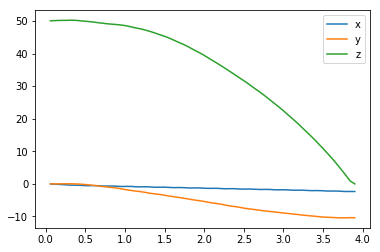

In [109]:
##Plot last-episode trajectory
plt.plot(results['time'], results['x'], label='x')
plt.plot(results['time'], results['y'], label='y')
plt.plot(results['time'], results['z'], label='z')
plt.legend()
_ = plt.ylim()

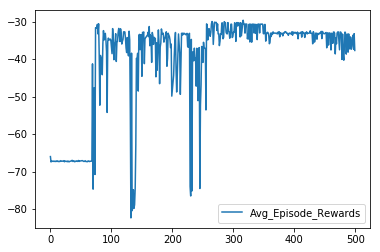

In [110]:
plt.plot(range(len(avg_episode_rewards)), avg_episode_rewards, label='Avg_Episode_Rewards')
plt.legend()
_ = plt.ylim()

**ATTEMPT 6**

In [120]:
'''
Adjusted networks.
'''
'''
Change networks in actor and critic; see agent_new.py 
'''

"""

"""

import sys
import pandas as pd
from agents.agent_new import DDPG
from task import Task

num_episodes = 500
init_pose = np.array([0., 0., 50., 0., 0., 0.])
init_vel = np.array([0., 0., 0.])
init_angle_velocities = np.array([0., 0., 0.])
target_pose = np.array([0., 0., 0., 0., 0., 0.])
target_vel = np.array([0., 0., 0.])
task = Task(init_pose=init_pose, init_vel=init_vel, init_angle_velocities=init_angle_velocities, target_pose=target_pose, target_vel=target_vel)
agent = DDPG(task)
avg_episode_rewards = []
file_output = 'data2.txt'

'''
Leave things the same as before, just record simulation and action history for plotting
'''
labels = ['time', 'x', 'y', 'z', 'phi', 'theta', 'psi', 'x_velocity',
          'y_velocity', 'z_velocity', 'phi_velocity', 'theta_velocity',
          'psi_velocity', 'rotor_speed1', 'rotor_speed2', 'rotor_speed3', 'rotor_speed4']
results = {x : [] for x in labels}

'''
USED THIS REWARD FUNCTION in task.py:
alpha = .3, beta = .3, gamma = 1.

reward = - alpha*(abs(self.sim.pose[:3] - self.target_pose[:3])).sum() - beta*(abs(self.sim.v[:3] - self.target_vel)).sum()/(1 + gamma*(abs(self.sim.pose[:3] - self.target_pose[:3])).sum() ) #velocity only counts when close to ground
'''

for i_episode in range(1, num_episodes+1):
    print("")
    print("i_episode: " + str(i_episode))
    print("")
    print("")
    state = agent.reset_episode() # start a new episode
    time = 0
    total_episode_reward = 0
    count = 0
    
    with open(file_output, 'w') as csvfile:
        writer = csv.writer(csvfile)
        writer.writerow(labels)
    
        while True:
            print("")
            print("time: " + str(time))
            print("sim time: " + str(task.sim.time))
        
            action = agent.act(state) 
            next_state, reward, done = task.step(action)
            print("reward: " + str(reward))
        
            if i_episode == num_episodes: #only write last episode with fully trained actor and critic networks
                to_write = [task.sim.time] + list(task.sim.pose) + list(task.sim.v) + list(task.sim.angular_v) + list(rotor_speeds)
                for ii in range(len(labels)):
                    results[labels[ii]].append(to_write[ii])
                writer.writerow(to_write)
         
            total_episode_reward += reward
            count += 1
        
            agent.step(action, reward, next_state, done)
            state = next_state
            if done:
                break
            time += 1
    
    avg_episode_rewards.append(total_episode_reward/count)
    print("avg_episode_reward: " + str(total_episode_reward/count))
    sys.stdout.flush()




i_episode: 1



time: 0
sim time: 0.0
reward: -45.0320501505

time: 1
sim time: 0.06
reward: -45.1522865523

time: 2
sim time: 0.12000000000000001
reward: -45.311248523

time: 3
sim time: 0.18
reward: -45.51032403

time: 4
sim time: 0.23999999999999996
reward: -45.7807244026

time: 5
sim time: 0.3
reward: -45.9971715303

time: 6
sim time: 0.36000000000000004
reward: -46.1074508817

time: 7
sim time: 0.4200000000000001
reward: -46.1834463835

time: 8
sim time: 0.48000000000000015
reward: -46.1882312867

time: 9
sim time: 0.5400000000000001
reward: -46.0957243395

time: 10
sim time: 0.6000000000000002
reward: -45.9819482642

time: 11
sim time: 0.6600000000000003
reward: -45.9335379514

time: 12
sim time: 0.7200000000000003
reward: -45.9236261099

time: 13
sim time: 0.7800000000000004
reward: -45.8236084546

time: 14
sim time: 0.8400000000000004
reward: -45.5987591295

time: 15
sim time: 0.9000000000000005
reward: -45.5668882876

time: 16
sim time: 0.9600000000000005
reward: -45.51363852


time: 16
sim time: 0.9600000000000005
reward: -42.6484533732

time: 17
sim time: 1.0200000000000005
reward: -42.2522311333

time: 18
sim time: 1.0800000000000005
reward: -41.8088108605

time: 19
sim time: 1.1400000000000006
reward: -41.3408910413

time: 20
sim time: 1.2000000000000006
reward: -40.8556466877

time: 21
sim time: 1.2600000000000007
reward: -40.3268733644

time: 22
sim time: 1.3200000000000007
reward: -39.7583205945

time: 23
sim time: 1.3800000000000008
reward: -39.1830239871

time: 24
sim time: 1.4400000000000008
reward: -38.6116300667

time: 25
sim time: 1.5000000000000009
reward: -38.0523971825

time: 26
sim time: 1.560000000000001
reward: -37.4345468006

time: 27
sim time: 1.620000000000001
reward: -36.6960939915

time: 28
sim time: 1.680000000000001
reward: -35.851387232

time: 29
sim time: 1.740000000000001
reward: -34.9254763485

time: 30
sim time: 1.8000000000000012
reward: -33.9422722235

time: 31
sim time: 1.8600000000000012
reward: -32.9220771178

time: 32
sim


time: 13
sim time: 0.7800000000000004
reward: -47.0064614758

time: 14
sim time: 0.8400000000000004
reward: -47.0274473278

time: 15
sim time: 0.9000000000000005
reward: -47.0237891573

time: 16
sim time: 0.9600000000000005
reward: -47.006757767

time: 17
sim time: 1.0200000000000005
reward: -46.9365364343

time: 18
sim time: 1.0800000000000005
reward: -46.8600169112

time: 19
sim time: 1.1400000000000006
reward: -46.7308304619

time: 20
sim time: 1.2000000000000006
reward: -46.5590330327

time: 21
sim time: 1.2600000000000007
reward: -46.3070784338

time: 22
sim time: 1.3200000000000007
reward: -45.9566309481

time: 23
sim time: 1.3800000000000008
reward: -45.5234909449

time: 24
sim time: 1.4400000000000008
reward: -45.0901698458

time: 25
sim time: 1.5000000000000009
reward: -44.6848974031

time: 26
sim time: 1.560000000000001
reward: -44.3785648092

time: 27
sim time: 1.620000000000001
reward: -44.0409661374

time: 28
sim time: 1.680000000000001
reward: -43.6161102349

time: 29
si


time: 73
sim time: 4.379999999999995
reward: -39.123170242

time: 74
sim time: 4.439999999999993
reward: -39.3355738571

time: 75
sim time: 4.499999999999992
reward: -39.609082539

time: 76
sim time: 4.559999999999991
reward: -39.9113777069

time: 77
sim time: 4.6199999999999894
reward: -40.2382562666

time: 78
sim time: 4.679999999999988
reward: -40.6124089323

time: 79
sim time: 4.739999999999987
reward: -40.9928865713

time: 80
sim time: 4.799999999999986
reward: -41.3017156022

time: 81
sim time: 4.859999999999984
reward: -41.5509371284

time: 82
sim time: 4.919999999999983
reward: -41.7911507239

time: 83
sim time: 4.979999999999982
reward: -42.0005679602
avg_episode_reward: -39.6824188642

i_episode: 7



time: 0
sim time: 0.0
reward: -45.0332152016

time: 1
sim time: 0.06
reward: -45.12925568

time: 2
sim time: 0.12000000000000001
reward: -45.1874111225

time: 3
sim time: 0.18
reward: -45.226107867

time: 4
sim time: 0.23999999999999996
reward: -45.250538657

time: 5
sim time: 


time: 44
sim time: 2.640000000000002
reward: -62.5139687208

time: 45
sim time: 2.700000000000002
reward: -63.1722099791

time: 46
sim time: 2.760000000000002
reward: -63.8875874133

time: 47
sim time: 2.820000000000002
reward: -64.6061041148

time: 48
sim time: 2.880000000000002
reward: -65.2669551078

time: 49
sim time: 2.940000000000002
reward: -65.928715379

time: 50
sim time: 3.000000000000002
reward: -66.6317005645

time: 51
sim time: 3.0600000000000023
reward: -67.3237983946

time: 52
sim time: 3.1200000000000023
reward: -67.9513379706

time: 53
sim time: 3.1800000000000024
reward: -68.6178600061

time: 54
sim time: 3.2400000000000024
reward: -69.2957931011

time: 55
sim time: 3.3000000000000025
reward: -69.9488547458

time: 56
sim time: 3.3600000000000025
reward: -70.5813004332

time: 57
sim time: 3.4200000000000026
reward: -71.1638624745

time: 58
sim time: 3.4800000000000026
reward: -71.7170298483

time: 59
sim time: 3.5400000000000027
reward: -72.2566912531

time: 60
sim ti


time: 33
sim time: 1.9800000000000013
reward: -30.878105528

time: 34
sim time: 2.0400000000000014
reward: -29.9614942839

time: 35
sim time: 2.1000000000000014
reward: -29.0468776973

time: 36
sim time: 2.1600000000000015
reward: -28.1182650854

time: 37
sim time: 2.2200000000000015
reward: -27.141366971

time: 38
sim time: 2.2800000000000016
reward: -26.128844506

time: 39
sim time: 2.3400000000000016
reward: -25.1172354209

time: 40
sim time: 2.4000000000000017
reward: -24.0839928629

time: 41
sim time: 2.4600000000000017
reward: -22.9945972984

time: 42
sim time: 2.520000000000002
reward: -21.9028347867

time: 43
sim time: 2.580000000000002
reward: -20.7778089874

time: 44
sim time: 2.640000000000002
reward: -19.5581635951

time: 45
sim time: 2.700000000000002
reward: -18.2701568928

time: 46
sim time: 2.760000000000002
reward: -16.9229259881

time: 47
sim time: 2.820000000000002
reward: -15.6388469655

time: 48
sim time: 2.880000000000002
reward: -14.3713925957

time: 49
sim time


time: 12
sim time: 0.7200000000000003
reward: -46.6054530169

time: 13
sim time: 0.7800000000000004
reward: -46.6292381175

time: 14
sim time: 0.8400000000000004
reward: -46.5924984567

time: 15
sim time: 0.9000000000000005
reward: -46.5001752934

time: 16
sim time: 0.9600000000000005
reward: -46.4284267093

time: 17
sim time: 1.0200000000000005
reward: -46.3485629895

time: 18
sim time: 1.0800000000000005
reward: -46.195790088

time: 19
sim time: 1.1400000000000006
reward: -46.0228747519

time: 20
sim time: 1.2000000000000006
reward: -45.8785694767

time: 21
sim time: 1.2600000000000007
reward: -45.6959456699

time: 22
sim time: 1.3200000000000007
reward: -45.4508340047

time: 23
sim time: 1.3800000000000008
reward: -45.221067821

time: 24
sim time: 1.4400000000000008
reward: -45.0050961651

time: 25
sim time: 1.5000000000000009
reward: -44.7291130668

time: 26
sim time: 1.560000000000001
reward: -44.4214304798

time: 27
sim time: 1.620000000000001
reward: -44.1480522584

time: 28
si


time: 27
sim time: 1.620000000000001
reward: -57.4305801813

time: 28
sim time: 1.680000000000001
reward: -58.183938005

time: 29
sim time: 1.740000000000001
reward: -58.9508002618

time: 30
sim time: 1.8000000000000012
reward: -59.6876390844

time: 31
sim time: 1.8600000000000012
reward: -60.4652807111

time: 32
sim time: 1.9200000000000013
reward: -61.3006899644

time: 33
sim time: 1.9800000000000013
reward: -62.125222773

time: 34
sim time: 2.0400000000000014
reward: -62.9351943827

time: 35
sim time: 2.1000000000000014
reward: -63.8085307867

time: 36
sim time: 2.1600000000000015
reward: -64.7152824529

time: 37
sim time: 2.2200000000000015
reward: -65.5967629561

time: 38
sim time: 2.2800000000000016
reward: -66.4936917369

time: 39
sim time: 2.3400000000000016
reward: -67.4545502499

time: 40
sim time: 2.4000000000000017
reward: -68.424840681

time: 41
sim time: 2.4600000000000017
reward: -69.37012402

time: 42
sim time: 2.520000000000002
reward: -70.3611781865

time: 43
sim tim


time: 19
sim time: 1.1400000000000006
reward: -48.0890030039

time: 20
sim time: 1.2000000000000006
reward: -48.4114033769

time: 21
sim time: 1.2600000000000007
reward: -48.8148450113

time: 22
sim time: 1.3200000000000007
reward: -49.2549707321

time: 23
sim time: 1.3800000000000008
reward: -49.6630467722

time: 24
sim time: 1.4400000000000008
reward: -50.0888249519

time: 25
sim time: 1.5000000000000009
reward: -50.5811679142

time: 26
sim time: 1.560000000000001
reward: -51.0963175071

time: 27
sim time: 1.620000000000001
reward: -51.5623333989

time: 28
sim time: 1.680000000000001
reward: -52.0922519361

time: 29
sim time: 1.740000000000001
reward: -52.665734062

time: 30
sim time: 1.8000000000000012
reward: -53.2328495669

time: 31
sim time: 1.8600000000000012
reward: -53.7789960563

time: 32
sim time: 1.9200000000000013
reward: -54.3962867014

time: 33
sim time: 1.9800000000000013
reward: -55.0446487381

time: 34
sim time: 2.0400000000000014
reward: -55.6538746923

time: 35
sim


time: 9
sim time: 0.5400000000000001
reward: -45.5821097401

time: 10
sim time: 0.6000000000000002
reward: -45.7436616148

time: 11
sim time: 0.6600000000000003
reward: -45.9473617396

time: 12
sim time: 0.7200000000000003
reward: -46.1300882918

time: 13
sim time: 0.7800000000000004
reward: -46.3141844317

time: 14
sim time: 0.8400000000000004
reward: -46.5768513276

time: 15
sim time: 0.9000000000000005
reward: -46.8701928776

time: 16
sim time: 0.9600000000000005
reward: -47.1128008318

time: 17
sim time: 1.0200000000000005
reward: -47.4149870076

time: 18
sim time: 1.0800000000000005
reward: -47.7701405808

time: 19
sim time: 1.1400000000000006
reward: -48.1311706511

time: 20
sim time: 1.2000000000000006
reward: -48.4574843699

time: 21
sim time: 1.2600000000000007
reward: -48.8646951049

time: 22
sim time: 1.3200000000000007
reward: -49.3088900171

time: 23
sim time: 1.3800000000000008
reward: -49.721233408

time: 24
sim time: 1.4400000000000008
reward: -50.1511782497

time: 25



time: 7
sim time: 0.4200000000000001
reward: -46.2713802446

time: 8
sim time: 0.48000000000000015
reward: -46.3782037523

time: 9
sim time: 0.5400000000000001
reward: -46.5033740823

time: 10
sim time: 0.6000000000000002
reward: -46.592249292

time: 11
sim time: 0.6600000000000003
reward: -46.602369357

time: 12
sim time: 0.7200000000000003
reward: -46.6029490909

time: 13
sim time: 0.7800000000000004
reward: -46.6142994

time: 14
sim time: 0.8400000000000004
reward: -46.5596436353

time: 15
sim time: 0.9000000000000005
reward: -46.4436729348

time: 16
sim time: 0.9600000000000005
reward: -46.3416403486

time: 17
sim time: 1.0200000000000005
reward: -46.2238668996

time: 18
sim time: 1.0800000000000005
reward: -46.0244588729

time: 19
sim time: 1.1400000000000006
reward: -45.7955639136

time: 20
sim time: 1.2000000000000006
reward: -45.5856341693

time: 21
sim time: 1.2600000000000007
reward: -45.3267608766

time: 22
sim time: 1.3200000000000007
reward: -44.994547167

time: 23
sim ti


time: 24
sim time: 1.4400000000000008
reward: -44.4267631246

time: 25
sim time: 1.5000000000000009
reward: -43.9903671287

time: 26
sim time: 1.560000000000001
reward: -43.500271218

time: 27
sim time: 1.620000000000001
reward: -43.0656949746

time: 28
sim time: 1.680000000000001
reward: -42.6635619786

time: 29
sim time: 1.740000000000001
reward: -42.1992053233

time: 30
sim time: 1.8000000000000012
reward: -41.7431233871

time: 31
sim time: 1.8600000000000012
reward: -41.3130383106

time: 32
sim time: 1.9200000000000013
reward: -40.839918447

time: 33
sim time: 1.9800000000000013
reward: -40.3306223511

time: 34
sim time: 2.0400000000000014
reward: -39.858033754

time: 35
sim time: 2.1000000000000014
reward: -39.3886493564

time: 36
sim time: 2.1600000000000015
reward: -38.8688513383

time: 37
sim time: 2.2200000000000015
reward: -38.352609561

time: 38
sim time: 2.2800000000000016
reward: -37.8752574322

time: 39
sim time: 2.3400000000000016
reward: -37.3770098618

time: 40
sim ti


time: 36
sim time: 2.1600000000000015
reward: -39.1431521351

time: 37
sim time: 2.2200000000000015
reward: -38.5303747926

time: 38
sim time: 2.2800000000000016
reward: -37.9431555409

time: 39
sim time: 2.3400000000000016
reward: -37.3122483482

time: 40
sim time: 2.4000000000000017
reward: -36.6239019821

time: 41
sim time: 2.4600000000000017
reward: -35.9566768566

time: 42
sim time: 2.520000000000002
reward: -35.2911471079

time: 43
sim time: 2.580000000000002
reward: -34.5599383191

time: 44
sim time: 2.640000000000002
reward: -33.8047677607

time: 45
sim time: 2.700000000000002
reward: -33.0802971618

time: 46
sim time: 2.760000000000002
reward: -32.3217696798

time: 47
sim time: 2.820000000000002
reward: -31.4893184672

time: 48
sim time: 2.880000000000002
reward: -30.5976930072

time: 49
sim time: 2.940000000000002
reward: -29.6747856331

time: 50
sim time: 3.000000000000002
reward: -28.6977722278

time: 51
sim time: 3.0600000000000023
reward: -27.6656509794

time: 52
sim tim


time: 51
sim time: 3.0600000000000023
reward: -34.8837029269

time: 52
sim time: 3.1200000000000023
reward: -34.6353983503

time: 53
sim time: 3.1800000000000024
reward: -34.4417951824

time: 54
sim time: 3.2400000000000024
reward: -34.2233811097

time: 55
sim time: 3.3000000000000025
reward: -33.9977201955

time: 56
sim time: 3.3600000000000025
reward: -33.7594415281

time: 57
sim time: 3.4200000000000026
reward: -33.5356757387

time: 58
sim time: 3.4800000000000026
reward: -33.3468738172

time: 59
sim time: 3.5400000000000027
reward: -33.1752876557

time: 60
sim time: 3.6000000000000028
reward: -33.4782506215
avg_episode_reward: -41.4747240871

i_episode: 28



time: 0
sim time: 0.0
reward: -45.0506322522

time: 1
sim time: 0.06
reward: -45.1907303735

time: 2
sim time: 0.12000000000000001
reward: -45.3063869083

time: 3
sim time: 0.18
reward: -45.4634380674

time: 4
sim time: 0.23999999999999996
reward: -45.6618285576

time: 5
sim time: 0.3
reward: -45.8995388879

time: 6
sim time:


time: 3
sim time: 0.18
reward: -45.4628271819

time: 4
sim time: 0.23999999999999996
reward: -45.6586774217

time: 5
sim time: 0.3
reward: -45.8920721318

time: 6
sim time: 0.36000000000000004
reward: -46.1176269298

time: 7
sim time: 0.4200000000000001
reward: -46.261250329

time: 8
sim time: 0.48000000000000015
reward: -46.366840461

time: 9
sim time: 0.5400000000000001
reward: -46.4905885324

time: 10
sim time: 0.6000000000000002
reward: -46.5775532836

time: 11
sim time: 0.6600000000000003
reward: -46.5854537139

time: 12
sim time: 0.7200000000000003
reward: -46.5836105494

time: 13
sim time: 0.7800000000000004
reward: -46.5920400467

time: 14
sim time: 0.8400000000000004
reward: -46.5340899785

time: 15
sim time: 0.9000000000000005
reward: -46.4149561823

time: 16
sim time: 0.9600000000000005
reward: -46.3098128209

time: 17
sim time: 1.0200000000000005
reward: -46.1886310068

time: 18
sim time: 1.0800000000000005
reward: -45.9858456159

time: 19
sim time: 1.1400000000000006
rewa


time: 15
sim time: 0.9000000000000005
reward: -46.5252462692

time: 16
sim time: 0.9600000000000005
reward: -46.4311407213

time: 17
sim time: 1.0200000000000005
reward: -46.3176261464

time: 18
sim time: 1.0800000000000005
reward: -46.1199267734

time: 19
sim time: 1.1400000000000006
reward: -45.8917719746

time: 20
sim time: 1.2000000000000006
reward: -45.6785176277

time: 21
sim time: 1.2600000000000007
reward: -45.4113125279

time: 22
sim time: 1.3200000000000007
reward: -45.0662472681

time: 23
sim time: 1.3800000000000008
reward: -44.7191004433

time: 24
sim time: 1.4400000000000008
reward: -44.3643175586

time: 25
sim time: 1.5000000000000009
reward: -43.9264032872

time: 26
sim time: 1.560000000000001
reward: -43.4533245062

time: 27
sim time: 1.620000000000001
reward: -43.0586427503

time: 28
sim time: 1.680000000000001
reward: -42.6442490304

time: 29
sim time: 1.740000000000001
reward: -42.1624092197

time: 30
sim time: 1.8000000000000012
reward: -41.682814168

time: 31
sim


time: 30
sim time: 1.8000000000000012
reward: -41.6700014581

time: 31
sim time: 1.8600000000000012
reward: -41.2160509787

time: 32
sim time: 1.9200000000000013
reward: -40.7139671937

time: 33
sim time: 1.9800000000000013
reward: -40.1688083498

time: 34
sim time: 2.0400000000000014
reward: -39.6556007089

time: 35
sim time: 2.1000000000000014
reward: -39.142739578

time: 36
sim time: 2.1600000000000015
reward: -38.5705403033

time: 37
sim time: 2.2200000000000015
reward: -37.9939944362

time: 38
sim time: 2.2800000000000016
reward: -37.4553666612

time: 39
sim time: 2.3400000000000016
reward: -36.888585025

time: 40
sim time: 2.4000000000000017
reward: -36.2723684863

time: 41
sim time: 2.4600000000000017
reward: -35.6899006854

time: 42
sim time: 2.520000000000002
reward: -35.1292300518

time: 43
sim time: 2.580000000000002
reward: -34.5206375105

time: 44
sim time: 2.640000000000002
reward: -33.8950386638

time: 45
sim time: 2.700000000000002
reward: -33.3219102967

time: 46
sim 


time: 21
sim time: 1.2600000000000007
reward: -65.2930931398

time: 22
sim time: 1.3200000000000007
reward: -65.9382095132

time: 23
sim time: 1.3800000000000008
reward: -66.3753081612

time: 24
sim time: 1.4400000000000008
reward: -66.6103312686

time: 25
sim time: 1.5000000000000009
reward: -66.6605452762

time: 26
sim time: 1.560000000000001
reward: -66.5974850971

time: 27
sim time: 1.620000000000001
reward: -66.4123463488

time: 28
sim time: 1.680000000000001
reward: -66.1154627158

time: 29
sim time: 1.740000000000001
reward: -65.7364482702

time: 30
sim time: 1.8000000000000012
reward: -65.2914090496

time: 31
sim time: 1.8600000000000012
reward: -64.8222633422

time: 32
sim time: 1.9200000000000013
reward: -64.3963548727

time: 33
sim time: 1.9800000000000013
reward: -63.936131322

time: 34
sim time: 2.0400000000000014
reward: -63.4029217194

time: 35
sim time: 2.1000000000000014
reward: -62.8445386956

time: 36
sim time: 2.1600000000000015
reward: -62.3968171891

time: 37
sim


time: 19
sim time: 1.1400000000000006
reward: -46.083727245

time: 20
sim time: 1.2000000000000006
reward: -45.9291706571

time: 21
sim time: 1.2600000000000007
reward: -45.7312817881

time: 22
sim time: 1.3200000000000007
reward: -45.4687063893

time: 23
sim time: 1.3800000000000008
reward: -45.2195895821

time: 24
sim time: 1.4400000000000008
reward: -44.9795335232

time: 25
sim time: 1.5000000000000009
reward: -44.6749199595

time: 26
sim time: 1.560000000000001
reward: -44.3375710916

time: 27
sim time: 1.620000000000001
reward: -44.0359639006

time: 28
sim time: 1.680000000000001
reward: -43.7334113508

time: 29
sim time: 1.740000000000001
reward: -43.361439775

time: 30
sim time: 1.8000000000000012
reward: -42.9664503159

time: 31
sim time: 1.8600000000000012
reward: -42.6284342926

time: 32
sim time: 1.9200000000000013
reward: -42.3276593332

time: 33
sim time: 1.9800000000000013
reward: -42.117152418

time: 34
sim time: 2.0400000000000014
reward: -41.9534045236

time: 35
sim t


time: 16
sim time: 0.9600000000000005
reward: -40.4277404012

time: 17
sim time: 1.0200000000000005
reward: -39.7946161005

time: 18
sim time: 1.0800000000000005
reward: -39.1076172112

time: 19
sim time: 1.1400000000000006
reward: -38.3628669245

time: 20
sim time: 1.2000000000000006
reward: -37.5558729848

time: 21
sim time: 1.2600000000000007
reward: -36.6814109136

time: 22
sim time: 1.3200000000000007
reward: -35.7333805977

time: 23
sim time: 1.3800000000000008
reward: -34.7046310115

time: 24
sim time: 1.4400000000000008
reward: -33.5867489554

time: 25
sim time: 1.5000000000000009
reward: -32.3698125478

time: 26
sim time: 1.560000000000001
reward: -31.0421245919

time: 27
sim time: 1.620000000000001
reward: -29.5899811048

time: 28
sim time: 1.680000000000001
reward: -27.9976389129

time: 29
sim time: 1.740000000000001
reward: -26.2479496721

time: 30
sim time: 1.8000000000000012
reward: -24.3250304061

time: 31
sim time: 1.8600000000000012
reward: -22.2233131802

time: 32
si


time: 1
sim time: 0.06
reward: -44.9720011941

time: 2
sim time: 0.12000000000000001
reward: -44.9134846241

time: 3
sim time: 0.18
reward: -44.8229746945

time: 4
sim time: 0.23999999999999996
reward: -44.7001977264

time: 5
sim time: 0.3
reward: -44.5447649508

time: 6
sim time: 0.36000000000000004
reward: -44.356167498

time: 7
sim time: 0.4200000000000001
reward: -44.1337696359

time: 8
sim time: 0.48000000000000015
reward: -43.8768000537

time: 9
sim time: 0.5400000000000001
reward: -43.5843409249

time: 10
sim time: 0.6000000000000002
reward: -43.2553144023

time: 11
sim time: 0.6600000000000003
reward: -42.8884661467

time: 12
sim time: 0.7200000000000003
reward: -42.4823454001

time: 13
sim time: 0.7800000000000004
reward: -42.0352808638

time: 14
sim time: 0.8400000000000004
reward: -41.5453515286

time: 15
sim time: 0.9000000000000005
reward: -41.0103514205

time: 16
sim time: 0.9600000000000005
reward: -40.4277468628

time: 17
sim time: 1.0200000000000005
reward: -39.794624


time: 24
sim time: 1.4400000000000008
reward: -33.5867212001

time: 25
sim time: 1.5000000000000009
reward: -32.3697775196

time: 26
sim time: 1.560000000000001
reward: -31.042081073

time: 27
sim time: 1.620000000000001
reward: -29.5899278161

time: 28
sim time: 1.680000000000001
reward: -27.9975761232

time: 29
sim time: 1.740000000000001
reward: -26.2478802325

time: 30
sim time: 1.8000000000000012
reward: -24.3249578995

time: 31
sim time: 1.8600000000000012
reward: -22.2232387509

time: 32
sim time: 1.9200000000000013
reward: -19.9785492366

time: 33
sim time: 1.9800000000000013
reward: -17.7915123129

time: 34
sim time: 2.0400000000000014
reward: -16.7600691594

time: 35
sim time: 2.1000000000000014
reward: -24.7633308508

time: 36
sim time: 2.1600000000000015
reward: -57.293343002
avg_episode_reward: -36.8772240029

i_episode: 48



time: 0
sim time: 0.0
reward: -44.9986863307

time: 1
sim time: 0.06
reward: -44.972001193

time: 2
sim time: 0.12000000000000001
reward: -44.91348


time: 29
sim time: 1.740000000000001
reward: -33.540970613

time: 30
sim time: 1.8000000000000012
reward: -32.687017142

time: 31
sim time: 1.8600000000000012
reward: -31.7741156954

time: 32
sim time: 1.9200000000000013
reward: -30.8507545371

time: 33
sim time: 1.9800000000000013
reward: -29.9223461983

time: 34
sim time: 2.0400000000000014
reward: -28.9381857783

time: 35
sim time: 2.1000000000000014
reward: -27.906958786

time: 36
sim time: 2.1600000000000015
reward: -26.870804537

time: 37
sim time: 2.2200000000000015
reward: -25.824284399

time: 38
sim time: 2.2800000000000016
reward: -24.7239156272

time: 39
sim time: 2.3400000000000016
reward: -23.5775887415

time: 40
sim time: 2.4000000000000017
reward: -22.43434064

time: 41
sim time: 2.4600000000000017
reward: -21.2843291803

time: 42
sim time: 2.520000000000002
reward: -20.0875254648

time: 43
sim time: 2.580000000000002
reward: -18.8387103777

time: 44
sim time: 2.640000000000002
reward: -17.6210346594

time: 45
sim time:


time: 32
sim time: 1.9200000000000013
reward: -29.7878352046

time: 33
sim time: 1.9800000000000013
reward: -29.0456488574

time: 34
sim time: 2.0400000000000014
reward: -28.3087673176

time: 35
sim time: 2.1000000000000014
reward: -27.5735992252

time: 36
sim time: 2.1600000000000015
reward: -26.8352152234

time: 37
sim time: 2.2200000000000015
reward: -26.0877318473

time: 38
sim time: 2.2800000000000016
reward: -25.3247151966

time: 39
sim time: 2.3400000000000016
reward: -24.5506459713

time: 40
sim time: 2.4000000000000017
reward: -23.752056108

time: 41
sim time: 2.4600000000000017
reward: -22.9228846659

time: 42
sim time: 2.520000000000002
reward: -22.0540336288

time: 43
sim time: 2.580000000000002
reward: -21.1732846664

time: 44
sim time: 2.640000000000002
reward: -20.2956798922

time: 45
sim time: 2.700000000000002
reward: -19.4240627119

time: 46
sim time: 2.760000000000002
reward: -18.5660513373

time: 47
sim time: 2.820000000000002
reward: -17.7083466958

time: 48
sim t


time: 31
sim time: 1.8600000000000012
reward: -22.2234555443

time: 32
sim time: 1.9200000000000013
reward: -19.9788293462

time: 33
sim time: 1.9800000000000013
reward: -17.7918612411

time: 34
sim time: 2.0400000000000014
reward: -16.7103831596

time: 35
sim time: 2.1000000000000014
reward: -29.3783967886

time: 36
sim time: 2.1600000000000015
reward: -149.027501188
avg_episode_reward: -39.4799556165

i_episode: 57



time: 0
sim time: 0.0
reward: -44.9986863304

time: 1
sim time: 0.06
reward: -44.972001188

time: 2
sim time: 0.12000000000000001
reward: -44.9134845841

time: 3
sim time: 0.18
reward: -44.8229745849

time: 4
sim time: 0.23999999999999996
reward: -44.7001975175

time: 5
sim time: 0.3
reward: -44.5447646123

time: 6
sim time: 0.36000000000000004
reward: -44.3561670053

time: 7
sim time: 0.4200000000000001
reward: -44.1337689717

time: 8
sim time: 0.48000000000000015
reward: -43.8767991898

time: 9
sim time: 0.5400000000000001
reward: -43.5843397987

time: 10
sim time: 0


time: 18
sim time: 1.0800000000000005
reward: -39.1076125992

time: 19
sim time: 1.1400000000000006
reward: -38.3628607136

time: 20
sim time: 1.2000000000000006
reward: -37.5558646885

time: 21
sim time: 1.2600000000000007
reward: -36.6813999349

time: 22
sim time: 1.3200000000000007
reward: -35.7333662168

time: 23
sim time: 1.3800000000000008
reward: -34.7046124017

time: 24
sim time: 1.4400000000000008
reward: -33.5867252346

time: 25
sim time: 1.5000000000000009
reward: -32.3697828105

time: 26
sim time: 1.560000000000001
reward: -31.0420879915

time: 27
sim time: 1.620000000000001
reward: -29.5899370126

time: 28
sim time: 1.680000000000001
reward: -27.997587224

time: 29
sim time: 1.740000000000001
reward: -26.2478913658

time: 30
sim time: 1.8000000000000012
reward: -24.3249683258

time: 31
sim time: 1.8600000000000012
reward: -22.223247416

time: 32
sim time: 1.9200000000000013
reward: -19.9785545316

time: 33
sim time: 1.9800000000000013
reward: -17.8209043521

time: 34
sim 


time: 3
sim time: 0.18
reward: -44.8229746719

time: 4
sim time: 0.23999999999999996
reward: -44.7001977039

time: 5
sim time: 0.3
reward: -44.5447649287

time: 6
sim time: 0.36000000000000004
reward: -44.3561674653

time: 7
sim time: 0.4200000000000001
reward: -44.1337695852

time: 8
sim time: 0.48000000000000015
reward: -43.8767999886

time: 9
sim time: 0.5400000000000001
reward: -43.5843408449

time: 10
sim time: 0.6000000000000002
reward: -43.2553142898

time: 11
sim time: 0.6600000000000003
reward: -42.888465973

time: 12
sim time: 0.7200000000000003
reward: -42.4823451258

time: 13
sim time: 0.7800000000000004
reward: -42.0352804265

time: 14
sim time: 0.8400000000000004
reward: -41.5453508411

time: 15
sim time: 0.9000000000000005
reward: -41.0103503635

time: 16
sim time: 0.9600000000000005
reward: -40.4277452838

time: 17
sim time: 1.0200000000000005
reward: -39.7946222219

time: 18
sim time: 1.0800000000000005
reward: -39.1076248322

time: 19
sim time: 1.1400000000000006
rew


time: 26
sim time: 1.560000000000001
reward: -31.2312110169

time: 27
sim time: 1.620000000000001
reward: -30.0156991953

time: 28
sim time: 1.680000000000001
reward: -28.7643364312

time: 29
sim time: 1.740000000000001
reward: -27.5059056688

time: 30
sim time: 1.8000000000000012
reward: -26.1938864249

time: 31
sim time: 1.8600000000000012
reward: -24.8388600415

time: 32
sim time: 1.9200000000000013
reward: -23.5124719459

time: 33
sim time: 1.9800000000000013
reward: -22.1711304799

time: 34
sim time: 2.0400000000000014
reward: -20.748550187

time: 35
sim time: 2.1000000000000014
reward: -19.3234126461

time: 36
sim time: 2.1600000000000015
reward: -17.9590007535

time: 37
sim time: 2.2200000000000015
reward: -16.5805159402

time: 38
sim time: 2.2800000000000016
reward: -15.1068357556

time: 39
sim time: 2.3400000000000016
reward: -13.7164170872

time: 40
sim time: 2.4000000000000017
reward: -12.4905391893

time: 41
sim time: 2.4600000000000017
reward: -11.2863804525

time: 42
sim


time: 2
sim time: 0.12000000000000001
reward: -45.0415724157

time: 3
sim time: 0.18
reward: -45.0254726836

time: 4
sim time: 0.23999999999999996
reward: -44.9893100793

time: 5
sim time: 0.3
reward: -44.8662282782

time: 6
sim time: 0.36000000000000004
reward: -44.7346041862

time: 7
sim time: 0.4200000000000001
reward: -44.6214762561

time: 8
sim time: 0.48000000000000015
reward: -44.4375810675

time: 9
sim time: 0.5400000000000001
reward: -44.1845560381

time: 10
sim time: 0.6000000000000002
reward: -43.948495582

time: 11
sim time: 0.6600000000000003
reward: -43.7031871273

time: 12
sim time: 0.7200000000000003
reward: -43.3712921579

time: 13
sim time: 0.7800000000000004
reward: -43.0013499683

time: 14
sim time: 0.8400000000000004
reward: -42.6550221098

time: 15
sim time: 0.9000000000000005
reward: -42.2671632221

time: 16
sim time: 0.9600000000000005
reward: -41.7967103373

time: 17
sim time: 1.0200000000000005
reward: -41.3182961768

time: 18
sim time: 1.0800000000000005
rew


time: 26
sim time: 1.560000000000001
reward: -35.6886012625

time: 27
sim time: 1.620000000000001
reward: -34.8787904268

time: 28
sim time: 1.680000000000001
reward: -34.0506498459

time: 29
sim time: 1.740000000000001
reward: -33.2267004722

time: 30
sim time: 1.8000000000000012
reward: -32.3531693852

time: 31
sim time: 1.8600000000000012
reward: -31.4204754172

time: 32
sim time: 1.9200000000000013
reward: -30.4794262666

time: 33
sim time: 1.9800000000000013
reward: -29.5317209111

time: 34
sim time: 2.0400000000000014
reward: -28.5291987896

time: 35
sim time: 2.1000000000000014
reward: -27.4781417628

time: 36
sim time: 2.1600000000000015
reward: -26.4247152293

time: 37
sim time: 2.2200000000000015
reward: -25.3611373786

time: 38
sim time: 2.2800000000000016
reward: -24.2427267939

time: 39
sim time: 2.3400000000000016
reward: -23.078898837

time: 40
sim time: 2.4000000000000017
reward: -21.9202272917

time: 41
sim time: 2.4600000000000017
reward: -20.7569253122

time: 42
sim


time: 50
sim time: 3.000000000000002
reward: -10.0140324088

time: 51
sim time: 3.0600000000000023
reward: -9.18389263669

time: 52
sim time: 3.1200000000000023
reward: -9.12699734948

time: 53
sim time: 3.1800000000000024
reward: -10.968821344

time: 54
sim time: 3.2400000000000024
reward: -14.742384901
avg_episode_reward: -31.5659336601

i_episode: 75



time: 0
sim time: 0.0
reward: -45.0068732481

time: 1
sim time: 0.06
reward: -45.0316946925

time: 2
sim time: 0.12000000000000001
reward: -45.0413189754

time: 3
sim time: 0.18
reward: -45.0247632234

time: 4
sim time: 0.23999999999999996
reward: -44.9874630693

time: 5
sim time: 0.3
reward: -44.8638192523

time: 6
sim time: 0.36000000000000004
reward: -44.7326876968

time: 7
sim time: 0.4200000000000001
reward: -44.6194036447

time: 8
sim time: 0.48000000000000015
reward: -44.4339256841

time: 9
sim time: 0.5400000000000001
reward: -44.1810116788

time: 10
sim time: 0.6000000000000002
reward: -43.9456601554

time: 11
sim time: 0.6


time: 19
sim time: 1.1400000000000006
reward: -40.3181232007

time: 20
sim time: 1.2000000000000006
reward: -39.7222861741

time: 21
sim time: 1.2600000000000007
reward: -39.139675018

time: 22
sim time: 1.3200000000000007
reward: -38.537751061

time: 23
sim time: 1.3800000000000008
reward: -37.8580517231

time: 24
sim time: 1.4400000000000008
reward: -37.1468078909

time: 25
sim time: 1.5000000000000009
reward: -36.4480381657

time: 26
sim time: 1.560000000000001
reward: -35.7079081905

time: 27
sim time: 1.620000000000001
reward: -34.89749147

time: 28
sim time: 1.680000000000001
reward: -34.0733426472

time: 29
sim time: 1.740000000000001
reward: -33.2508520202

time: 30
sim time: 1.8000000000000012
reward: -32.3747439845

time: 31
sim time: 1.8600000000000012
reward: -31.4426378234

time: 32
sim time: 1.9200000000000013
reward: -30.5056744642

time: 33
sim time: 1.9800000000000013
reward: -29.5587335606

time: 34
sim time: 2.0400000000000014
reward: -28.5541486047

time: 35
sim ti


time: 43
sim time: 2.580000000000002
reward: -18.2997922552

time: 44
sim time: 2.640000000000002
reward: -17.0737716911

time: 45
sim time: 2.700000000000002
reward: -15.8567950449

time: 46
sim time: 2.760000000000002
reward: -14.587282548

time: 47
sim time: 2.820000000000002
reward: -13.3018939767

time: 48
sim time: 2.880000000000002
reward: -12.1362596948

time: 49
sim time: 2.940000000000002
reward: -11.0720236472

time: 50
sim time: 3.000000000000002
reward: -10.0054583384

time: 51
sim time: 3.0600000000000023
reward: -9.16837209658

time: 52
sim time: 3.1200000000000023
reward: -9.11527721063

time: 53
sim time: 3.1800000000000024
reward: -11.1117485118

time: 54
sim time: 3.2400000000000024
reward: -15.385093911
avg_episode_reward: -31.5680787004

i_episode: 80



time: 0
sim time: 0.0
reward: -45.0068791213

time: 1
sim time: 0.06
reward: -45.0317891162

time: 2
sim time: 0.12000000000000001
reward: -45.0416337392

time: 3
sim time: 0.18
reward: -45.0257548025

time: 4
sim


time: 12
sim time: 0.7200000000000003
reward: -43.3690070272

time: 13
sim time: 0.7800000000000004
reward: -43.0011540114

time: 14
sim time: 0.8400000000000004
reward: -42.656874242

time: 15
sim time: 0.9000000000000005
reward: -42.2664487533

time: 16
sim time: 0.9600000000000005
reward: -41.7946565051

time: 17
sim time: 1.0200000000000005
reward: -41.3188556905

time: 18
sim time: 1.0800000000000005
reward: -40.8514328663

time: 19
sim time: 1.1400000000000006
reward: -40.3146940669

time: 20
sim time: 1.2000000000000006
reward: -39.7180791898

time: 21
sim time: 1.2600000000000007
reward: -39.133266451

time: 22
sim time: 1.3200000000000007
reward: -38.5321739321

time: 23
sim time: 1.3800000000000008
reward: -37.8539393335

time: 24
sim time: 1.4400000000000008
reward: -37.1411072233

time: 25
sim time: 1.5000000000000009
reward: -36.4409091744

time: 26
sim time: 1.560000000000001
reward: -35.702238573

time: 27
sim time: 1.620000000000001
reward: -34.8923545559

time: 28
sim


time: 36
sim time: 2.1600000000000015
reward: -26.4395012669

time: 37
sim time: 2.2200000000000015
reward: -25.3762061384

time: 38
sim time: 2.2800000000000016
reward: -24.257611174

time: 39
sim time: 2.3400000000000016
reward: -23.0944934919

time: 40
sim time: 2.4000000000000017
reward: -21.937009853

time: 41
sim time: 2.4600000000000017
reward: -20.7736062688

time: 42
sim time: 2.520000000000002
reward: -19.5564322444

time: 43
sim time: 2.580000000000002
reward: -18.3008341755

time: 44
sim time: 2.640000000000002
reward: -17.0751405567

time: 45
sim time: 2.700000000000002
reward: -15.8580304607

time: 46
sim time: 2.760000000000002
reward: -14.5882233622

time: 47
sim time: 2.820000000000002
reward: -13.3031386866

time: 48
sim time: 2.880000000000002
reward: -12.1378847646

time: 49
sim time: 2.940000000000002
reward: -11.073315717

time: 50
sim time: 3.000000000000002
reward: -10.0053456571

time: 51
sim time: 3.0600000000000023
reward: -9.16910379065

time: 52
sim time: 


time: 2
sim time: 0.12000000000000001
reward: -45.2586669203

time: 3
sim time: 0.18
reward: -45.3541243498

time: 4
sim time: 0.23999999999999996
reward: -45.4523048703

time: 5
sim time: 0.3
reward: -45.5175646366

time: 6
sim time: 0.36000000000000004
reward: -45.5744615768

time: 7
sim time: 0.4200000000000001
reward: -45.6047569999

time: 8
sim time: 0.48000000000000015
reward: -45.5846598905

time: 9
sim time: 0.5400000000000001
reward: -45.535318703

time: 10
sim time: 0.6000000000000002
reward: -45.464640234

time: 11
sim time: 0.6600000000000003
reward: -45.3470783561

time: 12
sim time: 0.7200000000000003
reward: -45.2130622542

time: 13
sim time: 0.7800000000000004
reward: -45.0192659534

time: 14
sim time: 0.8400000000000004
reward: -44.7873028634

time: 15
sim time: 0.9000000000000005
reward: -44.4817558125

time: 16
sim time: 0.9600000000000005
reward: -44.0791276064

time: 17
sim time: 1.0200000000000005
reward: -43.6657092505

time: 18
sim time: 1.0800000000000005
rewa


time: 23
sim time: 1.3800000000000008
reward: -37.8465017266

time: 24
sim time: 1.4400000000000008
reward: -37.1323571708

time: 25
sim time: 1.5000000000000009
reward: -36.4309085049

time: 26
sim time: 1.560000000000001
reward: -35.6928323266

time: 27
sim time: 1.620000000000001
reward: -34.883014849

time: 28
sim time: 1.680000000000001
reward: -34.0553097126

time: 29
sim time: 1.740000000000001
reward: -33.2315806562

time: 30
sim time: 1.8000000000000012
reward: -32.3579574901

time: 31
sim time: 1.8600000000000012
reward: -31.4254466283

time: 32
sim time: 1.9200000000000013
reward: -30.4848852827

time: 33
sim time: 1.9800000000000013
reward: -29.5374206943

time: 34
sim time: 2.0400000000000014
reward: -28.5349292886

time: 35
sim time: 2.1000000000000014
reward: -27.4841064429

time: 36
sim time: 2.1600000000000015
reward: -26.4310721225

time: 37
sim time: 2.2200000000000015
reward: -25.3676920615

time: 38
sim time: 2.2800000000000016
reward: -24.2493725564

time: 39
sim


time: 47
sim time: 2.820000000000002
reward: -13.3111919649

time: 48
sim time: 2.880000000000002
reward: -12.147471183

time: 49
sim time: 2.940000000000002
reward: -11.0811746132

time: 50
sim time: 3.000000000000002
reward: -10.0078071374

time: 51
sim time: 3.0600000000000023
reward: -9.17508859823

time: 52
sim time: 3.1200000000000023
reward: -9.12237132231

time: 53
sim time: 3.1800000000000024
reward: -10.8668610342

time: 54
sim time: 3.2400000000000024
reward: -15.106881239
avg_episode_reward: -31.5633051248

i_episode: 92



time: 0
sim time: 0.0
reward: -45.0069546837

time: 1
sim time: 0.06
reward: -45.0322362941

time: 2
sim time: 0.12000000000000001
reward: -45.0424097094

time: 3
sim time: 0.18
reward: -45.0273144091

time: 4
sim time: 0.23999999999999996
reward: -44.9885599023

time: 5
sim time: 0.3
reward: -44.8642079531

time: 6
sim time: 0.36000000000000004
reward: -44.7369050064

time: 7
sim time: 0.4200000000000001
reward: -44.6244551659

time: 8
sim time: 0.4800


time: 16
sim time: 0.9600000000000005
reward: -41.7905052228

time: 17
sim time: 1.0200000000000005
reward: -41.3137217666

time: 18
sim time: 1.0800000000000005
reward: -40.8460025921

time: 19
sim time: 1.1400000000000006
reward: -40.3096026954

time: 20
sim time: 1.2000000000000006
reward: -39.7125718097

time: 21
sim time: 1.2600000000000007
reward: -39.1269170247

time: 22
sim time: 1.3200000000000007
reward: -38.525848007

time: 23
sim time: 1.3800000000000008
reward: -37.8478640078

time: 24
sim time: 1.4400000000000008
reward: -37.1344068693

time: 25
sim time: 1.5000000000000009
reward: -36.4336101636

time: 26
sim time: 1.560000000000001
reward: -35.695196581

time: 27
sim time: 1.620000000000001
reward: -34.8853387537

time: 28
sim time: 1.680000000000001
reward: -34.0583886489

time: 29
sim time: 1.740000000000001
reward: -33.2350182058

time: 30
sim time: 1.8000000000000012
reward: -32.3611069755

time: 31
sim time: 1.8600000000000012
reward: -31.4330160577

time: 32
sim 


time: 37
sim time: 2.2200000000000015
reward: -37.7191463872

time: 38
sim time: 2.2800000000000016
reward: -36.8886738695

time: 39
sim time: 2.3400000000000016
reward: -36.0540774518

time: 40
sim time: 2.4000000000000017
reward: -35.4174059308

time: 41
sim time: 2.4600000000000017
reward: -34.7966872054

time: 42
sim time: 2.520000000000002
reward: -34.1219250535

time: 43
sim time: 2.580000000000002
reward: -33.4378131965

time: 44
sim time: 2.640000000000002
reward: -32.7281264159

time: 45
sim time: 2.700000000000002
reward: -31.9392953299

time: 46
sim time: 2.760000000000002
reward: -31.0924520514

time: 47
sim time: 2.820000000000002
reward: -30.2109294702

time: 48
sim time: 2.880000000000002
reward: -29.2760320803

time: 49
sim time: 2.940000000000002
reward: -28.2545746387

time: 50
sim time: 3.000000000000002
reward: -27.1642768524

time: 51
sim time: 3.0600000000000023
reward: -26.0415242955

time: 52
sim time: 3.1200000000000023
reward: -24.9080621851

time: 53
sim tim


time: 45
sim time: 2.700000000000002
reward: -55.1145894367

time: 46
sim time: 2.760000000000002
reward: -55.532822796

time: 47
sim time: 2.820000000000002
reward: -56.0151858718

time: 48
sim time: 2.880000000000002
reward: -56.4670502179

time: 49
sim time: 2.940000000000002
reward: -56.8941165625

time: 50
sim time: 3.000000000000002
reward: -57.3616628497

time: 51
sim time: 3.0600000000000023
reward: -57.8804160324

time: 52
sim time: 3.1200000000000023
reward: -58.3384938716

time: 53
sim time: 3.1800000000000024
reward: -58.8035553153

time: 54
sim time: 3.2400000000000024
reward: -59.3257791335

time: 55
sim time: 3.3000000000000025
reward: -59.8560200055

time: 56
sim time: 3.3600000000000025
reward: -60.3347510184

time: 57
sim time: 3.4200000000000026
reward: -60.8414279953

time: 58
sim time: 3.4800000000000026
reward: -61.4109061389

time: 59
sim time: 3.5400000000000027
reward: -61.9395111553

time: 60
sim time: 3.6000000000000028
reward: -62.4495191072

time: 61
sim t


time: 12
sim time: 0.7200000000000003
reward: -44.9848800051

time: 13
sim time: 0.7800000000000004
reward: -44.7107414792

time: 14
sim time: 0.8400000000000004
reward: -44.5829548765

time: 15
sim time: 0.9000000000000005
reward: -44.3697694647

time: 16
sim time: 0.9600000000000005
reward: -43.9733996562

time: 17
sim time: 1.0200000000000005
reward: -43.6529472237

time: 18
sim time: 1.0800000000000005
reward: -43.4286657324

time: 19
sim time: 1.1400000000000006
reward: -43.035958398

time: 20
sim time: 1.2000000000000006
reward: -42.5384632194

time: 21
sim time: 1.2600000000000007
reward: -42.1783460402

time: 22
sim time: 1.3200000000000007
reward: -41.8184812351

time: 23
sim time: 1.3800000000000008
reward: -41.2609267715

time: 24
sim time: 1.4400000000000008
reward: -40.7024103601

time: 25
sim time: 1.5000000000000009
reward: -40.2803181975

time: 26
sim time: 1.560000000000001
reward: -39.7584910479

time: 27
sim time: 1.620000000000001
reward: -39.0730461335

time: 28
s


time: 29
sim time: 1.740000000000001
reward: -37.4663168268

time: 30
sim time: 1.8000000000000012
reward: -36.7869867281

time: 31
sim time: 1.8600000000000012
reward: -36.0250383914

time: 32
sim time: 1.9200000000000013
reward: -35.4049062526

time: 33
sim time: 1.9800000000000013
reward: -34.786093254

time: 34
sim time: 2.0400000000000014
reward: -33.9969219058

time: 35
sim time: 2.1000000000000014
reward: -33.2241076363

time: 36
sim time: 2.1600000000000015
reward: -32.5887525242

time: 37
sim time: 2.2200000000000015
reward: -31.8720006028

time: 38
sim time: 2.2800000000000016
reward: -31.0224507392

time: 39
sim time: 2.3400000000000016
reward: -30.2736510883

time: 40
sim time: 2.4000000000000017
reward: -29.6033086847

time: 41
sim time: 2.4600000000000017
reward: -28.8045114586

time: 42
sim time: 2.520000000000002
reward: -27.9506728589

time: 43
sim time: 2.580000000000002
reward: -27.2198359327

time: 44
sim time: 2.640000000000002
reward: -26.5265469332

time: 45
sim


time: 21
sim time: 1.2600000000000007
reward: -47.7900325043

time: 22
sim time: 1.3200000000000007
reward: -47.7535070345

time: 23
sim time: 1.3800000000000008
reward: -47.7154785751

time: 24
sim time: 1.4400000000000008
reward: -47.6601969093

time: 25
sim time: 1.5000000000000009
reward: -47.6996303165

time: 26
sim time: 1.560000000000001
reward: -47.7798284701

time: 27
sim time: 1.620000000000001
reward: -47.8654686449

time: 28
sim time: 1.680000000000001
reward: -47.8232181289

time: 29
sim time: 1.740000000000001
reward: -47.7306196714

time: 30
sim time: 1.8000000000000012
reward: -47.6484431706

time: 31
sim time: 1.8600000000000012
reward: -47.481314826

time: 32
sim time: 1.9200000000000013
reward: -47.2891017941

time: 33
sim time: 1.9800000000000013
reward: -47.0912847167

time: 34
sim time: 2.0400000000000014
reward: -46.8790232861

time: 35
sim time: 2.1000000000000014
reward: -46.6453962929

time: 36
sim time: 2.1600000000000015
reward: -46.5610463811

time: 37
sim


time: 25
sim time: 1.5000000000000009
reward: -51.7284525753

time: 26
sim time: 1.560000000000001
reward: -51.9110543475

time: 27
sim time: 1.620000000000001
reward: -51.9284797888

time: 28
sim time: 1.680000000000001
reward: -51.855463688

time: 29
sim time: 1.740000000000001
reward: -51.9240291781

time: 30
sim time: 1.8000000000000012
reward: -51.9900243708

time: 31
sim time: 1.8600000000000012
reward: -51.8686947858

time: 32
sim time: 1.9200000000000013
reward: -51.7635258293

time: 33
sim time: 1.9800000000000013
reward: -51.797917741

time: 34
sim time: 2.0400000000000014
reward: -51.7324894078

time: 35
sim time: 2.1000000000000014
reward: -51.5231650859

time: 36
sim time: 2.1600000000000015
reward: -51.4221806578

time: 37
sim time: 2.2200000000000015
reward: -51.397041396

time: 38
sim time: 2.2800000000000016
reward: -51.2122084849

time: 39
sim time: 2.3400000000000016
reward: -50.9724697092

time: 40
sim time: 2.4000000000000017
reward: -50.8835956464

time: 41
sim t


time: 13
sim time: 0.7800000000000004
reward: -44.7591689947

time: 14
sim time: 0.8400000000000004
reward: -44.6477451174

time: 15
sim time: 0.9000000000000005
reward: -44.4591114354

time: 16
sim time: 0.9600000000000005
reward: -44.090123933

time: 17
sim time: 1.0200000000000005
reward: -43.7951352537

time: 18
sim time: 1.0800000000000005
reward: -43.6033144961

time: 19
sim time: 1.1400000000000006
reward: -43.2501353033

time: 20
sim time: 1.2000000000000006
reward: -42.7928646432

time: 21
sim time: 1.2600000000000007
reward: -42.4734267571

time: 22
sim time: 1.3200000000000007
reward: -42.1635557291

time: 23
sim time: 1.3800000000000008
reward: -41.661800674

time: 24
sim time: 1.4400000000000008
reward: -41.1561498156

time: 25
sim time: 1.5000000000000009
reward: -40.7918251949

time: 26
sim time: 1.560000000000001
reward: -40.3353700026

time: 27
sim time: 1.620000000000001
reward: -39.7170531801

time: 28
sim time: 1.680000000000001
reward: -39.1865160338

time: 29
sim


time: 32
sim time: 1.9200000000000013
reward: -37.234054278

time: 33
sim time: 1.9800000000000013
reward: -36.83618135

time: 34
sim time: 2.0400000000000014
reward: -36.3048059968

time: 35
sim time: 2.1000000000000014
reward: -35.8256396229

time: 36
sim time: 2.1600000000000015
reward: -35.4927916461

time: 37
sim time: 2.2200000000000015
reward: -35.1056271893

time: 38
sim time: 2.2800000000000016
reward: -34.6432877356

time: 39
sim time: 2.3400000000000016
reward: -34.3195516496

time: 40
sim time: 2.4000000000000017
reward: -34.0698545253

time: 41
sim time: 2.4600000000000017
reward: -33.7522070818

time: 42
sim time: 2.520000000000002
reward: -33.4551216296

time: 43
sim time: 2.580000000000002
reward: -33.3073682679

time: 44
sim time: 2.640000000000002
reward: -33.1616729308

time: 45
sim time: 2.700000000000002
reward: -32.9859761925

time: 46
sim time: 2.760000000000002
reward: -32.9143432917

time: 47
sim time: 2.820000000000002
reward: -32.9150660224

time: 48
sim tim


time: 48
sim time: 2.880000000000002
reward: -19.6552708856

time: 49
sim time: 2.940000000000002
reward: -18.5257554986

time: 50
sim time: 3.000000000000002
reward: -17.5095196603

time: 51
sim time: 3.0600000000000023
reward: -16.5624594486

time: 52
sim time: 3.1200000000000023
reward: -15.5111323873

time: 53
sim time: 3.1800000000000024
reward: -14.4251412811

time: 54
sim time: 3.2400000000000024
reward: -13.3707994285

time: 55
sim time: 3.3000000000000025
reward: -12.3214430288

time: 56
sim time: 3.3600000000000025
reward: -11.2437054907
avg_episode_reward: -34.3139208263

i_episode: 113



time: 0
sim time: 0.0
reward: -45.0504178163

time: 1
sim time: 0.06
reward: -45.2060404229

time: 2
sim time: 0.12000000000000001
reward: -45.3320231778

time: 3
sim time: 0.18
reward: -45.4608056819

time: 4
sim time: 0.23999999999999996
reward: -45.5604238375

time: 5
sim time: 0.3
reward: -45.4968759635

time: 6
sim time: 0.36000000000000004
reward: -45.478778786

time: 7
sim time: 0.


time: 11
sim time: 0.6600000000000003
reward: -45.2306284887

time: 12
sim time: 0.7200000000000003
reward: -44.9880089361

time: 13
sim time: 0.7800000000000004
reward: -44.7254126034

time: 14
sim time: 0.8400000000000004
reward: -44.6115246203

time: 15
sim time: 0.9000000000000005
reward: -44.4107455325

time: 16
sim time: 0.9600000000000005
reward: -44.0336396607

time: 17
sim time: 1.0200000000000005
reward: -43.7406684977

time: 18
sim time: 1.0800000000000005
reward: -43.5441226293

time: 19
sim time: 1.1400000000000006
reward: -43.1820033014

time: 20
sim time: 1.2000000000000006
reward: -42.7261644281

time: 21
sim time: 1.2600000000000007
reward: -42.4151031405

time: 22
sim time: 1.3200000000000007
reward: -42.1059695789

time: 23
sim time: 1.3800000000000008
reward: -41.6085513257

time: 24
sim time: 1.4400000000000008
reward: -41.1230882165

time: 25
sim time: 1.5000000000000009
reward: -40.779853794

time: 26
sim time: 1.560000000000001
reward: -40.3423454275

time: 27



time: 25
sim time: 1.5000000000000009
reward: -40.6626647846

time: 26
sim time: 1.560000000000001
reward: -40.2027683789

time: 27
sim time: 1.620000000000001
reward: -39.5842910061

time: 28
sim time: 1.680000000000001
reward: -39.057936712

time: 29
sim time: 1.740000000000001
reward: -38.6210753329

time: 30
sim time: 1.8000000000000012
reward: -38.0334317532

time: 31
sim time: 1.8600000000000012
reward: -37.3694353381

time: 32
sim time: 1.9200000000000013
reward: -36.8500634585

time: 33
sim time: 1.9800000000000013
reward: -36.3326248662

time: 34
sim time: 2.0400000000000014
reward: -35.6521350887

time: 35
sim time: 2.1000000000000014
reward: -34.9949666765

time: 36
sim time: 2.1600000000000015
reward: -34.4749234943

time: 37
sim time: 2.2200000000000015
reward: -33.8769474574

time: 38
sim time: 2.2800000000000016
reward: -33.1567628824

time: 39
sim time: 2.3400000000000016
reward: -32.5447512564

time: 40
sim time: 2.4000000000000017
reward: -32.0083036007

time: 41
sim


time: 43
sim time: 2.580000000000002
reward: -23.9491363929

time: 44
sim time: 2.640000000000002
reward: -22.8449192489

time: 45
sim time: 2.700000000000002
reward: -21.5683244895

time: 46
sim time: 2.760000000000002
reward: -20.3128018554

time: 47
sim time: 2.820000000000002
reward: -19.1676477601

time: 48
sim time: 2.880000000000002
reward: -17.9265737521

time: 49
sim time: 2.940000000000002
reward: -16.5717901396

time: 50
sim time: 3.000000000000002
reward: -15.3157445614

time: 51
sim time: 3.0600000000000023
reward: -14.1387865122

time: 52
sim time: 3.1200000000000023
reward: -12.8628637922

time: 53
sim time: 3.1800000000000024
reward: -11.6279715808

time: 54
sim time: 3.2400000000000024
reward: -10.640330779

time: 55
sim time: 3.3000000000000025
reward: -9.88322382234

time: 56
sim time: 3.3600000000000025
reward: -9.60969409342
avg_episode_reward: -33.8018791883

i_episode: 120



time: 0
sim time: 0.0
reward: -45.0503721666

time: 1
sim time: 0.06
reward: -45.205539


time: 3
sim time: 0.18
reward: -45.4608594843

time: 4
sim time: 0.23999999999999996
reward: -45.5609912726

time: 5
sim time: 0.3
reward: -45.498277832

time: 6
sim time: 0.36000000000000004
reward: -45.4814571988

time: 7
sim time: 0.4200000000000001
reward: -45.5811577629

time: 8
sim time: 0.48000000000000015
reward: -45.5243712527

time: 9
sim time: 0.5400000000000001
reward: -45.3343006783

time: 10
sim time: 0.6000000000000002
reward: -45.2704639595

time: 11
sim time: 0.6600000000000003
reward: -45.236992611

time: 12
sim time: 0.7200000000000003
reward: -45.0029168225

time: 13
sim time: 0.7800000000000004
reward: -44.7408307484

time: 14
sim time: 0.8400000000000004
reward: -44.6305446039

time: 15
sim time: 0.9000000000000005
reward: -44.4454611423

time: 16
sim time: 0.9600000000000005
reward: -44.0837023349

time: 17
sim time: 1.0200000000000005
reward: -43.802520443

time: 18
sim time: 1.0800000000000005
reward: -43.6294434616

time: 19
sim time: 1.1400000000000006
rewar


time: 13
sim time: 0.7800000000000004
reward: -44.7737118367

time: 14
sim time: 0.8400000000000004
reward: -44.6726628241

time: 15
sim time: 0.9000000000000005
reward: -44.4819145252

time: 16
sim time: 0.9600000000000005
reward: -44.1217165666

time: 17
sim time: 1.0200000000000005
reward: -43.8554327869

time: 18
sim time: 1.0800000000000005
reward: -43.6847821744

time: 19
sim time: 1.1400000000000006
reward: -43.3525866649

time: 20
sim time: 1.2000000000000006
reward: -42.9403468579

time: 21
sim time: 1.2600000000000007
reward: -42.6826347041

time: 22
sim time: 1.3200000000000007
reward: -42.4295623587

time: 23
sim time: 1.3800000000000008
reward: -42.0030169878

time: 24
sim time: 1.4400000000000008
reward: -41.6056255865

time: 25
sim time: 1.5000000000000009
reward: -41.3587903253

time: 26
sim time: 1.560000000000001
reward: -41.0303854217

time: 27
sim time: 1.620000000000001
reward: -40.5741344364

time: 28
sim time: 1.680000000000001
reward: -40.2394577253

time: 29
s


time: 28
sim time: 1.680000000000001
reward: -39.5615446068

time: 29
sim time: 1.740000000000001
reward: -39.16992269

time: 30
sim time: 1.8000000000000012
reward: -38.6174689522

time: 31
sim time: 1.8600000000000012
reward: -37.9928313682

time: 32
sim time: 1.9200000000000013
reward: -37.508423904

time: 33
sim time: 1.9800000000000013
reward: -37.0063991924

time: 34
sim time: 2.0400000000000014
reward: -36.3283122258

time: 35
sim time: 2.1000000000000014
reward: -35.6703266985

time: 36
sim time: 2.1600000000000015
reward: -35.13384616

time: 37
sim time: 2.2200000000000015
reward: -34.4948765742

time: 38
sim time: 2.2800000000000016
reward: -33.7162935732

time: 39
sim time: 2.3400000000000016
reward: -33.0306212527

time: 40
sim time: 2.4000000000000017
reward: -32.4008403777

time: 41
sim time: 2.4600000000000017
reward: -31.6184651749

time: 42
sim time: 2.520000000000002
reward: -30.7703465937

time: 43
sim time: 2.580000000000002
reward: -30.0472868331

time: 44
sim tim


time: 48
sim time: 2.880000000000002
reward: -33.6597073179

time: 49
sim time: 2.940000000000002
reward: -33.7577039604

time: 50
sim time: 3.000000000000002
reward: -33.8966675694

time: 51
sim time: 3.0600000000000023
reward: -34.0164272322

time: 52
sim time: 3.1200000000000023
reward: -34.1363119442

time: 53
sim time: 3.1800000000000024
reward: -34.20772613

time: 54
sim time: 3.2400000000000024
reward: -34.2193815361

time: 55
sim time: 3.3000000000000025
reward: -34.2372853963

time: 56
sim time: 3.3600000000000025
reward: -34.1704523176

time: 57
sim time: 3.4200000000000026
reward: -33.9565306332

time: 58
sim time: 3.4800000000000026
reward: -33.8841424335
avg_episode_reward: -39.1542907461

i_episode: 129



time: 0
sim time: 0.0
reward: -45.0504211243

time: 1
sim time: 0.06
reward: -45.1997485628

time: 2
sim time: 0.12000000000000001
reward: -45.4110301283

time: 3
sim time: 0.18
reward: -45.6757527827

time: 4
sim time: 0.23999999999999996
reward: -46.0343304993

time:


time: 4
sim time: 0.23999999999999996
reward: -45.5576048549

time: 5
sim time: 0.3
reward: -45.4931319695

time: 6
sim time: 0.36000000000000004
reward: -45.4782971128

time: 7
sim time: 0.4200000000000001
reward: -45.5764677108

time: 8
sim time: 0.48000000000000015
reward: -45.5134046703

time: 9
sim time: 0.5400000000000001
reward: -45.3210155732

time: 10
sim time: 0.6000000000000002
reward: -45.2552528683

time: 11
sim time: 0.6600000000000003
reward: -45.2127206544

time: 12
sim time: 0.7200000000000003
reward: -44.9661285696

time: 13
sim time: 0.7800000000000004
reward: -44.6935583076

time: 14
sim time: 0.8400000000000004
reward: -44.5683704686

time: 15
sim time: 0.9000000000000005
reward: -44.3575466

time: 16
sim time: 0.9600000000000005
reward: -43.9667854631

time: 17
sim time: 1.0200000000000005
reward: -43.6551074037

time: 18
sim time: 1.0800000000000005
reward: -43.4404893642

time: 19
sim time: 1.1400000000000006
reward: -43.059290051

time: 20
sim time: 1.20000000

reward: -40.859439234

time: 23
sim time: 1.3800000000000008
reward: -40.0702083537

time: 24
sim time: 1.4400000000000008
reward: -39.2381517594

time: 25
sim time: 1.5000000000000009
reward: -38.2696830121

time: 26
sim time: 1.560000000000001
reward: -37.2440038027

time: 27
sim time: 1.620000000000001
reward: -36.2648324916

time: 28
sim time: 1.680000000000001
reward: -35.4949020061

time: 29
sim time: 1.740000000000001
reward: -34.6638241066

time: 30
sim time: 1.8000000000000012
reward: -33.8371034222

time: 31
sim time: 1.8600000000000012
reward: -33.0006107233

time: 32
sim time: 1.9200000000000013
reward: -32.0892715826

time: 33
sim time: 1.9800000000000013
reward: -31.1276406163

time: 34
sim time: 2.0400000000000014
reward: -30.1988809531

time: 35
sim time: 2.1000000000000014
reward: -29.2122957084

time: 36
sim time: 2.1600000000000015
reward: -28.1534559731

time: 37
sim time: 2.2200000000000015
reward: -27.1097969363

time: 38
sim time: 2.2800000000000016
reward: -26.0


time: 42
sim time: 2.520000000000002
reward: -25.4536850841

time: 43
sim time: 2.580000000000002
reward: -24.3373580047

time: 44
sim time: 2.640000000000002
reward: -23.1901256477

time: 45
sim time: 2.700000000000002
reward: -21.8649438274

time: 46
sim time: 2.760000000000002
reward: -20.5504968162

time: 47
sim time: 2.820000000000002
reward: -19.3449116484

time: 48
sim time: 2.880000000000002
reward: -18.048778039

time: 49
sim time: 2.940000000000002
reward: -16.6276179515

time: 50
sim time: 3.000000000000002
reward: -15.3092622926

time: 51
sim time: 3.0600000000000023
reward: -14.0732463105

time: 52
sim time: 3.1200000000000023
reward: -12.7559996333

time: 53
sim time: 3.1800000000000024
reward: -11.460187072

time: 54
sim time: 3.2400000000000024
reward: -10.2585209381

time: 55
sim time: 3.3000000000000025
reward: -9.43682795302

time: 56
sim time: 3.3600000000000025
reward: -9.12534498413
avg_episode_reward: -34.0168742252

i_episode: 136



time: 0
sim time: 0.0
rewar


time: 1
sim time: 0.06
reward: -45.2065009834

time: 2
sim time: 0.12000000000000001
reward: -45.3336377393

time: 3
sim time: 0.18
reward: -45.4641774522

time: 4
sim time: 0.23999999999999996
reward: -45.5628984575

time: 5
sim time: 0.3
reward: -45.4987346639

time: 6
sim time: 0.36000000000000004
reward: -45.489376249

time: 7
sim time: 0.4200000000000001
reward: -45.5908296814

time: 8
sim time: 0.48000000000000015
reward: -45.5296172274

time: 9
sim time: 0.5400000000000001
reward: -45.3400948411

time: 10
sim time: 0.6000000000000002
reward: -45.2805883423

time: 11
sim time: 0.6600000000000003
reward: -45.2399268931

time: 12
sim time: 0.7200000000000003
reward: -44.9931905629

time: 13
sim time: 0.7800000000000004
reward: -44.7221548575

time: 14
sim time: 0.8400000000000004
reward: -44.5956358302

time: 15
sim time: 0.9000000000000005
reward: -44.3777640742

time: 16
sim time: 0.9600000000000005
reward: -43.9764171893

time: 17
sim time: 1.0200000000000005
reward: -43.652365


time: 20
sim time: 1.2000000000000006
reward: -42.6011805884

time: 21
sim time: 1.2600000000000007
reward: -42.2466684258

time: 22
sim time: 1.3200000000000007
reward: -41.8800444027

time: 23
sim time: 1.3800000000000008
reward: -41.3120158288

time: 24
sim time: 1.4400000000000008
reward: -40.7477020762

time: 25
sim time: 1.5000000000000009
reward: -40.3113675679

time: 26
sim time: 1.560000000000001
reward: -39.7607831244

time: 27
sim time: 1.620000000000001
reward: -39.044458336

time: 28
sim time: 1.680000000000001
reward: -38.4154223821

time: 29
sim time: 1.740000000000001
reward: -37.8464443504

time: 30
sim time: 1.8000000000000012
reward: -37.0941905186

time: 31
sim time: 1.8600000000000012
reward: -36.2564837896

time: 32
sim time: 1.9200000000000013
reward: -35.5409456154

time: 33
sim time: 1.9800000000000013
reward: -34.7874417524

time: 34
sim time: 2.0400000000000014
reward: -33.8338437119

time: 35
sim time: 2.1000000000000014
reward: -32.8852708056

time: 36
sim


time: 40
sim time: 2.4000000000000017
reward: -28.8635182929

time: 41
sim time: 2.4600000000000017
reward: -27.9822606563

time: 42
sim time: 2.520000000000002
reward: -27.0546149523

time: 43
sim time: 2.580000000000002
reward: -26.27430757

time: 44
sim time: 2.640000000000002
reward: -25.4853526697

time: 45
sim time: 2.700000000000002
reward: -24.5647230688

time: 46
sim time: 2.760000000000002
reward: -23.6935970005

time: 47
sim time: 2.820000000000002
reward: -22.9449734279

time: 48
sim time: 2.880000000000002
reward: -22.132841698

time: 49
sim time: 2.940000000000002
reward: -21.2305879352

time: 50
sim time: 3.000000000000002
reward: -20.4518572738

time: 51
sim time: 3.0600000000000023
reward: -19.7227426914

time: 52
sim time: 3.1200000000000023
reward: -18.9097573995

time: 53
sim time: 3.1800000000000024
reward: -18.0830145639

time: 54
sim time: 3.2400000000000024
reward: -17.3949247566

time: 55
sim time: 3.3000000000000025
reward: -16.7041271546

time: 56
sim time: 

avg_episode_reward: -34.2304239046

i_episode: 145



time: 0
sim time: 0.0
reward: -45.0504057399

time: 1
sim time: 0.06
reward: -45.2058763961

time: 2
sim time: 0.12000000000000001
reward: -45.3313718816

time: 3
sim time: 0.18
reward: -45.4596355673

time: 4
sim time: 0.23999999999999996
reward: -45.5585608774

time: 5
sim time: 0.3
reward: -45.4955222262

time: 6
sim time: 0.36000000000000004
reward: -45.4764440959

time: 7
sim time: 0.4200000000000001
reward: -45.5736692298

time: 8
sim time: 0.48000000000000015
reward: -45.5130707847

time: 9
sim time: 0.5400000000000001
reward: -45.3176391414

time: 10
sim time: 0.6000000000000002
reward: -45.2445551636

time: 11
sim time: 0.6600000000000003
reward: -45.198759316

time: 12
sim time: 0.7200000000000003
reward: -44.9479363281

time: 13
sim time: 0.7800000000000004
reward: -44.6632491725

time: 14
sim time: 0.8400000000000004
reward: -44.5235857893

time: 15
sim time: 0.9000000000000005
reward: -44.3010863662

time: 16
sim time: 


time: 20
sim time: 1.2000000000000006
reward: -42.5395594993

time: 21
sim time: 1.2600000000000007
reward: -42.1957887261

time: 22
sim time: 1.3200000000000007
reward: -41.85826913

time: 23
sim time: 1.3800000000000008
reward: -41.3298047834

time: 24
sim time: 1.4400000000000008
reward: -40.8049366563

time: 25
sim time: 1.5000000000000009
reward: -40.4228353155

time: 26
sim time: 1.560000000000001
reward: -39.9498150776

time: 27
sim time: 1.620000000000001
reward: -39.3207139599

time: 28
sim time: 1.680000000000001
reward: -38.7872687729

time: 29
sim time: 1.740000000000001
reward: -38.3396836663

time: 30
sim time: 1.8000000000000012
reward: -37.7387974874

time: 31
sim time: 1.8600000000000012
reward: -37.0634513268

time: 32
sim time: 1.9200000000000013
reward: -36.5348075519

time: 33
sim time: 1.9800000000000013
reward: -36.0054904398

time: 34
sim time: 2.0400000000000014
reward: -35.3124644462

time: 35
sim time: 2.1000000000000014
reward: -34.6445161942

time: 36
sim 


time: 38
sim time: 2.2800000000000016
reward: -32.4895536801

time: 39
sim time: 2.3400000000000016
reward: -31.7746057366

time: 40
sim time: 2.4000000000000017
reward: -31.1351800383

time: 41
sim time: 2.4600000000000017
reward: -30.360067676

time: 42
sim time: 2.520000000000002
reward: -29.5141924548

time: 43
sim time: 2.580000000000002
reward: -28.8084448613

time: 44
sim time: 2.640000000000002
reward: -28.0975246422

time: 45
sim time: 2.700000000000002
reward: -27.235009161

time: 46
sim time: 2.760000000000002
reward: -26.3938374415

time: 47
sim time: 2.820000000000002
reward: -25.6800347598

time: 48
sim time: 2.880000000000002
reward: -24.897690968

time: 49
sim time: 2.940000000000002
reward: -23.9924735702

time: 50
sim time: 3.000000000000002
reward: -23.1065775262

time: 51
sim time: 3.0600000000000023
reward: -22.1930318321

time: 52
sim time: 3.1200000000000023
reward: -21.247681949

time: 53
sim time: 3.1800000000000024
reward: -20.3097589319

time: 54
sim time: 3


time: 54
sim time: 3.2400000000000024
reward: -20.7596282559

time: 55
sim time: 3.3000000000000025
reward: -20.0629300245

time: 56
sim time: 3.3600000000000025
reward: -19.2877718536

time: 57
sim time: 3.4200000000000026
reward: -18.8481830438
avg_episode_reward: -36.3854235625

i_episode: 152



time: 0
sim time: 0.0
reward: -45.050440257

time: 1
sim time: 0.06
reward: -45.206272491

time: 2
sim time: 0.12000000000000001
reward: -45.3327819901

time: 3
sim time: 0.18
reward: -45.4623312866

time: 4
sim time: 0.23999999999999996
reward: -45.5614526157

time: 5
sim time: 0.3
reward: -45.497222411

time: 6
sim time: 0.36000000000000004
reward: -45.4824324249

time: 7
sim time: 0.4200000000000001
reward: -45.5803391409

time: 8
sim time: 0.48000000000000015
reward: -45.5175461682

time: 9
sim time: 0.5400000000000001
reward: -45.3221752378

time: 10
sim time: 0.6000000000000002
reward: -45.2532967059

time: 11
sim time: 0.6600000000000003
reward: -45.2074116217

time: 12
sim time: 0.


time: 13
sim time: 0.7800000000000004
reward: -44.718238282

time: 14
sim time: 0.8400000000000004
reward: -44.5975500016

time: 15
sim time: 0.9000000000000005
reward: -44.4032104321

time: 16
sim time: 0.9600000000000005
reward: -44.0235808272

time: 17
sim time: 1.0200000000000005
reward: -43.7105424716

time: 18
sim time: 1.0800000000000005
reward: -43.5010058404

time: 19
sim time: 1.1400000000000006
reward: -43.1278407337

time: 20
sim time: 1.2000000000000006
reward: -42.639807934

time: 21
sim time: 1.2600000000000007
reward: -42.2817129468

time: 22
sim time: 1.3200000000000007
reward: -41.9310296785

time: 23
sim time: 1.3800000000000008
reward: -41.3788684314

time: 24
sim time: 1.4400000000000008
reward: -40.8089831955

time: 25
sim time: 1.5000000000000009
reward: -40.3723669459

time: 26
sim time: 1.560000000000001
reward: -39.8373971922

time: 27
sim time: 1.620000000000001
reward: -39.1248768406

time: 28
sim time: 1.680000000000001
reward: -38.4844660519

time: 29
sim


time: 32
sim time: 1.9200000000000013
reward: -36.6179529252

time: 33
sim time: 1.9800000000000013
reward: -36.0592844726

time: 34
sim time: 2.0400000000000014
reward: -35.3271499351

time: 35
sim time: 2.1000000000000014
reward: -34.6137336636

time: 36
sim time: 2.1600000000000015
reward: -34.0275366449

time: 37
sim time: 2.2200000000000015
reward: -33.3474977623

time: 38
sim time: 2.2800000000000016
reward: -32.532169411

time: 39
sim time: 2.3400000000000016
reward: -31.8125279258

time: 40
sim time: 2.4000000000000017
reward: -31.1573382693

time: 41
sim time: 2.4600000000000017
reward: -30.3598753077

time: 42
sim time: 2.520000000000002
reward: -29.5045846972

time: 43
sim time: 2.580000000000002
reward: -28.7807751405

time: 44
sim time: 2.640000000000002
reward: -28.0420298004

time: 45
sim time: 2.700000000000002
reward: -27.158107293

time: 46
sim time: 2.760000000000002
reward: -26.3049596046

time: 47
sim time: 2.820000000000002
reward: -25.5639349186

time: 48
sim ti


time: 50
sim time: 3.000000000000002
reward: -19.3923481471

time: 51
sim time: 3.0600000000000023
reward: -18.212477639

time: 52
sim time: 3.1200000000000023
reward: -17.0568533146

time: 53
sim time: 3.1800000000000024
reward: -15.9524602027

time: 54
sim time: 3.2400000000000024
reward: -14.8295025683

time: 55
sim time: 3.3000000000000025
reward: -13.6775502483

time: 56
sim time: 3.3600000000000025
reward: -12.7138242593
avg_episode_reward: -35.197072108

i_episode: 159



time: 0
sim time: 0.0
reward: -45.0503852077

time: 1
sim time: 0.06
reward: -45.2059816861

time: 2
sim time: 0.12000000000000001
reward: -45.3319260944

time: 3
sim time: 0.18
reward: -45.4608846587

time: 4
sim time: 0.23999999999999996
reward: -45.5592865177

time: 5
sim time: 0.3
reward: -45.4960383717

time: 6
sim time: 0.36000000000000004
reward: -45.4815149174

time: 7
sim time: 0.4200000000000001
reward: -45.5810201599

time: 8
sim time: 0.48000000000000015
reward: -45.5201971387

time: 9
sim time: 0.


time: 10
sim time: 0.6000000000000002
reward: -45.2736905724

time: 11
sim time: 0.6600000000000003
reward: -45.2364919162

time: 12
sim time: 0.7200000000000003
reward: -44.9966702061

time: 13
sim time: 0.7800000000000004
reward: -44.7362611237

time: 14
sim time: 0.8400000000000004
reward: -44.6249045856

time: 15
sim time: 0.9000000000000005
reward: -44.4265179232

time: 16
sim time: 0.9600000000000005
reward: -44.0533685206

time: 17
sim time: 1.0200000000000005
reward: -43.7661570932

time: 18
sim time: 1.0800000000000005
reward: -43.5759192565

time: 19
sim time: 1.1400000000000006
reward: -43.2212561135

time: 20
sim time: 1.2000000000000006
reward: -42.777379983

time: 21
sim time: 1.2600000000000007
reward: -42.4807307223

time: 22
sim time: 1.3200000000000007
reward: -42.187009827

time: 23
sim time: 1.3800000000000008
reward: -41.7100817111

time: 24
sim time: 1.4400000000000008
reward: -41.2513245675

time: 25
sim time: 1.5000000000000009
reward: -40.9385576818

time: 26



time: 26
sim time: 1.560000000000001
reward: -39.0888144997

time: 27
sim time: 1.620000000000001
reward: -38.3030554543

time: 28
sim time: 1.680000000000001
reward: -37.6214245976

time: 29
sim time: 1.740000000000001
reward: -37.0110841724

time: 30
sim time: 1.8000000000000012
reward: -36.2222427821

time: 31
sim time: 1.8600000000000012
reward: -35.3398207815

time: 32
sim time: 1.9200000000000013
reward: -34.5813430292

time: 33
sim time: 1.9800000000000013
reward: -33.7967169095

time: 34
sim time: 2.0400000000000014
reward: -32.8144344421

time: 35
sim time: 2.1000000000000014
reward: -31.8340254697

time: 36
sim time: 2.1600000000000015
reward: -30.9649878966

time: 37
sim time: 2.2200000000000015
reward: -29.9798813691

time: 38
sim time: 2.2800000000000016
reward: -28.8320032379

time: 39
sim time: 2.3400000000000016
reward: -27.8140326816

time: 40
sim time: 2.4000000000000017
reward: -26.8828145134

time: 41
sim time: 2.4600000000000017
reward: -25.7997926738

time: 42
si


time: 48
sim time: 2.880000000000002
reward: -34.6860293752

time: 49
sim time: 2.940000000000002
reward: -34.7205028526

time: 50
sim time: 3.000000000000002
reward: -34.8872933345

time: 51
sim time: 3.0600000000000023
reward: -35.0670962684

time: 52
sim time: 3.1200000000000023
reward: -35.2183018737

time: 53
sim time: 3.1800000000000024
reward: -35.3960718182

time: 54
sim time: 3.2400000000000024
reward: -35.6546837758

time: 55
sim time: 3.3000000000000025
reward: -35.8908433641

time: 56
sim time: 3.3600000000000025
reward: -36.0947206941

time: 57
sim time: 3.4200000000000026
reward: -36.3582423505

time: 58
sim time: 3.4800000000000026
reward: -36.6342420377

time: 59
sim time: 3.5400000000000027
reward: -36.8796146293

time: 60
sim time: 3.6000000000000028
reward: -37.10090166

time: 61
sim time: 3.660000000000003
reward: -37.3727443498

time: 62
sim time: 3.720000000000003
reward: -37.9266074726
avg_episode_reward: -39.6118309414

i_episode: 166



time: 0
sim time: 0.0
r


time: 3
sim time: 0.18
reward: -45.4594125622

time: 4
sim time: 0.23999999999999996
reward: -45.5582129326

time: 5
sim time: 0.3
reward: -45.494711123

time: 6
sim time: 0.36000000000000004
reward: -45.4754161051

time: 7
sim time: 0.4200000000000001
reward: -45.5719599868

time: 8
sim time: 0.48000000000000015
reward: -45.5098593942

time: 9
sim time: 0.5400000000000001
reward: -45.3133459831

time: 10
sim time: 0.6000000000000002
reward: -45.2398340902

time: 11
sim time: 0.6600000000000003
reward: -45.1928854522

time: 12
sim time: 0.7200000000000003
reward: -44.9407466546

time: 13
sim time: 0.7800000000000004
reward: -44.6558914988

time: 14
sim time: 0.8400000000000004
reward: -44.5164729313

time: 15
sim time: 0.9000000000000005
reward: -44.2936163161

time: 16
sim time: 0.9600000000000005
reward: -43.8852786693

time: 17
sim time: 1.0200000000000005
reward: -43.5485049216

time: 18
sim time: 1.0800000000000005
reward: -43.3089326505

time: 19
sim time: 1.1400000000000006
rew


time: 20
sim time: 1.2000000000000006
reward: -42.6268731594

time: 21
sim time: 1.2600000000000007
reward: -42.2962471448

time: 22
sim time: 1.3200000000000007
reward: -41.978608933

time: 23
sim time: 1.3800000000000008
reward: -41.4742772524

time: 24
sim time: 1.4400000000000008
reward: -40.9717813386

time: 25
sim time: 1.5000000000000009
reward: -40.6175745281

time: 26
sim time: 1.560000000000001
reward: -40.1809659415

time: 27
sim time: 1.620000000000001
reward: -39.5927404905

time: 28
sim time: 1.680000000000001
reward: -39.1023673608

time: 29
sim time: 1.740000000000001
reward: -38.7057786928

time: 30
sim time: 1.8000000000000012
reward: -38.1654566934

time: 31
sim time: 1.8600000000000012
reward: -37.553128849

time: 32
sim time: 1.9200000000000013
reward: -37.092341782

time: 33
sim time: 1.9800000000000013
reward: -36.6383816781

time: 34
sim time: 2.0400000000000014
reward: -36.0278178707

time: 35
sim time: 2.1000000000000014
reward: -35.4440982774

time: 36
sim t


time: 35
sim time: 2.1000000000000014
reward: -33.6608039739

time: 36
sim time: 2.1600000000000015
reward: -32.9725740882

time: 37
sim time: 2.2200000000000015
reward: -32.1746945089

time: 38
sim time: 2.2800000000000016
reward: -31.2373490268

time: 39
sim time: 2.3400000000000016
reward: -30.3927019885

time: 40
sim time: 2.4000000000000017
reward: -29.6004973557

time: 41
sim time: 2.4600000000000017
reward: -28.6489843656

time: 42
sim time: 2.520000000000002
reward: -27.6363484467

time: 43
sim time: 2.580000000000002
reward: -26.7464770177

time: 44
sim time: 2.640000000000002
reward: -25.8281343057

time: 45
sim time: 2.700000000000002
reward: -24.7476966029

time: 46
sim time: 2.760000000000002
reward: -23.6883385391

time: 47
sim time: 2.820000000000002
reward: -22.7340384692

time: 48
sim time: 2.880000000000002
reward: -21.6889511561

time: 49
sim time: 2.940000000000002
reward: -20.5272582888

time: 50
sim time: 3.000000000000002
reward: -19.4510539665

time: 51
sim tim


time: 55
sim time: 3.3000000000000025
reward: -26.5986292074

time: 56
sim time: 3.3600000000000025
reward: -26.6165032967

time: 57
sim time: 3.4200000000000026
reward: -26.7118900031

time: 58
sim time: 3.4800000000000026
reward: -27.0148542339
avg_episode_reward: -36.7759267471

i_episode: 175



time: 0
sim time: 0.0
reward: -45.0504046499

time: 1
sim time: 0.06
reward: -45.2063242952

time: 2
sim time: 0.12000000000000001
reward: -45.332912778

time: 3
sim time: 0.18
reward: -45.4630721484

time: 4
sim time: 0.23999999999999996
reward: -45.5614740405

time: 5
sim time: 0.3
reward: -45.4988283526

time: 6
sim time: 0.36000000000000004
reward: -45.4894998368

time: 7
sim time: 0.4200000000000001
reward: -45.5932723976

time: 8
sim time: 0.48000000000000015
reward: -45.5366873033

time: 9
sim time: 0.5400000000000001
reward: -45.3547108643

time: 10
sim time: 0.6000000000000002
reward: -45.304449491

time: 11
sim time: 0.6600000000000003
reward: -45.2786817035

time: 12
sim time: 0


time: 10
sim time: 0.6000000000000002
reward: -45.3062084623

time: 11
sim time: 0.6600000000000003
reward: -45.2824123977

time: 12
sim time: 0.7200000000000003
reward: -45.0590690662

time: 13
sim time: 0.7800000000000004
reward: -44.8142908195

time: 14
sim time: 0.8400000000000004
reward: -44.7215340108

time: 15
sim time: 0.9000000000000005
reward: -44.5494305104

time: 16
sim time: 0.9600000000000005
reward: -44.2023036047

time: 17
sim time: 1.0200000000000005
reward: -43.9381235246

time: 18
sim time: 1.0800000000000005
reward: -43.7755295291

time: 19
sim time: 1.1400000000000006
reward: -43.4527655641

time: 20
sim time: 1.2000000000000006
reward: -43.0330648331

time: 21
sim time: 1.2600000000000007
reward: -42.7566581326

time: 22
sim time: 1.3200000000000007
reward: -42.4873693688

time: 23
sim time: 1.3800000000000008
reward: -42.0295081748

time: 24
sim time: 1.4400000000000008
reward: -41.5757861109

time: 25
sim time: 1.5000000000000009
reward: -41.2634104673

time: 2


time: 29
sim time: 1.740000000000001
reward: -37.0307854019

time: 30
sim time: 1.8000000000000012
reward: -36.2701312869

time: 31
sim time: 1.8600000000000012
reward: -35.42099641

time: 32
sim time: 1.9200000000000013
reward: -34.707645585

time: 33
sim time: 1.9800000000000013
reward: -33.9862779125

time: 34
sim time: 2.0400000000000014
reward: -33.0822232054

time: 35
sim time: 2.1000000000000014
reward: -32.1873793078

time: 36
sim time: 2.1600000000000015
reward: -31.4231519332

time: 37
sim time: 2.2200000000000015
reward: -30.5646711877

time: 38
sim time: 2.2800000000000016
reward: -29.5598002498

time: 39
sim time: 2.3400000000000016
reward: -28.6461259904

time: 40
sim time: 2.4000000000000017
reward: -27.8053833295

time: 41
sim time: 2.4600000000000017
reward: -26.8175983625

time: 42
sim time: 2.520000000000002
reward: -25.7576130234

time: 43
sim time: 2.580000000000002
reward: -24.8344027975

time: 44
sim time: 2.640000000000002
reward: -23.9035655861

time: 45
sim t


time: 49
sim time: 2.940000000000002
reward: -41.9773358464

time: 50
sim time: 3.000000000000002
reward: -42.3884280222

time: 51
sim time: 3.0600000000000023
reward: -42.7947642375

time: 52
sim time: 3.1200000000000023
reward: -43.1719260155

time: 53
sim time: 3.1800000000000024
reward: -43.5653621116

time: 54
sim time: 3.2400000000000024
reward: -44.0052005949

time: 55
sim time: 3.3000000000000025
reward: -44.4129440154

time: 56
sim time: 3.3600000000000025
reward: -44.7866276653

time: 57
sim time: 3.4200000000000026
reward: -45.1871524276

time: 58
sim time: 3.4800000000000026
reward: -45.585201947

time: 59
sim time: 3.5400000000000027
reward: -45.9420615851

time: 60
sim time: 3.6000000000000028
reward: -46.261443572

time: 61
sim time: 3.660000000000003
reward: -46.5945416292

time: 62
sim time: 3.720000000000003
reward: -46.9113612233

time: 63
sim time: 3.780000000000003
reward: -47.1696397637

time: 64
sim time: 3.840000000000003
reward: -47.5550977816
avg_episode_rewa


i_episode: 184



time: 0
sim time: 0.0
reward: -45.0503818366

time: 1
sim time: 0.06
reward: -45.2057717689

time: 2
sim time: 0.12000000000000001
reward: -45.3313397296

time: 3
sim time: 0.18
reward: -45.4599363884

time: 4
sim time: 0.23999999999999996
reward: -45.5595008979

time: 5
sim time: 0.3
reward: -45.4973268408

time: 6
sim time: 0.36000000000000004
reward: -45.4807650755

time: 7
sim time: 0.4200000000000001
reward: -45.582117029

time: 8
sim time: 0.48000000000000015
reward: -45.5284208325

time: 9
sim time: 0.5400000000000001
reward: -45.3432154139

time: 10
sim time: 0.6000000000000002
reward: -45.28512057

time: 11
sim time: 0.6600000000000003
reward: -45.2599371573

time: 12
sim time: 0.7200000000000003
reward: -45.036974174

time: 13
sim time: 0.7800000000000004
reward: -44.7884438302

time: 14
sim time: 0.8400000000000004
reward: -44.6942291199

time: 15
sim time: 0.9000000000000005
reward: -44.5290594237

time: 16
sim time: 0.9600000000000005
reward: -44.1927331


time: 16
sim time: 0.9600000000000005
reward: -44.0821743171

time: 17
sim time: 1.0200000000000005
reward: -43.7761733678

time: 18
sim time: 1.0800000000000005
reward: -43.5666618436

time: 19
sim time: 1.1400000000000006
reward: -43.1890434427

time: 20
sim time: 1.2000000000000006
reward: -42.7062198871

time: 21
sim time: 1.2600000000000007
reward: -42.359717626

time: 22
sim time: 1.3200000000000007
reward: -42.0159650349

time: 23
sim time: 1.3800000000000008
reward: -41.4763262038

time: 24
sim time: 1.4400000000000008
reward: -40.9344458498

time: 25
sim time: 1.5000000000000009
reward: -40.5315962378

time: 26
sim time: 1.560000000000001
reward: -40.0336967397

time: 27
sim time: 1.620000000000001
reward: -39.3746436924

time: 28
sim time: 1.680000000000001
reward: -38.8072649351

time: 29
sim time: 1.740000000000001
reward: -38.3230956202

time: 30
sim time: 1.8000000000000012
reward: -37.680970533

time: 31
sim time: 1.8600000000000012
reward: -36.9611758194

time: 32
sim 


time: 34
sim time: 2.0400000000000014
reward: -35.9594129797

time: 35
sim time: 2.1000000000000014
reward: -35.2105841443

time: 36
sim time: 2.1600000000000015
reward: -34.5758651636

time: 37
sim time: 2.2200000000000015
reward: -33.8349338915

time: 38
sim time: 2.2800000000000016
reward: -32.9385814856

time: 39
sim time: 2.3400000000000016
reward: -32.1131288275

time: 40
sim time: 2.4000000000000017
reward: -31.3402442571

time: 41
sim time: 2.4600000000000017
reward: -30.4021965786

time: 42
sim time: 2.520000000000002
reward: -29.3813980568

time: 43
sim time: 2.580000000000002
reward: -28.4620150216

time: 44
sim time: 2.640000000000002
reward: -27.5149238557

time: 45
sim time: 2.700000000000002
reward: -26.3914364983

time: 46
sim time: 2.760000000000002
reward: -25.2625206788

time: 47
sim time: 2.820000000000002
reward: -24.2255192434

time: 48
sim time: 2.880000000000002
reward: -23.0930793215

time: 49
sim time: 2.940000000000002
reward: -21.8267139635

time: 50
sim ti


time: 53
sim time: 3.1800000000000024
reward: -11.9623589678

time: 54
sim time: 3.2400000000000024
reward: -11.0194484246

time: 55
sim time: 3.3000000000000025
reward: -10.3405982402

time: 56
sim time: 3.3600000000000025
reward: -10.1194682504
avg_episode_reward: -33.7590723285

i_episode: 191



time: 0
sim time: 0.0
reward: -45.0504044401

time: 1
sim time: 0.06
reward: -45.2060705548

time: 2
sim time: 0.12000000000000001
reward: -45.3320858907

time: 3
sim time: 0.18
reward: -45.4616165441

time: 4
sim time: 0.23999999999999996
reward: -45.5599852369

time: 5
sim time: 0.3
reward: -45.4978318937

time: 6
sim time: 0.36000000000000004
reward: -45.4851046954

time: 7
sim time: 0.4200000000000001
reward: -45.5868640257

time: 8
sim time: 0.48000000000000015
reward: -45.5290801685

time: 9
sim time: 0.5400000000000001
reward: -45.342037596

time: 10
sim time: 0.6000000000000002
reward: -45.2818209795

time: 11
sim time: 0.6600000000000003
reward: -45.2470785325

time: 12
sim time: 


time: 13
sim time: 0.7800000000000004
reward: -44.7693555599

time: 14
sim time: 0.8400000000000004
reward: -44.6627966765

time: 15
sim time: 0.9000000000000005
reward: -44.4721503454

time: 16
sim time: 0.9600000000000005
reward: -44.1053409738

time: 17
sim time: 1.0200000000000005
reward: -43.8223961328

time: 18
sim time: 1.0800000000000005
reward: -43.6381025926

time: 19
sim time: 1.1400000000000006
reward: -43.2904899462

time: 20
sim time: 1.2000000000000006
reward: -42.8499167718

time: 21
sim time: 1.2600000000000007
reward: -42.5549687608

time: 22
sim time: 1.3200000000000007
reward: -42.2637481357

time: 23
sim time: 1.3800000000000008
reward: -41.7856202166

time: 24
sim time: 1.4400000000000008
reward: -41.3194602415

time: 25
sim time: 1.5000000000000009
reward: -40.9960267663

time: 26
sim time: 1.560000000000001
reward: -40.5783467775

time: 27
sim time: 1.620000000000001
reward: -40.0102182782

time: 28
sim time: 1.680000000000001
reward: -39.5431308987

time: 29
s


time: 23
sim time: 1.3800000000000008
reward: -49.8412043247

time: 24
sim time: 1.4400000000000008
reward: -50.1141287822

time: 25
sim time: 1.5000000000000009
reward: -50.44484056

time: 26
sim time: 1.560000000000001
reward: -50.7824668308

time: 27
sim time: 1.620000000000001
reward: -51.0571148783

time: 28
sim time: 1.680000000000001
reward: -51.3813163927

time: 29
sim time: 1.740000000000001
reward: -51.7476529531

time: 30
sim time: 1.8000000000000012
reward: -52.0857723857

time: 31
sim time: 1.8600000000000012
reward: -52.3921842811

time: 32
sim time: 1.9200000000000013
reward: -52.7605362917

time: 33
sim time: 1.9800000000000013
reward: -53.1551215898

time: 34
sim time: 2.0400000000000014
reward: -53.4910739595

time: 35
sim time: 2.1000000000000014
reward: -53.8433432156

time: 36
sim time: 2.1600000000000015
reward: -54.2504015675

time: 37
sim time: 2.2200000000000015
reward: -54.6562114803

time: 38
sim time: 2.2800000000000016
reward: -55.0045582656

time: 39
sim 


time: 73
sim time: 4.379999999999995
reward: -66.3623495308

time: 74
sim time: 4.439999999999993
reward: -66.5052805345

time: 75
sim time: 4.499999999999992
reward: -66.6424036505

time: 76
sim time: 4.559999999999991
reward: -66.7859843577

time: 77
sim time: 4.6199999999999894
reward: -66.9079406823

time: 78
sim time: 4.679999999999988
reward: -66.930100951

time: 79
sim time: 4.739999999999987
reward: -66.8605422591

time: 80
sim time: 4.799999999999986
reward: -66.7472683031

time: 81
sim time: 4.859999999999984
reward: -66.6458240602

time: 82
sim time: 4.919999999999983
reward: -66.5043399055

time: 83
sim time: 4.979999999999982
reward: -66.2880689113
avg_episode_reward: -56.3595942621

i_episode: 197



time: 0
sim time: 0.0
reward: -45.0331165322

time: 1
sim time: 0.06
reward: -45.1445828617

time: 2
sim time: 0.12000000000000001
reward: -45.2710149349

time: 3
sim time: 0.18
reward: -45.4175628392

time: 4
sim time: 0.23999999999999996
reward: -45.5896544188

time: 5
sim


time: 39
sim time: 2.3400000000000016
reward: -54.753818725

time: 40
sim time: 2.4000000000000017
reward: -55.1662399611

time: 41
sim time: 2.4600000000000017
reward: -55.5418844794

time: 42
sim time: 2.520000000000002
reward: -55.8948538556

time: 43
sim time: 2.580000000000002
reward: -56.3080505362

time: 44
sim time: 2.640000000000002
reward: -56.7417718781

time: 45
sim time: 2.700000000000002
reward: -57.1139560096

time: 46
sim time: 2.760000000000002
reward: -57.5101175138

time: 47
sim time: 2.820000000000002
reward: -57.9577823668

time: 48
sim time: 2.880000000000002
reward: -58.3955505637

time: 49
sim time: 2.940000000000002
reward: -58.7822698045

time: 50
sim time: 3.000000000000002
reward: -59.222045597

time: 51
sim time: 3.0600000000000023
reward: -59.6980715449

time: 52
sim time: 3.1200000000000023
reward: -60.1295904221

time: 53
sim time: 3.1800000000000024
reward: -60.5487280423

time: 54
sim time: 3.2400000000000024
reward: -61.0265641579

time: 55
sim time:


time: 5
sim time: 0.3
reward: -45.7020482939

time: 6
sim time: 0.36000000000000004
reward: -45.84130695

time: 7
sim time: 0.4200000000000001
reward: -46.029835584

time: 8
sim time: 0.48000000000000015
reward: -46.2098839124

time: 9
sim time: 0.5400000000000001
reward: -46.3337709709

time: 10
sim time: 0.6000000000000002
reward: -46.517218619

time: 11
sim time: 0.6600000000000003
reward: -46.7333434481

time: 12
sim time: 0.7200000000000003
reward: -46.9042063092

time: 13
sim time: 0.7800000000000004
reward: -47.0629554658

time: 14
sim time: 0.8400000000000004
reward: -47.2819273803

time: 15
sim time: 0.9000000000000005
reward: -47.5143345138

time: 16
sim time: 0.9600000000000005
reward: -47.6800207378

time: 17
sim time: 1.0200000000000005
reward: -47.8838491347

time: 18
sim time: 1.0800000000000005
reward: -48.1321217825

time: 19
sim time: 1.1400000000000006
reward: -48.3617429014

time: 20
sim time: 1.2000000000000006
reward: -48.5447204263

time: 21
sim time: 1.26000000


time: 55
sim time: 3.3000000000000025
reward: -61.1150219098

time: 56
sim time: 3.3600000000000025
reward: -61.0216381468

time: 57
sim time: 3.4200000000000026
reward: -60.9436470937

time: 58
sim time: 3.4800000000000026
reward: -60.8848514067

time: 59
sim time: 3.5400000000000027
reward: -60.8182444027

time: 60
sim time: 3.6000000000000028
reward: -60.7668814953

time: 61
sim time: 3.660000000000003
reward: -60.7157880953

time: 62
sim time: 3.720000000000003
reward: -60.6735189988

time: 63
sim time: 3.780000000000003
reward: -60.656706375

time: 64
sim time: 3.840000000000003
reward: -60.6156175438

time: 65
sim time: 3.900000000000003
reward: -60.5270229976

time: 66
sim time: 3.960000000000003
reward: -60.4488847385

time: 67
sim time: 4.020000000000002
reward: -60.3741766263

time: 68
sim time: 4.080000000000001
reward: -60.2303385534

time: 69
sim time: 4.14
reward: -60.0360753243

time: 70
sim time: 4.199999999999998
reward: -59.8389781287

time: 71
sim time: 4.2599999999


time: 22
sim time: 1.3200000000000007
reward: -49.3976597105

time: 23
sim time: 1.3800000000000008
reward: -49.6481243355

time: 24
sim time: 1.4400000000000008
reward: -49.905523306

time: 25
sim time: 1.5000000000000009
reward: -50.2201386731

time: 26
sim time: 1.560000000000001
reward: -50.5401479166

time: 27
sim time: 1.620000000000001
reward: -50.7970515018

time: 28
sim time: 1.680000000000001
reward: -51.1036748614

time: 29
sim time: 1.740000000000001
reward: -51.4515024204

time: 30
sim time: 1.8000000000000012
reward: -51.769642944

time: 31
sim time: 1.8600000000000012
reward: -52.0569502385

time: 32
sim time: 1.9200000000000013
reward: -52.4061285162

time: 33
sim time: 1.9800000000000013
reward: -52.7801467816

time: 34
sim time: 2.0400000000000014
reward: -53.0946145007

time: 35
sim time: 2.1000000000000014
reward: -53.4270294917

time: 36
sim time: 2.1600000000000015
reward: -53.8133900711

time: 37
sim time: 2.2200000000000015
reward: -54.1965989516

time: 38
sim 


time: 73
sim time: 4.379999999999995
reward: -75.5587753054

time: 74
sim time: 4.439999999999993
reward: -76.1892628739

time: 75
sim time: 4.499999999999992
reward: -76.823579067

time: 76
sim time: 4.559999999999991
reward: -77.5143303427

time: 77
sim time: 4.6199999999999894
reward: -78.2035729802

time: 78
sim time: 4.679999999999988
reward: -78.835493992

time: 79
sim time: 4.739999999999987
reward: -79.5072002239

time: 80
sim time: 4.799999999999986
reward: -80.2224237926

time: 81
sim time: 4.859999999999984
reward: -80.9011545323

time: 82
sim time: 4.919999999999983
reward: -81.5503243691

time: 83
sim time: 4.979999999999982
reward: -82.2564788375
avg_episode_reward: -59.6615253013

i_episode: 205



time: 0
sim time: 0.0
reward: -45.0331077501

time: 1
sim time: 0.06
reward: -45.144368319

time: 2
sim time: 0.12000000000000001
reward: -45.2696017097

time: 3
sim time: 0.18
reward: -45.4137916874

time: 4
sim time: 0.23999999999999996
reward: -45.5819060658

time: 5
sim t


time: 39
sim time: 2.3400000000000016
reward: -54.6995115827

time: 40
sim time: 2.4000000000000017
reward: -55.1027259193

time: 41
sim time: 2.4600000000000017
reward: -55.4704958457

time: 42
sim time: 2.520000000000002
reward: -55.8129264131

time: 43
sim time: 2.580000000000002
reward: -56.2153563687

time: 44
sim time: 2.640000000000002
reward: -56.6386602286

time: 45
sim time: 2.700000000000002
reward: -57.0007487723

time: 46
sim time: 2.760000000000002
reward: -57.3841636981

time: 47
sim time: 2.820000000000002
reward: -57.819315422

time: 48
sim time: 2.880000000000002
reward: -58.2452880996

time: 49
sim time: 2.940000000000002
reward: -58.6251263086

time: 50
sim time: 3.000000000000002
reward: -58.993713353

time: 51
sim time: 3.0600000000000023
reward: -59.2595584882

time: 52
sim time: 3.1200000000000023
reward: -59.5624092963

time: 53
sim time: 3.1800000000000024
reward: -59.7831516823

time: 54
sim time: 3.2400000000000024
reward: -59.8559281433

time: 55
sim time:


time: 32
sim time: 1.9200000000000013
reward: -38.8077530079

time: 33
sim time: 1.9800000000000013
reward: -38.5774099713

time: 34
sim time: 2.0400000000000014
reward: -38.222382408

time: 35
sim time: 2.1000000000000014
reward: -37.9157885105

time: 36
sim time: 2.1600000000000015
reward: -37.764393035

time: 37
sim time: 2.2200000000000015
reward: -37.5689016114

time: 38
sim time: 2.2800000000000016
reward: -37.2832916266

time: 39
sim time: 2.3400000000000016
reward: -37.1399408668

time: 40
sim time: 2.4000000000000017
reward: -37.0791217157

time: 41
sim time: 2.4600000000000017
reward: -36.9455566112

time: 42
sim time: 2.520000000000002
reward: -36.797971838

time: 43
sim time: 2.580000000000002
reward: -36.820590611

time: 44
sim time: 2.640000000000002
reward: -36.850560821

time: 45
sim time: 2.700000000000002
reward: -36.808481821

time: 46
sim time: 2.760000000000002
reward: -36.8484004859

time: 47
sim time: 2.820000000000002
reward: -37.0024504613

time: 48
sim time: 


time: 48
sim time: 2.880000000000002
reward: -58.3929697306

time: 49
sim time: 2.940000000000002
reward: -58.7624032281

time: 50
sim time: 3.000000000000002
reward: -59.1828843697

time: 51
sim time: 3.0600000000000023
reward: -59.6388051363

time: 52
sim time: 3.1200000000000023
reward: -60.0507139549

time: 53
sim time: 3.1800000000000024
reward: -60.4470201944

time: 54
sim time: 3.2400000000000024
reward: -60.90116214

time: 55
sim time: 3.3000000000000025
reward: -61.3689304672

time: 56
sim time: 3.3600000000000025
reward: -61.7743937239

time: 57
sim time: 3.4200000000000026
reward: -62.2075903216

time: 58
sim time: 3.4800000000000026
reward: -62.6886224427

time: 59
sim time: 3.5400000000000027
reward: -63.1508924461

time: 60
sim time: 3.6000000000000028
reward: -63.5663968899

time: 61
sim time: 3.660000000000003
reward: -64.0351657929

time: 62
sim time: 3.720000000000003
reward: -64.5342692064

time: 63
sim time: 3.780000000000003
reward: -64.982245445

time: 64
sim tim


time: 15
sim time: 0.9000000000000005
reward: -47.9979392132

time: 16
sim time: 0.9600000000000005
reward: -48.2348170776

time: 17
sim time: 1.0200000000000005
reward: -48.5145955452

time: 18
sim time: 1.0800000000000005
reward: -48.8444271397

time: 19
sim time: 1.1400000000000006
reward: -49.1591565564

time: 20
sim time: 1.2000000000000006
reward: -49.4342455665

time: 21
sim time: 1.2600000000000007
reward: -49.7718655646

time: 22
sim time: 1.3200000000000007
reward: -50.1452030786

time: 23
sim time: 1.3800000000000008
reward: -50.4676103816

time: 24
sim time: 1.4400000000000008
reward: -50.7968936414

time: 25
sim time: 1.5000000000000009
reward: -51.1864018239

time: 26
sim time: 1.560000000000001
reward: -51.5873666694

time: 27
sim time: 1.620000000000001
reward: -51.9278995562

time: 28
sim time: 1.680000000000001
reward: -52.3170581606

time: 29
sim time: 1.740000000000001
reward: -52.7530614701

time: 30
sim time: 1.8000000000000012
reward: -53.1638646765

time: 31
si


time: 65
sim time: 3.900000000000003
reward: -18.0962291615

time: 66
sim time: 3.960000000000003
reward: -17.0645256541

time: 67
sim time: 4.020000000000002
reward: -16.0827560405

time: 68
sim time: 4.080000000000001
reward: -14.9885677748

time: 69
sim time: 4.14
reward: -13.9513197149

time: 70
sim time: 4.199999999999998
reward: -13.086078278

time: 71
sim time: 4.259999999999997
reward: -12.2545582756
avg_episode_reward: -37.8486968716

i_episode: 214



time: 0
sim time: 0.0
reward: -45.033111245

time: 1
sim time: 0.06
reward: -45.1442835819

time: 2
sim time: 0.12000000000000001
reward: -45.2692787895

time: 3
sim time: 0.18
reward: -45.4137900485

time: 4
sim time: 0.23999999999999996
reward: -45.5828591751

time: 5
sim time: 0.3
reward: -45.6875573673

time: 6
sim time: 0.36000000000000004
reward: -45.8278623401

time: 7
sim time: 0.4200000000000001
reward: -46.0149590191

time: 8
sim time: 0.48000000000000015
reward: -46.1900744178

time: 9
sim time: 0.5400000000000001
re


time: 43
sim time: 2.580000000000002
reward: -54.3842814696

time: 44
sim time: 2.640000000000002
reward: -54.7064966639

time: 45
sim time: 2.700000000000002
reward: -54.9777221575

time: 46
sim time: 2.760000000000002
reward: -55.3516536017

time: 47
sim time: 2.820000000000002
reward: -55.833271889

time: 48
sim time: 2.880000000000002
reward: -56.3017066445

time: 49
sim time: 2.940000000000002
reward: -56.7282025994

time: 50
sim time: 3.000000000000002
reward: -57.104143266

time: 51
sim time: 3.0600000000000023
reward: -57.4216787328

time: 52
sim time: 3.1200000000000023
reward: -57.7243635559

time: 53
sim time: 3.1800000000000024
reward: -57.9808341218

time: 54
sim time: 3.2400000000000024
reward: -58.2124258138

time: 55
sim time: 3.3000000000000025
reward: -58.4004130477

time: 56
sim time: 3.3600000000000025
reward: -58.5236327872

time: 57
sim time: 3.4200000000000026
reward: -58.595046251

time: 58
sim time: 3.4800000000000026
reward: -58.5964322826

time: 59
sim time:


time: 21
sim time: 1.2600000000000007
reward: -48.6156781345

time: 22
sim time: 1.3200000000000007
reward: -48.8735260158

time: 23
sim time: 1.3800000000000008
reward: -49.0770792286

time: 24
sim time: 1.4400000000000008
reward: -49.2806717771

time: 25
sim time: 1.5000000000000009
reward: -49.5465719474

time: 26
sim time: 1.560000000000001
reward: -49.8072317551

time: 27
sim time: 1.620000000000001
reward: -50.0156878273

time: 28
sim time: 1.680000000000001
reward: -50.2572582705

time: 29
sim time: 1.740000000000001
reward: -50.5520926481

time: 30
sim time: 1.8000000000000012
reward: -50.8046278101

time: 31
sim time: 1.8600000000000012
reward: -51.0312795855

time: 32
sim time: 1.9200000000000013
reward: -51.314936135

time: 33
sim time: 1.9800000000000013
reward: -51.6188350046

time: 34
sim time: 2.0400000000000014
reward: -51.8688403478

time: 35
sim time: 2.1000000000000014
reward: -52.1229413024

time: 36
sim time: 2.1600000000000015
reward: -52.4425528129

time: 37
sim


time: 17
sim time: 1.0200000000000005
reward: -41.3220764278

time: 18
sim time: 1.0800000000000005
reward: -40.8547839363

time: 19
sim time: 1.1400000000000006
reward: -40.3183991412

time: 20
sim time: 1.2000000000000006
reward: -39.7219349423

time: 21
sim time: 1.2600000000000007
reward: -39.1370602353

time: 22
sim time: 1.3200000000000007
reward: -38.5362322698

time: 23
sim time: 1.3800000000000008
reward: -37.8584247552

time: 24
sim time: 1.4400000000000008
reward: -37.1456002972

time: 25
sim time: 1.5000000000000009
reward: -36.4453856402

time: 26
sim time: 1.560000000000001
reward: -35.707183342

time: 27
sim time: 1.620000000000001
reward: -34.8976823092

time: 28
sim time: 1.680000000000001
reward: -34.0713136925

time: 29
sim time: 1.740000000000001
reward: -33.2483043562

time: 30
sim time: 1.8000000000000012
reward: -32.3746013598

time: 31
sim time: 1.8600000000000012
reward: -31.4426663924

time: 32
sim time: 1.9200000000000013
reward: -30.5032429309

time: 33
sim


time: 41
sim time: 2.4600000000000017
reward: -23.2217711198

time: 42
sim time: 2.520000000000002
reward: -22.1502336084

time: 43
sim time: 2.580000000000002
reward: -21.0752268301

time: 44
sim time: 2.640000000000002
reward: -20.0709165694

time: 45
sim time: 2.700000000000002
reward: -19.0199050447

time: 46
sim time: 2.760000000000002
reward: -17.9672747924

time: 47
sim time: 2.820000000000002
reward: -16.9379212195

time: 48
sim time: 2.880000000000002
reward: -15.9048487822

time: 49
sim time: 2.940000000000002
reward: -14.782881205

time: 50
sim time: 3.000000000000002
reward: -13.647178185

time: 51
sim time: 3.0600000000000023
reward: -12.5879601086

time: 52
sim time: 3.1200000000000023
reward: -11.6136096453

time: 53
sim time: 3.1800000000000024
reward: -10.5925581886

time: 54
sim time: 3.2400000000000024
reward: -9.63273745726

time: 55
sim time: 3.3000000000000025
reward: -9.20671701454

time: 56
sim time: 3.3600000000000025
reward: -9.32854073546

time: 57
sim time:


time: 7
sim time: 0.4200000000000001
reward: -44.6199553885

time: 8
sim time: 0.48000000000000015
reward: -44.4340338941

time: 9
sim time: 0.5400000000000001
reward: -44.1812738814

time: 10
sim time: 0.6000000000000002
reward: -43.9464051329

time: 11
sim time: 0.6600000000000003
reward: -43.7001405577

time: 12
sim time: 0.7200000000000003
reward: -43.3665367983

time: 13
sim time: 0.7800000000000004
reward: -42.9977549975

time: 14
sim time: 0.8400000000000004
reward: -42.6527296502

time: 15
sim time: 0.9000000000000005
reward: -42.2628289681

time: 16
sim time: 0.9600000000000005
reward: -41.7910190285

time: 17
sim time: 1.0200000000000005
reward: -41.3141289256

time: 18
sim time: 1.0800000000000005
reward: -40.8464288602

time: 19
sim time: 1.1400000000000006
reward: -40.3100993802

time: 20
sim time: 1.2000000000000006
reward: -39.7130070869

time: 21
sim time: 1.2600000000000007
reward: -39.1273125921

time: 22
sim time: 1.3200000000000007
reward: -38.5261895417

time: 23



time: 31
sim time: 1.8600000000000012
reward: -31.4480010537

time: 32
sim time: 1.9200000000000013
reward: -30.511424852

time: 33
sim time: 1.9800000000000013
reward: -29.5646319123

time: 34
sim time: 2.0400000000000014
reward: -28.5600347295

time: 35
sim time: 2.1000000000000014
reward: -27.5101566701

time: 36
sim time: 2.1600000000000015
reward: -26.4604055909

time: 37
sim time: 2.2200000000000015
reward: -25.3969054682

time: 38
sim time: 2.2800000000000016
reward: -24.276881699

time: 39
sim time: 2.3400000000000016
reward: -23.1153117865

time: 40
sim time: 2.4000000000000017
reward: -21.9606238973

time: 41
sim time: 2.4600000000000017
reward: -20.7961566821

time: 42
sim time: 2.520000000000002
reward: -19.5764074894

time: 43
sim time: 2.580000000000002
reward: -18.322712856

time: 44
sim time: 2.640000000000002
reward: -17.1010284186

time: 45
sim time: 2.700000000000002
reward: -15.8824447956

time: 46
sim time: 2.760000000000002
reward: -14.6064506683

time: 47
sim ti


i_episode: 229



time: 0
sim time: 0.0
reward: -45.0068790111

time: 1
sim time: 0.06
reward: -45.0317801387

time: 2
sim time: 0.12000000000000001
reward: -45.0415991914

time: 3
sim time: 0.18
reward: -45.0256090397

time: 4
sim time: 0.23999999999999996
reward: -44.9877548674

time: 5
sim time: 0.3
reward: -44.8638880075

time: 6
sim time: 0.36000000000000004
reward: -44.7339736499

time: 7
sim time: 0.4200000000000001
reward: -44.6209719567

time: 8
sim time: 0.48000000000000015
reward: -44.4347159754

time: 9
sim time: 0.5400000000000001
reward: -44.1821467153

time: 10
sim time: 0.6000000000000002
reward: -43.9478634353

time: 11
sim time: 0.6600000000000003
reward: -43.7014779408

time: 12
sim time: 0.7200000000000003
reward: -43.367592385

time: 13
sim time: 0.7800000000000004
reward: -42.9991833699

time: 14
sim time: 0.8400000000000004
reward: -42.6545371693

time: 15
sim time: 0.9000000000000005
reward: -42.2642991365

time: 16
sim time: 0.9600000000000005
reward: -41.7924


time: 24
sim time: 1.4400000000000008
reward: -37.1339199995

time: 25
sim time: 1.5000000000000009
reward: -36.432510374

time: 26
sim time: 1.560000000000001
reward: -35.6945845984

time: 27
sim time: 1.620000000000001
reward: -34.8848995481

time: 28
sim time: 1.680000000000001
reward: -34.0571629579

time: 29
sim time: 1.740000000000001
reward: -33.2334667305

time: 30
sim time: 1.8000000000000012
reward: -32.3600532885

time: 31
sim time: 1.8600000000000012
reward: -31.4276356801

time: 32
sim time: 1.9200000000000013
reward: -30.4869662309

time: 33
sim time: 1.9800000000000013
reward: -29.5395361278

time: 34
sim time: 2.0400000000000014
reward: -28.5372438282

time: 35
sim time: 2.1000000000000014
reward: -27.4864518372

time: 36
sim time: 2.1600000000000015
reward: -26.4332428108

time: 37
sim time: 2.2200000000000015
reward: -25.3699611351

time: 38
sim time: 2.2800000000000016
reward: -24.2519467305

time: 39
sim time: 2.3400000000000016
reward: -23.0882714391

time: 40
sim


time: 49
sim time: 2.940000000000002
reward: -11.0903248437

time: 50
sim time: 3.000000000000002
reward: -10.0155987071

time: 51
sim time: 3.0600000000000023
reward: -9.1808084113

time: 52
sim time: 3.1200000000000023
reward: -9.12222572865

time: 53
sim time: 3.1800000000000024
reward: -10.9860406857

time: 54
sim time: 3.2400000000000024
reward: -14.7637265132
avg_episode_reward: -31.5647612964

i_episode: 234



time: 0
sim time: 0.0
reward: -45.0068771338

time: 1
sim time: 0.06
reward: -45.0317828899

time: 2
sim time: 0.12000000000000001
reward: -45.0416228656

time: 3
sim time: 0.18
reward: -45.0259823789

time: 4
sim time: 0.23999999999999996
reward: -44.9875834223

time: 5
sim time: 0.3
reward: -44.8634799901

time: 6
sim time: 0.36000000000000004
reward: -44.7345440352

time: 7
sim time: 0.4200000000000001
reward: -44.6216915942

time: 8
sim time: 0.48000000000000015
reward: -44.4345944279

time: 9
sim time: 0.5400000000000001
reward: -44.1823334413

time: 10
sim time: 0.


time: 5
sim time: 0.3
reward: -45.71294983

time: 6
sim time: 0.36000000000000004
reward: -45.8638278753

time: 7
sim time: 0.4200000000000001
reward: -46.0649783523

time: 8
sim time: 0.48000000000000015
reward: -46.2573396128

time: 9
sim time: 0.5400000000000001
reward: -46.3990143238

time: 10
sim time: 0.6000000000000002
reward: -46.6036997974

time: 11
sim time: 0.6600000000000003
reward: -46.8435998854

time: 12
sim time: 0.7200000000000003
reward: -47.0371380003

time: 13
sim time: 0.7800000000000004
reward: -47.2268951165

time: 14
sim time: 0.8400000000000004
reward: -47.4781136138

time: 15
sim time: 0.9000000000000005
reward: -47.7445626291

time: 16
sim time: 0.9600000000000005
reward: -47.9463283909

time: 17
sim time: 1.0200000000000005
reward: -48.1929067237

time: 18
sim time: 1.0800000000000005
reward: -48.4856860823

time: 19
sim time: 1.1400000000000006
reward: -48.7595820289

time: 20
sim time: 1.2000000000000006
reward: -48.9933194607

time: 21
sim time: 1.260000


time: 56
sim time: 3.3600000000000025
reward: -60.7645139219

time: 57
sim time: 3.4200000000000026
reward: -61.2815800567

time: 58
sim time: 3.4800000000000026
reward: -61.8619298632

time: 59
sim time: 3.5400000000000027
reward: -62.4039689368

time: 60
sim time: 3.6000000000000028
reward: -62.925942647

time: 61
sim time: 3.660000000000003
reward: -63.4916543635

time: 62
sim time: 3.720000000000003
reward: -64.1005535405

time: 63
sim time: 3.780000000000003
reward: -64.6485900591

time: 64
sim time: 3.840000000000003
reward: -65.2063522794

time: 65
sim time: 3.900000000000003
reward: -65.8244449885

time: 66
sim time: 3.960000000000003
reward: -66.4386653021

time: 67
sim time: 4.020000000000002
reward: -67.0078764243

time: 68
sim time: 4.080000000000001
reward: -67.6075216642

time: 69
sim time: 4.14
reward: -68.2672950642

time: 70
sim time: 4.199999999999998
reward: -68.8795565514

time: 71
sim time: 4.259999999999997
reward: -69.4790928091

time: 72
sim time: 4.31999999999


time: 45
sim time: 2.700000000000002
reward: -21.8808659393

time: 46
sim time: 2.760000000000002
reward: -20.4454244019

time: 47
sim time: 2.820000000000002
reward: -19.0391882199

time: 48
sim time: 2.880000000000002
reward: -17.6752378794

time: 49
sim time: 2.940000000000002
reward: -16.2607908641

time: 50
sim time: 3.000000000000002
reward: -14.8523947342

time: 51
sim time: 3.0600000000000023
reward: -13.4977462415

time: 52
sim time: 3.1200000000000023
reward: -12.2892649196

time: 53
sim time: 3.1800000000000024
reward: -11.1424011566

time: 54
sim time: 3.2400000000000024
reward: -10.1181157009

time: 55
sim time: 3.3000000000000025
reward: -9.56248638584

time: 56
sim time: 3.3600000000000025
reward: -9.55796276477
avg_episode_reward: -34.0570694725

i_episode: 240



time: 0
sim time: 0.0
reward: -45.0068061338

time: 1
sim time: 0.06
reward: -45.0313576138

time: 2
sim time: 0.12000000000000001
reward: -45.040881781

time: 3
sim time: 0.18
reward: -45.0244187437

time: 4


time: 12
sim time: 0.7200000000000003
reward: -43.3653705791

time: 13
sim time: 0.7800000000000004
reward: -42.9961590881

time: 14
sim time: 0.8400000000000004
reward: -42.650621114

time: 15
sim time: 0.9000000000000005
reward: -42.2608621124

time: 16
sim time: 0.9600000000000005
reward: -41.7891095471

time: 17
sim time: 1.0200000000000005
reward: -41.3115948606

time: 18
sim time: 1.0800000000000005
reward: -40.843691376

time: 19
sim time: 1.1400000000000006
reward: -40.3076148166

time: 20
sim time: 1.2000000000000006
reward: -39.7103012964

time: 21
sim time: 1.2600000000000007
reward: -39.1240437079

time: 22
sim time: 1.3200000000000007
reward: -38.5229937383

time: 23
sim time: 1.3800000000000008
reward: -37.8451543198

time: 24
sim time: 1.4400000000000008
reward: -37.1312508716

time: 25
sim time: 1.5000000000000009
reward: -36.4300353928

time: 26
sim time: 1.560000000000001
reward: -35.6917089152

time: 27
sim time: 1.620000000000001
reward: -34.881806126

time: 28
sim


time: 38
sim time: 2.2800000000000016
reward: -54.8781093699

time: 39
sim time: 2.3400000000000016
reward: -55.2718530247

time: 40
sim time: 2.4000000000000017
reward: -55.7051184813

time: 41
sim time: 2.4600000000000017
reward: -56.1014235226

time: 42
sim time: 2.520000000000002
reward: -56.475763308

time: 43
sim time: 2.580000000000002
reward: -56.9103387929

time: 44
sim time: 2.640000000000002
reward: -57.3653442841

time: 45
sim time: 2.700000000000002
reward: -57.7585567018

time: 46
sim time: 2.760000000000002
reward: -58.1764812955

time: 47
sim time: 2.820000000000002
reward: -58.6455945125

time: 48
sim time: 2.880000000000002
reward: -59.1039502798

time: 49
sim time: 2.940000000000002
reward: -59.5117776921

time: 50
sim time: 3.000000000000002
reward: -59.9727605386

time: 51
sim time: 3.0600000000000023
reward: -60.4695014377

time: 52
sim time: 3.1200000000000023
reward: -60.9208254534

time: 53
sim time: 3.1800000000000024
reward: -61.3605359103

time: 54
sim time


time: 39
sim time: 2.3400000000000016
reward: -56.1980830102

time: 40
sim time: 2.4000000000000017
reward: -56.6818474142

time: 41
sim time: 2.4600000000000017
reward: -57.1311291219

time: 42
sim time: 2.520000000000002
reward: -57.557419459

time: 43
sim time: 2.580000000000002
reward: -58.0444567848

time: 44
sim time: 2.640000000000002
reward: -58.5551897537

time: 45
sim time: 2.700000000000002
reward: -59.0057025019

time: 46
sim time: 2.760000000000002
reward: -59.4789187039

time: 47
sim time: 2.820000000000002
reward: -60.005591753

time: 48
sim time: 2.880000000000002
reward: -60.5239384886

time: 49
sim time: 2.940000000000002
reward: -60.9916398373

time: 50
sim time: 3.000000000000002
reward: -61.5111887687

time: 51
sim time: 3.0600000000000023
reward: -62.0690973873

time: 52
sim time: 3.1200000000000023
reward: -62.5832414285

time: 53
sim time: 3.1800000000000024
reward: -63.0839703171

time: 54
sim time: 3.2400000000000024
reward: -63.6434997996

time: 55
sim time:


time: 7
sim time: 0.4200000000000001
reward: -44.6201210391

time: 8
sim time: 0.48000000000000015
reward: -44.4338772112

time: 9
sim time: 0.5400000000000001
reward: -44.1812092112

time: 10
sim time: 0.6000000000000002
reward: -43.9465874776

time: 11
sim time: 0.6600000000000003
reward: -43.7001031126

time: 12
sim time: 0.7200000000000003
reward: -43.3662224572

time: 13
sim time: 0.7800000000000004
reward: -42.9975894155

time: 14
sim time: 0.8400000000000004
reward: -42.6526737817

time: 15
sim time: 0.9000000000000005
reward: -42.2624104736

time: 16
sim time: 0.9600000000000005
reward: -41.7904784442

time: 17
sim time: 1.0200000000000005
reward: -41.3137820761

time: 18
sim time: 1.0800000000000005
reward: -40.8459898799

time: 19
sim time: 1.1400000000000006
reward: -40.3092629426

time: 20
sim time: 1.2000000000000006
reward: -39.7121583144

time: 21
sim time: 1.2600000000000007
reward: -39.1266807125

time: 22
sim time: 1.3200000000000007
reward: -38.5254006591

time: 23



i_episode: 250



time: 0
sim time: 0.0
reward: -45.0331302695

time: 1
sim time: 0.06
reward: -45.1445969111

time: 2
sim time: 0.12000000000000001
reward: -45.2721883029

time: 3
sim time: 0.18
reward: -45.4200609083

time: 4
sim time: 0.23999999999999996
reward: -45.5954026952

time: 5
sim time: 0.3
reward: -45.7086643774

time: 6
sim time: 0.36000000000000004
reward: -45.8541112815

time: 7
sim time: 0.4200000000000001
reward: -46.0496961703

time: 8
sim time: 0.48000000000000015
reward: -46.2372658062

time: 9
sim time: 0.5400000000000001
reward: -46.3711830144

time: 10
sim time: 0.6000000000000002
reward: -46.5664415805

time: 11
sim time: 0.6600000000000003
reward: -46.7959601117

time: 12
sim time: 0.7200000000000003
reward: -46.9801004651

time: 13
sim time: 0.7800000000000004
reward: -47.1560053216

time: 14
sim time: 0.8400000000000004
reward: -47.3929934106

time: 15
sim time: 0.9000000000000005
reward: -47.6450633337

time: 16
sim time: 0.9600000000000005
reward: -47.831


time: 55
sim time: 3.3000000000000025
reward: -12.5156339126

time: 56
sim time: 3.3600000000000025
reward: -11.8203878429
avg_episode_reward: -33.9391789623

i_episode: 252



time: 0
sim time: 0.0
reward: -45.0069288032

time: 1
sim time: 0.06
reward: -45.0320534507

time: 2
sim time: 0.12000000000000001
reward: -45.0420205914

time: 3
sim time: 0.18
reward: -45.0263382128

time: 4
sim time: 0.23999999999999996
reward: -44.9882372806

time: 5
sim time: 0.3
reward: -44.8641600264

time: 6
sim time: 0.36000000000000004
reward: -44.7351622476

time: 7
sim time: 0.4200000000000001
reward: -44.622381358

time: 8
sim time: 0.48000000000000015
reward: -44.435715026

time: 9
sim time: 0.5400000000000001
reward: -44.1832886578

time: 10
sim time: 0.6000000000000002
reward: -43.9499647509

time: 11
sim time: 0.6600000000000003
reward: -43.7034910533

time: 12
sim time: 0.7200000000000003
reward: -43.3692686124

time: 13
sim time: 0.7800000000000004
reward: -43.0016024276

time: 14
sim time: 0


time: 22
sim time: 1.3200000000000007
reward: -38.5280966276

time: 23
sim time: 1.3800000000000008
reward: -37.849897451

time: 24
sim time: 1.4400000000000008
reward: -37.1367030171

time: 25
sim time: 1.5000000000000009
reward: -36.4361822104

time: 26
sim time: 1.560000000000001
reward: -35.6975195547

time: 27
sim time: 1.620000000000001
reward: -34.8875041664

time: 28
sim time: 1.680000000000001
reward: -34.0609007875

time: 29
sim time: 1.740000000000001
reward: -33.2376103482

time: 30
sim time: 1.8000000000000012
reward: -32.3632484315

time: 31
sim time: 1.8600000000000012
reward: -31.4308436812

time: 32
sim time: 1.9200000000000013
reward: -30.4913852527

time: 33
sim time: 1.9800000000000013
reward: -29.5441122331

time: 34
sim time: 2.0400000000000014
reward: -28.5409759266

time: 35
sim time: 2.1000000000000014
reward: -27.4903336113

time: 36
sim time: 2.1600000000000015
reward: -26.4381508232

time: 37
sim time: 2.2200000000000015
reward: -25.3747530847

time: 38
sim


time: 48
sim time: 2.880000000000002
reward: -12.134283887

time: 49
sim time: 2.940000000000002
reward: -11.0700259012

time: 50
sim time: 3.000000000000002
reward: -10.0020131955

time: 51
sim time: 3.0600000000000023
reward: -9.16684234939

time: 52
sim time: 3.1200000000000023
reward: -9.11762060732

time: 53
sim time: 3.1800000000000024
reward: -11.0470827972

time: 54
sim time: 3.2400000000000024
reward: -15.437072193
avg_episode_reward: -31.5660291198

i_episode: 257



time: 0
sim time: 0.0
reward: -45.0068612004

time: 1
sim time: 0.06
reward: -45.0316547469

time: 2
sim time: 0.12000000000000001
reward: -45.0413319341

time: 3
sim time: 0.18
reward: -45.0249507851

time: 4
sim time: 0.23999999999999996
reward: -44.9875002079

time: 5
sim time: 0.3
reward: -44.8638347029

time: 6
sim time: 0.36000000000000004
reward: -44.7328725375

time: 7
sim time: 0.4200000000000001
reward: -44.6196241758

time: 8
sim time: 0.48000000000000015
reward: -44.434022607

time: 9
sim time: 0.540


time: 11
sim time: 0.6600000000000003
reward: -43.7006078135

time: 12
sim time: 0.7200000000000003
reward: -43.3664418701

time: 13
sim time: 0.7800000000000004
reward: -42.9982223343

time: 14
sim time: 0.8400000000000004
reward: -42.6536588164

time: 15
sim time: 0.9000000000000005
reward: -42.2630437068

time: 16
sim time: 0.9600000000000005
reward: -41.7911240606

time: 17
sim time: 1.0200000000000005
reward: -41.3149486959

time: 18
sim time: 1.0800000000000005
reward: -40.847287248

time: 19
sim time: 1.1400000000000006
reward: -40.3103672197

time: 20
sim time: 1.2000000000000006
reward: -39.7134984403

time: 21
sim time: 1.2600000000000007
reward: -39.1284104034

time: 22
sim time: 1.3200000000000007
reward: -38.5271423137

time: 23
sim time: 1.3800000000000008
reward: -37.8487229769

time: 24
sim time: 1.4400000000000008
reward: -37.1356275686

time: 25
sim time: 1.5000000000000009
reward: -36.4351718365

time: 26
sim time: 1.560000000000001
reward: -35.696316205

time: 27
s


time: 35
sim time: 2.1000000000000014
reward: -27.4744198334

time: 36
sim time: 2.1600000000000015
reward: -26.4212067663

time: 37
sim time: 2.2200000000000015
reward: -25.3574763082

time: 38
sim time: 2.2800000000000016
reward: -24.2387409654

time: 39
sim time: 2.3400000000000016
reward: -23.0749077439

time: 40
sim time: 2.4000000000000017
reward: -21.9163874952

time: 41
sim time: 2.4600000000000017
reward: -20.7528622714

time: 42
sim time: 2.520000000000002
reward: -19.5369430837

time: 43
sim time: 2.580000000000002
reward: -18.2795800196

time: 44
sim time: 2.640000000000002
reward: -17.0524458315

time: 45
sim time: 2.700000000000002
reward: -15.8355180531

time: 46
sim time: 2.760000000000002
reward: -14.5687931305

time: 47
sim time: 2.820000000000002
reward: -13.2813290717

time: 48
sim time: 2.880000000000002
reward: -12.11494835

time: 49
sim time: 2.940000000000002
reward: -11.0531999528

time: 50
sim time: 3.000000000000002
reward: -9.99132108848

time: 51
sim time:


time: 3
sim time: 0.18
reward: -45.0255068961

time: 4
sim time: 0.23999999999999996
reward: -44.9873773626

time: 5
sim time: 0.3
reward: -44.8634322205

time: 6
sim time: 0.36000000000000004
reward: -44.7339029217

time: 7
sim time: 0.4200000000000001
reward: -44.620965166

time: 8
sim time: 0.48000000000000015
reward: -44.4341972589

time: 9
sim time: 0.5400000000000001
reward: -44.1818416238

time: 10
sim time: 0.6000000000000002
reward: -43.9480583173

time: 11
sim time: 0.6600000000000003
reward: -43.7014291329

time: 12
sim time: 0.7200000000000003
reward: -43.3671614342

time: 13
sim time: 0.7800000000000004
reward: -42.9991652413

time: 14
sim time: 0.8400000000000004
reward: -42.6548822264

time: 15
sim time: 0.9000000000000005
reward: -42.2641314897

time: 16
sim time: 0.9600000000000005
reward: -41.7921667866

time: 17
sim time: 1.0200000000000005
reward: -41.3164092319

time: 18
sim time: 1.0800000000000005
reward: -40.8488366863

time: 19
sim time: 1.1400000000000006
rew


time: 27
sim time: 1.620000000000001
reward: -34.8949418061

time: 28
sim time: 1.680000000000001
reward: -34.0693848886

time: 29
sim time: 1.740000000000001
reward: -33.2465144721

time: 30
sim time: 1.8000000000000012
reward: -32.3716105306

time: 31
sim time: 1.8600000000000012
reward: -31.4394051499

time: 32
sim time: 1.9200000000000013
reward: -30.500962256

time: 33
sim time: 1.9800000000000013
reward: -29.5539070514

time: 34
sim time: 2.0400000000000014
reward: -28.5502697745

time: 35
sim time: 2.1000000000000014
reward: -27.4998824151

time: 36
sim time: 2.1600000000000015
reward: -26.4485677114

time: 37
sim time: 2.2200000000000015
reward: -25.3852159567

time: 38
sim time: 2.2800000000000016
reward: -24.2660698155

time: 39
sim time: 2.3400000000000016
reward: -23.1034668413

time: 40
sim time: 2.4000000000000017
reward: -21.9470173471

time: 41
sim time: 2.4600000000000017
reward: -20.7832763464

time: 42
sim time: 2.520000000000002
reward: -19.5651565362

time: 43
sim


time: 52
sim time: 3.1200000000000023
reward: -9.12370931502

time: 53
sim time: 3.1800000000000024
reward: -10.997089859

time: 54
sim time: 3.2400000000000024
reward: -14.8312230961
avg_episode_reward: -31.5630761052

i_episode: 269



time: 0
sim time: 0.0
reward: -45.0069087735

time: 1
sim time: 0.06
reward: -45.0319526452

time: 2
sim time: 0.12000000000000001
reward: -45.0418877882

time: 3
sim time: 0.18
reward: -45.0261896016

time: 4
sim time: 0.23999999999999996
reward: -44.9879874737

time: 5
sim time: 0.3
reward: -44.8639153818

time: 6
sim time: 0.36000000000000004
reward: -44.7349172931

time: 7
sim time: 0.4200000000000001
reward: -44.622110762

time: 8
sim time: 0.48000000000000015
reward: -44.4352787131

time: 9
sim time: 0.5400000000000001
reward: -44.1829036066

time: 10
sim time: 0.6000000000000002
reward: -43.9495186998

time: 11
sim time: 0.6600000000000003
reward: -43.7028853925

time: 12
sim time: 0.7200000000000003
reward: -43.3685479337

time: 13
sim time: 0


time: 22
sim time: 1.3200000000000007
reward: -38.5295276855

time: 23
sim time: 1.3800000000000008
reward: -37.8515592729

time: 24
sim time: 1.4400000000000008
reward: -37.1382954892

time: 25
sim time: 1.5000000000000009
reward: -36.4376901272

time: 26
sim time: 1.560000000000001
reward: -35.6992304985

time: 27
sim time: 1.620000000000001
reward: -34.8893564376

time: 28
sim time: 1.680000000000001
reward: -34.0626398274

time: 29
sim time: 1.740000000000001
reward: -33.2393692894

time: 30
sim time: 1.8000000000000012
reward: -32.365288894

time: 31
sim time: 1.8600000000000012
reward: -31.4330024322

time: 32
sim time: 1.9200000000000013
reward: -30.4934353703

time: 33
sim time: 1.9800000000000013
reward: -29.5462479822

time: 34
sim time: 2.0400000000000014
reward: -28.5433404377

time: 35
sim time: 2.1000000000000014
reward: -27.4927681468

time: 36
sim time: 2.1600000000000015
reward: -26.4405614429

time: 37
sim time: 2.2200000000000015
reward: -25.3772698952

time: 38
sim


time: 48
sim time: 2.880000000000002
reward: -12.1476084249

time: 49
sim time: 2.940000000000002
reward: -11.0816393153

time: 50
sim time: 3.000000000000002
reward: -10.00969358

time: 51
sim time: 3.0600000000000023
reward: -9.17507697886

time: 52
sim time: 3.1200000000000023
reward: -9.12079009345

time: 53
sim time: 3.1800000000000024
reward: -11.0116148296

time: 54
sim time: 3.2400000000000024
reward: -15.2644249766
avg_episode_reward: -31.5692054528

i_episode: 274



time: 0
sim time: 0.0
reward: -45.0069334814

time: 1
sim time: 0.06
reward: -45.0320714197

time: 2
sim time: 0.12000000000000001
reward: -45.0420380917

time: 3
sim time: 0.18
reward: -45.0261663184

time: 4
sim time: 0.23999999999999996
reward: -44.9883235455

time: 5
sim time: 0.3
reward: -44.8643549878

time: 6
sim time: 0.36000000000000004
reward: -44.7348660538

time: 7
sim time: 0.4200000000000001
reward: -44.621965799

time: 8
sim time: 0.48000000000000015
reward: -44.4358047515

time: 9
sim time: 0.540


time: 17
sim time: 1.0200000000000005
reward: -41.3136858399

time: 18
sim time: 1.0800000000000005
reward: -40.8459789359

time: 19
sim time: 1.1400000000000006
reward: -40.3083153922

time: 20
sim time: 1.2000000000000006
reward: -39.7115321723

time: 21
sim time: 1.2600000000000007
reward: -39.1066879743

time: 22
sim time: 1.3200000000000007
reward: -38.4730227203

time: 23
sim time: 1.3800000000000008
reward: -37.8193177598

time: 24
sim time: 1.4400000000000008
reward: -37.1226987971

time: 25
sim time: 1.5000000000000009
reward: -36.3717577056

time: 26
sim time: 1.560000000000001
reward: -35.6105465438

time: 27
sim time: 1.620000000000001
reward: -34.8346415096

time: 28
sim time: 1.680000000000001
reward: -34.0255115831

time: 29
sim time: 1.740000000000001
reward: -33.1972105479

time: 30
sim time: 1.8000000000000012
reward: -32.3446359745

time: 31
sim time: 1.8600000000000012
reward: -31.4676575814

time: 32
sim time: 1.9200000000000013
reward: -30.5622354538

time: 33
si


time: 1
sim time: 0.06
reward: -44.9720012121

time: 2
sim time: 0.12000000000000001
reward: -44.9134846507

time: 3
sim time: 0.18
reward: -44.8229747203

time: 4
sim time: 0.23999999999999996
reward: -44.7001977423

time: 5
sim time: 0.3
reward: -44.5447649405

time: 6
sim time: 0.36000000000000004
reward: -44.3561674374

time: 7
sim time: 0.4200000000000001
reward: -44.1337695178

time: 8
sim time: 0.48000000000000015
reward: -43.8767998852

time: 9
sim time: 0.5400000000000001
reward: -43.5843406923

time: 10
sim time: 0.6000000000000002
reward: -43.2553140603

time: 11
sim time: 0.6600000000000003
reward: -42.8884656469

time: 12
sim time: 0.7200000000000003
reward: -42.4823446645

time: 13
sim time: 0.7800000000000004
reward: -42.0352797555

time: 14
sim time: 0.8400000000000004
reward: -41.5453498484

time: 15
sim time: 0.9000000000000005
reward: -41.0103488887

time: 16
sim time: 0.9600000000000005
reward: -40.4277430997

time: 17
sim time: 1.0200000000000005
reward: -39.79461


time: 25
sim time: 1.5000000000000009
reward: -32.3697925825

time: 26
sim time: 1.560000000000001
reward: -31.0421020313

time: 27
sim time: 1.620000000000001
reward: -29.5899570658

time: 28
sim time: 1.680000000000001
reward: -27.9976156523

time: 29
sim time: 1.740000000000001
reward: -26.2479313576

time: 30
sim time: 1.8000000000000012
reward: -24.3250241426

time: 31
sim time: 1.8600000000000012
reward: -22.2233246451

time: 32
sim time: 1.9200000000000013
reward: -19.9786598837

time: 33
sim time: 1.9800000000000013
reward: -17.7916494189

time: 34
sim time: 2.0400000000000014
reward: -16.7101875618

time: 35
sim time: 2.1000000000000014
reward: -29.3808793033

time: 36
sim time: 2.1600000000000015
reward: -140.487615707
avg_episode_reward: -39.2491844994

i_episode: 283



time: 0
sim time: 0.0
reward: -44.9986863305

time: 1
sim time: 0.06
reward: -44.97200119

time: 2
sim time: 0.12000000000000001
reward: -44.9134846042

time: 3
sim time: 0.18
reward: -44.8229746448

time: 


time: 11
sim time: 0.6600000000000003
reward: -42.8884640387

time: 12
sim time: 0.7200000000000003
reward: -42.4823426452

time: 13
sim time: 0.7800000000000004
reward: -42.0352772415

time: 14
sim time: 0.8400000000000004
reward: -41.545346749

time: 15
sim time: 0.9000000000000005
reward: -41.0103451057

time: 16
sim time: 0.9600000000000005
reward: -40.4277385295

time: 17
sim time: 1.0200000000000005
reward: -39.7946135749

time: 18
sim time: 1.0800000000000005
reward: -39.1076138046

time: 19
sim time: 1.1400000000000006
reward: -38.362862331

time: 20
sim time: 1.2000000000000006
reward: -37.5558667796

time: 21
sim time: 1.2600000000000007
reward: -36.6814025953

time: 22
sim time: 1.3200000000000007
reward: -35.7333695069

time: 23
sim time: 1.3800000000000008
reward: -34.7046168031

time: 24
sim time: 1.4400000000000008
reward: -33.5867316479

time: 25
sim time: 1.5000000000000009
reward: -32.3697920755

time: 26
sim time: 1.560000000000001
reward: -31.0421012488

time: 27
s


time: 32
sim time: 1.9200000000000013
reward: -28.6783777067

time: 33
sim time: 1.9800000000000013
reward: -27.8111066691

time: 34
sim time: 2.0400000000000014
reward: -26.881028115

time: 35
sim time: 2.1000000000000014
reward: -25.8652990227

time: 36
sim time: 2.1600000000000015
reward: -24.7399396751

time: 37
sim time: 2.2200000000000015
reward: -23.4806952753

time: 38
sim time: 2.2800000000000016
reward: -22.1198805766

time: 39
sim time: 2.3400000000000016
reward: -20.7340044287

time: 40
sim time: 2.4000000000000017
reward: -19.3299998678

time: 41
sim time: 2.4600000000000017
reward: -17.9400294027

time: 42
sim time: 2.520000000000002
reward: -16.5805323838

time: 43
sim time: 2.580000000000002
reward: -15.111363371

time: 44
sim time: 2.640000000000002
reward: -13.6794246005

time: 45
sim time: 2.700000000000002
reward: -12.3165978162

time: 46
sim time: 2.760000000000002
reward: -11.1574993109

time: 47
sim time: 2.820000000000002
reward: -10.5122578913

time: 48
sim ti


time: 6
sim time: 0.36000000000000004
reward: -44.7346631853

time: 7
sim time: 0.4200000000000001
reward: -44.6217822035

time: 8
sim time: 0.48000000000000015
reward: -44.4347301935

time: 9
sim time: 0.5400000000000001
reward: -44.1838736635

time: 10
sim time: 0.6000000000000002
reward: -43.9520226398

time: 11
sim time: 0.6600000000000003
reward: -43.705323708

time: 12
sim time: 0.7200000000000003
reward: -43.3713604302

time: 13
sim time: 0.7800000000000004
reward: -43.0079632926

time: 14
sim time: 0.8400000000000004
reward: -42.6668445034

time: 15
sim time: 0.9000000000000005
reward: -42.2747612497

time: 16
sim time: 0.9600000000000005
reward: -41.8062423388

time: 17
sim time: 1.0200000000000005
reward: -41.3397085064

time: 18
sim time: 1.0800000000000005
reward: -40.874393073

time: 19
sim time: 1.1400000000000006
reward: -40.3349991878

time: 20
sim time: 1.2000000000000006
reward: -39.7485486539

time: 21
sim time: 1.2600000000000007
reward: -39.1769921373

time: 22
si


time: 30
sim time: 1.8000000000000012
reward: -32.4853963866

time: 31
sim time: 1.8600000000000012
reward: -31.5829140717

time: 32
sim time: 1.9200000000000013
reward: -30.6780293597

time: 33
sim time: 1.9800000000000013
reward: -29.7224425623

time: 34
sim time: 2.0400000000000014
reward: -28.7223543422

time: 35
sim time: 2.1000000000000014
reward: -27.7222696538

time: 36
sim time: 2.1600000000000015
reward: -26.693607904

time: 37
sim time: 2.2200000000000015
reward: -25.6096166716

time: 38
sim time: 2.2800000000000016
reward: -24.5168805429

time: 39
sim time: 2.3400000000000016
reward: -23.4216207652

time: 40
sim time: 2.4000000000000017
reward: -22.2648558974

time: 41
sim time: 2.4600000000000017
reward: -21.0769004025

time: 42
sim time: 2.520000000000002
reward: -19.9166393856

time: 43
sim time: 2.580000000000002
reward: -18.7272062713

time: 44
sim time: 2.640000000000002
reward: -17.4679076559

time: 45
sim time: 2.700000000000002
reward: -16.2356429605

time: 46
sim


time: 54
sim time: 3.2400000000000024
reward: -13.1925164455
avg_episode_reward: -31.6304496564

i_episode: 297



time: 0
sim time: 0.0
reward: -45.0069589928

time: 1
sim time: 0.06
reward: -45.032254405

time: 2
sim time: 0.12000000000000001
reward: -45.0424098204

time: 3
sim time: 0.18
reward: -45.0272449859

time: 4
sim time: 0.23999999999999996
reward: -44.9885999711

time: 5
sim time: 0.3
reward: -44.8645035564

time: 6
sim time: 0.36000000000000004
reward: -44.7374441187

time: 7
sim time: 0.4200000000000001
reward: -44.6250779987

time: 8
sim time: 0.48000000000000015
reward: -44.4373006642

time: 9
sim time: 0.5400000000000001
reward: -44.1868263897

time: 10
sim time: 0.6000000000000002
reward: -43.9569048161

time: 11
sim time: 0.6600000000000003
reward: -43.7099411327

time: 12
sim time: 0.7200000000000003
reward: -43.3753683365

time: 13
sim time: 0.7800000000000004
reward: -43.0134656856

time: 14
sim time: 0.8400000000000004
reward: -42.6734026054

time: 15
sim time: 


time: 23
sim time: 1.3800000000000008
reward: -37.9032486341

time: 24
sim time: 1.4400000000000008
reward: -37.2120455225

time: 25
sim time: 1.5000000000000009
reward: -36.5241476939

time: 26
sim time: 1.560000000000001
reward: -35.7776665809

time: 27
sim time: 1.620000000000001
reward: -34.9800174661

time: 28
sim time: 1.680000000000001
reward: -34.185568095

time: 29
sim time: 1.740000000000001
reward: -33.3661072643

time: 30
sim time: 1.8000000000000012
reward: -32.4834881788

time: 31
sim time: 1.8600000000000012
reward: -31.5809957764

time: 32
sim time: 1.9200000000000013
reward: -30.6760273375

time: 33
sim time: 1.9800000000000013
reward: -29.7201844329

time: 34
sim time: 2.0400000000000014
reward: -28.7200700542

time: 35
sim time: 2.1000000000000014
reward: -27.7200106754

time: 36
sim time: 2.1600000000000015
reward: -26.6910256908

time: 37
sim time: 2.2200000000000015
reward: -25.6068111252

time: 38
sim time: 2.2800000000000016
reward: -24.514124267

time: 39
sim 


time: 47
sim time: 2.820000000000002
reward: -13.795046595

time: 48
sim time: 2.880000000000002
reward: -12.5333692226

time: 49
sim time: 2.940000000000002
reward: -11.4231971754

time: 50
sim time: 3.000000000000002
reward: -10.4477328478

time: 51
sim time: 3.0600000000000023
reward: -9.4543865216

time: 52
sim time: 3.1200000000000023
reward: -8.88343692791

time: 53
sim time: 3.1800000000000024
reward: -9.52081345022

time: 54
sim time: 3.2400000000000024
reward: -13.1502301332
avg_episode_reward: -31.6312352068

i_episode: 302



time: 0
sim time: 0.0
reward: -45.0069602616

time: 1
sim time: 0.06
reward: -45.0322570438

time: 2
sim time: 0.12000000000000001
reward: -45.0423987045

time: 3
sim time: 0.18
reward: -45.0272643436

time: 4
sim time: 0.23999999999999996
reward: -44.9884018868

time: 5
sim time: 0.3
reward: -44.8642130916

time: 6
sim time: 0.36000000000000004
reward: -44.7375767745

time: 7
sim time: 0.4200000000000001
reward: -44.6252661097

time: 8
sim time: 0.480


time: 15
sim time: 0.9000000000000005
reward: -42.2784567501

time: 16
sim time: 0.9600000000000005
reward: -41.8100013755

time: 17
sim time: 1.0200000000000005
reward: -41.3448491119

time: 18
sim time: 1.0800000000000005
reward: -40.8796670582

time: 19
sim time: 1.1400000000000006
reward: -40.3396796799

time: 20
sim time: 1.2000000000000006
reward: -39.7561654149

time: 21
sim time: 1.2600000000000007
reward: -39.1394130971

time: 22
sim time: 1.3200000000000007
reward: -38.4861780545

time: 23
sim time: 1.3800000000000008
reward: -37.8381831247

time: 24
sim time: 1.4400000000000008
reward: -37.1375093171

time: 25
sim time: 1.5000000000000009
reward: -36.3879152969

time: 26
sim time: 1.560000000000001
reward: -35.6070590475

time: 27
sim time: 1.620000000000001
reward: -34.8044384975

time: 28
sim time: 1.680000000000001
reward: -33.9856742689

time: 29
sim time: 1.740000000000001
reward: -33.1221014664

time: 30
sim time: 1.8000000000000012
reward: -32.2305105379

time: 31
si


time: 40
sim time: 2.4000000000000017
reward: -55.4272775617

time: 41
sim time: 2.4600000000000017
reward: -55.8037569664

time: 42
sim time: 2.520000000000002
reward: -56.1583072444

time: 43
sim time: 2.580000000000002
reward: -56.5719374922

time: 44
sim time: 2.640000000000002
reward: -57.003340497

time: 45
sim time: 2.700000000000002
reward: -57.3719686355

time: 46
sim time: 2.760000000000002
reward: -57.7652830623

time: 47
sim time: 2.820000000000002
reward: -58.2081653309

time: 48
sim time: 2.880000000000002
reward: -58.6380098051

time: 49
sim time: 2.940000000000002
reward: -59.0173222789

time: 50
sim time: 3.000000000000002
reward: -59.4493086748

time: 51
sim time: 3.0600000000000023
reward: -59.9149950658

time: 52
sim time: 3.1200000000000023
reward: -60.3337101095

time: 53
sim time: 3.1800000000000024
reward: -60.7408582278

time: 54
sim time: 3.2400000000000024
reward: -61.2054099323

time: 55
sim time: 3.3000000000000025
reward: -61.6804526898

time: 56
sim time


time: 7
sim time: 0.4200000000000001
reward: -46.0860620827

time: 8
sim time: 0.48000000000000015
reward: -46.2856652677

time: 9
sim time: 0.5400000000000001
reward: -46.4332383017

time: 10
sim time: 0.6000000000000002
reward: -46.6422436681

time: 11
sim time: 0.6600000000000003
reward: -46.8885056873

time: 12
sim time: 0.7200000000000003
reward: -47.0910628953

time: 13
sim time: 0.7800000000000004
reward: -47.2866519942

time: 14
sim time: 0.8400000000000004
reward: -47.5443152169

time: 15
sim time: 0.9000000000000005
reward: -47.8197811746

time: 16
sim time: 0.9600000000000005
reward: -48.0315084344

time: 17
sim time: 1.0200000000000005
reward: -48.284822712

time: 18
sim time: 1.0800000000000005
reward: -48.5864921585

time: 19
sim time: 1.1400000000000006
reward: -48.8719489023

time: 20
sim time: 1.2000000000000006
reward: -49.115907402

time: 21
sim time: 1.2600000000000007
reward: -49.4219053373

time: 22
sim time: 1.3200000000000007
reward: -49.7612894525

time: 23
si


time: 57
sim time: 3.4200000000000026
reward: -64.392436827

time: 58
sim time: 3.4800000000000026
reward: -64.9561543265

time: 59
sim time: 3.5400000000000027
reward: -65.5023589047

time: 60
sim time: 3.6000000000000028
reward: -66.0032744174

time: 61
sim time: 3.660000000000003
reward: -66.5578584929

time: 62
sim time: 3.720000000000003
reward: -67.1458492948

time: 63
sim time: 3.780000000000003
reward: -67.6835052232

time: 64
sim time: 3.840000000000003
reward: -68.2156157785

time: 65
sim time: 3.900000000000003
reward: -68.8052078998

time: 66
sim time: 3.960000000000003
reward: -69.4021056571

time: 67
sim time: 4.020000000000002
reward: -69.9390226844

time: 68
sim time: 4.080000000000001
reward: -70.5098002696

time: 69
sim time: 4.14
reward: -71.1273153954

time: 70
sim time: 4.199999999999998
reward: -71.7177604429

time: 71
sim time: 4.259999999999997
reward: -72.2703577845

time: 72
sim time: 4.319999999999996
reward: -72.8780848667

time: 73
sim time: 4.379999999999


time: 26
sim time: 1.560000000000001
reward: -35.7775528288

time: 27
sim time: 1.620000000000001
reward: -34.9795639409

time: 28
sim time: 1.680000000000001
reward: -34.184112745

time: 29
sim time: 1.740000000000001
reward: -33.3652652387

time: 30
sim time: 1.8000000000000012
reward: -32.4833356739

time: 31
sim time: 1.8600000000000012
reward: -31.5800745045

time: 32
sim time: 1.9200000000000013
reward: -30.6749696316

time: 33
sim time: 1.9800000000000013
reward: -29.7199154555

time: 34
sim time: 2.0400000000000014
reward: -28.7193411723

time: 35
sim time: 2.1000000000000014
reward: -27.7185830558

time: 36
sim time: 2.1600000000000015
reward: -26.6905300141

time: 37
sim time: 2.2200000000000015
reward: -25.6067070074

time: 38
sim time: 2.2800000000000016
reward: -24.5130518588

time: 39
sim time: 2.3400000000000016
reward: -23.417741519

time: 40
sim time: 2.4000000000000017
reward: -22.2615545153

time: 41
sim time: 2.4600000000000017
reward: -21.0729243211

time: 42
sim 


time: 52
sim time: 3.1200000000000023
reward: -8.87962731469

time: 53
sim time: 3.1800000000000024
reward: -9.39070080635

time: 54
sim time: 3.2400000000000024
reward: -12.9368843954
avg_episode_reward: -31.6155605283

i_episode: 314



time: 0
sim time: 0.0
reward: -45.0069169429

time: 1
sim time: 0.06
reward: -45.0320200202

time: 2
sim time: 0.12000000000000001
reward: -45.0420205988

time: 3
sim time: 0.18
reward: -45.0268185732

time: 4
sim time: 0.23999999999999996
reward: -44.9875683966

time: 5
sim time: 0.3
reward: -44.8633039234

time: 6
sim time: 0.36000000000000004
reward: -44.7366705832

time: 7
sim time: 0.4200000000000001
reward: -44.6242071951

time: 8
sim time: 0.48000000000000015
reward: -44.4354824472

time: 9
sim time: 0.5400000000000001
reward: -44.185317351

time: 10
sim time: 0.6000000000000002
reward: -43.9558277154

time: 11
sim time: 0.6600000000000003
reward: -43.7082140867

time: 12
sim time: 0.7200000000000003
reward: -43.3730427787

time: 13
sim time: 


time: 21
sim time: 1.2600000000000007
reward: -39.1756622325

time: 22
sim time: 1.3200000000000007
reward: -38.5728770737

time: 23
sim time: 1.3800000000000008
reward: -37.8955620724

time: 24
sim time: 1.4400000000000008
reward: -37.2025669218

time: 25
sim time: 1.5000000000000009
reward: -36.5141657704

time: 26
sim time: 1.560000000000001
reward: -35.7689137885

time: 27
sim time: 1.620000000000001
reward: -34.9705008737

time: 28
sim time: 1.680000000000001
reward: -34.1743584465

time: 29
sim time: 1.740000000000001
reward: -33.3554416597

time: 30
sim time: 1.8000000000000012
reward: -32.4734694545

time: 31
sim time: 1.8600000000000012
reward: -31.5695733879

time: 32
sim time: 1.9200000000000013
reward: -30.6641028432

time: 33
sim time: 1.9800000000000013
reward: -29.7090752486

time: 34
sim time: 2.0400000000000014
reward: -28.7080276176

time: 35
sim time: 2.1000000000000014
reward: -27.7066733676

time: 36
sim time: 2.1600000000000015
reward: -26.6786856419

time: 37
si


time: 47
sim time: 2.820000000000002
reward: -13.7770395826

time: 48
sim time: 2.880000000000002
reward: -12.5169342169

time: 49
sim time: 2.940000000000002
reward: -11.4070991548

time: 50
sim time: 3.000000000000002
reward: -10.4321073369

time: 51
sim time: 3.0600000000000023
reward: -9.44228898994

time: 52
sim time: 3.1200000000000023
reward: -8.87996065166

time: 53
sim time: 3.1800000000000024
reward: -9.53735793682

time: 54
sim time: 3.2400000000000024
reward: -13.2953773808
avg_episode_reward: -31.6251599493

i_episode: 319



time: 0
sim time: 0.0
reward: -45.006898614

time: 1
sim time: 0.06
reward: -45.0318943605

time: 2
sim time: 0.12000000000000001
reward: -45.0417672741

time: 3
sim time: 0.18
reward: -45.0260901758

time: 4
sim time: 0.23999999999999996
reward: -44.9876406686

time: 5
sim time: 0.3
reward: -44.8637012272

time: 6
sim time: 0.36000000000000004
reward: -44.7355566333

time: 7
sim time: 0.4200000000000001
reward: -44.6229237102

time: 8
sim time: 0.48


time: 18
sim time: 1.0800000000000005
reward: -40.8777262562

time: 19
sim time: 1.1400000000000006
reward: -40.3376093105

time: 20
sim time: 1.2000000000000006
reward: -39.7518081812

time: 21
sim time: 1.2600000000000007
reward: -39.1811058006

time: 22
sim time: 1.3200000000000007
reward: -38.5777201663

time: 23
sim time: 1.3800000000000008
reward: -37.9001432541

time: 24
sim time: 1.4400000000000008
reward: -37.2084260169

time: 25
sim time: 1.5000000000000009
reward: -36.5203695817

time: 26
sim time: 1.560000000000001
reward: -35.7743405594

time: 27
sim time: 1.620000000000001
reward: -34.976471889

time: 28
sim time: 1.680000000000001
reward: -34.1814400113

time: 29
sim time: 1.740000000000001
reward: -33.362229396

time: 30
sim time: 1.8000000000000012
reward: -32.4799063474

time: 31
sim time: 1.8600000000000012
reward: -31.5769068291

time: 32
sim time: 1.9200000000000013
reward: -30.6718509264

time: 33
sim time: 1.9800000000000013
reward: -29.7164173688

time: 34
sim 


time: 42
sim time: 2.520000000000002
reward: -19.9031280724

time: 43
sim time: 2.580000000000002
reward: -18.7144218471

time: 44
sim time: 2.640000000000002
reward: -17.4550775223

time: 45
sim time: 2.700000000000002
reward: -16.221826647

time: 46
sim time: 2.760000000000002
reward: -15.0411936838

time: 47
sim time: 2.820000000000002
reward: -13.7896199711

time: 48
sim time: 2.880000000000002
reward: -12.5285041839

time: 49
sim time: 2.940000000000002
reward: -11.4192097093

time: 50
sim time: 3.000000000000002
reward: -10.4432574292

time: 51
sim time: 3.0600000000000023
reward: -9.45072870649

time: 52
sim time: 3.1200000000000023
reward: -8.945863079

time: 53
sim time: 3.1800000000000024
reward: -9.4552462091

time: 54
sim time: 3.2400000000000024
reward: -13.2997763787
avg_episode_reward: -31.6309004169

i_episode: 324



time: 0
sim time: 0.0
reward: -45.006922264

time: 1
sim time: 0.06
reward: -45.0320187514

time: 2
sim time: 0.12000000000000001
reward: -45.0419539798



time: 10
sim time: 0.6000000000000002
reward: -43.9539862099

time: 11
sim time: 0.6600000000000003
reward: -43.7072811099

time: 12
sim time: 0.7200000000000003
reward: -43.3732600042

time: 13
sim time: 0.7800000000000004
reward: -43.0103515275

time: 14
sim time: 0.8400000000000004
reward: -42.6696178462

time: 15
sim time: 0.9000000000000005
reward: -42.2775924257

time: 16
sim time: 0.9600000000000005
reward: -41.8091785038

time: 17
sim time: 1.0200000000000005
reward: -41.3431272388

time: 18
sim time: 1.0800000000000005
reward: -40.8779924303

time: 19
sim time: 1.1400000000000006
reward: -40.3386413791

time: 20
sim time: 1.2000000000000006
reward: -39.7524642501

time: 21
sim time: 1.2600000000000007
reward: -39.1811918301

time: 22
sim time: 1.3200000000000007
reward: -38.5783454198

time: 23
sim time: 1.3800000000000008
reward: -37.9010747881

time: 24
sim time: 1.4400000000000008
reward: -37.2087495845

time: 25
sim time: 1.5000000000000009
reward: -36.5206641408

time: 2


time: 30
sim time: 1.8000000000000012
reward: -51.4531859945

time: 31
sim time: 1.8600000000000012
reward: -51.7185596547

time: 32
sim time: 1.9200000000000013
reward: -52.0452348494

time: 33
sim time: 1.9800000000000013
reward: -52.3965156173

time: 34
sim time: 2.0400000000000014
reward: -52.6887973862

time: 35
sim time: 2.1000000000000014
reward: -52.9947863879

time: 36
sim time: 2.1600000000000015
reward: -53.3546533625

time: 37
sim time: 2.2200000000000015
reward: -53.7117690451

time: 38
sim time: 2.2800000000000016
reward: -54.0099479153

time: 39
sim time: 2.3400000000000016
reward: -54.3585823385

time: 40
sim time: 2.4000000000000017
reward: -54.7444206167

time: 41
sim time: 2.4600000000000017
reward: -55.0920632596

time: 42
sim time: 2.520000000000002
reward: -55.4160693057

time: 43
sim time: 2.580000000000002
reward: -55.7993512213

time: 44
sim time: 2.640000000000002
reward: -56.2001908702

time: 45
sim time: 2.700000000000002
reward: -56.5389522701

time: 46
si


time: 82
sim time: 4.919999999999983
reward: -84.8411594452

time: 83
sim time: 4.979999999999982
reward: -85.6350837884
avg_episode_reward: -60.7340849495

i_episode: 330



time: 0
sim time: 0.0
reward: -45.0331202218

time: 1
sim time: 0.06
reward: -45.1445046316

time: 2
sim time: 0.12000000000000001
reward: -45.2713423058

time: 3
sim time: 0.18
reward: -45.4192022834

time: 4
sim time: 0.23999999999999996
reward: -45.5942080595

time: 5
sim time: 0.3
reward: -45.7064997005

time: 6
sim time: 0.36000000000000004
reward: -45.8545763194

time: 7
sim time: 0.4200000000000001
reward: -46.051671249

time: 8
sim time: 0.48000000000000015
reward: -46.2392164633

time: 9
sim time: 0.5400000000000001
reward: -46.3746365841

time: 10
sim time: 0.6000000000000002
reward: -46.5732151953

time: 11
sim time: 0.6600000000000003
reward: -46.8052175934

time: 12
sim time: 0.7200000000000003
reward: -46.9900015867

time: 13
sim time: 0.7800000000000004
reward: -47.1699368335

time: 14
sim time: 0.


time: 49
sim time: 2.940000000000002
reward: -60.5066799118

time: 50
sim time: 3.000000000000002
reward: -61.0130548751

time: 51
sim time: 3.0600000000000023
reward: -61.5577126218

time: 52
sim time: 3.1200000000000023
reward: -62.0586095595

time: 53
sim time: 3.1800000000000024
reward: -62.5466916369

time: 54
sim time: 3.2400000000000024
reward: -63.0938080203

time: 55
sim time: 3.3000000000000025
reward: -63.6569422965

time: 56
sim time: 3.3600000000000025
reward: -64.1588365994

time: 57
sim time: 3.4200000000000026
reward: -64.6905466156

time: 58
sim time: 3.4800000000000026
reward: -65.2728026816

time: 59
sim time: 3.5400000000000027
reward: -65.8376332043

time: 60
sim time: 3.6000000000000028
reward: -66.3581370687

time: 61
sim time: 3.660000000000003
reward: -66.9330904905

time: 62
sim time: 3.720000000000003
reward: -67.5422144153

time: 63
sim time: 3.780000000000003
reward: -68.1009767941

time: 64
sim time: 3.840000000000003
reward: -68.655589959

time: 65
sim t


time: 44
sim time: 2.640000000000002
reward: -20.32544646

time: 45
sim time: 2.700000000000002
reward: -19.1634435346

time: 46
sim time: 2.760000000000002
reward: -17.9837886103

time: 47
sim time: 2.820000000000002
reward: -16.6869033916

time: 48
sim time: 2.880000000000002
reward: -15.5460440825
avg_episode_reward: -37.2498979882

i_episode: 334



time: 0
sim time: 0.0
reward: -45.0331579922

time: 1
sim time: 0.06
reward: -45.1451627656

time: 2
sim time: 0.12000000000000001
reward: -45.2737247293

time: 3
sim time: 0.18
reward: -45.4242978675

time: 4
sim time: 0.23999999999999996
reward: -45.6036935957

time: 5
sim time: 0.3
reward: -45.7249520068

time: 6
sim time: 0.36000000000000004
reward: -45.8381989487

time: 7
sim time: 0.4200000000000001
reward: -46.0114761112

time: 8
sim time: 0.48000000000000015
reward: -46.0660382772

time: 9
sim time: 0.5400000000000001
reward: -46.0060279205

time: 10
sim time: 0.6000000000000002
reward: -45.8864552303

time: 11
sim time: 0.6600


time: 22
sim time: 1.3200000000000007
reward: -38.5241907438

time: 23
sim time: 1.3800000000000008
reward: -37.8461547786

time: 24
sim time: 1.4400000000000008
reward: -37.1324309186

time: 25
sim time: 1.5000000000000009
reward: -36.4314678852

time: 26
sim time: 1.560000000000001
reward: -35.6928563992

time: 27
sim time: 1.620000000000001
reward: -34.8826993658

time: 28
sim time: 1.680000000000001
reward: -34.0556400696

time: 29
sim time: 1.740000000000001
reward: -33.2320859441

time: 30
sim time: 1.8000000000000012
reward: -32.3576797176

time: 31
sim time: 1.8600000000000012
reward: -31.4250537534

time: 32
sim time: 1.9200000000000013
reward: -30.4851774643

time: 33
sim time: 1.9800000000000013
reward: -29.5376438991

time: 34
sim time: 2.0400000000000014
reward: -28.5343440078

time: 35
sim time: 2.1000000000000014
reward: -27.4834109854

time: 36
sim time: 2.1600000000000015
reward: -26.4308571939

time: 37
sim time: 2.2200000000000015
reward: -25.3671932046

time: 38
si


time: 46
sim time: 2.760000000000002
reward: -14.5842562679

time: 47
sim time: 2.820000000000002
reward: -13.2995560751

time: 48
sim time: 2.880000000000002
reward: -12.1351518505

time: 49
sim time: 2.940000000000002
reward: -11.0683121723

time: 50
sim time: 3.000000000000002
reward: -10.0018779683

time: 51
sim time: 3.0600000000000023
reward: -9.21412821793

time: 52
sim time: 3.1200000000000023
reward: -9.22778765338

time: 53
sim time: 3.1800000000000024
reward: -10.8712878818

time: 54
sim time: 3.2400000000000024
reward: -14.9894768974
avg_episode_reward: -31.5579861322

i_episode: 339



time: 0
sim time: 0.0
reward: -45.0069290071

time: 1
sim time: 0.06
reward: -45.0320192817

time: 2
sim time: 0.12000000000000001
reward: -45.0418805601

time: 3
sim time: 0.18
reward: -45.0257364603

time: 4
sim time: 0.23999999999999996
reward: -44.9886216021

time: 5
sim time: 0.3
reward: -44.8649682158

time: 6
sim time: 0.36000000000000004
reward: -44.7343141433

time: 7
sim time: 0.4


time: 17
sim time: 1.0200000000000005
reward: -42.1328917718

time: 18
sim time: 1.0800000000000005
reward: -41.975286103

time: 19
sim time: 1.1400000000000006
reward: -41.8249698448

time: 20
sim time: 1.2000000000000006
reward: -41.6161184274

time: 21
sim time: 1.2600000000000007
reward: -41.4882007379

time: 22
sim time: 1.3200000000000007
reward: -41.3936090104

time: 23
sim time: 1.3800000000000008
reward: -41.2814813025

time: 24
sim time: 1.4400000000000008
reward: -41.1452150836

time: 25
sim time: 1.5000000000000009
reward: -41.0986308541

time: 26
sim time: 1.560000000000001
reward: -41.0674155458

time: 27
sim time: 1.620000000000001
reward: -40.985183973

time: 28
sim time: 1.680000000000001
reward: -40.9477260243

time: 29
sim time: 1.740000000000001
reward: -40.9672255293

time: 30
sim time: 1.8000000000000012
reward: -40.9890469183

time: 31
sim time: 1.8600000000000012
reward: -40.9571142778

time: 32
sim time: 1.9200000000000013
reward: -41.0158961896

time: 33
sim 


time: 19
sim time: 1.1400000000000006
reward: -40.1293171835

time: 20
sim time: 1.2000000000000006
reward: -39.5426759303

time: 21
sim time: 1.2600000000000007
reward: -38.9191533152

time: 22
sim time: 1.3200000000000007
reward: -38.2677391662

time: 23
sim time: 1.3800000000000008
reward: -37.5995533301

time: 24
sim time: 1.4400000000000008
reward: -36.8966788803

time: 25
sim time: 1.5000000000000009
reward: -36.1378068048

time: 26
sim time: 1.560000000000001
reward: -35.3150281148

time: 27
sim time: 1.620000000000001
reward: -34.443355524

time: 28
sim time: 1.680000000000001
reward: -33.551758306

time: 29
sim time: 1.740000000000001
reward: -32.6494208785

time: 30
sim time: 1.8000000000000012
reward: -31.7323610541

time: 31
sim time: 1.8600000000000012
reward: -30.8030321956

time: 32
sim time: 1.9200000000000013
reward: -29.8740262196

time: 33
sim time: 1.9800000000000013
reward: -28.9588929496

time: 34
sim time: 2.0400000000000014
reward: -28.0627795397

time: 35
sim 


time: 3
sim time: 0.18
reward: -45.4263503974

time: 4
sim time: 0.23999999999999996
reward: -45.608070665

time: 5
sim time: 0.3
reward: -45.7294395809

time: 6
sim time: 0.36000000000000004
reward: -45.884778743

time: 7
sim time: 0.4200000000000001
reward: -46.0746073862

time: 8
sim time: 0.48000000000000015
reward: -46.2152577991

time: 9
sim time: 0.5400000000000001
reward: -46.3002911311

time: 10
sim time: 0.6000000000000002
reward: -46.3699067919

time: 11
sim time: 0.6600000000000003
reward: -46.4265090595

time: 12
sim time: 0.7200000000000003
reward: -46.4542599136

time: 13
sim time: 0.7800000000000004
reward: -46.437686622

time: 14
sim time: 0.8400000000000004
reward: -46.4424267132

time: 15
sim time: 0.9000000000000005
reward: -46.43250614

time: 16
sim time: 0.9600000000000005
reward: -46.3799219968

time: 17
sim time: 1.0200000000000005
reward: -46.3466371248

time: 18
sim time: 1.0800000000000005
reward: -46.3059720417

time: 19
sim time: 1.1400000000000006
reward:


time: 14
sim time: 0.8400000000000004
reward: -42.6692331452

time: 15
sim time: 0.9000000000000005
reward: -42.2767331326

time: 16
sim time: 0.9600000000000005
reward: -41.8082168955

time: 17
sim time: 1.0200000000000005
reward: -41.3424735812

time: 18
sim time: 1.0800000000000005
reward: -40.8771654734

time: 19
sim time: 1.1400000000000006
reward: -40.3373709908

time: 20
sim time: 1.2000000000000006
reward: -39.7512731446

time: 21
sim time: 1.2600000000000007
reward: -39.180195236

time: 22
sim time: 1.3200000000000007
reward: -38.577038381

time: 23
sim time: 1.3800000000000008
reward: -37.8995650625

time: 24
sim time: 1.4400000000000008
reward: -37.2074579709

time: 25
sim time: 1.5000000000000009
reward: -36.5192660112

time: 26
sim time: 1.560000000000001
reward: -35.7734915603

time: 27
sim time: 1.620000000000001
reward: -34.9754774447

time: 28
sim time: 1.680000000000001
reward: -34.1800913058

time: 29
sim time: 1.740000000000001
reward: -33.3610470551

time: 30
sim 


time: 39
sim time: 2.3400000000000016
reward: -23.416577245

time: 40
sim time: 2.4000000000000017
reward: -22.260391285

time: 41
sim time: 2.4600000000000017
reward: -21.0717204674

time: 42
sim time: 2.520000000000002
reward: -19.9107938405

time: 43
sim time: 2.580000000000002
reward: -18.7225776444

time: 44
sim time: 2.640000000000002
reward: -17.4629620078

time: 45
sim time: 2.700000000000002
reward: -16.2295186602

time: 46
sim time: 2.760000000000002
reward: -15.0491957959

time: 47
sim time: 2.820000000000002
reward: -13.7984252147

time: 48
sim time: 2.880000000000002
reward: -12.5361609077

time: 49
sim time: 2.940000000000002
reward: -11.4258876434

time: 50
sim time: 3.000000000000002
reward: -10.450804693

time: 51
sim time: 3.0600000000000023
reward: -9.45719935951

time: 52
sim time: 3.1200000000000023
reward: -8.88422837061

time: 53
sim time: 3.1800000000000024
reward: -9.51910267302

time: 54
sim time: 3.2400000000000024
reward: -13.1200949174
avg_episode_reward: 


time: 8
sim time: 0.48000000000000015
reward: -44.4331906359

time: 9
sim time: 0.5400000000000001
reward: -44.1819817195

time: 10
sim time: 0.6000000000000002
reward: -43.9488052509

time: 11
sim time: 0.6600000000000003
reward: -43.7021996751

time: 12
sim time: 0.7200000000000003
reward: -43.3685939072

time: 13
sim time: 0.7800000000000004
reward: -43.004287953

time: 14
sim time: 0.8400000000000004
reward: -42.6623181363

time: 15
sim time: 0.9000000000000005
reward: -42.2706620547

time: 16
sim time: 0.9600000000000005
reward: -41.8020157887

time: 17
sim time: 1.0200000000000005
reward: -41.3342831725

time: 18
sim time: 1.0800000000000005
reward: -40.8687142473

time: 19
sim time: 1.1400000000000006
reward: -40.3296434259

time: 20
sim time: 1.2000000000000006
reward: -39.7424537399

time: 21
sim time: 1.2600000000000007
reward: -39.1699120582

time: 22
sim time: 1.3200000000000007
reward: -38.5670961071

time: 23
sim time: 1.3800000000000008
reward: -37.8896094675

time: 24



time: 32
sim time: 1.9200000000000013
reward: -30.6635673877

time: 33
sim time: 1.9800000000000013
reward: -29.7084987588

time: 34
sim time: 2.0400000000000014
reward: -28.7074621851

time: 35
sim time: 2.1000000000000014
reward: -27.7062109203

time: 36
sim time: 2.1600000000000015
reward: -26.6782249445

time: 37
sim time: 2.2200000000000015
reward: -25.5942428586

time: 38
sim time: 2.2800000000000016
reward: -24.4999914745

time: 39
sim time: 2.3400000000000016
reward: -23.4045000295

time: 40
sim time: 2.4000000000000017
reward: -22.248387218

time: 41
sim time: 2.4600000000000017
reward: -21.0597143325

time: 42
sim time: 2.520000000000002
reward: -19.8982858095

time: 43
sim time: 2.580000000000002
reward: -18.7099453002

time: 44
sim time: 2.640000000000002
reward: -17.4507351062

time: 45
sim time: 2.700000000000002
reward: -16.2171201964

time: 46
sim time: 2.760000000000002
reward: -15.0361942627

time: 47
sim time: 2.820000000000002
reward: -13.7850483257

time: 48
sim t


i_episode: 358



time: 0
sim time: 0.0
reward: -45.0068541516

time: 1
sim time: 0.06
reward: -45.0316029215

time: 2
sim time: 0.12000000000000001
reward: -45.0412161658

time: 3
sim time: 0.18
reward: -45.0244481241

time: 4
sim time: 0.23999999999999996
reward: -44.9873834578

time: 5
sim time: 0.3
reward: -44.8641295602

time: 6
sim time: 0.36000000000000004
reward: -44.7330326085

time: 7
sim time: 0.4200000000000001
reward: -44.6198083743

time: 8
sim time: 0.48000000000000015
reward: -44.4343502962

time: 9
sim time: 0.5400000000000001
reward: -44.1828876905

time: 10
sim time: 0.6000000000000002
reward: -43.9491727736

time: 11
sim time: 0.6600000000000003
reward: -43.703069804

time: 12
sim time: 0.7200000000000003
reward: -43.3700659737

time: 13
sim time: 0.7800000000000004
reward: -43.0053064414

time: 14
sim time: 0.8400000000000004
reward: -42.6630544481

time: 15
sim time: 0.9000000000000005
reward: -42.272177795

time: 16
sim time: 0.9600000000000005
reward: -41.80363


time: 24
sim time: 1.4400000000000008
reward: -37.2065128594

time: 25
sim time: 1.5000000000000009
reward: -36.5183037293

time: 26
sim time: 1.560000000000001
reward: -35.7727976152

time: 27
sim time: 1.620000000000001
reward: -34.9746127551

time: 28
sim time: 1.680000000000001
reward: -34.1789740961

time: 29
sim time: 1.740000000000001
reward: -33.3600038046

time: 30
sim time: 1.8000000000000012
reward: -32.4779388953

time: 31
sim time: 1.8600000000000012
reward: -31.5745173902

time: 32
sim time: 1.9200000000000013
reward: -30.6692648242

time: 33
sim time: 1.9800000000000013
reward: -29.7140903093

time: 34
sim time: 2.0400000000000014
reward: -28.713414148

time: 35
sim time: 2.1000000000000014
reward: -27.7125163333

time: 36
sim time: 2.1600000000000015
reward: -26.6843536862

time: 37
sim time: 2.2200000000000015
reward: -25.6004713522

time: 38
sim time: 2.2800000000000016
reward: -24.506659167

time: 39
sim time: 2.3400000000000016
reward: -23.4112998257

time: 40
sim 


time: 50
sim time: 3.000000000000002
reward: -10.4447563501

time: 51
sim time: 3.0600000000000023
reward: -9.45226170671

time: 52
sim time: 3.1200000000000023
reward: -8.94274426704

time: 53
sim time: 3.1800000000000024
reward: -9.4586948881

time: 54
sim time: 3.2400000000000024
reward: -13.2982616209
avg_episode_reward: -31.6316675176

i_episode: 363



time: 0
sim time: 0.0
reward: -45.0068366193

time: 1
sim time: 0.06
reward: -45.0315123565

time: 2
sim time: 0.12000000000000001
reward: -45.0410773624

time: 3
sim time: 0.18
reward: -45.0244880347

time: 4
sim time: 0.23999999999999996
reward: -44.9867055508

time: 5
sim time: 0.3
reward: -44.863144948

time: 6
sim time: 0.36000000000000004
reward: -44.7327537327

time: 7
sim time: 0.4200000000000001
reward: -44.6195677306

time: 8
sim time: 0.48000000000000015
reward: -44.4331072488

time: 9
sim time: 0.5400000000000001
reward: -44.1819091292

time: 10
sim time: 0.6000000000000002
reward: -43.9489185058

time: 11
sim time: 0.


time: 19
sim time: 1.1400000000000006
reward: -40.3313249524

time: 20
sim time: 1.2000000000000006
reward: -39.7442912537

time: 21
sim time: 1.2600000000000007
reward: -39.1720312989

time: 22
sim time: 1.3200000000000007
reward: -38.5692274044

time: 23
sim time: 1.3800000000000008
reward: -37.8917792314

time: 24
sim time: 1.4400000000000008
reward: -37.1984898627

time: 25
sim time: 1.5000000000000009
reward: -36.5099135639

time: 26
sim time: 1.560000000000001
reward: -35.7645264735

time: 27
sim time: 1.620000000000001
reward: -34.9659144401

time: 28
sim time: 1.680000000000001
reward: -34.1695912922

time: 29
sim time: 1.740000000000001
reward: -33.3505359991

time: 30
sim time: 1.8000000000000012
reward: -32.4683529011

time: 31
sim time: 1.8600000000000012
reward: -31.5642619788

time: 32
sim time: 1.9200000000000013
reward: -30.6586250387

time: 33
sim time: 1.9800000000000013
reward: -29.7033840072

time: 34
sim time: 2.0400000000000014
reward: -28.702248943

time: 35
sim


time: 43
sim time: 2.580000000000002
reward: -27.3449561613

time: 44
sim time: 2.640000000000002
reward: -26.8045145102

time: 45
sim time: 2.700000000000002
reward: -26.1634347386

time: 46
sim time: 2.760000000000002
reward: -25.5823455811

time: 47
sim time: 2.820000000000002
reward: -25.099804773

time: 48
sim time: 2.880000000000002
reward: -24.5154154625

time: 49
sim time: 2.940000000000002
reward: -23.8677662207

time: 50
sim time: 3.000000000000002
reward: -23.2718304599

time: 51
sim time: 3.0600000000000023
reward: -22.688290648

time: 52
sim time: 3.1200000000000023
reward: -22.0208449395

time: 53
sim time: 3.1800000000000024
reward: -21.3761139719

time: 54
sim time: 3.2400000000000024
reward: -20.8074414815

time: 55
sim time: 3.3000000000000025
reward: -20.9515324547
avg_episode_reward: -35.0640221333

i_episode: 368



time: 0
sim time: 0.0
reward: -45.0331127197

time: 1
sim time: 0.06
reward: -45.1444001783

time: 2
sim time: 0.12000000000000001
reward: -45.2712917


time: 38
sim time: 2.2800000000000016
reward: -24.4925599686

time: 39
sim time: 2.3400000000000016
reward: -23.3968150769

time: 40
sim time: 2.4000000000000017
reward: -22.2407492932

time: 41
sim time: 2.4600000000000017
reward: -21.0516237882

time: 42
sim time: 2.520000000000002
reward: -19.8895388871

time: 43
sim time: 2.580000000000002
reward: -18.7018052353

time: 44
sim time: 2.640000000000002
reward: -17.4422351493

time: 45
sim time: 2.700000000000002
reward: -16.2076893751

time: 46
sim time: 2.760000000000002
reward: -15.0265844033

time: 47
sim time: 2.820000000000002
reward: -13.7773262452

time: 48
sim time: 2.880000000000002
reward: -12.5164369175

time: 49
sim time: 2.940000000000002
reward: -11.4041834209

time: 50
sim time: 3.000000000000002
reward: -10.4319395624

time: 51
sim time: 3.0600000000000023
reward: -9.44305858214

time: 52
sim time: 3.1200000000000023
reward: -8.878821799

time: 53
sim time: 3.1800000000000024
reward: -9.52685094529

time: 54
sim time:


time: 7
sim time: 0.4200000000000001
reward: -44.6216594362

time: 8
sim time: 0.48000000000000015
reward: -44.4343778247

time: 9
sim time: 0.5400000000000001
reward: -44.1835802371

time: 10
sim time: 0.6000000000000002
reward: -43.9520146101

time: 11
sim time: 0.6600000000000003
reward: -43.7050675584

time: 12
sim time: 0.7200000000000003
reward: -43.3708591337

time: 13
sim time: 0.7800000000000004
reward: -43.007744962

time: 14
sim time: 0.8400000000000004
reward: -42.6667772392

time: 15
sim time: 0.9000000000000005
reward: -42.2744196932

time: 16
sim time: 0.9600000000000005
reward: -41.8058938678

time: 17
sim time: 1.0200000000000005
reward: -41.3395591752

time: 18
sim time: 1.0800000000000005
reward: -40.8742103936

time: 19
sim time: 1.1400000000000006
reward: -40.3346633606

time: 20
sim time: 1.2000000000000006
reward: -39.7482626882

time: 21
sim time: 1.2600000000000007
reward: -39.1767228282

time: 22
sim time: 1.3200000000000007
reward: -38.5736805528

time: 23
s


time: 32
sim time: 1.9200000000000013
reward: -30.6503094851

time: 33
sim time: 1.9800000000000013
reward: -29.6947718738

time: 34
sim time: 2.0400000000000014
reward: -28.6933292873

time: 35
sim time: 2.1000000000000014
reward: -27.6916134656

time: 36
sim time: 2.1600000000000015
reward: -26.6631133148

time: 37
sim time: 2.2200000000000015
reward: -25.578685295

time: 38
sim time: 2.2800000000000016
reward: -24.4839345046

time: 39
sim time: 2.3400000000000016
reward: -23.3879843706

time: 40
sim time: 2.4000000000000017
reward: -22.2315372788

time: 41
sim time: 2.4600000000000017
reward: -21.0425604987

time: 42
sim time: 2.520000000000002
reward: -19.8801491758

time: 43
sim time: 2.580000000000002
reward: -18.6918830834

time: 44
sim time: 2.640000000000002
reward: -17.4325753797

time: 45
sim time: 2.700000000000002
reward: -16.1982267494

time: 46
sim time: 2.760000000000002
reward: -15.0167122287

time: 47
sim time: 2.820000000000002
reward: -13.7665637223

time: 48
sim t


i_episode: 377



time: 0
sim time: 0.0
reward: -45.0068188698

time: 1
sim time: 0.06
reward: -45.0313975651

time: 2
sim time: 0.12000000000000001
reward: -45.0408543854

time: 3
sim time: 0.18
reward: -45.0239813177

time: 4
sim time: 0.23999999999999996
reward: -44.9864119933

time: 5
sim time: 0.3
reward: -44.8629759827

time: 6
sim time: 0.36000000000000004
reward: -44.7320024066

time: 7
sim time: 0.4200000000000001
reward: -44.6186562373

time: 8
sim time: 0.48000000000000015
reward: -44.4325275205

time: 9
sim time: 0.5400000000000001
reward: -44.1811637459

time: 10
sim time: 0.6000000000000002
reward: -43.9475065361

time: 11
sim time: 0.6600000000000003
reward: -43.7009376678

time: 12
sim time: 0.7200000000000003
reward: -43.3674777318

time: 13
sim time: 0.7800000000000004
reward: -43.0028246434

time: 14
sim time: 0.8400000000000004
reward: -42.6605006849

time: 15
sim time: 0.9000000000000005
reward: -42.2690360931

time: 16
sim time: 0.9600000000000005
reward: -41.800


time: 25
sim time: 1.5000000000000009
reward: -36.5163827056

time: 26
sim time: 1.560000000000001
reward: -35.7711712268

time: 27
sim time: 1.620000000000001
reward: -34.972864921

time: 28
sim time: 1.680000000000001
reward: -34.1769840225

time: 29
sim time: 1.740000000000001
reward: -33.3581523121

time: 30
sim time: 1.8000000000000012
reward: -32.4761447298

time: 31
sim time: 1.8600000000000012
reward: -31.572498744

time: 32
sim time: 1.9200000000000013
reward: -30.6671945555

time: 33
sim time: 1.9800000000000013
reward: -29.7120882189

time: 34
sim time: 2.0400000000000014
reward: -28.7113189232

time: 35
sim time: 2.1000000000000014
reward: -27.7103207624

time: 36
sim time: 2.1600000000000015
reward: -26.6821965648

time: 37
sim time: 2.2200000000000015
reward: -25.5982731714

time: 38
sim time: 2.2800000000000016
reward: -24.5043114288

time: 39
sim time: 2.3400000000000016
reward: -23.4089239955

time: 40
sim time: 2.4000000000000017
reward: -22.252846102

time: 41
sim t


time: 50
sim time: 3.000000000000002
reward: -10.4440844931

time: 51
sim time: 3.0600000000000023
reward: -9.45177726265

time: 52
sim time: 3.1200000000000023
reward: -8.88294014901

time: 53
sim time: 3.1800000000000024
reward: -9.52593382558

time: 54
sim time: 3.2400000000000024
reward: -13.1847707891
avg_episode_reward: -31.6296836615

i_episode: 382



time: 0
sim time: 0.0
reward: -45.0069025499

time: 1
sim time: 0.06
reward: -45.0319257457

time: 2
sim time: 0.12000000000000001
reward: -45.0418521559

time: 3
sim time: 0.18
reward: -45.0261457603

time: 4
sim time: 0.23999999999999996
reward: -44.9879048295

time: 5
sim time: 0.3
reward: -44.8640578548

time: 6
sim time: 0.36000000000000004
reward: -44.735769825

time: 7
sim time: 0.4200000000000001
reward: -44.6231338163

time: 8
sim time: 0.48000000000000015
reward: -44.4358380453

time: 9
sim time: 0.5400000000000001
reward: -44.1851345331

time: 10
sim time: 0.6000000000000002
reward: -43.9540860576

time: 11
sim time: 0


time: 19
sim time: 1.1400000000000006
reward: -40.3399869385

time: 20
sim time: 1.2000000000000006
reward: -39.7544406644

time: 21
sim time: 1.2600000000000007
reward: -39.1840633225

time: 22
sim time: 1.3200000000000007
reward: -38.5806698689

time: 23
sim time: 1.3800000000000008
reward: -37.9031063908

time: 24
sim time: 1.4400000000000008
reward: -37.2117401327

time: 25
sim time: 1.5000000000000009
reward: -36.5239087114

time: 26
sim time: 1.560000000000001
reward: -35.7777598831

time: 27
sim time: 1.620000000000001
reward: -34.980073091

time: 28
sim time: 1.680000000000001
reward: -34.1854891249

time: 29
sim time: 1.740000000000001
reward: -33.3662628922

time: 30
sim time: 1.8000000000000012
reward: -32.4838983949

time: 31
sim time: 1.8600000000000012
reward: -31.5813872424

time: 32
sim time: 1.9200000000000013
reward: -30.6764689629

time: 33
sim time: 1.9800000000000013
reward: -29.7208666567

time: 34
sim time: 2.0400000000000014
reward: -28.72074342

time: 35
sim t


time: 43
sim time: 2.580000000000002
reward: -18.7293945941

time: 44
sim time: 2.640000000000002
reward: -17.4702290307

time: 45
sim time: 2.700000000000002
reward: -16.2387733559

time: 46
sim time: 2.760000000000002
reward: -15.058643103

time: 47
sim time: 2.820000000000002
reward: -13.803745273

time: 48
sim time: 2.880000000000002
reward: -12.5423231364

time: 49
sim time: 2.940000000000002
reward: -11.4370472287

time: 50
sim time: 3.000000000000002
reward: -10.4562250377

time: 51
sim time: 3.0600000000000023
reward: -9.45951155574

time: 52
sim time: 3.1200000000000023
reward: -8.88785950886

time: 53
sim time: 3.1800000000000024
reward: -9.52417870131

time: 54
sim time: 3.2400000000000024
reward: -13.0669098595
avg_episode_reward: -31.6355898521

i_episode: 387



time: 0
sim time: 0.0
reward: -45.0069347078

time: 1
sim time: 0.06
reward: -45.0320872489

time: 2
sim time: 0.12000000000000001
reward: -45.0420603368

time: 3
sim time: 0.18
reward: -45.0264236438

time: 4
si


time: 12
sim time: 0.7200000000000003
reward: -43.3719803663

time: 13
sim time: 0.7800000000000004
reward: -43.0085274451

time: 14
sim time: 0.8400000000000004
reward: -42.6674702927

time: 15
sim time: 0.9000000000000005
reward: -42.2754673723

time: 16
sim time: 0.9600000000000005
reward: -41.8069083983

time: 17
sim time: 1.0200000000000005
reward: -41.3404575521

time: 18
sim time: 1.0800000000000005
reward: -40.8750908175

time: 19
sim time: 1.1400000000000006
reward: -40.3356411242

time: 20
sim time: 1.2000000000000006
reward: -39.7491585202

time: 21
sim time: 1.2600000000000007
reward: -39.1775369952

time: 22
sim time: 1.3200000000000007
reward: -38.5745597415

time: 23
sim time: 1.3800000000000008
reward: -37.8971067347

time: 24
sim time: 1.4400000000000008
reward: -37.2044184481

time: 25
sim time: 1.5000000000000009
reward: -36.5160734257

time: 26
sim time: 1.560000000000001
reward: -35.7705174069

time: 27
sim time: 1.620000000000001
reward: -34.9722276714

time: 28



time: 37
sim time: 2.2200000000000015
reward: -25.6050592257

time: 38
sim time: 2.2800000000000016
reward: -24.5118173625

time: 39
sim time: 2.3400000000000016
reward: -23.4164600662

time: 40
sim time: 2.4000000000000017
reward: -22.2599034463

time: 41
sim time: 2.4600000000000017
reward: -21.071516495

time: 42
sim time: 2.520000000000002
reward: -19.9108477886

time: 43
sim time: 2.580000000000002
reward: -18.7219906239

time: 44
sim time: 2.640000000000002
reward: -17.4626643039

time: 45
sim time: 2.700000000000002
reward: -16.2296969177

time: 46
sim time: 2.760000000000002
reward: -15.049180666

time: 47
sim time: 2.820000000000002
reward: -13.7970887294

time: 48
sim time: 2.880000000000002
reward: -12.5356453683

time: 49
sim time: 2.940000000000002
reward: -11.426593506

time: 50
sim time: 3.000000000000002
reward: -10.4495181187

time: 51
sim time: 3.0600000000000023
reward: -9.45529598503

time: 52
sim time: 3.1200000000000023
reward: -8.8844269506

time: 53
sim time: 3


time: 6
sim time: 0.36000000000000004
reward: -44.7351137091

time: 7
sim time: 0.4200000000000001
reward: -44.6223750634

time: 8
sim time: 0.48000000000000015
reward: -44.4343136247

time: 9
sim time: 0.5400000000000001
reward: -44.1837810081

time: 10
sim time: 0.6000000000000002
reward: -43.9529932228

time: 11
sim time: 0.6600000000000003
reward: -43.7056537562

time: 12
sim time: 0.7200000000000003
reward: -43.3708926646

time: 13
sim time: 0.7800000000000004
reward: -43.0083991979

time: 14
sim time: 0.8400000000000004
reward: -42.6679398916

time: 15
sim time: 0.9000000000000005
reward: -42.2747575556

time: 16
sim time: 0.9600000000000005
reward: -41.8061241842

time: 17
sim time: 1.0200000000000005
reward: -41.340758186

time: 18
sim time: 1.0800000000000005
reward: -40.875218201

time: 19
sim time: 1.1400000000000006
reward: -40.3347188897

time: 20
sim time: 1.2000000000000006
reward: -39.7488184093

time: 21
sim time: 1.2600000000000007
reward: -39.1780823455

time: 22
si


time: 31
sim time: 1.8600000000000012
reward: -31.5668423262

time: 32
sim time: 1.9200000000000013
reward: -30.661398245

time: 33
sim time: 1.9800000000000013
reward: -29.706088526

time: 34
sim time: 2.0400000000000014
reward: -28.7051180465

time: 35
sim time: 2.1000000000000014
reward: -27.7039735545

time: 36
sim time: 2.1600000000000015
reward: -26.6756741162

time: 37
sim time: 2.2200000000000015
reward: -25.5915446339

time: 38
sim time: 2.2800000000000016
reward: -24.4974809491

time: 39
sim time: 2.3400000000000016
reward: -23.4018796464

time: 40
sim time: 2.4000000000000017
reward: -22.2454696297

time: 41
sim time: 2.4600000000000017
reward: -21.0567916431

time: 42
sim time: 2.520000000000002
reward: -19.8953498209

time: 43
sim time: 2.580000000000002
reward: -18.7067856285

time: 44
sim time: 2.640000000000002
reward: -17.4474956177

time: 45
sim time: 2.700000000000002
reward: -16.2139244878

time: 46
sim time: 2.760000000000002
reward: -15.0329801591

time: 47
sim t


i_episode: 399



time: 0
sim time: 0.0
reward: -45.0069027401

time: 1
sim time: 0.06
reward: -45.0319353088

time: 2
sim time: 0.12000000000000001
reward: -45.0418680778

time: 3
sim time: 0.18
reward: -45.0265664629

time: 4
sim time: 0.23999999999999996
reward: -44.9877658043

time: 5
sim time: 0.3
reward: -44.8636789516

time: 6
sim time: 0.36000000000000004
reward: -44.7360703316

time: 7
sim time: 0.4200000000000001
reward: -44.6234422063

time: 8
sim time: 0.48000000000000015
reward: -44.435509916

time: 9
sim time: 0.5400000000000001
reward: -44.1849554467

time: 10
sim time: 0.6000000000000002
reward: -43.9544376439

time: 11
sim time: 0.6600000000000003
reward: -43.707284645

time: 12
sim time: 0.7200000000000003
reward: -43.3726676571

time: 13
sim time: 0.7800000000000004
reward: -43.0103438791

time: 14
sim time: 0.8400000000000004
reward: -42.6700090585

time: 15
sim time: 0.9000000000000005
reward: -42.2771385318

time: 16
sim time: 0.9600000000000005
reward: -41.80864


time: 24
sim time: 1.4400000000000008
reward: -37.2028045382

time: 25
sim time: 1.5000000000000009
reward: -36.5143339883

time: 26
sim time: 1.560000000000001
reward: -35.7692450269

time: 27
sim time: 1.620000000000001
reward: -34.9707885931

time: 28
sim time: 1.680000000000001
reward: -34.1744607726

time: 29
sim time: 1.740000000000001
reward: -33.3556737032

time: 30
sim time: 1.8000000000000012
reward: -32.4737672084

time: 31
sim time: 1.8600000000000012
reward: -31.5696503928

time: 32
sim time: 1.9200000000000013
reward: -30.6640959851

time: 33
sim time: 1.9800000000000013
reward: -29.7091146729

time: 34
sim time: 2.0400000000000014
reward: -28.7080009531

time: 35
sim time: 2.1000000000000014
reward: -27.7065255031

time: 36
sim time: 2.1600000000000015
reward: -26.6785192761

time: 37
sim time: 2.2200000000000015
reward: -25.594528158

time: 38
sim time: 2.2800000000000016
reward: -24.4999120177

time: 39
sim time: 2.3400000000000016
reward: -23.4043090478

time: 40
sim


time: 48
sim time: 2.880000000000002
reward: -12.5274848891

time: 49
sim time: 2.940000000000002
reward: -11.4183022166

time: 50
sim time: 3.000000000000002
reward: -10.4429425445

time: 51
sim time: 3.0600000000000023
reward: -9.45063883443

time: 52
sim time: 3.1200000000000023
reward: -8.88315297676

time: 53
sim time: 3.1800000000000024
reward: -9.53142877346

time: 54
sim time: 3.2400000000000024
reward: -13.173822222
avg_episode_reward: -31.6288949845

i_episode: 404



time: 0
sim time: 0.0
reward: -45.0069087163

time: 1
sim time: 0.06
reward: -45.0319450432

time: 2
sim time: 0.12000000000000001
reward: -45.0418285301

time: 3
sim time: 0.18
reward: -45.0262227621

time: 4
sim time: 0.23999999999999996
reward: -44.987748782

time: 5
sim time: 0.3
reward: -44.8637642384

time: 6
sim time: 0.36000000000000004
reward: -44.7356991076

time: 7
sim time: 0.4200000000000001
reward: -44.6230733565

time: 8
sim time: 0.48000000000000015
reward: -44.4353990433

time: 9
sim time: 0.54


time: 17
sim time: 1.0200000000000005
reward: -41.3334752411

time: 18
sim time: 1.0800000000000005
reward: -40.8679719811

time: 19
sim time: 1.1400000000000006
reward: -40.3293440756

time: 20
sim time: 1.2000000000000006
reward: -39.7419985736

time: 21
sim time: 1.2600000000000007
reward: -39.1691790231

time: 22
sim time: 1.3200000000000007
reward: -38.5667504623

time: 23
sim time: 1.3800000000000008
reward: -37.8895912039

time: 24
sim time: 1.4400000000000008
reward: -37.1956765278

time: 25
sim time: 1.5000000000000009
reward: -36.5069263187

time: 26
sim time: 1.560000000000001
reward: -35.7621279529

time: 27
sim time: 1.620000000000001
reward: -34.9633200709

time: 28
sim time: 1.680000000000001
reward: -34.1663194214

time: 29
sim time: 1.740000000000001
reward: -33.3475505917

time: 30
sim time: 1.8000000000000012
reward: -32.465740016

time: 31
sim time: 1.8600000000000012
reward: -31.5610550199

time: 32
sim time: 1.9200000000000013
reward: -30.6552120714

time: 33
sim


time: 41
sim time: 2.4600000000000017
reward: -21.068013971

time: 42
sim time: 2.520000000000002
reward: -19.9075604379

time: 43
sim time: 2.580000000000002
reward: -18.7177930606

time: 44
sim time: 2.640000000000002
reward: -17.4584917305

time: 45
sim time: 2.700000000000002
reward: -16.2262104428

time: 46
sim time: 2.760000000000002
reward: -15.0458050282

time: 47
sim time: 2.820000000000002
reward: -13.7923864769

time: 48
sim time: 2.880000000000002
reward: -12.5313251684

time: 49
sim time: 2.940000000000002
reward: -11.4242624263

time: 50
sim time: 3.000000000000002
reward: -10.4462241344

time: 51
sim time: 3.0600000000000023
reward: -9.45234798797

time: 52
sim time: 3.1200000000000023
reward: -8.88449068131

time: 53
sim time: 3.1800000000000024
reward: -9.5303530413

time: 54
sim time: 3.2400000000000024
reward: -13.150397986
avg_episode_reward: -31.6309305045

i_episode: 409



time: 0
sim time: 0.0
reward: -45.0068811122

time: 1
sim time: 0.06
reward: -45.031825688


time: 10
sim time: 0.6000000000000002
reward: -43.9576943849

time: 11
sim time: 0.6600000000000003
reward: -43.7106562123

time: 12
sim time: 0.7200000000000003
reward: -43.3760770681

time: 13
sim time: 0.7800000000000004
reward: -43.0143519066

time: 14
sim time: 0.8400000000000004
reward: -42.6743467792

time: 15
sim time: 0.9000000000000005
reward: -42.2816816759

time: 16
sim time: 0.9600000000000005
reward: -41.8134299514

time: 17
sim time: 1.0200000000000005
reward: -41.3485908545

time: 18
sim time: 1.0800000000000005
reward: -40.8835712639

time: 19
sim time: 1.1400000000000006
reward: -40.3437286452

time: 20
sim time: 1.2000000000000006
reward: -39.7582432449

time: 21
sim time: 1.2600000000000007
reward: -39.1878851294

time: 22
sim time: 1.3200000000000007
reward: -38.5847936128

time: 23
sim time: 1.3800000000000008
reward: -37.907468005

time: 24
sim time: 1.4400000000000008
reward: -37.216098227

time: 25
sim time: 1.5000000000000009
reward: -36.5283448899

time: 26



time: 34
sim time: 2.0400000000000014
reward: -54.3335353805

time: 35
sim time: 2.1000000000000014
reward: -54.7369986459

time: 36
sim time: 2.1600000000000015
reward: -55.1974578548

time: 37
sim time: 2.2200000000000015
reward: -55.6593553248

time: 38
sim time: 2.2800000000000016
reward: -56.0645892221

time: 39
sim time: 2.3400000000000016
reward: -56.5204440871

time: 40
sim time: 2.4000000000000017
reward: -57.018748603

time: 41
sim time: 2.4600000000000017
reward: -57.4818491117

time: 42
sim time: 2.520000000000002
reward: -57.9228436107

time: 43
sim time: 2.580000000000002
reward: -58.4244460967

time: 44
sim time: 2.640000000000002
reward: -58.9497318807

time: 45
sim time: 2.700000000000002
reward: -59.4148138915

time: 46
sim time: 2.760000000000002
reward: -59.9031212905

time: 47
sim time: 2.820000000000002
reward: -60.4451235179

time: 48
sim time: 2.880000000000002
reward: -60.9787638637

time: 49
sim time: 2.940000000000002
reward: -61.4623624363

time: 50
sim tim

avg_episode_reward: -58.341914465

i_episode: 415



time: 0
sim time: 0.0
reward: -45.0330861177

time: 1
sim time: 0.06
reward: -45.1440552669

time: 2
sim time: 0.12000000000000001
reward: -45.2701438603

time: 3
sim time: 0.18
reward: -45.4159389157

time: 4
sim time: 0.23999999999999996
reward: -45.5883596247

time: 5
sim time: 0.3
reward: -45.6974606824

time: 6
sim time: 0.36000000000000004
reward: -45.8400125655

time: 7
sim time: 0.4200000000000001
reward: -46.031087369

time: 8
sim time: 0.48000000000000015
reward: -46.2129763522

time: 9
sim time: 0.5400000000000001
reward: -46.3401887797

time: 10
sim time: 0.6000000000000002
reward: -46.5297255387

time: 11
sim time: 0.6600000000000003
reward: -46.7516456991

time: 12
sim time: 0.7200000000000003
reward: -46.9270787672

time: 13
sim time: 0.7800000000000004
reward: -47.0942264099

time: 14
sim time: 0.8400000000000004
reward: -47.3223090153

time: 15
sim time: 0.9000000000000005
reward: -47.5641402902

time: 16
sim time: 0


time: 51
sim time: 3.0600000000000023
reward: -59.0726211269

time: 52
sim time: 3.1200000000000023
reward: -59.4645522995

time: 53
sim time: 3.1800000000000024
reward: -59.8425735366

time: 54
sim time: 3.2400000000000024
reward: -60.2804995645

time: 55
sim time: 3.3000000000000025
reward: -60.7255285574

time: 56
sim time: 3.3600000000000025
reward: -61.1131172366

time: 57
sim time: 3.4200000000000026
reward: -61.5247886112

time: 58
sim time: 3.4800000000000026
reward: -61.9897443741

time: 59
sim time: 3.5400000000000027
reward: -62.4274858511

time: 60
sim time: 3.6000000000000028
reward: -62.8250083231

time: 61
sim time: 3.660000000000003
reward: -63.2739091681

time: 62
sim time: 3.720000000000003
reward: -63.7520782022

time: 63
sim time: 3.780000000000003
reward: -64.1802371985

time: 64
sim time: 3.840000000000003
reward: -64.599195608

time: 65
sim time: 3.900000000000003
reward: -65.0825436586

time: 66
sim time: 3.960000000000003
reward: -65.5586008425

time: 67
sim t


time: 18
sim time: 1.0800000000000005
reward: -48.5117011638

time: 19
sim time: 1.1400000000000006
reward: -48.7890797274

time: 20
sim time: 1.2000000000000006
reward: -49.0216708375

time: 21
sim time: 1.2600000000000007
reward: -49.315676805

time: 22
sim time: 1.3200000000000007
reward: -49.6431736273

time: 23
sim time: 1.3800000000000008
reward: -49.9203040894

time: 24
sim time: 1.4400000000000008
reward: -50.1990288254

time: 25
sim time: 1.5000000000000009
reward: -50.5370113565

time: 26
sim time: 1.560000000000001
reward: -50.8861549871

time: 27
sim time: 1.620000000000001
reward: -51.1721805219

time: 28
sim time: 1.680000000000001
reward: -51.503993422

time: 29
sim time: 1.740000000000001
reward: -51.8807071354

time: 30
sim time: 1.8000000000000012
reward: -52.2337385052

time: 31
sim time: 1.8600000000000012
reward: -52.5508926722

time: 32
sim time: 1.9200000000000013
reward: -52.929632577

time: 33
sim time: 1.9800000000000013
reward: -53.3375629123

time: 34
sim t


time: 69
sim time: 4.14
reward: -65.6643022125

time: 70
sim time: 4.199999999999998
reward: -66.100420058

time: 71
sim time: 4.259999999999997
reward: -66.5031311574

time: 72
sim time: 4.319999999999996
reward: -66.9587467066

time: 73
sim time: 4.379999999999995
reward: -67.434785798

time: 74
sim time: 4.439999999999993
reward: -67.8601636104

time: 75
sim time: 4.499999999999992
reward: -68.2803570914

time: 76
sim time: 4.559999999999991
reward: -68.7735643225

time: 77
sim time: 4.6199999999999894
reward: -69.3298413868

time: 78
sim time: 4.679999999999988
reward: -69.8688040341

time: 79
sim time: 4.739999999999987
reward: -70.4362248305

time: 80
sim time: 4.799999999999986
reward: -71.0609526165

time: 81
sim time: 4.859999999999984
reward: -71.6326066417

time: 82
sim time: 4.919999999999983
reward: -72.1929518844

time: 83
sim time: 4.979999999999982
reward: -72.8026217409
avg_episode_reward: -56.1448215703

i_episode: 420



time: 0
sim time: 0.0
reward: -45.0331106329



time: 36
sim time: 2.1600000000000015
reward: -54.7059823627

time: 37
sim time: 2.2200000000000015
reward: -55.1366170356

time: 38
sim time: 2.2800000000000016
reward: -55.5093077925

time: 39
sim time: 2.3400000000000016
reward: -55.9311932672

time: 40
sim time: 2.4000000000000017
reward: -56.3953566909

time: 41
sim time: 2.4600000000000017
reward: -56.8254607506

time: 42
sim time: 2.520000000000002
reward: -57.2311268786

time: 43
sim time: 2.580000000000002
reward: -57.6973395543

time: 44
sim time: 2.640000000000002
reward: -58.1870258869

time: 45
sim time: 2.700000000000002
reward: -58.61673192

time: 46
sim time: 2.760000000000002
reward: -59.0680150407

time: 47
sim time: 2.820000000000002
reward: -59.572998813

time: 48
sim time: 2.880000000000002
reward: -60.069794137

time: 49
sim time: 2.940000000000002
reward: -60.5158608686

time: 50
sim time: 3.000000000000002
reward: -61.0134634906

time: 51
sim time: 3.0600000000000023
reward: -61.5494521658

time: 52
sim time: 3


time: 32
sim time: 1.9200000000000013
reward: -29.5216903107

time: 33
sim time: 1.9800000000000013
reward: -28.6051346383

time: 34
sim time: 2.0400000000000014
reward: -27.658810422

time: 35
sim time: 2.1000000000000014
reward: -26.7000279502

time: 36
sim time: 2.1600000000000015
reward: -25.7515198299

time: 37
sim time: 2.2200000000000015
reward: -24.7445960642

time: 38
sim time: 2.2800000000000016
reward: -23.7427233859

time: 39
sim time: 2.3400000000000016
reward: -22.7405781974

time: 40
sim time: 2.4000000000000017
reward: -21.7464462494

time: 41
sim time: 2.4600000000000017
reward: -20.7040809386

time: 42
sim time: 2.520000000000002
reward: -19.5977613646

time: 43
sim time: 2.580000000000002
reward: -18.5735699871

time: 44
sim time: 2.640000000000002
reward: -17.5745992218

time: 45
sim time: 2.700000000000002
reward: -16.4856366939

time: 46
sim time: 2.760000000000002
reward: -15.3857211951

time: 47
sim time: 2.820000000000002
reward: -14.442415491

time: 48
sim ti


time: 52
sim time: 3.1200000000000023
reward: -8.94038173355

time: 53
sim time: 3.1800000000000024
reward: -9.32277452772

time: 54
sim time: 3.2400000000000024
reward: -12.7684381958
avg_episode_reward: -31.6126580138

i_episode: 426



time: 0
sim time: 0.0
reward: -45.006925674

time: 1
sim time: 0.06
reward: -45.0320560854

time: 2
sim time: 0.12000000000000001
reward: -45.0420596986

time: 3
sim time: 0.18
reward: -45.0265699076

time: 4
sim time: 0.23999999999999996
reward: -44.9879678018

time: 5
sim time: 0.3
reward: -44.863934686

time: 6
sim time: 0.36000000000000004
reward: -44.7362878177

time: 7
sim time: 0.4200000000000001
reward: -44.6237608442

time: 8
sim time: 0.48000000000000015
reward: -44.4360094596

time: 9
sim time: 0.5400000000000001
reward: -44.1854627057

time: 10
sim time: 0.6000000000000002
reward: -43.9550995905

time: 11
sim time: 0.6600000000000003
reward: -43.7080592771

time: 12
sim time: 0.7200000000000003
reward: -43.373495904

time: 13
sim time: 0.


time: 17
sim time: 1.0200000000000005
reward: -41.3441246317

time: 18
sim time: 1.0800000000000005
reward: -40.8787216373

time: 19
sim time: 1.1400000000000006
reward: -40.3381681322

time: 20
sim time: 1.2000000000000006
reward: -39.7526846724

time: 21
sim time: 1.2600000000000007
reward: -39.1823969179

time: 22
sim time: 1.3200000000000007
reward: -38.5787223502

time: 23
sim time: 1.3800000000000008
reward: -37.9010282469

time: 24
sim time: 1.4400000000000008
reward: -37.2097572754

time: 25
sim time: 1.5000000000000009
reward: -36.5218167356

time: 26
sim time: 1.560000000000001
reward: -35.7754959819

time: 27
sim time: 1.620000000000001
reward: -34.9777843555

time: 28
sim time: 1.680000000000001
reward: -34.1831697911

time: 29
sim time: 1.740000000000001
reward: -33.3638744969

time: 30
sim time: 1.8000000000000012
reward: -32.4814076152

time: 31
sim time: 1.8600000000000012
reward: -31.5787827304

time: 32
sim time: 1.9200000000000013
reward: -30.6738188103

time: 33
si


time: 41
sim time: 2.4600000000000017
reward: -21.06450306

time: 42
sim time: 2.520000000000002
reward: -19.9033713418

time: 43
sim time: 2.580000000000002
reward: -18.7152186172

time: 44
sim time: 2.640000000000002
reward: -17.4557212148

time: 45
sim time: 2.700000000000002
reward: -16.2221701014

time: 46
sim time: 2.760000000000002
reward: -15.0416788432

time: 47
sim time: 2.820000000000002
reward: -13.7907242934

time: 48
sim time: 2.880000000000002
reward: -12.5290359361

time: 49
sim time: 2.940000000000002
reward: -11.4193327151

time: 50
sim time: 3.000000000000002
reward: -10.4443544432

time: 51
sim time: 3.0600000000000023
reward: -9.45187145539

time: 52
sim time: 3.1200000000000023
reward: -8.88312316525

time: 53
sim time: 3.1800000000000024
reward: -9.52785370987

time: 54
sim time: 3.2400000000000024
reward: -13.1702385933
avg_episode_reward: -31.6293031368

i_episode: 431



time: 0
sim time: 0.0
reward: -45.006904164

time: 1
sim time: 0.06
reward: -45.031920841


time: 12
sim time: 0.7200000000000003
reward: -43.3713461252

time: 13
sim time: 0.7800000000000004
reward: -43.0087871877

time: 14
sim time: 0.8400000000000004
reward: -42.668224336

time: 15
sim time: 0.9000000000000005
reward: -42.2753238505

time: 16
sim time: 0.9600000000000005
reward: -41.8067495279

time: 17
sim time: 1.0200000000000005
reward: -41.3410938721

time: 18
sim time: 1.0800000000000005
reward: -40.8756469648

time: 19
sim time: 1.1400000000000006
reward: -40.335560221

time: 20
sim time: 1.2000000000000006
reward: -39.7494970956

time: 21
sim time: 1.2600000000000007
reward: -39.1784805079

time: 22
sim time: 1.3200000000000007
reward: -38.5751205974

time: 23
sim time: 1.3800000000000008
reward: -37.8974712326

time: 24
sim time: 1.4400000000000008
reward: -37.2054020596

time: 25
sim time: 1.5000000000000009
reward: -36.5172271039

time: 26
sim time: 1.560000000000001
reward: -35.7712330686

time: 27
sim time: 1.620000000000001
reward: -34.9731489261

time: 28
si


time: 36
sim time: 2.1600000000000015
reward: -26.6822736813

time: 37
sim time: 2.2200000000000015
reward: -25.5981615329

time: 38
sim time: 2.2800000000000016
reward: -24.5046031291

time: 39
sim time: 2.3400000000000016
reward: -23.4091236005

time: 40
sim time: 2.4000000000000017
reward: -22.2525550073

time: 41
sim time: 2.4600000000000017
reward: -21.0641803861

time: 42
sim time: 2.520000000000002
reward: -19.9032579597

time: 43
sim time: 2.580000000000002
reward: -18.7142470675

time: 44
sim time: 2.640000000000002
reward: -17.4551040782

time: 45
sim time: 2.700000000000002
reward: -16.2221843668

time: 46
sim time: 2.760000000000002
reward: -15.0414150704

time: 47
sim time: 2.820000000000002
reward: -13.7892666731

time: 48
sim time: 2.880000000000002
reward: -12.5285898478

time: 49
sim time: 2.940000000000002
reward: -11.4190847643

time: 50
sim time: 3.000000000000002
reward: -10.443044516

time: 51
sim time: 3.0600000000000023
reward: -9.45040155338

time: 52
sim time


time: 5
sim time: 0.3
reward: -44.8643363024

time: 6
sim time: 0.36000000000000004
reward: -44.7365186739

time: 7
sim time: 0.4200000000000001
reward: -44.6239919871

time: 8
sim time: 0.48000000000000015
reward: -44.4365029044

time: 9
sim time: 0.5400000000000001
reward: -44.1858249941

time: 10
sim time: 0.6000000000000002
reward: -43.9552443824

time: 11
sim time: 0.6600000000000003
reward: -43.7083267288

time: 12
sim time: 0.7200000000000003
reward: -43.3738729149

time: 13
sim time: 0.7800000000000004
reward: -43.0115287215

time: 14
sim time: 0.8400000000000004
reward: -42.671155123

time: 15
sim time: 0.9000000000000005
reward: -42.27848474

time: 16
sim time: 0.9600000000000005
reward: -41.8100233506

time: 17
sim time: 1.0200000000000005
reward: -41.3447554491

time: 18
sim time: 1.0800000000000005
reward: -40.879515198

time: 19
sim time: 1.1400000000000006
reward: -40.339558331

time: 20
sim time: 1.2000000000000006
reward: -39.753723763

time: 21
sim time: 1.2600000000


time: 29
sim time: 1.740000000000001
reward: -33.3435229198

time: 30
sim time: 1.8000000000000012
reward: -32.461952973

time: 31
sim time: 1.8600000000000012
reward: -31.5567787668

time: 32
sim time: 1.9200000000000013
reward: -30.6506638137

time: 33
sim time: 1.9800000000000013
reward: -29.6960876249

time: 34
sim time: 2.0400000000000014
reward: -28.6943687537

time: 35
sim time: 2.1000000000000014
reward: -27.6919093842

time: 36
sim time: 2.1600000000000015
reward: -26.6644815009

time: 37
sim time: 2.2200000000000015
reward: -25.5806021821

time: 38
sim time: 2.2800000000000016
reward: -24.4845516002

time: 39
sim time: 2.3400000000000016
reward: -23.3886683509

time: 40
sim time: 2.4000000000000017
reward: -22.2335074633

time: 41
sim time: 2.4600000000000017
reward: -21.0438983745

time: 42
sim time: 2.520000000000002
reward: -19.8805646495

time: 43
sim time: 2.580000000000002
reward: -18.6944566733

time: 44
sim time: 2.640000000000002
reward: -17.4347129766

time: 45
sim


time: 53
sim time: 3.1800000000000024
reward: -9.53247202125

time: 54
sim time: 3.2400000000000024
reward: -13.2451394778
avg_episode_reward: -31.6288499297

i_episode: 443



time: 0
sim time: 0.0
reward: -45.0068817463

time: 1
sim time: 0.06
reward: -45.0318014565

time: 2
sim time: 0.12000000000000001
reward: -45.041630055

time: 3
sim time: 0.18
reward: -45.0257567215

time: 4
sim time: 0.23999999999999996
reward: -44.9875907808

time: 5
sim time: 0.3
reward: -44.8637970567

time: 6
sim time: 0.36000000000000004
reward: -44.7348822113

time: 7
sim time: 0.4200000000000001
reward: -44.6220760927

time: 8
sim time: 0.48000000000000015
reward: -44.4349392703

time: 9
sim time: 0.5400000000000001
reward: -44.18406455

time: 10
sim time: 0.6000000000000002
reward: -43.9524869755

time: 11
sim time: 0.6600000000000003
reward: -43.7056227109

time: 12
sim time: 0.7200000000000003
reward: -43.3714009714

time: 13
sim time: 0.7800000000000004
reward: -43.0082057887

time: 14
sim time: 0.


time: 22
sim time: 1.3200000000000007
reward: -38.7349245897

time: 23
sim time: 1.3800000000000008
reward: -38.1280661972

time: 24
sim time: 1.4400000000000008
reward: -37.499881861

time: 25
sim time: 1.5000000000000009
reward: -36.8584982517

time: 26
sim time: 1.560000000000001
reward: -36.2069762376

time: 27
sim time: 1.620000000000001
reward: -35.5335229341

time: 28
sim time: 1.680000000000001
reward: -34.8154286453

time: 29
sim time: 1.740000000000001
reward: -34.0297890493

time: 30
sim time: 1.8000000000000012
reward: -33.1629587743

time: 31
sim time: 1.8600000000000012
reward: -32.2142704011

time: 32
sim time: 1.9200000000000013
reward: -31.1932941483

time: 33
sim time: 1.9800000000000013
reward: -30.1125726864

time: 34
sim time: 2.0400000000000014
reward: -28.9793358802

time: 35
sim time: 2.1000000000000014
reward: -27.7899376744

time: 36
sim time: 2.1600000000000015
reward: -26.529627224

time: 37
sim time: 2.2200000000000015
reward: -25.177884859

time: 38
sim t


time: 27
sim time: 1.620000000000001
reward: -31.224982323

time: 28
sim time: 1.680000000000001
reward: -30.2907233569

time: 29
sim time: 1.740000000000001
reward: -29.3470033524

time: 30
sim time: 1.8000000000000012
reward: -28.4244861492

time: 31
sim time: 1.8600000000000012
reward: -27.4966609429

time: 32
sim time: 1.9200000000000013
reward: -26.5155675915

time: 33
sim time: 1.9800000000000013
reward: -25.4415783864

time: 34
sim time: 2.0400000000000014
reward: -24.2461339313

time: 35
sim time: 2.1000000000000014
reward: -22.9196685988

time: 36
sim time: 2.1600000000000015
reward: -21.4734488998

time: 37
sim time: 2.2200000000000015
reward: -19.9419362565

time: 38
sim time: 2.2800000000000016
reward: -18.3529974472

time: 39
sim time: 2.3400000000000016
reward: -16.7274949512

time: 40
sim time: 2.4000000000000017
reward: -15.1183482275

time: 41
sim time: 2.4600000000000017
reward: -13.5710380417

time: 42
sim time: 2.520000000000002
reward: -12.3106911539

time: 43
sim


time: 3
sim time: 0.18
reward: -45.0255064942

time: 4
sim time: 0.23999999999999996
reward: -44.9874819938

time: 5
sim time: 0.3
reward: -44.8637180001

time: 6
sim time: 0.36000000000000004
reward: -44.7347122481

time: 7
sim time: 0.4200000000000001
reward: -44.6219224596

time: 8
sim time: 0.48000000000000015
reward: -44.4348632018

time: 9
sim time: 0.5400000000000001
reward: -44.1839481684

time: 10
sim time: 0.6000000000000002
reward: -43.9523519981

time: 11
sim time: 0.6600000000000003
reward: -43.7054701132

time: 12
sim time: 0.7200000000000003
reward: -43.3712225899

time: 13
sim time: 0.7800000000000004
reward: -43.0080007596

time: 14
sim time: 0.8400000000000004
reward: -42.6671213572

time: 15
sim time: 0.9000000000000005
reward: -42.2746731423

time: 16
sim time: 0.9600000000000005
reward: -41.805996199

time: 17
sim time: 1.0200000000000005
reward: -41.3399291164

time: 18
sim time: 1.0800000000000005
reward: -40.8744792789

time: 19
sim time: 1.1400000000000006
rew


time: 29
sim time: 1.740000000000001
reward: -32.5939010923

time: 30
sim time: 1.8000000000000012
reward: -31.8572638494

time: 31
sim time: 1.8600000000000012
reward: -31.1046368248

time: 32
sim time: 1.9200000000000013
reward: -30.3345845163

time: 33
sim time: 1.9800000000000013
reward: -29.5471871623

time: 34
sim time: 2.0400000000000014
reward: -28.7436879612

time: 35
sim time: 2.1000000000000014
reward: -27.9259427427

time: 36
sim time: 2.1600000000000015
reward: -27.095798041

time: 37
sim time: 2.2200000000000015
reward: -26.2544995922

time: 38
sim time: 2.2800000000000016
reward: -25.4022003456

time: 39
sim time: 2.3400000000000016
reward: -24.5376047812

time: 40
sim time: 2.4000000000000017
reward: -23.6577605283

time: 41
sim time: 2.4600000000000017
reward: -22.7647749132

time: 42
sim time: 2.520000000000002
reward: -21.858974606

time: 43
sim time: 2.580000000000002
reward: -20.9283883118

time: 44
sim time: 2.640000000000002
reward: -19.9656221764

time: 45
sim 


time: 32
sim time: 1.9200000000000013
reward: -19.9787132567

time: 33
sim time: 1.9800000000000013
reward: -17.7916996548

time: 34
sim time: 2.0400000000000014
reward: -16.7102098469

time: 35
sim time: 2.1000000000000014
reward: -29.3804351935

time: 36
sim time: 2.1600000000000015
reward: -158.486531554
avg_episode_reward: -39.7356421408

i_episode: 457



time: 0
sim time: 0.0
reward: -44.9986863306

time: 1
sim time: 0.06
reward: -44.9720011917

time: 2
sim time: 0.12000000000000001
reward: -44.9134845933

time: 3
sim time: 0.18
reward: -44.822974598

time: 4
sim time: 0.23999999999999996
reward: -44.7001975321

time: 5
sim time: 0.3
reward: -44.5447646418

time: 6
sim time: 0.36000000000000004
reward: -44.3561671086

time: 7
sim time: 0.4200000000000001
reward: -44.1337692006

time: 8
sim time: 0.48000000000000015
reward: -43.8767995961

time: 9
sim time: 0.5400000000000001
reward: -43.5843404647

time: 10
sim time: 0.6000000000000002
reward: -43.2553139546

time: 11
sim time: 


time: 18
sim time: 1.0800000000000005
reward: -39.1076152117

time: 19
sim time: 1.1400000000000006
reward: -38.362864197

time: 20
sim time: 1.2000000000000006
reward: -37.555869378

time: 21
sim time: 1.2600000000000007
reward: -36.6814062543

time: 22
sim time: 1.3200000000000007
reward: -35.7333747129

time: 23
sim time: 1.3800000000000008
reward: -34.7046238717

time: 24
sim time: 1.4400000000000008
reward: -33.5848699271

time: 25
sim time: 1.5000000000000009
reward: -32.4092922331

time: 26
sim time: 1.560000000000001
reward: -31.1973435883

time: 27
sim time: 1.620000000000001
reward: -29.973983001

time: 28
sim time: 1.680000000000001
reward: -28.6997215601

time: 29
sim time: 1.740000000000001
reward: -27.4174942259

time: 30
sim time: 1.8000000000000012
reward: -26.1392164145

time: 31
sim time: 1.8600000000000012
reward: -24.7905515829

time: 32
sim time: 1.9200000000000013
reward: -23.4046420042

time: 33
sim time: 1.9800000000000013
reward: -22.0621742915

time: 34
sim t


time: 13
sim time: 0.7800000000000004
reward: -42.0352778034

time: 14
sim time: 0.8400000000000004
reward: -41.5453473499

time: 15
sim time: 0.9000000000000005
reward: -41.0103457343

time: 16
sim time: 0.9600000000000005
reward: -40.4277391627

time: 17
sim time: 1.0200000000000005
reward: -39.79461418

time: 18
sim time: 1.0800000000000005
reward: -39.1076143469

time: 19
sim time: 1.1400000000000006
reward: -38.3628627741

time: 20
sim time: 1.2000000000000006
reward: -37.5558671073

time: 21
sim time: 1.2600000000000007
reward: -36.6814027583

time: 22
sim time: 1.3200000000000007
reward: -35.73336949

time: 23
sim time: 1.3800000000000008
reward: -34.7046161678

time: 24
sim time: 1.4400000000000008
reward: -33.5867295419

time: 25
sim time: 1.5000000000000009
reward: -32.3697877213

time: 26
sim time: 1.560000000000001
reward: -31.0420935697

time: 27
sim time: 1.620000000000001
reward: -29.5899433106

time: 28
sim time: 1.680000000000001
reward: -27.9975942828

time: 29
sim t


time: 18
sim time: 1.0800000000000005
reward: -39.1076155403

time: 19
sim time: 1.1400000000000006
reward: -38.3628645645

time: 20
sim time: 1.2000000000000006
reward: -37.5558697119

time: 21
sim time: 1.2600000000000007
reward: -36.6814064544

time: 22
sim time: 1.3200000000000007
reward: -35.7333746299

time: 23
sim time: 1.3800000000000008
reward: -34.7046231986

time: 24
sim time: 1.4400000000000008
reward: -33.5867390325

time: 25
sim time: 1.5000000000000009
reward: -32.3698003994

time: 26
sim time: 1.560000000000001
reward: -31.0421103612

time: 27
sim time: 1.620000000000001
reward: -29.5899653624

time: 28
sim time: 1.680000000000001
reward: -27.9976229487

time: 29
sim time: 1.740000000000001
reward: -26.2479360514

time: 30
sim time: 1.8000000000000012
reward: -24.3250236821

time: 31
sim time: 1.8600000000000012
reward: -22.2233150648

time: 32
sim time: 1.9200000000000013
reward: -19.9786351965

time: 33
sim time: 1.9800000000000013
reward: -17.7916014077

time: 34
si


time: 24
sim time: 1.4400000000000008
reward: -33.5868209013

time: 25
sim time: 1.5000000000000009
reward: -32.3699072678

time: 26
sim time: 1.560000000000001
reward: -31.0422494907

time: 27
sim time: 1.620000000000001
reward: -29.5901461614

time: 28
sim time: 1.680000000000001
reward: -27.9978576709

time: 29
sim time: 1.740000000000001
reward: -26.2482407379

time: 30
sim time: 1.8000000000000012
reward: -24.32541926

time: 31
sim time: 1.8600000000000012
reward: -22.2238282406

time: 32
sim time: 1.9200000000000013
reward: -19.9792963516

time: 33
sim time: 1.9800000000000013
reward: -17.7924215776

time: 34
sim time: 2.0400000000000014
reward: -16.7108625083

time: 35
sim time: 2.1000000000000014
reward: -29.3721198053

time: 36
sim time: 2.1600000000000015
reward: -158.171345094
avg_episode_reward: -39.7270039895

i_episode: 470



time: 0
sim time: 0.0
reward: -44.9986863309

time: 1
sim time: 0.06
reward: -44.9720011973

time: 2
sim time: 0.12000000000000001
reward: -44.913


time: 11
sim time: 0.6600000000000003
reward: -43.7011889735

time: 12
sim time: 0.7200000000000003
reward: -43.3680144454

time: 13
sim time: 0.7800000000000004
reward: -43.0031687113

time: 14
sim time: 0.8400000000000004
reward: -42.6607591191

time: 15
sim time: 0.9000000000000005
reward: -42.2696509833

time: 16
sim time: 0.9600000000000005
reward: -41.8010448353

time: 17
sim time: 1.0200000000000005
reward: -41.3326621931

time: 18
sim time: 1.0800000000000005
reward: -40.8671902451

time: 19
sim time: 1.1400000000000006
reward: -40.3285645161

time: 20
sim time: 1.2000000000000006
reward: -39.7410930042

time: 21
sim time: 1.2600000000000007
reward: -39.1682259773

time: 22
sim time: 1.3200000000000007
reward: -38.5656444428

time: 23
sim time: 1.3800000000000008
reward: -37.888287895

time: 24
sim time: 1.4400000000000008
reward: -37.1943836156

time: 25
sim time: 1.5000000000000009
reward: -36.5055391485

time: 26
sim time: 1.560000000000001
reward: -35.7604056378

time: 27



time: 18
sim time: 1.0800000000000005
reward: -48.1652073217

time: 19
sim time: 1.1400000000000006
reward: -48.3977827703

time: 20
sim time: 1.2000000000000006
reward: -48.5888048446

time: 21
sim time: 1.2600000000000007
reward: -48.8423613232

time: 22
sim time: 1.3200000000000007
reward: -49.1220126274

time: 23
sim time: 1.3800000000000008
reward: -49.3444230476

time: 24
sim time: 1.4400000000000008
reward: -49.5755437372

time: 25
sim time: 1.5000000000000009
reward: -49.8618245435

time: 26
sim time: 1.560000000000001
reward: -50.1507170416

time: 27
sim time: 1.620000000000001
reward: -50.3755548593

time: 28
sim time: 1.680000000000001
reward: -50.6510860885

time: 29
sim time: 1.740000000000001
reward: -50.9647328885

time: 30
sim time: 1.8000000000000012
reward: -51.2459078373

time: 31
sim time: 1.8600000000000012
reward: -51.496504524

time: 32
sim time: 1.9200000000000013
reward: -51.8085658948

time: 33
sim time: 1.9800000000000013
reward: -52.1412749784

time: 34
sim


time: 68
sim time: 4.080000000000001
reward: -46.0767996451

time: 69
sim time: 4.14
reward: -45.4265674347

time: 70
sim time: 4.199999999999998
reward: -44.7442619007

time: 71
sim time: 4.259999999999997
reward: -43.9971596808

time: 72
sim time: 4.319999999999996
reward: -43.2444613363

time: 73
sim time: 4.379999999999995
reward: -42.5143371504

time: 74
sim time: 4.439999999999993
reward: -41.7476393407

time: 75
sim time: 4.499999999999992
reward: -40.9182085643

time: 76
sim time: 4.559999999999991
reward: -40.0865251944

time: 77
sim time: 4.6199999999999894
reward: -39.2266406554

time: 78
sim time: 4.679999999999988
reward: -38.3092783307

time: 79
sim time: 4.739999999999987
reward: -37.3703482317

time: 80
sim time: 4.799999999999986
reward: -36.4300385817

time: 81
sim time: 4.859999999999984
reward: -35.4467524658

time: 82
sim time: 4.919999999999983
reward: -34.3994479574

time: 83
sim time: 4.979999999999982
reward: -33.3271879175
avg_episode_reward: -48.150939784

i


time: 35
sim time: 2.1000000000000014
reward: -53.6744126093

time: 36
sim time: 2.1600000000000015
reward: -54.0809132624

time: 37
sim time: 2.2200000000000015
reward: -54.4864657118

time: 38
sim time: 2.2800000000000016
reward: -54.8351390969

time: 39
sim time: 2.3400000000000016
reward: -55.2356320494

time: 40
sim time: 2.4000000000000017
reward: -55.6762626949

time: 41
sim time: 2.4600000000000017
reward: -56.0800850789

time: 42
sim time: 2.520000000000002
reward: -56.4626861739

time: 43
sim time: 2.580000000000002
reward: -56.9057690301

time: 44
sim time: 2.640000000000002
reward: -57.3700647867

time: 45
sim time: 2.700000000000002
reward: -57.7730766273

time: 46
sim time: 2.760000000000002
reward: -58.201023724

time: 47
sim time: 2.820000000000002
reward: -58.680902798

time: 48
sim time: 2.880000000000002
reward: -59.1505815562

time: 49
sim time: 2.940000000000002
reward: -59.5703847025

time: 50
sim time: 3.000000000000002
reward: -60.0433180255

time: 51
sim time:


time: 2
sim time: 0.12000000000000001
reward: -45.2739407707

time: 3
sim time: 0.18
reward: -45.42482916

time: 4
sim time: 0.23999999999999996
reward: -45.6060825437

time: 5
sim time: 0.3
reward: -45.7272789832

time: 6
sim time: 0.36000000000000004
reward: -45.8822497373

time: 7
sim time: 0.4200000000000001
reward: -46.0898469864

time: 8
sim time: 0.48000000000000015
reward: -46.2916279014

time: 9
sim time: 0.5400000000000001
reward: -46.4424787441

time: 10
sim time: 0.6000000000000002
reward: -46.6555534428

time: 11
sim time: 0.6600000000000003
reward: -46.9064632468

time: 12
sim time: 0.7200000000000003
reward: -47.1135009367

time: 13
sim time: 0.7800000000000004
reward: -47.3151055973

time: 14
sim time: 0.8400000000000004
reward: -47.5789879466

time: 15
sim time: 0.9000000000000005
reward: -47.8608071402

time: 16
sim time: 0.9600000000000005
reward: -48.0791264876

time: 17
sim time: 1.0200000000000005
reward: -48.3401937085

time: 18
sim time: 1.0800000000000005
rewa


time: 53
sim time: 3.1800000000000024
reward: -39.6441068181

time: 54
sim time: 3.2400000000000024
reward: -39.7969471546

time: 55
sim time: 3.3000000000000025
reward: -39.9487908415

time: 56
sim time: 3.3600000000000025
reward: -40.0283750345

time: 57
sim time: 3.4200000000000026
reward: -40.1388153693

time: 58
sim time: 3.4800000000000026
reward: -40.2069059748

time: 59
sim time: 3.5400000000000027
reward: -40.2146876333

time: 60
sim time: 3.6000000000000028
reward: -40.0898957036

time: 61
sim time: 3.660000000000003
reward: -39.9074794558

time: 62
sim time: 3.720000000000003
reward: -39.5944617915

time: 63
sim time: 3.780000000000003
reward: -39.130712799

time: 64
sim time: 3.840000000000003
reward: -38.7933790578
avg_episode_reward: -40.7493581709

i_episode: 481



time: 0
sim time: 0.0
reward: -45.0330924814

time: 1
sim time: 0.06
reward: -45.1441349513

time: 2
sim time: 0.12000000000000001
reward: -45.2696981463

time: 3
sim time: 0.18
reward: -45.4143423509

time:


time: 39
sim time: 2.3400000000000016
reward: -32.8563103414

time: 40
sim time: 2.4000000000000017
reward: -32.303291755

time: 41
sim time: 2.4600000000000017
reward: -31.7019935235

time: 42
sim time: 2.520000000000002
reward: -31.0555207636

time: 43
sim time: 2.580000000000002
reward: -30.3635926868

time: 44
sim time: 2.640000000000002
reward: -29.6189709678

time: 45
sim time: 2.700000000000002
reward: -28.8206340877

time: 46
sim time: 2.760000000000002
reward: -27.9694693241

time: 47
sim time: 2.820000000000002
reward: -27.0624860233

time: 48
sim time: 2.880000000000002
reward: -26.1069315597

time: 49
sim time: 2.940000000000002
reward: -25.1288292148

time: 50
sim time: 3.000000000000002
reward: -24.157763824

time: 51
sim time: 3.0600000000000023
reward: -23.2090443563

time: 52
sim time: 3.1200000000000023
reward: -22.2841097218

time: 53
sim time: 3.1800000000000024
reward: -21.3809120254

time: 54
sim time: 3.2400000000000024
reward: -20.4987939527

time: 55
sim time:


time: 30
sim time: 1.8000000000000012
reward: -47.3395721304

time: 31
sim time: 1.8600000000000012
reward: -47.5615878

time: 32
sim time: 1.9200000000000013
reward: -47.8551652579

time: 33
sim time: 1.9800000000000013
reward: -48.190223108

time: 34
sim time: 2.0400000000000014
reward: -48.4507398144

time: 35
sim time: 2.1000000000000014
reward: -48.7534816616

time: 36
sim time: 2.1600000000000015
reward: -49.1220857053

time: 37
sim time: 2.2200000000000015
reward: -49.4858712273

time: 38
sim time: 2.2800000000000016
reward: -49.7914873643

time: 39
sim time: 2.3400000000000016
reward: -50.1642571766

time: 40
sim time: 2.4000000000000017
reward: -50.596484015

time: 41
sim time: 2.4600000000000017
reward: -50.9665598522

time: 42
sim time: 2.520000000000002
reward: -51.3327623849

time: 43
sim time: 2.580000000000002
reward: -51.7686988869

time: 44
sim time: 2.640000000000002
reward: -52.2341302724

time: 45
sim time: 2.700000000000002
reward: -52.6166463141

time: 46
sim tim


time: 1
sim time: 0.06
reward: -45.031894603

time: 2
sim time: 0.12000000000000001
reward: -45.0417319961

time: 3
sim time: 0.18
reward: -45.025752527

time: 4
sim time: 0.23999999999999996
reward: -44.987817083

time: 5
sim time: 0.3
reward: -44.8640749821

time: 6
sim time: 0.36000000000000004
reward: -44.735002044

time: 7
sim time: 0.4200000000000001
reward: -44.6222149837

time: 8
sim time: 0.48000000000000015
reward: -44.4353897032

time: 9
sim time: 0.5400000000000001
reward: -44.1843972675

time: 10
sim time: 0.6000000000000002
reward: -43.9526830359

time: 11
sim time: 0.6600000000000003
reward: -43.7059920528

time: 12
sim time: 0.7200000000000003
reward: -43.3720012517

time: 13
sim time: 0.7800000000000004
reward: -43.0087320215

time: 14
sim time: 0.8400000000000004
reward: -42.6677584518

time: 15
sim time: 0.9000000000000005
reward: -42.27570685

time: 16
sim time: 0.9600000000000005
reward: -41.8071901495

time: 17
sim time: 1.0200000000000005
reward: -41.3408551773



time: 25
sim time: 1.5000000000000009
reward: -36.5191328398

time: 26
sim time: 1.560000000000001
reward: -35.7734532671

time: 27
sim time: 1.620000000000001
reward: -34.9754106215

time: 28
sim time: 1.680000000000001
reward: -34.1800286493

time: 29
sim time: 1.740000000000001
reward: -33.361013557

time: 30
sim time: 1.8000000000000012
reward: -32.478859705

time: 31
sim time: 1.8600000000000012
reward: -31.5756007211

time: 32
sim time: 1.9200000000000013
reward: -30.6704382588

time: 33
sim time: 1.9800000000000013
reward: -29.7151617715

time: 34
sim time: 2.0400000000000014
reward: -28.714599193

time: 35
sim time: 2.1000000000000014
reward: -27.713890622

time: 36
sim time: 2.1600000000000015
reward: -26.6855735788

time: 37
sim time: 2.2200000000000015
reward: -25.6015929209

time: 38
sim time: 2.2800000000000016
reward: -24.5079965986

time: 39
sim time: 2.3400000000000016
reward: -23.4126130026

time: 40
sim time: 2.4000000000000017
reward: -22.256249664

time: 41
sim tim


time: 51
sim time: 3.0600000000000023
reward: -12.952910615

time: 52
sim time: 3.1200000000000023
reward: -12.0560096846

time: 53
sim time: 3.1800000000000024
reward: -11.1926551289

time: 54
sim time: 3.2400000000000024
reward: -10.358369062

time: 55
sim time: 3.3000000000000025
reward: -9.56789796783

time: 56
sim time: 3.3600000000000025
reward: -8.81210331602

time: 57
sim time: 3.4200000000000026
reward: -8.19705514255

time: 58
sim time: 3.4800000000000026
reward: -7.99077044879

time: 59
sim time: 3.5400000000000027
reward: -8.38324974669

time: 60
sim time: 3.6000000000000028
reward: -11.2538315618
avg_episode_reward: -29.4161425314

i_episode: 491



time: 0
sim time: 0.0
reward: -44.9986863305

time: 1
sim time: 0.06
reward: -44.9720011887

time: 2
sim time: 0.12000000000000001
reward: -44.9134845832

time: 3
sim time: 0.18
reward: -44.8229745795

time: 4
sim time: 0.23999999999999996
reward: -44.7001975015

time: 5
sim time: 0.3
reward: -44.5447645741

time: 6
sim time: 


time: 32
sim time: 1.9200000000000013
reward: -30.6818168496

time: 33
sim time: 1.9800000000000013
reward: -29.7256807047

time: 34
sim time: 2.0400000000000014
reward: -28.7260355142

time: 35
sim time: 2.1000000000000014
reward: -27.7266714407

time: 36
sim time: 2.1600000000000015
reward: -26.6973295188

time: 37
sim time: 2.2200000000000015
reward: -25.6130504985

time: 38
sim time: 2.2800000000000016
reward: -24.521382717

time: 39
sim time: 2.3400000000000016
reward: -23.4260862415

time: 40
sim time: 2.4000000000000017
reward: -22.2685000055

time: 41
sim time: 2.4600000000000017
reward: -21.0815058766

time: 42
sim time: 2.520000000000002
reward: -19.9220349832

time: 43
sim time: 2.580000000000002
reward: -18.7303210036

time: 44
sim time: 2.640000000000002
reward: -17.471320293

time: 45
sim time: 2.700000000000002
reward: -16.2415213477

time: 46
sim time: 2.760000000000002
reward: -15.0612761548

time: 47
sim time: 2.820000000000002
reward: -13.8034246537

time: 48
sim ti


time: 53
sim time: 3.1800000000000024
reward: -25.8427264579
avg_episode_reward: -38.5831503743

i_episode: 496



time: 0
sim time: 0.0
reward: -45.0330721187

time: 1
sim time: 0.06
reward: -45.1224278746

time: 2
sim time: 0.12000000000000001
reward: -45.1972558272

time: 3
sim time: 0.18
reward: -45.2511863204

time: 4
sim time: 0.23999999999999996
reward: -45.2830387053

time: 5
sim time: 0.3
reward: -45.2706113485

time: 6
sim time: 0.36000000000000004
reward: -45.1976904598

time: 7
sim time: 0.4200000000000001
reward: -45.1239144512

time: 8
sim time: 0.48000000000000015
reward: -45.025808291

time: 9
sim time: 0.5400000000000001
reward: -44.855515356

time: 10
sim time: 0.6000000000000002
reward: -44.6798837133

time: 11
sim time: 0.6600000000000003
reward: -44.4953270318

time: 12
sim time: 0.7200000000000003
reward: -44.2288707476

time: 13
sim time: 0.7800000000000004
reward: -43.9514186358

time: 14
sim time: 0.8400000000000004
reward: -43.7397022914

time: 15
sim time: 0


time: 81
sim time: 4.859999999999984
reward: -72.6564456185

time: 82
sim time: 4.919999999999983
reward: -73.2505966376

time: 83
sim time: 4.979999999999982
reward: -73.8977620727
avg_episode_reward: -56.0804054904

i_episode: 498



time: 0
sim time: 0.0
reward: -45.0331253312

time: 1
sim time: 0.06
reward: -45.1445847185

time: 2
sim time: 0.12000000000000001
reward: -45.2724012673

time: 3
sim time: 0.18
reward: -45.4204826881

time: 4
sim time: 0.23999999999999996
reward: -45.5964336536

time: 5
sim time: 0.3
reward: -45.7149262065

time: 6
sim time: 0.36000000000000004
reward: -45.8020246494

time: 7
sim time: 0.4200000000000001
reward: -45.8480853211

time: 8
sim time: 0.48000000000000015
reward: -45.8591773337

time: 9
sim time: 0.5400000000000001
reward: -45.8721004044

time: 10
sim time: 0.6000000000000002
reward: -45.7746917358

time: 11
sim time: 0.6600000000000003
reward: -45.6309453879

time: 12
sim time: 0.7200000000000003
reward: -45.4986914144

time: 13
sim time: 0.


time: 26
sim time: 1.560000000000001
reward: -35.7034981004

time: 27
sim time: 1.620000000000001
reward: -34.893420774

time: 28
sim time: 1.680000000000001
reward: -34.0677897765

time: 29
sim time: 1.740000000000001
reward: -33.2448847913

time: 30
sim time: 1.8000000000000012
reward: -32.3699890791

time: 31
sim time: 1.8600000000000012
reward: -31.4377788007

time: 32
sim time: 1.9200000000000013
reward: -30.4992996862

time: 33
sim time: 1.9800000000000013
reward: -29.5522401084

time: 34
sim time: 2.0400000000000014
reward: -28.5486257405

time: 35
sim time: 2.1000000000000014
reward: -27.4982337937

time: 36
sim time: 2.1600000000000015
reward: -26.4469155614

time: 37
sim time: 2.2200000000000015
reward: -25.3835371627

time: 38
sim time: 2.2800000000000016
reward: -24.2643358988

time: 39
sim time: 2.3400000000000016
reward: -23.10173781

time: 40
sim time: 2.4000000000000017
reward: -21.9453094366

time: 41
sim time: 2.4600000000000017
reward: -20.7814474293

time: 42
sim t

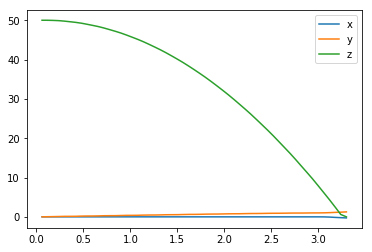

In [121]:
##Plot last-episode trajectory
plt.plot(results['time'], results['x'], label='x')
plt.plot(results['time'], results['y'], label='y')
plt.plot(results['time'], results['z'], label='z')
plt.legend()
_ = plt.ylim()

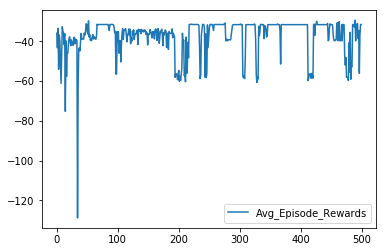

In [122]:
plt.plot(range(len(avg_episode_rewards)), avg_episode_rewards, label='Avg_Episode_Rewards')
plt.legend()
_ = plt.ylim()

Alterations to the network, which included increases to the number of units per layer and Batch Normalization, appeared to hurt performance as measured by rewards. 

**ATTEMPT 7**

In [123]:
'''
Change exploration sigma from .2 to .4 and extend training from 500 to 1000 episodes.
'''


import sys
import pandas as pd
from agents.agent_new import DDPG
from task import Task

num_episodes = 1000
init_pose = np.array([0., 0., 50., 0., 0., 0.])
init_vel = np.array([0., 0., 0.])
init_angle_velocities = np.array([0., 0., 0.])
target_pose = np.array([0., 0., 0., 0., 0., 0.])
target_vel = np.array([0., 0., 0.])
task = Task(init_pose=init_pose, init_vel=init_vel, init_angle_velocities=init_angle_velocities, target_pose=target_pose, target_vel=target_vel)
agent = DDPG(task)
avg_episode_rewards = []
file_output = 'data2.txt'

'''
Leave things the same as before, just record simulation and action history for plotting
'''
labels = ['time', 'x', 'y', 'z', 'phi', 'theta', 'psi', 'x_velocity',
          'y_velocity', 'z_velocity', 'phi_velocity', 'theta_velocity',
          'psi_velocity', 'rotor_speed1', 'rotor_speed2', 'rotor_speed3', 'rotor_speed4']
results = {x : [] for x in labels}

'''
USED THIS REWARD FUNCTION in task.py:
alpha = .3, beta = .3, gamma = 1.

reward = - alpha*(abs(self.sim.pose[:3] - self.target_pose[:3])).sum() - beta*(abs(self.sim.v[:3] - self.target_vel)).sum()/(1 + gamma*(abs(self.sim.pose[:3] - self.target_pose[:3])).sum() ) #velocity only counts when close to ground
'''

for i_episode in range(1, num_episodes+1):
    print("")
    print("i_episode: " + str(i_episode))
    print("")
    print("")
    state = agent.reset_episode() # start a new episode
    time = 0
    total_episode_reward = 0
    count = 0
    
    with open(file_output, 'w') as csvfile:
        writer = csv.writer(csvfile)
        writer.writerow(labels)
    
        while True:
            print("")
            print("time: " + str(time))
            print("sim time: " + str(task.sim.time))
        
            action = agent.act(state) 
            next_state, reward, done = task.step(action)
            print("reward: " + str(reward))
        
            if i_episode == num_episodes: #only write last episode with fully trained actor and critic networks
                to_write = [task.sim.time] + list(task.sim.pose) + list(task.sim.v) + list(task.sim.angular_v) + list(rotor_speeds)
                for ii in range(len(labels)):
                    results[labels[ii]].append(to_write[ii])
                writer.writerow(to_write)
         
            total_episode_reward += reward
            count += 1
        
            agent.step(action, reward, next_state, done)
            state = next_state
            if done:
                break
            time += 1
    
    avg_episode_rewards.append(total_episode_reward/count)
    print("avg_episode_reward: " + str(total_episode_reward/count))
    sys.stdout.flush()



i_episode: 1



time: 0
sim time: 0.0
reward: -45.0258533522

time: 1
sim time: 0.06
reward: -45.121330923

time: 2
sim time: 0.12000000000000001
reward: -45.2999616809

time: 3
sim time: 0.18
reward: -45.5574789942

time: 4
sim time: 0.23999999999999996
reward: -45.8679275435

time: 5
sim time: 0.3
reward: -46.1927212173

time: 6
sim time: 0.36000000000000004
reward: -46.5233672191

time: 7
sim time: 0.4200000000000001
reward: -46.861875426

time: 8
sim time: 0.48000000000000015
reward: -47.1617764596

time: 9
sim time: 0.5400000000000001
reward: -47.400942407

time: 10
sim time: 0.6000000000000002
reward: -47.6016711824

time: 11
sim time: 0.6600000000000003
reward: -47.8059663844

time: 12
sim time: 0.7200000000000003
reward: -48.0498290455

time: 13
sim time: 0.7800000000000004
reward: -48.3251073914

time: 14
sim time: 0.8400000000000004
reward: -48.5801095293

time: 15
sim time: 0.9000000000000005
reward: -48.7683874952

time: 16
sim time: 0.9600000000000005
reward: -48.88273805


time: 27
sim time: 1.620000000000001
reward: -61.5524306409

time: 28
sim time: 1.680000000000001
reward: -62.6284532191

time: 29
sim time: 1.740000000000001
reward: -63.7261144382

time: 30
sim time: 1.8000000000000012
reward: -64.8436135616

time: 31
sim time: 1.8600000000000012
reward: -65.9605120923

time: 32
sim time: 1.9200000000000013
reward: -67.0530834217

time: 33
sim time: 1.9800000000000013
reward: -68.109152018

time: 34
sim time: 2.0400000000000014
reward: -69.147672332

time: 35
sim time: 2.1000000000000014
reward: -70.1737595677

time: 36
sim time: 2.1600000000000015
reward: -71.1842486781

time: 37
sim time: 2.2200000000000015
reward: -72.1586798206

time: 38
sim time: 2.2800000000000016
reward: -73.0825127581

time: 39
sim time: 2.3400000000000016
reward: -73.9832994073

time: 40
sim time: 2.4000000000000017
reward: -74.8717049527

time: 41
sim time: 2.4600000000000017
reward: -75.712901469

time: 42
sim time: 2.520000000000002
reward: -76.5047985368

time: 43
sim t


time: 80
sim time: 4.799999999999986
reward: -54.5392673569

time: 81
sim time: 4.859999999999984
reward: -54.5955844023

time: 82
sim time: 4.919999999999983
reward: -54.6811438771

time: 83
sim time: 4.979999999999982
reward: -54.7936409606
avg_episode_reward: -57.5051183276

i_episode: 5



time: 0
sim time: 0.0
reward: -45.0504487035

time: 1
sim time: 0.06
reward: -45.2062658137

time: 2
sim time: 0.12000000000000001
reward: -45.3324684564

time: 3
sim time: 0.18
reward: -45.461539272

time: 4
sim time: 0.23999999999999996
reward: -45.5618261271

time: 5
sim time: 0.3
reward: -45.4993466386

time: 6
sim time: 0.36000000000000004
reward: -45.4823746272

time: 7
sim time: 0.4200000000000001
reward: -45.5837180828

time: 8
sim time: 0.48000000000000015
reward: -45.5314774529

time: 9
sim time: 0.5400000000000001
reward: -45.3462966438

time: 10
sim time: 0.6000000000000002
reward: -45.2884588791

time: 11
sim time: 0.6600000000000003
reward: -45.2658077189

time: 12
sim time: 0.7200


time: 20
sim time: 1.2000000000000006
reward: -39.4816188956

time: 21
sim time: 1.2600000000000007
reward: -38.8452827302

time: 22
sim time: 1.3200000000000007
reward: -38.2056526602

time: 23
sim time: 1.3800000000000008
reward: -37.5150870637

time: 24
sim time: 1.4400000000000008
reward: -36.7945650414

time: 25
sim time: 1.5000000000000009
reward: -36.0441696987

time: 26
sim time: 1.560000000000001
reward: -35.2477487401

time: 27
sim time: 1.620000000000001
reward: -34.4539380731

time: 28
sim time: 1.680000000000001
reward: -33.6500079953

time: 29
sim time: 1.740000000000001
reward: -32.7983273908

time: 30
sim time: 1.8000000000000012
reward: -31.8909650987

time: 31
sim time: 1.8600000000000012
reward: -30.9667498675

time: 32
sim time: 1.9200000000000013
reward: -30.0463220372

time: 33
sim time: 1.9800000000000013
reward: -29.1258951595

time: 34
sim time: 2.0400000000000014
reward: -28.200347178

time: 35
sim time: 2.1000000000000014
reward: -27.2613667739

time: 36
sim


time: 43
sim time: 2.580000000000002
reward: -28.513114186

time: 44
sim time: 2.640000000000002
reward: -27.4843174522

time: 45
sim time: 2.700000000000002
reward: -26.4020437156

time: 46
sim time: 2.760000000000002
reward: -25.3186549582

time: 47
sim time: 2.820000000000002
reward: -24.3189715958

time: 48
sim time: 2.880000000000002
reward: -23.3329560801

time: 49
sim time: 2.940000000000002
reward: -22.2819786564

time: 50
sim time: 3.000000000000002
reward: -21.2493946016

time: 51
sim time: 3.0600000000000023
reward: -20.3271670104

time: 52
sim time: 3.1200000000000023
reward: -19.3901271066

time: 53
sim time: 3.1800000000000024
reward: -18.3411311438

time: 54
sim time: 3.2400000000000024
reward: -17.3675497861

time: 55
sim time: 3.3000000000000025
reward: -17.0929812747
avg_episode_reward: -37.4148271962

i_episode: 10



time: 0
sim time: 0.0
reward: -45.0070047694

time: 1
sim time: 0.06
reward: -45.0325238966

time: 2
sim time: 0.12000000000000001
reward: -45.0428904


time: 14
sim time: 0.8400000000000004
reward: -42.5916279227

time: 15
sim time: 0.9000000000000005
reward: -42.1929238652

time: 16
sim time: 0.9600000000000005
reward: -41.7164612157

time: 17
sim time: 1.0200000000000005
reward: -41.2312190564

time: 18
sim time: 1.0800000000000005
reward: -40.7563473991

time: 19
sim time: 1.1400000000000006
reward: -40.2119459237

time: 20
sim time: 1.2000000000000006
reward: -39.6097074463

time: 21
sim time: 1.2600000000000007
reward: -39.0161125054

time: 22
sim time: 1.3200000000000007
reward: -38.4072859623

time: 23
sim time: 1.3800000000000008
reward: -37.7227760405

time: 24
sim time: 1.4400000000000008
reward: -37.0021815156

time: 25
sim time: 1.5000000000000009
reward: -36.294127132

time: 26
sim time: 1.560000000000001
reward: -35.5479959046

time: 27
sim time: 1.620000000000001
reward: -34.7323559229

time: 28
sim time: 1.680000000000001
reward: -33.8897507194

time: 29
sim time: 1.740000000000001
reward: -33.021462338

time: 30
sim 


time: 43
sim time: 2.580000000000002
reward: -19.9340501441

time: 44
sim time: 2.640000000000002
reward: -18.8799340674

time: 45
sim time: 2.700000000000002
reward: -17.7963557053

time: 46
sim time: 2.760000000000002
reward: -16.6856893172

time: 47
sim time: 2.820000000000002
reward: -15.5480617158

time: 48
sim time: 2.880000000000002
reward: -14.3872369026

time: 49
sim time: 2.940000000000002
reward: -13.223745049

time: 50
sim time: 3.000000000000002
reward: -12.1106094996

time: 51
sim time: 3.0600000000000023
reward: -11.1828940606

time: 52
sim time: 3.1200000000000023
reward: -10.8388273191

time: 53
sim time: 3.1800000000000024
reward: -11.468992861
avg_episode_reward: -32.387673128

i_episode: 15



time: 0
sim time: 0.0
reward: -45.0069489898

time: 1
sim time: 0.06
reward: -45.032161656

time: 2
sim time: 0.12000000000000001
reward: -45.0422150468

time: 3
sim time: 0.18
reward: -45.0261449265

time: 4
sim time: 0.23999999999999996
reward: -44.9896340948

time: 5
sim t


time: 10
sim time: 0.6000000000000002
reward: -44.6194151741

time: 11
sim time: 0.6600000000000003
reward: -44.2688773545

time: 12
sim time: 0.7200000000000003
reward: -43.7732108319

time: 13
sim time: 0.7800000000000004
reward: -43.1859557499

time: 14
sim time: 0.8400000000000004
reward: -42.5090078561

time: 15
sim time: 0.9000000000000005
reward: -41.757820216

time: 16
sim time: 0.9600000000000005
reward: -40.961343525

time: 17
sim time: 1.0200000000000005
reward: -40.1456202316

time: 18
sim time: 1.0800000000000005
reward: -39.7245413274

time: 19
sim time: 1.1400000000000006
reward: -39.5330284068

time: 20
sim time: 1.2000000000000006
reward: -39.3733428317

time: 21
sim time: 1.2600000000000007
reward: -39.1901291947

time: 22
sim time: 1.3200000000000007
reward: -38.9747761178

time: 23
sim time: 1.3800000000000008
reward: -38.7268263306

time: 24
sim time: 1.4400000000000008
reward: -38.4207266084

time: 25
sim time: 1.5000000000000009
reward: -38.0635142121

time: 26



time: 17
sim time: 1.0200000000000005
reward: -52.00377067

time: 18
sim time: 1.0800000000000005
reward: -52.61490372

time: 19
sim time: 1.1400000000000006
reward: -53.1927985979

time: 20
sim time: 1.2000000000000006
reward: -53.8764876702

time: 21
sim time: 1.2600000000000007
reward: -54.5428975235

time: 22
sim time: 1.3200000000000007
reward: -55.0980420822

time: 23
sim time: 1.3800000000000008
reward: -55.7048979375

time: 24
sim time: 1.4400000000000008
reward: -56.4112818209

time: 25
sim time: 1.5000000000000009
reward: -57.0446509145

time: 26
sim time: 1.560000000000001
reward: -57.6236333737

time: 27
sim time: 1.620000000000001
reward: -58.3106578822

time: 28
sim time: 1.680000000000001
reward: -59.0507854192

time: 29
sim time: 1.740000000000001
reward: -59.7025141034

time: 30
sim time: 1.8000000000000012
reward: -60.3760856586

time: 31
sim time: 1.8600000000000012
reward: -61.1708049077

time: 32
sim time: 1.9200000000000013
reward: -61.9725968941

time: 33
sim ti


time: 18
sim time: 1.0800000000000005
reward: -52.5319559436

time: 19
sim time: 1.1400000000000006
reward: -53.2528225866

time: 20
sim time: 1.2000000000000006
reward: -53.9954411046

time: 21
sim time: 1.2600000000000007
reward: -54.7586282597

time: 22
sim time: 1.3200000000000007
reward: -55.5413148032

time: 23
sim time: 1.3800000000000008
reward: -56.3425267296

time: 24
sim time: 1.4400000000000008
reward: -57.1613567309

time: 25
sim time: 1.5000000000000009
reward: -57.9969390293

time: 26
sim time: 1.560000000000001
reward: -58.8484575159

time: 27
sim time: 1.620000000000001
reward: -59.7150025832

time: 28
sim time: 1.680000000000001
reward: -60.5956438467

time: 29
sim time: 1.740000000000001
reward: -61.4895414231

time: 30
sim time: 1.8000000000000012
reward: -62.3957796191

time: 31
sim time: 1.8600000000000012
reward: -63.313357695

time: 32
sim time: 1.9200000000000013
reward: -64.241263172

time: 33
sim time: 1.9800000000000013
reward: -65.178486148

time: 34
sim t


time: 69
sim time: 4.14
reward: -115.641045815

time: 70
sim time: 4.199999999999998
reward: -116.998576051

time: 71
sim time: 4.259999999999997
reward: -118.343348008

time: 72
sim time: 4.319999999999996
reward: -119.674241583

time: 73
sim time: 4.379999999999995
reward: -120.990181899

time: 74
sim time: 4.439999999999993
reward: -122.290098788

time: 75
sim time: 4.499999999999992
reward: -123.573025812

time: 76
sim time: 4.559999999999991
reward: -124.838134115

time: 77
sim time: 4.6199999999999894
reward: -126.084657439

time: 78
sim time: 4.679999999999988
reward: -127.311919762

time: 79
sim time: 4.739999999999987
reward: -128.519371925

time: 80
sim time: 4.799999999999986
reward: -129.70769958

time: 81
sim time: 4.859999999999984
reward: -130.88093159

time: 82
sim time: 4.919999999999983
reward: -132.033895375

time: 83
sim time: 4.979999999999982
reward: -133.165925916
avg_episode_reward: -81.6923661485

i_episode: 23



time: 0
sim time: 0.0
reward: -45.0224909019




time: 36
sim time: 2.1600000000000015
reward: -30.5519614872

time: 37
sim time: 2.2200000000000015
reward: -30.0154527946

time: 38
sim time: 2.2800000000000016
reward: -29.3697772041

time: 39
sim time: 2.3400000000000016
reward: -28.5473379471

time: 40
sim time: 2.4000000000000017
reward: -27.7871496712

time: 41
sim time: 2.4600000000000017
reward: -27.1061820221

time: 42
sim time: 2.520000000000002
reward: -26.2410160959

time: 43
sim time: 2.580000000000002
reward: -25.2340107877

time: 44
sim time: 2.640000000000002
reward: -24.3110759894

time: 45
sim time: 2.700000000000002
reward: -23.3874247082

time: 46
sim time: 2.760000000000002
reward: -22.3387077144

time: 47
sim time: 2.820000000000002
reward: -21.2801521004

time: 48
sim time: 2.880000000000002
reward: -20.2043720039

time: 49
sim time: 2.940000000000002
reward: -19.0852725259

time: 50
sim time: 3.000000000000002
reward: -17.965634361

time: 51
sim time: 3.0600000000000023
reward: -16.9182804248

time: 52
sim time

avg_episode_reward: -38.9488241018

i_episode: 27



time: 0
sim time: 0.0
reward: -45.0506338261

time: 1
sim time: 0.06
reward: -45.1908884867

time: 2
sim time: 0.12000000000000001
reward: -45.3067227402

time: 3
sim time: 0.18
reward: -45.4645998385

time: 4
sim time: 0.23999999999999996
reward: -45.666191825

time: 5
sim time: 0.3
reward: -45.910278041

time: 6
sim time: 0.36000000000000004
reward: -46.1447439658

time: 7
sim time: 0.4200000000000001
reward: -46.2936965201

time: 8
sim time: 0.48000000000000015
reward: -46.4073865104

time: 9
sim time: 0.5400000000000001
reward: -46.540430278

time: 10
sim time: 0.6000000000000002
reward: -46.6346517743

time: 11
sim time: 0.6600000000000003
reward: -46.6483432623

time: 12
sim time: 0.7200000000000003
reward: -46.6541640334

time: 13
sim time: 0.7800000000000004
reward: -46.6693458276

time: 14
sim time: 0.8400000000000004
reward: -46.6162034784

time: 15
sim time: 0.9000000000000005
reward: -46.5019477223

time: 16
sim time: 0.9


time: 9
sim time: 0.5400000000000001
reward: -46.2596571085

time: 10
sim time: 0.6000000000000002
reward: -46.4963197066

time: 11
sim time: 0.6600000000000003
reward: -46.6887780237

time: 12
sim time: 0.7200000000000003
reward: -46.9191076723

time: 13
sim time: 0.7800000000000004
reward: -47.2162094147

time: 14
sim time: 0.8400000000000004
reward: -47.4699236117

time: 15
sim time: 0.9000000000000005
reward: -47.7412095102

time: 16
sim time: 0.9600000000000005
reward: -48.0771567624

time: 17
sim time: 1.0200000000000005
reward: -48.3693900573

time: 18
sim time: 1.0800000000000005
reward: -48.6793046131

time: 19
sim time: 1.1400000000000006
reward: -49.0545564422

time: 20
sim time: 1.2000000000000006
reward: -49.3874056723

time: 21
sim time: 1.2600000000000007
reward: -49.736364916

time: 22
sim time: 1.3200000000000007
reward: -50.150714462

time: 23
sim time: 1.3800000000000008
reward: -50.5234777641

time: 24
sim time: 1.4400000000000008
reward: -50.9118122425

time: 25
s


time: 4
sim time: 0.23999999999999996
reward: -44.9858239321

time: 5
sim time: 0.3
reward: -44.8625310676

time: 6
sim time: 0.36000000000000004
reward: -44.729255305

time: 7
sim time: 0.4200000000000001
reward: -44.6152949759

time: 8
sim time: 0.48000000000000015
reward: -44.4304168723

time: 9
sim time: 0.5400000000000001
reward: -44.1771494429

time: 10
sim time: 0.6000000000000002
reward: -43.9398007492

time: 11
sim time: 0.6600000000000003
reward: -43.6936291245

time: 12
sim time: 0.7200000000000003
reward: -43.360780046

time: 13
sim time: 0.7800000000000004
reward: -42.990477839

time: 14
sim time: 0.8400000000000004
reward: -42.6438489231

time: 15
sim time: 0.9000000000000005
reward: -42.2545772532

time: 16
sim time: 0.9600000000000005
reward: -41.7828549237

time: 17
sim time: 1.0200000000000005
reward: -41.3040728459

time: 18
sim time: 1.0800000000000005
reward: -40.8357673459

time: 19
sim time: 1.1400000000000006
reward: -40.3000717371

time: 20
sim time: 1.2000000


time: 29
sim time: 1.740000000000001
reward: -35.7899270471

time: 30
sim time: 1.8000000000000012
reward: -34.6899721826

time: 31
sim time: 1.8600000000000012
reward: -33.4687750773

time: 32
sim time: 1.9200000000000013
reward: -32.188553587

time: 33
sim time: 1.9800000000000013
reward: -30.9545407973

time: 34
sim time: 2.0400000000000014
reward: -29.6512908533

time: 35
sim time: 2.1000000000000014
reward: -28.235322871

time: 36
sim time: 2.1600000000000015
reward: -26.8090047413

time: 37
sim time: 2.2200000000000015
reward: -25.443487216

time: 38
sim time: 2.2800000000000016
reward: -23.9670713871

time: 39
sim time: 2.3400000000000016
reward: -22.4454228856

time: 40
sim time: 2.4000000000000017
reward: -20.9501807363

time: 41
sim time: 2.4600000000000017
reward: -19.5484846605

time: 42
sim time: 2.520000000000002
reward: -18.0744727019

time: 43
sim time: 2.580000000000002
reward: -16.5125719211

time: 44
sim time: 2.640000000000002
reward: -15.0546367601

time: 45
sim t


time: 27
sim time: 1.620000000000001
reward: -52.9151953778

time: 28
sim time: 1.680000000000001
reward: -53.4890891402

time: 29
sim time: 1.740000000000001
reward: -54.060869987

time: 30
sim time: 1.8000000000000012
reward: -54.7066872711

time: 31
sim time: 1.8600000000000012
reward: -55.373389306

time: 32
sim time: 1.9200000000000013
reward: -56.0035331952

time: 33
sim time: 1.9800000000000013
reward: -56.6652720478

time: 34
sim time: 2.0400000000000014
reward: -57.3937155993

time: 35
sim time: 2.1000000000000014
reward: -58.1116569127

time: 36
sim time: 2.1600000000000015
reward: -58.8047125999

time: 37
sim time: 2.2200000000000015
reward: -59.556352323

time: 38
sim time: 2.2800000000000016
reward: -60.3503466884

time: 39
sim time: 2.3400000000000016
reward: -61.1124209112

time: 40
sim time: 2.4000000000000017
reward: -61.8771443544

time: 41
sim time: 2.4600000000000017
reward: -62.7085874281

time: 42
sim time: 2.520000000000002
reward: -63.5516149935

time: 43
sim t


time: 78
sim time: 4.679999999999988
reward: -99.9963929629

time: 79
sim time: 4.739999999999987
reward: -101.125504772

time: 80
sim time: 4.799999999999986
reward: -102.243002964

time: 81
sim time: 4.859999999999984
reward: -103.401460634

time: 82
sim time: 4.919999999999983
reward: -104.569395446

time: 83
sim time: 4.979999999999982
reward: -105.697065546
avg_episode_reward: -67.3252082918

i_episode: 37



time: 0
sim time: 0.0
reward: -45.033442829

time: 1
sim time: 0.06
reward: -45.1432626086

time: 2
sim time: 0.12000000000000001
reward: -45.2642550781

time: 3
sim time: 0.18
reward: -45.3957382134

time: 4
sim time: 0.23999999999999996
reward: -45.5429345887

time: 5
sim time: 0.3
reward: -45.6820925992

time: 6
sim time: 0.36000000000000004
reward: -45.7707945604

time: 7
sim time: 0.4200000000000001
reward: -45.8012892075

time: 8
sim time: 0.48000000000000015
reward: -45.8776520053

time: 9
sim time: 0.5400000000000001
reward: -45.9390719738

time: 10
sim time: 0.60000


time: 44
sim time: 2.640000000000002
reward: -64.7694300255

time: 45
sim time: 2.700000000000002
reward: -65.6568980865

time: 46
sim time: 2.760000000000002
reward: -66.5274507378

time: 47
sim time: 2.820000000000002
reward: -67.3771661336

time: 48
sim time: 2.880000000000002
reward: -68.2841379116

time: 49
sim time: 2.940000000000002
reward: -69.2216730854

time: 50
sim time: 3.000000000000002
reward: -70.1241433421

time: 51
sim time: 3.0600000000000023
reward: -71.0353927955

time: 52
sim time: 3.1200000000000023
reward: -72.0049088526

time: 53
sim time: 3.1800000000000024
reward: -72.9772068158

time: 54
sim time: 3.2400000000000024
reward: -73.9136494796

time: 55
sim time: 3.3000000000000025
reward: -74.8876098201

time: 56
sim time: 3.3600000000000025
reward: -75.9050049065

time: 57
sim time: 3.4200000000000026
reward: -76.9005167613

time: 58
sim time: 3.4800000000000026
reward: -77.8783726581

time: 59
sim time: 3.5400000000000027
reward: -78.9083911709

time: 60
sim t


time: 11
sim time: 0.6600000000000003
reward: -46.1438212353

time: 12
sim time: 0.7200000000000003
reward: -46.4185608962

time: 13
sim time: 0.7800000000000004
reward: -46.6918302657

time: 14
sim time: 0.8400000000000004
reward: -46.9357968584

time: 15
sim time: 0.9000000000000005
reward: -47.2367896338

time: 16
sim time: 0.9600000000000005
reward: -47.6009722179

time: 17
sim time: 1.0200000000000005
reward: -47.9363220144

time: 18
sim time: 1.0800000000000005
reward: -48.2670445383

time: 19
sim time: 1.1400000000000006
reward: -48.6764988972

time: 20
sim time: 1.2000000000000006
reward: -49.1129446957

time: 21
sim time: 1.2600000000000007
reward: -49.512137409

time: 22
sim time: 1.3200000000000007
reward: -49.9407780366

time: 23
sim time: 1.3800000000000008
reward: -50.4457213273

time: 24
sim time: 1.4400000000000008
reward: -50.9423257469

time: 25
sim time: 1.5000000000000009
reward: -51.412265904

time: 26
sim time: 1.560000000000001
reward: -51.9424165594

time: 27
s


time: 61
sim time: 3.660000000000003
reward: -81.2465303603

time: 62
sim time: 3.720000000000003
reward: -82.2735318777

time: 63
sim time: 3.780000000000003
reward: -83.3489898031

time: 64
sim time: 3.840000000000003
reward: -84.4206830858

time: 65
sim time: 3.900000000000003
reward: -85.4574728731

time: 66
sim time: 3.960000000000003
reward: -86.5321989879

time: 67
sim time: 4.020000000000002
reward: -87.6406756847

time: 68
sim time: 4.080000000000001
reward: -88.7216831241

time: 69
sim time: 4.14
reward: -89.7904641811

time: 70
sim time: 4.199999999999998
reward: -90.9062879569

time: 71
sim time: 4.259999999999997
reward: -92.0351159952

time: 72
sim time: 4.319999999999996
reward: -93.1246082596

time: 73
sim time: 4.379999999999995
reward: -94.2314451388

time: 74
sim time: 4.439999999999993
reward: -95.3782966701

time: 75
sim time: 4.499999999999992
reward: -96.5151355153

time: 76
sim time: 4.559999999999991
reward: -97.6198473695

time: 77
sim time: 4.619999999999989


time: 30
sim time: 1.8000000000000012
reward: -54.1427595559

time: 31
sim time: 1.8600000000000012
reward: -54.7842446455

time: 32
sim time: 1.9200000000000013
reward: -55.3741709763

time: 33
sim time: 1.9800000000000013
reward: -56.0048601768

time: 34
sim time: 2.0400000000000014
reward: -56.6948732416

time: 35
sim time: 2.1000000000000014
reward: -57.3779334354

time: 36
sim time: 2.1600000000000015
reward: -58.0356165179

time: 37
sim time: 2.2200000000000015
reward: -58.7451021848

time: 38
sim time: 2.2800000000000016
reward: -59.5072351305

time: 39
sim time: 2.3400000000000016
reward: -60.2258230655

time: 40
sim time: 2.4000000000000017
reward: -60.9584610461

time: 41
sim time: 2.4600000000000017
reward: -61.7449267961

time: 42
sim time: 2.520000000000002
reward: -62.5566436695

time: 43
sim time: 2.580000000000002
reward: -63.3213674275

time: 44
sim time: 2.640000000000002
reward: -64.1257354968

time: 45
sim time: 2.700000000000002
reward: -64.9842521042

time: 46
si


time: 81
sim time: 4.859999999999984
reward: -103.116149849

time: 82
sim time: 4.919999999999983
reward: -104.259297221

time: 83
sim time: 4.979999999999982
reward: -105.362585628
avg_episode_reward: -67.3619765935

i_episode: 45



time: 0
sim time: 0.0
reward: -45.033460675

time: 1
sim time: 0.06
reward: -45.142141771

time: 2
sim time: 0.12000000000000001
reward: -45.2578336456

time: 3
sim time: 0.18
reward: -45.3845597715

time: 4
sim time: 0.23999999999999996
reward: -45.5285393603

time: 5
sim time: 0.3
reward: -45.6610968569

time: 6
sim time: 0.36000000000000004
reward: -45.7411724767

time: 7
sim time: 0.4200000000000001
reward: -45.7631135365

time: 8
sim time: 0.48000000000000015
reward: -45.8322185633

time: 9
sim time: 0.5400000000000001
reward: -45.8828797033

time: 10
sim time: 0.6000000000000002
reward: -45.99475749

time: 11
sim time: 0.6600000000000003
reward: -46.1935470972

time: 12
sim time: 0.7200000000000003
reward: -46.4757423059

time: 13
sim time: 0.78000


time: 48
sim time: 2.880000000000002
reward: -68.585803524

time: 49
sim time: 2.940000000000002
reward: -69.5269061749

time: 50
sim time: 3.000000000000002
reward: -70.4340510446

time: 51
sim time: 3.0600000000000023
reward: -71.3450213436

time: 52
sim time: 3.1200000000000023
reward: -72.3147816982

time: 53
sim time: 3.1800000000000024
reward: -73.2914002764

time: 54
sim time: 3.2400000000000024
reward: -74.2305527641

time: 55
sim time: 3.3000000000000025
reward: -75.203309524

time: 56
sim time: 3.3600000000000025
reward: -76.2220827879

time: 57
sim time: 3.4200000000000026
reward: -77.2221261565

time: 58
sim time: 3.4800000000000026
reward: -78.2007188352

time: 59
sim time: 3.5400000000000027
reward: -79.2302771864

time: 60
sim time: 3.6000000000000028
reward: -80.284580983

time: 61
sim time: 3.660000000000003
reward: -81.3024377466

time: 62
sim time: 3.720000000000003
reward: -82.3282217628

time: 63
sim time: 3.780000000000003
reward: -83.4040219528

time: 64
sim tim


time: 15
sim time: 0.9000000000000005
reward: -47.3459531885

time: 16
sim time: 0.9600000000000005
reward: -47.7247856529

time: 17
sim time: 1.0200000000000005
reward: -48.0756913071

time: 18
sim time: 1.0800000000000005
reward: -48.4233520857

time: 19
sim time: 1.1400000000000006
reward: -48.8503736058

time: 20
sim time: 1.2000000000000006
reward: -49.305009139

time: 21
sim time: 1.2600000000000007
reward: -49.7234169797

time: 22
sim time: 1.3200000000000007
reward: -50.1730067329

time: 23
sim time: 1.3800000000000008
reward: -50.6990599529

time: 24
sim time: 1.4400000000000008
reward: -51.2171095167

time: 25
sim time: 1.5000000000000009
reward: -51.7103908568

time: 26
sim time: 1.560000000000001
reward: -52.265510691

time: 27
sim time: 1.620000000000001
reward: -52.8717220096

time: 28
sim time: 1.680000000000001
reward: -53.4467301289

time: 29
sim time: 1.740000000000001
reward: -54.0241646467

time: 30
sim time: 1.8000000000000012
reward: -54.6762679516

time: 31
sim 


time: 66
sim time: 3.960000000000003
reward: -80.5604848396

time: 67
sim time: 4.020000000000002
reward: -80.955144426

time: 68
sim time: 4.080000000000001
reward: -81.3306411855

time: 69
sim time: 4.14
reward: -81.6569549258

time: 70
sim time: 4.199999999999998
reward: -81.933694616

time: 71
sim time: 4.259999999999997
reward: -82.1494156318

time: 72
sim time: 4.319999999999996
reward: -82.3499874702

time: 73
sim time: 4.379999999999995
reward: -82.58722859

time: 74
sim time: 4.439999999999993
reward: -82.7853186935

time: 75
sim time: 4.499999999999992
reward: -82.9287592107

time: 76
sim time: 4.559999999999991
reward: -83.0827114001

time: 77
sim time: 4.6199999999999894
reward: -83.2562972035

time: 78
sim time: 4.679999999999988
reward: -83.3663960733

time: 79
sim time: 4.739999999999987
reward: -83.4412900629

time: 80
sim time: 4.799999999999986
reward: -83.5470232607

time: 81
sim time: 4.859999999999984
reward: -83.6372594117

time: 82
sim time: 4.919999999999983
re

avg_episode_reward: -45.787099094

i_episode: 52



time: 0
sim time: 0.0
reward: -45.0503750716

time: 1
sim time: 0.06
reward: -45.2054200225

time: 2
sim time: 0.12000000000000001
reward: -45.3301953448

time: 3
sim time: 0.18
reward: -45.4579332084

time: 4
sim time: 0.23999999999999996
reward: -45.5593977036

time: 5
sim time: 0.3
reward: -45.5007887626

time: 6
sim time: 0.36000000000000004
reward: -45.4807793121

time: 7
sim time: 0.4200000000000001
reward: -45.5841599041

time: 8
sim time: 0.48000000000000015
reward: -45.5380417007

time: 9
sim time: 0.5400000000000001
reward: -45.3539087685

time: 10
sim time: 0.6000000000000002
reward: -45.288778762

time: 11
sim time: 0.6600000000000003
reward: -45.2630214139

time: 12
sim time: 0.7200000000000003
reward: -45.0366667967

time: 13
sim time: 0.7800000000000004
reward: -44.7691591086

time: 14
sim time: 0.8400000000000004
reward: -44.648748899

time: 15
sim time: 0.9000000000000005
reward: -44.4572151873

time: 16
sim time: 0.9


time: 19
sim time: 1.1400000000000006
reward: -43.1379578199

time: 20
sim time: 1.2000000000000006
reward: -42.6655915376

time: 21
sim time: 1.2600000000000007
reward: -42.3386780532

time: 22
sim time: 1.3200000000000007
reward: -42.0151281446

time: 23
sim time: 1.3800000000000008
reward: -41.5049825497

time: 24
sim time: 1.4400000000000008
reward: -41.008015993

time: 25
sim time: 1.5000000000000009
reward: -40.6557770666

time: 26
sim time: 1.560000000000001
reward: -40.2126509703

time: 27
sim time: 1.620000000000001
reward: -39.6222537517

time: 28
sim time: 1.680000000000001
reward: -39.1358754649

time: 29
sim time: 1.740000000000001
reward: -38.7330233644

time: 30
sim time: 1.8000000000000012
reward: -38.1781889229

time: 31
sim time: 1.8600000000000012
reward: -37.5564469889

time: 32
sim time: 1.9200000000000013
reward: -37.0833343372

time: 33
sim time: 1.9800000000000013
reward: -36.6030529814

time: 34
sim time: 2.0400000000000014
reward: -35.9582490379

time: 35
sim


time: 35
sim time: 2.1000000000000014
reward: -35.6910830799

time: 36
sim time: 2.1600000000000015
reward: -35.239119114

time: 37
sim time: 2.2200000000000015
reward: -34.6818290591

time: 38
sim time: 2.2800000000000016
reward: -33.9905324399

time: 39
sim time: 2.3400000000000016
reward: -33.3978658178

time: 40
sim time: 2.4000000000000017
reward: -32.850561231

time: 41
sim time: 2.4600000000000017
reward: -32.1388064206

time: 42
sim time: 2.520000000000002
reward: -31.3626145227

time: 43
sim time: 2.580000000000002
reward: -30.6963255483

time: 44
sim time: 2.640000000000002
reward: -29.981624584

time: 45
sim time: 2.700000000000002
reward: -29.0896823223

time: 46
sim time: 2.760000000000002
reward: -28.1995952268

time: 47
sim time: 2.820000000000002
reward: -27.3823825657

time: 48
sim time: 2.880000000000002
reward: -26.4361680955

time: 49
sim time: 2.940000000000002
reward: -25.3577357849

time: 50
sim time: 3.000000000000002
reward: -24.3134168121

time: 51
sim time: 


time: 52
sim time: 3.1200000000000023
reward: -29.9994668419

time: 53
sim time: 3.1800000000000024
reward: -29.7288787486

time: 54
sim time: 3.2400000000000024
reward: -29.6271643633

time: 55
sim time: 3.3000000000000025
reward: -29.5129469547

time: 56
sim time: 3.3600000000000025
reward: -29.3104245713

time: 57
sim time: 3.4200000000000026
reward: -29.1960256744

time: 58
sim time: 3.4800000000000026
reward: -29.1878251266

time: 59
sim time: 3.5400000000000027
reward: -29.1394460054

time: 60
sim time: 3.6000000000000028
reward: -29.0421888225
avg_episode_reward: -37.9202414885

i_episode: 59



time: 0
sim time: 0.0
reward: -45.050452841

time: 1
sim time: 0.06
reward: -45.2063319592

time: 2
sim time: 0.12000000000000001
reward: -45.3334547543

time: 3
sim time: 0.18
reward: -45.4639793563

time: 4
sim time: 0.23999999999999996
reward: -45.5675892352

time: 5
sim time: 0.3
reward: -45.5075898946

time: 6
sim time: 0.36000000000000004
reward: -45.4988102752

time: 7
sim time: 


time: 62
sim time: 3.720000000000003
reward: -39.8501092816

time: 63
sim time: 3.780000000000003
reward: -39.4119692655

time: 64
sim time: 3.840000000000003
reward: -38.9117038516

time: 65
sim time: 3.900000000000003
reward: -38.4354893846

time: 66
sim time: 3.960000000000003
reward: -38.0383857502

time: 67
sim time: 4.020000000000002
reward: -37.6347490655

time: 68
sim time: 4.080000000000001
reward: -37.1802892443

time: 69
sim time: 4.14
reward: -36.7844328208

time: 70
sim time: 4.199999999999998
reward: -36.4507512555

time: 71
sim time: 4.259999999999997
reward: -36.0684233105

time: 72
sim time: 4.319999999999996
reward: -35.6726799101

time: 73
sim time: 4.379999999999995
reward: -35.3539700744

time: 74
sim time: 4.439999999999993
reward: -35.1593331908
avg_episode_reward: -45.7260493185

i_episode: 61



time: 0
sim time: 0.0
reward: -45.0067347217

time: 1
sim time: 0.06
reward: -45.0308936263

time: 2
sim time: 0.12000000000000001
reward: -45.0397919619

time: 3
sim 


time: 11
sim time: 0.6600000000000003
reward: -43.7053847589

time: 12
sim time: 0.7200000000000003
reward: -43.3703973532

time: 13
sim time: 0.7800000000000004
reward: -43.0037819346

time: 14
sim time: 0.8400000000000004
reward: -42.6604745364

time: 15
sim time: 0.9000000000000005
reward: -42.2691228126

time: 16
sim time: 0.9600000000000005
reward: -41.7972313338

time: 17
sim time: 1.0200000000000005
reward: -41.3229320375

time: 18
sim time: 1.0800000000000005
reward: -40.8557249764

time: 19
sim time: 1.1400000000000006
reward: -40.3180579755

time: 20
sim time: 1.2000000000000006
reward: -39.7220374557

time: 21
sim time: 1.2600000000000007
reward: -39.1385244325

time: 22
sim time: 1.3200000000000007
reward: -38.537219526

time: 23
sim time: 1.3800000000000008
reward: -37.8584973087

time: 24
sim time: 1.4400000000000008
reward: -37.1466318589

time: 25
sim time: 1.5000000000000009
reward: -36.4473682135

time: 26
sim time: 1.560000000000001
reward: -35.7082893819

time: 27



time: 35
sim time: 2.1000000000000014
reward: -28.3116947821

time: 36
sim time: 2.1600000000000015
reward: -27.3254070987

time: 37
sim time: 2.2200000000000015
reward: -26.3238495784

time: 38
sim time: 2.2800000000000016
reward: -25.2590627733

time: 39
sim time: 2.3400000000000016
reward: -24.1427236895

time: 40
sim time: 2.4000000000000017
reward: -23.0062093684

time: 41
sim time: 2.4600000000000017
reward: -21.792323626

time: 42
sim time: 2.520000000000002
reward: -20.471599926

time: 43
sim time: 2.580000000000002
reward: -19.1465312697

time: 44
sim time: 2.640000000000002
reward: -17.9003747756

time: 45
sim time: 2.700000000000002
reward: -16.8246745981

time: 46
sim time: 2.760000000000002
reward: -15.7612653318

time: 47
sim time: 2.820000000000002
reward: -14.7833794348

time: 48
sim time: 2.880000000000002
reward: -13.8611391705

time: 49
sim time: 2.940000000000002
reward: -12.864522085

time: 50
sim time: 3.000000000000002
reward: -11.9650154829

time: 51
sim time: 


time: 51
sim time: 3.0600000000000023
reward: -88.1830989982

time: 52
sim time: 3.1200000000000023
reward: -89.5864204664

time: 53
sim time: 3.1800000000000024
reward: -90.983573869

time: 54
sim time: 3.2400000000000024
reward: -92.3697790886

time: 55
sim time: 3.3000000000000025
reward: -93.7403292541

time: 56
sim time: 3.3600000000000025
reward: -95.090688354

time: 57
sim time: 3.4200000000000026
reward: -96.4166268352

time: 58
sim time: 3.4800000000000026
reward: -97.7143116112

time: 59
sim time: 3.5400000000000027
reward: -98.9802195793

time: 60
sim time: 3.6000000000000028
reward: -100.211078772

time: 61
sim time: 3.660000000000003
reward: -101.404171689

time: 62
sim time: 3.720000000000003
reward: -102.568151016

time: 63
sim time: 3.780000000000003
reward: -103.693269888

time: 64
sim time: 3.840000000000003
reward: -104.771886994

time: 65
sim time: 3.900000000000003
reward: -105.801674166

time: 66
sim time: 3.960000000000003
reward: -106.780481371

time: 67
sim ti


time: 18
sim time: 1.0800000000000005
reward: -52.8960951518

time: 19
sim time: 1.1400000000000006
reward: -53.6933088536

time: 20
sim time: 1.2000000000000006
reward: -54.5217466433

time: 21
sim time: 1.2600000000000007
reward: -55.3805521999

time: 22
sim time: 1.3200000000000007
reward: -56.2687540359

time: 23
sim time: 1.3800000000000008
reward: -57.185332797

time: 24
sim time: 1.4400000000000008
reward: -58.129365935

time: 25
sim time: 1.5000000000000009
reward: -59.1001963231

time: 26
sim time: 1.560000000000001
reward: -60.126789237

time: 27
sim time: 1.620000000000001
reward: -61.2503022835

time: 28
sim time: 1.680000000000001
reward: -62.3572045287

time: 29
sim time: 1.740000000000001
reward: -63.4663936005

time: 30
sim time: 1.8000000000000012
reward: -64.5274073682

time: 31
sim time: 1.8600000000000012
reward: -65.5145430389

time: 32
sim time: 1.9200000000000013
reward: -66.5674612594

time: 33
sim time: 1.9800000000000013
reward: -67.5261389869

time: 34
sim t


time: 68
sim time: 4.080000000000001
reward: -39.5787092528

time: 69
sim time: 4.14
reward: -39.0046604086

time: 70
sim time: 4.199999999999998
reward: -38.410236386

time: 71
sim time: 4.259999999999997
reward: -37.8267553257

time: 72
sim time: 4.319999999999996
reward: -37.2473175185

time: 73
sim time: 4.379999999999995
reward: -36.6678215944

time: 74
sim time: 4.439999999999993
reward: -36.0276225722

time: 75
sim time: 4.499999999999992
reward: -35.264976102

time: 76
sim time: 4.559999999999991
reward: -34.5166437046

time: 77
sim time: 4.6199999999999894
reward: -33.7190609656

time: 78
sim time: 4.679999999999988
reward: -32.8665434415

time: 79
sim time: 4.739999999999987
reward: -31.8735239422

time: 80
sim time: 4.799999999999986
reward: -30.7144335722

time: 81
sim time: 4.859999999999984
reward: -29.4472672882

time: 82
sim time: 4.919999999999983
reward: -28.0139709497

time: 83
sim time: 4.979999999999982
reward: -26.4388923632
avg_episode_reward: -41.5923415345

i_


time: 63
sim time: 3.780000000000003
reward: -73.7763535681

time: 64
sim time: 3.840000000000003
reward: -74.485627615

time: 65
sim time: 3.900000000000003
reward: -75.2542833777

time: 66
sim time: 3.960000000000003
reward: -76.0338993158

time: 67
sim time: 4.020000000000002
reward: -76.7545556829

time: 68
sim time: 4.080000000000001
reward: -77.5087545501

time: 69
sim time: 4.14
reward: -78.3145516035

time: 70
sim time: 4.199999999999998
reward: -79.0935360883

time: 71
sim time: 4.259999999999997
reward: -79.8364236841

time: 72
sim time: 4.319999999999996
reward: -80.6342825272

time: 73
sim time: 4.379999999999995
reward: -81.4643961254

time: 74
sim time: 4.439999999999993
reward: -82.2379502235

time: 75
sim time: 4.499999999999992
reward: -83.0154787555

time: 76
sim time: 4.559999999999991
reward: -83.8508553043

time: 77
sim time: 4.6199999999999894
reward: -84.6856837782

time: 78
sim time: 4.679999999999988
reward: -85.4629837864

time: 79
sim time: 4.739999999999987


time: 39
sim time: 2.3400000000000016
reward: -43.1284840978

time: 40
sim time: 2.4000000000000017
reward: -43.5030688673

time: 41
sim time: 2.4600000000000017
reward: -43.8674860868

time: 42
sim time: 2.520000000000002
reward: -44.3137119073

time: 43
sim time: 2.580000000000002
reward: -44.8679721342

time: 44
sim time: 2.640000000000002
reward: -45.4846996333

time: 45
sim time: 2.700000000000002
reward: -46.1508427201

time: 46
sim time: 2.760000000000002
reward: -46.8656514671

time: 47
sim time: 2.820000000000002
reward: -47.647561108

time: 48
sim time: 2.880000000000002
reward: -48.5483801733

time: 49
sim time: 2.940000000000002
reward: -49.5710468332

time: 50
sim time: 3.000000000000002
reward: -50.627840047

time: 51
sim time: 3.0600000000000023
reward: -51.6456922822

time: 52
sim time: 3.1200000000000023
reward: -52.7381012233

time: 53
sim time: 3.1800000000000024
reward: -53.9387230861

time: 54
sim time: 3.2400000000000024
reward: -55.1355297526

time: 55
sim time:


time: 50
sim time: 3.000000000000002
reward: -43.4635396942

time: 51
sim time: 3.0600000000000023
reward: -43.4970104218

time: 52
sim time: 3.1200000000000023
reward: -43.4560747222

time: 53
sim time: 3.1800000000000024
reward: -43.371902712

time: 54
sim time: 3.2400000000000024
reward: -43.2671833745

time: 55
sim time: 3.3000000000000025
reward: -43.0964020121

time: 56
sim time: 3.3600000000000025
reward: -42.8400110405

time: 57
sim time: 3.4200000000000026
reward: -42.5432454185

time: 58
sim time: 3.4800000000000026
reward: -42.5352259627
avg_episode_reward: -42.9400029881

i_episode: 77



time: 0
sim time: 0.0
reward: -45.0504193097

time: 1
sim time: 0.06
reward: -45.2063406747

time: 2
sim time: 0.12000000000000001
reward: -45.3334324734

time: 3
sim time: 0.18
reward: -45.4634512405

time: 4
sim time: 0.23999999999999996
reward: -45.5646124831

time: 5
sim time: 0.3
reward: -45.5001299409

time: 6
sim time: 0.36000000000000004
reward: -45.4849411179

time: 7
sim time: 0


i_episode: 79



time: 0
sim time: 0.0
reward: -45.0504525479

time: 1
sim time: 0.06
reward: -45.206666939

time: 2
sim time: 0.12000000000000001
reward: -45.3406016736

time: 3
sim time: 0.18
reward: -45.530995389

time: 4
sim time: 0.23999999999999996
reward: -45.7369748039

time: 5
sim time: 0.3
reward: -45.9061035911

time: 6
sim time: 0.36000000000000004
reward: -46.0898585497

time: 7
sim time: 0.4200000000000001
reward: -46.3168225283

time: 8
sim time: 0.48000000000000015
reward: -46.5181952024

time: 9
sim time: 0.5400000000000001
reward: -46.5981206704

time: 10
sim time: 0.6000000000000002
reward: -46.580106319

time: 11
sim time: 0.6600000000000003
reward: -46.5548758222

time: 12
sim time: 0.7200000000000003
reward: -46.4973553728

time: 13
sim time: 0.7800000000000004
reward: -46.3145276448

time: 14
sim time: 0.8400000000000004
reward: -46.0538620009

time: 15
sim time: 0.9000000000000005
reward: -45.7989209717

time: 16
sim time: 0.9600000000000005
reward: -45.4560642


time: 17
sim time: 1.0200000000000005
reward: -43.6429372602

time: 18
sim time: 1.0800000000000005
reward: -43.4309714003

time: 19
sim time: 1.1400000000000006
reward: -43.0592089021

time: 20
sim time: 1.2000000000000006
reward: -42.5891651844

time: 21
sim time: 1.2600000000000007
reward: -42.2635075562

time: 22
sim time: 1.3200000000000007
reward: -41.9536367435

time: 23
sim time: 1.3800000000000008
reward: -41.4633106627

time: 24
sim time: 1.4400000000000008
reward: -40.9825597993

time: 25
sim time: 1.5000000000000009
reward: -40.6555656092

time: 26
sim time: 1.560000000000001
reward: -40.2536728335

time: 27
sim time: 1.620000000000001
reward: -39.7127814465

time: 28
sim time: 1.680000000000001
reward: -39.2815984722

time: 29
sim time: 1.740000000000001
reward: -38.9505392039

time: 30
sim time: 1.8000000000000012
reward: -38.4921254835

time: 31
sim time: 1.8600000000000012
reward: -37.978873484

time: 32
sim time: 1.9200000000000013
reward: -37.6313515636

time: 33
sim


time: 30
sim time: 1.8000000000000012
reward: -37.9891773673

time: 31
sim time: 1.8600000000000012
reward: -37.3565406835

time: 32
sim time: 1.9200000000000013
reward: -36.8819203976

time: 33
sim time: 1.9800000000000013
reward: -36.4080252872

time: 34
sim time: 2.0400000000000014
reward: -35.7887048597

time: 35
sim time: 2.1000000000000014
reward: -35.2193950642

time: 36
sim time: 2.1600000000000015
reward: -34.796221176

time: 37
sim time: 2.2200000000000015
reward: -34.3065997876

time: 38
sim time: 2.2800000000000016
reward: -33.7166839247

time: 39
sim time: 2.3400000000000016
reward: -33.2711211543

time: 40
sim time: 2.4000000000000017
reward: -32.901311869

time: 41
sim time: 2.4600000000000017
reward: -32.4343157662

time: 42
sim time: 2.520000000000002
reward: -31.9508655027

time: 43
sim time: 2.580000000000002
reward: -31.6450880353

time: 44
sim time: 2.640000000000002
reward: -31.3382684236

time: 45
sim time: 2.700000000000002
reward: -30.929090935

time: 46
sim t


time: 45
sim time: 2.700000000000002
reward: -36.9059633701

time: 46
sim time: 2.760000000000002
reward: -36.4143114653

time: 47
sim time: 2.820000000000002
reward: -35.9481106251

time: 48
sim time: 2.880000000000002
reward: -35.4247389716

time: 49
sim time: 2.940000000000002
reward: -34.9038584617

time: 50
sim time: 3.000000000000002
reward: -34.3914790181

time: 51
sim time: 3.0600000000000023
reward: -33.7673175964

time: 52
sim time: 3.1200000000000023
reward: -33.0869674063

time: 53
sim time: 3.1800000000000024
reward: -32.4987450792

time: 54
sim time: 3.2400000000000024
reward: -31.8738928783

time: 55
sim time: 3.3000000000000025
reward: -31.0708533354

time: 56
sim time: 3.3600000000000025
reward: -30.2441340485

time: 57
sim time: 3.4200000000000026
reward: -29.4527502381
avg_episode_reward: -40.8292998198

i_episode: 86



time: 0
sim time: 0.0
reward: -45.0331111154

time: 1
sim time: 0.06
reward: -45.1445551054

time: 2
sim time: 0.12000000000000001
reward: -45.2718


i_episode: 88



time: 0
sim time: 0.0
reward: -45.050428474

time: 1
sim time: 0.06
reward: -45.2069144609

time: 2
sim time: 0.12000000000000001
reward: -45.3344217477

time: 3
sim time: 0.18
reward: -45.4659063479

time: 4
sim time: 0.23999999999999996
reward: -45.56133807

time: 5
sim time: 0.3
reward: -45.4961771853

time: 6
sim time: 0.36000000000000004
reward: -45.4915177052

time: 7
sim time: 0.4200000000000001
reward: -45.5932647451

time: 8
sim time: 0.48000000000000015
reward: -45.5277660246

time: 9
sim time: 0.5400000000000001
reward: -45.3424800146

time: 10
sim time: 0.6000000000000002
reward: -45.2919894308

time: 11
sim time: 0.6600000000000003
reward: -45.2552039902

time: 12
sim time: 0.7200000000000003
reward: -45.0159962322

time: 13
sim time: 0.7800000000000004
reward: -44.7653437141

time: 14
sim time: 0.8400000000000004
reward: -44.6621893532

time: 15
sim time: 0.9000000000000005
reward: -44.4649008706

time: 16
sim time: 0.9600000000000005
reward: -44.0954013


time: 19
sim time: 1.1400000000000006
reward: -43.0228844072

time: 20
sim time: 1.2000000000000006
reward: -42.4998863916

time: 21
sim time: 1.2600000000000007
reward: -42.0932151931

time: 22
sim time: 1.3200000000000007
reward: -41.7116756735

time: 23
sim time: 1.3800000000000008
reward: -41.1295913193

time: 24
sim time: 1.4400000000000008
reward: -40.5089008491

time: 25
sim time: 1.5000000000000009
reward: -40.0256280685

time: 26
sim time: 1.560000000000001
reward: -39.4634775326

time: 27
sim time: 1.620000000000001
reward: -38.7167666124

time: 28
sim time: 1.680000000000001
reward: -38.0287262321

time: 29
sim time: 1.740000000000001
reward: -37.4337154031

time: 30
sim time: 1.8000000000000012
reward: -36.6800208599

time: 31
sim time: 1.8600000000000012
reward: -35.8120523193

time: 32
sim time: 1.9200000000000013
reward: -35.0646493915

time: 33
sim time: 1.9800000000000013
reward: -34.326594995

time: 34
sim time: 2.0400000000000014
reward: -33.4000306619

time: 35
sim


time: 37
sim time: 2.2200000000000015
reward: -33.8965079033

time: 38
sim time: 2.2800000000000016
reward: -33.244384085

time: 39
sim time: 2.3400000000000016
reward: -32.7019405201

time: 40
sim time: 2.4000000000000017
reward: -32.2535834184

time: 41
sim time: 2.4600000000000017
reward: -31.6978392606

time: 42
sim time: 2.520000000000002
reward: -31.0792990634

time: 43
sim time: 2.580000000000002
reward: -30.6261523141

time: 44
sim time: 2.640000000000002
reward: -30.1914163752

time: 45
sim time: 2.700000000000002
reward: -29.8230326654

time: 46
sim time: 2.760000000000002
reward: -29.4449711135

time: 47
sim time: 2.820000000000002
reward: -29.1945527719

time: 48
sim time: 2.880000000000002
reward: -29.0050513173

time: 49
sim time: 2.940000000000002
reward: -28.7101663922

time: 50
sim time: 3.000000000000002
reward: -28.2576824939

time: 51
sim time: 3.0600000000000023
reward: -27.7884843016

time: 52
sim time: 3.1200000000000023
reward: -27.3453052814

time: 53
sim time


time: 25
sim time: 1.5000000000000009
reward: -51.776399602

time: 26
sim time: 1.560000000000001
reward: -52.2994161917

time: 27
sim time: 1.620000000000001
reward: -52.8860122503

time: 28
sim time: 1.680000000000001
reward: -53.5243655344

time: 29
sim time: 1.740000000000001
reward: -54.1952801013

time: 30
sim time: 1.8000000000000012
reward: -54.8732712073

time: 31
sim time: 1.8600000000000012
reward: -55.5577139135

time: 32
sim time: 1.9200000000000013
reward: -56.2693778192

time: 33
sim time: 1.9800000000000013
reward: -57.0095675036

time: 34
sim time: 2.0400000000000014
reward: -57.7029174112

time: 35
sim time: 2.1000000000000014
reward: -58.2802602208

time: 36
sim time: 2.1600000000000015
reward: -58.7143766545

time: 37
sim time: 2.2200000000000015
reward: -59.0132203359

time: 38
sim time: 2.2800000000000016
reward: -59.1966763042

time: 39
sim time: 2.3400000000000016
reward: -59.2774912112

time: 40
sim time: 2.4000000000000017
reward: -59.2547297698

time: 41
sim


time: 4
sim time: 0.23999999999999996
reward: -45.5810808171

time: 5
sim time: 0.3
reward: -45.8336667729

time: 6
sim time: 0.36000000000000004
reward: -46.1298453191

time: 7
sim time: 0.4200000000000001
reward: -46.4686283955

time: 8
sim time: 0.48000000000000015
reward: -46.8490927807

time: 9
sim time: 0.5400000000000001
reward: -47.2703626409

time: 10
sim time: 0.6000000000000002
reward: -47.7315136577

time: 11
sim time: 0.6600000000000003
reward: -48.2315662522

time: 12
sim time: 0.7200000000000003
reward: -48.7695679178

time: 13
sim time: 0.7800000000000004
reward: -49.3446646129

time: 14
sim time: 0.8400000000000004
reward: -49.9559458528

time: 15
sim time: 0.9000000000000005
reward: -50.6024388864

time: 16
sim time: 0.9600000000000005
reward: -51.2831811684

time: 17
sim time: 1.0200000000000005
reward: -51.9972188654

time: 18
sim time: 1.0800000000000005
reward: -52.7436196846

time: 19
sim time: 1.1400000000000006
reward: -53.5214362755

time: 20
sim time: 1.2000


time: 54
sim time: 3.2400000000000024
reward: -84.7838316349

time: 55
sim time: 3.3000000000000025
reward: -85.8599590018

time: 56
sim time: 3.3600000000000025
reward: -86.9520008409

time: 57
sim time: 3.4200000000000026
reward: -88.0605774674

time: 58
sim time: 3.4800000000000026
reward: -89.1863844091

time: 59
sim time: 3.5400000000000027
reward: -90.3302921335

time: 60
sim time: 3.6000000000000028
reward: -91.4932791636

time: 61
sim time: 3.660000000000003
reward: -92.676225237

time: 62
sim time: 3.720000000000003
reward: -93.8799363171

time: 63
sim time: 3.780000000000003
reward: -95.1050570386

time: 64
sim time: 3.840000000000003
reward: -96.3519592427

time: 65
sim time: 3.900000000000003
reward: -97.6207752376

time: 66
sim time: 3.960000000000003
reward: -98.9114368776

time: 67
sim time: 4.020000000000002
reward: -100.22362388

time: 68
sim time: 4.080000000000001
reward: -101.556661114

time: 69
sim time: 4.14
reward: -102.909527844

time: 70
sim time: 4.1999999999


time: 21
sim time: 1.2600000000000007
reward: -46.8631087397

time: 22
sim time: 1.3200000000000007
reward: -46.7958855644

time: 23
sim time: 1.3800000000000008
reward: -46.6780427618

time: 24
sim time: 1.4400000000000008
reward: -46.5861797983

time: 25
sim time: 1.5000000000000009
reward: -46.5318178137

time: 26
sim time: 1.560000000000001
reward: -46.4442022021

time: 27
sim time: 1.620000000000001
reward: -46.3373491523

time: 28
sim time: 1.680000000000001
reward: -46.2848850604

time: 29
sim time: 1.740000000000001
reward: -46.2504144548

time: 30
sim time: 1.8000000000000012
reward: -46.1790065318

time: 31
sim time: 1.8600000000000012
reward: -46.128938073

time: 32
sim time: 1.9200000000000013
reward: -46.1373545163

time: 33
sim time: 1.9800000000000013
reward: -46.1430708839

time: 34
sim time: 2.0400000000000014
reward: -46.1241914265

time: 35
sim time: 2.1000000000000014
reward: -46.161878599

time: 36
sim time: 2.1600000000000015
reward: -46.2458942735

time: 37
sim 


time: 26
sim time: 1.560000000000001
reward: -50.9774394266

time: 27
sim time: 1.620000000000001
reward: -51.4320067624

time: 28
sim time: 1.680000000000001
reward: -51.9550193501

time: 29
sim time: 1.740000000000001
reward: -52.5191600534

time: 30
sim time: 1.8000000000000012
reward: -53.0745794189

time: 31
sim time: 1.8600000000000012
reward: -53.6102787626

time: 32
sim time: 1.9200000000000013
reward: -54.2193309586

time: 33
sim time: 1.9800000000000013
reward: -54.8569533434

time: 34
sim time: 2.0400000000000014
reward: -55.4533107431

time: 35
sim time: 2.1000000000000014
reward: -56.0813657421

time: 36
sim time: 2.1600000000000015
reward: -56.7631381825

time: 37
sim time: 2.2200000000000015
reward: -57.4559046264

time: 38
sim time: 2.2800000000000016
reward: -58.1052940685

time: 39
sim time: 2.3400000000000016
reward: -58.8192090748

time: 40
sim time: 2.4000000000000017
reward: -59.5671154296

time: 41
sim time: 2.4600000000000017
reward: -60.2949038436

time: 42
si


time: 76
sim time: 4.559999999999991
reward: -93.1123387724

time: 77
sim time: 4.6199999999999894
reward: -94.2120414039

time: 78
sim time: 4.679999999999988
reward: -95.2777696803

time: 79
sim time: 4.739999999999987
reward: -96.3765494355

time: 80
sim time: 4.799999999999986
reward: -97.5016991518

time: 81
sim time: 4.859999999999984
reward: -98.600860539

time: 82
sim time: 4.919999999999983
reward: -99.6929162206

time: 83
sim time: 4.979999999999982
reward: -100.819243913
avg_episode_reward: -64.851233586

i_episode: 103



time: 0
sim time: 0.0
reward: -45.0069352888

time: 1
sim time: 0.06
reward: -45.0321708402

time: 2
sim time: 0.12000000000000001
reward: -45.0423791186

time: 3
sim time: 0.18
reward: -45.0278726728

time: 4
sim time: 0.23999999999999996
reward: -44.9881940738

time: 5
sim time: 0.3
reward: -44.8637958798

time: 6
sim time: 0.36000000000000004
reward: -44.7385843044

time: 7
sim time: 0.4200000000000001
reward: -44.6264375522

time: 8
sim time: 0.480000


time: 16
sim time: 0.9600000000000005
reward: -41.8035575896

time: 17
sim time: 1.0200000000000005
reward: -41.3372355493

time: 18
sim time: 1.0800000000000005
reward: -40.8717234632

time: 19
sim time: 1.1400000000000006
reward: -40.3319438031

time: 20
sim time: 1.2000000000000006
reward: -39.7455673723

time: 21
sim time: 1.2600000000000007
reward: -39.1741404862

time: 22
sim time: 1.3200000000000007
reward: -38.5710318726

time: 23
sim time: 1.3800000000000008
reward: -37.893510165

time: 24
sim time: 1.4400000000000008
reward: -37.2010098197

time: 25
sim time: 1.5000000000000009
reward: -36.5127181878

time: 26
sim time: 1.560000000000001
reward: -35.76701446

time: 27
sim time: 1.620000000000001
reward: -34.9687365086

time: 28
sim time: 1.680000000000001
reward: -34.1730126405

time: 29
sim time: 1.740000000000001
reward: -33.3538180256

time: 30
sim time: 1.8000000000000012
reward: -32.4715332271

time: 31
sim time: 1.8600000000000012
reward: -31.5679396321

time: 32
sim t


time: 40
sim time: 2.4000000000000017
reward: -22.2448604666

time: 41
sim time: 2.4600000000000017
reward: -21.0561678431

time: 42
sim time: 2.520000000000002
reward: -19.8947174435

time: 43
sim time: 2.580000000000002
reward: -18.7061712533

time: 44
sim time: 2.640000000000002
reward: -17.4468880253

time: 45
sim time: 2.700000000000002
reward: -16.2132050544

time: 46
sim time: 2.760000000000002
reward: -15.0322019019

time: 47
sim time: 2.820000000000002
reward: -13.7811618634

time: 48
sim time: 2.880000000000002
reward: -12.5206450016

time: 49
sim time: 2.940000000000002
reward: -11.4106368466

time: 50
sim time: 3.000000000000002
reward: -10.4353383585

time: 51
sim time: 3.0600000000000023
reward: -9.4447059731

time: 52
sim time: 3.1200000000000023
reward: -8.88086634297

time: 53
sim time: 3.1800000000000024
reward: -9.53518470504

time: 54
sim time: 3.2400000000000024
reward: -13.2715567529
avg_episode_reward: -31.6261165397

i_episode: 108



time: 0
sim time: 0.0
rewa


time: 9
sim time: 0.5400000000000001
reward: -44.182480313

time: 10
sim time: 0.6000000000000002
reward: -43.9499371786

time: 11
sim time: 0.6600000000000003
reward: -43.7032788199

time: 12
sim time: 0.7200000000000003
reward: -43.3695737696

time: 13
sim time: 0.7800000000000004
reward: -43.0057507315

time: 14
sim time: 0.8400000000000004
reward: -42.6642196613

time: 15
sim time: 0.9000000000000005
reward: -42.2725206437

time: 16
sim time: 0.9600000000000005
reward: -41.8040547392

time: 17
sim time: 1.0200000000000005
reward: -41.3368740648

time: 18
sim time: 1.0800000000000005
reward: -40.8715723529

time: 19
sim time: 1.1400000000000006
reward: -40.3325005994

time: 20
sim time: 1.2000000000000006
reward: -39.7456658208

time: 21
sim time: 1.2600000000000007
reward: -39.1736002043

time: 22
sim time: 1.3200000000000007
reward: -38.5708066334

time: 23
sim time: 1.3800000000000008
reward: -37.8934214057

time: 24
sim time: 1.4400000000000008
reward: -37.2003038763

time: 25



time: 32
sim time: 1.9200000000000013
reward: -30.6793671658

time: 33
sim time: 1.9800000000000013
reward: -29.7233781622

time: 34
sim time: 2.0400000000000014
reward: -28.723649214

time: 35
sim time: 2.1000000000000014
reward: -27.7241780055

time: 36
sim time: 2.1600000000000015
reward: -26.6948947506

time: 37
sim time: 2.2200000000000015
reward: -25.6106206812

time: 38
sim time: 2.2800000000000016
reward: -24.5187822686

time: 39
sim time: 2.3400000000000016
reward: -23.4234437368

time: 40
sim time: 2.4000000000000017
reward: -22.2659163369

time: 41
sim time: 2.4600000000000017
reward: -21.07875701

time: 42
sim time: 2.520000000000002
reward: -19.9191277056

time: 43
sim time: 2.580000000000002
reward: -18.7277372225

time: 44
sim time: 2.640000000000002
reward: -17.4689933845

time: 45
sim time: 2.700000000000002
reward: -16.2386037495

time: 46
sim time: 2.760000000000002
reward: -15.0583272872

time: 47
sim time: 2.820000000000002
reward: -13.8007751183

time: 48
sim tim


i_episode: 115



time: 0
sim time: 0.0
reward: -45.0067419171

time: 1
sim time: 0.06
reward: -45.0310683887

time: 2
sim time: 0.12000000000000001
reward: -45.0403515895

time: 3
sim time: 0.18
reward: -45.0240003572

time: 4
sim time: 0.23999999999999996
reward: -44.9851752119

time: 5
sim time: 0.3
reward: -44.8613419362

time: 6
sim time: 0.36000000000000004
reward: -44.7316215017

time: 7
sim time: 0.4200000000000001
reward: -44.6183728994

time: 8
sim time: 0.48000000000000015
reward: -44.4304612886

time: 9
sim time: 0.5400000000000001
reward: -44.179730964

time: 10
sim time: 0.6000000000000002
reward: -43.9474909635

time: 11
sim time: 0.6600000000000003
reward: -43.7000287857

time: 12
sim time: 0.7200000000000003
reward: -43.3654252314

time: 13
sim time: 0.7800000000000004
reward: -43.0021430144

time: 14
sim time: 0.8400000000000004
reward: -42.6607771785

time: 15
sim time: 0.9000000000000005
reward: -42.2676339588

time: 16
sim time: 0.9600000000000005
reward: -41.7989


time: 24
sim time: 1.4400000000000008
reward: -37.2100090472

time: 25
sim time: 1.5000000000000009
reward: -36.5221369551

time: 26
sim time: 1.560000000000001
reward: -35.7741521247

time: 27
sim time: 1.620000000000001
reward: -34.9770280036

time: 28
sim time: 1.680000000000001
reward: -34.1837409652

time: 29
sim time: 1.740000000000001
reward: -33.3634358898

time: 30
sim time: 1.8000000000000012
reward: -32.4801303993

time: 31
sim time: 1.8600000000000012
reward: -31.5785633188

time: 32
sim time: 1.9200000000000013
reward: -30.6737934092

time: 33
sim time: 1.9800000000000013
reward: -29.7172001282

time: 34
sim time: 2.0400000000000014
reward: -28.717456769

time: 35
sim time: 2.1000000000000014
reward: -27.7180939331

time: 36
sim time: 2.1600000000000015
reward: -26.6882091523

time: 37
sim time: 2.2200000000000015
reward: -25.6036134542

time: 38
sim time: 2.2800000000000016
reward: -24.5120880385

time: 39
sim time: 2.3400000000000016
reward: -23.41652509

time: 40
sim t


time: 48
sim time: 2.880000000000002
reward: -12.547284067

time: 49
sim time: 2.940000000000002
reward: -11.4453615299

time: 50
sim time: 3.000000000000002
reward: -10.4604097001

time: 51
sim time: 3.0600000000000023
reward: -9.46162595197

time: 52
sim time: 3.1200000000000023
reward: -8.88976532097

time: 53
sim time: 3.1800000000000024
reward: -9.52438137171

time: 54
sim time: 3.2400000000000024
reward: -13.0356831002
avg_episode_reward: -31.6385230664

i_episode: 120



time: 0
sim time: 0.0
reward: -45.0069771493

time: 1
sim time: 0.06
reward: -45.0323533946

time: 2
sim time: 0.12000000000000001
reward: -45.0425733035

time: 3
sim time: 0.18
reward: -45.0273475222

time: 4
sim time: 0.23999999999999996
reward: -44.9890579989

time: 5
sim time: 0.3
reward: -44.865074929

time: 6
sim time: 0.36000000000000004
reward: -44.7377053978

time: 7
sim time: 0.4200000000000001
reward: -44.6253387356

time: 8
sim time: 0.48000000000000015
reward: -44.4380101526

time: 9
sim time: 0.54


time: 17
sim time: 1.0200000000000005
reward: -41.3396493303

time: 18
sim time: 1.0800000000000005
reward: -40.8741447608

time: 19
sim time: 1.1400000000000006
reward: -40.3345633234

time: 20
sim time: 1.2000000000000006
reward: -39.7479956301

time: 21
sim time: 1.2600000000000007
reward: -39.1762824427

time: 22
sim time: 1.3200000000000007
reward: -38.5732950896

time: 23
sim time: 1.3800000000000008
reward: -37.8958327999

time: 24
sim time: 1.4400000000000008
reward: -37.2030072062

time: 25
sim time: 1.5000000000000009
reward: -36.5144965326

time: 26
sim time: 1.560000000000001
reward: -35.7689895559

time: 27
sim time: 1.620000000000001
reward: -34.9706752151

time: 28
sim time: 1.680000000000001
reward: -34.1745162304

time: 29
sim time: 1.740000000000001
reward: -33.3553658536

time: 30
sim time: 1.8000000000000012
reward: -32.4733277977

time: 31
sim time: 1.8600000000000012
reward: -31.5693165131

time: 32
sim time: 1.9200000000000013
reward: -30.663686625

time: 33
sim


time: 41
sim time: 2.4600000000000017
reward: -21.0529507603

time: 42
sim time: 2.520000000000002
reward: -19.8919495572

time: 43
sim time: 2.580000000000002
reward: -18.7026991036

time: 44
sim time: 2.640000000000002
reward: -17.4436309967

time: 45
sim time: 2.700000000000002
reward: -16.2107862736

time: 46
sim time: 2.760000000000002
reward: -15.0299748038

time: 47
sim time: 2.820000000000002
reward: -13.8221280488

time: 48
sim time: 2.880000000000002
reward: -12.6141597698

time: 49
sim time: 2.940000000000002
reward: -11.473105818

time: 50
sim time: 3.000000000000002
reward: -10.5295753393

time: 51
sim time: 3.0600000000000023
reward: -9.61426698156

time: 52
sim time: 3.1200000000000023
reward: -9.01435124003

time: 53
sim time: 3.1800000000000024
reward: -9.41782321293

time: 54
sim time: 3.2400000000000024
reward: -12.78273185
avg_episode_reward: -31.6244581202

i_episode: 125



time: 0
sim time: 0.0
reward: -45.0071112828

time: 1
sim time: 0.06
reward: -45.033205970


time: 10
sim time: 0.6000000000000002
reward: -43.959327025

time: 11
sim time: 0.6600000000000003
reward: -43.7118826549

time: 12
sim time: 0.7200000000000003
reward: -43.3767056152

time: 13
sim time: 0.7800000000000004
reward: -43.0160016771

time: 14
sim time: 0.8400000000000004
reward: -42.676590026

time: 15
sim time: 0.9000000000000005
reward: -42.2829670559

time: 16
sim time: 0.9600000000000005
reward: -41.8148667916

time: 17
sim time: 1.0200000000000005
reward: -41.3512669998

time: 18
sim time: 1.0800000000000005
reward: -40.886255185

time: 19
sim time: 1.1400000000000006
reward: -40.3458358678

time: 20
sim time: 1.2000000000000006
reward: -39.7610078265

time: 21
sim time: 1.2600000000000007
reward: -39.1915281385

time: 22
sim time: 1.3200000000000007
reward: -38.5881875288

time: 23
sim time: 1.3800000000000008
reward: -37.9107657615

time: 24
sim time: 1.4400000000000008
reward: -37.2203259796

time: 25
sim time: 1.5000000000000009
reward: -36.5329372133

time: 26
s


time: 34
sim time: 2.0400000000000014
reward: -28.9559222077

time: 35
sim time: 2.1000000000000014
reward: -28.0474289375

time: 36
sim time: 2.1600000000000015
reward: -27.0666538725

time: 37
sim time: 2.2200000000000015
reward: -25.9600563338

time: 38
sim time: 2.2800000000000016
reward: -24.7844972026

time: 39
sim time: 2.3400000000000016
reward: -23.6322239184

time: 40
sim time: 2.4000000000000017
reward: -22.4783814075

time: 41
sim time: 2.4600000000000017
reward: -21.303204976

time: 42
sim time: 2.520000000000002
reward: -20.160963967

time: 43
sim time: 2.580000000000002
reward: -19.1028714288

time: 44
sim time: 2.640000000000002
reward: -18.1214620286

time: 45
sim time: 2.700000000000002
reward: -17.1517349302

time: 46
sim time: 2.760000000000002
reward: -16.1206539584

time: 47
sim time: 2.820000000000002
reward: -15.0020357532

time: 48
sim time: 2.880000000000002
reward: -13.8307626212

time: 49
sim time: 2.940000000000002
reward: -12.6763956597

time: 50
sim time


time: 58
sim time: 3.4800000000000026
reward: -9.88821829478

time: 59
sim time: 3.5400000000000027
reward: -12.7301669936

time: 60
sim time: 3.6000000000000028
reward: -24.9070060628
avg_episode_reward: -31.6654674785

i_episode: 132



time: 0
sim time: 0.0
reward: -45.022506222

time: 1
sim time: 0.06
reward: -45.0928609743

time: 2
sim time: 0.12000000000000001
reward: -45.2099368853

time: 3
sim time: 0.18
reward: -45.3731823626

time: 4
sim time: 0.23999999999999996
reward: -45.5819666714

time: 5
sim time: 0.3
reward: -45.83546202

time: 6
sim time: 0.36000000000000004
reward: -46.1326063595

time: 7
sim time: 0.4200000000000001
reward: -46.4721269528

time: 8
sim time: 0.48000000000000015
reward: -46.8525544351

time: 9
sim time: 0.5400000000000001
reward: -47.2723257597

time: 10
sim time: 0.6000000000000002
reward: -47.7298742374

time: 11
sim time: 0.6600000000000003
reward: -48.2236793102

time: 12
sim time: 0.7200000000000003
reward: -48.7521815419

time: 13
sim time: 0.


time: 47
sim time: 2.820000000000002
reward: -81.6575977804

time: 48
sim time: 2.880000000000002
reward: -82.9253624795

time: 49
sim time: 2.940000000000002
reward: -84.2075619326

time: 50
sim time: 3.000000000000002
reward: -85.5039383716

time: 51
sim time: 3.0600000000000023
reward: -86.8142588206

time: 52
sim time: 3.1200000000000023
reward: -88.1383498282

time: 53
sim time: 3.1800000000000024
reward: -89.4760463871

time: 54
sim time: 3.2400000000000024
reward: -90.8271409163

time: 55
sim time: 3.3000000000000025
reward: -92.1913244078

time: 56
sim time: 3.3600000000000025
reward: -93.5682933803

time: 57
sim time: 3.4200000000000026
reward: -94.9578387335

time: 58
sim time: 3.4800000000000026
reward: -96.3597979144

time: 59
sim time: 3.5400000000000027
reward: -97.7739985512

time: 60
sim time: 3.6000000000000028
reward: -99.2003687659

time: 61
sim time: 3.660000000000003
reward: -100.638799495

time: 62
sim time: 3.720000000000003
reward: -102.089193368

time: 63
sim 


time: 14
sim time: 0.8400000000000004
reward: -50.0910373175

time: 15
sim time: 0.9000000000000005
reward: -50.7566142762

time: 16
sim time: 0.9600000000000005
reward: -51.4550606741

time: 17
sim time: 1.0200000000000005
reward: -52.1848022786

time: 18
sim time: 1.0800000000000005
reward: -52.9442245087

time: 19
sim time: 1.1400000000000006
reward: -53.7317912039

time: 20
sim time: 1.2000000000000006
reward: -54.5460089138

time: 21
sim time: 1.2600000000000007
reward: -55.385335415

time: 22
sim time: 1.3200000000000007
reward: -56.2482274813

time: 23
sim time: 1.3800000000000008
reward: -57.1331938839

time: 24
sim time: 1.4400000000000008
reward: -58.0388112253

time: 25
sim time: 1.5000000000000009
reward: -58.963787964

time: 26
sim time: 1.560000000000001
reward: -59.9069314947

time: 27
sim time: 1.620000000000001
reward: -60.8671194666

time: 28
sim time: 1.680000000000001
reward: -61.8433141908

time: 29
sim time: 1.740000000000001
reward: -62.8345513898

time: 30
sim 


time: 64
sim time: 3.840000000000003
reward: -106.293874166

time: 65
sim time: 3.900000000000003
reward: -107.142379462

time: 66
sim time: 3.960000000000003
reward: -107.950536832

time: 67
sim time: 4.020000000000002
reward: -108.71841528

time: 68
sim time: 4.080000000000001
reward: -109.446143744

time: 69
sim time: 4.14
reward: -110.133954024

time: 70
sim time: 4.199999999999998
reward: -110.782158074

time: 71
sim time: 4.259999999999997
reward: -111.391156641

time: 72
sim time: 4.319999999999996
reward: -111.961432427

time: 73
sim time: 4.379999999999995
reward: -112.493547606

time: 74
sim time: 4.439999999999993
reward: -112.988120599

time: 75
sim time: 4.499999999999992
reward: -113.445859854

time: 76
sim time: 4.559999999999991
reward: -113.86749965

time: 77
sim time: 4.6199999999999894
reward: -114.253783654

time: 78
sim time: 4.679999999999988
reward: -114.60541909

time: 79
sim time: 4.739999999999987
reward: -114.923031239

time: 80
sim time: 4.799999999999986
r


time: 32
sim time: 1.9200000000000013
reward: -64.7025114526

time: 33
sim time: 1.9800000000000013
reward: -65.6886560462

time: 34
sim time: 2.0400000000000014
reward: -66.6862889539

time: 35
sim time: 2.1000000000000014
reward: -67.6947212469

time: 36
sim time: 2.1600000000000015
reward: -68.7132431547

time: 37
sim time: 2.2200000000000015
reward: -69.7412465303

time: 38
sim time: 2.2800000000000016
reward: -70.7781820068

time: 39
sim time: 2.3400000000000016
reward: -71.8235078794

time: 40
sim time: 2.4000000000000017
reward: -72.8767336749

time: 41
sim time: 2.4600000000000017
reward: -73.9374665033

time: 42
sim time: 2.520000000000002
reward: -75.0053367706

time: 43
sim time: 2.580000000000002
reward: -76.0799793645

time: 44
sim time: 2.640000000000002
reward: -77.1611253137

time: 45
sim time: 2.700000000000002
reward: -78.2485098159

time: 46
sim time: 2.760000000000002
reward: -79.341872522

time: 47
sim time: 2.820000000000002
reward: -80.4409749995

time: 48
sim t


time: 83
sim time: 4.979999999999982
reward: -134.672943556
avg_episode_reward: -81.6369104426

i_episode: 140



time: 0
sim time: 0.0
reward: -45.0224874308

time: 1
sim time: 0.06
reward: -45.0928021684

time: 2
sim time: 0.12000000000000001
reward: -45.2099215117

time: 3
sim time: 0.18
reward: -45.3734020752

time: 4
sim time: 0.23999999999999996
reward: -45.5827229941

time: 5
sim time: 0.3
reward: -45.8372550079

time: 6
sim time: 0.36000000000000004
reward: -46.1362177898

time: 7
sim time: 0.4200000000000001
reward: -46.4788458065

time: 8
sim time: 0.48000000000000015
reward: -46.8643008012

time: 9
sim time: 0.5400000000000001
reward: -47.2916185493

time: 10
sim time: 0.6000000000000002
reward: -47.7598207938

time: 11
sim time: 0.6600000000000003
reward: -48.2678687123

time: 12
sim time: 0.7200000000000003
reward: -48.8147029429

time: 13
sim time: 0.7800000000000004
reward: -49.3991801221

time: 14
sim time: 0.8400000000000004
reward: -50.020077774

time: 15
sim time: 0


time: 50
sim time: 3.000000000000002
reward: -87.589919256

time: 51
sim time: 3.0600000000000023
reward: -88.9738416406

time: 52
sim time: 3.1200000000000023
reward: -90.3681393279

time: 53
sim time: 3.1800000000000024
reward: -91.7714195481

time: 54
sim time: 3.2400000000000024
reward: -93.1820937523

time: 55
sim time: 3.3000000000000025
reward: -94.5985361667

time: 56
sim time: 3.3600000000000025
reward: -96.019015384

time: 57
sim time: 3.4200000000000026
reward: -97.4416282344

time: 58
sim time: 3.4800000000000026
reward: -98.8642666345

time: 59
sim time: 3.5400000000000027
reward: -100.284739655

time: 60
sim time: 3.6000000000000028
reward: -101.700828015

time: 61
sim time: 3.660000000000003
reward: -103.110259863

time: 62
sim time: 3.720000000000003
reward: -104.51069628

time: 63
sim time: 3.780000000000003
reward: -105.89985433

time: 64
sim time: 3.840000000000003
reward: -107.27550171

time: 65
sim time: 3.900000000000003
reward: -108.6354966

time: 66
sim time: 3


time: 17
sim time: 1.0200000000000005
reward: -51.8676002606

time: 18
sim time: 1.0800000000000005
reward: -52.5681824796

time: 19
sim time: 1.1400000000000006
reward: -53.2899332922

time: 20
sim time: 1.2000000000000006
reward: -54.030905393

time: 21
sim time: 1.2600000000000007
reward: -54.7893235676

time: 22
sim time: 1.3200000000000007
reward: -55.5635486219

time: 23
sim time: 1.3800000000000008
reward: -56.3519836525

time: 24
sim time: 1.4400000000000008
reward: -57.1530834523

time: 25
sim time: 1.5000000000000009
reward: -57.9653946903

time: 26
sim time: 1.560000000000001
reward: -58.7875811719

time: 27
sim time: 1.620000000000001
reward: -59.6183686233

time: 28
sim time: 1.680000000000001
reward: -60.4565067859

time: 29
sim time: 1.740000000000001
reward: -61.3008316235

time: 30
sim time: 1.8000000000000012
reward: -62.1508695315

time: 31
sim time: 1.8600000000000012
reward: -63.0062258635

time: 32
sim time: 1.9200000000000013
reward: -63.8650813424

time: 33
sim


time: 68
sim time: 4.080000000000001
reward: -98.26058519

time: 69
sim time: 4.14
reward: -99.5333201943

time: 70
sim time: 4.199999999999998
reward: -100.829708481

time: 71
sim time: 4.259999999999997
reward: -102.149912354

time: 72
sim time: 4.319999999999996
reward: -103.49400146

time: 73
sim time: 4.379999999999995
reward: -104.861947154

time: 74
sim time: 4.439999999999993
reward: -106.253692341

time: 75
sim time: 4.499999999999992
reward: -107.669077294

time: 76
sim time: 4.559999999999991
reward: -109.107966742

time: 77
sim time: 4.6199999999999894
reward: -110.570332368

time: 78
sim time: 4.679999999999988
reward: -112.056273023

time: 79
sim time: 4.739999999999987
reward: -113.565847045

time: 80
sim time: 4.799999999999986
reward: -115.098971645

time: 81
sim time: 4.859999999999984
reward: -116.655464953

time: 82
sim time: 4.919999999999983
reward: -118.235064879

time: 83
sim time: 4.979999999999982
reward: -119.83728641
avg_episode_reward: -74.7990031796

i_ep


time: 35
sim time: 2.1000000000000014
reward: -66.7166691309

time: 36
sim time: 2.1600000000000015
reward: -67.6501833297

time: 37
sim time: 2.2200000000000015
reward: -68.5934981741

time: 38
sim time: 2.2800000000000016
reward: -69.5468705523

time: 39
sim time: 2.3400000000000016
reward: -70.5105632068

time: 40
sim time: 2.4000000000000017
reward: -71.4848085511

time: 41
sim time: 2.4600000000000017
reward: -72.4697724688

time: 42
sim time: 2.520000000000002
reward: -73.4656188601

time: 43
sim time: 2.580000000000002
reward: -74.4725094033

time: 44
sim time: 2.640000000000002
reward: -75.4905727697

time: 45
sim time: 2.700000000000002
reward: -76.520001349

time: 46
sim time: 2.760000000000002
reward: -77.5609181573

time: 47
sim time: 2.820000000000002
reward: -78.6134392756

time: 48
sim time: 2.880000000000002
reward: -79.677783275

time: 49
sim time: 2.940000000000002
reward: -80.7542184644

time: 50
sim time: 3.000000000000002
reward: -81.8429997459

time: 51
sim time:


time: 2
sim time: 0.12000000000000001
reward: -45.2103952245

time: 3
sim time: 0.18
reward: -45.3748065406

time: 4
sim time: 0.23999999999999996
reward: -45.5858921888

time: 5
sim time: 0.3
reward: -45.8432093667

time: 6
sim time: 0.36000000000000004
reward: -46.1461057536

time: 7
sim time: 0.4200000000000001
reward: -46.4937422317

time: 8
sim time: 0.48000000000000015
reward: -46.8850549734

time: 9
sim time: 0.5400000000000001
reward: -47.3187528758

time: 10
sim time: 0.6000000000000002
reward: -47.7933284155

time: 11
sim time: 0.6600000000000003
reward: -48.307130419

time: 12
sim time: 0.7200000000000003
reward: -48.8584212501

time: 13
sim time: 0.7800000000000004
reward: -49.4454003178

time: 14
sim time: 0.8400000000000004
reward: -50.0663071196

time: 15
sim time: 0.9000000000000005
reward: -50.7193652812

time: 16
sim time: 0.9600000000000005
reward: -51.4028122498

time: 17
sim time: 1.0200000000000005
reward: -52.114941613

time: 18
sim time: 1.0800000000000005
rewa


time: 53
sim time: 3.1800000000000024
reward: -99.4570980389

time: 54
sim time: 3.2400000000000024
reward: -101.196778497

time: 55
sim time: 3.3000000000000025
reward: -102.959424942

time: 56
sim time: 3.3600000000000025
reward: -104.747712816

time: 57
sim time: 3.4200000000000026
reward: -106.564908436

time: 58
sim time: 3.4800000000000026
reward: -108.414938343

time: 59
sim time: 3.5400000000000027
reward: -110.302493467

time: 60
sim time: 3.6000000000000028
reward: -112.233124603

time: 61
sim time: 3.660000000000003
reward: -114.213359051

time: 62
sim time: 3.720000000000003
reward: -116.250843104

time: 63
sim time: 3.780000000000003
reward: -118.358353236

time: 64
sim time: 3.840000000000003
reward: -120.544311434

time: 65
sim time: 3.900000000000003
reward: -122.818259874

time: 66
sim time: 3.960000000000003
reward: -125.194345264

time: 67
sim time: 4.020000000000002
reward: -127.689213725

time: 68
sim time: 4.080000000000001
reward: -130.322568887

time: 69
sim ti


time: 21
sim time: 1.2600000000000007
reward: -54.7004546974

time: 22
sim time: 1.3200000000000007
reward: -55.4767142334

time: 23
sim time: 1.3800000000000008
reward: -56.2695507449

time: 24
sim time: 1.4400000000000008
reward: -57.0774836536

time: 25
sim time: 1.5000000000000009
reward: -57.8991065377

time: 26
sim time: 1.560000000000001
reward: -58.7329986569

time: 27
sim time: 1.620000000000001
reward: -59.5777324359

time: 28
sim time: 1.680000000000001
reward: -60.4319115944

time: 29
sim time: 1.740000000000001
reward: -61.2942264453

time: 30
sim time: 1.8000000000000012
reward: -62.1633460075

time: 31
sim time: 1.8600000000000012
reward: -63.0378581639

time: 32
sim time: 1.9200000000000013
reward: -63.9163764901

time: 33
sim time: 1.9800000000000013
reward: -64.7975476917

time: 34
sim time: 2.0400000000000014
reward: -65.6800622975

time: 35
sim time: 2.1000000000000014
reward: -66.5632775173

time: 36
sim time: 2.1600000000000015
reward: -67.4475427862

time: 37
si


time: 71
sim time: 4.259999999999997
reward: -113.835879597

time: 72
sim time: 4.319999999999996
reward: -115.217412014

time: 73
sim time: 4.379999999999995
reward: -116.586063072

time: 74
sim time: 4.439999999999993
reward: -117.9404287

time: 75
sim time: 4.499999999999992
reward: -119.27912786

time: 76
sim time: 4.559999999999991
reward: -120.600871952

time: 77
sim time: 4.6199999999999894
reward: -121.904462173

time: 78
sim time: 4.679999999999988
reward: -123.188739294

time: 79
sim time: 4.739999999999987
reward: -124.45257848

time: 80
sim time: 4.799999999999986
reward: -125.69492466

time: 81
sim time: 4.859999999999984
reward: -126.914770183

time: 82
sim time: 4.919999999999983
reward: -128.111173588

time: 83
sim time: 4.979999999999982
reward: -129.28335325
avg_episode_reward: -79.0136920979

i_episode: 153



time: 0
sim time: 0.0
reward: -45.0224558678

time: 1
sim time: 0.06
reward: -45.0926992373

time: 2
sim time: 0.12000000000000001
reward: -45.2097213463

tim


time: 37
sim time: 2.2200000000000015
reward: -70.3847004583

time: 38
sim time: 2.2800000000000016
reward: -71.5025617718

time: 39
sim time: 2.3400000000000016
reward: -72.6347970757

time: 40
sim time: 2.4000000000000017
reward: -73.780810953

time: 41
sim time: 2.4600000000000017
reward: -74.9400455821

time: 42
sim time: 2.520000000000002
reward: -76.1120876775

time: 43
sim time: 2.580000000000002
reward: -77.2965870013

time: 44
sim time: 2.640000000000002
reward: -78.493258329

time: 45
sim time: 2.700000000000002
reward: -79.7019102812

time: 46
sim time: 2.760000000000002
reward: -80.922386992

time: 47
sim time: 2.820000000000002
reward: -82.1544964206

time: 48
sim time: 2.880000000000002
reward: -83.3980230397

time: 49
sim time: 2.940000000000002
reward: -84.6527695947

time: 50
sim time: 3.000000000000002
reward: -85.9184952717

time: 51
sim time: 3.0600000000000023
reward: -87.1950022493

time: 52
sim time: 3.1200000000000023
reward: -88.4821212417

time: 53
sim time: 


time: 3
sim time: 0.18
reward: -45.373742028

time: 4
sim time: 0.23999999999999996
reward: -45.5828195268

time: 5
sim time: 0.3
reward: -45.8361154003

time: 6
sim time: 0.36000000000000004
reward: -46.1321472901

time: 7
sim time: 0.4200000000000001
reward: -46.4695083848

time: 8
sim time: 0.48000000000000015
reward: -46.8495147524

time: 9
sim time: 0.5400000000000001
reward: -47.271424613

time: 10
sim time: 0.6000000000000002
reward: -47.7337636964

time: 11
sim time: 0.6600000000000003
reward: -48.2357395372

time: 12
sim time: 0.7200000000000003
reward: -48.7765162871

time: 13
sim time: 0.7800000000000004
reward: -49.3551988629

time: 14
sim time: 0.8400000000000004
reward: -49.9709121054

time: 15
sim time: 0.9000000000000005
reward: -50.6227544767

time: 16
sim time: 0.9600000000000005
reward: -51.3097974873

time: 17
sim time: 1.0200000000000005
reward: -52.0311499105

time: 18
sim time: 1.0800000000000005
reward: -52.7859506501

time: 19
sim time: 1.1400000000000006
rewa


time: 54
sim time: 3.2400000000000024
reward: -85.405982696

time: 55
sim time: 3.3000000000000025
reward: -86.5207757222

time: 56
sim time: 3.3600000000000025
reward: -87.649500469

time: 57
sim time: 3.4200000000000026
reward: -88.7927780957

time: 58
sim time: 3.4800000000000026
reward: -89.9511195893

time: 59
sim time: 3.5400000000000027
reward: -91.1249691085

time: 60
sim time: 3.6000000000000028
reward: -92.3147670713

time: 61
sim time: 3.660000000000003
reward: -93.520818253

time: 62
sim time: 3.720000000000003
reward: -94.7432695742

time: 63
sim time: 3.780000000000003
reward: -95.9823334583

time: 64
sim time: 3.840000000000003
reward: -97.238204637

time: 65
sim time: 3.900000000000003
reward: -98.5109999823

time: 66
sim time: 3.960000000000003
reward: -99.8008878694

time: 67
sim time: 4.020000000000002
reward: -101.108032126

time: 68
sim time: 4.080000000000001
reward: -102.432580697

time: 69
sim time: 4.14
reward: -103.774601834

time: 70
sim time: 4.199999999999


time: 21
sim time: 1.2600000000000007
reward: -54.6194874005

time: 22
sim time: 1.3200000000000007
reward: -55.3772758698

time: 23
sim time: 1.3800000000000008
reward: -56.1692430153

time: 24
sim time: 1.4400000000000008
reward: -56.981311592

time: 25
sim time: 1.5000000000000009
reward: -57.8134553477

time: 26
sim time: 1.560000000000001
reward: -58.6658263093

time: 27
sim time: 1.620000000000001
reward: -59.5387205127

time: 28
sim time: 1.680000000000001
reward: -60.4324586476

time: 29
sim time: 1.740000000000001
reward: -61.3473039514

time: 30
sim time: 1.8000000000000012
reward: -62.2835529271

time: 31
sim time: 1.8600000000000012
reward: -63.2415003163

time: 32
sim time: 1.9200000000000013
reward: -64.2214404044

time: 33
sim time: 1.9800000000000013
reward: -65.2235729182

time: 34
sim time: 2.0400000000000014
reward: -66.2479439096

time: 35
sim time: 2.1000000000000014
reward: -67.2946089625

time: 36
sim time: 2.1600000000000015
reward: -68.3636122224

time: 37
sim


time: 71
sim time: 4.259999999999997
reward: -115.272313952

time: 72
sim time: 4.319999999999996
reward: -116.694866147

time: 73
sim time: 4.379999999999995
reward: -118.110819558

time: 74
sim time: 4.439999999999993
reward: -119.518991294

time: 75
sim time: 4.499999999999992
reward: -120.918185992

time: 76
sim time: 4.559999999999991
reward: -122.307284481

time: 77
sim time: 4.6199999999999894
reward: -123.685201391

time: 78
sim time: 4.679999999999988
reward: -125.050891246

time: 79
sim time: 4.739999999999987
reward: -126.403317146

time: 80
sim time: 4.799999999999986
reward: -127.741420935

time: 81
sim time: 4.859999999999984
reward: -129.06418632

time: 82
sim time: 4.919999999999983
reward: -130.370605787

time: 83
sim time: 4.979999999999982
reward: -131.659679553
avg_episode_reward: -79.8767899982

i_episode: 161



time: 0
sim time: 0.0
reward: -45.0224689508

time: 1
sim time: 0.06
reward: -45.0926984389

time: 2
sim time: 0.12000000000000001
reward: -45.2096519192


time: 37
sim time: 2.2200000000000015
reward: -72.2547666394

time: 38
sim time: 2.2800000000000016
reward: -73.5013106149

time: 39
sim time: 2.3400000000000016
reward: -74.7679742625

time: 40
sim time: 2.4000000000000017
reward: -76.0540059001

time: 41
sim time: 2.4600000000000017
reward: -77.3584653331

time: 42
sim time: 2.520000000000002
reward: -78.6802426035

time: 43
sim time: 2.580000000000002
reward: -80.0181516747

time: 44
sim time: 2.640000000000002
reward: -81.3708506629

time: 45
sim time: 2.700000000000002
reward: -82.7368262254

time: 46
sim time: 2.760000000000002
reward: -84.1145720177

time: 47
sim time: 2.820000000000002
reward: -85.5024931285

time: 48
sim time: 2.880000000000002
reward: -86.8989052582

time: 49
sim time: 2.940000000000002
reward: -88.3021575562

time: 50
sim time: 3.000000000000002
reward: -89.7105196019

time: 51
sim time: 3.0600000000000023
reward: -91.122111584

time: 52
sim time: 3.1200000000000023
reward: -92.534945381

time: 53
sim time:


time: 3
sim time: 0.18
reward: -45.373763804

time: 4
sim time: 0.23999999999999996
reward: -45.5832978598

time: 5
sim time: 0.3
reward: -45.8380420281

time: 6
sim time: 0.36000000000000004
reward: -46.137135547

time: 7
sim time: 0.4200000000000001
reward: -46.479643121

time: 8
sim time: 0.48000000000000015
reward: -46.8646217569

time: 9
sim time: 0.5400000000000001
reward: -47.2910247864

time: 10
sim time: 0.6000000000000002
reward: -47.7577364245

time: 11
sim time: 0.6600000000000003
reward: -48.2636408828

time: 12
sim time: 0.7200000000000003
reward: -48.8076898988

time: 13
sim time: 0.7800000000000004
reward: -49.3889144066

time: 14
sim time: 0.8400000000000004
reward: -50.0063751633

time: 15
sim time: 0.9000000000000005
reward: -50.6592119016

time: 16
sim time: 0.9600000000000005
reward: -51.3466442003

time: 17
sim time: 1.0200000000000005
reward: -52.0679370076

time: 18
sim time: 1.0800000000000005
reward: -52.8224935754

time: 19
sim time: 1.1400000000000006
rewar


time: 56
sim time: 3.3600000000000025
reward: -92.7140814022

time: 57
sim time: 3.4200000000000026
reward: -94.0979468967

time: 58
sim time: 3.4800000000000026
reward: -95.4940809555

time: 59
sim time: 3.5400000000000027
reward: -96.9008276923

time: 60
sim time: 3.6000000000000028
reward: -98.3163710368

time: 61
sim time: 3.660000000000003
reward: -99.7387817171

time: 62
sim time: 3.720000000000003
reward: -101.16599575

time: 63
sim time: 3.780000000000003
reward: -102.59557944

time: 64
sim time: 3.840000000000003
reward: -104.024732262

time: 65
sim time: 3.900000000000003
reward: -105.45034441

time: 66
sim time: 3.960000000000003
reward: -106.868978367

time: 67
sim time: 4.020000000000002
reward: -108.276840805

time: 68
sim time: 4.080000000000001
reward: -109.669779173

time: 69
sim time: 4.14
reward: -111.043192537

time: 70
sim time: 4.199999999999998
reward: -112.391997699

time: 71
sim time: 4.259999999999997
reward: -113.710683119

time: 72
sim time: 4.3199999999999


time: 23
sim time: 1.3800000000000008
reward: -56.2324413837

time: 24
sim time: 1.4400000000000008
reward: -57.025081285

time: 25
sim time: 1.5000000000000009
reward: -57.8310374549

time: 26
sim time: 1.560000000000001
reward: -58.6492321751

time: 27
sim time: 1.620000000000001
reward: -59.4786190766

time: 28
sim time: 1.680000000000001
reward: -60.3182239689

time: 29
sim time: 1.740000000000001
reward: -61.1671526678

time: 30
sim time: 1.8000000000000012
reward: -62.0246132626

time: 31
sim time: 1.8600000000000012
reward: -62.8898585869

time: 32
sim time: 1.9200000000000013
reward: -63.7622128693

time: 33
sim time: 1.9800000000000013
reward: -64.6410683537

time: 34
sim time: 2.0400000000000014
reward: -65.5259147198

time: 35
sim time: 2.1000000000000014
reward: -66.4161894774

time: 36
sim time: 2.1600000000000015
reward: -67.311237839

time: 37
sim time: 2.2200000000000015
reward: -68.2104087681

time: 38
sim time: 2.2800000000000016
reward: -69.1129823179

time: 39
sim 


time: 73
sim time: 4.379999999999995
reward: -117.645239845

time: 74
sim time: 4.439999999999993
reward: -118.658147888

time: 75
sim time: 4.499999999999992
reward: -119.629675543

time: 76
sim time: 4.559999999999991
reward: -120.559611633

time: 77
sim time: 4.6199999999999894
reward: -121.447893803

time: 78
sim time: 4.679999999999988
reward: -122.294558245

time: 79
sim time: 4.739999999999987
reward: -123.099671724

time: 80
sim time: 4.799999999999986
reward: -123.863369981

time: 81
sim time: 4.859999999999984
reward: -124.585699189

time: 82
sim time: 4.919999999999983
reward: -125.266562362

time: 83
sim time: 4.979999999999982
reward: -125.905954511
avg_episode_reward: -79.9694844859

i_episode: 169



time: 0
sim time: 0.0
reward: -45.0224685973

time: 1
sim time: 0.06
reward: -45.0926999145

time: 2
sim time: 0.12000000000000001
reward: -45.2096141813

time: 3
sim time: 0.18
reward: -45.3727540306

time: 4
sim time: 0.23999999999999996
reward: -45.5815971639

time: 5
si


time: 45
sim time: 2.700000000000002
reward: -78.5024072842

time: 46
sim time: 2.760000000000002
reward: -79.5589367433

time: 47
sim time: 2.820000000000002
reward: -80.6160379999

time: 48
sim time: 2.880000000000002
reward: -81.6731686092

time: 49
sim time: 2.940000000000002
reward: -82.7297838968

time: 50
sim time: 3.000000000000002
reward: -83.7853059186

time: 51
sim time: 3.0600000000000023
reward: -84.8390752754

time: 52
sim time: 3.1200000000000023
reward: -85.8903772177

time: 53
sim time: 3.1800000000000024
reward: -86.9384802185

time: 54
sim time: 3.2400000000000024
reward: -87.9826309983

time: 55
sim time: 3.3000000000000025
reward: -89.0220631253

time: 56
sim time: 3.3600000000000025
reward: -90.0559926648

time: 57
sim time: 3.4200000000000026
reward: -91.0835967999

time: 58
sim time: 3.4800000000000026
reward: -92.104056142

time: 59
sim time: 3.5400000000000027
reward: -93.1165998291

time: 60
sim time: 3.6000000000000028
reward: -94.1215340248

time: 61
sim t


time: 12
sim time: 0.7200000000000003
reward: -48.8425077859

time: 13
sim time: 0.7800000000000004
reward: -49.4354428741

time: 14
sim time: 0.8400000000000004
reward: -50.0656848468

time: 15
sim time: 0.9000000000000005
reward: -50.7316260216

time: 16
sim time: 0.9600000000000005
reward: -51.4315079036

time: 17
sim time: 1.0200000000000005
reward: -52.1634873728

time: 18
sim time: 1.0800000000000005
reward: -52.9256291117

time: 19
sim time: 1.1400000000000006
reward: -53.7160097984

time: 20
sim time: 1.2000000000000006
reward: -54.5327087579

time: 21
sim time: 1.2600000000000007
reward: -55.3738553633

time: 22
sim time: 1.3200000000000007
reward: -56.2376712372

time: 23
sim time: 1.3800000000000008
reward: -57.1224847228

time: 24
sim time: 1.4400000000000008
reward: -58.0268010337

time: 25
sim time: 1.5000000000000009
reward: -58.9492199607

time: 26
sim time: 1.560000000000001
reward: -59.8884450217

time: 27
sim time: 1.620000000000001
reward: -60.8433499128

time: 28



time: 63
sim time: 3.780000000000003
reward: -97.0282628413

time: 64
sim time: 3.840000000000003
reward: -98.1787881554

time: 65
sim time: 3.900000000000003
reward: -99.3368455279

time: 66
sim time: 3.960000000000003
reward: -100.502861003

time: 67
sim time: 4.020000000000002
reward: -101.677309757

time: 68
sim time: 4.080000000000001
reward: -102.860761715

time: 69
sim time: 4.14
reward: -104.053829108

time: 70
sim time: 4.199999999999998
reward: -105.257118007

time: 71
sim time: 4.259999999999997
reward: -106.471218715

time: 72
sim time: 4.319999999999996
reward: -107.696717729

time: 73
sim time: 4.379999999999995
reward: -108.934038785

time: 74
sim time: 4.439999999999993
reward: -110.18356244

time: 75
sim time: 4.499999999999992
reward: -111.445597484

time: 76
sim time: 4.559999999999991
reward: -112.720285528

time: 77
sim time: 4.6199999999999894
reward: -114.007789181

time: 78
sim time: 4.679999999999988
reward: -115.308247611

time: 79
sim time: 4.739999999999987


time: 30
sim time: 1.8000000000000012
reward: -62.9768603581

time: 31
sim time: 1.8600000000000012
reward: -63.9615489644

time: 32
sim time: 1.9200000000000013
reward: -64.9619240959

time: 33
sim time: 1.9800000000000013
reward: -65.9777201063

time: 34
sim time: 2.0400000000000014
reward: -67.0087997184

time: 35
sim time: 2.1000000000000014
reward: -68.0551165527

time: 36
sim time: 2.1600000000000015
reward: -69.1166807739

time: 37
sim time: 2.2200000000000015
reward: -70.1936379883

time: 38
sim time: 2.2800000000000016
reward: -71.2861770772

time: 39
sim time: 2.3400000000000016
reward: -72.3944951292

time: 40
sim time: 2.4000000000000017
reward: -73.5188914044

time: 41
sim time: 2.4600000000000017
reward: -74.6597029

time: 42
sim time: 2.520000000000002
reward: -75.8173304811

time: 43
sim time: 2.580000000000002
reward: -76.9924043233

time: 44
sim time: 2.640000000000002
reward: -78.1856015752

time: 45
sim time: 2.700000000000002
reward: -79.3975786378

time: 46
sim t


time: 81
sim time: 4.859999999999984
reward: -122.738418452

time: 82
sim time: 4.919999999999983
reward: -124.152162808

time: 83
sim time: 4.979999999999982
reward: -125.570313808
avg_episode_reward: -77.1512769657

i_episode: 177



time: 0
sim time: 0.0
reward: -45.0224184233

time: 1
sim time: 0.06
reward: -45.0924780372

time: 2
sim time: 0.12000000000000001
reward: -45.2090830278

time: 3
sim time: 0.18
reward: -45.3717764217

time: 4
sim time: 0.23999999999999996
reward: -45.5800463088

time: 5
sim time: 0.3
reward: -45.8333864805

time: 6
sim time: 0.36000000000000004
reward: -46.1312718553

time: 7
sim time: 0.4200000000000001
reward: -46.4731479769

time: 8
sim time: 0.48000000000000015
reward: -46.8584104026

time: 9
sim time: 0.5400000000000001
reward: -47.2863664524

time: 10
sim time: 0.6000000000000002
reward: -47.7561886015

time: 11
sim time: 0.6600000000000003
reward: -48.2669163641

time: 12
sim time: 0.7200000000000003
reward: -48.8174885735

time: 13
sim time: 0.


time: 48
sim time: 2.880000000000002
reward: -86.248852704

time: 49
sim time: 2.940000000000002
reward: -87.5834713476

time: 50
sim time: 3.000000000000002
reward: -88.9272397371

time: 51
sim time: 3.0600000000000023
reward: -90.279582714

time: 52
sim time: 3.1200000000000023
reward: -91.6399197008

time: 53
sim time: 3.1800000000000024
reward: -93.0076929412

time: 54
sim time: 3.2400000000000024
reward: -94.3823233143

time: 55
sim time: 3.3000000000000025
reward: -95.7632903327

time: 56
sim time: 3.3600000000000025
reward: -97.1500759506

time: 57
sim time: 3.4200000000000026
reward: -98.5421789495

time: 58
sim time: 3.4800000000000026
reward: -99.9390855166

time: 59
sim time: 3.5400000000000027
reward: -101.340333244

time: 60
sim time: 3.6000000000000028
reward: -102.745497078

time: 61
sim time: 3.660000000000003
reward: -104.154221852

time: 62
sim time: 3.720000000000003
reward: -105.566219926

time: 63
sim time: 3.780000000000003
reward: -106.981359111

time: 64
sim ti


time: 15
sim time: 0.9000000000000005
reward: -50.5113507164

time: 16
sim time: 0.9600000000000005
reward: -51.1614034607

time: 17
sim time: 1.0200000000000005
reward: -51.8372540298

time: 18
sim time: 1.0800000000000005
reward: -52.5369178649

time: 19
sim time: 1.1400000000000006
reward: -53.258413086

time: 20
sim time: 1.2000000000000006
reward: -53.9997756325

time: 21
sim time: 1.2600000000000007
reward: -54.759107256

time: 22
sim time: 1.3200000000000007
reward: -55.5345635015

time: 23
sim time: 1.3800000000000008
reward: -56.324418002

time: 24
sim time: 1.4400000000000008
reward: -57.1270969679

time: 25
sim time: 1.5000000000000009
reward: -57.941210444

time: 26
sim time: 1.560000000000001
reward: -58.7655302262

time: 27
sim time: 1.620000000000001
reward: -59.59888473

time: 28
sim time: 1.680000000000001
reward: -60.4401809747

time: 29
sim time: 1.740000000000001
reward: -61.2884368782

time: 30
sim time: 1.8000000000000012
reward: -62.1426791589

time: 31
sim time


time: 66
sim time: 3.960000000000003
reward: -106.629648144

time: 67
sim time: 4.020000000000002
reward: -107.988230827

time: 68
sim time: 4.080000000000001
reward: -109.357681062

time: 69
sim time: 4.14
reward: -110.738034972

time: 70
sim time: 4.199999999999998
reward: -112.129223601

time: 71
sim time: 4.259999999999997
reward: -113.531069397

time: 72
sim time: 4.319999999999996
reward: -114.943293764

time: 73
sim time: 4.379999999999995
reward: -116.365536275

time: 74
sim time: 4.439999999999993
reward: -117.797354178

time: 75
sim time: 4.499999999999992
reward: -119.238236233

time: 76
sim time: 4.559999999999991
reward: -120.687571221

time: 77
sim time: 4.6199999999999894
reward: -122.144676215

time: 78
sim time: 4.679999999999988
reward: -123.608796985

time: 79
sim time: 4.739999999999987
reward: -125.079106452

time: 80
sim time: 4.799999999999986
reward: -126.554716233

time: 81
sim time: 4.859999999999984
reward: -128.034705878

time: 82
sim time: 4.91999999999998


time: 33
sim time: 1.9800000000000013
reward: -66.4059394328

time: 34
sim time: 2.0400000000000014
reward: -67.5133202197

time: 35
sim time: 2.1000000000000014
reward: -68.6408700285

time: 36
sim time: 2.1600000000000015
reward: -69.7877746042

time: 37
sim time: 2.2200000000000015
reward: -70.9532859113

time: 38
sim time: 2.2800000000000016
reward: -72.136682088

time: 39
sim time: 2.3400000000000016
reward: -73.3372715393

time: 40
sim time: 2.4000000000000017
reward: -74.5544257664

time: 41
sim time: 2.4600000000000017
reward: -75.7874958994

time: 42
sim time: 2.520000000000002
reward: -77.0358887922

time: 43
sim time: 2.580000000000002
reward: -78.2989713155

time: 44
sim time: 2.640000000000002
reward: -79.5761175851

time: 45
sim time: 2.700000000000002
reward: -80.8667525295

time: 46
sim time: 2.760000000000002
reward: -82.170303091

time: 47
sim time: 2.820000000000002
reward: -83.4861035873

time: 48
sim time: 2.880000000000002
reward: -84.8133928277

time: 49
sim tim

avg_episode_reward: -80.2030066209

i_episode: 185



time: 0
sim time: 0.0
reward: -45.0224748723

time: 1
sim time: 0.06
reward: -45.0927207863

time: 2
sim time: 0.12000000000000001
reward: -45.2096668114

time: 3
sim time: 0.18
reward: -45.3729326754

time: 4
sim time: 0.23999999999999996
reward: -45.5821234752

time: 5
sim time: 0.3
reward: -45.8368094418

time: 6
sim time: 0.36000000000000004
reward: -46.1366023669

time: 7
sim time: 0.4200000000000001
reward: -46.4811353848

time: 8
sim time: 0.48000000000000015
reward: -46.8700492975

time: 9
sim time: 0.5400000000000001
reward: -47.3030091087

time: 10
sim time: 0.6000000000000002
reward: -47.7796075596

time: 11
sim time: 0.6600000000000003
reward: -48.2993999174

time: 12
sim time: 0.7200000000000003
reward: -48.8619252013

time: 13
sim time: 0.7800000000000004
reward: -49.4666245302

time: 14
sim time: 0.8400000000000004
reward: -50.112848056

time: 15
sim time: 0.9000000000000005
reward: -50.7998847725

time: 16
sim time: 


time: 51
sim time: 3.0600000000000023
reward: -88.3847088347

time: 52
sim time: 3.1200000000000023
reward: -89.9462247894

time: 53
sim time: 3.1800000000000024
reward: -91.5335059198

time: 54
sim time: 3.2400000000000024
reward: -93.1458772654

time: 55
sim time: 3.3000000000000025
reward: -94.7827135525

time: 56
sim time: 3.3600000000000025
reward: -96.4433907596

time: 57
sim time: 3.4200000000000026
reward: -98.1272842964

time: 58
sim time: 3.4800000000000026
reward: -99.8337047912

time: 59
sim time: 3.5400000000000027
reward: -101.561890311

time: 60
sim time: 3.6000000000000028
reward: -103.311180659

time: 61
sim time: 3.660000000000003
reward: -105.081041157

time: 62
sim time: 3.720000000000003
reward: -106.871067914

time: 63
sim time: 3.780000000000003
reward: -108.68100224

time: 64
sim time: 3.840000000000003
reward: -110.510708045

time: 65
sim time: 3.900000000000003
reward: -112.360276906

time: 66
sim time: 3.960000000000003
reward: -114.23008193

time: 67
sim ti


time: 18
sim time: 1.0800000000000005
reward: -52.8113608882

time: 19
sim time: 1.1400000000000006
reward: -53.5969627278

time: 20
sim time: 1.2000000000000006
reward: -54.4139141114

time: 21
sim time: 1.2600000000000007
reward: -55.2615642485

time: 22
sim time: 1.3200000000000007
reward: -56.1392573195

time: 23
sim time: 1.3800000000000008
reward: -57.0464571679

time: 24
sim time: 1.4400000000000008
reward: -57.982705481

time: 25
sim time: 1.5000000000000009
reward: -58.9475319363

time: 26
sim time: 1.560000000000001
reward: -59.9404358371

time: 27
sim time: 1.620000000000001
reward: -60.9609698517

time: 28
sim time: 1.680000000000001
reward: -62.0088119295

time: 29
sim time: 1.740000000000001
reward: -63.0836734451

time: 30
sim time: 1.8000000000000012
reward: -64.1851893321

time: 31
sim time: 1.8600000000000012
reward: -65.3129332783

time: 32
sim time: 1.9200000000000013
reward: -66.4666463845

time: 33
sim time: 1.9800000000000013
reward: -67.6461235732

time: 34
sim


time: 69
sim time: 4.14
reward: -112.782991515

time: 70
sim time: 4.199999999999998
reward: -114.282273236

time: 71
sim time: 4.259999999999997
reward: -115.786946734

time: 72
sim time: 4.319999999999996
reward: -117.296325065

time: 73
sim time: 4.379999999999995
reward: -118.809764043

time: 74
sim time: 4.439999999999993
reward: -120.326638227

time: 75
sim time: 4.499999999999992
reward: -121.84636778

time: 76
sim time: 4.559999999999991
reward: -123.36845157

time: 77
sim time: 4.6199999999999894
reward: -124.892452313

time: 78
sim time: 4.679999999999988
reward: -126.418064177

time: 79
sim time: 4.739999999999987
reward: -127.945185256

time: 80
sim time: 4.799999999999986
reward: -129.47387418

time: 81
sim time: 4.859999999999984
reward: -131.004306662

time: 82
sim time: 4.919999999999983
reward: -132.536843213

time: 83
sim time: 4.979999999999982
reward: -134.072088567
avg_episode_reward: -80.0455966073

i_episode: 190



time: 0
sim time: 0.0
reward: -45.0224258311




time: 36
sim time: 2.1600000000000015
reward: -68.6160203279

time: 37
sim time: 2.2200000000000015
reward: -69.5640164257

time: 38
sim time: 2.2800000000000016
reward: -70.5123370127

time: 39
sim time: 2.3400000000000016
reward: -71.4604176977

time: 40
sim time: 2.4000000000000017
reward: -72.4077545304

time: 41
sim time: 2.4600000000000017
reward: -73.3538899338

time: 42
sim time: 2.520000000000002
reward: -74.2984284917

time: 43
sim time: 2.580000000000002
reward: -75.2410455208

time: 44
sim time: 2.640000000000002
reward: -76.1814686367

time: 45
sim time: 2.700000000000002
reward: -77.1194818026

time: 46
sim time: 2.760000000000002
reward: -78.0549123215

time: 47
sim time: 2.820000000000002
reward: -78.9876610208

time: 48
sim time: 2.880000000000002
reward: -79.9176855043

time: 49
sim time: 2.940000000000002
reward: -80.8451084027

time: 50
sim time: 3.000000000000002
reward: -81.7707671392

time: 51
sim time: 3.0600000000000023
reward: -82.6937072147

time: 52
sim tim


time: 3
sim time: 0.18
reward: -45.3723978407

time: 4
sim time: 0.23999999999999996
reward: -45.5809132518

time: 5
sim time: 0.3
reward: -45.8341446696

time: 6
sim time: 0.36000000000000004
reward: -46.1310449625

time: 7
sim time: 0.4200000000000001
reward: -46.4701269197

time: 8
sim time: 0.48000000000000015
reward: -46.8495476608

time: 9
sim time: 0.5400000000000001
reward: -47.2672028611

time: 10
sim time: 0.6000000000000002
reward: -47.7207809623

time: 11
sim time: 0.6600000000000003
reward: -48.2083036415

time: 12
sim time: 0.7200000000000003
reward: -48.7276546905

time: 13
sim time: 0.7800000000000004
reward: -49.2755106412

time: 14
sim time: 0.8400000000000004
reward: -49.8587239014

time: 15
sim time: 0.9000000000000005
reward: -50.4827146271

time: 16
sim time: 0.9600000000000005
reward: -51.1381586669

time: 17
sim time: 1.0200000000000005
reward: -51.824020084

time: 18
sim time: 1.0800000000000005
reward: -52.5392815028

time: 19
sim time: 1.1400000000000006
rew


time: 54
sim time: 3.2400000000000024
reward: -86.9212740349

time: 55
sim time: 3.3000000000000025
reward: -88.069735

time: 56
sim time: 3.3600000000000025
reward: -89.2304591608

time: 57
sim time: 3.4200000000000026
reward: -90.4042013001

time: 58
sim time: 3.4800000000000026
reward: -91.59165663

time: 59
sim time: 3.5400000000000027
reward: -92.793624011

time: 60
sim time: 3.6000000000000028
reward: -94.0109682129

time: 61
sim time: 3.660000000000003
reward: -95.2445080001

time: 62
sim time: 3.720000000000003
reward: -96.4950997392

time: 63
sim time: 3.780000000000003
reward: -97.7635183992

time: 64
sim time: 3.840000000000003
reward: -99.0504491458

time: 65
sim time: 3.900000000000003
reward: -100.356543014

time: 66
sim time: 3.960000000000003
reward: -101.682426255

time: 67
sim time: 4.020000000000002
reward: -103.028646483

time: 68
sim time: 4.080000000000001
reward: -104.395615395

time: 69
sim time: 4.14
reward: -105.783560149

time: 70
sim time: 4.199999999999998


time: 21
sim time: 1.2600000000000007
reward: -42.6152152782

time: 22
sim time: 1.3200000000000007
reward: -42.1685073217

time: 23
sim time: 1.3800000000000008
reward: -41.7211114125

time: 24
sim time: 1.4400000000000008
reward: -41.2009389718

time: 25
sim time: 1.5000000000000009
reward: -40.6399368406

time: 26
sim time: 1.560000000000001
reward: -40.0876867075

time: 27
sim time: 1.620000000000001
reward: -39.5000430466

time: 28
sim time: 1.680000000000001
reward: -38.8500215164

time: 29
sim time: 1.740000000000001
reward: -38.1757342035

time: 30
sim time: 1.8000000000000012
reward: -37.5057384079

time: 31
sim time: 1.8600000000000012
reward: -36.7788741946

time: 32
sim time: 1.9200000000000013
reward: -36.0074740107

time: 33
sim time: 1.9800000000000013
reward: -35.2256487539

time: 34
sim time: 2.0400000000000014
reward: -34.4241275161

time: 35
sim time: 2.1000000000000014
reward: -33.5682291311

time: 36
sim time: 2.1600000000000015
reward: -32.6829639627

time: 37
si


time: 38
sim time: 2.2800000000000016
reward: -24.4888282866

time: 39
sim time: 2.3400000000000016
reward: -23.6262588676

time: 40
sim time: 2.4000000000000017
reward: -22.7760653373

time: 41
sim time: 2.4600000000000017
reward: -21.8879897592

time: 42
sim time: 2.520000000000002
reward: -20.9366435679

time: 43
sim time: 2.580000000000002
reward: -19.9275548345

time: 44
sim time: 2.640000000000002
reward: -18.8843901819

time: 45
sim time: 2.700000000000002
reward: -17.8310944699

time: 46
sim time: 2.760000000000002
reward: -16.779858671

time: 47
sim time: 2.820000000000002
reward: -15.7281243395

time: 48
sim time: 2.880000000000002
reward: -14.6628615736

time: 49
sim time: 2.940000000000002
reward: -13.5682293864

time: 50
sim time: 3.000000000000002
reward: -12.4337595508

time: 51
sim time: 3.0600000000000023
reward: -11.2622730177

time: 52
sim time: 3.1200000000000023
reward: -10.220085713

time: 53
sim time: 3.1800000000000024
reward: -9.4759871681

time: 54
sim time: 


time: 31
sim time: 1.8600000000000012
reward: -63.2239485969

time: 32
sim time: 1.9200000000000013
reward: -64.0843598108

time: 33
sim time: 1.9800000000000013
reward: -64.9454156273

time: 34
sim time: 2.0400000000000014
reward: -65.8058210379

time: 35
sim time: 2.1000000000000014
reward: -66.6643559117

time: 36
sim time: 2.1600000000000015
reward: -67.5196747141

time: 37
sim time: 2.2200000000000015
reward: -68.3703938742

time: 38
sim time: 2.2800000000000016
reward: -69.2150026093

time: 39
sim time: 2.3400000000000016
reward: -70.0517630089

time: 40
sim time: 2.4000000000000017
reward: -70.8786694387

time: 41
sim time: 2.4600000000000017
reward: -71.6935828331

time: 42
sim time: 2.520000000000002
reward: -72.5043072886

time: 43
sim time: 2.580000000000002
reward: -73.4821802333

time: 44
sim time: 2.640000000000002
reward: -74.5394399583

time: 45
sim time: 2.700000000000002
reward: -75.6186867515

time: 46
sim time: 2.760000000000002
reward: -76.7207604277

time: 47
sim


time: 82
sim time: 4.919999999999983
reward: -131.065857156

time: 83
sim time: 4.979999999999982
reward: -132.172019467
avg_episode_reward: -81.2256104434

i_episode: 202



time: 0
sim time: 0.0
reward: -45.0224736938

time: 1
sim time: 0.06
reward: -45.0926865023

time: 2
sim time: 0.12000000000000001
reward: -45.2094954836

time: 3
sim time: 0.18
reward: -45.3723556363

time: 4
sim time: 0.23999999999999996
reward: -45.5804932526

time: 5
sim time: 0.3
reward: -45.8329817101

time: 6
sim time: 0.36000000000000004
reward: -46.1287950961

time: 7
sim time: 0.4200000000000001
reward: -46.4668092002

time: 8
sim time: 0.48000000000000015
reward: -46.8459107546

time: 9
sim time: 0.5400000000000001
reward: -47.2648994112

time: 10
sim time: 0.6000000000000002
reward: -47.7225472703

time: 11
sim time: 0.6600000000000003
reward: -48.2176553489

time: 12
sim time: 0.7200000000000003
reward: -48.7490377862

time: 13
sim time: 0.7800000000000004
reward: -49.3155401735

time: 14
sim time: 0


time: 48
sim time: 2.880000000000002
reward: -12.5468319436

time: 49
sim time: 2.940000000000002
reward: -11.4388438684

time: 50
sim time: 3.000000000000002
reward: -10.461733503

time: 51
sim time: 3.0600000000000023
reward: -9.46527684439

time: 52
sim time: 3.1200000000000023
reward: -8.88790659754

time: 53
sim time: 3.1800000000000024
reward: -9.51598716768

time: 54
sim time: 3.2400000000000024
reward: -13.0040136674
avg_episode_reward: -31.6367860596

i_episode: 204



time: 0
sim time: 0.0
reward: -45.0067704805

time: 1
sim time: 0.06
reward: -45.0311688686

time: 2
sim time: 0.12000000000000001
reward: -45.0405671041

time: 3
sim time: 0.18
reward: -45.0237569704

time: 4
sim time: 0.23999999999999996
reward: -44.9861315234

time: 5
sim time: 0.3
reward: -44.8627933879

time: 6
sim time: 0.36000000000000004
reward: -44.7314327237

time: 7
sim time: 0.4200000000000001
reward: -44.6179980309

time: 8
sim time: 0.48000000000000015
reward: -44.4319608947

time: 9
sim time: 0.5


time: 17
sim time: 1.0200000000000005
reward: -41.3472526176

time: 18
sim time: 1.0800000000000005
reward: -40.8821763629

time: 19
sim time: 1.1400000000000006
reward: -40.3423613431

time: 20
sim time: 1.2000000000000006
reward: -39.7568376608

time: 21
sim time: 1.2600000000000007
reward: -39.1864211114

time: 22
sim time: 1.3200000000000007
reward: -38.583391404

time: 23
sim time: 1.3800000000000008
reward: -37.9061186229

time: 24
sim time: 1.4400000000000008
reward: -37.2147288592

time: 25
sim time: 1.5000000000000009
reward: -36.5271138365

time: 26
sim time: 1.560000000000001
reward: -35.7813629466

time: 27
sim time: 1.620000000000001
reward: -34.9837864016

time: 28
sim time: 1.680000000000001
reward: -34.1893019913

time: 29
sim time: 1.740000000000001
reward: -33.3703727999

time: 30
sim time: 1.8000000000000012
reward: -32.4881686001

time: 31
sim time: 1.8600000000000012
reward: -31.5857336421

time: 32
sim time: 1.9200000000000013
reward: -30.6809867488

time: 33
sim


time: 41
sim time: 2.4600000000000017
reward: -21.7611848317

time: 42
sim time: 2.520000000000002
reward: -20.6855625215

time: 43
sim time: 2.580000000000002
reward: -19.595663509

time: 44
sim time: 2.640000000000002
reward: -18.4533381967

time: 45
sim time: 2.700000000000002
reward: -17.2148066097

time: 46
sim time: 2.760000000000002
reward: -15.9038272162

time: 47
sim time: 2.820000000000002
reward: -14.6372717289

time: 48
sim time: 2.880000000000002
reward: -13.3519154638

time: 49
sim time: 2.940000000000002
reward: -12.0823363843

time: 50
sim time: 3.000000000000002
reward: -10.88316925

time: 51
sim time: 3.0600000000000023
reward: -9.82798502897

time: 52
sim time: 3.1200000000000023
reward: -9.04378646701

time: 53
sim time: 3.1800000000000024
reward: -8.82688474659

time: 54
sim time: 3.2400000000000024
reward: -10.1614047988

time: 55
sim time: 3.3000000000000025
reward: -17.8466831629
avg_episode_reward: -31.4979284919

i_episode: 209



time: 0
sim time: 0.0
reward


time: 35
sim time: 2.1000000000000014
reward: -66.3407594319

time: 36
sim time: 2.1600000000000015
reward: -67.2138332704

time: 37
sim time: 2.2200000000000015
reward: -68.0899406345

time: 38
sim time: 2.2800000000000016
reward: -68.9686573691

time: 39
sim time: 2.3400000000000016
reward: -69.8495183417

time: 40
sim time: 2.4000000000000017
reward: -70.7319903548

time: 41
sim time: 2.4600000000000017
reward: -71.6155217593

time: 42
sim time: 2.520000000000002
reward: -72.4995409104

time: 43
sim time: 2.580000000000002
reward: -73.3882436026

time: 44
sim time: 2.640000000000002
reward: -74.3172201802

time: 45
sim time: 2.700000000000002
reward: -75.2584619338

time: 46
sim time: 2.760000000000002
reward: -76.2050183499

time: 47
sim time: 2.820000000000002
reward: -77.1571445688

time: 48
sim time: 2.880000000000002
reward: -78.1152297712

time: 49
sim time: 2.940000000000002
reward: -79.0796711807

time: 50
sim time: 3.000000000000002
reward: -80.0508220591

time: 51
sim tim


time: 1
sim time: 0.06
reward: -45.0926758502

time: 2
sim time: 0.12000000000000001
reward: -45.2095012047

time: 3
sim time: 0.18
reward: -45.3723976541

time: 4
sim time: 0.23999999999999996
reward: -45.5806148296

time: 5
sim time: 0.3
reward: -45.8331224417

time: 6
sim time: 0.36000000000000004
reward: -46.1287079449

time: 7
sim time: 0.4200000000000001
reward: -46.4660142943

time: 8
sim time: 0.48000000000000015
reward: -46.8435819012

time: 9
sim time: 0.5400000000000001
reward: -47.2598370252

time: 10
sim time: 0.6000000000000002
reward: -47.7131464734

time: 11
sim time: 0.6600000000000003
reward: -48.2019787712

time: 12
sim time: 0.7200000000000003
reward: -48.7249371764

time: 13
sim time: 0.7800000000000004
reward: -49.2807107841

time: 14
sim time: 0.8400000000000004
reward: -49.868094201

time: 15
sim time: 0.9000000000000005
reward: -50.485925704

time: 16
sim time: 0.9600000000000005
reward: -51.1330592785

time: 17
sim time: 1.0200000000000005
reward: -51.8084455


time: 52
sim time: 3.1200000000000023
reward: -89.7595407139

time: 53
sim time: 3.1800000000000024
reward: -91.1335457256

time: 54
sim time: 3.2400000000000024
reward: -92.5162497347

time: 55
sim time: 3.3000000000000025
reward: -93.9069330025

time: 56
sim time: 3.3600000000000025
reward: -95.3048016705

time: 57
sim time: 3.4200000000000026
reward: -96.7090031868

time: 58
sim time: 3.4800000000000026
reward: -98.1186914828

time: 59
sim time: 3.5400000000000027
reward: -99.5329941791

time: 60
sim time: 3.6000000000000028
reward: -100.950975209

time: 61
sim time: 3.660000000000003
reward: -102.371664418

time: 62
sim time: 3.720000000000003
reward: -103.794094515

time: 63
sim time: 3.780000000000003
reward: -105.217293593

time: 64
sim time: 3.840000000000003
reward: -106.640295544

time: 65
sim time: 3.900000000000003
reward: -108.061983073

time: 66
sim time: 3.960000000000003
reward: -109.481266026

time: 67
sim time: 4.020000000000002
reward: -110.897057767

time: 68
sim t


time: 21
sim time: 1.2600000000000007
reward: -55.1215162865

time: 22
sim time: 1.3200000000000007
reward: -55.9579565391

time: 23
sim time: 1.3800000000000008
reward: -56.814544152

time: 24
sim time: 1.4400000000000008
reward: -57.6896292154

time: 25
sim time: 1.5000000000000009
reward: -58.5815377017

time: 26
sim time: 1.560000000000001
reward: -59.48866069

time: 27
sim time: 1.620000000000001
reward: -60.409514404

time: 28
sim time: 1.680000000000001
reward: -61.3427631187

time: 29
sim time: 1.740000000000001
reward: -62.2872059474

time: 30
sim time: 1.8000000000000012
reward: -63.2417210354

time: 31
sim time: 1.8600000000000012
reward: -64.2052360548

time: 32
sim time: 1.9200000000000013
reward: -65.1767372428

time: 33
sim time: 1.9800000000000013
reward: -66.1552223847

time: 34
sim time: 2.0400000000000014
reward: -67.1397532525

time: 35
sim time: 2.1000000000000014
reward: -68.1294361036

time: 36
sim time: 2.1600000000000015
reward: -69.1235498938

time: 37
sim ti


time: 72
sim time: 4.319999999999996
reward: -116.655799812

time: 73
sim time: 4.379999999999995
reward: -117.632985191

time: 74
sim time: 4.439999999999993
reward: -118.580640128

time: 75
sim time: 4.499999999999992
reward: -119.498066971

time: 76
sim time: 4.559999999999991
reward: -120.384484792

time: 77
sim time: 4.6199999999999894
reward: -121.239028955

time: 78
sim time: 4.679999999999988
reward: -122.060726574

time: 79
sim time: 4.739999999999987
reward: -122.848523282

time: 80
sim time: 4.799999999999986
reward: -123.601258446

time: 81
sim time: 4.859999999999984
reward: -124.31765854

time: 82
sim time: 4.919999999999983
reward: -124.996389286

time: 83
sim time: 4.979999999999982
reward: -125.636084314
avg_episode_reward: -80.5852686248

i_episode: 217



time: 0
sim time: 0.0
reward: -45.0224593622

time: 1
sim time: 0.06
reward: -45.0925953792

time: 2
sim time: 0.12000000000000001
reward: -45.2092719177

time: 3
sim time: 0.18
reward: -45.3720003138

time: 4
sim 


time: 39
sim time: 2.3400000000000016
reward: -73.9737766747

time: 40
sim time: 2.4000000000000017
reward: -75.2457504143

time: 41
sim time: 2.4600000000000017
reward: -76.5366763851

time: 42
sim time: 2.520000000000002
reward: -77.8455381338

time: 43
sim time: 2.580000000000002
reward: -79.1711335651

time: 44
sim time: 2.640000000000002
reward: -80.5121610575

time: 45
sim time: 2.700000000000002
reward: -81.8672987786

time: 46
sim time: 2.760000000000002
reward: -83.2350734469

time: 47
sim time: 2.820000000000002
reward: -84.6138955796

time: 48
sim time: 2.880000000000002
reward: -86.0021788313

time: 49
sim time: 2.940000000000002
reward: -87.3983421609

time: 50
sim time: 3.000000000000002
reward: -88.8008016901

time: 51
sim time: 3.0600000000000023
reward: -90.2080278089

time: 52
sim time: 3.1200000000000023
reward: -91.6185694744

time: 53
sim time: 3.1800000000000024
reward: -93.0309697834

time: 54
sim time: 3.2400000000000024
reward: -94.4437590908

time: 55
sim tim


time: 5
sim time: 0.3
reward: -45.8359313058

time: 6
sim time: 0.36000000000000004
reward: -46.1331794324

time: 7
sim time: 0.4200000000000001
reward: -46.472373878

time: 8
sim time: 0.48000000000000015
reward: -46.8517933068

time: 9
sim time: 0.5400000000000001
reward: -47.2694436929

time: 10
sim time: 0.6000000000000002
reward: -47.7232109838

time: 11
sim time: 0.6600000000000003
reward: -48.2109096213

time: 12
sim time: 0.7200000000000003
reward: -48.7308267654

time: 13
sim time: 0.7800000000000004
reward: -49.280864495

time: 14
sim time: 0.8400000000000004
reward: -49.8582125967

time: 15
sim time: 0.9000000000000005
reward: -50.4604603277

time: 16
sim time: 0.9600000000000005
reward: -51.0983494939

time: 17
sim time: 1.0200000000000005
reward: -51.773859075

time: 18
sim time: 1.0800000000000005
reward: -52.4772563862

time: 19
sim time: 1.1400000000000006
reward: -53.2078605188

time: 20
sim time: 1.2000000000000006
reward: -53.9650319468

time: 21
sim time: 1.2600000


time: 56
sim time: 3.3600000000000025
reward: -87.60148004

time: 57
sim time: 3.4200000000000026
reward: -88.7649425351

time: 58
sim time: 3.4800000000000026
reward: -89.9414925972

time: 59
sim time: 3.5400000000000027
reward: -91.1309625164

time: 60
sim time: 3.6000000000000028
reward: -92.3331489514

time: 61
sim time: 3.660000000000003
reward: -93.5478179939

time: 62
sim time: 3.720000000000003
reward: -94.7747406093

time: 63
sim time: 3.780000000000003
reward: -96.0135830262

time: 64
sim time: 3.840000000000003
reward: -97.2639556183

time: 65
sim time: 3.900000000000003
reward: -98.5255232376

time: 66
sim time: 3.960000000000003
reward: -99.798033108

time: 67
sim time: 4.020000000000002
reward: -101.081247951

time: 68
sim time: 4.080000000000001
reward: -102.374945591

time: 69
sim time: 4.14
reward: -103.678932376

time: 70
sim time: 4.199999999999998
reward: -104.992995254

time: 71
sim time: 4.259999999999997
reward: -106.316885463

time: 72
sim time: 4.3199999999999


time: 23
sim time: 1.3800000000000008
reward: -56.4644631538

time: 24
sim time: 1.4400000000000008
reward: -57.3045061003

time: 25
sim time: 1.5000000000000009
reward: -58.1601964761

time: 26
sim time: 1.560000000000001
reward: -59.0298181686

time: 27
sim time: 1.620000000000001
reward: -59.9116965053

time: 28
sim time: 1.680000000000001
reward: -60.8041921751

time: 29
sim time: 1.740000000000001
reward: -61.7057455233

time: 30
sim time: 1.8000000000000012
reward: -62.6148708256

time: 31
sim time: 1.8600000000000012
reward: -63.530159466

time: 32
sim time: 1.9200000000000013
reward: -64.4503007669

time: 33
sim time: 1.9800000000000013
reward: -65.3740719703

time: 34
sim time: 2.0400000000000014
reward: -66.3002974584

time: 35
sim time: 2.1000000000000014
reward: -67.2278144561

time: 36
sim time: 2.1600000000000015
reward: -68.1554209397

time: 37
sim time: 2.2200000000000015
reward: -69.0818809471

time: 38
sim time: 2.2800000000000016
reward: -70.0059620898

time: 39
sim


time: 74
sim time: 4.439999999999993
reward: -117.295161535

time: 75
sim time: 4.499999999999992
reward: -118.644601145

time: 76
sim time: 4.559999999999991
reward: -119.980184668

time: 77
sim time: 4.6199999999999894
reward: -121.300806304

time: 78
sim time: 4.679999999999988
reward: -122.605403932

time: 79
sim time: 4.739999999999987
reward: -123.892932588

time: 80
sim time: 4.799999999999986
reward: -125.162287974

time: 81
sim time: 4.859999999999984
reward: -126.412330052

time: 82
sim time: 4.919999999999983
reward: -127.641951312

time: 83
sim time: 4.979999999999982
reward: -128.850179532
avg_episode_reward: -78.5415303517

i_episode: 225



time: 0
sim time: 0.0
reward: -45.0225164245

time: 1
sim time: 0.06
reward: -45.092929722

time: 2
sim time: 0.12000000000000001
reward: -45.2102516186

time: 3
sim time: 0.18
reward: -45.3740052283

time: 4
sim time: 0.23999999999999996
reward: -45.5834699485

time: 5
sim time: 0.3
reward: -45.8376865305

time: 6
sim time: 0.360000


time: 41
sim time: 2.4600000000000017
reward: -76.2231659526

time: 42
sim time: 2.520000000000002
reward: -77.5431400985

time: 43
sim time: 2.580000000000002
reward: -78.8869301278

time: 44
sim time: 2.640000000000002
reward: -80.253903213

time: 45
sim time: 2.700000000000002
reward: -81.6434126306

time: 46
sim time: 2.760000000000002
reward: -83.0548243066

time: 47
sim time: 2.820000000000002
reward: -84.4873628249

time: 48
sim time: 2.880000000000002
reward: -85.9402690423

time: 49
sim time: 2.940000000000002
reward: -87.4127851472

time: 50
sim time: 3.000000000000002
reward: -88.9041012257

time: 51
sim time: 3.0600000000000023
reward: -90.4132740044

time: 52
sim time: 3.1200000000000023
reward: -91.9393431237

time: 53
sim time: 3.1800000000000024
reward: -93.4813439954

time: 54
sim time: 3.2400000000000024
reward: -95.0382146862

time: 55
sim time: 3.3000000000000025
reward: -96.6089550666

time: 56
sim time: 3.3600000000000025
reward: -98.1927200905

time: 57
sim time


time: 8
sim time: 0.48000000000000015
reward: -46.8442022763

time: 9
sim time: 0.5400000000000001
reward: -47.2597411295

time: 10
sim time: 0.6000000000000002
reward: -47.7120071281

time: 11
sim time: 0.6600000000000003
reward: -48.1993463272

time: 12
sim time: 0.7200000000000003
reward: -48.7201334426

time: 13
sim time: 0.7800000000000004
reward: -49.2728037457

time: 14
sim time: 0.8400000000000004
reward: -49.855756879

time: 15
sim time: 0.9000000000000005
reward: -50.4673820566

time: 16
sim time: 0.9600000000000005
reward: -51.1061201546

time: 17
sim time: 1.0200000000000005
reward: -51.7704877674

time: 18
sim time: 1.0800000000000005
reward: -52.4589599603

time: 19
sim time: 1.1400000000000006
reward: -53.1700196321

time: 20
sim time: 1.2000000000000006
reward: -53.9022910917

time: 21
sim time: 1.2600000000000007
reward: -54.6544197569

time: 22
sim time: 1.3200000000000007
reward: -55.4250185584

time: 23
sim time: 1.3800000000000008
reward: -56.2127150502

time: 24



time: 59
sim time: 3.5400000000000027
reward: -106.635550825

time: 60
sim time: 3.6000000000000028
reward: -108.297031088

time: 61
sim time: 3.660000000000003
reward: -109.975465538

time: 62
sim time: 3.720000000000003
reward: -111.673160033

time: 63
sim time: 3.780000000000003
reward: -113.39280088

time: 64
sim time: 3.840000000000003
reward: -115.137474386

time: 65
sim time: 3.900000000000003
reward: -116.910705375

time: 66
sim time: 3.960000000000003
reward: -118.716486924

time: 67
sim time: 4.020000000000002
reward: -120.56457589

time: 68
sim time: 4.080000000000001
reward: -122.460026584

time: 69
sim time: 4.14
reward: -124.403863558

time: 70
sim time: 4.199999999999998
reward: -126.402672519

time: 71
sim time: 4.259999999999997
reward: -128.463863618

time: 72
sim time: 4.319999999999996
reward: -130.595782975

time: 73
sim time: 4.379999999999995
reward: -132.807696845

time: 74
sim time: 4.439999999999993
reward: -135.109912621

time: 75
sim time: 4.499999999999992


time: 27
sim time: 1.620000000000001
reward: -60.2227341892

time: 28
sim time: 1.680000000000001
reward: -61.1825961038

time: 29
sim time: 1.740000000000001
reward: -62.1634450424

time: 30
sim time: 1.8000000000000012
reward: -63.1651343787

time: 31
sim time: 1.8600000000000012
reward: -64.1876068133

time: 32
sim time: 1.9200000000000013
reward: -65.2308702698

time: 33
sim time: 1.9800000000000013
reward: -66.2950165228

time: 34
sim time: 2.0400000000000014
reward: -67.3801636376

time: 35
sim time: 2.1000000000000014
reward: -68.4863701487

time: 36
sim time: 2.1600000000000015
reward: -69.6137171833

time: 37
sim time: 2.2200000000000015
reward: -70.7623237974

time: 38
sim time: 2.2800000000000016
reward: -71.932142603

time: 39
sim time: 2.3400000000000016
reward: -73.1230068569

time: 40
sim time: 2.4000000000000017
reward: -74.3346271249

time: 41
sim time: 2.4600000000000017
reward: -75.5664558055

time: 42
sim time: 2.520000000000002
reward: -76.8177705768

time: 43
sim


time: 78
sim time: 4.679999999999988
reward: -125.44331599

time: 79
sim time: 4.739999999999987
reward: -127.167645828

time: 80
sim time: 4.799999999999986
reward: -128.892546513

time: 81
sim time: 4.859999999999984
reward: -130.616675456

time: 82
sim time: 4.919999999999983
reward: -132.338763109

time: 83
sim time: 4.979999999999982
reward: -134.057600996
avg_episode_reward: -78.3538077339

i_episode: 233



time: 0
sim time: 0.0
reward: -45.0224445057

time: 1
sim time: 0.06
reward: -45.0926535745

time: 2
sim time: 0.12000000000000001
reward: -45.2095659489

time: 3
sim time: 0.18
reward: -45.3726318462

time: 4
sim time: 0.23999999999999996
reward: -45.5812565157

time: 5
sim time: 0.3
reward: -45.8347565192

time: 6
sim time: 0.36000000000000004
reward: -46.1323149035

time: 7
sim time: 0.4200000000000001
reward: -46.4731129761

time: 8
sim time: 0.48000000000000015
reward: -46.8563369586

time: 9
sim time: 0.5400000000000001
reward: -47.2810864987

time: 10
sim time: 0.6000


time: 45
sim time: 2.700000000000002
reward: -79.3506167384

time: 46
sim time: 2.760000000000002
reward: -80.4569520831

time: 47
sim time: 2.820000000000002
reward: -81.5668857156

time: 48
sim time: 2.880000000000002
reward: -82.6801689446

time: 49
sim time: 2.940000000000002
reward: -83.7965812071

time: 50
sim time: 3.000000000000002
reward: -84.9159392864

time: 51
sim time: 3.0600000000000023
reward: -86.0380434872

time: 52
sim time: 3.1200000000000023
reward: -87.1627324252

time: 53
sim time: 3.1800000000000024
reward: -88.2899095355

time: 54
sim time: 3.2400000000000024
reward: -89.4195385489

time: 55
sim time: 3.3000000000000025
reward: -90.5516128821

time: 56
sim time: 3.3600000000000025
reward: -91.6860714854

time: 57
sim time: 3.4200000000000026
reward: -92.8228764727

time: 58
sim time: 3.4800000000000026
reward: -93.9620431567

time: 59
sim time: 3.5400000000000027
reward: -95.1036248208

time: 60
sim time: 3.6000000000000028
reward: -96.2477406878

time: 61
sim 


time: 12
sim time: 0.7200000000000003
reward: -48.7211269438

time: 13
sim time: 0.7800000000000004
reward: -49.2770568395

time: 14
sim time: 0.8400000000000004
reward: -49.8636016825

time: 15
sim time: 0.9000000000000005
reward: -50.4790595012

time: 16
sim time: 0.9600000000000005
reward: -51.1217088059

time: 17
sim time: 1.0200000000000005
reward: -51.7897696851

time: 18
sim time: 1.0800000000000005
reward: -52.4814577225

time: 19
sim time: 1.1400000000000006
reward: -53.1949601371

time: 20
sim time: 1.2000000000000006
reward: -53.9285003566

time: 21
sim time: 1.2600000000000007
reward: -54.6802791586

time: 22
sim time: 1.3200000000000007
reward: -55.4484886081

time: 23
sim time: 1.3800000000000008
reward: -56.2313810132

time: 24
sim time: 1.4400000000000008
reward: -57.0272569477

time: 25
sim time: 1.5000000000000009
reward: -57.8345485745

time: 26
sim time: 1.560000000000001
reward: -58.6517764768

time: 27
sim time: 1.620000000000001
reward: -59.4775833457

time: 28



time: 63
sim time: 3.780000000000003
reward: -109.176006188

time: 64
sim time: 3.840000000000003
reward: -110.526611952

time: 65
sim time: 3.900000000000003
reward: -111.862569102

time: 66
sim time: 3.960000000000003
reward: -113.182877334

time: 67
sim time: 4.020000000000002
reward: -114.486645437

time: 68
sim time: 4.080000000000001
reward: -115.773063956

time: 69
sim time: 4.14
reward: -117.04145251

time: 70
sim time: 4.199999999999998
reward: -118.291313462

time: 71
sim time: 4.259999999999997
reward: -119.522356851

time: 72
sim time: 4.319999999999996
reward: -120.734908713

time: 73
sim time: 4.379999999999995
reward: -121.934232836

time: 74
sim time: 4.439999999999993
reward: -123.117008387

time: 75
sim time: 4.499999999999992
reward: -124.282137846

time: 76
sim time: 4.559999999999991
reward: -125.430544214

time: 77
sim time: 4.6199999999999894
reward: -126.56322965

time: 78
sim time: 4.679999999999988
reward: -127.681306564

time: 79
sim time: 4.739999999999987



time: 30
sim time: 1.8000000000000012
reward: -62.3109939849

time: 31
sim time: 1.8600000000000012
reward: -63.19163069

time: 32
sim time: 1.9200000000000013
reward: -64.078580434

time: 33
sim time: 1.9800000000000013
reward: -64.9709838878

time: 34
sim time: 2.0400000000000014
reward: -65.8680491679

time: 35
sim time: 2.1000000000000014
reward: -66.7690839301

time: 36
sim time: 2.1600000000000015
reward: -67.6734221478

time: 37
sim time: 2.2200000000000015
reward: -68.580471674

time: 38
sim time: 2.2800000000000016
reward: -69.4897211047

time: 39
sim time: 2.3400000000000016
reward: -70.4007100469

time: 40
sim time: 2.4000000000000017
reward: -71.3130565641

time: 41
sim time: 2.4600000000000017
reward: -72.2263626725

time: 42
sim time: 2.520000000000002
reward: -73.1402163119

time: 43
sim time: 2.580000000000002
reward: -74.0542018276

time: 44
sim time: 2.640000000000002
reward: -74.9679325749

time: 45
sim time: 2.700000000000002
reward: -75.8811235254

time: 46
sim ti


time: 81
sim time: 4.859999999999984
reward: -129.25331572

time: 82
sim time: 4.919999999999983
reward: -130.512388594

time: 83
sim time: 4.979999999999982
reward: -131.750265373
avg_episode_reward: -80.1093782864

i_episode: 241



time: 0
sim time: 0.0
reward: -45.0224632186

time: 1
sim time: 0.06
reward: -45.092699772

time: 2
sim time: 0.12000000000000001
reward: -45.2096507769

time: 3
sim time: 0.18
reward: -45.372782161

time: 4
sim time: 0.23999999999999996
reward: -45.5813824907

time: 5
sim time: 0.3
reward: -45.8346983764

time: 6
sim time: 0.36000000000000004
reward: -46.1318594391

time: 7
sim time: 0.4200000000000001
reward: -46.4718624379

time: 8
sim time: 0.48000000000000015
reward: -46.8537491733

time: 9
sim time: 0.5400000000000001
reward: -47.2766077241

time: 10
sim time: 0.6000000000000002
reward: -47.7395971499

time: 11
sim time: 0.6600000000000003
reward: -48.2419226818

time: 12
sim time: 0.7200000000000003
reward: -48.7827001564

time: 13
sim time: 0.780


time: 48
sim time: 2.880000000000002
reward: -79.6259071721

time: 49
sim time: 2.940000000000002
reward: -80.6457754243

time: 50
sim time: 3.000000000000002
reward: -81.6734521757

time: 51
sim time: 3.0600000000000023
reward: -82.7095783848

time: 52
sim time: 3.1200000000000023
reward: -83.7549973092

time: 53
sim time: 3.1800000000000024
reward: -84.8105924663

time: 54
sim time: 3.2400000000000024
reward: -85.8773859381

time: 55
sim time: 3.3000000000000025
reward: -86.9563640092

time: 56
sim time: 3.3600000000000025
reward: -88.0485052744

time: 57
sim time: 3.4200000000000026
reward: -89.1548034387

time: 58
sim time: 3.4800000000000026
reward: -90.2761047078

time: 59
sim time: 3.5400000000000027
reward: -91.4131336642

time: 60
sim time: 3.6000000000000028
reward: -92.566463072

time: 61
sim time: 3.660000000000003
reward: -93.736444341

time: 62
sim time: 3.720000000000003
reward: -94.9232569703

time: 63
sim time: 3.780000000000003
reward: -96.1269690923

time: 64
sim ti


time: 15
sim time: 0.9000000000000005
reward: -50.5440176964

time: 16
sim time: 0.9600000000000005
reward: -51.1937286306

time: 17
sim time: 1.0200000000000005
reward: -51.8679912689

time: 18
sim time: 1.0800000000000005
reward: -52.5647499765

time: 19
sim time: 1.1400000000000006
reward: -53.2820456283

time: 20
sim time: 1.2000000000000006
reward: -54.0180607431

time: 21
sim time: 1.2600000000000007
reward: -54.7710581129

time: 22
sim time: 1.3200000000000007
reward: -55.5393414496

time: 23
sim time: 1.3800000000000008
reward: -56.3212898643

time: 24
sim time: 1.4400000000000008
reward: -57.1153448606

time: 25
sim time: 1.5000000000000009
reward: -57.9199947488

time: 26
sim time: 1.560000000000001
reward: -58.7338470059

time: 27
sim time: 1.620000000000001
reward: -59.5559692928

time: 28
sim time: 1.680000000000001
reward: -60.3860452062

time: 29
sim time: 1.740000000000001
reward: -61.2219095709

time: 30
sim time: 1.8000000000000012
reward: -62.0623361046

time: 31
si


time: 66
sim time: 3.960000000000003
reward: -116.135436171

time: 67
sim time: 4.020000000000002
reward: -117.861291713

time: 68
sim time: 4.080000000000001
reward: -119.604483455

time: 69
sim time: 4.14
reward: -121.367725744

time: 70
sim time: 4.199999999999998
reward: -123.154131314

time: 71
sim time: 4.259999999999997
reward: -124.967221638

time: 72
sim time: 4.319999999999996
reward: -126.810972921

time: 73
sim time: 4.379999999999995
reward: -128.689899869

time: 74
sim time: 4.439999999999993
reward: -130.609126573

time: 75
sim time: 4.499999999999992
reward: -132.574434422

time: 76
sim time: 4.559999999999991
reward: -134.592311875

time: 77
sim time: 4.6199999999999894
reward: -136.670056179

time: 78
sim time: 4.679999999999988
reward: -138.819731533

time: 79
sim time: 4.739999999999987
reward: -141.050614074

time: 80
sim time: 4.799999999999986
reward: -143.370170963

time: 81
sim time: 4.859999999999984
reward: -145.790890975

time: 82
sim time: 4.91999999999998


time: 33
sim time: 1.9800000000000013
reward: -67.7680937697

time: 34
sim time: 2.0400000000000014
reward: -68.9720660045

time: 35
sim time: 2.1000000000000014
reward: -70.1982430911

time: 36
sim time: 2.1600000000000015
reward: -71.4456590925

time: 37
sim time: 2.2200000000000015
reward: -72.7132683535

time: 38
sim time: 2.2800000000000016
reward: -74.0000582817

time: 39
sim time: 2.3400000000000016
reward: -75.3048916518

time: 40
sim time: 2.4000000000000017
reward: -76.6265285408

time: 41
sim time: 2.4600000000000017
reward: -77.9637523449

time: 42
sim time: 2.520000000000002
reward: -79.3152485635

time: 43
sim time: 2.580000000000002
reward: -80.6795712444

time: 44
sim time: 2.640000000000002
reward: -82.0552299611

time: 45
sim time: 2.700000000000002
reward: -83.4406049463

time: 46
sim time: 2.760000000000002
reward: -84.8339756883

time: 47
sim time: 2.820000000000002
reward: -86.2335662455

time: 48
sim time: 2.880000000000002
reward: -87.6375773787

time: 49
sim t

avg_episode_reward: -80.4596835683

i_episode: 249



time: 0
sim time: 0.0
reward: -45.0224410747

time: 1
sim time: 0.06
reward: -45.0925935861

time: 2
sim time: 0.12000000000000001
reward: -45.2093487438

time: 3
sim time: 0.18
reward: -45.3720962244

time: 4
sim time: 0.23999999999999996
reward: -45.5800985333

time: 5
sim time: 0.3
reward: -45.8325105247

time: 6
sim time: 0.36000000000000004
reward: -46.1282464962

time: 7
sim time: 0.4200000000000001
reward: -46.4659511393

time: 8
sim time: 0.48000000000000015
reward: -46.8440190622

time: 9
sim time: 0.5400000000000001
reward: -47.260637025

time: 10
sim time: 0.6000000000000002
reward: -47.7138026805

time: 11
sim time: 0.6600000000000003
reward: -48.2013597705

time: 12
sim time: 0.7200000000000003
reward: -48.7212971943

time: 13
sim time: 0.7800000000000004
reward: -49.2718220984

time: 14
sim time: 0.8400000000000004
reward: -49.8503127365

time: 15
sim time: 0.9000000000000005
reward: -50.4563147425

time: 16
sim time: 


time: 51
sim time: 3.0600000000000023
reward: -91.8816388376

time: 52
sim time: 3.1200000000000023
reward: -93.2526225345

time: 53
sim time: 3.1800000000000024
reward: -94.6101307856

time: 54
sim time: 3.2400000000000024
reward: -95.9518248548

time: 55
sim time: 3.3000000000000025
reward: -97.2754740154

time: 56
sim time: 3.3600000000000025
reward: -98.5789637653

time: 57
sim time: 3.4200000000000026
reward: -99.8602973615

time: 58
sim time: 3.4800000000000026
reward: -101.117634584

time: 59
sim time: 3.5400000000000027
reward: -102.349231314

time: 60
sim time: 3.6000000000000028
reward: -103.553457815

time: 61
sim time: 3.660000000000003
reward: -104.733543037

time: 62
sim time: 3.720000000000003
reward: -105.889857382

time: 63
sim time: 3.780000000000003
reward: -107.014422884

time: 64
sim time: 3.840000000000003
reward: -108.106269774

time: 65
sim time: 3.900000000000003
reward: -109.164613068

time: 66
sim time: 3.960000000000003
reward: -110.188769187

time: 67
sim 


time: 18
sim time: 1.0800000000000005
reward: -52.4964853226

time: 19
sim time: 1.1400000000000006
reward: -53.2216556092

time: 20
sim time: 1.2000000000000006
reward: -53.9705417224

time: 21
sim time: 1.2600000000000007
reward: -54.7419729687

time: 22
sim time: 1.3200000000000007
reward: -55.5348788537

time: 23
sim time: 1.3800000000000008
reward: -56.348261225

time: 24
sim time: 1.4400000000000008
reward: -57.1812081965

time: 25
sim time: 1.5000000000000009
reward: -58.0329256266

time: 26
sim time: 1.560000000000001
reward: -58.9027650131

time: 27
sim time: 1.620000000000001
reward: -59.790151122

time: 28
sim time: 1.680000000000001
reward: -60.6946720214

time: 29
sim time: 1.740000000000001
reward: -61.6160477985

time: 30
sim time: 1.8000000000000012
reward: -62.5540426486

time: 31
sim time: 1.8600000000000012
reward: -63.5085850385

time: 32
sim time: 1.9200000000000013
reward: -64.4798092629

time: 33
sim time: 1.9800000000000013
reward: -65.4680524116

time: 34
sim 


time: 69
sim time: 4.14
reward: -113.003616862

time: 70
sim time: 4.199999999999998
reward: -114.495080804

time: 71
sim time: 4.259999999999997
reward: -116.000876106

time: 72
sim time: 4.319999999999996
reward: -117.521100538

time: 73
sim time: 4.379999999999995
reward: -119.055798329

time: 74
sim time: 4.439999999999993
reward: -120.604927355

time: 75
sim time: 4.499999999999992
reward: -122.168446468

time: 76
sim time: 4.559999999999991
reward: -123.746361725

time: 77
sim time: 4.6199999999999894
reward: -125.338749683

time: 78
sim time: 4.679999999999988
reward: -126.945683569

time: 79
sim time: 4.739999999999987
reward: -128.567141597

time: 80
sim time: 4.799999999999986
reward: -130.203021476

time: 81
sim time: 4.859999999999984
reward: -131.853332955

time: 82
sim time: 4.919999999999983
reward: -133.518301369

time: 83
sim time: 4.979999999999982
reward: -135.198400905
avg_episode_reward: -80.5728225675

i_episode: 254



time: 0
sim time: 0.0
reward: -45.022428565


time: 36
sim time: 2.1600000000000015
reward: -68.7555124551

time: 37
sim time: 2.2200000000000015
reward: -69.7650880033

time: 38
sim time: 2.2800000000000016
reward: -70.7829306208

time: 39
sim time: 2.3400000000000016
reward: -71.8089512557

time: 40
sim time: 2.4000000000000017
reward: -72.8431167587

time: 41
sim time: 2.4600000000000017
reward: -73.8853216615

time: 42
sim time: 2.520000000000002
reward: -74.935530294

time: 43
sim time: 2.580000000000002
reward: -75.993776936

time: 44
sim time: 2.640000000000002
reward: -77.0601174605

time: 45
sim time: 2.700000000000002
reward: -78.1346398804

time: 46
sim time: 2.760000000000002
reward: -79.2174614065

time: 47
sim time: 2.820000000000002
reward: -80.3087749382

time: 48
sim time: 2.880000000000002
reward: -81.4087586814

time: 49
sim time: 2.940000000000002
reward: -82.5175158983

time: 50
sim time: 3.000000000000002
reward: -83.6350766917

time: 51
sim time: 3.0600000000000023
reward: -84.7614926735

time: 52
sim time:


time: 3
sim time: 0.18
reward: -45.37313477

time: 4
sim time: 0.23999999999999996
reward: -45.582267902

time: 5
sim time: 0.3
reward: -45.8363255076

time: 6
sim time: 0.36000000000000004
reward: -46.1343581721

time: 7
sim time: 0.4200000000000001
reward: -46.4752758186

time: 8
sim time: 0.48000000000000015
reward: -46.8578346973

time: 9
sim time: 0.5400000000000001
reward: -47.2806874813

time: 10
sim time: 0.6000000000000002
reward: -47.7423438683

time: 11
sim time: 0.6600000000000003
reward: -48.2412056927

time: 12
sim time: 0.7200000000000003
reward: -48.7755161152

time: 13
sim time: 0.7800000000000004
reward: -49.3432535134

time: 14
sim time: 0.8400000000000004
reward: -49.9421803579

time: 15
sim time: 0.9000000000000005
reward: -50.5699605717

time: 16
sim time: 0.9600000000000005
reward: -51.2241753022

time: 17
sim time: 1.0200000000000005
reward: -51.9022641125

time: 18
sim time: 1.0800000000000005
reward: -52.6015534924

time: 19
sim time: 1.1400000000000006
rewar


time: 54
sim time: 3.2400000000000024
reward: -93.4544877617

time: 55
sim time: 3.3000000000000025
reward: -94.832646472

time: 56
sim time: 3.3600000000000025
reward: -96.217046626

time: 57
sim time: 3.4200000000000026
reward: -97.6072695859

time: 58
sim time: 3.4800000000000026
reward: -99.0028580264

time: 59
sim time: 3.5400000000000027
reward: -100.403293086

time: 60
sim time: 3.6000000000000028
reward: -101.808103582

time: 61
sim time: 3.660000000000003
reward: -103.216816109

time: 62
sim time: 3.720000000000003
reward: -104.628919934

time: 63
sim time: 3.780000000000003
reward: -106.043986976

time: 64
sim time: 3.840000000000003
reward: -107.461589245

time: 65
sim time: 3.900000000000003
reward: -108.881238671

time: 66
sim time: 3.960000000000003
reward: -110.302442314

time: 67
sim time: 4.020000000000002
reward: -111.724702276

time: 68
sim time: 4.080000000000001
reward: -113.147522905

time: 69
sim time: 4.14
reward: -114.570343025

time: 70
sim time: 4.1999999999


time: 21
sim time: 1.2600000000000007
reward: -54.8793329256

time: 22
sim time: 1.3200000000000007
reward: -55.6860242005

time: 23
sim time: 1.3800000000000008
reward: -56.5141737712

time: 24
sim time: 1.4400000000000008
reward: -57.3628570642

time: 25
sim time: 1.5000000000000009
reward: -58.2312024234

time: 26
sim time: 1.560000000000001
reward: -59.1184291315

time: 27
sim time: 1.620000000000001
reward: -60.0238776175

time: 28
sim time: 1.680000000000001
reward: -60.9470151984

time: 29
sim time: 1.740000000000001
reward: -61.8874369655

time: 30
sim time: 1.8000000000000012
reward: -62.844834243

time: 31
sim time: 1.8600000000000012
reward: -63.8189616747

time: 32
sim time: 1.9200000000000013
reward: -64.8096082739

time: 33
sim time: 1.9800000000000013
reward: -65.8166207883

time: 34
sim time: 2.0400000000000014
reward: -66.8398894008

time: 35
sim time: 2.1000000000000014
reward: -67.8792935855

time: 36
sim time: 2.1600000000000015
reward: -68.9347381048

time: 37
sim


time: 71
sim time: 4.259999999999997
reward: -113.442416177

time: 72
sim time: 4.319999999999996
reward: -114.819903448

time: 73
sim time: 4.379999999999995
reward: -116.203754611

time: 74
sim time: 4.439999999999993
reward: -117.593843009

time: 75
sim time: 4.499999999999992
reward: -118.990007548

time: 76
sim time: 4.559999999999991
reward: -120.392069739

time: 77
sim time: 4.6199999999999894
reward: -121.799850589

time: 78
sim time: 4.679999999999988
reward: -123.213186341

time: 79
sim time: 4.739999999999987
reward: -124.631975237

time: 80
sim time: 4.799999999999986
reward: -126.056216684

time: 81
sim time: 4.859999999999984
reward: -127.485898356

time: 82
sim time: 4.919999999999983
reward: -128.921043417

time: 83
sim time: 4.979999999999982
reward: -130.36188413
avg_episode_reward: -79.6698273597

i_episode: 262



time: 0
sim time: 0.0
reward: -45.0224833561

time: 1
sim time: 0.06
reward: -45.0927385974

time: 2
sim time: 0.12000000000000001
reward: -45.2096493847


time: 38
sim time: 2.2800000000000016
reward: -70.0293587135

time: 39
sim time: 2.3400000000000016
reward: -71.0272521924

time: 40
sim time: 2.4000000000000017
reward: -72.0345991921

time: 41
sim time: 2.4600000000000017
reward: -73.0514117326

time: 42
sim time: 2.520000000000002
reward: -74.0777465809

time: 43
sim time: 2.580000000000002
reward: -75.1136803584

time: 44
sim time: 2.640000000000002
reward: -76.1593532365

time: 45
sim time: 2.700000000000002
reward: -77.2149970526

time: 46
sim time: 2.760000000000002
reward: -78.2808274782

time: 47
sim time: 2.820000000000002
reward: -79.3571129705

time: 48
sim time: 2.880000000000002
reward: -80.4441831852

time: 49
sim time: 2.940000000000002
reward: -81.5422295332

time: 50
sim time: 3.000000000000002
reward: -82.6514104595

time: 51
sim time: 3.0600000000000023
reward: -83.7719245539

time: 52
sim time: 3.1200000000000023
reward: -84.9039067959

time: 53
sim time: 3.1800000000000024
reward: -86.0473656837

time: 54
sim tim


time: 5
sim time: 0.3
reward: -45.8361069442

time: 6
sim time: 0.36000000000000004
reward: -46.1347946953

time: 7
sim time: 0.4200000000000001
reward: -46.4771435793

time: 8
sim time: 0.48000000000000015
reward: -46.8621269491

time: 9
sim time: 0.5400000000000001
reward: -47.2885358545

time: 10
sim time: 0.6000000000000002
reward: -47.7549832057

time: 11
sim time: 0.6600000000000003
reward: -48.2599047745

time: 12
sim time: 0.7200000000000003
reward: -48.8016525784

time: 13
sim time: 0.7800000000000004
reward: -49.3786317367

time: 14
sim time: 0.8400000000000004
reward: -49.9892661342

time: 15
sim time: 0.9000000000000005
reward: -50.6319492571

time: 16
sim time: 0.9600000000000005
reward: -51.3050086292

time: 17
sim time: 1.0200000000000005
reward: -52.0067367962

time: 18
sim time: 1.0800000000000005
reward: -52.7354834084

time: 19
sim time: 1.1400000000000006
reward: -53.4896134312

time: 20
sim time: 1.2000000000000006
reward: -54.2674963808

time: 21
sim time: 1.2600


time: 56
sim time: 3.3600000000000025
reward: -99.2126682717

time: 57
sim time: 3.4200000000000026
reward: -100.446175806

time: 58
sim time: 3.4800000000000026
reward: -101.650692179

time: 59
sim time: 3.5400000000000027
reward: -102.831099326

time: 60
sim time: 3.6000000000000028
reward: -103.984797685

time: 61
sim time: 3.660000000000003
reward: -105.104082117

time: 62
sim time: 3.720000000000003
reward: -106.187503935

time: 63
sim time: 3.780000000000003
reward: -107.233742896

time: 64
sim time: 3.840000000000003
reward: -108.241661722

time: 65
sim time: 3.900000000000003
reward: -109.210293757

time: 66
sim time: 3.960000000000003
reward: -110.13880121

time: 67
sim time: 4.020000000000002
reward: -111.026513683

time: 68
sim time: 4.080000000000001
reward: -111.872909247

time: 69
sim time: 4.14
reward: -112.67759272

time: 70
sim time: 4.199999999999998
reward: -113.440294049

time: 71
sim time: 4.259999999999997
reward: -114.160877206

time: 72
sim time: 4.319999999999


time: 23
sim time: 1.3800000000000008
reward: -56.3221758546

time: 24
sim time: 1.4400000000000008
reward: -57.0711479152

time: 25
sim time: 1.5000000000000009
reward: -57.7796488919

time: 26
sim time: 1.560000000000001
reward: -58.4691064125

time: 27
sim time: 1.620000000000001
reward: -59.1372489884

time: 28
sim time: 1.680000000000001
reward: -59.7451963659

time: 29
sim time: 1.740000000000001
reward: -60.3196780248

time: 30
sim time: 1.8000000000000012
reward: -60.8942233604

time: 31
sim time: 1.8600000000000012
reward: -61.4290732521

time: 32
sim time: 1.9200000000000013
reward: -61.9009904068

time: 33
sim time: 1.9800000000000013
reward: -62.3593456573

time: 34
sim time: 2.0400000000000014
reward: -62.8131704685

time: 35
sim time: 2.1000000000000014
reward: -63.2076804541

time: 36
sim time: 2.1600000000000015
reward: -63.5507534779

time: 37
sim time: 2.2200000000000015
reward: -63.897052786

time: 38
sim time: 2.2800000000000016
reward: -64.2207728185

time: 39
sim


time: 18
sim time: 1.0800000000000005
reward: -40.8837355223

time: 19
sim time: 1.1400000000000006
reward: -40.3429322144

time: 20
sim time: 1.2000000000000006
reward: -39.7580443543

time: 21
sim time: 1.2600000000000007
reward: -39.1885185265

time: 22
sim time: 1.3200000000000007
reward: -38.5846440963

time: 23
sim time: 1.3800000000000008
reward: -37.906959046

time: 24
sim time: 1.4400000000000008
reward: -37.2165817651

time: 25
sim time: 1.5000000000000009
reward: -36.5290163818

time: 26
sim time: 1.560000000000001
reward: -35.7823796009

time: 27
sim time: 1.620000000000001
reward: -34.9852018256

time: 28
sim time: 1.680000000000001
reward: -34.1914412338

time: 29
sim time: 1.740000000000001
reward: -33.3720422225

time: 30
sim time: 1.8000000000000012
reward: -32.4895403524

time: 31
sim time: 1.8600000000000012
reward: -31.5877072548

time: 32
sim time: 1.9200000000000013
reward: -30.683056982

time: 33
sim time: 1.9800000000000013
reward: -29.7272214485

time: 34
sim 


time: 42
sim time: 2.520000000000002
reward: -19.8871204236

time: 43
sim time: 2.580000000000002
reward: -18.6985864275

time: 44
sim time: 2.640000000000002
reward: -17.4393262524

time: 45
sim time: 2.700000000000002
reward: -16.2055571585

time: 46
sim time: 2.760000000000002
reward: -15.0243942941

time: 47
sim time: 2.820000000000002
reward: -13.7732362729

time: 48
sim time: 2.880000000000002
reward: -12.5132384156

time: 49
sim time: 2.940000000000002
reward: -11.4029903043

time: 50
sim time: 3.000000000000002
reward: -10.4290251637

time: 51
sim time: 3.0600000000000023
reward: -9.44024235509

time: 52
sim time: 3.1200000000000023
reward: -8.87930566466

time: 53
sim time: 3.1800000000000024
reward: -9.54053472352

time: 54
sim time: 3.2400000000000024
reward: -13.323707771
avg_episode_reward: -31.6234369976

i_episode: 273



time: 0
sim time: 0.0
reward: -45.0067719217

time: 1
sim time: 0.06
reward: -45.0311472827

time: 2
sim time: 0.12000000000000001
reward: -45.0404760


time: 11
sim time: 0.6600000000000003
reward: -43.7130763152

time: 12
sim time: 0.7200000000000003
reward: -43.377328033

time: 13
sim time: 0.7800000000000004
reward: -43.017555974

time: 14
sim time: 0.8400000000000004
reward: -42.6785346386

time: 15
sim time: 0.9000000000000005
reward: -42.2842185282

time: 16
sim time: 0.9600000000000005
reward: -41.8160433712

time: 17
sim time: 1.0200000000000005
reward: -41.3530662

time: 18
sim time: 1.0800000000000005
reward: -40.8877594882

time: 19
sim time: 1.1400000000000006
reward: -40.3467727676

time: 20
sim time: 1.2000000000000006
reward: -39.7622657403

time: 21
sim time: 1.2600000000000007
reward: -39.1929639516

time: 22
sim time: 1.3200000000000007
reward: -38.5892289348

time: 23
sim time: 1.3800000000000008
reward: -37.9118180687

time: 24
sim time: 1.4400000000000008
reward: -37.2214871611

time: 25
sim time: 1.5000000000000009
reward: -36.5338829144

time: 26
sim time: 1.560000000000001
reward: -35.7876224222

time: 27
sim 


time: 35
sim time: 2.1000000000000014
reward: -70.4472777391

time: 36
sim time: 2.1600000000000015
reward: -71.6776192121

time: 37
sim time: 2.2200000000000015
reward: -72.9236453528

time: 38
sim time: 2.2800000000000016
reward: -74.1843822254

time: 39
sim time: 2.3400000000000016
reward: -75.4589025566

time: 40
sim time: 2.4000000000000017
reward: -76.7463320208

time: 41
sim time: 2.4600000000000017
reward: -78.0457218649

time: 42
sim time: 2.520000000000002
reward: -79.3562546109

time: 43
sim time: 2.580000000000002
reward: -80.6772740009

time: 44
sim time: 2.640000000000002
reward: -82.0081569449

time: 45
sim time: 2.700000000000002
reward: -83.3483955464

time: 46
sim time: 2.760000000000002
reward: -84.6976631856

time: 47
sim time: 2.820000000000002
reward: -86.0557336819

time: 48
sim time: 2.880000000000002
reward: -87.4225121417

time: 49
sim time: 2.940000000000002
reward: -88.7979994493

time: 50
sim time: 3.000000000000002
reward: -90.1822329775

time: 51
sim tim


time: 1
sim time: 0.06
reward: -45.0926105506

time: 2
sim time: 0.12000000000000001
reward: -45.2093791156

time: 3
sim time: 0.18
reward: -45.372210418

time: 4
sim time: 0.23999999999999996
reward: -45.5803286876

time: 5
sim time: 0.3
reward: -45.8328088669

time: 6
sim time: 0.36000000000000004
reward: -46.1285643413

time: 7
sim time: 0.4200000000000001
reward: -46.4663138705

time: 8
sim time: 0.48000000000000015
reward: -46.8446341034

time: 9
sim time: 0.5400000000000001
reward: -47.2619255629

time: 10
sim time: 0.6000000000000002
reward: -47.7164072738

time: 11
sim time: 0.6600000000000003
reward: -48.2060930328

time: 12
sim time: 0.7200000000000003
reward: -48.7288276621

time: 13
sim time: 0.7800000000000004
reward: -49.2822904521

time: 14
sim time: 0.8400000000000004
reward: -49.8639943864

time: 15
sim time: 0.9000000000000005
reward: -50.4717609571

time: 16
sim time: 0.9600000000000005
reward: -51.1040218881

time: 17
sim time: 1.0200000000000005
reward: -51.757457


time: 52
sim time: 3.1200000000000023
reward: -85.7551595414

time: 53
sim time: 3.1800000000000024
reward: -86.8671713975

time: 54
sim time: 3.2400000000000024
reward: -87.9837647275

time: 55
sim time: 3.3000000000000025
reward: -89.1049209375

time: 56
sim time: 3.3600000000000025
reward: -90.2306033786

time: 57
sim time: 3.4200000000000026
reward: -91.3607464349

time: 58
sim time: 3.4800000000000026
reward: -92.4953063584

time: 59
sim time: 3.5400000000000027
reward: -93.6342446906

time: 60
sim time: 3.6000000000000028
reward: -94.77756053

time: 61
sim time: 3.660000000000003
reward: -95.9252526148

time: 62
sim time: 3.720000000000003
reward: -97.0773489836

time: 63
sim time: 3.780000000000003
reward: -98.2338961355

time: 64
sim time: 3.840000000000003
reward: -99.3949309648

time: 65
sim time: 3.900000000000003
reward: -100.560489503

time: 66
sim time: 3.960000000000003
reward: -101.730670749

time: 67
sim time: 4.020000000000002
reward: -102.905616476

time: 68
sim tim


time: 19
sim time: 1.1400000000000006
reward: -53.5122385842

time: 20
sim time: 1.2000000000000006
reward: -54.3081988913

time: 21
sim time: 1.2600000000000007
reward: -55.1326214875

time: 22
sim time: 1.3200000000000007
reward: -55.9848677759

time: 23
sim time: 1.3800000000000008
reward: -56.8643364866

time: 24
sim time: 1.4400000000000008
reward: -57.7705489977

time: 25
sim time: 1.5000000000000009
reward: -58.7031382193

time: 26
sim time: 1.560000000000001
reward: -59.661673387

time: 27
sim time: 1.620000000000001
reward: -60.6455893423

time: 28
sim time: 1.680000000000001
reward: -61.6543032482

time: 29
sim time: 1.740000000000001
reward: -62.6872947873

time: 30
sim time: 1.8000000000000012
reward: -63.7440650583

time: 31
sim time: 1.8600000000000012
reward: -64.8241579103

time: 32
sim time: 1.9200000000000013
reward: -65.9270826539

time: 33
sim time: 1.9800000000000013
reward: -67.0523298383

time: 34
sim time: 2.0400000000000014
reward: -68.1993585397

time: 35
sim


time: 69
sim time: 4.14
reward: -116.516849416

time: 70
sim time: 4.199999999999998
reward: -117.617804976

time: 71
sim time: 4.259999999999997
reward: -118.694643454

time: 72
sim time: 4.319999999999996
reward: -119.746460486

time: 73
sim time: 4.379999999999995
reward: -120.772190282

time: 74
sim time: 4.439999999999993
reward: -121.770616866

time: 75
sim time: 4.499999999999992
reward: -122.74037741

time: 76
sim time: 4.559999999999991
reward: -123.679968021

time: 77
sim time: 4.6199999999999894
reward: -124.587667197

time: 78
sim time: 4.679999999999988
reward: -125.461593082

time: 79
sim time: 4.739999999999987
reward: -126.299914316

time: 80
sim time: 4.799999999999986
reward: -127.100698581

time: 81
sim time: 4.859999999999984
reward: -127.861697078

time: 82
sim time: 4.919999999999983
reward: -128.580420086

time: 83
sim time: 4.979999999999982
reward: -129.25409082
avg_episode_reward: -82.7931378016

i_episode: 284



time: 0
sim time: 0.0
reward: -45.0224790912



time: 36
sim time: 2.1600000000000015
reward: -68.099727312

time: 37
sim time: 2.2200000000000015
reward: -69.0339124771

time: 38
sim time: 2.2800000000000016
reward: -69.9707390691

time: 39
sim time: 2.3400000000000016
reward: -70.909558287

time: 40
sim time: 2.4000000000000017
reward: -71.8497360218

time: 41
sim time: 2.4600000000000017
reward: -72.7906046276

time: 42
sim time: 2.520000000000002
reward: -73.7315621722

time: 43
sim time: 2.580000000000002
reward: -74.672091546

time: 44
sim time: 2.640000000000002
reward: -75.6116902993

time: 45
sim time: 2.700000000000002
reward: -76.549888828

time: 46
sim time: 2.760000000000002
reward: -77.4861880432

time: 47
sim time: 2.820000000000002
reward: -78.4200676756

time: 48
sim time: 2.880000000000002
reward: -79.3510364199

time: 49
sim time: 2.940000000000002
reward: -80.2786168202

time: 50
sim time: 3.000000000000002
reward: -81.2036281957

time: 51
sim time: 3.0600000000000023
reward: -82.1252562223

time: 52
sim time: 3


time: 2
sim time: 0.12000000000000001
reward: -45.21001645

time: 3
sim time: 0.18
reward: -45.3734976831

time: 4
sim time: 0.23999999999999996
reward: -45.5826034421

time: 5
sim time: 0.3
reward: -45.8365087153

time: 6
sim time: 0.36000000000000004
reward: -46.1343474008

time: 7
sim time: 0.4200000000000001
reward: -46.4752203501

time: 8
sim time: 0.48000000000000015
reward: -46.858055802

time: 9
sim time: 0.5400000000000001
reward: -47.2815239111

time: 10
sim time: 0.6000000000000002
reward: -47.7441634827

time: 11
sim time: 0.6600000000000003
reward: -48.2444428124

time: 12
sim time: 0.7200000000000003
reward: -48.7807939199

time: 13
sim time: 0.7800000000000004
reward: -49.3516259589

time: 14
sim time: 0.8400000000000004
reward: -49.9552608269

time: 15
sim time: 0.9000000000000005
reward: -50.5900025476

time: 16
sim time: 0.9600000000000005
reward: -51.2541159866

time: 17
sim time: 1.0200000000000005
reward: -51.9457591988

time: 18
sim time: 1.0800000000000005
rewar


time: 52
sim time: 3.1200000000000023
reward: -81.6806607243

time: 53
sim time: 3.1800000000000024
reward: -82.565725574

time: 54
sim time: 3.2400000000000024
reward: -83.5059524705

time: 55
sim time: 3.3000000000000025
reward: -84.4689592448

time: 56
sim time: 3.3600000000000025
reward: -85.4335850792

time: 57
sim time: 3.4200000000000026
reward: -86.3994125127

time: 58
sim time: 3.4800000000000026
reward: -87.3659441702

time: 59
sim time: 3.5400000000000027
reward: -88.3325932951

time: 60
sim time: 3.6000000000000028
reward: -89.2987756857

time: 61
sim time: 3.660000000000003
reward: -90.2639733699

time: 62
sim time: 3.720000000000003
reward: -91.2276195133

time: 63
sim time: 3.780000000000003
reward: -92.1890685352

time: 64
sim time: 3.840000000000003
reward: -93.1476753707

time: 65
sim time: 3.900000000000003
reward: -94.1028157982

time: 66
sim time: 3.960000000000003
reward: -95.0538979267

time: 67
sim time: 4.020000000000002
reward: -96.0003629432

time: 68
sim ti


time: 19
sim time: 1.1400000000000006
reward: -53.497050981

time: 20
sim time: 1.2000000000000006
reward: -54.2581531043

time: 21
sim time: 1.2600000000000007
reward: -55.0343021479

time: 22
sim time: 1.3200000000000007
reward: -55.8228912286

time: 23
sim time: 1.3800000000000008
reward: -56.6213576094

time: 24
sim time: 1.4400000000000008
reward: -57.4271847587

time: 25
sim time: 1.5000000000000009
reward: -58.2378756904

time: 26
sim time: 1.560000000000001
reward: -59.0527062417

time: 27
sim time: 1.620000000000001
reward: -59.8718950287

time: 28
sim time: 1.680000000000001
reward: -60.6896285029

time: 29
sim time: 1.740000000000001
reward: -61.5035364949

time: 30
sim time: 1.8000000000000012
reward: -62.3113022938

time: 31
sim time: 1.8600000000000012
reward: -63.1106032335

time: 32
sim time: 1.9200000000000013
reward: -63.8991107114

time: 33
sim time: 1.9800000000000013
reward: -64.6744707747

time: 34
sim time: 2.0400000000000014
reward: -65.4715060309

time: 35
sim


time: 69
sim time: 4.14
reward: -124.50634332

time: 70
sim time: 4.199999999999998
reward: -126.668704465

time: 71
sim time: 4.259999999999997
reward: -128.909290287

time: 72
sim time: 4.319999999999996
reward: -131.238119243

time: 73
sim time: 4.379999999999995
reward: -133.670167991

time: 74
sim time: 4.439999999999993
reward: -136.22340724

time: 75
sim time: 4.499999999999992
reward: -138.919576622

time: 76
sim time: 4.559999999999991
reward: -141.785370237

time: 77
sim time: 4.6199999999999894
reward: -144.854034247

time: 78
sim time: 4.679999999999988
reward: -148.167293737

time: 79
sim time: 4.739999999999987
reward: -151.778213803

time: 80
sim time: 4.799999999999986
reward: -155.755736033

time: 81
sim time: 4.859999999999984
reward: -160.191893284

time: 82
sim time: 4.919999999999983
reward: -165.214281866

time: 83
sim time: 4.979999999999982
reward: -171.007671944
avg_episode_reward: -86.102485494

i_episode: 292



time: 0
sim time: 0.0
reward: -45.0224670714




time: 36
sim time: 2.1600000000000015
reward: -72.1737388719

time: 37
sim time: 2.2200000000000015
reward: -73.5461254126

time: 38
sim time: 2.2800000000000016
reward: -74.9504277817

time: 39
sim time: 2.3400000000000016
reward: -76.3862691326

time: 40
sim time: 2.4000000000000017
reward: -77.8531073184

time: 41
sim time: 2.4600000000000017
reward: -79.3501840862

time: 42
sim time: 2.520000000000002
reward: -80.8766057624

time: 43
sim time: 2.580000000000002
reward: -82.4313265091

time: 44
sim time: 2.640000000000002
reward: -84.0131313312

time: 45
sim time: 2.700000000000002
reward: -85.6206874082

time: 46
sim time: 2.760000000000002
reward: -87.2525669269

time: 47
sim time: 2.820000000000002
reward: -88.9073051564

time: 48
sim time: 2.880000000000002
reward: -90.583436836

time: 49
sim time: 2.940000000000002
reward: -92.2794907733

time: 50
sim time: 3.000000000000002
reward: -93.9940057461

time: 51
sim time: 3.0600000000000023
reward: -95.7255430684

time: 52
sim time


time: 9
sim time: 0.5400000000000001
reward: -47.2680019758

time: 10
sim time: 0.6000000000000002
reward: -47.7227364556

time: 11
sim time: 0.6600000000000003
reward: -48.2121962661

time: 12
sim time: 0.7200000000000003
reward: -48.7341688064

time: 13
sim time: 0.7800000000000004
reward: -49.2864862389

time: 14
sim time: 0.8400000000000004
reward: -49.8675940357

time: 15
sim time: 0.9000000000000005
reward: -50.4749096287

time: 16
sim time: 0.9600000000000005
reward: -51.1059779649

time: 17
sim time: 1.0200000000000005
reward: -51.760134873

time: 18
sim time: 1.0800000000000005
reward: -52.4500779943

time: 19
sim time: 1.1400000000000006
reward: -53.1670088442

time: 20
sim time: 1.2000000000000006
reward: -53.9065175392

time: 21
sim time: 1.2600000000000007
reward: -54.6673313342

time: 22
sim time: 1.3200000000000007
reward: -55.448207488

time: 23
sim time: 1.3800000000000008
reward: -56.24786124

time: 24
sim time: 1.4400000000000008
reward: -57.0650534067

time: 25
sim


time: 60
sim time: 3.6000000000000028
reward: -99.0085796375

time: 61
sim time: 3.660000000000003
reward: -100.344449476

time: 62
sim time: 3.720000000000003
reward: -101.687974946

time: 63
sim time: 3.780000000000003
reward: -103.038967185

time: 64
sim time: 3.840000000000003
reward: -104.397194055

time: 65
sim time: 3.900000000000003
reward: -105.762421051

time: 66
sim time: 3.960000000000003
reward: -107.134366883

time: 67
sim time: 4.020000000000002
reward: -108.512767354

time: 68
sim time: 4.080000000000001
reward: -109.897241315

time: 69
sim time: 4.14
reward: -111.28729857

time: 70
sim time: 4.199999999999998
reward: -112.682460999

time: 71
sim time: 4.259999999999997
reward: -114.082313506

time: 72
sim time: 4.319999999999996
reward: -115.486295748

time: 73
sim time: 4.379999999999995
reward: -116.893788199

time: 74
sim time: 4.439999999999993
reward: -118.304059171

time: 75
sim time: 4.499999999999992
reward: -119.716331156

time: 76
sim time: 4.559999999999991


time: 27
sim time: 1.620000000000001
reward: -60.165701062

time: 28
sim time: 1.680000000000001
reward: -61.0909748981

time: 29
sim time: 1.740000000000001
reward: -62.0324424765

time: 30
sim time: 1.8000000000000012
reward: -62.9896067627

time: 31
sim time: 1.8600000000000012
reward: -63.9620337979

time: 32
sim time: 1.9200000000000013
reward: -64.9493498543

time: 33
sim time: 1.9800000000000013
reward: -65.9512765376

time: 34
sim time: 2.0400000000000014
reward: -66.9677142261

time: 35
sim time: 2.1000000000000014
reward: -67.9985914884

time: 36
sim time: 2.1600000000000015
reward: -69.0438507163

time: 37
sim time: 2.2200000000000015
reward: -70.1034653727

time: 38
sim time: 2.2800000000000016
reward: -71.1774375463

time: 39
sim time: 2.3400000000000016
reward: -72.2657762449

time: 40
sim time: 2.4000000000000017
reward: -73.3684045819

time: 41
sim time: 2.4600000000000017
reward: -74.4851999226

time: 42
sim time: 2.520000000000002
reward: -75.6160540397

time: 43
sim


time: 78
sim time: 4.679999999999988
reward: -124.638969373

time: 79
sim time: 4.739999999999987
reward: -125.622269082

time: 80
sim time: 4.799999999999986
reward: -126.574615442

time: 81
sim time: 4.859999999999984
reward: -127.495243888

time: 82
sim time: 4.919999999999983
reward: -128.38341613

time: 83
sim time: 4.979999999999982
reward: -129.23837927
avg_episode_reward: -80.9460611383

i_episode: 300



time: 0
sim time: 0.0
reward: -45.0224619576

time: 1
sim time: 0.06
reward: -45.0926599345

time: 2
sim time: 0.12000000000000001
reward: -45.2094545266

time: 3
sim time: 0.18
reward: -45.3722058119

time: 4
sim time: 0.23999999999999996
reward: -45.5801664656

time: 5
sim time: 0.3
reward: -45.8326763092

time: 6
sim time: 0.36000000000000004
reward: -46.128640993

time: 7
sim time: 0.4200000000000001
reward: -46.4668903458

time: 8
sim time: 0.48000000000000015
reward: -46.846167378

time: 9
sim time: 0.5400000000000001
reward: -47.2651172397

time: 10
sim time: 0.6000000


time: 45
sim time: 2.700000000000002
reward: -79.0151274337

time: 46
sim time: 2.760000000000002
reward: -80.1536037241

time: 47
sim time: 2.820000000000002
reward: -81.2983615706

time: 48
sim time: 2.880000000000002
reward: -82.4490010028

time: 49
sim time: 2.940000000000002
reward: -83.6052089671

time: 50
sim time: 3.000000000000002
reward: -84.7666708245

time: 51
sim time: 3.0600000000000023
reward: -85.9329832108

time: 52
sim time: 3.1200000000000023
reward: -87.1037347456

time: 53
sim time: 3.1800000000000024
reward: -88.2784360336

time: 54
sim time: 3.2400000000000024
reward: -89.4565378771

time: 55
sim time: 3.3000000000000025
reward: -90.6374771063

time: 56
sim time: 3.3600000000000025
reward: -91.8206831588

time: 57
sim time: 3.4200000000000026
reward: -93.0055148089

time: 58
sim time: 3.4800000000000026
reward: -94.1912240867

time: 59
sim time: 3.5400000000000027
reward: -95.3769822395

time: 60
sim time: 3.6000000000000028
reward: -96.5619031413

time: 61
sim 


time: 12
sim time: 0.7200000000000003
reward: -48.7917352481

time: 13
sim time: 0.7800000000000004
reward: -49.3732260575

time: 14
sim time: 0.8400000000000004
reward: -49.9919044577

time: 15
sim time: 0.9000000000000005
reward: -50.6469496176

time: 16
sim time: 0.9600000000000005
reward: -51.33752643

time: 17
sim time: 1.0200000000000005
reward: -52.0628317199

time: 18
sim time: 1.0800000000000005
reward: -52.8221330605

time: 19
sim time: 1.1400000000000006
reward: -53.6147256957

time: 20
sim time: 1.2000000000000006
reward: -54.4399367778

time: 21
sim time: 1.2600000000000007
reward: -55.2971297582

time: 22
sim time: 1.3200000000000007
reward: -56.1856965565

time: 23
sim time: 1.3800000000000008
reward: -57.1049384307

time: 24
sim time: 1.4400000000000008
reward: -58.0540236664

time: 25
sim time: 1.5000000000000009
reward: -59.0320996608

time: 26
sim time: 1.560000000000001
reward: -60.038307892

time: 27
sim time: 1.620000000000001
reward: -61.0717895464

time: 28
sim


time: 62
sim time: 3.720000000000003
reward: -107.576513814

time: 63
sim time: 3.780000000000003
reward: -109.02679213

time: 64
sim time: 3.840000000000003
reward: -110.481400709

time: 65
sim time: 3.900000000000003
reward: -111.940571085

time: 66
sim time: 3.960000000000003
reward: -113.40450522

time: 67
sim time: 4.020000000000002
reward: -114.873467997

time: 68
sim time: 4.080000000000001
reward: -116.347761494

time: 69
sim time: 4.14
reward: -117.827671182

time: 70
sim time: 4.199999999999998
reward: -119.31333751

time: 71
sim time: 4.259999999999997
reward: -120.804767713

time: 72
sim time: 4.319999999999996
reward: -122.301774378

time: 73
sim time: 4.379999999999995
reward: -123.804017944

time: 74
sim time: 4.439999999999993
reward: -125.311098951

time: 75
sim time: 4.499999999999992
reward: -126.822574959

time: 76
sim time: 4.559999999999991
reward: -128.337959844

time: 77
sim time: 4.6199999999999894
reward: -129.856834277

time: 78
sim time: 4.679999999999988
r


time: 28
sim time: 1.680000000000001
reward: -62.250784226

time: 29
sim time: 1.740000000000001
reward: -63.350086036

time: 30
sim time: 1.8000000000000012
reward: -64.475452473

time: 31
sim time: 1.8600000000000012
reward: -65.6258794045

time: 32
sim time: 1.9200000000000013
reward: -66.8002564491

time: 33
sim time: 1.9800000000000013
reward: -67.9972572692

time: 34
sim time: 2.0400000000000014
reward: -69.2155659239

time: 35
sim time: 2.1000000000000014
reward: -70.4539572411

time: 36
sim time: 2.1600000000000015
reward: -71.7112430358

time: 37
sim time: 2.2200000000000015
reward: -72.9862934876

time: 38
sim time: 2.2800000000000016
reward: -74.2779455162

time: 39
sim time: 2.3400000000000016
reward: -75.585018097

time: 40
sim time: 2.4000000000000017
reward: -76.9063898083

time: 41
sim time: 2.4600000000000017
reward: -78.2409519718

time: 42
sim time: 2.520000000000002
reward: -79.587613491

time: 43
sim time: 2.580000000000002
reward: -80.9453010544

time: 44
sim tim


time: 79
sim time: 4.739999999999987
reward: -121.645296911

time: 80
sim time: 4.799999999999986
reward: -123.008972847

time: 81
sim time: 4.859999999999984
reward: -124.371677185

time: 82
sim time: 4.919999999999983
reward: -125.732438977

time: 83
sim time: 4.979999999999982
reward: -127.090188422
avg_episode_reward: -78.0820892453

i_episode: 308



time: 0
sim time: 0.0
reward: -45.0224896173

time: 1
sim time: 0.06
reward: -45.0927935543

time: 2
sim time: 0.12000000000000001
reward: -45.209924484

time: 3
sim time: 0.18
reward: -45.3734989413

time: 4
sim time: 0.23999999999999996
reward: -45.5829881731

time: 5
sim time: 0.3
reward: -45.8377355982

time: 6
sim time: 0.36000000000000004
reward: -46.1368382771

time: 7
sim time: 0.4200000000000001
reward: -46.4792187511

time: 8
sim time: 0.48000000000000015
reward: -46.863696505

time: 9
sim time: 0.5400000000000001
reward: -47.2890468173

time: 10
sim time: 0.6000000000000002
reward: -47.7540233074

time: 11
sim time: 0.6600


time: 45
sim time: 2.700000000000002
reward: -85.8266638421

time: 46
sim time: 2.760000000000002
reward: -87.1445684557

time: 47
sim time: 2.820000000000002
reward: -88.4492988971

time: 48
sim time: 2.880000000000002
reward: -89.7393085063

time: 49
sim time: 2.940000000000002
reward: -91.0131547292

time: 50
sim time: 3.000000000000002
reward: -92.2694926536

time: 51
sim time: 3.0600000000000023
reward: -93.5070891562

time: 52
sim time: 3.1200000000000023
reward: -94.7247379538

time: 53
sim time: 3.1800000000000024
reward: -95.9213247012

time: 54
sim time: 3.2400000000000024
reward: -97.0958258826

time: 55
sim time: 3.3000000000000025
reward: -98.2492065859

time: 56
sim time: 3.3600000000000025
reward: -99.385431727

time: 57
sim time: 3.4200000000000026
reward: -100.497325728

time: 58
sim time: 3.4800000000000026
reward: -101.583540696

time: 59
sim time: 3.5400000000000027
reward: -102.643315949

time: 60
sim time: 3.6000000000000028
reward: -103.676018447

time: 61
sim t


time: 12
sim time: 0.7200000000000003
reward: -48.7646506106

time: 13
sim time: 0.7800000000000004
reward: -49.3301648134

time: 14
sim time: 0.8400000000000004
reward: -49.9271250269

time: 15
sim time: 0.9000000000000005
reward: -50.5535062455

time: 16
sim time: 0.9600000000000005
reward: -51.2073057897

time: 17
sim time: 1.0200000000000005
reward: -51.8865695043

time: 18
sim time: 1.0800000000000005
reward: -52.5894948908

time: 19
sim time: 1.1400000000000006
reward: -53.3143799587

time: 20
sim time: 1.2000000000000006
reward: -54.059640377

time: 21
sim time: 1.2600000000000007
reward: -54.8237643713

time: 22
sim time: 1.3200000000000007
reward: -55.6052450409

time: 23
sim time: 1.3800000000000008
reward: -56.4027616079

time: 24
sim time: 1.4400000000000008
reward: -57.2151403613

time: 25
sim time: 1.5000000000000009
reward: -58.0413234167

time: 26
sim time: 1.560000000000001
reward: -58.8803088804

time: 27
sim time: 1.620000000000001
reward: -59.7311164205

time: 28
s


time: 62
sim time: 3.720000000000003
reward: -102.455482666

time: 63
sim time: 3.780000000000003
reward: -103.820947496

time: 64
sim time: 3.840000000000003
reward: -105.196325789

time: 65
sim time: 3.900000000000003
reward: -106.581706073

time: 66
sim time: 3.960000000000003
reward: -107.977196435

time: 67
sim time: 4.020000000000002
reward: -109.382953296

time: 68
sim time: 4.080000000000001
reward: -110.799155963

time: 69
sim time: 4.14
reward: -112.225984013

time: 70
sim time: 4.199999999999998
reward: -113.663637407

time: 71
sim time: 4.259999999999997
reward: -115.11228888

time: 72
sim time: 4.319999999999996
reward: -116.572042903

time: 73
sim time: 4.379999999999995
reward: -118.042951326

time: 74
sim time: 4.439999999999993
reward: -119.525049807

time: 75
sim time: 4.499999999999992
reward: -121.018315634

time: 76
sim time: 4.559999999999991
reward: -122.522619946

time: 77
sim time: 4.6199999999999894
reward: -124.037721891

time: 78
sim time: 4.679999999999988


time: 29
sim time: 1.740000000000001
reward: -61.8450350312

time: 30
sim time: 1.8000000000000012
reward: -62.8022962402

time: 31
sim time: 1.8600000000000012
reward: -63.7737869214

time: 32
sim time: 1.9200000000000013
reward: -64.7586890033

time: 33
sim time: 1.9800000000000013
reward: -65.7562682028

time: 34
sim time: 2.0400000000000014
reward: -66.7658391955

time: 35
sim time: 2.1000000000000014
reward: -67.7867111809

time: 36
sim time: 2.1600000000000015
reward: -68.8182120271

time: 37
sim time: 2.2200000000000015
reward: -69.8597072967

time: 38
sim time: 2.2800000000000016
reward: -70.9105587154

time: 39
sim time: 2.3400000000000016
reward: -71.9701477112

time: 40
sim time: 2.4000000000000017
reward: -73.0378129129

time: 41
sim time: 2.4600000000000017
reward: -74.112878014

time: 42
sim time: 2.520000000000002
reward: -75.1947087616

time: 43
sim time: 2.580000000000002
reward: -76.2826853051

time: 44
sim time: 2.640000000000002
reward: -77.3762342865

time: 45
sim


time: 79
sim time: 4.739999999999987
reward: -117.778543124

time: 80
sim time: 4.799999999999986
reward: -118.194069852

time: 81
sim time: 4.859999999999984
reward: -118.555787354

time: 82
sim time: 4.919999999999983
reward: -118.864198276

time: 83
sim time: 4.979999999999982
reward: -119.119774621
avg_episode_reward: -78.3579629925

i_episode: 316



time: 0
sim time: 0.0
reward: -45.0224250574

time: 1
sim time: 0.06
reward: -45.0925518296

time: 2
sim time: 0.12000000000000001
reward: -45.2093303252

time: 3
sim time: 0.18
reward: -45.3722389032

time: 4
sim time: 0.23999999999999996
reward: -45.5806103282

time: 5
sim time: 0.3
reward: -45.833602384

time: 6
sim time: 0.36000000000000004
reward: -46.1301501537

time: 7
sim time: 0.4200000000000001
reward: -46.4690112

time: 8
sim time: 0.48000000000000015
reward: -46.8488986363

time: 9
sim time: 0.5400000000000001
reward: -47.2684889917

time: 10
sim time: 0.6000000000000002
reward: -47.7263891764

time: 11
sim time: 0.660000


time: 45
sim time: 2.700000000000002
reward: -81.0951520635

time: 46
sim time: 2.760000000000002
reward: -82.4455193183

time: 47
sim time: 2.820000000000002
reward: -83.8099210291

time: 48
sim time: 2.880000000000002
reward: -85.1871285656

time: 49
sim time: 2.940000000000002
reward: -86.5757435386

time: 50
sim time: 3.000000000000002
reward: -87.9742063907

time: 51
sim time: 3.0600000000000023
reward: -89.3808074191

time: 52
sim time: 3.1200000000000023
reward: -90.79378006

time: 53
sim time: 3.1800000000000024
reward: -92.2112426008

time: 54
sim time: 3.2400000000000024
reward: -93.6311195908

time: 55
sim time: 3.3000000000000025
reward: -95.0512063778

time: 56
sim time: 3.3600000000000025
reward: -96.4691449162

time: 57
sim time: 3.4200000000000026
reward: -97.8824401908

time: 58
sim time: 3.4800000000000026
reward: -99.2884537207

time: 59
sim time: 3.5400000000000027
reward: -100.684447153

time: 60
sim time: 3.6000000000000028
reward: -102.067545402

time: 61
sim ti


time: 13
sim time: 0.7800000000000004
reward: -49.3876638049

time: 14
sim time: 0.8400000000000004
reward: -50.0073063781

time: 15
sim time: 0.9000000000000005
reward: -50.6616186177

time: 16
sim time: 0.9600000000000005
reward: -51.3491520819

time: 17
sim time: 1.0200000000000005
reward: -52.0683760233

time: 18
sim time: 1.0800000000000005
reward: -52.8177270577

time: 19
sim time: 1.1400000000000006
reward: -53.5957528663

time: 20
sim time: 1.2000000000000006
reward: -54.401041284

time: 21
sim time: 1.2600000000000007
reward: -55.2322428723

time: 22
sim time: 1.3200000000000007
reward: -56.0880165191

time: 23
sim time: 1.3800000000000008
reward: -56.9670766519

time: 24
sim time: 1.4400000000000008
reward: -57.8681973612

time: 25
sim time: 1.5000000000000009
reward: -58.7902592501

time: 26
sim time: 1.560000000000001
reward: -59.7322643312

time: 27
sim time: 1.620000000000001
reward: -60.693333081

time: 28
sim time: 1.680000000000001
reward: -61.6726875553

time: 29
sim


time: 63
sim time: 3.780000000000003
reward: -92.9144856022

time: 64
sim time: 3.840000000000003
reward: -93.8152405363

time: 65
sim time: 3.900000000000003
reward: -94.7108299228

time: 66
sim time: 3.960000000000003
reward: -95.6010056966

time: 67
sim time: 4.020000000000002
reward: -96.4855433497

time: 68
sim time: 4.080000000000001
reward: -97.3642465246

time: 69
sim time: 4.14
reward: -98.2369050622

time: 70
sim time: 4.199999999999998
reward: -99.1032153437

time: 71
sim time: 4.259999999999997
reward: -99.9628056793

time: 72
sim time: 4.319999999999996
reward: -100.81526346

time: 73
sim time: 4.379999999999995
reward: -101.660152179

time: 74
sim time: 4.439999999999993
reward: -102.49693669

time: 75
sim time: 4.499999999999992
reward: -103.325003861

time: 76
sim time: 4.559999999999991
reward: -104.143758297

time: 77
sim time: 4.6199999999999894
reward: -104.952539121

time: 78
sim time: 4.679999999999988
reward: -105.87621602

time: 79
sim time: 4.739999999999987
r


time: 30
sim time: 1.8000000000000012
reward: -63.4458420729

time: 31
sim time: 1.8600000000000012
reward: -64.4821290588

time: 32
sim time: 1.9200000000000013
reward: -65.5376878331

time: 33
sim time: 1.9800000000000013
reward: -66.6119550618

time: 34
sim time: 2.0400000000000014
reward: -67.7043547584

time: 35
sim time: 2.1000000000000014
reward: -68.814343641

time: 36
sim time: 2.1600000000000015
reward: -69.9414388004

time: 37
sim time: 2.2200000000000015
reward: -71.0851779053

time: 38
sim time: 2.2800000000000016
reward: -72.2450180312

time: 39
sim time: 2.3400000000000016
reward: -73.4204182989

time: 40
sim time: 2.4000000000000017
reward: -74.61089842

time: 41
sim time: 2.4600000000000017
reward: -75.8160144943

time: 42
sim time: 2.520000000000002
reward: -77.035260402

time: 43
sim time: 2.580000000000002
reward: -78.2680282566

time: 44
sim time: 2.640000000000002
reward: -79.513814496

time: 45
sim time: 2.700000000000002
reward: -80.7721142097

time: 46
sim tim


time: 81
sim time: 4.859999999999984
reward: -127.464978304

time: 82
sim time: 4.919999999999983
reward: -128.89934496

time: 83
sim time: 4.979999999999982
reward: -130.335533559
avg_episode_reward: -79.2628579574

i_episode: 324



time: 0
sim time: 0.0
reward: -45.0224710649

time: 1
sim time: 0.06
reward: -45.092699326

time: 2
sim time: 0.12000000000000001
reward: -45.2095101309

time: 3
sim time: 0.18
reward: -45.372249802

time: 4
sim time: 0.23999999999999996
reward: -45.5801123763

time: 5
sim time: 0.3
reward: -45.8321408578

time: 6
sim time: 0.36000000000000004
reward: -46.127313573

time: 7
sim time: 0.4200000000000001
reward: -46.4645168112

time: 8
sim time: 0.48000000000000015
reward: -46.8425473125

time: 9
sim time: 0.5400000000000001
reward: -47.2602207283

time: 10
sim time: 0.6000000000000002
reward: -47.7163430148

time: 11
sim time: 0.6600000000000003
reward: -48.2096729841

time: 12
sim time: 0.7200000000000003
reward: -48.738881925

time: 13
sim time: 0.78000


time: 47
sim time: 2.820000000000002
reward: -84.7735265841

time: 48
sim time: 2.880000000000002
reward: -86.1699033864

time: 49
sim time: 2.940000000000002
reward: -87.5729931914

time: 50
sim time: 3.000000000000002
reward: -88.9810018674

time: 51
sim time: 3.0600000000000023
reward: -90.3921606319

time: 52
sim time: 3.1200000000000023
reward: -91.804787026

time: 53
sim time: 3.1800000000000024
reward: -93.217160828

time: 54
sim time: 3.2400000000000024
reward: -94.627588167

time: 55
sim time: 3.3000000000000025
reward: -96.0344447116

time: 56
sim time: 3.3600000000000025
reward: -97.4360315396

time: 57
sim time: 3.4200000000000026
reward: -98.8306926848

time: 58
sim time: 3.4800000000000026
reward: -100.216803949

time: 59
sim time: 3.5400000000000027
reward: -101.592730991

time: 60
sim time: 3.6000000000000028
reward: -102.956856932

time: 61
sim time: 3.660000000000003
reward: -104.307593129

time: 62
sim time: 3.720000000000003
reward: -105.643417567

time: 63
sim tim


time: 14
sim time: 0.8400000000000004
reward: -49.9841539364

time: 15
sim time: 0.9000000000000005
reward: -50.6264216694

time: 16
sim time: 0.9600000000000005
reward: -51.2992934506

time: 17
sim time: 1.0200000000000005
reward: -52.0012071675

time: 18
sim time: 1.0800000000000005
reward: -52.7305631808

time: 19
sim time: 1.1400000000000006
reward: -53.4858201175

time: 20
sim time: 1.2000000000000006
reward: -54.2656213521

time: 21
sim time: 1.2600000000000007
reward: -55.0686973382

time: 22
sim time: 1.3200000000000007
reward: -55.8938256357

time: 23
sim time: 1.3800000000000008
reward: -56.7398690045

time: 24
sim time: 1.4400000000000008
reward: -57.6057078405

time: 25
sim time: 1.5000000000000009
reward: -58.490264983

time: 26
sim time: 1.560000000000001
reward: -59.3924929928

time: 27
sim time: 1.620000000000001
reward: -60.3113958529

time: 28
sim time: 1.680000000000001
reward: -61.2461644245

time: 29
sim time: 1.740000000000001
reward: -62.1961282189

time: 30
sim


time: 65
sim time: 3.900000000000003
reward: -95.8787867448

time: 66
sim time: 3.960000000000003
reward: -96.98712192

time: 67
sim time: 4.020000000000002
reward: -98.1008793139

time: 68
sim time: 4.080000000000001
reward: -99.2195703755

time: 69
sim time: 4.14
reward: -100.34275411

time: 70
sim time: 4.199999999999998
reward: -101.469934397

time: 71
sim time: 4.259999999999997
reward: -102.600589269

time: 72
sim time: 4.319999999999996
reward: -103.73422813

time: 73
sim time: 4.379999999999995
reward: -104.870246495

time: 74
sim time: 4.439999999999993
reward: -106.007939251

time: 75
sim time: 4.499999999999992
reward: -107.146590212

time: 76
sim time: 4.559999999999991
reward: -108.285469474

time: 77
sim time: 4.6199999999999894
reward: -109.423720451

time: 78
sim time: 4.679999999999988
reward: -110.560317506

time: 79
sim time: 4.739999999999987
reward: -111.694138018

time: 80
sim time: 4.799999999999986
reward: -112.824001673

time: 81
sim time: 4.859999999999984
re


time: 32
sim time: 1.9200000000000013
reward: -65.7402645907

time: 33
sim time: 1.9800000000000013
reward: -66.8336316067

time: 34
sim time: 2.0400000000000014
reward: -67.9460443217

time: 35
sim time: 2.1000000000000014
reward: -69.0771661166

time: 36
sim time: 2.1600000000000015
reward: -70.2266140544

time: 37
sim time: 2.2200000000000015
reward: -71.3939247629

time: 38
sim time: 2.2800000000000016
reward: -72.578584747

time: 39
sim time: 2.3400000000000016
reward: -73.7801057983

time: 40
sim time: 2.4000000000000017
reward: -74.9979435384

time: 41
sim time: 2.4600000000000017
reward: -76.2314180071

time: 42
sim time: 2.520000000000002
reward: -77.4798291974

time: 43
sim time: 2.580000000000002
reward: -78.742517156

time: 44
sim time: 2.640000000000002
reward: -80.018868449

time: 45
sim time: 2.700000000000002
reward: -81.308226368

time: 46
sim time: 2.760000000000002
reward: -82.6099065747

time: 47
sim time: 2.820000000000002
reward: -83.9232907322

time: 48
sim time


time: 83
sim time: 4.979999999999982
reward: -129.668359474
avg_episode_reward: -82.0938303385

i_episode: 332



time: 0
sim time: 0.0
reward: -45.0224341321

time: 1
sim time: 0.06
reward: -45.092535723

time: 2
sim time: 0.12000000000000001
reward: -45.2092506178

time: 3
sim time: 0.18
reward: -45.3720544393

time: 4
sim time: 0.23999999999999996
reward: -45.5800157712

time: 5
sim time: 0.3
reward: -45.8319100896

time: 6
sim time: 0.36000000000000004
reward: -46.1265410232

time: 7
sim time: 0.4200000000000001
reward: -46.4628040647

time: 8
sim time: 0.48000000000000015
reward: -46.8405804892

time: 9
sim time: 0.5400000000000001
reward: -47.2576679727

time: 10
sim time: 0.6000000000000002
reward: -47.7123035785

time: 11
sim time: 0.6600000000000003
reward: -48.2026804194

time: 12
sim time: 0.7200000000000003
reward: -48.726850703

time: 13
sim time: 0.7800000000000004
reward: -49.2828048202

time: 14
sim time: 0.8400000000000004
reward: -49.8685256826

time: 15
sim time: 0.


time: 49
sim time: 2.940000000000002
reward: -83.0135815868

time: 50
sim time: 3.000000000000002
reward: -84.3260107758

time: 51
sim time: 3.0600000000000023
reward: -85.6559705223

time: 52
sim time: 3.1200000000000023
reward: -87.0023040682

time: 53
sim time: 3.1800000000000024
reward: -88.3636992793

time: 54
sim time: 3.2400000000000024
reward: -89.7387058658

time: 55
sim time: 3.3000000000000025
reward: -91.1257883124

time: 56
sim time: 3.3600000000000025
reward: -92.5234157705

time: 57
sim time: 3.4200000000000026
reward: -93.9300527726

time: 58
sim time: 3.4800000000000026
reward: -95.3441406039

time: 59
sim time: 3.5400000000000027
reward: -96.7641482512

time: 60
sim time: 3.6000000000000028
reward: -98.1885492504

time: 61
sim time: 3.660000000000003
reward: -99.615826645

time: 62
sim time: 3.720000000000003
reward: -101.044414305

time: 63
sim time: 3.780000000000003
reward: -102.47275509

time: 64
sim time: 3.840000000000003
reward: -103.899235379

time: 65
sim ti


time: 16
sim time: 0.9600000000000005
reward: -51.1721606229

time: 17
sim time: 1.0200000000000005
reward: -51.862046445

time: 18
sim time: 1.0800000000000005
reward: -52.582490395

time: 19
sim time: 1.1400000000000006
reward: -53.3330719618

time: 20
sim time: 1.2000000000000006
reward: -54.1135109331

time: 21
sim time: 1.2600000000000007
reward: -54.9237073834

time: 22
sim time: 1.3200000000000007
reward: -55.7635686634

time: 23
sim time: 1.3800000000000008
reward: -56.6329466414

time: 24
sim time: 1.4400000000000008
reward: -57.531706951

time: 25
sim time: 1.5000000000000009
reward: -58.4595826544

time: 26
sim time: 1.560000000000001
reward: -59.4162108156

time: 27
sim time: 1.620000000000001
reward: -60.4012729471

time: 28
sim time: 1.680000000000001
reward: -61.414360943

time: 29
sim time: 1.740000000000001
reward: -62.4549381824

time: 30
sim time: 1.8000000000000012
reward: -63.5224130799

time: 31
sim time: 1.8600000000000012
reward: -64.6160827414

time: 32
sim ti


time: 66
sim time: 3.960000000000003
reward: -113.900700058

time: 67
sim time: 4.020000000000002
reward: -115.243321648

time: 68
sim time: 4.080000000000001
reward: -116.584554315

time: 69
sim time: 4.14
reward: -117.924951789

time: 70
sim time: 4.199999999999998
reward: -119.265553818

time: 71
sim time: 4.259999999999997
reward: -120.612515964

time: 72
sim time: 4.319999999999996
reward: -121.964118297

time: 73
sim time: 4.379999999999995
reward: -123.320060407

time: 74
sim time: 4.439999999999993
reward: -124.682449211

time: 75
sim time: 4.499999999999992
reward: -126.053661579

time: 76
sim time: 4.559999999999991
reward: -127.436333299

time: 77
sim time: 4.6199999999999894
reward: -128.833543576

time: 78
sim time: 4.679999999999988
reward: -130.24895452

time: 79
sim time: 4.739999999999987
reward: -131.686996468

time: 80
sim time: 4.799999999999986
reward: -133.153058456

time: 81
sim time: 4.859999999999984
reward: -134.653460883

time: 82
sim time: 4.919999999999983


time: 33
sim time: 1.9800000000000013
reward: -67.1298198316

time: 34
sim time: 2.0400000000000014
reward: -68.2364157287

time: 35
sim time: 2.1000000000000014
reward: -69.3563683742

time: 36
sim time: 2.1600000000000015
reward: -70.4889821526

time: 37
sim time: 2.2200000000000015
reward: -71.6336217164

time: 38
sim time: 2.2800000000000016
reward: -72.7895863729

time: 39
sim time: 2.3400000000000016
reward: -73.9561944184

time: 40
sim time: 2.4000000000000017
reward: -75.1329118713

time: 41
sim time: 2.4600000000000017
reward: -76.3192887847

time: 42
sim time: 2.520000000000002
reward: -77.5149782655

time: 43
sim time: 2.580000000000002
reward: -78.7196889017

time: 44
sim time: 2.640000000000002
reward: -79.9331642168

time: 45
sim time: 2.700000000000002
reward: -81.1552126589

time: 46
sim time: 2.760000000000002
reward: -82.3856793905

time: 47
sim time: 2.820000000000002
reward: -83.6243807558

time: 48
sim time: 2.880000000000002
reward: -84.8711793291

time: 49
sim t


time: 83
sim time: 4.979999999999982
reward: -130.721372277
avg_episode_reward: -79.3444443733

i_episode: 340



time: 0
sim time: 0.0
reward: -45.0224628753

time: 1
sim time: 0.06
reward: -45.0926840031

time: 2
sim time: 0.12000000000000001
reward: -45.2096073615

time: 3
sim time: 0.18
reward: -45.372786003

time: 4
sim time: 0.23999999999999996
reward: -45.5817523239

time: 5
sim time: 0.3
reward: -45.8360216201

time: 6
sim time: 0.36000000000000004
reward: -46.1350807101

time: 7
sim time: 0.4200000000000001
reward: -46.478380664

time: 8
sim time: 0.48000000000000015
reward: -46.8653495444

time: 9
sim time: 0.5400000000000001
reward: -47.2953002332

time: 10
sim time: 0.6000000000000002
reward: -47.7674349989

time: 11
sim time: 0.6600000000000003
reward: -48.2808586892

time: 12
sim time: 0.7200000000000003
reward: -48.8345320769

time: 13
sim time: 0.7800000000000004
reward: -49.427477593

time: 14
sim time: 0.8400000000000004
reward: -50.0588695503

time: 15
sim time: 0.9


time: 49
sim time: 2.940000000000002
reward: -79.4684565452

time: 50
sim time: 3.000000000000002
reward: -80.4287811177

time: 51
sim time: 3.0600000000000023
reward: -81.3925640503

time: 52
sim time: 3.1200000000000023
reward: -82.3597909551

time: 53
sim time: 3.1800000000000024
reward: -83.3305350204

time: 54
sim time: 3.2400000000000024
reward: -84.3048884738

time: 55
sim time: 3.3000000000000025
reward: -85.2829528688

time: 56
sim time: 3.3600000000000025
reward: -86.2649571934

time: 57
sim time: 3.4200000000000026
reward: -87.2512437535

time: 58
sim time: 3.4800000000000026
reward: -88.242177678

time: 59
sim time: 3.5400000000000027
reward: -89.2380939144

time: 60
sim time: 3.6000000000000028
reward: -90.239337021

time: 61
sim time: 3.660000000000003
reward: -91.246292025

time: 62
sim time: 3.720000000000003
reward: -92.2593985899

time: 63
sim time: 3.780000000000003
reward: -93.2790699288

time: 64
sim time: 3.840000000000003
reward: -94.3057660619

time: 65
sim tim


time: 16
sim time: 0.9600000000000005
reward: -51.2130394774

time: 17
sim time: 1.0200000000000005
reward: -51.902162136

time: 18
sim time: 1.0800000000000005
reward: -52.6196957529

time: 19
sim time: 1.1400000000000006
reward: -53.3646359383

time: 20
sim time: 1.2000000000000006
reward: -54.135964195

time: 21
sim time: 1.2600000000000007
reward: -54.9327638903

time: 22
sim time: 1.3200000000000007
reward: -55.7542036985

time: 23
sim time: 1.3800000000000008
reward: -56.5995085765

time: 24
sim time: 1.4400000000000008
reward: -57.4678863827

time: 25
sim time: 1.5000000000000009
reward: -58.3585935243

time: 26
sim time: 1.560000000000001
reward: -59.2709950726

time: 27
sim time: 1.620000000000001
reward: -60.2043615765

time: 28
sim time: 1.680000000000001
reward: -61.1580315447

time: 29
sim time: 1.740000000000001
reward: -62.131432094

time: 30
sim time: 1.8000000000000012
reward: -63.1240459542

time: 31
sim time: 1.8600000000000012
reward: -64.135353025

time: 32
sim ti


time: 66
sim time: 3.960000000000003
reward: -106.445711546

time: 67
sim time: 4.020000000000002
reward: -107.835969425

time: 68
sim time: 4.080000000000001
reward: -109.232934225

time: 69
sim time: 4.14
reward: -110.635718249

time: 70
sim time: 4.199999999999998
reward: -112.043445989

time: 71
sim time: 4.259999999999997
reward: -113.455277591

time: 72
sim time: 4.319999999999996
reward: -114.8702443

time: 73
sim time: 4.379999999999995
reward: -116.287354029

time: 74
sim time: 4.439999999999993
reward: -117.70564264

time: 75
sim time: 4.499999999999992
reward: -119.124173369

time: 76
sim time: 4.559999999999991
reward: -120.541973118

time: 77
sim time: 4.6199999999999894
reward: -121.958110216

time: 78
sim time: 4.679999999999988
reward: -123.371668054

time: 79
sim time: 4.739999999999987
reward: -124.781604851

time: 80
sim time: 4.799999999999986
reward: -126.186934302

time: 81
sim time: 4.859999999999984
reward: -127.586793047

time: 82
sim time: 4.919999999999983
r


time: 32
sim time: 1.9200000000000013
reward: -66.8067318388

time: 33
sim time: 1.9800000000000013
reward: -67.9776953347

time: 34
sim time: 2.0400000000000014
reward: -69.1695375819

time: 35
sim time: 2.1000000000000014
reward: -70.3814766901

time: 36
sim time: 2.1600000000000015
reward: -71.6409102646

time: 37
sim time: 2.2200000000000015
reward: -73.0005980557

time: 38
sim time: 2.2800000000000016
reward: -74.3877154828

time: 39
sim time: 2.3400000000000016
reward: -75.809888472

time: 40
sim time: 2.4000000000000017
reward: -77.2448604461

time: 41
sim time: 2.4600000000000017
reward: -78.646209733

time: 42
sim time: 2.520000000000002
reward: -80.0723001538

time: 43
sim time: 2.580000000000002
reward: -81.5086081277

time: 44
sim time: 2.640000000000002
reward: -82.9252832024

time: 45
sim time: 2.700000000000002
reward: -84.3195942966

time: 46
sim time: 2.760000000000002
reward: -85.6359446682

time: 47
sim time: 2.820000000000002
reward: -86.9231366799

time: 48
sim ti


time: 83
sim time: 4.979999999999982
reward: -88.4059208714
avg_episode_reward: -61.9651388823

i_episode: 348



time: 0
sim time: 0.0
reward: -45.0331234676

time: 1
sim time: 0.06
reward: -45.1444505636

time: 2
sim time: 0.12000000000000001
reward: -45.2719155062

time: 3
sim time: 0.18
reward: -45.4177012846

time: 4
sim time: 0.23999999999999996
reward: -45.5908005648

time: 5
sim time: 0.3
reward: -45.7018651239

time: 6
sim time: 0.36000000000000004
reward: -45.8399335629

time: 7
sim time: 0.4200000000000001
reward: -46.0281014992

time: 8
sim time: 0.48000000000000015
reward: -46.2090086219

time: 9
sim time: 0.5400000000000001
reward: -46.3325784445

time: 10
sim time: 0.6000000000000002
reward: -46.5151536443

time: 11
sim time: 0.6600000000000003
reward: -46.7311016204

time: 12
sim time: 0.7200000000000003
reward: -46.9031572796

time: 13
sim time: 0.7800000000000004
reward: -47.0613055021

time: 14
sim time: 0.8400000000000004
reward: -47.2800382809

time: 15
sim time: 


time: 49
sim time: 2.940000000000002
reward: -57.1598845074

time: 50
sim time: 3.000000000000002
reward: -57.6457818185

time: 51
sim time: 3.0600000000000023
reward: -58.1838934615

time: 52
sim time: 3.1200000000000023
reward: -58.6613336296

time: 53
sim time: 3.1800000000000024
reward: -59.1432692019

time: 54
sim time: 3.2400000000000024
reward: -59.6805040289

time: 55
sim time: 3.3000000000000025
reward: -60.227066176

time: 56
sim time: 3.3600000000000025
reward: -60.7201387143

time: 57
sim time: 3.4200000000000026
reward: -61.2378413637

time: 58
sim time: 3.4800000000000026
reward: -61.817889253

time: 59
sim time: 3.5400000000000027
reward: -62.357788711

time: 60
sim time: 3.6000000000000028
reward: -62.8759792071

time: 61
sim time: 3.660000000000003
reward: -63.435154549

time: 62
sim time: 3.720000000000003
reward: -64.0363790356

time: 63
sim time: 3.780000000000003
reward: -64.5751045647

time: 64
sim time: 3.840000000000003
reward: -65.1205080633

time: 65
sim time


time: 43
sim time: 2.580000000000002
reward: -18.7027597128

time: 44
sim time: 2.640000000000002
reward: -17.4427863663

time: 45
sim time: 2.700000000000002
reward: -16.2056412971

time: 46
sim time: 2.760000000000002
reward: -15.0242931354

time: 47
sim time: 2.820000000000002
reward: -13.7813150107

time: 48
sim time: 2.880000000000002
reward: -12.5186526814

time: 49
sim time: 2.940000000000002
reward: -11.4001656477

time: 50
sim time: 3.000000000000002
reward: -10.4333026755

time: 51
sim time: 3.0600000000000023
reward: -9.45053143257

time: 52
sim time: 3.1200000000000023
reward: -8.87654475902

time: 53
sim time: 3.1800000000000024
reward: -9.51649253514

time: 54
sim time: 3.2400000000000024
reward: -13.2916620544
avg_episode_reward: -31.6236037855

i_episode: 352



time: 0
sim time: 0.0
reward: -45.0068748992

time: 1
sim time: 0.06
reward: -45.0317681899

time: 2
sim time: 0.12000000000000001
reward: -45.0415961837

time: 3
sim time: 0.18
reward: -45.0256545286

time: 4



time: 12
sim time: 0.7200000000000003
reward: -43.3757670329

time: 13
sim time: 0.7800000000000004
reward: -43.0150422445

time: 14
sim time: 0.8400000000000004
reward: -42.6757731118

time: 15
sim time: 0.9000000000000005
reward: -42.2817711505

time: 16
sim time: 0.9600000000000005
reward: -41.8134033009

time: 17
sim time: 1.0200000000000005
reward: -41.3502393661

time: 18
sim time: 1.0800000000000005
reward: -40.8848943263

time: 19
sim time: 1.1400000000000006
reward: -40.3435630196

time: 20
sim time: 1.2000000000000006
reward: -39.7589950701

time: 21
sim time: 1.2600000000000007
reward: -39.1898283613

time: 22
sim time: 1.3200000000000007
reward: -38.585578967

time: 23
sim time: 1.3800000000000008
reward: -37.9077830127

time: 24
sim time: 1.4400000000000008
reward: -37.2177782203

time: 25
sim time: 1.5000000000000009
reward: -36.5301358296

time: 26
sim time: 1.560000000000001
reward: -35.7831993051

time: 27
sim time: 1.620000000000001
reward: -34.9860481256

time: 28
s


time: 36
sim time: 2.1600000000000015
reward: -26.6782695392

time: 37
sim time: 2.2200000000000015
reward: -25.5942584896

time: 38
sim time: 2.2800000000000016
reward: -24.5002378586

time: 39
sim time: 2.3400000000000016
reward: -23.4047389857

time: 40
sim time: 2.4000000000000017
reward: -22.2484700512

time: 41
sim time: 2.4600000000000017
reward: -21.0597037234

time: 42
sim time: 2.520000000000002
reward: -19.8985063468

time: 43
sim time: 2.580000000000002
reward: -18.710289649

time: 44
sim time: 2.640000000000002
reward: -17.4509140581

time: 45
sim time: 2.700000000000002
reward: -16.2172599455

time: 46
sim time: 2.760000000000002
reward: -15.0365545571

time: 47
sim time: 2.820000000000002
reward: -13.7854840788

time: 48
sim time: 2.880000000000002
reward: -12.5243970709

time: 49
sim time: 2.940000000000002
reward: -11.4146199472

time: 50
sim time: 3.000000000000002
reward: -10.4395541033

time: 51
sim time: 3.0600000000000023
reward: -9.4481284137

time: 52
sim time:


time: 5
sim time: 0.3
reward: -44.8636605713

time: 6
sim time: 0.36000000000000004
reward: -44.7389628042

time: 7
sim time: 0.4200000000000001
reward: -44.6268622563

time: 8
sim time: 0.48000000000000015
reward: -44.4370200368

time: 9
sim time: 0.5400000000000001
reward: -44.1873565054

time: 10
sim time: 0.6000000000000002
reward: -43.9598466445

time: 11
sim time: 0.6600000000000003
reward: -43.7115759168

time: 12
sim time: 0.7200000000000003
reward: -43.3753682045

time: 13
sim time: 0.7800000000000004
reward: -43.0158743698

time: 14
sim time: 0.8400000000000004
reward: -42.6771566995

time: 15
sim time: 0.9000000000000005
reward: -42.281903928

time: 16
sim time: 0.9600000000000005
reward: -41.8135092045

time: 17
sim time: 1.0200000000000005
reward: -41.3516766636

time: 18
sim time: 1.0800000000000005
reward: -40.8861684588

time: 19
sim time: 1.1400000000000006
reward: -40.3437810914

time: 20
sim time: 1.2000000000000006
reward: -39.7599467629

time: 21
sim time: 1.26000


time: 29
sim time: 1.740000000000001
reward: -33.3534503766

time: 30
sim time: 1.8000000000000012
reward: -32.4713885576

time: 31
sim time: 1.8600000000000012
reward: -31.5672914735

time: 32
sim time: 1.9200000000000013
reward: -30.661595317

time: 33
sim time: 1.9800000000000013
reward: -29.7064535876

time: 34
sim time: 2.0400000000000014
reward: -28.7052771402

time: 35
sim time: 2.1000000000000014
reward: -27.7037007864

time: 36
sim time: 2.1600000000000015
reward: -26.6756899121

time: 37
sim time: 2.2200000000000015
reward: -25.5916493062

time: 38
sim time: 2.2800000000000016
reward: -24.4968585736

time: 39
sim time: 2.3400000000000016
reward: -23.4011822038

time: 40
sim time: 2.4000000000000017
reward: -22.2452634917

time: 41
sim time: 2.4600000000000017
reward: -21.0559414551

time: 42
sim time: 2.520000000000002
reward: -19.89382796

time: 43
sim time: 2.580000000000002
reward: -18.7062522807

time: 44
sim time: 2.640000000000002
reward: -17.4465713698

time: 45
sim t


time: 53
sim time: 3.1800000000000024
reward: -9.50457554205

time: 54
sim time: 3.2400000000000024
reward: -12.9208605977
avg_episode_reward: -31.6430938967

i_episode: 364



time: 0
sim time: 0.0
reward: -45.0068445222

time: 1
sim time: 0.06
reward: -45.0315535543

time: 2
sim time: 0.12000000000000001
reward: -45.0411198403

time: 3
sim time: 0.18
reward: -45.0247375108

time: 4
sim time: 0.23999999999999996
reward: -44.9866376478

time: 5
sim time: 0.3
reward: -44.8629073745

time: 6
sim time: 0.36000000000000004
reward: -44.733096984

time: 7
sim time: 0.4200000000000001
reward: -44.6200220487

time: 8
sim time: 0.48000000000000015
reward: -44.4330718819

time: 9
sim time: 0.5400000000000001
reward: -44.1820265434

time: 10
sim time: 0.6000000000000002
reward: -43.9496005489

time: 11
sim time: 0.6600000000000003
reward: -43.7026617129

time: 12
sim time: 0.7200000000000003
reward: -43.3686404657

time: 13
sim time: 0.7800000000000004
reward: -43.0048392556

time: 14
sim time: 


time: 22
sim time: 1.3200000000000007
reward: -38.5778704171

time: 23
sim time: 1.3800000000000008
reward: -37.8999941649

time: 24
sim time: 1.4400000000000008
reward: -37.2088569934

time: 25
sim time: 1.5000000000000009
reward: -36.5207666562

time: 26
sim time: 1.560000000000001
reward: -35.7741532575

time: 27
sim time: 1.620000000000001
reward: -34.9764100018

time: 28
sim time: 1.680000000000001
reward: -34.1816963125

time: 29
sim time: 1.740000000000001
reward: -33.3621729303

time: 30
sim time: 1.8000000000000012
reward: -32.4795863975

time: 31
sim time: 1.8600000000000012
reward: -31.5768065752

time: 32
sim time: 1.9200000000000013
reward: -30.6717278334

time: 33
sim time: 1.9800000000000013
reward: -29.7160378525

time: 34
sim time: 2.0400000000000014
reward: -28.7157161849

time: 35
sim time: 2.1000000000000014
reward: -27.7153686866

time: 36
sim time: 2.1600000000000015
reward: -26.6866326934

time: 37
sim time: 2.2200000000000015
reward: -25.6025100911

time: 38
si


time: 46
sim time: 2.760000000000002
reward: -14.9939137207

time: 47
sim time: 2.820000000000002
reward: -13.7517107384

time: 48
sim time: 2.880000000000002
reward: -12.4910380349

time: 49
sim time: 2.940000000000002
reward: -11.3693760023

time: 50
sim time: 3.000000000000002
reward: -10.4105038881

time: 51
sim time: 3.0600000000000023
reward: -9.54189714604

time: 52
sim time: 3.1200000000000023
reward: -9.18539607178

time: 53
sim time: 3.1800000000000024
reward: -9.48753178562

time: 54
sim time: 3.2400000000000024
reward: -12.7093451945
avg_episode_reward: -31.6060864578

i_episode: 369



time: 0
sim time: 0.0
reward: -45.006879271

time: 1
sim time: 0.06
reward: -45.0317956963

time: 2
sim time: 0.12000000000000001
reward: -45.0416056918

time: 3
sim time: 0.18
reward: -45.0263409969

time: 4
sim time: 0.23999999999999996
reward: -44.9867599709

time: 5
sim time: 0.3
reward: -44.862399168

time: 6
sim time: 0.36000000000000004
reward: -44.7353390151

time: 7
sim time: 0.420


time: 66
sim time: 3.960000000000003
reward: -113.158673383

time: 67
sim time: 4.020000000000002
reward: -114.662587083

time: 68
sim time: 4.080000000000001
reward: -116.156965762

time: 69
sim time: 4.14
reward: -117.640553223

time: 70
sim time: 4.199999999999998
reward: -119.11211538

time: 71
sim time: 4.259999999999997
reward: -120.570471986

time: 72
sim time: 4.319999999999996
reward: -122.014510747

time: 73
sim time: 4.379999999999995
reward: -123.443174047

time: 74
sim time: 4.439999999999993
reward: -124.855458752

time: 75
sim time: 4.499999999999992
reward: -126.250452912

time: 76
sim time: 4.559999999999991
reward: -127.627344307

time: 77
sim time: 4.6199999999999894
reward: -128.985375713

time: 78
sim time: 4.679999999999988
reward: -130.323887988

time: 79
sim time: 4.739999999999987
reward: -131.643196169

time: 80
sim time: 4.799999999999986
reward: -132.946639264

time: 81
sim time: 4.859999999999984
reward: -134.230176242

time: 82
sim time: 4.919999999999983


time: 33
sim time: 1.9800000000000013
reward: -66.410788577

time: 34
sim time: 2.0400000000000014
reward: -67.4328028185

time: 35
sim time: 2.1000000000000014
reward: -68.4631332511

time: 36
sim time: 2.1600000000000015
reward: -69.5008412695

time: 37
sim time: 2.2200000000000015
reward: -70.5451222167

time: 38
sim time: 2.2800000000000016
reward: -71.5953488763

time: 39
sim time: 2.3400000000000016
reward: -72.6509480145

time: 40
sim time: 2.4000000000000017
reward: -73.7113424569

time: 41
sim time: 2.4600000000000017
reward: -74.7759446909

time: 42
sim time: 2.520000000000002
reward: -75.8441562531

time: 43
sim time: 2.580000000000002
reward: -76.9154353522

time: 44
sim time: 2.640000000000002
reward: -77.9893216796

time: 45
sim time: 2.700000000000002
reward: -79.0653439554

time: 46
sim time: 2.760000000000002
reward: -80.1430571125

time: 47
sim time: 2.820000000000002
reward: -81.2220137702

time: 48
sim time: 2.880000000000002
reward: -82.3017079227

time: 49
sim ti

avg_episode_reward: -75.6085350083

i_episode: 374



time: 0
sim time: 0.0
reward: -45.0224384448

time: 1
sim time: 0.06
reward: -45.0925746766

time: 2
sim time: 0.12000000000000001
reward: -45.2093917883

time: 3
sim time: 0.18
reward: -45.3724942236

time: 4
sim time: 0.23999999999999996
reward: -45.5814077288

time: 5
sim time: 0.3
reward: -45.8355465757

time: 6
sim time: 0.36000000000000004
reward: -46.1341400888

time: 7
sim time: 0.4200000000000001
reward: -46.47631349

time: 8
sim time: 0.48000000000000015
reward: -46.8610026354

time: 9
sim time: 0.5400000000000001
reward: -47.2869641433

time: 10
sim time: 0.6000000000000002
reward: -47.752732555

time: 11
sim time: 0.6600000000000003
reward: -48.2566962778

time: 12
sim time: 0.7200000000000003
reward: -48.7971885179

time: 13
sim time: 0.7800000000000004
reward: -49.3724625951

time: 14
sim time: 0.8400000000000004
reward: -49.9808277802

time: 15
sim time: 0.9000000000000005
reward: -50.6206858842

time: 16
sim time: 0.


time: 50
sim time: 3.000000000000002
reward: -79.8967941427

time: 51
sim time: 3.0600000000000023
reward: -80.7725687415

time: 52
sim time: 3.1200000000000023
reward: -81.8200920548

time: 53
sim time: 3.1800000000000024
reward: -82.8863459856

time: 54
sim time: 3.2400000000000024
reward: -83.9657874605

time: 55
sim time: 3.3000000000000025
reward: -85.0582640582

time: 56
sim time: 3.3600000000000025
reward: -86.1636312068

time: 57
sim time: 3.4200000000000026
reward: -87.2817345523

time: 58
sim time: 3.4800000000000026
reward: -88.4124776739

time: 59
sim time: 3.5400000000000027
reward: -89.5558503455

time: 60
sim time: 3.6000000000000028
reward: -90.7118402232

time: 61
sim time: 3.660000000000003
reward: -91.8804332813

time: 62
sim time: 3.720000000000003
reward: -93.061638708

time: 63
sim time: 3.780000000000003
reward: -94.2554750893

time: 64
sim time: 3.840000000000003
reward: -95.4620451381

time: 65
sim time: 3.900000000000003
reward: -96.6814650495

time: 66
sim t


time: 17
sim time: 1.0200000000000005
reward: -51.9582579542

time: 18
sim time: 1.0800000000000005
reward: -52.6901774013

time: 19
sim time: 1.1400000000000006
reward: -53.450412175

time: 20
sim time: 1.2000000000000006
reward: -54.2378289807

time: 21
sim time: 1.2600000000000007
reward: -55.0513120151

time: 22
sim time: 1.3200000000000007
reward: -55.8897646943

time: 23
sim time: 1.3800000000000008
reward: -56.7522560335

time: 24
sim time: 1.4400000000000008
reward: -57.6380309596

time: 25
sim time: 1.5000000000000009
reward: -58.5464153812

time: 26
sim time: 1.560000000000001
reward: -59.4769179529

time: 27
sim time: 1.620000000000001
reward: -60.4291007612

time: 28
sim time: 1.680000000000001
reward: -61.4025001914

time: 29
sim time: 1.740000000000001
reward: -62.3966618005

time: 30
sim time: 1.8000000000000012
reward: -63.4111409829

time: 31
sim time: 1.8600000000000012
reward: -64.4455404639

time: 32
sim time: 1.9200000000000013
reward: -65.4994295799

time: 33
sim


time: 67
sim time: 4.020000000000002
reward: -103.819350521

time: 68
sim time: 4.080000000000001
reward: -105.027042028

time: 69
sim time: 4.14
reward: -106.240635205

time: 70
sim time: 4.199999999999998
reward: -107.460141575

time: 71
sim time: 4.259999999999997
reward: -108.685591751

time: 72
sim time: 4.319999999999996
reward: -109.916974534

time: 73
sim time: 4.379999999999995
reward: -111.154243789

time: 74
sim time: 4.439999999999993
reward: -112.397304277

time: 75
sim time: 4.499999999999992
reward: -113.645950896

time: 76
sim time: 4.559999999999991
reward: -114.899933048

time: 77
sim time: 4.6199999999999894
reward: -116.159002904

time: 78
sim time: 4.679999999999988
reward: -117.42285481

time: 79
sim time: 4.739999999999987
reward: -118.691153836

time: 80
sim time: 4.799999999999986
reward: -119.963591052

time: 81
sim time: 4.859999999999984
reward: -121.23981683

time: 82
sim time: 4.919999999999983
reward: -122.519342515

time: 83
sim time: 4.979999999999982



time: 34
sim time: 2.0400000000000014
reward: -66.4738396969

time: 35
sim time: 2.1000000000000014
reward: -67.4062899207

time: 36
sim time: 2.1600000000000015
reward: -68.3401852655

time: 37
sim time: 2.2200000000000015
reward: -69.274673721

time: 38
sim time: 2.2800000000000016
reward: -70.2089538228

time: 39
sim time: 2.3400000000000016
reward: -71.1423306443

time: 40
sim time: 2.4000000000000017
reward: -72.0741782684

time: 41
sim time: 2.4600000000000017
reward: -73.0038845058

time: 42
sim time: 2.520000000000002
reward: -73.9308472461

time: 43
sim time: 2.580000000000002
reward: -74.8544290959

time: 44
sim time: 2.640000000000002
reward: -75.7738870884

time: 45
sim time: 2.700000000000002
reward: -76.6901990138

time: 46
sim time: 2.760000000000002
reward: -77.6020144583

time: 47
sim time: 2.820000000000002
reward: -78.5073621415

time: 48
sim time: 2.880000000000002
reward: -79.4053527122

time: 49
sim time: 2.940000000000002
reward: -80.2950759392

time: 50
sim tim

avg_episode_reward: -78.7737189609

i_episode: 382



time: 0
sim time: 0.0
reward: -45.0224513561

time: 1
sim time: 0.06
reward: -45.0926244356

time: 2
sim time: 0.12000000000000001
reward: -45.2094670068

time: 3
sim time: 0.18
reward: -45.3726144529

time: 4
sim time: 0.23999999999999996
reward: -45.5816389737

time: 5
sim time: 0.3
reward: -45.8359804954

time: 6
sim time: 0.36000000000000004
reward: -46.1349794102

time: 7
sim time: 0.4200000000000001
reward: -46.4779399699

time: 8
sim time: 0.48000000000000015
reward: -46.8641101158

time: 9
sim time: 0.5400000000000001
reward: -47.2927210144

time: 10
sim time: 0.6000000000000002
reward: -47.763092817

time: 11
sim time: 0.6600000000000003
reward: -48.2745783643

time: 12
sim time: 0.7200000000000003
reward: -48.8265131879

time: 13
sim time: 0.7800000000000004
reward: -49.4182087013

time: 14
sim time: 0.8400000000000004
reward: -50.0489101303

time: 15
sim time: 0.9000000000000005
reward: -50.7178023291

time: 16
sim time: 


time: 51
sim time: 3.0600000000000023
reward: -83.6640755536

time: 52
sim time: 3.1200000000000023
reward: -84.6844682369

time: 53
sim time: 3.1800000000000024
reward: -85.7044416236

time: 54
sim time: 3.2400000000000024
reward: -86.723589569

time: 55
sim time: 3.3000000000000025
reward: -87.7414477486

time: 56
sim time: 3.3600000000000025
reward: -88.7574979564

time: 57
sim time: 3.4200000000000026
reward: -89.7711845329

time: 58
sim time: 3.4800000000000026
reward: -90.7818956122

time: 59
sim time: 3.5400000000000027
reward: -91.7889826205

time: 60
sim time: 3.6000000000000028
reward: -92.7917978986

time: 61
sim time: 3.660000000000003
reward: -93.7897098877

time: 62
sim time: 3.720000000000003
reward: -94.7820302357

time: 63
sim time: 3.780000000000003
reward: -95.7680227209

time: 64
sim time: 3.840000000000003
reward: -96.7469800845

time: 65
sim time: 3.900000000000003
reward: -97.7182017296

time: 66
sim time: 3.960000000000003
reward: -98.6809081376

time: 67
sim t


time: 19
sim time: 1.1400000000000006
reward: -53.2272762269

time: 20
sim time: 1.2000000000000006
reward: -53.9722473973

time: 21
sim time: 1.2600000000000007
reward: -54.7380666165

time: 22
sim time: 1.3200000000000007
reward: -55.5232147065

time: 23
sim time: 1.3800000000000008
reward: -56.3262161275

time: 24
sim time: 1.4400000000000008
reward: -57.1456369455

time: 25
sim time: 1.5000000000000009
reward: -57.9801248398

time: 26
sim time: 1.560000000000001
reward: -58.8283780412

time: 27
sim time: 1.620000000000001
reward: -59.6891384542

time: 28
sim time: 1.680000000000001
reward: -60.5612066294

time: 29
sim time: 1.740000000000001
reward: -61.4434129924

time: 30
sim time: 1.8000000000000012
reward: -62.3346694416

time: 31
sim time: 1.8600000000000012
reward: -63.2339659729

time: 32
sim time: 1.9200000000000013
reward: -64.1403967402

time: 33
sim time: 1.9800000000000013
reward: -65.0530506243

time: 34
sim time: 2.0400000000000014
reward: -65.9709731493

time: 35
si


time: 69
sim time: 4.14
reward: -112.618759178

time: 70
sim time: 4.199999999999998
reward: -114.074721294

time: 71
sim time: 4.259999999999997
reward: -115.53781793

time: 72
sim time: 4.319999999999996
reward: -117.00817668

time: 73
sim time: 4.379999999999995
reward: -118.485867563

time: 74
sim time: 4.439999999999993
reward: -119.971073325

time: 75
sim time: 4.499999999999992
reward: -121.464114825

time: 76
sim time: 4.559999999999991
reward: -122.965435276

time: 77
sim time: 4.6199999999999894
reward: -124.475692884

time: 78
sim time: 4.679999999999988
reward: -125.995750507

time: 79
sim time: 4.739999999999987
reward: -127.526670415

time: 80
sim time: 4.799999999999986
reward: -129.0697151

time: 81
sim time: 4.859999999999984
reward: -130.626349642

time: 82
sim time: 4.919999999999983
reward: -132.198329442

time: 83
sim time: 4.979999999999982
reward: -133.787734985
avg_episode_reward: -80.102410778

i_episode: 387



time: 0
sim time: 0.0
reward: -45.0224883923

ti


time: 38
sim time: 2.2800000000000016
reward: -73.5086756328

time: 39
sim time: 2.3400000000000016
reward: -74.7109464476

time: 40
sim time: 2.4000000000000017
reward: -75.9238781928

time: 41
sim time: 2.4600000000000017
reward: -77.1469422963

time: 42
sim time: 2.520000000000002
reward: -78.379700388

time: 43
sim time: 2.580000000000002
reward: -79.6217563516

time: 44
sim time: 2.640000000000002
reward: -80.8727119994

time: 45
sim time: 2.700000000000002
reward: -82.1322662464

time: 46
sim time: 2.760000000000002
reward: -83.4001251212

time: 47
sim time: 2.820000000000002
reward: -84.6759907958

time: 48
sim time: 2.880000000000002
reward: -85.9596443193

time: 49
sim time: 2.940000000000002
reward: -87.2508880446

time: 50
sim time: 3.000000000000002
reward: -88.5494828983

time: 51
sim time: 3.0600000000000023
reward: -89.8551920485

time: 52
sim time: 3.1200000000000023
reward: -91.16788603

time: 53
sim time: 3.1800000000000024
reward: -92.4874430355

time: 54
sim time: 


time: 5
sim time: 0.3
reward: -45.8374954768

time: 6
sim time: 0.36000000000000004
reward: -46.1379866471

time: 7
sim time: 0.4200000000000001
reward: -46.4832193578

time: 8
sim time: 0.48000000000000015
reward: -46.8724830347

time: 9
sim time: 0.5400000000000001
reward: -47.3050215948

time: 10
sim time: 0.6000000000000002
reward: -47.7800302676

time: 11
sim time: 0.6600000000000003
reward: -48.2966264755

time: 12
sim time: 0.7200000000000003
reward: -48.8538590805

time: 13
sim time: 0.7800000000000004
reward: -49.4507524742

time: 14
sim time: 0.8400000000000004
reward: -50.0863806938

time: 15
sim time: 0.9000000000000005
reward: -50.7599009372

time: 16
sim time: 0.9600000000000005
reward: -51.4704471342

time: 17
sim time: 1.0200000000000005
reward: -52.2172152987

time: 18
sim time: 1.0800000000000005
reward: -52.9994663033

time: 19
sim time: 1.1400000000000006
reward: -53.8164090865

time: 20
sim time: 1.2000000000000006
reward: -54.6673321157

time: 21
sim time: 1.2600


time: 56
sim time: 3.3600000000000025
reward: -88.0205057046

time: 57
sim time: 3.4200000000000026
reward: -89.0669799345

time: 58
sim time: 3.4800000000000026
reward: -90.1138574252

time: 59
sim time: 3.5400000000000027
reward: -91.1609593306

time: 60
sim time: 3.6000000000000028
reward: -92.2081483394

time: 61
sim time: 3.660000000000003
reward: -93.2553267862

time: 62
sim time: 3.720000000000003
reward: -94.3023516307

time: 63
sim time: 3.780000000000003
reward: -95.3490854633

time: 64
sim time: 3.840000000000003
reward: -96.3954259662

time: 65
sim time: 3.900000000000003
reward: -97.4412855221

time: 66
sim time: 3.960000000000003
reward: -98.4865338165

time: 67
sim time: 4.020000000000002
reward: -99.530988312

time: 68
sim time: 4.080000000000001
reward: -100.574485542

time: 69
sim time: 4.14
reward: -101.616908472

time: 70
sim time: 4.199999999999998
reward: -102.658132173

time: 71
sim time: 4.259999999999997
reward: -103.697977151

time: 72
sim time: 4.31999999999


time: 23
sim time: 1.3800000000000008
reward: -56.9141293587

time: 24
sim time: 1.4400000000000008
reward: -57.8256947483

time: 25
sim time: 1.5000000000000009
reward: -58.7622163164

time: 26
sim time: 1.560000000000001
reward: -59.722750828

time: 27
sim time: 1.620000000000001
reward: -60.7064825343

time: 28
sim time: 1.680000000000001
reward: -61.7125840506

time: 29
sim time: 1.740000000000001
reward: -62.7402508719

time: 30
sim time: 1.8000000000000012
reward: -63.7886890666

time: 31
sim time: 1.8600000000000012
reward: -64.8570802539

time: 32
sim time: 1.9200000000000013
reward: -65.9446907496

time: 33
sim time: 1.9800000000000013
reward: -67.0508087332

time: 34
sim time: 2.0400000000000014
reward: -68.1746639948

time: 35
sim time: 2.1000000000000014
reward: -69.3154479875

time: 36
sim time: 2.1600000000000015
reward: -70.4723248772

time: 37
sim time: 2.2200000000000015
reward: -71.644515779

time: 38
sim time: 2.2800000000000016
reward: -72.8313243971

time: 39
sim 


time: 73
sim time: 4.379999999999995
reward: -121.391256915

time: 74
sim time: 4.439999999999993
reward: -123.001480938

time: 75
sim time: 4.499999999999992
reward: -124.622348834

time: 76
sim time: 4.559999999999991
reward: -126.25560325

time: 77
sim time: 4.6199999999999894
reward: -127.903184977

time: 78
sim time: 4.679999999999988
reward: -129.567187939

time: 79
sim time: 4.739999999999987
reward: -131.249822838

time: 80
sim time: 4.799999999999986
reward: -132.953397618

time: 81
sim time: 4.859999999999984
reward: -134.68031708

time: 82
sim time: 4.919999999999983
reward: -136.433076727

time: 83
sim time: 4.979999999999982
reward: -138.220784778
avg_episode_reward: -81.1491635821

i_episode: 395



time: 0
sim time: 0.0
reward: -45.022461473

time: 1
sim time: 0.06
reward: -45.0926222537

time: 2
sim time: 0.12000000000000001
reward: -45.2093692254

time: 3
sim time: 0.18
reward: -45.3722419731

time: 4
sim time: 0.23999999999999996
reward: -45.5805369894

time: 5
sim t


time: 39
sim time: 2.3400000000000016
reward: -75.2660250528

time: 40
sim time: 2.4000000000000017
reward: -76.561107169

time: 41
sim time: 2.4600000000000017
reward: -77.8683175562

time: 42
sim time: 2.520000000000002
reward: -79.1867683448

time: 43
sim time: 2.580000000000002
reward: -80.5157282668

time: 44
sim time: 2.640000000000002
reward: -81.8546396408

time: 45
sim time: 2.700000000000002
reward: -83.2030397987

time: 46
sim time: 2.760000000000002
reward: -84.560627495

time: 47
sim time: 2.820000000000002
reward: -85.9272741492

time: 48
sim time: 2.880000000000002
reward: -87.3029480255

time: 49
sim time: 2.940000000000002
reward: -88.6878014728

time: 50
sim time: 3.000000000000002
reward: -90.0821557994

time: 51
sim time: 3.0600000000000023
reward: -91.4866000456

time: 52
sim time: 3.1200000000000023
reward: -92.9018221358

time: 53
sim time: 3.1800000000000024
reward: -94.32844835

time: 54
sim time: 3.2400000000000024
reward: -95.7670773067

time: 55
sim time: 3


time: 5
sim time: 0.3
reward: -45.839591974

time: 6
sim time: 0.36000000000000004
reward: -46.141297206

time: 7
sim time: 0.4200000000000001
reward: -46.488740312

time: 8
sim time: 0.48000000000000015
reward: -46.88179784

time: 9
sim time: 0.5400000000000001
reward: -47.3202556424

time: 10
sim time: 0.6000000000000002
reward: -47.8038262421

time: 11
sim time: 0.6600000000000003
reward: -48.3320935462

time: 12
sim time: 0.7200000000000003
reward: -48.9045349443

time: 13
sim time: 0.7800000000000004
reward: -49.5204537848

time: 14
sim time: 0.8400000000000004
reward: -50.1789324252

time: 15
sim time: 0.9000000000000005
reward: -50.8789125298

time: 16
sim time: 0.9600000000000005
reward: -51.6192034207

time: 17
sim time: 1.0200000000000005
reward: -52.3985424097

time: 18
sim time: 1.0800000000000005
reward: -53.2155771708

time: 19
sim time: 1.1400000000000006
reward: -54.0689322282

time: 20
sim time: 1.2000000000000006
reward: -54.9571075

time: 21
sim time: 1.260000000000


time: 56
sim time: 3.3600000000000025
reward: -85.9368032154

time: 57
sim time: 3.4200000000000026
reward: -86.7975543503

time: 58
sim time: 3.4800000000000026
reward: -87.6523673408

time: 59
sim time: 3.5400000000000027
reward: -88.5008817111

time: 60
sim time: 3.6000000000000028
reward: -89.3427584251

time: 61
sim time: 3.660000000000003
reward: -90.1776706208

time: 62
sim time: 3.720000000000003
reward: -91.0053093725

time: 63
sim time: 3.780000000000003
reward: -91.8531643308

time: 64
sim time: 3.840000000000003
reward: -92.8679246341

time: 65
sim time: 3.900000000000003
reward: -93.9112681368

time: 66
sim time: 3.960000000000003
reward: -94.9607650178

time: 67
sim time: 4.020000000000002
reward: -96.0161746834

time: 68
sim time: 4.080000000000001
reward: -97.0772059746

time: 69
sim time: 4.14
reward: -98.1435085483

time: 70
sim time: 4.199999999999998
reward: -99.2148019494

time: 71
sim time: 4.259999999999997
reward: -100.290823639

time: 72
sim time: 4.3199999999


time: 23
sim time: 1.3800000000000008
reward: -56.155076084

time: 24
sim time: 1.4400000000000008
reward: -56.9661123959

time: 25
sim time: 1.5000000000000009
reward: -57.794477942

time: 26
sim time: 1.560000000000001
reward: -58.6391908696

time: 27
sim time: 1.620000000000001
reward: -59.4994187194

time: 28
sim time: 1.680000000000001
reward: -60.3745006005

time: 29
sim time: 1.740000000000001
reward: -61.2638553506

time: 30
sim time: 1.8000000000000012
reward: -62.1669691353

time: 31
sim time: 1.8600000000000012
reward: -63.0834784097

time: 32
sim time: 1.9200000000000013
reward: -64.0131345911

time: 33
sim time: 1.9800000000000013
reward: -64.9557884498

time: 34
sim time: 2.0400000000000014
reward: -65.9114560837

time: 35
sim time: 2.1000000000000014
reward: -66.8802843829

time: 36
sim time: 2.1600000000000015
reward: -67.86247147

time: 37
sim time: 2.2200000000000015
reward: -68.8582220669

time: 38
sim time: 2.2800000000000016
reward: -69.8677195306

time: 39
sim ti


time: 74
sim time: 4.439999999999993
reward: -119.846913163

time: 75
sim time: 4.499999999999992
reward: -120.659693323

time: 76
sim time: 4.559999999999991
reward: -121.435279801

time: 77
sim time: 4.6199999999999894
reward: -122.173953157

time: 78
sim time: 4.679999999999988
reward: -122.875914653

time: 79
sim time: 4.739999999999987
reward: -123.541291494

time: 80
sim time: 4.799999999999986
reward: -124.170102117

time: 81
sim time: 4.859999999999984
reward: -124.762261317

time: 82
sim time: 4.919999999999983
reward: -125.317567226

time: 83
sim time: 4.979999999999982
reward: -125.835662917
avg_episode_reward: -81.7739957603

i_episode: 403



time: 0
sim time: 0.0
reward: -45.0224307722

time: 1
sim time: 0.06
reward: -45.0925410918

time: 2
sim time: 0.12000000000000001
reward: -45.2092676335

time: 3
sim time: 0.18
reward: -45.3721030404

time: 4
sim time: 0.23999999999999996
reward: -45.580225296

time: 5
sim time: 0.3
reward: -45.8325050531

time: 6
sim time: 0.360000


time: 41
sim time: 2.4600000000000017
reward: -78.5923724112

time: 42
sim time: 2.520000000000002
reward: -79.9516842987

time: 43
sim time: 2.580000000000002
reward: -81.3203723923

time: 44
sim time: 2.640000000000002
reward: -82.6971564926

time: 45
sim time: 2.700000000000002
reward: -84.0807533613

time: 46
sim time: 2.760000000000002
reward: -85.4697870566

time: 47
sim time: 2.820000000000002
reward: -86.8629044371

time: 48
sim time: 2.880000000000002
reward: -88.2587896817

time: 49
sim time: 2.940000000000002
reward: -89.6560959575

time: 50
sim time: 3.000000000000002
reward: -91.0533709219

time: 51
sim time: 3.0600000000000023
reward: -92.4491054233

time: 52
sim time: 3.1200000000000023
reward: -93.8418241709

time: 53
sim time: 3.1800000000000024
reward: -95.2300317596

time: 54
sim time: 3.2400000000000024
reward: -96.6122281736

time: 55
sim time: 3.3000000000000025
reward: -97.9868647987

time: 56
sim time: 3.3600000000000025
reward: -99.3523195821

time: 57
sim tim


time: 8
sim time: 0.48000000000000015
reward: -46.849076369

time: 9
sim time: 0.5400000000000001
reward: -47.2705582569

time: 10
sim time: 0.6000000000000002
reward: -47.7319318961

time: 11
sim time: 0.6600000000000003
reward: -48.2321033278

time: 12
sim time: 0.7200000000000003
reward: -48.7698657426

time: 13
sim time: 0.7800000000000004
reward: -49.3438434534

time: 14
sim time: 0.8400000000000004
reward: -49.952484318

time: 15
sim time: 0.9000000000000005
reward: -50.5941224128

time: 16
sim time: 0.9600000000000005
reward: -51.2670844462

time: 17
sim time: 1.0200000000000005
reward: -51.9697232281

time: 18
sim time: 1.0800000000000005
reward: -52.7005016065

time: 19
sim time: 1.1400000000000006
reward: -53.4578945733

time: 20
sim time: 1.2000000000000006
reward: -54.240373359

time: 21
sim time: 1.2600000000000007
reward: -55.0465283977

time: 22
sim time: 1.3200000000000007
reward: -55.8750626194

time: 23
sim time: 1.3800000000000008
reward: -56.7247942838

time: 24
si


time: 59
sim time: 3.5400000000000027
reward: -100.715018646

time: 60
sim time: 3.6000000000000028
reward: -102.126636241

time: 61
sim time: 3.660000000000003
reward: -103.537826523

time: 62
sim time: 3.720000000000003
reward: -104.947489004

time: 63
sim time: 3.780000000000003
reward: -106.354648299

time: 64
sim time: 3.840000000000003
reward: -107.758264982

time: 65
sim time: 3.900000000000003
reward: -109.157339425

time: 66
sim time: 3.960000000000003
reward: -110.550945213

time: 67
sim time: 4.020000000000002
reward: -111.938072355

time: 68
sim time: 4.080000000000001
reward: -113.317648797

time: 69
sim time: 4.14
reward: -114.688534155

time: 70
sim time: 4.199999999999998
reward: -116.049580609

time: 71
sim time: 4.259999999999997
reward: -117.399665062

time: 72
sim time: 4.319999999999996
reward: -118.73764331

time: 73
sim time: 4.379999999999995
reward: -120.062307275

time: 74
sim time: 4.439999999999993
reward: -121.372398685

time: 75
sim time: 4.49999999999999


time: 26
sim time: 1.560000000000001
reward: -58.5789371285

time: 27
sim time: 1.620000000000001
reward: -59.3927814345

time: 28
sim time: 1.680000000000001
reward: -60.2151074749

time: 29
sim time: 1.740000000000001
reward: -61.0449421164

time: 30
sim time: 1.8000000000000012
reward: -61.881382429

time: 31
sim time: 1.8600000000000012
reward: -62.7236359986

time: 32
sim time: 1.9200000000000013
reward: -63.5713122403

time: 33
sim time: 1.9800000000000013
reward: -64.4460225989

time: 34
sim time: 2.0400000000000014
reward: -65.3378659182

time: 35
sim time: 2.1000000000000014
reward: -66.2366242894

time: 36
sim time: 2.1600000000000015
reward: -67.1417494577

time: 37
sim time: 2.2200000000000015
reward: -68.05271361

time: 38
sim time: 2.2800000000000016
reward: -68.9690698959

time: 39
sim time: 2.3400000000000016
reward: -69.8903735986

time: 40
sim time: 2.4000000000000017
reward: -70.8161498482

time: 41
sim time: 2.4600000000000017
reward: -71.745912539

time: 42
sim ti


time: 77
sim time: 4.6199999999999894
reward: -114.667988233

time: 78
sim time: 4.679999999999988
reward: -114.556777937

time: 79
sim time: 4.739999999999987
reward: -114.309783432

time: 80
sim time: 4.799999999999986
reward: -113.927006887

time: 81
sim time: 4.859999999999984
reward: -113.409963304

time: 82
sim time: 4.919999999999983
reward: -112.761474159

time: 83
sim time: 4.979999999999982
reward: -111.985645636
avg_episode_reward: -78.4699599134

i_episode: 411



time: 0
sim time: 0.0
reward: -45.0224567729

time: 1
sim time: 0.06
reward: -45.0926520268

time: 2
sim time: 0.12000000000000001
reward: -45.2095344676

time: 3
sim time: 0.18
reward: -45.3726224064

time: 4
sim time: 0.23999999999999996
reward: -45.581293938

time: 5
sim time: 0.3
reward: -45.8347796581

time: 6
sim time: 0.36000000000000004
reward: -46.1320601305

time: 7
sim time: 0.4200000000000001
reward: -46.4719199971

time: 8
sim time: 0.48000000000000015
reward: -46.8530358269

time: 9
sim time: 0.5400


time: 44
sim time: 2.640000000000002
reward: -79.3064858265

time: 45
sim time: 2.700000000000002
reward: -80.5084771333

time: 46
sim time: 2.760000000000002
reward: -81.720193102

time: 47
sim time: 2.820000000000002
reward: -82.9414014869

time: 48
sim time: 2.880000000000002
reward: -84.1719196465

time: 49
sim time: 2.940000000000002
reward: -85.411631963

time: 50
sim time: 3.000000000000002
reward: -86.6604402736

time: 51
sim time: 3.0600000000000023
reward: -87.9182217435

time: 52
sim time: 3.1200000000000023
reward: -89.1849372552

time: 53
sim time: 3.1800000000000024
reward: -90.4605954638

time: 54
sim time: 3.2400000000000024
reward: -91.7450438996

time: 55
sim time: 3.3000000000000025
reward: -93.0380896009

time: 56
sim time: 3.3600000000000025
reward: -94.339538008

time: 57
sim time: 3.4200000000000026
reward: -95.6491714229

time: 58
sim time: 3.4800000000000026
reward: -96.9667336963

time: 59
sim time: 3.5400000000000027
reward: -98.2920999596

time: 60
sim time


time: 11
sim time: 0.6600000000000003
reward: -48.2335483979

time: 12
sim time: 0.7200000000000003
reward: -48.7714845076

time: 13
sim time: 0.7800000000000004
reward: -49.3456685036

time: 14
sim time: 0.8400000000000004
reward: -49.9550673208

time: 15
sim time: 0.9000000000000005
reward: -50.5988439676

time: 16
sim time: 0.9600000000000005
reward: -51.276215985

time: 17
sim time: 1.0200000000000005
reward: -51.9864891425

time: 18
sim time: 1.0800000000000005
reward: -52.7291316829

time: 19
sim time: 1.1400000000000006
reward: -53.5036854078

time: 20
sim time: 1.2000000000000006
reward: -54.3096322566

time: 21
sim time: 1.2600000000000007
reward: -55.1463685507

time: 22
sim time: 1.3200000000000007
reward: -56.0133521066

time: 23
sim time: 1.3800000000000008
reward: -56.9101851902

time: 24
sim time: 1.4400000000000008
reward: -57.8364387671

time: 25
sim time: 1.5000000000000009
reward: -58.7916264719

time: 26
sim time: 1.560000000000001
reward: -59.7752679533

time: 27



time: 62
sim time: 3.720000000000003
reward: -103.698402716

time: 63
sim time: 3.780000000000003
reward: -105.083052059

time: 64
sim time: 3.840000000000003
reward: -106.466522123

time: 65
sim time: 3.900000000000003
reward: -107.84703592

time: 66
sim time: 3.960000000000003
reward: -109.222604224

time: 67
sim time: 4.020000000000002
reward: -110.591054626

time: 68
sim time: 4.080000000000001
reward: -111.949975495

time: 69
sim time: 4.14
reward: -113.29667357

time: 70
sim time: 4.199999999999998
reward: -114.628259618

time: 71
sim time: 4.259999999999997
reward: -115.941640565

time: 72
sim time: 4.319999999999996
reward: -117.233603483

time: 73
sim time: 4.379999999999995
reward: -118.500895885

time: 74
sim time: 4.439999999999993
reward: -119.74027695

time: 75
sim time: 4.499999999999992
reward: -120.948549203

time: 76
sim time: 4.559999999999991
reward: -122.12263852

time: 77
sim time: 4.6199999999999894
reward: -123.259545288

time: 78
sim time: 4.679999999999988
re


time: 29
sim time: 1.740000000000001
reward: -62.2400518971

time: 30
sim time: 1.8000000000000012
reward: -63.2373910357

time: 31
sim time: 1.8600000000000012
reward: -64.2552219373

time: 32
sim time: 1.9200000000000013
reward: -65.2938450473

time: 33
sim time: 1.9800000000000013
reward: -66.3536475922

time: 34
sim time: 2.0400000000000014
reward: -67.4351730111

time: 35
sim time: 2.1000000000000014
reward: -68.5391133686

time: 36
sim time: 2.1600000000000015
reward: -69.6662265293

time: 37
sim time: 2.2200000000000015
reward: -70.817320488

time: 38
sim time: 2.2800000000000016
reward: -71.9933311193

time: 39
sim time: 2.3400000000000016
reward: -73.1953605833

time: 40
sim time: 2.4000000000000017
reward: -74.4245005902

time: 41
sim time: 2.4600000000000017
reward: -75.6818013067

time: 42
sim time: 2.520000000000002
reward: -76.9682281713

time: 43
sim time: 2.580000000000002
reward: -78.2847343938

time: 44
sim time: 2.640000000000002
reward: -79.632266768

time: 45
sim 


time: 80
sim time: 4.799999999999986
reward: -129.562502086

time: 81
sim time: 4.859999999999984
reward: -130.624191618

time: 82
sim time: 4.919999999999983
reward: -131.659237958

time: 83
sim time: 4.979999999999982
reward: -132.667743424
avg_episode_reward: -81.9277082531

i_episode: 419



time: 0
sim time: 0.0
reward: -45.0224226409

time: 1
sim time: 0.06
reward: -45.0924975754

time: 2
sim time: 0.12000000000000001
reward: -45.2091217561

time: 3
sim time: 0.18
reward: -45.3717070549

time: 4
sim time: 0.23999999999999996
reward: -45.5794251434

time: 5
sim time: 0.3
reward: -45.8312334411

time: 6
sim time: 0.36000000000000004
reward: -46.1258171341

time: 7
sim time: 0.4200000000000001
reward: -46.4618020874

time: 8
sim time: 0.48000000000000015
reward: -46.8379563217

time: 9
sim time: 0.5400000000000001
reward: -47.2550830284

time: 10
sim time: 0.6000000000000002
reward: -47.7113719396

time: 11
sim time: 0.6600000000000003
reward: -48.2057475259

time: 12
sim time: 0.7


time: 47
sim time: 2.820000000000002
reward: -81.8336048943

time: 48
sim time: 2.880000000000002
reward: -82.9941119922

time: 49
sim time: 2.940000000000002
reward: -84.1595586932

time: 50
sim time: 3.000000000000002
reward: -85.3294980231

time: 51
sim time: 3.0600000000000023
reward: -86.5035834511

time: 52
sim time: 3.1200000000000023
reward: -87.681416361

time: 53
sim time: 3.1800000000000024
reward: -88.8625629469

time: 54
sim time: 3.2400000000000024
reward: -90.0466760363

time: 55
sim time: 3.3000000000000025
reward: -91.2335311111

time: 56
sim time: 3.3600000000000025
reward: -92.4229260291

time: 57
sim time: 3.4200000000000026
reward: -93.6146131027

time: 58
sim time: 3.4800000000000026
reward: -94.8083357695

time: 59
sim time: 3.5400000000000027
reward: -96.0038302331

time: 60
sim time: 3.6000000000000028
reward: -97.2008339087

time: 61
sim time: 3.660000000000003
reward: -98.3991446124

time: 62
sim time: 3.720000000000003
reward: -99.5985282804

time: 63
sim t


time: 14
sim time: 0.8400000000000004
reward: -50.2298596569

time: 15
sim time: 0.9000000000000005
reward: -50.9470142256

time: 16
sim time: 0.9600000000000005
reward: -51.7086646152

time: 17
sim time: 1.0200000000000005
reward: -52.5141567251

time: 18
sim time: 1.0800000000000005
reward: -53.3626900145

time: 19
sim time: 1.1400000000000006
reward: -54.2532974934

time: 20
sim time: 1.2000000000000006
reward: -55.1848836616

time: 21
sim time: 1.2600000000000007
reward: -56.1562155553

time: 22
sim time: 1.3200000000000007
reward: -57.1658741565

time: 23
sim time: 1.3800000000000008
reward: -58.2122934765

time: 24
sim time: 1.4400000000000008
reward: -59.2938067681

time: 25
sim time: 1.5000000000000009
reward: -60.4086219046

time: 26
sim time: 1.560000000000001
reward: -61.5548590429

time: 27
sim time: 1.620000000000001
reward: -62.7305683551

time: 28
sim time: 1.680000000000001
reward: -63.9336947212

time: 29
sim time: 1.740000000000001
reward: -65.1620529979

time: 30
si


time: 65
sim time: 3.900000000000003
reward: -107.936161598

time: 66
sim time: 3.960000000000003
reward: -109.387359678

time: 67
sim time: 4.020000000000002
reward: -110.833265223

time: 68
sim time: 4.080000000000001
reward: -112.272713089

time: 69
sim time: 4.14
reward: -113.704581348

time: 70
sim time: 4.199999999999998
reward: -115.127792072

time: 71
sim time: 4.259999999999997
reward: -116.541259524

time: 72
sim time: 4.319999999999996
reward: -117.943880903

time: 73
sim time: 4.379999999999995
reward: -119.33452662

time: 74
sim time: 4.439999999999993
reward: -120.712148267

time: 75
sim time: 4.499999999999992
reward: -122.075755172

time: 76
sim time: 4.559999999999991
reward: -123.424334702

time: 77
sim time: 4.6199999999999894
reward: -124.756801683

time: 78
sim time: 4.679999999999988
reward: -126.072093196

time: 79
sim time: 4.739999999999987
reward: -127.369175523

time: 80
sim time: 4.799999999999986
reward: -128.646991177

time: 81
sim time: 4.859999999999984


time: 31
sim time: 1.8600000000000012
reward: -63.5847533483

time: 32
sim time: 1.9200000000000013
reward: -64.512672296

time: 33
sim time: 1.9800000000000013
reward: -65.4449829027

time: 34
sim time: 2.0400000000000014
reward: -66.380034446

time: 35
sim time: 2.1000000000000014
reward: -67.316120247

time: 36
sim time: 2.1600000000000015
reward: -68.2515454989

time: 37
sim time: 2.2200000000000015
reward: -69.1845867254

time: 38
sim time: 2.2800000000000016
reward: -70.1134457752

time: 39
sim time: 2.3400000000000016
reward: -71.0362473142

time: 40
sim time: 2.4000000000000017
reward: -71.9510510698

time: 41
sim time: 2.4600000000000017
reward: -72.8596829603

time: 42
sim time: 2.520000000000002
reward: -73.7588646861

time: 43
sim time: 2.580000000000002
reward: -74.6442336379

time: 44
sim time: 2.640000000000002
reward: -75.5134386073

time: 45
sim time: 2.700000000000002
reward: -76.363939997

time: 46
sim time: 2.760000000000002
reward: -77.1929863539

time: 47
sim tim


time: 82
sim time: 4.919999999999983
reward: -124.964184965

time: 83
sim time: 4.979999999999982
reward: -126.381148987
avg_episode_reward: -77.6432158974

i_episode: 427



time: 0
sim time: 0.0
reward: -45.022478322

time: 1
sim time: 0.06
reward: -45.0927528043

time: 2
sim time: 0.12000000000000001
reward: -45.2097885105

time: 3
sim time: 0.18
reward: -45.3731837937

time: 4
sim time: 0.23999999999999996
reward: -45.5824694655

time: 5
sim time: 0.3
reward: -45.8371582524

time: 6
sim time: 0.36000000000000004
reward: -46.1366835858

time: 7
sim time: 0.4200000000000001
reward: -46.4803328734

time: 8
sim time: 0.48000000000000015
reward: -46.867300864

time: 9
sim time: 0.5400000000000001
reward: -47.2966251622

time: 10
sim time: 0.6000000000000002
reward: -47.7671107488

time: 11
sim time: 0.6600000000000003
reward: -48.2774817977

time: 12
sim time: 0.7200000000000003
reward: -48.8264266189

time: 13
sim time: 0.7800000000000004
reward: -49.4126455424

time: 14
sim time: 0.8


time: 48
sim time: 2.880000000000002
reward: -85.763055928

time: 49
sim time: 2.940000000000002
reward: -87.1598425504

time: 50
sim time: 3.000000000000002
reward: -88.564754507

time: 51
sim time: 3.0600000000000023
reward: -89.9759049248

time: 52
sim time: 3.1200000000000023
reward: -91.3913088024

time: 53
sim time: 3.1800000000000024
reward: -92.8089158162

time: 54
sim time: 3.2400000000000024
reward: -94.2267010396

time: 55
sim time: 3.3000000000000025
reward: -95.6426693683

time: 56
sim time: 3.3600000000000025
reward: -97.0548082255

time: 57
sim time: 3.4200000000000026
reward: -98.4610491417

time: 58
sim time: 3.4800000000000026
reward: -99.859262895

time: 59
sim time: 3.5400000000000027
reward: -101.247346047

time: 60
sim time: 3.6000000000000028
reward: -102.623195136

time: 61
sim time: 3.660000000000003
reward: -103.984660335

time: 62
sim time: 3.720000000000003
reward: -105.329601608

time: 63
sim time: 3.780000000000003
reward: -106.655878831

time: 64
sim tim


time: 15
sim time: 0.9000000000000005
reward: -50.6912023266

time: 16
sim time: 0.9600000000000005
reward: -51.3878705852

time: 17
sim time: 1.0200000000000005
reward: -52.118737796

time: 18
sim time: 1.0800000000000005
reward: -52.8827513585

time: 19
sim time: 1.1400000000000006
reward: -53.6789476198

time: 20
sim time: 1.2000000000000006
reward: -54.5064822569

time: 21
sim time: 1.2600000000000007
reward: -55.3644841826

time: 22
sim time: 1.3200000000000007
reward: -56.2521278827

time: 23
sim time: 1.3800000000000008
reward: -57.1686950027

time: 24
sim time: 1.4400000000000008
reward: -58.1135280748

time: 25
sim time: 1.5000000000000009
reward: -59.0859772522

time: 26
sim time: 1.560000000000001
reward: -60.0854263349

time: 27
sim time: 1.620000000000001
reward: -61.1112766526

time: 28
sim time: 1.680000000000001
reward: -62.1629158183

time: 29
sim time: 1.740000000000001
reward: -63.239803236

time: 30
sim time: 1.8000000000000012
reward: -64.3413170346

time: 31
sim 


time: 65
sim time: 3.900000000000003
reward: -108.122019357

time: 66
sim time: 3.960000000000003
reward: -109.543336672

time: 67
sim time: 4.020000000000002
reward: -110.963135627

time: 68
sim time: 4.080000000000001
reward: -112.380124158

time: 69
sim time: 4.14
reward: -113.793055737

time: 70
sim time: 4.199999999999998
reward: -115.200673415

time: 71
sim time: 4.259999999999997
reward: -116.601672771

time: 72
sim time: 4.319999999999996
reward: -117.994787652

time: 73
sim time: 4.379999999999995
reward: -119.378728359

time: 74
sim time: 4.439999999999993
reward: -120.752318022

time: 75
sim time: 4.499999999999992
reward: -122.114392423

time: 76
sim time: 4.559999999999991
reward: -123.463785938

time: 77
sim time: 4.6199999999999894
reward: -124.799313924

time: 78
sim time: 4.679999999999988
reward: -126.11976882

time: 79
sim time: 4.739999999999987
reward: -127.424022689

time: 80
sim time: 4.799999999999986
reward: -128.711046831

time: 81
sim time: 4.859999999999984


time: 31
sim time: 1.8600000000000012
reward: -65.9246847087

time: 32
sim time: 1.9200000000000013
reward: -67.0577160944

time: 33
sim time: 1.9800000000000013
reward: -68.2051590542

time: 34
sim time: 2.0400000000000014
reward: -69.3659607244

time: 35
sim time: 2.1000000000000014
reward: -70.5390843369

time: 36
sim time: 2.1600000000000015
reward: -71.7236157857

time: 37
sim time: 2.2200000000000015
reward: -72.918765054

time: 38
sim time: 2.2800000000000016
reward: -74.1237399581

time: 39
sim time: 2.3400000000000016
reward: -75.3377321441

time: 40
sim time: 2.4000000000000017
reward: -76.5599163987

time: 41
sim time: 2.4600000000000017
reward: -77.7894799794

time: 42
sim time: 2.520000000000002
reward: -79.0257379594

time: 43
sim time: 2.580000000000002
reward: -80.2680118959

time: 44
sim time: 2.640000000000002
reward: -81.5155508947

time: 45
sim time: 2.700000000000002
reward: -82.7676494125

time: 46
sim time: 2.760000000000002
reward: -84.02362195

time: 47
sim ti


time: 81
sim time: 4.859999999999984
reward: -128.562212772

time: 82
sim time: 4.919999999999983
reward: -129.594138524

time: 83
sim time: 4.979999999999982
reward: -130.595665386
avg_episode_reward: -80.7095685224

i_episode: 435



time: 0
sim time: 0.0
reward: -45.0224595234

time: 1
sim time: 0.06
reward: -45.09265628

time: 2
sim time: 0.12000000000000001
reward: -45.2095365626

time: 3
sim time: 0.18
reward: -45.3725974757

time: 4
sim time: 0.23999999999999996
reward: -45.5811633425

time: 5
sim time: 0.3
reward: -45.8344624371

time: 6
sim time: 0.36000000000000004
reward: -46.131572899

time: 7
sim time: 0.4200000000000001
reward: -46.4713435802

time: 8
sim time: 0.48000000000000015
reward: -46.8524683342

time: 9
sim time: 0.5400000000000001
reward: -47.2736274931

time: 10
sim time: 0.6000000000000002
reward: -47.7334091707

time: 11
sim time: 0.6600000000000003
reward: -48.2303554526

time: 12
sim time: 0.7200000000000003
reward: -48.7629247797

time: 13
sim time: 0.780


time: 47
sim time: 2.820000000000002
reward: -81.053514796

time: 48
sim time: 2.880000000000002
reward: -82.1661399119

time: 49
sim time: 2.940000000000002
reward: -83.282511563

time: 50
sim time: 3.000000000000002
reward: -84.4023667165

time: 51
sim time: 3.0600000000000023
reward: -85.5254958429

time: 52
sim time: 3.1200000000000023
reward: -86.6517056947

time: 53
sim time: 3.1800000000000024
reward: -87.7807888027

time: 54
sim time: 3.2400000000000024
reward: -88.9125249387

time: 55
sim time: 3.3000000000000025
reward: -90.0467146832

time: 56
sim time: 3.3600000000000025
reward: -91.1831417552

time: 57
sim time: 3.4200000000000026
reward: -92.3215758381

time: 58
sim time: 3.4800000000000026
reward: -93.4617900669

time: 59
sim time: 3.5400000000000027
reward: -94.6035878482

time: 60
sim time: 3.6000000000000028
reward: -95.7467703027

time: 61
sim time: 3.660000000000003
reward: -96.891123769

time: 62
sim time: 3.720000000000003
reward: -98.0364548767

time: 63
sim tim


time: 14
sim time: 0.8400000000000004
reward: -49.9520862069

time: 15
sim time: 0.9000000000000005
reward: -50.5913274237

time: 16
sim time: 0.9600000000000005
reward: -51.2627552518

time: 17
sim time: 1.0200000000000005
reward: -51.9653014627

time: 18
sim time: 1.0800000000000005
reward: -52.6979158079

time: 19
sim time: 1.1400000000000006
reward: -53.4595249268

time: 20
sim time: 1.2000000000000006
reward: -54.2489860804

time: 21
sim time: 1.2600000000000007
reward: -55.0651672518

time: 22
sim time: 1.3200000000000007
reward: -55.9069573382

time: 23
sim time: 1.3800000000000008
reward: -56.7732004177

time: 24
sim time: 1.4400000000000008
reward: -57.6627928859

time: 25
sim time: 1.5000000000000009
reward: -58.5746655205

time: 26
sim time: 1.560000000000001
reward: -59.5077968088

time: 27
sim time: 1.620000000000001
reward: -60.4611932215

time: 28
sim time: 1.680000000000001
reward: -61.4337755159

time: 29
sim time: 1.740000000000001
reward: -62.4244502408

time: 30
si


time: 64
sim time: 3.840000000000003
reward: -108.941361481

time: 65
sim time: 3.900000000000003
reward: -110.342914748

time: 66
sim time: 3.960000000000003
reward: -111.742158411

time: 67
sim time: 4.020000000000002
reward: -113.13903683

time: 68
sim time: 4.080000000000001
reward: -114.53362594

time: 69
sim time: 4.14
reward: -115.925979557

time: 70
sim time: 4.199999999999998
reward: -117.316167628

time: 71
sim time: 4.259999999999997
reward: -118.704337976

time: 72
sim time: 4.319999999999996
reward: -120.09064876

time: 73
sim time: 4.379999999999995
reward: -121.47520297

time: 74
sim time: 4.439999999999993
reward: -122.858090315

time: 75
sim time: 4.499999999999992
reward: -124.239400427

time: 76
sim time: 4.559999999999991
reward: -125.619140375

time: 77
sim time: 4.6199999999999894
reward: -126.997351826

time: 78
sim time: 4.679999999999988
reward: -128.374180625

time: 79
sim time: 4.739999999999987
reward: -129.749706842

time: 80
sim time: 4.799999999999986
re


time: 31
sim time: 1.8600000000000012
reward: -63.2948754124

time: 32
sim time: 1.9200000000000013
reward: -64.1638549466

time: 33
sim time: 1.9800000000000013
reward: -65.0341239619

time: 34
sim time: 2.0400000000000014
reward: -65.9030889689

time: 35
sim time: 2.1000000000000014
reward: -66.768112882

time: 36
sim time: 2.1600000000000015
reward: -67.627789673

time: 37
sim time: 2.2200000000000015
reward: -68.4807395199

time: 38
sim time: 2.2800000000000016
reward: -69.3256562061

time: 39
sim time: 2.3400000000000016
reward: -70.1613070556

time: 40
sim time: 2.4000000000000017
reward: -70.9864599702

time: 41
sim time: 2.4600000000000017
reward: -71.7999102689

time: 42
sim time: 2.520000000000002
reward: -72.6005022632

time: 43
sim time: 2.580000000000002
reward: -73.4498271766

time: 44
sim time: 2.640000000000002
reward: -74.4894505745

time: 45
sim time: 2.700000000000002
reward: -75.5578782375

time: 46
sim time: 2.760000000000002
reward: -76.6422583807

time: 47
sim t


time: 82
sim time: 4.919999999999983
reward: -126.192447942

time: 83
sim time: 4.979999999999982
reward: -127.349983458
avg_episode_reward: -77.8168078583

i_episode: 443



time: 0
sim time: 0.0
reward: -45.0224828392

time: 1
sim time: 0.06
reward: -45.0927541902

time: 2
sim time: 0.12000000000000001
reward: -45.2096638823

time: 3
sim time: 0.18
reward: -45.3725709781

time: 4
sim time: 0.23999999999999996
reward: -45.5808156894

time: 5
sim time: 0.3
reward: -45.8336674975

time: 6
sim time: 0.36000000000000004
reward: -46.130270196

time: 7
sim time: 0.4200000000000001
reward: -46.4696375663

time: 8
sim time: 0.48000000000000015
reward: -46.8507252682

time: 9
sim time: 0.5400000000000001
reward: -47.2724348185

time: 10
sim time: 0.6000000000000002
reward: -47.7335925572

time: 11
sim time: 0.6600000000000003
reward: -48.2329316014

time: 12
sim time: 0.7200000000000003
reward: -48.7691997591

time: 13
sim time: 0.7800000000000004
reward: -49.3411510252

time: 14
sim time: 0.


time: 48
sim time: 2.880000000000002
reward: -79.3833581865

time: 49
sim time: 2.940000000000002
reward: -80.3481726731

time: 50
sim time: 3.000000000000002
reward: -81.3116727445

time: 51
sim time: 3.0600000000000023
reward: -82.2730214126

time: 52
sim time: 3.1200000000000023
reward: -83.2312340607

time: 53
sim time: 3.1800000000000024
reward: -84.1851397993

time: 54
sim time: 3.2400000000000024
reward: -85.1334168234

time: 55
sim time: 3.3000000000000025
reward: -86.0744781749

time: 56
sim time: 3.3600000000000025
reward: -87.0074760929

time: 57
sim time: 3.4200000000000026
reward: -87.9326967412

time: 58
sim time: 3.4800000000000026
reward: -88.8449269832

time: 59
sim time: 3.5400000000000027
reward: -89.7409912933

time: 60
sim time: 3.6000000000000028
reward: -90.6175319092

time: 61
sim time: 3.660000000000003
reward: -91.4708882707

time: 62
sim time: 3.720000000000003
reward: -92.2970944844

time: 63
sim time: 3.780000000000003
reward: -93.0919901605

time: 64
sim 


time: 15
sim time: 0.9000000000000005
reward: -50.5105555135

time: 16
sim time: 0.9600000000000005
reward: -51.1583211198

time: 17
sim time: 1.0200000000000005
reward: -51.8321966984

time: 18
sim time: 1.0800000000000005
reward: -52.5306594359

time: 19
sim time: 1.1400000000000006
reward: -53.2521878021

time: 20
sim time: 1.2000000000000006
reward: -53.9953121357

time: 21
sim time: 1.2600000000000007
reward: -54.7587027985

time: 22
sim time: 1.3200000000000007
reward: -55.5411741368

time: 23
sim time: 1.3800000000000008
reward: -56.3416613116

time: 24
sim time: 1.4400000000000008
reward: -57.1591615199

time: 25
sim time: 1.5000000000000009
reward: -57.9927461992

time: 26
sim time: 1.560000000000001
reward: -58.8415803843

time: 27
sim time: 1.620000000000001
reward: -59.7048435682

time: 28
sim time: 1.680000000000001
reward: -60.5817711087

time: 29
sim time: 1.740000000000001
reward: -61.4716862295

time: 30
sim time: 1.8000000000000012
reward: -62.3739949835

time: 31
si


time: 65
sim time: 3.900000000000003
reward: -99.2164213572

time: 66
sim time: 3.960000000000003
reward: -100.458633006

time: 67
sim time: 4.020000000000002
reward: -101.714371319

time: 68
sim time: 4.080000000000001
reward: -102.983464268

time: 69
sim time: 4.14
reward: -104.265670397

time: 70
sim time: 4.199999999999998
reward: -105.560623317

time: 71
sim time: 4.259999999999997
reward: -106.867977021

time: 72
sim time: 4.319999999999996
reward: -108.187395481

time: 73
sim time: 4.379999999999995
reward: -109.518467145

time: 74
sim time: 4.439999999999993
reward: -110.860788981

time: 75
sim time: 4.499999999999992
reward: -112.213879603

time: 76
sim time: 4.559999999999991
reward: -113.577144376

time: 77
sim time: 4.6199999999999894
reward: -114.950107241

time: 78
sim time: 4.679999999999988
reward: -116.332362539

time: 79
sim time: 4.739999999999987
reward: -117.723344383

time: 80
sim time: 4.799999999999986
reward: -119.122415186

time: 81
sim time: 4.85999999999998


time: 32
sim time: 1.9200000000000013
reward: -65.2097573666

time: 33
sim time: 1.9800000000000013
reward: -66.2646880165

time: 34
sim time: 2.0400000000000014
reward: -67.3414391985

time: 35
sim time: 2.1000000000000014
reward: -68.439901733

time: 36
sim time: 2.1600000000000015
reward: -69.5598633247

time: 37
sim time: 2.2200000000000015
reward: -70.7009088649

time: 38
sim time: 2.2800000000000016
reward: -71.8623943428

time: 39
sim time: 2.3400000000000016
reward: -73.0436077915

time: 40
sim time: 2.4000000000000017
reward: -74.243792952

time: 41
sim time: 2.4600000000000017
reward: -75.4621562627

time: 42
sim time: 2.520000000000002
reward: -76.6979409032

time: 43
sim time: 2.580000000000002
reward: -77.9503343046

time: 44
sim time: 2.640000000000002
reward: -79.2183874716

time: 45
sim time: 2.700000000000002
reward: -80.5011436103

time: 46
sim time: 2.760000000000002
reward: -81.7976739107

time: 47
sim time: 2.820000000000002
reward: -83.1070719577

time: 48
sim ti


time: 82
sim time: 4.919999999999983
reward: -122.623367973

time: 83
sim time: 4.979999999999982
reward: -124.042245281
avg_episode_reward: -76.5468250731

i_episode: 451



time: 0
sim time: 0.0
reward: -45.0224878673

time: 1
sim time: 0.06
reward: -45.0927638975

time: 2
sim time: 0.12000000000000001
reward: -45.2097341354

time: 3
sim time: 0.18
reward: -45.3728993645

time: 4
sim time: 0.23999999999999996
reward: -45.5815709204

time: 5
sim time: 0.3
reward: -45.8347903108

time: 6
sim time: 0.36000000000000004
reward: -46.1313634408

time: 7
sim time: 0.4200000000000001
reward: -46.4698665142

time: 8
sim time: 0.48000000000000015
reward: -46.8485919842

time: 9
sim time: 0.5400000000000001
reward: -47.2655766406

time: 10
sim time: 0.6000000000000002
reward: -47.7186639073

time: 11
sim time: 0.6600000000000003
reward: -48.2059692108

time: 12
sim time: 0.7200000000000003
reward: -48.7255639591

time: 13
sim time: 0.7800000000000004
reward: -49.2746903146

time: 14
sim time: 0


time: 48
sim time: 2.880000000000002
reward: -82.1999345292

time: 49
sim time: 2.940000000000002
reward: -83.4365807935

time: 50
sim time: 3.000000000000002
reward: -84.6899044947

time: 51
sim time: 3.0600000000000023
reward: -85.9605206029

time: 52
sim time: 3.1200000000000023
reward: -87.2489963725

time: 53
sim time: 3.1800000000000024
reward: -88.555913535

time: 54
sim time: 3.2400000000000024
reward: -89.8818784189

time: 55
sim time: 3.3000000000000025
reward: -91.2273914978

time: 56
sim time: 3.3600000000000025
reward: -92.5928691

time: 57
sim time: 3.4200000000000026
reward: -93.9786403764

time: 58
sim time: 3.4800000000000026
reward: -95.3847981085

time: 59
sim time: 3.5400000000000027
reward: -96.8113616223

time: 60
sim time: 3.6000000000000028
reward: -98.2583327685

time: 61
sim time: 3.660000000000003
reward: -99.7253680448

time: 62
sim time: 3.720000000000003
reward: -101.211892096

time: 63
sim time: 3.780000000000003
reward: -102.717255766

time: 64
sim time


time: 15
sim time: 0.9000000000000005
reward: -50.604982089

time: 16
sim time: 0.9600000000000005
reward: -51.2781595458

time: 17
sim time: 1.0200000000000005
reward: -51.9813147826

time: 18
sim time: 1.0800000000000005
reward: -52.7131079923

time: 19
sim time: 1.1400000000000006
reward: -53.4723053874

time: 20
sim time: 1.2000000000000006
reward: -54.2577727509

time: 21
sim time: 1.2600000000000007
reward: -55.0684451429

time: 22
sim time: 1.3200000000000007
reward: -55.9032957786

time: 23
sim time: 1.3800000000000008
reward: -56.7612174756

time: 24
sim time: 1.4400000000000008
reward: -57.6410968599

time: 25
sim time: 1.5000000000000009
reward: -58.541837396

time: 26
sim time: 1.560000000000001
reward: -59.4622629748

time: 27
sim time: 1.620000000000001
reward: -60.401239276

time: 28
sim time: 1.680000000000001
reward: -61.3577188413

time: 29
sim time: 1.740000000000001
reward: -62.3306840639

time: 30
sim time: 1.8000000000000012
reward: -63.3191998357

time: 31
sim t


time: 65
sim time: 3.900000000000003
reward: -109.278972455

time: 66
sim time: 3.960000000000003
reward: -110.589111689

time: 67
sim time: 4.020000000000002
reward: -111.882293736

time: 68
sim time: 4.080000000000001
reward: -113.157531703

time: 69
sim time: 4.14
reward: -114.413828425

time: 70
sim time: 4.199999999999998
reward: -115.650305177

time: 71
sim time: 4.259999999999997
reward: -116.86611424

time: 72
sim time: 4.319999999999996
reward: -118.060369916

time: 73
sim time: 4.379999999999995
reward: -119.232226564

time: 74
sim time: 4.439999999999993
reward: -120.385085954

time: 75
sim time: 4.499999999999992
reward: -121.517393461

time: 76
sim time: 4.559999999999991
reward: -122.624802589

time: 77
sim time: 4.6199999999999894
reward: -123.706600939

time: 78
sim time: 4.679999999999988
reward: -124.762092047

time: 79
sim time: 4.739999999999987
reward: -125.790701046

time: 80
sim time: 4.799999999999986
reward: -126.792013216

time: 81
sim time: 4.859999999999984


time: 32
sim time: 1.9200000000000013
reward: -64.1331335002

time: 33
sim time: 1.9800000000000013
reward: -65.1256555325

time: 34
sim time: 2.0400000000000014
reward: -66.1356434476

time: 35
sim time: 2.1000000000000014
reward: -67.1627592254

time: 36
sim time: 2.1600000000000015
reward: -68.2067316434

time: 37
sim time: 2.2200000000000015
reward: -69.2674935461

time: 38
sim time: 2.2800000000000016
reward: -70.3451045196

time: 39
sim time: 2.3400000000000016
reward: -71.4396243897

time: 40
sim time: 2.4000000000000017
reward: -72.5511664402

time: 41
sim time: 2.4600000000000017
reward: -73.679855331

time: 42
sim time: 2.520000000000002
reward: -74.8257981023

time: 43
sim time: 2.580000000000002
reward: -75.9890247878

time: 44
sim time: 2.640000000000002
reward: -77.1695238879

time: 45
sim time: 2.700000000000002
reward: -78.3672493171

time: 46
sim time: 2.760000000000002
reward: -79.5821064791

time: 47
sim time: 2.820000000000002
reward: -80.8139814877

time: 48
sim t


time: 82
sim time: 4.919999999999983
reward: -124.582234281

time: 83
sim time: 4.979999999999982
reward: -125.988522992
avg_episode_reward: -77.5992361627

i_episode: 459



time: 0
sim time: 0.0
reward: -45.0224568596

time: 1
sim time: 0.06
reward: -45.0926540797

time: 2
sim time: 0.12000000000000001
reward: -45.2095099102

time: 3
sim time: 0.18
reward: -45.3725549211

time: 4
sim time: 0.23999999999999996
reward: -45.5812603251

time: 5
sim time: 0.3
reward: -45.8350237882

time: 6
sim time: 0.36000000000000004
reward: -46.1331422041

time: 7
sim time: 0.4200000000000001
reward: -46.474707101

time: 8
sim time: 0.48000000000000015
reward: -46.8586123998

time: 9
sim time: 0.5400000000000001
reward: -47.2836316053

time: 10
sim time: 0.6000000000000002
reward: -47.7483281493

time: 11
sim time: 0.6600000000000003
reward: -48.2511442293

time: 12
sim time: 0.7200000000000003
reward: -48.7904785975

time: 13
sim time: 0.7800000000000004
reward: -49.3647344912

time: 14
sim time: 0.


time: 48
sim time: 2.880000000000002
reward: -88.0632379978

time: 49
sim time: 2.940000000000002
reward: -89.4389314935

time: 50
sim time: 3.000000000000002
reward: -90.8032391892

time: 51
sim time: 3.0600000000000023
reward: -92.1540375144

time: 52
sim time: 3.1200000000000023
reward: -93.4893915245

time: 53
sim time: 3.1800000000000024
reward: -94.807432828

time: 54
sim time: 3.2400000000000024
reward: -96.1064183763

time: 55
sim time: 3.3000000000000025
reward: -97.3847675008

time: 56
sim time: 3.3600000000000025
reward: -98.6410366805

time: 57
sim time: 3.4200000000000026
reward: -99.8739034949

time: 58
sim time: 3.4800000000000026
reward: -101.08216046

time: 59
sim time: 3.5400000000000027
reward: -102.264810131

time: 60
sim time: 3.6000000000000028
reward: -103.42734385

time: 61
sim time: 3.660000000000003
reward: -104.565025711

time: 62
sim time: 3.720000000000003
reward: -105.673929507

time: 63
sim time: 3.780000000000003
reward: -106.753278276

time: 64
sim tim


time: 15
sim time: 0.9000000000000005
reward: -50.498074178

time: 16
sim time: 0.9600000000000005
reward: -51.1385191858

time: 17
sim time: 1.0200000000000005
reward: -51.8015994227

time: 18
sim time: 1.0800000000000005
reward: -52.4848350897

time: 19
sim time: 1.1400000000000006
reward: -53.1870457908

time: 20
sim time: 1.2000000000000006
reward: -53.9054305389

time: 21
sim time: 1.2600000000000007
reward: -54.6368613536

time: 22
sim time: 1.3200000000000007
reward: -55.3788584936

time: 23
sim time: 1.3800000000000008
reward: -56.1367925458

time: 24
sim time: 1.4400000000000008
reward: -56.9501783946

time: 25
sim time: 1.5000000000000009
reward: -57.7907292476

time: 26
sim time: 1.560000000000001
reward: -58.653735143

time: 27
sim time: 1.620000000000001
reward: -59.5396051628

time: 28
sim time: 1.680000000000001
reward: -60.448719501

time: 29
sim time: 1.740000000000001
reward: -61.3814577741

time: 30
sim time: 1.8000000000000012
reward: -62.338479765

time: 31
sim ti


time: 65
sim time: 3.900000000000003
reward: -108.137913276

time: 66
sim time: 3.960000000000003
reward: -109.605111511

time: 67
sim time: 4.020000000000002
reward: -111.073474151

time: 68
sim time: 4.080000000000001
reward: -112.541375494

time: 69
sim time: 4.14
reward: -114.007114123

time: 70
sim time: 4.199999999999998
reward: -115.46890455

time: 71
sim time: 4.259999999999997
reward: -116.924974489

time: 72
sim time: 4.319999999999996
reward: -118.373554313

time: 73
sim time: 4.379999999999995
reward: -119.812884809

time: 74
sim time: 4.439999999999993
reward: -121.24121956

time: 75
sim time: 4.499999999999992
reward: -122.6568123

time: 76
sim time: 4.559999999999991
reward: -124.05804536

time: 77
sim time: 4.6199999999999894
reward: -125.44336704

time: 78
sim time: 4.679999999999988
reward: -126.811283161

time: 79
sim time: 4.739999999999987
reward: -128.160431915

time: 80
sim time: 4.799999999999986
reward: -129.489541387

time: 81
sim time: 4.859999999999984
rewa


time: 32
sim time: 1.9200000000000013
reward: -65.5248511707

time: 33
sim time: 1.9800000000000013
reward: -66.6532484988

time: 34
sim time: 2.0400000000000014
reward: -67.8096414391

time: 35
sim time: 2.1000000000000014
reward: -68.9941852209

time: 36
sim time: 2.1600000000000015
reward: -70.207004213

time: 37
sim time: 2.2200000000000015
reward: -71.4480059927

time: 38
sim time: 2.2800000000000016
reward: -72.7169275367

time: 39
sim time: 2.3400000000000016
reward: -74.0135668837

time: 40
sim time: 2.4000000000000017
reward: -75.337689733

time: 41
sim time: 2.4600000000000017
reward: -76.6888791504

time: 42
sim time: 2.520000000000002
reward: -78.0666342126

time: 43
sim time: 2.580000000000002
reward: -79.4703374005

time: 44
sim time: 2.640000000000002
reward: -80.8992620645

time: 45
sim time: 2.700000000000002
reward: -82.3525684694

time: 46
sim time: 2.760000000000002
reward: -83.8293527272

time: 47
sim time: 2.820000000000002
reward: -85.3286390938

time: 48
sim ti


time: 82
sim time: 4.919999999999983
reward: -128.308691349

time: 83
sim time: 4.979999999999982
reward: -129.554089336
avg_episode_reward: -78.9626076588

i_episode: 467



time: 0
sim time: 0.0
reward: -45.0224883293

time: 1
sim time: 0.06
reward: -45.0928079018

time: 2
sim time: 0.12000000000000001
reward: -45.2099117387

time: 3
sim time: 0.18
reward: -45.373347173

time: 4
sim time: 0.23999999999999996
reward: -45.5825640129

time: 5
sim time: 0.3
reward: -45.8368621652

time: 6
sim time: 0.36000000000000004
reward: -46.1354432278

time: 7
sim time: 0.4200000000000001
reward: -46.4775302685

time: 8
sim time: 0.48000000000000015
reward: -46.8622735465

time: 9
sim time: 0.5400000000000001
reward: -47.2887333491

time: 10
sim time: 0.6000000000000002
reward: -47.7560283926

time: 11
sim time: 0.6600000000000003
reward: -48.2632751534

time: 12
sim time: 0.7200000000000003
reward: -48.809683936

time: 13
sim time: 0.7800000000000004
reward: -49.3946164484

time: 14
sim time: 0.8


time: 48
sim time: 2.880000000000002
reward: -79.9530009069

time: 49
sim time: 2.940000000000002
reward: -80.5791282052

time: 50
sim time: 3.000000000000002
reward: -81.1416685425

time: 51
sim time: 3.0600000000000023
reward: -81.6363670266

time: 52
sim time: 3.1200000000000023
reward: -82.0591429453

time: 53
sim time: 3.1800000000000024
reward: -82.4668010845

time: 54
sim time: 3.2400000000000024
reward: -83.5810244252

time: 55
sim time: 3.3000000000000025
reward: -84.934607522

time: 56
sim time: 3.3600000000000025
reward: -86.305489142

time: 57
sim time: 3.4200000000000026
reward: -87.6896931813

time: 58
sim time: 3.4800000000000026
reward: -89.0830630648

time: 59
sim time: 3.5400000000000027
reward: -90.4812295063

time: 60
sim time: 3.6000000000000028
reward: -91.8797396618

time: 61
sim time: 3.660000000000003
reward: -93.2741540677

time: 62
sim time: 3.720000000000003
reward: -94.6601235391

time: 63
sim time: 3.780000000000003
reward: -96.0334833123

time: 64
sim ti


time: 15
sim time: 0.9000000000000005
reward: -50.5586786029

time: 16
sim time: 0.9600000000000005
reward: -51.230928995

time: 17
sim time: 1.0200000000000005
reward: -51.9364623816

time: 18
sim time: 1.0800000000000005
reward: -52.6743951721

time: 19
sim time: 1.1400000000000006
reward: -53.4437966424

time: 20
sim time: 1.2000000000000006
reward: -54.2437479372

time: 21
sim time: 1.2600000000000007
reward: -55.0732376338

time: 22
sim time: 1.3200000000000007
reward: -55.9312749272

time: 23
sim time: 1.3800000000000008
reward: -56.8169999841

time: 24
sim time: 1.4400000000000008
reward: -57.7295451958

time: 25
sim time: 1.5000000000000009
reward: -58.6679766868

time: 26
sim time: 1.560000000000001
reward: -59.631406117

time: 27
sim time: 1.620000000000001
reward: -60.6189075644

time: 28
sim time: 1.680000000000001
reward: -61.6294893082

time: 29
sim time: 1.740000000000001
reward: -62.6621749078

time: 30
sim time: 1.8000000000000012
reward: -63.7159630531

time: 31
sim 


time: 65
sim time: 3.900000000000003
reward: -108.608899222

time: 66
sim time: 3.960000000000003
reward: -109.995880516

time: 67
sim time: 4.020000000000002
reward: -111.37466775

time: 68
sim time: 4.080000000000001
reward: -112.74385838

time: 69
sim time: 4.14
reward: -114.101950779

time: 70
sim time: 4.199999999999998
reward: -115.447378728

time: 71
sim time: 4.259999999999997
reward: -116.778537287

time: 72
sim time: 4.319999999999996
reward: -118.093788729

time: 73
sim time: 4.379999999999995
reward: -119.391427863

time: 74
sim time: 4.439999999999993
reward: -120.669719566

time: 75
sim time: 4.499999999999992
reward: -121.926901681

time: 76
sim time: 4.559999999999991
reward: -123.161190939

time: 77
sim time: 4.6199999999999894
reward: -124.370757219

time: 78
sim time: 4.679999999999988
reward: -125.554284207

time: 79
sim time: 4.739999999999987
reward: -126.716281825

time: 80
sim time: 4.799999999999986
reward: -127.850482498

time: 81
sim time: 4.859999999999984



time: 32
sim time: 1.9200000000000013
reward: -65.2005814163

time: 33
sim time: 1.9800000000000013
reward: -66.1647989358

time: 34
sim time: 2.0400000000000014
reward: -67.135457331

time: 35
sim time: 2.1000000000000014
reward: -68.1120332124

time: 36
sim time: 2.1600000000000015
reward: -69.0940568677

time: 37
sim time: 2.2200000000000015
reward: -70.08120151

time: 38
sim time: 2.2800000000000016
reward: -71.0732132135

time: 39
sim time: 2.3400000000000016
reward: -72.0698723317

time: 40
sim time: 2.4000000000000017
reward: -73.0709686908

time: 41
sim time: 2.4600000000000017
reward: -74.0762123154

time: 42
sim time: 2.520000000000002
reward: -75.0852727092

time: 43
sim time: 2.580000000000002
reward: -76.0977555973

time: 44
sim time: 2.640000000000002
reward: -77.1132332139

time: 45
sim time: 2.700000000000002
reward: -78.1313371101

time: 46
sim time: 2.760000000000002
reward: -79.1516920147

time: 47
sim time: 2.820000000000002
reward: -80.1739182584

time: 48
sim tim


time: 83
sim time: 4.979999999999982
reward: -125.617143097
avg_episode_reward: -78.613830038

i_episode: 475



time: 0
sim time: 0.0
reward: -45.0225050636

time: 1
sim time: 0.06
reward: -45.092865848

time: 2
sim time: 0.12000000000000001
reward: -45.210030152

time: 3
sim time: 0.18
reward: -45.373512589

time: 4
sim time: 0.23999999999999996
reward: -45.5826344294

time: 5
sim time: 0.3
reward: -45.8364371648

time: 6
sim time: 0.36000000000000004
reward: -46.1336640628

time: 7
sim time: 0.4200000000000001
reward: -46.4727680993

time: 8
sim time: 0.48000000000000015
reward: -46.8519326265

time: 9
sim time: 0.5400000000000001
reward: -47.2692338935

time: 10
sim time: 0.6000000000000002
reward: -47.722702546

time: 11
sim time: 0.6600000000000003
reward: -48.2105373483

time: 12
sim time: 0.7200000000000003
reward: -48.7310226345

time: 13
sim time: 0.7800000000000004
reward: -49.2818138934

time: 14
sim time: 0.8400000000000004
reward: -49.8609215601

time: 15
sim time: 0.900


time: 50
sim time: 3.000000000000002
reward: -86.2541442664

time: 51
sim time: 3.0600000000000023
reward: -87.5925308758

time: 52
sim time: 3.1200000000000023
reward: -88.9445396554

time: 53
sim time: 3.1800000000000024
reward: -90.3094386849

time: 54
sim time: 3.2400000000000024
reward: -91.6863433481

time: 55
sim time: 3.3000000000000025
reward: -93.0742464406

time: 56
sim time: 3.3600000000000025
reward: -94.4720136597

time: 57
sim time: 3.4200000000000026
reward: -95.8783556776

time: 58
sim time: 3.4800000000000026
reward: -97.2918303322

time: 59
sim time: 3.5400000000000027
reward: -98.71089998

time: 60
sim time: 3.6000000000000028
reward: -100.13390483

time: 61
sim time: 3.660000000000003
reward: -101.559023537

time: 62
sim time: 3.720000000000003
reward: -102.984143928

time: 63
sim time: 3.780000000000003
reward: -104.406994322

time: 64
sim time: 3.840000000000003
reward: -105.825189893

time: 65
sim time: 3.900000000000003
reward: -107.236119165

time: 66
sim tim


time: 17
sim time: 1.0200000000000005
reward: -51.9477390844

time: 18
sim time: 1.0800000000000005
reward: -52.6732825434

time: 19
sim time: 1.1400000000000006
reward: -53.4253740762

time: 20
sim time: 1.2000000000000006
reward: -54.2026976448

time: 21
sim time: 1.2600000000000007
reward: -55.0040316821

time: 22
sim time: 1.3200000000000007
reward: -55.8282696669

time: 23
sim time: 1.3800000000000008
reward: -56.6743070589

time: 24
sim time: 1.4400000000000008
reward: -57.5409963412

time: 25
sim time: 1.5000000000000009
reward: -58.427250549

time: 26
sim time: 1.560000000000001
reward: -59.3320492905

time: 27
sim time: 1.620000000000001
reward: -60.2542954252

time: 28
sim time: 1.680000000000001
reward: -61.1928247191

time: 29
sim time: 1.740000000000001
reward: -62.1465162782

time: 30
sim time: 1.8000000000000012
reward: -63.114324731

time: 31
sim time: 1.8600000000000012
reward: -64.0952674591

time: 32
sim time: 1.9200000000000013
reward: -65.0883973095

time: 33
sim 


time: 68
sim time: 4.080000000000001
reward: -105.924126397

time: 69
sim time: 4.14
reward: -107.322102737

time: 70
sim time: 4.199999999999998
reward: -108.730936133

time: 71
sim time: 4.259999999999997
reward: -110.149032323

time: 72
sim time: 4.319999999999996
reward: -111.574439951

time: 73
sim time: 4.379999999999995
reward: -113.00491685

time: 74
sim time: 4.439999999999993
reward: -114.438029553

time: 75
sim time: 4.499999999999992
reward: -115.871134865

time: 76
sim time: 4.559999999999991
reward: -117.301341341

time: 77
sim time: 4.6199999999999894
reward: -118.725577971

time: 78
sim time: 4.679999999999988
reward: -120.14069063

time: 79
sim time: 4.739999999999987
reward: -121.543345504

time: 80
sim time: 4.799999999999986
reward: -122.930121357

time: 81
sim time: 4.859999999999984
reward: -124.297501152

time: 82
sim time: 4.919999999999983
reward: -125.641872481

time: 83
sim time: 4.979999999999982
reward: -126.959551065
avg_episode_reward: -77.6845726635

i_


time: 35
sim time: 2.1000000000000014
reward: -68.6624924807

time: 36
sim time: 2.1600000000000015
reward: -69.8205478756

time: 37
sim time: 2.2200000000000015
reward: -70.9990091296

time: 38
sim time: 2.2800000000000016
reward: -72.1972362546

time: 39
sim time: 2.3400000000000016
reward: -73.4145734179

time: 40
sim time: 2.4000000000000017
reward: -74.6503834163

time: 41
sim time: 2.4600000000000017
reward: -75.9041263955

time: 42
sim time: 2.520000000000002
reward: -77.1753454127

time: 43
sim time: 2.580000000000002
reward: -78.4634803742

time: 44
sim time: 2.640000000000002
reward: -79.7679554344

time: 45
sim time: 2.700000000000002
reward: -81.0881810586

time: 46
sim time: 2.760000000000002
reward: -82.4235285684

time: 47
sim time: 2.820000000000002
reward: -83.7733941015

time: 48
sim time: 2.880000000000002
reward: -85.1372243767

time: 49
sim time: 2.940000000000002
reward: -86.5143316554

time: 50
sim time: 3.000000000000002
reward: -87.9038882549

time: 51
sim tim


time: 1
sim time: 0.06
reward: -45.092759144

time: 2
sim time: 0.12000000000000001
reward: -45.2098955572

time: 3
sim time: 0.18
reward: -45.3735959742

time: 4
sim time: 0.23999999999999996
reward: -45.583525497

time: 5
sim time: 0.3
reward: -45.8392523702

time: 6
sim time: 0.36000000000000004
reward: -46.1402093653

time: 7
sim time: 0.4200000000000001
reward: -46.485803026

time: 8
sim time: 0.48000000000000015
reward: -46.8755350314

time: 9
sim time: 0.5400000000000001
reward: -47.3089458366

time: 10
sim time: 0.6000000000000002
reward: -47.7855582058

time: 11
sim time: 0.6600000000000003
reward: -48.3049097217

time: 12
sim time: 0.7200000000000003
reward: -48.866517777

time: 13
sim time: 0.7800000000000004
reward: -49.4697552642

time: 14
sim time: 0.8400000000000004
reward: -50.1140032457

time: 15
sim time: 0.9000000000000005
reward: -50.7987079185

time: 16
sim time: 0.9600000000000005
reward: -51.5233546039

time: 17
sim time: 1.0200000000000005
reward: -52.287477919


time: 52
sim time: 3.1200000000000023
reward: -89.5821719161

time: 53
sim time: 3.1800000000000024
reward: -90.8716181866

time: 54
sim time: 3.2400000000000024
reward: -92.1685058321

time: 55
sim time: 3.3000000000000025
reward: -93.4725900986

time: 56
sim time: 3.3600000000000025
reward: -94.7837021493

time: 57
sim time: 3.4200000000000026
reward: -96.1016940947

time: 58
sim time: 3.4800000000000026
reward: -97.4264323141

time: 59
sim time: 3.5400000000000027
reward: -98.757767848

time: 60
sim time: 3.6000000000000028
reward: -100.09553542

time: 61
sim time: 3.660000000000003
reward: -101.439560694

time: 62
sim time: 3.720000000000003
reward: -102.789669276

time: 63
sim time: 3.780000000000003
reward: -104.145660005

time: 64
sim time: 3.840000000000003
reward: -105.507219124

time: 65
sim time: 3.900000000000003
reward: -106.873952445

time: 66
sim time: 3.960000000000003
reward: -108.245291623

time: 67
sim time: 4.020000000000002
reward: -109.620466171

time: 68
sim tim


time: 19
sim time: 1.1400000000000006
reward: -53.4957698079

time: 20
sim time: 1.2000000000000006
reward: -54.2811657295

time: 21
sim time: 1.2600000000000007
reward: -55.0918179746

time: 22
sim time: 1.3200000000000007
reward: -55.9269716531

time: 23
sim time: 1.3800000000000008
reward: -56.7859718852

time: 24
sim time: 1.4400000000000008
reward: -57.6681579817

time: 25
sim time: 1.5000000000000009
reward: -58.5728894592

time: 26
sim time: 1.560000000000001
reward: -59.4995451056

time: 27
sim time: 1.620000000000001
reward: -60.4475093492

time: 28
sim time: 1.680000000000001
reward: -61.4162034479

time: 29
sim time: 1.740000000000001
reward: -62.4050763616

time: 30
sim time: 1.8000000000000012
reward: -63.4136250554

time: 31
sim time: 1.8600000000000012
reward: -64.4413940394

time: 32
sim time: 1.9200000000000013
reward: -65.4879340889

time: 33
sim time: 1.9800000000000013
reward: -66.5528403852

time: 34
sim time: 2.0400000000000014
reward: -67.6357756497

time: 35
si


time: 69
sim time: 4.14
reward: -106.92159643

time: 70
sim time: 4.199999999999998
reward: -108.211209466

time: 71
sim time: 4.259999999999997
reward: -109.510090118

time: 72
sim time: 4.319999999999996
reward: -110.818037016

time: 73
sim time: 4.379999999999995
reward: -112.134794877

time: 74
sim time: 4.439999999999993
reward: -113.46011779

time: 75
sim time: 4.499999999999992
reward: -114.793751928

time: 76
sim time: 4.559999999999991
reward: -116.135367418

time: 77
sim time: 4.6199999999999894
reward: -117.484705118

time: 78
sim time: 4.679999999999988
reward: -118.841603868

time: 79
sim time: 4.739999999999987
reward: -120.205774087

time: 80
sim time: 4.799999999999986
reward: -121.576823527

time: 81
sim time: 4.859999999999984
reward: -122.954347954

time: 82
sim time: 4.919999999999983
reward: -124.337865389

time: 83
sim time: 4.979999999999982
reward: -125.726901442
avg_episode_reward: -77.8056853985

i_episode: 488



time: 0
sim time: 0.0
reward: -45.0224920542



time: 36
sim time: 2.1600000000000015
reward: -72.2789995712

time: 37
sim time: 2.2200000000000015
reward: -73.5601533504

time: 38
sim time: 2.2800000000000016
reward: -74.8561494383

time: 39
sim time: 2.3400000000000016
reward: -76.1660008667

time: 40
sim time: 2.4000000000000017
reward: -77.4887597097

time: 41
sim time: 2.4600000000000017
reward: -78.8234388132

time: 42
sim time: 2.520000000000002
reward: -80.1689735384

time: 43
sim time: 2.580000000000002
reward: -81.5243562455

time: 44
sim time: 2.640000000000002
reward: -82.8885742567

time: 45
sim time: 2.700000000000002
reward: -84.2605785469

time: 46
sim time: 2.760000000000002
reward: -85.6393030095

time: 47
sim time: 2.820000000000002
reward: -87.0237360715

time: 48
sim time: 2.880000000000002
reward: -88.4128543598

time: 49
sim time: 2.940000000000002
reward: -89.8055967994

time: 50
sim time: 3.000000000000002
reward: -91.2008504335

time: 51
sim time: 3.0600000000000023
reward: -92.5974522892

time: 52
sim tim


time: 3
sim time: 0.18
reward: -45.3728129012

time: 4
sim time: 0.23999999999999996
reward: -45.5812613922

time: 5
sim time: 0.3
reward: -45.8340855351

time: 6
sim time: 0.36000000000000004
reward: -46.1301432925

time: 7
sim time: 0.4200000000000001
reward: -46.4680637676

time: 8
sim time: 0.48000000000000015
reward: -46.8462256535

time: 9
sim time: 0.5400000000000001
reward: -47.262827236

time: 10
sim time: 0.6000000000000002
reward: -47.7159559377

time: 11
sim time: 0.6600000000000003
reward: -48.2062567693

time: 12
sim time: 0.7200000000000003
reward: -48.7327533616

time: 13
sim time: 0.7800000000000004
reward: -49.2935476937

time: 14
sim time: 0.8400000000000004
reward: -49.8874546872

time: 15
sim time: 0.9000000000000005
reward: -50.5132633708

time: 16
sim time: 0.9600000000000005
reward: -51.1698534051

time: 17
sim time: 1.0200000000000005
reward: -51.8561755765

time: 18
sim time: 1.0800000000000005
reward: -52.5711497343

time: 19
sim time: 1.1400000000000006
rew


time: 54
sim time: 3.2400000000000024
reward: -90.9918825427

time: 55
sim time: 3.3000000000000025
reward: -92.303155599

time: 56
sim time: 3.3600000000000025
reward: -93.6252041821

time: 57
sim time: 3.4200000000000026
reward: -94.9577732282

time: 58
sim time: 3.4800000000000026
reward: -96.3005276107

time: 59
sim time: 3.5400000000000027
reward: -97.6530422361

time: 60
sim time: 3.6000000000000028
reward: -99.0148366194

time: 61
sim time: 3.660000000000003
reward: -100.38538271

time: 62
sim time: 3.720000000000003
reward: -101.764048967

time: 63
sim time: 3.780000000000003
reward: -103.150159773

time: 64
sim time: 3.840000000000003
reward: -104.543047632

time: 65
sim time: 3.900000000000003
reward: -105.941955823

time: 66
sim time: 3.960000000000003
reward: -107.346020756

time: 67
sim time: 4.020000000000002
reward: -108.754388953

time: 68
sim time: 4.080000000000001
reward: -110.166193465

time: 69
sim time: 4.14
reward: -111.580376069

time: 70
sim time: 4.1999999999


time: 21
sim time: 1.2600000000000007
reward: -54.7718560982

time: 22
sim time: 1.3200000000000007
reward: -55.5544007169

time: 23
sim time: 1.3800000000000008
reward: -56.3551360338

time: 24
sim time: 1.4400000000000008
reward: -57.1731542089

time: 25
sim time: 1.5000000000000009
reward: -58.0075793749

time: 26
sim time: 1.560000000000001
reward: -58.8575360857

time: 27
sim time: 1.620000000000001
reward: -59.7222043384

time: 28
sim time: 1.680000000000001
reward: -60.6007858205

time: 29
sim time: 1.740000000000001
reward: -61.4924731729

time: 30
sim time: 1.8000000000000012
reward: -62.3964928082

time: 31
sim time: 1.8600000000000012
reward: -63.3121297468

time: 32
sim time: 1.9200000000000013
reward: -64.2386637512

time: 33
sim time: 1.9800000000000013
reward: -65.1754026984

time: 34
sim time: 2.0400000000000014
reward: -66.1217170402

time: 35
sim time: 2.1000000000000014
reward: -67.0770312471

time: 36
sim time: 2.1600000000000015
reward: -68.0408186187

time: 37
si


time: 72
sim time: 4.319999999999996
reward: -101.392924026

time: 73
sim time: 4.379999999999995
reward: -102.271390179

time: 74
sim time: 4.439999999999993
reward: -103.148630889

time: 75
sim time: 4.499999999999992
reward: -104.02533024

time: 76
sim time: 4.559999999999991
reward: -104.90224822

time: 77
sim time: 4.6199999999999894
reward: -105.780164551

time: 78
sim time: 4.679999999999988
reward: -106.659825182

time: 79
sim time: 4.739999999999987
reward: -107.541984688

time: 80
sim time: 4.799999999999986
reward: -108.4274384

time: 81
sim time: 4.859999999999984
reward: -109.316937408

time: 82
sim time: 4.919999999999983
reward: -110.21120402

time: 83
sim time: 4.979999999999982
reward: -111.11100578
avg_episode_reward: -74.2820904139

i_episode: 496



time: 0
sim time: 0.0
reward: -45.0224505583

time: 1
sim time: 0.06
reward: -45.0926290844

time: 2
sim time: 0.12000000000000001
reward: -45.2094756708

time: 3
sim time: 0.18
reward: -45.3724721055

time: 4
sim time:


time: 39
sim time: 2.3400000000000016
reward: -73.0788251916

time: 40
sim time: 2.4000000000000017
reward: -74.2372282723

time: 41
sim time: 2.4600000000000017
reward: -75.4094937088

time: 42
sim time: 2.520000000000002
reward: -76.5953090489

time: 43
sim time: 2.580000000000002
reward: -77.794421285

time: 44
sim time: 2.640000000000002
reward: -79.006471649

time: 45
sim time: 2.700000000000002
reward: -80.2310039463

time: 46
sim time: 2.760000000000002
reward: -81.4675256413

time: 47
sim time: 2.820000000000002
reward: -82.7156130038

time: 48
sim time: 2.880000000000002
reward: -83.9749464324

time: 49
sim time: 2.940000000000002
reward: -85.2452400289

time: 50
sim time: 3.000000000000002
reward: -86.526125787

time: 51
sim time: 3.0600000000000023
reward: -87.8172598034

time: 52
sim time: 3.1200000000000023
reward: -89.1184162445

time: 53
sim time: 3.1800000000000024
reward: -90.4293135455

time: 54
sim time: 3.2400000000000024
reward: -91.7496690964

time: 55
sim time: 


time: 6
sim time: 0.36000000000000004
reward: -46.1352103358

time: 7
sim time: 0.4200000000000001
reward: -46.4773144702

time: 8
sim time: 0.48000000000000015
reward: -46.8620220088

time: 9
sim time: 0.5400000000000001
reward: -47.2883055972

time: 10
sim time: 0.6000000000000002
reward: -47.7550796339

time: 11
sim time: 0.6600000000000003
reward: -48.2612437474

time: 12
sim time: 0.7200000000000003
reward: -48.8058267876

time: 13
sim time: 0.7800000000000004
reward: -49.3879077789

time: 14
sim time: 0.8400000000000004
reward: -50.0065055864

time: 15
sim time: 0.9000000000000005
reward: -50.6606742287

time: 16
sim time: 0.9600000000000005
reward: -51.3494601964

time: 17
sim time: 1.0200000000000005
reward: -52.0719023017

time: 18
sim time: 1.0800000000000005
reward: -52.8270966649

time: 19
sim time: 1.1400000000000006
reward: -53.614181488

time: 20
sim time: 1.2000000000000006
reward: -54.4322439036

time: 21
sim time: 1.2600000000000007
reward: -55.2802607399

time: 22
s


time: 57
sim time: 3.4200000000000026
reward: -90.3145102607

time: 58
sim time: 3.4800000000000026
reward: -91.61104935

time: 59
sim time: 3.5400000000000027
reward: -92.9250701906

time: 60
sim time: 3.6000000000000028
reward: -94.2564352658

time: 61
sim time: 3.660000000000003
reward: -95.6049157034

time: 62
sim time: 3.720000000000003
reward: -96.9702232326

time: 63
sim time: 3.780000000000003
reward: -98.3520318747

time: 64
sim time: 3.840000000000003
reward: -99.7499164538

time: 65
sim time: 3.900000000000003
reward: -101.163276131

time: 66
sim time: 3.960000000000003
reward: -102.591379387

time: 67
sim time: 4.020000000000002
reward: -104.03351351

time: 68
sim time: 4.080000000000001
reward: -105.488991992

time: 69
sim time: 4.14
reward: -106.957086066

time: 70
sim time: 4.199999999999998
reward: -108.437056731

time: 71
sim time: 4.259999999999997
reward: -109.928117458

time: 72
sim time: 4.319999999999996
reward: -111.429345074

time: 73
sim time: 4.37999999999999


time: 24
sim time: 1.4400000000000008
reward: -57.0113481958

time: 25
sim time: 1.5000000000000009
reward: -57.8389905948

time: 26
sim time: 1.560000000000001
reward: -58.6844719967

time: 27
sim time: 1.620000000000001
reward: -59.5472826393

time: 28
sim time: 1.680000000000001
reward: -60.4269182371

time: 29
sim time: 1.740000000000001
reward: -61.3228753637

time: 30
sim time: 1.8000000000000012
reward: -62.234688687

time: 31
sim time: 1.8600000000000012
reward: -63.1619295838

time: 32
sim time: 1.9200000000000013
reward: -64.1041415441

time: 33
sim time: 1.9800000000000013
reward: -65.060919323

time: 34
sim time: 2.0400000000000014
reward: -66.0319757508

time: 35
sim time: 2.1000000000000014
reward: -67.0170698448

time: 36
sim time: 2.1600000000000015
reward: -68.0161044533

time: 37
sim time: 2.2200000000000015
reward: -69.0290939451

time: 38
sim time: 2.2800000000000016
reward: -70.0560768842

time: 39
sim time: 2.3400000000000016
reward: -71.0970459144

time: 40
sim 


time: 75
sim time: 4.499999999999992
reward: -108.643409691

time: 76
sim time: 4.559999999999991
reward: -110.234217934

time: 77
sim time: 4.6199999999999894
reward: -111.855434869

time: 78
sim time: 4.679999999999988
reward: -113.506088045

time: 79
sim time: 4.739999999999987
reward: -115.185253098

time: 80
sim time: 4.799999999999986
reward: -116.892094089

time: 81
sim time: 4.859999999999984
reward: -118.625780775

time: 82
sim time: 4.919999999999983
reward: -120.385446624

time: 83
sim time: 4.979999999999982
reward: -122.170144592
avg_episode_reward: -75.4364705856

i_episode: 504



time: 0
sim time: 0.0
reward: -45.0224791405

time: 1
sim time: 0.06
reward: -45.0927832884

time: 2
sim time: 0.12000000000000001
reward: -45.2100145325

time: 3
sim time: 0.18
reward: -45.3739416718

time: 4
sim time: 0.23999999999999996
reward: -45.5841999716

time: 5
sim time: 0.3
reward: -45.8403403831

time: 6
sim time: 0.36000000000000004
reward: -46.1418121513

time: 7
sim time: 0.4200


time: 42
sim time: 2.520000000000002
reward: -76.4909376692

time: 43
sim time: 2.580000000000002
reward: -77.6751430535

time: 44
sim time: 2.640000000000002
reward: -78.8706727554

time: 45
sim time: 2.700000000000002
reward: -80.077045825

time: 46
sim time: 2.760000000000002
reward: -81.2937819736

time: 47
sim time: 2.820000000000002
reward: -82.5204239931

time: 48
sim time: 2.880000000000002
reward: -83.7565860506

time: 49
sim time: 2.940000000000002
reward: -85.0019426354

time: 50
sim time: 3.000000000000002
reward: -86.2562567722

time: 51
sim time: 3.0600000000000023
reward: -87.5193423676

time: 52
sim time: 3.1200000000000023
reward: -88.7910465601

time: 53
sim time: 3.1800000000000024
reward: -90.0712337913

time: 54
sim time: 3.2400000000000024
reward: -91.3598279237

time: 55
sim time: 3.3000000000000025
reward: -92.6568213448

time: 56
sim time: 3.3600000000000025
reward: -93.9622640046

time: 57
sim time: 3.4200000000000026
reward: -95.276246331

time: 58
sim time:


time: 9
sim time: 0.5400000000000001
reward: -47.2616189782

time: 10
sim time: 0.6000000000000002
reward: -47.7152830437

time: 11
sim time: 0.6600000000000003
reward: -48.2040793471

time: 12
sim time: 0.7200000000000003
reward: -48.7261251408

time: 13
sim time: 0.7800000000000004
reward: -49.2795778065

time: 14
sim time: 0.8400000000000004
reward: -49.862555099

time: 15
sim time: 0.9000000000000005
reward: -50.4731497607

time: 16
sim time: 0.9600000000000005
reward: -51.1094859731

time: 17
sim time: 1.0200000000000005
reward: -51.7697033891

time: 18
sim time: 1.0800000000000005
reward: -52.4519767058

time: 19
sim time: 1.1400000000000006
reward: -53.1547410252

time: 20
sim time: 1.2000000000000006
reward: -53.8762087402

time: 21
sim time: 1.2600000000000007
reward: -54.6143881171

time: 22
sim time: 1.3200000000000007
reward: -55.3674289596

time: 23
sim time: 1.3800000000000008
reward: -56.1425802814

time: 24
sim time: 1.4400000000000008
reward: -56.9381591683

time: 25



time: 59
sim time: 3.5400000000000027
reward: -104.31189014

time: 60
sim time: 3.6000000000000028
reward: -105.793415309

time: 61
sim time: 3.660000000000003
reward: -107.288074988

time: 62
sim time: 3.720000000000003
reward: -108.797355683

time: 63
sim time: 3.780000000000003
reward: -110.322875794

time: 64
sim time: 3.840000000000003
reward: -111.866319867

time: 65
sim time: 3.900000000000003
reward: -113.429420505

time: 66
sim time: 3.960000000000003
reward: -115.014035329

time: 67
sim time: 4.020000000000002
reward: -116.62219857

time: 68
sim time: 4.080000000000001
reward: -118.256189228

time: 69
sim time: 4.14
reward: -119.918466369

time: 70
sim time: 4.199999999999998
reward: -121.611560702

time: 71
sim time: 4.259999999999997
reward: -123.338162075

time: 72
sim time: 4.319999999999996
reward: -125.101389385

time: 73
sim time: 4.379999999999995
reward: -126.90480978

time: 74
sim time: 4.439999999999993
reward: -128.752390622

time: 75
sim time: 4.499999999999992



time: 26
sim time: 1.560000000000001
reward: -59.1618171469

time: 27
sim time: 1.620000000000001
reward: -60.0859640915

time: 28
sim time: 1.680000000000001
reward: -61.0304282111

time: 29
sim time: 1.740000000000001
reward: -61.9946633621

time: 30
sim time: 1.8000000000000012
reward: -62.9782086888

time: 31
sim time: 1.8600000000000012
reward: -63.9806802117

time: 32
sim time: 1.9200000000000013
reward: -65.0018487641

time: 33
sim time: 1.9800000000000013
reward: -66.0415480311

time: 34
sim time: 2.0400000000000014
reward: -67.0995474699

time: 35
sim time: 2.1000000000000014
reward: -68.1756129777

time: 36
sim time: 2.1600000000000015
reward: -69.2695566476

time: 37
sim time: 2.2200000000000015
reward: -70.3811592509

time: 38
sim time: 2.2800000000000016
reward: -71.510188481

time: 39
sim time: 2.3400000000000016
reward: -72.6564583333

time: 40
sim time: 2.4000000000000017
reward: -73.8197972056

time: 41
sim time: 2.4600000000000017
reward: -75.0000264393

time: 42
sim


time: 77
sim time: 4.6199999999999894
reward: -107.940853185

time: 78
sim time: 4.679999999999988
reward: -109.121625241

time: 79
sim time: 4.739999999999987
reward: -110.324201289

time: 80
sim time: 4.799999999999986
reward: -111.548976614

time: 81
sim time: 4.859999999999984
reward: -112.796159832

time: 82
sim time: 4.919999999999983
reward: -114.065790132

time: 83
sim time: 4.979999999999982
reward: -115.357812042
avg_episode_reward: -74.8413543972

i_episode: 512



time: 0
sim time: 0.0
reward: -45.0224739362

time: 1
sim time: 0.06
reward: -45.0926763961

time: 2
sim time: 0.12000000000000001
reward: -45.2094682658

time: 3
sim time: 0.18
reward: -45.3723970336

time: 4
sim time: 0.23999999999999996
reward: -45.5809155632

time: 5
sim time: 0.3
reward: -45.8343296958

time: 6
sim time: 0.36000000000000004
reward: -46.1317881573

time: 7
sim time: 0.4200000000000001
reward: -46.4722230705

time: 8
sim time: 0.48000000000000015
reward: -46.8543408859

time: 9
sim time: 0.540


time: 43
sim time: 2.580000000000002
reward: -79.6703160785

time: 44
sim time: 2.640000000000002
reward: -80.9979216758

time: 45
sim time: 2.700000000000002
reward: -82.3395979384

time: 46
sim time: 2.760000000000002
reward: -83.6944713502

time: 47
sim time: 2.820000000000002
reward: -85.0616151748

time: 48
sim time: 2.880000000000002
reward: -86.4399425679

time: 49
sim time: 2.940000000000002
reward: -87.8281887054

time: 50
sim time: 3.000000000000002
reward: -89.2250005333

time: 51
sim time: 3.0600000000000023
reward: -90.6289077156

time: 52
sim time: 3.1200000000000023
reward: -92.0383029052

time: 53
sim time: 3.1800000000000024
reward: -93.4514093893

time: 54
sim time: 3.2400000000000024
reward: -94.866333908

time: 55
sim time: 3.3000000000000025
reward: -96.2811230036

time: 56
sim time: 3.3600000000000025
reward: -97.6938937164

time: 57
sim time: 3.4200000000000026
reward: -99.1027359491

time: 58
sim time: 3.4800000000000026
reward: -100.505725678

time: 59
sim tim


time: 10
sim time: 0.6000000000000002
reward: -47.7196889226

time: 11
sim time: 0.6600000000000003
reward: -48.2131264041

time: 12
sim time: 0.7200000000000003
reward: -48.7415148846

time: 13
sim time: 0.7800000000000004
reward: -49.3031089195

time: 14
sim time: 0.8400000000000004
reward: -49.8961892736

time: 15
sim time: 0.9000000000000005
reward: -50.5191599502

time: 16
sim time: 0.9600000000000005
reward: -51.1705053038

time: 17
sim time: 1.0200000000000005
reward: -51.8487662795

time: 18
sim time: 1.0800000000000005
reward: -52.5526338751

time: 19
sim time: 1.1400000000000006
reward: -53.2809613051

time: 20
sim time: 1.2000000000000006
reward: -54.0327523547

time: 21
sim time: 1.2600000000000007
reward: -54.807119618

time: 22
sim time: 1.3200000000000007
reward: -55.6032530737

time: 23
sim time: 1.3800000000000008
reward: -56.4204757643

time: 24
sim time: 1.4400000000000008
reward: -57.2580555064

time: 25
sim time: 1.5000000000000009
reward: -58.1152297639

time: 26


time: 60
sim time: 3.6000000000000028
reward: -114.654886172

time: 61
sim time: 3.660000000000003
reward: -116.86358858

time: 62
sim time: 3.720000000000003
reward: -119.167034112

time: 63
sim time: 3.780000000000003
reward: -121.579298856

time: 64
sim time: 3.840000000000003
reward: -124.116535109

time: 65
sim time: 3.900000000000003
reward: -126.797635192

time: 66
sim time: 3.960000000000003
reward: -129.645036222

time: 67
sim time: 4.020000000000002
reward: -132.685996451

time: 68
sim time: 4.080000000000001
reward: -135.954500989

time: 69
sim time: 4.14
reward: -139.493725534

time: 70
sim time: 4.199999999999998
reward: -143.360431137

time: 71
sim time: 4.259999999999997
reward: -147.632534619

time: 72
sim time: 4.319999999999996
reward: -152.419881536

time: 73
sim time: 4.379999999999995
reward: -157.884443958

time: 74
sim time: 4.439999999999993
reward: -164.28025338

time: 75
sim time: 4.499999999999992
reward: -172.039779567

time: 76
sim time: 4.559999999999991



time: 33
sim time: 1.9800000000000013
reward: -68.2066143845

time: 34
sim time: 2.0400000000000014
reward: -69.4107126013

time: 35
sim time: 2.1000000000000014
reward: -70.6338494556

time: 36
sim time: 2.1600000000000015
reward: -71.8752479715

time: 37
sim time: 2.2200000000000015
reward: -73.1341762344

time: 38
sim time: 2.2800000000000016
reward: -74.4098027638

time: 39
sim time: 2.3400000000000016
reward: -75.7012465362

time: 40
sim time: 2.4000000000000017
reward: -77.0076895662

time: 41
sim time: 2.4600000000000017
reward: -78.3283041396

time: 42
sim time: 2.520000000000002
reward: -79.6621858347

time: 43
sim time: 2.580000000000002
reward: -81.0084177841

time: 44
sim time: 2.640000000000002
reward: -82.3660436437

time: 45
sim time: 2.700000000000002
reward: -83.7339987236

time: 46
sim time: 2.760000000000002
reward: -85.1112149618

time: 47
sim time: 2.820000000000002
reward: -86.496614073

time: 48
sim time: 2.880000000000002
reward: -87.8891274428

time: 49
sim ti

avg_episode_reward: -80.1363178172

i_episode: 520



time: 0
sim time: 0.0
reward: -45.0224883349

time: 1
sim time: 0.06
reward: -45.092795364

time: 2
sim time: 0.12000000000000001
reward: -45.2097853916

time: 3
sim time: 0.18
reward: -45.3728559374

time: 4
sim time: 0.23999999999999996
reward: -45.5812481806

time: 5
sim time: 0.3
reward: -45.8340090933

time: 6
sim time: 0.36000000000000004
reward: -46.1299146882

time: 7
sim time: 0.4200000000000001
reward: -46.4675614595

time: 8
sim time: 0.48000000000000015
reward: -46.8455489034

time: 9
sim time: 0.5400000000000001
reward: -47.2623792011

time: 10
sim time: 0.6000000000000002
reward: -47.7164628747

time: 11
sim time: 0.6600000000000003
reward: -48.2062046901

time: 12
sim time: 0.7200000000000003
reward: -48.7299568217

time: 13
sim time: 0.7800000000000004
reward: -49.2860398933

time: 14
sim time: 0.8400000000000004
reward: -49.8726937008

time: 15
sim time: 0.9000000000000005
reward: -50.488107655

time: 16
sim time: 0


time: 50
sim time: 3.000000000000002
reward: -81.0678443864

time: 51
sim time: 3.0600000000000023
reward: -82.1001359037

time: 52
sim time: 3.1200000000000023
reward: -83.1390718772

time: 53
sim time: 3.1800000000000024
reward: -84.1845710244

time: 54
sim time: 3.2400000000000024
reward: -85.2366181376

time: 55
sim time: 3.3000000000000025
reward: -86.2951282252

time: 56
sim time: 3.3600000000000025
reward: -87.3599837027

time: 57
sim time: 3.4200000000000026
reward: -88.4310656816

time: 58
sim time: 3.4800000000000026
reward: -89.5082956912

time: 59
sim time: 3.5400000000000027
reward: -90.5916383339

time: 60
sim time: 3.6000000000000028
reward: -91.6811614086

time: 61
sim time: 3.660000000000003
reward: -92.7770026726

time: 62
sim time: 3.720000000000003
reward: -93.879343678

time: 63
sim time: 3.780000000000003
reward: -94.9883537194

time: 64
sim time: 3.840000000000003
reward: -96.1042659872

time: 65
sim time: 3.900000000000003
reward: -97.2274421868

time: 66
sim t


time: 18
sim time: 1.0800000000000005
reward: -52.6883429814

time: 19
sim time: 1.1400000000000006
reward: -53.4476426324

time: 20
sim time: 1.2000000000000006
reward: -54.2347475131

time: 21
sim time: 1.2600000000000007
reward: -55.0488122681

time: 22
sim time: 1.3200000000000007
reward: -55.8890181222

time: 23
sim time: 1.3800000000000008
reward: -56.7545402891

time: 24
sim time: 1.4400000000000008
reward: -57.6445931284

time: 25
sim time: 1.5000000000000009
reward: -58.5583451352

time: 26
sim time: 1.560000000000001
reward: -59.4949661086

time: 27
sim time: 1.620000000000001
reward: -60.4537000245

time: 28
sim time: 1.680000000000001
reward: -61.4337327866

time: 29
sim time: 1.740000000000001
reward: -62.4341085064

time: 30
sim time: 1.8000000000000012
reward: -63.453822196

time: 31
sim time: 1.8600000000000012
reward: -64.49179561

time: 32
sim time: 1.9200000000000013
reward: -65.5469892922

time: 33
sim time: 1.9800000000000013
reward: -66.6184507689

time: 34
sim t


time: 68
sim time: 4.080000000000001
reward: -102.566695549

time: 69
sim time: 4.14
reward: -103.922105907

time: 70
sim time: 4.199999999999998
reward: -105.29680382

time: 71
sim time: 4.259999999999997
reward: -106.688660219

time: 72
sim time: 4.319999999999996
reward: -108.095145342

time: 73
sim time: 4.379999999999995
reward: -109.513276857

time: 74
sim time: 4.439999999999993
reward: -110.939740268

time: 75
sim time: 4.499999999999992
reward: -112.370974319

time: 76
sim time: 4.559999999999991
reward: -113.803225862

time: 77
sim time: 4.6199999999999894
reward: -115.232476096

time: 78
sim time: 4.679999999999988
reward: -116.654461263

time: 79
sim time: 4.739999999999987
reward: -118.06482296

time: 80
sim time: 4.799999999999986
reward: -119.45907796

time: 81
sim time: 4.859999999999984
reward: -120.832591063

time: 82
sim time: 4.919999999999983
reward: -122.180656172

time: 83
sim time: 4.979999999999982
reward: -123.49852362
avg_episode_reward: -76.3909955426

i_ep


time: 35
sim time: 2.1000000000000014
reward: -68.5145655776

time: 36
sim time: 2.1600000000000015
reward: -69.5765039776

time: 37
sim time: 2.2200000000000015
reward: -70.6476586585

time: 38
sim time: 2.2800000000000016
reward: -71.7274045231

time: 39
sim time: 2.3400000000000016
reward: -72.815134443

time: 40
sim time: 2.4000000000000017
reward: -73.9103325651

time: 41
sim time: 2.4600000000000017
reward: -75.0125857424

time: 42
sim time: 2.520000000000002
reward: -76.121479418

time: 43
sim time: 2.580000000000002
reward: -77.2365922271

time: 44
sim time: 2.640000000000002
reward: -78.3575600301

time: 45
sim time: 2.700000000000002
reward: -79.4840492507

time: 46
sim time: 2.760000000000002
reward: -80.6156951839

time: 47
sim time: 2.820000000000002
reward: -81.7521115626

time: 48
sim time: 2.880000000000002
reward: -82.8929513877

time: 49
sim time: 2.940000000000002
reward: -84.0378667053

time: 50
sim time: 3.000000000000002
reward: -85.1864258261

time: 51
sim time:


time: 1
sim time: 0.06
reward: -45.0927049164

time: 2
sim time: 0.12000000000000001
reward: -45.2097591044

time: 3
sim time: 0.18
reward: -45.3732205534

time: 4
sim time: 0.23999999999999996
reward: -45.5825801467

time: 5
sim time: 0.3
reward: -45.8371872984

time: 6
sim time: 0.36000000000000004
reward: -46.1362738

time: 7
sim time: 0.4200000000000001
reward: -46.4789298502

time: 8
sim time: 0.48000000000000015
reward: -46.8641698226

time: 9
sim time: 0.5400000000000001
reward: -47.2909325432

time: 10
sim time: 0.6000000000000002
reward: -47.7580450951

time: 11
sim time: 0.6600000000000003
reward: -48.2642222287

time: 12
sim time: 0.7200000000000003
reward: -48.8080749275

time: 13
sim time: 0.7800000000000004
reward: -49.3880791781

time: 14
sim time: 0.8400000000000004
reward: -50.0025571371

time: 15
sim time: 0.9000000000000005
reward: -50.6497615732

time: 16
sim time: 0.9600000000000005
reward: -51.3279434762

time: 17
sim time: 1.0200000000000005
reward: -52.03530928


time: 52
sim time: 3.1200000000000023
reward: -82.3863283549

time: 53
sim time: 3.1800000000000024
reward: -83.6467600115

time: 54
sim time: 3.2400000000000024
reward: -84.929684901

time: 55
sim time: 3.3000000000000025
reward: -86.2335979411

time: 56
sim time: 3.3600000000000025
reward: -87.5568697421

time: 57
sim time: 3.4200000000000026
reward: -88.8977195937

time: 58
sim time: 3.4800000000000026
reward: -90.2543760935

time: 59
sim time: 3.5400000000000027
reward: -91.6251833098

time: 60
sim time: 3.6000000000000028
reward: -93.0084747834

time: 61
sim time: 3.660000000000003
reward: -94.402558448

time: 62
sim time: 3.720000000000003
reward: -95.8058594321

time: 63
sim time: 3.780000000000003
reward: -97.2168698722

time: 64
sim time: 3.840000000000003
reward: -98.6340967571

time: 65
sim time: 3.900000000000003
reward: -100.056064122

time: 66
sim time: 3.960000000000003
reward: -101.481407916

time: 67
sim time: 4.020000000000002
reward: -102.908901831

time: 68
sim tim


time: 19
sim time: 1.1400000000000006
reward: -53.3363386939

time: 20
sim time: 1.2000000000000006
reward: -54.1017927742

time: 21
sim time: 1.2600000000000007
reward: -54.8918584469

time: 22
sim time: 1.3200000000000007
reward: -55.7054485522

time: 23
sim time: 1.3800000000000008
reward: -56.5415311701

time: 24
sim time: 1.4400000000000008
reward: -57.3991506493

time: 25
sim time: 1.5000000000000009
reward: -58.2773837676

time: 26
sim time: 1.560000000000001
reward: -59.1752102857

time: 27
sim time: 1.620000000000001
reward: -60.0915129811

time: 28
sim time: 1.680000000000001
reward: -61.0252087151

time: 29
sim time: 1.740000000000001
reward: -61.9752092116

time: 30
sim time: 1.8000000000000012
reward: -62.9404301145

time: 31
sim time: 1.8600000000000012
reward: -63.9199265216

time: 32
sim time: 1.9200000000000013
reward: -64.9129322224

time: 33
sim time: 1.9800000000000013
reward: -65.9187984271

time: 34
sim time: 2.0400000000000014
reward: -66.9369622863

time: 35
si


time: 69
sim time: 4.14
reward: -116.180872465

time: 70
sim time: 4.199999999999998
reward: -117.53609257

time: 71
sim time: 4.259999999999997
reward: -118.881583157

time: 72
sim time: 4.319999999999996
reward: -120.216445886

time: 73
sim time: 4.379999999999995
reward: -121.539816765

time: 74
sim time: 4.439999999999993
reward: -122.850957953

time: 75
sim time: 4.499999999999992
reward: -124.149161841

time: 76
sim time: 4.559999999999991
reward: -125.433760296

time: 77
sim time: 4.6199999999999894
reward: -126.704096876

time: 78
sim time: 4.679999999999988
reward: -127.959497852

time: 79
sim time: 4.739999999999987
reward: -129.199351354

time: 80
sim time: 4.799999999999986
reward: -130.423148295

time: 81
sim time: 4.859999999999984
reward: -131.63047215

time: 82
sim time: 4.919999999999983
reward: -132.821377206

time: 83
sim time: 4.979999999999982
reward: -133.999484041
avg_episode_reward: -82.0120173075

i_episode: 533



time: 0
sim time: 0.0
reward: -45.0224400457



time: 36
sim time: 2.1600000000000015
reward: -67.7360019694

time: 37
sim time: 2.2200000000000015
reward: -68.6698101045

time: 38
sim time: 2.2800000000000016
reward: -69.6115984371

time: 39
sim time: 2.3400000000000016
reward: -70.561240165

time: 40
sim time: 2.4000000000000017
reward: -71.518578834

time: 41
sim time: 2.4600000000000017
reward: -72.483514075

time: 42
sim time: 2.520000000000002
reward: -73.4559464741

time: 43
sim time: 2.580000000000002
reward: -74.4357387127

time: 44
sim time: 2.640000000000002
reward: -75.4227555381

time: 45
sim time: 2.700000000000002
reward: -76.4167878958

time: 46
sim time: 2.760000000000002
reward: -77.4175850024

time: 47
sim time: 2.820000000000002
reward: -78.4248458311

time: 48
sim time: 2.880000000000002
reward: -79.4382598761

time: 49
sim time: 2.940000000000002
reward: -80.4575020279

time: 50
sim time: 3.000000000000002
reward: -81.4821921331

time: 51
sim time: 3.0600000000000023
reward: -82.5119135437

time: 52
sim time: 


time: 3
sim time: 0.18
reward: -45.3728845066

time: 4
sim time: 0.23999999999999996
reward: -45.5816378612

time: 5
sim time: 0.3
reward: -45.835391839

time: 6
sim time: 0.36000000000000004
reward: -46.1335173129

time: 7
sim time: 0.4200000000000001
reward: -46.4753712942

time: 8
sim time: 0.48000000000000015
reward: -46.8602848289

time: 9
sim time: 0.5400000000000001
reward: -47.2875006755

time: 10
sim time: 0.6000000000000002
reward: -47.7563030161

time: 11
sim time: 0.6600000000000003
reward: -48.2660459356

time: 12
sim time: 0.7200000000000003
reward: -48.8161100471

time: 13
sim time: 0.7800000000000004
reward: -49.4058511224

time: 14
sim time: 0.8400000000000004
reward: -50.0345918865

time: 15
sim time: 0.9000000000000005
reward: -50.7017277166

time: 16
sim time: 0.9600000000000005
reward: -51.4067676754

time: 17
sim time: 1.0200000000000005
reward: -52.1491693746

time: 18
sim time: 1.0800000000000005
reward: -52.9283928803

time: 19
sim time: 1.1400000000000006
rew


time: 54
sim time: 3.2400000000000024
reward: -87.1540861972

time: 55
sim time: 3.3000000000000025
reward: -88.1584479549

time: 56
sim time: 3.3600000000000025
reward: -89.1541551271

time: 57
sim time: 3.4200000000000026
reward: -90.1401553463

time: 58
sim time: 3.4800000000000026
reward: -91.1153915722

time: 59
sim time: 3.5400000000000027
reward: -92.0788458292

time: 60
sim time: 3.6000000000000028
reward: -93.029840825

time: 61
sim time: 3.660000000000003
reward: -93.9706223995

time: 62
sim time: 3.720000000000003
reward: -94.8976627255

time: 63
sim time: 3.780000000000003
reward: -95.8091377145

time: 64
sim time: 3.840000000000003
reward: -96.7041556176

time: 65
sim time: 3.900000000000003
reward: -97.5819449567

time: 66
sim time: 3.960000000000003
reward: -98.4418913725

time: 67
sim time: 4.020000000000002
reward: -99.283472799

time: 68
sim time: 4.080000000000001
reward: -100.106261115

time: 69
sim time: 4.14
reward: -100.909902637

time: 70
sim time: 4.1999999999


time: 21
sim time: 1.2600000000000007
reward: -54.8769490225

time: 22
sim time: 1.3200000000000007
reward: -55.6898198357

time: 23
sim time: 1.3800000000000008
reward: -56.5231994937

time: 24
sim time: 1.4400000000000008
reward: -57.3758004029

time: 25
sim time: 1.5000000000000009
reward: -58.2465272529

time: 26
sim time: 1.560000000000001
reward: -59.1344023945

time: 27
sim time: 1.620000000000001
reward: -60.0385167809

time: 28
sim time: 1.680000000000001
reward: -60.9579447767

time: 29
sim time: 1.740000000000001
reward: -61.8917947907

time: 30
sim time: 1.8000000000000012
reward: -62.8393256874

time: 31
sim time: 1.8600000000000012
reward: -63.7998109224

time: 32
sim time: 1.9200000000000013
reward: -64.7726153921

time: 33
sim time: 1.9800000000000013
reward: -65.7572076408

time: 34
sim time: 2.0400000000000014
reward: -66.7531016559

time: 35
sim time: 2.1000000000000014
reward: -67.7597859189

time: 36
sim time: 2.1600000000000015
reward: -68.7767626218

time: 37
si


time: 72
sim time: 4.319999999999996
reward: -117.037203497

time: 73
sim time: 4.379999999999995
reward: -118.492487218

time: 74
sim time: 4.439999999999993
reward: -119.952599332

time: 75
sim time: 4.499999999999992
reward: -121.417287349

time: 76
sim time: 4.559999999999991
reward: -122.886239896

time: 77
sim time: 4.6199999999999894
reward: -124.359105104

time: 78
sim time: 4.679999999999988
reward: -125.835546264

time: 79
sim time: 4.739999999999987
reward: -127.31525907

time: 80
sim time: 4.799999999999986
reward: -128.798042215

time: 81
sim time: 4.859999999999984
reward: -130.283658465

time: 82
sim time: 4.919999999999983
reward: -131.771916703

time: 83
sim time: 4.979999999999982
reward: -133.262707669
avg_episode_reward: -80.1293278571

i_episode: 541



time: 0
sim time: 0.0
reward: -45.0224967938

time: 1
sim time: 0.06
reward: -45.0927746155

time: 2
sim time: 0.12000000000000001
reward: -45.2097903142

time: 3
sim time: 0.18
reward: -45.3732283396

time: 4
sim 


time: 39
sim time: 2.3400000000000016
reward: -71.2784083705

time: 40
sim time: 2.4000000000000017
reward: -72.4078688007

time: 41
sim time: 2.4600000000000017
reward: -73.5636053903

time: 42
sim time: 2.520000000000002
reward: -74.745598491

time: 43
sim time: 2.580000000000002
reward: -75.9535212065

time: 44
sim time: 2.640000000000002
reward: -77.1868299337

time: 45
sim time: 2.700000000000002
reward: -78.4447255486

time: 46
sim time: 2.760000000000002
reward: -79.7262670348

time: 47
sim time: 2.820000000000002
reward: -81.0303486593

time: 48
sim time: 2.880000000000002
reward: -82.3555702521

time: 49
sim time: 2.940000000000002
reward: -83.7004314775

time: 50
sim time: 3.000000000000002
reward: -85.0632783127

time: 51
sim time: 3.0600000000000023
reward: -86.4422101156

time: 52
sim time: 3.1200000000000023
reward: -87.835181584

time: 53
sim time: 3.1800000000000024
reward: -89.2399641595

time: 54
sim time: 3.2400000000000024
reward: -90.654141786

time: 55
sim time: 


time: 6
sim time: 0.36000000000000004
reward: -46.1333121627

time: 7
sim time: 0.4200000000000001
reward: -46.4746241579

time: 8
sim time: 0.48000000000000015
reward: -46.8578477637

time: 9
sim time: 0.5400000000000001
reward: -47.2816077299

time: 10
sim time: 0.6000000000000002
reward: -47.7444949818

time: 11
sim time: 0.6600000000000003
reward: -48.2450394641

time: 12
sim time: 0.7200000000000003
reward: -48.7817245647

time: 13
sim time: 0.7800000000000004
reward: -49.3529381002

time: 14
sim time: 0.8400000000000004
reward: -49.9568894018

time: 15
sim time: 0.9000000000000005
reward: -50.5917288938

time: 16
sim time: 0.9600000000000005
reward: -51.2554942406

time: 17
sim time: 1.0200000000000005
reward: -51.9460976377

time: 18
sim time: 1.0800000000000005
reward: -52.6614057453

time: 19
sim time: 1.1400000000000006
reward: -53.399291015

time: 20
sim time: 1.2000000000000006
reward: -54.1576551834

time: 21
sim time: 1.2600000000000007
reward: -54.9345020799

time: 22
s


time: 57
sim time: 3.4200000000000026
reward: -96.2371557777

time: 58
sim time: 3.4800000000000026
reward: -97.6199899214

time: 59
sim time: 3.5400000000000027
reward: -99.0086172648

time: 60
sim time: 3.6000000000000028
reward: -100.402736136

time: 61
sim time: 3.660000000000003
reward: -101.802050638

time: 62
sim time: 3.720000000000003
reward: -103.206305764

time: 63
sim time: 3.780000000000003
reward: -104.615314002

time: 64
sim time: 3.840000000000003
reward: -106.028917534

time: 65
sim time: 3.900000000000003
reward: -107.446983678

time: 66
sim time: 3.960000000000003
reward: -108.869401189

time: 67
sim time: 4.020000000000002
reward: -110.296103749

time: 68
sim time: 4.080000000000001
reward: -111.727174401

time: 69
sim time: 4.14
reward: -113.162803304

time: 70
sim time: 4.199999999999998
reward: -114.603272431

time: 71
sim time: 4.259999999999997
reward: -116.049003417

time: 72
sim time: 4.319999999999996
reward: -117.500466166

time: 73
sim time: 4.37999999999


time: 24
sim time: 1.4400000000000008
reward: -57.1862429113

time: 25
sim time: 1.5000000000000009
reward: -58.0132628348

time: 26
sim time: 1.560000000000001
reward: -58.8541790014

time: 27
sim time: 1.620000000000001
reward: -59.7080830143

time: 28
sim time: 1.680000000000001
reward: -60.5740711025

time: 29
sim time: 1.740000000000001
reward: -61.4512041042

time: 30
sim time: 1.8000000000000012
reward: -62.3385287609

time: 31
sim time: 1.8600000000000012
reward: -63.2350249622

time: 32
sim time: 1.9200000000000013
reward: -64.13961287

time: 33
sim time: 1.9800000000000013
reward: -65.0512156454

time: 34
sim time: 2.0400000000000014
reward: -65.9686786451

time: 35
sim time: 2.1000000000000014
reward: -66.8907435489

time: 36
sim time: 2.1600000000000015
reward: -67.8160713589

time: 37
sim time: 2.2200000000000015
reward: -68.7432479241

time: 38
sim time: 2.2800000000000016
reward: -69.6709346691

time: 39
sim time: 2.3400000000000016
reward: -70.5977826929

time: 40
sim 


time: 75
sim time: 4.499999999999992
reward: -126.973111902

time: 76
sim time: 4.559999999999991
reward: -128.395709147

time: 77
sim time: 4.6199999999999894
reward: -129.820450254

time: 78
sim time: 4.679999999999988
reward: -131.245578009

time: 79
sim time: 4.739999999999987
reward: -132.672760073

time: 80
sim time: 4.799999999999986
reward: -134.103805523

time: 81
sim time: 4.859999999999984
reward: -135.540749816

time: 82
sim time: 4.919999999999983
reward: -136.985845111

time: 83
sim time: 4.979999999999982
reward: -138.44158563
avg_episode_reward: -82.9711054548

i_episode: 549



time: 0
sim time: 0.0
reward: -45.0225118857

time: 1
sim time: 0.06
reward: -45.0928691843

time: 2
sim time: 0.12000000000000001
reward: -45.2099681893

time: 3
sim time: 0.18
reward: -45.3733449112

time: 4
sim time: 0.23999999999999996
reward: -45.5824899563

time: 5
sim time: 0.3
reward: -45.8366841442

time: 6
sim time: 0.36000000000000004
reward: -46.1349250967

time: 7
sim time: 0.42000


time: 42
sim time: 2.520000000000002
reward: -74.1013050581

time: 43
sim time: 2.580000000000002
reward: -75.1275164763

time: 44
sim time: 2.640000000000002
reward: -76.16041802

time: 45
sim time: 2.700000000000002
reward: -77.1997984219

time: 46
sim time: 2.760000000000002
reward: -78.2454994091

time: 47
sim time: 2.820000000000002
reward: -79.2973686905

time: 48
sim time: 2.880000000000002
reward: -80.3553130857

time: 49
sim time: 2.940000000000002
reward: -81.4192508794

time: 50
sim time: 3.000000000000002
reward: -82.4890345778

time: 51
sim time: 3.0600000000000023
reward: -83.5644693252

time: 52
sim time: 3.1200000000000023
reward: -84.6454254956

time: 53
sim time: 3.1800000000000024
reward: -85.7317978429

time: 54
sim time: 3.2400000000000024
reward: -86.8234775774

time: 55
sim time: 3.3000000000000025
reward: -87.9203579385

time: 56
sim time: 3.3600000000000025
reward: -89.0223303436

time: 57
sim time: 3.4200000000000026
reward: -90.1293411034

time: 58
sim time:


time: 9
sim time: 0.5400000000000001
reward: -47.2625154627

time: 10
sim time: 0.6000000000000002
reward: -47.7183387649

time: 11
sim time: 0.6600000000000003
reward: -48.2108141321

time: 12
sim time: 0.7200000000000003
reward: -48.738478809

time: 13
sim time: 0.7800000000000004
reward: -49.2996959665

time: 14
sim time: 0.8400000000000004
reward: -49.8927114834

time: 15
sim time: 0.9000000000000005
reward: -50.5156482912

time: 16
sim time: 0.9600000000000005
reward: -51.1664810513

time: 17
sim time: 1.0200000000000005
reward: -51.8430492775

time: 18
sim time: 1.0800000000000005
reward: -52.5430654025

time: 19
sim time: 1.1400000000000006
reward: -53.2642093184

time: 20
sim time: 1.2000000000000006
reward: -54.004156862

time: 21
sim time: 1.2600000000000007
reward: -54.7605601311

time: 22
sim time: 1.3200000000000007
reward: -55.5310901375

time: 23
sim time: 1.3800000000000008
reward: -56.3134297621

time: 24
sim time: 1.4400000000000008
reward: -57.1052225988

time: 25
s


time: 60
sim time: 3.6000000000000028
reward: -94.8208561692

time: 61
sim time: 3.660000000000003
reward: -95.9594804381

time: 62
sim time: 3.720000000000003
reward: -97.1034959851

time: 63
sim time: 3.780000000000003
reward: -98.2531469287

time: 64
sim time: 3.840000000000003
reward: -99.4087676007

time: 65
sim time: 3.900000000000003
reward: -100.570660865

time: 66
sim time: 3.960000000000003
reward: -101.739107506

time: 67
sim time: 4.020000000000002
reward: -102.914357435

time: 68
sim time: 4.080000000000001
reward: -104.096644684

time: 69
sim time: 4.14
reward: -105.286264136

time: 70
sim time: 4.199999999999998
reward: -106.483473531

time: 71
sim time: 4.259999999999997
reward: -107.688642938

time: 72
sim time: 4.319999999999996
reward: -108.902239068

time: 73
sim time: 4.379999999999995
reward: -110.124716282

time: 74
sim time: 4.439999999999993
reward: -111.356622833

time: 75
sim time: 4.499999999999992
reward: -112.598517508

time: 76
sim time: 4.55999999999999


time: 27
sim time: 1.620000000000001
reward: -60.3387859629

time: 28
sim time: 1.680000000000001
reward: -61.2738142317

time: 29
sim time: 1.740000000000001
reward: -62.2214819415

time: 30
sim time: 1.8000000000000012
reward: -63.1804024839

time: 31
sim time: 1.8600000000000012
reward: -64.1491915799

time: 32
sim time: 1.9200000000000013
reward: -65.1265325749

time: 33
sim time: 1.9800000000000013
reward: -66.1111932754

time: 34
sim time: 2.0400000000000014
reward: -67.1018742312

time: 35
sim time: 2.1000000000000014
reward: -68.0973016629

time: 36
sim time: 2.1600000000000015
reward: -69.0962971108

time: 37
sim time: 2.2200000000000015
reward: -70.0977079941

time: 38
sim time: 2.2800000000000016
reward: -71.1003407456

time: 39
sim time: 2.3400000000000016
reward: -72.1029177931

time: 40
sim time: 2.4000000000000017
reward: -73.1040958684

time: 41
sim time: 2.4600000000000017
reward: -74.1025018181

time: 42
sim time: 2.520000000000002
reward: -75.0967670215

time: 43
si


time: 78
sim time: 4.679999999999988
reward: -128.693772571

time: 79
sim time: 4.739999999999987
reward: -130.148112398

time: 80
sim time: 4.799999999999986
reward: -131.59883956

time: 81
sim time: 4.859999999999984
reward: -133.044948324

time: 82
sim time: 4.919999999999983
reward: -134.485324785

time: 83
sim time: 4.979999999999982
reward: -135.918870763
avg_episode_reward: -81.7971556443

i_episode: 557



time: 0
sim time: 0.0
reward: -45.0224763961

time: 1
sim time: 0.06
reward: -45.0926920587

time: 2
sim time: 0.12000000000000001
reward: -45.2094894031

time: 3
sim time: 0.18
reward: -45.372320462

time: 4
sim time: 0.23999999999999996
reward: -45.580495892

time: 5
sim time: 0.3
reward: -45.8331413407

time: 6
sim time: 0.36000000000000004
reward: -46.1292355727

time: 7
sim time: 0.4200000000000001
reward: -46.4677293622

time: 8
sim time: 0.48000000000000015
reward: -46.8474679499

time: 9
sim time: 0.5400000000000001
reward: -47.2671704567

time: 10
sim time: 0.600000


time: 45
sim time: 2.700000000000002
reward: -78.3177133804

time: 46
sim time: 2.760000000000002
reward: -79.4811219672

time: 47
sim time: 2.820000000000002
reward: -80.6573233327

time: 48
sim time: 2.880000000000002
reward: -81.8459370201

time: 49
sim time: 2.940000000000002
reward: -83.0465846454

time: 50
sim time: 3.000000000000002
reward: -84.2588947011

time: 51
sim time: 3.0600000000000023
reward: -85.4823763833

time: 52
sim time: 3.1200000000000023
reward: -86.7164717352

time: 53
sim time: 3.1800000000000024
reward: -87.9607033327

time: 54
sim time: 3.2400000000000024
reward: -89.2146626493

time: 55
sim time: 3.3000000000000025
reward: -90.4779256789

time: 56
sim time: 3.3600000000000025
reward: -91.7501004859

time: 57
sim time: 3.4200000000000026
reward: -93.0308133029

time: 58
sim time: 3.4800000000000026
reward: -94.3197434123

time: 59
sim time: 3.5400000000000027
reward: -95.6166734865

time: 60
sim time: 3.6000000000000028
reward: -96.9214706412

time: 61
sim 


time: 12
sim time: 0.7200000000000003
reward: -48.7797221497

time: 13
sim time: 0.7800000000000004
reward: -49.3563283053

time: 14
sim time: 0.8400000000000004
reward: -49.9680352193

time: 15
sim time: 0.9000000000000005
reward: -50.6132012575

time: 16
sim time: 0.9600000000000005
reward: -51.2901066017

time: 17
sim time: 1.0200000000000005
reward: -51.9969320669

time: 18
sim time: 1.0800000000000005
reward: -52.7316702021

time: 19
sim time: 1.1400000000000006
reward: -53.4923215481

time: 20
sim time: 1.2000000000000006
reward: -54.2770146997

time: 21
sim time: 1.2600000000000007
reward: -55.083843348

time: 22
sim time: 1.3200000000000007
reward: -55.9109234584

time: 23
sim time: 1.3800000000000008
reward: -56.7564829675

time: 24
sim time: 1.4400000000000008
reward: -57.6189122256

time: 25
sim time: 1.5000000000000009
reward: -58.4966986239

time: 26
sim time: 1.560000000000001
reward: -59.3883334004

time: 27
sim time: 1.620000000000001
reward: -60.2923342238

time: 28
s


time: 63
sim time: 3.780000000000003
reward: -101.574457387

time: 64
sim time: 3.840000000000003
reward: -102.991377748

time: 65
sim time: 3.900000000000003
reward: -104.416410214

time: 66
sim time: 3.960000000000003
reward: -105.848826827

time: 67
sim time: 4.020000000000002
reward: -107.287968724

time: 68
sim time: 4.080000000000001
reward: -108.733143544

time: 69
sim time: 4.14
reward: -110.183572556

time: 70
sim time: 4.199999999999998
reward: -111.638385028

time: 71
sim time: 4.259999999999997
reward: -113.096635604

time: 72
sim time: 4.319999999999996
reward: -114.557426488

time: 73
sim time: 4.379999999999995
reward: -116.019900133

time: 74
sim time: 4.439999999999993
reward: -117.483219769

time: 75
sim time: 4.499999999999992
reward: -118.946574942

time: 76
sim time: 4.559999999999991
reward: -120.409103546

time: 77
sim time: 4.6199999999999894
reward: -121.870003476

time: 78
sim time: 4.679999999999988
reward: -123.328544875

time: 79
sim time: 4.73999999999998


time: 30
sim time: 1.8000000000000012
reward: -63.0701946525

time: 31
sim time: 1.8600000000000012
reward: -64.0956502956

time: 32
sim time: 1.9200000000000013
reward: -65.1438413587

time: 33
sim time: 1.9800000000000013
reward: -66.2146676382

time: 34
sim time: 2.0400000000000014
reward: -67.3079444275

time: 35
sim time: 2.1000000000000014
reward: -68.4234401023

time: 36
sim time: 2.1600000000000015
reward: -69.5609138204

time: 37
sim time: 2.2200000000000015
reward: -70.720067377

time: 38
sim time: 2.2800000000000016
reward: -71.9004966763

time: 39
sim time: 2.3400000000000016
reward: -73.1016840401

time: 40
sim time: 2.4000000000000017
reward: -74.3230360946

time: 41
sim time: 2.4600000000000017
reward: -75.5639133856

time: 42
sim time: 2.520000000000002
reward: -76.8234977846

time: 43
sim time: 2.580000000000002
reward: -78.1008844353

time: 44
sim time: 2.640000000000002
reward: -79.3950953282

time: 45
sim time: 2.700000000000002
reward: -80.7050370761

time: 46
sim


time: 81
sim time: 4.859999999999984
reward: -147.727259428

time: 82
sim time: 4.919999999999983
reward: -150.549179549

time: 83
sim time: 4.979999999999982
reward: -153.58356905
avg_episode_reward: -84.9842567603

i_episode: 565



time: 0
sim time: 0.0
reward: -45.0224885779

time: 1
sim time: 0.06
reward: -45.0927947505

time: 2
sim time: 0.12000000000000001
reward: -45.2098950328

time: 3
sim time: 0.18
reward: -45.3734378519

time: 4
sim time: 0.23999999999999996
reward: -45.5829581556

time: 5
sim time: 0.3
reward: -45.8379668517

time: 6
sim time: 0.36000000000000004
reward: -46.1380575791

time: 7
sim time: 0.4200000000000001
reward: -46.4828710047

time: 8
sim time: 0.48000000000000015
reward: -46.8720540322

time: 9
sim time: 0.5400000000000001
reward: -47.3052651225

time: 10
sim time: 0.6000000000000002
reward: -47.7822076041

time: 11
sim time: 0.6600000000000003
reward: -48.3024816912

time: 12
sim time: 0.7200000000000003
reward: -48.8656092048

time: 13
sim time: 0.7


time: 48
sim time: 2.880000000000002
reward: -78.9397094007

time: 49
sim time: 2.940000000000002
reward: -79.9337827983

time: 50
sim time: 3.000000000000002
reward: -80.9366508309

time: 51
sim time: 3.0600000000000023
reward: -81.9485598322

time: 52
sim time: 3.1200000000000023
reward: -82.969779425

time: 53
sim time: 3.1800000000000024
reward: -84.0005022336

time: 54
sim time: 3.2400000000000024
reward: -85.0408173166

time: 55
sim time: 3.3000000000000025
reward: -86.0908346187

time: 56
sim time: 3.3600000000000025
reward: -87.150694934

time: 57
sim time: 3.4200000000000026
reward: -88.2204688844

time: 58
sim time: 3.4800000000000026
reward: -89.3001501003

time: 59
sim time: 3.5400000000000027
reward: -90.3897392654

time: 60
sim time: 3.6000000000000028
reward: -91.4892574845

time: 61
sim time: 3.660000000000003
reward: -92.5987484445

time: 62
sim time: 3.720000000000003
reward: -93.7183343122

time: 63
sim time: 3.780000000000003
reward: -94.8480507145

time: 64
sim ti


time: 15
sim time: 0.9000000000000005
reward: -50.6644381348

time: 16
sim time: 0.9600000000000005
reward: -51.357976287

time: 17
sim time: 1.0200000000000005
reward: -52.0859394269

time: 18
sim time: 1.0800000000000005
reward: -52.8472422114

time: 19
sim time: 1.1400000000000006
reward: -53.6407392382

time: 20
sim time: 1.2000000000000006
reward: -54.4652050449

time: 21
sim time: 1.2600000000000007
reward: -55.3193881829

time: 22
sim time: 1.3200000000000007
reward: -56.2020892498

time: 23
sim time: 1.3800000000000008
reward: -57.1121118132

time: 24
sim time: 1.4400000000000008
reward: -58.0482410107

time: 25
sim time: 1.5000000000000009
reward: -59.0092843579

time: 26
sim time: 1.560000000000001
reward: -59.9941215567

time: 27
sim time: 1.620000000000001
reward: -61.0015910551

time: 28
sim time: 1.680000000000001
reward: -62.0305698449

time: 29
sim time: 1.740000000000001
reward: -63.0800479479

time: 30
sim time: 1.8000000000000012
reward: -64.1490170034

time: 31
sim


time: 66
sim time: 3.960000000000003
reward: -109.764227887

time: 67
sim time: 4.020000000000002
reward: -111.080332801

time: 68
sim time: 4.080000000000001
reward: -112.374014271

time: 69
sim time: 4.14
reward: -113.64313727

time: 70
sim time: 4.199999999999998
reward: -114.885623954

time: 71
sim time: 4.259999999999997
reward: -116.099516185

time: 72
sim time: 4.319999999999996
reward: -117.287118813

time: 73
sim time: 4.379999999999995
reward: -118.449270849

time: 74
sim time: 4.439999999999993
reward: -119.577334359

time: 75
sim time: 4.499999999999992
reward: -120.669725188

time: 76
sim time: 4.559999999999991
reward: -121.724922581

time: 77
sim time: 4.6199999999999894
reward: -122.741485396

time: 78
sim time: 4.679999999999988
reward: -123.718094464

time: 79
sim time: 4.739999999999987
reward: -124.653544894

time: 80
sim time: 4.799999999999986
reward: -125.546698879

time: 81
sim time: 4.859999999999984
reward: -126.396449636

time: 82
sim time: 4.919999999999983


time: 33
sim time: 1.9800000000000013
reward: -65.733720593

time: 34
sim time: 2.0400000000000014
reward: -66.7471316627

time: 35
sim time: 2.1000000000000014
reward: -67.7762845467

time: 36
sim time: 2.1600000000000015
reward: -68.821390581

time: 37
sim time: 2.2200000000000015
reward: -69.882639456

time: 38
sim time: 2.2800000000000016
reward: -70.9602310666

time: 39
sim time: 2.3400000000000016
reward: -72.054422638

time: 40
sim time: 2.4000000000000017
reward: -73.1653379219

time: 41
sim time: 2.4600000000000017
reward: -74.2929947539

time: 42
sim time: 2.520000000000002
reward: -75.4374347001

time: 43
sim time: 2.580000000000002
reward: -76.5986915985

time: 44
sim time: 2.640000000000002
reward: -77.7766661217

time: 45
sim time: 2.700000000000002
reward: -78.9711211158

time: 46
sim time: 2.760000000000002
reward: -80.1817508906

time: 47
sim time: 2.820000000000002
reward: -81.4080697334

time: 48
sim time: 2.880000000000002
reward: -82.6494617131

time: 49
sim time:

avg_episode_reward: -75.4236269312

i_episode: 573



time: 0
sim time: 0.0
reward: -45.0224450084

time: 1
sim time: 0.06
reward: -45.0925725184

time: 2
sim time: 0.12000000000000001
reward: -45.2092915884

time: 3
sim time: 0.18
reward: -45.372085585

time: 4
sim time: 0.23999999999999996
reward: -45.580191954

time: 5
sim time: 0.3
reward: -45.8328024235

time: 6
sim time: 0.36000000000000004
reward: -46.1291533977

time: 7
sim time: 0.4200000000000001
reward: -46.4684661535

time: 8
sim time: 0.48000000000000015
reward: -46.8498382578

time: 9
sim time: 0.5400000000000001
reward: -47.2722028295

time: 10
sim time: 0.6000000000000002
reward: -47.7344187903

time: 11
sim time: 0.6600000000000003
reward: -48.2351726441

time: 12
sim time: 0.7200000000000003
reward: -48.7729383845

time: 13
sim time: 0.7800000000000004
reward: -49.3460823022

time: 14
sim time: 0.8400000000000004
reward: -49.952904265

time: 15
sim time: 0.9000000000000005
reward: -50.5916933502

time: 16
sim time: 0.


time: 51
sim time: 3.0600000000000023
reward: -81.5149300408

time: 52
sim time: 3.1200000000000023
reward: -82.5035587548

time: 53
sim time: 3.1800000000000024
reward: -83.4958434885

time: 54
sim time: 3.2400000000000024
reward: -84.4917557238

time: 55
sim time: 3.3000000000000025
reward: -85.491204431

time: 56
sim time: 3.3600000000000025
reward: -86.4940209581

time: 57
sim time: 3.4200000000000026
reward: -87.5000064735

time: 58
sim time: 3.4800000000000026
reward: -88.5088805328

time: 59
sim time: 3.5400000000000027
reward: -89.5203707035

time: 60
sim time: 3.6000000000000028
reward: -90.5341861039

time: 61
sim time: 3.660000000000003
reward: -91.5500030187

time: 62
sim time: 3.720000000000003
reward: -92.5674534496

time: 63
sim time: 3.780000000000003
reward: -93.586115046

time: 64
sim time: 3.840000000000003
reward: -94.6055571283

time: 65
sim time: 3.900000000000003
reward: -95.6253509024

time: 66
sim time: 3.960000000000003
reward: -96.6450954998

time: 67
sim ti


time: 18
sim time: 1.0800000000000005
reward: -52.6143147991

time: 19
sim time: 1.1400000000000006
reward: -53.34369005

time: 20
sim time: 1.2000000000000006
reward: -54.0948494275

time: 21
sim time: 1.2600000000000007
reward: -54.866579364

time: 22
sim time: 1.3200000000000007
reward: -55.6577450351

time: 23
sim time: 1.3800000000000008
reward: -56.4673215921

time: 24
sim time: 1.4400000000000008
reward: -57.2943434606

time: 25
sim time: 1.5000000000000009
reward: -58.1378756527

time: 26
sim time: 1.560000000000001
reward: -58.9970775118

time: 27
sim time: 1.620000000000001
reward: -59.8711187743

time: 28
sim time: 1.680000000000001
reward: -60.7591997307

time: 29
sim time: 1.740000000000001
reward: -61.6605247284

time: 30
sim time: 1.8000000000000012
reward: -62.574294665

time: 31
sim time: 1.8600000000000012
reward: -63.499760028

time: 32
sim time: 1.9200000000000013
reward: -64.4362423712

time: 33
sim time: 1.9800000000000013
reward: -65.3830979857

time: 34
sim tim


time: 69
sim time: 4.14
reward: -107.667543907

time: 70
sim time: 4.199999999999998
reward: -109.167153891

time: 71
sim time: 4.259999999999997
reward: -110.689115504

time: 72
sim time: 4.319999999999996
reward: -112.233712222

time: 73
sim time: 4.379999999999995
reward: -113.80120941

time: 74
sim time: 4.439999999999993
reward: -115.391880589

time: 75
sim time: 4.499999999999992
reward: -117.006046058

time: 76
sim time: 4.559999999999991
reward: -118.644076756

time: 77
sim time: 4.6199999999999894
reward: -120.306317852

time: 78
sim time: 4.679999999999988
reward: -121.993119643

time: 79
sim time: 4.739999999999987
reward: -123.704847031

time: 80
sim time: 4.799999999999986
reward: -125.441798387

time: 81
sim time: 4.859999999999984
reward: -127.204239057

time: 82
sim time: 4.919999999999983
reward: -128.992491692

time: 83
sim time: 4.979999999999982
reward: -130.80698475
avg_episode_reward: -77.9104998487

i_episode: 578



time: 0
sim time: 0.0
reward: -45.0224692714



time: 36
sim time: 2.1600000000000015
reward: -67.1426767444

time: 37
sim time: 2.2200000000000015
reward: -67.9817607266

time: 38
sim time: 2.2800000000000016
reward: -68.9012385898

time: 39
sim time: 2.3400000000000016
reward: -69.8647496006

time: 40
sim time: 2.4000000000000017
reward: -70.8390514108

time: 41
sim time: 2.4600000000000017
reward: -71.8241073924

time: 42
sim time: 2.520000000000002
reward: -72.8198492685

time: 43
sim time: 2.580000000000002
reward: -73.8262574347

time: 44
sim time: 2.640000000000002
reward: -74.8433445946

time: 45
sim time: 2.700000000000002
reward: -75.8711161455

time: 46
sim time: 2.760000000000002
reward: -76.9095363612

time: 47
sim time: 2.820000000000002
reward: -77.95860079

time: 48
sim time: 2.880000000000002
reward: -79.0182877623

time: 49
sim time: 2.940000000000002
reward: -80.0885661165

time: 50
sim time: 3.000000000000002
reward: -81.169358425

time: 51
sim time: 3.0600000000000023
reward: -82.2605899558

time: 52
sim time: 


time: 3
sim time: 0.18
reward: -45.3725321893

time: 4
sim time: 0.23999999999999996
reward: -45.5808993971

time: 5
sim time: 0.3
reward: -45.8338148184

time: 6
sim time: 0.36000000000000004
reward: -46.1304428285

time: 7
sim time: 0.4200000000000001
reward: -46.4699830586

time: 8
sim time: 0.48000000000000015
reward: -46.8516419475

time: 9
sim time: 0.5400000000000001
reward: -47.2746027138

time: 10
sim time: 0.6000000000000002
reward: -47.7380829282

time: 11
sim time: 0.6600000000000003
reward: -48.2413707309

time: 12
sim time: 0.7200000000000003
reward: -48.7837069586

time: 13
sim time: 0.7800000000000004
reward: -49.3642985788

time: 14
sim time: 0.8400000000000004
reward: -49.9822986608

time: 15
sim time: 0.9000000000000005
reward: -50.6368710936

time: 16
sim time: 0.9600000000000005
reward: -51.327183515

time: 17
sim time: 1.0200000000000005
reward: -52.0523923423

time: 18
sim time: 1.0800000000000005
reward: -52.8117174494

time: 19
sim time: 1.1400000000000006
rew


time: 54
sim time: 3.2400000000000024
reward: -94.9074579675

time: 55
sim time: 3.3000000000000025
reward: -96.6588939174

time: 56
sim time: 3.3600000000000025
reward: -98.4386158513

time: 57
sim time: 3.4200000000000026
reward: -100.24646035

time: 58
sim time: 3.4800000000000026
reward: -102.082567531

time: 59
sim time: 3.5400000000000027
reward: -103.947464156

time: 60
sim time: 3.6000000000000028
reward: -105.842099801

time: 61
sim time: 3.660000000000003
reward: -107.767875706

time: 62
sim time: 3.720000000000003
reward: -109.726685495

time: 63
sim time: 3.780000000000003
reward: -111.720939805

time: 64
sim time: 3.840000000000003
reward: -113.753630751

time: 65
sim time: 3.900000000000003
reward: -115.82834275

time: 66
sim time: 3.960000000000003
reward: -117.949302734

time: 67
sim time: 4.020000000000002
reward: -120.121488287

time: 68
sim time: 4.080000000000001
reward: -122.350767118

time: 69
sim time: 4.14
reward: -124.644046225

time: 70
sim time: 4.1999999999


time: 21
sim time: 1.2600000000000007
reward: -55.1252603282

time: 22
sim time: 1.3200000000000007
reward: -55.9745366966

time: 23
sim time: 1.3800000000000008
reward: -56.8491334067

time: 24
sim time: 1.4400000000000008
reward: -57.7481151692

time: 25
sim time: 1.5000000000000009
reward: -58.6706305109

time: 26
sim time: 1.560000000000001
reward: -59.6158658154

time: 27
sim time: 1.620000000000001
reward: -60.5831258628

time: 28
sim time: 1.680000000000001
reward: -61.5718592213

time: 29
sim time: 1.740000000000001
reward: -62.5816337647

time: 30
sim time: 1.8000000000000012
reward: -63.6121900439

time: 31
sim time: 1.8600000000000012
reward: -64.6633667353

time: 32
sim time: 1.9200000000000013
reward: -65.7350155945

time: 33
sim time: 1.9800000000000013
reward: -66.8269573339

time: 34
sim time: 2.0400000000000014
reward: -67.9391837735

time: 35
sim time: 2.1000000000000014
reward: -69.0717615399

time: 36
sim time: 2.1600000000000015
reward: -70.224704714

time: 37
sim


time: 71
sim time: 4.259999999999997
reward: -116.944459011

time: 72
sim time: 4.319999999999996
reward: -118.123227503

time: 73
sim time: 4.379999999999995
reward: -119.268181477

time: 74
sim time: 4.439999999999993
reward: -120.373974168

time: 75
sim time: 4.499999999999992
reward: -121.438174413

time: 76
sim time: 4.559999999999991
reward: -122.458321475

time: 77
sim time: 4.6199999999999894
reward: -123.431891901

time: 78
sim time: 4.679999999999988
reward: -124.356302737

time: 79
sim time: 4.739999999999987
reward: -125.228902676

time: 80
sim time: 4.799999999999986
reward: -126.047036571

time: 81
sim time: 4.859999999999984
reward: -126.808107487

time: 82
sim time: 4.919999999999983
reward: -127.509647457

time: 83
sim time: 4.979999999999982
reward: -128.149246594
avg_episode_reward: -80.8002040473

i_episode: 586



time: 0
sim time: 0.0
reward: -45.0224285504

time: 1
sim time: 0.06
reward: -45.0925857278

time: 2
sim time: 0.12000000000000001
reward: -45.209503971


time: 37
sim time: 2.2200000000000015
reward: -72.4935314973

time: 38
sim time: 2.2800000000000016
reward: -73.7327493261

time: 39
sim time: 2.3400000000000016
reward: -74.9863873497

time: 40
sim time: 2.4000000000000017
reward: -76.2535517183

time: 41
sim time: 2.4600000000000017
reward: -77.5334100913

time: 42
sim time: 2.520000000000002
reward: -78.8252167

time: 43
sim time: 2.580000000000002
reward: -80.1282921761

time: 44
sim time: 2.640000000000002
reward: -81.442004979

time: 45
sim time: 2.700000000000002
reward: -82.765747085

time: 46
sim time: 2.760000000000002
reward: -84.0989742353

time: 47
sim time: 2.820000000000002
reward: -85.441161726

time: 48
sim time: 2.880000000000002
reward: -86.7917848422

time: 49
sim time: 2.940000000000002
reward: -88.1504098528

time: 50
sim time: 3.000000000000002
reward: -89.516563239

time: 51
sim time: 3.0600000000000023
reward: -90.8898270124

time: 52
sim time: 3.1200000000000023
reward: -92.2698365078

time: 53
sim time: 3.18


time: 3
sim time: 0.18
reward: -45.3728208822

time: 4
sim time: 0.23999999999999996
reward: -45.5815159992

time: 5
sim time: 0.3
reward: -45.8346202992

time: 6
sim time: 0.36000000000000004
reward: -46.1307925493

time: 7
sim time: 0.4200000000000001
reward: -46.4685339906

time: 8
sim time: 0.48000000000000015
reward: -46.8461629074

time: 9
sim time: 0.5400000000000001
reward: -47.2617510345

time: 10
sim time: 0.6000000000000002
reward: -47.7135850097

time: 11
sim time: 0.6600000000000003
reward: -48.1996319639

time: 12
sim time: 0.7200000000000003
reward: -48.7175823279

time: 13
sim time: 0.7800000000000004
reward: -49.2727034736

time: 14
sim time: 0.8400000000000004
reward: -49.8628245805

time: 15
sim time: 0.9000000000000005
reward: -50.4845841993

time: 16
sim time: 0.9600000000000005
reward: -51.1370051963

time: 17
sim time: 1.0200000000000005
reward: -51.819171932

time: 18
sim time: 1.0800000000000005
reward: -52.5302669454

time: 19
sim time: 1.1400000000000006
rew


time: 55
sim time: 3.3000000000000025
reward: -98.2240490735

time: 56
sim time: 3.3600000000000025
reward: -99.2309093088

time: 57
sim time: 3.4200000000000026
reward: -100.18122969

time: 58
sim time: 3.4800000000000026
reward: -101.070837007

time: 59
sim time: 3.5400000000000027
reward: -101.895604307

time: 60
sim time: 3.6000000000000028
reward: -102.651455225

time: 61
sim time: 3.660000000000003
reward: -103.334431679

time: 62
sim time: 3.720000000000003
reward: -103.940789374

time: 63
sim time: 3.780000000000003
reward: -104.467228113

time: 64
sim time: 3.840000000000003
reward: -104.91102183

time: 65
sim time: 3.900000000000003
reward: -105.270060361

time: 66
sim time: 3.960000000000003
reward: -105.542830152

time: 67
sim time: 4.020000000000002
reward: -105.728367492

time: 68
sim time: 4.080000000000001
reward: -105.826031273

time: 69
sim time: 4.14
reward: -105.835399035

time: 70
sim time: 4.199999999999998
reward: -105.756325797

time: 71
sim time: 4.25999999999


time: 22
sim time: 1.3200000000000007
reward: -55.4912663867

time: 23
sim time: 1.3800000000000008
reward: -56.2733064207

time: 24
sim time: 1.4400000000000008
reward: -57.0675620368

time: 25
sim time: 1.5000000000000009
reward: -57.8722423381

time: 26
sim time: 1.560000000000001
reward: -58.6856159432

time: 27
sim time: 1.620000000000001
reward: -59.507428436

time: 28
sim time: 1.680000000000001
reward: -60.3355419523

time: 29
sim time: 1.740000000000001
reward: -61.1679801701

time: 30
sim time: 1.8000000000000012
reward: -62.003501444

time: 31
sim time: 1.8600000000000012
reward: -62.8410047541

time: 32
sim time: 1.9200000000000013
reward: -63.6795281101

time: 33
sim time: 1.9800000000000013
reward: -64.5182602073

time: 34
sim time: 2.0400000000000014
reward: -65.3566183306

time: 35
sim time: 2.1000000000000014
reward: -66.2550780218

time: 36
sim time: 2.1600000000000015
reward: -67.1914141374

time: 37
sim time: 2.2200000000000015
reward: -68.1371223433

time: 38
sim 


time: 72
sim time: 4.319999999999996
reward: -121.109951431

time: 73
sim time: 4.379999999999995
reward: -122.628660641

time: 74
sim time: 4.439999999999993
reward: -124.152581884

time: 75
sim time: 4.499999999999992
reward: -125.681316983

time: 76
sim time: 4.559999999999991
reward: -127.214430602

time: 77
sim time: 4.6199999999999894
reward: -128.751453373

time: 78
sim time: 4.679999999999988
reward: -130.291809948

time: 79
sim time: 4.739999999999987
reward: -131.834873359

time: 80
sim time: 4.799999999999986
reward: -133.379978068

time: 81
sim time: 4.859999999999984
reward: -134.926446039

time: 82
sim time: 4.919999999999983
reward: -136.473632569

time: 83
sim time: 4.979999999999982
reward: -138.0209026
avg_episode_reward: -82.3103633034

i_episode: 594



time: 0
sim time: 0.0
reward: -45.0224653834

time: 1
sim time: 0.06
reward: -45.0926579109

time: 2
sim time: 0.12000000000000001
reward: -45.2094496064

time: 3
sim time: 0.18
reward: -45.3723977673

time: 4
sim t


time: 38
sim time: 2.2800000000000016
reward: -73.0564063311

time: 39
sim time: 2.3400000000000016
reward: -74.2755125276

time: 40
sim time: 2.4000000000000017
reward: -75.5118173545

time: 41
sim time: 2.4600000000000017
reward: -76.7648216624

time: 42
sim time: 2.520000000000002
reward: -78.033937195

time: 43
sim time: 2.580000000000002
reward: -79.3185802532

time: 44
sim time: 2.640000000000002
reward: -80.618030682

time: 45
sim time: 2.700000000000002
reward: -81.9314596652

time: 46
sim time: 2.760000000000002
reward: -83.2581210799

time: 47
sim time: 2.820000000000002
reward: -84.5971662476

time: 48
sim time: 2.880000000000002
reward: -85.9476188783

time: 49
sim time: 2.940000000000002
reward: -87.3085040602

time: 50
sim time: 3.000000000000002
reward: -88.678802415

time: 51
sim time: 3.0600000000000023
reward: -90.0574080686

time: 52
sim time: 3.1200000000000023
reward: -91.4432841555

time: 53
sim time: 3.1800000000000024
reward: -92.8354506759

time: 54
sim time: 


time: 5
sim time: 0.3
reward: -45.8372676642

time: 6
sim time: 0.36000000000000004
reward: -46.1356655458

time: 7
sim time: 0.4200000000000001
reward: -46.4772245556

time: 8
sim time: 0.48000000000000015
reward: -46.8609527738

time: 9
sim time: 0.5400000000000001
reward: -47.2858260864

time: 10
sim time: 0.6000000000000002
reward: -47.7508001577

time: 11
sim time: 0.6600000000000003
reward: -48.2547161834

time: 12
sim time: 0.7200000000000003
reward: -48.796293426

time: 13
sim time: 0.7800000000000004
reward: -49.3741354713

time: 14
sim time: 0.8400000000000004
reward: -49.9867289954

time: 15
sim time: 0.9000000000000005
reward: -50.6324975792

time: 16
sim time: 0.9600000000000005
reward: -51.3097847459

time: 17
sim time: 1.0200000000000005
reward: -52.016949461

time: 18
sim time: 1.0800000000000005
reward: -52.7524367104

time: 19
sim time: 1.1400000000000006
reward: -53.5147643341

time: 20
sim time: 1.2000000000000006
reward: -54.3025323193

time: 21
sim time: 1.260000


time: 55
sim time: 3.3000000000000025
reward: -96.0267191785

time: 56
sim time: 3.3600000000000025
reward: -97.4269934614

time: 57
sim time: 3.4200000000000026
reward: -98.8323552614

time: 58
sim time: 3.4800000000000026
reward: -100.242333305

time: 59
sim time: 3.5400000000000027
reward: -101.656414171

time: 60
sim time: 3.6000000000000028
reward: -103.074125046

time: 61
sim time: 3.660000000000003
reward: -104.495061464

time: 62
sim time: 3.720000000000003
reward: -105.918779099

time: 63
sim time: 3.780000000000003
reward: -107.344929413

time: 64
sim time: 3.840000000000003
reward: -108.77326063

time: 65
sim time: 3.900000000000003
reward: -110.20369496

time: 66
sim time: 3.960000000000003
reward: -111.636359886

time: 67
sim time: 4.020000000000002
reward: -113.071501858

time: 68
sim time: 4.080000000000001
reward: -114.509545673

time: 69
sim time: 4.14
reward: -115.951188438

time: 70
sim time: 4.199999999999998
reward: -117.397392144

time: 71
sim time: 4.25999999999


time: 21
sim time: 1.2600000000000007
reward: -54.7599525398

time: 22
sim time: 1.3200000000000007
reward: -55.5565612041

time: 23
sim time: 1.3800000000000008
reward: -56.374513887

time: 24
sim time: 1.4400000000000008
reward: -57.2129842012

time: 25
sim time: 1.5000000000000009
reward: -58.0711951385

time: 26
sim time: 1.560000000000001
reward: -58.9483750695

time: 27
sim time: 1.620000000000001
reward: -59.8437758405

time: 28
sim time: 1.680000000000001
reward: -60.7567213706

time: 29
sim time: 1.740000000000001
reward: -61.68658461

time: 30
sim time: 1.8000000000000012
reward: -62.6328441986

time: 31
sim time: 1.8600000000000012
reward: -63.5950170565

time: 32
sim time: 1.9200000000000013
reward: -64.5725671991

time: 33
sim time: 1.9800000000000013
reward: -65.5649764055

time: 34
sim time: 2.0400000000000014
reward: -66.5717858669

time: 35
sim time: 2.1000000000000014
reward: -67.5926388885

time: 36
sim time: 2.1600000000000015
reward: -68.6272016794

time: 37
sim t


time: 72
sim time: 4.319999999999996
reward: -116.076268049

time: 73
sim time: 4.379999999999995
reward: -117.465791935

time: 74
sim time: 4.439999999999993
reward: -118.844422532

time: 75
sim time: 4.499999999999992
reward: -120.210349176

time: 76
sim time: 4.559999999999991
reward: -121.561763065

time: 77
sim time: 4.6199999999999894
reward: -122.896833117

time: 78
sim time: 4.679999999999988
reward: -124.213697381

time: 79
sim time: 4.739999999999987
reward: -125.510533872

time: 80
sim time: 4.799999999999986
reward: -126.785628727

time: 81
sim time: 4.859999999999984
reward: -128.037321238

time: 82
sim time: 4.919999999999983
reward: -129.263999311

time: 83
sim time: 4.979999999999982
reward: -130.464150992
avg_episode_reward: -79.6264738555

i_episode: 602



time: 0
sim time: 0.0
reward: -45.0224285471

time: 1
sim time: 0.06
reward: -45.0925027555

time: 2
sim time: 0.12000000000000001
reward: -45.2090515684

time: 3
sim time: 0.18
reward: -45.3715068775

time: 4
sim


time: 38
sim time: 2.2800000000000016
reward: -69.1971022428

time: 39
sim time: 2.3400000000000016
reward: -70.0787572513

time: 40
sim time: 2.4000000000000017
reward: -70.957089182

time: 41
sim time: 2.4600000000000017
reward: -71.8311947048

time: 42
sim time: 2.520000000000002
reward: -72.7001250313

time: 43
sim time: 2.580000000000002
reward: -73.5629563295

time: 44
sim time: 2.640000000000002
reward: -74.4188161847

time: 45
sim time: 2.700000000000002
reward: -75.2709943001

time: 46
sim time: 2.760000000000002
reward: -76.2336365355

time: 47
sim time: 2.820000000000002
reward: -77.2547665865

time: 48
sim time: 2.880000000000002
reward: -78.290828627

time: 49
sim time: 2.940000000000002
reward: -79.342146022

time: 50
sim time: 3.000000000000002
reward: -80.4089357862

time: 51
sim time: 3.0600000000000023
reward: -81.4912851266

time: 52
sim time: 3.1200000000000023
reward: -82.5892526976

time: 53
sim time: 3.1800000000000024
reward: -83.7028651756

time: 54
sim time: 


time: 4
sim time: 0.23999999999999996
reward: -45.581809086

time: 5
sim time: 0.3
reward: -45.8355465897

time: 6
sim time: 0.36000000000000004
reward: -46.133356753

time: 7
sim time: 0.4200000000000001
reward: -46.4741401426

time: 8
sim time: 0.48000000000000015
reward: -46.8564923464

time: 9
sim time: 0.5400000000000001
reward: -47.2787648898

time: 10
sim time: 0.6000000000000002
reward: -47.7391326439

time: 11
sim time: 0.6600000000000003
reward: -48.2357360359

time: 12
sim time: 0.7200000000000003
reward: -48.7667223261

time: 13
sim time: 0.7800000000000004
reward: -49.3302319385

time: 14
sim time: 0.8400000000000004
reward: -49.9244470456

time: 15
sim time: 0.9000000000000005
reward: -50.5476883119

time: 16
sim time: 0.9600000000000005
reward: -51.1984095244

time: 17
sim time: 1.0200000000000005
reward: -51.8752062231

time: 18
sim time: 1.0800000000000005
reward: -52.5768626757

time: 19
sim time: 1.1400000000000006
reward: -53.3023698304

time: 20
sim time: 1.200000


time: 54
sim time: 3.2400000000000024
reward: -97.0539927727

time: 55
sim time: 3.3000000000000025
reward: -98.6702049645

time: 56
sim time: 3.3600000000000025
reward: -100.292635616

time: 57
sim time: 3.4200000000000026
reward: -101.920431776

time: 58
sim time: 3.4800000000000026
reward: -103.552949323

time: 59
sim time: 3.5400000000000027
reward: -105.189715024

time: 60
sim time: 3.6000000000000028
reward: -106.830371611

time: 61
sim time: 3.660000000000003
reward: -108.474657107

time: 62
sim time: 3.720000000000003
reward: -110.122366693

time: 63
sim time: 3.780000000000003
reward: -111.773340164

time: 64
sim time: 3.840000000000003
reward: -113.427449783

time: 65
sim time: 3.900000000000003
reward: -115.084638295

time: 66
sim time: 3.960000000000003
reward: -116.744885707

time: 67
sim time: 4.020000000000002
reward: -118.408181448

time: 68
sim time: 4.080000000000001
reward: -120.074574275

time: 69
sim time: 4.14
reward: -121.744145723

time: 70
sim time: 4.19999999


time: 21
sim time: 1.2600000000000007
reward: -54.7452298603

time: 22
sim time: 1.3200000000000007
reward: -55.5196467559

time: 23
sim time: 1.3800000000000008
reward: -56.3115155544

time: 24
sim time: 1.4400000000000008
reward: -57.1198123732

time: 25
sim time: 1.5000000000000009
reward: -57.9436741385

time: 26
sim time: 1.560000000000001
reward: -58.7824544335

time: 27
sim time: 1.620000000000001
reward: -59.6356841103

time: 28
sim time: 1.680000000000001
reward: -60.5029605178

time: 29
sim time: 1.740000000000001
reward: -61.3839692329

time: 30
sim time: 1.8000000000000012
reward: -62.2784844883

time: 31
sim time: 1.8600000000000012
reward: -63.1863758457

time: 32
sim time: 1.9200000000000013
reward: -64.1075749011

time: 33
sim time: 1.9800000000000013
reward: -65.0420150738

time: 34
sim time: 2.0400000000000014
reward: -65.9895656979

time: 35
sim time: 2.1000000000000014
reward: -66.9499497075

time: 36
sim time: 2.1600000000000015
reward: -67.922868226

time: 37
sim


time: 71
sim time: 4.259999999999997
reward: -115.533292103

time: 72
sim time: 4.319999999999996
reward: -116.348780862

time: 73
sim time: 4.379999999999995
reward: -117.101521488

time: 74
sim time: 4.439999999999993
reward: -117.789198277

time: 75
sim time: 4.499999999999992
reward: -118.409736685

time: 76
sim time: 4.559999999999991
reward: -118.961283388

time: 77
sim time: 4.6199999999999894
reward: -119.442154466

time: 78
sim time: 4.679999999999988
reward: -119.850772374

time: 79
sim time: 4.739999999999987
reward: -120.18573415

time: 80
sim time: 4.799999999999986
reward: -120.445848068

time: 81
sim time: 4.859999999999984
reward: -120.630111093

time: 82
sim time: 4.919999999999983
reward: -120.737690083

time: 83
sim time: 4.979999999999982
reward: -120.767948534
avg_episode_reward: -80.4850634569

i_episode: 610



time: 0
sim time: 0.0
reward: -45.0224447466

time: 1
sim time: 0.06
reward: -45.0925338307

time: 2
sim time: 0.12000000000000001
reward: -45.2091179869


time: 37
sim time: 2.2200000000000015
reward: -72.7487703679

time: 38
sim time: 2.2800000000000016
reward: -74.0346413593

time: 39
sim time: 2.3400000000000016
reward: -75.3379532642

time: 40
sim time: 2.4000000000000017
reward: -76.6573712735

time: 41
sim time: 2.4600000000000017
reward: -77.9916195505

time: 42
sim time: 2.520000000000002
reward: -79.339354608

time: 43
sim time: 2.580000000000002
reward: -80.6992481241

time: 44
sim time: 2.640000000000002
reward: -82.0699057737

time: 45
sim time: 2.700000000000002
reward: -83.449892964

time: 46
sim time: 2.760000000000002
reward: -84.8377443798

time: 47
sim time: 2.820000000000002
reward: -86.2319155493

time: 48
sim time: 2.880000000000002
reward: -87.6308557813

time: 49
sim time: 2.940000000000002
reward: -89.0329777483

time: 50
sim time: 3.000000000000002
reward: -90.4366948597

time: 51
sim time: 3.0600000000000023
reward: -91.8404345025

time: 52
sim time: 3.1200000000000023
reward: -93.2426094253

time: 53
sim time:


time: 3
sim time: 0.18
reward: -45.3733049957

time: 4
sim time: 0.23999999999999996
reward: -45.5822664786

time: 5
sim time: 0.3
reward: -45.8361156876

time: 6
sim time: 0.36000000000000004
reward: -46.1338964371

time: 7
sim time: 0.4200000000000001
reward: -46.4744531212

time: 8
sim time: 0.48000000000000015
reward: -46.8563576144

time: 9
sim time: 0.5400000000000001
reward: -47.277997033

time: 10
sim time: 0.6000000000000002
reward: -47.7376047864

time: 11
sim time: 0.6600000000000003
reward: -48.2331815212

time: 12
sim time: 0.7200000000000003
reward: -48.7626060458

time: 13
sim time: 0.7800000000000004
reward: -49.3237297622

time: 14
sim time: 0.8400000000000004
reward: -49.9144655558

time: 15
sim time: 0.9000000000000005
reward: -50.5327999389

time: 16
sim time: 0.9600000000000005
reward: -51.1767554549

time: 17
sim time: 1.0200000000000005
reward: -51.8443856771

time: 18
sim time: 1.0800000000000005
reward: -52.5337448056

time: 19
sim time: 1.1400000000000006
rew


time: 54
sim time: 3.2400000000000024
reward: -87.8927157808

time: 55
sim time: 3.3000000000000025
reward: -89.1155009918

time: 56
sim time: 3.3600000000000025
reward: -90.3491779525

time: 57
sim time: 3.4200000000000026
reward: -91.5935874517

time: 58
sim time: 3.4800000000000026
reward: -92.8486071873

time: 59
sim time: 3.5400000000000027
reward: -94.1141139648

time: 60
sim time: 3.6000000000000028
reward: -95.3900101561

time: 61
sim time: 3.660000000000003
reward: -96.6761072855

time: 62
sim time: 3.720000000000003
reward: -97.9722230679

time: 63
sim time: 3.780000000000003
reward: -99.2782354303

time: 64
sim time: 3.840000000000003
reward: -100.594007911

time: 65
sim time: 3.900000000000003
reward: -101.919366292

time: 66
sim time: 3.960000000000003
reward: -103.254071985

time: 67
sim time: 4.020000000000002
reward: -104.597827155

time: 68
sim time: 4.080000000000001
reward: -105.950352762

time: 69
sim time: 4.14
reward: -107.311309487

time: 70
sim time: 4.19999999


time: 21
sim time: 1.2600000000000007
reward: -55.3813100567

time: 22
sim time: 1.3200000000000007
reward: -56.265336801

time: 23
sim time: 1.3800000000000008
reward: -57.1748497126

time: 24
sim time: 1.4400000000000008
reward: -58.1084354558

time: 25
sim time: 1.5000000000000009
reward: -59.0648901932

time: 26
sim time: 1.560000000000001
reward: -60.0432412136

time: 27
sim time: 1.620000000000001
reward: -61.0426396939

time: 28
sim time: 1.680000000000001
reward: -62.0622867999

time: 29
sim time: 1.740000000000001
reward: -63.101360785

time: 30
sim time: 1.8000000000000012
reward: -64.1591669648

time: 31
sim time: 1.8600000000000012
reward: -65.2351477522

time: 32
sim time: 1.9200000000000013
reward: -66.3286402566

time: 33
sim time: 1.9800000000000013
reward: -67.4390552059

time: 34
sim time: 2.0400000000000014
reward: -68.5658265955

time: 35
sim time: 2.1000000000000014
reward: -69.7083583108

time: 36
sim time: 2.1600000000000015
reward: -70.866145195

time: 37
sim t


time: 71
sim time: 4.259999999999997
reward: -118.143978091

time: 72
sim time: 4.319999999999996
reward: -119.53919982

time: 73
sim time: 4.379999999999995
reward: -120.936251829

time: 74
sim time: 4.439999999999993
reward: -122.335636962

time: 75
sim time: 4.499999999999992
reward: -123.737929572

time: 76
sim time: 4.559999999999991
reward: -125.143676351

time: 77
sim time: 4.6199999999999894
reward: -126.553303235

time: 78
sim time: 4.679999999999988
reward: -127.96698717

time: 79
sim time: 4.739999999999987
reward: -129.384715348

time: 80
sim time: 4.799999999999986
reward: -130.806346896

time: 81
sim time: 4.859999999999984
reward: -132.231486703

time: 82
sim time: 4.919999999999983
reward: -133.659585574

time: 83
sim time: 4.979999999999982
reward: -135.094643287
avg_episode_reward: -81.5398511092

i_episode: 618



time: 0
sim time: 0.0
reward: -45.0225056167

time: 1
sim time: 0.06
reward: -45.0928413566

time: 2
sim time: 0.12000000000000001
reward: -45.2099447661



time: 37
sim time: 2.2200000000000015
reward: -69.3465140122

time: 38
sim time: 2.2800000000000016
reward: -70.3560452344

time: 39
sim time: 2.3400000000000016
reward: -71.3714182211

time: 40
sim time: 2.4000000000000017
reward: -72.391674147

time: 41
sim time: 2.4600000000000017
reward: -73.4157955856

time: 42
sim time: 2.520000000000002
reward: -74.4427836956

time: 43
sim time: 2.580000000000002
reward: -75.4715868426

time: 44
sim time: 2.640000000000002
reward: -76.5011298256

time: 45
sim time: 2.700000000000002
reward: -77.5304251594

time: 46
sim time: 2.760000000000002
reward: -78.5584712843

time: 47
sim time: 2.820000000000002
reward: -79.5841646866

time: 48
sim time: 2.880000000000002
reward: -80.6063496078

time: 49
sim time: 2.940000000000002
reward: -81.6238425935

time: 50
sim time: 3.000000000000002
reward: -82.6354919267

time: 51
sim time: 3.0600000000000023
reward: -83.6401550809

time: 52
sim time: 3.1200000000000023
reward: -84.636644794

time: 53
sim time:


time: 3
sim time: 0.18
reward: -45.3728230433

time: 4
sim time: 0.23999999999999996
reward: -45.5816529507

time: 5
sim time: 0.3
reward: -45.8351582406

time: 6
sim time: 0.36000000000000004
reward: -46.1322395581

time: 7
sim time: 0.4200000000000001
reward: -46.4715849587

time: 8
sim time: 0.48000000000000015
reward: -46.8518252963

time: 9
sim time: 0.5400000000000001
reward: -47.2716616108

time: 10
sim time: 0.6000000000000002
reward: -47.7298502092

time: 11
sim time: 0.6600000000000003
reward: -48.2250761269

time: 12
sim time: 0.7200000000000003
reward: -48.7560309376

time: 13
sim time: 0.7800000000000004
reward: -49.3214420966

time: 14
sim time: 0.8400000000000004
reward: -49.9199274368

time: 15
sim time: 0.9000000000000005
reward: -50.549974853

time: 16
sim time: 0.9600000000000005
reward: -51.2100236192

time: 17
sim time: 1.0200000000000005
reward: -51.8985035174

time: 18
sim time: 1.0800000000000005
reward: -52.6139139399

time: 19
sim time: 1.1400000000000006
rew


time: 54
sim time: 3.2400000000000024
reward: -88.1267867504

time: 55
sim time: 3.3000000000000025
reward: -89.3337192605

time: 56
sim time: 3.3600000000000025
reward: -90.551180896

time: 57
sim time: 3.4200000000000026
reward: -91.7789870677

time: 58
sim time: 3.4800000000000026
reward: -93.0169367443

time: 59
sim time: 3.5400000000000027
reward: -94.2648286967

time: 60
sim time: 3.6000000000000028
reward: -95.5224248602

time: 61
sim time: 3.660000000000003
reward: -96.7894051588

time: 62
sim time: 3.720000000000003
reward: -98.0654378684

time: 63
sim time: 3.780000000000003
reward: -99.3501982912

time: 64
sim time: 3.840000000000003
reward: -100.643434586

time: 65
sim time: 3.900000000000003
reward: -101.944955316

time: 66
sim time: 3.960000000000003
reward: -103.25459193

time: 67
sim time: 4.020000000000002
reward: -104.572099923

time: 68
sim time: 4.080000000000001
reward: -105.897242102

time: 69
sim time: 4.14
reward: -107.229772422

time: 70
sim time: 4.1999999999


time: 21
sim time: 1.2600000000000007
reward: -55.3521656778

time: 22
sim time: 1.3200000000000007
reward: -56.2434534362

time: 23
sim time: 1.3800000000000008
reward: -57.1652368667

time: 24
sim time: 1.4400000000000008
reward: -58.1169466618

time: 25
sim time: 1.5000000000000009
reward: -59.098027463

time: 26
sim time: 1.560000000000001
reward: -60.1079646217

time: 27
sim time: 1.620000000000001
reward: -61.1462537532

time: 28
sim time: 1.680000000000001
reward: -62.212380007

time: 29
sim time: 1.740000000000001
reward: -63.3057522586

time: 30
sim time: 1.8000000000000012
reward: -64.4257371667

time: 31
sim time: 1.8600000000000012
reward: -65.571631708

time: 32
sim time: 1.9200000000000013
reward: -66.7426630873

time: 33
sim time: 1.9800000000000013
reward: -67.9380539375

time: 34
sim time: 2.0400000000000014
reward: -69.1570256195

time: 35
sim time: 2.1000000000000014
reward: -70.3987571081

time: 36
sim time: 2.1600000000000015
reward: -71.6623856118

time: 37
sim t


time: 71
sim time: 4.259999999999997
reward: -116.422913596

time: 72
sim time: 4.319999999999996
reward: -118.045086035

time: 73
sim time: 4.379999999999995
reward: -119.690894986

time: 74
sim time: 4.439999999999993
reward: -121.361059471

time: 75
sim time: 4.499999999999992
reward: -123.056321774

time: 76
sim time: 4.559999999999991
reward: -124.777483044

time: 77
sim time: 4.6199999999999894
reward: -126.52542039

time: 78
sim time: 4.679999999999988
reward: -128.301084893

time: 79
sim time: 4.739999999999987
reward: -130.105557259

time: 80
sim time: 4.799999999999986
reward: -131.940061858

time: 81
sim time: 4.859999999999984
reward: -133.805976928

time: 82
sim time: 4.919999999999983
reward: -135.704834996

time: 83
sim time: 4.979999999999982
reward: -137.638347162
avg_episode_reward: -80.5971554196

i_episode: 626



time: 0
sim time: 0.0
reward: -45.0224459976

time: 1
sim time: 0.06
reward: -45.0926255353

time: 2
sim time: 0.12000000000000001
reward: -45.2095708212


time: 37
sim time: 2.2200000000000015
reward: -73.6404844983

time: 38
sim time: 2.2800000000000016
reward: -74.9574640557

time: 39
sim time: 2.3400000000000016
reward: -76.2877661723

time: 40
sim time: 2.4000000000000017
reward: -77.6300345916

time: 41
sim time: 2.4600000000000017
reward: -78.9830057775

time: 42
sim time: 2.520000000000002
reward: -80.3454323913

time: 43
sim time: 2.580000000000002
reward: -81.7161176648

time: 44
sim time: 2.640000000000002
reward: -83.0939268721

time: 45
sim time: 2.700000000000002
reward: -84.4776619203

time: 46
sim time: 2.760000000000002
reward: -85.8660634521

time: 47
sim time: 2.820000000000002
reward: -87.257943913

time: 48
sim time: 2.880000000000002
reward: -88.652118757

time: 49
sim time: 2.940000000000002
reward: -90.0472787542

time: 50
sim time: 3.000000000000002
reward: -91.4420534546

time: 51
sim time: 3.0600000000000023
reward: -92.8351428628

time: 52
sim time: 3.1200000000000023
reward: -94.2251752576

time: 53
sim time:


time: 3
sim time: 0.18
reward: -45.3731027327

time: 4
sim time: 0.23999999999999996
reward: -45.5819779628

time: 5
sim time: 0.3
reward: -45.8357459237

time: 6
sim time: 0.36000000000000004
reward: -46.133543907

time: 7
sim time: 0.4200000000000001
reward: -46.4743981985

time: 8
sim time: 0.48000000000000015
reward: -46.8572845104

time: 9
sim time: 0.5400000000000001
reward: -47.2810322842

time: 10
sim time: 0.6000000000000002
reward: -47.7442932902

time: 11
sim time: 0.6600000000000003
reward: -48.2454806343

time: 12
sim time: 0.7200000000000003
reward: -48.7827689861

time: 13
sim time: 0.7800000000000004
reward: -49.3541450456

time: 14
sim time: 0.8400000000000004
reward: -49.9572753691

time: 15
sim time: 0.9000000000000005
reward: -50.5896547193

time: 16
sim time: 0.9600000000000005
reward: -51.2488104868

time: 17
sim time: 1.0200000000000005
reward: -51.9322298198

time: 18
sim time: 1.0800000000000005
reward: -52.6373523543

time: 19
sim time: 1.1400000000000006
rew


time: 54
sim time: 3.2400000000000024
reward: -94.5806957437

time: 55
sim time: 3.3000000000000025
reward: -95.9985588235

time: 56
sim time: 3.3600000000000025
reward: -97.415513179

time: 57
sim time: 3.4200000000000026
reward: -98.8289990711

time: 58
sim time: 3.4800000000000026
reward: -100.236204778

time: 59
sim time: 3.5400000000000027
reward: -101.634125335

time: 60
sim time: 3.6000000000000028
reward: -103.019587795

time: 61
sim time: 3.660000000000003
reward: -104.389313439

time: 62
sim time: 3.720000000000003
reward: -105.739982541

time: 63
sim time: 3.780000000000003
reward: -107.068239754

time: 64
sim time: 3.840000000000003
reward: -108.370717129

time: 65
sim time: 3.900000000000003
reward: -109.644132951

time: 66
sim time: 3.960000000000003
reward: -110.885377286

time: 67
sim time: 4.020000000000002
reward: -112.092492468

time: 68
sim time: 4.080000000000001
reward: -113.272138539

time: 69
sim time: 4.14
reward: -114.414245982

time: 70
sim time: 4.199999999


time: 21
sim time: 1.2600000000000007
reward: -55.1083914691

time: 22
sim time: 1.3200000000000007
reward: -55.958313026

time: 23
sim time: 1.3800000000000008
reward: -56.8343333729

time: 24
sim time: 1.4400000000000008
reward: -57.7357025182

time: 25
sim time: 1.5000000000000009
reward: -58.6617049123

time: 26
sim time: 1.560000000000001
reward: -59.611682515

time: 27
sim time: 1.620000000000001
reward: -60.5850431057

time: 28
sim time: 1.680000000000001
reward: -61.5812460088

time: 29
sim time: 1.740000000000001
reward: -62.5997344433

time: 30
sim time: 1.8000000000000012
reward: -63.6399628717

time: 31
sim time: 1.8600000000000012
reward: -64.7014001466

time: 32
sim time: 1.9200000000000013
reward: -65.7834597776

time: 33
sim time: 1.9800000000000013
reward: -66.8855804746

time: 34
sim time: 2.0400000000000014
reward: -68.0071655198

time: 35
sim time: 2.1000000000000014
reward: -69.1475329904

time: 36
sim time: 2.1600000000000015
reward: -70.3060659582

time: 37
sim 


time: 72
sim time: 4.319999999999996
reward: -121.954463623

time: 73
sim time: 4.379999999999995
reward: -123.315641088

time: 74
sim time: 4.439999999999993
reward: -124.656524466

time: 75
sim time: 4.499999999999992
reward: -125.976215161

time: 76
sim time: 4.559999999999991
reward: -127.273731895

time: 77
sim time: 4.6199999999999894
reward: -128.548018854

time: 78
sim time: 4.679999999999988
reward: -129.79888622

time: 79
sim time: 4.739999999999987
reward: -131.029260419

time: 80
sim time: 4.799999999999986
reward: -132.233429038

time: 81
sim time: 4.859999999999984
reward: -133.409573013

time: 82
sim time: 4.919999999999983
reward: -134.556624237

time: 83
sim time: 4.979999999999982
reward: -135.673617852
avg_episode_reward: -82.1134309602

i_episode: 634



time: 0
sim time: 0.0
reward: -45.0224654055

time: 1
sim time: 0.06
reward: -45.0926662096

time: 2
sim time: 0.12000000000000001
reward: -45.2095504458

time: 3
sim time: 0.18
reward: -45.3727558866

time: 4
sim 


time: 38
sim time: 2.2800000000000016
reward: -71.2870045686

time: 39
sim time: 2.3400000000000016
reward: -72.4449883439

time: 40
sim time: 2.4000000000000017
reward: -73.6232398224

time: 41
sim time: 2.4600000000000017
reward: -74.8218050088

time: 42
sim time: 2.520000000000002
reward: -76.0406180802

time: 43
sim time: 2.580000000000002
reward: -77.2794348062

time: 44
sim time: 2.640000000000002
reward: -78.5378306315

time: 45
sim time: 2.700000000000002
reward: -79.8154122724

time: 46
sim time: 2.760000000000002
reward: -81.1117278142

time: 47
sim time: 2.820000000000002
reward: -82.4261453639

time: 48
sim time: 2.880000000000002
reward: -83.7578127801

time: 49
sim time: 2.940000000000002
reward: -85.1057079569

time: 50
sim time: 3.000000000000002
reward: -86.4686580595

time: 51
sim time: 3.0600000000000023
reward: -87.8453895552

time: 52
sim time: 3.1200000000000023
reward: -89.2345085817

time: 53
sim time: 3.1800000000000024
reward: -90.6344867122

time: 54
sim tim


time: 4
sim time: 0.23999999999999996
reward: -45.5808480422

time: 5
sim time: 0.3
reward: -45.8342050505

time: 6
sim time: 0.36000000000000004
reward: -46.1316517047

time: 7
sim time: 0.4200000000000001
reward: -46.4723312658

time: 8
sim time: 0.48000000000000015
reward: -46.8552125046

time: 9
sim time: 0.5400000000000001
reward: -47.2791535263

time: 10
sim time: 0.6000000000000002
reward: -47.742895565

time: 11
sim time: 0.6600000000000003
reward: -48.2451713007

time: 12
sim time: 0.7200000000000003
reward: -48.7847213155

time: 13
sim time: 0.7800000000000004
reward: -49.3602283866

time: 14
sim time: 0.8400000000000004
reward: -49.9703900498

time: 15
sim time: 0.9000000000000005
reward: -50.6138719825

time: 16
sim time: 0.9600000000000005
reward: -51.2893807726

time: 17
sim time: 1.0200000000000005
reward: -51.9958145941

time: 18
sim time: 1.0800000000000005
reward: -52.7321288708

time: 19
sim time: 1.1400000000000006
reward: -53.4973768622

time: 20
sim time: 1.20000


time: 54
sim time: 3.2400000000000024
reward: -97.4665959805

time: 55
sim time: 3.3000000000000025
reward: -98.8031464718

time: 56
sim time: 3.3600000000000025
reward: -100.129111916

time: 57
sim time: 3.4200000000000026
reward: -101.443565609

time: 58
sim time: 3.4800000000000026
reward: -102.745615101

time: 59
sim time: 3.5400000000000027
reward: -104.034271516

time: 60
sim time: 3.6000000000000028
reward: -105.308580613

time: 61
sim time: 3.660000000000003
reward: -106.567630246

time: 62
sim time: 3.720000000000003
reward: -107.810578645

time: 63
sim time: 3.780000000000003
reward: -109.036599247

time: 64
sim time: 3.840000000000003
reward: -110.24484338

time: 65
sim time: 3.900000000000003
reward: -111.434593361

time: 66
sim time: 3.960000000000003
reward: -112.609357776

time: 67
sim time: 4.020000000000002
reward: -113.768134149

time: 68
sim time: 4.080000000000001
reward: -114.905829878

time: 69
sim time: 4.14
reward: -116.021416072

time: 70
sim time: 4.199999999


time: 21
sim time: 1.2600000000000007
reward: -54.8599524108

time: 22
sim time: 1.3200000000000007
reward: -55.6721135782

time: 23
sim time: 1.3800000000000008
reward: -56.5071863956

time: 24
sim time: 1.4400000000000008
reward: -57.364284411

time: 25
sim time: 1.5000000000000009
reward: -58.2425687408

time: 26
sim time: 1.560000000000001
reward: -59.1413269602

time: 27
sim time: 1.620000000000001
reward: -60.0600235137

time: 28
sim time: 1.680000000000001
reward: -60.998191828

time: 29
sim time: 1.740000000000001
reward: -61.9554494599

time: 30
sim time: 1.8000000000000012
reward: -62.9314757666

time: 31
sim time: 1.8600000000000012
reward: -63.9259248187

time: 32
sim time: 1.9200000000000013
reward: -64.9385258188

time: 33
sim time: 1.9800000000000013
reward: -65.9690469585

time: 34
sim time: 2.0400000000000014
reward: -67.0172764317

time: 35
sim time: 2.1000000000000014
reward: -68.083011167

time: 36
sim time: 2.1600000000000015
reward: -69.1659833279

time: 37
sim t


time: 72
sim time: 4.319999999999996
reward: -115.832269928

time: 73
sim time: 4.379999999999995
reward: -117.403685374

time: 74
sim time: 4.439999999999993
reward: -118.981018406

time: 75
sim time: 4.499999999999992
reward: -120.563658501

time: 76
sim time: 4.559999999999991
reward: -122.151083643

time: 77
sim time: 4.6199999999999894
reward: -123.742913549

time: 78
sim time: 4.679999999999988
reward: -125.338878117

time: 79
sim time: 4.739999999999987
reward: -126.938839671

time: 80
sim time: 4.799999999999986
reward: -128.542818634

time: 81
sim time: 4.859999999999984
reward: -130.150944729

time: 82
sim time: 4.919999999999983
reward: -131.763459305

time: 83
sim time: 4.979999999999982
reward: -133.38075092
avg_episode_reward: -79.2524170595

i_episode: 642



time: 0
sim time: 0.0
reward: -45.0224402924

time: 1
sim time: 0.06
reward: -45.0925882147

time: 2
sim time: 0.12000000000000001
reward: -45.2093174894

time: 3
sim time: 0.18
reward: -45.3720281326

time: 4
sim 


time: 39
sim time: 2.3400000000000016
reward: -73.6754577756

time: 40
sim time: 2.4000000000000017
reward: -74.8491517169

time: 41
sim time: 2.4600000000000017
reward: -76.0336321498

time: 42
sim time: 2.520000000000002
reward: -77.2283948077

time: 43
sim time: 2.580000000000002
reward: -78.4329609941

time: 44
sim time: 2.640000000000002
reward: -79.6469021626

time: 45
sim time: 2.700000000000002
reward: -80.8697506043

time: 46
sim time: 2.760000000000002
reward: -82.101119779

time: 47
sim time: 2.820000000000002
reward: -83.3406963212

time: 48
sim time: 2.880000000000002
reward: -84.5881857004

time: 49
sim time: 2.940000000000002
reward: -85.8433323732

time: 50
sim time: 3.000000000000002
reward: -87.1058698571

time: 51
sim time: 3.0600000000000023
reward: -88.3755337358

time: 52
sim time: 3.1200000000000023
reward: -89.6520488968

time: 53
sim time: 3.1800000000000024
reward: -90.9351193906

time: 54
sim time: 3.2400000000000024
reward: -92.2244679862

time: 55
sim time


time: 6
sim time: 0.36000000000000004
reward: -46.1305390991

time: 7
sim time: 0.4200000000000001
reward: -46.4692115643

time: 8
sim time: 0.48000000000000015
reward: -46.8491140252

time: 9
sim time: 0.5400000000000001
reward: -47.2690684801

time: 10
sim time: 0.6000000000000002
reward: -47.7279198332

time: 11
sim time: 0.6600000000000003
reward: -48.2245418745

time: 12
sim time: 0.7200000000000003
reward: -48.7577723977

time: 13
sim time: 0.7800000000000004
reward: -49.3264900119

time: 14
sim time: 0.8400000000000004
reward: -49.9296042599

time: 15
sim time: 0.9000000000000005
reward: -50.5660074817

time: 16
sim time: 0.9600000000000005
reward: -51.2346244773

time: 17
sim time: 1.0200000000000005
reward: -51.9344449213

time: 18
sim time: 1.0800000000000005
reward: -52.6643647991

time: 19
sim time: 1.1400000000000006
reward: -53.4231703779

time: 20
sim time: 1.2000000000000006
reward: -54.2095367741

time: 21
sim time: 1.2600000000000007
reward: -55.0220330231

time: 22



time: 57
sim time: 3.4200000000000026
reward: -88.9566865339

time: 58
sim time: 3.4800000000000026
reward: -90.0280523484

time: 59
sim time: 3.5400000000000027
reward: -91.1009392797

time: 60
sim time: 3.6000000000000028
reward: -92.1751198729

time: 61
sim time: 3.660000000000003
reward: -93.2504585984

time: 62
sim time: 3.720000000000003
reward: -94.3268610136

time: 63
sim time: 3.780000000000003
reward: -95.4041809992

time: 64
sim time: 3.840000000000003
reward: -96.482290213

time: 65
sim time: 3.900000000000003
reward: -97.561066981

time: 66
sim time: 3.960000000000003
reward: -98.6403516541

time: 67
sim time: 4.020000000000002
reward: -99.7200461661

time: 68
sim time: 4.080000000000001
reward: -100.800102415

time: 69
sim time: 4.14
reward: -101.88047799

time: 70
sim time: 4.199999999999998
reward: -102.961128856

time: 71
sim time: 4.259999999999997
reward: -104.042046812

time: 72
sim time: 4.319999999999996
reward: -105.123213438

time: 73
sim time: 4.37999999999999


time: 24
sim time: 1.4400000000000008
reward: -57.0214542805

time: 25
sim time: 1.5000000000000009
reward: -57.8204855764

time: 26
sim time: 1.560000000000001
reward: -58.6304912398

time: 27
sim time: 1.620000000000001
reward: -59.4504921789

time: 28
sim time: 1.680000000000001
reward: -60.2799328546

time: 29
sim time: 1.740000000000001
reward: -61.1183016797

time: 30
sim time: 1.8000000000000012
reward: -61.9651064297

time: 31
sim time: 1.8600000000000012
reward: -62.8198318714

time: 32
sim time: 1.9200000000000013
reward: -63.6819747863

time: 33
sim time: 1.9800000000000013
reward: -64.551206502

time: 34
sim time: 2.0400000000000014
reward: -65.4273216854

time: 35
sim time: 2.1000000000000014
reward: -66.309646811

time: 36
sim time: 2.1600000000000015
reward: -67.1977049506

time: 37
sim time: 2.2200000000000015
reward: -68.0910343787

time: 38
sim time: 2.2800000000000016
reward: -68.9891814738

time: 39
sim time: 2.3400000000000016
reward: -69.8916264114

time: 40
sim 


time: 75
sim time: 4.499999999999992
reward: -123.962147926

time: 76
sim time: 4.559999999999991
reward: -125.325378983

time: 77
sim time: 4.6199999999999894
reward: -126.684497367

time: 78
sim time: 4.679999999999988
reward: -128.039015466

time: 79
sim time: 4.739999999999987
reward: -129.388373359

time: 80
sim time: 4.799999999999986
reward: -130.731947406

time: 81
sim time: 4.859999999999984
reward: -132.069033964

time: 82
sim time: 4.919999999999983
reward: -133.398895592

time: 83
sim time: 4.979999999999982
reward: -134.720883515
avg_episode_reward: -81.705368218

i_episode: 650



time: 0
sim time: 0.0
reward: -45.0224760356

time: 1
sim time: 0.06
reward: -45.092733694

time: 2
sim time: 0.12000000000000001
reward: -45.2098073585

time: 3
sim time: 0.18
reward: -45.3734436032

time: 4
sim time: 0.23999999999999996
reward: -45.5832657576

time: 5
sim time: 0.3
reward: -45.8388452542

time: 6
sim time: 0.36000000000000004
reward: -46.1397338965

time: 7
sim time: 0.420000


time: 42
sim time: 2.520000000000002
reward: -76.4645050638

time: 43
sim time: 2.580000000000002
reward: -77.7172157421

time: 44
sim time: 2.640000000000002
reward: -78.9897813986

time: 45
sim time: 2.700000000000002
reward: -80.281522255

time: 46
sim time: 2.760000000000002
reward: -81.5917065463

time: 47
sim time: 2.820000000000002
reward: -82.9195480217

time: 48
sim time: 2.880000000000002
reward: -84.2642547289

time: 49
sim time: 2.940000000000002
reward: -85.6250676901

time: 50
sim time: 3.000000000000002
reward: -87.001199466

time: 51
sim time: 3.0600000000000023
reward: -88.391808703

time: 52
sim time: 3.1200000000000023
reward: -89.7959051905

time: 53
sim time: 3.1800000000000024
reward: -91.2123995136

time: 54
sim time: 3.2400000000000024
reward: -92.6401695474

time: 55
sim time: 3.3000000000000025
reward: -94.0779576513

time: 56
sim time: 3.3600000000000025
reward: -95.5243579736

time: 57
sim time: 3.4200000000000026
reward: -96.9777936886

time: 58
sim time: 


time: 9
sim time: 0.5400000000000001
reward: -47.2792680971

time: 10
sim time: 0.6000000000000002
reward: -47.7420987749

time: 11
sim time: 0.6600000000000003
reward: -48.2432024268

time: 12
sim time: 0.7200000000000003
reward: -48.7813377146

time: 13
sim time: 0.7800000000000004
reward: -49.3551811028

time: 14
sim time: 0.8400000000000004
reward: -49.9633404451

time: 15
sim time: 0.9000000000000005
reward: -50.6044350294

time: 16
sim time: 0.9600000000000005
reward: -51.2771356962

time: 17
sim time: 1.0200000000000005
reward: -51.9801557686

time: 18
sim time: 1.0800000000000005
reward: -52.7122201167

time: 19
sim time: 1.1400000000000006
reward: -53.4720359986

time: 20
sim time: 1.2000000000000006
reward: -54.2583582918

time: 21
sim time: 1.2600000000000007
reward: -55.0700561913

time: 22
sim time: 1.3200000000000007
reward: -55.9060379979

time: 23
sim time: 1.3800000000000008
reward: -56.7652038907

time: 24
sim time: 1.4400000000000008
reward: -57.6465336061

time: 25


time: 60
sim time: 3.6000000000000028
reward: -89.9994458625

time: 61
sim time: 3.660000000000003
reward: -90.7748247813

time: 62
sim time: 3.720000000000003
reward: -91.5156013712

time: 63
sim time: 3.780000000000003
reward: -92.2177642091

time: 64
sim time: 3.840000000000003
reward: -92.8954438819

time: 65
sim time: 3.900000000000003
reward: -93.9576281576

time: 66
sim time: 3.960000000000003
reward: -95.2015317428

time: 67
sim time: 4.020000000000002
reward: -96.4736837794

time: 68
sim time: 4.080000000000001
reward: -97.7729988517

time: 69
sim time: 4.14
reward: -99.0979371971

time: 70
sim time: 4.199999999999998
reward: -100.446524385

time: 71
sim time: 4.259999999999997
reward: -101.816259172

time: 72
sim time: 4.319999999999996
reward: -103.204136133

time: 73
sim time: 4.379999999999995
reward: -104.606815414

time: 74
sim time: 4.439999999999993
reward: -106.020598905

time: 75
sim time: 4.499999999999992
reward: -107.441469702

time: 76
sim time: 4.55999999999999


time: 27
sim time: 1.620000000000001
reward: -60.2802218371

time: 28
sim time: 1.680000000000001
reward: -61.2339861556

time: 29
sim time: 1.740000000000001
reward: -62.2054029462

time: 30
sim time: 1.8000000000000012
reward: -63.1935664904

time: 31
sim time: 1.8600000000000012
reward: -64.1975742838

time: 32
sim time: 1.9200000000000013
reward: -65.2164640949

time: 33
sim time: 1.9800000000000013
reward: -66.2492942317

time: 34
sim time: 2.0400000000000014
reward: -67.295156591

time: 35
sim time: 2.1000000000000014
reward: -68.3531253676

time: 36
sim time: 2.1600000000000015
reward: -69.4222774762

time: 37
sim time: 2.2200000000000015
reward: -70.5017739765

time: 38
sim time: 2.2800000000000016
reward: -71.5908640933

time: 39
sim time: 2.3400000000000016
reward: -72.6888371146

time: 40
sim time: 2.4000000000000017
reward: -73.7949667671

time: 41
sim time: 2.4600000000000017
reward: -74.9085077943

time: 42
sim time: 2.520000000000002
reward: -76.0286402734

time: 43
sim


time: 77
sim time: 4.6199999999999894
reward: -107.007473017

time: 78
sim time: 4.679999999999988
reward: -108.319865282

time: 79
sim time: 4.739999999999987
reward: -109.646635687

time: 80
sim time: 4.799999999999986
reward: -110.987604142

time: 81
sim time: 4.859999999999984
reward: -112.342536983

time: 82
sim time: 4.919999999999983
reward: -113.71117248

time: 83
sim time: 4.979999999999982
reward: -115.093259135
avg_episode_reward: -74.7885703865

i_episode: 658



time: 0
sim time: 0.0
reward: -45.0225083719

time: 1
sim time: 0.06
reward: -45.0928859898

time: 2
sim time: 0.12000000000000001
reward: -45.2100840038

time: 3
sim time: 0.18
reward: -45.3736709377

time: 4
sim time: 0.23999999999999996
reward: -45.583176616

time: 5
sim time: 0.3
reward: -45.8380928234

time: 6
sim time: 0.36000000000000004
reward: -46.1379402437

time: 7
sim time: 0.4200000000000001
reward: -46.482260379

time: 8
sim time: 0.48000000000000015
reward: -46.8705241918

time: 9
sim time: 0.540000


time: 43
sim time: 2.580000000000002
reward: -80.6592783016

time: 44
sim time: 2.640000000000002
reward: -81.9936237916

time: 45
sim time: 2.700000000000002
reward: -83.3384774451

time: 46
sim time: 2.760000000000002
reward: -84.692974148

time: 47
sim time: 2.820000000000002
reward: -86.0563413896

time: 48
sim time: 2.880000000000002
reward: -87.4278433173

time: 49
sim time: 2.940000000000002
reward: -88.8066978521

time: 50
sim time: 3.000000000000002
reward: -90.1920266742

time: 51
sim time: 3.0600000000000023
reward: -91.5829312248

time: 52
sim time: 3.1200000000000023
reward: -92.9785261122

time: 53
sim time: 3.1800000000000024
reward: -94.3779633197

time: 54
sim time: 3.2400000000000024
reward: -95.7803197888

time: 55
sim time: 3.3000000000000025
reward: -97.1847450724

time: 56
sim time: 3.3600000000000025
reward: -98.5903443873

time: 57
sim time: 3.4200000000000026
reward: -99.996111896

time: 58
sim time: 3.4800000000000026
reward: -101.401034126

time: 59
sim time


time: 11
sim time: 0.6600000000000003
reward: -48.2205358082

time: 12
sim time: 0.7200000000000003
reward: -48.7492478348

time: 13
sim time: 0.7800000000000004
reward: -49.3110513703

time: 14
sim time: 0.8400000000000004
reward: -49.9042374267

time: 15
sim time: 0.9000000000000005
reward: -50.5271317092

time: 16
sim time: 0.9600000000000005
reward: -51.1781200599

time: 17
sim time: 1.0200000000000005
reward: -51.8556843599

time: 18
sim time: 1.0800000000000005
reward: -52.5584330037

time: 19
sim time: 1.1400000000000006
reward: -53.2850641821

time: 20
sim time: 1.2000000000000006
reward: -54.0343228985

time: 21
sim time: 1.2600000000000007
reward: -54.8050190977

time: 22
sim time: 1.3200000000000007
reward: -55.5960149224

time: 23
sim time: 1.3800000000000008
reward: -56.4061980856

time: 24
sim time: 1.4400000000000008
reward: -57.234460379

time: 25
sim time: 1.5000000000000009
reward: -58.0797359027

time: 26
sim time: 1.560000000000001
reward: -58.9410641729

time: 27



time: 62
sim time: 3.720000000000003
reward: -107.276678945

time: 63
sim time: 3.780000000000003
reward: -108.718941068

time: 64
sim time: 3.840000000000003
reward: -110.151161738

time: 65
sim time: 3.900000000000003
reward: -111.572283644

time: 66
sim time: 3.960000000000003
reward: -112.981266706

time: 67
sim time: 4.020000000000002
reward: -114.377197746

time: 68
sim time: 4.080000000000001
reward: -115.759291079

time: 69
sim time: 4.14
reward: -117.126829645

time: 70
sim time: 4.199999999999998
reward: -118.479190103

time: 71
sim time: 4.259999999999997
reward: -119.815855717

time: 72
sim time: 4.319999999999996
reward: -121.136420053

time: 73
sim time: 4.379999999999995
reward: -122.440614341

time: 74
sim time: 4.439999999999993
reward: -123.72831386

time: 75
sim time: 4.499999999999992
reward: -124.999546913

time: 76
sim time: 4.559999999999991
reward: -126.256703455

time: 77
sim time: 4.6199999999999894
reward: -127.502399178

time: 78
sim time: 4.679999999999988


time: 29
sim time: 1.740000000000001
reward: -61.6087698089

time: 30
sim time: 1.8000000000000012
reward: -62.5176998764

time: 31
sim time: 1.8600000000000012
reward: -63.4352789172

time: 32
sim time: 1.9200000000000013
reward: -64.3603820475

time: 33
sim time: 1.9800000000000013
reward: -65.2918998248

time: 34
sim time: 2.0400000000000014
reward: -66.2287283177

time: 35
sim time: 2.1000000000000014
reward: -67.1698308889

time: 36
sim time: 2.1600000000000015
reward: -68.1141166015

time: 37
sim time: 2.2200000000000015
reward: -69.0605472966

time: 38
sim time: 2.2800000000000016
reward: -70.0081293808

time: 39
sim time: 2.3400000000000016
reward: -70.9559270997

time: 40
sim time: 2.4000000000000017
reward: -71.9030146986

time: 41
sim time: 2.4600000000000017
reward: -72.8484625001

time: 42
sim time: 2.520000000000002
reward: -73.7913963616

time: 43
sim time: 2.580000000000002
reward: -74.7309465249

time: 44
sim time: 2.640000000000002
reward: -75.6662655742

time: 45
si


time: 80
sim time: 4.799999999999986
reward: -127.544534973

time: 81
sim time: 4.859999999999984
reward: -128.962046996

time: 82
sim time: 4.919999999999983
reward: -130.374956431

time: 83
sim time: 4.979999999999982
reward: -131.782614164
avg_episode_reward: -79.7569566014

i_episode: 666



time: 0
sim time: 0.0
reward: -45.0224604272

time: 1
sim time: 0.06
reward: -45.0926716173

time: 2
sim time: 0.12000000000000001
reward: -45.2096139472

time: 3
sim time: 0.18
reward: -45.3728534396

time: 4
sim time: 0.23999999999999996
reward: -45.5818492031

time: 5
sim time: 0.3
reward: -45.835997158

time: 6
sim time: 0.36000000000000004
reward: -46.1344934112

time: 7
sim time: 0.4200000000000001
reward: -46.4763943918

time: 8
sim time: 0.48000000000000015
reward: -46.8606627592

time: 9
sim time: 0.5400000000000001
reward: -47.2861656244

time: 10
sim time: 0.6000000000000002
reward: -47.7517097111

time: 11
sim time: 0.6600000000000003
reward: -48.2561205562

time: 12
sim time: 0.72


time: 47
sim time: 2.820000000000002
reward: -78.6061947356

time: 48
sim time: 2.880000000000002
reward: -79.6460530667

time: 49
sim time: 2.940000000000002
reward: -80.6888203494

time: 50
sim time: 3.000000000000002
reward: -81.7339053232

time: 51
sim time: 3.0600000000000023
reward: -82.7806972461

time: 52
sim time: 3.1200000000000023
reward: -83.8285152681

time: 53
sim time: 3.1800000000000024
reward: -84.8766321103

time: 54
sim time: 3.2400000000000024
reward: -85.9243795133

time: 55
sim time: 3.3000000000000025
reward: -86.9710788108

time: 56
sim time: 3.3600000000000025
reward: -88.0160259421

time: 57
sim time: 3.4200000000000026
reward: -89.0586057169

time: 58
sim time: 3.4800000000000026
reward: -90.0982324733

time: 59
sim time: 3.5400000000000027
reward: -91.1343255154

time: 60
sim time: 3.6000000000000028
reward: -92.1663298365

time: 61
sim time: 3.660000000000003
reward: -93.1937508727

time: 62
sim time: 3.720000000000003
reward: -94.2161726916

time: 63
sim 


time: 14
sim time: 0.8400000000000004
reward: -49.9615139291

time: 15
sim time: 0.9000000000000005
reward: -50.5979145665

time: 16
sim time: 0.9600000000000005
reward: -51.2631086823

time: 17
sim time: 1.0200000000000005
reward: -51.9549515261

time: 18
sim time: 1.0800000000000005
reward: -52.6712699918

time: 19
sim time: 1.1400000000000006
reward: -53.4099175269

time: 20
sim time: 1.2000000000000006
reward: -54.1688608342

time: 21
sim time: 1.2600000000000007
reward: -54.9460746507

time: 22
sim time: 1.3200000000000007
reward: -55.7395454142

time: 23
sim time: 1.3800000000000008
reward: -56.547311031

time: 24
sim time: 1.4400000000000008
reward: -57.3674240615

time: 25
sim time: 1.5000000000000009
reward: -58.1980214873

time: 26
sim time: 1.560000000000001
reward: -59.0373873455

time: 27
sim time: 1.620000000000001
reward: -59.883931319

time: 28
sim time: 1.680000000000001
reward: -60.7361592728

time: 29
sim time: 1.740000000000001
reward: -61.5926513137

time: 30
sim 


time: 65
sim time: 3.900000000000003
reward: -106.172688995

time: 66
sim time: 3.960000000000003
reward: -107.589040837

time: 67
sim time: 4.020000000000002
reward: -109.006326091

time: 68
sim time: 4.080000000000001
reward: -110.423337391

time: 69
sim time: 4.14
reward: -111.838781377

time: 70
sim time: 4.199999999999998
reward: -113.251262109

time: 71
sim time: 4.259999999999997
reward: -114.659372071

time: 72
sim time: 4.319999999999996
reward: -116.061674956

time: 73
sim time: 4.379999999999995
reward: -117.456638398

time: 74
sim time: 4.439999999999993
reward: -118.842654688

time: 75
sim time: 4.499999999999992
reward: -120.218012211

time: 76
sim time: 4.559999999999991
reward: -121.581033223

time: 77
sim time: 4.6199999999999894
reward: -122.930064211

time: 78
sim time: 4.679999999999988
reward: -124.263395002

time: 79
sim time: 4.739999999999987
reward: -125.579322253

time: 80
sim time: 4.799999999999986
reward: -126.876209598

time: 81
sim time: 4.85999999999998


time: 32
sim time: 1.9200000000000013
reward: -63.5833551605

time: 33
sim time: 1.9800000000000013
reward: -64.4557807514

time: 34
sim time: 2.0400000000000014
reward: -65.3342187011

time: 35
sim time: 2.1000000000000014
reward: -66.2182273162

time: 36
sim time: 2.1600000000000015
reward: -67.1074057635

time: 37
sim time: 2.2200000000000015
reward: -68.0014909148

time: 38
sim time: 2.2800000000000016
reward: -68.9003157476

time: 39
sim time: 2.3400000000000016
reward: -69.8037888265

time: 40
sim time: 2.4000000000000017
reward: -70.711965193

time: 41
sim time: 2.4600000000000017
reward: -71.6250116292

time: 42
sim time: 2.520000000000002
reward: -72.5431010255

time: 43
sim time: 2.580000000000002
reward: -73.4664266339

time: 44
sim time: 2.640000000000002
reward: -74.3952128476

time: 45
sim time: 2.700000000000002
reward: -75.3296902039

time: 46
sim time: 2.760000000000002
reward: -76.2700664473

time: 47
sim time: 2.820000000000002
reward: -77.2164451561

time: 48
sim t


time: 83
sim time: 4.979999999999982
reward: -135.854761161
avg_episode_reward: -82.066991221

i_episode: 674



time: 0
sim time: 0.0
reward: -45.0224591855

time: 1
sim time: 0.06
reward: -45.0926613659

time: 2
sim time: 0.12000000000000001
reward: -45.2096716188

time: 3
sim time: 0.18
reward: -45.3733580487

time: 4
sim time: 0.23999999999999996
reward: -45.5835625184

time: 5
sim time: 0.3
reward: -45.8400801101

time: 6
sim time: 0.36000000000000004
reward: -46.142572346

time: 7
sim time: 0.4200000000000001
reward: -46.4904808979

time: 8
sim time: 0.48000000000000015
reward: -46.8830744772

time: 9
sim time: 0.5400000000000001
reward: -47.3195140072

time: 10
sim time: 0.6000000000000002
reward: -47.7988885071

time: 11
sim time: 0.6600000000000003
reward: -48.320215532

time: 12
sim time: 0.7200000000000003
reward: -48.8824040538

time: 13
sim time: 0.7800000000000004
reward: -49.484228642

time: 14
sim time: 0.8400000000000004
reward: -50.1242586855

time: 15
sim time: 0.90


time: 49
sim time: 2.940000000000002
reward: -80.7833110063

time: 50
sim time: 3.000000000000002
reward: -81.9099115784

time: 51
sim time: 3.0600000000000023
reward: -83.0577430407

time: 52
sim time: 3.1200000000000023
reward: -84.2277397418

time: 53
sim time: 3.1800000000000024
reward: -85.4208685402

time: 54
sim time: 3.2400000000000024
reward: -86.6380132084

time: 55
sim time: 3.3000000000000025
reward: -87.8799799833

time: 56
sim time: 3.3600000000000025
reward: -89.1475907683

time: 57
sim time: 3.4200000000000026
reward: -90.4416580243

time: 58
sim time: 3.4800000000000026
reward: -91.7630043268

time: 59
sim time: 3.5400000000000027
reward: -93.112390686

time: 60
sim time: 3.6000000000000028
reward: -94.4904842199

time: 61
sim time: 3.660000000000003
reward: -95.8979117363

time: 62
sim time: 3.720000000000003
reward: -97.335281738

time: 63
sim time: 3.780000000000003
reward: -98.8032962472

time: 64
sim time: 3.840000000000003
reward: -100.302730029

time: 65
sim ti


time: 16
sim time: 0.9600000000000005
reward: -51.3262998383

time: 17
sim time: 1.0200000000000005
reward: -52.0317196487

time: 18
sim time: 1.0800000000000005
reward: -52.763668925

time: 19
sim time: 1.1400000000000006
reward: -53.5202275578

time: 20
sim time: 1.2000000000000006
reward: -54.2994587021

time: 21
sim time: 1.2600000000000007
reward: -55.0994830426

time: 22
sim time: 1.3200000000000007
reward: -55.9185314219

time: 23
sim time: 1.3800000000000008
reward: -56.7548524896

time: 24
sim time: 1.4400000000000008
reward: -57.6067842135

time: 25
sim time: 1.5000000000000009
reward: -58.4727912631

time: 26
sim time: 1.560000000000001
reward: -59.3514527596

time: 27
sim time: 1.620000000000001
reward: -60.2415061867

time: 28
sim time: 1.680000000000001
reward: -61.1417024093

time: 29
sim time: 1.740000000000001
reward: -62.0507966434

time: 30
sim time: 1.8000000000000012
reward: -62.9675895484

time: 31
sim time: 1.8600000000000012
reward: -63.89092522

time: 32
sim t


time: 68
sim time: 4.080000000000001
reward: -110.445261744

time: 69
sim time: 4.14
reward: -111.434455003

time: 70
sim time: 4.199999999999998
reward: -112.36783156

time: 71
sim time: 4.259999999999997
reward: -113.243218278

time: 72
sim time: 4.319999999999996
reward: -114.058727485

time: 73
sim time: 4.379999999999995
reward: -114.812684821

time: 74
sim time: 4.439999999999993
reward: -115.503714429

time: 75
sim time: 4.499999999999992
reward: -116.130794891

time: 76
sim time: 4.559999999999991
reward: -116.693218608

time: 77
sim time: 4.6199999999999894
reward: -117.190468567

time: 78
sim time: 4.679999999999988
reward: -117.62227928

time: 79
sim time: 4.739999999999987
reward: -117.988651153

time: 80
sim time: 4.799999999999986
reward: -118.289804078

time: 81
sim time: 4.859999999999984
reward: -118.526213998

time: 82
sim time: 4.919999999999983
reward: -118.698543915

time: 83
sim time: 4.979999999999982
reward: -118.807517016
avg_episode_reward: -78.971588251

i_e


time: 36
sim time: 2.1600000000000015
reward: -69.8963327185

time: 37
sim time: 2.2200000000000015
reward: -71.1032875638

time: 38
sim time: 2.2800000000000016
reward: -72.3355524497

time: 39
sim time: 2.3400000000000016
reward: -73.5924550635

time: 40
sim time: 2.4000000000000017
reward: -74.8731321791

time: 41
sim time: 2.4600000000000017
reward: -76.1764837799

time: 42
sim time: 2.520000000000002
reward: -77.5010880143

time: 43
sim time: 2.580000000000002
reward: -78.8452009246

time: 44
sim time: 2.640000000000002
reward: -80.2067790029

time: 45
sim time: 2.700000000000002
reward: -81.5833756194

time: 46
sim time: 2.760000000000002
reward: -82.9721640214

time: 47
sim time: 2.820000000000002
reward: -84.3698488191

time: 48
sim time: 2.880000000000002
reward: -85.7726009301

time: 49
sim time: 2.940000000000002
reward: -87.1762093495

time: 50
sim time: 3.000000000000002
reward: -88.5760986525

time: 51
sim time: 3.0600000000000023
reward: -89.9674469265

time: 52
sim tim


time: 3
sim time: 0.18
reward: -45.3722172859

time: 4
sim time: 0.23999999999999996
reward: -45.5805553202

time: 5
sim time: 0.3
reward: -45.8334331101

time: 6
sim time: 0.36000000000000004
reward: -46.1297326742

time: 7
sim time: 0.4200000000000001
reward: -46.46813648

time: 8
sim time: 0.48000000000000015
reward: -46.8471821644

time: 9
sim time: 0.5400000000000001
reward: -47.2652595506

time: 10
sim time: 0.6000000000000002
reward: -47.7206948685

time: 11
sim time: 0.6600000000000003
reward: -48.2118413251

time: 12
sim time: 0.7200000000000003
reward: -48.7371122006

time: 13
sim time: 0.7800000000000004
reward: -49.294986292

time: 14
sim time: 0.8400000000000004
reward: -49.884077553

time: 15
sim time: 0.9000000000000005
reward: -50.5030567648

time: 16
sim time: 0.9600000000000005
reward: -51.1506806623

time: 17
sim time: 1.0200000000000005
reward: -51.8258762418

time: 18
sim time: 1.0800000000000005
reward: -52.5276769658

time: 19
sim time: 1.1400000000000006
reward


time: 54
sim time: 3.2400000000000024
reward: -88.0619850248

time: 55
sim time: 3.3000000000000025
reward: -89.4946020524

time: 56
sim time: 3.3600000000000025
reward: -90.96306734

time: 57
sim time: 3.4200000000000026
reward: -92.4680268484

time: 58
sim time: 3.4800000000000026
reward: -94.010072177

time: 59
sim time: 3.5400000000000027
reward: -95.5895609101

time: 60
sim time: 3.6000000000000028
reward: -97.2068286007

time: 61
sim time: 3.660000000000003
reward: -98.862186389

time: 62
sim time: 3.720000000000003
reward: -100.555808728

time: 63
sim time: 3.780000000000003
reward: -102.287781644

time: 64
sim time: 3.840000000000003
reward: -104.058189993

time: 65
sim time: 3.900000000000003
reward: -105.867221658

time: 66
sim time: 3.960000000000003
reward: -107.715162276

time: 67
sim time: 4.020000000000002
reward: -109.602373115

time: 68
sim time: 4.080000000000001
reward: -111.52928326

time: 69
sim time: 4.14
reward: -113.496493502

time: 70
sim time: 4.1999999999999


time: 21
sim time: 1.2600000000000007
reward: -54.7005809956

time: 22
sim time: 1.3200000000000007
reward: -55.4679439624

time: 23
sim time: 1.3800000000000008
reward: -56.2497864893

time: 24
sim time: 1.4400000000000008
reward: -57.0444772892

time: 25
sim time: 1.5000000000000009
reward: -57.8504497303

time: 26
sim time: 1.560000000000001
reward: -58.6661701485

time: 27
sim time: 1.620000000000001
reward: -59.490110406

time: 28
sim time: 1.680000000000001
reward: -60.3210486535

time: 29
sim time: 1.740000000000001
reward: -61.1586776294

time: 30
sim time: 1.8000000000000012
reward: -62.0003754206

time: 31
sim time: 1.8600000000000012
reward: -62.8445392704

time: 32
sim time: 1.9200000000000013
reward: -63.6897036467

time: 33
sim time: 1.9800000000000013
reward: -64.5343555764

time: 34
sim time: 2.0400000000000014
reward: -65.3770345804

time: 35
sim time: 2.1000000000000014
reward: -66.2162519058

time: 36
sim time: 2.1600000000000015
reward: -67.0951594396

time: 37
sim


time: 72
sim time: 4.319999999999996
reward: -108.781177627

time: 73
sim time: 4.379999999999995
reward: -109.962370358

time: 74
sim time: 4.439999999999993
reward: -111.128610777

time: 75
sim time: 4.499999999999992
reward: -112.277368211

time: 76
sim time: 4.559999999999991
reward: -113.405935948

time: 77
sim time: 4.6199999999999894
reward: -114.511407846

time: 78
sim time: 4.679999999999988
reward: -115.590732225

time: 79
sim time: 4.739999999999987
reward: -116.64077334

time: 80
sim time: 4.799999999999986
reward: -117.658408962

time: 81
sim time: 4.859999999999984
reward: -118.642733596

time: 82
sim time: 4.919999999999983
reward: -119.595485638

time: 83
sim time: 4.979999999999982
reward: -120.507640685
avg_episode_reward: -76.4354813676

i_episode: 687



time: 0
sim time: 0.0
reward: -45.0224799932

time: 1
sim time: 0.06
reward: -45.0926962286

time: 2
sim time: 0.12000000000000001
reward: -45.2094995243

time: 3
sim time: 0.18
reward: -45.3723543169

time: 4
sim 


time: 39
sim time: 2.3400000000000016
reward: -70.6825049935

time: 40
sim time: 2.4000000000000017
reward: -71.7034296694

time: 41
sim time: 2.4600000000000017
reward: -72.7376607495

time: 42
sim time: 2.520000000000002
reward: -73.7849145488

time: 43
sim time: 2.580000000000002
reward: -74.844877468

time: 44
sim time: 2.640000000000002
reward: -75.9171894588

time: 45
sim time: 2.700000000000002
reward: -77.0013354696

time: 46
sim time: 2.760000000000002
reward: -78.0968229511

time: 47
sim time: 2.820000000000002
reward: -79.2031940206

time: 48
sim time: 2.880000000000002
reward: -80.3200101858

time: 49
sim time: 2.940000000000002
reward: -81.4468097427

time: 50
sim time: 3.000000000000002
reward: -82.5830485322

time: 51
sim time: 3.0600000000000023
reward: -83.7282836393

time: 52
sim time: 3.1200000000000023
reward: -84.8820861867

time: 53
sim time: 3.1800000000000024
reward: -86.0441067461

time: 54
sim time: 3.2400000000000024
reward: -87.2140937807

time: 55
sim time


time: 6
sim time: 0.36000000000000004
reward: -46.1292576748

time: 7
sim time: 0.4200000000000001
reward: -46.4656993586

time: 8
sim time: 0.48000000000000015
reward: -46.8416960908

time: 9
sim time: 0.5400000000000001
reward: -47.2556193037

time: 10
sim time: 0.6000000000000002
reward: -47.7106524619

time: 11
sim time: 0.6600000000000003
reward: -48.2031922105

time: 12
sim time: 0.7200000000000003
reward: -48.7308969859

time: 13
sim time: 0.7800000000000004
reward: -49.2921209726

time: 14
sim time: 0.8400000000000004
reward: -49.8851595687

time: 15
sim time: 0.9000000000000005
reward: -50.5082788591

time: 16
sim time: 0.9600000000000005
reward: -51.1597932898

time: 17
sim time: 1.0200000000000005
reward: -51.8380859104

time: 18
sim time: 1.0800000000000005
reward: -52.5415973047

time: 19
sim time: 1.1400000000000006
reward: -53.2688726738

time: 20
sim time: 1.2000000000000006
reward: -54.0185996387

time: 21
sim time: 1.2600000000000007
reward: -54.7896502557

time: 22



time: 56
sim time: 3.3600000000000025
reward: -93.3159013929

time: 57
sim time: 3.4200000000000026
reward: -94.5576824426

time: 58
sim time: 3.4800000000000026
reward: -95.799717889

time: 59
sim time: 3.5400000000000027
reward: -97.0413751283

time: 60
sim time: 3.6000000000000028
reward: -98.2820026504

time: 61
sim time: 3.660000000000003
reward: -99.5209324579

time: 62
sim time: 3.720000000000003
reward: -100.75758258

time: 63
sim time: 3.780000000000003
reward: -101.991421645

time: 64
sim time: 3.840000000000003
reward: -103.221917514

time: 65
sim time: 3.900000000000003
reward: -104.448615642

time: 66
sim time: 3.960000000000003
reward: -105.671090312

time: 67
sim time: 4.020000000000002
reward: -106.888924648

time: 68
sim time: 4.080000000000001
reward: -108.101778722

time: 69
sim time: 4.14
reward: -109.309428641

time: 70
sim time: 4.199999999999998
reward: -110.511783371

time: 71
sim time: 4.259999999999997
reward: -111.708846561

time: 72
sim time: 4.319999999999


time: 23
sim time: 1.3800000000000008
reward: -56.2398845228

time: 24
sim time: 1.4400000000000008
reward: -57.0339373328

time: 25
sim time: 1.5000000000000009
reward: -57.8407125464

time: 26
sim time: 1.560000000000001
reward: -58.6591013678

time: 27
sim time: 1.620000000000001
reward: -59.488041461

time: 28
sim time: 1.680000000000001
reward: -60.3265714338

time: 29
sim time: 1.740000000000001
reward: -61.1738764865

time: 30
sim time: 1.8000000000000012
reward: -62.0293009864

time: 31
sim time: 1.8600000000000012
reward: -62.8924060569

time: 32
sim time: 1.9200000000000013
reward: -63.7628355932

time: 33
sim time: 1.9800000000000013
reward: -64.6403319385

time: 34
sim time: 2.0400000000000014
reward: -65.5248074984

time: 35
sim time: 2.1000000000000014
reward: -66.416256317

time: 36
sim time: 2.1600000000000015
reward: -67.3147889909

time: 37
sim time: 2.2200000000000015
reward: -68.2205479557

time: 38
sim time: 2.2800000000000016
reward: -69.1336937199

time: 39
sim 


time: 73
sim time: 4.379999999999995
reward: -117.222271268

time: 74
sim time: 4.439999999999993
reward: -118.628294191

time: 75
sim time: 4.499999999999992
reward: -120.02770997

time: 76
sim time: 4.559999999999991
reward: -121.418836129

time: 77
sim time: 4.6199999999999894
reward: -122.799891902

time: 78
sim time: 4.679999999999988
reward: -124.169021358

time: 79
sim time: 4.739999999999987
reward: -125.524333762

time: 80
sim time: 4.799999999999986
reward: -126.863845094

time: 81
sim time: 4.859999999999984
reward: -128.185509392

time: 82
sim time: 4.919999999999983
reward: -129.48727716

time: 83
sim time: 4.979999999999982
reward: -130.767088004
avg_episode_reward: -79.6647998011

i_episode: 695



time: 0
sim time: 0.0
reward: -45.0224779565

time: 1
sim time: 0.06
reward: -45.0927472687

time: 2
sim time: 0.12000000000000001
reward: -45.2097852271

time: 3
sim time: 0.18
reward: -45.3733201426

time: 4
sim time: 0.23999999999999996
reward: -45.5830992078

time: 5
sim 


time: 39
sim time: 2.3400000000000016
reward: -72.7896036079

time: 40
sim time: 2.4000000000000017
reward: -73.9763162894

time: 41
sim time: 2.4600000000000017
reward: -75.1823867685

time: 42
sim time: 2.520000000000002
reward: -76.4073860914

time: 43
sim time: 2.580000000000002
reward: -77.6507812012

time: 44
sim time: 2.640000000000002
reward: -78.912013739

time: 45
sim time: 2.700000000000002
reward: -80.1905178802

time: 46
sim time: 2.760000000000002
reward: -81.4856476236

time: 47
sim time: 2.820000000000002
reward: -82.7966754514

time: 48
sim time: 2.880000000000002
reward: -84.1228166437

time: 49
sim time: 2.940000000000002
reward: -85.4632806879

time: 50
sim time: 3.000000000000002
reward: -86.8172573748

time: 51
sim time: 3.0600000000000023
reward: -88.1839016972

time: 52
sim time: 3.1200000000000023
reward: -89.5621935116

time: 53
sim time: 3.1800000000000024
reward: -90.9509546527

time: 54
sim time: 3.2400000000000024
reward: -92.3489863218

time: 55
sim time


time: 5
sim time: 0.3
reward: -45.8319116686

time: 6
sim time: 0.36000000000000004
reward: -46.1270269047

time: 7
sim time: 0.4200000000000001
reward: -46.4640162371

time: 8
sim time: 0.48000000000000015
reward: -46.8415415199

time: 9
sim time: 0.5400000000000001
reward: -47.2581194903

time: 10
sim time: 0.6000000000000002
reward: -47.7122153377

time: 11
sim time: 0.6600000000000003
reward: -48.20223806

time: 12
sim time: 0.7200000000000003
reward: -48.7265481218

time: 13
sim time: 0.7800000000000004
reward: -49.28355675

time: 14
sim time: 0.8400000000000004
reward: -49.87168829

time: 15
sim time: 0.9000000000000005
reward: -50.4893065626

time: 16
sim time: 0.9600000000000005
reward: -51.1347265285

time: 17
sim time: 1.0200000000000005
reward: -51.8063069765

time: 18
sim time: 1.0800000000000005
reward: -52.5024259798

time: 19
sim time: 1.1400000000000006
reward: -53.2214626529

time: 20
sim time: 1.2000000000000006
reward: -53.9617764877

time: 21
sim time: 1.2600000000


time: 55
sim time: 3.3000000000000025
reward: -88.6776001831

time: 56
sim time: 3.3600000000000025
reward: -89.8986741964

time: 57
sim time: 3.4200000000000026
reward: -91.1309985237

time: 58
sim time: 3.4800000000000026
reward: -92.3742967261

time: 59
sim time: 3.5400000000000027
reward: -93.6283062253

time: 60
sim time: 3.6000000000000028
reward: -94.8927282446

time: 61
sim time: 3.660000000000003
reward: -96.1671126578

time: 62
sim time: 3.720000000000003
reward: -97.4510360289

time: 63
sim time: 3.780000000000003
reward: -98.7441993401

time: 64
sim time: 3.840000000000003
reward: -100.046298365

time: 65
sim time: 3.900000000000003
reward: -101.356958605

time: 66
sim time: 3.960000000000003
reward: -102.67584267

time: 67
sim time: 4.020000000000002
reward: -104.002657785

time: 68
sim time: 4.080000000000001
reward: -105.337243052

time: 69
sim time: 4.14
reward: -106.679484913

time: 70
sim time: 4.199999999999998
reward: -108.029132954

time: 71
sim time: 4.2599999999


time: 22
sim time: 1.3200000000000007
reward: -55.7766651462

time: 23
sim time: 1.3800000000000008
reward: -56.6097147454

time: 24
sim time: 1.4400000000000008
reward: -57.4605340876

time: 25
sim time: 1.5000000000000009
reward: -58.3279223842

time: 26
sim time: 1.560000000000001
reward: -59.2109670413

time: 27
sim time: 1.620000000000001
reward: -60.1089414802

time: 28
sim time: 1.680000000000001
reward: -61.0213215423

time: 29
sim time: 1.740000000000001
reward: -61.947748181

time: 30
sim time: 1.8000000000000012
reward: -62.8879081174

time: 31
sim time: 1.8600000000000012
reward: -63.841591295

time: 32
sim time: 1.9200000000000013
reward: -64.8087326568

time: 33
sim time: 1.9800000000000013
reward: -65.7893218623

time: 34
sim time: 2.0400000000000014
reward: -66.7834015058

time: 35
sim time: 2.1000000000000014
reward: -67.7910154951

time: 36
sim time: 2.1600000000000015
reward: -68.8122537573

time: 37
sim time: 2.2200000000000015
reward: -69.8471684911

time: 38
sim 


time: 72
sim time: 4.319999999999996
reward: -117.086426353

time: 73
sim time: 4.379999999999995
reward: -118.489707142

time: 74
sim time: 4.439999999999993
reward: -119.883762703

time: 75
sim time: 4.499999999999992
reward: -121.267814141

time: 76
sim time: 4.559999999999991
reward: -122.64113293

time: 77
sim time: 4.6199999999999894
reward: -124.002989553

time: 78
sim time: 4.679999999999988
reward: -125.352676963

time: 79
sim time: 4.739999999999987
reward: -126.689567747

time: 80
sim time: 4.799999999999986
reward: -128.01297116

time: 81
sim time: 4.859999999999984
reward: -129.322184285

time: 82
sim time: 4.919999999999983
reward: -130.616580303

time: 83
sim time: 4.979999999999982
reward: -131.895665144
avg_episode_reward: -79.9224285167

i_episode: 703



time: 0
sim time: 0.0
reward: -45.0224405048

time: 1
sim time: 0.06
reward: -45.0926050159

time: 2
sim time: 0.12000000000000001
reward: -45.2094544339

time: 3
sim time: 0.18
reward: -45.3725298903

time: 4
sim t


time: 38
sim time: 2.2800000000000016
reward: -69.8246441369

time: 39
sim time: 2.3400000000000016
reward: -70.7994408724

time: 40
sim time: 2.4000000000000017
reward: -71.7792579267

time: 41
sim time: 2.4600000000000017
reward: -72.763299993

time: 42
sim time: 2.520000000000002
reward: -73.7507893464

time: 43
sim time: 2.580000000000002
reward: -74.7410309242

time: 44
sim time: 2.640000000000002
reward: -75.7333223844

time: 45
sim time: 2.700000000000002
reward: -76.7269197104

time: 46
sim time: 2.760000000000002
reward: -77.7210550936

time: 47
sim time: 2.820000000000002
reward: -78.7149269801

time: 48
sim time: 2.880000000000002
reward: -79.7076405383

time: 49
sim time: 2.940000000000002
reward: -80.6981498982

time: 50
sim time: 3.000000000000002
reward: -81.6852726441

time: 51
sim time: 3.0600000000000023
reward: -82.6677871329

time: 52
sim time: 3.1200000000000023
reward: -83.6443517582

time: 53
sim time: 3.1800000000000024
reward: -84.613581069

time: 54
sim time:


time: 4
sim time: 0.23999999999999996
reward: -45.58116313

time: 5
sim time: 0.3
reward: -45.8337663485

time: 6
sim time: 0.36000000000000004
reward: -46.1292401427

time: 7
sim time: 0.4200000000000001
reward: -46.4663849824

time: 8
sim time: 0.48000000000000015
reward: -46.8450936811

time: 9
sim time: 0.5400000000000001
reward: -47.2638327399

time: 10
sim time: 0.6000000000000002
reward: -47.721301929

time: 11
sim time: 0.6600000000000003
reward: -48.216321206

time: 12
sim time: 0.7200000000000003
reward: -48.7477795057

time: 13
sim time: 0.7800000000000004
reward: -49.3144666803

time: 14
sim time: 0.8400000000000004
reward: -49.9150810157

time: 15
sim time: 0.9000000000000005
reward: -50.5482865564

time: 16
sim time: 0.9600000000000005
reward: -51.212711731

time: 17
sim time: 1.0200000000000005
reward: -51.9070555606

time: 18
sim time: 1.0800000000000005
reward: -52.6300983583

time: 19
sim time: 1.1400000000000006
reward: -53.3806702828

time: 20
sim time: 1.200000000


time: 54
sim time: 3.2400000000000024
reward: -95.8583070622

time: 55
sim time: 3.3000000000000025
reward: -97.1890305673

time: 56
sim time: 3.3600000000000025
reward: -98.4950921843

time: 57
sim time: 3.4200000000000026
reward: -99.7725447217

time: 58
sim time: 3.4800000000000026
reward: -101.017274527

time: 59
sim time: 3.5400000000000027
reward: -102.22524883

time: 60
sim time: 3.6000000000000028
reward: -103.403530158

time: 61
sim time: 3.660000000000003
reward: -104.541081794

time: 62
sim time: 3.720000000000003
reward: -105.62789222

time: 63
sim time: 3.780000000000003
reward: -106.658972346

time: 64
sim time: 3.840000000000003
reward: -107.629170656

time: 65
sim time: 3.900000000000003
reward: -108.533208165

time: 66
sim time: 3.960000000000003
reward: -109.365700182

time: 67
sim time: 4.020000000000002
reward: -110.12123718

time: 68
sim time: 4.080000000000001
reward: -110.794565608

time: 69
sim time: 4.14
reward: -111.380769725

time: 70
sim time: 4.19999999999


time: 21
sim time: 1.2600000000000007
reward: -54.7613436093

time: 22
sim time: 1.3200000000000007
reward: -55.5422006731

time: 23
sim time: 1.3800000000000008
reward: -56.3397841557

time: 24
sim time: 1.4400000000000008
reward: -57.1526934906

time: 25
sim time: 1.5000000000000009
reward: -57.979685446

time: 26
sim time: 1.560000000000001
reward: -58.8196296811

time: 27
sim time: 1.620000000000001
reward: -59.6714947305

time: 28
sim time: 1.680000000000001
reward: -60.5343841773

time: 29
sim time: 1.740000000000001
reward: -61.4074473797

time: 30
sim time: 1.8000000000000012
reward: -62.289890622

time: 31
sim time: 1.8600000000000012
reward: -63.1810040621

time: 32
sim time: 1.9200000000000013
reward: -64.0801747043

time: 33
sim time: 1.9800000000000013
reward: -64.9868850977

time: 34
sim time: 2.0400000000000014
reward: -65.9007141308

time: 35
sim time: 2.1000000000000014
reward: -66.8213145778

time: 36
sim time: 2.1600000000000015
reward: -67.7484319983

time: 37
sim 


time: 71
sim time: 4.259999999999997
reward: -100.821733003

time: 72
sim time: 4.319999999999996
reward: -102.057209162

time: 73
sim time: 4.379999999999995
reward: -103.306857905

time: 74
sim time: 4.439999999999993
reward: -104.570076753

time: 75
sim time: 4.499999999999992
reward: -105.846295786

time: 76
sim time: 4.559999999999991
reward: -107.13487302

time: 77
sim time: 4.6199999999999894
reward: -108.435152801

time: 78
sim time: 4.679999999999988
reward: -109.746532076

time: 79
sim time: 4.739999999999987
reward: -111.068447218

time: 80
sim time: 4.799999999999986
reward: -112.400387015

time: 81
sim time: 4.859999999999984
reward: -113.741835968

time: 82
sim time: 4.919999999999983
reward: -115.092297633

time: 83
sim time: 4.979999999999982
reward: -116.451257825
avg_episode_reward: -74.4253000356

i_episode: 711



time: 0
sim time: 0.0
reward: -45.0224654973

time: 1
sim time: 0.06
reward: -45.092681064

time: 2
sim time: 0.12000000000000001
reward: -45.2096147547



time: 37
sim time: 2.2200000000000015
reward: -70.5981450014

time: 38
sim time: 2.2800000000000016
reward: -71.6797796254

time: 39
sim time: 2.3400000000000016
reward: -72.7684186089

time: 40
sim time: 2.4000000000000017
reward: -73.8633939121

time: 41
sim time: 2.4600000000000017
reward: -74.9641176252

time: 42
sim time: 2.520000000000002
reward: -76.0701054465

time: 43
sim time: 2.580000000000002
reward: -77.1809462271

time: 44
sim time: 2.640000000000002
reward: -78.2962109093

time: 45
sim time: 2.700000000000002
reward: -79.415494194

time: 46
sim time: 2.760000000000002
reward: -80.5384010677

time: 47
sim time: 2.820000000000002
reward: -81.6645876821

time: 48
sim time: 2.880000000000002
reward: -82.7936919921

time: 49
sim time: 2.940000000000002
reward: -83.9252701695

time: 50
sim time: 3.000000000000002
reward: -85.0589005542

time: 51
sim time: 3.0600000000000023
reward: -86.1941195307

time: 52
sim time: 3.1200000000000023
reward: -87.3304453913

time: 53
sim time


time: 3
sim time: 0.18
reward: -45.3730577465

time: 4
sim time: 0.23999999999999996
reward: -45.5814749946

time: 5
sim time: 0.3
reward: -45.8339606785

time: 6
sim time: 0.36000000000000004
reward: -46.129247147

time: 7
sim time: 0.4200000000000001
reward: -46.4660827386

time: 8
sim time: 0.48000000000000015
reward: -46.8434620046

time: 9
sim time: 0.5400000000000001
reward: -47.2596948994

time: 10
sim time: 0.6000000000000002
reward: -47.7132468089

time: 11
sim time: 0.6600000000000003
reward: -48.2024988949

time: 12
sim time: 0.7200000000000003
reward: -48.7257609581

time: 13
sim time: 0.7800000000000004
reward: -49.2813842806

time: 14
sim time: 0.8400000000000004
reward: -49.867751838

time: 15
sim time: 0.9000000000000005
reward: -50.4833147246

time: 16
sim time: 0.9600000000000005
reward: -51.1266253277

time: 17
sim time: 1.0200000000000005
reward: -51.796280029

time: 18
sim time: 1.0800000000000005
reward: -52.4909380852

time: 19
sim time: 1.1400000000000006
rewar


time: 54
sim time: 3.2400000000000024
reward: -87.6591355223

time: 55
sim time: 3.3000000000000025
reward: -88.7167686764

time: 56
sim time: 3.3600000000000025
reward: -89.7679485083

time: 57
sim time: 3.4200000000000026
reward: -90.8113212591

time: 58
sim time: 3.4800000000000026
reward: -91.8454061036

time: 59
sim time: 3.5400000000000027
reward: -92.8686360449

time: 60
sim time: 3.6000000000000028
reward: -93.8793504088

time: 61
sim time: 3.660000000000003
reward: -94.8758570615

time: 62
sim time: 3.720000000000003
reward: -95.8562303994

time: 63
sim time: 3.780000000000003
reward: -96.8187263499

time: 64
sim time: 3.840000000000003
reward: -97.7658592294

time: 65
sim time: 3.900000000000003
reward: -98.6924428477

time: 66
sim time: 3.960000000000003
reward: -99.5946007975

time: 67
sim time: 4.020000000000002
reward: -100.469993643

time: 68
sim time: 4.080000000000001
reward: -101.316257805

time: 69
sim time: 4.14
reward: -102.131064624

time: 70
sim time: 4.19999999


time: 21
sim time: 1.2600000000000007
reward: -54.6553550788

time: 22
sim time: 1.3200000000000007
reward: -55.4234265556

time: 23
sim time: 1.3800000000000008
reward: -56.2094920456

time: 24
sim time: 1.4400000000000008
reward: -57.012734593

time: 25
sim time: 1.5000000000000009
reward: -57.8324171796

time: 26
sim time: 1.560000000000001
reward: -58.6679949931

time: 27
sim time: 1.620000000000001
reward: -59.5189854861

time: 28
sim time: 1.680000000000001
reward: -60.3848475653

time: 29
sim time: 1.740000000000001
reward: -61.2651308731

time: 30
sim time: 1.8000000000000012
reward: -62.1594836511

time: 31
sim time: 1.8600000000000012
reward: -63.0675705761

time: 32
sim time: 1.9200000000000013
reward: -63.9890469537

time: 33
sim time: 1.9800000000000013
reward: -64.9234542844

time: 34
sim time: 2.0400000000000014
reward: -65.870367654

time: 35
sim time: 2.1000000000000014
reward: -66.8295223257

time: 36
sim time: 2.1600000000000015
reward: -67.8007522813

time: 37
sim 


time: 71
sim time: 4.259999999999997
reward: -130.296762865

time: 72
sim time: 4.319999999999996
reward: -132.654037118

time: 73
sim time: 4.379999999999995
reward: -135.126755095

time: 74
sim time: 4.439999999999993
reward: -137.734471211

time: 75
sim time: 4.499999999999992
reward: -140.500886825

time: 76
sim time: 4.559999999999991
reward: -143.454903977

time: 77
sim time: 4.6199999999999894
reward: -146.632050635

time: 78
sim time: 4.679999999999988
reward: -150.076555013

time: 79
sim time: 4.739999999999987
reward: -153.844248243

time: 80
sim time: 4.799999999999986
reward: -158.00695548

time: 81
sim time: 4.859999999999984
reward: -162.658886941

time: 82
sim time: 4.919999999999983
reward: -167.927772352

time: 83
sim time: 4.979999999999982
reward: -173.994680783
avg_episode_reward: -87.0739950005

i_episode: 719



time: 0
sim time: 0.0
reward: -45.0224565367

time: 1
sim time: 0.06
reward: -45.0926283253

time: 2
sim time: 0.12000000000000001
reward: -45.2094040454


time: 37
sim time: 2.2200000000000015
reward: -71.7868273569

time: 38
sim time: 2.2800000000000016
reward: -72.9758233984

time: 39
sim time: 2.3400000000000016
reward: -74.1799557332

time: 40
sim time: 2.4000000000000017
reward: -75.398867075

time: 41
sim time: 2.4600000000000017
reward: -76.6321787893

time: 42
sim time: 2.520000000000002
reward: -77.8795013638

time: 43
sim time: 2.580000000000002
reward: -79.1404642262

time: 44
sim time: 2.640000000000002
reward: -80.4146757965

time: 45
sim time: 2.700000000000002
reward: -81.7017597877

time: 46
sim time: 2.760000000000002
reward: -83.0013602882

time: 47
sim time: 2.820000000000002
reward: -84.3130739179

time: 48
sim time: 2.880000000000002
reward: -85.6363784094

time: 49
sim time: 2.940000000000002
reward: -86.9707467079

time: 50
sim time: 3.000000000000002
reward: -88.3155712217

time: 51
sim time: 3.0600000000000023
reward: -89.6701636256

time: 52
sim time: 3.1200000000000023
reward: -91.033778662

time: 53
sim time:


time: 3
sim time: 0.18
reward: -45.3724202845

time: 4
sim time: 0.23999999999999996
reward: -45.5805937336

time: 5
sim time: 0.3
reward: -45.8330998921

time: 6
sim time: 0.36000000000000004
reward: -46.1288854074

time: 7
sim time: 0.4200000000000001
reward: -46.4667167786

time: 8
sim time: 0.48000000000000015
reward: -46.8451963172

time: 9
sim time: 0.5400000000000001
reward: -47.2629065744

time: 10
sim time: 0.6000000000000002
reward: -47.718341123

time: 11
sim time: 0.6600000000000003
reward: -48.2098435611

time: 12
sim time: 0.7200000000000003
reward: -48.7355955678

time: 13
sim time: 0.7800000000000004
reward: -49.2937483883

time: 14
sim time: 0.8400000000000004
reward: -49.8824901731

time: 15
sim time: 0.9000000000000005
reward: -50.4999896844

time: 16
sim time: 0.9600000000000005
reward: -51.1444671661

time: 17
sim time: 1.0200000000000005
reward: -51.8141456341

time: 18
sim time: 1.0800000000000005
reward: -52.5071688601

time: 19
sim time: 1.1400000000000006
rew


time: 53
sim time: 3.1800000000000024
reward: -87.4422550537

time: 54
sim time: 3.2400000000000024
reward: -88.6493694206

time: 55
sim time: 3.3000000000000025
reward: -89.8702841019

time: 56
sim time: 3.3600000000000025
reward: -91.1055917866

time: 57
sim time: 3.4200000000000026
reward: -92.35595577

time: 58
sim time: 3.4800000000000026
reward: -93.6218900203

time: 59
sim time: 3.5400000000000027
reward: -94.9038458083

time: 60
sim time: 3.6000000000000028
reward: -96.2021713676

time: 61
sim time: 3.660000000000003
reward: -97.5170691656

time: 62
sim time: 3.720000000000003
reward: -98.8487314179

time: 63
sim time: 3.780000000000003
reward: -100.197392778

time: 64
sim time: 3.840000000000003
reward: -101.563134613

time: 65
sim time: 3.900000000000003
reward: -102.94594079

time: 66
sim time: 3.960000000000003
reward: -104.345752516

time: 67
sim time: 4.020000000000002
reward: -105.762400241

time: 68
sim time: 4.080000000000001
reward: -107.195557051

time: 69
sim time:


time: 20
sim time: 1.2000000000000006
reward: -54.1196314671

time: 21
sim time: 1.2600000000000007
reward: -54.9206067943

time: 22
sim time: 1.3200000000000007
reward: -55.7470222787

time: 23
sim time: 1.3800000000000008
reward: -56.5978409428

time: 24
sim time: 1.4400000000000008
reward: -57.4720787484

time: 25
sim time: 1.5000000000000009
reward: -58.3688207578

time: 26
sim time: 1.560000000000001
reward: -59.2872977885

time: 27
sim time: 1.620000000000001
reward: -60.2269133774

time: 28
sim time: 1.680000000000001
reward: -61.187161143

time: 29
sim time: 1.740000000000001
reward: -62.1676237133

time: 30
sim time: 1.8000000000000012
reward: -63.1679679132

time: 31
sim time: 1.8600000000000012
reward: -64.1878288491

time: 32
sim time: 1.9200000000000013
reward: -65.2268516586

time: 33
sim time: 1.9800000000000013
reward: -66.2847311675

time: 34
sim time: 2.0400000000000014
reward: -67.3612366194

time: 35
sim time: 2.1000000000000014
reward: -68.4561805267

time: 36
sim


time: 70
sim time: 4.199999999999998
reward: -114.520590203

time: 71
sim time: 4.259999999999997
reward: -115.926784674

time: 72
sim time: 4.319999999999996
reward: -117.329781811

time: 73
sim time: 4.379999999999995
reward: -118.728519368

time: 74
sim time: 4.439999999999993
reward: -120.121876167

time: 75
sim time: 4.499999999999992
reward: -121.508617242

time: 76
sim time: 4.559999999999991
reward: -122.887463417

time: 77
sim time: 4.6199999999999894
reward: -124.257176383

time: 78
sim time: 4.679999999999988
reward: -125.616433883

time: 79
sim time: 4.739999999999987
reward: -126.963720643

time: 80
sim time: 4.799999999999986
reward: -128.297514767

time: 81
sim time: 4.859999999999984
reward: -129.616305579

time: 82
sim time: 4.919999999999983
reward: -130.918426416

time: 83
sim time: 4.979999999999982
reward: -132.201994137
avg_episode_reward: -80.4447671045

i_episode: 727



time: 0
sim time: 0.0
reward: -45.022477198

time: 1
sim time: 0.06
reward: -45.0926917281



time: 36
sim time: 2.1600000000000015
reward: -67.7796724216

time: 37
sim time: 2.2200000000000015
reward: -68.7641681687

time: 38
sim time: 2.2800000000000016
reward: -69.7634186633

time: 39
sim time: 2.3400000000000016
reward: -70.7776877382

time: 40
sim time: 2.4000000000000017
reward: -71.8071760818

time: 41
sim time: 2.4600000000000017
reward: -72.8521089541

time: 42
sim time: 2.520000000000002
reward: -73.9126561524

time: 43
sim time: 2.580000000000002
reward: -74.9888970138

time: 44
sim time: 2.640000000000002
reward: -76.0809354421

time: 45
sim time: 2.700000000000002
reward: -77.1888868346

time: 46
sim time: 2.760000000000002
reward: -78.3128962609

time: 47
sim time: 2.820000000000002
reward: -79.4531770575

time: 48
sim time: 2.880000000000002
reward: -80.6099567252

time: 49
sim time: 2.940000000000002
reward: -81.7834659986

time: 50
sim time: 3.000000000000002
reward: -82.9738091957

time: 51
sim time: 3.0600000000000023
reward: -84.1810269312

time: 52
sim tim


time: 2
sim time: 0.12000000000000001
reward: -45.2097596711

time: 3
sim time: 0.18
reward: -45.373043547

time: 4
sim time: 0.23999999999999996
reward: -45.5820030359

time: 5
sim time: 0.3
reward: -45.8358490781

time: 6
sim time: 0.36000000000000004
reward: -46.1336037926

time: 7
sim time: 0.4200000000000001
reward: -46.4741660584

time: 8
sim time: 0.48000000000000015
reward: -46.8563739542

time: 9
sim time: 0.5400000000000001
reward: -47.2789531772

time: 10
sim time: 0.6000000000000002
reward: -47.7405559558

time: 11
sim time: 0.6600000000000003
reward: -48.2399225991

time: 12
sim time: 0.7200000000000003
reward: -48.7757465645

time: 13
sim time: 0.7800000000000004
reward: -49.3466193516

time: 14
sim time: 0.8400000000000004
reward: -49.9512139631

time: 15
sim time: 0.9000000000000005
reward: -50.5882646141

time: 16
sim time: 0.9600000000000005
reward: -51.2565687331

time: 17
sim time: 1.0200000000000005
reward: -51.9549386719

time: 18
sim time: 1.0800000000000005
rew


time: 52
sim time: 3.1200000000000023
reward: -82.2390226196

time: 53
sim time: 3.1800000000000024
reward: -83.1462009561

time: 54
sim time: 3.2400000000000024
reward: -84.0486251729

time: 55
sim time: 3.3000000000000025
reward: -84.9456066173

time: 56
sim time: 3.3600000000000025
reward: -85.8364215765

time: 57
sim time: 3.4200000000000026
reward: -86.7202986302

time: 58
sim time: 3.4800000000000026
reward: -87.5964715413

time: 59
sim time: 3.5400000000000027
reward: -88.4641386129

time: 60
sim time: 3.6000000000000028
reward: -89.3224167399

time: 61
sim time: 3.660000000000003
reward: -90.1704006451

time: 62
sim time: 3.720000000000003
reward: -91.0071746956

time: 63
sim time: 3.780000000000003
reward: -91.9347363905

time: 64
sim time: 3.840000000000003
reward: -93.0110672798

time: 65
sim time: 3.900000000000003
reward: -94.1039601454

time: 66
sim time: 3.960000000000003
reward: -95.2140255615

time: 67
sim time: 4.020000000000002
reward: -96.3418802373

time: 68
sim t


time: 18
sim time: 1.0800000000000005
reward: -52.6457334815

time: 19
sim time: 1.1400000000000006
reward: -53.4007436415

time: 20
sim time: 1.2000000000000006
reward: -54.183163525

time: 21
sim time: 1.2600000000000007
reward: -54.9921634751

time: 22
sim time: 1.3200000000000007
reward: -55.8269251719

time: 23
sim time: 1.3800000000000008
reward: -56.6867338504

time: 24
sim time: 1.4400000000000008
reward: -57.5710246386

time: 25
sim time: 1.5000000000000009
reward: -58.4793313547

time: 26
sim time: 1.560000000000001
reward: -59.4112426591

time: 27
sim time: 1.620000000000001
reward: -60.3663688796

time: 28
sim time: 1.680000000000001
reward: -61.3443335083

time: 29
sim time: 1.740000000000001
reward: -62.3447558212

time: 30
sim time: 1.8000000000000012
reward: -63.3673378576

time: 31
sim time: 1.8600000000000012
reward: -64.4117719596

time: 32
sim time: 1.9200000000000013
reward: -65.4776819111

time: 33
sim time: 1.9800000000000013
reward: -66.5647852028

time: 34
sim


time: 68
sim time: 4.080000000000001
reward: -107.048582694

time: 69
sim time: 4.14
reward: -108.344844184

time: 70
sim time: 4.199999999999998
reward: -109.646751544

time: 71
sim time: 4.259999999999997
reward: -110.954110668

time: 72
sim time: 4.319999999999996
reward: -112.266716466

time: 73
sim time: 4.379999999999995
reward: -113.584403484

time: 74
sim time: 4.439999999999993
reward: -114.90699956

time: 75
sim time: 4.499999999999992
reward: -116.234341474

time: 76
sim time: 4.559999999999991
reward: -117.566282275

time: 77
sim time: 4.6199999999999894
reward: -118.902671545

time: 78
sim time: 4.679999999999988
reward: -120.243395938

time: 79
sim time: 4.739999999999987
reward: -121.588306852

time: 80
sim time: 4.799999999999986
reward: -122.937219432

time: 81
sim time: 4.859999999999984
reward: -124.290023891

time: 82
sim time: 4.919999999999983
reward: -125.646668838

time: 83
sim time: 4.979999999999982
reward: -127.007039089
avg_episode_reward: -78.5418028356

i


time: 35
sim time: 2.1000000000000014
reward: -67.9445679385

time: 36
sim time: 2.1600000000000015
reward: -69.0209071267

time: 37
sim time: 2.2200000000000015
reward: -70.1156600181

time: 38
sim time: 2.2800000000000016
reward: -71.2287981857

time: 39
sim time: 2.3400000000000016
reward: -72.3602652425

time: 40
sim time: 2.4000000000000017
reward: -73.5099742313

time: 41
sim time: 2.4600000000000017
reward: -74.6778055073

time: 42
sim time: 2.520000000000002
reward: -75.8636314621

time: 43
sim time: 2.580000000000002
reward: -77.0672858828

time: 44
sim time: 2.640000000000002
reward: -78.2885072416

time: 45
sim time: 2.700000000000002
reward: -79.5269124751

time: 46
sim time: 2.760000000000002
reward: -80.7820297873

time: 47
sim time: 2.820000000000002
reward: -82.0534466459

time: 48
sim time: 2.880000000000002
reward: -83.3407344644

time: 49
sim time: 2.940000000000002
reward: -84.6432607237

time: 50
sim time: 3.000000000000002
reward: -85.9602927088

time: 51
sim tim


time: 1
sim time: 0.06
reward: -45.0927627385

time: 2
sim time: 0.12000000000000001
reward: -45.2097824508

time: 3
sim time: 0.18
reward: -45.3731187759

time: 4
sim time: 0.23999999999999996
reward: -45.5820066172

time: 5
sim time: 0.3
reward: -45.8353194683

time: 6
sim time: 0.36000000000000004
reward: -46.131666487

time: 7
sim time: 0.4200000000000001
reward: -46.4694187489

time: 8
sim time: 0.48000000000000015
reward: -46.8469246267

time: 9
sim time: 0.5400000000000001
reward: -47.2625887233

time: 10
sim time: 0.6000000000000002
reward: -47.7142517

time: 11
sim time: 0.6600000000000003
reward: -48.203062552

time: 12
sim time: 0.7200000000000003
reward: -48.7285451859

time: 13
sim time: 0.7800000000000004
reward: -49.2871277348

time: 14
sim time: 0.8400000000000004
reward: -49.8772754719

time: 15
sim time: 0.9000000000000005
reward: -50.4975847022

time: 16
sim time: 0.9600000000000005
reward: -51.1467732244

time: 17
sim time: 1.0200000000000005
reward: -51.823632888



time: 52
sim time: 3.1200000000000023
reward: -91.7566807781

time: 53
sim time: 3.1800000000000024
reward: -93.1380212989

time: 54
sim time: 3.2400000000000024
reward: -94.5252998538

time: 55
sim time: 3.3000000000000025
reward: -95.917990658

time: 56
sim time: 3.3600000000000025
reward: -97.3154646139

time: 57
sim time: 3.4200000000000026
reward: -98.7169624392

time: 58
sim time: 3.4800000000000026
reward: -100.121747014

time: 59
sim time: 3.5400000000000027
reward: -101.529076821

time: 60
sim time: 3.6000000000000028
reward: -102.938192001

time: 61
sim time: 3.660000000000003
reward: -104.348356795

time: 62
sim time: 3.720000000000003
reward: -105.758827888

time: 63
sim time: 3.780000000000003
reward: -107.168826465

time: 64
sim time: 3.840000000000003
reward: -108.577634122

time: 65
sim time: 3.900000000000003
reward: -109.984575895

time: 66
sim time: 3.960000000000003
reward: -111.388964245

time: 67
sim time: 4.020000000000002
reward: -112.790094128

time: 68
sim ti


time: 19
sim time: 1.1400000000000006
reward: -53.5928401654

time: 20
sim time: 1.2000000000000006
reward: -54.4036570683

time: 21
sim time: 1.2600000000000007
reward: -55.2428770396

time: 22
sim time: 1.3200000000000007
reward: -56.1095318797

time: 23
sim time: 1.3800000000000008
reward: -57.00265567

time: 24
sim time: 1.4400000000000008
reward: -57.9214042543

time: 25
sim time: 1.5000000000000009
reward: -58.8650412323

time: 26
sim time: 1.560000000000001
reward: -59.8329873743

time: 27
sim time: 1.620000000000001
reward: -60.8247393231

time: 28
sim time: 1.680000000000001
reward: -61.8397524833

time: 29
sim time: 1.740000000000001
reward: -62.8774768078

time: 30
sim time: 1.8000000000000012
reward: -63.9373937337

time: 31
sim time: 1.8600000000000012
reward: -65.0189725362

time: 32
sim time: 1.9200000000000013
reward: -66.1216356745

time: 33
sim time: 1.9800000000000013
reward: -67.2448373279

time: 34
sim time: 2.0400000000000014
reward: -68.387988441

time: 35
sim t


time: 70
sim time: 4.199999999999998
reward: -113.923843059

time: 71
sim time: 4.259999999999997
reward: -115.26780638

time: 72
sim time: 4.319999999999996
reward: -116.597402839

time: 73
sim time: 4.379999999999995
reward: -117.911617788

time: 74
sim time: 4.439999999999993
reward: -119.209488651

time: 75
sim time: 4.499999999999992
reward: -120.490056399

time: 76
sim time: 4.559999999999991
reward: -121.752393911

time: 77
sim time: 4.6199999999999894
reward: -122.995682882

time: 78
sim time: 4.679999999999988
reward: -124.219223782

time: 79
sim time: 4.739999999999987
reward: -125.422344286

time: 80
sim time: 4.799999999999986
reward: -126.604418297

time: 81
sim time: 4.859999999999984
reward: -127.766950885

time: 82
sim time: 4.919999999999983
reward: -128.912390806

time: 83
sim time: 4.979999999999982
reward: -130.035494745
avg_episode_reward: -79.6842473897

i_episode: 743



time: 0
sim time: 0.0
reward: -45.0224804917

time: 1
sim time: 0.06
reward: -45.0927514947



time: 36
sim time: 2.1600000000000015
reward: -70.6143241026

time: 37
sim time: 2.2200000000000015
reward: -71.8046749558

time: 38
sim time: 2.2800000000000016
reward: -73.0143496081

time: 39
sim time: 2.3400000000000016
reward: -74.2429296277

time: 40
sim time: 2.4000000000000017
reward: -75.4900222651

time: 41
sim time: 2.4600000000000017
reward: -76.7552222866

time: 42
sim time: 2.520000000000002
reward: -78.0379626951

time: 43
sim time: 2.580000000000002
reward: -79.3375134608

time: 44
sim time: 2.640000000000002
reward: -80.6531183093

time: 45
sim time: 2.700000000000002
reward: -81.9839505711

time: 46
sim time: 2.760000000000002
reward: -83.329083564

time: 47
sim time: 2.820000000000002
reward: -84.6875620504

time: 48
sim time: 2.880000000000002
reward: -86.0583853534

time: 49
sim time: 2.940000000000002
reward: -87.4403632071

time: 50
sim time: 3.000000000000002
reward: -88.8322008785

time: 51
sim time: 3.0600000000000023
reward: -90.2325246909

time: 52
sim time


time: 2
sim time: 0.12000000000000001
reward: -45.2098784184

time: 3
sim time: 0.18
reward: -45.3735997808

time: 4
sim time: 0.23999999999999996
reward: -45.583734449

time: 5
sim time: 0.3
reward: -45.8399280991

time: 6
sim time: 0.36000000000000004
reward: -46.1415976265

time: 7
sim time: 0.4200000000000001
reward: -46.4878678655

time: 8
sim time: 0.48000000000000015
reward: -46.8774694198

time: 9
sim time: 0.5400000000000001
reward: -47.3087644015

time: 10
sim time: 0.6000000000000002
reward: -47.7799168401

time: 11
sim time: 0.6600000000000003
reward: -48.2888022001

time: 12
sim time: 0.7200000000000003
reward: -48.8330958933

time: 13
sim time: 0.7800000000000004
reward: -49.4104691975

time: 14
sim time: 0.8400000000000004
reward: -50.0185944024

time: 15
sim time: 0.9000000000000005
reward: -50.6551888446

time: 16
sim time: 0.9600000000000005
reward: -51.3180613339

time: 17
sim time: 1.0200000000000005
reward: -52.0050947968

time: 18
sim time: 1.0800000000000005
rew


time: 53
sim time: 3.1800000000000024
reward: -84.9499278619

time: 54
sim time: 3.2400000000000024
reward: -86.0653057186

time: 55
sim time: 3.3000000000000025
reward: -87.1885835225

time: 56
sim time: 3.3600000000000025
reward: -88.3195915308

time: 57
sim time: 3.4200000000000026
reward: -89.458179308

time: 58
sim time: 3.4800000000000026
reward: -90.6041461212

time: 59
sim time: 3.5400000000000027
reward: -91.7572541075

time: 60
sim time: 3.6000000000000028
reward: -92.9173068958

time: 61
sim time: 3.660000000000003
reward: -94.0841050297

time: 62
sim time: 3.720000000000003
reward: -95.2574599453

time: 63
sim time: 3.780000000000003
reward: -96.4372139871

time: 64
sim time: 3.840000000000003
reward: -97.6232274393

time: 65
sim time: 3.900000000000003
reward: -98.8153472617

time: 66
sim time: 3.960000000000003
reward: -100.013425361

time: 67
sim time: 4.020000000000002
reward: -101.217416406

time: 68
sim time: 4.080000000000001
reward: -102.427255012

time: 69
sim tim


time: 20
sim time: 1.2000000000000006
reward: -53.8920169916

time: 21
sim time: 1.2600000000000007
reward: -54.6334912955

time: 22
sim time: 1.3200000000000007
reward: -55.3899400827

time: 23
sim time: 1.3800000000000008
reward: -56.1586299157

time: 24
sim time: 1.4400000000000008
reward: -56.9375696152

time: 25
sim time: 1.5000000000000009
reward: -57.7289633319

time: 26
sim time: 1.560000000000001
reward: -58.5568266005

time: 27
sim time: 1.620000000000001
reward: -59.4048796993

time: 28
sim time: 1.680000000000001
reward: -60.2698320111

time: 29
sim time: 1.740000000000001
reward: -61.1514690803

time: 30
sim time: 1.8000000000000012
reward: -62.0495521117

time: 31
sim time: 1.8600000000000012
reward: -62.9639063562

time: 32
sim time: 1.9200000000000013
reward: -63.8943871397

time: 33
sim time: 1.9800000000000013
reward: -64.8407967426

time: 34
sim time: 2.0400000000000014
reward: -65.8028961595

time: 35
sim time: 2.1000000000000014
reward: -66.7803905213

time: 36
si


time: 70
sim time: 4.199999999999998
reward: -115.069030879

time: 71
sim time: 4.259999999999997
reward: -116.485217983

time: 72
sim time: 4.319999999999996
reward: -117.890053967

time: 73
sim time: 4.379999999999995
reward: -119.282134998

time: 74
sim time: 4.439999999999993
reward: -120.660217403

time: 75
sim time: 4.499999999999992
reward: -122.023199184

time: 76
sim time: 4.559999999999991
reward: -123.370155682

time: 77
sim time: 4.6199999999999894
reward: -124.700368586

time: 78
sim time: 4.679999999999988
reward: -126.013288045

time: 79
sim time: 4.739999999999987
reward: -127.308543202

time: 80
sim time: 4.799999999999986
reward: -128.585825589

time: 81
sim time: 4.859999999999984
reward: -129.844933548

time: 82
sim time: 4.919999999999983
reward: -131.085809681

time: 83
sim time: 4.979999999999982
reward: -132.308395241
avg_episode_reward: -80.3729870185

i_episode: 751



time: 0
sim time: 0.0
reward: -45.0224358641

time: 1
sim time: 0.06
reward: -45.0925312658


time: 36
sim time: 2.1600000000000015
reward: -68.5296035403

time: 37
sim time: 2.2200000000000015
reward: -69.6622216201

time: 38
sim time: 2.2800000000000016
reward: -70.8216011491

time: 39
sim time: 2.3400000000000016
reward: -72.0075100364

time: 40
sim time: 2.4000000000000017
reward: -73.2195355195

time: 41
sim time: 2.4600000000000017
reward: -74.4570518996

time: 42
sim time: 2.520000000000002
reward: -75.7193204113

time: 43
sim time: 2.580000000000002
reward: -77.005396204

time: 44
sim time: 2.640000000000002
reward: -78.3140935375

time: 45
sim time: 2.700000000000002
reward: -79.6440115638

time: 46
sim time: 2.760000000000002
reward: -80.9935170413

time: 47
sim time: 2.820000000000002
reward: -82.36072444

time: 48
sim time: 2.880000000000002
reward: -83.7435014681

time: 49
sim time: 2.940000000000002
reward: -85.1394013843

time: 50
sim time: 3.000000000000002
reward: -86.5456821908

time: 51
sim time: 3.0600000000000023
reward: -87.9594096542

time: 52
sim time: 


time: 2
sim time: 0.12000000000000001
reward: -45.2097290922

time: 3
sim time: 0.18
reward: -45.3731763418

time: 4
sim time: 0.23999999999999996
reward: -45.5824293578

time: 5
sim time: 0.3
reward: -45.8366758987

time: 6
sim time: 0.36000000000000004
reward: -46.1348724058

time: 7
sim time: 0.4200000000000001
reward: -46.4758334624

time: 8
sim time: 0.48000000000000015
reward: -46.8582853769

time: 9
sim time: 0.5400000000000001
reward: -47.2808553828

time: 10
sim time: 0.6000000000000002
reward: -47.7420105875

time: 11
sim time: 0.6600000000000003
reward: -48.2400390606

time: 12
sim time: 0.7200000000000003
reward: -48.7731009193

time: 13
sim time: 0.7800000000000004
reward: -49.3392041107

time: 14
sim time: 0.8400000000000004
reward: -49.936289209

time: 15
sim time: 0.9000000000000005
reward: -50.5623031598

time: 16
sim time: 0.9600000000000005
reward: -51.2151598071

time: 17
sim time: 1.0200000000000005
reward: -51.8927429258

time: 18
sim time: 1.0800000000000005
rew


time: 52
sim time: 3.1200000000000023
reward: -89.3099114682

time: 53
sim time: 3.1800000000000024
reward: -90.6896724818

time: 54
sim time: 3.2400000000000024
reward: -92.0791460851

time: 55
sim time: 3.3000000000000025
reward: -93.477098137

time: 56
sim time: 3.3600000000000025
reward: -94.8822290493

time: 57
sim time: 3.4200000000000026
reward: -96.2931910076

time: 58
sim time: 3.4800000000000026
reward: -97.7086355031

time: 59
sim time: 3.5400000000000027
reward: -99.1271174083

time: 60
sim time: 3.6000000000000028
reward: -100.547162509

time: 61
sim time: 3.660000000000003
reward: -101.967301608

time: 62
sim time: 3.720000000000003
reward: -103.386104749

time: 63
sim time: 3.780000000000003
reward: -104.802246547

time: 64
sim time: 3.840000000000003
reward: -106.214377624

time: 65
sim time: 3.900000000000003
reward: -107.621201901

time: 66
sim time: 3.960000000000003
reward: -109.021440025

time: 67
sim time: 4.020000000000002
reward: -110.413904009

time: 68
sim ti


time: 19
sim time: 1.1400000000000006
reward: -53.5520161831

time: 20
sim time: 1.2000000000000006
reward: -54.3590404447

time: 21
sim time: 1.2600000000000007
reward: -55.1934446759

time: 22
sim time: 1.3200000000000007
reward: -56.0538236623

time: 23
sim time: 1.3800000000000008
reward: -56.9387239646

time: 24
sim time: 1.4400000000000008
reward: -57.846646735

time: 25
sim time: 1.5000000000000009
reward: -58.7760752521

time: 26
sim time: 1.560000000000001
reward: -59.7254776324

time: 27
sim time: 1.620000000000001
reward: -60.69344012

time: 28
sim time: 1.680000000000001
reward: -61.6786667054

time: 29
sim time: 1.740000000000001
reward: -62.6798385608

time: 30
sim time: 1.8000000000000012
reward: -63.6957130334

time: 31
sim time: 1.8600000000000012
reward: -64.7251696692

time: 32
sim time: 1.9200000000000013
reward: -65.7671761378

time: 33
sim time: 1.9800000000000013
reward: -66.8208096887

time: 34
sim time: 2.0400000000000014
reward: -67.8852809895

time: 35
sim t


time: 69
sim time: 4.14
reward: -112.106112913

time: 70
sim time: 4.199999999999998
reward: -113.525096767

time: 71
sim time: 4.259999999999997
reward: -114.944755084

time: 72
sim time: 4.319999999999996
reward: -116.3648409

time: 73
sim time: 4.379999999999995
reward: -117.785073644

time: 74
sim time: 4.439999999999993
reward: -119.20527252

time: 75
sim time: 4.499999999999992
reward: -120.625295291

time: 76
sim time: 4.559999999999991
reward: -122.045035333

time: 77
sim time: 4.6199999999999894
reward: -123.464322031

time: 78
sim time: 4.679999999999988
reward: -124.882894299

time: 79
sim time: 4.739999999999987
reward: -126.300408541

time: 80
sim time: 4.799999999999986
reward: -127.716343325

time: 81
sim time: 4.859999999999984
reward: -129.129945944

time: 82
sim time: 4.919999999999983
reward: -130.54032253

time: 83
sim time: 4.979999999999982
reward: -131.946518214
avg_episode_reward: -79.8045972062

i_episode: 759



time: 0
sim time: 0.0
reward: -45.0224580115

t


time: 35
sim time: 2.1000000000000014
reward: -67.2175197627

time: 36
sim time: 2.1600000000000015
reward: -68.1991660437

time: 37
sim time: 2.2200000000000015
reward: -69.1926564921

time: 38
sim time: 2.2800000000000016
reward: -70.1983225952

time: 39
sim time: 2.3400000000000016
reward: -71.2166791445

time: 40
sim time: 2.4000000000000017
reward: -72.2483916862

time: 41
sim time: 2.4600000000000017
reward: -73.2942037914

time: 42
sim time: 2.520000000000002
reward: -74.3549706615

time: 43
sim time: 2.580000000000002
reward: -75.4316282597

time: 44
sim time: 2.640000000000002
reward: -76.5251040897

time: 45
sim time: 2.700000000000002
reward: -77.6363373592

time: 46
sim time: 2.760000000000002
reward: -78.7662746253

time: 47
sim time: 2.820000000000002
reward: -79.9158105083

time: 48
sim time: 2.880000000000002
reward: -81.0857164054

time: 49
sim time: 2.940000000000002
reward: -82.2766922888

time: 50
sim time: 3.000000000000002
reward: -83.4892231619

time: 51
sim tim


time: 1
sim time: 0.06
reward: -45.0927443793

time: 2
sim time: 0.12000000000000001
reward: -45.2096959358

time: 3
sim time: 0.18
reward: -45.3727887823

time: 4
sim time: 0.23999999999999996
reward: -45.5812479542

time: 5
sim time: 0.3
reward: -45.8341499499

time: 6
sim time: 0.36000000000000004
reward: -46.1304855667

time: 7
sim time: 0.4200000000000001
reward: -46.4692066139

time: 8
sim time: 0.48000000000000015
reward: -46.8492441743

time: 9
sim time: 0.5400000000000001
reward: -47.2694824152

time: 10
sim time: 0.6000000000000002
reward: -47.7288008334

time: 11
sim time: 0.6600000000000003
reward: -48.225978303

time: 12
sim time: 0.7200000000000003
reward: -48.7597172145

time: 13
sim time: 0.7800000000000004
reward: -49.3288016436

time: 14
sim time: 0.8400000000000004
reward: -49.9320762374

time: 15
sim time: 0.9000000000000005
reward: -50.5684220703

time: 16
sim time: 0.9600000000000005
reward: -51.2366904785

time: 17
sim time: 1.0200000000000005
reward: -51.935738


time: 52
sim time: 3.1200000000000023
reward: -89.30417554

time: 53
sim time: 3.1800000000000024
reward: -90.7755259617

time: 54
sim time: 3.2400000000000024
reward: -92.2726764254

time: 55
sim time: 3.3000000000000025
reward: -93.795268289

time: 56
sim time: 3.3600000000000025
reward: -95.342931256

time: 57
sim time: 3.4200000000000026
reward: -96.9153656871

time: 58
sim time: 3.4800000000000026
reward: -98.5123309146

time: 59
sim time: 3.5400000000000027
reward: -100.133628508

time: 60
sim time: 3.6000000000000028
reward: -101.779026266

time: 61
sim time: 3.660000000000003
reward: -103.448366196

time: 62
sim time: 3.720000000000003
reward: -105.141567739

time: 63
sim time: 3.780000000000003
reward: -106.858714626

time: 64
sim time: 3.840000000000003
reward: -108.60003954

time: 65
sim time: 3.900000000000003
reward: -110.365918788

time: 66
sim time: 3.960000000000003
reward: -112.156962665

time: 67
sim time: 4.020000000000002
reward: -113.974061924

time: 68
sim time: 


time: 19
sim time: 1.1400000000000006
reward: -53.2829035822

time: 20
sim time: 1.2000000000000006
reward: -54.0284596329

time: 21
sim time: 1.2600000000000007
reward: -54.7935445563

time: 22
sim time: 1.3200000000000007
reward: -55.5767453204

time: 23
sim time: 1.3800000000000008
reward: -56.3766575694

time: 24
sim time: 1.4400000000000008
reward: -57.1918903507

time: 25
sim time: 1.5000000000000009
reward: -58.0211481415

time: 26
sim time: 1.560000000000001
reward: -58.8631435057

time: 27
sim time: 1.620000000000001
reward: -59.7166543856

time: 28
sim time: 1.680000000000001
reward: -60.5804898621

time: 29
sim time: 1.740000000000001
reward: -61.4534339576

time: 30
sim time: 1.8000000000000012
reward: -62.334304541

time: 31
sim time: 1.8600000000000012
reward: -63.2219855836

time: 32
sim time: 1.9200000000000013
reward: -64.1153800017

time: 33
sim time: 1.9800000000000013
reward: -65.013394891

time: 34
sim time: 2.0400000000000014
reward: -65.9150413059

time: 35
sim 


time: 69
sim time: 4.14
reward: -115.284820073

time: 70
sim time: 4.199999999999998
reward: -116.517151679

time: 71
sim time: 4.259999999999997
reward: -117.727718519

time: 72
sim time: 4.319999999999996
reward: -118.915368037

time: 73
sim time: 4.379999999999995
reward: -120.079507981

time: 74
sim time: 4.439999999999993
reward: -121.224352205

time: 75
sim time: 4.499999999999992
reward: -122.344758373

time: 76
sim time: 4.559999999999991
reward: -123.438052664

time: 77
sim time: 4.6199999999999894
reward: -124.503391701

time: 78
sim time: 4.679999999999988
reward: -125.53996332

time: 79
sim time: 4.739999999999987
reward: -126.546956086

time: 80
sim time: 4.799999999999986
reward: -127.523628997

time: 81
sim time: 4.859999999999984
reward: -128.469225088

time: 82
sim time: 4.919999999999983
reward: -129.383005681

time: 83
sim time: 4.979999999999982
reward: -130.264306195
avg_episode_reward: -81.4088147279

i_episode: 767



time: 0
sim time: 0.0
reward: -45.0225047075


time: 36
sim time: 2.1600000000000015
reward: -67.3235950808

time: 37
sim time: 2.2200000000000015
reward: -68.3382143337

time: 38
sim time: 2.2800000000000016
reward: -69.3711504909

time: 39
sim time: 2.3400000000000016
reward: -70.4221185306

time: 40
sim time: 2.4000000000000017
reward: -71.4907877121

time: 41
sim time: 2.4600000000000017
reward: -72.5767993419

time: 42
sim time: 2.520000000000002
reward: -73.679779125

time: 43
sim time: 2.580000000000002
reward: -74.7993061623

time: 44
sim time: 2.640000000000002
reward: -75.9349106699

time: 45
sim time: 2.700000000000002
reward: -77.0860324923

time: 46
sim time: 2.760000000000002
reward: -78.2520566198

time: 47
sim time: 2.820000000000002
reward: -79.4323196944

time: 48
sim time: 2.880000000000002
reward: -80.6260669761

time: 49
sim time: 2.940000000000002
reward: -81.8325258274

time: 50
sim time: 3.000000000000002
reward: -83.0509167477

time: 51
sim time: 3.0600000000000023
reward: -84.2805152997

time: 52
sim time


time: 2
sim time: 0.12000000000000001
reward: -45.2091230986

time: 3
sim time: 0.18
reward: -45.3716287375

time: 4
sim time: 0.23999999999999996
reward: -45.5792422704

time: 5
sim time: 0.3
reward: -45.8312715269

time: 6
sim time: 0.36000000000000004
reward: -46.1268627753

time: 7
sim time: 0.4200000000000001
reward: -46.4649673117

time: 8
sim time: 0.48000000000000015
reward: -46.8443474009

time: 9
sim time: 0.5400000000000001
reward: -47.2636583412

time: 10
sim time: 0.6000000000000002
reward: -47.7214603532

time: 11
sim time: 0.6600000000000003
reward: -48.2162327416

time: 12
sim time: 0.7200000000000003
reward: -48.7464123411

time: 13
sim time: 0.7800000000000004
reward: -49.3103663404

time: 14
sim time: 0.8400000000000004
reward: -49.9064579396

time: 15
sim time: 0.9000000000000005
reward: -50.5330986878

time: 16
sim time: 0.9600000000000005
reward: -51.1886181717

time: 17
sim time: 1.0200000000000005
reward: -51.8713078856

time: 18
sim time: 1.0800000000000005
re


time: 53
sim time: 3.1800000000000024
reward: -90.0846611582

time: 54
sim time: 3.2400000000000024
reward: -91.4325265932

time: 55
sim time: 3.3000000000000025
reward: -92.7912986104

time: 56
sim time: 3.3600000000000025
reward: -94.1603872081

time: 57
sim time: 3.4200000000000026
reward: -95.5391258803

time: 58
sim time: 3.4800000000000026
reward: -96.9267254033

time: 59
sim time: 3.5400000000000027
reward: -98.3223155768

time: 60
sim time: 3.6000000000000028
reward: -99.7249113668

time: 61
sim time: 3.660000000000003
reward: -101.133452263

time: 62
sim time: 3.720000000000003
reward: -102.546840393

time: 63
sim time: 3.780000000000003
reward: -103.963935682

time: 64
sim time: 3.840000000000003
reward: -105.383437753

time: 65
sim time: 3.900000000000003
reward: -106.80390074

time: 66
sim time: 3.960000000000003
reward: -108.223803313

time: 67
sim time: 4.020000000000002
reward: -109.641544721

time: 68
sim time: 4.080000000000001
reward: -111.055402451

time: 69
sim tim


time: 20
sim time: 1.2000000000000006
reward: -53.9744591714

time: 21
sim time: 1.2600000000000007
reward: -54.7288150813

time: 22
sim time: 1.3200000000000007
reward: -55.5007871401

time: 23
sim time: 1.3800000000000008
reward: -56.2893668935

time: 24
sim time: 1.4400000000000008
reward: -57.0935663147

time: 25
sim time: 1.5000000000000009
reward: -57.9124723227

time: 26
sim time: 1.560000000000001
reward: -58.7452627036

time: 27
sim time: 1.620000000000001
reward: -59.5911491639

time: 28
sim time: 1.680000000000001
reward: -60.449316824

time: 29
sim time: 1.740000000000001
reward: -61.3189774077

time: 30
sim time: 1.8000000000000012
reward: -62.1993547226

time: 31
sim time: 1.8600000000000012
reward: -63.0896051699

time: 32
sim time: 1.9200000000000013
reward: -63.9888407711

time: 33
sim time: 1.9800000000000013
reward: -64.8961293492

time: 34
sim time: 2.0400000000000014
reward: -65.8105413695

time: 35
sim time: 2.1000000000000014
reward: -66.7311618055

time: 36
sim


time: 70
sim time: 4.199999999999998
reward: -100.400544347

time: 71
sim time: 4.259999999999997
reward: -101.480367904

time: 72
sim time: 4.319999999999996
reward: -102.564306462

time: 73
sim time: 4.379999999999995
reward: -103.652260778

time: 74
sim time: 4.439999999999993
reward: -104.7441033

time: 75
sim time: 4.499999999999992
reward: -105.839778627

time: 76
sim time: 4.559999999999991
reward: -106.939209977

time: 77
sim time: 4.6199999999999894
reward: -108.042384733

time: 78
sim time: 4.679999999999988
reward: -109.149245136

time: 79
sim time: 4.739999999999987
reward: -110.259748763

time: 80
sim time: 4.799999999999986
reward: -111.373858669

time: 81
sim time: 4.859999999999984
reward: -112.49154001

time: 82
sim time: 4.919999999999983
reward: -113.612724753

time: 83
sim time: 4.979999999999982
reward: -114.737312243
avg_episode_reward: -74.339893877

i_episode: 775



time: 0
sim time: 0.0
reward: -45.0224696042

time: 1
sim time: 0.06
reward: -45.0926970279

ti


time: 36
sim time: 2.1600000000000015
reward: -68.615349129

time: 37
sim time: 2.2200000000000015
reward: -69.6206635222

time: 38
sim time: 2.2800000000000016
reward: -70.6306367742

time: 39
sim time: 2.3400000000000016
reward: -71.644079113

time: 40
sim time: 2.4000000000000017
reward: -72.6597879984

time: 41
sim time: 2.4600000000000017
reward: -73.6764810266

time: 42
sim time: 2.520000000000002
reward: -74.6927972699

time: 43
sim time: 2.580000000000002
reward: -75.7072500127

time: 44
sim time: 2.640000000000002
reward: -76.718253634

time: 45
sim time: 2.700000000000002
reward: -77.7241428234

time: 46
sim time: 2.760000000000002
reward: -78.7231710143

time: 47
sim time: 2.820000000000002
reward: -79.7134633402

time: 48
sim time: 2.880000000000002
reward: -80.6930457316

time: 49
sim time: 2.940000000000002
reward: -81.6598215416

time: 50
sim time: 3.000000000000002
reward: -82.6114637539

time: 51
sim time: 3.0600000000000023
reward: -83.5490266687

time: 52
sim time: 


time: 2
sim time: 0.12000000000000001
reward: -45.2093819935

time: 3
sim time: 0.18
reward: -45.3721808597

time: 4
sim time: 0.23999999999999996
reward: -45.5804726476

time: 5
sim time: 0.3
reward: -45.8337032184

time: 6
sim time: 0.36000000000000004
reward: -46.1312364054

time: 7
sim time: 0.4200000000000001
reward: -46.4724308412

time: 8
sim time: 0.48000000000000015
reward: -46.8566685882

time: 9
sim time: 0.5400000000000001
reward: -47.2833733286

time: 10
sim time: 0.6000000000000002
reward: -47.7519797584

time: 11
sim time: 0.6600000000000003
reward: -48.2619349237

time: 12
sim time: 0.7200000000000003
reward: -48.8127103279

time: 13
sim time: 0.7800000000000004
reward: -49.4037752918

time: 14
sim time: 0.8400000000000004
reward: -50.0346099434

time: 15
sim time: 0.9000000000000005
reward: -50.7045790604

time: 16
sim time: 0.9600000000000005
reward: -51.4129927388

time: 17
sim time: 1.0200000000000005
reward: -52.1590556761

time: 18
sim time: 1.0800000000000005
re


time: 53
sim time: 3.1800000000000024
reward: -94.1243365

time: 54
sim time: 3.2400000000000024
reward: -95.5314649717

time: 55
sim time: 3.3000000000000025
reward: -96.9431200982

time: 56
sim time: 3.3600000000000025
reward: -98.3589099705

time: 57
sim time: 3.4200000000000026
reward: -99.7784471971

time: 58
sim time: 3.4800000000000026
reward: -101.201228405

time: 59
sim time: 3.5400000000000027
reward: -102.626786044

time: 60
sim time: 3.6000000000000028
reward: -104.054691864

time: 61
sim time: 3.660000000000003
reward: -105.484399701

time: 62
sim time: 3.720000000000003
reward: -106.915331027

time: 63
sim time: 3.780000000000003
reward: -108.346967248

time: 64
sim time: 3.840000000000003
reward: -109.778776286

time: 65
sim time: 3.900000000000003
reward: -111.210272722

time: 66
sim time: 3.960000000000003
reward: -112.64097212

time: 67
sim time: 4.020000000000002
reward: -114.070447475

time: 68
sim time: 4.080000000000001
reward: -115.498409598

time: 69
sim time: 


time: 20
sim time: 1.2000000000000006
reward: -53.9228637143

time: 21
sim time: 1.2600000000000007
reward: -54.6521165295

time: 22
sim time: 1.3200000000000007
reward: -55.3916557189

time: 23
sim time: 1.3800000000000008
reward: -56.1391088859

time: 24
sim time: 1.4400000000000008
reward: -56.9257083467

time: 25
sim time: 1.5000000000000009
reward: -57.7698231033

time: 26
sim time: 1.560000000000001
reward: -58.6368098958

time: 27
sim time: 1.620000000000001
reward: -59.5268729346

time: 28
sim time: 1.680000000000001
reward: -60.4403904776

time: 29
sim time: 1.740000000000001
reward: -61.377809033

time: 30
sim time: 1.8000000000000012
reward: -62.3396171042

time: 31
sim time: 1.8600000000000012
reward: -63.3263802133

time: 32
sim time: 1.9200000000000013
reward: -64.338599161

time: 33
sim time: 1.9800000000000013
reward: -65.3767257957

time: 34
sim time: 2.0400000000000014
reward: -66.4411323081

time: 35
sim time: 2.1000000000000014
reward: -67.5321812455

time: 36
sim 


time: 71
sim time: 4.259999999999997
reward: -112.394976995

time: 72
sim time: 4.319999999999996
reward: -112.911051546

time: 73
sim time: 4.379999999999995
reward: -113.316076462

time: 74
sim time: 4.439999999999993
reward: -113.604438392

time: 75
sim time: 4.499999999999992
reward: -113.771549293

time: 76
sim time: 4.559999999999991
reward: -113.813817581

time: 77
sim time: 4.6199999999999894
reward: -113.728745624

time: 78
sim time: 4.679999999999988
reward: -113.514930326

time: 79
sim time: 4.739999999999987
reward: -113.171809482

time: 80
sim time: 4.799999999999986
reward: -112.699632576

time: 81
sim time: 4.859999999999984
reward: -112.099707207

time: 82
sim time: 4.919999999999983
reward: -111.374282765

time: 83
sim time: 4.979999999999982
reward: -110.526543373
avg_episode_reward: -78.5519594709

i_episode: 783



time: 0
sim time: 0.0
reward: -45.0224461707

time: 1
sim time: 0.06
reward: -45.0925742954

time: 2
sim time: 0.12000000000000001
reward: -45.209312138


time: 38
sim time: 2.2800000000000016
reward: -69.7591702515

time: 39
sim time: 2.3400000000000016
reward: -70.8429645072

time: 40
sim time: 2.4000000000000017
reward: -71.9509346269

time: 41
sim time: 2.4600000000000017
reward: -73.0839817459

time: 42
sim time: 2.520000000000002
reward: -74.2430317487

time: 43
sim time: 2.580000000000002
reward: -75.428982136

time: 44
sim time: 2.640000000000002
reward: -76.6426210697

time: 45
sim time: 2.700000000000002
reward: -77.8846526307

time: 46
sim time: 2.760000000000002
reward: -79.1557112688

time: 47
sim time: 2.820000000000002
reward: -80.456327376

time: 48
sim time: 2.880000000000002
reward: -81.7870433833

time: 49
sim time: 2.940000000000002
reward: -83.1483874217

time: 50
sim time: 3.000000000000002
reward: -84.5407484781

time: 51
sim time: 3.0600000000000023
reward: -85.9643450887

time: 52
sim time: 3.1200000000000023
reward: -87.419257849

time: 53
sim time: 3.1800000000000024
reward: -88.9054780036

time: 54
sim time: 


time: 29
sim time: 1.740000000000001
reward: -40.0875208242

time: 30
sim time: 1.8000000000000012
reward: -39.7211409246

time: 31
sim time: 1.8600000000000012
reward: -39.329925605

time: 32
sim time: 1.9200000000000013
reward: -39.1050000376

time: 33
sim time: 1.9800000000000013
reward: -38.8848765963

time: 34
sim time: 2.0400000000000014
reward: -38.5599008767

time: 35
sim time: 2.1000000000000014
reward: -38.318961894

time: 36
sim time: 2.1600000000000015
reward: -38.2114081758

time: 37
sim time: 2.2200000000000015
reward: -38.0599501471

time: 38
sim time: 2.2800000000000016
reward: -37.8792548472

time: 39
sim time: 2.3400000000000016
reward: -37.8443150266

time: 40
sim time: 2.4000000000000017
reward: -37.8581957927

time: 41
sim time: 2.4600000000000017
reward: -37.8410659944

time: 42
sim time: 2.520000000000002
reward: -37.8833314399

time: 43
sim time: 2.580000000000002
reward: -38.0292622907

time: 44
sim time: 2.640000000000002
reward: -38.1659831648

time: 45
sim 


time: 45
sim time: 2.700000000000002
reward: -41.9921941201

time: 46
sim time: 2.760000000000002
reward: -42.1768298595

time: 47
sim time: 2.820000000000002
reward: -42.3325419003

time: 48
sim time: 2.880000000000002
reward: -42.4955231055

time: 49
sim time: 2.940000000000002
reward: -42.6128382604

time: 50
sim time: 3.000000000000002
reward: -42.6567318304

time: 51
sim time: 3.0600000000000023
reward: -42.7251819263

time: 52
sim time: 3.1200000000000023
reward: -42.8131054348

time: 53
sim time: 3.1800000000000024
reward: -42.7925144003

time: 54
sim time: 3.2400000000000024
reward: -42.7424571718

time: 55
sim time: 3.3000000000000025
reward: -42.7944827737

time: 56
sim time: 3.3600000000000025
reward: -42.8237975326

time: 57
sim time: 3.4200000000000026
reward: -42.7667190467

time: 58
sim time: 3.4800000000000026
reward: -42.8762643638
avg_episode_reward: -42.7175708861

i_episode: 789



time: 0
sim time: 0.0
reward: -45.0503551379

time: 1
sim time: 0.06
reward: -45.204


time: 3
sim time: 0.18
reward: -45.464058519

time: 4
sim time: 0.23999999999999996
reward: -45.5648572861

time: 5
sim time: 0.3
reward: -45.5028198042

time: 6
sim time: 0.36000000000000004
reward: -45.4933194068

time: 7
sim time: 0.4200000000000001
reward: -45.5973452258

time: 8
sim time: 0.48000000000000015
reward: -45.5422309619

time: 9
sim time: 0.5400000000000001
reward: -45.3583002988

time: 10
sim time: 0.6000000000000002
reward: -45.3054386468

time: 11
sim time: 0.6600000000000003
reward: -45.2764722268

time: 12
sim time: 0.7200000000000003
reward: -45.0456007257

time: 13
sim time: 0.7800000000000004
reward: -44.7926239966

time: 14
sim time: 0.8400000000000004
reward: -44.688206181

time: 15
sim time: 0.9000000000000005
reward: -44.4985920842

time: 16
sim time: 0.9600000000000005
reward: -44.1299446023

time: 17
sim time: 1.0200000000000005
reward: -43.841619215

time: 18
sim time: 1.0800000000000005
reward: -43.647743282

time: 19
sim time: 1.1400000000000006
reward


time: 24
sim time: 1.4400000000000008
reward: -42.4202745902

time: 25
sim time: 1.5000000000000009
reward: -42.3000687355

time: 26
sim time: 1.560000000000001
reward: -42.1250977755

time: 27
sim time: 1.620000000000001
reward: -41.8355176718

time: 28
sim time: 1.680000000000001
reward: -41.6658930405

time: 29
sim time: 1.740000000000001
reward: -41.600626181

time: 30
sim time: 1.8000000000000012
reward: -41.4331050755

time: 31
sim time: 1.8600000000000012
reward: -41.2377475037

time: 32
sim time: 1.9200000000000013
reward: -41.2082442017

time: 33
sim time: 1.9800000000000013
reward: -41.199060347

time: 34
sim time: 2.0400000000000014
reward: -41.0934808161

time: 35
sim time: 2.1000000000000014
reward: -41.0604543818

time: 36
sim time: 2.1600000000000015
reward: -41.1669322338

time: 37
sim time: 2.2200000000000015
reward: -41.2360760384

time: 38
sim time: 2.2800000000000016
reward: -41.2579641368

time: 39
sim time: 2.3400000000000016
reward: -41.4241853856

time: 40
sim 


time: 40
sim time: 2.4000000000000017
reward: -32.9097571348

time: 41
sim time: 2.4600000000000017
reward: -32.2714088788

time: 42
sim time: 2.520000000000002
reward: -31.6320470705

time: 43
sim time: 2.580000000000002
reward: -31.1348807384

time: 44
sim time: 2.640000000000002
reward: -30.602994629

time: 45
sim time: 2.700000000000002
reward: -29.9556280992

time: 46
sim time: 2.760000000000002
reward: -29.3888787524

time: 47
sim time: 2.820000000000002
reward: -28.9153332913

time: 48
sim time: 2.880000000000002
reward: -28.362011526

time: 49
sim time: 2.940000000000002
reward: -27.7407760752

time: 50
sim time: 3.000000000000002
reward: -27.2445905131

time: 51
sim time: 3.0600000000000023
reward: -26.7755965493

time: 52
sim time: 3.1200000000000023
reward: -26.2049355838

time: 53
sim time: 3.1800000000000024
reward: -25.6369410196

time: 54
sim time: 3.2400000000000024
reward: -25.1888386953

time: 55
sim time: 3.3000000000000025
reward: -24.7204399487

time: 56
sim time:

avg_episode_reward: -36.2904866851

i_episode: 798



time: 0
sim time: 0.0
reward: -45.0504042136

time: 1
sim time: 0.06
reward: -45.2056425387

time: 2
sim time: 0.12000000000000001
reward: -45.3308913938

time: 3
sim time: 0.18
reward: -45.4584980156

time: 4
sim time: 0.23999999999999996
reward: -45.5596504423

time: 5
sim time: 0.3
reward: -45.4991217912

time: 6
sim time: 0.36000000000000004
reward: -45.4799966078

time: 7
sim time: 0.4200000000000001
reward: -45.5801583016

time: 8
sim time: 0.48000000000000015
reward: -45.52594193

time: 9
sim time: 0.5400000000000001
reward: -45.3359467781

time: 10
sim time: 0.6000000000000002
reward: -45.2685682411

time: 11
sim time: 0.6600000000000003
reward: -45.2318589127

time: 12
sim time: 0.7200000000000003
reward: -44.9914152695

time: 13
sim time: 0.7800000000000004
reward: -44.71614403

time: 14
sim time: 0.8400000000000004
reward: -44.5858664574

time: 15
sim time: 0.9000000000000005
reward: -44.3731517726

time: 16
sim time: 0.9


time: 19
sim time: 1.1400000000000006
reward: -42.9276885511

time: 20
sim time: 1.2000000000000006
reward: -42.3950551368

time: 21
sim time: 1.2600000000000007
reward: -41.9851578575

time: 22
sim time: 1.3200000000000007
reward: -41.5817359989

time: 23
sim time: 1.3800000000000008
reward: -40.97115709

time: 24
sim time: 1.4400000000000008
reward: -40.3328110367

time: 25
sim time: 1.5000000000000009
reward: -39.8263092172

time: 26
sim time: 1.560000000000001
reward: -39.2209486777

time: 27
sim time: 1.620000000000001
reward: -38.4293902391

time: 28
sim time: 1.680000000000001
reward: -37.701615909

time: 29
sim time: 1.740000000000001
reward: -37.0470821066

time: 30
sim time: 1.8000000000000012
reward: -36.2161912211

time: 31
sim time: 1.8600000000000012
reward: -35.2734110766

time: 32
sim time: 1.9200000000000013
reward: -34.4976242395

time: 33
sim time: 1.9800000000000013
reward: -33.7775096016

time: 34
sim time: 2.0400000000000014
reward: -32.8689877052

time: 35
sim t


time: 37
sim time: 2.2200000000000015
reward: -35.0287426372

time: 38
sim time: 2.2800000000000016
reward: -34.4870220048

time: 39
sim time: 2.3400000000000016
reward: -34.0851215241

time: 40
sim time: 2.4000000000000017
reward: -33.7447502118

time: 41
sim time: 2.4600000000000017
reward: -33.313932715

time: 42
sim time: 2.520000000000002
reward: -32.8993897164

time: 43
sim time: 2.580000000000002
reward: -32.6365160713

time: 44
sim time: 2.640000000000002
reward: -32.3654228526

time: 45
sim time: 2.700000000000002
reward: -32.0377748351

time: 46
sim time: 2.760000000000002
reward: -31.8198292793

time: 47
sim time: 2.820000000000002
reward: -31.6863110936

time: 48
sim time: 2.880000000000002
reward: -31.5310780686

time: 49
sim time: 2.940000000000002
reward: -31.3890349751

time: 50
sim time: 3.000000000000002
reward: -31.3793494836

time: 51
sim time: 3.0600000000000023
reward: -31.3763558137

time: 52
sim time: 3.1200000000000023
reward: -31.3855323338

time: 53
sim time


time: 50
sim time: 3.000000000000002
reward: -22.8809283357

time: 51
sim time: 3.0600000000000023
reward: -21.6511028027

time: 52
sim time: 3.1200000000000023
reward: -20.2598469282

time: 53
sim time: 3.1800000000000024
reward: -18.7912169873

time: 54
sim time: 3.2400000000000024
reward: -17.3835262126

time: 55
sim time: 3.3000000000000025
reward: -15.9903251994

time: 56
sim time: 3.3600000000000025
reward: -14.7511147186
avg_episode_reward: -36.9325893363

i_episode: 805



time: 0
sim time: 0.0
reward: -45.0503899991

time: 1
sim time: 0.06
reward: -45.2056598371

time: 2
sim time: 0.12000000000000001
reward: -45.3306903964

time: 3
sim time: 0.18
reward: -45.4582324151

time: 4
sim time: 0.23999999999999996
reward: -45.5567043597

time: 5
sim time: 0.3
reward: -45.4941063737

time: 6
sim time: 0.36000000000000004
reward: -45.4747730387

time: 7
sim time: 0.4200000000000001
reward: -45.5723683749

time: 8
sim time: 0.48000000000000015
reward: -45.512211012

time: 9
sim time: 0


time: 12
sim time: 0.7200000000000003
reward: -45.0035796783

time: 13
sim time: 0.7800000000000004
reward: -44.7340803928

time: 14
sim time: 0.8400000000000004
reward: -44.6154530361

time: 15
sim time: 0.9000000000000005
reward: -44.4383326255

time: 16
sim time: 0.9600000000000005
reward: -44.0765898525

time: 17
sim time: 1.0200000000000005
reward: -43.7769193761

time: 18
sim time: 1.0800000000000005
reward: -43.5956724075

time: 19
sim time: 1.1400000000000006
reward: -43.2696834516

time: 20
sim time: 1.2000000000000006
reward: -42.8300319181

time: 21
sim time: 1.2600000000000007
reward: -42.5277460427

time: 22
sim time: 1.3200000000000007
reward: -42.2587528663

time: 23
sim time: 1.3800000000000008
reward: -41.8084780146

time: 24
sim time: 1.4400000000000008
reward: -41.3435791779

time: 25
sim time: 1.5000000000000009
reward: -41.0308932362

time: 26
sim time: 1.560000000000001
reward: -40.6516636243

time: 27
sim time: 1.620000000000001
reward: -40.1094401052

time: 28



time: 27
sim time: 1.620000000000001
reward: -38.7566818755

time: 28
sim time: 1.680000000000001
reward: -38.181351898

time: 29
sim time: 1.740000000000001
reward: -37.6958871852

time: 30
sim time: 1.8000000000000012
reward: -37.0564617295

time: 31
sim time: 1.8600000000000012
reward: -36.3346216103

time: 32
sim time: 1.9200000000000013
reward: -35.7552534701

time: 33
sim time: 1.9800000000000013
reward: -35.1757673063

time: 34
sim time: 2.0400000000000014
reward: -34.4226665339

time: 35
sim time: 2.1000000000000014
reward: -33.6814547551

time: 36
sim time: 2.1600000000000015
reward: -33.0750001872

time: 37
sim time: 2.2200000000000015
reward: -32.3819818112

time: 38
sim time: 2.2800000000000016
reward: -31.5458437422

time: 39
sim time: 2.3400000000000016
reward: -30.8035708305

time: 40
sim time: 2.4000000000000017
reward: -30.1363128071

time: 41
sim time: 2.4600000000000017
reward: -29.3299488424

time: 42
sim time: 2.520000000000002
reward: -28.451745835

time: 43
sim 


time: 39
sim time: 2.3400000000000016
reward: -30.1593990143

time: 40
sim time: 2.4000000000000017
reward: -29.2894031776

time: 41
sim time: 2.4600000000000017
reward: -28.2508834543

time: 42
sim time: 2.520000000000002
reward: -27.1427823283

time: 43
sim time: 2.580000000000002
reward: -26.1457915868

time: 44
sim time: 2.640000000000002
reward: -25.1136294443

time: 45
sim time: 2.700000000000002
reward: -23.9057611785

time: 46
sim time: 2.760000000000002
reward: -22.7061173089

time: 47
sim time: 2.820000000000002
reward: -21.602171939

time: 48
sim time: 2.880000000000002
reward: -20.3944474979

time: 49
sim time: 2.940000000000002
reward: -19.0610304949

time: 50
sim time: 3.000000000000002
reward: -17.7949575093

time: 51
sim time: 3.0600000000000023
reward: -16.5872323161

time: 52
sim time: 3.1200000000000023
reward: -15.2454244773

time: 53
sim time: 3.1800000000000024
reward: -13.8852797635

time: 54
sim time: 3.2400000000000024
reward: -12.6650569867

time: 55
sim time


time: 1
sim time: 0.06
reward: -45.2043647812

time: 2
sim time: 0.12000000000000001
reward: -45.3271080042

time: 3
sim time: 0.18
reward: -45.4508366352

time: 4
sim time: 0.23999999999999996
reward: -45.5536387134

time: 5
sim time: 0.3
reward: -45.4947503391

time: 6
sim time: 0.36000000000000004
reward: -45.4596109335

time: 7
sim time: 0.4200000000000001
reward: -45.552995699

time: 8
sim time: 0.48000000000000015
reward: -45.5034949792

time: 9
sim time: 0.5400000000000001
reward: -45.3042261705

time: 10
sim time: 0.6000000000000002
reward: -45.213700156

time: 11
sim time: 0.6600000000000003
reward: -45.1696287415

time: 12
sim time: 0.7200000000000003
reward: -44.9231297938

time: 13
sim time: 0.7800000000000004
reward: -44.6209713233

time: 14
sim time: 0.8400000000000004
reward: -44.4610556296

time: 15
sim time: 0.9000000000000005
reward: -44.2360691201

time: 16
sim time: 0.9600000000000005
reward: -43.8176061491

time: 17
sim time: 1.0200000000000005
reward: -43.4502981


time: 20
sim time: 1.2000000000000006
reward: -43.3999007358

time: 21
sim time: 1.2600000000000007
reward: -43.2578377658

time: 22
sim time: 1.3200000000000007
reward: -43.137772034

time: 23
sim time: 1.3800000000000008
reward: -42.8768939076

time: 24
sim time: 1.4400000000000008
reward: -42.6699007818

time: 25
sim time: 1.5000000000000009
reward: -42.62220341

time: 26
sim time: 1.560000000000001
reward: -42.5220404102

time: 27
sim time: 1.620000000000001
reward: -42.3429660438

time: 28
sim time: 1.680000000000001
reward: -42.305539408

time: 29
sim time: 1.740000000000001
reward: -42.3586688917

time: 30
sim time: 1.8000000000000012
reward: -42.3338266298

time: 31
sim time: 1.8600000000000012
reward: -42.3245788273

time: 32
sim time: 1.9200000000000013
reward: -42.474952687

time: 33
sim time: 1.9800000000000013
reward: -42.6375449391

time: 34
sim time: 2.0400000000000014
reward: -42.7489042149

time: 35
sim time: 2.1000000000000014
reward: -42.9599735892

time: 36
sim tim


time: 33
sim time: 1.9800000000000013
reward: -42.0875151461

time: 34
sim time: 2.0400000000000014
reward: -42.2279086601

time: 35
sim time: 2.1000000000000014
reward: -42.4442193668

time: 36
sim time: 2.1600000000000015
reward: -42.7104201605

time: 37
sim time: 2.2200000000000015
reward: -42.9679848369

time: 38
sim time: 2.2800000000000016
reward: -43.24560707

time: 39
sim time: 2.3400000000000016
reward: -43.5396339306

time: 40
sim time: 2.4000000000000017
reward: -43.8246623382

time: 41
sim time: 2.4600000000000017
reward: -44.1056982677

time: 42
sim time: 2.520000000000002
reward: -44.3689159615

time: 43
sim time: 2.580000000000002
reward: -44.5972470048

time: 44
sim time: 2.640000000000002
reward: -44.8373160628

time: 45
sim time: 2.700000000000002
reward: -45.058179308

time: 46
sim time: 2.760000000000002
reward: -45.2044032078

time: 47
sim time: 2.820000000000002
reward: -45.3463870007

time: 48
sim time: 2.880000000000002
reward: -45.5536401759

time: 49
sim time


time: 49
sim time: 2.940000000000002
reward: -25.9325815617

time: 50
sim time: 3.000000000000002
reward: -25.5503294406

time: 51
sim time: 3.0600000000000023
reward: -25.212015276

time: 52
sim time: 3.1200000000000023
reward: -24.8243575121

time: 53
sim time: 3.1800000000000024
reward: -24.4751781518

time: 54
sim time: 3.2400000000000024
reward: -24.2749207204

time: 55
sim time: 3.3000000000000025
reward: -24.0738885998

time: 56
sim time: 3.3600000000000025
reward: -23.8323553159

time: 57
sim time: 3.4200000000000026
reward: -23.6851026857

time: 58
sim time: 3.4800000000000026
reward: -23.5973118271

time: 59
sim time: 3.5400000000000027
reward: -24.2367281686
avg_episode_reward: -36.3043952394

i_episode: 821



time: 0
sim time: 0.0
reward: -45.0503827159

time: 1
sim time: 0.06
reward: -45.2058093805

time: 2
sim time: 0.12000000000000001
reward: -45.3310742378

time: 3
sim time: 0.18
reward: -45.4592227645

time: 4
sim time: 0.23999999999999996
reward: -45.5563187641

tim


time: 62
sim time: 3.720000000000003
reward: -37.032067976
avg_episode_reward: -38.9810477172

i_episode: 823



time: 0
sim time: 0.0
reward: -45.0503725651

time: 1
sim time: 0.06
reward: -45.2060432156

time: 2
sim time: 0.12000000000000001
reward: -45.3323342966

time: 3
sim time: 0.18
reward: -45.4621920516

time: 4
sim time: 0.23999999999999996
reward: -45.5598741066

time: 5
sim time: 0.3
reward: -45.4969330364

time: 6
sim time: 0.36000000000000004
reward: -45.487036088

time: 7
sim time: 0.4200000000000001
reward: -45.5889189703

time: 8
sim time: 0.48000000000000015
reward: -45.5282505803

time: 9
sim time: 0.5400000000000001
reward: -45.3399394929

time: 10
sim time: 0.6000000000000002
reward: -45.2790114266

time: 11
sim time: 0.6600000000000003
reward: -45.2368246666

time: 12
sim time: 0.7200000000000003
reward: -44.9875397264

time: 13
sim time: 0.7800000000000004
reward: -44.711567921

time: 14
sim time: 0.8400000000000004
reward: -44.5781393002

time: 15
sim time: 0.9


time: 11
sim time: 0.6600000000000003
reward: -45.2495441333

time: 12
sim time: 0.7200000000000003
reward: -45.0167346818

time: 13
sim time: 0.7800000000000004
reward: -44.7641249544

time: 14
sim time: 0.8400000000000004
reward: -44.6620264787

time: 15
sim time: 0.9000000000000005
reward: -44.4768599426

time: 16
sim time: 0.9600000000000005
reward: -44.1173697961

time: 17
sim time: 1.0200000000000005
reward: -43.8432661097

time: 18
sim time: 1.0800000000000005
reward: -43.6689201192

time: 19
sim time: 1.1400000000000006
reward: -43.3341651043

time: 20
sim time: 1.2000000000000006
reward: -42.9067460618

time: 21
sim time: 1.2600000000000007
reward: -42.6262407425

time: 22
sim time: 1.3200000000000007
reward: -42.355253422

time: 23
sim time: 1.3800000000000008
reward: -41.9014720291

time: 24
sim time: 1.4400000000000008
reward: -41.4581390941

time: 25
sim time: 1.5000000000000009
reward: -41.161816061

time: 26
sim time: 1.560000000000001
reward: -40.7805140513

time: 27
s


time: 26
sim time: 1.560000000000001
reward: -42.4866672102

time: 27
sim time: 1.620000000000001
reward: -42.2628889289

time: 28
sim time: 1.680000000000001
reward: -42.1789393037

time: 29
sim time: 1.740000000000001
reward: -42.1904160613

time: 30
sim time: 1.8000000000000012
reward: -42.1147893085

time: 31
sim time: 1.8600000000000012
reward: -42.0321872919

time: 32
sim time: 1.9200000000000013
reward: -42.1217236242

time: 33
sim time: 1.9800000000000013
reward: -42.2275641053

time: 34
sim time: 2.0400000000000014
reward: -42.2616609967

time: 35
sim time: 2.1000000000000014
reward: -42.3858133779

time: 36
sim time: 2.1600000000000015
reward: -42.6277827179

time: 37
sim time: 2.2200000000000015
reward: -42.8441035382

time: 38
sim time: 2.2800000000000016
reward: -43.0324414534

time: 39
sim time: 2.3400000000000016
reward: -43.3524102111

time: 40
sim time: 2.4000000000000017
reward: -43.7048301485

time: 41
sim time: 2.4600000000000017
reward: -44.0248102353

time: 42
si


time: 32
sim time: 1.9200000000000013
reward: -35.7993129514

time: 33
sim time: 1.9800000000000013
reward: -35.1705766998

time: 34
sim time: 2.0400000000000014
reward: -34.3749353032

time: 35
sim time: 2.1000000000000014
reward: -33.6037632255

time: 36
sim time: 2.1600000000000015
reward: -32.9714240186

time: 37
sim time: 2.2200000000000015
reward: -32.2613350646

time: 38
sim time: 2.2800000000000016
reward: -31.4342392332

time: 39
sim time: 2.3400000000000016
reward: -30.7236311619

time: 40
sim time: 2.4000000000000017
reward: -30.0929250717

time: 41
sim time: 2.4600000000000017
reward: -29.3533625964

time: 42
sim time: 2.520000000000002
reward: -28.5904046037

time: 43
sim time: 2.580000000000002
reward: -27.985651897

time: 44
sim time: 2.640000000000002
reward: -27.3847192175

time: 45
sim time: 2.700000000000002
reward: -26.6987850619

time: 46
sim time: 2.760000000000002
reward: -26.098230567

time: 47
sim time: 2.820000000000002
reward: -25.6121192468

time: 48
sim ti


time: 49
sim time: 2.940000000000002
reward: -24.7173944129

time: 50
sim time: 3.000000000000002
reward: -23.5300907278

time: 51
sim time: 3.0600000000000023
reward: -22.3737682337

time: 52
sim time: 3.1200000000000023
reward: -21.0563076087

time: 53
sim time: 3.1800000000000024
reward: -19.6649123319

time: 54
sim time: 3.2400000000000024
reward: -18.3271747539

time: 55
sim time: 3.3000000000000025
reward: -16.9786380935

time: 56
sim time: 3.3600000000000025
reward: -15.5923658598
avg_episode_reward: -37.1200698115

i_episode: 832



time: 0
sim time: 0.0
reward: -45.0503730244

time: 1
sim time: 0.06
reward: -45.2051047724

time: 2
sim time: 0.12000000000000001
reward: -45.3292443489

time: 3
sim time: 0.18
reward: -45.4557264655

time: 4
sim time: 0.23999999999999996
reward: -45.5557773873

time: 5
sim time: 0.3
reward: -45.4961172295

time: 6
sim time: 0.36000000000000004
reward: -45.4762859928

time: 7
sim time: 0.4200000000000001
reward: -45.5810497388

time: 8
sim time: 0


time: 54
sim time: 3.2400000000000024
reward: -26.3521752035

time: 55
sim time: 3.3000000000000025
reward: -25.3027708282

time: 56
sim time: 3.3600000000000025
reward: -24.1058224976

time: 57
sim time: 3.4200000000000026
reward: -22.9674611356
avg_episode_reward: -39.2526949682

i_episode: 834



time: 0
sim time: 0.0
reward: -45.0503279926

time: 1
sim time: 0.06
reward: -45.2043491047

time: 2
sim time: 0.12000000000000001
reward: -45.3271643582

time: 3
sim time: 0.18
reward: -45.4517670098

time: 4
sim time: 0.23999999999999996
reward: -45.5550838616

time: 5
sim time: 0.3
reward: -45.4990297142

time: 6
sim time: 0.36000000000000004
reward: -45.4695548049

time: 7
sim time: 0.4200000000000001
reward: -45.5725895355

time: 8
sim time: 0.48000000000000015
reward: -45.5380516495

time: 9
sim time: 0.5400000000000001
reward: -45.362554127

time: 10
sim time: 0.6000000000000002
reward: -45.305048692

time: 11
sim time: 0.6600000000000003
reward: -45.3061942165

time: 12
sim time: 0


time: 13
sim time: 0.7800000000000004
reward: -44.7534808716

time: 14
sim time: 0.8400000000000004
reward: -44.6349579927

time: 15
sim time: 0.9000000000000005
reward: -44.4230129028

time: 16
sim time: 0.9600000000000005
reward: -44.0265214704

time: 17
sim time: 1.0200000000000005
reward: -43.7047466705

time: 18
sim time: 1.0800000000000005
reward: -43.4675715823

time: 19
sim time: 1.1400000000000006
reward: -43.0493216019

time: 20
sim time: 1.2000000000000006
reward: -42.5211893877

time: 21
sim time: 1.2600000000000007
reward: -42.119608293

time: 22
sim time: 1.3200000000000007
reward: -41.7003980259

time: 23
sim time: 1.3800000000000008
reward: -41.0726728694

time: 24
sim time: 1.4400000000000008
reward: -40.4356330573

time: 25
sim time: 1.5000000000000009
reward: -39.9151374997

time: 26
sim time: 1.560000000000001
reward: -39.2692571677

time: 27
sim time: 1.620000000000001
reward: -38.4443087975

time: 28
sim time: 1.680000000000001
reward: -37.6948303436

time: 29
si


time: 26
sim time: 1.560000000000001
reward: -40.0793069215

time: 27
sim time: 1.620000000000001
reward: -39.5041403444

time: 28
sim time: 1.680000000000001
reward: -39.0461975839

time: 29
sim time: 1.740000000000001
reward: -38.6700516865

time: 30
sim time: 1.8000000000000012
reward: -38.150490026

time: 31
sim time: 1.8600000000000012
reward: -37.5897415847

time: 32
sim time: 1.9200000000000013
reward: -37.1891132655

time: 33
sim time: 1.9800000000000013
reward: -36.782532122

time: 34
sim time: 2.0400000000000014
reward: -36.2396141364

time: 35
sim time: 2.1000000000000014
reward: -35.7612171048

time: 36
sim time: 2.1600000000000015
reward: -35.418273299

time: 37
sim time: 2.2200000000000015
reward: -35.0029551649

time: 38
sim time: 2.2800000000000016
reward: -34.5097045385

time: 39
sim time: 2.3400000000000016
reward: -34.1578742142

time: 40
sim time: 2.4000000000000017
reward: -33.8659219378

time: 41
sim time: 2.4600000000000017
reward: -33.4818671927

time: 42
sim t


time: 43
sim time: 2.580000000000002
reward: -26.413846383

time: 44
sim time: 2.640000000000002
reward: -25.6841867549

time: 45
sim time: 2.700000000000002
reward: -24.8216278929

time: 46
sim time: 2.760000000000002
reward: -24.0173707656

time: 47
sim time: 2.820000000000002
reward: -23.3607977153

time: 48
sim time: 2.880000000000002
reward: -22.6536431986

time: 49
sim time: 2.940000000000002
reward: -21.8395157089

time: 50
sim time: 3.000000000000002
reward: -21.2018956959

time: 51
sim time: 3.0600000000000023
reward: -20.6298744932

time: 52
sim time: 3.1200000000000023
reward: -19.9836532174

time: 53
sim time: 3.1800000000000024
reward: -19.3248001058

time: 54
sim time: 3.2400000000000024
reward: -18.870164086

time: 55
sim time: 3.3000000000000025
reward: -18.4158381673

time: 56
sim time: 3.3600000000000025
reward: -17.8680727598

time: 57
sim time: 3.4200000000000026
reward: -17.4499149874

time: 58
sim time: 3.4800000000000026
reward: -17.7460875131
avg_episode_reward


i_episode: 843



time: 0
sim time: 0.0
reward: -45.0503643776

time: 1
sim time: 0.06
reward: -45.2058714885

time: 2
sim time: 0.12000000000000001
reward: -45.3317339271

time: 3
sim time: 0.18
reward: -45.461071645

time: 4
sim time: 0.23999999999999996
reward: -45.559942358

time: 5
sim time: 0.3
reward: -45.4979034122

time: 6
sim time: 0.36000000000000004
reward: -45.4852989918

time: 7
sim time: 0.4200000000000001
reward: -45.5887366014

time: 8
sim time: 0.48000000000000015
reward: -45.5347642213

time: 9
sim time: 0.5400000000000001
reward: -45.3525648646

time: 10
sim time: 0.6000000000000002
reward: -45.2994197355

time: 11
sim time: 0.6600000000000003
reward: -45.2753434975

time: 12
sim time: 0.7200000000000003
reward: -45.0523854083

time: 13
sim time: 0.7800000000000004
reward: -44.8061398511

time: 14
sim time: 0.8400000000000004
reward: -44.7118727993

time: 15
sim time: 0.9000000000000005
reward: -44.539948497

time: 16
sim time: 0.9600000000000005
reward: -44.192169


time: 21
sim time: 1.2600000000000007
reward: -42.3789443883

time: 22
sim time: 1.3200000000000007
reward: -42.0701932259

time: 23
sim time: 1.3800000000000008
reward: -41.5777449961

time: 24
sim time: 1.4400000000000008
reward: -41.1040876539

time: 25
sim time: 1.5000000000000009
reward: -40.7762679519

time: 26
sim time: 1.560000000000001
reward: -40.3586604719

time: 27
sim time: 1.620000000000001
reward: -39.8019368817

time: 28
sim time: 1.680000000000001
reward: -39.3568485154

time: 29
sim time: 1.740000000000001
reward: -38.9965029945

time: 30
sim time: 1.8000000000000012
reward: -38.4917704923

time: 31
sim time: 1.8600000000000012
reward: -37.9358731123

time: 32
sim time: 1.9200000000000013
reward: -37.535825628

time: 33
sim time: 1.9800000000000013
reward: -37.1316651992

time: 34
sim time: 2.0400000000000014
reward: -36.58120146

time: 35
sim time: 2.1000000000000014
reward: -36.0801970733

time: 36
sim time: 2.1600000000000015
reward: -35.715050949

time: 37
sim ti


time: 36
sim time: 2.1600000000000015
reward: -31.8204068893

time: 37
sim time: 2.2200000000000015
reward: -30.9559648749

time: 38
sim time: 2.2800000000000016
reward: -29.9370342042

time: 39
sim time: 2.3400000000000016
reward: -28.9957909683

time: 40
sim time: 2.4000000000000017
reward: -28.1107699439

time: 41
sim time: 2.4600000000000017
reward: -27.0560969848

time: 42
sim time: 2.520000000000002
reward: -25.9183672574

time: 43
sim time: 2.580000000000002
reward: -24.8865378261

time: 44
sim time: 2.640000000000002
reward: -23.8270618618

time: 45
sim time: 2.700000000000002
reward: -22.5792273972

time: 46
sim time: 2.760000000000002
reward: -21.3279644554

time: 47
sim time: 2.820000000000002
reward: -20.1748620859

time: 48
sim time: 2.880000000000002
reward: -18.9182561275

time: 49
sim time: 2.940000000000002
reward: -17.5212476924

time: 50
sim time: 3.000000000000002
reward: -16.2084254774

time: 51
sim time: 3.0600000000000023
reward: -14.9832886056

time: 52
sim tim


time: 53
sim time: 3.1800000000000024
reward: -29.5397962702

time: 54
sim time: 3.2400000000000024
reward: -29.6549120872

time: 55
sim time: 3.3000000000000025
reward: -29.742886561

time: 56
sim time: 3.3600000000000025
reward: -29.9036555541

time: 57
sim time: 3.4200000000000026
reward: -30.1160357125

time: 58
sim time: 3.4800000000000026
reward: -30.33408224
avg_episode_reward: -37.4073605973

i_episode: 850



time: 0
sim time: 0.0
reward: -45.0503730912

time: 1
sim time: 0.06
reward: -45.206629261

time: 2
sim time: 0.12000000000000001
reward: -45.3340699273

time: 3
sim time: 0.18
reward: -45.4656304144

time: 4
sim time: 0.23999999999999996
reward: -45.5639874906

time: 5
sim time: 0.3
reward: -45.5022896268

time: 6
sim time: 0.36000000000000004
reward: -45.5019382109

time: 7
sim time: 0.4200000000000001
reward: -45.6140187894

time: 8
sim time: 0.48000000000000015
reward: -45.5668675344

time: 9
sim time: 0.5400000000000001
reward: -45.4032841288

time: 10
sim time: 0.6


time: 6
sim time: 0.36000000000000004
reward: -45.4729459277

time: 7
sim time: 0.4200000000000001
reward: -45.5716709279

time: 8
sim time: 0.48000000000000015
reward: -45.5189069435

time: 9
sim time: 0.5400000000000001
reward: -45.3271710049

time: 10
sim time: 0.6000000000000002
reward: -45.2527922944

time: 11
sim time: 0.6600000000000003
reward: -45.2143369051

time: 12
sim time: 0.7200000000000003
reward: -44.9734047664

time: 13
sim time: 0.7800000000000004
reward: -44.6921844821

time: 14
sim time: 0.8400000000000004
reward: -44.5579411468

time: 15
sim time: 0.9000000000000005
reward: -44.3526816898

time: 16
sim time: 0.9600000000000005
reward: -43.9644299676

time: 17
sim time: 1.0200000000000005
reward: -43.6445978112

time: 18
sim time: 1.0800000000000005
reward: -43.4376029541

time: 19
sim time: 1.1400000000000006
reward: -43.080240472

time: 20
sim time: 1.2000000000000006
reward: -42.6215884869

time: 21
sim time: 1.2600000000000007
reward: -42.3080770276

time: 22
s


time: 20
sim time: 1.2000000000000006
reward: -43.7472638703

time: 21
sim time: 1.2600000000000007
reward: -43.6726507848

time: 22
sim time: 1.3200000000000007
reward: -43.6150439958

time: 23
sim time: 1.3800000000000008
reward: -43.4336902884

time: 24
sim time: 1.4400000000000008
reward: -43.3268074086

time: 25
sim time: 1.5000000000000009
reward: -43.3731945927

time: 26
sim time: 1.560000000000001
reward: -43.3747056322

time: 27
sim time: 1.620000000000001
reward: -43.3297277104

time: 28
sim time: 1.680000000000001
reward: -43.4310657775

time: 29
sim time: 1.740000000000001
reward: -43.6088277418

time: 30
sim time: 1.8000000000000012
reward: -43.7398108963

time: 31
sim time: 1.8600000000000012
reward: -43.9162740413

time: 32
sim time: 1.9200000000000013
reward: -44.2151411353

time: 33
sim time: 1.9800000000000013
reward: -44.5187395834

time: 34
sim time: 2.0400000000000014
reward: -44.8181208301

time: 35
sim time: 2.1000000000000014
reward: -45.1938248776

time: 36
si


time: 33
sim time: 1.9800000000000013
reward: -41.1779452826

time: 34
sim time: 2.0400000000000014
reward: -41.0652622732

time: 35
sim time: 2.1000000000000014
reward: -41.0223604018

time: 36
sim time: 2.1600000000000015
reward: -41.1227389252

time: 37
sim time: 2.2200000000000015
reward: -41.1965822421

time: 38
sim time: 2.2800000000000016
reward: -41.2215816482

time: 39
sim time: 2.3400000000000016
reward: -41.3874612333

time: 40
sim time: 2.4000000000000017
reward: -41.6108536157

time: 41
sim time: 2.4600000000000017
reward: -41.7987281344

time: 42
sim time: 2.520000000000002
reward: -42.0034247253

time: 43
sim time: 2.580000000000002
reward: -42.3255833766

time: 44
sim time: 2.640000000000002
reward: -42.6426041384

time: 45
sim time: 2.700000000000002
reward: -42.9309124851

time: 46
sim time: 2.760000000000002
reward: -43.277973934

time: 47
sim time: 2.820000000000002
reward: -43.6663358459

time: 48
sim time: 2.880000000000002
reward: -44.0293237459

time: 49
sim ti


time: 46
sim time: 2.760000000000002
reward: -22.4689257694

time: 47
sim time: 2.820000000000002
reward: -21.1150269364

time: 48
sim time: 2.880000000000002
reward: -19.6660039042

time: 49
sim time: 2.940000000000002
reward: -18.0684716467

time: 50
sim time: 3.000000000000002
reward: -16.5042798438

time: 51
sim time: 3.0600000000000023
reward: -14.9841080659

time: 52
sim time: 3.1200000000000023
reward: -13.5159084466

time: 53
sim time: 3.1800000000000024
reward: -12.3699925258

time: 54
sim time: 3.2400000000000024
reward: -11.9959292317

time: 55
sim time: 3.3000000000000025
reward: -11.8232871049

time: 56
sim time: 3.3600000000000025
reward: -11.9787493925
avg_episode_reward: -34.9248405909

i_episode: 859



time: 0
sim time: 0.0
reward: -45.0504131735

time: 1
sim time: 0.06
reward: -45.206017906

time: 2
sim time: 0.12000000000000001
reward: -45.3316644046

time: 3
sim time: 0.18
reward: -45.4606704329

time: 4
sim time: 0.23999999999999996
reward: -45.5576733567

time: 


time: 3
sim time: 0.18
reward: -45.4644883646

time: 4
sim time: 0.23999999999999996
reward: -45.5611007923

time: 5
sim time: 0.3
reward: -45.4956071481

time: 6
sim time: 0.36000000000000004
reward: -45.4863165451

time: 7
sim time: 0.4200000000000001
reward: -45.5870666443

time: 8
sim time: 0.48000000000000015
reward: -45.5257013594

time: 9
sim time: 0.5400000000000001
reward: -45.3431348114

time: 10
sim time: 0.6000000000000002
reward: -45.2964739528

time: 11
sim time: 0.6600000000000003
reward: -45.2727435946

time: 12
sim time: 0.7200000000000003
reward: -45.0527905967

time: 13
sim time: 0.7800000000000004
reward: -44.8231220146

time: 14
sim time: 0.8400000000000004
reward: -44.7491208879

time: 15
sim time: 0.9000000000000005
reward: -44.5959095221

time: 16
sim time: 0.9600000000000005
reward: -44.2812334467

time: 17
sim time: 1.0200000000000005
reward: -44.06507702

time: 18
sim time: 1.0800000000000005
reward: -43.9545199699

time: 19
sim time: 1.1400000000000006
rewa


time: 14
sim time: 0.8400000000000004
reward: -44.998017396

time: 15
sim time: 0.9000000000000005
reward: -44.8988708066

time: 16
sim time: 0.9600000000000005
reward: -44.6460943026

time: 17
sim time: 1.0200000000000005
reward: -44.4964742906

time: 18
sim time: 1.0800000000000005
reward: -44.4626625724

time: 19
sim time: 1.1400000000000006
reward: -44.3005432317

time: 20
sim time: 1.2000000000000006
reward: -44.0773365205

time: 21
sim time: 1.2600000000000007
reward: -44.0232229685

time: 22
sim time: 1.3200000000000007
reward: -44.0051380331

time: 23
sim time: 1.3800000000000008
reward: -43.8612428822

time: 24
sim time: 1.4400000000000008
reward: -43.7690096624

time: 25
sim time: 1.5000000000000009
reward: -43.8415027048

time: 26
sim time: 1.560000000000001
reward: -43.8847897657

time: 27
sim time: 1.620000000000001
reward: -43.8585259828

time: 28
sim time: 1.680000000000001
reward: -43.9713438162

time: 29
sim time: 1.740000000000001
reward: -44.179576651

time: 30
sim 


time: 28
sim time: 1.680000000000001
reward: -39.2743698308

time: 29
sim time: 1.740000000000001
reward: -38.7676307977

time: 30
sim time: 1.8000000000000012
reward: -38.0793197293

time: 31
sim time: 1.8600000000000012
reward: -37.3115072349

time: 32
sim time: 1.9200000000000013
reward: -36.6677792774

time: 33
sim time: 1.9800000000000013
reward: -35.9857911139

time: 34
sim time: 2.0400000000000014
reward: -35.1100491413

time: 35
sim time: 2.1000000000000014
reward: -34.2446882105

time: 36
sim time: 2.1600000000000015
reward: -33.4813826587

time: 37
sim time: 2.2200000000000015
reward: -32.592884534

time: 38
sim time: 2.2800000000000016
reward: -31.5523927102

time: 39
sim time: 2.3400000000000016
reward: -30.5875489403

time: 40
sim time: 2.4000000000000017
reward: -29.6606976102

time: 41
sim time: 2.4600000000000017
reward: -28.5567024683

time: 42
sim time: 2.520000000000002
reward: -27.3806952752

time: 43
sim time: 2.580000000000002
reward: -26.309618088

time: 44
sim 


time: 48
sim time: 2.880000000000002
reward: -44.4867139384

time: 49
sim time: 2.940000000000002
reward: -44.8189038665

time: 50
sim time: 3.000000000000002
reward: -45.1847370233

time: 51
sim time: 3.0600000000000023
reward: -45.5462408191

time: 52
sim time: 3.1200000000000023
reward: -45.8676108033

time: 53
sim time: 3.1800000000000024
reward: -46.1592990688

time: 54
sim time: 3.2400000000000024
reward: -46.4653091051

time: 55
sim time: 3.3000000000000025
reward: -46.7584185835

time: 56
sim time: 3.3600000000000025
reward: -46.9859347035

time: 57
sim time: 3.4200000000000026
reward: -47.1782561897

time: 58
sim time: 3.4800000000000026
reward: -47.3997788816

time: 59
sim time: 3.5400000000000027
reward: -47.5907098472

time: 60
sim time: 3.6000000000000028
reward: -47.6865630965

time: 61
sim time: 3.660000000000003
reward: -47.768256312

time: 62
sim time: 3.720000000000003
reward: -47.9008122604

time: 63
sim time: 3.780000000000003
reward: -48.8984421792
avg_episode_rew


time: 61
sim time: 3.660000000000003
reward: -49.892574965

time: 62
sim time: 3.720000000000003
reward: -50.1481307794

time: 63
sim time: 3.780000000000003
reward: -50.3547152163

time: 64
sim time: 3.840000000000003
reward: -50.7258995281
avg_episode_reward: -45.047247993

i_episode: 870



time: 0
sim time: 0.0
reward: -45.0503739719

time: 1
sim time: 0.06
reward: -45.2054890248

time: 2
sim time: 0.12000000000000001
reward: -45.3306335729

time: 3
sim time: 0.18
reward: -45.4587373068

time: 4
sim time: 0.23999999999999996
reward: -45.5635948043

time: 5
sim time: 0.3
reward: -45.5063182083

time: 6
sim time: 0.36000000000000004
reward: -45.4854606342

time: 7
sim time: 0.4200000000000001
reward: -45.5898824652

time: 8
sim time: 0.48000000000000015
reward: -45.5487929834

time: 9
sim time: 0.5400000000000001
reward: -45.3678581388

time: 10
sim time: 0.6000000000000002
reward: -45.3083901698

time: 11
sim time: 0.6600000000000003
reward: -45.2930217436

time: 12
sim time: 0.720


time: 2
sim time: 0.12000000000000001
reward: -45.3339687135

time: 3
sim time: 0.18
reward: -45.4652115467

time: 4
sim time: 0.23999999999999996
reward: -45.5637084268

time: 5
sim time: 0.3
reward: -45.4993173531

time: 6
sim time: 0.36000000000000004
reward: -45.4924943086

time: 7
sim time: 0.4200000000000001
reward: -45.5939507788

time: 8
sim time: 0.48000000000000015
reward: -45.5305706253

time: 9
sim time: 0.5400000000000001
reward: -45.3402340023

time: 10
sim time: 0.6000000000000002
reward: -45.2810337513

time: 11
sim time: 0.6600000000000003
reward: -45.2372207409

time: 12
sim time: 0.7200000000000003
reward: -44.9864769275

time: 13
sim time: 0.7800000000000004
reward: -44.7142114892

time: 14
sim time: 0.8400000000000004
reward: -44.5852581261

time: 15
sim time: 0.9000000000000005
reward: -44.3612890986

time: 16
sim time: 0.9600000000000005
reward: -43.9544158472

time: 17
sim time: 1.0200000000000005
reward: -43.626766638

time: 18
sim time: 1.0800000000000005
rew


time: 19
sim time: 1.1400000000000006
reward: -43.6497817982

time: 20
sim time: 1.2000000000000006
reward: -43.3114260451

time: 21
sim time: 1.2600000000000007
reward: -43.1318665792

time: 22
sim time: 1.3200000000000007
reward: -42.9763563112

time: 23
sim time: 1.3800000000000008
reward: -42.6657848711

time: 24
sim time: 1.4400000000000008
reward: -42.3911053332

time: 25
sim time: 1.5000000000000009
reward: -42.2747566154

time: 26
sim time: 1.560000000000001
reward: -42.0944309691

time: 27
sim time: 1.620000000000001
reward: -41.8057672796

time: 28
sim time: 1.680000000000001
reward: -41.6458209442

time: 29
sim time: 1.740000000000001
reward: -41.579233999

time: 30
sim time: 1.8000000000000012
reward: -41.4029153008

time: 31
sim time: 1.8600000000000012
reward: -41.2065129775

time: 32
sim time: 1.9200000000000013
reward: -41.1761704561

time: 33
sim time: 1.9800000000000013
reward: -41.1551403254

time: 34
sim time: 2.0400000000000014
reward: -41.0350117774

time: 35
sim


time: 31
sim time: 1.8600000000000012
reward: -37.5942252921

time: 32
sim time: 1.9200000000000013
reward: -37.1550322819

time: 33
sim time: 1.9800000000000013
reward: -36.7103749307

time: 34
sim time: 2.0400000000000014
reward: -36.1092619964

time: 35
sim time: 2.1000000000000014
reward: -35.5468359065

time: 36
sim time: 2.1600000000000015
reward: -35.1235051592

time: 37
sim time: 2.2200000000000015
reward: -34.6216515803

time: 38
sim time: 2.2800000000000016
reward: -34.0018706992

time: 39
sim time: 2.3400000000000016
reward: -33.5089410373

time: 40
sim time: 2.4000000000000017
reward: -33.0895534896

time: 41
sim time: 2.4600000000000017
reward: -32.5554563516

time: 42
sim time: 2.520000000000002
reward: -31.9850508303

time: 43
sim time: 2.580000000000002
reward: -31.5841128338

time: 44
sim time: 2.640000000000002
reward: -31.1810403605

time: 45
sim time: 2.700000000000002
reward: -30.6619563465

time: 46
sim time: 2.760000000000002
reward: -30.2235964339

time: 47
sim


time: 41
sim time: 2.4600000000000017
reward: -29.3946025769

time: 42
sim time: 2.520000000000002
reward: -28.3554892116

time: 43
sim time: 2.580000000000002
reward: -27.4305121687

time: 44
sim time: 2.640000000000002
reward: -26.4696143611

time: 45
sim time: 2.700000000000002
reward: -25.3384228469

time: 46
sim time: 2.760000000000002
reward: -24.2194936792

time: 47
sim time: 2.820000000000002
reward: -23.1952005953

time: 48
sim time: 2.880000000000002
reward: -22.0675067757

time: 49
sim time: 2.940000000000002
reward: -20.8171086114

time: 50
sim time: 3.000000000000002
reward: -19.6343342492

time: 51
sim time: 3.0600000000000023
reward: -18.4993412732

time: 52
sim time: 3.1200000000000023
reward: -17.2301167756

time: 53
sim time: 3.1800000000000024
reward: -15.9259180308

time: 54
sim time: 3.2400000000000024
reward: -14.7328418372

time: 55
sim time: 3.3000000000000025
reward: -13.564636232

time: 56
sim time: 3.3600000000000025
reward: -12.5429590235
avg_episode_reward


time: 2
sim time: 0.12000000000000001
reward: -45.3288614827

time: 3
sim time: 0.18
reward: -45.4543626728

time: 4
sim time: 0.23999999999999996
reward: -45.5572060824

time: 5
sim time: 0.3
reward: -45.4982943699

time: 6
sim time: 0.36000000000000004
reward: -45.4694670819

time: 7
sim time: 0.4200000000000001
reward: -45.5678222756

time: 8
sim time: 0.48000000000000015
reward: -45.5223587348

time: 9
sim time: 0.5400000000000001
reward: -45.3348880095

time: 10
sim time: 0.6000000000000002
reward: -45.2657639961

time: 11
sim time: 0.6600000000000003
reward: -45.2456868471

time: 12
sim time: 0.7200000000000003
reward: -45.0326090514

time: 13
sim time: 0.7800000000000004
reward: -44.7812931533

time: 14
sim time: 0.8400000000000004
reward: -44.6859796003

time: 15
sim time: 0.9000000000000005
reward: -44.536407848

time: 16
sim time: 0.9600000000000005
reward: -44.2121540736

time: 17
sim time: 1.0200000000000005
reward: -43.9594603919

time: 18
sim time: 1.0800000000000005
rew


time: 14
sim time: 0.8400000000000004
reward: -44.6691325576

time: 15
sim time: 0.9000000000000005
reward: -44.502372735

time: 16
sim time: 0.9600000000000005
reward: -44.1665243579

time: 17
sim time: 1.0200000000000005
reward: -43.9176992581

time: 18
sim time: 1.0800000000000005
reward: -43.7827385042

time: 19
sim time: 1.1400000000000006
reward: -43.5057171329

time: 20
sim time: 1.2000000000000006
reward: -43.1459229969

time: 21
sim time: 1.2600000000000007
reward: -42.9422770948

time: 22
sim time: 1.3200000000000007
reward: -42.7677332054

time: 23
sim time: 1.3800000000000008
reward: -42.4364554753

time: 24
sim time: 1.4400000000000008
reward: -42.1338102012

time: 25
sim time: 1.5000000000000009
reward: -41.9933010034

time: 26
sim time: 1.560000000000001
reward: -41.7997143599

time: 27
sim time: 1.620000000000001
reward: -41.4996057124

time: 28
sim time: 1.680000000000001
reward: -41.3268175883

time: 29
sim time: 1.740000000000001
reward: -41.2596523167

time: 30
sim


time: 27
sim time: 1.620000000000001
reward: -40.3104950727

time: 28
sim time: 1.680000000000001
reward: -39.9258544122

time: 29
sim time: 1.740000000000001
reward: -39.6309306522

time: 30
sim time: 1.8000000000000012
reward: -39.2034995156

time: 31
sim time: 1.8600000000000012
reward: -38.7353781214

time: 32
sim time: 1.9200000000000013
reward: -38.4295193816

time: 33
sim time: 1.9800000000000013
reward: -38.1281784354

time: 34
sim time: 2.0400000000000014
reward: -37.7005085291

time: 35
sim time: 2.1000000000000014
reward: -37.3370504097

time: 36
sim time: 2.1600000000000015
reward: -37.1127523858

time: 37
sim time: 2.2200000000000015
reward: -36.8284925694

time: 38
sim time: 2.2800000000000016
reward: -36.4732244135

time: 39
sim time: 2.3400000000000016
reward: -36.2592121245

time: 40
sim time: 2.4000000000000017
reward: -36.1107839913

time: 41
sim time: 2.4600000000000017
reward: -35.885100775

time: 42
sim time: 2.520000000000002
reward: -35.6763220133

time: 43
sim


time: 39
sim time: 2.3400000000000016
reward: -33.9207794127

time: 40
sim time: 2.4000000000000017
reward: -33.3690719608

time: 41
sim time: 2.4600000000000017
reward: -32.6734716823

time: 42
sim time: 2.520000000000002
reward: -31.9013424521

time: 43
sim time: 2.580000000000002
reward: -31.2534097141

time: 44
sim time: 2.640000000000002
reward: -30.5904799917

time: 45
sim time: 2.700000000000002
reward: -29.7645492555

time: 46
sim time: 2.760000000000002
reward: -28.9430556258

time: 47
sim time: 2.820000000000002
reward: -28.2295756688

time: 48
sim time: 2.880000000000002
reward: -27.4333472353

time: 49
sim time: 2.940000000000002
reward: -26.4995660807

time: 50
sim time: 3.000000000000002
reward: -25.637982798

time: 51
sim time: 3.0600000000000023
reward: -24.8302653275

time: 52
sim time: 3.1200000000000023
reward: -23.8983086305

time: 53
sim time: 3.1800000000000024
reward: -22.8902037926

time: 54
sim time: 3.2400000000000024
reward: -21.9912905677

time: 55
sim time


time: 51
sim time: 3.0600000000000023
reward: -20.2835547848

time: 52
sim time: 3.1200000000000023
reward: -19.1132135905

time: 53
sim time: 3.1800000000000024
reward: -17.8862758532

time: 54
sim time: 3.2400000000000024
reward: -16.7445235696

time: 55
sim time: 3.3000000000000025
reward: -15.6190286961

time: 56
sim time: 3.3600000000000025
reward: -14.5228584215
avg_episode_reward: -35.7860399425

i_episode: 890



time: 0
sim time: 0.0
reward: -45.0503060028

time: 1
sim time: 0.06
reward: -45.2052731987

time: 2
sim time: 0.12000000000000001
reward: -45.329900524

time: 3
sim time: 0.18
reward: -45.4571656367

time: 4
sim time: 0.23999999999999996
reward: -45.5565771963

time: 5
sim time: 0.3
reward: -45.4951907234

time: 6
sim time: 0.36000000000000004
reward: -45.4735608477

time: 7
sim time: 0.4200000000000001
reward: -45.5705834654

time: 8
sim time: 0.48000000000000015
reward: -45.5117637474

time: 9
sim time: 0.5400000000000001
reward: -45.315819082

time: 10
sim time: 0


time: 13
sim time: 0.7800000000000004
reward: -44.8526977336

time: 14
sim time: 0.8400000000000004
reward: -44.7793871569

time: 15
sim time: 0.9000000000000005
reward: -44.6636901508

time: 16
sim time: 0.9600000000000005
reward: -44.3804153838

time: 17
sim time: 1.0200000000000005
reward: -44.1741647775

time: 18
sim time: 1.0800000000000005
reward: -44.102523663

time: 19
sim time: 1.1400000000000006
reward: -43.9170378887

time: 20
sim time: 1.2000000000000006
reward: -43.6497770317

time: 21
sim time: 1.2600000000000007
reward: -43.5426561848

time: 22
sim time: 1.3200000000000007
reward: -43.4948567646

time: 23
sim time: 1.3800000000000008
reward: -43.3255945828

time: 24
sim time: 1.4400000000000008
reward: -43.1919668908

time: 25
sim time: 1.5000000000000009
reward: -43.2267805874

time: 26
sim time: 1.560000000000001
reward: -43.2466159708

time: 27
sim time: 1.620000000000001
reward: -43.2013681888

time: 28
sim time: 1.680000000000001
reward: -43.2812638706

time: 29
si


time: 30
sim time: 1.8000000000000012
reward: -39.1254347815

time: 31
sim time: 1.8600000000000012
reward: -38.6193736656

time: 32
sim time: 1.9200000000000013
reward: -38.2765465269

time: 33
sim time: 1.9800000000000013
reward: -37.9229644095

time: 34
sim time: 2.0400000000000014
reward: -37.4311112684

time: 35
sim time: 2.1000000000000014
reward: -37.0080743008

time: 36
sim time: 2.1600000000000015
reward: -36.7210216255

time: 37
sim time: 2.2200000000000015
reward: -36.3599290509

time: 38
sim time: 2.2800000000000016
reward: -35.9096682184

time: 39
sim time: 2.3400000000000016
reward: -35.6127514207

time: 40
sim time: 2.4000000000000017
reward: -35.374737521

time: 41
sim time: 2.4600000000000017
reward: -35.0344874431

time: 42
sim time: 2.520000000000002
reward: -34.6905980917

time: 43
sim time: 2.580000000000002
reward: -34.5169235785

time: 44
sim time: 2.640000000000002
reward: -34.3280268847

time: 45
sim time: 2.700000000000002
reward: -34.0349921313

time: 46
sim


time: 45
sim time: 2.700000000000002
reward: -57.2273951763

time: 46
sim time: 2.760000000000002
reward: -57.7670260111

time: 47
sim time: 2.820000000000002
reward: -58.3716078384

time: 48
sim time: 2.880000000000002
reward: -58.9477240658

time: 49
sim time: 2.940000000000002
reward: -59.5033743505

time: 50
sim time: 3.000000000000002
reward: -60.1068513458

time: 51
sim time: 3.0600000000000023
reward: -60.7608510919

time: 52
sim time: 3.1200000000000023
reward: -61.3575885198

time: 53
sim time: 3.1800000000000024
reward: -61.9676234058

time: 54
sim time: 3.2400000000000024
reward: -62.639115656

time: 55
sim time: 3.3000000000000025
reward: -63.3188412819

time: 56
sim time: 3.3600000000000025
reward: -63.9509837573

time: 57
sim time: 3.4200000000000026
reward: -64.6197936635

time: 58
sim time: 3.4800000000000026
reward: -65.351312026

time: 59
sim time: 3.5400000000000027
reward: -66.0443225947

time: 60
sim time: 3.6000000000000028
reward: -66.7236799772

time: 61
sim ti


time: 12
sim time: 0.7200000000000003
reward: -46.9053138628

time: 13
sim time: 0.7800000000000004
reward: -47.0690775035

time: 14
sim time: 0.8400000000000004
reward: -47.2933068931

time: 15
sim time: 0.9000000000000005
reward: -47.5303747876

time: 16
sim time: 0.9600000000000005
reward: -47.7006585725

time: 17
sim time: 1.0200000000000005
reward: -47.9130405172

time: 18
sim time: 1.0800000000000005
reward: -48.1688529063

time: 19
sim time: 1.1400000000000006
reward: -48.4041870616

time: 20
sim time: 1.2000000000000006
reward: -48.5952748343

time: 21
sim time: 1.2600000000000007
reward: -48.8484768158

time: 22
sim time: 1.3200000000000007
reward: -49.1284467258

time: 23
sim time: 1.3800000000000008
reward: -49.3526050345

time: 24
sim time: 1.4400000000000008
reward: -49.581621295

time: 25
sim time: 1.5000000000000009
reward: -49.8665144265

time: 26
sim time: 1.560000000000001
reward: -50.1549509042

time: 27
sim time: 1.620000000000001
reward: -50.3782718886

time: 28
s


time: 63
sim time: 3.780000000000003
reward: -64.5238798731

time: 64
sim time: 3.840000000000003
reward: -64.9528762293

time: 65
sim time: 3.900000000000003
reward: -65.4429717524

time: 66
sim time: 3.960000000000003
reward: -65.9263021528

time: 67
sim time: 4.020000000000002
reward: -66.3586273125

time: 68
sim time: 4.080000000000001
reward: -66.8196726302

time: 69
sim time: 4.14
reward: -67.3289192878

time: 70
sim time: 4.199999999999998
reward: -67.7998572624

time: 71
sim time: 4.259999999999997
reward: -68.2388341263

time: 72
sim time: 4.319999999999996
reward: -68.7336503845

time: 73
sim time: 4.379999999999995
reward: -69.2439634492

time: 74
sim time: 4.439999999999993
reward: -69.7027311089

time: 75
sim time: 4.499999999999992
reward: -70.159428905

time: 76
sim time: 4.559999999999991
reward: -70.6783448553

time: 77
sim time: 4.6199999999999894
reward: -71.1764908682

time: 78
sim time: 4.679999999999988
reward: -71.6280249557

time: 79
sim time: 4.739999999999987


time: 30
sim time: 1.8000000000000012
reward: -50.9245674687

time: 31
sim time: 1.8600000000000012
reward: -51.1506326274

time: 32
sim time: 1.9200000000000013
reward: -51.4337803308

time: 33
sim time: 1.9800000000000013
reward: -51.7335162342

time: 34
sim time: 2.0400000000000014
reward: -51.9781701502

time: 35
sim time: 2.1000000000000014
reward: -52.2280708638

time: 36
sim time: 2.1600000000000015
reward: -52.5418160148

time: 37
sim time: 2.2200000000000015
reward: -52.8326790581

time: 38
sim time: 2.2800000000000016
reward: -53.0798660804

time: 39
sim time: 2.3400000000000016
reward: -53.3648525274

time: 40
sim time: 2.4000000000000017
reward: -53.6933907409

time: 41
sim time: 2.4600000000000017
reward: -53.9737927353

time: 42
sim time: 2.520000000000002
reward: -54.2347937846

time: 43
sim time: 2.580000000000002
reward: -54.5565281343

time: 44
sim time: 2.640000000000002
reward: -54.8849916592

time: 45
sim time: 2.700000000000002
reward: -55.1601738635

time: 46
si


time: 81
sim time: 4.859999999999984
reward: -79.3459421615

time: 82
sim time: 4.919999999999983
reward: -79.8227755309

time: 83
sim time: 4.979999999999982
reward: -80.136519737
avg_episode_reward: -59.4348061041

i_episode: 903



time: 0
sim time: 0.0
reward: -45.0504036972

time: 1
sim time: 0.06
reward: -45.2062802988

time: 2
sim time: 0.12000000000000001
reward: -45.3334521283

time: 3
sim time: 0.18
reward: -45.464104289

time: 4
sim time: 0.23999999999999996
reward: -45.5645406053

time: 5
sim time: 0.3
reward: -45.4997603186

time: 6
sim time: 0.36000000000000004
reward: -45.4860649073

time: 7
sim time: 0.4200000000000001
reward: -45.5840772225

time: 8
sim time: 0.48000000000000015
reward: -45.5211923895

time: 9
sim time: 0.5400000000000001
reward: -45.323942363

time: 10
sim time: 0.6000000000000002
reward: -45.2557295809

time: 11
sim time: 0.6600000000000003
reward: -45.2102391294

time: 12
sim time: 0.7200000000000003
reward: -44.9583634541

time: 13
sim time: 0.780


time: 15
sim time: 0.9000000000000005
reward: -44.4231545548

time: 16
sim time: 0.9600000000000005
reward: -44.0461857228

time: 17
sim time: 1.0200000000000005
reward: -43.7541449505

time: 18
sim time: 1.0800000000000005
reward: -43.560298166

time: 19
sim time: 1.1400000000000006
reward: -43.2035917554

time: 20
sim time: 1.2000000000000006
reward: -42.7550476885

time: 21
sim time: 1.2600000000000007
reward: -42.4537889694

time: 22
sim time: 1.3200000000000007
reward: -42.1572181088

time: 23
sim time: 1.3800000000000008
reward: -41.6761374783

time: 24
sim time: 1.4400000000000008
reward: -41.2099865313

time: 25
sim time: 1.5000000000000009
reward: -40.8886591639

time: 26
sim time: 1.560000000000001
reward: -40.4762324872

time: 27
sim time: 1.620000000000001
reward: -39.9186825766

time: 28
sim time: 1.680000000000001
reward: -39.4669349566

time: 29
sim time: 1.740000000000001
reward: -39.0959499285

time: 30
sim time: 1.8000000000000012
reward: -38.570084379

time: 31
sim 


time: 25
sim time: 1.5000000000000009
reward: -40.7086829767

time: 26
sim time: 1.560000000000001
reward: -40.2338666436

time: 27
sim time: 1.620000000000001
reward: -39.5865908023

time: 28
sim time: 1.680000000000001
reward: -39.0122410609

time: 29
sim time: 1.740000000000001
reward: -38.5189593446

time: 30
sim time: 1.8000000000000012
reward: -37.8574018418

time: 31
sim time: 1.8600000000000012
reward: -37.0921526551

time: 32
sim time: 1.9200000000000013
reward: -36.4443137305

time: 33
sim time: 1.9800000000000013
reward: -35.7819563813

time: 34
sim time: 2.0400000000000014
reward: -34.9206840413

time: 35
sim time: 2.1000000000000014
reward: -34.042851685

time: 36
sim time: 2.1600000000000015
reward: -33.2718340386

time: 37
sim time: 2.2200000000000015
reward: -32.3927061642

time: 38
sim time: 2.2800000000000016
reward: -31.340756815

time: 39
sim time: 2.3400000000000016
reward: -30.3423701544

time: 40
sim time: 2.4000000000000017
reward: -29.3969586719

time: 41
sim 


time: 43
sim time: 2.580000000000002
reward: -39.4830760912

time: 44
sim time: 2.640000000000002
reward: -39.684224789

time: 45
sim time: 2.700000000000002
reward: -39.8999269847

time: 46
sim time: 2.760000000000002
reward: -40.2036557928

time: 47
sim time: 2.820000000000002
reward: -40.51841687

time: 48
sim time: 2.880000000000002
reward: -40.826374559

time: 49
sim time: 2.940000000000002
reward: -41.183667672

time: 50
sim time: 3.000000000000002
reward: -41.562359876

time: 51
sim time: 3.0600000000000023
reward: -41.8820870091

time: 52
sim time: 3.1200000000000023
reward: -42.2147616273

time: 53
sim time: 3.1800000000000024
reward: -42.5713161919

time: 54
sim time: 3.2400000000000024
reward: -42.863073817

time: 55
sim time: 3.3000000000000025
reward: -43.1025089595

time: 56
sim time: 3.3600000000000025
reward: -43.3505197309

time: 57
sim time: 3.4200000000000026
reward: -43.5521872952

time: 58
sim time: 3.4800000000000026
reward: -43.6780268393

time: 59
sim time: 3.5

reward: -42.3036938852

time: 59
sim time: 3.5400000000000027
reward: -42.6740393466

time: 60
sim time: 3.6000000000000028
reward: -43.5800769263
avg_episode_reward: -41.9078249613

i_episode: 912



time: 0
sim time: 0.0
reward: -45.0503728737

time: 1
sim time: 0.06
reward: -45.2055145719

time: 2
sim time: 0.12000000000000001
reward: -45.3301632825

time: 3
sim time: 0.18
reward: -45.4573914436

time: 4
sim time: 0.23999999999999996
reward: -45.5584659472

time: 5
sim time: 0.3
reward: -45.4972937482

time: 6
sim time: 0.36000000000000004
reward: -45.4700293497

time: 7
sim time: 0.4200000000000001
reward: -45.5651752527

time: 8
sim time: 0.48000000000000015
reward: -45.5097083823

time: 9
sim time: 0.5400000000000001
reward: -45.3101067807

time: 10
sim time: 0.6000000000000002
reward: -45.2309720153

time: 11
sim time: 0.6600000000000003
reward: -45.195552906

time: 12
sim time: 0.7200000000000003
reward: -44.9624667272

time: 13
sim time: 0.7800000000000004
reward: -44.68817697


time: 12
sim time: 0.7200000000000003
reward: -45.0292050753

time: 13
sim time: 0.7800000000000004
reward: -44.7782739273

time: 14
sim time: 0.8400000000000004
reward: -44.672889914

time: 15
sim time: 0.9000000000000005
reward: -44.4705616433

time: 16
sim time: 0.9600000000000005
reward: -44.0951542186

time: 17
sim time: 1.0200000000000005
reward: -43.8099044845

time: 18
sim time: 1.0800000000000005
reward: -43.6106030534

time: 19
sim time: 1.1400000000000006
reward: -43.2368145537

time: 20
sim time: 1.2000000000000006
reward: -42.7737760812

time: 21
sim time: 1.2600000000000007
reward: -42.4527228116

time: 22
sim time: 1.3200000000000007
reward: -42.1161963051

time: 23
sim time: 1.3800000000000008
reward: -41.5813936024

time: 24
sim time: 1.4400000000000008
reward: -41.0575918956

time: 25
sim time: 1.5000000000000009
reward: -40.660579631

time: 26
sim time: 1.560000000000001
reward: -40.1456467291

time: 27
sim time: 1.620000000000001
reward: -39.4696435618

time: 28
si


time: 27
sim time: 1.620000000000001
reward: -39.8201005737

time: 28
sim time: 1.680000000000001
reward: -39.2619861995

time: 29
sim time: 1.740000000000001
reward: -38.7800398883

time: 30
sim time: 1.8000000000000012
reward: -38.1322503124

time: 31
sim time: 1.8600000000000012
reward: -37.3992777639

time: 32
sim time: 1.9200000000000013
reward: -36.7997451986

time: 33
sim time: 1.9800000000000013
reward: -36.1890367985

time: 34
sim time: 2.0400000000000014
reward: -35.3996515272

time: 35
sim time: 2.1000000000000014
reward: -34.6218699143

time: 36
sim time: 2.1600000000000015
reward: -33.972156836

time: 37
sim time: 2.2200000000000015
reward: -33.2326369517

time: 38
sim time: 2.2800000000000016
reward: -32.3543557773

time: 39
sim time: 2.3400000000000016
reward: -31.5735131406

time: 40
sim time: 2.4000000000000017
reward: -30.8670321214

time: 41
sim time: 2.4600000000000017
reward: -30.0298188345

time: 42
sim time: 2.520000000000002
reward: -29.1328591148

time: 43
sim


time: 44
sim time: 2.640000000000002
reward: -41.8760872055

time: 45
sim time: 2.700000000000002
reward: -42.145941188

time: 46
sim time: 2.760000000000002
reward: -42.4994809517

time: 47
sim time: 2.820000000000002
reward: -42.9149047038

time: 48
sim time: 2.880000000000002
reward: -43.3029758253

time: 49
sim time: 2.940000000000002
reward: -43.6685470121

time: 50
sim time: 3.000000000000002
reward: -44.136716831

time: 51
sim time: 3.0600000000000023
reward: -44.6006710912

time: 52
sim time: 3.1200000000000023
reward: -45.0324638956

time: 53
sim time: 3.1800000000000024
reward: -45.484033107

time: 54
sim time: 3.2400000000000024
reward: -46.0014915559

time: 55
sim time: 3.3000000000000025
reward: -46.4878533619

time: 56
sim time: 3.3600000000000025
reward: -46.941037348

time: 57
sim time: 3.4200000000000026
reward: -47.4539415356

time: 58
sim time: 3.4800000000000026
reward: -47.9755081456

time: 59
sim time: 3.5400000000000027
reward: -48.4637010746

time: 60
sim time:


time: 52
sim time: 3.1200000000000023
reward: -30.5112342773

time: 53
sim time: 3.1800000000000024
reward: -30.0149320365

time: 54
sim time: 3.2400000000000024
reward: -29.6246456821

time: 55
sim time: 3.3000000000000025
reward: -29.2315328583

time: 56
sim time: 3.3600000000000025
reward: -28.7152697987

time: 57
sim time: 3.4200000000000026
reward: -28.1980979148

time: 58
sim time: 3.4800000000000026
reward: -28.6952032722
avg_episode_reward: -38.8641057246

i_episode: 921



time: 0
sim time: 0.0
reward: -45.0503880765

time: 1
sim time: 0.06
reward: -45.2059922867

time: 2
sim time: 0.12000000000000001
reward: -45.3318998869

time: 3
sim time: 0.18
reward: -45.4610786353

time: 4
sim time: 0.23999999999999996
reward: -45.5555129728

time: 5
sim time: 0.3
reward: -45.4911573628

time: 6
sim time: 0.36000000000000004
reward: -45.4816757069

time: 7
sim time: 0.4200000000000001
reward: -45.5814939898

time: 8
sim time: 0.48000000000000015
reward: -45.5154801278

time: 9
sim time:


time: 7
sim time: 0.4200000000000001
reward: -45.5658287296

time: 8
sim time: 0.48000000000000015
reward: -45.5116383002

time: 9
sim time: 0.5400000000000001
reward: -45.3154041379

time: 10
sim time: 0.6000000000000002
reward: -45.2366051726

time: 11
sim time: 0.6600000000000003
reward: -45.1970031622

time: 12
sim time: 0.7200000000000003
reward: -44.956546466

time: 13
sim time: 0.7800000000000004
reward: -44.6753920687

time: 14
sim time: 0.8400000000000004
reward: -44.5440879267

time: 15
sim time: 0.9000000000000005
reward: -44.3473763085

time: 16
sim time: 0.9600000000000005
reward: -43.9695146203

time: 17
sim time: 1.0200000000000005
reward: -43.6616810724

time: 18
sim time: 1.0800000000000005
reward: -43.4715020107

time: 19
sim time: 1.1400000000000006
reward: -43.1383742765

time: 20
sim time: 1.2000000000000006
reward: -42.7061761049

time: 21
sim time: 1.2600000000000007
reward: -42.4226062539

time: 22
sim time: 1.3200000000000007
reward: -42.177621378

time: 23
si


time: 23
sim time: 1.3800000000000008
reward: -42.5327527597

time: 24
sim time: 1.4400000000000008
reward: -42.206462113

time: 25
sim time: 1.5000000000000009
reward: -42.0293560624

time: 26
sim time: 1.560000000000001
reward: -41.7693554735

time: 27
sim time: 1.620000000000001
reward: -41.3924654366

time: 28
sim time: 1.680000000000001
reward: -41.1432356189

time: 29
sim time: 1.740000000000001
reward: -40.9765275015

time: 30
sim time: 1.8000000000000012
reward: -40.683519444

time: 31
sim time: 1.8600000000000012
reward: -40.3680512503

time: 32
sim time: 1.9200000000000013
reward: -40.2165937454

time: 33
sim time: 1.9800000000000013
reward: -40.0634760805

time: 34
sim time: 2.0400000000000014
reward: -39.8005060472

time: 35
sim time: 2.1000000000000014
reward: -39.6207937196

time: 36
sim time: 2.1600000000000015
reward: -39.5712233365

time: 37
sim time: 2.2200000000000015
reward: -39.4703981467

time: 38
sim time: 2.2800000000000016
reward: -39.3319505146

time: 39
sim 


time: 38
sim time: 2.2800000000000016
reward: -29.2236946579

time: 39
sim time: 2.3400000000000016
reward: -28.2955732942

time: 40
sim time: 2.4000000000000017
reward: -27.4432800707

time: 41
sim time: 2.4600000000000017
reward: -26.4475889104

time: 42
sim time: 2.520000000000002
reward: -25.3842501127

time: 43
sim time: 2.580000000000002
reward: -24.4607189623

time: 44
sim time: 2.640000000000002
reward: -23.5352051316

time: 45
sim time: 2.700000000000002
reward: -22.4640706651

time: 46
sim time: 2.760000000000002
reward: -21.4226208317

time: 47
sim time: 2.820000000000002
reward: -20.5162983773

time: 48
sim time: 2.880000000000002
reward: -19.552997147

time: 49
sim time: 2.940000000000002
reward: -18.4890298467

time: 50
sim time: 3.000000000000002
reward: -17.549967284

time: 51
sim time: 3.0600000000000023
reward: -16.6865962368

time: 52
sim time: 3.1200000000000023
reward: -15.7645802788

time: 53
sim time: 3.1800000000000024
reward: -14.8440336794

time: 54
sim time:


time: 53
sim time: 3.1800000000000024
reward: -25.8219435723

time: 54
sim time: 3.2400000000000024
reward: -25.7655753701

time: 55
sim time: 3.3000000000000025
reward: -25.7210302206

time: 56
sim time: 3.3600000000000025
reward: -25.6295414428

time: 57
sim time: 3.4200000000000026
reward: -25.5420780071

time: 58
sim time: 3.4800000000000026
reward: -25.5273981294

time: 59
sim time: 3.5400000000000027
reward: -25.9958438454
avg_episode_reward: -36.2774022885

i_episode: 930



time: 0
sim time: 0.0
reward: -45.0503603462

time: 1
sim time: 0.06
reward: -45.205826363

time: 2
sim time: 0.12000000000000001
reward: -45.3314733577

time: 3
sim time: 0.18
reward: -45.4601274179

time: 4
sim time: 0.23999999999999996
reward: -45.5580940997

time: 5
sim time: 0.3
reward: -45.4950328475

time: 6
sim time: 0.36000000000000004
reward: -45.4802721995

time: 7
sim time: 0.4200000000000001
reward: -45.5804081377

time: 8
sim time: 0.48000000000000015
reward: -45.5211837673

time: 9
sim time: 


time: 8
sim time: 0.48000000000000015
reward: -45.5358823045

time: 9
sim time: 0.5400000000000001
reward: -45.3497596841

time: 10
sim time: 0.6000000000000002
reward: -45.2913800374

time: 11
sim time: 0.6600000000000003
reward: -45.2570743073

time: 12
sim time: 0.7200000000000003
reward: -45.0173022896

time: 13
sim time: 0.7800000000000004
reward: -44.7467314914

time: 14
sim time: 0.8400000000000004
reward: -44.618595065

time: 15
sim time: 0.9000000000000005
reward: -44.3991175733

time: 16
sim time: 0.9600000000000005
reward: -43.9871839713

time: 17
sim time: 1.0200000000000005
reward: -43.6393012954

time: 18
sim time: 1.0800000000000005
reward: -43.3784531443

time: 19
sim time: 1.1400000000000006
reward: -42.9361702269

time: 20
sim time: 1.2000000000000006
reward: -42.3705064892

time: 21
sim time: 1.2600000000000007
reward: -41.9205027775

time: 22
sim time: 1.3200000000000007
reward: -41.4789258355

time: 23
sim time: 1.3800000000000008
reward: -40.946164693

time: 24
s


time: 25
sim time: 1.5000000000000009
reward: -42.336203817

time: 26
sim time: 1.560000000000001
reward: -42.2016480865

time: 27
sim time: 1.620000000000001
reward: -41.9669940544

time: 28
sim time: 1.680000000000001
reward: -41.8673352126

time: 29
sim time: 1.740000000000001
reward: -41.8720415296

time: 30
sim time: 1.8000000000000012
reward: -41.7993746659

time: 31
sim time: 1.8600000000000012
reward: -41.7176676119

time: 32
sim time: 1.9200000000000013
reward: -41.8074649554

time: 33
sim time: 1.9800000000000013
reward: -41.9234943328

time: 34
sim time: 2.0400000000000014
reward: -41.9828773382

time: 35
sim time: 2.1000000000000014
reward: -42.1247962477

time: 36
sim time: 2.1600000000000015
reward: -42.3790417749

time: 37
sim time: 2.2200000000000015
reward: -42.6203485625

time: 38
sim time: 2.2800000000000016
reward: -42.8460770486

time: 39
sim time: 2.3400000000000016
reward: -43.1729395994

time: 40
sim time: 2.4000000000000017
reward: -43.5266142309

time: 41
sim


time: 37
sim time: 2.2200000000000015
reward: -32.5597583372

time: 38
sim time: 2.2800000000000016
reward: -31.7163405236

time: 39
sim time: 2.3400000000000016
reward: -30.9727499485

time: 40
sim time: 2.4000000000000017
reward: -30.2977145327

time: 41
sim time: 2.4600000000000017
reward: -29.4855428667

time: 42
sim time: 2.520000000000002
reward: -28.6196326294

time: 43
sim time: 2.580000000000002
reward: -27.8919204605

time: 44
sim time: 2.640000000000002
reward: -27.1532793222

time: 45
sim time: 2.700000000000002
reward: -26.277070228

time: 46
sim time: 2.760000000000002
reward: -25.4409525789

time: 47
sim time: 2.820000000000002
reward: -24.722753047

time: 48
sim time: 2.880000000000002
reward: -23.9411559537

time: 49
sim time: 2.940000000000002
reward: -23.068680864

time: 50
sim time: 3.000000000000002
reward: -22.3155690398

time: 51
sim time: 3.0600000000000023
reward: -21.6127708358

time: 52
sim time: 3.1200000000000023
reward: -20.8408852116

time: 53
sim time: 


time: 54
sim time: 3.2400000000000024
reward: -42.8171442065

time: 55
sim time: 3.3000000000000025
reward: -43.1748308042

time: 56
sim time: 3.3600000000000025
reward: -43.497378531

time: 57
sim time: 3.4200000000000026
reward: -43.840809363

time: 58
sim time: 3.4800000000000026
reward: -44.1859793945

time: 59
sim time: 3.5400000000000027
reward: -44.4896356579

time: 60
sim time: 3.6000000000000028
reward: -44.7486346512

time: 61
sim time: 3.660000000000003
reward: -45.0170422313

time: 62
sim time: 3.720000000000003
reward: -45.2816141032

time: 63
sim time: 3.780000000000003
reward: -45.4807475655

time: 64
sim time: 3.840000000000003
reward: -46.4086395982
avg_episode_reward: -42.727179027

i_episode: 939



time: 0
sim time: 0.0
reward: -45.0503971036

time: 1
sim time: 0.06
reward: -45.2058971354

time: 2
sim time: 0.12000000000000001
reward: -45.3317352361

time: 3
sim time: 0.18
reward: -45.4604519059

time: 4
sim time: 0.23999999999999996
reward: -45.56109793

time: 5
s


time: 5
sim time: 0.3
reward: -45.5094495601

time: 6
sim time: 0.36000000000000004
reward: -45.4974112573

time: 7
sim time: 0.4200000000000001
reward: -45.6100318387

time: 8
sim time: 0.48000000000000015
reward: -45.5778231779

time: 9
sim time: 0.5400000000000001
reward: -45.4166394905

time: 10
sim time: 0.6000000000000002
reward: -45.3894504217

time: 11
sim time: 0.6600000000000003
reward: -45.4098396667

time: 12
sim time: 0.7200000000000003
reward: -45.2477496486

time: 13
sim time: 0.7800000000000004
reward: -45.0700659303

time: 14
sim time: 0.8400000000000004
reward: -45.0594242953

time: 15
sim time: 0.9000000000000005
reward: -45.0014811889

time: 16
sim time: 0.9600000000000005
reward: -44.7949246281

time: 17
sim time: 1.0200000000000005
reward: -44.6886034399

time: 18
sim time: 1.0800000000000005
reward: -44.7106645118

time: 19
sim time: 1.1400000000000006
reward: -44.6233690918

time: 20
sim time: 1.2000000000000006
reward: -44.4805454018

time: 21
sim time: 1.2600


time: 22
sim time: 1.3200000000000007
reward: -42.592989349

time: 23
sim time: 1.3800000000000008
reward: -42.1821598853

time: 24
sim time: 1.4400000000000008
reward: -41.7817904226

time: 25
sim time: 1.5000000000000009
reward: -41.5360684123

time: 26
sim time: 1.560000000000001
reward: -41.2195594607

time: 27
sim time: 1.620000000000001
reward: -40.767976037

time: 28
sim time: 1.680000000000001
reward: -40.426206443

time: 29
sim time: 1.740000000000001
reward: -40.183004298

time: 30
sim time: 1.8000000000000012
reward: -39.813544245

time: 31
sim time: 1.8600000000000012
reward: -39.3957025195

time: 32
sim time: 1.9200000000000013
reward: -39.1376831786

time: 33
sim time: 1.9800000000000013
reward: -38.8904139185

time: 34
sim time: 2.0400000000000014
reward: -38.514180278

time: 35
sim time: 2.1000000000000014
reward: -38.1912435549

time: 36
sim time: 2.1600000000000015
reward: -38.0101644026

time: 37
sim time: 2.2200000000000015
reward: -37.7715741026

time: 38
sim time


time: 35
sim time: 2.1000000000000014
reward: -32.411411445

time: 36
sim time: 2.1600000000000015
reward: -31.6608715229

time: 37
sim time: 2.2200000000000015
reward: -30.8002870289

time: 38
sim time: 2.2800000000000016
reward: -29.8008637796

time: 39
sim time: 2.3400000000000016
reward: -28.8984382797

time: 40
sim time: 2.4000000000000017
reward: -28.0507380331

time: 41
sim time: 2.4600000000000017
reward: -27.0446721664

time: 42
sim time: 2.520000000000002
reward: -25.9815703789

time: 43
sim time: 2.580000000000002
reward: -25.0486153652

time: 44
sim time: 2.640000000000002
reward: -24.0877381202

time: 45
sim time: 2.700000000000002
reward: -22.9668346526

time: 46
sim time: 2.760000000000002
reward: -21.8754663376

time: 47
sim time: 2.820000000000002
reward: -20.8953926061

time: 48
sim time: 2.880000000000002
reward: -19.8258978475

time: 49
sim time: 2.940000000000002
reward: -18.6458728374

time: 50
sim time: 3.000000000000002
reward: -17.5677133988

time: 51
sim time


time: 51
sim time: 3.0600000000000023
reward: -30.7616317647

time: 52
sim time: 3.1200000000000023
reward: -30.2814641864

time: 53
sim time: 3.1800000000000024
reward: -29.7568678674

time: 54
sim time: 3.2400000000000024
reward: -29.3799112781

time: 55
sim time: 3.3000000000000025
reward: -28.9790826862

time: 56
sim time: 3.3600000000000025
reward: -28.4507397401

time: 57
sim time: 3.4200000000000026
reward: -27.969820483

time: 58
sim time: 3.4800000000000026
reward: -27.5992740525

time: 59
sim time: 3.5400000000000027
reward: -27.185955166
avg_episode_reward: -38.5477171831

i_episode: 948



time: 0
sim time: 0.0
reward: -45.0504033959

time: 1
sim time: 0.06
reward: -45.2065350642

time: 2
sim time: 0.12000000000000001
reward: -45.3334855197

time: 3
sim time: 0.18
reward: -45.4640881856

time: 4
sim time: 0.23999999999999996
reward: -45.5609962637

time: 5
sim time: 0.3
reward: -45.4961350858

time: 6
sim time: 0.36000000000000004
reward: -45.4860113708

time: 7
sim time: 


time: 1
sim time: 0.06
reward: -45.2062028265

time: 2
sim time: 0.12000000000000001
reward: -45.3324293283

time: 3
sim time: 0.18
reward: -45.4623452428

time: 4
sim time: 0.23999999999999996
reward: -45.5586397778

time: 5
sim time: 0.3
reward: -45.4959088747

time: 6
sim time: 0.36000000000000004
reward: -45.4884672995

time: 7
sim time: 0.4200000000000001
reward: -45.5927491699

time: 8
sim time: 0.48000000000000015
reward: -45.5344724163

time: 9
sim time: 0.5400000000000001
reward: -45.3546430205

time: 10
sim time: 0.6000000000000002
reward: -45.3075308062

time: 11
sim time: 0.6600000000000003
reward: -45.2828533332

time: 12
sim time: 0.7200000000000003
reward: -45.0598286838

time: 13
sim time: 0.7800000000000004
reward: -44.8229671591

time: 14
sim time: 0.8400000000000004
reward: -44.7396454673

time: 15
sim time: 0.9000000000000005
reward: -44.5746579741

time: 16
sim time: 0.9600000000000005
reward: -44.2436247285

time: 17
sim time: 1.0200000000000005
reward: -44.00551


time: 16
sim time: 0.9600000000000005
reward: -44.0886087656

time: 17
sim time: 1.0200000000000005
reward: -43.8104021688

time: 18
sim time: 1.0800000000000005
reward: -43.6082741223

time: 19
sim time: 1.1400000000000006
reward: -43.2296757034

time: 20
sim time: 1.2000000000000006
reward: -42.7818883153

time: 21
sim time: 1.2600000000000007
reward: -42.4879882281

time: 22
sim time: 1.3200000000000007
reward: -42.1781583737

time: 23
sim time: 1.3800000000000008
reward: -41.6919214316

time: 24
sim time: 1.4400000000000008
reward: -41.2494776926

time: 25
sim time: 1.5000000000000009
reward: -40.9491985536

time: 26
sim time: 1.560000000000001
reward: -40.551808971

time: 27
sim time: 1.620000000000001
reward: -40.0389692189

time: 28
sim time: 1.680000000000001
reward: -39.6583537813

time: 29
sim time: 1.740000000000001
reward: -39.3516316484

time: 30
sim time: 1.8000000000000012
reward: -38.9090362386

time: 31
sim time: 1.8600000000000012
reward: -38.4498991782

time: 32
sim


time: 31
sim time: 1.8600000000000012
reward: -36.4785009835

time: 32
sim time: 1.9200000000000013
reward: -35.9040477085

time: 33
sim time: 1.9800000000000013
reward: -35.302703368

time: 34
sim time: 2.0400000000000014
reward: -34.5343221393

time: 35
sim time: 2.1000000000000014
reward: -33.8086780955

time: 36
sim time: 2.1600000000000015
reward: -33.2074815959

time: 37
sim time: 2.2200000000000015
reward: -32.5011214929

time: 38
sim time: 2.2800000000000016
reward: -31.671518973

time: 39
sim time: 2.3400000000000016
reward: -30.9560980854

time: 40
sim time: 2.4000000000000017
reward: -30.2915609017

time: 41
sim time: 2.4600000000000017
reward: -29.4757221757

time: 42
sim time: 2.520000000000002
reward: -28.6126265006

time: 43
sim time: 2.580000000000002
reward: -27.8869388994

time: 44
sim time: 2.640000000000002
reward: -27.1277462985

time: 45
sim time: 2.700000000000002
reward: -26.210622324

time: 46
sim time: 2.760000000000002
reward: -25.3316117615

time: 47
sim ti


time: 50
sim time: 3.000000000000002
reward: -19.0915415104

time: 51
sim time: 3.0600000000000023
reward: -18.1153135536

time: 52
sim time: 3.1200000000000023
reward: -17.0586915429

time: 53
sim time: 3.1800000000000024
reward: -15.9389769176

time: 54
sim time: 3.2400000000000024
reward: -15.03694356

time: 55
sim time: 3.3000000000000025
reward: -14.1779122255

time: 56
sim time: 3.3600000000000025
reward: -13.2558645727
avg_episode_reward: -35.2691782814

i_episode: 957



time: 0
sim time: 0.0
reward: -45.0503499608

time: 1
sim time: 0.06
reward: -45.2061099216

time: 2
sim time: 0.12000000000000001
reward: -45.3325848835

time: 3
sim time: 0.18
reward: -45.4626372273

time: 4
sim time: 0.23999999999999996
reward: -45.5598250239

time: 5
sim time: 0.3
reward: -45.4963803796

time: 6
sim time: 0.36000000000000004
reward: -45.4881454169

time: 7
sim time: 0.4200000000000001
reward: -45.5919817817

time: 8
sim time: 0.48000000000000015
reward: -45.5342315364

time: 9
sim time: 0.


time: 3
sim time: 0.18
reward: -45.454182733

time: 4
sim time: 0.23999999999999996
reward: -45.55911205

time: 5
sim time: 0.3
reward: -45.5000540317

time: 6
sim time: 0.36000000000000004
reward: -45.4659014648

time: 7
sim time: 0.4200000000000001
reward: -45.5600870584

time: 8
sim time: 0.48000000000000015
reward: -45.5131990657

time: 9
sim time: 0.5400000000000001
reward: -45.3137381148

time: 10
sim time: 0.6000000000000002
reward: -45.2233171796

time: 11
sim time: 0.6600000000000003
reward: -45.1808760601

time: 12
sim time: 0.7200000000000003
reward: -44.9366531389

time: 13
sim time: 0.7800000000000004
reward: -44.6311875521

time: 14
sim time: 0.8400000000000004
reward: -44.4781329933

time: 15
sim time: 0.9000000000000005
reward: -44.2768868761

time: 16
sim time: 0.9600000000000005
reward: -43.8856835231

time: 17
sim time: 1.0200000000000005
reward: -43.5476691164

time: 18
sim time: 1.0800000000000005
reward: -43.3331045294

time: 19
sim time: 1.1400000000000006
rewar


time: 16
sim time: 0.9600000000000005
reward: -44.2606761965

time: 17
sim time: 1.0200000000000005
reward: -44.027228778

time: 18
sim time: 1.0800000000000005
reward: -43.9048749342

time: 19
sim time: 1.1400000000000006
reward: -43.6361018124

time: 20
sim time: 1.2000000000000006
reward: -43.2820581657

time: 21
sim time: 1.2600000000000007
reward: -43.0817047738

time: 22
sim time: 1.3200000000000007
reward: -42.9032472202

time: 23
sim time: 1.3800000000000008
reward: -42.5585675641

time: 24
sim time: 1.4400000000000008
reward: -42.2369287508

time: 25
sim time: 1.5000000000000009
reward: -42.071224598

time: 26
sim time: 1.560000000000001
reward: -41.8378790142

time: 27
sim time: 1.620000000000001
reward: -41.4814558918

time: 28
sim time: 1.680000000000001
reward: -41.2442453493

time: 29
sim time: 1.740000000000001
reward: -41.1043968185

time: 30
sim time: 1.8000000000000012
reward: -40.8488361887

time: 31
sim time: 1.8600000000000012
reward: -40.5604303595

time: 32
sim 


time: 30
sim time: 1.8000000000000012
reward: -42.1531008019

time: 31
sim time: 1.8600000000000012
reward: -42.0188792512

time: 32
sim time: 1.9200000000000013
reward: -42.051071892

time: 33
sim time: 1.9800000000000013
reward: -42.1006854104

time: 34
sim time: 2.0400000000000014
reward: -42.0741856765

time: 35
sim time: 2.1000000000000014
reward: -42.1358444057

time: 36
sim time: 2.1600000000000015
reward: -42.3238746609

time: 37
sim time: 2.2200000000000015
reward: -42.4842006394

time: 38
sim time: 2.2800000000000016
reward: -42.6304348205

time: 39
sim time: 2.3400000000000016
reward: -42.9173415204

time: 40
sim time: 2.4000000000000017
reward: -43.2516354287

time: 41
sim time: 2.4600000000000017
reward: -43.5698450667

time: 42
sim time: 2.520000000000002
reward: -43.9500479756

time: 43
sim time: 2.580000000000002
reward: -44.4454637025

time: 44
sim time: 2.640000000000002
reward: -44.9445787809

time: 45
sim time: 2.700000000000002
reward: -45.4708487362

time: 46
sim


time: 41
sim time: 2.4600000000000017
reward: -27.3527583162

time: 42
sim time: 2.520000000000002
reward: -26.210724921

time: 43
sim time: 2.580000000000002
reward: -25.1775585632

time: 44
sim time: 2.640000000000002
reward: -24.1158542253

time: 45
sim time: 2.700000000000002
reward: -22.8724931998

time: 46
sim time: 2.760000000000002
reward: -21.6326512204

time: 47
sim time: 2.820000000000002
reward: -20.4946869643

time: 48
sim time: 2.880000000000002
reward: -19.2592429474

time: 49
sim time: 2.940000000000002
reward: -17.8941514269

time: 50
sim time: 3.000000000000002
reward: -16.6014128261

time: 51
sim time: 3.0600000000000023
reward: -15.3855052983

time: 52
sim time: 3.1200000000000023
reward: -14.0490615584

time: 53
sim time: 3.1800000000000024
reward: -12.7146677721

time: 54
sim time: 3.2400000000000024
reward: -11.5618607097

time: 55
sim time: 3.3000000000000025
reward: -10.6232433181

time: 56
sim time: 3.3600000000000025
reward: -10.0963358279
avg_episode_reward


time: 56
sim time: 3.3600000000000025
reward: -43.4170627093

time: 57
sim time: 3.4200000000000026
reward: -43.5255855139

time: 58
sim time: 3.4800000000000026
reward: -43.697984159

time: 59
sim time: 3.5400000000000027
reward: -43.8552985749

time: 60
sim time: 3.6000000000000028
reward: -43.8858769899

time: 61
sim time: 3.660000000000003
reward: -43.9153222121

time: 62
sim time: 3.720000000000003
reward: -45.0062730849
avg_episode_reward: -42.5845919474

i_episode: 968



time: 0
sim time: 0.0
reward: -45.0504317922

time: 1
sim time: 0.06
reward: -45.2063414157

time: 2
sim time: 0.12000000000000001
reward: -45.3331955266

time: 3
sim time: 0.18
reward: -45.4634270918

time: 4
sim time: 0.23999999999999996
reward: -45.5651770063

time: 5
sim time: 0.3
reward: -45.5029939387

time: 6
sim time: 0.36000000000000004
reward: -45.4890150792

time: 7
sim time: 0.4200000000000001
reward: -45.5915767832

time: 8
sim time: 0.48000000000000015
reward: -45.5395358846

time: 9
sim time: 0.


i_episode: 970



time: 0
sim time: 0.0
reward: -45.0503599759

time: 1
sim time: 0.06
reward: -45.2054619525

time: 2
sim time: 0.12000000000000001
reward: -45.3306530842

time: 3
sim time: 0.18
reward: -45.4578643245

time: 4
sim time: 0.23999999999999996
reward: -45.5602651666

time: 5
sim time: 0.3
reward: -45.4982691961

time: 6
sim time: 0.36000000000000004
reward: -45.4723540412

time: 7
sim time: 0.4200000000000001
reward: -45.5683134569

time: 8
sim time: 0.48000000000000015
reward: -45.5172357749

time: 9
sim time: 0.5400000000000001
reward: -45.3264721516

time: 10
sim time: 0.6000000000000002
reward: -45.2584945863

time: 11
sim time: 0.6600000000000003
reward: -45.2349704873

time: 12
sim time: 0.7200000000000003
reward: -45.0176549716

time: 13
sim time: 0.7800000000000004
reward: -44.7657099314

time: 14
sim time: 0.8400000000000004
reward: -44.6704538436

time: 15
sim time: 0.9000000000000005
reward: -44.5195772871

time: 16
sim time: 0.9600000000000005
reward: -44.194


time: 13
sim time: 0.7800000000000004
reward: -44.725442999

time: 14
sim time: 0.8400000000000004
reward: -44.6021514816

time: 15
sim time: 0.9000000000000005
reward: -44.4073222654

time: 16
sim time: 0.9600000000000005
reward: -44.0264677706

time: 17
sim time: 1.0200000000000005
reward: -43.7121251078

time: 18
sim time: 1.0800000000000005
reward: -43.5034737807

time: 19
sim time: 1.1400000000000006
reward: -43.1348563119

time: 20
sim time: 1.2000000000000006
reward: -42.6541027182

time: 21
sim time: 1.2600000000000007
reward: -42.3081552082

time: 22
sim time: 1.3200000000000007
reward: -41.9759753551

time: 23
sim time: 1.3800000000000008
reward: -41.4505806805

time: 24
sim time: 1.4400000000000008
reward: -40.91687664

time: 25
sim time: 1.5000000000000009
reward: -40.5262161103

time: 26
sim time: 1.560000000000001
reward: -40.0480319401

time: 27
sim time: 1.620000000000001
reward: -39.4067637433

time: 28
sim time: 1.680000000000001
reward: -38.8528924639

time: 29
sim 


time: 27
sim time: 1.620000000000001
reward: -42.7782353426

time: 28
sim time: 1.680000000000001
reward: -42.8053062418

time: 29
sim time: 1.740000000000001
reward: -42.9365046595

time: 30
sim time: 1.8000000000000012
reward: -43.0154029703

time: 31
sim time: 1.8600000000000012
reward: -43.0965839108

time: 32
sim time: 1.9200000000000013
reward: -43.3324643199

time: 33
sim time: 1.9800000000000013
reward: -43.5942983177

time: 34
sim time: 2.0400000000000014
reward: -43.8199495154

time: 35
sim time: 2.1000000000000014
reward: -44.1140641391

time: 36
sim time: 2.1600000000000015
reward: -44.4940187724

time: 37
sim time: 2.2200000000000015
reward: -44.8628493168

time: 38
sim time: 2.2800000000000016
reward: -45.2197525538

time: 39
sim time: 2.3400000000000016
reward: -45.6412737102

time: 40
sim time: 2.4000000000000017
reward: -46.0761143769

time: 41
sim time: 2.4600000000000017
reward: -46.4880280932

time: 42
sim time: 2.520000000000002
reward: -46.8902552615

time: 43
si


time: 37
sim time: 2.2200000000000015
reward: -36.6249791647

time: 38
sim time: 2.2800000000000016
reward: -36.4665545813

time: 39
sim time: 2.3400000000000016
reward: -36.4401042501

time: 40
sim time: 2.4000000000000017
reward: -36.4520490752

time: 41
sim time: 2.4600000000000017
reward: -36.4525013313

time: 42
sim time: 2.520000000000002
reward: -36.5124712978

time: 43
sim time: 2.580000000000002
reward: -36.6293725083

time: 44
sim time: 2.640000000000002
reward: -36.7348798376

time: 45
sim time: 2.700000000000002
reward: -36.8626757309

time: 46
sim time: 2.760000000000002
reward: -37.0137365255

time: 47
sim time: 2.820000000000002
reward: -37.1420847482

time: 48
sim time: 2.880000000000002
reward: -37.2667876602

time: 49
sim time: 2.940000000000002
reward: -37.393118388

time: 50
sim time: 3.000000000000002
reward: -37.4646141691

time: 51
sim time: 3.0600000000000023
reward: -37.5275153407

time: 52
sim time: 3.1200000000000023
reward: -37.5929904157

time: 53
sim time


time: 47
sim time: 2.820000000000002
reward: -28.2380966103

time: 48
sim time: 2.880000000000002
reward: -27.4155964775

time: 49
sim time: 2.940000000000002
reward: -26.4592129488

time: 50
sim time: 3.000000000000002
reward: -25.5820560329

time: 51
sim time: 3.0600000000000023
reward: -24.7584123669

time: 52
sim time: 3.1200000000000023
reward: -23.8142211286

time: 53
sim time: 3.1800000000000024
reward: -22.7995527788

time: 54
sim time: 3.2400000000000024
reward: -21.9047186601

time: 55
sim time: 3.3000000000000025
reward: -21.0055274513

time: 56
sim time: 3.3600000000000025
reward: -19.9702123223

time: 57
sim time: 3.4200000000000026
reward: -19.2453109871
avg_episode_reward: -37.3305004773

i_episode: 979



time: 0
sim time: 0.0
reward: -45.0502800064

time: 1
sim time: 0.06
reward: -45.2048343995

time: 2
sim time: 0.12000000000000001
reward: -45.328523692

time: 3
sim time: 0.18
reward: -45.4541235746

time: 4
sim time: 0.23999999999999996
reward: -45.5541401298

time:


time: 3
sim time: 0.18
reward: -45.4584897058

time: 4
sim time: 0.23999999999999996
reward: -45.5573901693

time: 5
sim time: 0.3
reward: -45.4946039669

time: 6
sim time: 0.36000000000000004
reward: -45.4742921138

time: 7
sim time: 0.4200000000000001
reward: -45.5720115936

time: 8
sim time: 0.48000000000000015
reward: -45.5138239784

time: 9
sim time: 0.5400000000000001
reward: -45.3206003351

time: 10
sim time: 0.6000000000000002
reward: -45.2494781649

time: 11
sim time: 0.6600000000000003
reward: -45.2081584891

time: 12
sim time: 0.7200000000000003
reward: -44.9628108189

time: 13
sim time: 0.7800000000000004
reward: -44.6835034566

time: 14
sim time: 0.8400000000000004
reward: -44.5493048314

time: 15
sim time: 0.9000000000000005
reward: -44.3316660753

time: 16
sim time: 0.9600000000000005
reward: -43.9267866531

time: 17
sim time: 1.0200000000000005
reward: -43.5898112125

time: 18
sim time: 1.0800000000000005
reward: -43.3451544453

time: 19
sim time: 1.1400000000000006
re


time: 20
sim time: 1.2000000000000006
reward: -43.2666308367

time: 21
sim time: 1.2600000000000007
reward: -43.0859398613

time: 22
sim time: 1.3200000000000007
reward: -42.9307552677

time: 23
sim time: 1.3800000000000008
reward: -42.6256950431

time: 24
sim time: 1.4400000000000008
reward: -42.3596924106

time: 25
sim time: 1.5000000000000009
reward: -42.2569191354

time: 26
sim time: 1.560000000000001
reward: -42.1040033218

time: 27
sim time: 1.620000000000001
reward: -41.8529536026

time: 28
sim time: 1.680000000000001
reward: -41.7387601819

time: 29
sim time: 1.740000000000001
reward: -41.7268955401

time: 30
sim time: 1.8000000000000012
reward: -41.6355839354

time: 31
sim time: 1.8600000000000012
reward: -41.5362691198

time: 32
sim time: 1.9200000000000013
reward: -41.6092838746

time: 33
sim time: 1.9800000000000013
reward: -41.7061369949

time: 34
sim time: 2.0400000000000014
reward: -41.7399431906

time: 35
sim time: 2.1000000000000014
reward: -41.8583283579

time: 36
si


time: 34
sim time: 2.0400000000000014
reward: -43.2139908925

time: 35
sim time: 2.1000000000000014
reward: -43.4709169867

time: 36
sim time: 2.1600000000000015
reward: -43.7947753677

time: 37
sim time: 2.2200000000000015
reward: -44.1042510769

time: 38
sim time: 2.2800000000000016
reward: -44.4409730104

time: 39
sim time: 2.3400000000000016
reward: -44.836223007

time: 40
sim time: 2.4000000000000017
reward: -45.2153016643

time: 41
sim time: 2.4600000000000017
reward: -45.5896901343

time: 42
sim time: 2.520000000000002
reward: -45.9914539301

time: 43
sim time: 2.580000000000002
reward: -46.3723675746

time: 44
sim time: 2.640000000000002
reward: -46.7156914029

time: 45
sim time: 2.700000000000002
reward: -47.0554808209

time: 46
sim time: 2.760000000000002
reward: -47.3657522261

time: 47
sim time: 2.820000000000002
reward: -47.6282655577

time: 48
sim time: 2.880000000000002
reward: -47.8723747929

time: 49
sim time: 2.940000000000002
reward: -48.0805518974

time: 50
sim tim


time: 53
sim time: 3.1800000000000024
reward: -56.7580194661

time: 54
sim time: 3.2400000000000024
reward: -57.4971736721

time: 55
sim time: 3.3000000000000025
reward: -58.1661335067

time: 56
sim time: 3.3600000000000025
reward: -58.9041217175

time: 57
sim time: 3.4200000000000026
reward: -59.6793071766

time: 58
sim time: 3.4800000000000026
reward: -60.35330499

time: 59
sim time: 3.5400000000000027
reward: -61.0068235922

time: 60
sim time: 3.6000000000000028
reward: -61.734499783

time: 61
sim time: 3.660000000000003
reward: -62.4392903677

time: 62
sim time: 3.720000000000003
reward: -63.4281812742
avg_episode_reward: -48.7255429356

i_episode: 988



time: 0
sim time: 0.0
reward: -45.0504446291

time: 1
sim time: 0.06
reward: -45.2069055459

time: 2
sim time: 0.12000000000000001
reward: -45.3350639289

time: 3
sim time: 0.18
reward: -45.4670071946

time: 4
sim time: 0.23999999999999996
reward: -45.5658215615

time: 5
sim time: 0.3
reward: -45.4999412097

time: 6
sim time: 0.3


time: 9
sim time: 0.5400000000000001
reward: -45.3594696418

time: 10
sim time: 0.6000000000000002
reward: -45.3075136839

time: 11
sim time: 0.6600000000000003
reward: -45.2803774284

time: 12
sim time: 0.7200000000000003
reward: -45.0511525293

time: 13
sim time: 0.7800000000000004
reward: -44.7984052188

time: 14
sim time: 0.8400000000000004
reward: -44.6943895316

time: 15
sim time: 0.9000000000000005
reward: -44.5047948459

time: 16
sim time: 0.9600000000000005
reward: -44.1360559759

time: 17
sim time: 1.0200000000000005
reward: -43.8478542598

time: 18
sim time: 1.0800000000000005
reward: -43.6533137329

time: 19
sim time: 1.1400000000000006
reward: -43.2891931831

time: 20
sim time: 1.2000000000000006
reward: -42.8269806143

time: 21
sim time: 1.2600000000000007
reward: -42.5043220307

time: 22
sim time: 1.3200000000000007
reward: -42.1766382639

time: 23
sim time: 1.3800000000000008
reward: -41.6528613095

time: 24
sim time: 1.4400000000000008
reward: -41.1345449943

time: 25


time: 1
sim time: 0.06
reward: -45.0926266855

time: 2
sim time: 0.12000000000000001
reward: -45.2094755658

time: 3
sim time: 0.18
reward: -45.3725745246

time: 4
sim time: 0.23999999999999996
reward: -45.5811978584

time: 5
sim time: 0.3
reward: -45.8343395786

time: 6
sim time: 0.36000000000000004
reward: -46.1308074298

time: 7
sim time: 0.4200000000000001
reward: -46.4691130701

time: 8
sim time: 0.48000000000000015
reward: -46.8474986301

time: 9
sim time: 0.5400000000000001
reward: -47.2639351449

time: 10
sim time: 0.6000000000000002
reward: -47.7162340988

time: 11
sim time: 0.6600000000000003
reward: -48.2026188698

time: 12
sim time: 0.7200000000000003
reward: -48.7200703245

time: 13
sim time: 0.7800000000000004
reward: -49.2736377674

time: 14
sim time: 0.8400000000000004
reward: -49.866346222

time: 15
sim time: 0.9000000000000005
reward: -50.4922621931

time: 16
sim time: 0.9600000000000005
reward: -51.1508551756

time: 17
sim time: 1.0200000000000005
reward: -51.841611


time: 52
sim time: 3.1200000000000023
reward: -93.497103463

time: 53
sim time: 3.1800000000000024
reward: -94.8972500807

time: 54
sim time: 3.2400000000000024
reward: -96.2968511104

time: 55
sim time: 3.3000000000000025
reward: -97.6949075162

time: 56
sim time: 3.3600000000000025
reward: -99.0905385454

time: 57
sim time: 3.4200000000000026
reward: -100.482858116

time: 58
sim time: 3.4800000000000026
reward: -101.870913953

time: 59
sim time: 3.5400000000000027
reward: -103.253765135

time: 60
sim time: 3.6000000000000028
reward: -104.630470158

time: 61
sim time: 3.660000000000003
reward: -106.000089238

time: 62
sim time: 3.720000000000003
reward: -107.361706879

time: 63
sim time: 3.780000000000003
reward: -108.714370794

time: 64
sim time: 3.840000000000003
reward: -110.056984648

time: 65
sim time: 3.900000000000003
reward: -111.388455463

time: 66
sim time: 3.960000000000003
reward: -112.707730488

time: 67
sim time: 4.020000000000002
reward: -114.013727717

time: 68
sim ti


time: 19
sim time: 1.1400000000000006
reward: -53.5453430754

time: 20
sim time: 1.2000000000000006
reward: -54.3379297542

time: 21
sim time: 1.2600000000000007
reward: -55.1546211877

time: 22
sim time: 1.3200000000000007
reward: -55.993996146

time: 23
sim time: 1.3800000000000008
reward: -56.854726494

time: 24
sim time: 1.4400000000000008
reward: -57.735509737

time: 25
sim time: 1.5000000000000009
reward: -58.6351128288

time: 26
sim time: 1.560000000000001
reward: -59.5523682986

time: 27
sim time: 1.620000000000001
reward: -60.4860810274

time: 28
sim time: 1.680000000000001
reward: -61.4350948418

time: 29
sim time: 1.740000000000001
reward: -62.3983430712

time: 30
sim time: 1.8000000000000012
reward: -63.37476352

time: 31
sim time: 1.8600000000000012
reward: -64.3633274901

time: 32
sim time: 1.9200000000000013
reward: -65.3629905386

time: 33
sim time: 1.9800000000000013
reward: -66.3727997125

time: 34
sim time: 2.0400000000000014
reward: -67.3919320324

time: 35
sim tim


time: 69
sim time: 4.14
reward: -112.379308918

time: 70
sim time: 4.199999999999998
reward: -113.793049648

time: 71
sim time: 4.259999999999997
reward: -115.202420679

time: 72
sim time: 4.319999999999996
reward: -116.606562751

time: 73
sim time: 4.379999999999995
reward: -118.00449496

time: 74
sim time: 4.439999999999993
reward: -119.395267741

time: 75
sim time: 4.499999999999992
reward: -120.777964764

time: 76
sim time: 4.559999999999991
reward: -122.15158348

time: 77
sim time: 4.6199999999999894
reward: -123.515132445

time: 78
sim time: 4.679999999999988
reward: -124.8676265

time: 79
sim time: 4.739999999999987
reward: -126.208104449

time: 80
sim time: 4.799999999999986
reward: -127.535594885

time: 81
sim time: 4.859999999999984
reward: -128.849111096

time: 82
sim time: 4.919999999999983
reward: -130.147663346

time: 83
sim time: 4.979999999999982
reward: -131.430292887
avg_episode_reward: -79.6793677377

i_episode: 997



time: 0
sim time: 0.0
reward: -45.0224838124

t


time: 36
sim time: 2.1600000000000015
reward: -70.9326199986

time: 37
sim time: 2.2200000000000015
reward: -72.137341116

time: 38
sim time: 2.2800000000000016
reward: -73.3575410981

time: 39
sim time: 2.3400000000000016
reward: -74.5925271007

time: 40
sim time: 2.4000000000000017
reward: -75.841787838

time: 41
sim time: 2.4600000000000017
reward: -77.1048422502

time: 42
sim time: 2.520000000000002
reward: -78.3811904738

time: 43
sim time: 2.580000000000002
reward: -79.6703715999

time: 44
sim time: 2.640000000000002
reward: -80.971898156

time: 45
sim time: 2.700000000000002
reward: -82.2853596435

time: 46
sim time: 2.760000000000002
reward: -83.6103906731

time: 47
sim time: 2.820000000000002
reward: -84.9466282611

time: 48
sim time: 2.880000000000002
reward: -86.293584268

time: 49
sim time: 2.940000000000002
reward: -87.6506725977

time: 50
sim time: 3.000000000000002
reward: -89.0172953395

time: 51
sim time: 3.0600000000000023
reward: -90.3927672731

time: 52
sim time: 3


time: 3
sim time: 0.18
reward: -45.3723338179

time: 4
sim time: 0.23999999999999996
reward: -45.5804729036

time: 5
sim time: 0.3
reward: -45.8327679339

time: 6
sim time: 0.36000000000000004
reward: -46.1279320011

time: 7
sim time: 0.4200000000000001
reward: -46.4645435953

time: 8
sim time: 0.48000000000000015
reward: -46.841039269

time: 9
sim time: 0.5400000000000001
reward: -47.2561028514

time: 10
sim time: 0.6000000000000002
reward: -47.7092432603

time: 11
sim time: 0.6600000000000003
reward: -48.1979872747

time: 12
sim time: 0.7200000000000003
reward: -48.7204608627

time: 13
sim time: 0.7800000000000004
reward: -49.2746955509

time: 14
sim time: 0.8400000000000004
reward: -49.8585665759

time: 15
sim time: 0.9000000000000005
reward: -50.4697570239

time: 16
sim time: 0.9600000000000005
reward: -51.1058475714

time: 17
sim time: 1.0200000000000005
reward: -51.7647318548

time: 18
sim time: 1.0800000000000005
reward: -52.444747833

time: 19
sim time: 1.1400000000000006
rewa

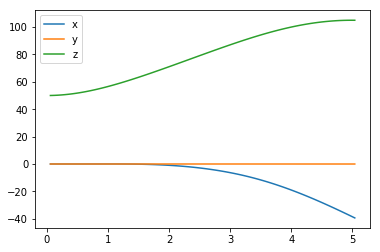

In [124]:
##Plot last-episode trajectory
plt.plot(results['time'], results['x'], label='x')
plt.plot(results['time'], results['y'], label='y')
plt.plot(results['time'], results['z'], label='z')
plt.legend()
_ = plt.ylim()

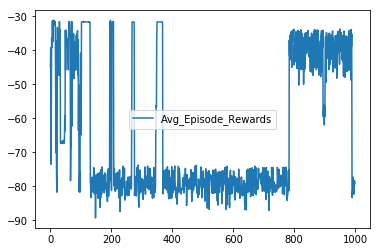

In [125]:
plt.plot(range(len(avg_episode_rewards)), avg_episode_rewards, label='Avg_Episode_Rewards')
plt.legend()
_ = plt.ylim()

**ATTEMPT 8**

In [130]:
'''
Change exploration sigma back to .2, and lower theta from .15 to .1.
'''


import sys
import pandas as pd
from agents.agent_new import DDPG
from task import Task

num_episodes = 1000
init_pose = np.array([0., 0., 50., 0., 0., 0.])
init_vel = np.array([0., 0., 0.])
init_angle_velocities = np.array([0., 0., 0.])
target_pose = np.array([0., 0., 0., 0., 0., 0.])
target_vel = np.array([0., 0., 0.])
task = Task(init_pose=init_pose, init_vel=init_vel, init_angle_velocities=init_angle_velocities, target_pose=target_pose, target_vel=target_vel)
agent = DDPG(task)
avg_episode_rewards = []
file_output = 'data2.txt'

'''
Leave things the same as before, just record simulation and action history for plotting
'''
labels = ['time', 'x', 'y', 'z', 'phi', 'theta', 'psi', 'x_velocity',
          'y_velocity', 'z_velocity', 'phi_velocity', 'theta_velocity',
          'psi_velocity', 'rotor_speed1', 'rotor_speed2', 'rotor_speed3', 'rotor_speed4']
results = {x : [] for x in labels}

'''
USED THIS REWARD FUNCTION in task.py:
alpha = .3, beta = .3, gamma = 1.

reward = - alpha*(abs(self.sim.pose[:3] - self.target_pose[:3])).sum() - beta*(abs(self.sim.v[:3] - self.target_vel)).sum()/(1 + gamma*(abs(self.sim.pose[:3] - self.target_pose[:3])).sum() ) #velocity only counts when close to ground
'''

for i_episode in range(1, num_episodes+1):
    print("")
    print("i_episode: " + str(i_episode))
    print("")
    print("")
    state = agent.reset_episode() # start a new episode
    time = 0
    total_episode_reward = 0
    count = 0
    
    with open(file_output, 'w') as csvfile:
        writer = csv.writer(csvfile)
        writer.writerow(labels)
    
        while True:
            print("")
            print("time: " + str(time))
            print("sim time: " + str(task.sim.time))
        
            action = agent.act(state) 
            next_state, reward, done = task.step(action)
            print("reward: " + str(reward))
        
            if i_episode == num_episodes: #only write last episode with fully trained actor and critic networks
                to_write = [task.sim.time] + list(task.sim.pose) + list(task.sim.v) + list(task.sim.angular_v) + list(rotor_speeds)
                for ii in range(len(labels)):
                    results[labels[ii]].append(to_write[ii])
                writer.writerow(to_write)
         
            total_episode_reward += reward
            count += 1
        
            agent.step(action, reward, next_state, done)
            state = next_state
            if done:
                break
            time += 1
    
    avg_episode_rewards.append(total_episode_reward/count)
    print("avg_episode_reward: " + str(total_episode_reward/count))
    sys.stdout.flush()

    #Interrupted since training was not improving performance


i_episode: 1



time: 0
sim time: 0.0
reward: -45.0061000921

time: 1
sim time: 0.06
reward: -45.0240070866

time: 2
sim time: 0.12000000000000001
reward: -45.023412172

time: 3
sim time: 0.18
reward: -44.9867982225

time: 4
sim time: 0.23999999999999996
reward: -44.9564886881

time: 5
sim time: 0.3
reward: -44.8538079235

time: 6
sim time: 0.36000000000000004
reward: -44.6939462

time: 7
sim time: 0.4200000000000001
reward: -44.5472932931

time: 8
sim time: 0.48000000000000015
reward: -44.3879057713

time: 9
sim time: 0.5400000000000001
reward: -44.143765039

time: 10
sim time: 0.6000000000000002
reward: -43.8656827415

time: 11
sim time: 0.6600000000000003
reward: -43.6095116333

time: 12
sim time: 0.7200000000000003
reward: -43.3073971869

time: 13
sim time: 0.7800000000000004
reward: -42.9305613944

time: 14
sim time: 0.8400000000000004
reward: -42.5423417787

time: 15
sim time: 0.9000000000000005
reward: -42.1659230051

time: 16
sim time: 0.9600000000000005
reward: -41.7197914119

reward: -49.9859261803

time: 22
sim time: 1.3200000000000007
reward: -50.1034790133

time: 23
sim time: 1.3800000000000008
reward: -50.1773814897

time: 24
sim time: 1.4400000000000008
reward: -50.282354428

time: 25
sim time: 1.5000000000000009
reward: -50.3910258432

time: 26
sim time: 1.560000000000001
reward: -50.436896035

time: 27
sim time: 1.620000000000001
reward: -50.488754675

time: 28
sim time: 1.680000000000001
reward: -50.5827577636

time: 29
sim time: 1.740000000000001
reward: -50.6586166357

time: 30
sim time: 1.8000000000000012
reward: -50.6644690554

time: 31
sim time: 1.8600000000000012
reward: -50.7140364532

time: 32
sim time: 1.9200000000000013
reward: -50.7857755731

time: 33
sim time: 1.9800000000000013
reward: -50.7991936605

time: 34
sim time: 2.0400000000000014
reward: -50.7890381835

time: 35
sim time: 2.1000000000000014
reward: -50.8221824085

time: 36
sim time: 2.1600000000000015
reward: -50.8670780572

time: 37
sim time: 2.2200000000000015
reward: -51.006


time: 8
sim time: 0.48000000000000015
reward: -45.5270397599

time: 9
sim time: 0.5400000000000001
reward: -45.4466666149

time: 10
sim time: 0.6000000000000002
reward: -45.3321628941

time: 11
sim time: 0.6600000000000003
reward: -45.1871060747

time: 12
sim time: 0.7200000000000003
reward: -45.0103110763

time: 13
sim time: 0.7800000000000004
reward: -44.8031006479

time: 14
sim time: 0.8400000000000004
reward: -44.5656631069

time: 15
sim time: 0.9000000000000005
reward: -44.2979851587

time: 16
sim time: 0.9600000000000005
reward: -43.9996637879

time: 17
sim time: 1.0200000000000005
reward: -43.672931279

time: 18
sim time: 1.0800000000000005
reward: -43.3105977853

time: 19
sim time: 1.1400000000000006
reward: -42.9243170338

time: 20
sim time: 1.2000000000000006
reward: -42.5119728647

time: 21
sim time: 1.2600000000000007
reward: -42.072911045

time: 22
sim time: 1.3200000000000007
reward: -41.5942012498

time: 23
sim time: 1.3800000000000008
reward: -41.0671444506

time: 24
s


time: 28
sim time: 1.680000000000001
reward: -34.1786795109

time: 29
sim time: 1.740000000000001
reward: -33.3597700509

time: 30
sim time: 1.8000000000000012
reward: -32.4776770645

time: 31
sim time: 1.8600000000000012
reward: -31.5741757662

time: 32
sim time: 1.9200000000000013
reward: -30.6689620156

time: 33
sim time: 1.9800000000000013
reward: -29.7137839706

time: 34
sim time: 2.0400000000000014
reward: -28.7131037037

time: 35
sim time: 2.1000000000000014
reward: -27.7122835273

time: 36
sim time: 2.1600000000000015
reward: -26.6840759469

time: 37
sim time: 2.2200000000000015
reward: -25.6001067802

time: 38
sim time: 2.2800000000000016
reward: -24.5064055872

time: 39
sim time: 2.3400000000000016
reward: -23.4110061031

time: 40
sim time: 2.4000000000000017
reward: -22.2546569955

time: 41
sim time: 2.4600000000000017
reward: -21.06605042

time: 42
sim time: 2.520000000000002
reward: -19.9051706506

time: 43
sim time: 2.580000000000002
reward: -18.7165183794

time: 44
sim 

avg_episode_reward: -31.8127940604

i_episode: 10



time: 0
sim time: 0.0
reward: -44.9986863919

time: 1
sim time: 0.06
reward: -44.9720024402

time: 2
sim time: 0.12000000000000001
reward: -44.9169704731

time: 3
sim time: 0.18
reward: -44.8546463589

time: 4
sim time: 0.23999999999999996
reward: -44.812587214

time: 5
sim time: 0.3
reward: -44.7054525361

time: 6
sim time: 0.36000000000000004
reward: -44.5347798053

time: 7
sim time: 0.4200000000000001
reward: -44.2824735442

time: 8
sim time: 0.48000000000000015
reward: -43.9638641966

time: 9
sim time: 0.5400000000000001
reward: -43.7540194204

time: 10
sim time: 0.6000000000000002
reward: -43.4747447725

time: 11
sim time: 0.6600000000000003
reward: -43.1964325669

time: 12
sim time: 0.7200000000000003
reward: -42.9684386603

time: 13
sim time: 0.7800000000000004
reward: -42.5814867798

time: 14
sim time: 0.8400000000000004
reward: -42.1645263522

time: 15
sim time: 0.9000000000000005
reward: -41.8768613073

time: 16
sim time: 0


time: 32
sim time: 1.9200000000000013
reward: -50.7729098155

time: 33
sim time: 1.9800000000000013
reward: -50.5335935649

time: 34
sim time: 2.0400000000000014
reward: -50.2812301314

time: 35
sim time: 2.1000000000000014
reward: -49.8445557898

time: 36
sim time: 2.1600000000000015
reward: -49.4065489973

time: 37
sim time: 2.2200000000000015
reward: -49.0807089852

time: 38
sim time: 2.2800000000000016
reward: -48.6106409854

time: 39
sim time: 2.3400000000000016
reward: -48.0607709857

time: 40
sim time: 2.4000000000000017
reward: -47.4557560826

time: 41
sim time: 2.4600000000000017
reward: -46.9783091482

time: 42
sim time: 2.520000000000002
reward: -46.4879218729

time: 43
sim time: 2.580000000000002
reward: -45.8241485921

time: 44
sim time: 2.640000000000002
reward: -44.9918422336

time: 45
sim time: 2.700000000000002
reward: -43.9912863751

time: 46
sim time: 2.760000000000002
reward: -43.1910915079

time: 47
sim time: 2.820000000000002
reward: -42.7596185811

time: 48
sim 


time: 2
sim time: 0.12000000000000001
reward: -45.2096827485

time: 3
sim time: 0.18
reward: -45.3727503644

time: 4
sim time: 0.23999999999999996
reward: -45.5811229691

time: 5
sim time: 0.3
reward: -45.8337484933

time: 6
sim time: 0.36000000000000004
reward: -46.1294032989

time: 7
sim time: 0.4200000000000001
reward: -46.4667131083

time: 8
sim time: 0.48000000000000015
reward: -46.8441453036

time: 9
sim time: 0.5400000000000001
reward: -47.2600368963

time: 10
sim time: 0.6000000000000002
reward: -47.7126263741

time: 11
sim time: 0.6600000000000003
reward: -48.2001494342

time: 12
sim time: 0.7200000000000003
reward: -48.721887142

time: 13
sim time: 0.7800000000000004
reward: -49.2757227685

time: 14
sim time: 0.8400000000000004
reward: -49.8599562589

time: 15
sim time: 0.9000000000000005
reward: -50.4836133157

time: 16
sim time: 0.9600000000000005
reward: -51.1878994312

time: 17
sim time: 1.0200000000000005
reward: -51.952937661

time: 18
sim time: 1.0800000000000005
rewa


time: 53
sim time: 3.1800000000000024
reward: -10.9608651501

time: 54
sim time: 3.2400000000000024
reward: -14.733274312
avg_episode_reward: -31.5659976716

i_episode: 16



time: 0
sim time: 0.0
reward: -45.0068776143

time: 1
sim time: 0.06
reward: -45.0317399071

time: 2
sim time: 0.12000000000000001
reward: -45.04145494

time: 3
sim time: 0.18
reward: -45.0250408597

time: 4
sim time: 0.23999999999999996
reward: -44.9877089465

time: 5
sim time: 0.3
reward: -44.8640673357

time: 6
sim time: 0.36000000000000004
reward: -44.733149149

time: 7
sim time: 0.4200000000000001
reward: -44.6199217561

time: 8
sim time: 0.48000000000000015
reward: -44.4344976311

time: 9
sim time: 0.5400000000000001
reward: -44.1816411187

time: 10
sim time: 0.6000000000000002
reward: -43.9463195869

time: 11
sim time: 0.6600000000000003
reward: -43.7003125246

time: 12
sim time: 0.7200000000000003
reward: -43.3671577002

time: 13
sim time: 0.7800000000000004
reward: -42.9980150389

time: 14
sim time: 0.84


time: 22
sim time: 1.3200000000000007
reward: -38.5291379681

time: 23
sim time: 1.3800000000000008
reward: -37.8499671492

time: 24
sim time: 1.4400000000000008
reward: -37.1375831386

time: 25
sim time: 1.5000000000000009
reward: -36.4378495508

time: 26
sim time: 1.560000000000001
reward: -35.6982412828

time: 27
sim time: 1.620000000000001
reward: -34.8877646185

time: 28
sim time: 1.680000000000001
reward: -34.0623146991

time: 29
sim time: 1.740000000000001
reward: -33.2393398853

time: 30
sim time: 1.8000000000000012
reward: -32.3637435365

time: 31
sim time: 1.8600000000000012
reward: -31.4312336289

time: 32
sim time: 1.9200000000000013
reward: -30.4931087592

time: 33
sim time: 1.9800000000000013
reward: -29.545854505

time: 34
sim time: 2.0400000000000014
reward: -28.5414918457

time: 35
sim time: 2.1000000000000014
reward: -27.4909736325

time: 36
sim time: 2.1600000000000015
reward: -26.4400171455

time: 37
sim time: 2.2200000000000015
reward: -25.3762294847

time: 38
sim


time: 37
sim time: 2.2200000000000015
reward: -25.4778691103

time: 38
sim time: 2.2800000000000016
reward: -24.3669688938

time: 39
sim time: 2.3400000000000016
reward: -23.2119714194

time: 40
sim time: 2.4000000000000017
reward: -22.0622818882

time: 41
sim time: 2.4600000000000017
reward: -20.9064326986

time: 42
sim time: 2.520000000000002
reward: -19.6955927811

time: 43
sim time: 2.580000000000002
reward: -18.4467376361

time: 44
sim time: 2.640000000000002
reward: -17.2262914343

time: 45
sim time: 2.700000000000002
reward: -16.0131269918

time: 46
sim time: 2.760000000000002
reward: -14.7452047879

time: 47
sim time: 2.820000000000002
reward: -13.4600223334

time: 48
sim time: 2.880000000000002
reward: -12.2912947755

time: 49
sim time: 2.940000000000002
reward: -11.2136819084

time: 50
sim time: 3.000000000000002
reward: -10.1253681814

time: 51
sim time: 3.0600000000000023
reward: -9.24708682181

time: 52
sim time: 3.1200000000000023
reward: -9.09705481827

time: 53
sim tim


time: 7
sim time: 0.4200000000000001
reward: -44.6211439056

time: 8
sim time: 0.48000000000000015
reward: -44.4334882793

time: 9
sim time: 0.5400000000000001
reward: -44.1813199661

time: 10
sim time: 0.6000000000000002
reward: -43.9484444274

time: 11
sim time: 0.6600000000000003
reward: -43.7012768297

time: 12
sim time: 0.7200000000000003
reward: -43.3662543946

time: 13
sim time: 0.7800000000000004
reward: -42.9990666628

time: 14
sim time: 0.8400000000000004
reward: -42.6553666319

time: 15
sim time: 0.9000000000000005
reward: -42.2637569439

time: 16
sim time: 0.9600000000000005
reward: -41.7915636216

time: 17
sim time: 1.0200000000000005
reward: -41.3167096004

time: 18
sim time: 1.0800000000000005
reward: -40.8490911569

time: 19
sim time: 1.1400000000000006
reward: -40.3110429432

time: 20
sim time: 1.2000000000000006
reward: -39.7145590455

time: 21
sim time: 1.2600000000000007
reward: -39.1305189227

time: 22
sim time: 1.3200000000000007
reward: -38.5287497418

time: 23



time: 32
sim time: 1.9200000000000013
reward: -30.3837907106

time: 33
sim time: 1.9800000000000013
reward: -29.3985528774

time: 34
sim time: 2.0400000000000014
reward: -28.3027571299

time: 35
sim time: 2.1000000000000014
reward: -27.0948266135

time: 36
sim time: 2.1600000000000015
reward: -25.8113125422

time: 37
sim time: 2.2200000000000015
reward: -24.4681370393

time: 38
sim time: 2.2800000000000016
reward: -23.1121286101

time: 39
sim time: 2.3400000000000016
reward: -21.7726033863

time: 40
sim time: 2.4000000000000017
reward: -20.4561492708

time: 41
sim time: 2.4600000000000017
reward: -19.1565730793

time: 42
sim time: 2.520000000000002
reward: -17.86804433

time: 43
sim time: 2.580000000000002
reward: -16.5980934042

time: 44
sim time: 2.640000000000002
reward: -15.511649744

time: 45
sim time: 2.700000000000002
reward: -14.5262968552

time: 46
sim time: 2.760000000000002
reward: -13.569456096

time: 47
sim time: 2.820000000000002
reward: -12.6312321728

time: 48
sim time


i_episode: 28



time: 0
sim time: 0.0
reward: -45.0068614778

time: 1
sim time: 0.06
reward: -45.0316630418

time: 2
sim time: 0.12000000000000001
reward: -45.0413694763

time: 3
sim time: 0.18
reward: -45.0249751195

time: 4
sim time: 0.23999999999999996
reward: -44.9876156471

time: 5
sim time: 0.3
reward: -44.8640049835

time: 6
sim time: 0.36000000000000004
reward: -44.7330642194

time: 7
sim time: 0.4200000000000001
reward: -44.6198402381

time: 8
sim time: 0.48000000000000015
reward: -44.4343736932

time: 9
sim time: 0.5400000000000001
reward: -44.1815643531

time: 10
sim time: 0.6000000000000002
reward: -43.9461892444

time: 11
sim time: 0.6600000000000003
reward: -43.7001156242

time: 12
sim time: 0.7200000000000003
reward: -43.3669368511

time: 13
sim time: 0.7800000000000004
reward: -42.9977265067

time: 14
sim time: 0.8400000000000004
reward: -42.6522074235

time: 15
sim time: 0.9000000000000005
reward: -42.2628207389

time: 16
sim time: 0.9600000000000005
reward: -41.7912

KeyboardInterrupt: 

**ATTEMPT 9**

In [131]:
'''
Recover original performance from Attempt 5
'''




import sys
import pandas as pd
from agents.agent import DDPG
from task import Task

num_episodes = 500
init_pose = np.array([0., 0., 50., 0., 0., 0.])
init_vel = np.array([0., 0., 0.])
init_angle_velocities = np.array([0., 0., 0.])
target_pose = np.array([0., 0., 0., 0., 0., 0.])
target_vel = np.array([0., 0., 0.])
task = Task(init_pose=init_pose, init_vel=init_vel, init_angle_velocities=init_angle_velocities, target_pose=target_pose, target_vel=target_vel)
agent = DDPG(task)
avg_episode_rewards = []
file_output = 'data2.txt'

'''
Leave things the same as before, just record simulation and action history for plotting
'''
labels = ['time', 'x', 'y', 'z', 'phi', 'theta', 'psi', 'x_velocity',
          'y_velocity', 'z_velocity', 'phi_velocity', 'theta_velocity',
          'psi_velocity', 'rotor_speed1', 'rotor_speed2', 'rotor_speed3', 'rotor_speed4']
results = {x : [] for x in labels}

'''
USED THIS REWARD FUNCTION in task.py:
alpha = .3, beta = .3, gamma = 1.

reward = - alpha*(abs(self.sim.pose[:3] - self.target_pose[:3])).sum() - beta*(abs(self.sim.v[:3] - self.target_vel)).sum()/(1 + gamma*(abs(self.sim.pose[:3] - self.target_pose[:3])).sum() ) #velocity only counts when close to ground
'''

for i_episode in range(1, num_episodes+1):
    print("")
    print("i_episode: " + str(i_episode))
    print("")
    print("")
    state = agent.reset_episode() # start a new episode
    time = 0
    total_episode_reward = 0
    count = 0
    
    with open(file_output, 'w') as csvfile:
        writer = csv.writer(csvfile)
        writer.writerow(labels)
    
        while True:
            print("")
            print("time: " + str(time))
            print("sim time: " + str(task.sim.time))
        
            action = agent.act(state) 
            next_state, reward, done = task.step(action)
            print("reward: " + str(reward))
        
            if i_episode == num_episodes: #only write last episode with fully trained actor and critic networks
                to_write = [task.sim.time] + list(task.sim.pose) + list(task.sim.v) + list(task.sim.angular_v) + list(rotor_speeds)
                for ii in range(len(labels)):
                    results[labels[ii]].append(to_write[ii])
                writer.writerow(to_write)
         
            total_episode_reward += reward
            count += 1
        
            agent.step(action, reward, next_state, done)
            state = next_state
            if done:
                break
            time += 1
    
    avg_episode_rewards.append(total_episode_reward/count)
    print("avg_episode_reward: " + str(total_episode_reward/count))
    sys.stdout.flush()

 



i_episode: 1



time: 0
sim time: 0.0
reward: -45.0336606176

time: 1
sim time: 0.06
reward: -45.1134521773

time: 2
sim time: 0.12000000000000001
reward: -45.1650082665

time: 3
sim time: 0.18
reward: -45.2617728665

time: 4
sim time: 0.23999999999999996
reward: -45.4232271253

time: 5
sim time: 0.3
reward: -45.6397111777

time: 6
sim time: 0.36000000000000004
reward: -45.783161112

time: 7
sim time: 0.4200000000000001
reward: -45.9787475684

time: 8
sim time: 0.48000000000000015
reward: -46.2316128061

time: 9
sim time: 0.5400000000000001
reward: -46.5053691177

time: 10
sim time: 0.6000000000000002
reward: -46.7149845109

time: 11
sim time: 0.6600000000000003
reward: -46.9960628435

time: 12
sim time: 0.7200000000000003
reward: -47.3286453029

time: 13
sim time: 0.7800000000000004
reward: -47.6413657083

time: 14
sim time: 0.8400000000000004
reward: -47.9241826616

time: 15
sim time: 0.9000000000000005
reward: -48.2751985371

time: 16
sim time: 0.9600000000000005
reward: -48.672509


time: 15
sim time: 0.9000000000000005
reward: -42.9997680801

time: 16
sim time: 0.9600000000000005
reward: -42.6304790838

time: 17
sim time: 1.0200000000000005
reward: -42.229076395

time: 18
sim time: 1.0800000000000005
reward: -41.7846381529

time: 19
sim time: 1.1400000000000006
reward: -41.3140923987

time: 20
sim time: 1.2000000000000006
reward: -40.8201482988

time: 21
sim time: 1.2600000000000007
reward: -40.2854368605

time: 22
sim time: 1.3200000000000007
reward: -39.7160651949

time: 23
sim time: 1.3800000000000008
reward: -39.1259622359

time: 24
sim time: 1.4400000000000008
reward: -38.5018410215

time: 25
sim time: 1.5000000000000009
reward: -37.8368849479

time: 26
sim time: 1.560000000000001
reward: -37.1496004125

time: 27
sim time: 1.620000000000001
reward: -36.4370785007

time: 28
sim time: 1.680000000000001
reward: -35.6798689781

time: 29
sim time: 1.740000000000001
reward: -34.8923382994

time: 30
sim time: 1.8000000000000012
reward: -34.0906237839

time: 31
sim


time: 1
sim time: 0.06
reward: -44.9720011988

time: 2
sim time: 0.12000000000000001
reward: -44.913484617

time: 3
sim time: 0.18
reward: -44.8229746434

time: 4
sim time: 0.23999999999999996
reward: -44.7001976024

time: 5
sim time: 0.3
reward: -44.5447647285

time: 6
sim time: 0.36000000000000004
reward: -44.3561671596

time: 7
sim time: 0.4200000000000001
reward: -44.1337691676

time: 8
sim time: 0.48000000000000015
reward: -43.876799435

time: 9
sim time: 0.5400000000000001
reward: -43.5843401016

time: 10
sim time: 0.6000000000000002
reward: -43.2553132746

time: 11
sim time: 0.6600000000000003
reward: -42.8884645789

time: 12
sim time: 0.7200000000000003
reward: -42.4823431978

time: 13
sim time: 0.7800000000000004
reward: -42.035277817

time: 14
sim time: 0.8400000000000004
reward: -41.5453473591

time: 15
sim time: 0.9000000000000005
reward: -41.0103457418

time: 16
sim time: 0.9600000000000005
reward: -40.4277391843

time: 17
sim time: 1.0200000000000005
reward: -39.79461424


time: 25
sim time: 1.5000000000000009
reward: -32.3698372641

time: 26
sim time: 1.560000000000001
reward: -31.0421583438

time: 27
sim time: 1.620000000000001
reward: -29.5900277902

time: 28
sim time: 1.680000000000001
reward: -27.997704267

time: 29
sim time: 1.740000000000001
reward: -26.2480422079

time: 30
sim time: 1.8000000000000012
reward: -24.3251626123

time: 31
sim time: 1.8600000000000012
reward: -22.2234971637

time: 32
sim time: 1.9200000000000013
reward: -19.9788727738

time: 33
sim time: 1.9800000000000013
reward: -17.7919008417

time: 34
sim time: 2.0400000000000014
reward: -16.7103978458

time: 35
sim time: 2.1000000000000014
reward: -29.3780992635

time: 36
sim time: 2.1600000000000015
reward: -158.395524899
avg_episode_reward: -39.7331476889

i_episode: 10



time: 0
sim time: 0.0
reward: -44.9986863309

time: 1
sim time: 0.06
reward: -44.9720011979

time: 2
sim time: 0.12000000000000001
reward: -44.913484625

time: 3
sim time: 0.18
reward: -44.8229746636

time: 4


time: 48
sim time: 2.880000000000002
reward: -11.9259165117
avg_episode_reward: -32.1762837523

i_episode: 13



time: 0
sim time: 0.0
reward: -45.0331180885

time: 1
sim time: 0.06
reward: -45.1445433049

time: 2
sim time: 0.12000000000000001
reward: -45.2727216383

time: 3
sim time: 0.18
reward: -45.4211802045

time: 4
sim time: 0.23999999999999996
reward: -45.5981662805

time: 5
sim time: 0.3
reward: -45.7136712102

time: 6
sim time: 0.36000000000000004
reward: -45.8600475832

time: 7
sim time: 0.4200000000000001
reward: -46.0572834234

time: 8
sim time: 0.48000000000000015
reward: -46.2478109076

time: 9
sim time: 0.5400000000000001
reward: -46.3838252397

time: 10
sim time: 0.6000000000000002
reward: -46.5807205696

time: 11
sim time: 0.6600000000000003
reward: -46.8123638974

time: 12
sim time: 0.7200000000000003
reward: -46.9995972962

time: 13
sim time: 0.7800000000000004
reward: -47.1768651867

time: 14
sim time: 0.8400000000000004
reward: -47.4152045361

time: 15
sim time: 0


time: 49
sim time: 2.940000000000002
reward: -28.5502799065

time: 50
sim time: 3.000000000000002
reward: -28.328116793

time: 51
sim time: 3.0600000000000023
reward: -28.130598658

time: 52
sim time: 3.1200000000000023
reward: -27.9179582626

time: 53
sim time: 3.1800000000000024
reward: -27.7669307563

time: 54
sim time: 3.2400000000000024
reward: -27.7163123138

time: 55
sim time: 3.3000000000000025
reward: -27.6632095435

time: 56
sim time: 3.3600000000000025
reward: -27.6389106672

time: 57
sim time: 3.4200000000000026
reward: -27.7270124841

time: 58
sim time: 3.4800000000000026
reward: -27.9452566099
avg_episode_reward: -37.489202496

i_episode: 15



time: 0
sim time: 0.0
reward: -45.0504148625

time: 1
sim time: 0.06
reward: -45.2060875717

time: 2
sim time: 0.12000000000000001
reward: -45.3321101659

time: 3
sim time: 0.18
reward: -45.4610155929

time: 4
sim time: 0.23999999999999996
reward: -45.5603036641

time: 5
sim time: 0.3
reward: -45.4974207626

time: 6
sim time: 0.36


time: 7
sim time: 0.4200000000000001
reward: -45.5851895493

time: 8
sim time: 0.48000000000000015
reward: -45.5318247467

time: 9
sim time: 0.5400000000000001
reward: -45.3458660435

time: 10
sim time: 0.6000000000000002
reward: -45.2852330602

time: 11
sim time: 0.6600000000000003
reward: -45.2548592671

time: 12
sim time: 0.7200000000000003
reward: -45.0226293002

time: 13
sim time: 0.7800000000000004
reward: -44.7595144724

time: 14
sim time: 0.8400000000000004
reward: -44.6446069124

time: 15
sim time: 0.9000000000000005
reward: -44.4502054997

time: 16
sim time: 0.9600000000000005
reward: -44.0726868258

time: 17
sim time: 1.0200000000000005
reward: -43.7684997095

time: 18
sim time: 1.0800000000000005
reward: -43.5644548815

time: 19
sim time: 1.1400000000000006
reward: -43.1956119224

time: 20
sim time: 1.2000000000000006
reward: -42.7208873985

time: 21
sim time: 1.2600000000000007
reward: -42.3828809876

time: 22
sim time: 1.3200000000000007
reward: -42.0507701198

time: 23



time: 27
sim time: 1.620000000000001
reward: -38.8437794172

time: 28
sim time: 1.680000000000001
reward: -38.2191657899

time: 29
sim time: 1.740000000000001
reward: -37.6761555044

time: 30
sim time: 1.8000000000000012
reward: -36.9700869163

time: 31
sim time: 1.8600000000000012
reward: -36.1783467052

time: 32
sim time: 1.9200000000000013
reward: -35.5236791051

time: 33
sim time: 1.9800000000000013
reward: -34.8628132907

time: 34
sim time: 2.0400000000000014
reward: -34.0234979343

time: 35
sim time: 2.1000000000000014
reward: -33.1946456107

time: 36
sim time: 2.1600000000000015
reward: -32.497771867

time: 37
sim time: 2.2200000000000015
reward: -31.7114834933

time: 38
sim time: 2.2800000000000016
reward: -30.7816377657

time: 39
sim time: 2.3400000000000016
reward: -29.9440237874

time: 40
sim time: 2.4000000000000017
reward: -29.1807749464

time: 41
sim time: 2.4600000000000017
reward: -28.2758445432

time: 42
sim time: 2.520000000000002
reward: -27.2991326148

time: 43
sim

reward: -26.7374887135

time: 43
sim time: 2.580000000000002
reward: -25.7431624397

time: 44
sim time: 2.640000000000002
reward: -24.7294089445

time: 45
sim time: 2.700000000000002
reward: -23.5429825109

time: 46
sim time: 2.760000000000002
reward: -22.3603032562

time: 47
sim time: 2.820000000000002
reward: -21.2854091377

time: 48
sim time: 2.880000000000002
reward: -20.1245845175

time: 49
sim time: 2.940000000000002
reward: -18.8362495761

time: 50
sim time: 3.000000000000002
reward: -17.6216796811

time: 51
sim time: 3.0600000000000023
reward: -16.4792487207

time: 52
sim time: 3.1200000000000023
reward: -15.2275156947

time: 53
sim time: 3.1800000000000024
reward: -13.9517824069

time: 54
sim time: 3.2400000000000024
reward: -12.8293221671

time: 55
sim time: 3.3000000000000025
reward: -11.7935364869

time: 56
sim time: 3.3600000000000025
reward: -10.9856773135
avg_episode_reward: -34.6646333707

i_episode: 22



time: 0
sim time: 0.0
reward: -45.0503888995

time: 1
sim time: 

reward: -16.0319115111
avg_episode_reward: -34.9304099953

i_episode: 24



time: 0
sim time: 0.0
reward: -45.0504067523

time: 1
sim time: 0.06
reward: -45.2063259364

time: 2
sim time: 0.12000000000000001
reward: -45.3329102805

time: 3
sim time: 0.18
reward: -45.4628505219

time: 4
sim time: 0.23999999999999996
reward: -45.5611965433

time: 5
sim time: 0.3
reward: -45.4972774968

time: 6
sim time: 0.36000000000000004
reward: -45.484270268

time: 7
sim time: 0.4200000000000001
reward: -45.582969163

time: 8
sim time: 0.48000000000000015
reward: -45.5196211456

time: 9
sim time: 0.5400000000000001
reward: -45.3251492526

time: 10
sim time: 0.6000000000000002
reward: -45.2563357829

time: 11
sim time: 0.6600000000000003
reward: -45.207680855

time: 12
sim time: 0.7200000000000003
reward: -44.9511553884

time: 13
sim time: 0.7800000000000004
reward: -44.6640619161

time: 14
sim time: 0.8400000000000004
reward: -44.5190549352

time: 15
sim time: 0.9000000000000005
reward: -44.2822685305



time: 18
sim time: 1.0800000000000005
reward: -43.6324401997

time: 19
sim time: 1.1400000000000006
reward: -43.2773689303

time: 20
sim time: 1.2000000000000006
reward: -42.8235361693

time: 21
sim time: 1.2600000000000007
reward: -42.5096431848

time: 22
sim time: 1.3200000000000007
reward: -42.1973845594

time: 23
sim time: 1.3800000000000008
reward: -41.6924609838

time: 24
sim time: 1.4400000000000008
reward: -41.191445484

time: 25
sim time: 1.5000000000000009
reward: -40.8294943458

time: 26
sim time: 1.560000000000001
reward: -40.3698893487

time: 27
sim time: 1.620000000000001
reward: -39.7532551505

time: 28
sim time: 1.680000000000001
reward: -39.2317662472

time: 29
sim time: 1.740000000000001
reward: -38.7888358677

time: 30
sim time: 1.8000000000000012
reward: -38.1852118289

time: 31
sim time: 1.8600000000000012
reward: -37.5068108929

time: 32
sim time: 1.9200000000000013
reward: -36.9698796967

time: 33
sim time: 1.9800000000000013
reward: -36.4215132845

time: 34
sim


time: 36
sim time: 2.1600000000000015
reward: -37.395193321

time: 37
sim time: 2.2200000000000015
reward: -37.0978798285

time: 38
sim time: 2.2800000000000016
reward: -36.71855108

time: 39
sim time: 2.3400000000000016
reward: -36.4744680511

time: 40
sim time: 2.4000000000000017
reward: -36.299976718

time: 41
sim time: 2.4600000000000017
reward: -36.0421565205

time: 42
sim time: 2.520000000000002
reward: -35.7912962928

time: 43
sim time: 2.580000000000002
reward: -35.6945674633

time: 44
sim time: 2.640000000000002
reward: -35.5983819505

time: 45
sim time: 2.700000000000002
reward: -35.4412778215

time: 46
sim time: 2.760000000000002
reward: -35.3843469532

time: 47
sim time: 2.820000000000002
reward: -35.4292738219

time: 48
sim time: 2.880000000000002
reward: -35.4550555765

time: 49
sim time: 2.940000000000002
reward: -35.478815086

time: 50
sim time: 3.000000000000002
reward: -35.6490074267

time: 51
sim time: 3.0600000000000023
reward: -35.8518765678

time: 52
sim time: 3.


time: 50
sim time: 3.000000000000002
reward: -23.1017881437

time: 51
sim time: 3.0600000000000023
reward: -22.1558568055

time: 52
sim time: 3.1200000000000023
reward: -21.2676011741

time: 53
sim time: 3.1800000000000024
reward: -20.3316128547

time: 54
sim time: 3.2400000000000024
reward: -19.4775750571

time: 55
sim time: 3.3000000000000025
reward: -18.7044643395

time: 56
sim time: 3.3600000000000025
reward: -17.8830021025

time: 57
sim time: 3.4200000000000026
reward: -16.8817891273

time: 58
sim time: 3.4800000000000026
reward: -15.7470187764

time: 59
sim time: 3.5400000000000027
reward: -14.5126219131

time: 60
sim time: 3.6000000000000028
reward: -13.8840724892
avg_episode_reward: -35.3615660826

i_episode: 31



time: 0
sim time: 0.0
reward: -45.050430099

time: 1
sim time: 0.06
reward: -45.2070804716

time: 2
sim time: 0.12000000000000001
reward: -45.3354318836

time: 3
sim time: 0.18
reward: -45.4680078947

time: 4
sim time: 0.23999999999999996
reward: -45.5634466457

tim


time: 10
sim time: 0.6000000000000002
reward: -45.2515092492

time: 11
sim time: 0.6600000000000003
reward: -45.2046022486

time: 12
sim time: 0.7200000000000003
reward: -44.9519180497

time: 13
sim time: 0.7800000000000004
reward: -44.6683766083

time: 14
sim time: 0.8400000000000004
reward: -44.5303237639

time: 15
sim time: 0.9000000000000005
reward: -44.3079116924

time: 16
sim time: 0.9600000000000005
reward: -43.9017646143

time: 17
sim time: 1.0200000000000005
reward: -43.5699396535

time: 18
sim time: 1.0800000000000005
reward: -43.3367468885

time: 19
sim time: 1.1400000000000006
reward: -42.9381590974

time: 20
sim time: 1.2000000000000006
reward: -42.4366234444

time: 21
sim time: 1.2600000000000007
reward: -42.0754286504

time: 22
sim time: 1.3200000000000007
reward: -41.7226820161

time: 23
sim time: 1.3800000000000008
reward: -41.1809690899

time: 24
sim time: 1.4400000000000008
reward: -40.6441934167

time: 25
sim time: 1.5000000000000009
reward: -40.2544517525

time: 2

reward: -41.0258302408

time: 24
sim time: 1.4400000000000008
reward: -40.4118672898

time: 25
sim time: 1.5000000000000009
reward: -39.9261398117

time: 26
sim time: 1.560000000000001
reward: -39.3317718396

time: 27
sim time: 1.620000000000001
reward: -38.5617265767

time: 28
sim time: 1.680000000000001
reward: -37.8691957786

time: 29
sim time: 1.740000000000001
reward: -37.2441900995

time: 30
sim time: 1.8000000000000012
reward: -36.4418312274

time: 31
sim time: 1.8600000000000012
reward: -35.5423696912

time: 32
sim time: 1.9200000000000013
reward: -34.7655755027

time: 33
sim time: 1.9800000000000013
reward: -33.9630387056

time: 34
sim time: 2.0400000000000014
reward: -32.9618072608

time: 35
sim time: 2.1000000000000014
reward: -31.9589960071

time: 36
sim time: 2.1600000000000015
reward: -31.0689318764

time: 37
sim time: 2.2200000000000015
reward: -30.065476313

time: 38
sim time: 2.2800000000000016
reward: -28.9005125394

time: 39
sim time: 2.3400000000000016
reward: -27.8


time: 39
sim time: 2.3400000000000016
reward: -28.9320218961

time: 40
sim time: 2.4000000000000017
reward: -28.2224466085

time: 41
sim time: 2.4600000000000017
reward: -27.613047453

time: 42
sim time: 2.520000000000002
reward: -26.9277023555

time: 43
sim time: 2.580000000000002
reward: -26.2044633336

time: 44
sim time: 2.640000000000002
reward: -25.6141898017

time: 45
sim time: 2.700000000000002
reward: -25.0404626139

time: 46
sim time: 2.760000000000002
reward: -24.4228422908

time: 47
sim time: 2.820000000000002
reward: -23.8156290675

time: 48
sim time: 2.880000000000002
reward: -23.3369229313

time: 49
sim time: 2.940000000000002
reward: -22.8494623756

time: 50
sim time: 3.000000000000002
reward: -22.3422236236

time: 51
sim time: 3.0600000000000023
reward: -21.9015225467

time: 52
sim time: 3.1200000000000023
reward: -21.6248569505

time: 53
sim time: 3.1800000000000024
reward: -21.4891967826

time: 54
sim time: 3.2400000000000024
reward: -21.499917419

time: 55
sim time:


i_episode: 40



time: 0
sim time: 0.0
reward: -45.0311601939

time: 1
sim time: 0.06
reward: -45.1677571313

time: 2
sim time: 0.12000000000000001
reward: -45.3765344917

time: 3
sim time: 0.18
reward: -45.5460824352

time: 4
sim time: 0.23999999999999996
reward: -45.6472732973

time: 5
sim time: 0.3
reward: -45.7322135458

time: 6
sim time: 0.36000000000000004
reward: -45.9081532909

time: 7
sim time: 0.4200000000000001
reward: -46.0262220406

time: 8
sim time: 0.48000000000000015
reward: -45.9591350173

time: 9
sim time: 0.5400000000000001
reward: -45.9473426089

time: 10
sim time: 0.6000000000000002
reward: -46.0472108961

time: 11
sim time: 0.6600000000000003
reward: -45.9890623932

time: 12
sim time: 0.7200000000000003
reward: -45.8007391291

time: 13
sim time: 0.7800000000000004
reward: -45.742700657

time: 14
sim time: 0.8400000000000004
reward: -45.7055031129

time: 15
sim time: 0.9000000000000005
reward: -45.4645123338

time: 16
sim time: 0.9600000000000005
reward: -45.19873


time: 9
sim time: 0.5400000000000001
reward: -45.330157569

time: 10
sim time: 0.6000000000000002
reward: -45.2564464484

time: 11
sim time: 0.6600000000000003
reward: -45.2173321198

time: 12
sim time: 0.7200000000000003
reward: -44.9739404461

time: 13
sim time: 0.7800000000000004
reward: -44.6886544169

time: 14
sim time: 0.8400000000000004
reward: -44.5475197089

time: 15
sim time: 0.9000000000000005
reward: -44.32880516

time: 16
sim time: 0.9600000000000005
reward: -43.9171872944

time: 17
sim time: 1.0200000000000005
reward: -43.5667467319

time: 18
sim time: 1.0800000000000005
reward: -43.3145877573

time: 19
sim time: 1.1400000000000006
reward: -42.8939054506

time: 20
sim time: 1.2000000000000006
reward: -42.352213474

time: 21
sim time: 1.2600000000000007
reward: -41.9368084393

time: 22
sim time: 1.3200000000000007
reward: -41.5248682025

time: 23
sim time: 1.3800000000000008
reward: -40.9069160802

time: 24
sim time: 1.4400000000000008
reward: -40.2699424433

time: 25
sim

reward: -40.2799888484

time: 28
sim time: 1.680000000000001
reward: -39.7324497804

time: 29
sim time: 1.740000000000001
reward: -39.1507470892

time: 30
sim time: 1.8000000000000012
reward: -38.5132069342

time: 31
sim time: 1.8600000000000012
reward: -37.8427321381

time: 32
sim time: 1.9200000000000013
reward: -37.1785974136

time: 33
sim time: 1.9800000000000013
reward: -36.4801836033

time: 34
sim time: 2.0400000000000014
reward: -35.733350968

time: 35
sim time: 2.1000000000000014
reward: -35.012305668

time: 36
sim time: 2.1600000000000015
reward: -34.3027925729

time: 37
sim time: 2.2200000000000015
reward: -33.5465948523

time: 38
sim time: 2.2800000000000016
reward: -32.7845233583

time: 39
sim time: 2.3400000000000016
reward: -32.0406723768

time: 40
sim time: 2.4000000000000017
reward: -31.2652465417

time: 41
sim time: 2.4600000000000017
reward: -30.440507376

time: 42
sim time: 2.520000000000002
reward: -29.597614522

time: 43
sim time: 2.580000000000002
reward: -28.7510


time: 43
sim time: 2.580000000000002
reward: -19.3277261681

time: 44
sim time: 2.640000000000002
reward: -18.0502551411

time: 45
sim time: 2.700000000000002
reward: -16.7155912528

time: 46
sim time: 2.760000000000002
reward: -15.3636234641

time: 47
sim time: 2.820000000000002
reward: -14.1226723362

time: 48
sim time: 2.880000000000002
reward: -12.9051223976

time: 49
sim time: 2.940000000000002
reward: -11.6668835476

time: 50
sim time: 3.000000000000002
reward: -10.5113321205

time: 51
sim time: 3.0600000000000023
reward: -9.58674897745

time: 52
sim time: 3.1200000000000023
reward: -8.7504640367

time: 53
sim time: 3.1800000000000024
reward: -8.20554831584

time: 54
sim time: 3.2400000000000024
reward: -8.36780652363

time: 55
sim time: 3.3000000000000025
reward: -9.65317610287
avg_episode_reward: -32.1590258587

i_episode: 47



time: 0
sim time: 0.0
reward: -45.0504058256

time: 1
sim time: 0.06
reward: -45.2062760111

time: 2
sim time: 0.12000000000000001
reward: -45.3269640


time: 11
sim time: 0.6600000000000003
reward: -45.8255304696

time: 12
sim time: 0.7200000000000003
reward: -45.8128338517

time: 13
sim time: 0.7800000000000004
reward: -45.7209668719

time: 14
sim time: 0.8400000000000004
reward: -45.6002982362

time: 15
sim time: 0.9000000000000005
reward: -45.4658925943

time: 16
sim time: 0.9600000000000005
reward: -45.3058593618

time: 17
sim time: 1.0200000000000005
reward: -45.1036178786

time: 18
sim time: 1.0800000000000005
reward: -44.851002046

time: 19
sim time: 1.1400000000000006
reward: -44.5833136666

time: 20
sim time: 1.2000000000000006
reward: -44.3025235197

time: 21
sim time: 1.2600000000000007
reward: -43.9577062033

time: 22
sim time: 1.3200000000000007
reward: -43.5787544029

time: 23
sim time: 1.3800000000000008
reward: -43.2157062261

time: 24
sim time: 1.4400000000000008
reward: -42.8143866793

time: 25
sim time: 1.5000000000000009
reward: -42.3616162588

time: 26
sim time: 1.560000000000001
reward: -41.9216452207

time: 27


reward: -39.912758827

time: 31
sim time: 1.8600000000000012
reward: -39.3848803731

time: 32
sim time: 1.9200000000000013
reward: -38.8103155438

time: 33
sim time: 1.9800000000000013
reward: -38.149456391

time: 34
sim time: 2.0400000000000014
reward: -37.4690085946

time: 35
sim time: 2.1000000000000014
reward: -36.7668701491

time: 36
sim time: 2.1600000000000015
reward: -35.9776273612

time: 37
sim time: 2.2200000000000015
reward: -35.1156164268

time: 38
sim time: 2.2800000000000016
reward: -34.2183252346

time: 39
sim time: 2.3400000000000016
reward: -33.2845906562

time: 40
sim time: 2.4000000000000017
reward: -32.2772948198

time: 41
sim time: 2.4600000000000017
reward: -31.2195496961

time: 42
sim time: 2.520000000000002
reward: -30.1628287819

time: 43
sim time: 2.580000000000002
reward: -29.0697970436

time: 44
sim time: 2.640000000000002
reward: -27.9072080273

time: 45
sim time: 2.700000000000002
reward: -26.7493505307

time: 46
sim time: 2.760000000000002
reward: -25.595


time: 45
sim time: 2.700000000000002
reward: -27.0147117367

time: 46
sim time: 2.760000000000002
reward: -25.8188243209

time: 47
sim time: 2.820000000000002
reward: -24.615983157

time: 48
sim time: 2.880000000000002
reward: -23.3434082216

time: 49
sim time: 2.940000000000002
reward: -22.0261734294

time: 50
sim time: 3.000000000000002
reward: -20.7099455259

time: 51
sim time: 3.0600000000000023
reward: -19.378782399

time: 52
sim time: 3.1200000000000023
reward: -18.0236241508

time: 53
sim time: 3.1800000000000024
reward: -16.6895466722

time: 54
sim time: 3.2400000000000024
reward: -15.397012791

time: 55
sim time: 3.3000000000000025
reward: -14.0945298222

time: 56
sim time: 3.3600000000000025
reward: -12.860564428
avg_episode_reward: -36.9410713174

i_episode: 54



time: 0
sim time: 0.0
reward: -45.0504130449

time: 1
sim time: 0.06
reward: -45.2058465668

time: 2
sim time: 0.12000000000000001
reward: -45.3316131741

time: 3
sim time: 0.18
reward: -45.3652821664

time: 4
sim


time: 8
sim time: 0.48000000000000015
reward: -45.536033032

time: 9
sim time: 0.5400000000000001
reward: -45.3530896847

time: 10
sim time: 0.6000000000000002
reward: -45.2582843898

time: 11
sim time: 0.6600000000000003
reward: -45.1628715271

time: 12
sim time: 0.7200000000000003
reward: -45.0716298513

time: 13
sim time: 0.7800000000000004
reward: -44.9895785511

time: 14
sim time: 0.8400000000000004
reward: -44.9335312734

time: 15
sim time: 0.9000000000000005
reward: -44.8706691907

time: 16
sim time: 0.9600000000000005
reward: -44.7846134073

time: 17
sim time: 1.0200000000000005
reward: -44.6319688142

time: 18
sim time: 1.0800000000000005
reward: -44.4560670875

time: 19
sim time: 1.1400000000000006
reward: -44.2752539489

time: 20
sim time: 1.2000000000000006
reward: -44.0193330121

time: 21
sim time: 1.2600000000000007
reward: -43.7404300313

time: 22
sim time: 1.3200000000000007
reward: -43.4800251372

time: 23
sim time: 1.3800000000000008
reward: -43.1496971606

time: 24



time: 20
sim time: 1.2000000000000006
reward: -44.0660097007

time: 21
sim time: 1.2600000000000007
reward: -43.7240889314

time: 22
sim time: 1.3200000000000007
reward: -43.3396964894

time: 23
sim time: 1.3800000000000008
reward: -42.927284163

time: 24
sim time: 1.4400000000000008
reward: -42.4965258982

time: 25
sim time: 1.5000000000000009
reward: -42.0354538464

time: 26
sim time: 1.560000000000001
reward: -41.5287294969

time: 27
sim time: 1.620000000000001
reward: -41.0001228233

time: 28
sim time: 1.680000000000001
reward: -40.4679798558

time: 29
sim time: 1.740000000000001
reward: -39.8839901753

time: 30
sim time: 1.8000000000000012
reward: -39.2361774188

time: 31
sim time: 1.8600000000000012
reward: -38.5792844777

time: 32
sim time: 1.9200000000000013
reward: -37.8844783015

time: 33
sim time: 1.9800000000000013
reward: -37.0922406818

time: 34
sim time: 2.0400000000000014
reward: -36.2471825426

time: 35
sim time: 2.1000000000000014
reward: -35.3706469085

time: 36
sim


time: 48
sim time: 2.880000000000002
reward: -17.378842824

time: 49
sim time: 2.940000000000002
reward: -15.728799797

time: 50
sim time: 3.000000000000002
reward: -14.1923735405

time: 51
sim time: 3.0600000000000023
reward: -12.8203038742

time: 52
sim time: 3.1200000000000023
reward: -11.5346557512

time: 53
sim time: 3.1800000000000024
reward: -10.7984294341
avg_episode_reward: -35.7017817851

i_episode: 61



time: 0
sim time: 0.0
reward: -45.0504215175

time: 1
sim time: 0.06
reward: -45.196199322

time: 2
sim time: 0.12000000000000001
reward: -45.3378745368

time: 3
sim time: 0.18
reward: -45.5041104575

time: 4
sim time: 0.23999999999999996
reward: -45.6062042687

time: 5
sim time: 0.3
reward: -45.7915109412

time: 6
sim time: 0.36000000000000004
reward: -46.0438464236

time: 7
sim time: 0.4200000000000001
reward: -46.099344722

time: 8
sim time: 0.48000000000000015
reward: -46.0797810021

time: 9
sim time: 0.5400000000000001
reward: -46.1823619349

time: 10
sim time: 0.60000

reward: -44.2852410028

time: 16
sim time: 0.9600000000000005
reward: -43.8633755096

time: 17
sim time: 1.0200000000000005
reward: -43.5032359742

time: 18
sim time: 1.0800000000000005
reward: -43.2467538035

time: 19
sim time: 1.1400000000000006
reward: -42.8344528853

time: 20
sim time: 1.2000000000000006
reward: -42.3110118375

time: 21
sim time: 1.2600000000000007
reward: -41.9248192771

time: 22
sim time: 1.3200000000000007
reward: -41.551063916

time: 23
sim time: 1.3800000000000008
reward: -40.9861435542

time: 24
sim time: 1.4400000000000008
reward: -40.3965185454

time: 25
sim time: 1.5000000000000009
reward: -39.8681026278

time: 26
sim time: 1.560000000000001
reward: -39.318614457

time: 27
sim time: 1.620000000000001
reward: -38.7202327271

time: 28
sim time: 1.680000000000001
reward: -38.0335734239

time: 29
sim time: 1.740000000000001
reward: -37.2747593298

time: 30
sim time: 1.8000000000000012
reward: -36.4799222125

time: 31
sim time: 1.8600000000000012
reward: -35.69


time: 32
sim time: 1.9200000000000013
reward: -39.0539017751

time: 33
sim time: 1.9800000000000013
reward: -38.6369523911

time: 34
sim time: 2.0400000000000014
reward: -38.1659022427

time: 35
sim time: 2.1000000000000014
reward: -37.6653487705

time: 36
sim time: 2.1600000000000015
reward: -37.1628978246

time: 37
sim time: 2.2200000000000015
reward: -36.6186309266

time: 38
sim time: 2.2800000000000016
reward: -36.0273732875

time: 39
sim time: 2.3400000000000016
reward: -35.4605985228

time: 40
sim time: 2.4000000000000017
reward: -34.9007718426

time: 41
sim time: 2.4600000000000017
reward: -34.2990172152

time: 42
sim time: 2.520000000000002
reward: -33.69449983

time: 43
sim time: 2.580000000000002
reward: -33.1019047345

time: 44
sim time: 2.640000000000002
reward: -32.47738603

time: 45
sim time: 2.700000000000002
reward: -31.8078246313

time: 46
sim time: 2.760000000000002
reward: -31.1192487447

time: 47
sim time: 2.820000000000002
reward: -30.4245079393

time: 48
sim time


time: 50
sim time: 3.000000000000002
reward: -16.4771810123

time: 51
sim time: 3.0600000000000023
reward: -15.142909457
avg_episode_reward: -37.6239680776

i_episode: 68



time: 0
sim time: 0.0
reward: -45.050398349

time: 1
sim time: 0.06
reward: -45.2057835038

time: 2
sim time: 0.12000000000000001
reward: -45.3321879503

time: 3
sim time: 0.18
reward: -45.3711292505

time: 4
sim time: 0.23999999999999996
reward: -45.4103866124

time: 5
sim time: 0.3
reward: -45.5159082107

time: 6
sim time: 0.36000000000000004
reward: -45.6375155504

time: 7
sim time: 0.4200000000000001
reward: -45.6715758154

time: 8
sim time: 0.48000000000000015
reward: -45.6316780782

time: 9
sim time: 0.5400000000000001
reward: -45.5389961407

time: 10
sim time: 0.6000000000000002
reward: -45.4478785414

time: 11
sim time: 0.6600000000000003
reward: -45.3625487485

time: 12
sim time: 0.7200000000000003
reward: -45.2563582498

time: 13
sim time: 0.7800000000000004
reward: -45.1129467016

time: 14
sim time: 0.8


time: 19
sim time: 1.1400000000000006
reward: -40.066910804

time: 20
sim time: 1.2000000000000006
reward: -39.3533523376

time: 21
sim time: 1.2600000000000007
reward: -38.6460324129

time: 22
sim time: 1.3200000000000007
reward: -37.9135061472

time: 23
sim time: 1.3800000000000008
reward: -37.1051558491

time: 24
sim time: 1.4400000000000008
reward: -36.2771830378

time: 25
sim time: 1.5000000000000009
reward: -35.4504411582

time: 26
sim time: 1.560000000000001
reward: -34.5611033735

time: 27
sim time: 1.620000000000001
reward: -33.6144648101

time: 28
sim time: 1.680000000000001
reward: -32.7080288975

time: 29
sim time: 1.740000000000001
reward: -31.8015936004

time: 30
sim time: 1.8000000000000012
reward: -30.8245622396

time: 31
sim time: 1.8600000000000012
reward: -29.8493775069

time: 32
sim time: 1.9200000000000013
reward: -28.92317547

time: 33
sim time: 1.9800000000000013
reward: -27.9699908553

time: 34
sim time: 2.0400000000000014
reward: -26.9976159132

time: 35
sim t


time: 38
sim time: 2.2800000000000016
reward: -33.0724410709

time: 39
sim time: 2.3400000000000016
reward: -32.0694157775

time: 40
sim time: 2.4000000000000017
reward: -31.0438885865

time: 41
sim time: 2.4600000000000017
reward: -29.9434196725

time: 42
sim time: 2.520000000000002
reward: -28.8180796436

time: 43
sim time: 2.580000000000002
reward: -27.6895474525

time: 44
sim time: 2.640000000000002
reward: -26.4903931839

time: 45
sim time: 2.700000000000002
reward: -25.2467673657

time: 46
sim time: 2.760000000000002
reward: -24.0061055649

time: 47
sim time: 2.820000000000002
reward: -22.7091904066

time: 48
sim time: 2.880000000000002
reward: -21.3727612191

time: 49
sim time: 2.940000000000002
reward: -20.0721695151

time: 50
sim time: 3.000000000000002
reward: -18.7580887271

time: 51
sim time: 3.0600000000000023
reward: -17.4089663205

time: 52
sim time: 3.1200000000000023
reward: -16.0903823454

time: 53
sim time: 3.1800000000000024
reward: -14.8898295317

time: 54
sim tim


time: 11
sim time: 0.6600000000000003
reward: -45.8269127211

time: 12
sim time: 0.7200000000000003
reward: -45.7214494016

time: 13
sim time: 0.7800000000000004
reward: -45.6007803166

time: 14
sim time: 0.8400000000000004
reward: -45.4498550434

time: 15
sim time: 0.9000000000000005
reward: -45.2249312208

time: 16
sim time: 0.9600000000000005
reward: -44.9890319889

time: 17
sim time: 1.0200000000000005
reward: -44.755351746

time: 18
sim time: 1.0800000000000005
reward: -44.4564718419

time: 19
sim time: 1.1400000000000006
reward: -44.0976303225

time: 20
sim time: 1.2000000000000006
reward: -43.7661340714

time: 21
sim time: 1.2600000000000007
reward: -43.4078537313

time: 22
sim time: 1.3200000000000007
reward: -42.9882110171

time: 23
sim time: 1.3800000000000008
reward: -42.5654147145

time: 24
sim time: 1.4400000000000008
reward: -42.1241293888

time: 25
sim time: 1.5000000000000009
reward: -41.6717435027

time: 26
sim time: 1.560000000000001
reward: -41.1816721936

time: 27



time: 28
sim time: 1.680000000000001
reward: -38.7524197993

time: 29
sim time: 1.740000000000001
reward: -38.1284522999

time: 30
sim time: 1.8000000000000012
reward: -37.4305486313

time: 31
sim time: 1.8600000000000012
reward: -36.7165489592

time: 32
sim time: 1.9200000000000013
reward: -36.0161523234

time: 33
sim time: 1.9800000000000013
reward: -35.2533310338

time: 34
sim time: 2.0400000000000014
reward: -34.4353023688

time: 35
sim time: 2.1000000000000014
reward: -33.6355050471

time: 36
sim time: 2.1600000000000015
reward: -32.7979206503

time: 37
sim time: 2.2200000000000015
reward: -31.8632290687

time: 38
sim time: 2.2800000000000016
reward: -30.9035052886

time: 39
sim time: 2.3400000000000016
reward: -29.9266147219

time: 40
sim time: 2.4000000000000017
reward: -28.8438560008

time: 41
sim time: 2.4600000000000017
reward: -27.6645915047

time: 42
sim time: 2.520000000000002
reward: -26.4453198502

time: 43
sim time: 2.580000000000002
reward: -25.1531044156

time: 44
si


time: 52
sim time: 3.1200000000000023
reward: -16.6788046386

time: 53
sim time: 3.1800000000000024
reward: -15.7760503592

time: 54
sim time: 3.2400000000000024
reward: -14.8744392207

time: 55
sim time: 3.3000000000000025
reward: -14.1097315255

time: 56
sim time: 3.3600000000000025
reward: -13.5478227428
avg_episode_reward: -34.5416519824

i_episode: 80



time: 0
sim time: 0.0
reward: -45.0503524941

time: 1
sim time: 0.06
reward: -45.1840606066

time: 2
sim time: 0.12000000000000001
reward: -45.295150224

time: 3
sim time: 0.18
reward: -45.4111589089

time: 4
sim time: 0.23999999999999996
reward: -45.4713824839

time: 5
sim time: 0.3
reward: -45.5000437608

time: 6
sim time: 0.36000000000000004
reward: -45.5184804742

time: 7
sim time: 0.4200000000000001
reward: -45.4889692664

time: 8
sim time: 0.48000000000000015
reward: -45.4506365249

time: 9
sim time: 0.5400000000000001
reward: -45.3909488003

time: 10
sim time: 0.6000000000000002
reward: -45.2605594349

time: 11
sim time: 0


time: 19
sim time: 1.1400000000000006
reward: -44.1378348687

time: 20
sim time: 1.2000000000000006
reward: -44.0426612508

time: 21
sim time: 1.2600000000000007
reward: -44.0547684814

time: 22
sim time: 1.3200000000000007
reward: -44.0833785956

time: 23
sim time: 1.3800000000000008
reward: -44.1733724487

time: 24
sim time: 1.4400000000000008
reward: -44.3107173663

time: 25
sim time: 1.5000000000000009
reward: -44.5662298832

time: 26
sim time: 1.560000000000001
reward: -44.8813384193

time: 27
sim time: 1.620000000000001
reward: -45.1704753366

time: 28
sim time: 1.680000000000001
reward: -45.4955428346

time: 29
sim time: 1.740000000000001
reward: -45.7806220671

time: 30
sim time: 1.8000000000000012
reward: -45.9406203389

time: 31
sim time: 1.8600000000000012
reward: -45.9770539578

time: 32
sim time: 1.9200000000000013
reward: -45.9349391964

time: 33
sim time: 1.9800000000000013
reward: -45.7728133232

time: 34
sim time: 2.0400000000000014
reward: -45.4589320164

time: 35
si

reward: -39.8757201396

time: 32
sim time: 1.9200000000000013
reward: -39.5528026224

time: 33
sim time: 1.9800000000000013
reward: -39.242242345

time: 34
sim time: 2.0400000000000014
reward: -38.9649646649

time: 35
sim time: 2.1000000000000014
reward: -38.6791553719

time: 36
sim time: 2.1600000000000015
reward: -38.3811204463

time: 37
sim time: 2.2200000000000015
reward: -38.1258946689

time: 38
sim time: 2.2800000000000016
reward: -37.9032772287

time: 39
sim time: 2.3400000000000016
reward: -37.6732491031

time: 40
sim time: 2.4000000000000017
reward: -37.4643170087

time: 41
sim time: 2.4600000000000017
reward: -37.3179511891

time: 42
sim time: 2.520000000000002
reward: -37.2039416521

time: 43
sim time: 2.580000000000002
reward: -37.0873306972

time: 44
sim time: 2.640000000000002
reward: -37.0285254572

time: 45
sim time: 2.700000000000002
reward: -37.0448421189

time: 46
sim time: 2.760000000000002
reward: -37.0833104604

time: 47
sim time: 2.820000000000002
reward: -37.130


time: 28
sim time: 1.680000000000001
reward: -40.1710930087

time: 29
sim time: 1.740000000000001
reward: -39.9921605062

time: 30
sim time: 1.8000000000000012
reward: -39.8641974512

time: 31
sim time: 1.8600000000000012
reward: -39.7743824712

time: 32
sim time: 1.9200000000000013
reward: -39.6978964316

time: 33
sim time: 1.9800000000000013
reward: -39.611571324

time: 34
sim time: 2.0400000000000014
reward: -39.5073202216

time: 35
sim time: 2.1000000000000014
reward: -39.3740242448

time: 36
sim time: 2.1600000000000015
reward: -39.1933310226

time: 37
sim time: 2.2200000000000015
reward: -38.9742622645

time: 38
sim time: 2.2800000000000016
reward: -38.7246978096

time: 39
sim time: 2.3400000000000016
reward: -38.4495517149

time: 40
sim time: 2.4000000000000017
reward: -38.1516098117

time: 41
sim time: 2.4600000000000017
reward: -37.8324701766

time: 42
sim time: 2.520000000000002
reward: -37.4908721963

time: 43
sim time: 2.580000000000002
reward: -37.1540638667

time: 44
sim

time: 2
sim time: 0.12000000000000001
reward: -45.3318455201

time: 3
sim time: 0.18
reward: -45.460583911

time: 4
sim time: 0.23999999999999996
reward: -45.5588642676

time: 5
sim time: 0.3
reward: -45.4948208369

time: 6
sim time: 0.36000000000000004
reward: -45.4771951006

time: 7
sim time: 0.4200000000000001
reward: -45.5738260233

time: 8
sim time: 0.48000000000000015
reward: -45.5111370143

time: 9
sim time: 0.5400000000000001
reward: -45.3152664808

time: 10
sim time: 0.6000000000000002
reward: -45.2430439184

time: 11
sim time: 0.6600000000000003
reward: -45.1952044587

time: 12
sim time: 0.7200000000000003
reward: -44.9411172767

time: 13
sim time: 0.7800000000000004
reward: -44.6543430778

time: 14
sim time: 0.8400000000000004
reward: -44.5109209255

time: 15
sim time: 0.9000000000000005
reward: -44.2802900144

time: 16
sim time: 0.9600000000000005
reward: -43.8622008819

time: 17
sim time: 1.0200000000000005
reward: -43.5142707151

time: 18
sim time: 1.0800000000000005
rewa


time: 24
sim time: 1.4400000000000008
reward: -40.5385707726

time: 25
sim time: 1.5000000000000009
reward: -40.0130090472

time: 26
sim time: 1.560000000000001
reward: -39.3813370148

time: 27
sim time: 1.620000000000001
reward: -38.6259419962

time: 28
sim time: 1.680000000000001
reward: -37.7319457041

time: 29
sim time: 1.740000000000001
reward: -36.6957017024

time: 30
sim time: 1.8000000000000012
reward: -35.5667345511

time: 31
sim time: 1.8600000000000012
reward: -34.3279727599

time: 32
sim time: 1.9200000000000013
reward: -32.9810279858

time: 33
sim time: 1.9800000000000013
reward: -31.5458062486

time: 34
sim time: 2.0400000000000014
reward: -30.0420774477

time: 35
sim time: 2.1000000000000014
reward: -28.4857987294

time: 36
sim time: 2.1600000000000015
reward: -26.8863355341

time: 37
sim time: 2.2200000000000015
reward: -25.245193132

time: 38
sim time: 2.2800000000000016
reward: -23.5567986698

time: 39
sim time: 2.3400000000000016
reward: -21.8264122948

time: 40
sim


time: 53
sim time: 3.1800000000000024
reward: -42.864367715

time: 54
sim time: 3.2400000000000024
reward: -43.4050871118

time: 55
sim time: 3.3000000000000025
reward: -44.0374015798

time: 56
sim time: 3.3600000000000025
reward: -44.6633935587

time: 57
sim time: 3.4200000000000026
reward: -45.3257408928

time: 58
sim time: 3.4800000000000026
reward: -46.109980236

time: 59
sim time: 3.5400000000000027
reward: -46.9608998824

time: 60
sim time: 3.6000000000000028
reward: -47.7864669532

time: 61
sim time: 3.660000000000003
reward: -48.7913829492
avg_episode_reward: -42.6347628339

i_episode: 94



time: 0
sim time: 0.0
reward: -45.0503639064

time: 1
sim time: 0.06
reward: -45.2030840324

time: 2
sim time: 0.12000000000000001
reward: -45.321506933

time: 3
sim time: 0.18
reward: -45.3676893703

time: 4
sim time: 0.23999999999999996
reward: -45.4573309998

time: 5
sim time: 0.3
reward: -45.5909100623

time: 6
sim time: 0.36000000000000004
reward: -45.7157991977

time: 7
sim time: 0.4


time: 21
sim time: 1.2600000000000007
reward: -54.6517821391

time: 22
sim time: 1.3200000000000007
reward: -55.4195181638

time: 23
sim time: 1.3800000000000008
reward: -56.20437966

time: 24
sim time: 1.4400000000000008
reward: -57.0053733783

time: 25
sim time: 1.5000000000000009
reward: -57.8216001383

time: 26
sim time: 1.560000000000001
reward: -58.6522701005

time: 27
sim time: 1.620000000000001
reward: -59.496712052

time: 28
sim time: 1.680000000000001
reward: -60.3543598461

time: 29
sim time: 1.740000000000001
reward: -61.2247310786

time: 30
sim time: 1.8000000000000012
reward: -62.1074228911

time: 31
sim time: 1.8600000000000012
reward: -63.0021514104

time: 32
sim time: 1.9200000000000013
reward: -63.9086827684

time: 33
sim time: 1.9800000000000013
reward: -64.826804252

time: 34
sim time: 2.0400000000000014
reward: -65.7563874016

time: 35
sim time: 2.1000000000000014
reward: -66.6973439129

time: 36
sim time: 2.1600000000000015
reward: -67.6495990776

time: 37
sim ti


time: 71
sim time: 4.259999999999997
reward: -112.229204125

time: 72
sim time: 4.319999999999996
reward: -113.72013065

time: 73
sim time: 4.379999999999995
reward: -115.217453651

time: 74
sim time: 4.439999999999993
reward: -116.719997997

time: 75
sim time: 4.499999999999992
reward: -118.22655303

time: 76
sim time: 4.559999999999991
reward: -119.735879611

time: 77
sim time: 4.6199999999999894
reward: -121.246699513

time: 78
sim time: 4.679999999999988
reward: -122.75765612

time: 79
sim time: 4.739999999999987
reward: -124.26740409

time: 80
sim time: 4.799999999999986
reward: -125.774629577

time: 81
sim time: 4.859999999999984
reward: -127.278049922

time: 82
sim time: 4.919999999999983
reward: -128.776410128

time: 83
sim time: 4.979999999999982
reward: -130.268458519
avg_episode_reward: -78.5695801423

i_episode: 98



time: 0
sim time: 0.0
reward: -45.0224664761

time: 1
sim time: 0.06
reward: -45.0926676845

time: 2
sim time: 0.12000000000000001
reward: -45.2094452545

ti


time: 37
sim time: 2.2200000000000015
reward: -69.3169319334

time: 38
sim time: 2.2800000000000016
reward: -70.3465668523

time: 39
sim time: 2.3400000000000016
reward: -71.3909976442

time: 40
sim time: 2.4000000000000017
reward: -72.4505839944

time: 41
sim time: 2.4600000000000017
reward: -73.5257081505

time: 42
sim time: 2.520000000000002
reward: -74.6167527009

time: 43
sim time: 2.580000000000002
reward: -75.724123297

time: 44
sim time: 2.640000000000002
reward: -76.8481638411

time: 45
sim time: 2.700000000000002
reward: -77.9891609455

time: 46
sim time: 2.760000000000002
reward: -79.1473590763

time: 47
sim time: 2.820000000000002
reward: -80.3229396146

time: 48
sim time: 2.880000000000002
reward: -81.5160184734

time: 49
sim time: 2.940000000000002
reward: -82.7266512949

time: 50
sim time: 3.000000000000002
reward: -83.9547944477

time: 51
sim time: 3.0600000000000023
reward: -85.2003079676

time: 52
sim time: 3.1200000000000023
reward: -86.462974322

time: 53
sim time:

time: 3
sim time: 0.18
reward: -45.3727466674

time: 4
sim time: 0.23999999999999996
reward: -45.5811956393

time: 5
sim time: 0.3
reward: -45.8342435193

time: 6
sim time: 0.36000000000000004
reward: -46.1309207341

time: 7
sim time: 0.4200000000000001
reward: -46.4701361274

time: 8
sim time: 0.48000000000000015
reward: -46.8507093271

time: 9
sim time: 0.5400000000000001
reward: -47.2713557997

time: 10
sim time: 0.6000000000000002
reward: -47.7307443477

time: 11
sim time: 0.6600000000000003
reward: -48.2274580647

time: 12
sim time: 0.7200000000000003
reward: -48.75994875

time: 13
sim time: 0.7800000000000004
reward: -49.3266580167

time: 14
sim time: 0.8400000000000004
reward: -49.9260764129

time: 15
sim time: 0.9000000000000005
reward: -50.5567477153

time: 16
sim time: 0.9600000000000005
reward: -51.2172944423

time: 17
sim time: 1.0200000000000005
reward: -51.906443566

time: 18
sim time: 1.0800000000000005
reward: -52.6230201244

time: 19
sim time: 1.1400000000000006
reward


time: 54
sim time: 3.2400000000000024
reward: -86.3101881385

time: 55
sim time: 3.3000000000000025
reward: -87.3540590016

time: 56
sim time: 3.3600000000000025
reward: -88.3999473615

time: 57
sim time: 3.4200000000000026
reward: -89.4477311974

time: 58
sim time: 3.4800000000000026
reward: -90.4972731148

time: 59
sim time: 3.5400000000000027
reward: -91.5484395707

time: 60
sim time: 3.6000000000000028
reward: -92.601133569

time: 61
sim time: 3.660000000000003
reward: -93.6552721528

time: 62
sim time: 3.720000000000003
reward: -94.7107428269

time: 63
sim time: 3.780000000000003
reward: -95.7674698316

time: 64
sim time: 3.840000000000003
reward: -96.8253727188

time: 65
sim time: 3.900000000000003
reward: -97.8843554578

time: 66
sim time: 3.960000000000003
reward: -98.9443171486

time: 67
sim time: 4.020000000000002
reward: -100.005150209

time: 68
sim time: 4.080000000000001
reward: -101.066727988

time: 69
sim time: 4.14
reward: -102.128902164

time: 70
sim time: 4.199999999


time: 22
sim time: 1.3200000000000007
reward: -55.5372639739

time: 23
sim time: 1.3800000000000008
reward: -56.3358771431

time: 24
sim time: 1.4400000000000008
reward: -57.1500654491

time: 25
sim time: 1.5000000000000009
reward: -57.9785244904

time: 26
sim time: 1.560000000000001
reward: -58.8200257898

time: 27
sim time: 1.620000000000001
reward: -59.6734648725

time: 28
sim time: 1.680000000000001
reward: -60.5377960232

time: 29
sim time: 1.740000000000001
reward: -61.412009984

time: 30
sim time: 1.8000000000000012
reward: -62.2951253976

time: 31
sim time: 1.8600000000000012
reward: -63.1861701881

time: 32
sim time: 1.9200000000000013
reward: -64.0841738108

time: 33
sim time: 1.9800000000000013
reward: -64.9881757131

time: 34
sim time: 2.0400000000000014
reward: -65.8972284999

time: 35
sim time: 2.1000000000000014
reward: -66.8103447467

time: 36
sim time: 2.1600000000000015
reward: -67.7264976181

time: 37
sim time: 2.2200000000000015
reward: -68.6446776297

time: 38
sim


time: 72
sim time: 4.319999999999996
reward: -112.833061784

time: 73
sim time: 4.379999999999995
reward: -114.218619149

time: 74
sim time: 4.439999999999993
reward: -115.609573234

time: 75
sim time: 4.499999999999992
reward: -117.005513022

time: 76
sim time: 4.559999999999991
reward: -118.406023504

time: 77
sim time: 4.6199999999999894
reward: -119.810632687

time: 78
sim time: 4.679999999999988
reward: -121.218824191

time: 79
sim time: 4.739999999999987
reward: -122.630093391

time: 80
sim time: 4.799999999999986
reward: -124.043935665

time: 81
sim time: 4.859999999999984
reward: -125.459835448

time: 82
sim time: 4.919999999999983
reward: -126.877246717

time: 83
sim time: 4.979999999999982
reward: -128.29561186
avg_episode_reward: -78.4051633337

i_episode: 106



time: 0
sim time: 0.0
reward: -45.0224564676

time: 1
sim time: 0.06
reward: -45.0926405806

time: 2
sim time: 0.12000000000000001
reward: -45.2094736357

time: 3
sim time: 0.18
reward: -45.3724692625

time: 4
sim 

reward: -71.0774233307

time: 40
sim time: 2.4000000000000017
reward: -72.0826166844

time: 41
sim time: 2.4600000000000017
reward: -73.0953370769

time: 42
sim time: 2.520000000000002
reward: -74.1153244653

time: 43
sim time: 2.580000000000002
reward: -75.1423494297

time: 44
sim time: 2.640000000000002
reward: -76.1762074274

time: 45
sim time: 2.700000000000002
reward: -77.2166601118

time: 46
sim time: 2.760000000000002
reward: -78.2634864858

time: 47
sim time: 2.820000000000002
reward: -79.316526212

time: 48
sim time: 2.880000000000002
reward: -80.3756991306

time: 49
sim time: 2.940000000000002
reward: -81.4409825643

time: 50
sim time: 3.000000000000002
reward: -82.5123659229

time: 51
sim time: 3.0600000000000023
reward: -83.5898406405

time: 52
sim time: 3.1200000000000023
reward: -84.6734086972

time: 53
sim time: 3.1800000000000024
reward: -85.7631078726

time: 54
sim time: 3.2400000000000024
reward: -86.8589632679

time: 55
sim time: 3.3000000000000025
reward: -87.961013


time: 6
sim time: 0.36000000000000004
reward: -46.133326827

time: 7
sim time: 0.4200000000000001
reward: -46.4745101829

time: 8
sim time: 0.48000000000000015
reward: -46.857912928

time: 9
sim time: 0.5400000000000001
reward: -47.282448397

time: 10
sim time: 0.6000000000000002
reward: -47.7469520271

time: 11
sim time: 0.6600000000000003
reward: -48.2501944559

time: 12
sim time: 0.7200000000000003
reward: -48.7908903477

time: 13
sim time: 0.7800000000000004
reward: -49.3677251085

time: 14
sim time: 0.8400000000000004
reward: -49.9793768996

time: 15
sim time: 0.9000000000000005
reward: -50.6245194859

time: 16
sim time: 0.9600000000000005
reward: -51.3018326264

time: 17
sim time: 1.0200000000000005
reward: -52.0099250949

time: 18
sim time: 1.0800000000000005
reward: -52.747362871

time: 19
sim time: 1.1400000000000006
reward: -53.5127406479

time: 20
sim time: 1.2000000000000006
reward: -54.3046986495

time: 21
sim time: 1.2600000000000007
reward: -55.1219477323

time: 22
sim 


time: 56
sim time: 3.3600000000000025
reward: -91.4175269447

time: 57
sim time: 3.4200000000000026
reward: -92.6503584496

time: 58
sim time: 3.4800000000000026
reward: -93.891868571

time: 59
sim time: 3.5400000000000027
reward: -95.1420389063

time: 60
sim time: 3.6000000000000028
reward: -96.4008405641

time: 61
sim time: 3.660000000000003
reward: -97.6682490997

time: 62
sim time: 3.720000000000003
reward: -98.9442620713

time: 63
sim time: 3.780000000000003
reward: -100.228815395

time: 64
sim time: 3.840000000000003
reward: -101.521826535

time: 65
sim time: 3.900000000000003
reward: -102.823239235

time: 66
sim time: 3.960000000000003
reward: -104.132941504

time: 67
sim time: 4.020000000000002
reward: -105.450776454

time: 68
sim time: 4.080000000000001
reward: -106.77658108

time: 69
sim time: 4.14
reward: -108.110180758

time: 70
sim time: 4.199999999999998
reward: -109.45138735

time: 71
sim time: 4.259999999999997
reward: -110.79999184

time: 72
sim time: 4.31999999999999

reward: -55.4993357374

time: 23
sim time: 1.3800000000000008
reward: -56.2809660228

time: 24
sim time: 1.4400000000000008
reward: -57.0758338424

time: 25
sim time: 1.5000000000000009
reward: -57.8827114056

time: 26
sim time: 1.560000000000001
reward: -58.700513974

time: 27
sim time: 1.620000000000001
reward: -59.5282746467

time: 28
sim time: 1.680000000000001
reward: -60.3651036417

time: 29
sim time: 1.740000000000001
reward: -61.2101946071

time: 30
sim time: 1.8000000000000012
reward: -62.0628438352

time: 31
sim time: 1.8600000000000012
reward: -62.9224400524

time: 32
sim time: 1.9200000000000013
reward: -63.7884730183

time: 33
sim time: 1.9800000000000013
reward: -64.6605138271

time: 34
sim time: 2.0400000000000014
reward: -65.5382053875

time: 35
sim time: 2.1000000000000014
reward: -66.421216601

time: 36
sim time: 2.1600000000000015
reward: -67.3092504387

time: 37
sim time: 2.2200000000000015
reward: -68.2020447446

time: 38
sim time: 2.2800000000000016
reward: -69.09

reward: -114.09966857

time: 73
sim time: 4.379999999999995
reward: -115.59242648

time: 74
sim time: 4.439999999999993
reward: -117.085798051

time: 75
sim time: 4.499999999999992
reward: -118.578700147

time: 76
sim time: 4.559999999999991
reward: -120.070045417

time: 77
sim time: 4.6199999999999894
reward: -121.558749938

time: 78
sim time: 4.679999999999988
reward: -123.043799182

time: 79
sim time: 4.739999999999987
reward: -124.524192042

time: 80
sim time: 4.799999999999986
reward: -125.998869883

time: 81
sim time: 4.859999999999984
reward: -127.466742783

time: 82
sim time: 4.919999999999983
reward: -128.926689043

time: 83
sim time: 4.979999999999982
reward: -130.377587895
avg_episode_reward: -78.4132186902

i_episode: 114



time: 0
sim time: 0.0
reward: -45.0224875958

time: 1
sim time: 0.06
reward: -45.0927618866

time: 2
sim time: 0.12000000000000001
reward: -45.2096847107

time: 3
sim time: 0.18
reward: -45.3726816193

time: 4
sim time: 0.23999999999999996
reward: -45.5

sim time: 2.3400000000000016
reward: -71.0138161654

time: 40
sim time: 2.4000000000000017
reward: -71.9909691256

time: 41
sim time: 2.4600000000000017
reward: -72.971182089

time: 42
sim time: 2.520000000000002
reward: -73.9539628541

time: 43
sim time: 2.580000000000002
reward: -74.9388212341

time: 44
sim time: 2.640000000000002
reward: -75.9252477275

time: 45
sim time: 2.700000000000002
reward: -76.9127660826

time: 46
sim time: 2.760000000000002
reward: -77.90090248

time: 47
sim time: 2.820000000000002
reward: -78.8891860787

time: 48
sim time: 2.880000000000002
reward: -79.8771870147

time: 49
sim time: 2.940000000000002
reward: -80.864474725

time: 50
sim time: 3.000000000000002
reward: -81.8506370295

time: 51
sim time: 3.0600000000000023
reward: -82.8352999366

time: 52
sim time: 3.1200000000000023
reward: -83.8181057595

time: 53
sim time: 3.1800000000000024
reward: -84.7987261339

time: 54
sim time: 3.2400000000000024
reward: -85.7768462136

time: 55
sim time: 3.300000000


time: 6
sim time: 0.36000000000000004
reward: -46.1279386478

time: 7
sim time: 0.4200000000000001
reward: -46.4647069758

time: 8
sim time: 0.48000000000000015
reward: -46.8417116398

time: 9
sim time: 0.5400000000000001
reward: -47.2573532028

time: 10
sim time: 0.6000000000000002
reward: -47.709879738

time: 11
sim time: 0.6600000000000003
reward: -48.1975403359

time: 12
sim time: 0.7200000000000003
reward: -48.7185251622

time: 13
sim time: 0.7800000000000004
reward: -49.270990435

time: 14
sim time: 0.8400000000000004
reward: -49.853078523

time: 15
sim time: 0.9000000000000005
reward: -50.4629804032

time: 16
sim time: 0.9600000000000005
reward: -51.098915562

time: 17
sim time: 1.0200000000000005
reward: -51.7590901904

time: 18
sim time: 1.0800000000000005
reward: -52.4417812365

time: 19
sim time: 1.1400000000000006
reward: -53.1453350805

time: 20
sim time: 1.2000000000000006
reward: -53.8681617872

time: 21
sim time: 1.2600000000000007
reward: -54.6087549178

time: 22
sim 


time: 56
sim time: 3.3600000000000025
reward: -90.3584148583

time: 57
sim time: 3.4200000000000026
reward: -91.6397049838

time: 58
sim time: 3.4800000000000026
reward: -92.9351698724

time: 59
sim time: 3.5400000000000027
reward: -94.2443763714

time: 60
sim time: 3.6000000000000028
reward: -95.5668533904

time: 61
sim time: 3.660000000000003
reward: -96.9020877394

time: 62
sim time: 3.720000000000003
reward: -98.2494717321

time: 63
sim time: 3.780000000000003
reward: -99.6082904514

time: 64
sim time: 3.840000000000003
reward: -100.977745482

time: 65
sim time: 3.900000000000003
reward: -102.356993417

time: 66
sim time: 3.960000000000003
reward: -103.745115166

time: 67
sim time: 4.020000000000002
reward: -105.141102048

time: 68
sim time: 4.080000000000001
reward: -106.543916391

time: 69
sim time: 4.14
reward: -107.952513151

time: 70
sim time: 4.199999999999998
reward: -109.365807796

time: 71
sim time: 4.259999999999997
reward: -110.782662328

time: 72
sim time: 4.3199999999


time: 24
sim time: 1.4400000000000008
reward: -57.192259869

time: 25
sim time: 1.5000000000000009
reward: -58.028470108

time: 26
sim time: 1.560000000000001
reward: -58.8791694954

time: 27
sim time: 1.620000000000001
reward: -59.743384235

time: 28
sim time: 1.680000000000001
reward: -60.6201713766

time: 29
sim time: 1.740000000000001
reward: -61.5086560181

time: 30
sim time: 1.8000000000000012
reward: -62.4080212851

time: 31
sim time: 1.8600000000000012
reward: -63.3174874476

time: 32
sim time: 1.9200000000000013
reward: -64.2363210355

time: 33
sim time: 1.9800000000000013
reward: -65.1638019192

time: 34
sim time: 2.0400000000000014
reward: -66.0992288742

time: 35
sim time: 2.1000000000000014
reward: -67.0419347249

time: 36
sim time: 2.1600000000000015
reward: -67.9912995741

time: 37
sim time: 2.2200000000000015
reward: -68.9467733624

time: 38
sim time: 2.2800000000000016
reward: -69.9077976445

time: 39
sim time: 2.3400000000000016
reward: -70.8738143441

time: 40
sim t


time: 77
sim time: 4.6199999999999894
reward: -120.757494961

time: 78
sim time: 4.679999999999988
reward: -122.175265505

time: 79
sim time: 4.739999999999987
reward: -123.598852695

time: 80
sim time: 4.799999999999986
reward: -125.0280766

time: 81
sim time: 4.859999999999984
reward: -126.462794576

time: 82
sim time: 4.919999999999983
reward: -127.902871545

time: 83
sim time: 4.979999999999982
reward: -129.348168999
avg_episode_reward: -78.9814849506

i_episode: 122



time: 0
sim time: 0.0
reward: -45.0224749224

time: 1
sim time: 0.06
reward: -45.0927150915

time: 2
sim time: 0.12000000000000001
reward: -45.209593647

time: 3
sim time: 0.18
reward: -45.3725030163

time: 4
sim time: 0.23999999999999996
reward: -45.5806213221

time: 5
sim time: 0.3
reward: -45.8329132609

time: 6
sim time: 0.36000000000000004
reward: -46.1281174819

time: 7
sim time: 0.4200000000000001
reward: -46.4648711958

time: 8
sim time: 0.48000000000000015
reward: -46.8416171263

time: 9
sim time: 0.540000


time: 43
sim time: 2.580000000000002
reward: -75.5040645444

time: 44
sim time: 2.640000000000002
reward: -76.5792553594

time: 45
sim time: 2.700000000000002
reward: -77.6639564777

time: 46
sim time: 2.760000000000002
reward: -78.7581071196

time: 47
sim time: 2.820000000000002
reward: -79.8616594358

time: 48
sim time: 2.880000000000002
reward: -80.9745763231

time: 49
sim time: 2.940000000000002
reward: -82.09685778

time: 50
sim time: 3.000000000000002
reward: -83.2285458358

time: 51
sim time: 3.0600000000000023
reward: -84.3696829471

time: 52
sim time: 3.1200000000000023
reward: -85.5203142438

time: 53
sim time: 3.1800000000000024
reward: -86.6804686123

time: 54
sim time: 3.2400000000000024
reward: -87.850122271

time: 55
sim time: 3.3000000000000025
reward: -89.0292118324

time: 56
sim time: 3.3600000000000025
reward: -90.2176634088

time: 57
sim time: 3.4200000000000026
reward: -91.4153781305

time: 58
sim time: 3.4800000000000026
reward: -92.6222086601

time: 59
sim time:


time: 11
sim time: 0.6600000000000003
reward: -48.2170862415

time: 12
sim time: 0.7200000000000003
reward: -48.7436955524

time: 13
sim time: 0.7800000000000004
reward: -49.3023861558

time: 14
sim time: 0.8400000000000004
reward: -49.8911192003

time: 15
sim time: 0.9000000000000005
reward: -50.5078844052

time: 16
sim time: 0.9600000000000005
reward: -51.1507055497

time: 17
sim time: 1.0200000000000005
reward: -51.817626521

time: 18
sim time: 1.0800000000000005
reward: -52.5067946128

time: 19
sim time: 1.1400000000000006
reward: -53.2164229532

time: 20
sim time: 1.2000000000000006
reward: -53.9447837738

time: 21
sim time: 1.2600000000000007
reward: -54.6902487359

time: 22
sim time: 1.3200000000000007
reward: -55.4512763231

time: 23
sim time: 1.3800000000000008
reward: -56.2264340991

time: 24
sim time: 1.4400000000000008
reward: -57.014360125

time: 25
sim time: 1.5000000000000009
reward: -57.8137623548

time: 26
sim time: 1.560000000000001
reward: -58.6239324399

time: 27
s


time: 61
sim time: 3.660000000000003
reward: -92.8609384073

time: 62
sim time: 3.720000000000003
reward: -94.0043297774

time: 63
sim time: 3.780000000000003
reward: -95.1578588451

time: 64
sim time: 3.840000000000003
reward: -96.3214449494

time: 65
sim time: 3.900000000000003
reward: -97.4949731218

time: 66
sim time: 3.960000000000003
reward: -98.6783167902

time: 67
sim time: 4.020000000000002
reward: -99.8713708293

time: 68
sim time: 4.080000000000001
reward: -101.074042821

time: 69
sim time: 4.14
reward: -102.286226133

time: 70
sim time: 4.199999999999998
reward: -103.50780469

time: 71
sim time: 4.259999999999997
reward: -104.738668406

time: 72
sim time: 4.319999999999996
reward: -105.978677556

time: 73
sim time: 4.379999999999995
reward: -107.227666825

time: 74
sim time: 4.439999999999993
reward: -108.485495867

time: 75
sim time: 4.499999999999992
reward: -109.752058815

time: 76
sim time: 4.559999999999991
reward: -111.027230968

time: 77
sim time: 4.6199999999999894

reward: -61.6353939595

time: 30
sim time: 1.8000000000000012
reward: -62.5692767533

time: 31
sim time: 1.8600000000000012
reward: -63.5175883691

time: 32
sim time: 1.9200000000000013
reward: -64.4797919084

time: 33
sim time: 1.9800000000000013
reward: -65.4553715235

time: 34
sim time: 2.0400000000000014
reward: -66.4438672633

time: 35
sim time: 2.1000000000000014
reward: -67.44488025

time: 36
sim time: 2.1600000000000015
reward: -68.4580571575

time: 37
sim time: 2.2200000000000015
reward: -69.4831127709

time: 38
sim time: 2.2800000000000016
reward: -70.5198360341

time: 39
sim time: 2.3400000000000016
reward: -71.5680285539

time: 40
sim time: 2.4000000000000017
reward: -72.6275018683

time: 41
sim time: 2.4600000000000017
reward: -73.698138896

time: 42
sim time: 2.520000000000002
reward: -74.7798636398

time: 43
sim time: 2.580000000000002
reward: -75.8726203323

time: 44
sim time: 2.640000000000002
reward: -76.9763900278

time: 45
sim time: 2.700000000000002
reward: -78.091


time: 81
sim time: 4.859999999999984
reward: -125.940286368

time: 82
sim time: 4.919999999999983
reward: -127.426060363

time: 83
sim time: 4.979999999999982
reward: -128.928765377
avg_episode_reward: -78.6679240037

i_episode: 130



time: 0
sim time: 0.0
reward: -45.0224701329

time: 1
sim time: 0.06
reward: -45.0926922475

time: 2
sim time: 0.12000000000000001
reward: -45.2095683925

time: 3
sim time: 0.18
reward: -45.3726046089

time: 4
sim time: 0.23999999999999996
reward: -45.5811532302

time: 5
sim time: 0.3
reward: -45.8344037428

time: 6
sim time: 0.36000000000000004
reward: -46.1314338279

time: 7
sim time: 0.4200000000000001
reward: -46.4712175106

time: 8
sim time: 0.48000000000000015
reward: -46.852642848

time: 9
sim time: 0.5400000000000001
reward: -47.2745581315

time: 10
sim time: 0.6000000000000002
reward: -47.7357587401

time: 11
sim time: 0.6600000000000003
reward: -48.2349422616

time: 12
sim time: 0.7200000000000003
reward: -48.7707281471

time: 13
sim time: 0.7


time: 48
sim time: 2.880000000000002
reward: -78.6600973012

time: 49
sim time: 2.940000000000002
reward: -79.6180783074

time: 50
sim time: 3.000000000000002
reward: -80.581959644

time: 51
sim time: 3.0600000000000023
reward: -81.5520154803

time: 52
sim time: 3.1200000000000023
reward: -82.5285562467

time: 53
sim time: 3.1800000000000024
reward: -83.5119491336

time: 54
sim time: 3.2400000000000024
reward: -84.5025484501

time: 55
sim time: 3.3000000000000025
reward: -85.500705522

time: 56
sim time: 3.3600000000000025
reward: -86.5068078517

time: 57
sim time: 3.4200000000000026
reward: -87.5212528033

time: 58
sim time: 3.4800000000000026
reward: -88.5444464313

time: 59
sim time: 3.5400000000000027
reward: -89.5767976553

time: 60
sim time: 3.6000000000000028
reward: -90.6186875448

time: 61
sim time: 3.660000000000003
reward: -91.6705439984

time: 62
sim time: 3.720000000000003
reward: -92.7328238122

time: 63
sim time: 3.780000000000003
reward: -93.8059216584

time: 64
sim ti


time: 15
sim time: 0.9000000000000005
reward: -50.560719167

time: 16
sim time: 0.9600000000000005
reward: -51.2160599667

time: 17
sim time: 1.0200000000000005
reward: -51.8976386772

time: 18
sim time: 1.0800000000000005
reward: -52.6039120146

time: 19
sim time: 1.1400000000000006
reward: -53.3334759907

time: 20
sim time: 1.2000000000000006
reward: -54.0850404483

time: 21
sim time: 1.2600000000000007
reward: -54.8574214737

time: 22
sim time: 1.3200000000000007
reward: -55.6495407726

time: 23
sim time: 1.3800000000000008
reward: -56.4604227494

time: 24
sim time: 1.4400000000000008
reward: -57.2892038234

time: 25
sim time: 1.5000000000000009
reward: -58.1351273188

time: 26
sim time: 1.560000000000001
reward: -58.9975068599

time: 27
sim time: 1.620000000000001
reward: -59.8757183501

time: 28
sim time: 1.680000000000001
reward: -60.7692578255

time: 29
sim time: 1.740000000000001
reward: -61.6776697517

time: 30
sim time: 1.8000000000000012
reward: -62.600541471

time: 31
sim 


time: 65
sim time: 3.900000000000003
reward: -94.0207606801

time: 66
sim time: 3.960000000000003
reward: -94.9026615895

time: 67
sim time: 4.020000000000002
reward: -95.7802826972

time: 68
sim time: 4.080000000000001
reward: -96.6535200999

time: 69
sim time: 4.14
reward: -97.5222562357

time: 70
sim time: 4.199999999999998
reward: -98.3863428711

time: 71
sim time: 4.259999999999997
reward: -99.2752460907

time: 72
sim time: 4.319999999999996
reward: -100.269070185

time: 73
sim time: 4.379999999999995
reward: -101.276515871

time: 74
sim time: 4.439999999999993
reward: -102.288544458

time: 75
sim time: 4.499999999999992
reward: -103.305198518

time: 76
sim time: 4.559999999999991
reward: -104.326536868

time: 77
sim time: 4.6199999999999894
reward: -105.352617121

time: 78
sim time: 4.679999999999988
reward: -106.383499751

time: 79
sim time: 4.739999999999987
reward: -107.419285721

time: 80
sim time: 4.799999999999986
reward: -108.460077793

time: 81
sim time: 4.85999999999998


time: 31
sim time: 1.8600000000000012
reward: -63.6532891951

time: 32
sim time: 1.9200000000000013
reward: -64.6271759132

time: 33
sim time: 1.9800000000000013
reward: -65.6149716281

time: 34
sim time: 2.0400000000000014
reward: -66.6162839429

time: 35
sim time: 2.1000000000000014
reward: -67.6307491046

time: 36
sim time: 2.1600000000000015
reward: -68.6580091406

time: 37
sim time: 2.2200000000000015
reward: -69.6977276179

time: 38
sim time: 2.2800000000000016
reward: -70.7495347668

time: 39
sim time: 2.3400000000000016
reward: -71.813069051

time: 40
sim time: 2.4000000000000017
reward: -72.888046967

time: 41
sim time: 2.4600000000000017
reward: -73.9742803439

time: 42
sim time: 2.520000000000002
reward: -75.0715896522

time: 43
sim time: 2.580000000000002
reward: -76.179755755

time: 44
sim time: 2.640000000000002
reward: -77.298602826

time: 45
sim time: 2.700000000000002
reward: -78.4280193369

time: 46
sim time: 2.760000000000002
reward: -79.5678878248

time: 47
sim tim


time: 82
sim time: 4.919999999999983
reward: -129.860681987

time: 83
sim time: 4.979999999999982
reward: -130.854257089
avg_episode_reward: -80.9940853296

i_episode: 138



time: 0
sim time: 0.0
reward: -45.0224660435

time: 1
sim time: 0.06
reward: -45.0926771407

time: 2
sim time: 0.12000000000000001
reward: -45.2095073995

time: 3
sim time: 0.18
reward: -45.3723552361

time: 4
sim time: 0.23999999999999996
reward: -45.5804378799

time: 5
sim time: 0.3
reward: -45.8327795447

time: 6
sim time: 0.36000000000000004
reward: -46.1281759773

time: 7
sim time: 0.4200000000000001
reward: -46.4652622262

time: 8
sim time: 0.48000000000000015
reward: -46.842559737

time: 9
sim time: 0.5400000000000001
reward: -47.2585062989

time: 10
sim time: 0.6000000000000002
reward: -47.7114837272

time: 11
sim time: 0.6600000000000003
reward: -48.1998645375

time: 12
sim time: 0.7200000000000003
reward: -48.7220165085

time: 13
sim time: 0.7800000000000004
reward: -49.2763056255

time: 14
sim time: 0.


time: 48
sim time: 2.880000000000002
reward: -79.3295070146

time: 49
sim time: 2.940000000000002
reward: -80.3746836531

time: 50
sim time: 3.000000000000002
reward: -81.4291741914

time: 51
sim time: 3.0600000000000023
reward: -82.4930870956

time: 52
sim time: 3.1200000000000023
reward: -83.5665414997

time: 53
sim time: 3.1800000000000024
reward: -84.6496672767

time: 54
sim time: 3.2400000000000024
reward: -85.7425957371

time: 55
sim time: 3.3000000000000025
reward: -86.8454380412

time: 56
sim time: 3.3600000000000025
reward: -87.9583475543

time: 57
sim time: 3.4200000000000026
reward: -89.0815413385

time: 58
sim time: 3.4800000000000026
reward: -90.215262448

time: 59
sim time: 3.5400000000000027
reward: -91.359771907

time: 60
sim time: 3.6000000000000028
reward: -92.5153352548

time: 61
sim time: 3.660000000000003
reward: -93.6822045674

time: 62
sim time: 3.720000000000003
reward: -94.8606282827

time: 63
sim time: 3.780000000000003
reward: -96.0508663969

time: 64
sim ti


time: 17
sim time: 1.0200000000000005
reward: -51.8513511879

time: 18
sim time: 1.0800000000000005
reward: -52.5488650231

time: 19
sim time: 1.1400000000000006
reward: -53.2677406238

time: 20
sim time: 1.2000000000000006
reward: -54.0062387774

time: 21
sim time: 1.2600000000000007
reward: -54.7627592087

time: 22
sim time: 1.3200000000000007
reward: -55.5358215898

time: 23
sim time: 1.3800000000000008
reward: -56.3239795844

time: 24
sim time: 1.4400000000000008
reward: -57.125861074

time: 25
sim time: 1.5000000000000009
reward: -57.9402180731

time: 26
sim time: 1.560000000000001
reward: -58.765900356

time: 27
sim time: 1.620000000000001
reward: -59.601821986

time: 28
sim time: 1.680000000000001
reward: -60.4469981595

time: 29
sim time: 1.740000000000001
reward: -61.3005400354

time: 30
sim time: 1.8000000000000012
reward: -62.1616290451

time: 31
sim time: 1.8600000000000012
reward: -63.029472728

time: 32
sim time: 1.9200000000000013
reward: -63.9032919595

time: 33
sim ti


time: 69
sim time: 4.14
reward: -104.839857378

time: 70
sim time: 4.199999999999998
reward: -106.155702395

time: 71
sim time: 4.259999999999997
reward: -107.484864996

time: 72
sim time: 4.319999999999996
reward: -108.827280768

time: 73
sim time: 4.379999999999995
reward: -110.182844324

time: 74
sim time: 4.439999999999993
reward: -111.551489184

time: 75
sim time: 4.499999999999992
reward: -112.933130202

time: 76
sim time: 4.559999999999991
reward: -114.327665937

time: 77
sim time: 4.6199999999999894
reward: -115.735005401

time: 78
sim time: 4.679999999999988
reward: -117.155049273

time: 79
sim time: 4.739999999999987
reward: -118.587644864

time: 80
sim time: 4.799999999999986
reward: -120.032586648

time: 81
sim time: 4.859999999999984
reward: -121.489632863

time: 82
sim time: 4.919999999999983
reward: -122.958501532

time: 83
sim time: 4.979999999999982
reward: -124.43885329
avg_episode_reward: -76.7105794583

i_episode: 143



time: 0
sim time: 0.0
reward: -45.0224801083


time: 37
sim time: 2.2200000000000015
reward: -69.4761773026

time: 38
sim time: 2.2800000000000016
reward: -70.5029919904

time: 39
sim time: 2.3400000000000016
reward: -71.541074552

time: 40
sim time: 2.4000000000000017
reward: -72.5902941181

time: 41
sim time: 2.4600000000000017
reward: -73.6504776048

time: 42
sim time: 2.520000000000002
reward: -74.7214732141

time: 43
sim time: 2.580000000000002
reward: -75.8031095128

time: 44
sim time: 2.640000000000002
reward: -76.8952538229

time: 45
sim time: 2.700000000000002
reward: -77.9978275164

time: 46
sim time: 2.760000000000002
reward: -79.1107695346

time: 47
sim time: 2.820000000000002
reward: -80.2340081258

time: 48
sim time: 2.880000000000002
reward: -81.3674669126

time: 49
sim time: 2.940000000000002
reward: -82.5110998063

time: 50
sim time: 3.000000000000002
reward: -83.66486661

time: 51
sim time: 3.0600000000000023
reward: -84.8287365222

time: 52
sim time: 3.1200000000000023
reward: -86.0027013314

time: 53
sim time: 

reward: -45.3728286482

time: 4
sim time: 0.23999999999999996
reward: -45.5816955289

time: 5
sim time: 0.3
reward: -45.8354503135

time: 6
sim time: 0.36000000000000004
reward: -46.1331851873

time: 7
sim time: 0.4200000000000001
reward: -46.4738788945

time: 8
sim time: 0.48000000000000015
reward: -46.8564478138

time: 9
sim time: 0.5400000000000001
reward: -47.2797551738

time: 10
sim time: 0.6000000000000002
reward: -47.7426508578

time: 11
sim time: 0.6600000000000003
reward: -48.2439963629

time: 12
sim time: 0.7200000000000003
reward: -48.7826061155

time: 13
sim time: 0.7800000000000004
reward: -49.357249805

time: 14
sim time: 0.8400000000000004
reward: -49.9666577552

time: 15
sim time: 0.9000000000000005
reward: -50.6094768835

time: 16
sim time: 0.9600000000000005
reward: -51.2842895734

time: 17
sim time: 1.0200000000000005
reward: -51.9896622743

time: 18
sim time: 1.0800000000000005
reward: -52.7241650123

time: 19
sim time: 1.1400000000000006
reward: -53.4864122604

tim


time: 57
sim time: 3.4200000000000026
reward: -91.9774066965

time: 58
sim time: 3.4800000000000026
reward: -93.3260799565

time: 59
sim time: 3.5400000000000027
reward: -94.6914934386

time: 60
sim time: 3.6000000000000028
reward: -96.0727585967

time: 61
sim time: 3.660000000000003
reward: -97.4689202487

time: 62
sim time: 3.720000000000003
reward: -98.8789599577

time: 63
sim time: 3.780000000000003
reward: -100.301809189

time: 64
sim time: 3.840000000000003
reward: -101.736375996

time: 65
sim time: 3.900000000000003
reward: -103.181531699

time: 66
sim time: 3.960000000000003
reward: -104.636108053

time: 67
sim time: 4.020000000000002
reward: -106.098982757

time: 68
sim time: 4.080000000000001
reward: -107.569052933

time: 69
sim time: 4.14
reward: -109.045201158

time: 70
sim time: 4.199999999999998
reward: -110.526342145

time: 71
sim time: 4.259999999999997
reward: -112.011407677

time: 72
sim time: 4.319999999999996
reward: -113.499331988

time: 73
sim time: 4.37999999999


time: 26
sim time: 1.560000000000001
reward: -59.0446232068

time: 27
sim time: 1.620000000000001
reward: -59.9361655191

time: 28
sim time: 1.680000000000001
reward: -60.842233947

time: 29
sim time: 1.740000000000001
reward: -61.7617152977

time: 30
sim time: 1.8000000000000012
reward: -62.6935420868

time: 31
sim time: 1.8600000000000012
reward: -63.6367254206

time: 32
sim time: 1.9200000000000013
reward: -64.5903274664

time: 33
sim time: 1.9800000000000013
reward: -65.5534907418

time: 34
sim time: 2.0400000000000014
reward: -66.5254487636

time: 35
sim time: 2.1000000000000014
reward: -67.5055050203

time: 36
sim time: 2.1600000000000015
reward: -68.4930006588

time: 37
sim time: 2.2200000000000015
reward: -69.4873315897

time: 38
sim time: 2.2800000000000016
reward: -70.4879800364

time: 39
sim time: 2.3400000000000016
reward: -71.4945131187

time: 40
sim time: 2.4000000000000017
reward: -72.5065213285

time: 41
sim time: 2.4600000000000017
reward: -73.5236067649

time: 42
sim

reward: -125.588244315

time: 78
sim time: 4.679999999999988
reward: -126.817862076

time: 79
sim time: 4.739999999999987
reward: -128.028295308

time: 80
sim time: 4.799999999999986
reward: -129.218701489

time: 81
sim time: 4.859999999999984
reward: -130.388846275

time: 82
sim time: 4.919999999999983
reward: -131.542292744

time: 83
sim time: 4.979999999999982
reward: -132.674030042
avg_episode_reward: -81.2672351054

i_episode: 151



time: 0
sim time: 0.0
reward: -45.0224619222

time: 1
sim time: 0.06
reward: -45.0926635299

time: 2
sim time: 0.12000000000000001
reward: -45.2094657744

time: 3
sim time: 0.18
reward: -45.3723065256

time: 4
sim time: 0.23999999999999996
reward: -45.5805157101

time: 5
sim time: 0.3
reward: -45.8332615856

time: 6
sim time: 0.36000000000000004
reward: -46.1295813844

time: 7
sim time: 0.4200000000000001
reward: -46.468330989

time: 8
sim time: 0.48000000000000015
reward: -46.8481926522

time: 9
sim time: 0.5400000000000001
reward: -47.2676457452

ti


time: 44
sim time: 2.640000000000002
reward: -76.564655589

time: 45
sim time: 2.700000000000002
reward: -77.6640391597

time: 46
sim time: 2.760000000000002
reward: -78.7758806157

time: 47
sim time: 2.820000000000002
reward: -79.9003606094

time: 48
sim time: 2.880000000000002
reward: -81.0376681018

time: 49
sim time: 2.940000000000002
reward: -82.1880117329

time: 50
sim time: 3.000000000000002
reward: -83.3516243779

time: 51
sim time: 3.0600000000000023
reward: -84.5287158725

time: 52
sim time: 3.1200000000000023
reward: -85.719426645

time: 53
sim time: 3.1800000000000024
reward: -86.9238942085

time: 54
sim time: 3.2400000000000024
reward: -88.1422646966

time: 55
sim time: 3.3000000000000025
reward: -89.3746435986

time: 56
sim time: 3.3600000000000025
reward: -90.6210932773

time: 57
sim time: 3.4200000000000026
reward: -91.8816114031

time: 58
sim time: 3.4800000000000026
reward: -93.1561735664

time: 59
sim time: 3.5400000000000027
reward: -94.4446511517

time: 60
sim tim


time: 11
sim time: 0.6600000000000003
reward: -48.202978776

time: 12
sim time: 0.7200000000000003
reward: -48.7259889242

time: 13
sim time: 0.7800000000000004
reward: -49.280912678

time: 14
sim time: 0.8400000000000004
reward: -49.8659292797

time: 15
sim time: 0.9000000000000005
reward: -50.4792248502

time: 16
sim time: 0.9600000000000005
reward: -51.1189967803

time: 17
sim time: 1.0200000000000005
reward: -51.7834956458

time: 18
sim time: 1.0800000000000005
reward: -52.4710346

time: 19
sim time: 1.1400000000000006
reward: -53.1800168923

time: 20
sim time: 1.2000000000000006
reward: -53.9089663148

time: 21
sim time: 1.2600000000000007
reward: -54.656472706

time: 22
sim time: 1.3200000000000007
reward: -55.4211659282

time: 23
sim time: 1.3800000000000008
reward: -56.2017364022

time: 24
sim time: 1.4400000000000008
reward: -56.9969571262

time: 25
sim time: 1.5000000000000009
reward: -57.8057098144

time: 26
sim time: 1.560000000000001
reward: -58.6269314432

time: 27
sim t


time: 63
sim time: 3.780000000000003
reward: -100.113899232

time: 64
sim time: 3.840000000000003
reward: -101.437339358

time: 65
sim time: 3.900000000000003
reward: -102.769233089

time: 66
sim time: 3.960000000000003
reward: -104.109195142

time: 67
sim time: 4.020000000000002
reward: -105.456835667

time: 68
sim time: 4.080000000000001
reward: -106.811831086

time: 69
sim time: 4.14
reward: -108.173857576

time: 70
sim time: 4.199999999999998
reward: -109.542560497

time: 71
sim time: 4.259999999999997
reward: -110.917592084

time: 72
sim time: 4.319999999999996
reward: -112.298638684

time: 73
sim time: 4.379999999999995
reward: -113.685426036

time: 74
sim time: 4.439999999999993
reward: -115.077671007

time: 75
sim time: 4.499999999999992
reward: -116.47508225

time: 76
sim time: 4.559999999999991
reward: -117.87735675

time: 77
sim time: 4.6199999999999894
reward: -119.284186969

time: 78
sim time: 4.679999999999988
reward: -120.695282723

time: 79
sim time: 4.739999999999987



time: 32
sim time: 1.9200000000000013
reward: -64.8509195319

time: 33
sim time: 1.9800000000000013
reward: -65.8774076773

time: 34
sim time: 2.0400000000000014
reward: -66.9223274829

time: 35
sim time: 2.1000000000000014
reward: -67.9855239818

time: 36
sim time: 2.1600000000000015
reward: -69.0668470143

time: 37
sim time: 2.2200000000000015
reward: -70.1661914555

time: 38
sim time: 2.2800000000000016
reward: -71.2835112159

time: 39
sim time: 2.3400000000000016
reward: -72.4187619528

time: 40
sim time: 2.4000000000000017
reward: -73.5718963972

time: 41
sim time: 2.4600000000000017
reward: -74.7428903176

time: 42
sim time: 2.520000000000002
reward: -75.9317635727

time: 43
sim time: 2.580000000000002
reward: -77.1385376824

time: 44
sim time: 2.640000000000002
reward: -78.3632270108

time: 45
sim time: 2.700000000000002
reward: -79.6058281307

time: 46
sim time: 2.760000000000002
reward: -80.8663452475

time: 47
sim time: 2.820000000000002
reward: -82.1446846908

time: 48
sim 

avg_episode_reward: -75.0800018764

i_episode: 159



time: 0
sim time: 0.0
reward: -45.0224644145

time: 1
sim time: 0.06
reward: -45.0926744931

time: 2
sim time: 0.12000000000000001
reward: -45.2095222942

time: 3
sim time: 0.18
reward: -45.3723930673

time: 4
sim time: 0.23999999999999996
reward: -45.5804736763

time: 5
sim time: 0.3
reward: -45.8329664124

time: 6
sim time: 0.36000000000000004
reward: -46.1288040253

time: 7
sim time: 0.4200000000000001
reward: -46.4667057396

time: 8
sim time: 0.48000000000000015
reward: -46.8452077074

time: 9
sim time: 0.5400000000000001
reward: -47.2626868681

time: 10
sim time: 0.6000000000000002
reward: -47.7174383709

time: 11
sim time: 0.6600000000000003
reward: -48.207743161

time: 12
sim time: 0.7200000000000003
reward: -48.7318446026

time: 13
sim time: 0.7800000000000004
reward: -49.2878757191

time: 14
sim time: 0.8400000000000004
reward: -49.8739215124

time: 15
sim time: 0.9000000000000005
reward: -50.4880500644

time: 16
sim time: 


time: 52
sim time: 3.1200000000000023
reward: -87.1957041956

time: 53
sim time: 3.1800000000000024
reward: -88.4736647132

time: 54
sim time: 3.2400000000000024
reward: -89.7630718698

time: 55
sim time: 3.3000000000000025
reward: -91.0635288812

time: 56
sim time: 3.3600000000000025
reward: -92.3746713977

time: 57
sim time: 3.4200000000000026
reward: -93.6961125809

time: 58
sim time: 3.4800000000000026
reward: -95.0274360806

time: 59
sim time: 3.5400000000000027
reward: -96.3682116874

time: 60
sim time: 3.6000000000000028
reward: -97.7179773443

time: 61
sim time: 3.660000000000003
reward: -99.0762318476

time: 62
sim time: 3.720000000000003
reward: -100.442503555

time: 63
sim time: 3.780000000000003
reward: -101.816316944

time: 64
sim time: 3.840000000000003
reward: -103.197166156

time: 65
sim time: 3.900000000000003
reward: -104.584491489

time: 66
sim time: 3.960000000000003
reward: -105.977674759

time: 67
sim time: 4.020000000000002
reward: -107.376035508

time: 68
sim t


time: 20
sim time: 1.2000000000000006
reward: -54.1043019602

time: 21
sim time: 1.2600000000000007
reward: -54.8883324002

time: 22
sim time: 1.3200000000000007
reward: -55.6938367522

time: 23
sim time: 1.3800000000000008
reward: -56.5197446413

time: 24
sim time: 1.4400000000000008
reward: -57.3650732678

time: 25
sim time: 1.5000000000000009
reward: -58.2289574112

time: 26
sim time: 1.560000000000001
reward: -59.1106729055

time: 27
sim time: 1.620000000000001
reward: -60.0095633266

time: 28
sim time: 1.680000000000001
reward: -60.9250282796

time: 29
sim time: 1.740000000000001
reward: -61.856572749

time: 30
sim time: 1.8000000000000012
reward: -62.8037560982

time: 31
sim time: 1.8600000000000012
reward: -63.7661390461

time: 32
sim time: 1.9200000000000013
reward: -64.7433367368

time: 33
sim time: 1.9800000000000013
reward: -65.7350751955

time: 34
sim time: 2.0400000000000014
reward: -66.7411601846

time: 35
sim time: 2.1000000000000014
reward: -67.7614277326

time: 36
sim


time: 12
sim time: 0.7200000000000003
reward: -46.7548363221

time: 13
sim time: 0.7800000000000004
reward: -46.7926893984

time: 14
sim time: 0.8400000000000004
reward: -46.7652909547

time: 15
sim time: 0.9000000000000005
reward: -46.6849086097

time: 16
sim time: 0.9600000000000005
reward: -46.6256797598

time: 17
sim time: 1.0200000000000005
reward: -46.5520838626

time: 18
sim time: 1.0800000000000005
reward: -46.4034020557

time: 19
sim time: 1.1400000000000006
reward: -46.2380234415

time: 20
sim time: 1.2000000000000006
reward: -46.0993131068

time: 21
sim time: 1.2600000000000007
reward: -45.9175467867

time: 22
sim time: 1.3200000000000007
reward: -45.6760048969

time: 23
sim time: 1.3800000000000008
reward: -45.4540126023

time: 24
sim time: 1.4400000000000008
reward: -45.243858622

time: 25
sim time: 1.5000000000000009
reward: -44.9742420826

time: 26
sim time: 1.560000000000001
reward: -44.680498767

time: 27
sim time: 1.620000000000001
reward: -44.425004277

time: 28
sim


time: 20
sim time: 1.2000000000000006
reward: -45.6167836901

time: 21
sim time: 1.2600000000000007
reward: -45.3492462058

time: 22
sim time: 1.3200000000000007
reward: -45.0055164217

time: 23
sim time: 1.3800000000000008
reward: -44.6621236038

time: 24
sim time: 1.4400000000000008
reward: -44.3153869715

time: 25
sim time: 1.5000000000000009
reward: -43.8901906231

time: 26
sim time: 1.560000000000001
reward: -43.4236806006

time: 27
sim time: 1.620000000000001
reward: -43.0026209156

time: 28
sim time: 1.680000000000001
reward: -42.5539496016

time: 29
sim time: 1.740000000000001
reward: -42.0308395455

time: 30
sim time: 1.8000000000000012
reward: -41.5020963084

time: 31
sim time: 1.8600000000000012
reward: -40.9873203136

time: 32
sim time: 1.9200000000000013
reward: -40.412624766

time: 33
sim time: 1.9800000000000013
reward: -39.7862926601

time: 34
sim time: 2.0400000000000014
reward: -39.1800814717

time: 35
sim time: 2.1000000000000014
reward: -38.5602086632

time: 36
sim


time: 35
sim time: 2.1000000000000014
reward: -42.8827681518

time: 36
sim time: 2.1600000000000015
reward: -42.629204078

time: 37
sim time: 2.2200000000000015
reward: -42.38087598

time: 38
sim time: 2.2800000000000016
reward: -42.1800382993

time: 39
sim time: 2.3400000000000016
reward: -41.9660581648

time: 40
sim time: 2.4000000000000017
reward: -41.711775577

time: 41
sim time: 2.4600000000000017
reward: -41.4989446105

time: 42
sim time: 2.520000000000002
reward: -41.3148580068

time: 43
sim time: 2.580000000000002
reward: -41.098185207

time: 44
sim time: 2.640000000000002
reward: -40.8682695793

time: 45
sim time: 2.700000000000002
reward: -40.693712344

time: 46
sim time: 2.760000000000002
reward: -40.5229606078

time: 47
sim time: 2.820000000000002
reward: -40.310026856

time: 48
sim time: 2.880000000000002
reward: -40.1245468028

time: 49
sim time: 2.940000000000002
reward: -39.9822270423

time: 50
sim time: 3.000000000000002
reward: -39.8234782698

time: 51
sim time: 3.06


time: 43
sim time: 2.580000000000002
reward: -38.1083928686

time: 44
sim time: 2.640000000000002
reward: -37.6745734898

time: 45
sim time: 2.700000000000002
reward: -37.2972358688

time: 46
sim time: 2.760000000000002
reward: -36.9266243414

time: 47
sim time: 2.820000000000002
reward: -36.5207854032

time: 48
sim time: 2.880000000000002
reward: -36.1498424977

time: 49
sim time: 2.940000000000002
reward: -35.8272380927

time: 50
sim time: 3.000000000000002
reward: -35.5052614561

time: 51
sim time: 3.0600000000000023
reward: -35.1590124898

time: 52
sim time: 3.1200000000000023
reward: -34.8810398393

time: 53
sim time: 3.1800000000000024
reward: -34.6411067257

time: 54
sim time: 3.2400000000000024
reward: -34.3934017936

time: 55
sim time: 3.3000000000000025
reward: -34.1548961337

time: 56
sim time: 3.3600000000000025
reward: -33.9913258864

time: 57
sim time: 3.4200000000000026
reward: -33.8669476034

time: 58
sim time: 3.4800000000000026
reward: -33.7167676678

time: 59
sim ti


time: 55
sim time: 3.3000000000000025
reward: -27.3521586056

time: 56
sim time: 3.3600000000000025
reward: -26.5273470534

time: 57
sim time: 3.4200000000000026
reward: -25.6405941585

time: 58
sim time: 3.4800000000000026
reward: -24.6879642518

time: 59
sim time: 3.5400000000000027
reward: -24.3022340128
avg_episode_reward: -40.0106102569

i_episode: 173



time: 0
sim time: 0.0
reward: -45.0505451983

time: 1
sim time: 0.06
reward: -45.1888988826

time: 2
sim time: 0.12000000000000001
reward: -45.3004206145

time: 3
sim time: 0.18
reward: -45.4594185226

time: 4
sim time: 0.23999999999999996
reward: -45.6708872139

time: 5
sim time: 0.3
reward: -45.9351898325

time: 6
sim time: 0.36000000000000004
reward: -46.1755019971

time: 7
sim time: 0.4200000000000001
reward: -46.3254347211

time: 8
sim time: 0.48000000000000015
reward: -46.4499078396

time: 9
sim time: 0.5400000000000001
reward: -46.5918237713

time: 10
sim time: 0.6000000000000002
reward: -46.6911097576

time: 11
sim time:


time: 6
sim time: 0.36000000000000004
reward: -46.1433322096

time: 7
sim time: 0.4200000000000001
reward: -46.2947594106

time: 8
sim time: 0.48000000000000015
reward: -46.4142451992

time: 9
sim time: 0.5400000000000001
reward: -46.5549472662

time: 10
sim time: 0.6000000000000002
reward: -46.6612290471

time: 11
sim time: 0.6600000000000003
reward: -46.6941523198

time: 12
sim time: 0.7200000000000003
reward: -46.7253596777

time: 13
sim time: 0.7800000000000004
reward: -46.7736841711

time: 14
sim time: 0.8400000000000004
reward: -46.7637294242

time: 15
sim time: 0.9000000000000005
reward: -46.7043456284

time: 16
sim time: 0.9600000000000005
reward: -46.6715587772

time: 17
sim time: 1.0200000000000005
reward: -46.6341201715

time: 18
sim time: 1.0800000000000005
reward: -46.5291720121

time: 19
sim time: 1.1400000000000006
reward: -46.4122288207

time: 20
sim time: 1.2000000000000006
reward: -46.3306425709

time: 21
sim time: 1.2600000000000007
reward: -46.2162900442

time: 22



time: 18
sim time: 1.0800000000000005
reward: -46.5959078158

time: 19
sim time: 1.1400000000000006
reward: -46.5039992591

time: 20
sim time: 1.2000000000000006
reward: -46.4506592109

time: 21
sim time: 1.2600000000000007
reward: -46.3697535018

time: 22
sim time: 1.3200000000000007
reward: -46.2392307331

time: 23
sim time: 1.3800000000000008
reward: -46.137665714

time: 24
sim time: 1.4400000000000008
reward: -46.0615101108

time: 25
sim time: 1.5000000000000009
reward: -45.9401296781

time: 26
sim time: 1.560000000000001
reward: -45.8027204845

time: 27
sim time: 1.620000000000001
reward: -45.7146422081

time: 28
sim time: 1.680000000000001
reward: -45.6270819471

time: 29
sim time: 1.740000000000001
reward: -45.49462081

time: 30
sim time: 1.8000000000000012
reward: -45.3870709133

time: 31
sim time: 1.8600000000000012
reward: -45.324737096

time: 32
sim time: 1.9200000000000013
reward: -45.2406793541

time: 33
sim time: 1.9800000000000013
reward: -45.1320256582

time: 34
sim ti


time: 24
sim time: 1.4400000000000008
reward: -45.0980766544

time: 25
sim time: 1.5000000000000009
reward: -44.8142045306

time: 26
sim time: 1.560000000000001
reward: -44.4993098136

time: 27
sim time: 1.620000000000001
reward: -44.2165046523

time: 28
sim time: 1.680000000000001
reward: -43.9119749632

time: 29
sim time: 1.740000000000001
reward: -43.5423703335

time: 30
sim time: 1.8000000000000012
reward: -43.1788454195

time: 31
sim time: 1.8600000000000012
reward: -42.8382961514

time: 32
sim time: 1.9200000000000013
reward: -42.4471624045

time: 33
sim time: 1.9800000000000013
reward: -42.0132062026

time: 34
sim time: 2.0400000000000014
reward: -41.6105737328

time: 35
sim time: 2.1000000000000014
reward: -41.2028510443

time: 36
sim time: 2.1600000000000015
reward: -40.7323112284

time: 37
sim time: 2.2200000000000015
reward: -40.2568814715

time: 38
sim time: 2.2800000000000016
reward: -39.8131678153

time: 39
sim time: 2.3400000000000016
reward: -39.3332488655

time: 40
si


time: 37
sim time: 2.2200000000000015
reward: -36.9321685166

time: 38
sim time: 2.2800000000000016
reward: -36.1507405855

time: 39
sim time: 2.3400000000000016
reward: -35.3462004293

time: 40
sim time: 2.4000000000000017
reward: -34.4974652483

time: 41
sim time: 2.4600000000000017
reward: -33.6578507459

time: 42
sim time: 2.520000000000002
reward: -32.8071571633

time: 43
sim time: 2.580000000000002
reward: -31.8780980258

time: 44
sim time: 2.640000000000002
reward: -30.919436553

time: 45
sim time: 2.700000000000002
reward: -29.9771888569

time: 46
sim time: 2.760000000000002
reward: -28.9865654543

time: 47
sim time: 2.820000000000002
reward: -27.9253808396

time: 48
sim time: 2.880000000000002
reward: -26.8717632214

time: 49
sim time: 2.940000000000002
reward: -25.8228047579

time: 50
sim time: 3.000000000000002
reward: -24.701369682

time: 51
sim time: 3.0600000000000023
reward: -23.5430825091

time: 52
sim time: 3.1200000000000023
reward: -22.4136228268

time: 53
sim time:


time: 53
sim time: 3.1800000000000024
reward: -30.7486508107

time: 54
sim time: 3.2400000000000024
reward: -30.328123987

time: 55
sim time: 3.3000000000000025
reward: -29.9243893561

time: 56
sim time: 3.3600000000000025
reward: -29.5790830664

time: 57
sim time: 3.4200000000000026
reward: -29.2564259877

time: 58
sim time: 3.4800000000000026
reward: -28.9070298721

time: 59
sim time: 3.5400000000000027
reward: -28.6185917309

time: 60
sim time: 3.6000000000000028
reward: -28.461853479
avg_episode_reward: -40.0355199213

i_episode: 184



time: 0
sim time: 0.0
reward: -45.0505837505

time: 1
sim time: 0.06
reward: -45.1895814109

time: 2
sim time: 0.12000000000000001
reward: -45.3025318607

time: 3
sim time: 0.18
reward: -45.4617738227

time: 4
sim time: 0.23999999999999996
reward: -45.6713901076

time: 5
sim time: 0.3
reward: -45.9307770679

time: 6
sim time: 0.36000000000000004
reward: -46.1716622768

time: 7
sim time: 0.4200000000000001
reward: -46.3255537283

time: 8
sim time: 0


time: 3
sim time: 0.18
reward: -45.4590950431

time: 4
sim time: 0.23999999999999996
reward: -45.6626759015

time: 5
sim time: 0.3
reward: -45.9108406029

time: 6
sim time: 0.36000000000000004
reward: -46.145301978

time: 7
sim time: 0.4200000000000001
reward: -46.293804427

time: 8
sim time: 0.48000000000000015
reward: -46.4114581065

time: 9
sim time: 0.5400000000000001
reward: -46.5485451922

time: 10
sim time: 0.6000000000000002
reward: -46.6480950174

time: 11
sim time: 0.6600000000000003
reward: -46.6718012512

time: 12
sim time: 0.7200000000000003
reward: -46.6911533014

time: 13
sim time: 0.7800000000000004
reward: -46.7229807129

time: 14
sim time: 0.8400000000000004
reward: -46.6909804742

time: 15
sim time: 0.9000000000000005
reward: -46.6047195116

time: 16
sim time: 0.9600000000000005
reward: -46.5389792326

time: 17
sim time: 1.0200000000000005
reward: -46.4605050911

time: 18
sim time: 1.0800000000000005
reward: -46.3065207012

time: 19
sim time: 1.1400000000000006
rewa


time: 18
sim time: 1.0800000000000005
reward: -46.1640929345

time: 19
sim time: 1.1400000000000006
reward: -45.962034595

time: 20
sim time: 1.2000000000000006
reward: -45.7838241857

time: 21
sim time: 1.2600000000000007
reward: -45.5610994154

time: 22
sim time: 1.3200000000000007
reward: -45.2716307226

time: 23
sim time: 1.3800000000000008
reward: -44.9935895656

time: 24
sim time: 1.4400000000000008
reward: -44.7243875839

time: 25
sim time: 1.5000000000000009
reward: -44.3899177446

time: 26
sim time: 1.560000000000001
reward: -44.0206517951

time: 27
sim time: 1.620000000000001
reward: -43.6828424133

time: 28
sim time: 1.680000000000001
reward: -43.3262360134

time: 29
sim time: 1.740000000000001
reward: -42.9050332421

time: 30
sim time: 1.8000000000000012
reward: -42.4899836234

time: 31
sim time: 1.8600000000000012
reward: -42.1042669503

time: 32
sim time: 1.9200000000000013
reward: -41.6752196267

time: 33
sim time: 1.9800000000000013
reward: -41.2059218754

time: 34
sim


time: 30
sim time: 1.8000000000000012
reward: -41.8411870256

time: 31
sim time: 1.8600000000000012
reward: -41.330864167

time: 32
sim time: 1.9200000000000013
reward: -40.7559890496

time: 33
sim time: 1.9800000000000013
reward: -40.1236813894

time: 34
sim time: 2.0400000000000014
reward: -39.506042919

time: 35
sim time: 2.1000000000000014
reward: -38.8700791966

time: 36
sim time: 2.1600000000000015
reward: -38.1557575405

time: 37
sim time: 2.2200000000000015
reward: -37.4200723036

time: 38
sim time: 2.2800000000000016
reward: -36.700993329

time: 39
sim time: 2.3400000000000016
reward: -35.9275794428

time: 40
sim time: 2.4000000000000017
reward: -35.0885629217

time: 41
sim time: 2.4600000000000017
reward: -34.2599565873

time: 42
sim time: 2.520000000000002
reward: -33.4255232701

time: 43
sim time: 2.580000000000002
reward: -32.5143823621

time: 44
sim time: 2.640000000000002
reward: -31.5721481152

time: 45
sim time: 2.700000000000002
reward: -30.6504505836

time: 46
sim t


time: 43
sim time: 2.580000000000002
reward: -38.5235903043

time: 44
sim time: 2.640000000000002
reward: -38.0528228929

time: 45
sim time: 2.700000000000002
reward: -37.6341879768

time: 46
sim time: 2.760000000000002
reward: -37.2031181103

time: 47
sim time: 2.820000000000002
reward: -36.7119435412

time: 48
sim time: 2.880000000000002
reward: -36.247692589

time: 49
sim time: 2.940000000000002
reward: -35.8234931272

time: 50
sim time: 3.000000000000002
reward: -35.3534681137

time: 51
sim time: 3.0600000000000023
reward: -34.8460838061

time: 52
sim time: 3.1200000000000023
reward: -34.3979384187

time: 53
sim time: 3.1800000000000024
reward: -33.9585131379

time: 54
sim time: 3.2400000000000024
reward: -33.4572603085

time: 55
sim time: 3.3000000000000025
reward: -32.9679460284

time: 56
sim time: 3.3600000000000025
reward: -32.5430363234

time: 57
sim time: 3.4200000000000026
reward: -32.0930055174

time: 58
sim time: 3.4800000000000026
reward: -31.5887688336

time: 59
sim tim


time: 56
sim time: 3.3600000000000025
reward: -40.0944488592

time: 57
sim time: 3.4200000000000026
reward: -40.3834427525

time: 58
sim time: 3.4800000000000026
reward: -40.5763743594

time: 59
sim time: 3.5400000000000027
reward: -40.7643648432

time: 60
sim time: 3.6000000000000028
reward: -41.2424024112
avg_episode_reward: -42.8029155192

i_episode: 195



time: 0
sim time: 0.0
reward: -45.0506467522

time: 1
sim time: 0.06
reward: -45.1907236064

time: 2
sim time: 0.12000000000000001
reward: -45.3060291597

time: 3
sim time: 0.18
reward: -45.4657149824

time: 4
sim time: 0.23999999999999996
reward: -45.6721808743

time: 5
sim time: 0.3
reward: -45.9236046175

time: 6
sim time: 0.36000000000000004
reward: -46.1615849681

time: 7
sim time: 0.4200000000000001
reward: -46.3141840785

time: 8
sim time: 0.48000000000000015
reward: -46.4367244462

time: 9
sim time: 0.5400000000000001
reward: -46.579779508

time: 10
sim time: 0.6000000000000002
reward: -46.6865546119

time: 11
sim time: 


time: 9
sim time: 0.5400000000000001
reward: -46.5436235485

time: 10
sim time: 0.6000000000000002
reward: -46.6400503388

time: 11
sim time: 0.6600000000000003
reward: -46.6591440332

time: 12
sim time: 0.7200000000000003
reward: -46.6720131681

time: 13
sim time: 0.7800000000000004
reward: -46.6952986764

time: 14
sim time: 0.8400000000000004
reward: -46.6524333877

time: 15
sim time: 0.9000000000000005
reward: -46.5528416546

time: 16
sim time: 0.9600000000000005
reward: -46.4712754681

time: 17
sim time: 1.0200000000000005
reward: -46.3747073278

time: 18
sim time: 1.0800000000000005
reward: -46.2006398411

time: 19
sim time: 1.1400000000000006
reward: -46.0050851584

time: 20
sim time: 1.2000000000000006
reward: -45.8330390058

time: 21
sim time: 1.2600000000000007
reward: -45.6148433698

time: 22
sim time: 1.3200000000000007
reward: -45.3303959898

time: 23
sim time: 1.3800000000000008
reward: -45.0573572821

time: 24
sim time: 1.4400000000000008
reward: -44.7896170244

time: 25


time: 24
sim time: 1.4400000000000008
reward: -45.6817437365

time: 25
sim time: 1.5000000000000009
reward: -45.4853215037

time: 26
sim time: 1.560000000000001
reward: -45.2656140886

time: 27
sim time: 1.620000000000001
reward: -45.089042686

time: 28
sim time: 1.680000000000001
reward: -44.9018246194

time: 29
sim time: 1.740000000000001
reward: -44.6570217059

time: 30
sim time: 1.8000000000000012
reward: -44.4286785999

time: 31
sim time: 1.8600000000000012
reward: -44.238380261

time: 32
sim time: 1.9200000000000013
reward: -44.0087720804

time: 33
sim time: 1.9800000000000013
reward: -43.743094035

time: 34
sim time: 2.0400000000000014
reward: -43.5239477346

time: 35
sim time: 2.1000000000000014
reward: -43.3180578713

time: 36
sim time: 2.1600000000000015
reward: -43.057656531

time: 37
sim time: 2.2200000000000015
reward: -42.8014773048

time: 38
sim time: 2.2800000000000016
reward: -42.5996332229

time: 39
sim time: 2.3400000000000016
reward: -42.3793110336

time: 40
sim ti


time: 36
sim time: 2.1600000000000015
reward: -38.6536031325

time: 37
sim time: 2.2200000000000015
reward: -37.936098865

time: 38
sim time: 2.2800000000000016
reward: -37.2320879896

time: 39
sim time: 2.3400000000000016
reward: -36.469349517

time: 40
sim time: 2.4000000000000017
reward: -35.6369552528

time: 41
sim time: 2.4600000000000017
reward: -34.8105075484

time: 42
sim time: 2.520000000000002
reward: -33.9754265478

time: 43
sim time: 2.580000000000002
reward: -33.0593076891

time: 44
sim time: 2.640000000000002
reward: -32.1088884341

time: 45
sim time: 2.700000000000002
reward: -31.1765886866

time: 46
sim time: 2.760000000000002
reward: -30.1985498827

time: 47
sim time: 2.820000000000002
reward: -29.1454128238

time: 48
sim time: 2.880000000000002
reward: -28.0974761082

time: 49
sim time: 2.940000000000002
reward: -27.0560942221

time: 50
sim time: 3.000000000000002
reward: -25.9380883445

time: 51
sim time: 3.0600000000000023
reward: -24.7781576545

time: 52
sim time:


time: 50
sim time: 3.000000000000002
reward: -43.2626415689

time: 51
sim time: 3.0600000000000023
reward: -43.4701377747

time: 52
sim time: 3.1200000000000023
reward: -43.736837443

time: 53
sim time: 3.1800000000000024
reward: -44.0755790408

time: 54
sim time: 3.2400000000000024
reward: -44.4113884109

time: 55
sim time: 3.3000000000000025
reward: -44.7283489863

time: 56
sim time: 3.3600000000000025
reward: -45.1081688937

time: 57
sim time: 3.4200000000000026
reward: -45.5293770791

time: 58
sim time: 3.4800000000000026
reward: -45.9092005552

time: 59
sim time: 3.5400000000000027
reward: -46.2837087383

time: 60
sim time: 3.6000000000000028
reward: -46.700446542

time: 61
sim time: 3.660000000000003
reward: -47.111492122

time: 62
sim time: 3.720000000000003
reward: -47.4723149662

time: 63
sim time: 3.780000000000003
reward: -47.8286408562

time: 64
sim time: 3.840000000000003
reward: -48.2984957031
avg_episode_reward: -44.9687944772

i_episode: 204



time: 0
sim time: 0.0
re


time: 60
sim time: 3.6000000000000028
reward: -34.2657577366

time: 61
sim time: 3.660000000000003
reward: -34.4429738821

time: 62
sim time: 3.720000000000003
reward: -35.1259087336
avg_episode_reward: -40.8804738112

i_episode: 206



time: 0
sim time: 0.0
reward: -45.0506251634

time: 1
sim time: 0.06
reward: -45.1904176859

time: 2
sim time: 0.12000000000000001
reward: -45.3049093864

time: 3
sim time: 0.18
reward: -45.4636318424

time: 4
sim time: 0.23999999999999996
reward: -45.6686933833

time: 5
sim time: 0.3
reward: -45.9179242213

time: 6
sim time: 0.36000000000000004
reward: -46.1526929059

time: 7
sim time: 0.4200000000000001
reward: -46.3007968356

time: 8
sim time: 0.48000000000000015
reward: -46.416794567

time: 9
sim time: 0.5400000000000001
reward: -46.5505812443

time: 10
sim time: 0.6000000000000002
reward: -46.6444995219

time: 11
sim time: 0.6600000000000003
reward: -46.6592926582

time: 12
sim time: 0.7200000000000003
reward: -46.6656050791

time: 13
sim time: 0.


time: 10
sim time: 0.6000000000000002
reward: -46.6818629372

time: 11
sim time: 0.6600000000000003
reward: -46.7167601697

time: 12
sim time: 0.7200000000000003
reward: -46.7498730664

time: 13
sim time: 0.7800000000000004
reward: -46.7985158205

time: 14
sim time: 0.8400000000000004
reward: -46.786761377

time: 15
sim time: 0.9000000000000005
reward: -46.7242053566

time: 16
sim time: 0.9600000000000005
reward: -46.6860117103

time: 17
sim time: 1.0200000000000005
reward: -46.6391597996

time: 18
sim time: 1.0800000000000005
reward: -46.52094765

time: 19
sim time: 1.1400000000000006
reward: -46.3875448683

time: 20
sim time: 1.2000000000000006
reward: -46.2845933732

time: 21
sim time: 1.2600000000000007
reward: -46.1427154932

time: 22
sim time: 1.3200000000000007
reward: -45.9415590486

time: 23
sim time: 1.3800000000000008
reward: -45.7610313452

time: 24
sim time: 1.4400000000000008
reward: -45.5967261272

time: 25
sim time: 1.5000000000000009
reward: -45.3748122525

time: 26
s


time: 23
sim time: 1.3800000000000008
reward: -44.6734400747

time: 24
sim time: 1.4400000000000008
reward: -44.3739502195

time: 25
sim time: 1.5000000000000009
reward: -44.0084060198

time: 26
sim time: 1.560000000000001
reward: -43.6079736186

time: 27
sim time: 1.620000000000001
reward: -43.2373690631

time: 28
sim time: 1.680000000000001
reward: -42.8456390941

time: 29
sim time: 1.740000000000001
reward: -42.3884542234

time: 30
sim time: 1.8000000000000012
reward: -41.9360087779

time: 31
sim time: 1.8600000000000012
reward: -41.5090078887

time: 32
sim time: 1.9200000000000013
reward: -41.0346380867

time: 33
sim time: 1.9800000000000013
reward: -40.5179287941

time: 34
sim time: 2.0400000000000014
reward: -40.034588176

time: 35
sim time: 2.1000000000000014
reward: -39.5524745712

time: 36
sim time: 2.1600000000000015
reward: -39.0112547426

time: 37
sim time: 2.2200000000000015
reward: -38.4666379758

time: 38
sim time: 2.2800000000000016
reward: -37.9612056298

time: 39
sim


time: 38
sim time: 2.2800000000000016
reward: -42.4366704538

time: 39
sim time: 2.3400000000000016
reward: -42.2368957082

time: 40
sim time: 2.4000000000000017
reward: -42.0011610171

time: 41
sim time: 2.4600000000000017
reward: -41.8127116051

time: 42
sim time: 2.520000000000002
reward: -41.664263921

time: 43
sim time: 2.580000000000002
reward: -41.4979316106

time: 44
sim time: 2.640000000000002
reward: -41.3245907375

time: 45
sim time: 2.700000000000002
reward: -41.220334676

time: 46
sim time: 2.760000000000002
reward: -41.1453216671

time: 47
sim time: 2.820000000000002
reward: -41.0447559533

time: 48
sim time: 2.880000000000002
reward: -40.9793003832

time: 49
sim time: 2.940000000000002
reward: -40.983766535

time: 50
sim time: 3.000000000000002
reward: -41.0086180358

time: 51
sim time: 3.0600000000000023
reward: -41.0094084934

time: 52
sim time: 3.1200000000000023
reward: -41.0796589563

time: 53
sim time: 3.1800000000000024
reward: -41.2138231384

time: 54
sim time: 


time: 49
sim time: 2.940000000000002
reward: -29.603359149

time: 50
sim time: 3.000000000000002
reward: -28.9209431262

time: 51
sim time: 3.0600000000000023
reward: -28.214971944

time: 52
sim time: 3.1200000000000023
reward: -27.5673629618

time: 53
sim time: 3.1800000000000024
reward: -26.9251167354

time: 54
sim time: 3.2400000000000024
reward: -26.2626902516

time: 55
sim time: 3.3000000000000025
reward: -25.6193063052

time: 56
sim time: 3.3600000000000025
reward: -25.021937381

time: 57
sim time: 3.4200000000000026
reward: -24.4387440787

time: 58
sim time: 3.4800000000000026
reward: -23.830111941

time: 59
sim time: 3.5400000000000027
reward: -23.348567713
avg_episode_reward: -39.0311141537

i_episode: 215



time: 0
sim time: 0.0
reward: -45.0505741657

time: 1
sim time: 0.06
reward: -45.1894340067

time: 2
sim time: 0.12000000000000001
reward: -45.3025312018

time: 3
sim time: 0.18
reward: -45.4603195996

time: 4
sim time: 0.23999999999999996
reward: -45.6658439184

time: 5


time: 1
sim time: 0.06
reward: -45.1904458501

time: 2
sim time: 0.12000000000000001
reward: -45.3049978677

time: 3
sim time: 0.18
reward: -45.4647373982

time: 4
sim time: 0.23999999999999996
reward: -45.6725304025

time: 5
sim time: 0.3
reward: -45.9268264066

time: 6
sim time: 0.36000000000000004
reward: -46.1651833184

time: 7
sim time: 0.4200000000000001
reward: -46.3170511226

time: 8
sim time: 0.48000000000000015
reward: -46.4393658078

time: 9
sim time: 0.5400000000000001
reward: -46.5809144703

time: 10
sim time: 0.6000000000000002
reward: -46.6840448489

time: 11
sim time: 0.6600000000000003
reward: -46.7110664994

time: 12
sim time: 0.7200000000000003
reward: -46.733852308

time: 13
sim time: 0.7800000000000004
reward: -46.7686766066

time: 14
sim time: 0.8400000000000004
reward: -46.7393791148

time: 15
sim time: 0.9000000000000005
reward: -46.6567665685

time: 16
sim time: 0.9600000000000005
reward: -46.5960452038

time: 17
sim time: 1.0200000000000005
reward: -46.523937


time: 11
sim time: 0.6600000000000003
reward: -46.7010434873

time: 12
sim time: 0.7200000000000003
reward: -46.7311731736

time: 13
sim time: 0.7800000000000004
reward: -46.7771337586

time: 14
sim time: 0.8400000000000004
reward: -46.7630479999

time: 15
sim time: 0.9000000000000005
reward: -46.6979612215

time: 16
sim time: 0.9600000000000005
reward: -46.6574423344

time: 17
sim time: 1.0200000000000005
reward: -46.6093760862

time: 18
sim time: 1.0800000000000005
reward: -46.4906098747

time: 19
sim time: 1.1400000000000006
reward: -46.356702673

time: 20
sim time: 1.2000000000000006
reward: -46.2544254765

time: 21
sim time: 1.2600000000000007
reward: -46.1149421952

time: 22
sim time: 1.3200000000000007
reward: -45.9163664291

time: 23
sim time: 1.3800000000000008
reward: -45.7381841371

time: 24
sim time: 1.4400000000000008
reward: -45.5768948385

time: 25
sim time: 1.5000000000000009
reward: -45.3576951232

time: 26
sim time: 1.560000000000001
reward: -45.1114843081

time: 27



time: 23
sim time: 1.3800000000000008
reward: -45.6181925409

time: 24
sim time: 1.4400000000000008
reward: -45.4757446433

time: 25
sim time: 1.5000000000000009
reward: -45.2850845083

time: 26
sim time: 1.560000000000001
reward: -45.0779416866

time: 27
sim time: 1.620000000000001
reward: -44.9181709072

time: 28
sim time: 1.680000000000001
reward: -44.7566670965

time: 29
sim time: 1.740000000000001
reward: -44.5510269472

time: 30
sim time: 1.8000000000000012
reward: -44.3719333653

time: 31
sim time: 1.8600000000000012
reward: -44.2377079268

time: 32
sim time: 1.9200000000000013
reward: -44.0841214351

time: 33
sim time: 1.9800000000000013
reward: -43.9108100478

time: 34
sim time: 2.0400000000000014
reward: -43.7952967239

time: 35
sim time: 2.1000000000000014
reward: -43.7098567422

time: 36
sim time: 2.1600000000000015
reward: -43.5980945194

time: 37
sim time: 2.2200000000000015
reward: -43.5058182225

time: 38
sim time: 2.2800000000000016
reward: -43.4804311102

time: 39
si


time: 31
sim time: 1.8600000000000012
reward: -41.3807040602

time: 32
sim time: 1.9200000000000013
reward: -40.8206245118

time: 33
sim time: 1.9800000000000013
reward: -40.1994455935

time: 34
sim time: 2.0400000000000014
reward: -39.5878655809

time: 35
sim time: 2.1000000000000014
reward: -38.9533265952

time: 36
sim time: 2.1600000000000015
reward: -38.2337173168

time: 37
sim time: 2.2200000000000015
reward: -37.4837899311

time: 38
sim time: 2.2800000000000016
reward: -36.7423948145

time: 39
sim time: 2.3400000000000016
reward: -35.9375401064

time: 40
sim time: 2.4000000000000017
reward: -35.0575290503

time: 41
sim time: 2.4600000000000017
reward: -34.1803626978

time: 42
sim time: 2.520000000000002
reward: -33.2915971485

time: 43
sim time: 2.580000000000002
reward: -32.3171172923

time: 44
sim time: 2.640000000000002
reward: -31.2996471733

time: 45
sim time: 2.700000000000002
reward: -30.2876965018

time: 46
sim time: 2.760000000000002
reward: -29.2270845795

time: 47
sim


time: 47
sim time: 2.820000000000002
reward: -33.4202121679

time: 48
sim time: 2.880000000000002
reward: -32.7790211087

time: 49
sim time: 2.940000000000002
reward: -32.1543070092

time: 50
sim time: 3.000000000000002
reward: -31.4731442162

time: 51
sim time: 3.0600000000000023
reward: -30.7500631907

time: 52
sim time: 3.1200000000000023
reward: -30.0665995489

time: 53
sim time: 3.1800000000000024
reward: -29.3655959659

time: 54
sim time: 3.2400000000000024
reward: -28.5969586151

time: 55
sim time: 3.3000000000000025
reward: -27.8298520133

time: 56
sim time: 3.3600000000000025
reward: -27.09407542

time: 57
sim time: 3.4200000000000026
reward: -26.3090856227

time: 58
sim time: 3.4800000000000026
reward: -25.4658786233

time: 59
sim time: 3.5400000000000027
reward: -25.0886268844
avg_episode_reward: -39.9586566603

i_episode: 226



time: 0
sim time: 0.0
reward: -45.050612032

time: 1
sim time: 0.06
reward: -45.1903738852

time: 2
sim time: 0.12000000000000001
reward: -45.3049

avg_episode_reward: -40.5839776161

i_episode: 228



time: 0
sim time: 0.0
reward: -45.0505950173

time: 1
sim time: 0.06
reward: -45.189718733

time: 2
sim time: 0.12000000000000001
reward: -45.3027828565

time: 3
sim time: 0.18
reward: -45.4603142886

time: 4
sim time: 0.23999999999999996
reward: -45.6645473272

time: 5
sim time: 0.3
reward: -45.9135334962

time: 6
sim time: 0.36000000000000004
reward: -46.1486525117

time: 7
sim time: 0.4200000000000001
reward: -46.2978602815

time: 8
sim time: 0.48000000000000015
reward: -46.4161700887

time: 9
sim time: 0.5400000000000001
reward: -46.5534909779

time: 10
sim time: 0.6000000000000002
reward: -46.6523666906

time: 11
sim time: 0.6600000000000003
reward: -46.674021761

time: 12
sim time: 0.7200000000000003
reward: -46.6894198087

time: 13
sim time: 0.7800000000000004
reward: -46.7146267581

time: 14
sim time: 0.8400000000000004
reward: -46.6724559371

time: 15
sim time: 0.9000000000000005
reward: -46.5719601138

time: 16
sim time: 0


time: 9
sim time: 0.5400000000000001
reward: -46.5759401983

time: 10
sim time: 0.6000000000000002
reward: -46.6850465175

time: 11
sim time: 0.6600000000000003
reward: -46.7215770417

time: 12
sim time: 0.7200000000000003
reward: -46.7582362098

time: 13
sim time: 0.7800000000000004
reward: -46.8124679765

time: 14
sim time: 0.8400000000000004
reward: -46.8094667122

time: 15
sim time: 0.9000000000000005
reward: -46.7604922929

time: 16
sim time: 0.9600000000000005
reward: -46.7418349859

time: 17
sim time: 1.0200000000000005
reward: -46.7218476762

time: 18
sim time: 1.0800000000000005
reward: -46.6395647212

time: 19
sim time: 1.1400000000000006
reward: -46.551999333

time: 20
sim time: 1.2000000000000006
reward: -46.5064655573

time: 21
sim time: 1.2600000000000007
reward: -46.4361054481

time: 22
sim time: 1.3200000000000007
reward: -46.3199116019

time: 23
sim time: 1.3800000000000008
reward: -46.2390144366

time: 24
sim time: 1.4400000000000008
reward: -46.1920798791

time: 25



time: 7
sim time: 0.4200000000000001
reward: -46.2984212979

time: 8
sim time: 0.48000000000000015
reward: -46.4148990405

time: 9
sim time: 0.5400000000000001
reward: -46.5489612537

time: 10
sim time: 0.6000000000000002
reward: -46.642680771

time: 11
sim time: 0.6600000000000003
reward: -46.6571298606

time: 12
sim time: 0.7200000000000003
reward: -46.6628881854

time: 13
sim time: 0.7800000000000004
reward: -46.6760610016

time: 14
sim time: 0.8400000000000004
reward: -46.6189740285

time: 15
sim time: 0.9000000000000005
reward: -46.500386788

time: 16
sim time: 0.9600000000000005
reward: -46.4045584262

time: 17
sim time: 1.0200000000000005
reward: -46.2987579726

time: 18
sim time: 1.0800000000000005
reward: -46.1153001582

time: 19
sim time: 1.1400000000000006
reward: -45.9100497084

time: 20
sim time: 1.2000000000000006
reward: -45.7270552922

time: 21
sim time: 1.2600000000000007
reward: -45.4958456743

time: 22
sim time: 1.3200000000000007
reward: -45.1962624473

time: 23
si


time: 23
sim time: 1.3800000000000008
reward: -44.7079228344

time: 24
sim time: 1.4400000000000008
reward: -44.3878587873

time: 25
sim time: 1.5000000000000009
reward: -43.9962140612

time: 26
sim time: 1.560000000000001
reward: -43.5634623202

time: 27
sim time: 1.620000000000001
reward: -43.1527803582

time: 28
sim time: 1.680000000000001
reward: -42.7115653143

time: 29
sim time: 1.740000000000001
reward: -42.1964801744

time: 30
sim time: 1.8000000000000012
reward: -41.6768779182

time: 31
sim time: 1.8600000000000012
reward: -41.1715849388

time: 32
sim time: 1.9200000000000013
reward: -40.6066976047

time: 33
sim time: 1.9800000000000013
reward: -39.9910171121

time: 34
sim time: 2.0400000000000014
reward: -39.3961915

time: 35
sim time: 2.1000000000000014
reward: -38.7877991991

time: 36
sim time: 2.1600000000000015
reward: -38.1088216788

time: 37
sim time: 2.2200000000000015
reward: -37.4167808786

time: 38
sim time: 2.2800000000000016
reward: -36.7469877748

time: 39
sim t


time: 39
sim time: 2.3400000000000016
reward: -35.3839115015

time: 40
sim time: 2.4000000000000017
reward: -34.4828912353

time: 41
sim time: 2.4600000000000017
reward: -33.5838080228

time: 42
sim time: 2.520000000000002
reward: -32.6666862077

time: 43
sim time: 2.580000000000002
reward: -31.6797204552

time: 44
sim time: 2.640000000000002
reward: -30.7697617847

time: 45
sim time: 2.700000000000002
reward: -29.9103475443

time: 46
sim time: 2.760000000000002
reward: -29.026502759

time: 47
sim time: 2.820000000000002
reward: -28.0893849476

time: 48
sim time: 2.880000000000002
reward: -27.1806233481

time: 49
sim time: 2.940000000000002
reward: -26.2953661726

time: 50
sim time: 3.000000000000002
reward: -25.3674313202

time: 51
sim time: 3.0600000000000023
reward: -24.4119182483

time: 52
sim time: 3.1200000000000023
reward: -23.5113848757

time: 53
sim time: 3.1800000000000024
reward: -22.6087435718

time: 54
sim time: 3.2400000000000024
reward: -21.6583974657

time: 55
sim time


time: 54
sim time: 3.2400000000000024
reward: -26.4543972152

time: 55
sim time: 3.3000000000000025
reward: -25.6104211323

time: 56
sim time: 3.3600000000000025
reward: -24.8041307464

time: 57
sim time: 3.4200000000000026
reward: -23.9745628232

time: 58
sim time: 3.4800000000000026
reward: -23.1026046402

time: 59
sim time: 3.5400000000000027
reward: -23.0787639577
avg_episode_reward: -39.5340638528

i_episode: 239



time: 0
sim time: 0.0
reward: -45.0505824611

time: 1
sim time: 0.06
reward: -45.1897115232

time: 2
sim time: 0.12000000000000001
reward: -45.3029934111

time: 3
sim time: 0.18
reward: -45.4606425722

time: 4
sim time: 0.23999999999999996
reward: -45.6648533132

time: 5
sim time: 0.3
reward: -45.9135041726

time: 6
sim time: 0.36000000000000004
reward: -46.147283414

time: 7
sim time: 0.4200000000000001
reward: -46.2936573251

time: 8
sim time: 0.48000000000000015
reward: -46.4076656917

time: 9
sim time: 0.5400000000000001
reward: -46.539320768

time: 10
sim time: 0


time: 8
sim time: 0.48000000000000015
reward: -46.3897836498

time: 9
sim time: 0.5400000000000001
reward: -46.5167007226

time: 10
sim time: 0.6000000000000002
reward: -46.6057563414

time: 11
sim time: 0.6600000000000003
reward: -46.6156895117

time: 12
sim time: 0.7200000000000003
reward: -46.6165623576

time: 13
sim time: 0.7800000000000004
reward: -46.6277531334

time: 14
sim time: 0.8400000000000004
reward: -46.5729329904

time: 15
sim time: 0.9000000000000005
reward: -46.4589681678

time: 16
sim time: 0.9600000000000005
reward: -46.3615811517

time: 17
sim time: 1.0200000000000005
reward: -46.2504542203

time: 18
sim time: 1.0800000000000005
reward: -46.0615028275

time: 19
sim time: 1.1400000000000006
reward: -45.8489119709

time: 20
sim time: 1.2000000000000006
reward: -45.6604991145

time: 21
sim time: 1.2600000000000007
reward: -45.428697601

time: 22
sim time: 1.3200000000000007
reward: -45.1315012676

time: 23
sim time: 1.3800000000000008
reward: -44.847178162

time: 24
s


time: 19
sim time: 1.1400000000000006
reward: -46.1467384636

time: 20
sim time: 1.2000000000000006
reward: -45.9997295001

time: 21
sim time: 1.2600000000000007
reward: -45.8072863028

time: 22
sim time: 1.3200000000000007
reward: -45.549383639

time: 23
sim time: 1.3800000000000008
reward: -45.303743775

time: 24
sim time: 1.4400000000000008
reward: -45.0629731072

time: 25
sim time: 1.5000000000000009
reward: -44.7516884712

time: 26
sim time: 1.560000000000001
reward: -44.4026477343

time: 27
sim time: 1.620000000000001
reward: -44.0783506473

time: 28
sim time: 1.680000000000001
reward: -43.7227271948

time: 29
sim time: 1.740000000000001
reward: -43.2918526873

time: 30
sim time: 1.8000000000000012
reward: -42.8562767901

time: 31
sim time: 1.8600000000000012
reward: -42.4328068676

time: 32
sim time: 1.9200000000000013
reward: -41.9434411186

time: 33
sim time: 1.9800000000000013
reward: -41.3983433739

time: 34
sim time: 2.0400000000000014
reward: -40.869328848

time: 35
sim t


time: 35
sim time: 2.1000000000000014
reward: -40.0863188539

time: 36
sim time: 2.1600000000000015
reward: -39.5473281033

time: 37
sim time: 2.2200000000000015
reward: -39.0012543679

time: 38
sim time: 2.2800000000000016
reward: -38.4872774807

time: 39
sim time: 2.3400000000000016
reward: -37.940343674

time: 40
sim time: 2.4000000000000017
reward: -37.3429813314

time: 41
sim time: 2.4600000000000017
reward: -36.7765418063

time: 42
sim time: 2.520000000000002
reward: -36.2231904805

time: 43
sim time: 2.580000000000002
reward: -35.6224014323

time: 44
sim time: 2.640000000000002
reward: -35.0058940016

time: 45
sim time: 2.700000000000002
reward: -34.4346260681

time: 46
sim time: 2.760000000000002
reward: -33.8518862121

time: 47
sim time: 2.820000000000002
reward: -33.2226064142

time: 48
sim time: 2.880000000000002
reward: -32.6230263533

time: 49
sim time: 2.940000000000002
reward: -32.0541129033

time: 50
sim time: 3.000000000000002
reward: -31.4631803809

time: 51
sim time


time: 44
sim time: 2.640000000000002
reward: -33.3523005346

time: 45
sim time: 2.700000000000002
reward: -32.5640324033

time: 46
sim time: 2.760000000000002
reward: -31.738321987

time: 47
sim time: 2.820000000000002
reward: -30.8444576184

time: 48
sim time: 2.880000000000002
reward: -29.9654709843

time: 49
sim time: 2.940000000000002
reward: -29.0988486487

time: 50
sim time: 3.000000000000002
reward: -28.1664158575

time: 51
sim time: 3.0600000000000023
reward: -27.1942671746

time: 52
sim time: 3.1200000000000023
reward: -26.2600104029

time: 53
sim time: 3.1800000000000024
reward: -25.3044724514

time: 54
sim time: 3.2400000000000024
reward: -24.2763697105

time: 55
sim time: 3.3000000000000025
reward: -23.2562927303

time: 56
sim time: 3.3600000000000025
reward: -22.2684643209

time: 57
sim time: 3.4200000000000026
reward: -21.2261530756

time: 58
sim time: 3.4800000000000026
reward: -20.2491031374
avg_episode_reward: -39.2118760041

i_episode: 248



time: 0
sim time: 0.0
re


time: 59
sim time: 3.5400000000000027
reward: -48.3170815888

time: 60
sim time: 3.6000000000000028
reward: -49.1185383391

time: 61
sim time: 3.660000000000003
reward: -49.932663844

time: 62
sim time: 3.720000000000003
reward: -51.1150478275
avg_episode_reward: -45.0678804527

i_episode: 250



time: 0
sim time: 0.0
reward: -45.0505706507

time: 1
sim time: 0.06
reward: -45.1896365968

time: 2
sim time: 0.12000000000000001
reward: -45.3027575698

time: 3
sim time: 0.18
reward: -45.4610655379

time: 4
sim time: 0.23999999999999996
reward: -45.6675049955

time: 5
sim time: 0.3
reward: -45.9205555457

time: 6
sim time: 0.36000000000000004
reward: -46.1568569483

time: 7
sim time: 0.4200000000000001
reward: -46.3056542626

time: 8
sim time: 0.48000000000000015
reward: -46.4242678328

time: 9
sim time: 0.5400000000000001
reward: -46.5605837862

time: 10
sim time: 0.6000000000000002
reward: -46.6562119545

time: 11
sim time: 0.6600000000000003
reward: -46.672570448

time: 12
sim time: 0.7


time: 10
sim time: 0.6000000000000002
reward: -46.6194333244

time: 11
sim time: 0.6600000000000003
reward: -46.6337169303

time: 12
sim time: 0.7200000000000003
reward: -46.6409648112

time: 13
sim time: 0.7800000000000004
reward: -46.6586096777

time: 14
sim time: 0.8400000000000004
reward: -46.6101124265

time: 15
sim time: 0.9000000000000005
reward: -46.5041162331

time: 16
sim time: 0.9600000000000005
reward: -46.4154013974

time: 17
sim time: 1.0200000000000005
reward: -46.311248576

time: 18
sim time: 1.0800000000000005
reward: -46.1283758862

time: 19
sim time: 1.1400000000000006
reward: -45.9219862366

time: 20
sim time: 1.2000000000000006
reward: -45.7372122531

time: 21
sim time: 1.2600000000000007
reward: -45.5042363306

time: 22
sim time: 1.3200000000000007
reward: -45.202488628

time: 23
sim time: 1.3800000000000008
reward: -44.9094300512

time: 24
sim time: 1.4400000000000008
reward: -44.6194240697

time: 25
sim time: 1.5000000000000009
reward: -44.2584098469

time: 26



time: 25
sim time: 1.5000000000000009
reward: -44.0080027366

time: 26
sim time: 1.560000000000001
reward: -43.5920952308

time: 27
sim time: 1.620000000000001
reward: -43.2013631325

time: 28
sim time: 1.680000000000001
reward: -42.7829256382

time: 29
sim time: 1.740000000000001
reward: -42.2938227774

time: 30
sim time: 1.8000000000000012
reward: -41.8039386845

time: 31
sim time: 1.8600000000000012
reward: -41.3313510034

time: 32
sim time: 1.9200000000000013
reward: -40.8026380973

time: 33
sim time: 1.9800000000000013
reward: -40.2262684005

time: 34
sim time: 2.0400000000000014
reward: -39.674357871

time: 35
sim time: 2.1000000000000014
reward: -39.111953571

time: 36
sim time: 2.1600000000000015
reward: -38.4821332188

time: 37
sim time: 2.2200000000000015
reward: -37.8421716704

time: 38
sim time: 2.2800000000000016
reward: -37.2274665385

time: 39
sim time: 2.3400000000000016
reward: -36.5698543738

time: 40
sim time: 2.4000000000000017
reward: -35.8569690406

time: 41
sim 


time: 36
sim time: 2.1600000000000015
reward: -41.4099130801

time: 37
sim time: 2.2200000000000015
reward: -41.0152079675

time: 38
sim time: 2.2800000000000016
reward: -40.6562677479

time: 39
sim time: 2.3400000000000016
reward: -40.2670306132

time: 40
sim time: 2.4000000000000017
reward: -39.8286257048

time: 41
sim time: 2.4600000000000017
reward: -39.4228860282

time: 42
sim time: 2.520000000000002
reward: -39.031406848

time: 43
sim time: 2.580000000000002
reward: -38.5912633457

time: 44
sim time: 2.640000000000002
reward: -38.1346532535

time: 45
sim time: 2.700000000000002
reward: -37.7229811553

time: 46
sim time: 2.760000000000002
reward: -37.2974327575

time: 47
sim time: 2.820000000000002
reward: -36.8203896016

time: 48
sim time: 2.880000000000002
reward: -36.3693044408

time: 49
sim time: 2.940000000000002
reward: -35.9461946638

time: 50
sim time: 3.000000000000002
reward: -35.4876400054

time: 51
sim time: 3.0600000000000023
reward: -34.9949692091

time: 52
sim time


time: 48
sim time: 2.880000000000002
reward: -43.8499632487

time: 49
sim time: 2.940000000000002
reward: -44.1805750994

time: 50
sim time: 3.000000000000002
reward: -44.5431190697

time: 51
sim time: 3.0600000000000023
reward: -44.8715233999

time: 52
sim time: 3.1200000000000023
reward: -45.238419053

time: 53
sim time: 3.1800000000000024
reward: -45.6623809871

time: 54
sim time: 3.2400000000000024
reward: -46.0711495339

time: 55
sim time: 3.3000000000000025
reward: -46.4474882641

time: 56
sim time: 3.3600000000000025
reward: -46.8580051263

time: 57
sim time: 3.4200000000000026
reward: -47.2865977063

time: 58
sim time: 3.4800000000000026
reward: -47.6700211111

time: 59
sim time: 3.5400000000000027
reward: -48.0307276114

time: 60
sim time: 3.6000000000000028
reward: -48.4026733945

time: 61
sim time: 3.660000000000003
reward: -48.7562530993

time: 62
sim time: 3.720000000000003
reward: -49.0696360804

time: 63
sim time: 3.780000000000003
reward: -49.359493061

time: 64
sim ti


time: 59
sim time: 3.5400000000000027
reward: -55.5830176395

time: 60
sim time: 3.6000000000000028
reward: -56.3692371475

time: 61
sim time: 3.660000000000003
reward: -57.1286951382

time: 62
sim time: 3.720000000000003
reward: -58.2750442776
avg_episode_reward: -47.2826929306

i_episode: 261



time: 0
sim time: 0.0
reward: -45.0505674795

time: 1
sim time: 0.06
reward: -45.1895173039

time: 2
sim time: 0.12000000000000001
reward: -45.3022200329

time: 3
sim time: 0.18
reward: -45.4602988809

time: 4
sim time: 0.23999999999999996
reward: -45.6667162447

time: 5
sim time: 0.3
reward: -45.920109675

time: 6
sim time: 0.36000000000000004
reward: -46.1572215776

time: 7
sim time: 0.4200000000000001
reward: -46.307958309

time: 8
sim time: 0.48000000000000015
reward: -46.430276465

time: 9
sim time: 0.5400000000000001
reward: -46.5727910309

time: 10
sim time: 0.6000000000000002
reward: -46.6779468354

time: 11
sim time: 0.6600000000000003
reward: -46.7083413506

time: 12
sim time: 0.72


time: 12
sim time: 0.7200000000000003
reward: -46.6013723984

time: 13
sim time: 0.7800000000000004
reward: -46.6123483532

time: 14
sim time: 0.8400000000000004
reward: -46.5573640085

time: 15
sim time: 0.9000000000000005
reward: -46.4432113565

time: 16
sim time: 0.9600000000000005
reward: -46.3449591149

time: 17
sim time: 1.0200000000000005
reward: -46.2314552864

time: 18
sim time: 1.0800000000000005
reward: -46.0383053041

time: 19
sim time: 1.1400000000000006
reward: -45.8192593134

time: 20
sim time: 1.2000000000000006
reward: -45.6211272777

time: 21
sim time: 1.2600000000000007
reward: -45.3752461263

time: 22
sim time: 1.3200000000000007
reward: -45.0592002025

time: 23
sim time: 1.3800000000000008
reward: -44.750215778

time: 24
sim time: 1.4400000000000008
reward: -44.4450415174

time: 25
sim time: 1.5000000000000009
reward: -44.0691402127

time: 26
sim time: 1.560000000000001
reward: -43.6529608092

time: 27
sim time: 1.620000000000001
reward: -43.260610017

time: 28
si


time: 24
sim time: 1.4400000000000008
reward: -45.2147926885

time: 25
sim time: 1.5000000000000009
reward: -44.9530446843

time: 26
sim time: 1.560000000000001
reward: -44.6650279761

time: 27
sim time: 1.620000000000001
reward: -44.4144820739

time: 28
sim time: 1.680000000000001
reward: -44.1494486086

time: 29
sim time: 1.740000000000001
reward: -43.8274284878

time: 30
sim time: 1.8000000000000012
reward: -43.5200463832

time: 31
sim time: 1.8600000000000012
reward: -43.244237451

time: 32
sim time: 1.9200000000000013
reward: -42.9301671639

time: 33
sim time: 1.9800000000000013
reward: -42.5833178707

time: 34
sim time: 2.0400000000000014
reward: -42.2788154336

time: 35
sim time: 2.1000000000000014
reward: -41.9818337057

time: 36
sim time: 2.1600000000000015
reward: -41.6364566409

time: 37
sim time: 2.2200000000000015
reward: -41.2974554173

time: 38
sim time: 2.2800000000000016
reward: -41.0020372952

time: 39
sim time: 2.3400000000000016
reward: -40.6880753556

time: 40
sim


time: 37
sim time: 2.2200000000000015
reward: -42.7394981628

time: 38
sim time: 2.2800000000000016
reward: -42.6424484896

time: 39
sim time: 2.3400000000000016
reward: -42.555682472

time: 40
sim time: 2.4000000000000017
reward: -42.4433233855

time: 41
sim time: 2.4600000000000017
reward: -42.3863080314

time: 42
sim time: 2.520000000000002
reward: -42.384311541

time: 43
sim time: 2.580000000000002
reward: -42.3796575304

time: 44
sim time: 2.640000000000002
reward: -42.372042461

time: 45
sim time: 2.700000000000002
reward: -42.4407675387

time: 46
sim time: 2.760000000000002
reward: -42.5541056403

time: 47
sim time: 2.820000000000002
reward: -42.6479289514

time: 48
sim time: 2.880000000000002
reward: -42.7751346232

time: 49
sim time: 2.940000000000002
reward: -42.9799814813

time: 50
sim time: 3.000000000000002
reward: -43.2125380974

time: 51
sim time: 3.0600000000000023
reward: -43.419239376

time: 52
sim time: 3.1200000000000023
reward: -43.6894897485

time: 53
sim time: 3


time: 46
sim time: 2.760000000000002
reward: -36.1012460866

time: 47
sim time: 2.820000000000002
reward: -35.3844614199

time: 48
sim time: 2.880000000000002
reward: -34.6698736753

time: 49
sim time: 2.940000000000002
reward: -33.9641575623

time: 50
sim time: 3.000000000000002
reward: -33.172862472

time: 51
sim time: 3.0600000000000023
reward: -32.3282836161

time: 52
sim time: 3.1200000000000023
reward: -31.5007845016

time: 53
sim time: 3.1800000000000024
reward: -30.6431797421

time: 54
sim time: 3.2400000000000024
reward: -29.6852117363

time: 55
sim time: 3.3000000000000025
reward: -28.7113679145

time: 56
sim time: 3.3600000000000025
reward: -27.754992699

time: 57
sim time: 3.4200000000000026
reward: -26.7179089622

time: 58
sim time: 3.4800000000000026
reward: -25.6565060748
avg_episode_reward: -41.2263408569

i_episode: 270



time: 0
sim time: 0.0
reward: -45.0506096357

time: 1
sim time: 0.06
reward: -45.1899321104

time: 2
sim time: 0.12000000000000001
reward: -45.3037


i_episode: 272



time: 0
sim time: 0.0
reward: -45.0505684596

time: 1
sim time: 0.06
reward: -45.1892077387

time: 2
sim time: 0.12000000000000001
reward: -45.3013549535

time: 3
sim time: 0.18
reward: -45.4592849993

time: 4
sim time: 0.23999999999999996
reward: -45.6666267662

time: 5
sim time: 0.3
reward: -45.9225734937

time: 6
sim time: 0.36000000000000004
reward: -46.161401628

time: 7
sim time: 0.4200000000000001
reward: -46.3133472377

time: 8
sim time: 0.48000000000000015
reward: -46.4381038074

time: 9
sim time: 0.5400000000000001
reward: -46.583317779

time: 10
sim time: 0.6000000000000002
reward: -46.6914686184

time: 11
sim time: 0.6600000000000003
reward: -46.7260612676

time: 12
sim time: 0.7200000000000003
reward: -46.7596817472

time: 13
sim time: 0.7800000000000004
reward: -46.8083530106

time: 14
sim time: 0.8400000000000004
reward: -46.7967598571

time: 15
sim time: 0.9000000000000005
reward: -46.7369469796

time: 16
sim time: 0.9600000000000005
reward: -46.70458


time: 11
sim time: 0.6600000000000003
reward: -46.6354006213

time: 12
sim time: 0.7200000000000003
reward: -46.6418836293

time: 13
sim time: 0.7800000000000004
reward: -46.6591913398

time: 14
sim time: 0.8400000000000004
reward: -46.6107696033

time: 15
sim time: 0.9000000000000005
reward: -46.5035868425

time: 16
sim time: 0.9600000000000005
reward: -46.4128925399

time: 17
sim time: 1.0200000000000005
reward: -46.30770163

time: 18
sim time: 1.0800000000000005
reward: -46.1235347468

time: 19
sim time: 1.1400000000000006
reward: -45.9141177791

time: 20
sim time: 1.2000000000000006
reward: -45.7265429383

time: 21
sim time: 1.2600000000000007
reward: -45.4920524291

time: 22
sim time: 1.3200000000000007
reward: -45.187615486

time: 23
sim time: 1.3800000000000008
reward: -44.8905049008

time: 24
sim time: 1.4400000000000008
reward: -44.5978174053

time: 25
sim time: 1.5000000000000009
reward: -44.2344638917

time: 26
sim time: 1.560000000000001
reward: -43.830291556

time: 27
sim


time: 26
sim time: 1.560000000000001
reward: -44.4226701049

time: 27
sim time: 1.620000000000001
reward: -44.0668112647

time: 28
sim time: 1.680000000000001
reward: -43.676320783

time: 29
sim time: 1.740000000000001
reward: -43.2056913387

time: 30
sim time: 1.8000000000000012
reward: -42.7244671465

time: 31
sim time: 1.8600000000000012
reward: -42.2520636409

time: 32
sim time: 1.9200000000000013
reward: -41.7100071527

time: 33
sim time: 1.9800000000000013
reward: -41.106481459

time: 34
sim time: 2.0400000000000014
reward: -40.5130568945

time: 35
sim time: 2.1000000000000014
reward: -39.8949040289

time: 36
sim time: 2.1600000000000015
reward: -39.1901644265

time: 37
sim time: 2.2200000000000015
reward: -38.4555986513

time: 38
sim time: 2.2800000000000016
reward: -37.7291749436

time: 39
sim time: 2.3400000000000016
reward: -36.9365854909

time: 40
sim time: 2.4000000000000017
reward: -36.0678601112

time: 41
sim time: 2.4600000000000017
reward: -35.1974291484

time: 42
sim 


time: 41
sim time: 2.4600000000000017
reward: -36.7977620789

time: 42
sim time: 2.520000000000002
reward: -36.2514858054

time: 43
sim time: 2.580000000000002
reward: -35.6568695987

time: 44
sim time: 2.640000000000002
reward: -35.0471084132

time: 45
sim time: 2.700000000000002
reward: -34.4950059157

time: 46
sim time: 2.760000000000002
reward: -33.9440024429

time: 47
sim time: 2.820000000000002
reward: -33.3433322493

time: 48
sim time: 2.880000000000002
reward: -32.7786985486

time: 49
sim time: 2.940000000000002
reward: -32.2748167647

time: 50
sim time: 3.000000000000002
reward: -31.7559028844

time: 51
sim time: 3.0600000000000023
reward: -31.2033642072

time: 52
sim time: 3.1200000000000023
reward: -30.7335860486

time: 53
sim time: 3.1800000000000024
reward: -30.3157679141

time: 54
sim time: 3.2400000000000024
reward: -29.8638503338

time: 55
sim time: 3.3000000000000025
reward: -29.4233503599

time: 56
sim time: 3.3600000000000025
reward: -29.0927327665

time: 57
sim tim


time: 55
sim time: 3.3000000000000025
reward: -25.9932667612

time: 56
sim time: 3.3600000000000025
reward: -25.1953484897

time: 57
sim time: 3.4200000000000026
reward: -24.3579078816

time: 58
sim time: 3.4800000000000026
reward: -23.4700344528

time: 59
sim time: 3.5400000000000027
reward: -23.4188840531
avg_episode_reward: -39.5586166174

i_episode: 281



time: 0
sim time: 0.0
reward: -45.0506007815

time: 1
sim time: 0.06
reward: -45.1899642243

time: 2
sim time: 0.12000000000000001
reward: -45.3036139826

time: 3
sim time: 0.18
reward: -45.4615353138

time: 4
sim time: 0.23999999999999996
reward: -45.6657995662

time: 5
sim time: 0.3
reward: -45.9143878993

time: 6
sim time: 0.36000000000000004
reward: -46.1508345186

time: 7
sim time: 0.4200000000000001
reward: -46.3019466465

time: 8
sim time: 0.48000000000000015
reward: -46.4220996352

time: 9
sim time: 0.5400000000000001
reward: -46.5620729243

time: 10
sim time: 0.6000000000000002
reward: -46.6649696848

time: 11
sim time:


time: 11
sim time: 0.6600000000000003
reward: -46.6316069128

time: 12
sim time: 0.7200000000000003
reward: -46.642525964

time: 13
sim time: 0.7800000000000004
reward: -46.6664035767

time: 14
sim time: 0.8400000000000004
reward: -46.6275661971

time: 15
sim time: 0.9000000000000005
reward: -46.5348315675

time: 16
sim time: 0.9600000000000005
reward: -46.4638736094

time: 17
sim time: 1.0200000000000005
reward: -46.3833374448

time: 18
sim time: 1.0800000000000005
reward: -46.2310328292

time: 19
sim time: 1.1400000000000006
reward: -46.0628167514

time: 20
sim time: 1.2000000000000006
reward: -45.9249870964

time: 21
sim time: 1.2600000000000007
reward: -45.7501741478

time: 22
sim time: 1.3200000000000007
reward: -45.5185812502

time: 23
sim time: 1.3800000000000008
reward: -45.3090558562

time: 24
sim time: 1.4400000000000008
reward: -45.1171456761

time: 25
sim time: 1.5000000000000009
reward: -44.8721431173

time: 26
sim time: 1.560000000000001
reward: -44.6058347607

time: 27



time: 20
sim time: 1.2000000000000006
reward: -46.0131083789

time: 21
sim time: 1.2600000000000007
reward: -45.8440042909

time: 22
sim time: 1.3200000000000007
reward: -45.6163047286

time: 23
sim time: 1.3800000000000008
reward: -45.409278766

time: 24
sim time: 1.4400000000000008
reward: -45.219382296

time: 25
sim time: 1.5000000000000009
reward: -44.9732143829

time: 26
sim time: 1.560000000000001
reward: -44.7022249135

time: 27
sim time: 1.620000000000001
reward: -44.473882075

time: 28
sim time: 1.680000000000001
reward: -44.2376950124

time: 29
sim time: 1.740000000000001
reward: -43.9469338725

time: 30
sim time: 1.8000000000000012
reward: -43.6746057047

time: 31
sim time: 1.8600000000000012
reward: -43.445598129

time: 32
sim time: 1.9200000000000013
reward: -43.1865123587

time: 33
sim time: 1.9800000000000013
reward: -42.8973444423

time: 34
sim time: 2.0400000000000014
reward: -42.6630343655

time: 35
sim time: 2.1000000000000014
reward: -42.4570161066

time: 36
sim ti


time: 28
sim time: 1.680000000000001
reward: -43.5856807563

time: 29
sim time: 1.740000000000001
reward: -43.1766023178

time: 30
sim time: 1.8000000000000012
reward: -42.7673932719

time: 31
sim time: 1.8600000000000012
reward: -42.3773497822

time: 32
sim time: 1.9200000000000013
reward: -41.9297981027

time: 33
sim time: 1.9800000000000013
reward: -41.4315943369

time: 34
sim time: 2.0400000000000014
reward: -40.9571803334

time: 35
sim time: 2.1000000000000014
reward: -40.4712932918

time: 36
sim time: 2.1600000000000015
reward: -39.9122967993

time: 37
sim time: 2.2200000000000015
reward: -39.3382287478

time: 38
sim time: 2.2800000000000016
reward: -38.7882985621

time: 39
sim time: 2.3400000000000016
reward: -38.1891418554

time: 40
sim time: 2.4000000000000017
reward: -37.5261984933

time: 41
sim time: 2.4600000000000017
reward: -36.8785957045

time: 42
sim time: 2.520000000000002
reward: -36.2294769228

time: 43
sim time: 2.580000000000002
reward: -35.5037699847

time: 44
si


time: 44
sim time: 2.640000000000002
reward: -30.8635807408

time: 45
sim time: 2.700000000000002
reward: -29.9096910563

time: 46
sim time: 2.760000000000002
reward: -28.9108333653

time: 47
sim time: 2.820000000000002
reward: -27.8390886929

time: 48
sim time: 2.880000000000002
reward: -26.7753945934

time: 49
sim time: 2.940000000000002
reward: -25.7170777788

time: 50
sim time: 3.000000000000002
reward: -24.586899759

time: 51
sim time: 3.0600000000000023
reward: -23.4136364347

time: 52
sim time: 3.1200000000000023
reward: -22.268419794

time: 53
sim time: 3.1800000000000024
reward: -21.0979991263

time: 54
sim time: 3.2400000000000024
reward: -19.8556888338

time: 55
sim time: 3.3000000000000025
reward: -18.6275170727

time: 56
sim time: 3.3600000000000025
reward: -17.4216930445

time: 57
sim time: 3.4200000000000026
reward: -16.1863481827

time: 58
sim time: 3.4800000000000026
reward: -15.2575197182
avg_episode_reward: -37.7870469404

i_episode: 290



time: 0
sim time: 0.0
rew


time: 59
sim time: 3.5400000000000027
reward: -29.4159255034
avg_episode_reward: -40.9726995

i_episode: 292



time: 0
sim time: 0.0
reward: -45.0505971707

time: 1
sim time: 0.06
reward: -45.1902390108

time: 2
sim time: 0.12000000000000001
reward: -45.3047022475

time: 3
sim time: 0.18
reward: -45.462087658

time: 4
sim time: 0.23999999999999996
reward: -45.6634694182

time: 5
sim time: 0.3
reward: -45.9062287372

time: 6
sim time: 0.36000000000000004
reward: -46.138178566

time: 7
sim time: 0.4200000000000001
reward: -46.2855374416

time: 8
sim time: 0.48000000000000015
reward: -46.3981531874

time: 9
sim time: 0.5400000000000001
reward: -46.52864087

time: 10
sim time: 0.6000000000000002
reward: -46.6203910476

time: 11
sim time: 0.6600000000000003
reward: -46.6332078762

time: 12
sim time: 0.7200000000000003
reward: -46.6374239632

time: 13
sim time: 0.7800000000000004
reward: -46.6506428777

time: 14
sim time: 0.8400000000000004
reward: -46.596063634

time: 15
sim time: 0.90000


time: 14
sim time: 0.8400000000000004
reward: -46.6913112162

time: 15
sim time: 0.9000000000000005
reward: -46.6013597109

time: 16
sim time: 0.9600000000000005
reward: -46.5313288519

time: 17
sim time: 1.0200000000000005
reward: -46.4482179413

time: 18
sim time: 1.0800000000000005
reward: -46.2892524336

time: 19
sim time: 1.1400000000000006
reward: -46.1103404786

time: 20
sim time: 1.2000000000000006
reward: -45.9568943659

time: 21
sim time: 1.2600000000000007
reward: -45.7597021758

time: 22
sim time: 1.3200000000000007
reward: -45.4987416698

time: 23
sim time: 1.3800000000000008
reward: -45.2523796865

time: 24
sim time: 1.4400000000000008
reward: -45.014963853

time: 25
sim time: 1.5000000000000009
reward: -44.7132405417

time: 26
sim time: 1.560000000000001
reward: -44.3800675877

time: 27
sim time: 1.620000000000001
reward: -44.0789732772

time: 28
sim time: 1.680000000000001
reward: -43.756806739

time: 29
sim time: 1.740000000000001
reward: -43.3704580969

time: 30
sim 


time: 26
sim time: 1.560000000000001
reward: -44.7440060631

time: 27
sim time: 1.620000000000001
reward: -44.5244216538

time: 28
sim time: 1.680000000000001
reward: -44.2973041471

time: 29
sim time: 1.740000000000001
reward: -44.0212527594

time: 30
sim time: 1.8000000000000012
reward: -43.7679250666

time: 31
sim time: 1.8600000000000012
reward: -43.5547369179

time: 32
sim time: 1.9200000000000013
reward: -43.3165104187

time: 33
sim time: 1.9800000000000013
reward: -43.0558569113

time: 34
sim time: 2.0400000000000014
reward: -42.8491351566

time: 35
sim time: 2.1000000000000014
reward: -42.6665906149

time: 36
sim time: 2.1600000000000015
reward: -42.4536918834

time: 37
sim time: 2.2200000000000015
reward: -42.2590164579

time: 38
sim time: 2.2800000000000016
reward: -42.1264072243

time: 39
sim time: 2.3400000000000016
reward: -42.0047559952

time: 40
sim time: 2.4000000000000017
reward: -41.8592953704

time: 41
sim time: 2.4600000000000017
reward: -41.7709926356

time: 42
si


time: 30
sim time: 1.8000000000000012
reward: -41.5327839994

time: 31
sim time: 1.8600000000000012
reward: -41.0116743295

time: 32
sim time: 1.9200000000000013
reward: -40.4465334266

time: 33
sim time: 1.9800000000000013
reward: -39.8342755966

time: 34
sim time: 2.0400000000000014
reward: -39.247276763

time: 35
sim time: 2.1000000000000014
reward: -38.6515245706

time: 36
sim time: 2.1600000000000015
reward: -37.9908472627

time: 37
sim time: 2.2200000000000015
reward: -37.3232819512

time: 38
sim time: 2.2800000000000016
reward: -36.6858591514

time: 39
sim time: 2.3400000000000016
reward: -36.0121936967

time: 40
sim time: 2.4000000000000017
reward: -35.288358962

time: 41
sim time: 2.4600000000000017
reward: -34.5947092363

time: 42
sim time: 2.520000000000002
reward: -33.9143458526

time: 43
sim time: 2.580000000000002
reward: -33.1824022235

time: 44
sim time: 2.640000000000002
reward: -32.4361171736

time: 45
sim time: 2.700000000000002
reward: -31.7367660152

time: 46
sim 


time: 42
sim time: 2.520000000000002
reward: -35.9377295729

time: 43
sim time: 2.580000000000002
reward: -35.4695477734

time: 44
sim time: 2.640000000000002
reward: -34.9979832552

time: 45
sim time: 2.700000000000002
reward: -34.586924674

time: 46
sim time: 2.760000000000002
reward: -34.1936006734

time: 47
sim time: 2.820000000000002
reward: -33.7762296725

time: 48
sim time: 2.880000000000002
reward: -33.3983560854

time: 49
sim time: 2.940000000000002
reward: -33.0734676038

time: 50
sim time: 3.000000000000002
reward: -32.7650248831

time: 51
sim time: 3.0600000000000023
reward: -32.4365966923

time: 52
sim time: 3.1200000000000023
reward: -32.1788280054

time: 53
sim time: 3.1800000000000024
reward: -31.9654799485

time: 54
sim time: 3.2400000000000024
reward: -31.7545179094

time: 55
sim time: 3.3000000000000025
reward: -31.5524428385

time: 56
sim time: 3.3600000000000025
reward: -31.4245573529

time: 57
sim time: 3.4200000000000026
reward: -31.3411325201

time: 58
sim time


time: 52
sim time: 3.1200000000000023
reward: -33.6116419641

time: 53
sim time: 3.1800000000000024
reward: -32.939871618

time: 54
sim time: 3.2400000000000024
reward: -32.1735674564

time: 55
sim time: 3.3000000000000025
reward: -31.3969954459

time: 56
sim time: 3.3600000000000025
reward: -30.647148843

time: 57
sim time: 3.4200000000000026
reward: -29.8246108406

time: 58
sim time: 3.4800000000000026
reward: -28.9373528166
avg_episode_reward: -41.7398824043

i_episode: 303



time: 0
sim time: 0.0
reward: -45.0506179256

time: 1
sim time: 0.06
reward: -45.1905296312

time: 2
sim time: 0.12000000000000001
reward: -45.3055371211

time: 3
sim time: 0.18
reward: -45.4627941716

time: 4
sim time: 0.23999999999999996
reward: -45.6628846841

time: 5
sim time: 0.3
reward: -45.9032557885

time: 6
sim time: 0.36000000000000004
reward: -46.1330154369

time: 7
sim time: 0.4200000000000001
reward: -46.2793418788

time: 8
sim time: 0.48000000000000015
reward: -46.3905884255

time: 9
sim time: 0


i_episode: 305



time: 0
sim time: 0.0
reward: -45.0506249429

time: 1
sim time: 0.06
reward: -45.1905256697

time: 2
sim time: 0.12000000000000001
reward: -45.3053257691

time: 3
sim time: 0.18
reward: -45.4637894996

time: 4
sim time: 0.23999999999999996
reward: -45.6674968422

time: 5
sim time: 0.3
reward: -45.9139371569

time: 6
sim time: 0.36000000000000004
reward: -46.1487502843

time: 7
sim time: 0.4200000000000001
reward: -46.2984850767

time: 8
sim time: 0.48000000000000015
reward: -46.4161875926

time: 9
sim time: 0.5400000000000001
reward: -46.5538779727

time: 10
sim time: 0.6000000000000002
reward: -46.6553943171

time: 11
sim time: 0.6600000000000003
reward: -46.6820536613

time: 12
sim time: 0.7200000000000003
reward: -46.7054146524

time: 13
sim time: 0.7800000000000004
reward: -46.7433831268

time: 14
sim time: 0.8400000000000004
reward: -46.7203532534

time: 15
sim time: 0.9000000000000005
reward: -46.6459766741

time: 16
sim time: 0.9600000000000005
reward: -46.595


time: 10
sim time: 0.6000000000000002
reward: -46.6367314904

time: 11
sim time: 0.6600000000000003
reward: -46.6560090098

time: 12
sim time: 0.7200000000000003
reward: -46.6694287142

time: 13
sim time: 0.7800000000000004
reward: -46.6942971514

time: 14
sim time: 0.8400000000000004
reward: -46.6544175407

time: 15
sim time: 0.9000000000000005
reward: -46.5592042569

time: 16
sim time: 0.9600000000000005
reward: -46.4837952569

time: 17
sim time: 1.0200000000000005
reward: -46.3955692359

time: 18
sim time: 1.0800000000000005
reward: -46.2317278891

time: 19
sim time: 1.1400000000000006
reward: -46.0481018725

time: 20
sim time: 1.2000000000000006
reward: -45.8904001341

time: 21
sim time: 1.2600000000000007
reward: -45.6893746014

time: 22
sim time: 1.3200000000000007
reward: -45.4244159914

time: 23
sim time: 1.3800000000000008
reward: -45.17392055

time: 24
sim time: 1.4400000000000008
reward: -44.9328702612

time: 25
sim time: 1.5000000000000009
reward: -44.6271858443

time: 26



time: 21
sim time: 1.2600000000000007
reward: -45.6008000433

time: 22
sim time: 1.3200000000000007
reward: -45.3173784184

time: 23
sim time: 1.3800000000000008
reward: -45.0472791842

time: 24
sim time: 1.4400000000000008
reward: -44.7845759428

time: 25
sim time: 1.5000000000000009
reward: -44.4563307736

time: 26
sim time: 1.560000000000001
reward: -44.0959109571

time: 27
sim time: 1.620000000000001
reward: -43.7665376498

time: 28
sim time: 1.680000000000001
reward: -43.4153576833

time: 29
sim time: 1.740000000000001
reward: -43.000259122

time: 30
sim time: 1.8000000000000012
reward: -42.5925761249

time: 31
sim time: 1.8600000000000012
reward: -42.2091650223

time: 32
sim time: 1.9200000000000013
reward: -41.7784797995

time: 33
sim time: 1.9800000000000013
reward: -41.3087191593

time: 34
sim time: 2.0400000000000014
reward: -40.8733062564

time: 35
sim time: 2.1000000000000014
reward: -40.4363645562

time: 36
sim time: 2.1600000000000015
reward: -39.9425666713

time: 37
sim


time: 35
sim time: 2.1000000000000014
reward: -41.3103206516

time: 36
sim time: 2.1600000000000015
reward: -40.9804604074

time: 37
sim time: 2.2200000000000015
reward: -40.6640003837

time: 38
sim time: 2.2800000000000016
reward: -40.4166799521

time: 39
sim time: 2.3400000000000016
reward: -40.1744223373

time: 40
sim time: 2.4000000000000017
reward: -39.8981769782

time: 41
sim time: 2.4600000000000017
reward: -39.6838988066

time: 42
sim time: 2.520000000000002
reward: -39.5398254166

time: 43
sim time: 2.580000000000002
reward: -39.3815861018

time: 44
sim time: 2.640000000000002
reward: -39.2189220327

time: 45
sim time: 2.700000000000002
reward: -39.1559652897

time: 46
sim time: 2.760000000000002
reward: -39.1505141867

time: 47
sim time: 2.820000000000002
reward: -39.1105287519

time: 48
sim time: 2.880000000000002
reward: -39.1173292269

time: 49
sim time: 2.940000000000002
reward: -39.2427910157

time: 50
sim time: 3.000000000000002
reward: -39.3968512809

time: 51
sim tim


time: 45
sim time: 2.700000000000002
reward: -31.7112147728

time: 46
sim time: 2.760000000000002
reward: -30.9660691021

time: 47
sim time: 2.820000000000002
reward: -30.1672642686

time: 48
sim time: 2.880000000000002
reward: -29.3939304469

time: 49
sim time: 2.940000000000002
reward: -28.6380742974

time: 50
sim time: 3.000000000000002
reward: -27.8397157284

time: 51
sim time: 3.0600000000000023
reward: -27.0104787003

time: 52
sim time: 3.1200000000000023
reward: -26.2295543464

time: 53
sim time: 3.1800000000000024
reward: -25.4360913307

time: 54
sim time: 3.2400000000000024
reward: -24.5970185444

time: 55
sim time: 3.3000000000000025
reward: -23.7725384976

time: 56
sim time: 3.3600000000000025
reward: -22.9811140543

time: 57
sim time: 3.4200000000000026
reward: -22.1638988327

time: 58
sim time: 3.4800000000000026
reward: -21.3075939502

time: 59
sim time: 3.5400000000000027
reward: -21.1339877783
avg_episode_reward: -38.5911503918

i_episode: 314



time: 0
sim time: 0.0



time: 57
sim time: 3.4200000000000026
reward: -16.3794448274

time: 58
sim time: 3.4800000000000026
reward: -15.3958644362
avg_episode_reward: -37.8997908721

i_episode: 316



time: 0
sim time: 0.0
reward: -45.0506368889

time: 1
sim time: 0.06
reward: -45.1911297739

time: 2
sim time: 0.12000000000000001
reward: -45.3073838081

time: 3
sim time: 0.18
reward: -45.4654498314

time: 4
sim time: 0.23999999999999996
reward: -45.6650943495

time: 5
sim time: 0.3
reward: -45.9037993387

time: 6
sim time: 0.36000000000000004
reward: -46.1330040412

time: 7
sim time: 0.4200000000000001
reward: -46.2791915472

time: 8
sim time: 0.48000000000000015
reward: -46.3878487227

time: 9
sim time: 0.5400000000000001
reward: -46.5134952766

time: 10
sim time: 0.6000000000000002
reward: -46.6002943167

time: 11
sim time: 0.6600000000000003
reward: -46.6068316304

time: 12
sim time: 0.7200000000000003
reward: -46.6018921178

time: 13
sim time: 0.7800000000000004
reward: -46.6129286754

time: 14
sim time:


time: 11
sim time: 0.6600000000000003
reward: -46.6675267703

time: 12
sim time: 0.7200000000000003
reward: -46.6791529403

time: 13
sim time: 0.7800000000000004
reward: -46.7008512212

time: 14
sim time: 0.8400000000000004
reward: -46.656161463

time: 15
sim time: 0.9000000000000005
reward: -46.5549124637

time: 16
sim time: 0.9600000000000005
reward: -46.4720179813

time: 17
sim time: 1.0200000000000005
reward: -46.3743387031

time: 18
sim time: 1.0800000000000005
reward: -46.1991838883

time: 19
sim time: 1.1400000000000006
reward: -46.0024487942

time: 20
sim time: 1.2000000000000006
reward: -45.8293838299

time: 21
sim time: 1.2600000000000007
reward: -45.6103919007

time: 22
sim time: 1.3200000000000007
reward: -45.3249897572

time: 23
sim time: 1.3800000000000008
reward: -45.0509063308

time: 24
sim time: 1.4400000000000008
reward: -44.7825635803

time: 25
sim time: 1.5000000000000009
reward: -44.4455851931

time: 26
sim time: 1.560000000000001
reward: -44.0722856776

time: 27



time: 25
sim time: 1.5000000000000009
reward: -44.2223202483

time: 26
sim time: 1.560000000000001
reward: -43.7973255046

time: 27
sim time: 1.620000000000001
reward: -43.3924118123

time: 28
sim time: 1.680000000000001
reward: -42.9529921458

time: 29
sim time: 1.740000000000001
reward: -42.4367911251

time: 30
sim time: 1.8000000000000012
reward: -41.914028908

time: 31
sim time: 1.8600000000000012
reward: -41.4020800474

time: 32
sim time: 1.9200000000000013
reward: -40.8258238268

time: 33
sim time: 1.9800000000000013
reward: -40.196430173

time: 34
sim time: 2.0400000000000014
reward: -39.5850210037

time: 35
sim time: 2.1000000000000014
reward: -38.9556880897

time: 36
sim time: 2.1600000000000015
reward: -38.2518515665

time: 37
sim time: 2.2200000000000015
reward: -37.5327906976

time: 38
sim time: 2.2800000000000016
reward: -36.8330354921

time: 39
sim time: 2.3400000000000016
reward: -36.0824751474

time: 40
sim time: 2.4000000000000017
reward: -35.2727762057

time: 41
sim 


time: 39
sim time: 2.3400000000000016
reward: -39.497943429

time: 40
sim time: 2.4000000000000017
reward: -39.0308337818

time: 41
sim time: 2.4600000000000017
reward: -38.6030173671

time: 42
sim time: 2.520000000000002
reward: -38.2038306015

time: 43
sim time: 2.580000000000002
reward: -37.7576077368

time: 44
sim time: 2.640000000000002
reward: -37.2963399201

time: 45
sim time: 2.700000000000002
reward: -36.8948662217

time: 46
sim time: 2.760000000000002
reward: -36.4926806715

time: 47
sim time: 2.820000000000002
reward: -36.036995853

time: 48
sim time: 2.880000000000002
reward: -35.6150653695

time: 49
sim time: 2.940000000000002
reward: -35.2477985404

time: 50
sim time: 3.000000000000002
reward: -34.852485811

time: 51
sim time: 3.0600000000000023
reward: -34.4231080265

time: 52
sim time: 3.1200000000000023
reward: -34.0674978698

time: 53
sim time: 3.1800000000000024
reward: -33.7435173357

time: 54
sim time: 3.2400000000000024
reward: -33.3729103303

time: 55
sim time: 


time: 49
sim time: 2.940000000000002
reward: -37.3551596083

time: 50
sim time: 3.000000000000002
reward: -37.2547193391

time: 51
sim time: 3.0600000000000023
reward: -37.1251227137

time: 52
sim time: 3.1200000000000023
reward: -37.0838718876

time: 53
sim time: 3.1800000000000024
reward: -37.103453111

time: 54
sim time: 3.2400000000000024
reward: -37.0946315945

time: 55
sim time: 3.3000000000000025
reward: -37.1066745845

time: 56
sim time: 3.3600000000000025
reward: -37.2313340101

time: 57
sim time: 3.4200000000000026
reward: -37.3940648298

time: 58
sim time: 3.4800000000000026
reward: -37.5246353256

time: 59
sim time: 3.5400000000000027
reward: -37.7439617734

time: 60
sim time: 3.6000000000000028
reward: -38.1915803473
avg_episode_reward: -42.1089829488

i_episode: 325



time: 0
sim time: 0.0
reward: -45.0506115113

time: 1
sim time: 0.06
reward: -45.1904636782

time: 2
sim time: 0.12000000000000001
reward: -45.305371319

time: 3
sim time: 0.18
reward: -45.462009403

time:


time: 2
sim time: 0.12000000000000001
reward: -45.3074396591

time: 3
sim time: 0.18
reward: -45.4649282839

time: 4
sim time: 0.23999999999999996
reward: -45.6627972314

time: 5
sim time: 0.3
reward: -45.8986692292

time: 6
sim time: 0.36000000000000004
reward: -46.1261289189

time: 7
sim time: 0.4200000000000001
reward: -46.2713106933

time: 8
sim time: 0.48000000000000015
reward: -46.3787278024

time: 9
sim time: 0.5400000000000001
reward: -46.504268657

time: 10
sim time: 0.6000000000000002
reward: -46.5930586207

time: 11
sim time: 0.6600000000000003
reward: -46.6035835401

time: 12
sim time: 0.7200000000000003
reward: -46.6059437579

time: 13
sim time: 0.7800000000000004
reward: -46.6205650227

time: 14
sim time: 0.8400000000000004
reward: -46.571561026

time: 15
sim time: 0.9000000000000005
reward: -46.4652152509

time: 16
sim time: 0.9600000000000005
reward: -46.3775922663

time: 17
sim time: 1.0200000000000005
reward: -46.2793277519

time: 18
sim time: 1.0800000000000005
rewa


time: 16
sim time: 0.9600000000000005
reward: -46.3608856492

time: 17
sim time: 1.0200000000000005
reward: -46.2430044865

time: 18
sim time: 1.0800000000000005
reward: -46.0422793067

time: 19
sim time: 1.1400000000000006
reward: -45.812235847

time: 20
sim time: 1.2000000000000006
reward: -45.5981324132

time: 21
sim time: 1.2600000000000007
reward: -45.3305561611

time: 22
sim time: 1.3200000000000007
reward: -44.9874721494

time: 23
sim time: 1.3800000000000008
reward: -44.6433567196

time: 24
sim time: 1.4400000000000008
reward: -44.2927735571

time: 25
sim time: 1.5000000000000009
reward: -43.8596292781

time: 26
sim time: 1.560000000000001
reward: -43.4047607065

time: 27
sim time: 1.620000000000001
reward: -43.0082626042

time: 28
sim time: 1.680000000000001
reward: -42.5897337169

time: 29
sim time: 1.740000000000001
reward: -42.1057916918

time: 30
sim time: 1.8000000000000012
reward: -41.6263343183

time: 31
sim time: 1.8600000000000012
reward: -41.1713289452

time: 32
sim


time: 30
sim time: 1.8000000000000012
reward: -41.9425245546

time: 31
sim time: 1.8600000000000012
reward: -41.4648063794

time: 32
sim time: 1.9200000000000013
reward: -40.9307889782

time: 33
sim time: 1.9800000000000013
reward: -40.3512533833

time: 34
sim time: 2.0400000000000014
reward: -39.7977136544

time: 35
sim time: 2.1000000000000014
reward: -39.2335659165

time: 36
sim time: 2.1600000000000015
reward: -38.6035641295

time: 37
sim time: 2.2200000000000015
reward: -37.9665408657

time: 38
sim time: 2.2800000000000016
reward: -37.3560089874

time: 39
sim time: 2.3400000000000016
reward: -36.7046506911

time: 40
sim time: 2.4000000000000017
reward: -36.0018161189

time: 41
sim time: 2.4600000000000017
reward: -35.3257660744

time: 42
sim time: 2.520000000000002
reward: -34.6538376772

time: 43
sim time: 2.580000000000002
reward: -33.9250611424

time: 44
sim time: 2.640000000000002
reward: -33.1809210395

time: 45
sim time: 2.700000000000002
reward: -32.4730432663

time: 46
si


time: 44
sim time: 2.640000000000002
reward: -33.2388439524

time: 45
sim time: 2.700000000000002
reward: -32.558484668

time: 46
sim time: 2.760000000000002
reward: -31.8538186443

time: 47
sim time: 2.820000000000002
reward: -31.0940608461

time: 48
sim time: 2.880000000000002
reward: -30.3588146376

time: 49
sim time: 2.940000000000002
reward: -29.6415055539

time: 50
sim time: 3.000000000000002
reward: -28.8789444452

time: 51
sim time: 3.0600000000000023
reward: -28.0832527711

time: 52
sim time: 3.1200000000000023
reward: -27.3347534904

time: 53
sim time: 3.1800000000000024
reward: -26.5723428781

time: 54
sim time: 3.2400000000000024
reward: -25.7584671897

time: 55
sim time: 3.3000000000000025
reward: -24.9562649418

time: 56
sim time: 3.3600000000000025
reward: -24.1865657963

time: 57
sim time: 3.4200000000000026
reward: -23.3815931852

time: 58
sim time: 3.4800000000000026
reward: -22.5310923399

time: 59
sim time: 3.5400000000000027
reward: -22.6002595628
avg_episode_rewa


time: 58
sim time: 3.4800000000000026
reward: -40.23587598

time: 59
sim time: 3.5400000000000027
reward: -40.1428307377

time: 60
sim time: 3.6000000000000028
reward: -40.0834887213

time: 61
sim time: 3.660000000000003
reward: -40.0009732816

time: 62
sim time: 3.720000000000003
reward: -39.8943468161

time: 63
sim time: 3.780000000000003
reward: -40.4971716081
avg_episode_reward: -43.7496567722

i_episode: 336



time: 0
sim time: 0.0
reward: -45.0506304638

time: 1
sim time: 0.06
reward: -45.1906468477

time: 2
sim time: 0.12000000000000001
reward: -45.305818202

time: 3
sim time: 0.18
reward: -45.4641467535

time: 4
sim time: 0.23999999999999996
reward: -45.6665957434

time: 5
sim time: 0.3
reward: -45.9106438817

time: 6
sim time: 0.36000000000000004
reward: -46.1445182053

time: 7
sim time: 0.4200000000000001
reward: -46.2952430469

time: 8
sim time: 0.48000000000000015
reward: -46.4136681697

time: 9
sim time: 0.5400000000000001
reward: -46.5532892283

time: 10
sim time: 0.600


time: 5
sim time: 0.3
reward: -45.9074712994

time: 6
sim time: 0.36000000000000004
reward: -46.1414201998

time: 7
sim time: 0.4200000000000001
reward: -46.2907715009

time: 8
sim time: 0.48000000000000015
reward: -46.4078503014

time: 9
sim time: 0.5400000000000001
reward: -46.5449358827

time: 10
sim time: 0.6000000000000002
reward: -46.6458840367

time: 11
sim time: 0.6600000000000003
reward: -46.6716158187

time: 12
sim time: 0.7200000000000003
reward: -46.6934709801

time: 13
sim time: 0.7800000000000004
reward: -46.7295199394

time: 14
sim time: 0.8400000000000004
reward: -46.7038408737

time: 15
sim time: 0.9000000000000005
reward: -46.6253956624

time: 16
sim time: 0.9600000000000005
reward: -46.5697952247

time: 17
sim time: 1.0200000000000005
reward: -46.5052748037

time: 18
sim time: 1.0800000000000005
reward: -46.3691721242

time: 19
sim time: 1.1400000000000006
reward: -46.2173038478

time: 20
sim time: 1.2000000000000006
reward: -46.0964351241

time: 21
sim time: 1.2600


time: 19
sim time: 1.1400000000000006
reward: -46.4611699452

time: 20
sim time: 1.2000000000000006
reward: -46.378406018

time: 21
sim time: 1.2600000000000007
reward: -46.2609220289

time: 22
sim time: 1.3200000000000007
reward: -46.0870825322

time: 23
sim time: 1.3800000000000008
reward: -45.9374099629

time: 24
sim time: 1.4400000000000008
reward: -45.8094916012

time: 25
sim time: 1.5000000000000009
reward: -45.6294877368

time: 26
sim time: 1.560000000000001
reward: -45.4287845999

time: 27
sim time: 1.620000000000001
reward: -45.2782209135

time: 28
sim time: 1.680000000000001
reward: -45.1294357315

time: 29
sim time: 1.740000000000001
reward: -44.9333417328

time: 30
sim time: 1.8000000000000012
reward: -44.7646981878

time: 31
sim time: 1.8600000000000012
reward: -44.6554028594

time: 32
sim time: 1.9200000000000013
reward: -44.5326768982

time: 33
sim time: 1.9800000000000013
reward: -44.3891246897

time: 34
sim time: 2.0400000000000014
reward: -44.3177912221

time: 35
sim


time: 32
sim time: 1.9200000000000013
reward: -40.989459982

time: 33
sim time: 1.9800000000000013
reward: -40.351908946

time: 34
sim time: 2.0400000000000014
reward: -39.7230922323

time: 35
sim time: 2.1000000000000014
reward: -39.0675599302

time: 36
sim time: 2.1600000000000015
reward: -38.3251017785

time: 37
sim time: 2.2200000000000015
reward: -37.5535306459

time: 38
sim time: 2.2800000000000016
reward: -36.7927195157

time: 39
sim time: 2.3400000000000016
reward: -35.9681386504

time: 40
sim time: 2.4000000000000017
reward: -35.0656165505

time: 41
sim time: 2.4600000000000017
reward: -34.1597824721

time: 42
sim time: 2.520000000000002
reward: -33.2304863678

time: 43
sim time: 2.580000000000002
reward: -32.2100639674

time: 44
sim time: 2.640000000000002
reward: -31.1437879105

time: 45
sim time: 2.700000000000002
reward: -30.0741051225

time: 46
sim time: 2.760000000000002
reward: -28.9437492309

time: 47
sim time: 2.820000000000002
reward: -27.9413650453

time: 48
sim ti


time: 45
sim time: 2.700000000000002
reward: -37.3994300765

time: 46
sim time: 2.760000000000002
reward: -37.0913320754

time: 47
sim time: 2.820000000000002
reward: -36.7359215432

time: 48
sim time: 2.880000000000002
reward: -36.4200890463

time: 49
sim time: 2.940000000000002
reward: -36.1774533061

time: 50
sim time: 3.000000000000002
reward: -35.9257286212

time: 51
sim time: 3.0600000000000023
reward: -35.6419197915

time: 52
sim time: 3.1200000000000023
reward: -35.4462734056

time: 53
sim time: 3.1800000000000024
reward: -35.312404569

time: 54
sim time: 3.2400000000000024
reward: -35.1470920275

time: 55
sim time: 3.3000000000000025
reward: -34.9972734194

time: 56
sim time: 3.3600000000000025
reward: -34.9635456786

time: 57
sim time: 3.4200000000000026
reward: -34.9719042115

time: 58
sim time: 3.4800000000000026
reward: -34.9344419549

time: 59
sim time: 3.5400000000000027
reward: -34.9809160611

time: 60
sim time: 3.6000000000000028
reward: -35.2596569396
avg_episode_rew


time: 59
sim time: 3.5400000000000027
reward: -23.3566714137
avg_episode_reward: -39.385608071

i_episode: 347



time: 0
sim time: 0.0
reward: -45.0505588975

time: 1
sim time: 0.06
reward: -45.1891039911

time: 2
sim time: 0.12000000000000001
reward: -45.3012097539

time: 3
sim time: 0.18
reward: -45.4577906129

time: 4
sim time: 0.23999999999999996
reward: -45.6616678659

time: 5
sim time: 0.3
reward: -45.9112427648

time: 6
sim time: 0.36000000000000004
reward: -46.1456098536

time: 7
sim time: 0.4200000000000001
reward: -46.2933471014

time: 8
sim time: 0.48000000000000015
reward: -46.4107361912

time: 9
sim time: 0.5400000000000001
reward: -46.5469733309

time: 10
sim time: 0.6000000000000002
reward: -46.644422648

time: 11
sim time: 0.6600000000000003
reward: -46.6648358598

time: 12
sim time: 0.7200000000000003
reward: -46.6794293364

time: 13
sim time: 0.7800000000000004
reward: -46.7040190567

time: 14
sim time: 0.8400000000000004
reward: -46.6616888528

time: 15
sim time: 0


time: 16
sim time: 0.9600000000000005
reward: -46.3816821645

time: 17
sim time: 1.0200000000000005
reward: -46.2708157811

time: 18
sim time: 1.0800000000000005
reward: -46.0785313861

time: 19
sim time: 1.1400000000000006
reward: -45.8586207752

time: 20
sim time: 1.2000000000000006
reward: -45.6570905919

time: 21
sim time: 1.2600000000000007
reward: -45.4044197065

time: 22
sim time: 1.3200000000000007
reward: -45.0784528193

time: 23
sim time: 1.3800000000000008
reward: -44.7559569469

time: 24
sim time: 1.4400000000000008
reward: -44.4328530422

time: 25
sim time: 1.5000000000000009
reward: -44.0339405713

time: 26
sim time: 1.560000000000001
reward: -43.5900398416

time: 27
sim time: 1.620000000000001
reward: -43.1646859553

time: 28
sim time: 1.680000000000001
reward: -42.7053130111

time: 29
sim time: 1.740000000000001
reward: -42.167406966

time: 30
sim time: 1.8000000000000012
reward: -41.6196161534

time: 31
sim time: 1.8600000000000012
reward: -41.0820711113

time: 32
sim


time: 31
sim time: 1.8600000000000012
reward: -42.1370486198

time: 32
sim time: 1.9200000000000013
reward: -41.605831065

time: 33
sim time: 1.9800000000000013
reward: -41.0164277097

time: 34
sim time: 2.0400000000000014
reward: -40.4405288436

time: 35
sim time: 2.1000000000000014
reward: -39.8421217534

time: 36
sim time: 2.1600000000000015
reward: -39.1613880435

time: 37
sim time: 2.2200000000000015
reward: -38.4571747235

time: 38
sim time: 2.2800000000000016
reward: -37.7662632205

time: 39
sim time: 2.3400000000000016
reward: -37.0147927798

time: 40
sim time: 2.4000000000000017
reward: -36.1934435488

time: 41
sim time: 2.4600000000000017
reward: -35.377274081

time: 42
sim time: 2.520000000000002
reward: -34.549524584

time: 43
sim time: 2.580000000000002
reward: -33.6369658593

time: 44
sim time: 2.640000000000002
reward: -32.687398616

time: 45
sim time: 2.700000000000002
reward: -31.7510805304

time: 46
sim time: 2.760000000000002
reward: -30.7623436103

time: 47
sim tim


time: 43
sim time: 2.580000000000002
reward: -33.9192724693

time: 44
sim time: 2.640000000000002
reward: -33.1550156465

time: 45
sim time: 2.700000000000002
reward: -32.4222237788

time: 46
sim time: 2.760000000000002
reward: -31.657072061

time: 47
sim time: 2.820000000000002
reward: -30.8286879583

time: 48
sim time: 2.880000000000002
reward: -30.0186231416

time: 49
sim time: 2.940000000000002
reward: -29.2226283153

time: 50
sim time: 3.000000000000002
reward: -28.3679723219

time: 51
sim time: 3.0600000000000023
reward: -27.4755090531

time: 52
sim time: 3.1200000000000023
reward: -26.6242413757

time: 53
sim time: 3.1800000000000024
reward: -25.7538723533

time: 54
sim time: 3.2400000000000024
reward: -24.817908292

time: 55
sim time: 3.3000000000000025
reward: -23.8906702641

time: 56
sim time: 3.3600000000000025
reward: -22.9953741868

time: 57
sim time: 3.4200000000000026
reward: -22.0521691151

time: 58
sim time: 3.4800000000000026
reward: -21.1506035747
avg_episode_reward


time: 56
sim time: 3.3600000000000025
reward: -42.0620683688

time: 57
sim time: 3.4200000000000026
reward: -42.1725427419

time: 58
sim time: 3.4800000000000026
reward: -42.2442592911

time: 59
sim time: 3.5400000000000027
reward: -42.3553039997

time: 60
sim time: 3.6000000000000028
reward: -42.512307571

time: 61
sim time: 3.660000000000003
reward: -42.6560543263

time: 62
sim time: 3.720000000000003
reward: -42.7727646167

time: 63
sim time: 3.780000000000003
reward: -42.949597601

time: 64
sim time: 3.840000000000003
reward: -43.6215448362
avg_episode_reward: -44.0782974812

i_episode: 356



time: 0
sim time: 0.0
reward: -45.0506351264

time: 1
sim time: 0.06
reward: -45.1905151774

time: 2
sim time: 0.12000000000000001
reward: -45.3054310857

time: 3
sim time: 0.18
reward: -45.4634038135

time: 4
sim time: 0.23999999999999996
reward: -45.6658076999

time: 5
sim time: 0.3
reward: -45.9101572443

time: 6
sim time: 0.36000000000000004
reward: -46.1438241519

time: 7
sim time: 0.42


time: 7
sim time: 0.4200000000000001
reward: -46.2862110755

time: 8
sim time: 0.48000000000000015
reward: -46.3991389733

time: 9
sim time: 0.5400000000000001
reward: -46.5307465674

time: 10
sim time: 0.6000000000000002
reward: -46.6249296366

time: 11
sim time: 0.6600000000000003
reward: -46.6419059266

time: 12
sim time: 0.7200000000000003
reward: -46.6524625452

time: 13
sim time: 0.7800000000000004
reward: -46.6749019809

time: 14
sim time: 0.8400000000000004
reward: -46.6328991364

time: 15
sim time: 0.9000000000000005
reward: -46.5343042132

time: 16
sim time: 0.9600000000000005
reward: -46.4543376791

time: 17
sim time: 1.0200000000000005
reward: -46.3613925336

time: 18
sim time: 1.0800000000000005
reward: -46.1915772811

time: 19
sim time: 1.1400000000000006
reward: -45.9993006726

time: 20
sim time: 1.2000000000000006
reward: -45.8311748286

time: 21
sim time: 1.2600000000000007
reward: -45.6184522707

time: 22
sim time: 1.3200000000000007
reward: -45.3389928996

time: 23



time: 18
sim time: 1.0800000000000005
reward: -46.2776301243

time: 19
sim time: 1.1400000000000006
reward: -46.1069973774

time: 20
sim time: 1.2000000000000006
reward: -45.964934044

time: 21
sim time: 1.2600000000000007
reward: -45.7837369604

time: 22
sim time: 1.3200000000000007
reward: -45.5423470899

time: 23
sim time: 1.3800000000000008
reward: -45.3193824455

time: 24
sim time: 1.4400000000000008
reward: -45.1111689134

time: 25
sim time: 1.5000000000000009
reward: -44.845507127

time: 26
sim time: 1.560000000000001
reward: -44.553422798

time: 27
sim time: 1.620000000000001
reward: -44.2998002736

time: 28
sim time: 1.680000000000001
reward: -44.0345413481

time: 29
sim time: 1.740000000000001
reward: -43.713758512

time: 30
sim time: 1.8000000000000012
reward: -43.407880207

time: 31
sim time: 1.8600000000000012
reward: -43.1362876096

time: 32
sim time: 1.9200000000000013
reward: -42.8309334701

time: 33
sim time: 1.9800000000000013
reward: -42.4943880311

time: 34
sim tim

reward: -44.6156295183

time: 25
sim time: 1.5000000000000009
reward: -44.259784746

time: 26
sim time: 1.560000000000001
reward: -43.8673452546

time: 27
sim time: 1.620000000000001
reward: -43.5012559885

time: 28
sim time: 1.680000000000001
reward: -43.1076900642

time: 29
sim time: 1.740000000000001
reward: -42.6437352282

time: 30
sim time: 1.8000000000000012
reward: -42.180032812

time: 31
sim time: 1.8600000000000012
reward: -41.7340553863

time: 32
sim time: 1.9200000000000013
reward: -41.2308940802

time: 33
sim time: 1.9800000000000013
reward: -40.6798782191

time: 34
sim time: 2.0400000000000014
reward: -40.1538922981

time: 35
sim time: 2.1000000000000014
reward: -39.6168360874

time: 36
sim time: 2.1600000000000015
reward: -39.0104163968

time: 37
sim time: 2.2200000000000015
reward: -38.393712041

time: 38
sim time: 2.2800000000000016
reward: -37.8034031642

time: 39
sim time: 2.3400000000000016
reward: -37.1688524985

time: 40
sim time: 2.4000000000000017
reward: -36.477


time: 34
sim time: 2.0400000000000014
reward: -40.2656419847

time: 35
sim time: 2.1000000000000014
reward: -39.6704279548

time: 36
sim time: 2.1600000000000015
reward: -38.9980858274

time: 37
sim time: 2.2200000000000015
reward: -38.3068106021

time: 38
sim time: 2.2800000000000016
reward: -37.6345602087

time: 39
sim time: 2.3400000000000016
reward: -36.9094726711

time: 40
sim time: 2.4000000000000017
reward: -36.1198582807

time: 41
sim time: 2.4600000000000017
reward: -35.3430973064

time: 42
sim time: 2.520000000000002
reward: -34.5623344891

time: 43
sim time: 2.580000000000002
reward: -33.7061132707

time: 44
sim time: 2.640000000000002
reward: -32.8198758592

time: 45
sim time: 2.700000000000002
reward: -31.9575759734

time: 46
sim time: 2.760000000000002
reward: -31.0544022177

time: 47
sim time: 2.820000000000002
reward: -30.0794698076

time: 48
sim time: 2.880000000000002
reward: -29.1150941678

time: 49
sim time: 2.940000000000002
reward: -28.1617667234

time: 50
sim ti


time: 44
sim time: 2.640000000000002
reward: -37.276847086

time: 45
sim time: 2.700000000000002
reward: -36.9314696804

time: 46
sim time: 2.760000000000002
reward: -36.6106744337

time: 47
sim time: 2.820000000000002
reward: -36.2473084381

time: 48
sim time: 2.880000000000002
reward: -35.9276342963

time: 49
sim time: 2.940000000000002
reward: -35.6969480537

time: 50
sim time: 3.000000000000002
reward: -35.4727059534

time: 51
sim time: 3.0600000000000023
reward: -35.2148848191

time: 52
sim time: 3.1200000000000023
reward: -35.0553172026

time: 53
sim time: 3.1800000000000024
reward: -34.9837171356

time: 54
sim time: 3.2400000000000024
reward: -34.8865215743

time: 55
sim time: 3.3000000000000025
reward: -34.7955642137

time: 56
sim time: 3.3600000000000025
reward: -34.8400260257

time: 57
sim time: 3.4200000000000026
reward: -34.9488007616

time: 58
sim time: 3.4800000000000026
reward: -34.9934233202

time: 59
sim time: 3.5400000000000027
reward: -35.1062520352

time: 60
sim ti


time: 57
sim time: 3.4200000000000026
reward: -25.7036829297

time: 58
sim time: 3.4800000000000026
reward: -24.9498534369

time: 59
sim time: 3.5400000000000027
reward: -25.1971919417
avg_episode_reward: -39.6202330567

i_episode: 369



time: 0
sim time: 0.0
reward: -45.0506639558

time: 1
sim time: 0.06
reward: -45.1912025287

time: 2
sim time: 0.12000000000000001
reward: -45.3074646199

time: 3
sim time: 0.18
reward: -45.4652550126

time: 4
sim time: 0.23999999999999996
reward: -45.6640879437

time: 5
sim time: 0.3
reward: -45.9016557441

time: 6
sim time: 0.36000000000000004
reward: -46.1307186308

time: 7
sim time: 0.4200000000000001
reward: -46.2776765686

time: 8
sim time: 0.48000000000000015
reward: -46.3875763182

time: 9
sim time: 0.5400000000000001
reward: -46.515629224

time: 10
sim time: 0.6000000000000002
reward: -46.6062039938

time: 11
sim time: 0.6600000000000003
reward: -46.617247268

time: 12
sim time: 0.7200000000000003
reward: -46.6179710493

time: 13
sim time: 0


time: 10
sim time: 0.6000000000000002
reward: -46.6078551002

time: 11
sim time: 0.6600000000000003
reward: -46.6253400156

time: 12
sim time: 0.7200000000000003
reward: -46.6365816258

time: 13
sim time: 0.7800000000000004
reward: -46.6608800782

time: 14
sim time: 0.8400000000000004
reward: -46.6220475334

time: 15
sim time: 0.9000000000000005
reward: -46.5271415384

time: 16
sim time: 0.9600000000000005
reward: -46.4515556752

time: 17
sim time: 1.0200000000000005
reward: -46.3643254367

time: 18
sim time: 1.0800000000000005
reward: -46.2015859759

time: 19
sim time: 1.1400000000000006
reward: -46.017728958

time: 20
sim time: 1.2000000000000006
reward: -45.8599244469

time: 21
sim time: 1.2600000000000007
reward: -45.6600443881

time: 22
sim time: 1.3200000000000007
reward: -45.3960300062

time: 23
sim time: 1.3800000000000008
reward: -45.1461186969

time: 24
sim time: 1.4400000000000008
reward: -44.9070636652

time: 25
sim time: 1.5000000000000009
reward: -44.6053857238

time: 26


time: 21
sim time: 1.2600000000000007
reward: -46.4092377844

time: 22
sim time: 1.3200000000000007
reward: -46.2761441837

time: 23
sim time: 1.3800000000000008
reward: -46.1766006961

time: 24
sim time: 1.4400000000000008
reward: -46.1078306793

time: 25
sim time: 1.5000000000000009
reward: -45.9968875823

time: 26
sim time: 1.560000000000001
reward: -45.8750278848

time: 27
sim time: 1.620000000000001
reward: -45.8136665215

time: 28
sim time: 1.680000000000001
reward: -45.7648207284

time: 29
sim time: 1.740000000000001
reward: -45.6774809591

time: 30
sim time: 1.8000000000000012
reward: -45.6268657032

time: 31
sim time: 1.8600000000000012
reward: -45.6472890752

time: 32
sim time: 1.9200000000000013
reward: -45.6640638296

time: 33
sim time: 1.9800000000000013
reward: -45.6658861974

time: 34
sim time: 2.0400000000000014
reward: -45.7484982634

time: 35
sim time: 2.1000000000000014
reward: -45.8983973462

time: 36
sim time: 2.1600000000000015
reward: -46.0301731801

time: 37
si


time: 32
sim time: 1.9200000000000013
reward: -40.5411770105

time: 33
sim time: 1.9800000000000013
reward: -39.8718893849

time: 34
sim time: 2.0400000000000014
reward: -39.2137047841

time: 35
sim time: 2.1000000000000014
reward: -38.5347291535

time: 36
sim time: 2.1600000000000015
reward: -37.7746331263

time: 37
sim time: 2.2200000000000015
reward: -36.9903172002

time: 38
sim time: 2.2800000000000016
reward: -36.2163641441

time: 39
sim time: 2.3400000000000016
reward: -35.383411087

time: 40
sim time: 2.4000000000000017
reward: -34.4805238386

time: 41
sim time: 2.4600000000000017
reward: -33.5822778028

time: 42
sim time: 2.520000000000002
reward: -32.6695747604

time: 43
sim time: 2.580000000000002
reward: -31.6748275783

time: 44
sim time: 2.640000000000002
reward: -30.6446717637

time: 45
sim time: 2.700000000000002
reward: -29.6478830691

time: 46
sim time: 2.760000000000002
reward: -28.721238895

time: 47
sim time: 2.820000000000002
reward: -27.7501158254

time: 48
sim ti


time: 40
sim time: 2.4000000000000017
reward: -41.2778839173

time: 41
sim time: 2.4600000000000017
reward: -41.1208535169

time: 42
sim time: 2.520000000000002
reward: -41.0277170672

time: 43
sim time: 2.580000000000002
reward: -40.9130954101

time: 44
sim time: 2.640000000000002
reward: -40.79513246

time: 45
sim time: 2.700000000000002
reward: -40.7713383195

time: 46
sim time: 2.760000000000002
reward: -40.7916365103

time: 47
sim time: 2.820000000000002
reward: -40.7756731289

time: 48
sim time: 2.880000000000002
reward: -40.8108959071

time: 49
sim time: 2.940000000000002
reward: -40.9504517851

time: 50
sim time: 3.000000000000002
reward: -41.1058014656

time: 51
sim time: 3.0600000000000023
reward: -41.2377734108

time: 52
sim time: 3.1200000000000023
reward: -41.4751345916

time: 53
sim time: 3.1800000000000024
reward: -41.8062660264

time: 54
sim time: 3.2400000000000024
reward: -42.1262284803

time: 55
sim time: 3.3000000000000025
reward: -42.4756361848

time: 56
sim time:


time: 52
sim time: 3.1200000000000023
reward: -29.6994909108

time: 53
sim time: 3.1800000000000024
reward: -29.1060979555

time: 54
sim time: 3.2400000000000024
reward: -28.4752648062

time: 55
sim time: 3.3000000000000025
reward: -27.8573249105

time: 56
sim time: 3.3600000000000025
reward: -27.2789080972

time: 57
sim time: 3.4200000000000026
reward: -26.6846841941

time: 58
sim time: 3.4800000000000026
reward: -26.0525610865

time: 59
sim time: 3.5400000000000027
reward: -25.5231329711
avg_episode_reward: -39.7949752309

i_episode: 380



time: 0
sim time: 0.0
reward: -45.0505748832

time: 1
sim time: 0.06
reward: -45.1897636585

time: 2
sim time: 0.12000000000000001
reward: -45.3031893258

time: 3
sim time: 0.18
reward: -45.4601355076

time: 4
sim time: 0.23999999999999996
reward: -45.6621739444

time: 5
sim time: 0.3
reward: -45.9067179084

time: 6
sim time: 0.36000000000000004
reward: -46.1388303028

time: 7
sim time: 0.4200000000000001
reward: -46.2848548993

time: 8
sim time:


time: 7
sim time: 0.4200000000000001
reward: -46.2986575179

time: 8
sim time: 0.48000000000000015
reward: -46.4147929706

time: 9
sim time: 0.5400000000000001
reward: -46.5490361498

time: 10
sim time: 0.6000000000000002
reward: -46.6440885694

time: 11
sim time: 0.6600000000000003
reward: -46.6607016725

time: 12
sim time: 0.7200000000000003
reward: -46.6695879988

time: 13
sim time: 0.7800000000000004
reward: -46.6872625011

time: 14
sim time: 0.8400000000000004
reward: -46.6366298405

time: 15
sim time: 0.9000000000000005
reward: -46.526355463

time: 16
sim time: 0.9600000000000005
reward: -46.4305826501

time: 17
sim time: 1.0200000000000005
reward: -46.3158301417

time: 18
sim time: 1.0800000000000005
reward: -46.1184558247

time: 19
sim time: 1.1400000000000006
reward: -45.8933090246

time: 20
sim time: 1.2000000000000006
reward: -45.6849036656

time: 21
sim time: 1.2600000000000007
reward: -45.4226168322

time: 22
sim time: 1.3200000000000007
reward: -45.0864057501

time: 23
s


time: 21
sim time: 1.2600000000000007
reward: -45.2698341322

time: 22
sim time: 1.3200000000000007
reward: -44.9200777351

time: 23
sim time: 1.3800000000000008
reward: -44.5698486923

time: 24
sim time: 1.4400000000000008
reward: -44.2228475208

time: 25
sim time: 1.5000000000000009
reward: -43.8233036986

time: 26
sim time: 1.560000000000001
reward: -43.3831650142

time: 27
sim time: 1.620000000000001
reward: -42.9647106085

time: 28
sim time: 1.680000000000001
reward: -42.5168477649

time: 29
sim time: 1.740000000000001
reward: -41.9943571895

time: 30
sim time: 1.8000000000000012
reward: -41.4655452806

time: 31
sim time: 1.8600000000000012
reward: -40.9511846936

time: 32
sim time: 1.9200000000000013
reward: -40.3771695527

time: 33
sim time: 1.9800000000000013
reward: -39.7500712995

time: 34
sim time: 2.0400000000000014
reward: -39.1419469536

time: 35
sim time: 2.1000000000000014
reward: -38.5200955128

time: 36
sim time: 2.1600000000000015
reward: -37.8256480987

time: 37
si


time: 34
sim time: 2.0400000000000014
reward: -40.6803501739

time: 35
sim time: 2.1000000000000014
reward: -40.1646719995

time: 36
sim time: 2.1600000000000015
reward: -39.57984674

time: 37
sim time: 2.2200000000000015
reward: -38.984382671

time: 38
sim time: 2.2800000000000016
reward: -38.4145035137

time: 39
sim time: 2.3400000000000016
reward: -37.8000669717

time: 40
sim time: 2.4000000000000017
reward: -37.1282398633

time: 41
sim time: 2.4600000000000017
reward: -36.4781757438

time: 42
sim time: 2.520000000000002
reward: -35.8293123646

time: 43
sim time: 2.580000000000002
reward: -35.1135878316

time: 44
sim time: 2.640000000000002
reward: -34.3736794305

time: 45
sim time: 2.700000000000002
reward: -33.6640169338

time: 46
sim time: 2.760000000000002
reward: -32.9185501276

time: 47
sim time: 2.820000000000002
reward: -32.1058451036

time: 48
sim time: 2.880000000000002
reward: -31.308530992

time: 49
sim time: 2.940000000000002
reward: -30.5236097626

time: 50
sim time: 


time: 45
sim time: 2.700000000000002
reward: -30.7235187043

time: 46
sim time: 2.760000000000002
reward: -29.8769034768

time: 47
sim time: 2.820000000000002
reward: -28.9709765807

time: 48
sim time: 2.880000000000002
reward: -28.0889937862

time: 49
sim time: 2.940000000000002
reward: -27.22788208

time: 50
sim time: 3.000000000000002
reward: -26.3165939888

time: 51
sim time: 3.0600000000000023
reward: -25.3736970071

time: 52
sim time: 3.1200000000000023
reward: -24.482906401

time: 53
sim time: 3.1800000000000024
reward: -23.5869612026

time: 54
sim time: 3.2400000000000024
reward: -22.6369104963

time: 55
sim time: 3.3000000000000025
reward: -21.7061906686

time: 56
sim time: 3.3600000000000025
reward: -20.8257293228

time: 57
sim time: 3.4200000000000026
reward: -19.921491705

time: 58
sim time: 3.4800000000000026
reward: -19.0732014278
avg_episode_reward: -38.3812529476

i_episode: 389



time: 0
sim time: 0.0
reward: -45.0505876919

time: 1
sim time: 0.06
reward: -45.1896917


i_episode: 391



time: 0
sim time: 0.0
reward: -45.0506017789

time: 1
sim time: 0.06
reward: -45.190104521

time: 2
sim time: 0.12000000000000001
reward: -45.3042202637

time: 3
sim time: 0.18
reward: -45.4625878313

time: 4
sim time: 0.23999999999999996
reward: -45.6673054315

time: 5
sim time: 0.3
reward: -45.9162926079

time: 6
sim time: 0.36000000000000004
reward: -46.1525464039

time: 7
sim time: 0.4200000000000001
reward: -46.3036586952

time: 8
sim time: 0.48000000000000015
reward: -46.4241272784

time: 9
sim time: 0.5400000000000001
reward: -46.5648439813

time: 10
sim time: 0.6000000000000002
reward: -46.6690853401

time: 11
sim time: 0.6600000000000003
reward: -46.6982030017

time: 12
sim time: 0.7200000000000003
reward: -46.7235122488

time: 13
sim time: 0.7800000000000004
reward: -46.7622376437

time: 14
sim time: 0.8400000000000004
reward: -46.7380560533

time: 15
sim time: 0.9000000000000005
reward: -46.6599990583

time: 16
sim time: 0.9600000000000005
reward: -46.6030


time: 15
sim time: 0.9000000000000005
reward: -46.4954871867

time: 16
sim time: 0.9600000000000005
reward: -46.4156690844

time: 17
sim time: 1.0200000000000005
reward: -46.3257465732

time: 18
sim time: 1.0800000000000005
reward: -46.1614985824

time: 19
sim time: 1.1400000000000006
reward: -45.9767007328

time: 20
sim time: 1.2000000000000006
reward: -45.8196986123

time: 21
sim time: 1.2600000000000007
reward: -45.6231064817

time: 22
sim time: 1.3200000000000007
reward: -45.3636878314

time: 23
sim time: 1.3800000000000008
reward: -45.119924736

time: 24
sim time: 1.4400000000000008
reward: -44.8902840635

time: 25
sim time: 1.5000000000000009
reward: -44.60059893

time: 26
sim time: 1.560000000000001
reward: -44.2801406941

time: 27
sim time: 1.620000000000001
reward: -43.9960773839

time: 28
sim time: 1.680000000000001
reward: -43.698315652

time: 29
sim time: 1.740000000000001
reward: -43.3392614878

time: 30
sim time: 1.8000000000000012
reward: -42.9894769729

time: 31
sim ti


time: 26
sim time: 1.560000000000001
reward: -44.1099662209

time: 27
sim time: 1.620000000000001
reward: -43.7904624583

time: 28
sim time: 1.680000000000001
reward: -43.4522148268

time: 29
sim time: 1.740000000000001
reward: -43.0507105942

time: 30
sim time: 1.8000000000000012
reward: -42.6575958332

time: 31
sim time: 1.8600000000000012
reward: -42.294152209

time: 32
sim time: 1.9200000000000013
reward: -41.8874419725

time: 33
sim time: 1.9800000000000013
reward: -41.4424770872

time: 34
sim time: 2.0400000000000014
reward: -41.038039093

time: 35
sim time: 2.1000000000000014
reward: -40.6431889543

time: 36
sim time: 2.1600000000000015
reward: -40.1959514904

time: 37
sim time: 2.2200000000000015
reward: -39.7527296126

time: 38
sim time: 2.2800000000000016
reward: -39.3613681863

time: 39
sim time: 2.3400000000000016
reward: -38.9560109609

time: 40
sim time: 2.4000000000000017
reward: -38.5087041566

time: 41
sim time: 2.4600000000000017
reward: -38.1098944714

time: 42
sim 

reward: -37.6275783253

time: 38
sim time: 2.2800000000000016
reward: -36.9661623747

time: 39
sim time: 2.3400000000000016
reward: -36.2579268193

time: 40
sim time: 2.4000000000000017
reward: -35.4890701499

time: 41
sim time: 2.4600000000000017
reward: -34.7373574846

time: 42
sim time: 2.520000000000002
reward: -33.9863913906

time: 43
sim time: 2.580000000000002
reward: -33.1665653226

time: 44
sim time: 2.640000000000002
reward: -32.3203048399

time: 45
sim time: 2.700000000000002
reward: -31.5033284224

time: 46
sim time: 2.760000000000002
reward: -30.6522039294

time: 47
sim time: 2.820000000000002
reward: -29.7340701137

time: 48
sim time: 2.880000000000002
reward: -28.8313788729

time: 49
sim time: 2.940000000000002
reward: -27.9451653825

time: 50
sim time: 3.000000000000002
reward: -26.9969990926

time: 51
sim time: 3.0600000000000023
reward: -26.0094349902

time: 52
sim time: 3.1200000000000023
reward: -25.063708594

time: 53
sim time: 3.1800000000000024
reward: -24.104531


time: 50
sim time: 3.000000000000002
reward: -35.1012533825

time: 51
sim time: 3.0600000000000023
reward: -34.9373303012

time: 52
sim time: 3.1200000000000023
reward: -34.8490052666

time: 53
sim time: 3.1800000000000024
reward: -34.8370820877

time: 54
sim time: 3.2400000000000024
reward: -34.8339571824

time: 55
sim time: 3.3000000000000025
reward: -34.8290665456

time: 56
sim time: 3.3600000000000025
reward: -34.9053301451

time: 57
sim time: 3.4200000000000026
reward: -35.0409853177

time: 58
sim time: 3.4800000000000026
reward: -35.1420563112

time: 59
sim time: 3.5400000000000027
reward: -35.2623355292

time: 60
sim time: 3.6000000000000028
reward: -35.4498656788

time: 61
sim time: 3.660000000000003
reward: -35.6501764016

time: 62
sim time: 3.720000000000003
reward: -36.4012090756
avg_episode_reward: -41.2765361435

i_episode: 400



time: 0
sim time: 0.0
reward: -45.0506750938

time: 1
sim time: 0.06
reward: -45.191609604

time: 2
sim time: 0.12000000000000001
reward: -45.3


time: 63
sim time: 3.780000000000003
reward: -47.5206901553

time: 64
sim time: 3.840000000000003
reward: -48.0121325138

time: 65
sim time: 3.900000000000003
reward: -49.0474644345
avg_episode_reward: -44.5894484389

i_episode: 402



time: 0
sim time: 0.0
reward: -45.0505655242

time: 1
sim time: 0.06
reward: -45.1893750773

time: 2
sim time: 0.12000000000000001
reward: -45.3018441748

time: 3
sim time: 0.18
reward: -45.4598019835

time: 4
sim time: 0.23999999999999996
reward: -45.6668300713

time: 5
sim time: 0.3
reward: -45.9218425458

time: 6
sim time: 0.36000000000000004
reward: -46.1584790226

time: 7
sim time: 0.4200000000000001
reward: -46.3068049436

time: 8
sim time: 0.48000000000000015
reward: -46.4258705023

time: 9
sim time: 0.5400000000000001
reward: -46.5626192126

time: 10
sim time: 0.6000000000000002
reward: -46.6584979395

time: 11
sim time: 0.6600000000000003
reward: -46.675810427

time: 12
sim time: 0.7200000000000003
reward: -46.685854645

time: 13
sim time: 0.78


time: 14
sim time: 0.8400000000000004
reward: -46.5691252624

time: 15
sim time: 0.9000000000000005
reward: -46.4491599248

time: 16
sim time: 0.9600000000000005
reward: -46.3424597912

time: 17
sim time: 1.0200000000000005
reward: -46.216797614

time: 18
sim time: 1.0800000000000005
reward: -46.0071832197

time: 19
sim time: 1.1400000000000006
reward: -45.7672820023

time: 20
sim time: 1.2000000000000006
reward: -45.546843587

time: 21
sim time: 1.2600000000000007
reward: -45.2900073001

time: 22
sim time: 1.3200000000000007
reward: -44.9629703475

time: 23
sim time: 1.3800000000000008
reward: -44.6404654135

time: 24
sim time: 1.4400000000000008
reward: -44.3175100243

time: 25
sim time: 1.5000000000000009
reward: -43.918608013

time: 26
sim time: 1.560000000000001
reward: -43.474205489

time: 27
sim time: 1.620000000000001
reward: -43.0469098222

time: 28
sim time: 1.680000000000001
reward: -42.5834748145

time: 29
sim time: 1.740000000000001
reward: -42.0396311664

time: 30
sim ti


time: 23
sim time: 1.3800000000000008
reward: -44.9376995524

time: 24
sim time: 1.4400000000000008
reward: -44.6381398826

time: 25
sim time: 1.5000000000000009
reward: -44.2675600522

time: 26
sim time: 1.560000000000001
reward: -43.8596096493

time: 27
sim time: 1.620000000000001
reward: -43.4773320476

time: 28
sim time: 1.680000000000001
reward: -43.0675213011

time: 29
sim time: 1.740000000000001
reward: -42.5884828186

time: 30
sim time: 1.8000000000000012
reward: -42.1116314847

time: 31
sim time: 1.8600000000000012
reward: -41.6545089206

time: 32
sim time: 1.9200000000000013
reward: -41.1452617537

time: 33
sim time: 1.9800000000000013
reward: -40.5939924401

time: 34
sim time: 2.0400000000000014
reward: -40.0739454558

time: 35
sim time: 2.1000000000000014
reward: -39.5505143514

time: 36
sim time: 2.1600000000000015
reward: -38.9700309501

time: 37
sim time: 2.2200000000000015
reward: -38.3908656203

time: 38
sim time: 2.2800000000000016
reward: -37.8476923901

time: 39
si


time: 36
sim time: 2.1600000000000015
reward: -44.4810014185

time: 37
sim time: 2.2200000000000015
reward: -44.4927764681

time: 38
sim time: 2.2800000000000016
reward: -44.59795112

time: 39
sim time: 2.3400000000000016
reward: -44.7337285856

time: 40
sim time: 2.4000000000000017
reward: -44.8386908206

time: 41
sim time: 2.4600000000000017
reward: -45.0113036365

time: 42
sim time: 2.520000000000002
reward: -45.2806200293

time: 43
sim time: 2.580000000000002
reward: -45.5520553892

time: 44
sim time: 2.640000000000002
reward: -45.8176180598

time: 45
sim time: 2.700000000000002
reward: -46.1943565399

time: 46
sim time: 2.760000000000002
reward: -46.6534362588

time: 47
sim time: 2.820000000000002
reward: -47.0916521604

time: 48
sim time: 2.880000000000002
reward: -47.5762249914

time: 49
sim time: 2.940000000000002
reward: -48.1947007159

time: 50
sim time: 3.000000000000002
reward: -48.867134119

time: 51
sim time: 3.0600000000000023
reward: -49.5224324363

time: 52
sim time: 


time: 47
sim time: 2.820000000000002
reward: -35.3833589635

time: 48
sim time: 2.880000000000002
reward: -34.9041659361

time: 49
sim time: 2.940000000000002
reward: -34.4622357823

time: 50
sim time: 3.000000000000002
reward: -34.0079888024

time: 51
sim time: 3.0600000000000023
reward: -33.5299885808

time: 52
sim time: 3.1200000000000023
reward: -33.1172198794

time: 53
sim time: 3.1800000000000024
reward: -32.7278896471

time: 54
sim time: 3.2400000000000024
reward: -32.3216200585

time: 55
sim time: 3.3000000000000025
reward: -31.9311147621

time: 56
sim time: 3.3600000000000025
reward: -31.6051856733

time: 57
sim time: 3.4200000000000026
reward: -31.3057136467

time: 58
sim time: 3.4800000000000026
reward: -30.9787302231

time: 59
sim time: 3.5400000000000027
reward: -30.712369657

time: 60
sim time: 3.6000000000000028
reward: -30.4991048571

time: 61
sim time: 3.660000000000003
reward: -30.9330425752
avg_episode_reward: -40.8981380017

i_episode: 411



time: 0
sim time: 0.0



time: 55
sim time: 3.3000000000000025
reward: -20.7212998566

time: 56
sim time: 3.3600000000000025
reward: -19.6242832043

time: 57
sim time: 3.4200000000000026
reward: -18.4767377487

time: 58
sim time: 3.4800000000000026
reward: -18.0837027228
avg_episode_reward: -38.2720073809

i_episode: 413



time: 0
sim time: 0.0
reward: -45.0506229628

time: 1
sim time: 0.06
reward: -45.1906666212

time: 2
sim time: 0.12000000000000001
reward: -45.3059319324

time: 3
sim time: 0.18
reward: -45.4648675612

time: 4
sim time: 0.23999999999999996
reward: -45.6689746265

time: 5
sim time: 0.3
reward: -45.9156218391

time: 6
sim time: 0.36000000000000004
reward: -46.1507585187

time: 7
sim time: 0.4200000000000001
reward: -46.3004931147

time: 8
sim time: 0.48000000000000015
reward: -46.4170312169

time: 9
sim time: 0.5400000000000001
reward: -46.551969743

time: 10
sim time: 0.6000000000000002
reward: -46.6484427296

time: 11
sim time: 0.6600000000000003
reward: -46.666632395

time: 12
sim time: 0


time: 10
sim time: 0.6000000000000002
reward: -46.6364193218

time: 11
sim time: 0.6600000000000003
reward: -46.6583841603

time: 12
sim time: 0.7200000000000003
reward: -46.6749024999

time: 13
sim time: 0.7800000000000004
reward: -46.7046735647

time: 14
sim time: 0.8400000000000004
reward: -46.6714270484

time: 15
sim time: 0.9000000000000005
reward: -46.5827464009

time: 16
sim time: 0.9600000000000005
reward: -46.5140459437

time: 17
sim time: 1.0200000000000005
reward: -46.4341099197

time: 18
sim time: 1.0800000000000005
reward: -46.2793416581

time: 19
sim time: 1.1400000000000006
reward: -46.1045357265

time: 20
sim time: 1.2000000000000006
reward: -45.9567475029

time: 21
sim time: 1.2600000000000007
reward: -45.7678350167

time: 22
sim time: 1.3200000000000007
reward: -45.5161278083

time: 23
sim time: 1.3800000000000008
reward: -45.2800946058

time: 24
sim time: 1.4400000000000008
reward: -45.0560801943

time: 25
sim time: 1.5000000000000009
reward: -44.770856355

time: 26


time: 23
sim time: 1.3800000000000008
reward: -45.1659373048

time: 24
sim time: 1.4400000000000008
reward: -44.9265979754

time: 25
sim time: 1.5000000000000009
reward: -44.6222162909

time: 26
sim time: 1.560000000000001
reward: -44.2825768378

time: 27
sim time: 1.620000000000001
reward: -43.9736356283

time: 28
sim time: 1.680000000000001
reward: -43.6434809854

time: 29
sim time: 1.740000000000001
reward: -43.2448573564

time: 30
sim time: 1.8000000000000012
reward: -42.847711953

time: 31
sim time: 1.8600000000000012
reward: -42.4737050822

time: 32
sim time: 1.9200000000000013
reward: -42.046555242

time: 33
sim time: 1.9800000000000013
reward: -41.5700952621

time: 34
sim time: 2.0400000000000014
reward: -41.1205277159

time: 35
sim time: 2.1000000000000014
reward: -40.6646562398

time: 36
sim time: 2.1600000000000015
reward: -40.1385146916

time: 37
sim time: 2.2200000000000015
reward: -39.5978710306

time: 38
sim time: 2.2800000000000016
reward: -39.0848371523

time: 39
sim 


time: 38
sim time: 2.2800000000000016
reward: -38.5120887846

time: 39
sim time: 2.3400000000000016
reward: -37.8888168999

time: 40
sim time: 2.4000000000000017
reward: -37.2048826701

time: 41
sim time: 2.4600000000000017
reward: -36.5409391036

time: 42
sim time: 2.520000000000002
reward: -35.8800053413

time: 43
sim time: 2.580000000000002
reward: -35.1502261282

time: 44
sim time: 2.640000000000002
reward: -34.3950347226

time: 45
sim time: 2.700000000000002
reward: -33.6730171805

time: 46
sim time: 2.760000000000002
reward: -32.9187514293

time: 47
sim time: 2.820000000000002
reward: -32.096895417

time: 48
sim time: 2.880000000000002
reward: -31.2925130633

time: 49
sim time: 2.940000000000002
reward: -30.5080393589

time: 50
sim time: 3.000000000000002
reward: -29.6617755177

time: 51
sim time: 3.0600000000000023
reward: -28.7751065941

time: 52
sim time: 3.1200000000000023
reward: -27.9326237043

time: 53
sim time: 3.1800000000000024
reward: -27.077434162

time: 54
sim time:


time: 53
sim time: 3.1800000000000024
reward: -36.6987935036

time: 54
sim time: 3.2400000000000024
reward: -36.359534745

time: 55
sim time: 3.3000000000000025
reward: -36.0250496719

time: 56
sim time: 3.3600000000000025
reward: -35.7365252214

time: 57
sim time: 3.4200000000000026
reward: -35.4306857349

time: 58
sim time: 3.4800000000000026
reward: -35.0800701587

time: 59
sim time: 3.5400000000000027
reward: -34.7747977086

time: 60
sim time: 3.6000000000000028
reward: -34.4887435988

time: 61
sim time: 3.660000000000003
reward: -34.232555574
avg_episode_reward: -42.3459044051

i_episode: 422



time: 0
sim time: 0.0
reward: -45.050559099

time: 1
sim time: 0.06
reward: -45.1891971479

time: 2
sim time: 0.12000000000000001
reward: -45.3013485731

time: 3
sim time: 0.18
reward: -45.4589815939

time: 4
sim time: 0.23999999999999996
reward: -45.6651939412

time: 5
sim time: 0.3
reward: -45.9186625367

time: 6
sim time: 0.36000000000000004
reward: -46.1554501846

time: 7
sim time: 0.


time: 3
sim time: 0.18
reward: -45.4620777888

time: 4
sim time: 0.23999999999999996
reward: -45.6637466831

time: 5
sim time: 0.3
reward: -45.9070691424

time: 6
sim time: 0.36000000000000004
reward: -46.1396168071

time: 7
sim time: 0.4200000000000001
reward: -46.2871940631

time: 8
sim time: 0.48000000000000015
reward: -46.3999402177

time: 9
sim time: 0.5400000000000001
reward: -46.5300861752

time: 10
sim time: 0.6000000000000002
reward: -46.6208097329

time: 11
sim time: 0.6600000000000003
reward: -46.6314642679

time: 12
sim time: 0.7200000000000003
reward: -46.6323074242

time: 13
sim time: 0.7800000000000004
reward: -46.6411404762

time: 14
sim time: 0.8400000000000004
reward: -46.5804357431

time: 15
sim time: 0.9000000000000005
reward: -46.4577401624

time: 16
sim time: 0.9600000000000005
reward: -46.3531236682

time: 17
sim time: 1.0200000000000005
reward: -46.2398636808

time: 18
sim time: 1.0800000000000005
reward: -46.046322005

time: 19
sim time: 1.1400000000000006
rew


time: 15
sim time: 0.9000000000000005
reward: -46.5787920669

time: 16
sim time: 0.9600000000000005
reward: -46.524709974

time: 17
sim time: 1.0200000000000005
reward: -46.4654421214

time: 18
sim time: 1.0800000000000005
reward: -46.3384746546

time: 19
sim time: 1.1400000000000006
reward: -46.1990805306

time: 20
sim time: 1.2000000000000006
reward: -46.0948887529

time: 21
sim time: 1.2600000000000007
reward: -45.9587695645

time: 22
sim time: 1.3200000000000007
reward: -45.7688153225

time: 23
sim time: 1.3800000000000008
reward: -45.604752014

time: 24
sim time: 1.4400000000000008
reward: -45.4646818539

time: 25
sim time: 1.5000000000000009
reward: -45.2751159133

time: 26
sim time: 1.560000000000001
reward: -45.06569081

time: 27
sim time: 1.620000000000001
reward: -44.9061230738

time: 28
sim time: 1.680000000000001
reward: -44.7477219852

time: 29
sim time: 1.740000000000001
reward: -44.5407306386

time: 30
sim time: 1.8000000000000012
reward: -44.3582777249

time: 31
sim ti

reward: -44.3624343364

time: 26
sim time: 1.560000000000001
reward: -43.9515973164

time: 27
sim time: 1.620000000000001
reward: -43.5581899414

time: 28
sim time: 1.680000000000001
reward: -43.1306041331

time: 29
sim time: 1.740000000000001
reward: -42.6211317601

time: 30
sim time: 1.8000000000000012
reward: -42.0975393321

time: 31
sim time: 1.8600000000000012
reward: -41.5826478041

time: 32
sim time: 1.9200000000000013
reward: -40.9994838311

time: 33
sim time: 1.9800000000000013
reward: -40.3537185402

time: 34
sim time: 2.0400000000000014
reward: -39.717714113

time: 35
sim time: 2.1000000000000014
reward: -39.0600815775

time: 36
sim time: 2.1600000000000015
reward: -38.3183181634

time: 37
sim time: 2.2200000000000015
reward: -37.5478838792

time: 38
sim time: 2.2800000000000016
reward: -36.7883432238

time: 39
sim time: 2.3400000000000016
reward: -35.9677429692

time: 40
sim time: 2.4000000000000017
reward: -35.0768391885

time: 41
sim time: 2.4600000000000017
reward: -34.1

reward: -35.6735618709

time: 41
sim time: 2.4600000000000017
reward: -34.937717185

time: 42
sim time: 2.520000000000002
reward: -34.2075365465

time: 43
sim time: 2.580000000000002
reward: -33.4138788237

time: 44
sim time: 2.640000000000002
reward: -32.5966247673

time: 45
sim time: 2.700000000000002
reward: -31.8164035896

time: 46
sim time: 2.760000000000002
reward: -31.0118651034

time: 47
sim time: 2.820000000000002
reward: -30.1461701115

time: 48
sim time: 2.880000000000002
reward: -29.3029256492

time: 49
sim time: 2.940000000000002
reward: -28.4863775716

time: 50
sim time: 3.000000000000002
reward: -27.6215021449

time: 51
sim time: 3.0600000000000023
reward: -26.7199337712

time: 52
sim time: 3.1200000000000023
reward: -25.8724304626

time: 53
sim time: 3.1800000000000024
reward: -25.0246788982

time: 54
sim time: 3.2400000000000024
reward: -24.1200732475

time: 55
sim time: 3.3000000000000025
reward: -23.2281367308

time: 56
sim time: 3.3600000000000025
reward: -22.392077


time: 58
sim time: 3.4800000000000026
reward: -28.7417342605

time: 59
sim time: 3.5400000000000027
reward: -28.9767989432
avg_episode_reward: -39.4667840539

i_episode: 433



time: 0
sim time: 0.0
reward: -45.0506070221

time: 1
sim time: 0.06
reward: -45.1904495882

time: 2
sim time: 0.12000000000000001
reward: -45.3053399221

time: 3
sim time: 0.18
reward: -45.463375211

time: 4
sim time: 0.23999999999999996
reward: -45.6655416059

time: 5
sim time: 0.3
reward: -45.9094315748

time: 6
sim time: 0.36000000000000004
reward: -46.1435490134

time: 7
sim time: 0.4200000000000001
reward: -46.2942549546

time: 8
sim time: 0.48000000000000015
reward: -46.4118003744

time: 9
sim time: 0.5400000000000001
reward: -46.5495481268

time: 10
sim time: 0.6000000000000002
reward: -46.6518119756

time: 11
sim time: 0.6600000000000003
reward: -46.6791861841

time: 12
sim time: 0.7200000000000003
reward: -46.702885541

time: 13
sim time: 0.7800000000000004
reward: -46.7415205336

time: 14
sim time: 0


time: 6
sim time: 0.36000000000000004
reward: -46.1345366079

time: 7
sim time: 0.4200000000000001
reward: -46.2821538267

time: 8
sim time: 0.48000000000000015
reward: -46.3937237555

time: 9
sim time: 0.5400000000000001
reward: -46.5242682702

time: 10
sim time: 0.6000000000000002
reward: -46.6186461674

time: 11
sim time: 0.6600000000000003
reward: -46.636016298

time: 12
sim time: 0.7200000000000003
reward: -46.6466846494

time: 13
sim time: 0.7800000000000004
reward: -46.6703066888

time: 14
sim time: 0.8400000000000004
reward: -46.630506413

time: 15
sim time: 0.9000000000000005
reward: -46.5333395545

time: 16
sim time: 0.9600000000000005
reward: -46.4540609023

time: 17
sim time: 1.0200000000000005
reward: -46.3619768375

time: 18
sim time: 1.0800000000000005
reward: -46.1916148431

time: 19
sim time: 1.1400000000000006
reward: -45.9955456555

time: 20
sim time: 1.2000000000000006
reward: -45.820886987

time: 21
sim time: 1.2600000000000007
reward: -45.5982429214

time: 22
sim


time: 21
sim time: 1.2600000000000007
reward: -45.9004427754

time: 22
sim time: 1.3200000000000007
reward: -45.7051105688

time: 23
sim time: 1.3800000000000008
reward: -45.538325723

time: 24
sim time: 1.4400000000000008
reward: -45.3974846614

time: 25
sim time: 1.5000000000000009
reward: -45.2103237112

time: 26
sim time: 1.560000000000001
reward: -45.0076855854

time: 27
sim time: 1.620000000000001
reward: -44.858777383

time: 28
sim time: 1.680000000000001
reward: -44.7149975791

time: 29
sim time: 1.740000000000001
reward: -44.5272882746

time: 30
sim time: 1.8000000000000012
reward: -44.369063441

time: 31
sim time: 1.8600000000000012
reward: -44.2693884854

time: 32
sim time: 1.9200000000000013
reward: -44.1542601513

time: 33
sim time: 1.9800000000000013
reward: -44.0175358566

time: 34
sim time: 2.0400000000000014
reward: -43.9493797189

time: 35
sim time: 2.1000000000000014
reward: -43.9282187558

time: 36
sim time: 2.1600000000000015
reward: -43.8770980559

time: 37
sim t


time: 32
sim time: 1.9200000000000013
reward: -41.3323763791

time: 33
sim time: 1.9800000000000013
reward: -40.8091696734

time: 34
sim time: 2.0400000000000014
reward: -40.3162502541

time: 35
sim time: 2.1000000000000014
reward: -39.8203352777

time: 36
sim time: 2.1600000000000015
reward: -39.2618398916

time: 37
sim time: 2.2200000000000015
reward: -38.6985285143

time: 38
sim time: 2.2800000000000016
reward: -38.1716757621

time: 39
sim time: 2.3400000000000016
reward: -37.6134971373

time: 40
sim time: 2.4000000000000017
reward: -37.0052671236

time: 41
sim time: 2.4600000000000017
reward: -36.4316220049

time: 42
sim time: 2.520000000000002
reward: -35.8790050407

time: 43
sim time: 2.580000000000002
reward: -35.2775614866

time: 44
sim time: 2.640000000000002
reward: -34.6615986529

time: 45
sim time: 2.700000000000002
reward: -34.1007790689

time: 46
sim time: 2.760000000000002
reward: -33.5364616619

time: 47
sim time: 2.820000000000002
reward: -32.9207864274

time: 48
sim 


time: 46
sim time: 2.760000000000002
reward: -35.9266075383

time: 47
sim time: 2.820000000000002
reward: -35.4067916922

time: 48
sim time: 2.880000000000002
reward: -34.9128759937

time: 49
sim time: 2.940000000000002
reward: -34.4466561809

time: 50
sim time: 3.000000000000002
reward: -33.9474337554

time: 51
sim time: 3.0600000000000023
reward: -33.4147553192

time: 52
sim time: 3.1200000000000023
reward: -32.9343932746

time: 53
sim time: 3.1800000000000024
reward: -32.4539291885

time: 54
sim time: 3.2400000000000024
reward: -31.9314438018

time: 55
sim time: 3.3000000000000025
reward: -31.4161459087

time: 56
sim time: 3.3600000000000025
reward: -30.9445788566

time: 57
sim time: 3.4200000000000026
reward: -30.4548510724

time: 58
sim time: 3.4800000000000026
reward: -29.9226243843

time: 59
sim time: 3.5400000000000027
reward: -29.4407550303

time: 60
sim time: 3.6000000000000028
reward: -29.3447552747
avg_episode_reward: -40.8335205726

i_episode: 442



time: 0
sim time: 0.0


time: 51
sim time: 3.0600000000000023
reward: -30.1853924914

time: 52
sim time: 3.1200000000000023
reward: -29.4356497893

time: 53
sim time: 3.1800000000000024
reward: -28.6746078174

time: 54
sim time: 3.2400000000000024
reward: -27.8409674637

time: 55
sim time: 3.3000000000000025
reward: -27.0145143495

time: 56
sim time: 3.3600000000000025
reward: -26.2304466365

time: 57
sim time: 3.4200000000000026
reward: -25.3968230904

time: 58
sim time: 3.4800000000000026
reward: -24.503526903

time: 59
sim time: 3.5400000000000027
reward: -24.4996041816
avg_episode_reward: -40.0316675126

i_episode: 444



time: 0
sim time: 0.0
reward: -45.0506205536

time: 1
sim time: 0.06
reward: -45.1906301267

time: 2
sim time: 0.12000000000000001
reward: -45.3056116566

time: 3
sim time: 0.18
reward: -45.4638649142

time: 4
sim time: 0.23999999999999996
reward: -45.6663608468

time: 5
sim time: 0.3
reward: -45.9105184429

time: 6
sim time: 0.36000000000000004
reward: -46.1441772801

time: 7
sim time:


i_episode: 446



time: 0
sim time: 0.0
reward: -45.0507109039

time: 1
sim time: 0.06
reward: -45.1919540345

time: 2
sim time: 0.12000000000000001
reward: -45.3094619437

time: 3
sim time: 0.18
reward: -45.4684352142

time: 4
sim time: 0.23999999999999996
reward: -45.6679113319

time: 5
sim time: 0.3
reward: -45.9056131309

time: 6
sim time: 0.36000000000000004
reward: -46.1357320877

time: 7
sim time: 0.4200000000000001
reward: -46.284386761

time: 8
sim time: 0.48000000000000015
reward: -46.3957613239

time: 9
sim time: 0.5400000000000001
reward: -46.5258672024

time: 10
sim time: 0.6000000000000002
reward: -46.6196103389

time: 11
sim time: 0.6600000000000003
reward: -46.6349147176

time: 12
sim time: 0.7200000000000003
reward: -46.6412097675

time: 13
sim time: 0.7800000000000004
reward: -46.6580908572

time: 14
sim time: 0.8400000000000004
reward: -46.6085646598

time: 15
sim time: 0.9000000000000005
reward: -46.4981364077

time: 16
sim time: 0.9600000000000005
reward: -46.4018

reward: -46.6979439066

time: 16
sim time: 0.9600000000000005
reward: -46.6464627404

time: 17
sim time: 1.0200000000000005
reward: -46.5838636317

time: 18
sim time: 1.0800000000000005
reward: -46.4478238928

time: 19
sim time: 1.1400000000000006
reward: -46.2949658187

time: 20
sim time: 1.2000000000000006
reward: -46.1705920333

time: 21
sim time: 1.2600000000000007
reward: -46.0048935891

time: 22
sim time: 1.3200000000000007
reward: -45.7775767249

time: 23
sim time: 1.3800000000000008
reward: -45.567475478

time: 24
sim time: 1.4400000000000008
reward: -45.3686482458

time: 25
sim time: 1.5000000000000009
reward: -45.1061370171

time: 26
sim time: 1.560000000000001
reward: -44.8123515289

time: 27
sim time: 1.620000000000001
reward: -44.5524149276

time: 28
sim time: 1.680000000000001
reward: -44.2722860786

time: 29
sim time: 1.740000000000001
reward: -43.9264381031

time: 30
sim time: 1.8000000000000012
reward: -43.5875490073

time: 31
sim time: 1.8600000000000012
reward: -43.2


time: 29
sim time: 1.740000000000001
reward: -44.3319021471

time: 30
sim time: 1.8000000000000012
reward: -44.060909776

time: 31
sim time: 1.8600000000000012
reward: -43.8229469176

time: 32
sim time: 1.9200000000000013
reward: -43.5479170632

time: 33
sim time: 1.9800000000000013
reward: -43.2400072211

time: 34
sim time: 2.0400000000000014
reward: -42.975518595

time: 35
sim time: 2.1000000000000014
reward: -42.7205591021

time: 36
sim time: 2.1600000000000015
reward: -42.4178744089

time: 37
sim time: 2.2200000000000015
reward: -42.1209627421

time: 38
sim time: 2.2800000000000016
reward: -41.8696183377

time: 39
sim time: 2.3400000000000016
reward: -41.6016911237

time: 40
sim time: 2.4000000000000017
reward: -41.2927802971

time: 41
sim time: 2.4600000000000017
reward: -41.0250756659

time: 42
sim time: 2.520000000000002
reward: -40.7832243732

time: 43
sim time: 2.580000000000002
reward: -40.5062599211

time: 44
sim time: 2.640000000000002
reward: -40.2173569066

time: 45
sim 


time: 41
sim time: 2.4600000000000017
reward: -40.5183294666

time: 42
sim time: 2.520000000000002
reward: -40.1102965494

time: 43
sim time: 2.580000000000002
reward: -39.642581977

time: 44
sim time: 2.640000000000002
reward: -39.1511587155

time: 45
sim time: 2.700000000000002
reward: -38.6991453377

time: 46
sim time: 2.760000000000002
reward: -38.2239664177

time: 47
sim time: 2.820000000000002
reward: -37.6869832886

time: 48
sim time: 2.880000000000002
reward: -37.1699537284

time: 49
sim time: 2.940000000000002
reward: -36.6771816049

time: 50
sim time: 3.000000000000002
reward: -36.1374262864

time: 51
sim time: 3.0600000000000023
reward: -35.5579112477

time: 52
sim time: 3.1200000000000023
reward: -35.0269098391

time: 53
sim time: 3.1800000000000024
reward: -34.4906183797

time: 54
sim time: 3.2400000000000024
reward: -33.899564446

time: 55
sim time: 3.3000000000000025
reward: -33.313349245

time: 56
sim time: 3.3600000000000025
reward: -32.7707304363

time: 57
sim time: 


time: 51
sim time: 3.0600000000000023
reward: -30.2531025638

time: 52
sim time: 3.1200000000000023
reward: -29.4989344794

time: 53
sim time: 3.1800000000000024
reward: -28.7266531662

time: 54
sim time: 3.2400000000000024
reward: -27.8859760196

time: 55
sim time: 3.3000000000000025
reward: -27.0498734136

time: 56
sim time: 3.3600000000000025
reward: -26.2463426285

time: 57
sim time: 3.4200000000000026
reward: -25.3937778507

time: 58
sim time: 3.4800000000000026
reward: -24.4840883004

time: 59
sim time: 3.5400000000000027
reward: -24.4196648637
avg_episode_reward: -39.9475012078

i_episode: 455



time: 0
sim time: 0.0
reward: -45.0506593194

time: 1
sim time: 0.06
reward: -45.1909586215

time: 2
sim time: 0.12000000000000001
reward: -45.3068977323

time: 3
sim time: 0.18
reward: -45.4649734417

time: 4
sim time: 0.23999999999999996
reward: -45.6653623807

time: 5
sim time: 0.3
reward: -45.9058902485

time: 6
sim time: 0.36000000000000004
reward: -46.137876324

time: 7
sim time:

sim time: 0.12000000000000001
reward: -45.3071704067

time: 3
sim time: 0.18
reward: -45.4643926406

time: 4
sim time: 0.23999999999999996
reward: -45.6623959565

time: 5
sim time: 0.3
reward: -45.8990422584

time: 6
sim time: 0.36000000000000004
reward: -46.127328444

time: 7
sim time: 0.4200000000000001
reward: -46.2737288783

time: 8
sim time: 0.48000000000000015
reward: -46.3833745918

time: 9
sim time: 0.5400000000000001
reward: -46.5119331171

time: 10
sim time: 0.6000000000000002
reward: -46.6044402214

time: 11
sim time: 0.6600000000000003
reward: -46.6195211861

time: 12
sim time: 0.7200000000000003
reward: -46.6273382688

time: 13
sim time: 0.7800000000000004
reward: -46.6480813255

time: 14
sim time: 0.8400000000000004
reward: -46.6058043652

time: 15
sim time: 0.9000000000000005
reward: -46.5070417807

time: 16
sim time: 0.9600000000000005
reward: -46.4279411219

time: 17
sim time: 1.0200000000000005
reward: -46.3389931401

time: 18
sim time: 1.0800000000000005
reward: -46.


time: 17
sim time: 1.0200000000000005
reward: -46.4141311973

time: 18
sim time: 1.0800000000000005
reward: -46.250802512

time: 19
sim time: 1.1400000000000006
reward: -46.0679806354

time: 20
sim time: 1.2000000000000006
reward: -45.9102348732

time: 21
sim time: 1.2600000000000007
reward: -45.7079472879

time: 22
sim time: 1.3200000000000007
reward: -45.4415181811

time: 23
sim time: 1.3800000000000008
reward: -45.1889379964

time: 24
sim time: 1.4400000000000008
reward: -44.9439206447

time: 25
sim time: 1.5000000000000009
reward: -44.6331571765

time: 26
sim time: 1.560000000000001
reward: -44.2897707658

time: 27
sim time: 1.620000000000001
reward: -43.9770667972

time: 28
sim time: 1.680000000000001
reward: -43.6419745514

time: 29
sim time: 1.740000000000001
reward: -43.2418745999

time: 30
sim time: 1.8000000000000012
reward: -42.8482634976

time: 31
sim time: 1.8600000000000012
reward: -42.4788101556

time: 32
sim time: 1.9200000000000013
reward: -42.0616056818

time: 33
sim


time: 29
sim time: 1.740000000000001
reward: -41.9225724228

time: 30
sim time: 1.8000000000000012
reward: -41.4254825765

time: 31
sim time: 1.8600000000000012
reward: -40.9502437236

time: 32
sim time: 1.9200000000000013
reward: -40.4255744947

time: 33
sim time: 1.9800000000000013
reward: -39.8552033322

time: 34
sim time: 2.0400000000000014
reward: -39.3128302083

time: 35
sim time: 2.1000000000000014
reward: -38.7672515871

time: 36
sim time: 2.1600000000000015
reward: -38.1607558936

time: 37
sim time: 2.2200000000000015
reward: -37.5465068129

time: 38
sim time: 2.2800000000000016
reward: -36.9629893862

time: 39
sim time: 2.3400000000000016
reward: -36.3457650827

time: 40
sim time: 2.4000000000000017
reward: -35.6771195827

time: 41
sim time: 2.4600000000000017
reward: -35.035431867

time: 42
sim time: 2.520000000000002
reward: -34.4026611156

time: 43
sim time: 2.580000000000002
reward: -33.7168321986

time: 44
sim time: 2.640000000000002
reward: -33.0112553041

time: 45
sim


time: 45
sim time: 2.700000000000002
reward: -30.203408842

time: 46
sim time: 2.760000000000002
reward: -29.1484919766

time: 47
sim time: 2.820000000000002
reward: -28.0120327136

time: 48
sim time: 2.880000000000002
reward: -26.8789486013

time: 49
sim time: 2.940000000000002
reward: -25.7389813301

time: 50
sim time: 3.000000000000002
reward: -24.5233355237

time: 51
sim time: 3.0600000000000023
reward: -23.2608512345

time: 52
sim time: 3.1200000000000023
reward: -22.0234413522

time: 53
sim time: 3.1800000000000024
reward: -20.9033305147

time: 54
sim time: 3.2400000000000024
reward: -19.8730468308

time: 55
sim time: 3.3000000000000025
reward: -18.869301323

time: 56
sim time: 3.3600000000000025
reward: -17.9120084576

time: 57
sim time: 3.4200000000000026
reward: -16.9369968627

time: 58
sim time: 3.4800000000000026
reward: -16.2240259656
avg_episode_reward: -37.9877909283

i_episode: 464



time: 0
sim time: 0.0
reward: -45.0506022579

time: 1
sim time: 0.06
reward: -45.18987


time: 57
sim time: 3.4200000000000026
reward: -40.8393329894

time: 58
sim time: 3.4800000000000026
reward: -41.2324873976

time: 59
sim time: 3.5400000000000027
reward: -41.6865629161

time: 60
sim time: 3.6000000000000028
reward: -42.2831487746

time: 61
sim time: 3.660000000000003
reward: -43.1265759055
avg_episode_reward: -43.0501403437

i_episode: 466



time: 0
sim time: 0.0
reward: -45.0506856467

time: 1
sim time: 0.06
reward: -45.1917907667

time: 2
sim time: 0.12000000000000001
reward: -45.3094731064

time: 3
sim time: 0.18
reward: -45.4669592901

time: 4
sim time: 0.23999999999999996
reward: -45.6622732427

time: 5
sim time: 0.3
reward: -45.8936078394

time: 6
sim time: 0.36000000000000004
reward: -46.1201235582

time: 7
sim time: 0.4200000000000001
reward: -46.2672172887

time: 8
sim time: 0.48000000000000015
reward: -46.3763317321

time: 9
sim time: 0.5400000000000001
reward: -46.5060793272

time: 10
sim time: 0.6000000000000002
reward: -46.6032942288

time: 11
sim time: 


time: 2
sim time: 0.12000000000000001
reward: -45.3054597785

time: 3
sim time: 0.18
reward: -45.4629478052

time: 4
sim time: 0.23999999999999996
reward: -45.6638162981

time: 5
sim time: 0.3
reward: -45.9057303351

time: 6
sim time: 0.36000000000000004
reward: -46.137811054

time: 7
sim time: 0.4200000000000001
reward: -46.2875130028

time: 8
sim time: 0.48000000000000015
reward: -46.4040891223

time: 9
sim time: 0.5400000000000001
reward: -46.5417604212

time: 10
sim time: 0.6000000000000002
reward: -46.6451613707

time: 11
sim time: 0.6600000000000003
reward: -46.6748726222

time: 12
sim time: 0.7200000000000003
reward: -46.7021453221

time: 13
sim time: 0.7800000000000004
reward: -46.746035492

time: 14
sim time: 0.8400000000000004
reward: -46.7309831583

time: 15
sim time: 0.9000000000000005
reward: -46.6652518351

time: 16
sim time: 0.9600000000000005
reward: -46.6245734157

time: 17
sim time: 1.0200000000000005
reward: -46.5776899869

time: 18
sim time: 1.0800000000000005
rewa


time: 11
sim time: 0.6600000000000003
reward: -46.6413614441

time: 12
sim time: 0.7200000000000003
reward: -46.656064968

time: 13
sim time: 0.7800000000000004
reward: -46.6852777891

time: 14
sim time: 0.8400000000000004
reward: -46.6538779324

time: 15
sim time: 0.9000000000000005
reward: -46.5714102594

time: 16
sim time: 0.9600000000000005
reward: -46.5138457442

time: 17
sim time: 1.0200000000000005
reward: -46.4499378743

time: 18
sim time: 1.0800000000000005
reward: -46.3180520444

time: 19
sim time: 1.1400000000000006
reward: -46.1741612279

time: 20
sim time: 1.2000000000000006
reward: -46.0643442678

time: 21
sim time: 1.2600000000000007
reward: -45.9213977733

time: 22
sim time: 1.3200000000000007
reward: -45.7249750939

time: 23
sim time: 1.3800000000000008
reward: -45.5533390852

time: 24
sim time: 1.4400000000000008
reward: -45.4011992405

time: 25
sim time: 1.5000000000000009
reward: -45.197171589

time: 26
sim time: 1.560000000000001
reward: -44.972038795

time: 27
si


time: 23
sim time: 1.3800000000000008
reward: -44.6970327715

time: 24
sim time: 1.4400000000000008
reward: -44.3483931954

time: 25
sim time: 1.5000000000000009
reward: -43.918934133

time: 26
sim time: 1.560000000000001
reward: -43.4632637462

time: 27
sim time: 1.620000000000001
reward: -43.0558238245

time: 28
sim time: 1.680000000000001
reward: -42.6174101517

time: 29
sim time: 1.740000000000001
reward: -42.105324336

time: 30
sim time: 1.8000000000000012
reward: -41.5886552653

time: 31
sim time: 1.8600000000000012
reward: -41.0842984693

time: 32
sim time: 1.9200000000000013
reward: -40.5173246739

time: 33
sim time: 1.9800000000000013
reward: -39.8976376857

time: 34
sim time: 2.0400000000000014
reward: -39.2955580654

time: 35
sim time: 2.1000000000000014
reward: -38.6751887766

time: 36
sim time: 2.1600000000000015
reward: -37.97936109

time: 37
sim time: 2.2200000000000015
reward: -37.2660661459

time: 38
sim time: 2.2800000000000016
reward: -36.5698764019

time: 39
sim ti


time: 39
sim time: 2.3400000000000016
reward: -35.5979312658

time: 40
sim time: 2.4000000000000017
reward: -34.7077485457

time: 41
sim time: 2.4600000000000017
reward: -33.8266539048

time: 42
sim time: 2.520000000000002
reward: -32.9366479382

time: 43
sim time: 2.580000000000002
reward: -31.9694662984

time: 44
sim time: 2.640000000000002
reward: -30.972206873

time: 45
sim time: 2.700000000000002
reward: -29.9940981963

time: 46
sim time: 2.760000000000002
reward: -28.9717757924

time: 47
sim time: 2.820000000000002
reward: -27.8787692951

time: 48
sim time: 2.880000000000002
reward: -26.7959975164

time: 49
sim time: 2.940000000000002
reward: -25.7190069821

time: 50
sim time: 3.000000000000002
reward: -24.5713377841

time: 51
sim time: 3.0600000000000023
reward: -23.3872289849

time: 52
sim time: 3.1200000000000023
reward: -22.2356356777

time: 53
sim time: 3.1800000000000024
reward: -21.0619402546

time: 54
sim time: 3.2400000000000024
reward: -19.8215772011

time: 55
sim time


time: 52
sim time: 3.1200000000000023
reward: -47.4046025657

time: 53
sim time: 3.1800000000000024
reward: -47.8648704717

time: 54
sim time: 3.2400000000000024
reward: -48.3131646119

time: 55
sim time: 3.3000000000000025
reward: -48.7502044016

time: 56
sim time: 3.3600000000000025
reward: -49.2564672003

time: 57
sim time: 3.4200000000000026
reward: -49.8007650226

time: 58
sim time: 3.4800000000000026
reward: -50.304126587

time: 59
sim time: 3.5400000000000027
reward: -50.8230151935

time: 60
sim time: 3.6000000000000028
reward: -51.4033861512

time: 61
sim time: 3.660000000000003
reward: -51.9827972882

time: 62
sim time: 3.720000000000003
reward: -52.5160909218

time: 63
sim time: 3.780000000000003
reward: -53.084710691

time: 64
sim time: 3.840000000000003
reward: -53.6933460265

time: 65
sim time: 3.900000000000003
reward: -54.2624375285

time: 66
sim time: 3.960000000000003
reward: -54.8019036546

time: 67
sim time: 4.020000000000002
reward: -55.5744191428
avg_episode_rewar


time: 59
sim time: 3.5400000000000027
reward: -30.6735053737

time: 60
sim time: 3.6000000000000028
reward: -30.4396103349

time: 61
sim time: 3.660000000000003
reward: -30.9900092187
avg_episode_reward: -40.6357815643

i_episode: 479



time: 0
sim time: 0.0
reward: -45.0506311554

time: 1
sim time: 0.06
reward: -45.1905297039

time: 2
sim time: 0.12000000000000001
reward: -45.3053055992

time: 3
sim time: 0.18
reward: -45.4642127699

time: 4
sim time: 0.23999999999999996
reward: -45.6691251299

time: 5
sim time: 0.3
reward: -45.9177956656

time: 6
sim time: 0.36000000000000004
reward: -46.1532040534

time: 7
sim time: 0.4200000000000001
reward: -46.3024697122

time: 8
sim time: 0.48000000000000015
reward: -46.4195113284

time: 9
sim time: 0.5400000000000001
reward: -46.5547320162

time: 10
sim time: 0.6000000000000002
reward: -46.650661879

time: 11
sim time: 0.6600000000000003
reward: -46.6679627055

time: 12
sim time: 0.7200000000000003
reward: -46.6772799168

time: 13
sim time: 0


time: 11
sim time: 0.6600000000000003
reward: -46.7388066128

time: 12
sim time: 0.7200000000000003
reward: -46.7708728594

time: 13
sim time: 0.7800000000000004
reward: -46.8150885922

time: 14
sim time: 0.8400000000000004
reward: -46.7948702411

time: 15
sim time: 0.9000000000000005
reward: -46.7219966587

time: 16
sim time: 0.9600000000000005
reward: -46.6704111499

time: 17
sim time: 1.0200000000000005
reward: -46.6043344751

time: 18
sim time: 1.0800000000000005
reward: -46.4617704828

time: 19
sim time: 1.1400000000000006
reward: -46.2999145631

time: 20
sim time: 1.2000000000000006
reward: -46.1615875595

time: 21
sim time: 1.2600000000000007
reward: -45.9752171295

time: 22
sim time: 1.3200000000000007
reward: -45.7224792009

time: 23
sim time: 1.3800000000000008
reward: -45.4815225307

time: 24
sim time: 1.4400000000000008
reward: -45.2434814296

time: 25
sim time: 1.5000000000000009
reward: -44.9334664495

time: 26
sim time: 1.560000000000001
reward: -44.5862829371

time: 27


time: 22
sim time: 1.3200000000000007
reward: -45.7673039902

time: 23
sim time: 1.3800000000000008
reward: -45.5767573843

time: 24
sim time: 1.4400000000000008
reward: -45.4022110031

time: 25
sim time: 1.5000000000000009
reward: -45.1688333825

time: 26
sim time: 1.560000000000001
reward: -44.9070367377

time: 27
sim time: 1.620000000000001
reward: -44.6841670848

time: 28
sim time: 1.680000000000001
reward: -44.4484232438

time: 29
sim time: 1.740000000000001
reward: -44.1519193789

time: 30
sim time: 1.8000000000000012
reward: -43.8670445874

time: 31
sim time: 1.8600000000000012
reward: -43.617505846

time: 32
sim time: 1.9200000000000013
reward: -43.3274852682

time: 33
sim time: 1.9800000000000013
reward: -42.9987709642

time: 34
sim time: 2.0400000000000014
reward: -42.7138892825

time: 35
sim time: 2.1000000000000014
reward: -42.442568241

time: 36
sim time: 2.1600000000000015
reward: -42.1177040697

time: 37
sim time: 2.2200000000000015
reward: -41.7956465983

time: 38
sim 


time: 35
sim time: 2.1000000000000014
reward: -41.7032054675

time: 36
sim time: 2.1600000000000015
reward: -41.3532995833

time: 37
sim time: 2.2200000000000015
reward: -41.010228631

time: 38
sim time: 2.2800000000000016
reward: -40.7158062797

time: 39
sim time: 2.3400000000000016
reward: -40.4133590287

time: 40
sim time: 2.4000000000000017
reward: -40.0763808515

time: 41
sim time: 2.4600000000000017
reward: -39.7870935216

time: 42
sim time: 2.520000000000002
reward: -39.5357327906

time: 43
sim time: 2.580000000000002
reward: -39.2683142174

time: 44
sim time: 2.640000000000002
reward: -38.9960674321

time: 45
sim time: 2.700000000000002
reward: -38.792715284

time: 46
sim time: 2.760000000000002
reward: -38.6197806137

time: 47
sim time: 2.820000000000002
reward: -38.4250492873

time: 48
sim time: 2.880000000000002
reward: -38.2677518652

time: 49
sim time: 2.940000000000002
reward: -38.1804366683

time: 50
sim time: 3.000000000000002
reward: -38.1193488013

time: 51
sim time:

reward: -34.6244046775

time: 41
sim time: 2.4600000000000017
reward: -33.7399733392

time: 42
sim time: 2.520000000000002
reward: -32.8428528557

time: 43
sim time: 2.580000000000002
reward: -31.8646422377

time: 44
sim time: 2.640000000000002
reward: -30.8519800691

time: 45
sim time: 2.700000000000002
reward: -29.8526546936

time: 46
sim time: 2.760000000000002
reward: -28.8053945919

time: 47
sim time: 2.820000000000002
reward: -27.6811497187

time: 48
sim time: 2.880000000000002
reward: -26.5633876591

time: 49
sim time: 2.940000000000002
reward: -25.4431883059

time: 50
sim time: 3.000000000000002
reward: -24.2536606012

time: 51
sim time: 3.0600000000000023
reward: -23.1436378597

time: 52
sim time: 3.1200000000000023
reward: -22.1273139306

time: 53
sim time: 3.1800000000000024
reward: -21.0967192079

time: 54
sim time: 3.2400000000000024
reward: -20.0107899629

time: 55
sim time: 3.3000000000000025
reward: -18.9482012626

time: 56
sim time: 3.3600000000000025
reward: -17.92659


time: 55
sim time: 3.3000000000000025
reward: -19.5878438756

time: 56
sim time: 3.3600000000000025
reward: -18.5496433305

time: 57
sim time: 3.4200000000000026
reward: -17.4797872056

time: 58
sim time: 3.4800000000000026
reward: -16.4800303172
avg_episode_reward: -37.9958445686

i_episode: 490



time: 0
sim time: 0.0
reward: -45.0506242152

time: 1
sim time: 0.06
reward: -45.1906869029

time: 2
sim time: 0.12000000000000001
reward: -45.3057559854

time: 3
sim time: 0.18
reward: -45.4654670484

time: 4
sim time: 0.23999999999999996
reward: -45.6720482865

time: 5
sim time: 0.3
reward: -45.9235770918

time: 6
sim time: 0.36000000000000004
reward: -46.162090916

time: 7
sim time: 0.4200000000000001
reward: -46.3160389339

time: 8
sim time: 0.48000000000000015
reward: -46.4405788707

time: 9
sim time: 0.5400000000000001
reward: -46.5867559925

time: 10
sim time: 0.6000000000000002
reward: -46.6982452329

time: 11
sim time: 0.6600000000000003
reward: -46.7371481257

time: 12
sim time: 


time: 10
sim time: 0.6000000000000002
reward: -46.6110049146

time: 11
sim time: 0.6600000000000003
reward: -46.6313023823

time: 12
sim time: 0.7200000000000003
reward: -46.6459380026

time: 13
sim time: 0.7800000000000004
reward: -46.6750761603

time: 14
sim time: 0.8400000000000004
reward: -46.6427586797

time: 15
sim time: 0.9000000000000005
reward: -46.5554399847

time: 16
sim time: 0.9600000000000005
reward: -46.488985978

time: 17
sim time: 1.0200000000000005
reward: -46.4133246008

time: 18
sim time: 1.0800000000000005
reward: -46.2642742623

time: 19
sim time: 1.1400000000000006
reward: -46.0958403532

time: 20
sim time: 1.2000000000000006
reward: -45.9560972963

time: 21
sim time: 1.2600000000000007
reward: -45.7773409387

time: 22
sim time: 1.3200000000000007
reward: -45.5365621565

time: 23
sim time: 1.3800000000000008
reward: -45.3126425566

time: 24
sim time: 1.4400000000000008
reward: -45.1038325637

time: 25
sim time: 1.5000000000000009
reward: -44.8356748621

time: 26


time: 22
sim time: 1.3200000000000007
reward: -45.1999524307

time: 23
sim time: 1.3800000000000008
reward: -44.9073426737

time: 24
sim time: 1.4400000000000008
reward: -44.6198271303

time: 25
sim time: 1.5000000000000009
reward: -44.2645940648

time: 26
sim time: 1.560000000000001
reward: -43.8755879816

time: 27
sim time: 1.620000000000001
reward: -43.5154451691

time: 28
sim time: 1.680000000000001
reward: -43.1310422004

time: 29
sim time: 1.740000000000001
reward: -42.6812671924

time: 30
sim time: 1.8000000000000012
reward: -42.2376782935

time: 31
sim time: 1.8600000000000012
reward: -41.8168296562

time: 32
sim time: 1.9200000000000013
reward: -41.3477675719

time: 33
sim time: 1.9800000000000013
reward: -40.8401934403

time: 34
sim time: 2.0400000000000014
reward: -40.3671853775

time: 35
sim time: 2.1000000000000014
reward: -39.8936236959

time: 36
sim time: 2.1600000000000015
reward: -39.3662255471

time: 37
sim time: 2.2200000000000015
reward: -38.8426661332

time: 38
si


time: 32
sim time: 1.9200000000000013
reward: -40.419867014

time: 33
sim time: 1.9800000000000013
reward: -39.7153016

time: 34
sim time: 2.0400000000000014
reward: -39.0811899988

time: 35
sim time: 2.1000000000000014
reward: -38.4766253876

time: 36
sim time: 2.1600000000000015
reward: -37.8103408397

time: 37
sim time: 2.2200000000000015
reward: -37.1402495266

time: 38
sim time: 2.2800000000000016
reward: -36.5039725457

time: 39
sim time: 2.3400000000000016
reward: -35.8377485579

time: 40
sim time: 2.4000000000000017
reward: -35.1267735597

time: 41
sim time: 2.4600000000000017
reward: -34.4526281963

time: 42
sim time: 2.520000000000002
reward: -33.8007092598

time: 43
sim time: 2.580000000000002
reward: -33.1085203749

time: 44
sim time: 2.640000000000002
reward: -32.4089094812

time: 45
sim time: 2.700000000000002
reward: -31.7689308317

time: 46
sim time: 2.760000000000002
reward: -31.1359721126

time: 47
sim time: 2.820000000000002
reward: -30.4629908295

time: 48
sim time


time: 47
sim time: 2.820000000000002
reward: -33.684800383

time: 48
sim time: 2.880000000000002
reward: -33.1648297432

time: 49
sim time: 2.940000000000002
reward: -32.6765822976

time: 50
sim time: 3.000000000000002
reward: -32.1681982467

time: 51
sim time: 3.0600000000000023
reward: -31.6312282929

time: 52
sim time: 3.1200000000000023
reward: -31.1519402953

time: 53
sim time: 3.1800000000000024
reward: -30.6812218758

time: 54
sim time: 3.2400000000000024
reward: -30.1840889602

time: 55
sim time: 3.3000000000000025
reward: -29.6969709459

time: 56
sim time: 3.3600000000000025
reward: -29.260830805

time: 57
sim time: 3.4200000000000026
reward: -28.8272318843

time: 58
sim time: 3.4800000000000026
reward: -28.3615459553

time: 59
sim time: 3.5400000000000027
reward: -27.9512367246

time: 60
sim time: 3.6000000000000028
reward: -27.9492397076
avg_episode_reward: -40.0495416911

i_episode: 499



time: 0
sim time: 0.0
reward: -45.0506467631

time: 1
sim time: 0.06
reward: -45.191


time: 60
sim time: 3.6000000000000028
reward: -34.7871099605

time: 61
sim time: 3.660000000000003
reward: -34.7766608465

time: 62
sim time: 3.720000000000003
reward: -35.5183416197
avg_episode_reward: -41.6073033649


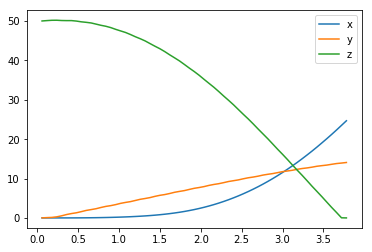

In [132]:
##Plot last-episode trajectory
plt.plot(results['time'], results['x'], label='x')
plt.plot(results['time'], results['y'], label='y')
plt.plot(results['time'], results['z'], label='z')
plt.legend()
_ = plt.ylim()

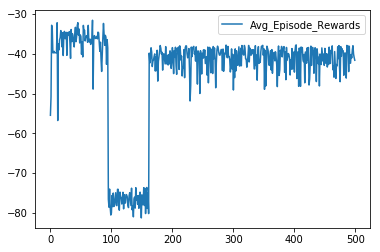

In [133]:
plt.plot(range(len(avg_episode_rewards)), avg_episode_rewards, label='Avg_Episode_Rewards')
plt.legend()
_ = plt.ylim()

**QUESTION:** I tried training on a GPU via Floydhub, but the training didn't seem to go any faster than the CPU I've been using here. Is this to be expected? 

## Reflections

**Question 1**: Describe the task that you specified in `task.py`.  How did you design the reward function?

**Answer**: I designed the reward function to land softly. I specified this task originally with the reward function 

reward = - alpha*(abs(self.sim.pose[:3] - self.target_pose[:3])).sum() - beta*(abs(self.sim.v[:3] - self.target_vel)).sum()/abs(self.sim.pose[:3] - self.target_pose[:3])).sum() 

but then found in training that the reward function was behaving very strangely. I suspected that it might have to do with singular behavior of the reward function when approaching the target position, so modified the reward function to

reward = - alpha*(abs(self.sim.pose[:3] - self.target_pose[:3])).sum() - beta*(abs(self.sim.v[:3] - self.target_vel)).sum()/(1 + gamma*(abs(self.sim.pose[:3] - self.target_pose[:3])).sum() ) 

with alpha = .3, beta = .3, gamma = 1. This yielded the desired training behavior.  



**Question 2**: Discuss your agent briefly, using the following questions as a guide:

- What learning algorithm(s) did you try? What worked best for you?
- What was your final choice of hyperparameters (such as $\alpha$, $\gamma$, $\epsilon$, etc.)?
- What neural network architecture did you use (if any)? Specify layers, sizes, activation functions, etc.

**Answer**:
- I tried a DDPG, which worked for certain parameter values and neural network architectures.
- I chose to remain with the original hyperparameters. Attempted deviations from these, particularly in exploration_theta and exploration_sigma, hurt performance. 
- For the actor and critic networks, I tried the following combinations: 

**1st pair of networks **
        
Actor:
        states = layers.Input(shape=(self.state_size,), name='states')
        net = layers.Dense(units=32, activation='relu')(states)
        net = layers.Dense(units=64, activation='relu')(net)
        net = layers.Dense(units=32, activation='relu')(net)
        raw_actions = layers.Dense(units=self.action_size, activation='sigmoid',
            name='raw_actions')(net)
            
Critic: 
        states = layers.Input(shape=(self.state_size,), name='states')
        actions = layers.Input(shape=(self.action_size,), name='actions')
        
        net_states = layers.Dense(units=32, activation='relu')(states)
        net_states = layers.Dense(units=64, activation='relu')(net_states)
        
        net_actions = layers.Dense(units=32, activation='relu')(actions)
        net_actions = layers.Dense(units=64, activation='relu')(net_actions)
        
        net = layers.Add()([net_states, net_actions])
        net = layers.Activation('relu')(net)
        
        Q_values = layers.Dense(units=1, name='q_values')(net)

**2nd pair of networks**

Actor: 
        states = layers.Input(shape=(self.state_size,), name='states')
        net = layers.Dense(units=256, activation='relu')(states)
        net = layers.BatchNormalization()(net)
        net = layers.Activation("relu")(net)
        net = layers.Dense(units=256, activation='relu')(net)
        net = layers.BatchNormalization()(net)
        net = layers.Activation("relu")(net)
        net = layers.Dense(units=128, activation='relu')(net)
        net = layers.BatchNormalization()(net)
        net = layers.Activation("relu")(net)
        net = layers.Dense(units=64, activation='relu')(net)
        raw_actions = layers.Dense(units=self.action_size, activation='sigmoid',
            name='raw_actions')(net)

Critic: 
        states = layers.Input(shape=(self.state_size,), name='states')
        actions = layers.Input(shape=(self.action_size,), name='actions')
        
        net_states = layers.Dense(units=256, activation='relu')(states)
        net_states = layers.BatchNormalization()(net_states)
        net_states = layers.Activation('relu')(net_states)
        net_states = layers.Dense(units=256, activation='relu')(net_states)
        net_states = layers.BatchNormalization()(net_states)
        net_states = layers.Activation('relu')(net_states)

        
        net_actions = layers.Dense(units=256, activation='relu')(actions)
        net_actions = layers.BatchNormalization()(net_actions)
        net_actions = layers.Activation('relu')(net_actions)
        net_actions = layers.Dense(units=256, activation='relu')(net_actions)

        net = layers.Add()([net_states, net_actions])
        net = layers.Activation('relu')(net)

        Q_values = layers.Dense(units=1, name='q_values')(net)

**Question 3**: Using the episode rewards plot, discuss how the agent learned over time.

- Was it an easy task to learn or hard?
- Was there a gradual learning curve, or an aha moment?
- How good was the final performance of the agent? (e.g. mean rewards over the last 10 episodes)

**Answer**:

- Once the reward function was properly specified, it was not too difficult a task to learn given the initial networks and parameters.
- The learning curve in ATTEMPT 5, which showed best performance, improved very suddenly around episode 260. 
- The average episode reward over the last 10 episodes was around -35, which was close to the peak performace of around -31, as compared to the initial average episode reward of around -67. 


**Question 4**: Briefly summarize your experience working on this project. You can use the following prompts for ideas.
- What was the hardest part of the project? (e.g. getting started, plotting, specifying the task, etc.)
- Did you find anything interesting in how the quadcopter or your agent behaved?

**Answer**:
- Getting started was the hardest part - in particular, converting my abstract theoretical understanding of the algorithms into working code. The task I chose was to land smoothly, and I attempted to specify the reward function so that velocity-dependent terms only contributed when the quadcopter was close to the spatial origin. My original reward function generated strange plots of reward vs training episode, likely due to the singular denominator that diverged when the quadcopter approached the target position (the origin). After changing this reward function to avoid this behavior, I found that the training generally improved the reward. I then attempted make further adjustments to the actor and critic networks by increasing the number of nodes and layers and adding batch normalization; counterintuitively, this appeared to diminish performance somewhat. Increasing the value of sigma associated with OU noise from .2 to .4 completely disrupted the training of the network. Likewise, adjusting the value of theta from .15 to .1 (with the original sigma=.2) also appeared to spoil the training.  

- I found it interesting that increasing the complexity of the actor and critic networks didn't appear to do much to improve training, as I expected it would. Also, I did not expect that the adjustments I made to sigma and theta in the OU noise would do so much to disrupt training. In most attempts, the quadcopter's trajectory landed at the desired location, so there was little surprising there. However, further explorations would also plot the velocity and try further adjustments to the reward function. 
